In [1]:
import os
import re
from collections import Counter
import json
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
cm = 1/2.54

# force GPU device
os.environ["CUDA_VISIBLE_DEVICES"]='1'
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'
import tensorflow as tf

from keras.src.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau, CSVLogger
from keras.src.layers import SimpleRNN, LSTM, Dense, Dropout, Bidirectional
from keras import Sequential, Input
from keras.losses import CategoricalCrossentropy, CategoricalFocalCrossentropy
from keras.optimizers import Adam
from keras.models import load_model
from keras.metrics import CategoricalAccuracy, TopKCategoricalAccuracy


from sklearn.metrics import classification_report, confusion_matrix
from sklearn.utils.class_weight import compute_class_weight

from utils import *

In [2]:
max_sequence_length = 100
experiment_name = 'tlds_hash'
top_k = 3

In [3]:
checkpoint_path = f'saves/{experiment_name}'
model_path = f'{checkpoint_path}/model.keras'
log_path = f'{checkpoint_path}/log.csv'
history_path = f'{checkpoint_path}/history.npy'

# ensure directory exists
if not os.path.exists(checkpoint_path):
    os.makedirs(checkpoint_path)

In [4]:
data_directory = '/home/jrosendahl/datasets/cadets/sequences_export_benign_filetypes_more/'
unusable_threshold = 10
rare_threshold = 50
splits = (0.7, 0.15, 0.15)

max_sequence_length = 100

assert(sum(splits) == 1)

print(f'experiment parameters: \n{data_directory=} \n{unusable_threshold=} \n{rare_threshold=} \n{splits=} \n{max_sequence_length=}')

experiment parameters: 
data_directory='/home/jrosendahl/datasets/cadets/sequences_export_benign_filetypes_more/' 
unusable_threshold=10 
rare_threshold=50 
splits=(0.7, 0.15, 0.15) 
max_sequence_length=100


In [5]:
total_classes = 0

# unusable classes will be removed from the dataset
unusable_classes = []
# rare classes will be oversampled
rare_classes = []

# all classes in training data (all classes - unusable classes)
classes = []

# walk all files, build unusable_classes, rare_classes
classes_occurrences = Counter()
for filename in os.listdir(data_directory):
    label = class_from_filename(filename)
    classes_occurrences[label] += 1

total_classes = len(classes_occurrences)
for label, count in classes_occurrences.items():
    if count < unusable_threshold:
        unusable_classes.append(label)
    elif count < rare_threshold:
        rare_classes.append(label)
        classes.append(label)
    else:
        classes.append(label)

print(f'Total classes: {total_classes}')
print(f'Unusable classes: {len(unusable_classes)}')
print(f'\t{unusable_classes}')
print(f'Rare classes: {len(rare_classes)}')
print(f'\t{rare_classes}')

labels_cardinality = len(set(classes))
print(f'Usable classes: {labels_cardinality}')

Total classes: 118
Unusable classes: 51
	['ping', 'pwd_mkdb', 'vi', 'tr', 'uname', 'msgs', 'screen', 'pw', 'bzip2', 'bzcat', 'nginx', 'stat', 'tail', 'smtp', 'kenv', 'nawk', 'ssh', 'chown', 'cut', 'php-fpm', 'jot', 'xz', 'diff', 'bounce', 'links', 'ipfw', 'touch', 'env', 'pfctl', 'minions', 'csh', 'kldstat', 'su', 'nohup', 'stty', 'df', 'limits', 'id', 'postmap', 'ifconfig', 'chkgrp', 'ipfstat', 'locale', 'devd', 'uniq', 'XIM', 'getty', 'which', 'init', 'test', 'nice']
Rare classes: 20
	['wc', 'grep', 'mktemp', 'less', 'tty', 'mailwrapper', 'kill', 'lockf', 'mount', 'tee', 'expr', 'ps', 'route', 'sed', 'cmp', 'egrep', 'sort', 'basename', 'awk', 'mail']
Usable classes: 67


In [6]:
# split into train, validation, test
labels_set = set()

filenames_all = []

filenames_train = []
filenames_val = []
filenames_test = []

for filename in os.listdir(data_directory):
    label = class_from_filename(filename)
    if label in unusable_classes:
        continue
    labels_set.add(label)
    filenames_all.append(filename)

# stratisfied split
test_vs_val = splits[2] / (splits[1] + splits[2])
filenames_train, filenames_val_test = train_test_split(filenames_all, test_size=splits[1]+splits[2], stratify=[class_from_filename(f) for f in filenames_all])
filenames_val, filenames_test = train_test_split(filenames_val_test, test_size=test_vs_val, stratify=[class_from_filename(f) for f in filenames_val_test])

print(f'Train: {len(filenames_train)}')
print(f'Validation: {len(filenames_val)}')
print(f'Test: {len(filenames_test)}')

# build labels_map in alphabetical order
labels_map = {}
for i, label in enumerate(sorted(labels_set)):
    labels_map[label] = i

Train: 150475
Validation: 32245
Test: 32245


In [7]:
# load data
count_files_read = 0
count_sequences_split = 0
count_splits = 0

preprocessor = Preprocessor(['TYPE', 'USERNAME', 'PRED_OBJ_TYPES', 'PRED_OBJ_PATHS', 'PRED_OBJ_PATHHASH', 'PRED_OBJ_NETINFO'])

def parse_file(filename) -> tuple[list[int], list[list[int]]]:
    """
    Parse a file and return the vectorized data. Not a pure function (calls parse_line)!
    """
    global count_files_read, count_sequences_split, count_splits

    y_list: list[int] = []
    X_list: list[list[int]] = []
    y = class_from_filename(filename)
    y = labels_map[y]
    with open(os.path.join(data_directory, filename), 'r') as f:
        lines = f.readlines()
        count_files_read += 1
    if count_files_read % 50000 == 0:
        print(f'Files read: {count_files_read}')
    X = []
    for line in lines:
        line_res = preprocessor.process(line)
        event = line_res['TYPE']
        user = line_res['USERNAME']
        path1 = line_res['PRED_OBJ1_PATH']
        path2 = line_res['PRED_OBJ2_PATH']
        """net1_localaddr = line_res['PRED_OBJ1_LOCALIP']
        net1_remoteaddr = line_res['PRED_OBJ1_REMOTEIP']
        net2_localaddr = line_res['PRED_OBJ2_LOCALIP']
        net2_remoteaddr = line_res['PRED_OBJ2_REMOTEIP']
        net1_localport = line_res['PRED_OBJ1_LOCALPORT']
        net1_remoteport = line_res['PRED_OBJ1_REMOTEPORT']
        net2_localport = line_res['PRED_OBJ2_LOCALPORT']
        net2_remoteport = line_res['PRED_OBJ2_REMOTEPORT']
        X.append((event, user, path1, path2, net1_localaddr, net1_localport, net1_remoteaddr, net1_remoteport, net2_localaddr, net2_localport, net2_remoteaddr, net2_remoteport))"""
        path1_hash = line_res['PRED_OBJ1_PATHHASH']
        path2_hash = line_res['PRED_OBJ2_PATHHASH']
        X.append((event, user, path1, path2, path1_hash, path2_hash))

    # check if sequence needs to be split
    if len(X) > max_sequence_length:
        count_sequences_split += 1
        count_splits += len(X) // max_sequence_length
        for i in range(0, len(X), max_sequence_length):
            y_list.append(y)
            X_list.append(X[i:i+max_sequence_length])
        assert len(X_list[0]) == max_sequence_length
    else:
        y_list.append(y)
        X_list.append(X)

    # transform elements to numpy arrays
    y_list = np.array(y_list)
    X_list = [np.array(x) for x in X_list]

    assert len(y_list) == len(X_list)
    return y_list, X_list


y_train = []
X_train = []
y_val = []
X_val = []
y_test = []
X_test = []

for filename in filenames_train:
    try:
        y_list, X_list = parse_file(filename)
    except Exception as e:
        print(f'Error parsing file: {filename}')
        raise e
    y_train.extend(y_list)
    X_train.extend(X_list)

for filename in filenames_val:
    y_list, X_list = parse_file(filename)
    y_val.extend(y_list)
    X_val.extend(X_list)

for filename in filenames_test:
    y_list, X_list = parse_file(filename)
    y_test.extend(y_list)
    X_test.extend(X_list)

assert len(X_train) == len(y_train)
assert len(X_val) == len(y_val)
assert len(X_test) == len(y_test)

print(f'Files read: {count_files_read}')
print(f'Sequences split: {count_sequences_split}')
print(f'Splits: {count_splits}')


event_types_map = preprocessor.event_types_map
users_map = preprocessor.users_map
filetypes_map = preprocessor.filetypes_map
path_map = preprocessor.path_map
addr_map = preprocessor.addr_map
port_map = preprocessor.port_map

event_types_cardinality = len(event_types_map)
users_cardinality = len(users_map)
filetypes_cardinality = len(filetypes_map)
path_cardinality = len(path_map)

print(f'Event types: {event_types_cardinality}')
print(f'Users: {users_cardinality}')
print(f'Filetypes: {filetypes_cardinality}')
print(f'Paths: {path_cardinality}')
print(f'Addresses: {len(addr_map)}')
print(f'Ports: {len(port_map)}')

# print lengths
print(f'Train: {len(y_train)}')
print(f'Validation: {len(y_val)}')
print(f'Test: {len(y_test)}')

KeyboardInterrupt: 

In [ ]:
# debug print all maps (sorted)
print('Event types:')
for k, v in sorted(event_types_map.items(), key=lambda x: x[1]):
    print(f'{v}: {k}', end=', ')
print()

print('Users:')
for k, v in sorted(users_map.items(), key=lambda x: x[1]):
    print(f'{v}: {k}', end=', ')
print()

print('Filetypes:')
for k, v in sorted(filetypes_map.items(), key=lambda x: x[1]):
    print(f'{v}: {k}', end=', ')
print()

print('Paths:')
for k, v in sorted(path_map.items(), key=lambda x: x[1]):
    print(f'{v}: {k}', end=', ')
print()

"""print('Addresses:')
for k, v in sorted(addr_map.items(), key=lambda x: x[1]):
    print(f'{v}: {k}', end=', ')
print()

print('Ports:')
for k, v in sorted(port_map.items(), key=lambda x: x[1]):
    print(f'{v}: {k}', end=', ')
print()"""

Event types:
0: EVENT_EXECUTE, 1: EVENT_OPEN, 2: EVENT_READ, 3: EVENT_CLOSE, 4: EVENT_MMAP, 5: EVENT_WRITE, 6: EVENT_EXIT, 7: EVENT_CONNECT, 8: EVENT_SENDTO, 9: EVENT_LSEEK, 10: EVENT_CHANGE_PRINCIPAL, 11: EVENT_LOGIN, 12: EVENT_MODIFY_PROCESS, 13: EVENT_FCNTL, 14: EVENT_RECVFROM, 15: EVENT_MPROTECT, 16: EVENT_CREATE_OBJECT, 17: EVENT_ACCEPT, 18: EVENT_UNLINK, 19: EVENT_FORK, 20: EVENT_MODIFY_FILE_ATTRIBUTES, 21: EVENT_LINK, 22: EVENT_RENAME, 23: EVENT_TRUNCATE, 24: EVENT_SIGNAL, 25: EVENT_OTHER, 26: EVENT_SENDMSG, 27: EVENT_RECVMSG, 28: EVENT_BIND, 
Users:
0: operator, 1: darpa, 2: root, 3: frank, 4: user, 5: charles, 6: george, 7: bob, 8: smmsp, 9: admin, 10: henry, 11: irene, 12: david, 13: postfix, 14: nobody, 15: _dhcp, 
Filetypes:
0: None, 1: FILE_OBJECT_FILE, 2: SUBJECT_PROCESS, 3: UNNAMEDPIPE, 4: FILE_OBJECT_UNIX_SOCKET, 5: FILE_OBJECT_DIR, 6: NETFLOW, 
Paths:
0: None, 1: bin, 2: libexec, 3: etc, 4: var, 5: lib, 6: dev, 7: usr, 8: data, 9: Other, 10: root, 11: home, 12: , 13: t

"print('Addresses:')\nfor k, v in sorted(addr_map.items(), key=lambda x: x[1]):\n    print(f'{v}: {k}', end=', ')\nprint()\n\nprint('Ports:')\nfor k, v in sorted(port_map.items(), key=lambda x: x[1]):\n    print(f'{v}: {k}', end=', ')\nprint()"

In [ ]:
# turn labels map into bidirectional map
for k, v in labels_map.copy().items():
    labels_map[v] = k

# turn feature maps into bidirectional maps
for k, v in event_types_map.copy().items():
    event_types_map[v] = k

for k, v in users_map.copy().items():
    users_map[v] = k

for k, v in filetypes_map.copy().items():
    filetypes_map[v] = k

for k, v in path_map.copy().items():
    path_map[v] = k

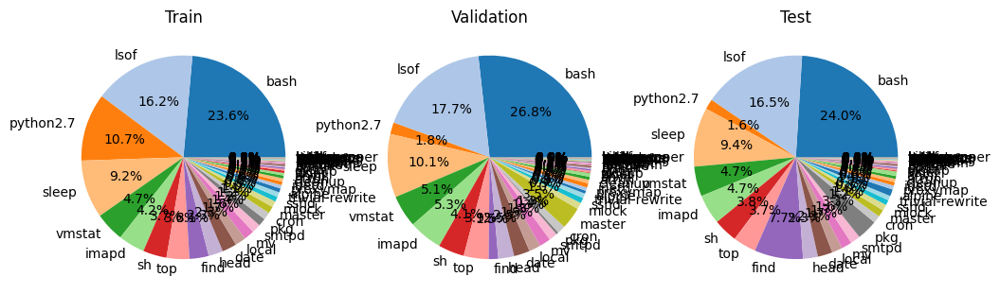

In [ ]:
# print distributions in all 3 sets
train_distribution = Counter(y_train)
val_distribution = Counter(y_val)
test_distribution = Counter(y_test)

# plot 3 pie plots, use same colors for same classes
colors = plt.cm.tab20.colors
colors = [ colors[i % 20] for i in range(labels_cardinality) ]

# sort labels by occurence in training set
sorted_labels = sorted(train_distribution, key=train_distribution.get, reverse=True)

# sort all distributions by sorted_labels
train_distribution = [train_distribution[label] for label in sorted_labels]
val_distribution = [val_distribution[label] for label in sorted_labels]
test_distribution = [test_distribution[label] for label in sorted_labels]

# transform labels to names
sorted_labels = [labels_map[label] for label in sorted_labels]

fig, axs = plt.subplots(1, 3, figsize=(30*cm, 10*cm))
axs[0].pie(train_distribution, labels=sorted_labels, colors=colors, autopct='%1.1f%%')
axs[0].set_title('Train')
axs[1].pie(val_distribution, labels=sorted_labels, colors=colors, autopct='%1.1f%%')
axs[1].set_title('Validation')
axs[2].pie(test_distribution, labels=sorted_labels, colors=colors, autopct='%1.1f%%')
axs[2].set_title('Test')
plt.savefig(f'{checkpoint_path}/distributions.png')
plt.show()

In [ ]:
# one-hot encode labels
y_train = np.eye(labels_cardinality)[y_train]
y_val = np.eye(labels_cardinality)[y_val]
y_test = np.eye(labels_cardinality)[y_test]

In [ ]:
# one-hot encode features
# at this point, X_* are lists of tuples of vectorized features
def encode_features(sequence: np.ndarray) -> np.ndarray:
    # Precompute identity matrices
    event_eye = np.eye(event_types_cardinality)
    user_eye = np.eye(users_cardinality)
    path_eye = np.eye(path_cardinality)
    addr_eye = np.eye(len(addr_map))
    port_eye = np.eye(len(port_map))

    # Initialize the output array with precomputed shapes
    #encoded_seq = np.empty((len(sequence), event_eye.shape[1] + user_eye.shape[1] +
    #                        2 * path_eye.shape[1] + 4 * addr_eye.shape[1] + 4 * port_eye.shape[1]))

    encoded_seq = np.empty((len(sequence), event_eye.shape[1] + user_eye.shape[1] +
                            2 * path_eye.shape[1] + 2))


    for i, feature_vector in enumerate(sequence):
        # one-hot
        event = event_eye[feature_vector[0]]
        user = user_eye[feature_vector[1]]
        path1 = path_eye[feature_vector[2]]
        path2 = path_eye[feature_vector[3]]
        # integers
        path1_hash = feature_vector[4]
        path2_hash = feature_vector[5]
        """addr1 = addr_eye[feature_vector[4]]
        port1 = port_eye[feature_vector[5]]
        addr2 = addr_eye[feature_vector[6]]
        port2 = port_eye[feature_vector[7]]
        addr3 = addr_eye[feature_vector[8]]
        port3 = port_eye[feature_vector[9]]
        addr4 = addr_eye[feature_vector[10]]
        port4 = port_eye[feature_vector[11]]"""

        # Concatenate all features into a single feature vector
        #encoded_seq[i] = np.concatenate((event, user, path1, path2, addr1, port1, addr2, port2, addr3, port3, addr4, port4))
        encoded_seq[i] = np.concatenate((event, user, path1, path2, [path1_hash], [path2_hash]))

    return encoded_seq

X_train = [ encode_features(x) for x in X_train ]
X_val = [ encode_features(x) for x in X_val ]
X_test = [ encode_features(x) for x in X_test ]

In [ ]:
feature_vector_cardinality = X_train[0].shape[1]

print(f'Feature vector cardinality: {feature_vector_cardinality}')

Feature vector cardinality: 93


In [ ]:
# debug print first sequence first 5 elements
print(X_train[0][:5])

[[ 1.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
   0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
   0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
   0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
   0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
   0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
   0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
   0.00000000e+00  1.00000000e+00  0.00000000e+00  0.00000000e+00
   0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
   0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
   0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
   0.00000000e+00  0.00000000e+00  1.00000000e+00  0.00000000e+00
   0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
   0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
   0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
   0.00000

In [ ]:
X_train, y_train = shuffle(X_train, y_train)
X_val, y_val = shuffle(X_val, y_val)
X_test, y_test = shuffle(X_test, y_test)

build model

In [ ]:
model = Sequential(layers=[
    Input(shape=(None, feature_vector_cardinality)),
    SimpleRNN(128, return_sequences=True),
    SimpleRNN(128, return_sequences=True),
    SimpleRNN(128, return_sequences=False),
    Dense(labels_cardinality, activation='softmax')
])

model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ simple_rnn (SimpleRNN)          │ (None, None, 128)      │        28,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ simple_rnn_1 (SimpleRNN)        │ (None, None, 128)      │        32,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ simple_rnn_2 (SimpleRNN)        │ (None, 128)            │        32,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 67)             │         8,643 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 102,851 (401.76 KB)

 Trainable params: 102,851 (401.76 KB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
callbacks = [
    EarlyStopping(
        monitor='val_loss',
        patience=5,
        verbose=1,
        mode='auto'
    ),
    ModelCheckpoint(
        filepath=model_path,
        monitor='val_loss',
        save_best_only=True,
        verbose=1
    ),
    ReduceLROnPlateau(
        monitor='val_loss',
        factor=0.1,
        patience=3,
        verbose=1,
        mode='auto',
        min_lr=1e-7
    ),
    CSVLogger(
        filename=log_path,
        append=True
    )
]

loss = CategoricalCrossentropy()
optimizer = Adam(learning_rate=0.0001)

# class weights
y_train_int = np.argmax(y_train, axis=1)
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.unique(y_train_int),
    y=y_train_int
)
class_weights_dict = dict(enumerate(class_weights))

metrics = [
    CategoricalAccuracy(name='categorical_accuracy'),
    TopKCategoricalAccuracy(k=top_k, name=f'top_{top_k}_categorical_accuracy'),
]

weighted_metrics = [
    CategoricalAccuracy(name='w_categorical_accuracy'),
    TopKCategoricalAccuracy(k=top_k, name=f'w_top_{top_k}_categorical_accuracy'),
]

# 'categorical_focal_crossentropy'
# 'categorical_crossentropy'
model.compile(
    loss=loss,
    optimizer=optimizer,
    metrics=metrics,
    weighted_metrics=weighted_metrics,
)

train model

In [ ]:
history = model.fit(
    x=Generator(X_train, y_train, 128, max_sequence_length),
    validation_data=Generator(X_val, y_val, 128, max_sequence_length),
    epochs=200,
    callbacks=callbacks,
    class_weight=class_weights_dict
)

# save history to file
with open(history_path, 'wb') as f:
    np.save(f, history.history)

Epoch 1/200


I0000 00:00:1724080334.716411 2730979 service.cc:145] XLA service 0x7112d4003a80 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1724080334.716495 2730979 service.cc:153]   StreamExecutor device (0): NVIDIA GeForce RTX 2080 Ti, Compute Capability 7.5


I0000 00:00:1724080340.182410 2731178 asm_compiler.cc:369] ptxas warning : Registers are spilled to local memory in function 'triton_gemm_dot_81', 1384 bytes spill stores, 1384 bytes spill loads




   1/1932 ━━━━━━━━━━━━━━━━━━━━ 5:09:21 10s/step - categorical_accuracy: 0.0000e+00 - loss: 2.5397 - top_3_categorical_accuracy: 0.0000e+00 - w_categorical_accuracy: 0.0000e+00 - w_top_3_categorical_accuracy: 0.0000e+00


   3/1932 ━━━━━━━━━━━━━━━━━━━━ 1:10 36ms/step - categorical_accuracy: 0.0039 - loss: 3.1579 - top_3_categorical_accuracy: 0.0078 - w_categorical_accuracy: 0.0018 - w_top_3_categorical_accuracy: 0.0027                  


   5/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.0045 - loss: 3.8942 - top_3_categorical_accuracy: 0.0105 - w_categorical_accuracy: 0.0023 - w_top_3_categorical_accuracy: 0.0042

I0000 00:00:1724080341.618164 2730979 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.



   7/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.0054 - loss: 4.5519 - top_3_categorical_accuracy: 0.0133 - w_categorical_accuracy: 0.0024 - w_top_3_categorical_accuracy: 0.0054


   9/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.0074 - loss: 4.7249 - top_3_categorical_accuracy: 0.0160 - w_categorical_accuracy: 0.0035 - w_top_3_categorical_accuracy: 0.0072


  11/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.0098 - loss: 4.7229 - top_3_categorical_accuracy: 0.0188 - w_categorical_accuracy: 0.0051 - w_top_3_categorical_accuracy: 0.0098


  13/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 33ms/step - categorical_accuracy: 0.0117 - loss: 4.6846 - top_3_categorical_accuracy: 0.0210 - w_categorical_accuracy: 0.0064 - w_top_3_categorical_accuracy: 0.0122


  15/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.0131 - loss: 4.6469 - top_3_categorical_accuracy: 0.0227 - w_categorical_accuracy: 0.0074 - w_top_3_categorical_accuracy: 0.0142


  17/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 33ms/step - categorical_accuracy: 0.0141 - loss: 4.6134 - top_3_categorical_accuracy: 0.0246 - w_categorical_accuracy: 0.0082 - w_top_3_categorical_accuracy: 0.0162


  19/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.0147 - loss: 4.5732 - top_3_categorical_accuracy: 0.0263 - w_categorical_accuracy: 0.0087 - w_top_3_categorical_accuracy: 0.0179


  21/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.0151 - loss: 4.5390 - top_3_categorical_accuracy: 0.0275 - w_categorical_accuracy: 0.0091 - w_top_3_categorical_accuracy: 0.0191


  23/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.0155 - loss: 4.5013 - top_3_categorical_accuracy: 0.0285 - w_categorical_accuracy: 0.0095 - w_top_3_categorical_accuracy: 0.0201


  25/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.0159 - loss: 4.4611 - top_3_categorical_accuracy: 0.0292 - w_categorical_accuracy: 0.0099 - w_top_3_categorical_accuracy: 0.0210


  27/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.0163 - loss: 4.4180 - top_3_categorical_accuracy: 0.0298 - w_categorical_accuracy: 0.0102 - w_top_3_categorical_accuracy: 0.0218


  29/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.0166 - loss: 4.3952 - top_3_categorical_accuracy: 0.0303 - w_categorical_accuracy: 0.0105 - w_top_3_categorical_accuracy: 0.0224


  31/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.0168 - loss: 4.3726 - top_3_categorical_accuracy: 0.0307 - w_categorical_accuracy: 0.0109 - w_top_3_categorical_accuracy: 0.0230


  33/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.0171 - loss: 4.3484 - top_3_categorical_accuracy: 0.0311 - w_categorical_accuracy: 0.0112 - w_top_3_categorical_accuracy: 0.0237


  35/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.0172 - loss: 4.3298 - top_3_categorical_accuracy: 0.0314 - w_categorical_accuracy: 0.0115 - w_top_3_categorical_accuracy: 0.0247


  37/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.0173 - loss: 4.3108 - top_3_categorical_accuracy: 0.0317 - w_categorical_accuracy: 0.0117 - w_top_3_categorical_accuracy: 0.0265


  39/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.0173 - loss: 4.2930 - top_3_categorical_accuracy: 0.0320 - w_categorical_accuracy: 0.0118 - w_top_3_categorical_accuracy: 0.0286


  41/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.0173 - loss: 4.2731 - top_3_categorical_accuracy: 0.0323 - w_categorical_accuracy: 0.0120 - w_top_3_categorical_accuracy: 0.0305


  43/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.0173 - loss: 4.2545 - top_3_categorical_accuracy: 0.0325 - w_categorical_accuracy: 0.0121 - w_top_3_categorical_accuracy: 0.0323


  45/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.0172 - loss: 4.2383 - top_3_categorical_accuracy: 0.0328 - w_categorical_accuracy: 0.0122 - w_top_3_categorical_accuracy: 0.0339


  47/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.0171 - loss: 4.2234 - top_3_categorical_accuracy: 0.0331 - w_categorical_accuracy: 0.0124 - w_top_3_categorical_accuracy: 0.0354


  49/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.0170 - loss: 4.2076 - top_3_categorical_accuracy: 0.0334 - w_categorical_accuracy: 0.0124 - w_top_3_categorical_accuracy: 0.0368


  51/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.0169 - loss: 4.1900 - top_3_categorical_accuracy: 0.0336 - w_categorical_accuracy: 0.0125 - w_top_3_categorical_accuracy: 0.0382


  53/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.0168 - loss: 4.1711 - top_3_categorical_accuracy: 0.0339 - w_categorical_accuracy: 0.0126 - w_top_3_categorical_accuracy: 0.0394


  55/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.0167 - loss: 4.1531 - top_3_categorical_accuracy: 0.0341 - w_categorical_accuracy: 0.0127 - w_top_3_categorical_accuracy: 0.0406


  57/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.0167 - loss: 4.1362 - top_3_categorical_accuracy: 0.0344 - w_categorical_accuracy: 0.0129 - w_top_3_categorical_accuracy: 0.0419


  59/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.0166 - loss: 4.1216 - top_3_categorical_accuracy: 0.0347 - w_categorical_accuracy: 0.0132 - w_top_3_categorical_accuracy: 0.0432


  61/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.0165 - loss: 4.1120 - top_3_categorical_accuracy: 0.0352 - w_categorical_accuracy: 0.0134 - w_top_3_categorical_accuracy: 0.0444


  63/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.0165 - loss: 4.1015 - top_3_categorical_accuracy: 0.0358 - w_categorical_accuracy: 0.0138 - w_top_3_categorical_accuracy: 0.0457


  65/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.0165 - loss: 4.0935 - top_3_categorical_accuracy: 0.0365 - w_categorical_accuracy: 0.0141 - w_top_3_categorical_accuracy: 0.0470


  67/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.0165 - loss: 4.0876 - top_3_categorical_accuracy: 0.0372 - w_categorical_accuracy: 0.0145 - w_top_3_categorical_accuracy: 0.0483


  69/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.0165 - loss: 4.0806 - top_3_categorical_accuracy: 0.0378 - w_categorical_accuracy: 0.0149 - w_top_3_categorical_accuracy: 0.0495


  71/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.0165 - loss: 4.0729 - top_3_categorical_accuracy: 0.0385 - w_categorical_accuracy: 0.0153 - w_top_3_categorical_accuracy: 0.0507


  73/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.0165 - loss: 4.0654 - top_3_categorical_accuracy: 0.0391 - w_categorical_accuracy: 0.0157 - w_top_3_categorical_accuracy: 0.0519


  75/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.0165 - loss: 4.0647 - top_3_categorical_accuracy: 0.0397 - w_categorical_accuracy: 0.0160 - w_top_3_categorical_accuracy: 0.0529


  77/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.0166 - loss: 4.0631 - top_3_categorical_accuracy: 0.0403 - w_categorical_accuracy: 0.0163 - w_top_3_categorical_accuracy: 0.0539


  79/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.0166 - loss: 4.0615 - top_3_categorical_accuracy: 0.0409 - w_categorical_accuracy: 0.0166 - w_top_3_categorical_accuracy: 0.0549


  81/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.0166 - loss: 4.0599 - top_3_categorical_accuracy: 0.0416 - w_categorical_accuracy: 0.0169 - w_top_3_categorical_accuracy: 0.0558


  83/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.0166 - loss: 4.0591 - top_3_categorical_accuracy: 0.0423 - w_categorical_accuracy: 0.0172 - w_top_3_categorical_accuracy: 0.0567


  85/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.0167 - loss: 4.0576 - top_3_categorical_accuracy: 0.0429 - w_categorical_accuracy: 0.0175 - w_top_3_categorical_accuracy: 0.0576


  87/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.0167 - loss: 4.0558 - top_3_categorical_accuracy: 0.0437 - w_categorical_accuracy: 0.0178 - w_top_3_categorical_accuracy: 0.0585


  89/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.0168 - loss: 4.0535 - top_3_categorical_accuracy: 0.0444 - w_categorical_accuracy: 0.0181 - w_top_3_categorical_accuracy: 0.0593


  91/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.0169 - loss: 4.0507 - top_3_categorical_accuracy: 0.0451 - w_categorical_accuracy: 0.0183 - w_top_3_categorical_accuracy: 0.0602


  93/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.0171 - loss: 4.0471 - top_3_categorical_accuracy: 0.0459 - w_categorical_accuracy: 0.0186 - w_top_3_categorical_accuracy: 0.0612


  95/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.0173 - loss: 4.0434 - top_3_categorical_accuracy: 0.0467 - w_categorical_accuracy: 0.0190 - w_top_3_categorical_accuracy: 0.0621


  97/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.0176 - loss: 4.0397 - top_3_categorical_accuracy: 0.0476 - w_categorical_accuracy: 0.0194 - w_top_3_categorical_accuracy: 0.0632


  99/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.0178 - loss: 4.0364 - top_3_categorical_accuracy: 0.0485 - w_categorical_accuracy: 0.0200 - w_top_3_categorical_accuracy: 0.0644


 101/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.0181 - loss: 4.0336 - top_3_categorical_accuracy: 0.0494 - w_categorical_accuracy: 0.0206 - w_top_3_categorical_accuracy: 0.0656


 103/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.0184 - loss: 4.0311 - top_3_categorical_accuracy: 0.0504 - w_categorical_accuracy: 0.0212 - w_top_3_categorical_accuracy: 0.0669


 105/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.0187 - loss: 4.0284 - top_3_categorical_accuracy: 0.0515 - w_categorical_accuracy: 0.0218 - w_top_3_categorical_accuracy: 0.0681


 107/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.0191 - loss: 4.0284 - top_3_categorical_accuracy: 0.0525 - w_categorical_accuracy: 0.0225 - w_top_3_categorical_accuracy: 0.0694


 109/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.0194 - loss: 4.0278 - top_3_categorical_accuracy: 0.0536 - w_categorical_accuracy: 0.0232 - w_top_3_categorical_accuracy: 0.0706


 111/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.0198 - loss: 4.0269 - top_3_categorical_accuracy: 0.0547 - w_categorical_accuracy: 0.0239 - w_top_3_categorical_accuracy: 0.0719


 113/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.0202 - loss: 4.0278 - top_3_categorical_accuracy: 0.0559 - w_categorical_accuracy: 0.0245 - w_top_3_categorical_accuracy: 0.0730


 115/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.0206 - loss: 4.0285 - top_3_categorical_accuracy: 0.0570 - w_categorical_accuracy: 0.0251 - w_top_3_categorical_accuracy: 0.0741


 117/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.0210 - loss: 4.0296 - top_3_categorical_accuracy: 0.0580 - w_categorical_accuracy: 0.0259 - w_top_3_categorical_accuracy: 0.0753


 119/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.0215 - loss: 4.0313 - top_3_categorical_accuracy: 0.0591 - w_categorical_accuracy: 0.0269 - w_top_3_categorical_accuracy: 0.0767


 121/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.0219 - loss: 4.0329 - top_3_categorical_accuracy: 0.0601 - w_categorical_accuracy: 0.0278 - w_top_3_categorical_accuracy: 0.0780


 123/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.0223 - loss: 4.0342 - top_3_categorical_accuracy: 0.0611 - w_categorical_accuracy: 0.0287 - w_top_3_categorical_accuracy: 0.0794


 125/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.0227 - loss: 4.0349 - top_3_categorical_accuracy: 0.0621 - w_categorical_accuracy: 0.0295 - w_top_3_categorical_accuracy: 0.0806


 127/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.0232 - loss: 4.0358 - top_3_categorical_accuracy: 0.0631 - w_categorical_accuracy: 0.0304 - w_top_3_categorical_accuracy: 0.0819


 129/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.0236 - loss: 4.0363 - top_3_categorical_accuracy: 0.0641 - w_categorical_accuracy: 0.0313 - w_top_3_categorical_accuracy: 0.0832


 131/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.0240 - loss: 4.0366 - top_3_categorical_accuracy: 0.0651 - w_categorical_accuracy: 0.0322 - w_top_3_categorical_accuracy: 0.0844


 133/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.0244 - loss: 4.0366 - top_3_categorical_accuracy: 0.0661 - w_categorical_accuracy: 0.0330 - w_top_3_categorical_accuracy: 0.0856


 135/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.0248 - loss: 4.0361 - top_3_categorical_accuracy: 0.0671 - w_categorical_accuracy: 0.0338 - w_top_3_categorical_accuracy: 0.0868


 137/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.0253 - loss: 4.0352 - top_3_categorical_accuracy: 0.0681 - w_categorical_accuracy: 0.0346 - w_top_3_categorical_accuracy: 0.0879


 139/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.0258 - loss: 4.0342 - top_3_categorical_accuracy: 0.0691 - w_categorical_accuracy: 0.0354 - w_top_3_categorical_accuracy: 0.0891


 141/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.0263 - loss: 4.0335 - top_3_categorical_accuracy: 0.0701 - w_categorical_accuracy: 0.0363 - w_top_3_categorical_accuracy: 0.0903


 143/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.0268 - loss: 4.0325 - top_3_categorical_accuracy: 0.0711 - w_categorical_accuracy: 0.0371 - w_top_3_categorical_accuracy: 0.0914


 145/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.0273 - loss: 4.0314 - top_3_categorical_accuracy: 0.0721 - w_categorical_accuracy: 0.0379 - w_top_3_categorical_accuracy: 0.0925


 147/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.0279 - loss: 4.0306 - top_3_categorical_accuracy: 0.0731 - w_categorical_accuracy: 0.0386 - w_top_3_categorical_accuracy: 0.0936


 149/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.0284 - loss: 4.0296 - top_3_categorical_accuracy: 0.0742 - w_categorical_accuracy: 0.0394 - w_top_3_categorical_accuracy: 0.0947


 151/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.0290 - loss: 4.0283 - top_3_categorical_accuracy: 0.0753 - w_categorical_accuracy: 0.0402 - w_top_3_categorical_accuracy: 0.0958


 153/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.0296 - loss: 4.0267 - top_3_categorical_accuracy: 0.0763 - w_categorical_accuracy: 0.0409 - w_top_3_categorical_accuracy: 0.0968


 155/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.0302 - loss: 4.0248 - top_3_categorical_accuracy: 0.0774 - w_categorical_accuracy: 0.0416 - w_top_3_categorical_accuracy: 0.0979


 157/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.0308 - loss: 4.0228 - top_3_categorical_accuracy: 0.0785 - w_categorical_accuracy: 0.0424 - w_top_3_categorical_accuracy: 0.0989


 159/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.0314 - loss: 4.0209 - top_3_categorical_accuracy: 0.0797 - w_categorical_accuracy: 0.0431 - w_top_3_categorical_accuracy: 0.0999


 161/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.0321 - loss: 4.0187 - top_3_categorical_accuracy: 0.0808 - w_categorical_accuracy: 0.0439 - w_top_3_categorical_accuracy: 0.1009


 163/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.0328 - loss: 4.0162 - top_3_categorical_accuracy: 0.0820 - w_categorical_accuracy: 0.0446 - w_top_3_categorical_accuracy: 0.1020


 165/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.0335 - loss: 4.0139 - top_3_categorical_accuracy: 0.0832 - w_categorical_accuracy: 0.0454 - w_top_3_categorical_accuracy: 0.1030


 167/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.0342 - loss: 4.0115 - top_3_categorical_accuracy: 0.0843 - w_categorical_accuracy: 0.0461 - w_top_3_categorical_accuracy: 0.1040


 169/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.0350 - loss: 4.0090 - top_3_categorical_accuracy: 0.0856 - w_categorical_accuracy: 0.0468 - w_top_3_categorical_accuracy: 0.1050


 171/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.0358 - loss: 4.0063 - top_3_categorical_accuracy: 0.0868 - w_categorical_accuracy: 0.0475 - w_top_3_categorical_accuracy: 0.1059 


 173/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.0366 - loss: 4.0035 - top_3_categorical_accuracy: 0.0880 - w_categorical_accuracy: 0.0482 - w_top_3_categorical_accuracy: 0.1069


 175/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.0374 - loss: 4.0009 - top_3_categorical_accuracy: 0.0893 - w_categorical_accuracy: 0.0489 - w_top_3_categorical_accuracy: 0.1079


 177/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.0382 - loss: 3.9981 - top_3_categorical_accuracy: 0.0905 - w_categorical_accuracy: 0.0496 - w_top_3_categorical_accuracy: 0.1088


 179/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.0391 - loss: 3.9952 - top_3_categorical_accuracy: 0.0918 - w_categorical_accuracy: 0.0503 - w_top_3_categorical_accuracy: 0.1098


 181/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.0400 - loss: 3.9924 - top_3_categorical_accuracy: 0.0931 - w_categorical_accuracy: 0.0510 - w_top_3_categorical_accuracy: 0.1107


 183/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.0409 - loss: 3.9905 - top_3_categorical_accuracy: 0.0944 - w_categorical_accuracy: 0.0517 - w_top_3_categorical_accuracy: 0.1116


 185/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.0418 - loss: 3.9889 - top_3_categorical_accuracy: 0.0957 - w_categorical_accuracy: 0.0523 - w_top_3_categorical_accuracy: 0.1125


 187/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.0427 - loss: 3.9872 - top_3_categorical_accuracy: 0.0970 - w_categorical_accuracy: 0.0529 - w_top_3_categorical_accuracy: 0.1134


 189/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.0436 - loss: 3.9853 - top_3_categorical_accuracy: 0.0984 - w_categorical_accuracy: 0.0536 - w_top_3_categorical_accuracy: 0.1144


 191/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.0445 - loss: 3.9832 - top_3_categorical_accuracy: 0.0997 - w_categorical_accuracy: 0.0542 - w_top_3_categorical_accuracy: 0.1153


 193/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.0455 - loss: 3.9811 - top_3_categorical_accuracy: 0.1010 - w_categorical_accuracy: 0.0548 - w_top_3_categorical_accuracy: 0.1162


 195/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.0464 - loss: 3.9788 - top_3_categorical_accuracy: 0.1024 - w_categorical_accuracy: 0.0554 - w_top_3_categorical_accuracy: 0.1172


 197/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.0474 - loss: 3.9765 - top_3_categorical_accuracy: 0.1037 - w_categorical_accuracy: 0.0561 - w_top_3_categorical_accuracy: 0.1181


 199/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.0483 - loss: 3.9741 - top_3_categorical_accuracy: 0.1051 - w_categorical_accuracy: 0.0567 - w_top_3_categorical_accuracy: 0.1190


 201/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.0492 - loss: 3.9720 - top_3_categorical_accuracy: 0.1065 - w_categorical_accuracy: 0.0573 - w_top_3_categorical_accuracy: 0.1199


 203/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.0502 - loss: 3.9701 - top_3_categorical_accuracy: 0.1079 - w_categorical_accuracy: 0.0579 - w_top_3_categorical_accuracy: 0.1208


 205/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.0511 - loss: 3.9681 - top_3_categorical_accuracy: 0.1092 - w_categorical_accuracy: 0.0585 - w_top_3_categorical_accuracy: 0.1217


 207/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.0520 - loss: 3.9662 - top_3_categorical_accuracy: 0.1106 - w_categorical_accuracy: 0.0591 - w_top_3_categorical_accuracy: 0.1226


 209/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.0529 - loss: 3.9642 - top_3_categorical_accuracy: 0.1120 - w_categorical_accuracy: 0.0597 - w_top_3_categorical_accuracy: 0.1235


 211/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.0538 - loss: 3.9621 - top_3_categorical_accuracy: 0.1134 - w_categorical_accuracy: 0.0603 - w_top_3_categorical_accuracy: 0.1243


 213/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.0547 - loss: 3.9598 - top_3_categorical_accuracy: 0.1148 - w_categorical_accuracy: 0.0609 - w_top_3_categorical_accuracy: 0.1252


 215/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.0556 - loss: 3.9575 - top_3_categorical_accuracy: 0.1162 - w_categorical_accuracy: 0.0615 - w_top_3_categorical_accuracy: 0.1261


 217/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.0566 - loss: 3.9552 - top_3_categorical_accuracy: 0.1177 - w_categorical_accuracy: 0.0620 - w_top_3_categorical_accuracy: 0.1270


 219/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.0575 - loss: 3.9528 - top_3_categorical_accuracy: 0.1191 - w_categorical_accuracy: 0.0626 - w_top_3_categorical_accuracy: 0.1278


 221/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.0584 - loss: 3.9506 - top_3_categorical_accuracy: 0.1205 - w_categorical_accuracy: 0.0632 - w_top_3_categorical_accuracy: 0.1287


 223/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.0593 - loss: 3.9485 - top_3_categorical_accuracy: 0.1219 - w_categorical_accuracy: 0.0637 - w_top_3_categorical_accuracy: 0.1295


 225/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.0603 - loss: 3.9466 - top_3_categorical_accuracy: 0.1234 - w_categorical_accuracy: 0.0643 - w_top_3_categorical_accuracy: 0.1304


 227/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.0612 - loss: 3.9446 - top_3_categorical_accuracy: 0.1248 - w_categorical_accuracy: 0.0649 - w_top_3_categorical_accuracy: 0.1313


 229/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.0621 - loss: 3.9428 - top_3_categorical_accuracy: 0.1262 - w_categorical_accuracy: 0.0655 - w_top_3_categorical_accuracy: 0.1322


 231/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.0630 - loss: 3.9410 - top_3_categorical_accuracy: 0.1277 - w_categorical_accuracy: 0.0661 - w_top_3_categorical_accuracy: 0.1330


 233/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.0639 - loss: 3.9392 - top_3_categorical_accuracy: 0.1291 - w_categorical_accuracy: 0.0667 - w_top_3_categorical_accuracy: 0.1339


 235/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.0649 - loss: 3.9375 - top_3_categorical_accuracy: 0.1305 - w_categorical_accuracy: 0.0674 - w_top_3_categorical_accuracy: 0.1348


 237/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.0658 - loss: 3.9357 - top_3_categorical_accuracy: 0.1319 - w_categorical_accuracy: 0.0681 - w_top_3_categorical_accuracy: 0.1358


 239/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.0667 - loss: 3.9338 - top_3_categorical_accuracy: 0.1333 - w_categorical_accuracy: 0.0687 - w_top_3_categorical_accuracy: 0.1367


 241/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.0676 - loss: 3.9323 - top_3_categorical_accuracy: 0.1347 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.1376


 243/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.0686 - loss: 3.9308 - top_3_categorical_accuracy: 0.1361 - w_categorical_accuracy: 0.0701 - w_top_3_categorical_accuracy: 0.1385


 245/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.0695 - loss: 3.9295 - top_3_categorical_accuracy: 0.1375 - w_categorical_accuracy: 0.0707 - w_top_3_categorical_accuracy: 0.1394


 247/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.0704 - loss: 3.9284 - top_3_categorical_accuracy: 0.1389 - w_categorical_accuracy: 0.0713 - w_top_3_categorical_accuracy: 0.1403


 249/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.0713 - loss: 3.9275 - top_3_categorical_accuracy: 0.1403 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1411


 251/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.0723 - loss: 3.9265 - top_3_categorical_accuracy: 0.1417 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1420


 253/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.0732 - loss: 3.9257 - top_3_categorical_accuracy: 0.1431 - w_categorical_accuracy: 0.0732 - w_top_3_categorical_accuracy: 0.1428


 255/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.0741 - loss: 3.9250 - top_3_categorical_accuracy: 0.1445 - w_categorical_accuracy: 0.0738 - w_top_3_categorical_accuracy: 0.1437


 257/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.0750 - loss: 3.9245 - top_3_categorical_accuracy: 0.1459 - w_categorical_accuracy: 0.0744 - w_top_3_categorical_accuracy: 0.1446


 259/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.0759 - loss: 3.9244 - top_3_categorical_accuracy: 0.1472 - w_categorical_accuracy: 0.0750 - w_top_3_categorical_accuracy: 0.1454


 261/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.0768 - loss: 3.9242 - top_3_categorical_accuracy: 0.1486 - w_categorical_accuracy: 0.0755 - w_top_3_categorical_accuracy: 0.1463


 263/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.0777 - loss: 3.9240 - top_3_categorical_accuracy: 0.1500 - w_categorical_accuracy: 0.0761 - w_top_3_categorical_accuracy: 0.1471


 265/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.0786 - loss: 3.9237 - top_3_categorical_accuracy: 0.1513 - w_categorical_accuracy: 0.0767 - w_top_3_categorical_accuracy: 0.1479


 267/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.0795 - loss: 3.9234 - top_3_categorical_accuracy: 0.1527 - w_categorical_accuracy: 0.0772 - w_top_3_categorical_accuracy: 0.1488


 269/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.0803 - loss: 3.9229 - top_3_categorical_accuracy: 0.1540 - w_categorical_accuracy: 0.0777 - w_top_3_categorical_accuracy: 0.1496


 271/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.0812 - loss: 3.9224 - top_3_categorical_accuracy: 0.1554 - w_categorical_accuracy: 0.0783 - w_top_3_categorical_accuracy: 0.1504


 273/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.0821 - loss: 3.9219 - top_3_categorical_accuracy: 0.1568 - w_categorical_accuracy: 0.0788 - w_top_3_categorical_accuracy: 0.1512


 275/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.0829 - loss: 3.9214 - top_3_categorical_accuracy: 0.1581 - w_categorical_accuracy: 0.0794 - w_top_3_categorical_accuracy: 0.1520


 277/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.0838 - loss: 3.9209 - top_3_categorical_accuracy: 0.1594 - w_categorical_accuracy: 0.0799 - w_top_3_categorical_accuracy: 0.1528


 279/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.0846 - loss: 3.9202 - top_3_categorical_accuracy: 0.1608 - w_categorical_accuracy: 0.0804 - w_top_3_categorical_accuracy: 0.1536


 281/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.0855 - loss: 3.9197 - top_3_categorical_accuracy: 0.1621 - w_categorical_accuracy: 0.0809 - w_top_3_categorical_accuracy: 0.1544


 283/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.0863 - loss: 3.9191 - top_3_categorical_accuracy: 0.1634 - w_categorical_accuracy: 0.0814 - w_top_3_categorical_accuracy: 0.1552


 285/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.0871 - loss: 3.9184 - top_3_categorical_accuracy: 0.1647 - w_categorical_accuracy: 0.0819 - w_top_3_categorical_accuracy: 0.1559


 287/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.0879 - loss: 3.9177 - top_3_categorical_accuracy: 0.1661 - w_categorical_accuracy: 0.0825 - w_top_3_categorical_accuracy: 0.1567


 289/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.0887 - loss: 3.9170 - top_3_categorical_accuracy: 0.1674 - w_categorical_accuracy: 0.0830 - w_top_3_categorical_accuracy: 0.1574


 291/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.0895 - loss: 3.9161 - top_3_categorical_accuracy: 0.1687 - w_categorical_accuracy: 0.0835 - w_top_3_categorical_accuracy: 0.1582


 293/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.0904 - loss: 3.9153 - top_3_categorical_accuracy: 0.1700 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1590


 295/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.0912 - loss: 3.9146 - top_3_categorical_accuracy: 0.1713 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1597


 297/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.0920 - loss: 3.9139 - top_3_categorical_accuracy: 0.1726 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1605


 299/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.0928 - loss: 3.9131 - top_3_categorical_accuracy: 0.1739 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1613


 301/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.0936 - loss: 3.9124 - top_3_categorical_accuracy: 0.1751 - w_categorical_accuracy: 0.0859 - w_top_3_categorical_accuracy: 0.1621


 303/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.0944 - loss: 3.9118 - top_3_categorical_accuracy: 0.1764 - w_categorical_accuracy: 0.0865 - w_top_3_categorical_accuracy: 0.1629


 305/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.0952 - loss: 3.9112 - top_3_categorical_accuracy: 0.1777 - w_categorical_accuracy: 0.0870 - w_top_3_categorical_accuracy: 0.1637


 307/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.0960 - loss: 3.9105 - top_3_categorical_accuracy: 0.1789 - w_categorical_accuracy: 0.0875 - w_top_3_categorical_accuracy: 0.1645


 309/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.0968 - loss: 3.9098 - top_3_categorical_accuracy: 0.1802 - w_categorical_accuracy: 0.0880 - w_top_3_categorical_accuracy: 0.1653


 311/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.0976 - loss: 3.9090 - top_3_categorical_accuracy: 0.1815 - w_categorical_accuracy: 0.0885 - w_top_3_categorical_accuracy: 0.1661


 313/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.0984 - loss: 3.9081 - top_3_categorical_accuracy: 0.1827 - w_categorical_accuracy: 0.0890 - w_top_3_categorical_accuracy: 0.1669


 315/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.0992 - loss: 3.9073 - top_3_categorical_accuracy: 0.1840 - w_categorical_accuracy: 0.0895 - w_top_3_categorical_accuracy: 0.1676


 317/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.1000 - loss: 3.9064 - top_3_categorical_accuracy: 0.1852 - w_categorical_accuracy: 0.0900 - w_top_3_categorical_accuracy: 0.1684


 319/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.1008 - loss: 3.9054 - top_3_categorical_accuracy: 0.1865 - w_categorical_accuracy: 0.0905 - w_top_3_categorical_accuracy: 0.1692


 321/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.1016 - loss: 3.9045 - top_3_categorical_accuracy: 0.1877 - w_categorical_accuracy: 0.0910 - w_top_3_categorical_accuracy: 0.1700


 323/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.1023 - loss: 3.9035 - top_3_categorical_accuracy: 0.1889 - w_categorical_accuracy: 0.0915 - w_top_3_categorical_accuracy: 0.1707


 325/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.1031 - loss: 3.9024 - top_3_categorical_accuracy: 0.1901 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.1715


 327/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.1039 - loss: 3.9014 - top_3_categorical_accuracy: 0.1914 - w_categorical_accuracy: 0.0925 - w_top_3_categorical_accuracy: 0.1722


 329/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.1047 - loss: 3.9003 - top_3_categorical_accuracy: 0.1926 - w_categorical_accuracy: 0.0930 - w_top_3_categorical_accuracy: 0.1730


 331/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.1055 - loss: 3.8993 - top_3_categorical_accuracy: 0.1938 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.1737


 333/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.1063 - loss: 3.8982 - top_3_categorical_accuracy: 0.1950 - w_categorical_accuracy: 0.0940 - w_top_3_categorical_accuracy: 0.1745


 335/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.1071 - loss: 3.8970 - top_3_categorical_accuracy: 0.1962 - w_categorical_accuracy: 0.0945 - w_top_3_categorical_accuracy: 0.1752


 337/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.1079 - loss: 3.8958 - top_3_categorical_accuracy: 0.1974 - w_categorical_accuracy: 0.0949 - w_top_3_categorical_accuracy: 0.1760


 339/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.1087 - loss: 3.8947 - top_3_categorical_accuracy: 0.1986 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.1767


 341/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.1095 - loss: 3.8935 - top_3_categorical_accuracy: 0.1998 - w_categorical_accuracy: 0.0960 - w_top_3_categorical_accuracy: 0.1775


 343/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.1103 - loss: 3.8923 - top_3_categorical_accuracy: 0.2009 - w_categorical_accuracy: 0.0966 - w_top_3_categorical_accuracy: 0.1783


 345/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.1111 - loss: 3.8911 - top_3_categorical_accuracy: 0.2021 - w_categorical_accuracy: 0.0971 - w_top_3_categorical_accuracy: 0.1790


 347/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.1119 - loss: 3.8899 - top_3_categorical_accuracy: 0.2033 - w_categorical_accuracy: 0.0977 - w_top_3_categorical_accuracy: 0.1798


 349/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.1127 - loss: 3.8886 - top_3_categorical_accuracy: 0.2044 - w_categorical_accuracy: 0.0982 - w_top_3_categorical_accuracy: 0.1806


 351/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.1135 - loss: 3.8873 - top_3_categorical_accuracy: 0.2056 - w_categorical_accuracy: 0.0987 - w_top_3_categorical_accuracy: 0.1813


 353/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.1143 - loss: 3.8861 - top_3_categorical_accuracy: 0.2068 - w_categorical_accuracy: 0.0992 - w_top_3_categorical_accuracy: 0.1820


 355/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.1151 - loss: 3.8849 - top_3_categorical_accuracy: 0.2079 - w_categorical_accuracy: 0.0997 - w_top_3_categorical_accuracy: 0.1827


 357/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.1159 - loss: 3.8837 - top_3_categorical_accuracy: 0.2090 - w_categorical_accuracy: 0.1002 - w_top_3_categorical_accuracy: 0.1835


 359/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.1168 - loss: 3.8826 - top_3_categorical_accuracy: 0.2102 - w_categorical_accuracy: 0.1008 - w_top_3_categorical_accuracy: 0.1842


 361/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.1176 - loss: 3.8814 - top_3_categorical_accuracy: 0.2113 - w_categorical_accuracy: 0.1013 - w_top_3_categorical_accuracy: 0.1849


 363/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.1184 - loss: 3.8803 - top_3_categorical_accuracy: 0.2125 - w_categorical_accuracy: 0.1018 - w_top_3_categorical_accuracy: 0.1856


 365/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.1192 - loss: 3.8791 - top_3_categorical_accuracy: 0.2136 - w_categorical_accuracy: 0.1023 - w_top_3_categorical_accuracy: 0.1863


 367/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.1200 - loss: 3.8779 - top_3_categorical_accuracy: 0.2147 - w_categorical_accuracy: 0.1028 - w_top_3_categorical_accuracy: 0.1870


 369/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.1208 - loss: 3.8767 - top_3_categorical_accuracy: 0.2158 - w_categorical_accuracy: 0.1033 - w_top_3_categorical_accuracy: 0.1876


 371/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.1216 - loss: 3.8756 - top_3_categorical_accuracy: 0.2170 - w_categorical_accuracy: 0.1038 - w_top_3_categorical_accuracy: 0.1884


 373/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.1224 - loss: 3.8745 - top_3_categorical_accuracy: 0.2181 - w_categorical_accuracy: 0.1043 - w_top_3_categorical_accuracy: 0.1891


 375/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.1232 - loss: 3.8733 - top_3_categorical_accuracy: 0.2192 - w_categorical_accuracy: 0.1047 - w_top_3_categorical_accuracy: 0.1898


 377/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.1240 - loss: 3.8722 - top_3_categorical_accuracy: 0.2203 - w_categorical_accuracy: 0.1052 - w_top_3_categorical_accuracy: 0.1905


 379/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.1248 - loss: 3.8710 - top_3_categorical_accuracy: 0.2214 - w_categorical_accuracy: 0.1057 - w_top_3_categorical_accuracy: 0.1911


 381/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.1256 - loss: 3.8697 - top_3_categorical_accuracy: 0.2225 - w_categorical_accuracy: 0.1062 - w_top_3_categorical_accuracy: 0.1918


 383/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.1264 - loss: 3.8685 - top_3_categorical_accuracy: 0.2236 - w_categorical_accuracy: 0.1066 - w_top_3_categorical_accuracy: 0.1925


 385/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.1272 - loss: 3.8673 - top_3_categorical_accuracy: 0.2247 - w_categorical_accuracy: 0.1071 - w_top_3_categorical_accuracy: 0.1932


 387/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.1280 - loss: 3.8660 - top_3_categorical_accuracy: 0.2257 - w_categorical_accuracy: 0.1075 - w_top_3_categorical_accuracy: 0.1939


 389/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.1288 - loss: 3.8647 - top_3_categorical_accuracy: 0.2268 - w_categorical_accuracy: 0.1080 - w_top_3_categorical_accuracy: 0.1945


 391/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.1296 - loss: 3.8634 - top_3_categorical_accuracy: 0.2279 - w_categorical_accuracy: 0.1084 - w_top_3_categorical_accuracy: 0.1952


 393/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.1304 - loss: 3.8622 - top_3_categorical_accuracy: 0.2290 - w_categorical_accuracy: 0.1089 - w_top_3_categorical_accuracy: 0.1959


 395/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.1312 - loss: 3.8610 - top_3_categorical_accuracy: 0.2300 - w_categorical_accuracy: 0.1095 - w_top_3_categorical_accuracy: 0.1966


 397/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.1319 - loss: 3.8598 - top_3_categorical_accuracy: 0.2311 - w_categorical_accuracy: 0.1100 - w_top_3_categorical_accuracy: 0.1973


 399/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.1327 - loss: 3.8587 - top_3_categorical_accuracy: 0.2321 - w_categorical_accuracy: 0.1105 - w_top_3_categorical_accuracy: 0.1980


 401/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.1335 - loss: 3.8576 - top_3_categorical_accuracy: 0.2332 - w_categorical_accuracy: 0.1110 - w_top_3_categorical_accuracy: 0.1987


 403/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.1343 - loss: 3.8566 - top_3_categorical_accuracy: 0.2342 - w_categorical_accuracy: 0.1115 - w_top_3_categorical_accuracy: 0.1994


 405/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.1351 - loss: 3.8554 - top_3_categorical_accuracy: 0.2353 - w_categorical_accuracy: 0.1119 - w_top_3_categorical_accuracy: 0.2001


 407/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.1358 - loss: 3.8543 - top_3_categorical_accuracy: 0.2363 - w_categorical_accuracy: 0.1124 - w_top_3_categorical_accuracy: 0.2008


 409/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.1366 - loss: 3.8531 - top_3_categorical_accuracy: 0.2374 - w_categorical_accuracy: 0.1129 - w_top_3_categorical_accuracy: 0.2015


 411/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.1374 - loss: 3.8519 - top_3_categorical_accuracy: 0.2384 - w_categorical_accuracy: 0.1134 - w_top_3_categorical_accuracy: 0.2022


 413/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.1381 - loss: 3.8508 - top_3_categorical_accuracy: 0.2394 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2029


 415/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.1389 - loss: 3.8498 - top_3_categorical_accuracy: 0.2404 - w_categorical_accuracy: 0.1144 - w_top_3_categorical_accuracy: 0.2035


 417/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.1397 - loss: 3.8487 - top_3_categorical_accuracy: 0.2415 - w_categorical_accuracy: 0.1149 - w_top_3_categorical_accuracy: 0.2042


 419/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.1404 - loss: 3.8476 - top_3_categorical_accuracy: 0.2425 - w_categorical_accuracy: 0.1153 - w_top_3_categorical_accuracy: 0.2049


 421/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.1412 - loss: 3.8466 - top_3_categorical_accuracy: 0.2435 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2055


 423/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.1419 - loss: 3.8455 - top_3_categorical_accuracy: 0.2445 - w_categorical_accuracy: 0.1163 - w_top_3_categorical_accuracy: 0.2062


 425/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.1427 - loss: 3.8444 - top_3_categorical_accuracy: 0.2455 - w_categorical_accuracy: 0.1167 - w_top_3_categorical_accuracy: 0.2069


 427/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.1434 - loss: 3.8433 - top_3_categorical_accuracy: 0.2465 - w_categorical_accuracy: 0.1172 - w_top_3_categorical_accuracy: 0.2075


 429/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.1442 - loss: 3.8423 - top_3_categorical_accuracy: 0.2475 - w_categorical_accuracy: 0.1176 - w_top_3_categorical_accuracy: 0.2082


 431/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.1449 - loss: 3.8412 - top_3_categorical_accuracy: 0.2485 - w_categorical_accuracy: 0.1181 - w_top_3_categorical_accuracy: 0.2088


 433/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.1457 - loss: 3.8403 - top_3_categorical_accuracy: 0.2495 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2095


 435/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.1464 - loss: 3.8393 - top_3_categorical_accuracy: 0.2504 - w_categorical_accuracy: 0.1189 - w_top_3_categorical_accuracy: 0.2101


 437/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.1471 - loss: 3.8385 - top_3_categorical_accuracy: 0.2514 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2107


 439/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.1479 - loss: 3.8376 - top_3_categorical_accuracy: 0.2524 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2113


 441/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.1486 - loss: 3.8368 - top_3_categorical_accuracy: 0.2534 - w_categorical_accuracy: 0.1202 - w_top_3_categorical_accuracy: 0.2120


 443/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.1493 - loss: 3.8360 - top_3_categorical_accuracy: 0.2543 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2126


 445/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.1501 - loss: 3.8352 - top_3_categorical_accuracy: 0.2553 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2132


 447/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.1508 - loss: 3.8344 - top_3_categorical_accuracy: 0.2562 - w_categorical_accuracy: 0.1215 - w_top_3_categorical_accuracy: 0.2139


 449/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.1515 - loss: 3.8336 - top_3_categorical_accuracy: 0.2572 - w_categorical_accuracy: 0.1220 - w_top_3_categorical_accuracy: 0.2145


 451/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.1522 - loss: 3.8329 - top_3_categorical_accuracy: 0.2582 - w_categorical_accuracy: 0.1224 - w_top_3_categorical_accuracy: 0.2152


 453/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.1529 - loss: 3.8323 - top_3_categorical_accuracy: 0.2591 - w_categorical_accuracy: 0.1228 - w_top_3_categorical_accuracy: 0.2158


 455/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.1537 - loss: 3.8316 - top_3_categorical_accuracy: 0.2600 - w_categorical_accuracy: 0.1233 - w_top_3_categorical_accuracy: 0.2164


 457/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.1544 - loss: 3.8309 - top_3_categorical_accuracy: 0.2610 - w_categorical_accuracy: 0.1237 - w_top_3_categorical_accuracy: 0.2170


 459/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.1551 - loss: 3.8301 - top_3_categorical_accuracy: 0.2619 - w_categorical_accuracy: 0.1241 - w_top_3_categorical_accuracy: 0.2177


 461/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.1558 - loss: 3.8295 - top_3_categorical_accuracy: 0.2628 - w_categorical_accuracy: 0.1246 - w_top_3_categorical_accuracy: 0.2183


 463/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.1565 - loss: 3.8289 - top_3_categorical_accuracy: 0.2638 - w_categorical_accuracy: 0.1250 - w_top_3_categorical_accuracy: 0.2189


 465/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.1572 - loss: 3.8283 - top_3_categorical_accuracy: 0.2647 - w_categorical_accuracy: 0.1254 - w_top_3_categorical_accuracy: 0.2195


 467/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.1579 - loss: 3.8277 - top_3_categorical_accuracy: 0.2656 - w_categorical_accuracy: 0.1258 - w_top_3_categorical_accuracy: 0.2201


 469/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.1586 - loss: 3.8272 - top_3_categorical_accuracy: 0.2665 - w_categorical_accuracy: 0.1262 - w_top_3_categorical_accuracy: 0.2207


 471/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.1593 - loss: 3.8267 - top_3_categorical_accuracy: 0.2674 - w_categorical_accuracy: 0.1266 - w_top_3_categorical_accuracy: 0.2213


 473/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.1600 - loss: 3.8262 - top_3_categorical_accuracy: 0.2684 - w_categorical_accuracy: 0.1270 - w_top_3_categorical_accuracy: 0.2219


 475/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.1607 - loss: 3.8256 - top_3_categorical_accuracy: 0.2693 - w_categorical_accuracy: 0.1274 - w_top_3_categorical_accuracy: 0.2225


 477/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.1613 - loss: 3.8250 - top_3_categorical_accuracy: 0.2702 - w_categorical_accuracy: 0.1278 - w_top_3_categorical_accuracy: 0.2231


 479/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.1620 - loss: 3.8245 - top_3_categorical_accuracy: 0.2710 - w_categorical_accuracy: 0.1282 - w_top_3_categorical_accuracy: 0.2236


 481/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.1627 - loss: 3.8239 - top_3_categorical_accuracy: 0.2719 - w_categorical_accuracy: 0.1286 - w_top_3_categorical_accuracy: 0.2242


 483/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.1634 - loss: 3.8233 - top_3_categorical_accuracy: 0.2728 - w_categorical_accuracy: 0.1290 - w_top_3_categorical_accuracy: 0.2248


 485/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.1641 - loss: 3.8226 - top_3_categorical_accuracy: 0.2737 - w_categorical_accuracy: 0.1294 - w_top_3_categorical_accuracy: 0.2254


 487/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.1647 - loss: 3.8220 - top_3_categorical_accuracy: 0.2746 - w_categorical_accuracy: 0.1298 - w_top_3_categorical_accuracy: 0.2260


 489/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.1654 - loss: 3.8214 - top_3_categorical_accuracy: 0.2754 - w_categorical_accuracy: 0.1301 - w_top_3_categorical_accuracy: 0.2266


 491/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.1661 - loss: 3.8208 - top_3_categorical_accuracy: 0.2763 - w_categorical_accuracy: 0.1305 - w_top_3_categorical_accuracy: 0.2271


 493/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.1667 - loss: 3.8201 - top_3_categorical_accuracy: 0.2772 - w_categorical_accuracy: 0.1309 - w_top_3_categorical_accuracy: 0.2277


 495/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.1674 - loss: 3.8194 - top_3_categorical_accuracy: 0.2780 - w_categorical_accuracy: 0.1313 - w_top_3_categorical_accuracy: 0.2283


 497/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.1681 - loss: 3.8188 - top_3_categorical_accuracy: 0.2789 - w_categorical_accuracy: 0.1316 - w_top_3_categorical_accuracy: 0.2289


 499/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.1687 - loss: 3.8182 - top_3_categorical_accuracy: 0.2797 - w_categorical_accuracy: 0.1320 - w_top_3_categorical_accuracy: 0.2295


 501/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.1694 - loss: 3.8175 - top_3_categorical_accuracy: 0.2806 - w_categorical_accuracy: 0.1324 - w_top_3_categorical_accuracy: 0.2300


 503/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.1700 - loss: 3.8169 - top_3_categorical_accuracy: 0.2814 - w_categorical_accuracy: 0.1328 - w_top_3_categorical_accuracy: 0.2306


 505/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.1707 - loss: 3.8163 - top_3_categorical_accuracy: 0.2822 - w_categorical_accuracy: 0.1331 - w_top_3_categorical_accuracy: 0.2312


 507/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.1714 - loss: 3.8157 - top_3_categorical_accuracy: 0.2831 - w_categorical_accuracy: 0.1335 - w_top_3_categorical_accuracy: 0.2318


 509/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.1720 - loss: 3.8151 - top_3_categorical_accuracy: 0.2839 - w_categorical_accuracy: 0.1339 - w_top_3_categorical_accuracy: 0.2324


 511/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.1727 - loss: 3.8144 - top_3_categorical_accuracy: 0.2847 - w_categorical_accuracy: 0.1343 - w_top_3_categorical_accuracy: 0.2330


 513/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.1733 - loss: 3.8138 - top_3_categorical_accuracy: 0.2856 - w_categorical_accuracy: 0.1346 - w_top_3_categorical_accuracy: 0.2336


 515/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.1740 - loss: 3.8132 - top_3_categorical_accuracy: 0.2864 - w_categorical_accuracy: 0.1350 - w_top_3_categorical_accuracy: 0.2342


 517/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.1746 - loss: 3.8125 - top_3_categorical_accuracy: 0.2872 - w_categorical_accuracy: 0.1354 - w_top_3_categorical_accuracy: 0.2347


 519/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.1753 - loss: 3.8119 - top_3_categorical_accuracy: 0.2880 - w_categorical_accuracy: 0.1357 - w_top_3_categorical_accuracy: 0.2353


 521/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.1759 - loss: 3.8112 - top_3_categorical_accuracy: 0.2888 - w_categorical_accuracy: 0.1361 - w_top_3_categorical_accuracy: 0.2359


 523/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.1766 - loss: 3.8105 - top_3_categorical_accuracy: 0.2897 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2365


 525/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.1772 - loss: 3.8097 - top_3_categorical_accuracy: 0.2905 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2370


 527/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.1778 - loss: 3.8090 - top_3_categorical_accuracy: 0.2913 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2376


 529/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.1785 - loss: 3.8082 - top_3_categorical_accuracy: 0.2921 - w_categorical_accuracy: 0.1375 - w_top_3_categorical_accuracy: 0.2381


 531/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.1791 - loss: 3.8074 - top_3_categorical_accuracy: 0.2929 - w_categorical_accuracy: 0.1379 - w_top_3_categorical_accuracy: 0.2387


 533/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.1798 - loss: 3.8067 - top_3_categorical_accuracy: 0.2937 - w_categorical_accuracy: 0.1383 - w_top_3_categorical_accuracy: 0.2393


 535/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.1804 - loss: 3.8059 - top_3_categorical_accuracy: 0.2944 - w_categorical_accuracy: 0.1386 - w_top_3_categorical_accuracy: 0.2398


 537/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.1810 - loss: 3.8051 - top_3_categorical_accuracy: 0.2952 - w_categorical_accuracy: 0.1390 - w_top_3_categorical_accuracy: 0.2404


 539/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.1817 - loss: 3.8044 - top_3_categorical_accuracy: 0.2960 - w_categorical_accuracy: 0.1394 - w_top_3_categorical_accuracy: 0.2410


 541/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.1823 - loss: 3.8036 - top_3_categorical_accuracy: 0.2968 - w_categorical_accuracy: 0.1397 - w_top_3_categorical_accuracy: 0.2415


 543/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.1829 - loss: 3.8029 - top_3_categorical_accuracy: 0.2976 - w_categorical_accuracy: 0.1401 - w_top_3_categorical_accuracy: 0.2421


 545/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.1836 - loss: 3.8021 - top_3_categorical_accuracy: 0.2984 - w_categorical_accuracy: 0.1404 - w_top_3_categorical_accuracy: 0.2426


 547/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.1842 - loss: 3.8014 - top_3_categorical_accuracy: 0.2991 - w_categorical_accuracy: 0.1408 - w_top_3_categorical_accuracy: 0.2432


 549/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.1848 - loss: 3.8006 - top_3_categorical_accuracy: 0.2999 - w_categorical_accuracy: 0.1411 - w_top_3_categorical_accuracy: 0.2437


 551/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.1854 - loss: 3.7998 - top_3_categorical_accuracy: 0.3007 - w_categorical_accuracy: 0.1415 - w_top_3_categorical_accuracy: 0.2443


 553/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.1861 - loss: 3.7991 - top_3_categorical_accuracy: 0.3014 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2448


 555/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.1867 - loss: 3.7983 - top_3_categorical_accuracy: 0.3022 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2454


 557/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.1873 - loss: 3.7975 - top_3_categorical_accuracy: 0.3029 - w_categorical_accuracy: 0.1425 - w_top_3_categorical_accuracy: 0.2459


 559/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.1879 - loss: 3.7968 - top_3_categorical_accuracy: 0.3037 - w_categorical_accuracy: 0.1428 - w_top_3_categorical_accuracy: 0.2465


 561/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.1886 - loss: 3.7961 - top_3_categorical_accuracy: 0.3045 - w_categorical_accuracy: 0.1432 - w_top_3_categorical_accuracy: 0.2470


 563/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.1892 - loss: 3.7954 - top_3_categorical_accuracy: 0.3052 - w_categorical_accuracy: 0.1435 - w_top_3_categorical_accuracy: 0.2476


 565/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.1898 - loss: 3.7947 - top_3_categorical_accuracy: 0.3059 - w_categorical_accuracy: 0.1439 - w_top_3_categorical_accuracy: 0.2481


 567/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.1904 - loss: 3.7940 - top_3_categorical_accuracy: 0.3067 - w_categorical_accuracy: 0.1442 - w_top_3_categorical_accuracy: 0.2486


 569/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.1910 - loss: 3.7933 - top_3_categorical_accuracy: 0.3074 - w_categorical_accuracy: 0.1446 - w_top_3_categorical_accuracy: 0.2492


 571/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.1917 - loss: 3.7927 - top_3_categorical_accuracy: 0.3082 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2497


 573/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.1923 - loss: 3.7920 - top_3_categorical_accuracy: 0.3089 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2503


 575/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.1929 - loss: 3.7913 - top_3_categorical_accuracy: 0.3096 - w_categorical_accuracy: 0.1456 - w_top_3_categorical_accuracy: 0.2508


 577/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.1935 - loss: 3.7906 - top_3_categorical_accuracy: 0.3104 - w_categorical_accuracy: 0.1459 - w_top_3_categorical_accuracy: 0.2514


 579/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.1941 - loss: 3.7898 - top_3_categorical_accuracy: 0.3111 - w_categorical_accuracy: 0.1462 - w_top_3_categorical_accuracy: 0.2519


 581/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.1947 - loss: 3.7891 - top_3_categorical_accuracy: 0.3118 - w_categorical_accuracy: 0.1466 - w_top_3_categorical_accuracy: 0.2524


 583/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.1953 - loss: 3.7884 - top_3_categorical_accuracy: 0.3125 - w_categorical_accuracy: 0.1469 - w_top_3_categorical_accuracy: 0.2530


 585/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.1959 - loss: 3.7876 - top_3_categorical_accuracy: 0.3132 - w_categorical_accuracy: 0.1472 - w_top_3_categorical_accuracy: 0.2535


 587/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.1965 - loss: 3.7869 - top_3_categorical_accuracy: 0.3140 - w_categorical_accuracy: 0.1476 - w_top_3_categorical_accuracy: 0.2540


 589/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.1971 - loss: 3.7861 - top_3_categorical_accuracy: 0.3147 - w_categorical_accuracy: 0.1479 - w_top_3_categorical_accuracy: 0.2546


 591/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.1977 - loss: 3.7854 - top_3_categorical_accuracy: 0.3154 - w_categorical_accuracy: 0.1482 - w_top_3_categorical_accuracy: 0.2551


 593/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.1983 - loss: 3.7846 - top_3_categorical_accuracy: 0.3161 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2556


 595/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.1989 - loss: 3.7838 - top_3_categorical_accuracy: 0.3168 - w_categorical_accuracy: 0.1489 - w_top_3_categorical_accuracy: 0.2561


 597/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.1995 - loss: 3.7830 - top_3_categorical_accuracy: 0.3175 - w_categorical_accuracy: 0.1492 - w_top_3_categorical_accuracy: 0.2567


 599/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.2001 - loss: 3.7822 - top_3_categorical_accuracy: 0.3182 - w_categorical_accuracy: 0.1495 - w_top_3_categorical_accuracy: 0.2572


 601/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.2007 - loss: 3.7813 - top_3_categorical_accuracy: 0.3189 - w_categorical_accuracy: 0.1499 - w_top_3_categorical_accuracy: 0.2577


 603/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.2012 - loss: 3.7805 - top_3_categorical_accuracy: 0.3196 - w_categorical_accuracy: 0.1502 - w_top_3_categorical_accuracy: 0.2582


 605/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.2018 - loss: 3.7796 - top_3_categorical_accuracy: 0.3203 - w_categorical_accuracy: 0.1505 - w_top_3_categorical_accuracy: 0.2588


 607/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.2024 - loss: 3.7787 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1508 - w_top_3_categorical_accuracy: 0.2593


 609/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.2030 - loss: 3.7779 - top_3_categorical_accuracy: 0.3216 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2598


 611/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.2036 - loss: 3.7770 - top_3_categorical_accuracy: 0.3223 - w_categorical_accuracy: 0.1515 - w_top_3_categorical_accuracy: 0.2603


 613/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.2042 - loss: 3.7761 - top_3_categorical_accuracy: 0.3230 - w_categorical_accuracy: 0.1518 - w_top_3_categorical_accuracy: 0.2608


 615/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.2048 - loss: 3.7753 - top_3_categorical_accuracy: 0.3237 - w_categorical_accuracy: 0.1522 - w_top_3_categorical_accuracy: 0.2614


 617/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.2053 - loss: 3.7744 - top_3_categorical_accuracy: 0.3243 - w_categorical_accuracy: 0.1525 - w_top_3_categorical_accuracy: 0.2619


 619/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.2059 - loss: 3.7736 - top_3_categorical_accuracy: 0.3250 - w_categorical_accuracy: 0.1528 - w_top_3_categorical_accuracy: 0.2624


 621/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.2065 - loss: 3.7727 - top_3_categorical_accuracy: 0.3257 - w_categorical_accuracy: 0.1532 - w_top_3_categorical_accuracy: 0.2629


 623/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.2071 - loss: 3.7719 - top_3_categorical_accuracy: 0.3263 - w_categorical_accuracy: 0.1535 - w_top_3_categorical_accuracy: 0.2634


 625/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.2077 - loss: 3.7711 - top_3_categorical_accuracy: 0.3270 - w_categorical_accuracy: 0.1539 - w_top_3_categorical_accuracy: 0.2639


 627/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.2082 - loss: 3.7703 - top_3_categorical_accuracy: 0.3277 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2644


 629/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.2088 - loss: 3.7695 - top_3_categorical_accuracy: 0.3283 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2649


 631/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.2094 - loss: 3.7687 - top_3_categorical_accuracy: 0.3290 - w_categorical_accuracy: 0.1549 - w_top_3_categorical_accuracy: 0.2654


 633/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.2100 - loss: 3.7679 - top_3_categorical_accuracy: 0.3296 - w_categorical_accuracy: 0.1552 - w_top_3_categorical_accuracy: 0.2659


 635/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.2105 - loss: 3.7671 - top_3_categorical_accuracy: 0.3303 - w_categorical_accuracy: 0.1555 - w_top_3_categorical_accuracy: 0.2664


 637/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.2111 - loss: 3.7662 - top_3_categorical_accuracy: 0.3309 - w_categorical_accuracy: 0.1558 - w_top_3_categorical_accuracy: 0.2669


 639/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.2117 - loss: 3.7654 - top_3_categorical_accuracy: 0.3316 - w_categorical_accuracy: 0.1562 - w_top_3_categorical_accuracy: 0.2674


 641/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.2122 - loss: 3.7645 - top_3_categorical_accuracy: 0.3322 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.2679


 643/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.2128 - loss: 3.7637 - top_3_categorical_accuracy: 0.3329 - w_categorical_accuracy: 0.1568 - w_top_3_categorical_accuracy: 0.2684


 645/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.2134 - loss: 3.7628 - top_3_categorical_accuracy: 0.3335 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.2689


 647/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.2139 - loss: 3.7620 - top_3_categorical_accuracy: 0.3342 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.2693


 649/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.2145 - loss: 3.7611 - top_3_categorical_accuracy: 0.3348 - w_categorical_accuracy: 0.1578 - w_top_3_categorical_accuracy: 0.2698


 651/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.2151 - loss: 3.7603 - top_3_categorical_accuracy: 0.3354 - w_categorical_accuracy: 0.1581 - w_top_3_categorical_accuracy: 0.2703


 653/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.2156 - loss: 3.7594 - top_3_categorical_accuracy: 0.3361 - w_categorical_accuracy: 0.1584 - w_top_3_categorical_accuracy: 0.2708


 655/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.2162 - loss: 3.7585 - top_3_categorical_accuracy: 0.3367 - w_categorical_accuracy: 0.1588 - w_top_3_categorical_accuracy: 0.2712


 657/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.2167 - loss: 3.7577 - top_3_categorical_accuracy: 0.3373 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.2717


 659/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.2173 - loss: 3.7568 - top_3_categorical_accuracy: 0.3379 - w_categorical_accuracy: 0.1594 - w_top_3_categorical_accuracy: 0.2722


 661/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.2178 - loss: 3.7559 - top_3_categorical_accuracy: 0.3386 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.2726


 663/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.2184 - loss: 3.7551 - top_3_categorical_accuracy: 0.3392 - w_categorical_accuracy: 0.1600 - w_top_3_categorical_accuracy: 0.2731


 665/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.2189 - loss: 3.7542 - top_3_categorical_accuracy: 0.3398 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.2736


 667/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.2195 - loss: 3.7533 - top_3_categorical_accuracy: 0.3404 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.2740


 669/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.2200 - loss: 3.7524 - top_3_categorical_accuracy: 0.3410 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.2745


 671/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.2206 - loss: 3.7515 - top_3_categorical_accuracy: 0.3416 - w_categorical_accuracy: 0.1613 - w_top_3_categorical_accuracy: 0.2750


 673/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.2211 - loss: 3.7507 - top_3_categorical_accuracy: 0.3422 - w_categorical_accuracy: 0.1616 - w_top_3_categorical_accuracy: 0.2754


 675/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.2217 - loss: 3.7499 - top_3_categorical_accuracy: 0.3429 - w_categorical_accuracy: 0.1619 - w_top_3_categorical_accuracy: 0.2759


 677/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.2222 - loss: 3.7491 - top_3_categorical_accuracy: 0.3435 - w_categorical_accuracy: 0.1622 - w_top_3_categorical_accuracy: 0.2764


 679/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.2228 - loss: 3.7482 - top_3_categorical_accuracy: 0.3441 - w_categorical_accuracy: 0.1625 - w_top_3_categorical_accuracy: 0.2768


 681/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.2233 - loss: 3.7474 - top_3_categorical_accuracy: 0.3447 - w_categorical_accuracy: 0.1628 - w_top_3_categorical_accuracy: 0.2773


 683/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.2238 - loss: 3.7466 - top_3_categorical_accuracy: 0.3453 - w_categorical_accuracy: 0.1631 - w_top_3_categorical_accuracy: 0.2777


 685/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.2244 - loss: 3.7458 - top_3_categorical_accuracy: 0.3459 - w_categorical_accuracy: 0.1634 - w_top_3_categorical_accuracy: 0.2782


 687/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.2249 - loss: 3.7449 - top_3_categorical_accuracy: 0.3464 - w_categorical_accuracy: 0.1637 - w_top_3_categorical_accuracy: 0.2786


 689/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.2255 - loss: 3.7441 - top_3_categorical_accuracy: 0.3470 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.2791


 691/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.2260 - loss: 3.7432 - top_3_categorical_accuracy: 0.3476 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.2795


 693/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.2265 - loss: 3.7424 - top_3_categorical_accuracy: 0.3482 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.2799


 695/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.2271 - loss: 3.7415 - top_3_categorical_accuracy: 0.3488 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.2804


 697/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.2276 - loss: 3.7406 - top_3_categorical_accuracy: 0.3494 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.2808


 699/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.2281 - loss: 3.7397 - top_3_categorical_accuracy: 0.3500 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.2813


 701/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.2287 - loss: 3.7388 - top_3_categorical_accuracy: 0.3506 - w_categorical_accuracy: 0.1658 - w_top_3_categorical_accuracy: 0.2817


 703/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.2292 - loss: 3.7379 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.2822


 705/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.2297 - loss: 3.7370 - top_3_categorical_accuracy: 0.3517 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.2826


 707/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.2302 - loss: 3.7361 - top_3_categorical_accuracy: 0.3523 - w_categorical_accuracy: 0.1667 - w_top_3_categorical_accuracy: 0.2830


 709/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.2307 - loss: 3.7351 - top_3_categorical_accuracy: 0.3529 - w_categorical_accuracy: 0.1670 - w_top_3_categorical_accuracy: 0.2835


 711/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.2313 - loss: 3.7342 - top_3_categorical_accuracy: 0.3534 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.2839


 713/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.2318 - loss: 3.7333 - top_3_categorical_accuracy: 0.3540 - w_categorical_accuracy: 0.1676 - w_top_3_categorical_accuracy: 0.2844


 715/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.2323 - loss: 3.7324 - top_3_categorical_accuracy: 0.3546 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.2848


 717/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.2328 - loss: 3.7315 - top_3_categorical_accuracy: 0.3552 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.2852


 719/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.2333 - loss: 3.7306 - top_3_categorical_accuracy: 0.3557 - w_categorical_accuracy: 0.1685 - w_top_3_categorical_accuracy: 0.2856


 721/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.2339 - loss: 3.7297 - top_3_categorical_accuracy: 0.3563 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.2861


 723/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.2344 - loss: 3.7288 - top_3_categorical_accuracy: 0.3569 - w_categorical_accuracy: 0.1691 - w_top_3_categorical_accuracy: 0.2865


 725/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.2349 - loss: 3.7279 - top_3_categorical_accuracy: 0.3574 - w_categorical_accuracy: 0.1694 - w_top_3_categorical_accuracy: 0.2869


 727/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.2354 - loss: 3.7270 - top_3_categorical_accuracy: 0.3580 - w_categorical_accuracy: 0.1697 - w_top_3_categorical_accuracy: 0.2874


 729/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.2359 - loss: 3.7261 - top_3_categorical_accuracy: 0.3585 - w_categorical_accuracy: 0.1700 - w_top_3_categorical_accuracy: 0.2878


 731/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.2364 - loss: 3.7252 - top_3_categorical_accuracy: 0.3591 - w_categorical_accuracy: 0.1703 - w_top_3_categorical_accuracy: 0.2882


 733/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.2369 - loss: 3.7242 - top_3_categorical_accuracy: 0.3597 - w_categorical_accuracy: 0.1706 - w_top_3_categorical_accuracy: 0.2887


 735/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.2374 - loss: 3.7233 - top_3_categorical_accuracy: 0.3602 - w_categorical_accuracy: 0.1709 - w_top_3_categorical_accuracy: 0.2891


 737/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.2380 - loss: 3.7224 - top_3_categorical_accuracy: 0.3608 - w_categorical_accuracy: 0.1712 - w_top_3_categorical_accuracy: 0.2895


 739/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.2385 - loss: 3.7214 - top_3_categorical_accuracy: 0.3613 - w_categorical_accuracy: 0.1715 - w_top_3_categorical_accuracy: 0.2900


 741/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.2390 - loss: 3.7205 - top_3_categorical_accuracy: 0.3619 - w_categorical_accuracy: 0.1719 - w_top_3_categorical_accuracy: 0.2904


 743/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.2395 - loss: 3.7195 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1722 - w_top_3_categorical_accuracy: 0.2908


 745/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.2400 - loss: 3.7186 - top_3_categorical_accuracy: 0.3630 - w_categorical_accuracy: 0.1725 - w_top_3_categorical_accuracy: 0.2912


 747/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.2405 - loss: 3.7176 - top_3_categorical_accuracy: 0.3635 - w_categorical_accuracy: 0.1728 - w_top_3_categorical_accuracy: 0.2917


 749/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.2410 - loss: 3.7167 - top_3_categorical_accuracy: 0.3641 - w_categorical_accuracy: 0.1731 - w_top_3_categorical_accuracy: 0.2921


 751/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.2415 - loss: 3.7157 - top_3_categorical_accuracy: 0.3646 - w_categorical_accuracy: 0.1734 - w_top_3_categorical_accuracy: 0.2925


 753/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.2420 - loss: 3.7147 - top_3_categorical_accuracy: 0.3651 - w_categorical_accuracy: 0.1737 - w_top_3_categorical_accuracy: 0.2929


 755/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.2425 - loss: 3.7138 - top_3_categorical_accuracy: 0.3657 - w_categorical_accuracy: 0.1740 - w_top_3_categorical_accuracy: 0.2933


 757/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.2430 - loss: 3.7128 - top_3_categorical_accuracy: 0.3662 - w_categorical_accuracy: 0.1743 - w_top_3_categorical_accuracy: 0.2938


 759/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.2435 - loss: 3.7118 - top_3_categorical_accuracy: 0.3668 - w_categorical_accuracy: 0.1746 - w_top_3_categorical_accuracy: 0.2942


 761/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.2440 - loss: 3.7109 - top_3_categorical_accuracy: 0.3673 - w_categorical_accuracy: 0.1749 - w_top_3_categorical_accuracy: 0.2946


 763/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.2445 - loss: 3.7100 - top_3_categorical_accuracy: 0.3678 - w_categorical_accuracy: 0.1752 - w_top_3_categorical_accuracy: 0.2950


 765/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.2450 - loss: 3.7090 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1755 - w_top_3_categorical_accuracy: 0.2955


 767/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.2455 - loss: 3.7081 - top_3_categorical_accuracy: 0.3689 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.2959


 769/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.2460 - loss: 3.7072 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.2963


 771/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.2465 - loss: 3.7062 - top_3_categorical_accuracy: 0.3699 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.2967


 773/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.2469 - loss: 3.7052 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.2971


 775/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.2474 - loss: 3.7043 - top_3_categorical_accuracy: 0.3710 - w_categorical_accuracy: 0.1770 - w_top_3_categorical_accuracy: 0.2975


 777/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.2479 - loss: 3.7033 - top_3_categorical_accuracy: 0.3715 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.2979


 779/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.2484 - loss: 3.7023 - top_3_categorical_accuracy: 0.3720 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.2984


 781/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.2489 - loss: 3.7013 - top_3_categorical_accuracy: 0.3726 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.2988


 783/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.2494 - loss: 3.7003 - top_3_categorical_accuracy: 0.3731 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.2992


 785/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.2499 - loss: 3.6994 - top_3_categorical_accuracy: 0.3736 - w_categorical_accuracy: 0.1785 - w_top_3_categorical_accuracy: 0.2996


 787/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.2504 - loss: 3.6984 - top_3_categorical_accuracy: 0.3741 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3000


 789/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.2508 - loss: 3.6974 - top_3_categorical_accuracy: 0.3746 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3004


 791/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.2513 - loss: 3.6964 - top_3_categorical_accuracy: 0.3751 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3008


 793/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.2518 - loss: 3.6954 - top_3_categorical_accuracy: 0.3757 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3012


 795/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.2523 - loss: 3.6944 - top_3_categorical_accuracy: 0.3762 - w_categorical_accuracy: 0.1801 - w_top_3_categorical_accuracy: 0.3016


 797/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.2528 - loss: 3.6934 - top_3_categorical_accuracy: 0.3767 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3020


 799/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.2532 - loss: 3.6925 - top_3_categorical_accuracy: 0.3772 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3024


 801/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.2537 - loss: 3.6915 - top_3_categorical_accuracy: 0.3777 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3028


 803/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.2542 - loss: 3.6905 - top_3_categorical_accuracy: 0.3782 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3033


 805/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.2547 - loss: 3.6895 - top_3_categorical_accuracy: 0.3787 - w_categorical_accuracy: 0.1816 - w_top_3_categorical_accuracy: 0.3037


 807/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.2551 - loss: 3.6885 - top_3_categorical_accuracy: 0.3792 - w_categorical_accuracy: 0.1819 - w_top_3_categorical_accuracy: 0.3041


 809/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.2556 - loss: 3.6875 - top_3_categorical_accuracy: 0.3797 - w_categorical_accuracy: 0.1822 - w_top_3_categorical_accuracy: 0.3045


 811/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.2561 - loss: 3.6865 - top_3_categorical_accuracy: 0.3802 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3049


 813/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.2565 - loss: 3.6855 - top_3_categorical_accuracy: 0.3807 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3053


 815/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.2570 - loss: 3.6845 - top_3_categorical_accuracy: 0.3812 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3056


 817/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.2575 - loss: 3.6836 - top_3_categorical_accuracy: 0.3817 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3060


 819/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.2580 - loss: 3.6826 - top_3_categorical_accuracy: 0.3822 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3064


 821/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.2584 - loss: 3.6816 - top_3_categorical_accuracy: 0.3827 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3068


 823/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.2589 - loss: 3.6806 - top_3_categorical_accuracy: 0.3832 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3072


 825/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.2594 - loss: 3.6796 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3076


 827/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.2598 - loss: 3.6786 - top_3_categorical_accuracy: 0.3841 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3080


 829/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.2603 - loss: 3.6776 - top_3_categorical_accuracy: 0.3846 - w_categorical_accuracy: 0.1852 - w_top_3_categorical_accuracy: 0.3084


 831/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.2608 - loss: 3.6766 - top_3_categorical_accuracy: 0.3851 - w_categorical_accuracy: 0.1855 - w_top_3_categorical_accuracy: 0.3088


 833/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.2612 - loss: 3.6756 - top_3_categorical_accuracy: 0.3856 - w_categorical_accuracy: 0.1858 - w_top_3_categorical_accuracy: 0.3092


 835/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.2617 - loss: 3.6746 - top_3_categorical_accuracy: 0.3861 - w_categorical_accuracy: 0.1861 - w_top_3_categorical_accuracy: 0.3095


 837/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.2621 - loss: 3.6737 - top_3_categorical_accuracy: 0.3866 - w_categorical_accuracy: 0.1864 - w_top_3_categorical_accuracy: 0.3099


 839/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.2626 - loss: 3.6728 - top_3_categorical_accuracy: 0.3870 - w_categorical_accuracy: 0.1866 - w_top_3_categorical_accuracy: 0.3103


 841/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.2631 - loss: 3.6718 - top_3_categorical_accuracy: 0.3875 - w_categorical_accuracy: 0.1869 - w_top_3_categorical_accuracy: 0.3107


 843/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.2635 - loss: 3.6709 - top_3_categorical_accuracy: 0.3880 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3111


 845/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.2640 - loss: 3.6700 - top_3_categorical_accuracy: 0.3885 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3115


 847/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.2644 - loss: 3.6690 - top_3_categorical_accuracy: 0.3889 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3118


 849/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.2649 - loss: 3.6681 - top_3_categorical_accuracy: 0.3894 - w_categorical_accuracy: 0.1881 - w_top_3_categorical_accuracy: 0.3122


 851/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.2653 - loss: 3.6672 - top_3_categorical_accuracy: 0.3899 - w_categorical_accuracy: 0.1884 - w_top_3_categorical_accuracy: 0.3126


 853/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.2658 - loss: 3.6662 - top_3_categorical_accuracy: 0.3904 - w_categorical_accuracy: 0.1887 - w_top_3_categorical_accuracy: 0.3130


 855/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.2662 - loss: 3.6653 - top_3_categorical_accuracy: 0.3908 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3134


 857/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.2667 - loss: 3.6643 - top_3_categorical_accuracy: 0.3913 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3137


 859/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.2671 - loss: 3.6634 - top_3_categorical_accuracy: 0.3918 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3141


 861/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.2676 - loss: 3.6624 - top_3_categorical_accuracy: 0.3922 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3145


 863/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.2680 - loss: 3.6615 - top_3_categorical_accuracy: 0.3927 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3149


 865/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.2685 - loss: 3.6605 - top_3_categorical_accuracy: 0.3932 - w_categorical_accuracy: 0.1904 - w_top_3_categorical_accuracy: 0.3152


 867/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.2689 - loss: 3.6595 - top_3_categorical_accuracy: 0.3936 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3156


 869/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.2694 - loss: 3.6586 - top_3_categorical_accuracy: 0.3941 - w_categorical_accuracy: 0.1910 - w_top_3_categorical_accuracy: 0.3160


 871/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.2698 - loss: 3.6576 - top_3_categorical_accuracy: 0.3945 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3164


 873/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.2702 - loss: 3.6567 - top_3_categorical_accuracy: 0.3950 - w_categorical_accuracy: 0.1916 - w_top_3_categorical_accuracy: 0.3167


 875/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.2707 - loss: 3.6557 - top_3_categorical_accuracy: 0.3955 - w_categorical_accuracy: 0.1919 - w_top_3_categorical_accuracy: 0.3171


 877/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.2711 - loss: 3.6548 - top_3_categorical_accuracy: 0.3959 - w_categorical_accuracy: 0.1922 - w_top_3_categorical_accuracy: 0.3175


 879/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.2716 - loss: 3.6538 - top_3_categorical_accuracy: 0.3964 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3178


 881/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.2720 - loss: 3.6529 - top_3_categorical_accuracy: 0.3968 - w_categorical_accuracy: 0.1927 - w_top_3_categorical_accuracy: 0.3182


 883/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.2724 - loss: 3.6520 - top_3_categorical_accuracy: 0.3973 - w_categorical_accuracy: 0.1930 - w_top_3_categorical_accuracy: 0.3185


 885/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.2729 - loss: 3.6511 - top_3_categorical_accuracy: 0.3977 - w_categorical_accuracy: 0.1933 - w_top_3_categorical_accuracy: 0.3189


 887/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.2733 - loss: 3.6502 - top_3_categorical_accuracy: 0.3982 - w_categorical_accuracy: 0.1935 - w_top_3_categorical_accuracy: 0.3193


 889/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.2737 - loss: 3.6494 - top_3_categorical_accuracy: 0.3986 - w_categorical_accuracy: 0.1938 - w_top_3_categorical_accuracy: 0.3196


 891/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.2742 - loss: 3.6485 - top_3_categorical_accuracy: 0.3991 - w_categorical_accuracy: 0.1941 - w_top_3_categorical_accuracy: 0.3200


 893/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.2746 - loss: 3.6476 - top_3_categorical_accuracy: 0.3995 - w_categorical_accuracy: 0.1944 - w_top_3_categorical_accuracy: 0.3204


 895/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.2750 - loss: 3.6467 - top_3_categorical_accuracy: 0.4000 - w_categorical_accuracy: 0.1946 - w_top_3_categorical_accuracy: 0.3207


 897/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.2755 - loss: 3.6458 - top_3_categorical_accuracy: 0.4004 - w_categorical_accuracy: 0.1949 - w_top_3_categorical_accuracy: 0.3211


 899/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.2759 - loss: 3.6449 - top_3_categorical_accuracy: 0.4008 - w_categorical_accuracy: 0.1952 - w_top_3_categorical_accuracy: 0.3215


 901/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.2763 - loss: 3.6440 - top_3_categorical_accuracy: 0.4013 - w_categorical_accuracy: 0.1954 - w_top_3_categorical_accuracy: 0.3218


 903/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.2768 - loss: 3.6431 - top_3_categorical_accuracy: 0.4017 - w_categorical_accuracy: 0.1957 - w_top_3_categorical_accuracy: 0.3222


 905/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.2772 - loss: 3.6423 - top_3_categorical_accuracy: 0.4022 - w_categorical_accuracy: 0.1960 - w_top_3_categorical_accuracy: 0.3225


 907/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.2776 - loss: 3.6413 - top_3_categorical_accuracy: 0.4026 - w_categorical_accuracy: 0.1962 - w_top_3_categorical_accuracy: 0.3229


 909/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.2780 - loss: 3.6404 - top_3_categorical_accuracy: 0.4030 - w_categorical_accuracy: 0.1965 - w_top_3_categorical_accuracy: 0.3232


 911/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.2785 - loss: 3.6395 - top_3_categorical_accuracy: 0.4035 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3236


 913/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.2789 - loss: 3.6386 - top_3_categorical_accuracy: 0.4039 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3239


 915/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.2793 - loss: 3.6377 - top_3_categorical_accuracy: 0.4043 - w_categorical_accuracy: 0.1973 - w_top_3_categorical_accuracy: 0.3243


 917/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.2797 - loss: 3.6368 - top_3_categorical_accuracy: 0.4048 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3246


 919/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.2801 - loss: 3.6360 - top_3_categorical_accuracy: 0.4052 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3250


 921/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.2806 - loss: 3.6351 - top_3_categorical_accuracy: 0.4056 - w_categorical_accuracy: 0.1980 - w_top_3_categorical_accuracy: 0.3253


 923/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.2810 - loss: 3.6342 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3256


 925/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.2814 - loss: 3.6334 - top_3_categorical_accuracy: 0.4065 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3260


 927/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.2818 - loss: 3.6325 - top_3_categorical_accuracy: 0.4069 - w_categorical_accuracy: 0.1988 - w_top_3_categorical_accuracy: 0.3263


 929/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.2822 - loss: 3.6316 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3267


 931/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.2826 - loss: 3.6308 - top_3_categorical_accuracy: 0.4078 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3270


 933/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.2831 - loss: 3.6299 - top_3_categorical_accuracy: 0.4082 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3273


 935/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.2835 - loss: 3.6291 - top_3_categorical_accuracy: 0.4086 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3277


 937/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.2839 - loss: 3.6283 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3280


 939/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.2843 - loss: 3.6274 - top_3_categorical_accuracy: 0.4095 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3283


 941/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.2847 - loss: 3.6266 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3287


 943/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.2851 - loss: 3.6258 - top_3_categorical_accuracy: 0.4103 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3290


 945/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.2855 - loss: 3.6250 - top_3_categorical_accuracy: 0.4107 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3293


 947/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.2859 - loss: 3.6242 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3297


 949/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.2863 - loss: 3.6234 - top_3_categorical_accuracy: 0.4115 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3300


 951/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.2867 - loss: 3.6226 - top_3_categorical_accuracy: 0.4120 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3303


 953/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.2871 - loss: 3.6218 - top_3_categorical_accuracy: 0.4124 - w_categorical_accuracy: 0.2019 - w_top_3_categorical_accuracy: 0.3306


 955/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.2875 - loss: 3.6210 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3309


 957/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.2880 - loss: 3.6202 - top_3_categorical_accuracy: 0.4132 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3313


 959/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.2884 - loss: 3.6194 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3316


 961/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.2888 - loss: 3.6186 - top_3_categorical_accuracy: 0.4140 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3319


 963/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.2892 - loss: 3.6178 - top_3_categorical_accuracy: 0.4144 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3322


 965/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.2896 - loss: 3.6170 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.3326


 967/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.2900 - loss: 3.6163 - top_3_categorical_accuracy: 0.4152 - w_categorical_accuracy: 0.2035 - w_top_3_categorical_accuracy: 0.3329


 969/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.2904 - loss: 3.6155 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.2037 - w_top_3_categorical_accuracy: 0.3332


 971/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.2908 - loss: 3.6147 - top_3_categorical_accuracy: 0.4160 - w_categorical_accuracy: 0.2040 - w_top_3_categorical_accuracy: 0.3335


 973/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.2912 - loss: 3.6139 - top_3_categorical_accuracy: 0.4164 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.3338


 975/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.2915 - loss: 3.6131 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3342


 977/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.2919 - loss: 3.6123 - top_3_categorical_accuracy: 0.4172 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3345


 979/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.2923 - loss: 3.6115 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3348


 981/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.2927 - loss: 3.6108 - top_3_categorical_accuracy: 0.4180 - w_categorical_accuracy: 0.2051 - w_top_3_categorical_accuracy: 0.3351


 983/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.2931 - loss: 3.6100 - top_3_categorical_accuracy: 0.4184 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3354


 985/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.2935 - loss: 3.6092 - top_3_categorical_accuracy: 0.4188 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3358


 987/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.2939 - loss: 3.6084 - top_3_categorical_accuracy: 0.4192 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3361


 989/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.2943 - loss: 3.6076 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.2060 - w_top_3_categorical_accuracy: 0.3364


 991/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.2947 - loss: 3.6068 - top_3_categorical_accuracy: 0.4200 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3367


 993/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.2951 - loss: 3.6060 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3370


 995/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.2955 - loss: 3.6052 - top_3_categorical_accuracy: 0.4208 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3373


 997/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.2959 - loss: 3.6043 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.2069 - w_top_3_categorical_accuracy: 0.3377


 999/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.2962 - loss: 3.6035 - top_3_categorical_accuracy: 0.4216 - w_categorical_accuracy: 0.2072 - w_top_3_categorical_accuracy: 0.3380


1001/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.2966 - loss: 3.6027 - top_3_categorical_accuracy: 0.4220 - w_categorical_accuracy: 0.2074 - w_top_3_categorical_accuracy: 0.3383


1003/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.2970 - loss: 3.6019 - top_3_categorical_accuracy: 0.4224 - w_categorical_accuracy: 0.2076 - w_top_3_categorical_accuracy: 0.3386


1005/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.2974 - loss: 3.6011 - top_3_categorical_accuracy: 0.4227 - w_categorical_accuracy: 0.2078 - w_top_3_categorical_accuracy: 0.3389


1007/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.2978 - loss: 3.6003 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.2081 - w_top_3_categorical_accuracy: 0.3392


1009/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.2982 - loss: 3.5995 - top_3_categorical_accuracy: 0.4235 - w_categorical_accuracy: 0.2083 - w_top_3_categorical_accuracy: 0.3395


1011/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.2986 - loss: 3.5987 - top_3_categorical_accuracy: 0.4239 - w_categorical_accuracy: 0.2085 - w_top_3_categorical_accuracy: 0.3398


1013/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.2989 - loss: 3.5979 - top_3_categorical_accuracy: 0.4243 - w_categorical_accuracy: 0.2087 - w_top_3_categorical_accuracy: 0.3401


1015/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.2993 - loss: 3.5970 - top_3_categorical_accuracy: 0.4247 - w_categorical_accuracy: 0.2089 - w_top_3_categorical_accuracy: 0.3404


1017/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.2997 - loss: 3.5962 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.2092 - w_top_3_categorical_accuracy: 0.3408


1019/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.3001 - loss: 3.5954 - top_3_categorical_accuracy: 0.4254 - w_categorical_accuracy: 0.2094 - w_top_3_categorical_accuracy: 0.3411


1021/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.3005 - loss: 3.5946 - top_3_categorical_accuracy: 0.4258 - w_categorical_accuracy: 0.2096 - w_top_3_categorical_accuracy: 0.3414


1023/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.3008 - loss: 3.5938 - top_3_categorical_accuracy: 0.4262 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3417


1025/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.3012 - loss: 3.5930 - top_3_categorical_accuracy: 0.4266 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3420


1027/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.3016 - loss: 3.5921 - top_3_categorical_accuracy: 0.4269 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3423


1029/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.3020 - loss: 3.5913 - top_3_categorical_accuracy: 0.4273 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3426


1031/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.3024 - loss: 3.5905 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3429


1033/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.3027 - loss: 3.5897 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3432


1035/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.3031 - loss: 3.5889 - top_3_categorical_accuracy: 0.4284 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3435


1037/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.3035 - loss: 3.5880 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.2114 - w_top_3_categorical_accuracy: 0.3438


1039/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.3039 - loss: 3.5872 - top_3_categorical_accuracy: 0.4292 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3441


1041/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.3042 - loss: 3.5864 - top_3_categorical_accuracy: 0.4295 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3444


1043/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.3046 - loss: 3.5855 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3447


1045/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.3050 - loss: 3.5847 - top_3_categorical_accuracy: 0.4303 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3450


1047/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.3053 - loss: 3.5839 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3453


1049/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.3057 - loss: 3.5831 - top_3_categorical_accuracy: 0.4310 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3456


1051/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.3061 - loss: 3.5822 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3459


1053/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.3064 - loss: 3.5814 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3462


1055/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.3068 - loss: 3.5806 - top_3_categorical_accuracy: 0.4321 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3465


1057/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.3072 - loss: 3.5798 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3468


1059/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.3075 - loss: 3.5790 - top_3_categorical_accuracy: 0.4328 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3471


1061/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.3079 - loss: 3.5782 - top_3_categorical_accuracy: 0.4332 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3474


1063/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.3083 - loss: 3.5774 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3477


1065/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.3086 - loss: 3.5766 - top_3_categorical_accuracy: 0.4339 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3480


1067/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.3090 - loss: 3.5758 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.2146 - w_top_3_categorical_accuracy: 0.3483


1069/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.3094 - loss: 3.5750 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3486


1071/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.3097 - loss: 3.5741 - top_3_categorical_accuracy: 0.4350 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3489


1073/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.3101 - loss: 3.5733 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3492


1075/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.3104 - loss: 3.5725 - top_3_categorical_accuracy: 0.4357 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3494


1077/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.3108 - loss: 3.5717 - top_3_categorical_accuracy: 0.4360 - w_categorical_accuracy: 0.2157 - w_top_3_categorical_accuracy: 0.3497


1079/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.3111 - loss: 3.5709 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3500


1081/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.3115 - loss: 3.5701 - top_3_categorical_accuracy: 0.4367 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3503


1083/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.3118 - loss: 3.5692 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3506


1085/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.3122 - loss: 3.5684 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3509


1087/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.3126 - loss: 3.5676 - top_3_categorical_accuracy: 0.4378 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3512


1089/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.3129 - loss: 3.5668 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3515


1091/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.3132 - loss: 3.5659 - top_3_categorical_accuracy: 0.4385 - w_categorical_accuracy: 0.2172 - w_top_3_categorical_accuracy: 0.3518


1093/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.3136 - loss: 3.5651 - top_3_categorical_accuracy: 0.4388 - w_categorical_accuracy: 0.2174 - w_top_3_categorical_accuracy: 0.3521


1095/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.3139 - loss: 3.5643 - top_3_categorical_accuracy: 0.4392 - w_categorical_accuracy: 0.2176 - w_top_3_categorical_accuracy: 0.3524


1097/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.3143 - loss: 3.5635 - top_3_categorical_accuracy: 0.4395 - w_categorical_accuracy: 0.2178 - w_top_3_categorical_accuracy: 0.3527


1099/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.3146 - loss: 3.5627 - top_3_categorical_accuracy: 0.4398 - w_categorical_accuracy: 0.2180 - w_top_3_categorical_accuracy: 0.3529


1101/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.3150 - loss: 3.5618 - top_3_categorical_accuracy: 0.4402 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3532


1103/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.3153 - loss: 3.5610 - top_3_categorical_accuracy: 0.4405 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3535


1105/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.3157 - loss: 3.5602 - top_3_categorical_accuracy: 0.4409 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3538


1107/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.3160 - loss: 3.5594 - top_3_categorical_accuracy: 0.4412 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3541


1109/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.3163 - loss: 3.5586 - top_3_categorical_accuracy: 0.4416 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3544


1111/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.3167 - loss: 3.5578 - top_3_categorical_accuracy: 0.4419 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3547


1113/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.3170 - loss: 3.5570 - top_3_categorical_accuracy: 0.4422 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3550


1115/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.3174 - loss: 3.5562 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3552


1117/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.3177 - loss: 3.5554 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3555


1119/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.3180 - loss: 3.5546 - top_3_categorical_accuracy: 0.4432 - w_categorical_accuracy: 0.2201 - w_top_3_categorical_accuracy: 0.3558


1121/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.3184 - loss: 3.5538 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3561


1123/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.3187 - loss: 3.5530 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3564


1125/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.3191 - loss: 3.5523 - top_3_categorical_accuracy: 0.4442 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3567


1127/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.3194 - loss: 3.5515 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3570


1129/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.3197 - loss: 3.5508 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3572


1131/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.3201 - loss: 3.5500 - top_3_categorical_accuracy: 0.4452 - w_categorical_accuracy: 0.2214 - w_top_3_categorical_accuracy: 0.3575


1133/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.3204 - loss: 3.5493 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3578


1135/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.3207 - loss: 3.5485 - top_3_categorical_accuracy: 0.4459 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3581


1137/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.3211 - loss: 3.5478 - top_3_categorical_accuracy: 0.4462 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3584


1139/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.3214 - loss: 3.5470 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3586


1141/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.3217 - loss: 3.5463 - top_3_categorical_accuracy: 0.4469 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3589


1143/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.3221 - loss: 3.5455 - top_3_categorical_accuracy: 0.4472 - w_categorical_accuracy: 0.2226 - w_top_3_categorical_accuracy: 0.3592


1145/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.3224 - loss: 3.5447 - top_3_categorical_accuracy: 0.4476 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3595


1147/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.3227 - loss: 3.5440 - top_3_categorical_accuracy: 0.4479 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3597


1149/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.3230 - loss: 3.5432 - top_3_categorical_accuracy: 0.4482 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3600


1151/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.3234 - loss: 3.5425 - top_3_categorical_accuracy: 0.4485 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3603


1153/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.3237 - loss: 3.5417 - top_3_categorical_accuracy: 0.4489 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3606


1155/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.3240 - loss: 3.5410 - top_3_categorical_accuracy: 0.4492 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3609


1157/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.3243 - loss: 3.5402 - top_3_categorical_accuracy: 0.4495 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3611


1159/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.3247 - loss: 3.5395 - top_3_categorical_accuracy: 0.4498 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3614


1161/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.3250 - loss: 3.5387 - top_3_categorical_accuracy: 0.4502 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3617


1163/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.3253 - loss: 3.5380 - top_3_categorical_accuracy: 0.4505 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3620


1165/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.3256 - loss: 3.5372 - top_3_categorical_accuracy: 0.4508 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3622


1167/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.3259 - loss: 3.5365 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3625


1169/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.3263 - loss: 3.5358 - top_3_categorical_accuracy: 0.4514 - w_categorical_accuracy: 0.2252 - w_top_3_categorical_accuracy: 0.3628


1171/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.3266 - loss: 3.5351 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3631


1173/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.3269 - loss: 3.5344 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3633


1175/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.3272 - loss: 3.5336 - top_3_categorical_accuracy: 0.4524 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3636


1177/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.3275 - loss: 3.5329 - top_3_categorical_accuracy: 0.4527 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3639


1179/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.3279 - loss: 3.5322 - top_3_categorical_accuracy: 0.4530 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3641


1181/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.3282 - loss: 3.5315 - top_3_categorical_accuracy: 0.4533 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3644


1183/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.3285 - loss: 3.5307 - top_3_categorical_accuracy: 0.4537 - w_categorical_accuracy: 0.2266 - w_top_3_categorical_accuracy: 0.3647


1185/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.3288 - loss: 3.5300 - top_3_categorical_accuracy: 0.4540 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3649


1187/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.3291 - loss: 3.5293 - top_3_categorical_accuracy: 0.4543 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.3652


1189/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.3294 - loss: 3.5286 - top_3_categorical_accuracy: 0.4546 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.3655


1191/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.3298 - loss: 3.5279 - top_3_categorical_accuracy: 0.4549 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.3658


1193/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.3301 - loss: 3.5272 - top_3_categorical_accuracy: 0.4552 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3660


1195/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.3304 - loss: 3.5265 - top_3_categorical_accuracy: 0.4555 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3663


1197/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.3307 - loss: 3.5258 - top_3_categorical_accuracy: 0.4559 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3666


1199/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.3310 - loss: 3.5251 - top_3_categorical_accuracy: 0.4562 - w_categorical_accuracy: 0.2282 - w_top_3_categorical_accuracy: 0.3668


1201/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.3313 - loss: 3.5244 - top_3_categorical_accuracy: 0.4565 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3671


1203/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.3316 - loss: 3.5237 - top_3_categorical_accuracy: 0.4568 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3674


1205/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.3320 - loss: 3.5230 - top_3_categorical_accuracy: 0.4571 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3676


1207/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.3323 - loss: 3.5223 - top_3_categorical_accuracy: 0.4574 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3679


1209/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.3326 - loss: 3.5216 - top_3_categorical_accuracy: 0.4577 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3681


1211/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.3329 - loss: 3.5209 - top_3_categorical_accuracy: 0.4580 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3684


1213/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.3332 - loss: 3.5202 - top_3_categorical_accuracy: 0.4583 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3687


1215/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.3335 - loss: 3.5195 - top_3_categorical_accuracy: 0.4586 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3689


1217/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.3338 - loss: 3.5188 - top_3_categorical_accuracy: 0.4589 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3692


1219/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.3341 - loss: 3.5181 - top_3_categorical_accuracy: 0.4592 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3694


1221/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.3344 - loss: 3.5174 - top_3_categorical_accuracy: 0.4595 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3697


1223/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.3347 - loss: 3.5167 - top_3_categorical_accuracy: 0.4599 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3700


1225/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.3350 - loss: 3.5160 - top_3_categorical_accuracy: 0.4602 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.3702


1227/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.3353 - loss: 3.5153 - top_3_categorical_accuracy: 0.4605 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3705


1229/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.3356 - loss: 3.5146 - top_3_categorical_accuracy: 0.4608 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3707


1231/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.3359 - loss: 3.5139 - top_3_categorical_accuracy: 0.4611 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3710


1233/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.3362 - loss: 3.5132 - top_3_categorical_accuracy: 0.4614 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3712


1235/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.3365 - loss: 3.5125 - top_3_categorical_accuracy: 0.4617 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3715


1237/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.3368 - loss: 3.5119 - top_3_categorical_accuracy: 0.4620 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3718


1239/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.3371 - loss: 3.5112 - top_3_categorical_accuracy: 0.4623 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3720


1241/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.3374 - loss: 3.5105 - top_3_categorical_accuracy: 0.4626 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3723


1243/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.3377 - loss: 3.5098 - top_3_categorical_accuracy: 0.4629 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3725


1245/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.3380 - loss: 3.5091 - top_3_categorical_accuracy: 0.4632 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3728


1247/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.3383 - loss: 3.5084 - top_3_categorical_accuracy: 0.4635 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3730


1249/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.3386 - loss: 3.5077 - top_3_categorical_accuracy: 0.4638 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3733


1251/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.3389 - loss: 3.5070 - top_3_categorical_accuracy: 0.4641 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3735


1253/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.3392 - loss: 3.5064 - top_3_categorical_accuracy: 0.4644 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3738


1255/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.3395 - loss: 3.5057 - top_3_categorical_accuracy: 0.4646 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3741


1257/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.3398 - loss: 3.5050 - top_3_categorical_accuracy: 0.4649 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3743


1259/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.3401 - loss: 3.5044 - top_3_categorical_accuracy: 0.4652 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3746


1261/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.3404 - loss: 3.5037 - top_3_categorical_accuracy: 0.4655 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3748


1263/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.3407 - loss: 3.5030 - top_3_categorical_accuracy: 0.4658 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3751


1265/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.3410 - loss: 3.5024 - top_3_categorical_accuracy: 0.4661 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3753


1267/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.3413 - loss: 3.5017 - top_3_categorical_accuracy: 0.4664 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3756


1269/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.3416 - loss: 3.5010 - top_3_categorical_accuracy: 0.4667 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3758


1271/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.3419 - loss: 3.5004 - top_3_categorical_accuracy: 0.4670 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3761


1273/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.3422 - loss: 3.4997 - top_3_categorical_accuracy: 0.4673 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3763


1275/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.3425 - loss: 3.4990 - top_3_categorical_accuracy: 0.4676 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3766


1277/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.3427 - loss: 3.4983 - top_3_categorical_accuracy: 0.4679 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3769


1279/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.3430 - loss: 3.4977 - top_3_categorical_accuracy: 0.4682 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3771


1281/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.3433 - loss: 3.4970 - top_3_categorical_accuracy: 0.4684 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3774


1283/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.3436 - loss: 3.4964 - top_3_categorical_accuracy: 0.4687 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3776


1285/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.3439 - loss: 3.4957 - top_3_categorical_accuracy: 0.4690 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3778


1287/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.3442 - loss: 3.4950 - top_3_categorical_accuracy: 0.4693 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3781


1289/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.3445 - loss: 3.4943 - top_3_categorical_accuracy: 0.4696 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3783


1291/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.3448 - loss: 3.4937 - top_3_categorical_accuracy: 0.4699 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3786


1293/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.3451 - loss: 3.4930 - top_3_categorical_accuracy: 0.4702 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3788


1295/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.3453 - loss: 3.4923 - top_3_categorical_accuracy: 0.4705 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3791


1297/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.3456 - loss: 3.4917 - top_3_categorical_accuracy: 0.4707 - w_categorical_accuracy: 0.2373 - w_top_3_categorical_accuracy: 0.3793


1299/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.3459 - loss: 3.4910 - top_3_categorical_accuracy: 0.4710 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3796


1301/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.3462 - loss: 3.4903 - top_3_categorical_accuracy: 0.4713 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3798


1303/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.3465 - loss: 3.4896 - top_3_categorical_accuracy: 0.4716 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3801


1305/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.3468 - loss: 3.4890 - top_3_categorical_accuracy: 0.4719 - w_categorical_accuracy: 0.2380 - w_top_3_categorical_accuracy: 0.3803


1307/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.3471 - loss: 3.4883 - top_3_categorical_accuracy: 0.4722 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.3805


1309/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.3473 - loss: 3.4876 - top_3_categorical_accuracy: 0.4724 - w_categorical_accuracy: 0.2383 - w_top_3_categorical_accuracy: 0.3808


1311/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.3476 - loss: 3.4870 - top_3_categorical_accuracy: 0.4727 - w_categorical_accuracy: 0.2385 - w_top_3_categorical_accuracy: 0.3810


1313/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.3479 - loss: 3.4863 - top_3_categorical_accuracy: 0.4730 - w_categorical_accuracy: 0.2387 - w_top_3_categorical_accuracy: 0.3813


1315/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.3482 - loss: 3.4856 - top_3_categorical_accuracy: 0.4733 - w_categorical_accuracy: 0.2389 - w_top_3_categorical_accuracy: 0.3815


1317/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.3485 - loss: 3.4850 - top_3_categorical_accuracy: 0.4736 - w_categorical_accuracy: 0.2390 - w_top_3_categorical_accuracy: 0.3817


1319/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.3488 - loss: 3.4843 - top_3_categorical_accuracy: 0.4739 - w_categorical_accuracy: 0.2392 - w_top_3_categorical_accuracy: 0.3820


1321/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.3490 - loss: 3.4837 - top_3_categorical_accuracy: 0.4741 - w_categorical_accuracy: 0.2394 - w_top_3_categorical_accuracy: 0.3822


1323/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.3493 - loss: 3.4830 - top_3_categorical_accuracy: 0.4744 - w_categorical_accuracy: 0.2396 - w_top_3_categorical_accuracy: 0.3825


1325/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.3496 - loss: 3.4823 - top_3_categorical_accuracy: 0.4747 - w_categorical_accuracy: 0.2397 - w_top_3_categorical_accuracy: 0.3827


1327/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.3499 - loss: 3.4817 - top_3_categorical_accuracy: 0.4750 - w_categorical_accuracy: 0.2399 - w_top_3_categorical_accuracy: 0.3829


1329/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.3502 - loss: 3.4810 - top_3_categorical_accuracy: 0.4752 - w_categorical_accuracy: 0.2401 - w_top_3_categorical_accuracy: 0.3832


1331/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.3505 - loss: 3.4804 - top_3_categorical_accuracy: 0.4755 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3834


1333/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.3507 - loss: 3.4797 - top_3_categorical_accuracy: 0.4758 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3837


1335/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.3510 - loss: 3.4790 - top_3_categorical_accuracy: 0.4761 - w_categorical_accuracy: 0.2406 - w_top_3_categorical_accuracy: 0.3839


1337/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.3513 - loss: 3.4784 - top_3_categorical_accuracy: 0.4763 - w_categorical_accuracy: 0.2408 - w_top_3_categorical_accuracy: 0.3841


1339/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.3516 - loss: 3.4777 - top_3_categorical_accuracy: 0.4766 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3844


1341/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.3518 - loss: 3.4770 - top_3_categorical_accuracy: 0.4769 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3846


1343/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.3521 - loss: 3.4764 - top_3_categorical_accuracy: 0.4772 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3848


1345/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.3524 - loss: 3.4757 - top_3_categorical_accuracy: 0.4774 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3851


1347/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.3527 - loss: 3.4750 - top_3_categorical_accuracy: 0.4777 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3853


1349/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.3530 - loss: 3.4744 - top_3_categorical_accuracy: 0.4780 - w_categorical_accuracy: 0.2419 - w_top_3_categorical_accuracy: 0.3856


1351/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.3532 - loss: 3.4737 - top_3_categorical_accuracy: 0.4783 - w_categorical_accuracy: 0.2420 - w_top_3_categorical_accuracy: 0.3858


1353/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.3535 - loss: 3.4731 - top_3_categorical_accuracy: 0.4785 - w_categorical_accuracy: 0.2422 - w_top_3_categorical_accuracy: 0.3860


1355/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.3538 - loss: 3.4724 - top_3_categorical_accuracy: 0.4788 - w_categorical_accuracy: 0.2424 - w_top_3_categorical_accuracy: 0.3863


1357/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.3541 - loss: 3.4717 - top_3_categorical_accuracy: 0.4791 - w_categorical_accuracy: 0.2426 - w_top_3_categorical_accuracy: 0.3865


1359/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.3543 - loss: 3.4711 - top_3_categorical_accuracy: 0.4793 - w_categorical_accuracy: 0.2427 - w_top_3_categorical_accuracy: 0.3867


1361/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.3546 - loss: 3.4704 - top_3_categorical_accuracy: 0.4796 - w_categorical_accuracy: 0.2429 - w_top_3_categorical_accuracy: 0.3870


1363/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.3549 - loss: 3.4697 - top_3_categorical_accuracy: 0.4799 - w_categorical_accuracy: 0.2431 - w_top_3_categorical_accuracy: 0.3872


1365/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.3551 - loss: 3.4691 - top_3_categorical_accuracy: 0.4802 - w_categorical_accuracy: 0.2432 - w_top_3_categorical_accuracy: 0.3874


1367/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.3554 - loss: 3.4684 - top_3_categorical_accuracy: 0.4804 - w_categorical_accuracy: 0.2434 - w_top_3_categorical_accuracy: 0.3877


1369/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.3557 - loss: 3.4678 - top_3_categorical_accuracy: 0.4807 - w_categorical_accuracy: 0.2436 - w_top_3_categorical_accuracy: 0.3879


1371/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.3560 - loss: 3.4671 - top_3_categorical_accuracy: 0.4810 - w_categorical_accuracy: 0.2438 - w_top_3_categorical_accuracy: 0.3881


1373/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.3562 - loss: 3.4664 - top_3_categorical_accuracy: 0.4812 - w_categorical_accuracy: 0.2439 - w_top_3_categorical_accuracy: 0.3884


1375/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.3565 - loss: 3.4658 - top_3_categorical_accuracy: 0.4815 - w_categorical_accuracy: 0.2441 - w_top_3_categorical_accuracy: 0.3886


1377/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.3568 - loss: 3.4651 - top_3_categorical_accuracy: 0.4818 - w_categorical_accuracy: 0.2443 - w_top_3_categorical_accuracy: 0.3888


1379/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.3570 - loss: 3.4644 - top_3_categorical_accuracy: 0.4820 - w_categorical_accuracy: 0.2444 - w_top_3_categorical_accuracy: 0.3890


1381/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.3573 - loss: 3.4638 - top_3_categorical_accuracy: 0.4823 - w_categorical_accuracy: 0.2446 - w_top_3_categorical_accuracy: 0.3893


1383/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.3576 - loss: 3.4631 - top_3_categorical_accuracy: 0.4826 - w_categorical_accuracy: 0.2448 - w_top_3_categorical_accuracy: 0.3895


1385/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.3579 - loss: 3.4624 - top_3_categorical_accuracy: 0.4828 - w_categorical_accuracy: 0.2449 - w_top_3_categorical_accuracy: 0.3897


1387/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.3581 - loss: 3.4617 - top_3_categorical_accuracy: 0.4831 - w_categorical_accuracy: 0.2451 - w_top_3_categorical_accuracy: 0.3900


1389/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.3584 - loss: 3.4611 - top_3_categorical_accuracy: 0.4834 - w_categorical_accuracy: 0.2453 - w_top_3_categorical_accuracy: 0.3902


1391/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.3587 - loss: 3.4604 - top_3_categorical_accuracy: 0.4836 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.3904


1393/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.3589 - loss: 3.4597 - top_3_categorical_accuracy: 0.4839 - w_categorical_accuracy: 0.2456 - w_top_3_categorical_accuracy: 0.3906


1395/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.3592 - loss: 3.4590 - top_3_categorical_accuracy: 0.4841 - w_categorical_accuracy: 0.2458 - w_top_3_categorical_accuracy: 0.3909


1397/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.3595 - loss: 3.4583 - top_3_categorical_accuracy: 0.4844 - w_categorical_accuracy: 0.2460 - w_top_3_categorical_accuracy: 0.3911


1399/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.3597 - loss: 3.4577 - top_3_categorical_accuracy: 0.4847 - w_categorical_accuracy: 0.2461 - w_top_3_categorical_accuracy: 0.3913


1401/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.3600 - loss: 3.4570 - top_3_categorical_accuracy: 0.4849 - w_categorical_accuracy: 0.2463 - w_top_3_categorical_accuracy: 0.3915


1403/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.3602 - loss: 3.4563 - top_3_categorical_accuracy: 0.4852 - w_categorical_accuracy: 0.2465 - w_top_3_categorical_accuracy: 0.3918


1405/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.3605 - loss: 3.4556 - top_3_categorical_accuracy: 0.4854 - w_categorical_accuracy: 0.2466 - w_top_3_categorical_accuracy: 0.3920


1407/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.3608 - loss: 3.4549 - top_3_categorical_accuracy: 0.4857 - w_categorical_accuracy: 0.2468 - w_top_3_categorical_accuracy: 0.3922


1409/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.3610 - loss: 3.4543 - top_3_categorical_accuracy: 0.4860 - w_categorical_accuracy: 0.2470 - w_top_3_categorical_accuracy: 0.3924


1411/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.3613 - loss: 3.4536 - top_3_categorical_accuracy: 0.4862 - w_categorical_accuracy: 0.2471 - w_top_3_categorical_accuracy: 0.3926


1413/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.3616 - loss: 3.4529 - top_3_categorical_accuracy: 0.4865 - w_categorical_accuracy: 0.2473 - w_top_3_categorical_accuracy: 0.3929


1415/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.3618 - loss: 3.4522 - top_3_categorical_accuracy: 0.4867 - w_categorical_accuracy: 0.2475 - w_top_3_categorical_accuracy: 0.3931


1417/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.3621 - loss: 3.4515 - top_3_categorical_accuracy: 0.4870 - w_categorical_accuracy: 0.2476 - w_top_3_categorical_accuracy: 0.3933


1419/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.3624 - loss: 3.4508 - top_3_categorical_accuracy: 0.4873 - w_categorical_accuracy: 0.2478 - w_top_3_categorical_accuracy: 0.3935


1421/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.3626 - loss: 3.4502 - top_3_categorical_accuracy: 0.4875 - w_categorical_accuracy: 0.2480 - w_top_3_categorical_accuracy: 0.3937


1423/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.3629 - loss: 3.4495 - top_3_categorical_accuracy: 0.4878 - w_categorical_accuracy: 0.2481 - w_top_3_categorical_accuracy: 0.3940


1425/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.3631 - loss: 3.4488 - top_3_categorical_accuracy: 0.4880 - w_categorical_accuracy: 0.2483 - w_top_3_categorical_accuracy: 0.3942


1427/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.3634 - loss: 3.4481 - top_3_categorical_accuracy: 0.4883 - w_categorical_accuracy: 0.2485 - w_top_3_categorical_accuracy: 0.3944


1429/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.3637 - loss: 3.4474 - top_3_categorical_accuracy: 0.4885 - w_categorical_accuracy: 0.2486 - w_top_3_categorical_accuracy: 0.3946


1431/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.3639 - loss: 3.4467 - top_3_categorical_accuracy: 0.4888 - w_categorical_accuracy: 0.2488 - w_top_3_categorical_accuracy: 0.3948


1433/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.3642 - loss: 3.4460 - top_3_categorical_accuracy: 0.4890 - w_categorical_accuracy: 0.2490 - w_top_3_categorical_accuracy: 0.3951


1435/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.3644 - loss: 3.4453 - top_3_categorical_accuracy: 0.4893 - w_categorical_accuracy: 0.2491 - w_top_3_categorical_accuracy: 0.3953


1437/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.3647 - loss: 3.4446 - top_3_categorical_accuracy: 0.4896 - w_categorical_accuracy: 0.2493 - w_top_3_categorical_accuracy: 0.3955


1439/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.3650 - loss: 3.4439 - top_3_categorical_accuracy: 0.4898 - w_categorical_accuracy: 0.2495 - w_top_3_categorical_accuracy: 0.3957


1441/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.3652 - loss: 3.4432 - top_3_categorical_accuracy: 0.4901 - w_categorical_accuracy: 0.2496 - w_top_3_categorical_accuracy: 0.3959


1443/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.3655 - loss: 3.4425 - top_3_categorical_accuracy: 0.4903 - w_categorical_accuracy: 0.2498 - w_top_3_categorical_accuracy: 0.3961


1445/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.3657 - loss: 3.4419 - top_3_categorical_accuracy: 0.4906 - w_categorical_accuracy: 0.2500 - w_top_3_categorical_accuracy: 0.3964


1447/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.3660 - loss: 3.4412 - top_3_categorical_accuracy: 0.4908 - w_categorical_accuracy: 0.2501 - w_top_3_categorical_accuracy: 0.3966


1449/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.3662 - loss: 3.4405 - top_3_categorical_accuracy: 0.4911 - w_categorical_accuracy: 0.2503 - w_top_3_categorical_accuracy: 0.3968


1451/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.3665 - loss: 3.4398 - top_3_categorical_accuracy: 0.4913 - w_categorical_accuracy: 0.2505 - w_top_3_categorical_accuracy: 0.3970


1453/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.3668 - loss: 3.4391 - top_3_categorical_accuracy: 0.4916 - w_categorical_accuracy: 0.2506 - w_top_3_categorical_accuracy: 0.3972


1455/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.3670 - loss: 3.4384 - top_3_categorical_accuracy: 0.4918 - w_categorical_accuracy: 0.2508 - w_top_3_categorical_accuracy: 0.3974


1457/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.3673 - loss: 3.4377 - top_3_categorical_accuracy: 0.4921 - w_categorical_accuracy: 0.2509 - w_top_3_categorical_accuracy: 0.3976


1459/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.3675 - loss: 3.4370 - top_3_categorical_accuracy: 0.4923 - w_categorical_accuracy: 0.2511 - w_top_3_categorical_accuracy: 0.3979


1461/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.3678 - loss: 3.4363 - top_3_categorical_accuracy: 0.4926 - w_categorical_accuracy: 0.2513 - w_top_3_categorical_accuracy: 0.3981


1463/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.3680 - loss: 3.4356 - top_3_categorical_accuracy: 0.4928 - w_categorical_accuracy: 0.2514 - w_top_3_categorical_accuracy: 0.3983

I0000 00:00:1724080396.584849 2732479 asm_compiler.cc:369] ptxas warning : Registers are spilled to local memory in function 'triton_gemm_dot_81', 1336 bytes spill stores, 1336 bytes spill loads




1464/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 39ms/step - categorical_accuracy: 0.3682 - loss: 3.4352 - top_3_categorical_accuracy: 0.4929 - w_categorical_accuracy: 0.2515 - w_top_3_categorical_accuracy: 0.3984


1466/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 39ms/step - categorical_accuracy: 0.3684 - loss: 3.4345 - top_3_categorical_accuracy: 0.4932 - w_categorical_accuracy: 0.2517 - w_top_3_categorical_accuracy: 0.3986


1468/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 39ms/step - categorical_accuracy: 0.3687 - loss: 3.4338 - top_3_categorical_accuracy: 0.4934 - w_categorical_accuracy: 0.2518 - w_top_3_categorical_accuracy: 0.3988


1470/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 39ms/step - categorical_accuracy: 0.3689 - loss: 3.4331 - top_3_categorical_accuracy: 0.4937 - w_categorical_accuracy: 0.2520 - w_top_3_categorical_accuracy: 0.3990


1472/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 39ms/step - categorical_accuracy: 0.3692 - loss: 3.4324 - top_3_categorical_accuracy: 0.4939 - w_categorical_accuracy: 0.2522 - w_top_3_categorical_accuracy: 0.3992


1474/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 39ms/step - categorical_accuracy: 0.3694 - loss: 3.4317 - top_3_categorical_accuracy: 0.4942 - w_categorical_accuracy: 0.2523 - w_top_3_categorical_accuracy: 0.3994


1476/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 38ms/step - categorical_accuracy: 0.3697 - loss: 3.4310 - top_3_categorical_accuracy: 0.4944 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.3997


1478/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 38ms/step - categorical_accuracy: 0.3699 - loss: 3.4303 - top_3_categorical_accuracy: 0.4947 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.3999


1480/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 38ms/step - categorical_accuracy: 0.3702 - loss: 3.4296 - top_3_categorical_accuracy: 0.4949 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4001


1482/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 38ms/step - categorical_accuracy: 0.3704 - loss: 3.4289 - top_3_categorical_accuracy: 0.4951 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4003


1484/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 38ms/step - categorical_accuracy: 0.3707 - loss: 3.4282 - top_3_categorical_accuracy: 0.4954 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4005


1486/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 38ms/step - categorical_accuracy: 0.3709 - loss: 3.4275 - top_3_categorical_accuracy: 0.4956 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4007


1488/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 38ms/step - categorical_accuracy: 0.3712 - loss: 3.4268 - top_3_categorical_accuracy: 0.4959 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4009


1490/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 38ms/step - categorical_accuracy: 0.3714 - loss: 3.4261 - top_3_categorical_accuracy: 0.4961 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.4011


1492/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 38ms/step - categorical_accuracy: 0.3717 - loss: 3.4254 - top_3_categorical_accuracy: 0.4964 - w_categorical_accuracy: 0.2538 - w_top_3_categorical_accuracy: 0.4013


1494/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 38ms/step - categorical_accuracy: 0.3719 - loss: 3.4248 - top_3_categorical_accuracy: 0.4966 - w_categorical_accuracy: 0.2539 - w_top_3_categorical_accuracy: 0.4015


1496/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 38ms/step - categorical_accuracy: 0.3722 - loss: 3.4241 - top_3_categorical_accuracy: 0.4968 - w_categorical_accuracy: 0.2541 - w_top_3_categorical_accuracy: 0.4017


1498/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 38ms/step - categorical_accuracy: 0.3724 - loss: 3.4234 - top_3_categorical_accuracy: 0.4971 - w_categorical_accuracy: 0.2543 - w_top_3_categorical_accuracy: 0.4020


1500/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 38ms/step - categorical_accuracy: 0.3727 - loss: 3.4227 - top_3_categorical_accuracy: 0.4973 - w_categorical_accuracy: 0.2544 - w_top_3_categorical_accuracy: 0.4022


1502/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 38ms/step - categorical_accuracy: 0.3729 - loss: 3.4220 - top_3_categorical_accuracy: 0.4976 - w_categorical_accuracy: 0.2546 - w_top_3_categorical_accuracy: 0.4024


1504/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 38ms/step - categorical_accuracy: 0.3732 - loss: 3.4213 - top_3_categorical_accuracy: 0.4978 - w_categorical_accuracy: 0.2547 - w_top_3_categorical_accuracy: 0.4026


1506/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 38ms/step - categorical_accuracy: 0.3734 - loss: 3.4206 - top_3_categorical_accuracy: 0.4980 - w_categorical_accuracy: 0.2549 - w_top_3_categorical_accuracy: 0.4028


1508/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 38ms/step - categorical_accuracy: 0.3737 - loss: 3.4199 - top_3_categorical_accuracy: 0.4983 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4030


1510/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 38ms/step - categorical_accuracy: 0.3739 - loss: 3.4193 - top_3_categorical_accuracy: 0.4985 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4032


1512/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 38ms/step - categorical_accuracy: 0.3742 - loss: 3.4186 - top_3_categorical_accuracy: 0.4988 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4034


1514/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 38ms/step - categorical_accuracy: 0.3744 - loss: 3.4179 - top_3_categorical_accuracy: 0.4990 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4036


1516/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 38ms/step - categorical_accuracy: 0.3747 - loss: 3.4172 - top_3_categorical_accuracy: 0.4992 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4038


1518/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 38ms/step - categorical_accuracy: 0.3749 - loss: 3.4166 - top_3_categorical_accuracy: 0.4995 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4040


1520/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 38ms/step - categorical_accuracy: 0.3752 - loss: 3.4159 - top_3_categorical_accuracy: 0.4997 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4042


1522/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 38ms/step - categorical_accuracy: 0.3754 - loss: 3.4152 - top_3_categorical_accuracy: 0.4999 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4044


1524/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 38ms/step - categorical_accuracy: 0.3757 - loss: 3.4145 - top_3_categorical_accuracy: 0.5002 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4046


1526/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 38ms/step - categorical_accuracy: 0.3759 - loss: 3.4139 - top_3_categorical_accuracy: 0.5004 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4048


1528/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 38ms/step - categorical_accuracy: 0.3761 - loss: 3.4132 - top_3_categorical_accuracy: 0.5007 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4050


1530/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 38ms/step - categorical_accuracy: 0.3764 - loss: 3.4125 - top_3_categorical_accuracy: 0.5009 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4052


1532/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 38ms/step - categorical_accuracy: 0.3766 - loss: 3.4119 - top_3_categorical_accuracy: 0.5011 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4054


1534/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 38ms/step - categorical_accuracy: 0.3769 - loss: 3.4112 - top_3_categorical_accuracy: 0.5014 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4056


1536/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 38ms/step - categorical_accuracy: 0.3771 - loss: 3.4106 - top_3_categorical_accuracy: 0.5016 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4058


1538/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 38ms/step - categorical_accuracy: 0.3774 - loss: 3.4099 - top_3_categorical_accuracy: 0.5018 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4060


1540/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 38ms/step - categorical_accuracy: 0.3776 - loss: 3.4092 - top_3_categorical_accuracy: 0.5021 - w_categorical_accuracy: 0.2575 - w_top_3_categorical_accuracy: 0.4062


1542/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 38ms/step - categorical_accuracy: 0.3778 - loss: 3.4085 - top_3_categorical_accuracy: 0.5023 - w_categorical_accuracy: 0.2576 - w_top_3_categorical_accuracy: 0.4064


1544/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 38ms/step - categorical_accuracy: 0.3781 - loss: 3.4079 - top_3_categorical_accuracy: 0.5025 - w_categorical_accuracy: 0.2578 - w_top_3_categorical_accuracy: 0.4066


1546/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 38ms/step - categorical_accuracy: 0.3783 - loss: 3.4072 - top_3_categorical_accuracy: 0.5028 - w_categorical_accuracy: 0.2579 - w_top_3_categorical_accuracy: 0.4068


1548/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 38ms/step - categorical_accuracy: 0.3786 - loss: 3.4065 - top_3_categorical_accuracy: 0.5030 - w_categorical_accuracy: 0.2581 - w_top_3_categorical_accuracy: 0.4070


1550/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 38ms/step - categorical_accuracy: 0.3788 - loss: 3.4059 - top_3_categorical_accuracy: 0.5032 - w_categorical_accuracy: 0.2582 - w_top_3_categorical_accuracy: 0.4072


1552/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 38ms/step - categorical_accuracy: 0.3791 - loss: 3.4052 - top_3_categorical_accuracy: 0.5035 - w_categorical_accuracy: 0.2584 - w_top_3_categorical_accuracy: 0.4074


1554/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 38ms/step - categorical_accuracy: 0.3793 - loss: 3.4045 - top_3_categorical_accuracy: 0.5037 - w_categorical_accuracy: 0.2585 - w_top_3_categorical_accuracy: 0.4076


1556/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 38ms/step - categorical_accuracy: 0.3795 - loss: 3.4039 - top_3_categorical_accuracy: 0.5039 - w_categorical_accuracy: 0.2587 - w_top_3_categorical_accuracy: 0.4078


1558/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 38ms/step - categorical_accuracy: 0.3798 - loss: 3.4032 - top_3_categorical_accuracy: 0.5041 - w_categorical_accuracy: 0.2588 - w_top_3_categorical_accuracy: 0.4080


1560/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 38ms/step - categorical_accuracy: 0.3800 - loss: 3.4026 - top_3_categorical_accuracy: 0.5044 - w_categorical_accuracy: 0.2590 - w_top_3_categorical_accuracy: 0.4082


1562/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 38ms/step - categorical_accuracy: 0.3803 - loss: 3.4019 - top_3_categorical_accuracy: 0.5046 - w_categorical_accuracy: 0.2591 - w_top_3_categorical_accuracy: 0.4084


1564/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 38ms/step - categorical_accuracy: 0.3805 - loss: 3.4013 - top_3_categorical_accuracy: 0.5048 - w_categorical_accuracy: 0.2593 - w_top_3_categorical_accuracy: 0.4086


1566/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 38ms/step - categorical_accuracy: 0.3807 - loss: 3.4006 - top_3_categorical_accuracy: 0.5051 - w_categorical_accuracy: 0.2594 - w_top_3_categorical_accuracy: 0.4088


1568/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 38ms/step - categorical_accuracy: 0.3810 - loss: 3.4000 - top_3_categorical_accuracy: 0.5053 - w_categorical_accuracy: 0.2596 - w_top_3_categorical_accuracy: 0.4090


1570/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 38ms/step - categorical_accuracy: 0.3812 - loss: 3.3993 - top_3_categorical_accuracy: 0.5055 - w_categorical_accuracy: 0.2597 - w_top_3_categorical_accuracy: 0.4092


1572/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 38ms/step - categorical_accuracy: 0.3814 - loss: 3.3987 - top_3_categorical_accuracy: 0.5058 - w_categorical_accuracy: 0.2598 - w_top_3_categorical_accuracy: 0.4094


1574/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 38ms/step - categorical_accuracy: 0.3817 - loss: 3.3980 - top_3_categorical_accuracy: 0.5060 - w_categorical_accuracy: 0.2600 - w_top_3_categorical_accuracy: 0.4096


1576/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 38ms/step - categorical_accuracy: 0.3819 - loss: 3.3974 - top_3_categorical_accuracy: 0.5062 - w_categorical_accuracy: 0.2601 - w_top_3_categorical_accuracy: 0.4098


1578/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 38ms/step - categorical_accuracy: 0.3822 - loss: 3.3967 - top_3_categorical_accuracy: 0.5064 - w_categorical_accuracy: 0.2603 - w_top_3_categorical_accuracy: 0.4100


1580/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 38ms/step - categorical_accuracy: 0.3824 - loss: 3.3961 - top_3_categorical_accuracy: 0.5067 - w_categorical_accuracy: 0.2604 - w_top_3_categorical_accuracy: 0.4101


1582/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 38ms/step - categorical_accuracy: 0.3826 - loss: 3.3954 - top_3_categorical_accuracy: 0.5069 - w_categorical_accuracy: 0.2606 - w_top_3_categorical_accuracy: 0.4103


1584/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 38ms/step - categorical_accuracy: 0.3829 - loss: 3.3948 - top_3_categorical_accuracy: 0.5071 - w_categorical_accuracy: 0.2607 - w_top_3_categorical_accuracy: 0.4105


1586/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 38ms/step - categorical_accuracy: 0.3831 - loss: 3.3941 - top_3_categorical_accuracy: 0.5073 - w_categorical_accuracy: 0.2609 - w_top_3_categorical_accuracy: 0.4107


1588/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 38ms/step - categorical_accuracy: 0.3833 - loss: 3.3935 - top_3_categorical_accuracy: 0.5076 - w_categorical_accuracy: 0.2610 - w_top_3_categorical_accuracy: 0.4109


1590/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 38ms/step - categorical_accuracy: 0.3836 - loss: 3.3929 - top_3_categorical_accuracy: 0.5078 - w_categorical_accuracy: 0.2612 - w_top_3_categorical_accuracy: 0.4111


1592/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 38ms/step - categorical_accuracy: 0.3838 - loss: 3.3922 - top_3_categorical_accuracy: 0.5080 - w_categorical_accuracy: 0.2613 - w_top_3_categorical_accuracy: 0.4113


1594/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 38ms/step - categorical_accuracy: 0.3840 - loss: 3.3916 - top_3_categorical_accuracy: 0.5082 - w_categorical_accuracy: 0.2615 - w_top_3_categorical_accuracy: 0.4115


1596/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 38ms/step - categorical_accuracy: 0.3843 - loss: 3.3909 - top_3_categorical_accuracy: 0.5085 - w_categorical_accuracy: 0.2616 - w_top_3_categorical_accuracy: 0.4117


1598/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 38ms/step - categorical_accuracy: 0.3845 - loss: 3.3903 - top_3_categorical_accuracy: 0.5087 - w_categorical_accuracy: 0.2617 - w_top_3_categorical_accuracy: 0.4119


1600/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 38ms/step - categorical_accuracy: 0.3847 - loss: 3.3896 - top_3_categorical_accuracy: 0.5089 - w_categorical_accuracy: 0.2619 - w_top_3_categorical_accuracy: 0.4121


1602/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 38ms/step - categorical_accuracy: 0.3850 - loss: 3.3890 - top_3_categorical_accuracy: 0.5091 - w_categorical_accuracy: 0.2620 - w_top_3_categorical_accuracy: 0.4122


1604/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 38ms/step - categorical_accuracy: 0.3852 - loss: 3.3883 - top_3_categorical_accuracy: 0.5094 - w_categorical_accuracy: 0.2622 - w_top_3_categorical_accuracy: 0.4124


1606/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 38ms/step - categorical_accuracy: 0.3854 - loss: 3.3877 - top_3_categorical_accuracy: 0.5096 - w_categorical_accuracy: 0.2623 - w_top_3_categorical_accuracy: 0.4126


1608/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 38ms/step - categorical_accuracy: 0.3857 - loss: 3.3871 - top_3_categorical_accuracy: 0.5098 - w_categorical_accuracy: 0.2625 - w_top_3_categorical_accuracy: 0.4128


1610/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 38ms/step - categorical_accuracy: 0.3859 - loss: 3.3864 - top_3_categorical_accuracy: 0.5100 - w_categorical_accuracy: 0.2626 - w_top_3_categorical_accuracy: 0.4130


1612/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 38ms/step - categorical_accuracy: 0.3861 - loss: 3.3858 - top_3_categorical_accuracy: 0.5102 - w_categorical_accuracy: 0.2628 - w_top_3_categorical_accuracy: 0.4132


1614/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 38ms/step - categorical_accuracy: 0.3864 - loss: 3.3851 - top_3_categorical_accuracy: 0.5105 - w_categorical_accuracy: 0.2629 - w_top_3_categorical_accuracy: 0.4134


1616/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 38ms/step - categorical_accuracy: 0.3866 - loss: 3.3845 - top_3_categorical_accuracy: 0.5107 - w_categorical_accuracy: 0.2631 - w_top_3_categorical_accuracy: 0.4136


1618/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 38ms/step - categorical_accuracy: 0.3868 - loss: 3.3838 - top_3_categorical_accuracy: 0.5109 - w_categorical_accuracy: 0.2632 - w_top_3_categorical_accuracy: 0.4137


1620/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 38ms/step - categorical_accuracy: 0.3871 - loss: 3.3832 - top_3_categorical_accuracy: 0.5111 - w_categorical_accuracy: 0.2633 - w_top_3_categorical_accuracy: 0.4139


1622/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 38ms/step - categorical_accuracy: 0.3873 - loss: 3.3826 - top_3_categorical_accuracy: 0.5113 - w_categorical_accuracy: 0.2635 - w_top_3_categorical_accuracy: 0.4141


1624/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 38ms/step - categorical_accuracy: 0.3875 - loss: 3.3819 - top_3_categorical_accuracy: 0.5116 - w_categorical_accuracy: 0.2636 - w_top_3_categorical_accuracy: 0.4143


1626/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 38ms/step - categorical_accuracy: 0.3878 - loss: 3.3813 - top_3_categorical_accuracy: 0.5118 - w_categorical_accuracy: 0.2638 - w_top_3_categorical_accuracy: 0.4145


1628/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 38ms/step - categorical_accuracy: 0.3880 - loss: 3.3806 - top_3_categorical_accuracy: 0.5120 - w_categorical_accuracy: 0.2639 - w_top_3_categorical_accuracy: 0.4147


1630/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 38ms/step - categorical_accuracy: 0.3882 - loss: 3.3800 - top_3_categorical_accuracy: 0.5122 - w_categorical_accuracy: 0.2641 - w_top_3_categorical_accuracy: 0.4149


1632/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 38ms/step - categorical_accuracy: 0.3885 - loss: 3.3793 - top_3_categorical_accuracy: 0.5124 - w_categorical_accuracy: 0.2642 - w_top_3_categorical_accuracy: 0.4151


1634/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 38ms/step - categorical_accuracy: 0.3887 - loss: 3.3787 - top_3_categorical_accuracy: 0.5127 - w_categorical_accuracy: 0.2644 - w_top_3_categorical_accuracy: 0.4152


1636/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 38ms/step - categorical_accuracy: 0.3889 - loss: 3.3781 - top_3_categorical_accuracy: 0.5129 - w_categorical_accuracy: 0.2645 - w_top_3_categorical_accuracy: 0.4154


1638/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 38ms/step - categorical_accuracy: 0.3891 - loss: 3.3774 - top_3_categorical_accuracy: 0.5131 - w_categorical_accuracy: 0.2647 - w_top_3_categorical_accuracy: 0.4156


1640/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 38ms/step - categorical_accuracy: 0.3894 - loss: 3.3768 - top_3_categorical_accuracy: 0.5133 - w_categorical_accuracy: 0.2648 - w_top_3_categorical_accuracy: 0.4158


1642/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 38ms/step - categorical_accuracy: 0.3896 - loss: 3.3761 - top_3_categorical_accuracy: 0.5135 - w_categorical_accuracy: 0.2649 - w_top_3_categorical_accuracy: 0.4160


1644/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 38ms/step - categorical_accuracy: 0.3898 - loss: 3.3755 - top_3_categorical_accuracy: 0.5137 - w_categorical_accuracy: 0.2651 - w_top_3_categorical_accuracy: 0.4162


1646/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 38ms/step - categorical_accuracy: 0.3900 - loss: 3.3748 - top_3_categorical_accuracy: 0.5140 - w_categorical_accuracy: 0.2652 - w_top_3_categorical_accuracy: 0.4164


1648/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 38ms/step - categorical_accuracy: 0.3903 - loss: 3.3742 - top_3_categorical_accuracy: 0.5142 - w_categorical_accuracy: 0.2654 - w_top_3_categorical_accuracy: 0.4165


1650/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 38ms/step - categorical_accuracy: 0.3905 - loss: 3.3735 - top_3_categorical_accuracy: 0.5144 - w_categorical_accuracy: 0.2655 - w_top_3_categorical_accuracy: 0.4167


1652/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 38ms/step - categorical_accuracy: 0.3907 - loss: 3.3729 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2657 - w_top_3_categorical_accuracy: 0.4169


1654/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 38ms/step - categorical_accuracy: 0.3910 - loss: 3.3723 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2658 - w_top_3_categorical_accuracy: 0.4171


1656/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 38ms/step - categorical_accuracy: 0.3912 - loss: 3.3716 - top_3_categorical_accuracy: 0.5150 - w_categorical_accuracy: 0.2660 - w_top_3_categorical_accuracy: 0.4173


1658/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 38ms/step - categorical_accuracy: 0.3914 - loss: 3.3710 - top_3_categorical_accuracy: 0.5152 - w_categorical_accuracy: 0.2661 - w_top_3_categorical_accuracy: 0.4175


1660/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 38ms/step - categorical_accuracy: 0.3916 - loss: 3.3703 - top_3_categorical_accuracy: 0.5155 - w_categorical_accuracy: 0.2663 - w_top_3_categorical_accuracy: 0.4177


1662/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 38ms/step - categorical_accuracy: 0.3918 - loss: 3.3697 - top_3_categorical_accuracy: 0.5157 - w_categorical_accuracy: 0.2664 - w_top_3_categorical_accuracy: 0.4178


1664/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 38ms/step - categorical_accuracy: 0.3921 - loss: 3.3690 - top_3_categorical_accuracy: 0.5159 - w_categorical_accuracy: 0.2665 - w_top_3_categorical_accuracy: 0.4180


1666/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 38ms/step - categorical_accuracy: 0.3923 - loss: 3.3684 - top_3_categorical_accuracy: 0.5161 - w_categorical_accuracy: 0.2667 - w_top_3_categorical_accuracy: 0.4182


1668/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 38ms/step - categorical_accuracy: 0.3925 - loss: 3.3677 - top_3_categorical_accuracy: 0.5163 - w_categorical_accuracy: 0.2668 - w_top_3_categorical_accuracy: 0.4184


1670/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 38ms/step - categorical_accuracy: 0.3927 - loss: 3.3671 - top_3_categorical_accuracy: 0.5165 - w_categorical_accuracy: 0.2670 - w_top_3_categorical_accuracy: 0.4186 


1672/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 38ms/step - categorical_accuracy: 0.3930 - loss: 3.3664 - top_3_categorical_accuracy: 0.5167 - w_categorical_accuracy: 0.2671 - w_top_3_categorical_accuracy: 0.4188


1674/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 38ms/step - categorical_accuracy: 0.3932 - loss: 3.3658 - top_3_categorical_accuracy: 0.5169 - w_categorical_accuracy: 0.2673 - w_top_3_categorical_accuracy: 0.4189


1676/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 38ms/step - categorical_accuracy: 0.3934 - loss: 3.3651 - top_3_categorical_accuracy: 0.5172 - w_categorical_accuracy: 0.2674 - w_top_3_categorical_accuracy: 0.4191


1678/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 38ms/step - categorical_accuracy: 0.3936 - loss: 3.3645 - top_3_categorical_accuracy: 0.5174 - w_categorical_accuracy: 0.2676 - w_top_3_categorical_accuracy: 0.4193


1680/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 38ms/step - categorical_accuracy: 0.3938 - loss: 3.3638 - top_3_categorical_accuracy: 0.5176 - w_categorical_accuracy: 0.2677 - w_top_3_categorical_accuracy: 0.4195


1682/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 38ms/step - categorical_accuracy: 0.3941 - loss: 3.3632 - top_3_categorical_accuracy: 0.5178 - w_categorical_accuracy: 0.2678 - w_top_3_categorical_accuracy: 0.4197


1684/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 38ms/step - categorical_accuracy: 0.3943 - loss: 3.3626 - top_3_categorical_accuracy: 0.5180 - w_categorical_accuracy: 0.2680 - w_top_3_categorical_accuracy: 0.4198


1686/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 38ms/step - categorical_accuracy: 0.3945 - loss: 3.3619 - top_3_categorical_accuracy: 0.5182 - w_categorical_accuracy: 0.2681 - w_top_3_categorical_accuracy: 0.4200


1688/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 38ms/step - categorical_accuracy: 0.3947 - loss: 3.3613 - top_3_categorical_accuracy: 0.5184 - w_categorical_accuracy: 0.2683 - w_top_3_categorical_accuracy: 0.4202


1690/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 38ms/step - categorical_accuracy: 0.3949 - loss: 3.3606 - top_3_categorical_accuracy: 0.5186 - w_categorical_accuracy: 0.2684 - w_top_3_categorical_accuracy: 0.4204


1692/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 38ms/step - categorical_accuracy: 0.3952 - loss: 3.3600 - top_3_categorical_accuracy: 0.5188 - w_categorical_accuracy: 0.2686 - w_top_3_categorical_accuracy: 0.4206


1694/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 38ms/step - categorical_accuracy: 0.3954 - loss: 3.3594 - top_3_categorical_accuracy: 0.5190 - w_categorical_accuracy: 0.2687 - w_top_3_categorical_accuracy: 0.4207


1696/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 38ms/step - categorical_accuracy: 0.3956 - loss: 3.3587 - top_3_categorical_accuracy: 0.5192 - w_categorical_accuracy: 0.2688 - w_top_3_categorical_accuracy: 0.4209


1698/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 38ms/step - categorical_accuracy: 0.3958 - loss: 3.3581 - top_3_categorical_accuracy: 0.5195 - w_categorical_accuracy: 0.2690 - w_top_3_categorical_accuracy: 0.4211


1700/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 38ms/step - categorical_accuracy: 0.3960 - loss: 3.3575 - top_3_categorical_accuracy: 0.5197 - w_categorical_accuracy: 0.2691 - w_top_3_categorical_accuracy: 0.4213


1702/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 38ms/step - categorical_accuracy: 0.3963 - loss: 3.3568 - top_3_categorical_accuracy: 0.5199 - w_categorical_accuracy: 0.2693 - w_top_3_categorical_accuracy: 0.4215


1704/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 38ms/step - categorical_accuracy: 0.3965 - loss: 3.3562 - top_3_categorical_accuracy: 0.5201 - w_categorical_accuracy: 0.2694 - w_top_3_categorical_accuracy: 0.4217


1706/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 38ms/step - categorical_accuracy: 0.3967 - loss: 3.3555 - top_3_categorical_accuracy: 0.5203 - w_categorical_accuracy: 0.2696 - w_top_3_categorical_accuracy: 0.4218


1708/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 38ms/step - categorical_accuracy: 0.3969 - loss: 3.3549 - top_3_categorical_accuracy: 0.5205 - w_categorical_accuracy: 0.2697 - w_top_3_categorical_accuracy: 0.4220


1710/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 38ms/step - categorical_accuracy: 0.3971 - loss: 3.3543 - top_3_categorical_accuracy: 0.5207 - w_categorical_accuracy: 0.2698 - w_top_3_categorical_accuracy: 0.4222


1712/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 38ms/step - categorical_accuracy: 0.3973 - loss: 3.3536 - top_3_categorical_accuracy: 0.5209 - w_categorical_accuracy: 0.2700 - w_top_3_categorical_accuracy: 0.4224


1714/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 38ms/step - categorical_accuracy: 0.3976 - loss: 3.3530 - top_3_categorical_accuracy: 0.5211 - w_categorical_accuracy: 0.2701 - w_top_3_categorical_accuracy: 0.4226


1716/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 38ms/step - categorical_accuracy: 0.3978 - loss: 3.3524 - top_3_categorical_accuracy: 0.5213 - w_categorical_accuracy: 0.2703 - w_top_3_categorical_accuracy: 0.4227


1718/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 38ms/step - categorical_accuracy: 0.3980 - loss: 3.3517 - top_3_categorical_accuracy: 0.5215 - w_categorical_accuracy: 0.2704 - w_top_3_categorical_accuracy: 0.4229


1720/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 38ms/step - categorical_accuracy: 0.3982 - loss: 3.3511 - top_3_categorical_accuracy: 0.5217 - w_categorical_accuracy: 0.2706 - w_top_3_categorical_accuracy: 0.4231


1722/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 38ms/step - categorical_accuracy: 0.3984 - loss: 3.3504 - top_3_categorical_accuracy: 0.5219 - w_categorical_accuracy: 0.2707 - w_top_3_categorical_accuracy: 0.4233


1724/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 38ms/step - categorical_accuracy: 0.3986 - loss: 3.3498 - top_3_categorical_accuracy: 0.5221 - w_categorical_accuracy: 0.2708 - w_top_3_categorical_accuracy: 0.4235


1726/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 38ms/step - categorical_accuracy: 0.3989 - loss: 3.3492 - top_3_categorical_accuracy: 0.5223 - w_categorical_accuracy: 0.2710 - w_top_3_categorical_accuracy: 0.4236


1728/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 38ms/step - categorical_accuracy: 0.3991 - loss: 3.3485 - top_3_categorical_accuracy: 0.5225 - w_categorical_accuracy: 0.2711 - w_top_3_categorical_accuracy: 0.4238


1730/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 38ms/step - categorical_accuracy: 0.3993 - loss: 3.3479 - top_3_categorical_accuracy: 0.5227 - w_categorical_accuracy: 0.2713 - w_top_3_categorical_accuracy: 0.4240


1732/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 38ms/step - categorical_accuracy: 0.3995 - loss: 3.3472 - top_3_categorical_accuracy: 0.5229 - w_categorical_accuracy: 0.2714 - w_top_3_categorical_accuracy: 0.4242


1734/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 38ms/step - categorical_accuracy: 0.3997 - loss: 3.3466 - top_3_categorical_accuracy: 0.5231 - w_categorical_accuracy: 0.2716 - w_top_3_categorical_accuracy: 0.4244


1736/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 38ms/step - categorical_accuracy: 0.3999 - loss: 3.3460 - top_3_categorical_accuracy: 0.5233 - w_categorical_accuracy: 0.2717 - w_top_3_categorical_accuracy: 0.4245


1738/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 38ms/step - categorical_accuracy: 0.4001 - loss: 3.3453 - top_3_categorical_accuracy: 0.5236 - w_categorical_accuracy: 0.2718 - w_top_3_categorical_accuracy: 0.4247


1740/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 38ms/step - categorical_accuracy: 0.4003 - loss: 3.3447 - top_3_categorical_accuracy: 0.5238 - w_categorical_accuracy: 0.2720 - w_top_3_categorical_accuracy: 0.4249


1742/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 38ms/step - categorical_accuracy: 0.4006 - loss: 3.3440 - top_3_categorical_accuracy: 0.5240 - w_categorical_accuracy: 0.2721 - w_top_3_categorical_accuracy: 0.4251


1744/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 38ms/step - categorical_accuracy: 0.4008 - loss: 3.3434 - top_3_categorical_accuracy: 0.5242 - w_categorical_accuracy: 0.2723 - w_top_3_categorical_accuracy: 0.4252


1746/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 38ms/step - categorical_accuracy: 0.4010 - loss: 3.3427 - top_3_categorical_accuracy: 0.5244 - w_categorical_accuracy: 0.2724 - w_top_3_categorical_accuracy: 0.4254


1748/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 38ms/step - categorical_accuracy: 0.4012 - loss: 3.3421 - top_3_categorical_accuracy: 0.5246 - w_categorical_accuracy: 0.2725 - w_top_3_categorical_accuracy: 0.4256


1750/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 38ms/step - categorical_accuracy: 0.4014 - loss: 3.3415 - top_3_categorical_accuracy: 0.5248 - w_categorical_accuracy: 0.2727 - w_top_3_categorical_accuracy: 0.4258


1752/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 38ms/step - categorical_accuracy: 0.4016 - loss: 3.3408 - top_3_categorical_accuracy: 0.5250 - w_categorical_accuracy: 0.2728 - w_top_3_categorical_accuracy: 0.4260


1754/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 38ms/step - categorical_accuracy: 0.4018 - loss: 3.3402 - top_3_categorical_accuracy: 0.5252 - w_categorical_accuracy: 0.2730 - w_top_3_categorical_accuracy: 0.4261


1756/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 38ms/step - categorical_accuracy: 0.4020 - loss: 3.3395 - top_3_categorical_accuracy: 0.5254 - w_categorical_accuracy: 0.2731 - w_top_3_categorical_accuracy: 0.4263


1758/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 38ms/step - categorical_accuracy: 0.4022 - loss: 3.3389 - top_3_categorical_accuracy: 0.5256 - w_categorical_accuracy: 0.2732 - w_top_3_categorical_accuracy: 0.4265


1760/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 38ms/step - categorical_accuracy: 0.4025 - loss: 3.3382 - top_3_categorical_accuracy: 0.5258 - w_categorical_accuracy: 0.2734 - w_top_3_categorical_accuracy: 0.4267


1762/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 38ms/step - categorical_accuracy: 0.4027 - loss: 3.3376 - top_3_categorical_accuracy: 0.5260 - w_categorical_accuracy: 0.2735 - w_top_3_categorical_accuracy: 0.4268


1764/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 38ms/step - categorical_accuracy: 0.4029 - loss: 3.3369 - top_3_categorical_accuracy: 0.5261 - w_categorical_accuracy: 0.2737 - w_top_3_categorical_accuracy: 0.4270


1766/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 38ms/step - categorical_accuracy: 0.4031 - loss: 3.3363 - top_3_categorical_accuracy: 0.5263 - w_categorical_accuracy: 0.2738 - w_top_3_categorical_accuracy: 0.4272


1768/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 38ms/step - categorical_accuracy: 0.4033 - loss: 3.3356 - top_3_categorical_accuracy: 0.5265 - w_categorical_accuracy: 0.2739 - w_top_3_categorical_accuracy: 0.4274


1770/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 38ms/step - categorical_accuracy: 0.4035 - loss: 3.3350 - top_3_categorical_accuracy: 0.5267 - w_categorical_accuracy: 0.2741 - w_top_3_categorical_accuracy: 0.4276


1772/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 38ms/step - categorical_accuracy: 0.4037 - loss: 3.3344 - top_3_categorical_accuracy: 0.5269 - w_categorical_accuracy: 0.2742 - w_top_3_categorical_accuracy: 0.4277


1774/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 38ms/step - categorical_accuracy: 0.4039 - loss: 3.3337 - top_3_categorical_accuracy: 0.5271 - w_categorical_accuracy: 0.2744 - w_top_3_categorical_accuracy: 0.4279


1776/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 38ms/step - categorical_accuracy: 0.4041 - loss: 3.3331 - top_3_categorical_accuracy: 0.5273 - w_categorical_accuracy: 0.2745 - w_top_3_categorical_accuracy: 0.4281


1778/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 38ms/step - categorical_accuracy: 0.4043 - loss: 3.3324 - top_3_categorical_accuracy: 0.5275 - w_categorical_accuracy: 0.2747 - w_top_3_categorical_accuracy: 0.4283


1780/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 38ms/step - categorical_accuracy: 0.4045 - loss: 3.3318 - top_3_categorical_accuracy: 0.5277 - w_categorical_accuracy: 0.2748 - w_top_3_categorical_accuracy: 0.4284


1782/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 38ms/step - categorical_accuracy: 0.4047 - loss: 3.3311 - top_3_categorical_accuracy: 0.5279 - w_categorical_accuracy: 0.2749 - w_top_3_categorical_accuracy: 0.4286


1784/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 38ms/step - categorical_accuracy: 0.4049 - loss: 3.3305 - top_3_categorical_accuracy: 0.5281 - w_categorical_accuracy: 0.2751 - w_top_3_categorical_accuracy: 0.4288


1786/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 38ms/step - categorical_accuracy: 0.4051 - loss: 3.3298 - top_3_categorical_accuracy: 0.5283 - w_categorical_accuracy: 0.2752 - w_top_3_categorical_accuracy: 0.4290


1788/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 38ms/step - categorical_accuracy: 0.4054 - loss: 3.3292 - top_3_categorical_accuracy: 0.5285 - w_categorical_accuracy: 0.2754 - w_top_3_categorical_accuracy: 0.4291


1790/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 38ms/step - categorical_accuracy: 0.4056 - loss: 3.3285 - top_3_categorical_accuracy: 0.5287 - w_categorical_accuracy: 0.2755 - w_top_3_categorical_accuracy: 0.4293


1792/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 38ms/step - categorical_accuracy: 0.4058 - loss: 3.3279 - top_3_categorical_accuracy: 0.5289 - w_categorical_accuracy: 0.2756 - w_top_3_categorical_accuracy: 0.4295


1794/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 38ms/step - categorical_accuracy: 0.4060 - loss: 3.3272 - top_3_categorical_accuracy: 0.5291 - w_categorical_accuracy: 0.2758 - w_top_3_categorical_accuracy: 0.4297


1796/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 38ms/step - categorical_accuracy: 0.4062 - loss: 3.3266 - top_3_categorical_accuracy: 0.5293 - w_categorical_accuracy: 0.2759 - w_top_3_categorical_accuracy: 0.4298


1798/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 38ms/step - categorical_accuracy: 0.4064 - loss: 3.3259 - top_3_categorical_accuracy: 0.5295 - w_categorical_accuracy: 0.2761 - w_top_3_categorical_accuracy: 0.4300


1800/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 38ms/step - categorical_accuracy: 0.4066 - loss: 3.3253 - top_3_categorical_accuracy: 0.5297 - w_categorical_accuracy: 0.2762 - w_top_3_categorical_accuracy: 0.4302


1802/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 38ms/step - categorical_accuracy: 0.4068 - loss: 3.3246 - top_3_categorical_accuracy: 0.5299 - w_categorical_accuracy: 0.2763 - w_top_3_categorical_accuracy: 0.4303


1804/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 38ms/step - categorical_accuracy: 0.4070 - loss: 3.3240 - top_3_categorical_accuracy: 0.5301 - w_categorical_accuracy: 0.2765 - w_top_3_categorical_accuracy: 0.4305


1806/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 38ms/step - categorical_accuracy: 0.4072 - loss: 3.3233 - top_3_categorical_accuracy: 0.5302 - w_categorical_accuracy: 0.2766 - w_top_3_categorical_accuracy: 0.4307


1808/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 38ms/step - categorical_accuracy: 0.4074 - loss: 3.3227 - top_3_categorical_accuracy: 0.5304 - w_categorical_accuracy: 0.2767 - w_top_3_categorical_accuracy: 0.4309


1810/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 38ms/step - categorical_accuracy: 0.4076 - loss: 3.3221 - top_3_categorical_accuracy: 0.5306 - w_categorical_accuracy: 0.2769 - w_top_3_categorical_accuracy: 0.4310


1812/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 38ms/step - categorical_accuracy: 0.4078 - loss: 3.3214 - top_3_categorical_accuracy: 0.5308 - w_categorical_accuracy: 0.2770 - w_top_3_categorical_accuracy: 0.4312


1814/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 38ms/step - categorical_accuracy: 0.4080 - loss: 3.3208 - top_3_categorical_accuracy: 0.5310 - w_categorical_accuracy: 0.2772 - w_top_3_categorical_accuracy: 0.4314


1816/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 38ms/step - categorical_accuracy: 0.4082 - loss: 3.3201 - top_3_categorical_accuracy: 0.5312 - w_categorical_accuracy: 0.2773 - w_top_3_categorical_accuracy: 0.4316


1818/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 38ms/step - categorical_accuracy: 0.4084 - loss: 3.3195 - top_3_categorical_accuracy: 0.5314 - w_categorical_accuracy: 0.2774 - w_top_3_categorical_accuracy: 0.4317


1820/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 38ms/step - categorical_accuracy: 0.4086 - loss: 3.3188 - top_3_categorical_accuracy: 0.5316 - w_categorical_accuracy: 0.2776 - w_top_3_categorical_accuracy: 0.4319


1822/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 38ms/step - categorical_accuracy: 0.4088 - loss: 3.3182 - top_3_categorical_accuracy: 0.5318 - w_categorical_accuracy: 0.2777 - w_top_3_categorical_accuracy: 0.4321


1824/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 38ms/step - categorical_accuracy: 0.4090 - loss: 3.3175 - top_3_categorical_accuracy: 0.5320 - w_categorical_accuracy: 0.2778 - w_top_3_categorical_accuracy: 0.4322


1826/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 38ms/step - categorical_accuracy: 0.4092 - loss: 3.3169 - top_3_categorical_accuracy: 0.5322 - w_categorical_accuracy: 0.2780 - w_top_3_categorical_accuracy: 0.4324


1828/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 38ms/step - categorical_accuracy: 0.4094 - loss: 3.3162 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.2781 - w_top_3_categorical_accuracy: 0.4326


1830/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 38ms/step - categorical_accuracy: 0.4096 - loss: 3.3156 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.2783 - w_top_3_categorical_accuracy: 0.4327


1832/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 38ms/step - categorical_accuracy: 0.4098 - loss: 3.3150 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.2784 - w_top_3_categorical_accuracy: 0.4329


1834/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 38ms/step - categorical_accuracy: 0.4100 - loss: 3.3143 - top_3_categorical_accuracy: 0.5329 - w_categorical_accuracy: 0.2785 - w_top_3_categorical_accuracy: 0.4331


1836/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 38ms/step - categorical_accuracy: 0.4102 - loss: 3.3137 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.2787 - w_top_3_categorical_accuracy: 0.4333


1838/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 38ms/step - categorical_accuracy: 0.4104 - loss: 3.3130 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.2788 - w_top_3_categorical_accuracy: 0.4334


1840/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 38ms/step - categorical_accuracy: 0.4106 - loss: 3.3124 - top_3_categorical_accuracy: 0.5335 - w_categorical_accuracy: 0.2789 - w_top_3_categorical_accuracy: 0.4336


1842/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 38ms/step - categorical_accuracy: 0.4108 - loss: 3.3118 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.2791 - w_top_3_categorical_accuracy: 0.4338


1844/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 38ms/step - categorical_accuracy: 0.4110 - loss: 3.3111 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.2792 - w_top_3_categorical_accuracy: 0.4339


1846/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 38ms/step - categorical_accuracy: 0.4112 - loss: 3.3105 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.2794 - w_top_3_categorical_accuracy: 0.4341


1848/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 38ms/step - categorical_accuracy: 0.4114 - loss: 3.3098 - top_3_categorical_accuracy: 0.5342 - w_categorical_accuracy: 0.2795 - w_top_3_categorical_accuracy: 0.4343


1850/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 38ms/step - categorical_accuracy: 0.4116 - loss: 3.3092 - top_3_categorical_accuracy: 0.5344 - w_categorical_accuracy: 0.2796 - w_top_3_categorical_accuracy: 0.4344


1852/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 38ms/step - categorical_accuracy: 0.4118 - loss: 3.3086 - top_3_categorical_accuracy: 0.5346 - w_categorical_accuracy: 0.2798 - w_top_3_categorical_accuracy: 0.4346


1854/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 38ms/step - categorical_accuracy: 0.4120 - loss: 3.3079 - top_3_categorical_accuracy: 0.5348 - w_categorical_accuracy: 0.2799 - w_top_3_categorical_accuracy: 0.4348


1856/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 38ms/step - categorical_accuracy: 0.4122 - loss: 3.3073 - top_3_categorical_accuracy: 0.5350 - w_categorical_accuracy: 0.2801 - w_top_3_categorical_accuracy: 0.4349


1858/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 38ms/step - categorical_accuracy: 0.4124 - loss: 3.3066 - top_3_categorical_accuracy: 0.5352 - w_categorical_accuracy: 0.2802 - w_top_3_categorical_accuracy: 0.4351


1860/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 38ms/step - categorical_accuracy: 0.4126 - loss: 3.3060 - top_3_categorical_accuracy: 0.5354 - w_categorical_accuracy: 0.2803 - w_top_3_categorical_accuracy: 0.4353


1862/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 38ms/step - categorical_accuracy: 0.4128 - loss: 3.3054 - top_3_categorical_accuracy: 0.5355 - w_categorical_accuracy: 0.2805 - w_top_3_categorical_accuracy: 0.4354


1864/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step - categorical_accuracy: 0.4130 - loss: 3.3047 - top_3_categorical_accuracy: 0.5357 - w_categorical_accuracy: 0.2806 - w_top_3_categorical_accuracy: 0.4356


1866/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step - categorical_accuracy: 0.4131 - loss: 3.3041 - top_3_categorical_accuracy: 0.5359 - w_categorical_accuracy: 0.2807 - w_top_3_categorical_accuracy: 0.4358


1868/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step - categorical_accuracy: 0.4133 - loss: 3.3035 - top_3_categorical_accuracy: 0.5361 - w_categorical_accuracy: 0.2809 - w_top_3_categorical_accuracy: 0.4359


1870/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step - categorical_accuracy: 0.4135 - loss: 3.3028 - top_3_categorical_accuracy: 0.5363 - w_categorical_accuracy: 0.2810 - w_top_3_categorical_accuracy: 0.4361


1872/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step - categorical_accuracy: 0.4137 - loss: 3.3022 - top_3_categorical_accuracy: 0.5365 - w_categorical_accuracy: 0.2811 - w_top_3_categorical_accuracy: 0.4363


1874/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step - categorical_accuracy: 0.4139 - loss: 3.3016 - top_3_categorical_accuracy: 0.5367 - w_categorical_accuracy: 0.2813 - w_top_3_categorical_accuracy: 0.4364


1876/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step - categorical_accuracy: 0.4141 - loss: 3.3010 - top_3_categorical_accuracy: 0.5368 - w_categorical_accuracy: 0.2814 - w_top_3_categorical_accuracy: 0.4366


1878/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step - categorical_accuracy: 0.4143 - loss: 3.3004 - top_3_categorical_accuracy: 0.5370 - w_categorical_accuracy: 0.2815 - w_top_3_categorical_accuracy: 0.4368


1880/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 37ms/step - categorical_accuracy: 0.4145 - loss: 3.2997 - top_3_categorical_accuracy: 0.5372 - w_categorical_accuracy: 0.2817 - w_top_3_categorical_accuracy: 0.4369


1882/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 37ms/step - categorical_accuracy: 0.4147 - loss: 3.2991 - top_3_categorical_accuracy: 0.5374 - w_categorical_accuracy: 0.2818 - w_top_3_categorical_accuracy: 0.4371


1884/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 37ms/step - categorical_accuracy: 0.4149 - loss: 3.2985 - top_3_categorical_accuracy: 0.5376 - w_categorical_accuracy: 0.2819 - w_top_3_categorical_accuracy: 0.4373


1886/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 37ms/step - categorical_accuracy: 0.4151 - loss: 3.2979 - top_3_categorical_accuracy: 0.5378 - w_categorical_accuracy: 0.2821 - w_top_3_categorical_accuracy: 0.4374


1888/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 37ms/step - categorical_accuracy: 0.4153 - loss: 3.2973 - top_3_categorical_accuracy: 0.5379 - w_categorical_accuracy: 0.2822 - w_top_3_categorical_accuracy: 0.4376


1890/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 37ms/step - categorical_accuracy: 0.4155 - loss: 3.2967 - top_3_categorical_accuracy: 0.5381 - w_categorical_accuracy: 0.2823 - w_top_3_categorical_accuracy: 0.4377


1892/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 37ms/step - categorical_accuracy: 0.4157 - loss: 3.2961 - top_3_categorical_accuracy: 0.5383 - w_categorical_accuracy: 0.2825 - w_top_3_categorical_accuracy: 0.4379


1894/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 37ms/step - categorical_accuracy: 0.4159 - loss: 3.2954 - top_3_categorical_accuracy: 0.5385 - w_categorical_accuracy: 0.2826 - w_top_3_categorical_accuracy: 0.4381


1896/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 37ms/step - categorical_accuracy: 0.4160 - loss: 3.2948 - top_3_categorical_accuracy: 0.5387 - w_categorical_accuracy: 0.2827 - w_top_3_categorical_accuracy: 0.4382


1898/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 37ms/step - categorical_accuracy: 0.4162 - loss: 3.2942 - top_3_categorical_accuracy: 0.5388 - w_categorical_accuracy: 0.2829 - w_top_3_categorical_accuracy: 0.4384


1900/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 37ms/step - categorical_accuracy: 0.4164 - loss: 3.2936 - top_3_categorical_accuracy: 0.5390 - w_categorical_accuracy: 0.2830 - w_top_3_categorical_accuracy: 0.4386


1902/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 37ms/step - categorical_accuracy: 0.4166 - loss: 3.2930 - top_3_categorical_accuracy: 0.5392 - w_categorical_accuracy: 0.2831 - w_top_3_categorical_accuracy: 0.4387


1904/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 37ms/step - categorical_accuracy: 0.4168 - loss: 3.2924 - top_3_categorical_accuracy: 0.5394 - w_categorical_accuracy: 0.2833 - w_top_3_categorical_accuracy: 0.4389


1906/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - categorical_accuracy: 0.4170 - loss: 3.2918 - top_3_categorical_accuracy: 0.5396 - w_categorical_accuracy: 0.2834 - w_top_3_categorical_accuracy: 0.4390


1908/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - categorical_accuracy: 0.4172 - loss: 3.2912 - top_3_categorical_accuracy: 0.5398 - w_categorical_accuracy: 0.2835 - w_top_3_categorical_accuracy: 0.4392


1910/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - categorical_accuracy: 0.4174 - loss: 3.2906 - top_3_categorical_accuracy: 0.5399 - w_categorical_accuracy: 0.2837 - w_top_3_categorical_accuracy: 0.4394


1912/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - categorical_accuracy: 0.4176 - loss: 3.2899 - top_3_categorical_accuracy: 0.5401 - w_categorical_accuracy: 0.2838 - w_top_3_categorical_accuracy: 0.4395


1914/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - categorical_accuracy: 0.4178 - loss: 3.2893 - top_3_categorical_accuracy: 0.5403 - w_categorical_accuracy: 0.2839 - w_top_3_categorical_accuracy: 0.4397


1916/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - categorical_accuracy: 0.4180 - loss: 3.2887 - top_3_categorical_accuracy: 0.5405 - w_categorical_accuracy: 0.2841 - w_top_3_categorical_accuracy: 0.4398


1918/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - categorical_accuracy: 0.4181 - loss: 3.2881 - top_3_categorical_accuracy: 0.5406 - w_categorical_accuracy: 0.2842 - w_top_3_categorical_accuracy: 0.4400


1920/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - categorical_accuracy: 0.4183 - loss: 3.2875 - top_3_categorical_accuracy: 0.5408 - w_categorical_accuracy: 0.2843 - w_top_3_categorical_accuracy: 0.4402


1922/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - categorical_accuracy: 0.4185 - loss: 3.2869 - top_3_categorical_accuracy: 0.5410 - w_categorical_accuracy: 0.2845 - w_top_3_categorical_accuracy: 0.4403


1924/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - categorical_accuracy: 0.4187 - loss: 3.2863 - top_3_categorical_accuracy: 0.5412 - w_categorical_accuracy: 0.2846 - w_top_3_categorical_accuracy: 0.4405


1926/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - categorical_accuracy: 0.4189 - loss: 3.2857 - top_3_categorical_accuracy: 0.5414 - w_categorical_accuracy: 0.2847 - w_top_3_categorical_accuracy: 0.4406


1928/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - categorical_accuracy: 0.4191 - loss: 3.2851 - top_3_categorical_accuracy: 0.5415 - w_categorical_accuracy: 0.2849 - w_top_3_categorical_accuracy: 0.4408


1930/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - categorical_accuracy: 0.4193 - loss: 3.2845 - top_3_categorical_accuracy: 0.5417 - w_categorical_accuracy: 0.2850 - w_top_3_categorical_accuracy: 0.4409


1932/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - categorical_accuracy: 0.4195 - loss: 3.2839 - top_3_categorical_accuracy: 0.5419 - w_categorical_accuracy: 0.2851 - w_top_3_categorical_accuracy: 0.4411


Epoch 1: val_loss improved from inf to 2.00399, saving model to saves/tlds_hash/model.keras



1932/1932 ━━━━━━━━━━━━━━━━━━━━ 90s 41ms/step - categorical_accuracy: 0.4195 - loss: 3.2836 - top_3_categorical_accuracy: 0.5420 - w_categorical_accuracy: 0.2852 - w_top_3_categorical_accuracy: 0.4412 - val_categorical_accuracy: 0.6406 - val_loss: 2.0040 - val_top_3_categorical_accuracy: 0.7775 - val_w_categorical_accuracy: 0.6406 - val_w_top_3_categorical_accuracy: 0.7775 - learning_rate: 1.0000e-04


Epoch 2/200



   1/1932 ━━━━━━━━━━━━━━━━━━━━ 6:32 203ms/step - categorical_accuracy: 0.6250 - loss: 0.6935 - top_3_categorical_accuracy: 0.7969 - w_categorical_accuracy: 0.5983 - w_top_3_categorical_accuracy: 0.7375


   3/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 34ms/step - categorical_accuracy: 0.6228 - loss: 0.7376 - top_3_categorical_accuracy: 0.7943 - w_categorical_accuracy: 0.6057 - w_top_3_categorical_accuracy: 0.7536 


   5/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.6359 - loss: 0.8302 - top_3_categorical_accuracy: 0.7984 - w_categorical_accuracy: 0.6279 - w_top_3_categorical_accuracy: 0.7624


   7/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.6445 - loss: 0.9223 - top_3_categorical_accuracy: 0.7990 - w_categorical_accuracy: 0.6469 - w_top_3_categorical_accuracy: 0.7798


   9/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.6527 - loss: 0.9681 - top_3_categorical_accuracy: 0.7994 - w_categorical_accuracy: 0.6548 - w_top_3_categorical_accuracy: 0.7841


  11/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.6602 - loss: 0.9939 - top_3_categorical_accuracy: 0.8002 - w_categorical_accuracy: 0.6618 - w_top_3_categorical_accuracy: 0.7891


  13/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.6673 - loss: 1.0321 - top_3_categorical_accuracy: 0.8016 - w_categorical_accuracy: 0.6589 - w_top_3_categorical_accuracy: 0.7976


  15/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.6723 - loss: 1.0707 - top_3_categorical_accuracy: 0.8018 - w_categorical_accuracy: 0.6582 - w_top_3_categorical_accuracy: 0.8021


  17/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.6767 - loss: 1.1038 - top_3_categorical_accuracy: 0.8018 - w_categorical_accuracy: 0.6608 - w_top_3_categorical_accuracy: 0.8066


  19/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.6805 - loss: 1.1245 - top_3_categorical_accuracy: 0.8021 - w_categorical_accuracy: 0.6630 - w_top_3_categorical_accuracy: 0.8103


  21/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.6835 - loss: 1.1408 - top_3_categorical_accuracy: 0.8021 - w_categorical_accuracy: 0.6637 - w_top_3_categorical_accuracy: 0.8116


  23/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.6862 - loss: 1.1506 - top_3_categorical_accuracy: 0.8026 - w_categorical_accuracy: 0.6644 - w_top_3_categorical_accuracy: 0.8124


  25/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.6886 - loss: 1.1744 - top_3_categorical_accuracy: 0.8034 - w_categorical_accuracy: 0.6593 - w_top_3_categorical_accuracy: 0.8134


  27/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.6906 - loss: 1.2180 - top_3_categorical_accuracy: 0.8043 - w_categorical_accuracy: 0.6535 - w_top_3_categorical_accuracy: 0.8110


  29/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.6925 - loss: 1.2612 - top_3_categorical_accuracy: 0.8053 - w_categorical_accuracy: 0.6498 - w_top_3_categorical_accuracy: 0.8091


  31/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.6940 - loss: 1.2994 - top_3_categorical_accuracy: 0.8062 - w_categorical_accuracy: 0.6456 - w_top_3_categorical_accuracy: 0.8072


  33/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.6954 - loss: 1.3295 - top_3_categorical_accuracy: 0.8073 - w_categorical_accuracy: 0.6422 - w_top_3_categorical_accuracy: 0.8058


  35/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.6965 - loss: 1.3626 - top_3_categorical_accuracy: 0.8083 - w_categorical_accuracy: 0.6376 - w_top_3_categorical_accuracy: 0.8021


  37/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.6974 - loss: 1.3977 - top_3_categorical_accuracy: 0.8091 - w_categorical_accuracy: 0.6320 - w_top_3_categorical_accuracy: 0.7970


  39/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.6983 - loss: 1.4333 - top_3_categorical_accuracy: 0.8100 - w_categorical_accuracy: 0.6271 - w_top_3_categorical_accuracy: 0.7920


  41/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.6992 - loss: 1.4639 - top_3_categorical_accuracy: 0.8108 - w_categorical_accuracy: 0.6226 - w_top_3_categorical_accuracy: 0.7875


  43/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.7002 - loss: 1.4894 - top_3_categorical_accuracy: 0.8116 - w_categorical_accuracy: 0.6188 - w_top_3_categorical_accuracy: 0.7835


  45/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.7012 - loss: 1.5112 - top_3_categorical_accuracy: 0.8125 - w_categorical_accuracy: 0.6154 - w_top_3_categorical_accuracy: 0.7799


  47/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.7021 - loss: 1.5298 - top_3_categorical_accuracy: 0.8133 - w_categorical_accuracy: 0.6124 - w_top_3_categorical_accuracy: 0.7765


  49/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.7030 - loss: 1.5452 - top_3_categorical_accuracy: 0.8141 - w_categorical_accuracy: 0.6098 - w_top_3_categorical_accuracy: 0.7736


  51/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.7038 - loss: 1.5608 - top_3_categorical_accuracy: 0.8148 - w_categorical_accuracy: 0.6071 - w_top_3_categorical_accuracy: 0.7708


  53/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.7046 - loss: 1.5738 - top_3_categorical_accuracy: 0.8155 - w_categorical_accuracy: 0.6047 - w_top_3_categorical_accuracy: 0.7682


  55/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.7053 - loss: 1.5845 - top_3_categorical_accuracy: 0.8161 - w_categorical_accuracy: 0.6026 - w_top_3_categorical_accuracy: 0.7659


  57/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.7061 - loss: 1.5932 - top_3_categorical_accuracy: 0.8168 - w_categorical_accuracy: 0.6007 - w_top_3_categorical_accuracy: 0.7638


  59/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.7068 - loss: 1.6002 - top_3_categorical_accuracy: 0.8174 - w_categorical_accuracy: 0.5990 - w_top_3_categorical_accuracy: 0.7620


  61/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.7074 - loss: 1.6059 - top_3_categorical_accuracy: 0.8180 - w_categorical_accuracy: 0.5976 - w_top_3_categorical_accuracy: 0.7604


  63/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.7080 - loss: 1.6107 - top_3_categorical_accuracy: 0.8186 - w_categorical_accuracy: 0.5964 - w_top_3_categorical_accuracy: 0.7590


  65/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.7086 - loss: 1.6164 - top_3_categorical_accuracy: 0.8192 - w_categorical_accuracy: 0.5956 - w_top_3_categorical_accuracy: 0.7579


  67/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.7091 - loss: 1.6233 - top_3_categorical_accuracy: 0.8197 - w_categorical_accuracy: 0.5951 - w_top_3_categorical_accuracy: 0.7569


  69/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.7095 - loss: 1.6302 - top_3_categorical_accuracy: 0.8201 - w_categorical_accuracy: 0.5945 - w_top_3_categorical_accuracy: 0.7559


  71/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.7100 - loss: 1.6360 - top_3_categorical_accuracy: 0.8206 - w_categorical_accuracy: 0.5939 - w_top_3_categorical_accuracy: 0.7551


  73/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.7104 - loss: 1.6418 - top_3_categorical_accuracy: 0.8210 - w_categorical_accuracy: 0.5934 - w_top_3_categorical_accuracy: 0.7540


  75/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.7108 - loss: 1.6475 - top_3_categorical_accuracy: 0.8214 - w_categorical_accuracy: 0.5930 - w_top_3_categorical_accuracy: 0.7532


  77/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.7112 - loss: 1.6524 - top_3_categorical_accuracy: 0.8218 - w_categorical_accuracy: 0.5927 - w_top_3_categorical_accuracy: 0.7524


  79/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.7116 - loss: 1.6573 - top_3_categorical_accuracy: 0.8222 - w_categorical_accuracy: 0.5922 - w_top_3_categorical_accuracy: 0.7518


  81/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.7119 - loss: 1.6618 - top_3_categorical_accuracy: 0.8226 - w_categorical_accuracy: 0.5919 - w_top_3_categorical_accuracy: 0.7513


  83/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.7122 - loss: 1.6654 - top_3_categorical_accuracy: 0.8229 - w_categorical_accuracy: 0.5916 - w_top_3_categorical_accuracy: 0.7509


  85/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.7125 - loss: 1.6687 - top_3_categorical_accuracy: 0.8232 - w_categorical_accuracy: 0.5913 - w_top_3_categorical_accuracy: 0.7504


  87/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.7128 - loss: 1.6714 - top_3_categorical_accuracy: 0.8235 - w_categorical_accuracy: 0.5910 - w_top_3_categorical_accuracy: 0.7500


  89/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.7130 - loss: 1.6739 - top_3_categorical_accuracy: 0.8239 - w_categorical_accuracy: 0.5909 - w_top_3_categorical_accuracy: 0.7498


  91/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.7132 - loss: 1.6760 - top_3_categorical_accuracy: 0.8242 - w_categorical_accuracy: 0.5907 - w_top_3_categorical_accuracy: 0.7495


  93/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.7134 - loss: 1.6781 - top_3_categorical_accuracy: 0.8245 - w_categorical_accuracy: 0.5905 - w_top_3_categorical_accuracy: 0.7492


  95/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.7136 - loss: 1.6802 - top_3_categorical_accuracy: 0.8247 - w_categorical_accuracy: 0.5902 - w_top_3_categorical_accuracy: 0.7487


  97/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.7138 - loss: 1.6818 - top_3_categorical_accuracy: 0.8250 - w_categorical_accuracy: 0.5900 - w_top_3_categorical_accuracy: 0.7484


  99/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.7140 - loss: 1.6829 - top_3_categorical_accuracy: 0.8253 - w_categorical_accuracy: 0.5898 - w_top_3_categorical_accuracy: 0.7480


 101/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.7142 - loss: 1.6838 - top_3_categorical_accuracy: 0.8256 - w_categorical_accuracy: 0.5897 - w_top_3_categorical_accuracy: 0.7478


 103/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.7143 - loss: 1.6848 - top_3_categorical_accuracy: 0.8258 - w_categorical_accuracy: 0.5896 - w_top_3_categorical_accuracy: 0.7474


 105/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.7145 - loss: 1.6854 - top_3_categorical_accuracy: 0.8260 - w_categorical_accuracy: 0.5895 - w_top_3_categorical_accuracy: 0.7471


 107/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.7147 - loss: 1.6858 - top_3_categorical_accuracy: 0.8263 - w_categorical_accuracy: 0.5895 - w_top_3_categorical_accuracy: 0.7469


 109/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.7149 - loss: 1.6866 - top_3_categorical_accuracy: 0.8265 - w_categorical_accuracy: 0.5896 - w_top_3_categorical_accuracy: 0.7468


 111/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.7151 - loss: 1.6872 - top_3_categorical_accuracy: 0.8267 - w_categorical_accuracy: 0.5898 - w_top_3_categorical_accuracy: 0.7467


 113/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.7153 - loss: 1.6875 - top_3_categorical_accuracy: 0.8269 - w_categorical_accuracy: 0.5900 - w_top_3_categorical_accuracy: 0.7466


 115/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.7155 - loss: 1.6877 - top_3_categorical_accuracy: 0.8272 - w_categorical_accuracy: 0.5901 - w_top_3_categorical_accuracy: 0.7465


 117/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.7157 - loss: 1.6883 - top_3_categorical_accuracy: 0.8274 - w_categorical_accuracy: 0.5902 - w_top_3_categorical_accuracy: 0.7465


 119/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.7159 - loss: 1.6887 - top_3_categorical_accuracy: 0.8276 - w_categorical_accuracy: 0.5902 - w_top_3_categorical_accuracy: 0.7464


 121/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.7161 - loss: 1.6890 - top_3_categorical_accuracy: 0.8278 - w_categorical_accuracy: 0.5902 - w_top_3_categorical_accuracy: 0.7464


 123/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.7164 - loss: 1.6891 - top_3_categorical_accuracy: 0.8279 - w_categorical_accuracy: 0.5902 - w_top_3_categorical_accuracy: 0.7464


 125/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.7166 - loss: 1.6889 - top_3_categorical_accuracy: 0.8281 - w_categorical_accuracy: 0.5903 - w_top_3_categorical_accuracy: 0.7464


 127/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.7168 - loss: 1.6886 - top_3_categorical_accuracy: 0.8283 - w_categorical_accuracy: 0.5904 - w_top_3_categorical_accuracy: 0.7464


 129/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.7170 - loss: 1.6881 - top_3_categorical_accuracy: 0.8285 - w_categorical_accuracy: 0.5905 - w_top_3_categorical_accuracy: 0.7465


 131/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.7172 - loss: 1.6874 - top_3_categorical_accuracy: 0.8286 - w_categorical_accuracy: 0.5906 - w_top_3_categorical_accuracy: 0.7465


 133/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.7174 - loss: 1.6866 - top_3_categorical_accuracy: 0.8288 - w_categorical_accuracy: 0.5906 - w_top_3_categorical_accuracy: 0.7466


 135/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.7176 - loss: 1.6857 - top_3_categorical_accuracy: 0.8290 - w_categorical_accuracy: 0.5907 - w_top_3_categorical_accuracy: 0.7466


 137/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.7178 - loss: 1.6847 - top_3_categorical_accuracy: 0.8291 - w_categorical_accuracy: 0.5908 - w_top_3_categorical_accuracy: 0.7467


 139/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.7180 - loss: 1.6837 - top_3_categorical_accuracy: 0.8293 - w_categorical_accuracy: 0.5909 - w_top_3_categorical_accuracy: 0.7467


 141/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.7182 - loss: 1.6826 - top_3_categorical_accuracy: 0.8294 - w_categorical_accuracy: 0.5910 - w_top_3_categorical_accuracy: 0.7468


 143/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.7184 - loss: 1.6818 - top_3_categorical_accuracy: 0.8296 - w_categorical_accuracy: 0.5911 - w_top_3_categorical_accuracy: 0.7469


 145/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.7185 - loss: 1.6810 - top_3_categorical_accuracy: 0.8297 - w_categorical_accuracy: 0.5911 - w_top_3_categorical_accuracy: 0.7469


 147/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.7187 - loss: 1.6800 - top_3_categorical_accuracy: 0.8299 - w_categorical_accuracy: 0.5912 - w_top_3_categorical_accuracy: 0.7470


 149/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.7189 - loss: 1.6790 - top_3_categorical_accuracy: 0.8300 - w_categorical_accuracy: 0.5913 - w_top_3_categorical_accuracy: 0.7471


 151/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.7191 - loss: 1.6779 - top_3_categorical_accuracy: 0.8301 - w_categorical_accuracy: 0.5915 - w_top_3_categorical_accuracy: 0.7472


 153/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.7193 - loss: 1.6766 - top_3_categorical_accuracy: 0.8303 - w_categorical_accuracy: 0.5917 - w_top_3_categorical_accuracy: 0.7473


 155/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.7195 - loss: 1.6753 - top_3_categorical_accuracy: 0.8304 - w_categorical_accuracy: 0.5919 - w_top_3_categorical_accuracy: 0.7474


 157/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.7197 - loss: 1.6745 - top_3_categorical_accuracy: 0.8305 - w_categorical_accuracy: 0.5920 - w_top_3_categorical_accuracy: 0.7475


 159/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.7199 - loss: 1.6738 - top_3_categorical_accuracy: 0.8306 - w_categorical_accuracy: 0.5923 - w_top_3_categorical_accuracy: 0.7476


 161/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.7201 - loss: 1.6730 - top_3_categorical_accuracy: 0.8307 - w_categorical_accuracy: 0.5925 - w_top_3_categorical_accuracy: 0.7477


 163/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.7202 - loss: 1.6722 - top_3_categorical_accuracy: 0.8309 - w_categorical_accuracy: 0.5927 - w_top_3_categorical_accuracy: 0.7478


 165/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.7204 - loss: 1.6714 - top_3_categorical_accuracy: 0.8310 - w_categorical_accuracy: 0.5930 - w_top_3_categorical_accuracy: 0.7480


 167/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.7206 - loss: 1.6705 - top_3_categorical_accuracy: 0.8311 - w_categorical_accuracy: 0.5933 - w_top_3_categorical_accuracy: 0.7481


 169/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.7207 - loss: 1.6696 - top_3_categorical_accuracy: 0.8312 - w_categorical_accuracy: 0.5936 - w_top_3_categorical_accuracy: 0.7483


 171/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.7209 - loss: 1.6687 - top_3_categorical_accuracy: 0.8313 - w_categorical_accuracy: 0.5940 - w_top_3_categorical_accuracy: 0.7485


 173/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.7210 - loss: 1.6679 - top_3_categorical_accuracy: 0.8315 - w_categorical_accuracy: 0.5944 - w_top_3_categorical_accuracy: 0.7488


 175/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.7212 - loss: 1.6673 - top_3_categorical_accuracy: 0.8316 - w_categorical_accuracy: 0.5949 - w_top_3_categorical_accuracy: 0.7490


 177/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.7213 - loss: 1.6666 - top_3_categorical_accuracy: 0.8317 - w_categorical_accuracy: 0.5953 - w_top_3_categorical_accuracy: 0.7493


 179/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.7215 - loss: 1.6659 - top_3_categorical_accuracy: 0.8318 - w_categorical_accuracy: 0.5958 - w_top_3_categorical_accuracy: 0.7495


 181/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.7216 - loss: 1.6654 - top_3_categorical_accuracy: 0.8319 - w_categorical_accuracy: 0.5962 - w_top_3_categorical_accuracy: 0.7497


 183/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.7217 - loss: 1.6647 - top_3_categorical_accuracy: 0.8320 - w_categorical_accuracy: 0.5966 - w_top_3_categorical_accuracy: 0.7499


 185/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.7219 - loss: 1.6640 - top_3_categorical_accuracy: 0.8321 - w_categorical_accuracy: 0.5970 - w_top_3_categorical_accuracy: 0.7501


 187/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.7220 - loss: 1.6633 - top_3_categorical_accuracy: 0.8322 - w_categorical_accuracy: 0.5974 - w_top_3_categorical_accuracy: 0.7503


 189/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.7221 - loss: 1.6625 - top_3_categorical_accuracy: 0.8323 - w_categorical_accuracy: 0.5978 - w_top_3_categorical_accuracy: 0.7506


 191/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.7223 - loss: 1.6617 - top_3_categorical_accuracy: 0.8324 - w_categorical_accuracy: 0.5982 - w_top_3_categorical_accuracy: 0.7508 


 193/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.7224 - loss: 1.6609 - top_3_categorical_accuracy: 0.8325 - w_categorical_accuracy: 0.5986 - w_top_3_categorical_accuracy: 0.7510


 195/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.7226 - loss: 1.6601 - top_3_categorical_accuracy: 0.8326 - w_categorical_accuracy: 0.5990 - w_top_3_categorical_accuracy: 0.7512


 197/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.7228 - loss: 1.6593 - top_3_categorical_accuracy: 0.8327 - w_categorical_accuracy: 0.5994 - w_top_3_categorical_accuracy: 0.7514


 199/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.7229 - loss: 1.6586 - top_3_categorical_accuracy: 0.8327 - w_categorical_accuracy: 0.5997 - w_top_3_categorical_accuracy: 0.7516


 201/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.7231 - loss: 1.6580 - top_3_categorical_accuracy: 0.8328 - w_categorical_accuracy: 0.6001 - w_top_3_categorical_accuracy: 0.7518


 203/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.7233 - loss: 1.6575 - top_3_categorical_accuracy: 0.8329 - w_categorical_accuracy: 0.6004 - w_top_3_categorical_accuracy: 0.7519


 205/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.7234 - loss: 1.6571 - top_3_categorical_accuracy: 0.8330 - w_categorical_accuracy: 0.6007 - w_top_3_categorical_accuracy: 0.7520


 207/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.7236 - loss: 1.6567 - top_3_categorical_accuracy: 0.8331 - w_categorical_accuracy: 0.6010 - w_top_3_categorical_accuracy: 0.7521


 209/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.7238 - loss: 1.6562 - top_3_categorical_accuracy: 0.8332 - w_categorical_accuracy: 0.6013 - w_top_3_categorical_accuracy: 0.7522


 211/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.7239 - loss: 1.6558 - top_3_categorical_accuracy: 0.8333 - w_categorical_accuracy: 0.6016 - w_top_3_categorical_accuracy: 0.7523


 213/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.7241 - loss: 1.6554 - top_3_categorical_accuracy: 0.8333 - w_categorical_accuracy: 0.6018 - w_top_3_categorical_accuracy: 0.7524


 215/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.7243 - loss: 1.6550 - top_3_categorical_accuracy: 0.8334 - w_categorical_accuracy: 0.6021 - w_top_3_categorical_accuracy: 0.7525


 217/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.7245 - loss: 1.6546 - top_3_categorical_accuracy: 0.8335 - w_categorical_accuracy: 0.6024 - w_top_3_categorical_accuracy: 0.7526


 219/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.7246 - loss: 1.6542 - top_3_categorical_accuracy: 0.8336 - w_categorical_accuracy: 0.6027 - w_top_3_categorical_accuracy: 0.7527


 221/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.7248 - loss: 1.6538 - top_3_categorical_accuracy: 0.8337 - w_categorical_accuracy: 0.6030 - w_top_3_categorical_accuracy: 0.7527


 223/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.7250 - loss: 1.6534 - top_3_categorical_accuracy: 0.8338 - w_categorical_accuracy: 0.6032 - w_top_3_categorical_accuracy: 0.7528


 225/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.7252 - loss: 1.6529 - top_3_categorical_accuracy: 0.8339 - w_categorical_accuracy: 0.6035 - w_top_3_categorical_accuracy: 0.7530


 227/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.7254 - loss: 1.6525 - top_3_categorical_accuracy: 0.8340 - w_categorical_accuracy: 0.6038 - w_top_3_categorical_accuracy: 0.7531


 229/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.7255 - loss: 1.6520 - top_3_categorical_accuracy: 0.8341 - w_categorical_accuracy: 0.6041 - w_top_3_categorical_accuracy: 0.7532


 231/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.7257 - loss: 1.6515 - top_3_categorical_accuracy: 0.8342 - w_categorical_accuracy: 0.6045 - w_top_3_categorical_accuracy: 0.7534


 233/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.7259 - loss: 1.6509 - top_3_categorical_accuracy: 0.8343 - w_categorical_accuracy: 0.6048 - w_top_3_categorical_accuracy: 0.7535


 235/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.7261 - loss: 1.6503 - top_3_categorical_accuracy: 0.8343 - w_categorical_accuracy: 0.6050 - w_top_3_categorical_accuracy: 0.7537


 237/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.7263 - loss: 1.6497 - top_3_categorical_accuracy: 0.8344 - w_categorical_accuracy: 0.6053 - w_top_3_categorical_accuracy: 0.7539


 239/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.7265 - loss: 1.6491 - top_3_categorical_accuracy: 0.8345 - w_categorical_accuracy: 0.6056 - w_top_3_categorical_accuracy: 0.7540


 241/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.7267 - loss: 1.6485 - top_3_categorical_accuracy: 0.8346 - w_categorical_accuracy: 0.6059 - w_top_3_categorical_accuracy: 0.7542


 243/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.7268 - loss: 1.6478 - top_3_categorical_accuracy: 0.8347 - w_categorical_accuracy: 0.6062 - w_top_3_categorical_accuracy: 0.7543


 245/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.7270 - loss: 1.6471 - top_3_categorical_accuracy: 0.8348 - w_categorical_accuracy: 0.6065 - w_top_3_categorical_accuracy: 0.7545


 247/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.7272 - loss: 1.6464 - top_3_categorical_accuracy: 0.8349 - w_categorical_accuracy: 0.6067 - w_top_3_categorical_accuracy: 0.7546


 249/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.7274 - loss: 1.6457 - top_3_categorical_accuracy: 0.8350 - w_categorical_accuracy: 0.6070 - w_top_3_categorical_accuracy: 0.7548


 251/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.7276 - loss: 1.6449 - top_3_categorical_accuracy: 0.8350 - w_categorical_accuracy: 0.6073 - w_top_3_categorical_accuracy: 0.7549


 253/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.7278 - loss: 1.6443 - top_3_categorical_accuracy: 0.8351 - w_categorical_accuracy: 0.6076 - w_top_3_categorical_accuracy: 0.7551


 255/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.7280 - loss: 1.6436 - top_3_categorical_accuracy: 0.8352 - w_categorical_accuracy: 0.6079 - w_top_3_categorical_accuracy: 0.7552


 257/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.7282 - loss: 1.6431 - top_3_categorical_accuracy: 0.8353 - w_categorical_accuracy: 0.6082 - w_top_3_categorical_accuracy: 0.7554


 259/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.7284 - loss: 1.6425 - top_3_categorical_accuracy: 0.8354 - w_categorical_accuracy: 0.6085 - w_top_3_categorical_accuracy: 0.7555


 261/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.7286 - loss: 1.6419 - top_3_categorical_accuracy: 0.8355 - w_categorical_accuracy: 0.6088 - w_top_3_categorical_accuracy: 0.7556


 263/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.7288 - loss: 1.6413 - top_3_categorical_accuracy: 0.8356 - w_categorical_accuracy: 0.6091 - w_top_3_categorical_accuracy: 0.7557


 265/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.7290 - loss: 1.6407 - top_3_categorical_accuracy: 0.8357 - w_categorical_accuracy: 0.6094 - w_top_3_categorical_accuracy: 0.7559


 267/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.7292 - loss: 1.6402 - top_3_categorical_accuracy: 0.8357 - w_categorical_accuracy: 0.6097 - w_top_3_categorical_accuracy: 0.7560


 269/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.7294 - loss: 1.6398 - top_3_categorical_accuracy: 0.8358 - w_categorical_accuracy: 0.6099 - w_top_3_categorical_accuracy: 0.7561


 271/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.7295 - loss: 1.6396 - top_3_categorical_accuracy: 0.8359 - w_categorical_accuracy: 0.6101 - w_top_3_categorical_accuracy: 0.7561


 273/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.7297 - loss: 1.6393 - top_3_categorical_accuracy: 0.8360 - w_categorical_accuracy: 0.6103 - w_top_3_categorical_accuracy: 0.7562


 275/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.7299 - loss: 1.6391 - top_3_categorical_accuracy: 0.8361 - w_categorical_accuracy: 0.6105 - w_top_3_categorical_accuracy: 0.7562


 277/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.7301 - loss: 1.6389 - top_3_categorical_accuracy: 0.8362 - w_categorical_accuracy: 0.6108 - w_top_3_categorical_accuracy: 0.7563


 279/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.7303 - loss: 1.6386 - top_3_categorical_accuracy: 0.8363 - w_categorical_accuracy: 0.6110 - w_top_3_categorical_accuracy: 0.7564


 281/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.7305 - loss: 1.6384 - top_3_categorical_accuracy: 0.8363 - w_categorical_accuracy: 0.6113 - w_top_3_categorical_accuracy: 0.7565


 283/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.7307 - loss: 1.6381 - top_3_categorical_accuracy: 0.8364 - w_categorical_accuracy: 0.6116 - w_top_3_categorical_accuracy: 0.7565


 285/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.7309 - loss: 1.6379 - top_3_categorical_accuracy: 0.8365 - w_categorical_accuracy: 0.6118 - w_top_3_categorical_accuracy: 0.7566


 287/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.7311 - loss: 1.6376 - top_3_categorical_accuracy: 0.8366 - w_categorical_accuracy: 0.6121 - w_top_3_categorical_accuracy: 0.7567


 289/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.7313 - loss: 1.6373 - top_3_categorical_accuracy: 0.8367 - w_categorical_accuracy: 0.6123 - w_top_3_categorical_accuracy: 0.7568


 291/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.7314 - loss: 1.6370 - top_3_categorical_accuracy: 0.8367 - w_categorical_accuracy: 0.6126 - w_top_3_categorical_accuracy: 0.7569


 293/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.7316 - loss: 1.6367 - top_3_categorical_accuracy: 0.8368 - w_categorical_accuracy: 0.6129 - w_top_3_categorical_accuracy: 0.7570


 295/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.7318 - loss: 1.6363 - top_3_categorical_accuracy: 0.8369 - w_categorical_accuracy: 0.6131 - w_top_3_categorical_accuracy: 0.7571


 297/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.7320 - loss: 1.6360 - top_3_categorical_accuracy: 0.8370 - w_categorical_accuracy: 0.6134 - w_top_3_categorical_accuracy: 0.7572


 299/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.7321 - loss: 1.6356 - top_3_categorical_accuracy: 0.8371 - w_categorical_accuracy: 0.6137 - w_top_3_categorical_accuracy: 0.7573


 301/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.7323 - loss: 1.6353 - top_3_categorical_accuracy: 0.8371 - w_categorical_accuracy: 0.6139 - w_top_3_categorical_accuracy: 0.7574


 303/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.7325 - loss: 1.6349 - top_3_categorical_accuracy: 0.8372 - w_categorical_accuracy: 0.6142 - w_top_3_categorical_accuracy: 0.7575


 305/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.7327 - loss: 1.6345 - top_3_categorical_accuracy: 0.8373 - w_categorical_accuracy: 0.6144 - w_top_3_categorical_accuracy: 0.7576


 307/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.7328 - loss: 1.6342 - top_3_categorical_accuracy: 0.8374 - w_categorical_accuracy: 0.6147 - w_top_3_categorical_accuracy: 0.7577


 309/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.7330 - loss: 1.6341 - top_3_categorical_accuracy: 0.8374 - w_categorical_accuracy: 0.6149 - w_top_3_categorical_accuracy: 0.7577


 311/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.7332 - loss: 1.6339 - top_3_categorical_accuracy: 0.8375 - w_categorical_accuracy: 0.6151 - w_top_3_categorical_accuracy: 0.7578


 313/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.7334 - loss: 1.6338 - top_3_categorical_accuracy: 0.8376 - w_categorical_accuracy: 0.6153 - w_top_3_categorical_accuracy: 0.7578


 315/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.7335 - loss: 1.6337 - top_3_categorical_accuracy: 0.8376 - w_categorical_accuracy: 0.6156 - w_top_3_categorical_accuracy: 0.7579


 317/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.7337 - loss: 1.6335 - top_3_categorical_accuracy: 0.8377 - w_categorical_accuracy: 0.6158 - w_top_3_categorical_accuracy: 0.7579


 319/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.7339 - loss: 1.6335 - top_3_categorical_accuracy: 0.8378 - w_categorical_accuracy: 0.6160 - w_top_3_categorical_accuracy: 0.7580


 321/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.7340 - loss: 1.6335 - top_3_categorical_accuracy: 0.8379 - w_categorical_accuracy: 0.6162 - w_top_3_categorical_accuracy: 0.7581


 323/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.7342 - loss: 1.6334 - top_3_categorical_accuracy: 0.8379 - w_categorical_accuracy: 0.6163 - w_top_3_categorical_accuracy: 0.7582


 325/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.7344 - loss: 1.6334 - top_3_categorical_accuracy: 0.8380 - w_categorical_accuracy: 0.6165 - w_top_3_categorical_accuracy: 0.7582


 327/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.7345 - loss: 1.6333 - top_3_categorical_accuracy: 0.8381 - w_categorical_accuracy: 0.6167 - w_top_3_categorical_accuracy: 0.7583


 329/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.7347 - loss: 1.6333 - top_3_categorical_accuracy: 0.8381 - w_categorical_accuracy: 0.6169 - w_top_3_categorical_accuracy: 0.7584


 331/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.7349 - loss: 1.6334 - top_3_categorical_accuracy: 0.8382 - w_categorical_accuracy: 0.6171 - w_top_3_categorical_accuracy: 0.7585


 333/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.7350 - loss: 1.6334 - top_3_categorical_accuracy: 0.8383 - w_categorical_accuracy: 0.6173 - w_top_3_categorical_accuracy: 0.7585


 335/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.7352 - loss: 1.6335 - top_3_categorical_accuracy: 0.8383 - w_categorical_accuracy: 0.6174 - w_top_3_categorical_accuracy: 0.7586


 337/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.7353 - loss: 1.6335 - top_3_categorical_accuracy: 0.8384 - w_categorical_accuracy: 0.6176 - w_top_3_categorical_accuracy: 0.7587


 339/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.7355 - loss: 1.6336 - top_3_categorical_accuracy: 0.8384 - w_categorical_accuracy: 0.6178 - w_top_3_categorical_accuracy: 0.7587


 341/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.7356 - loss: 1.6336 - top_3_categorical_accuracy: 0.8385 - w_categorical_accuracy: 0.6179 - w_top_3_categorical_accuracy: 0.7588


 343/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.7358 - loss: 1.6337 - top_3_categorical_accuracy: 0.8386 - w_categorical_accuracy: 0.6181 - w_top_3_categorical_accuracy: 0.7588


 345/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.7359 - loss: 1.6337 - top_3_categorical_accuracy: 0.8386 - w_categorical_accuracy: 0.6182 - w_top_3_categorical_accuracy: 0.7589


 347/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.7361 - loss: 1.6338 - top_3_categorical_accuracy: 0.8387 - w_categorical_accuracy: 0.6184 - w_top_3_categorical_accuracy: 0.7590


 349/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.7362 - loss: 1.6339 - top_3_categorical_accuracy: 0.8388 - w_categorical_accuracy: 0.6186 - w_top_3_categorical_accuracy: 0.7590


 351/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.7363 - loss: 1.6339 - top_3_categorical_accuracy: 0.8388 - w_categorical_accuracy: 0.6187 - w_top_3_categorical_accuracy: 0.7591


 353/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.7365 - loss: 1.6340 - top_3_categorical_accuracy: 0.8389 - w_categorical_accuracy: 0.6189 - w_top_3_categorical_accuracy: 0.7592


 355/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.7366 - loss: 1.6340 - top_3_categorical_accuracy: 0.8389 - w_categorical_accuracy: 0.6191 - w_top_3_categorical_accuracy: 0.7593


 357/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.7367 - loss: 1.6341 - top_3_categorical_accuracy: 0.8390 - w_categorical_accuracy: 0.6193 - w_top_3_categorical_accuracy: 0.7593


 359/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.7369 - loss: 1.6341 - top_3_categorical_accuracy: 0.8390 - w_categorical_accuracy: 0.6194 - w_top_3_categorical_accuracy: 0.7594


 361/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.7370 - loss: 1.6341 - top_3_categorical_accuracy: 0.8391 - w_categorical_accuracy: 0.6196 - w_top_3_categorical_accuracy: 0.7595


 363/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.7371 - loss: 1.6341 - top_3_categorical_accuracy: 0.8392 - w_categorical_accuracy: 0.6198 - w_top_3_categorical_accuracy: 0.7596


 365/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.7372 - loss: 1.6341 - top_3_categorical_accuracy: 0.8392 - w_categorical_accuracy: 0.6199 - w_top_3_categorical_accuracy: 0.7597


 367/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.7374 - loss: 1.6341 - top_3_categorical_accuracy: 0.8393 - w_categorical_accuracy: 0.6201 - w_top_3_categorical_accuracy: 0.7598


 369/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.7375 - loss: 1.6341 - top_3_categorical_accuracy: 0.8393 - w_categorical_accuracy: 0.6203 - w_top_3_categorical_accuracy: 0.7599


 371/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.7376 - loss: 1.6342 - top_3_categorical_accuracy: 0.8394 - w_categorical_accuracy: 0.6205 - w_top_3_categorical_accuracy: 0.7600


 373/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.7377 - loss: 1.6342 - top_3_categorical_accuracy: 0.8394 - w_categorical_accuracy: 0.6206 - w_top_3_categorical_accuracy: 0.7601


 375/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.7378 - loss: 1.6342 - top_3_categorical_accuracy: 0.8395 - w_categorical_accuracy: 0.6208 - w_top_3_categorical_accuracy: 0.7602


 377/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.7379 - loss: 1.6342 - top_3_categorical_accuracy: 0.8395 - w_categorical_accuracy: 0.6210 - w_top_3_categorical_accuracy: 0.7603


 379/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.7380 - loss: 1.6342 - top_3_categorical_accuracy: 0.8396 - w_categorical_accuracy: 0.6212 - w_top_3_categorical_accuracy: 0.7604


 381/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.7382 - loss: 1.6343 - top_3_categorical_accuracy: 0.8396 - w_categorical_accuracy: 0.6214 - w_top_3_categorical_accuracy: 0.7605


 383/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.7383 - loss: 1.6343 - top_3_categorical_accuracy: 0.8397 - w_categorical_accuracy: 0.6215 - w_top_3_categorical_accuracy: 0.7606


 385/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.7384 - loss: 1.6344 - top_3_categorical_accuracy: 0.8397 - w_categorical_accuracy: 0.6217 - w_top_3_categorical_accuracy: 0.7606


 387/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.7385 - loss: 1.6345 - top_3_categorical_accuracy: 0.8398 - w_categorical_accuracy: 0.6218 - w_top_3_categorical_accuracy: 0.7607


 389/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.7386 - loss: 1.6347 - top_3_categorical_accuracy: 0.8398 - w_categorical_accuracy: 0.6220 - w_top_3_categorical_accuracy: 0.7608


 391/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.7387 - loss: 1.6348 - top_3_categorical_accuracy: 0.8399 - w_categorical_accuracy: 0.6221 - w_top_3_categorical_accuracy: 0.7608


 393/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.7388 - loss: 1.6350 - top_3_categorical_accuracy: 0.8399 - w_categorical_accuracy: 0.6223 - w_top_3_categorical_accuracy: 0.7609


 395/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.7389 - loss: 1.6353 - top_3_categorical_accuracy: 0.8400 - w_categorical_accuracy: 0.6224 - w_top_3_categorical_accuracy: 0.7609


 397/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.7390 - loss: 1.6356 - top_3_categorical_accuracy: 0.8400 - w_categorical_accuracy: 0.6225 - w_top_3_categorical_accuracy: 0.7609


 399/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.7391 - loss: 1.6359 - top_3_categorical_accuracy: 0.8401 - w_categorical_accuracy: 0.6226 - w_top_3_categorical_accuracy: 0.7610


 401/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.7392 - loss: 1.6361 - top_3_categorical_accuracy: 0.8401 - w_categorical_accuracy: 0.6227 - w_top_3_categorical_accuracy: 0.7610


 403/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.7393 - loss: 1.6363 - top_3_categorical_accuracy: 0.8401 - w_categorical_accuracy: 0.6228 - w_top_3_categorical_accuracy: 0.7610


 405/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.7394 - loss: 1.6365 - top_3_categorical_accuracy: 0.8402 - w_categorical_accuracy: 0.6229 - w_top_3_categorical_accuracy: 0.7610


 407/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.7395 - loss: 1.6368 - top_3_categorical_accuracy: 0.8402 - w_categorical_accuracy: 0.6230 - w_top_3_categorical_accuracy: 0.7611


 409/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.7396 - loss: 1.6371 - top_3_categorical_accuracy: 0.8403 - w_categorical_accuracy: 0.6231 - w_top_3_categorical_accuracy: 0.7611


 411/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.7397 - loss: 1.6373 - top_3_categorical_accuracy: 0.8403 - w_categorical_accuracy: 0.6232 - w_top_3_categorical_accuracy: 0.7611


 413/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.7398 - loss: 1.6377 - top_3_categorical_accuracy: 0.8404 - w_categorical_accuracy: 0.6233 - w_top_3_categorical_accuracy: 0.7611


 415/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.7399 - loss: 1.6379 - top_3_categorical_accuracy: 0.8404 - w_categorical_accuracy: 0.6234 - w_top_3_categorical_accuracy: 0.7612


 417/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.7400 - loss: 1.6382 - top_3_categorical_accuracy: 0.8404 - w_categorical_accuracy: 0.6234 - w_top_3_categorical_accuracy: 0.7612


 419/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.7401 - loss: 1.6385 - top_3_categorical_accuracy: 0.8405 - w_categorical_accuracy: 0.6235 - w_top_3_categorical_accuracy: 0.7612


 421/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.7402 - loss: 1.6387 - top_3_categorical_accuracy: 0.8405 - w_categorical_accuracy: 0.6236 - w_top_3_categorical_accuracy: 0.7613


 423/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.7402 - loss: 1.6389 - top_3_categorical_accuracy: 0.8406 - w_categorical_accuracy: 0.6237 - w_top_3_categorical_accuracy: 0.7613


 425/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.7403 - loss: 1.6391 - top_3_categorical_accuracy: 0.8406 - w_categorical_accuracy: 0.6237 - w_top_3_categorical_accuracy: 0.7613


 427/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.7404 - loss: 1.6393 - top_3_categorical_accuracy: 0.8406 - w_categorical_accuracy: 0.6238 - w_top_3_categorical_accuracy: 0.7614


 429/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.7405 - loss: 1.6395 - top_3_categorical_accuracy: 0.8407 - w_categorical_accuracy: 0.6239 - w_top_3_categorical_accuracy: 0.7614


 431/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.7406 - loss: 1.6397 - top_3_categorical_accuracy: 0.8407 - w_categorical_accuracy: 0.6240 - w_top_3_categorical_accuracy: 0.7615


 433/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.7407 - loss: 1.6399 - top_3_categorical_accuracy: 0.8407 - w_categorical_accuracy: 0.6241 - w_top_3_categorical_accuracy: 0.7615


 435/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.7408 - loss: 1.6400 - top_3_categorical_accuracy: 0.8408 - w_categorical_accuracy: 0.6242 - w_top_3_categorical_accuracy: 0.7615


 437/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.7409 - loss: 1.6402 - top_3_categorical_accuracy: 0.8408 - w_categorical_accuracy: 0.6242 - w_top_3_categorical_accuracy: 0.7616


 439/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.7410 - loss: 1.6403 - top_3_categorical_accuracy: 0.8408 - w_categorical_accuracy: 0.6243 - w_top_3_categorical_accuracy: 0.7616


 441/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.7411 - loss: 1.6405 - top_3_categorical_accuracy: 0.8409 - w_categorical_accuracy: 0.6244 - w_top_3_categorical_accuracy: 0.7616


 443/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.7412 - loss: 1.6406 - top_3_categorical_accuracy: 0.8409 - w_categorical_accuracy: 0.6245 - w_top_3_categorical_accuracy: 0.7617


 445/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.7412 - loss: 1.6408 - top_3_categorical_accuracy: 0.8409 - w_categorical_accuracy: 0.6246 - w_top_3_categorical_accuracy: 0.7617


 447/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.7413 - loss: 1.6409 - top_3_categorical_accuracy: 0.8410 - w_categorical_accuracy: 0.6247 - w_top_3_categorical_accuracy: 0.7618


 449/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.7414 - loss: 1.6410 - top_3_categorical_accuracy: 0.8410 - w_categorical_accuracy: 0.6248 - w_top_3_categorical_accuracy: 0.7618


 451/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.7415 - loss: 1.6411 - top_3_categorical_accuracy: 0.8410 - w_categorical_accuracy: 0.6249 - w_top_3_categorical_accuracy: 0.7618


 453/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.7416 - loss: 1.6412 - top_3_categorical_accuracy: 0.8411 - w_categorical_accuracy: 0.6249 - w_top_3_categorical_accuracy: 0.7619


 455/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.7417 - loss: 1.6413 - top_3_categorical_accuracy: 0.8411 - w_categorical_accuracy: 0.6250 - w_top_3_categorical_accuracy: 0.7619


 457/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.7418 - loss: 1.6413 - top_3_categorical_accuracy: 0.8411 - w_categorical_accuracy: 0.6251 - w_top_3_categorical_accuracy: 0.7620


 459/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.7419 - loss: 1.6414 - top_3_categorical_accuracy: 0.8412 - w_categorical_accuracy: 0.6252 - w_top_3_categorical_accuracy: 0.7620


 461/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.7420 - loss: 1.6415 - top_3_categorical_accuracy: 0.8412 - w_categorical_accuracy: 0.6253 - w_top_3_categorical_accuracy: 0.7621


 463/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.7421 - loss: 1.6416 - top_3_categorical_accuracy: 0.8412 - w_categorical_accuracy: 0.6254 - w_top_3_categorical_accuracy: 0.7621


 465/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.7422 - loss: 1.6417 - top_3_categorical_accuracy: 0.8413 - w_categorical_accuracy: 0.6255 - w_top_3_categorical_accuracy: 0.7622


 467/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.7422 - loss: 1.6417 - top_3_categorical_accuracy: 0.8413 - w_categorical_accuracy: 0.6256 - w_top_3_categorical_accuracy: 0.7622


 469/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.7423 - loss: 1.6418 - top_3_categorical_accuracy: 0.8413 - w_categorical_accuracy: 0.6257 - w_top_3_categorical_accuracy: 0.7623


 471/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.7424 - loss: 1.6418 - top_3_categorical_accuracy: 0.8414 - w_categorical_accuracy: 0.6258 - w_top_3_categorical_accuracy: 0.7623


 473/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.7425 - loss: 1.6418 - top_3_categorical_accuracy: 0.8414 - w_categorical_accuracy: 0.6259 - w_top_3_categorical_accuracy: 0.7623


 475/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.7426 - loss: 1.6418 - top_3_categorical_accuracy: 0.8414 - w_categorical_accuracy: 0.6260 - w_top_3_categorical_accuracy: 0.7624


 477/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.7427 - loss: 1.6418 - top_3_categorical_accuracy: 0.8415 - w_categorical_accuracy: 0.6261 - w_top_3_categorical_accuracy: 0.7624


 479/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.7428 - loss: 1.6418 - top_3_categorical_accuracy: 0.8415 - w_categorical_accuracy: 0.6262 - w_top_3_categorical_accuracy: 0.7625


 481/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.7428 - loss: 1.6418 - top_3_categorical_accuracy: 0.8415 - w_categorical_accuracy: 0.6262 - w_top_3_categorical_accuracy: 0.7625


 483/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.7429 - loss: 1.6418 - top_3_categorical_accuracy: 0.8416 - w_categorical_accuracy: 0.6263 - w_top_3_categorical_accuracy: 0.7626


 485/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.7430 - loss: 1.6418 - top_3_categorical_accuracy: 0.8416 - w_categorical_accuracy: 0.6264 - w_top_3_categorical_accuracy: 0.7627


 487/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.7431 - loss: 1.6418 - top_3_categorical_accuracy: 0.8416 - w_categorical_accuracy: 0.6265 - w_top_3_categorical_accuracy: 0.7627


 489/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.7432 - loss: 1.6417 - top_3_categorical_accuracy: 0.8417 - w_categorical_accuracy: 0.6266 - w_top_3_categorical_accuracy: 0.7628


 491/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.7433 - loss: 1.6417 - top_3_categorical_accuracy: 0.8417 - w_categorical_accuracy: 0.6267 - w_top_3_categorical_accuracy: 0.7628


 493/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.7434 - loss: 1.6417 - top_3_categorical_accuracy: 0.8417 - w_categorical_accuracy: 0.6267 - w_top_3_categorical_accuracy: 0.7629


 495/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.7434 - loss: 1.6416 - top_3_categorical_accuracy: 0.8418 - w_categorical_accuracy: 0.6268 - w_top_3_categorical_accuracy: 0.7629


 497/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.7435 - loss: 1.6416 - top_3_categorical_accuracy: 0.8418 - w_categorical_accuracy: 0.6269 - w_top_3_categorical_accuracy: 0.7630


 499/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.7436 - loss: 1.6415 - top_3_categorical_accuracy: 0.8418 - w_categorical_accuracy: 0.6270 - w_top_3_categorical_accuracy: 0.7631


 501/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.7437 - loss: 1.6414 - top_3_categorical_accuracy: 0.8419 - w_categorical_accuracy: 0.6270 - w_top_3_categorical_accuracy: 0.7631


 503/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.7438 - loss: 1.6413 - top_3_categorical_accuracy: 0.8419 - w_categorical_accuracy: 0.6271 - w_top_3_categorical_accuracy: 0.7632


 505/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.7439 - loss: 1.6412 - top_3_categorical_accuracy: 0.8419 - w_categorical_accuracy: 0.6272 - w_top_3_categorical_accuracy: 0.7632


 507/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.7439 - loss: 1.6411 - top_3_categorical_accuracy: 0.8420 - w_categorical_accuracy: 0.6273 - w_top_3_categorical_accuracy: 0.7633


 509/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.7440 - loss: 1.6410 - top_3_categorical_accuracy: 0.8420 - w_categorical_accuracy: 0.6274 - w_top_3_categorical_accuracy: 0.7634


 511/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.7441 - loss: 1.6410 - top_3_categorical_accuracy: 0.8420 - w_categorical_accuracy: 0.6274 - w_top_3_categorical_accuracy: 0.7634


 513/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.7442 - loss: 1.6410 - top_3_categorical_accuracy: 0.8421 - w_categorical_accuracy: 0.6275 - w_top_3_categorical_accuracy: 0.7635


 515/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.7443 - loss: 1.6411 - top_3_categorical_accuracy: 0.8421 - w_categorical_accuracy: 0.6275 - w_top_3_categorical_accuracy: 0.7635


 517/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.7443 - loss: 1.6412 - top_3_categorical_accuracy: 0.8421 - w_categorical_accuracy: 0.6276 - w_top_3_categorical_accuracy: 0.7636


 519/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.7444 - loss: 1.6413 - top_3_categorical_accuracy: 0.8421 - w_categorical_accuracy: 0.6277 - w_top_3_categorical_accuracy: 0.7636


 521/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.7445 - loss: 1.6414 - top_3_categorical_accuracy: 0.8422 - w_categorical_accuracy: 0.6277 - w_top_3_categorical_accuracy: 0.7637


 523/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.7446 - loss: 1.6416 - top_3_categorical_accuracy: 0.8422 - w_categorical_accuracy: 0.6278 - w_top_3_categorical_accuracy: 0.7637


 525/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.7447 - loss: 1.6418 - top_3_categorical_accuracy: 0.8422 - w_categorical_accuracy: 0.6278 - w_top_3_categorical_accuracy: 0.7637


 527/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.7447 - loss: 1.6419 - top_3_categorical_accuracy: 0.8423 - w_categorical_accuracy: 0.6279 - w_top_3_categorical_accuracy: 0.7638


 529/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.7448 - loss: 1.6421 - top_3_categorical_accuracy: 0.8423 - w_categorical_accuracy: 0.6279 - w_top_3_categorical_accuracy: 0.7638


 531/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.7449 - loss: 1.6423 - top_3_categorical_accuracy: 0.8423 - w_categorical_accuracy: 0.6280 - w_top_3_categorical_accuracy: 0.7639


 533/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.7450 - loss: 1.6425 - top_3_categorical_accuracy: 0.8424 - w_categorical_accuracy: 0.6280 - w_top_3_categorical_accuracy: 0.7639


 535/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.7450 - loss: 1.6426 - top_3_categorical_accuracy: 0.8424 - w_categorical_accuracy: 0.6281 - w_top_3_categorical_accuracy: 0.7639


 537/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.7451 - loss: 1.6428 - top_3_categorical_accuracy: 0.8424 - w_categorical_accuracy: 0.6281 - w_top_3_categorical_accuracy: 0.7640


 539/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.7452 - loss: 1.6430 - top_3_categorical_accuracy: 0.8425 - w_categorical_accuracy: 0.6282 - w_top_3_categorical_accuracy: 0.7640


 541/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.7452 - loss: 1.6432 - top_3_categorical_accuracy: 0.8425 - w_categorical_accuracy: 0.6282 - w_top_3_categorical_accuracy: 0.7640


 543/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.7453 - loss: 1.6434 - top_3_categorical_accuracy: 0.8425 - w_categorical_accuracy: 0.6283 - w_top_3_categorical_accuracy: 0.7641


 545/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.7454 - loss: 1.6436 - top_3_categorical_accuracy: 0.8425 - w_categorical_accuracy: 0.6283 - w_top_3_categorical_accuracy: 0.7641


 547/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.7455 - loss: 1.6439 - top_3_categorical_accuracy: 0.8426 - w_categorical_accuracy: 0.6283 - w_top_3_categorical_accuracy: 0.7642


 549/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.7455 - loss: 1.6440 - top_3_categorical_accuracy: 0.8426 - w_categorical_accuracy: 0.6284 - w_top_3_categorical_accuracy: 0.7642


 551/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.7456 - loss: 1.6443 - top_3_categorical_accuracy: 0.8426 - w_categorical_accuracy: 0.6284 - w_top_3_categorical_accuracy: 0.7642


 553/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.7457 - loss: 1.6446 - top_3_categorical_accuracy: 0.8427 - w_categorical_accuracy: 0.6284 - w_top_3_categorical_accuracy: 0.7642


 555/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.7457 - loss: 1.6448 - top_3_categorical_accuracy: 0.8427 - w_categorical_accuracy: 0.6285 - w_top_3_categorical_accuracy: 0.7643


 557/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.7458 - loss: 1.6451 - top_3_categorical_accuracy: 0.8427 - w_categorical_accuracy: 0.6285 - w_top_3_categorical_accuracy: 0.7643


 559/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.7459 - loss: 1.6454 - top_3_categorical_accuracy: 0.8427 - w_categorical_accuracy: 0.6285 - w_top_3_categorical_accuracy: 0.7643


 561/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.7459 - loss: 1.6457 - top_3_categorical_accuracy: 0.8428 - w_categorical_accuracy: 0.6285 - w_top_3_categorical_accuracy: 0.7643


 563/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.7460 - loss: 1.6459 - top_3_categorical_accuracy: 0.8428 - w_categorical_accuracy: 0.6286 - w_top_3_categorical_accuracy: 0.7644


 565/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.7460 - loss: 1.6462 - top_3_categorical_accuracy: 0.8428 - w_categorical_accuracy: 0.6286 - w_top_3_categorical_accuracy: 0.7644


 567/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.7461 - loss: 1.6465 - top_3_categorical_accuracy: 0.8428 - w_categorical_accuracy: 0.6286 - w_top_3_categorical_accuracy: 0.7644


 569/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.7462 - loss: 1.6467 - top_3_categorical_accuracy: 0.8429 - w_categorical_accuracy: 0.6286 - w_top_3_categorical_accuracy: 0.7644


 571/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.7462 - loss: 1.6470 - top_3_categorical_accuracy: 0.8429 - w_categorical_accuracy: 0.6287 - w_top_3_categorical_accuracy: 0.7644


 573/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.7463 - loss: 1.6473 - top_3_categorical_accuracy: 0.8429 - w_categorical_accuracy: 0.6287 - w_top_3_categorical_accuracy: 0.7645


 575/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.7463 - loss: 1.6476 - top_3_categorical_accuracy: 0.8429 - w_categorical_accuracy: 0.6287 - w_top_3_categorical_accuracy: 0.7645


 577/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.7464 - loss: 1.6478 - top_3_categorical_accuracy: 0.8429 - w_categorical_accuracy: 0.6287 - w_top_3_categorical_accuracy: 0.7645


 579/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.7465 - loss: 1.6481 - top_3_categorical_accuracy: 0.8430 - w_categorical_accuracy: 0.6287 - w_top_3_categorical_accuracy: 0.7645


 581/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.7465 - loss: 1.6483 - top_3_categorical_accuracy: 0.8430 - w_categorical_accuracy: 0.6288 - w_top_3_categorical_accuracy: 0.7645


 583/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.7466 - loss: 1.6486 - top_3_categorical_accuracy: 0.8430 - w_categorical_accuracy: 0.6288 - w_top_3_categorical_accuracy: 0.7645


 585/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.7466 - loss: 1.6489 - top_3_categorical_accuracy: 0.8430 - w_categorical_accuracy: 0.6288 - w_top_3_categorical_accuracy: 0.7646


 587/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.7467 - loss: 1.6493 - top_3_categorical_accuracy: 0.8430 - w_categorical_accuracy: 0.6288 - w_top_3_categorical_accuracy: 0.7646


 589/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.7467 - loss: 1.6496 - top_3_categorical_accuracy: 0.8431 - w_categorical_accuracy: 0.6288 - w_top_3_categorical_accuracy: 0.7646


 591/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.7468 - loss: 1.6499 - top_3_categorical_accuracy: 0.8431 - w_categorical_accuracy: 0.6288 - w_top_3_categorical_accuracy: 0.7646


 593/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.7468 - loss: 1.6502 - top_3_categorical_accuracy: 0.8431 - w_categorical_accuracy: 0.6288 - w_top_3_categorical_accuracy: 0.7646


 595/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.7469 - loss: 1.6505 - top_3_categorical_accuracy: 0.8431 - w_categorical_accuracy: 0.6288 - w_top_3_categorical_accuracy: 0.7647


 597/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.7469 - loss: 1.6508 - top_3_categorical_accuracy: 0.8431 - w_categorical_accuracy: 0.6288 - w_top_3_categorical_accuracy: 0.7647


 599/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.7470 - loss: 1.6511 - top_3_categorical_accuracy: 0.8432 - w_categorical_accuracy: 0.6288 - w_top_3_categorical_accuracy: 0.7647


 601/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.7470 - loss: 1.6515 - top_3_categorical_accuracy: 0.8432 - w_categorical_accuracy: 0.6288 - w_top_3_categorical_accuracy: 0.7647


 603/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.7471 - loss: 1.6518 - top_3_categorical_accuracy: 0.8432 - w_categorical_accuracy: 0.6288 - w_top_3_categorical_accuracy: 0.7648


 605/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.7471 - loss: 1.6521 - top_3_categorical_accuracy: 0.8432 - w_categorical_accuracy: 0.6288 - w_top_3_categorical_accuracy: 0.7648


 607/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.7472 - loss: 1.6525 - top_3_categorical_accuracy: 0.8432 - w_categorical_accuracy: 0.6288 - w_top_3_categorical_accuracy: 0.7648


 609/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.7472 - loss: 1.6528 - top_3_categorical_accuracy: 0.8432 - w_categorical_accuracy: 0.6288 - w_top_3_categorical_accuracy: 0.7648


 611/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.7473 - loss: 1.6531 - top_3_categorical_accuracy: 0.8433 - w_categorical_accuracy: 0.6287 - w_top_3_categorical_accuracy: 0.7648


 613/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.7473 - loss: 1.6535 - top_3_categorical_accuracy: 0.8433 - w_categorical_accuracy: 0.6287 - w_top_3_categorical_accuracy: 0.7649


 615/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.7474 - loss: 1.6538 - top_3_categorical_accuracy: 0.8433 - w_categorical_accuracy: 0.6287 - w_top_3_categorical_accuracy: 0.7649


 617/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.7474 - loss: 1.6541 - top_3_categorical_accuracy: 0.8433 - w_categorical_accuracy: 0.6287 - w_top_3_categorical_accuracy: 0.7649


 619/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.7474 - loss: 1.6544 - top_3_categorical_accuracy: 0.8433 - w_categorical_accuracy: 0.6288 - w_top_3_categorical_accuracy: 0.7650


 621/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.7475 - loss: 1.6547 - top_3_categorical_accuracy: 0.8433 - w_categorical_accuracy: 0.6288 - w_top_3_categorical_accuracy: 0.7650


 623/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.7475 - loss: 1.6550 - top_3_categorical_accuracy: 0.8434 - w_categorical_accuracy: 0.6288 - w_top_3_categorical_accuracy: 0.7650


 625/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.7476 - loss: 1.6553 - top_3_categorical_accuracy: 0.8434 - w_categorical_accuracy: 0.6288 - w_top_3_categorical_accuracy: 0.7651


 627/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.7476 - loss: 1.6556 - top_3_categorical_accuracy: 0.8434 - w_categorical_accuracy: 0.6288 - w_top_3_categorical_accuracy: 0.7651


 629/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.7477 - loss: 1.6559 - top_3_categorical_accuracy: 0.8434 - w_categorical_accuracy: 0.6288 - w_top_3_categorical_accuracy: 0.7651


 631/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.7477 - loss: 1.6562 - top_3_categorical_accuracy: 0.8434 - w_categorical_accuracy: 0.6288 - w_top_3_categorical_accuracy: 0.7651


 633/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.7477 - loss: 1.6565 - top_3_categorical_accuracy: 0.8434 - w_categorical_accuracy: 0.6288 - w_top_3_categorical_accuracy: 0.7652


 635/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.7478 - loss: 1.6568 - top_3_categorical_accuracy: 0.8434 - w_categorical_accuracy: 0.6288 - w_top_3_categorical_accuracy: 0.7652


 637/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.7478 - loss: 1.6571 - top_3_categorical_accuracy: 0.8435 - w_categorical_accuracy: 0.6288 - w_top_3_categorical_accuracy: 0.7652


 639/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.7479 - loss: 1.6574 - top_3_categorical_accuracy: 0.8435 - w_categorical_accuracy: 0.6288 - w_top_3_categorical_accuracy: 0.7652


 641/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.7479 - loss: 1.6578 - top_3_categorical_accuracy: 0.8435 - w_categorical_accuracy: 0.6287 - w_top_3_categorical_accuracy: 0.7653


 643/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.7479 - loss: 1.6581 - top_3_categorical_accuracy: 0.8435 - w_categorical_accuracy: 0.6287 - w_top_3_categorical_accuracy: 0.7653


 645/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.7480 - loss: 1.6585 - top_3_categorical_accuracy: 0.8435 - w_categorical_accuracy: 0.6287 - w_top_3_categorical_accuracy: 0.7653


 647/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.7480 - loss: 1.6588 - top_3_categorical_accuracy: 0.8435 - w_categorical_accuracy: 0.6287 - w_top_3_categorical_accuracy: 0.7653


 649/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.7480 - loss: 1.6591 - top_3_categorical_accuracy: 0.8435 - w_categorical_accuracy: 0.6287 - w_top_3_categorical_accuracy: 0.7654


 651/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.7481 - loss: 1.6594 - top_3_categorical_accuracy: 0.8436 - w_categorical_accuracy: 0.6287 - w_top_3_categorical_accuracy: 0.7654


 653/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.7481 - loss: 1.6597 - top_3_categorical_accuracy: 0.8436 - w_categorical_accuracy: 0.6287 - w_top_3_categorical_accuracy: 0.7654


 655/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.7482 - loss: 1.6600 - top_3_categorical_accuracy: 0.8436 - w_categorical_accuracy: 0.6287 - w_top_3_categorical_accuracy: 0.7655


 657/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.7482 - loss: 1.6603 - top_3_categorical_accuracy: 0.8436 - w_categorical_accuracy: 0.6287 - w_top_3_categorical_accuracy: 0.7655


 659/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.7482 - loss: 1.6606 - top_3_categorical_accuracy: 0.8436 - w_categorical_accuracy: 0.6287 - w_top_3_categorical_accuracy: 0.7655


 661/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.7483 - loss: 1.6608 - top_3_categorical_accuracy: 0.8436 - w_categorical_accuracy: 0.6287 - w_top_3_categorical_accuracy: 0.7656


 663/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.7483 - loss: 1.6611 - top_3_categorical_accuracy: 0.8436 - w_categorical_accuracy: 0.6286 - w_top_3_categorical_accuracy: 0.7656


 665/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.7483 - loss: 1.6614 - top_3_categorical_accuracy: 0.8436 - w_categorical_accuracy: 0.6286 - w_top_3_categorical_accuracy: 0.7656


 667/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.7484 - loss: 1.6617 - top_3_categorical_accuracy: 0.8437 - w_categorical_accuracy: 0.6286 - w_top_3_categorical_accuracy: 0.7657


 669/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.7484 - loss: 1.6619 - top_3_categorical_accuracy: 0.8437 - w_categorical_accuracy: 0.6286 - w_top_3_categorical_accuracy: 0.7657


 671/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.7484 - loss: 1.6622 - top_3_categorical_accuracy: 0.8437 - w_categorical_accuracy: 0.6286 - w_top_3_categorical_accuracy: 0.7657


 673/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.7485 - loss: 1.6624 - top_3_categorical_accuracy: 0.8437 - w_categorical_accuracy: 0.6286 - w_top_3_categorical_accuracy: 0.7658


 675/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.7485 - loss: 1.6627 - top_3_categorical_accuracy: 0.8437 - w_categorical_accuracy: 0.6286 - w_top_3_categorical_accuracy: 0.7658


 677/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.7486 - loss: 1.6629 - top_3_categorical_accuracy: 0.8437 - w_categorical_accuracy: 0.6286 - w_top_3_categorical_accuracy: 0.7658


 679/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.7486 - loss: 1.6631 - top_3_categorical_accuracy: 0.8437 - w_categorical_accuracy: 0.6286 - w_top_3_categorical_accuracy: 0.7658


 681/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.7486 - loss: 1.6633 - top_3_categorical_accuracy: 0.8437 - w_categorical_accuracy: 0.6286 - w_top_3_categorical_accuracy: 0.7659


 683/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.7487 - loss: 1.6635 - top_3_categorical_accuracy: 0.8438 - w_categorical_accuracy: 0.6286 - w_top_3_categorical_accuracy: 0.7659


 685/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.7487 - loss: 1.6638 - top_3_categorical_accuracy: 0.8438 - w_categorical_accuracy: 0.6286 - w_top_3_categorical_accuracy: 0.7660


 687/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.7487 - loss: 1.6640 - top_3_categorical_accuracy: 0.8438 - w_categorical_accuracy: 0.6286 - w_top_3_categorical_accuracy: 0.7660


 689/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.7488 - loss: 1.6642 - top_3_categorical_accuracy: 0.8438 - w_categorical_accuracy: 0.6286 - w_top_3_categorical_accuracy: 0.7660


 691/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.7488 - loss: 1.6644 - top_3_categorical_accuracy: 0.8438 - w_categorical_accuracy: 0.6286 - w_top_3_categorical_accuracy: 0.7661


 693/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.7488 - loss: 1.6646 - top_3_categorical_accuracy: 0.8438 - w_categorical_accuracy: 0.6286 - w_top_3_categorical_accuracy: 0.7661


 695/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.7489 - loss: 1.6648 - top_3_categorical_accuracy: 0.8438 - w_categorical_accuracy: 0.6286 - w_top_3_categorical_accuracy: 0.7662


 697/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.7489 - loss: 1.6650 - top_3_categorical_accuracy: 0.8438 - w_categorical_accuracy: 0.6286 - w_top_3_categorical_accuracy: 0.7662


 699/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.7489 - loss: 1.6651 - top_3_categorical_accuracy: 0.8438 - w_categorical_accuracy: 0.6286 - w_top_3_categorical_accuracy: 0.7662


 701/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.7490 - loss: 1.6653 - top_3_categorical_accuracy: 0.8439 - w_categorical_accuracy: 0.6286 - w_top_3_categorical_accuracy: 0.7663


 703/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.7490 - loss: 1.6655 - top_3_categorical_accuracy: 0.8439 - w_categorical_accuracy: 0.6286 - w_top_3_categorical_accuracy: 0.7663


 705/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.7490 - loss: 1.6656 - top_3_categorical_accuracy: 0.8439 - w_categorical_accuracy: 0.6286 - w_top_3_categorical_accuracy: 0.7664


 707/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.7491 - loss: 1.6658 - top_3_categorical_accuracy: 0.8439 - w_categorical_accuracy: 0.6286 - w_top_3_categorical_accuracy: 0.7664


 709/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.7491 - loss: 1.6659 - top_3_categorical_accuracy: 0.8439 - w_categorical_accuracy: 0.6286 - w_top_3_categorical_accuracy: 0.7665


 711/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.7491 - loss: 1.6661 - top_3_categorical_accuracy: 0.8439 - w_categorical_accuracy: 0.6286 - w_top_3_categorical_accuracy: 0.7665


 713/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.7492 - loss: 1.6662 - top_3_categorical_accuracy: 0.8439 - w_categorical_accuracy: 0.6286 - w_top_3_categorical_accuracy: 0.7665


 715/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.7492 - loss: 1.6664 - top_3_categorical_accuracy: 0.8439 - w_categorical_accuracy: 0.6287 - w_top_3_categorical_accuracy: 0.7666


 717/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.7492 - loss: 1.6665 - top_3_categorical_accuracy: 0.8440 - w_categorical_accuracy: 0.6287 - w_top_3_categorical_accuracy: 0.7666


 719/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.7493 - loss: 1.6666 - top_3_categorical_accuracy: 0.8440 - w_categorical_accuracy: 0.6287 - w_top_3_categorical_accuracy: 0.7667


 721/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.7493 - loss: 1.6667 - top_3_categorical_accuracy: 0.8440 - w_categorical_accuracy: 0.6287 - w_top_3_categorical_accuracy: 0.7667


 723/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.7493 - loss: 1.6668 - top_3_categorical_accuracy: 0.8440 - w_categorical_accuracy: 0.6287 - w_top_3_categorical_accuracy: 0.7668


 725/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.7494 - loss: 1.6670 - top_3_categorical_accuracy: 0.8440 - w_categorical_accuracy: 0.6287 - w_top_3_categorical_accuracy: 0.7668


 727/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.7494 - loss: 1.6671 - top_3_categorical_accuracy: 0.8440 - w_categorical_accuracy: 0.6287 - w_top_3_categorical_accuracy: 0.7669


 729/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.7494 - loss: 1.6672 - top_3_categorical_accuracy: 0.8440 - w_categorical_accuracy: 0.6287 - w_top_3_categorical_accuracy: 0.7669


 731/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.7495 - loss: 1.6673 - top_3_categorical_accuracy: 0.8440 - w_categorical_accuracy: 0.6287 - w_top_3_categorical_accuracy: 0.7670


 733/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.7495 - loss: 1.6674 - top_3_categorical_accuracy: 0.8441 - w_categorical_accuracy: 0.6287 - w_top_3_categorical_accuracy: 0.7670


 735/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.7495 - loss: 1.6675 - top_3_categorical_accuracy: 0.8441 - w_categorical_accuracy: 0.6288 - w_top_3_categorical_accuracy: 0.7671


 737/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.7496 - loss: 1.6676 - top_3_categorical_accuracy: 0.8441 - w_categorical_accuracy: 0.6288 - w_top_3_categorical_accuracy: 0.7671


 739/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.7496 - loss: 1.6678 - top_3_categorical_accuracy: 0.8441 - w_categorical_accuracy: 0.6288 - w_top_3_categorical_accuracy: 0.7672


 741/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.7496 - loss: 1.6679 - top_3_categorical_accuracy: 0.8441 - w_categorical_accuracy: 0.6288 - w_top_3_categorical_accuracy: 0.7672


 743/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.7497 - loss: 1.6680 - top_3_categorical_accuracy: 0.8441 - w_categorical_accuracy: 0.6288 - w_top_3_categorical_accuracy: 0.7673


 745/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.7497 - loss: 1.6681 - top_3_categorical_accuracy: 0.8441 - w_categorical_accuracy: 0.6288 - w_top_3_categorical_accuracy: 0.7673


 747/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.7497 - loss: 1.6681 - top_3_categorical_accuracy: 0.8441 - w_categorical_accuracy: 0.6289 - w_top_3_categorical_accuracy: 0.7674


 749/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.7498 - loss: 1.6682 - top_3_categorical_accuracy: 0.8441 - w_categorical_accuracy: 0.6289 - w_top_3_categorical_accuracy: 0.7674


 751/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.7498 - loss: 1.6683 - top_3_categorical_accuracy: 0.8442 - w_categorical_accuracy: 0.6289 - w_top_3_categorical_accuracy: 0.7675


 753/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.7498 - loss: 1.6684 - top_3_categorical_accuracy: 0.8442 - w_categorical_accuracy: 0.6289 - w_top_3_categorical_accuracy: 0.7675


 755/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.7499 - loss: 1.6685 - top_3_categorical_accuracy: 0.8442 - w_categorical_accuracy: 0.6289 - w_top_3_categorical_accuracy: 0.7676


 757/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.7499 - loss: 1.6686 - top_3_categorical_accuracy: 0.8442 - w_categorical_accuracy: 0.6289 - w_top_3_categorical_accuracy: 0.7676


 759/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.7499 - loss: 1.6687 - top_3_categorical_accuracy: 0.8442 - w_categorical_accuracy: 0.6289 - w_top_3_categorical_accuracy: 0.7677


 761/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.7499 - loss: 1.6687 - top_3_categorical_accuracy: 0.8442 - w_categorical_accuracy: 0.6290 - w_top_3_categorical_accuracy: 0.7677


 763/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.7500 - loss: 1.6688 - top_3_categorical_accuracy: 0.8442 - w_categorical_accuracy: 0.6290 - w_top_3_categorical_accuracy: 0.7677


 765/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.7500 - loss: 1.6689 - top_3_categorical_accuracy: 0.8442 - w_categorical_accuracy: 0.6290 - w_top_3_categorical_accuracy: 0.7678


 767/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.7500 - loss: 1.6690 - top_3_categorical_accuracy: 0.8442 - w_categorical_accuracy: 0.6290 - w_top_3_categorical_accuracy: 0.7678


 769/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.7501 - loss: 1.6690 - top_3_categorical_accuracy: 0.8443 - w_categorical_accuracy: 0.6290 - w_top_3_categorical_accuracy: 0.7679


 771/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.7501 - loss: 1.6691 - top_3_categorical_accuracy: 0.8443 - w_categorical_accuracy: 0.6290 - w_top_3_categorical_accuracy: 0.7679


 773/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.7501 - loss: 1.6691 - top_3_categorical_accuracy: 0.8443 - w_categorical_accuracy: 0.6291 - w_top_3_categorical_accuracy: 0.7680


 775/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.7502 - loss: 1.6692 - top_3_categorical_accuracy: 0.8443 - w_categorical_accuracy: 0.6291 - w_top_3_categorical_accuracy: 0.7680


 777/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.7502 - loss: 1.6692 - top_3_categorical_accuracy: 0.8443 - w_categorical_accuracy: 0.6291 - w_top_3_categorical_accuracy: 0.7681


 779/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.7502 - loss: 1.6693 - top_3_categorical_accuracy: 0.8443 - w_categorical_accuracy: 0.6291 - w_top_3_categorical_accuracy: 0.7681


 781/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.7502 - loss: 1.6693 - top_3_categorical_accuracy: 0.8443 - w_categorical_accuracy: 0.6291 - w_top_3_categorical_accuracy: 0.7682


 783/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.7503 - loss: 1.6694 - top_3_categorical_accuracy: 0.8443 - w_categorical_accuracy: 0.6292 - w_top_3_categorical_accuracy: 0.7682


 785/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.7503 - loss: 1.6694 - top_3_categorical_accuracy: 0.8443 - w_categorical_accuracy: 0.6292 - w_top_3_categorical_accuracy: 0.7683


 787/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.7503 - loss: 1.6695 - top_3_categorical_accuracy: 0.8444 - w_categorical_accuracy: 0.6292 - w_top_3_categorical_accuracy: 0.7683


 789/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.7504 - loss: 1.6695 - top_3_categorical_accuracy: 0.8444 - w_categorical_accuracy: 0.6292 - w_top_3_categorical_accuracy: 0.7683


 791/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.7504 - loss: 1.6695 - top_3_categorical_accuracy: 0.8444 - w_categorical_accuracy: 0.6293 - w_top_3_categorical_accuracy: 0.7684


 793/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.7504 - loss: 1.6695 - top_3_categorical_accuracy: 0.8444 - w_categorical_accuracy: 0.6293 - w_top_3_categorical_accuracy: 0.7684


 795/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.7505 - loss: 1.6696 - top_3_categorical_accuracy: 0.8444 - w_categorical_accuracy: 0.6293 - w_top_3_categorical_accuracy: 0.7685


 797/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.7505 - loss: 1.6696 - top_3_categorical_accuracy: 0.8444 - w_categorical_accuracy: 0.6294 - w_top_3_categorical_accuracy: 0.7685


 799/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.7505 - loss: 1.6696 - top_3_categorical_accuracy: 0.8444 - w_categorical_accuracy: 0.6294 - w_top_3_categorical_accuracy: 0.7686


 801/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.7505 - loss: 1.6696 - top_3_categorical_accuracy: 0.8444 - w_categorical_accuracy: 0.6294 - w_top_3_categorical_accuracy: 0.7686


 803/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.7506 - loss: 1.6696 - top_3_categorical_accuracy: 0.8445 - w_categorical_accuracy: 0.6295 - w_top_3_categorical_accuracy: 0.7687


 805/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.7506 - loss: 1.6696 - top_3_categorical_accuracy: 0.8445 - w_categorical_accuracy: 0.6295 - w_top_3_categorical_accuracy: 0.7687


 807/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.7506 - loss: 1.6696 - top_3_categorical_accuracy: 0.8445 - w_categorical_accuracy: 0.6295 - w_top_3_categorical_accuracy: 0.7688


 809/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.7507 - loss: 1.6697 - top_3_categorical_accuracy: 0.8445 - w_categorical_accuracy: 0.6295 - w_top_3_categorical_accuracy: 0.7688


 811/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.7507 - loss: 1.6697 - top_3_categorical_accuracy: 0.8445 - w_categorical_accuracy: 0.6296 - w_top_3_categorical_accuracy: 0.7689


 813/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.7507 - loss: 1.6697 - top_3_categorical_accuracy: 0.8445 - w_categorical_accuracy: 0.6296 - w_top_3_categorical_accuracy: 0.7689


 815/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.7508 - loss: 1.6697 - top_3_categorical_accuracy: 0.8445 - w_categorical_accuracy: 0.6296 - w_top_3_categorical_accuracy: 0.7690


 817/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.7508 - loss: 1.6697 - top_3_categorical_accuracy: 0.8445 - w_categorical_accuracy: 0.6297 - w_top_3_categorical_accuracy: 0.7690


 819/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.7508 - loss: 1.6697 - top_3_categorical_accuracy: 0.8445 - w_categorical_accuracy: 0.6297 - w_top_3_categorical_accuracy: 0.7691


 821/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.7508 - loss: 1.6697 - top_3_categorical_accuracy: 0.8446 - w_categorical_accuracy: 0.6297 - w_top_3_categorical_accuracy: 0.7691


 823/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.7509 - loss: 1.6697 - top_3_categorical_accuracy: 0.8446 - w_categorical_accuracy: 0.6297 - w_top_3_categorical_accuracy: 0.7691


 825/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.7509 - loss: 1.6697 - top_3_categorical_accuracy: 0.8446 - w_categorical_accuracy: 0.6298 - w_top_3_categorical_accuracy: 0.7692


 827/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.7509 - loss: 1.6697 - top_3_categorical_accuracy: 0.8446 - w_categorical_accuracy: 0.6298 - w_top_3_categorical_accuracy: 0.7692


 829/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.7510 - loss: 1.6697 - top_3_categorical_accuracy: 0.8446 - w_categorical_accuracy: 0.6298 - w_top_3_categorical_accuracy: 0.7693


 831/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.7510 - loss: 1.6697 - top_3_categorical_accuracy: 0.8446 - w_categorical_accuracy: 0.6299 - w_top_3_categorical_accuracy: 0.7693


 833/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.7510 - loss: 1.6697 - top_3_categorical_accuracy: 0.8446 - w_categorical_accuracy: 0.6299 - w_top_3_categorical_accuracy: 0.7694


 835/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.7511 - loss: 1.6697 - top_3_categorical_accuracy: 0.8446 - w_categorical_accuracy: 0.6299 - w_top_3_categorical_accuracy: 0.7694


 837/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.7511 - loss: 1.6697 - top_3_categorical_accuracy: 0.8446 - w_categorical_accuracy: 0.6300 - w_top_3_categorical_accuracy: 0.7694


 839/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.7511 - loss: 1.6697 - top_3_categorical_accuracy: 0.8447 - w_categorical_accuracy: 0.6300 - w_top_3_categorical_accuracy: 0.7695


 841/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.7512 - loss: 1.6697 - top_3_categorical_accuracy: 0.8447 - w_categorical_accuracy: 0.6300 - w_top_3_categorical_accuracy: 0.7695


 843/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.7512 - loss: 1.6697 - top_3_categorical_accuracy: 0.8447 - w_categorical_accuracy: 0.6301 - w_top_3_categorical_accuracy: 0.7696


 845/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.7512 - loss: 1.6697 - top_3_categorical_accuracy: 0.8447 - w_categorical_accuracy: 0.6301 - w_top_3_categorical_accuracy: 0.7696


 847/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.7513 - loss: 1.6697 - top_3_categorical_accuracy: 0.8447 - w_categorical_accuracy: 0.6301 - w_top_3_categorical_accuracy: 0.7697


 849/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.7513 - loss: 1.6697 - top_3_categorical_accuracy: 0.8447 - w_categorical_accuracy: 0.6302 - w_top_3_categorical_accuracy: 0.7697


 851/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.7513 - loss: 1.6697 - top_3_categorical_accuracy: 0.8447 - w_categorical_accuracy: 0.6302 - w_top_3_categorical_accuracy: 0.7698


 853/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.7513 - loss: 1.6697 - top_3_categorical_accuracy: 0.8447 - w_categorical_accuracy: 0.6302 - w_top_3_categorical_accuracy: 0.7698


 855/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.7514 - loss: 1.6697 - top_3_categorical_accuracy: 0.8447 - w_categorical_accuracy: 0.6303 - w_top_3_categorical_accuracy: 0.7699


 857/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.7514 - loss: 1.6697 - top_3_categorical_accuracy: 0.8447 - w_categorical_accuracy: 0.6303 - w_top_3_categorical_accuracy: 0.7699


 859/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.7514 - loss: 1.6698 - top_3_categorical_accuracy: 0.8448 - w_categorical_accuracy: 0.6303 - w_top_3_categorical_accuracy: 0.7699


 861/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.7515 - loss: 1.6698 - top_3_categorical_accuracy: 0.8448 - w_categorical_accuracy: 0.6303 - w_top_3_categorical_accuracy: 0.7700


 863/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.7515 - loss: 1.6698 - top_3_categorical_accuracy: 0.8448 - w_categorical_accuracy: 0.6304 - w_top_3_categorical_accuracy: 0.7700


 865/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.7515 - loss: 1.6698 - top_3_categorical_accuracy: 0.8448 - w_categorical_accuracy: 0.6304 - w_top_3_categorical_accuracy: 0.7700


 867/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.7516 - loss: 1.6699 - top_3_categorical_accuracy: 0.8448 - w_categorical_accuracy: 0.6304 - w_top_3_categorical_accuracy: 0.7701


 869/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.7516 - loss: 1.6699 - top_3_categorical_accuracy: 0.8448 - w_categorical_accuracy: 0.6304 - w_top_3_categorical_accuracy: 0.7701


 871/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.7516 - loss: 1.6699 - top_3_categorical_accuracy: 0.8448 - w_categorical_accuracy: 0.6305 - w_top_3_categorical_accuracy: 0.7702


 873/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.7517 - loss: 1.6700 - top_3_categorical_accuracy: 0.8448 - w_categorical_accuracy: 0.6305 - w_top_3_categorical_accuracy: 0.7702


 875/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.7517 - loss: 1.6700 - top_3_categorical_accuracy: 0.8448 - w_categorical_accuracy: 0.6305 - w_top_3_categorical_accuracy: 0.7702


 877/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.7517 - loss: 1.6701 - top_3_categorical_accuracy: 0.8448 - w_categorical_accuracy: 0.6305 - w_top_3_categorical_accuracy: 0.7703


 879/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.7517 - loss: 1.6701 - top_3_categorical_accuracy: 0.8449 - w_categorical_accuracy: 0.6306 - w_top_3_categorical_accuracy: 0.7703


 881/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.7518 - loss: 1.6702 - top_3_categorical_accuracy: 0.8449 - w_categorical_accuracy: 0.6306 - w_top_3_categorical_accuracy: 0.7703


 883/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.7518 - loss: 1.6702 - top_3_categorical_accuracy: 0.8449 - w_categorical_accuracy: 0.6306 - w_top_3_categorical_accuracy: 0.7704


 885/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.7518 - loss: 1.6703 - top_3_categorical_accuracy: 0.8449 - w_categorical_accuracy: 0.6306 - w_top_3_categorical_accuracy: 0.7704


 887/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.7519 - loss: 1.6703 - top_3_categorical_accuracy: 0.8449 - w_categorical_accuracy: 0.6306 - w_top_3_categorical_accuracy: 0.7704


 889/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.7519 - loss: 1.6704 - top_3_categorical_accuracy: 0.8449 - w_categorical_accuracy: 0.6307 - w_top_3_categorical_accuracy: 0.7705


 891/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.7519 - loss: 1.6705 - top_3_categorical_accuracy: 0.8449 - w_categorical_accuracy: 0.6307 - w_top_3_categorical_accuracy: 0.7705


 893/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.7519 - loss: 1.6705 - top_3_categorical_accuracy: 0.8449 - w_categorical_accuracy: 0.6307 - w_top_3_categorical_accuracy: 0.7705


 895/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.7520 - loss: 1.6706 - top_3_categorical_accuracy: 0.8449 - w_categorical_accuracy: 0.6307 - w_top_3_categorical_accuracy: 0.7706


 897/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.7520 - loss: 1.6706 - top_3_categorical_accuracy: 0.8449 - w_categorical_accuracy: 0.6307 - w_top_3_categorical_accuracy: 0.7706


 899/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.7520 - loss: 1.6707 - top_3_categorical_accuracy: 0.8450 - w_categorical_accuracy: 0.6308 - w_top_3_categorical_accuracy: 0.7706


 901/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.7520 - loss: 1.6708 - top_3_categorical_accuracy: 0.8450 - w_categorical_accuracy: 0.6308 - w_top_3_categorical_accuracy: 0.7707


 903/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.7521 - loss: 1.6708 - top_3_categorical_accuracy: 0.8450 - w_categorical_accuracy: 0.6308 - w_top_3_categorical_accuracy: 0.7707


 905/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.7521 - loss: 1.6709 - top_3_categorical_accuracy: 0.8450 - w_categorical_accuracy: 0.6308 - w_top_3_categorical_accuracy: 0.7707


 907/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.7521 - loss: 1.6709 - top_3_categorical_accuracy: 0.8450 - w_categorical_accuracy: 0.6308 - w_top_3_categorical_accuracy: 0.7708


 909/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.7522 - loss: 1.6710 - top_3_categorical_accuracy: 0.8450 - w_categorical_accuracy: 0.6309 - w_top_3_categorical_accuracy: 0.7708


 911/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.7522 - loss: 1.6710 - top_3_categorical_accuracy: 0.8450 - w_categorical_accuracy: 0.6309 - w_top_3_categorical_accuracy: 0.7708


 913/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.7522 - loss: 1.6711 - top_3_categorical_accuracy: 0.8450 - w_categorical_accuracy: 0.6309 - w_top_3_categorical_accuracy: 0.7709


 915/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.7522 - loss: 1.6711 - top_3_categorical_accuracy: 0.8450 - w_categorical_accuracy: 0.6309 - w_top_3_categorical_accuracy: 0.7709


 917/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.7523 - loss: 1.6711 - top_3_categorical_accuracy: 0.8450 - w_categorical_accuracy: 0.6309 - w_top_3_categorical_accuracy: 0.7709


 919/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.7523 - loss: 1.6712 - top_3_categorical_accuracy: 0.8451 - w_categorical_accuracy: 0.6310 - w_top_3_categorical_accuracy: 0.7710


 921/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.7523 - loss: 1.6712 - top_3_categorical_accuracy: 0.8451 - w_categorical_accuracy: 0.6310 - w_top_3_categorical_accuracy: 0.7710


 923/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.7523 - loss: 1.6712 - top_3_categorical_accuracy: 0.8451 - w_categorical_accuracy: 0.6310 - w_top_3_categorical_accuracy: 0.7710


 925/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.7524 - loss: 1.6712 - top_3_categorical_accuracy: 0.8451 - w_categorical_accuracy: 0.6310 - w_top_3_categorical_accuracy: 0.7710


 927/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.7524 - loss: 1.6712 - top_3_categorical_accuracy: 0.8451 - w_categorical_accuracy: 0.6310 - w_top_3_categorical_accuracy: 0.7711


 929/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.7524 - loss: 1.6713 - top_3_categorical_accuracy: 0.8451 - w_categorical_accuracy: 0.6311 - w_top_3_categorical_accuracy: 0.7711


 931/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.7524 - loss: 1.6713 - top_3_categorical_accuracy: 0.8451 - w_categorical_accuracy: 0.6311 - w_top_3_categorical_accuracy: 0.7711


 933/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.7525 - loss: 1.6713 - top_3_categorical_accuracy: 0.8451 - w_categorical_accuracy: 0.6311 - w_top_3_categorical_accuracy: 0.7712


 935/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.7525 - loss: 1.6713 - top_3_categorical_accuracy: 0.8451 - w_categorical_accuracy: 0.6311 - w_top_3_categorical_accuracy: 0.7712


 937/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.7525 - loss: 1.6713 - top_3_categorical_accuracy: 0.8451 - w_categorical_accuracy: 0.6312 - w_top_3_categorical_accuracy: 0.7712


 939/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.7526 - loss: 1.6714 - top_3_categorical_accuracy: 0.8452 - w_categorical_accuracy: 0.6312 - w_top_3_categorical_accuracy: 0.7713


 941/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.7526 - loss: 1.6714 - top_3_categorical_accuracy: 0.8452 - w_categorical_accuracy: 0.6312 - w_top_3_categorical_accuracy: 0.7713


 943/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.7526 - loss: 1.6714 - top_3_categorical_accuracy: 0.8452 - w_categorical_accuracy: 0.6312 - w_top_3_categorical_accuracy: 0.7713


 945/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.7526 - loss: 1.6714 - top_3_categorical_accuracy: 0.8452 - w_categorical_accuracy: 0.6312 - w_top_3_categorical_accuracy: 0.7713


 947/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.7527 - loss: 1.6714 - top_3_categorical_accuracy: 0.8452 - w_categorical_accuracy: 0.6313 - w_top_3_categorical_accuracy: 0.7714


 949/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.7527 - loss: 1.6714 - top_3_categorical_accuracy: 0.8452 - w_categorical_accuracy: 0.6313 - w_top_3_categorical_accuracy: 0.7714


 951/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.7527 - loss: 1.6714 - top_3_categorical_accuracy: 0.8452 - w_categorical_accuracy: 0.6313 - w_top_3_categorical_accuracy: 0.7714


 953/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.7527 - loss: 1.6714 - top_3_categorical_accuracy: 0.8452 - w_categorical_accuracy: 0.6313 - w_top_3_categorical_accuracy: 0.7714


 955/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.7528 - loss: 1.6715 - top_3_categorical_accuracy: 0.8452 - w_categorical_accuracy: 0.6313 - w_top_3_categorical_accuracy: 0.7715


 957/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.7528 - loss: 1.6715 - top_3_categorical_accuracy: 0.8452 - w_categorical_accuracy: 0.6314 - w_top_3_categorical_accuracy: 0.7715


 959/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.7528 - loss: 1.6715 - top_3_categorical_accuracy: 0.8452 - w_categorical_accuracy: 0.6314 - w_top_3_categorical_accuracy: 0.7715


 961/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.7528 - loss: 1.6715 - top_3_categorical_accuracy: 0.8453 - w_categorical_accuracy: 0.6314 - w_top_3_categorical_accuracy: 0.7715


 963/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.7529 - loss: 1.6715 - top_3_categorical_accuracy: 0.8453 - w_categorical_accuracy: 0.6314 - w_top_3_categorical_accuracy: 0.7715


 965/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.7529 - loss: 1.6715 - top_3_categorical_accuracy: 0.8453 - w_categorical_accuracy: 0.6314 - w_top_3_categorical_accuracy: 0.7716


 967/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.7529 - loss: 1.6715 - top_3_categorical_accuracy: 0.8453 - w_categorical_accuracy: 0.6315 - w_top_3_categorical_accuracy: 0.7716


 969/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.7530 - loss: 1.6715 - top_3_categorical_accuracy: 0.8453 - w_categorical_accuracy: 0.6315 - w_top_3_categorical_accuracy: 0.7716


 971/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.7530 - loss: 1.6715 - top_3_categorical_accuracy: 0.8453 - w_categorical_accuracy: 0.6315 - w_top_3_categorical_accuracy: 0.7716


 973/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.7530 - loss: 1.6715 - top_3_categorical_accuracy: 0.8453 - w_categorical_accuracy: 0.6315 - w_top_3_categorical_accuracy: 0.7717


 975/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.7530 - loss: 1.6715 - top_3_categorical_accuracy: 0.8453 - w_categorical_accuracy: 0.6315 - w_top_3_categorical_accuracy: 0.7717


 977/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.7531 - loss: 1.6715 - top_3_categorical_accuracy: 0.8453 - w_categorical_accuracy: 0.6316 - w_top_3_categorical_accuracy: 0.7717


 979/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.7531 - loss: 1.6715 - top_3_categorical_accuracy: 0.8453 - w_categorical_accuracy: 0.6316 - w_top_3_categorical_accuracy: 0.7717


 981/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.7531 - loss: 1.6715 - top_3_categorical_accuracy: 0.8453 - w_categorical_accuracy: 0.6316 - w_top_3_categorical_accuracy: 0.7717


 983/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.7531 - loss: 1.6714 - top_3_categorical_accuracy: 0.8454 - w_categorical_accuracy: 0.6316 - w_top_3_categorical_accuracy: 0.7718


 985/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.7532 - loss: 1.6714 - top_3_categorical_accuracy: 0.8454 - w_categorical_accuracy: 0.6316 - w_top_3_categorical_accuracy: 0.7718


 987/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.7532 - loss: 1.6714 - top_3_categorical_accuracy: 0.8454 - w_categorical_accuracy: 0.6316 - w_top_3_categorical_accuracy: 0.7718


 989/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.7532 - loss: 1.6714 - top_3_categorical_accuracy: 0.8454 - w_categorical_accuracy: 0.6317 - w_top_3_categorical_accuracy: 0.7718


 991/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.7532 - loss: 1.6714 - top_3_categorical_accuracy: 0.8454 - w_categorical_accuracy: 0.6317 - w_top_3_categorical_accuracy: 0.7719


 993/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.7533 - loss: 1.6713 - top_3_categorical_accuracy: 0.8454 - w_categorical_accuracy: 0.6317 - w_top_3_categorical_accuracy: 0.7719


 995/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.7533 - loss: 1.6713 - top_3_categorical_accuracy: 0.8454 - w_categorical_accuracy: 0.6317 - w_top_3_categorical_accuracy: 0.7719


 997/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.7533 - loss: 1.6713 - top_3_categorical_accuracy: 0.8454 - w_categorical_accuracy: 0.6317 - w_top_3_categorical_accuracy: 0.7719


 999/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.7533 - loss: 1.6713 - top_3_categorical_accuracy: 0.8454 - w_categorical_accuracy: 0.6318 - w_top_3_categorical_accuracy: 0.7720


1001/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.7534 - loss: 1.6713 - top_3_categorical_accuracy: 0.8454 - w_categorical_accuracy: 0.6318 - w_top_3_categorical_accuracy: 0.7720


1003/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.7534 - loss: 1.6713 - top_3_categorical_accuracy: 0.8454 - w_categorical_accuracy: 0.6318 - w_top_3_categorical_accuracy: 0.7720


1005/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.7534 - loss: 1.6713 - top_3_categorical_accuracy: 0.8454 - w_categorical_accuracy: 0.6318 - w_top_3_categorical_accuracy: 0.7720


1007/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.7534 - loss: 1.6713 - top_3_categorical_accuracy: 0.8455 - w_categorical_accuracy: 0.6318 - w_top_3_categorical_accuracy: 0.7721


1009/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.7535 - loss: 1.6712 - top_3_categorical_accuracy: 0.8455 - w_categorical_accuracy: 0.6318 - w_top_3_categorical_accuracy: 0.7721


1011/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.7535 - loss: 1.6712 - top_3_categorical_accuracy: 0.8455 - w_categorical_accuracy: 0.6319 - w_top_3_categorical_accuracy: 0.7721


1013/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.7535 - loss: 1.6712 - top_3_categorical_accuracy: 0.8455 - w_categorical_accuracy: 0.6319 - w_top_3_categorical_accuracy: 0.7721


1015/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.7535 - loss: 1.6712 - top_3_categorical_accuracy: 0.8455 - w_categorical_accuracy: 0.6319 - w_top_3_categorical_accuracy: 0.7721


1017/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.7536 - loss: 1.6712 - top_3_categorical_accuracy: 0.8455 - w_categorical_accuracy: 0.6319 - w_top_3_categorical_accuracy: 0.7722


1019/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.7536 - loss: 1.6711 - top_3_categorical_accuracy: 0.8455 - w_categorical_accuracy: 0.6319 - w_top_3_categorical_accuracy: 0.7722


1021/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.7536 - loss: 1.6711 - top_3_categorical_accuracy: 0.8455 - w_categorical_accuracy: 0.6319 - w_top_3_categorical_accuracy: 0.7722


1023/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.7536 - loss: 1.6711 - top_3_categorical_accuracy: 0.8455 - w_categorical_accuracy: 0.6320 - w_top_3_categorical_accuracy: 0.7722


1025/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.7537 - loss: 1.6710 - top_3_categorical_accuracy: 0.8455 - w_categorical_accuracy: 0.6320 - w_top_3_categorical_accuracy: 0.7723


1027/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.7537 - loss: 1.6710 - top_3_categorical_accuracy: 0.8455 - w_categorical_accuracy: 0.6320 - w_top_3_categorical_accuracy: 0.7723


1029/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.7537 - loss: 1.6710 - top_3_categorical_accuracy: 0.8456 - w_categorical_accuracy: 0.6320 - w_top_3_categorical_accuracy: 0.7723


1031/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.7537 - loss: 1.6710 - top_3_categorical_accuracy: 0.8456 - w_categorical_accuracy: 0.6320 - w_top_3_categorical_accuracy: 0.7723


1033/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.7538 - loss: 1.6709 - top_3_categorical_accuracy: 0.8456 - w_categorical_accuracy: 0.6321 - w_top_3_categorical_accuracy: 0.7724


1035/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.7538 - loss: 1.6709 - top_3_categorical_accuracy: 0.8456 - w_categorical_accuracy: 0.6321 - w_top_3_categorical_accuracy: 0.7724


1037/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.7538 - loss: 1.6709 - top_3_categorical_accuracy: 0.8456 - w_categorical_accuracy: 0.6321 - w_top_3_categorical_accuracy: 0.7724


1039/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.7538 - loss: 1.6709 - top_3_categorical_accuracy: 0.8456 - w_categorical_accuracy: 0.6321 - w_top_3_categorical_accuracy: 0.7724


1041/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.7539 - loss: 1.6709 - top_3_categorical_accuracy: 0.8456 - w_categorical_accuracy: 0.6321 - w_top_3_categorical_accuracy: 0.7724


1043/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.7539 - loss: 1.6709 - top_3_categorical_accuracy: 0.8456 - w_categorical_accuracy: 0.6321 - w_top_3_categorical_accuracy: 0.7724


1045/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.7539 - loss: 1.6709 - top_3_categorical_accuracy: 0.8456 - w_categorical_accuracy: 0.6321 - w_top_3_categorical_accuracy: 0.7725


1047/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.7539 - loss: 1.6709 - top_3_categorical_accuracy: 0.8456 - w_categorical_accuracy: 0.6321 - w_top_3_categorical_accuracy: 0.7725


1049/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.7540 - loss: 1.6708 - top_3_categorical_accuracy: 0.8456 - w_categorical_accuracy: 0.6321 - w_top_3_categorical_accuracy: 0.7725


1051/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.7540 - loss: 1.6708 - top_3_categorical_accuracy: 0.8456 - w_categorical_accuracy: 0.6322 - w_top_3_categorical_accuracy: 0.7725


1053/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.7540 - loss: 1.6708 - top_3_categorical_accuracy: 0.8457 - w_categorical_accuracy: 0.6322 - w_top_3_categorical_accuracy: 0.7725


1055/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.7540 - loss: 1.6709 - top_3_categorical_accuracy: 0.8457 - w_categorical_accuracy: 0.6322 - w_top_3_categorical_accuracy: 0.7725


1057/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.7541 - loss: 1.6709 - top_3_categorical_accuracy: 0.8457 - w_categorical_accuracy: 0.6322 - w_top_3_categorical_accuracy: 0.7725


1059/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.7541 - loss: 1.6709 - top_3_categorical_accuracy: 0.8457 - w_categorical_accuracy: 0.6322 - w_top_3_categorical_accuracy: 0.7726


1061/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.7541 - loss: 1.6709 - top_3_categorical_accuracy: 0.8457 - w_categorical_accuracy: 0.6322 - w_top_3_categorical_accuracy: 0.7726


1063/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.7541 - loss: 1.6709 - top_3_categorical_accuracy: 0.8457 - w_categorical_accuracy: 0.6322 - w_top_3_categorical_accuracy: 0.7726


1065/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.7542 - loss: 1.6709 - top_3_categorical_accuracy: 0.8457 - w_categorical_accuracy: 0.6322 - w_top_3_categorical_accuracy: 0.7726


1067/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.7542 - loss: 1.6709 - top_3_categorical_accuracy: 0.8457 - w_categorical_accuracy: 0.6322 - w_top_3_categorical_accuracy: 0.7726


1069/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.7542 - loss: 1.6709 - top_3_categorical_accuracy: 0.8457 - w_categorical_accuracy: 0.6322 - w_top_3_categorical_accuracy: 0.7726


1071/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.7542 - loss: 1.6709 - top_3_categorical_accuracy: 0.8457 - w_categorical_accuracy: 0.6322 - w_top_3_categorical_accuracy: 0.7726


1073/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.7542 - loss: 1.6709 - top_3_categorical_accuracy: 0.8457 - w_categorical_accuracy: 0.6322 - w_top_3_categorical_accuracy: 0.7727


1075/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.7543 - loss: 1.6709 - top_3_categorical_accuracy: 0.8457 - w_categorical_accuracy: 0.6322 - w_top_3_categorical_accuracy: 0.7727


1077/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.7543 - loss: 1.6709 - top_3_categorical_accuracy: 0.8458 - w_categorical_accuracy: 0.6322 - w_top_3_categorical_accuracy: 0.7727


1079/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.7543 - loss: 1.6709 - top_3_categorical_accuracy: 0.8458 - w_categorical_accuracy: 0.6323 - w_top_3_categorical_accuracy: 0.7727


1081/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.7543 - loss: 1.6709 - top_3_categorical_accuracy: 0.8458 - w_categorical_accuracy: 0.6323 - w_top_3_categorical_accuracy: 0.7727


1083/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.7544 - loss: 1.6709 - top_3_categorical_accuracy: 0.8458 - w_categorical_accuracy: 0.6323 - w_top_3_categorical_accuracy: 0.7727


1085/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.7544 - loss: 1.6709 - top_3_categorical_accuracy: 0.8458 - w_categorical_accuracy: 0.6323 - w_top_3_categorical_accuracy: 0.7728


1087/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.7544 - loss: 1.6709 - top_3_categorical_accuracy: 0.8458 - w_categorical_accuracy: 0.6323 - w_top_3_categorical_accuracy: 0.7728


1089/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.7544 - loss: 1.6709 - top_3_categorical_accuracy: 0.8458 - w_categorical_accuracy: 0.6323 - w_top_3_categorical_accuracy: 0.7728


1091/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.7545 - loss: 1.6710 - top_3_categorical_accuracy: 0.8458 - w_categorical_accuracy: 0.6323 - w_top_3_categorical_accuracy: 0.7728


1093/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.7545 - loss: 1.6710 - top_3_categorical_accuracy: 0.8458 - w_categorical_accuracy: 0.6323 - w_top_3_categorical_accuracy: 0.7728


1095/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.7545 - loss: 1.6710 - top_3_categorical_accuracy: 0.8458 - w_categorical_accuracy: 0.6323 - w_top_3_categorical_accuracy: 0.7728


1097/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.7545 - loss: 1.6710 - top_3_categorical_accuracy: 0.8458 - w_categorical_accuracy: 0.6323 - w_top_3_categorical_accuracy: 0.7728


1099/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.7545 - loss: 1.6710 - top_3_categorical_accuracy: 0.8458 - w_categorical_accuracy: 0.6323 - w_top_3_categorical_accuracy: 0.7728


1101/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.7546 - loss: 1.6710 - top_3_categorical_accuracy: 0.8459 - w_categorical_accuracy: 0.6323 - w_top_3_categorical_accuracy: 0.7728


1103/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.7546 - loss: 1.6710 - top_3_categorical_accuracy: 0.8459 - w_categorical_accuracy: 0.6323 - w_top_3_categorical_accuracy: 0.7729


1105/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.7546 - loss: 1.6710 - top_3_categorical_accuracy: 0.8459 - w_categorical_accuracy: 0.6323 - w_top_3_categorical_accuracy: 0.7729


1107/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.7546 - loss: 1.6710 - top_3_categorical_accuracy: 0.8459 - w_categorical_accuracy: 0.6323 - w_top_3_categorical_accuracy: 0.7729


1109/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.7547 - loss: 1.6710 - top_3_categorical_accuracy: 0.8459 - w_categorical_accuracy: 0.6323 - w_top_3_categorical_accuracy: 0.7729


1111/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.7547 - loss: 1.6710 - top_3_categorical_accuracy: 0.8459 - w_categorical_accuracy: 0.6323 - w_top_3_categorical_accuracy: 0.7729


1113/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.7547 - loss: 1.6710 - top_3_categorical_accuracy: 0.8459 - w_categorical_accuracy: 0.6323 - w_top_3_categorical_accuracy: 0.7729


1115/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.7547 - loss: 1.6710 - top_3_categorical_accuracy: 0.8459 - w_categorical_accuracy: 0.6323 - w_top_3_categorical_accuracy: 0.7729


1117/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.7547 - loss: 1.6710 - top_3_categorical_accuracy: 0.8459 - w_categorical_accuracy: 0.6323 - w_top_3_categorical_accuracy: 0.7729


1119/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.7548 - loss: 1.6710 - top_3_categorical_accuracy: 0.8459 - w_categorical_accuracy: 0.6323 - w_top_3_categorical_accuracy: 0.7729


1121/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.7548 - loss: 1.6709 - top_3_categorical_accuracy: 0.8459 - w_categorical_accuracy: 0.6323 - w_top_3_categorical_accuracy: 0.7730


1123/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.7548 - loss: 1.6709 - top_3_categorical_accuracy: 0.8459 - w_categorical_accuracy: 0.6323 - w_top_3_categorical_accuracy: 0.7730


1125/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.7548 - loss: 1.6709 - top_3_categorical_accuracy: 0.8460 - w_categorical_accuracy: 0.6323 - w_top_3_categorical_accuracy: 0.7730


1127/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.7549 - loss: 1.6709 - top_3_categorical_accuracy: 0.8460 - w_categorical_accuracy: 0.6324 - w_top_3_categorical_accuracy: 0.7730


1129/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.7549 - loss: 1.6708 - top_3_categorical_accuracy: 0.8460 - w_categorical_accuracy: 0.6324 - w_top_3_categorical_accuracy: 0.7730


1131/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.7549 - loss: 1.6708 - top_3_categorical_accuracy: 0.8460 - w_categorical_accuracy: 0.6324 - w_top_3_categorical_accuracy: 0.7730


1133/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.7549 - loss: 1.6708 - top_3_categorical_accuracy: 0.8460 - w_categorical_accuracy: 0.6324 - w_top_3_categorical_accuracy: 0.7730


1135/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.7549 - loss: 1.6708 - top_3_categorical_accuracy: 0.8460 - w_categorical_accuracy: 0.6324 - w_top_3_categorical_accuracy: 0.7730


1137/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.7550 - loss: 1.6707 - top_3_categorical_accuracy: 0.8460 - w_categorical_accuracy: 0.6324 - w_top_3_categorical_accuracy: 0.7731


1139/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.7550 - loss: 1.6707 - top_3_categorical_accuracy: 0.8460 - w_categorical_accuracy: 0.6324 - w_top_3_categorical_accuracy: 0.7731


1141/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.7550 - loss: 1.6707 - top_3_categorical_accuracy: 0.8460 - w_categorical_accuracy: 0.6324 - w_top_3_categorical_accuracy: 0.7731


1143/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.7550 - loss: 1.6706 - top_3_categorical_accuracy: 0.8460 - w_categorical_accuracy: 0.6324 - w_top_3_categorical_accuracy: 0.7731


1145/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.7551 - loss: 1.6706 - top_3_categorical_accuracy: 0.8460 - w_categorical_accuracy: 0.6324 - w_top_3_categorical_accuracy: 0.7731


1147/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.7551 - loss: 1.6705 - top_3_categorical_accuracy: 0.8460 - w_categorical_accuracy: 0.6324 - w_top_3_categorical_accuracy: 0.7731


1149/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.7551 - loss: 1.6705 - top_3_categorical_accuracy: 0.8461 - w_categorical_accuracy: 0.6324 - w_top_3_categorical_accuracy: 0.7732


1151/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.7551 - loss: 1.6705 - top_3_categorical_accuracy: 0.8461 - w_categorical_accuracy: 0.6325 - w_top_3_categorical_accuracy: 0.7732


1153/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.7551 - loss: 1.6704 - top_3_categorical_accuracy: 0.8461 - w_categorical_accuracy: 0.6325 - w_top_3_categorical_accuracy: 0.7732


1155/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.7552 - loss: 1.6704 - top_3_categorical_accuracy: 0.8461 - w_categorical_accuracy: 0.6325 - w_top_3_categorical_accuracy: 0.7732


1157/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.7552 - loss: 1.6703 - top_3_categorical_accuracy: 0.8461 - w_categorical_accuracy: 0.6325 - w_top_3_categorical_accuracy: 0.7732


1159/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.7552 - loss: 1.6703 - top_3_categorical_accuracy: 0.8461 - w_categorical_accuracy: 0.6325 - w_top_3_categorical_accuracy: 0.7732


1161/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.7552 - loss: 1.6702 - top_3_categorical_accuracy: 0.8461 - w_categorical_accuracy: 0.6325 - w_top_3_categorical_accuracy: 0.7732


1163/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.7552 - loss: 1.6701 - top_3_categorical_accuracy: 0.8461 - w_categorical_accuracy: 0.6325 - w_top_3_categorical_accuracy: 0.7733


1165/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.7553 - loss: 1.6701 - top_3_categorical_accuracy: 0.8461 - w_categorical_accuracy: 0.6325 - w_top_3_categorical_accuracy: 0.7733


1167/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.7553 - loss: 1.6700 - top_3_categorical_accuracy: 0.8461 - w_categorical_accuracy: 0.6325 - w_top_3_categorical_accuracy: 0.7733


1169/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.7553 - loss: 1.6700 - top_3_categorical_accuracy: 0.8461 - w_categorical_accuracy: 0.6326 - w_top_3_categorical_accuracy: 0.7733


1171/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.7553 - loss: 1.6699 - top_3_categorical_accuracy: 0.8462 - w_categorical_accuracy: 0.6326 - w_top_3_categorical_accuracy: 0.7733


1173/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.7554 - loss: 1.6699 - top_3_categorical_accuracy: 0.8462 - w_categorical_accuracy: 0.6326 - w_top_3_categorical_accuracy: 0.7733


1175/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.7554 - loss: 1.6699 - top_3_categorical_accuracy: 0.8462 - w_categorical_accuracy: 0.6326 - w_top_3_categorical_accuracy: 0.7734


1177/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.7554 - loss: 1.6698 - top_3_categorical_accuracy: 0.8462 - w_categorical_accuracy: 0.6326 - w_top_3_categorical_accuracy: 0.7734


1179/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.7554 - loss: 1.6698 - top_3_categorical_accuracy: 0.8462 - w_categorical_accuracy: 0.6326 - w_top_3_categorical_accuracy: 0.7734


1181/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.7554 - loss: 1.6697 - top_3_categorical_accuracy: 0.8462 - w_categorical_accuracy: 0.6326 - w_top_3_categorical_accuracy: 0.7734


1183/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.7555 - loss: 1.6697 - top_3_categorical_accuracy: 0.8462 - w_categorical_accuracy: 0.6326 - w_top_3_categorical_accuracy: 0.7734


1185/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.7555 - loss: 1.6696 - top_3_categorical_accuracy: 0.8462 - w_categorical_accuracy: 0.6326 - w_top_3_categorical_accuracy: 0.7735


1187/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.7555 - loss: 1.6696 - top_3_categorical_accuracy: 0.8462 - w_categorical_accuracy: 0.6326 - w_top_3_categorical_accuracy: 0.7735


1189/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.7555 - loss: 1.6695 - top_3_categorical_accuracy: 0.8462 - w_categorical_accuracy: 0.6327 - w_top_3_categorical_accuracy: 0.7735


1191/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.7555 - loss: 1.6695 - top_3_categorical_accuracy: 0.8462 - w_categorical_accuracy: 0.6327 - w_top_3_categorical_accuracy: 0.7735


1193/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.7556 - loss: 1.6695 - top_3_categorical_accuracy: 0.8462 - w_categorical_accuracy: 0.6327 - w_top_3_categorical_accuracy: 0.7735


1195/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.7556 - loss: 1.6694 - top_3_categorical_accuracy: 0.8463 - w_categorical_accuracy: 0.6327 - w_top_3_categorical_accuracy: 0.7735


1197/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.7556 - loss: 1.6694 - top_3_categorical_accuracy: 0.8463 - w_categorical_accuracy: 0.6327 - w_top_3_categorical_accuracy: 0.7736


1199/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.7556 - loss: 1.6694 - top_3_categorical_accuracy: 0.8463 - w_categorical_accuracy: 0.6327 - w_top_3_categorical_accuracy: 0.7736


1201/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.7557 - loss: 1.6693 - top_3_categorical_accuracy: 0.8463 - w_categorical_accuracy: 0.6327 - w_top_3_categorical_accuracy: 0.7736


1203/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.7557 - loss: 1.6693 - top_3_categorical_accuracy: 0.8463 - w_categorical_accuracy: 0.6327 - w_top_3_categorical_accuracy: 0.7736


1205/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.7557 - loss: 1.6693 - top_3_categorical_accuracy: 0.8463 - w_categorical_accuracy: 0.6327 - w_top_3_categorical_accuracy: 0.7736


1207/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.7557 - loss: 1.6692 - top_3_categorical_accuracy: 0.8463 - w_categorical_accuracy: 0.6328 - w_top_3_categorical_accuracy: 0.7736


1209/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.7557 - loss: 1.6692 - top_3_categorical_accuracy: 0.8463 - w_categorical_accuracy: 0.6328 - w_top_3_categorical_accuracy: 0.7737


1211/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.7558 - loss: 1.6692 - top_3_categorical_accuracy: 0.8463 - w_categorical_accuracy: 0.6328 - w_top_3_categorical_accuracy: 0.7737


1213/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.7558 - loss: 1.6691 - top_3_categorical_accuracy: 0.8463 - w_categorical_accuracy: 0.6328 - w_top_3_categorical_accuracy: 0.7737


1215/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.7558 - loss: 1.6691 - top_3_categorical_accuracy: 0.8464 - w_categorical_accuracy: 0.6328 - w_top_3_categorical_accuracy: 0.7737


1217/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.7558 - loss: 1.6691 - top_3_categorical_accuracy: 0.8464 - w_categorical_accuracy: 0.6328 - w_top_3_categorical_accuracy: 0.7737


1219/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.7558 - loss: 1.6690 - top_3_categorical_accuracy: 0.8464 - w_categorical_accuracy: 0.6328 - w_top_3_categorical_accuracy: 0.7737


1221/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.7559 - loss: 1.6690 - top_3_categorical_accuracy: 0.8464 - w_categorical_accuracy: 0.6328 - w_top_3_categorical_accuracy: 0.7738


1223/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.7559 - loss: 1.6690 - top_3_categorical_accuracy: 0.8464 - w_categorical_accuracy: 0.6329 - w_top_3_categorical_accuracy: 0.7738


1225/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.7559 - loss: 1.6689 - top_3_categorical_accuracy: 0.8464 - w_categorical_accuracy: 0.6329 - w_top_3_categorical_accuracy: 0.7738


1227/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.7559 - loss: 1.6689 - top_3_categorical_accuracy: 0.8464 - w_categorical_accuracy: 0.6329 - w_top_3_categorical_accuracy: 0.7738


1229/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.7559 - loss: 1.6689 - top_3_categorical_accuracy: 0.8464 - w_categorical_accuracy: 0.6329 - w_top_3_categorical_accuracy: 0.7738


1231/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.7560 - loss: 1.6689 - top_3_categorical_accuracy: 0.8464 - w_categorical_accuracy: 0.6329 - w_top_3_categorical_accuracy: 0.7738


1233/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.7560 - loss: 1.6688 - top_3_categorical_accuracy: 0.8464 - w_categorical_accuracy: 0.6329 - w_top_3_categorical_accuracy: 0.7738


1235/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.7560 - loss: 1.6688 - top_3_categorical_accuracy: 0.8464 - w_categorical_accuracy: 0.6329 - w_top_3_categorical_accuracy: 0.7738


1237/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.7560 - loss: 1.6688 - top_3_categorical_accuracy: 0.8465 - w_categorical_accuracy: 0.6329 - w_top_3_categorical_accuracy: 0.7739


1239/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.7560 - loss: 1.6688 - top_3_categorical_accuracy: 0.8465 - w_categorical_accuracy: 0.6329 - w_top_3_categorical_accuracy: 0.7739


1241/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.7561 - loss: 1.6687 - top_3_categorical_accuracy: 0.8465 - w_categorical_accuracy: 0.6329 - w_top_3_categorical_accuracy: 0.7739


1243/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.7561 - loss: 1.6687 - top_3_categorical_accuracy: 0.8465 - w_categorical_accuracy: 0.6330 - w_top_3_categorical_accuracy: 0.7739


1245/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.7561 - loss: 1.6687 - top_3_categorical_accuracy: 0.8465 - w_categorical_accuracy: 0.6330 - w_top_3_categorical_accuracy: 0.7739


1247/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.7561 - loss: 1.6687 - top_3_categorical_accuracy: 0.8465 - w_categorical_accuracy: 0.6330 - w_top_3_categorical_accuracy: 0.7739


1249/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.7561 - loss: 1.6686 - top_3_categorical_accuracy: 0.8465 - w_categorical_accuracy: 0.6330 - w_top_3_categorical_accuracy: 0.7739


1251/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.7562 - loss: 1.6686 - top_3_categorical_accuracy: 0.8465 - w_categorical_accuracy: 0.6330 - w_top_3_categorical_accuracy: 0.7739


1253/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.7562 - loss: 1.6686 - top_3_categorical_accuracy: 0.8465 - w_categorical_accuracy: 0.6330 - w_top_3_categorical_accuracy: 0.7739


1255/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.7562 - loss: 1.6686 - top_3_categorical_accuracy: 0.8465 - w_categorical_accuracy: 0.6330 - w_top_3_categorical_accuracy: 0.7739


1257/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.7562 - loss: 1.6685 - top_3_categorical_accuracy: 0.8465 - w_categorical_accuracy: 0.6330 - w_top_3_categorical_accuracy: 0.7740


1259/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.7563 - loss: 1.6685 - top_3_categorical_accuracy: 0.8466 - w_categorical_accuracy: 0.6330 - w_top_3_categorical_accuracy: 0.7740


1261/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.7563 - loss: 1.6685 - top_3_categorical_accuracy: 0.8466 - w_categorical_accuracy: 0.6330 - w_top_3_categorical_accuracy: 0.7740


1263/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.7563 - loss: 1.6684 - top_3_categorical_accuracy: 0.8466 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7740


1265/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.7563 - loss: 1.6684 - top_3_categorical_accuracy: 0.8466 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7740


1267/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.7563 - loss: 1.6684 - top_3_categorical_accuracy: 0.8466 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7740


1269/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.7564 - loss: 1.6684 - top_3_categorical_accuracy: 0.8466 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7740


1271/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.7564 - loss: 1.6684 - top_3_categorical_accuracy: 0.8466 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7740


1273/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.7564 - loss: 1.6684 - top_3_categorical_accuracy: 0.8466 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7740


1275/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.7564 - loss: 1.6684 - top_3_categorical_accuracy: 0.8466 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7740


1277/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.7564 - loss: 1.6684 - top_3_categorical_accuracy: 0.8466 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7740


1279/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.7565 - loss: 1.6684 - top_3_categorical_accuracy: 0.8466 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7740


1281/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.7565 - loss: 1.6684 - top_3_categorical_accuracy: 0.8467 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7740


1283/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.7565 - loss: 1.6684 - top_3_categorical_accuracy: 0.8467 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7740


1285/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.7565 - loss: 1.6684 - top_3_categorical_accuracy: 0.8467 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7740


1287/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.7565 - loss: 1.6684 - top_3_categorical_accuracy: 0.8467 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7740


1289/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.7566 - loss: 1.6684 - top_3_categorical_accuracy: 0.8467 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7740


1291/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.7566 - loss: 1.6684 - top_3_categorical_accuracy: 0.8467 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7740


1293/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.7566 - loss: 1.6684 - top_3_categorical_accuracy: 0.8467 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7740


1295/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.7566 - loss: 1.6684 - top_3_categorical_accuracy: 0.8467 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7741


1297/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.7566 - loss: 1.6684 - top_3_categorical_accuracy: 0.8467 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7741


1299/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.7567 - loss: 1.6684 - top_3_categorical_accuracy: 0.8467 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7741


1301/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.7567 - loss: 1.6684 - top_3_categorical_accuracy: 0.8468 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7741


1303/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.7567 - loss: 1.6684 - top_3_categorical_accuracy: 0.8468 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7741


1305/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.7567 - loss: 1.6684 - top_3_categorical_accuracy: 0.8468 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7741


1307/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.7567 - loss: 1.6684 - top_3_categorical_accuracy: 0.8468 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7741


1309/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.7568 - loss: 1.6684 - top_3_categorical_accuracy: 0.8468 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7741


1311/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.7568 - loss: 1.6683 - top_3_categorical_accuracy: 0.8468 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7741


1313/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.7568 - loss: 1.6683 - top_3_categorical_accuracy: 0.8468 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7741


1315/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.7568 - loss: 1.6683 - top_3_categorical_accuracy: 0.8468 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7741


1317/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.7568 - loss: 1.6683 - top_3_categorical_accuracy: 0.8468 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7741


1319/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.7569 - loss: 1.6683 - top_3_categorical_accuracy: 0.8468 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7741


1321/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.7569 - loss: 1.6683 - top_3_categorical_accuracy: 0.8468 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7741


1323/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.7569 - loss: 1.6683 - top_3_categorical_accuracy: 0.8469 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7741


1325/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.7569 - loss: 1.6683 - top_3_categorical_accuracy: 0.8469 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7741


1327/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.7570 - loss: 1.6683 - top_3_categorical_accuracy: 0.8469 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7741


1329/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.7570 - loss: 1.6683 - top_3_categorical_accuracy: 0.8469 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7741


1331/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.7570 - loss: 1.6682 - top_3_categorical_accuracy: 0.8469 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7741


1333/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.7570 - loss: 1.6682 - top_3_categorical_accuracy: 0.8469 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7741


1335/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.7570 - loss: 1.6682 - top_3_categorical_accuracy: 0.8469 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7741


1337/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.7571 - loss: 1.6682 - top_3_categorical_accuracy: 0.8469 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7742


1339/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.7571 - loss: 1.6682 - top_3_categorical_accuracy: 0.8469 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7742


1341/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.7571 - loss: 1.6682 - top_3_categorical_accuracy: 0.8469 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7742


1343/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.7571 - loss: 1.6682 - top_3_categorical_accuracy: 0.8469 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7742


1345/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.7571 - loss: 1.6682 - top_3_categorical_accuracy: 0.8470 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7742


1347/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.7572 - loss: 1.6682 - top_3_categorical_accuracy: 0.8470 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7742


1349/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.7572 - loss: 1.6682 - top_3_categorical_accuracy: 0.8470 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7742


1351/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.7572 - loss: 1.6682 - top_3_categorical_accuracy: 0.8470 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7742


1353/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.7572 - loss: 1.6682 - top_3_categorical_accuracy: 0.8470 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7742


1355/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.7573 - loss: 1.6682 - top_3_categorical_accuracy: 0.8470 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7742


1357/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.7573 - loss: 1.6682 - top_3_categorical_accuracy: 0.8470 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7742


1359/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.7573 - loss: 1.6682 - top_3_categorical_accuracy: 0.8470 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7742


1361/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.7573 - loss: 1.6682 - top_3_categorical_accuracy: 0.8470 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7742


1363/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.7573 - loss: 1.6682 - top_3_categorical_accuracy: 0.8470 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7742


1365/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.7574 - loss: 1.6682 - top_3_categorical_accuracy: 0.8470 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7742


1367/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.7574 - loss: 1.6682 - top_3_categorical_accuracy: 0.8471 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7742


1369/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.7574 - loss: 1.6682 - top_3_categorical_accuracy: 0.8471 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7742


1371/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.7574 - loss: 1.6683 - top_3_categorical_accuracy: 0.8471 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7742


1373/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.7574 - loss: 1.6683 - top_3_categorical_accuracy: 0.8471 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7742


1375/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.7575 - loss: 1.6683 - top_3_categorical_accuracy: 0.8471 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7742


1377/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.7575 - loss: 1.6683 - top_3_categorical_accuracy: 0.8471 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7742


1379/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.7575 - loss: 1.6683 - top_3_categorical_accuracy: 0.8471 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7742


1381/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.7575 - loss: 1.6683 - top_3_categorical_accuracy: 0.8471 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7742


1383/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.7575 - loss: 1.6683 - top_3_categorical_accuracy: 0.8471 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7742


1385/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.7576 - loss: 1.6683 - top_3_categorical_accuracy: 0.8471 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7742


1387/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.7576 - loss: 1.6683 - top_3_categorical_accuracy: 0.8471 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7742


1389/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.7576 - loss: 1.6683 - top_3_categorical_accuracy: 0.8472 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7743


1391/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.7576 - loss: 1.6683 - top_3_categorical_accuracy: 0.8472 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7743


1393/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.7577 - loss: 1.6683 - top_3_categorical_accuracy: 0.8472 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7743


1395/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.7577 - loss: 1.6683 - top_3_categorical_accuracy: 0.8472 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7743


1397/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.7577 - loss: 1.6683 - top_3_categorical_accuracy: 0.8472 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7743


1399/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.7577 - loss: 1.6683 - top_3_categorical_accuracy: 0.8472 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7743


1401/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.7577 - loss: 1.6683 - top_3_categorical_accuracy: 0.8472 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7743


1403/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.7578 - loss: 1.6683 - top_3_categorical_accuracy: 0.8472 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7743


1405/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.7578 - loss: 1.6683 - top_3_categorical_accuracy: 0.8472 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7743


1407/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.7578 - loss: 1.6683 - top_3_categorical_accuracy: 0.8472 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7743


1409/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.7578 - loss: 1.6683 - top_3_categorical_accuracy: 0.8472 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7743


1411/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.7578 - loss: 1.6683 - top_3_categorical_accuracy: 0.8473 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7743


1413/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.7579 - loss: 1.6683 - top_3_categorical_accuracy: 0.8473 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7743


1415/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.7579 - loss: 1.6684 - top_3_categorical_accuracy: 0.8473 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7743


1417/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.7579 - loss: 1.6684 - top_3_categorical_accuracy: 0.8473 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7744


1419/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.7579 - loss: 1.6684 - top_3_categorical_accuracy: 0.8473 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7744


1421/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.7579 - loss: 1.6684 - top_3_categorical_accuracy: 0.8473 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7744


1423/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.7580 - loss: 1.6684 - top_3_categorical_accuracy: 0.8473 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7744


1425/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.7580 - loss: 1.6684 - top_3_categorical_accuracy: 0.8473 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7744


1427/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.7580 - loss: 1.6684 - top_3_categorical_accuracy: 0.8473 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7744


1429/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.7580 - loss: 1.6685 - top_3_categorical_accuracy: 0.8473 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7744


1431/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.7580 - loss: 1.6685 - top_3_categorical_accuracy: 0.8473 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7744


1433/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.7581 - loss: 1.6685 - top_3_categorical_accuracy: 0.8474 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7744


1435/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.7581 - loss: 1.6685 - top_3_categorical_accuracy: 0.8474 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7744


1437/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.7581 - loss: 1.6685 - top_3_categorical_accuracy: 0.8474 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7744


1439/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.7581 - loss: 1.6685 - top_3_categorical_accuracy: 0.8474 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7745


1441/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.7581 - loss: 1.6685 - top_3_categorical_accuracy: 0.8474 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7745


1443/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.7582 - loss: 1.6685 - top_3_categorical_accuracy: 0.8474 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7745


1445/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.7582 - loss: 1.6685 - top_3_categorical_accuracy: 0.8474 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7745


1447/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.7582 - loss: 1.6685 - top_3_categorical_accuracy: 0.8474 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7745


1449/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.7582 - loss: 1.6685 - top_3_categorical_accuracy: 0.8474 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7745


1451/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.7582 - loss: 1.6685 - top_3_categorical_accuracy: 0.8474 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7745


1453/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.7583 - loss: 1.6685 - top_3_categorical_accuracy: 0.8474 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7745


1455/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.7583 - loss: 1.6686 - top_3_categorical_accuracy: 0.8474 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7745


1457/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.7583 - loss: 1.6686 - top_3_categorical_accuracy: 0.8475 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7746


1459/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.7583 - loss: 1.6686 - top_3_categorical_accuracy: 0.8475 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7746


1461/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.7583 - loss: 1.6686 - top_3_categorical_accuracy: 0.8475 - w_categorical_accuracy: 0.6335 - w_top_3_categorical_accuracy: 0.7746


1463/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.7583 - loss: 1.6686 - top_3_categorical_accuracy: 0.8475 - w_categorical_accuracy: 0.6335 - w_top_3_categorical_accuracy: 0.7746


1465/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.7584 - loss: 1.6686 - top_3_categorical_accuracy: 0.8475 - w_categorical_accuracy: 0.6335 - w_top_3_categorical_accuracy: 0.7746


1467/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.7584 - loss: 1.6686 - top_3_categorical_accuracy: 0.8475 - w_categorical_accuracy: 0.6335 - w_top_3_categorical_accuracy: 0.7746


1469/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.7584 - loss: 1.6686 - top_3_categorical_accuracy: 0.8475 - w_categorical_accuracy: 0.6335 - w_top_3_categorical_accuracy: 0.7746


1471/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.7584 - loss: 1.6686 - top_3_categorical_accuracy: 0.8475 - w_categorical_accuracy: 0.6335 - w_top_3_categorical_accuracy: 0.7746


1473/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.7584 - loss: 1.6687 - top_3_categorical_accuracy: 0.8475 - w_categorical_accuracy: 0.6335 - w_top_3_categorical_accuracy: 0.7746


1475/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.7585 - loss: 1.6687 - top_3_categorical_accuracy: 0.8475 - w_categorical_accuracy: 0.6335 - w_top_3_categorical_accuracy: 0.7746


1477/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.7585 - loss: 1.6687 - top_3_categorical_accuracy: 0.8475 - w_categorical_accuracy: 0.6335 - w_top_3_categorical_accuracy: 0.7746


1479/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.7585 - loss: 1.6687 - top_3_categorical_accuracy: 0.8475 - w_categorical_accuracy: 0.6335 - w_top_3_categorical_accuracy: 0.7746


1481/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.7585 - loss: 1.6687 - top_3_categorical_accuracy: 0.8475 - w_categorical_accuracy: 0.6335 - w_top_3_categorical_accuracy: 0.7747


1483/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.7585 - loss: 1.6687 - top_3_categorical_accuracy: 0.8476 - w_categorical_accuracy: 0.6335 - w_top_3_categorical_accuracy: 0.7747


1485/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.7586 - loss: 1.6688 - top_3_categorical_accuracy: 0.8476 - w_categorical_accuracy: 0.6335 - w_top_3_categorical_accuracy: 0.7747


1487/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.7586 - loss: 1.6688 - top_3_categorical_accuracy: 0.8476 - w_categorical_accuracy: 0.6335 - w_top_3_categorical_accuracy: 0.7747


1489/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.7586 - loss: 1.6688 - top_3_categorical_accuracy: 0.8476 - w_categorical_accuracy: 0.6335 - w_top_3_categorical_accuracy: 0.7747


1491/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.7586 - loss: 1.6688 - top_3_categorical_accuracy: 0.8476 - w_categorical_accuracy: 0.6335 - w_top_3_categorical_accuracy: 0.7747


1493/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.7586 - loss: 1.6688 - top_3_categorical_accuracy: 0.8476 - w_categorical_accuracy: 0.6335 - w_top_3_categorical_accuracy: 0.7747


1495/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.7586 - loss: 1.6689 - top_3_categorical_accuracy: 0.8476 - w_categorical_accuracy: 0.6335 - w_top_3_categorical_accuracy: 0.7747


1497/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.7587 - loss: 1.6689 - top_3_categorical_accuracy: 0.8476 - w_categorical_accuracy: 0.6335 - w_top_3_categorical_accuracy: 0.7747


1499/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.7587 - loss: 1.6689 - top_3_categorical_accuracy: 0.8476 - w_categorical_accuracy: 0.6335 - w_top_3_categorical_accuracy: 0.7747


1501/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.7587 - loss: 1.6689 - top_3_categorical_accuracy: 0.8476 - w_categorical_accuracy: 0.6335 - w_top_3_categorical_accuracy: 0.7747


1503/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.7587 - loss: 1.6690 - top_3_categorical_accuracy: 0.8476 - w_categorical_accuracy: 0.6335 - w_top_3_categorical_accuracy: 0.7748


1505/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.7587 - loss: 1.6690 - top_3_categorical_accuracy: 0.8476 - w_categorical_accuracy: 0.6335 - w_top_3_categorical_accuracy: 0.7748


1507/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.7588 - loss: 1.6690 - top_3_categorical_accuracy: 0.8476 - w_categorical_accuracy: 0.6335 - w_top_3_categorical_accuracy: 0.7748


1509/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.7588 - loss: 1.6690 - top_3_categorical_accuracy: 0.8477 - w_categorical_accuracy: 0.6335 - w_top_3_categorical_accuracy: 0.7748


1511/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.7588 - loss: 1.6691 - top_3_categorical_accuracy: 0.8477 - w_categorical_accuracy: 0.6336 - w_top_3_categorical_accuracy: 0.7748


1513/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.7588 - loss: 1.6691 - top_3_categorical_accuracy: 0.8477 - w_categorical_accuracy: 0.6336 - w_top_3_categorical_accuracy: 0.7748


1515/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.7588 - loss: 1.6691 - top_3_categorical_accuracy: 0.8477 - w_categorical_accuracy: 0.6336 - w_top_3_categorical_accuracy: 0.7748


1517/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.7588 - loss: 1.6691 - top_3_categorical_accuracy: 0.8477 - w_categorical_accuracy: 0.6336 - w_top_3_categorical_accuracy: 0.7748


1519/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.7589 - loss: 1.6692 - top_3_categorical_accuracy: 0.8477 - w_categorical_accuracy: 0.6336 - w_top_3_categorical_accuracy: 0.7748


1521/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.7589 - loss: 1.6692 - top_3_categorical_accuracy: 0.8477 - w_categorical_accuracy: 0.6336 - w_top_3_categorical_accuracy: 0.7748


1523/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.7589 - loss: 1.6692 - top_3_categorical_accuracy: 0.8477 - w_categorical_accuracy: 0.6336 - w_top_3_categorical_accuracy: 0.7748


1525/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.7589 - loss: 1.6692 - top_3_categorical_accuracy: 0.8477 - w_categorical_accuracy: 0.6336 - w_top_3_categorical_accuracy: 0.7748


1527/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.7589 - loss: 1.6692 - top_3_categorical_accuracy: 0.8477 - w_categorical_accuracy: 0.6336 - w_top_3_categorical_accuracy: 0.7749


1529/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.7590 - loss: 1.6693 - top_3_categorical_accuracy: 0.8477 - w_categorical_accuracy: 0.6336 - w_top_3_categorical_accuracy: 0.7749


1531/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.7590 - loss: 1.6693 - top_3_categorical_accuracy: 0.8477 - w_categorical_accuracy: 0.6336 - w_top_3_categorical_accuracy: 0.7749


1533/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.7590 - loss: 1.6693 - top_3_categorical_accuracy: 0.8477 - w_categorical_accuracy: 0.6336 - w_top_3_categorical_accuracy: 0.7749


1535/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.7590 - loss: 1.6693 - top_3_categorical_accuracy: 0.8477 - w_categorical_accuracy: 0.6336 - w_top_3_categorical_accuracy: 0.7749


1537/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.7590 - loss: 1.6693 - top_3_categorical_accuracy: 0.8478 - w_categorical_accuracy: 0.6336 - w_top_3_categorical_accuracy: 0.7749


1539/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.7590 - loss: 1.6694 - top_3_categorical_accuracy: 0.8478 - w_categorical_accuracy: 0.6336 - w_top_3_categorical_accuracy: 0.7749


1541/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.7591 - loss: 1.6694 - top_3_categorical_accuracy: 0.8478 - w_categorical_accuracy: 0.6336 - w_top_3_categorical_accuracy: 0.7749


1543/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.7591 - loss: 1.6694 - top_3_categorical_accuracy: 0.8478 - w_categorical_accuracy: 0.6336 - w_top_3_categorical_accuracy: 0.7749


1545/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.7591 - loss: 1.6694 - top_3_categorical_accuracy: 0.8478 - w_categorical_accuracy: 0.6336 - w_top_3_categorical_accuracy: 0.7749


1547/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.7591 - loss: 1.6694 - top_3_categorical_accuracy: 0.8478 - w_categorical_accuracy: 0.6336 - w_top_3_categorical_accuracy: 0.7749


1549/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.7591 - loss: 1.6695 - top_3_categorical_accuracy: 0.8478 - w_categorical_accuracy: 0.6336 - w_top_3_categorical_accuracy: 0.7749


1551/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.7591 - loss: 1.6695 - top_3_categorical_accuracy: 0.8478 - w_categorical_accuracy: 0.6336 - w_top_3_categorical_accuracy: 0.7749


1553/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.7592 - loss: 1.6695 - top_3_categorical_accuracy: 0.8478 - w_categorical_accuracy: 0.6336 - w_top_3_categorical_accuracy: 0.7750


1555/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.7592 - loss: 1.6695 - top_3_categorical_accuracy: 0.8478 - w_categorical_accuracy: 0.6336 - w_top_3_categorical_accuracy: 0.7750


1557/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.7592 - loss: 1.6696 - top_3_categorical_accuracy: 0.8478 - w_categorical_accuracy: 0.6336 - w_top_3_categorical_accuracy: 0.7750


1559/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.7592 - loss: 1.6696 - top_3_categorical_accuracy: 0.8478 - w_categorical_accuracy: 0.6336 - w_top_3_categorical_accuracy: 0.7750


1561/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.7592 - loss: 1.6696 - top_3_categorical_accuracy: 0.8478 - w_categorical_accuracy: 0.6336 - w_top_3_categorical_accuracy: 0.7750


1563/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.7592 - loss: 1.6696 - top_3_categorical_accuracy: 0.8479 - w_categorical_accuracy: 0.6336 - w_top_3_categorical_accuracy: 0.7750


1565/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.7593 - loss: 1.6696 - top_3_categorical_accuracy: 0.8479 - w_categorical_accuracy: 0.6336 - w_top_3_categorical_accuracy: 0.7750


1567/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.7593 - loss: 1.6697 - top_3_categorical_accuracy: 0.8479 - w_categorical_accuracy: 0.6336 - w_top_3_categorical_accuracy: 0.7750


1569/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.7593 - loss: 1.6697 - top_3_categorical_accuracy: 0.8479 - w_categorical_accuracy: 0.6336 - w_top_3_categorical_accuracy: 0.7750


1571/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.7593 - loss: 1.6697 - top_3_categorical_accuracy: 0.8479 - w_categorical_accuracy: 0.6336 - w_top_3_categorical_accuracy: 0.7750


1573/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.7593 - loss: 1.6697 - top_3_categorical_accuracy: 0.8479 - w_categorical_accuracy: 0.6336 - w_top_3_categorical_accuracy: 0.7751


1575/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.7593 - loss: 1.6697 - top_3_categorical_accuracy: 0.8479 - w_categorical_accuracy: 0.6336 - w_top_3_categorical_accuracy: 0.7751


1577/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.7594 - loss: 1.6697 - top_3_categorical_accuracy: 0.8479 - w_categorical_accuracy: 0.6336 - w_top_3_categorical_accuracy: 0.7751


1579/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.7594 - loss: 1.6698 - top_3_categorical_accuracy: 0.8479 - w_categorical_accuracy: 0.6336 - w_top_3_categorical_accuracy: 0.7751


1581/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.7594 - loss: 1.6698 - top_3_categorical_accuracy: 0.8479 - w_categorical_accuracy: 0.6336 - w_top_3_categorical_accuracy: 0.7751


1583/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.7594 - loss: 1.6698 - top_3_categorical_accuracy: 0.8479 - w_categorical_accuracy: 0.6336 - w_top_3_categorical_accuracy: 0.7751


1585/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.7594 - loss: 1.6698 - top_3_categorical_accuracy: 0.8479 - w_categorical_accuracy: 0.6336 - w_top_3_categorical_accuracy: 0.7751


1587/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.7594 - loss: 1.6698 - top_3_categorical_accuracy: 0.8479 - w_categorical_accuracy: 0.6336 - w_top_3_categorical_accuracy: 0.7751


1589/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.7595 - loss: 1.6698 - top_3_categorical_accuracy: 0.8479 - w_categorical_accuracy: 0.6336 - w_top_3_categorical_accuracy: 0.7751


1591/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.7595 - loss: 1.6699 - top_3_categorical_accuracy: 0.8480 - w_categorical_accuracy: 0.6335 - w_top_3_categorical_accuracy: 0.7751


1593/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.7595 - loss: 1.6699 - top_3_categorical_accuracy: 0.8480 - w_categorical_accuracy: 0.6335 - w_top_3_categorical_accuracy: 0.7751


1595/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.7595 - loss: 1.6700 - top_3_categorical_accuracy: 0.8480 - w_categorical_accuracy: 0.6335 - w_top_3_categorical_accuracy: 0.7752


1597/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.7595 - loss: 1.6700 - top_3_categorical_accuracy: 0.8480 - w_categorical_accuracy: 0.6335 - w_top_3_categorical_accuracy: 0.7752


1599/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.7595 - loss: 1.6700 - top_3_categorical_accuracy: 0.8480 - w_categorical_accuracy: 0.6335 - w_top_3_categorical_accuracy: 0.7752


1601/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.7596 - loss: 1.6701 - top_3_categorical_accuracy: 0.8480 - w_categorical_accuracy: 0.6335 - w_top_3_categorical_accuracy: 0.7752


1603/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.7596 - loss: 1.6701 - top_3_categorical_accuracy: 0.8480 - w_categorical_accuracy: 0.6335 - w_top_3_categorical_accuracy: 0.7752


1605/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.7596 - loss: 1.6701 - top_3_categorical_accuracy: 0.8480 - w_categorical_accuracy: 0.6335 - w_top_3_categorical_accuracy: 0.7752


1607/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.7596 - loss: 1.6702 - top_3_categorical_accuracy: 0.8480 - w_categorical_accuracy: 0.6335 - w_top_3_categorical_accuracy: 0.7752


1609/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.7596 - loss: 1.6702 - top_3_categorical_accuracy: 0.8480 - w_categorical_accuracy: 0.6335 - w_top_3_categorical_accuracy: 0.7752


1611/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.7596 - loss: 1.6702 - top_3_categorical_accuracy: 0.8480 - w_categorical_accuracy: 0.6335 - w_top_3_categorical_accuracy: 0.7752


1613/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.7596 - loss: 1.6703 - top_3_categorical_accuracy: 0.8480 - w_categorical_accuracy: 0.6335 - w_top_3_categorical_accuracy: 0.7752


1615/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.7596 - loss: 1.6703 - top_3_categorical_accuracy: 0.8480 - w_categorical_accuracy: 0.6335 - w_top_3_categorical_accuracy: 0.7752


1617/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.7597 - loss: 1.6703 - top_3_categorical_accuracy: 0.8480 - w_categorical_accuracy: 0.6335 - w_top_3_categorical_accuracy: 0.7752


1619/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.7597 - loss: 1.6704 - top_3_categorical_accuracy: 0.8480 - w_categorical_accuracy: 0.6335 - w_top_3_categorical_accuracy: 0.7752


1621/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.7597 - loss: 1.6704 - top_3_categorical_accuracy: 0.8480 - w_categorical_accuracy: 0.6335 - w_top_3_categorical_accuracy: 0.7752


1623/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.7597 - loss: 1.6704 - top_3_categorical_accuracy: 0.8480 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7753


1625/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.7597 - loss: 1.6705 - top_3_categorical_accuracy: 0.8480 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7753


1627/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.7597 - loss: 1.6705 - top_3_categorical_accuracy: 0.8480 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7753


1629/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.7597 - loss: 1.6705 - top_3_categorical_accuracy: 0.8481 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7753


1631/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.7597 - loss: 1.6706 - top_3_categorical_accuracy: 0.8481 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7753


1633/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.7597 - loss: 1.6706 - top_3_categorical_accuracy: 0.8481 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7753


1635/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.7598 - loss: 1.6706 - top_3_categorical_accuracy: 0.8481 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7753


1637/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.7598 - loss: 1.6707 - top_3_categorical_accuracy: 0.8481 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7753


1639/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.7598 - loss: 1.6707 - top_3_categorical_accuracy: 0.8481 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7753


1641/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.7598 - loss: 1.6707 - top_3_categorical_accuracy: 0.8481 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7753 


1643/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.7598 - loss: 1.6707 - top_3_categorical_accuracy: 0.8481 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7753


1645/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.7598 - loss: 1.6708 - top_3_categorical_accuracy: 0.8481 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7754


1647/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.7598 - loss: 1.6708 - top_3_categorical_accuracy: 0.8481 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7754


1649/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.7598 - loss: 1.6708 - top_3_categorical_accuracy: 0.8481 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7754


1651/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.7598 - loss: 1.6708 - top_3_categorical_accuracy: 0.8481 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7754


1653/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.7599 - loss: 1.6709 - top_3_categorical_accuracy: 0.8481 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7754


1655/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.7599 - loss: 1.6709 - top_3_categorical_accuracy: 0.8481 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7754


1657/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.7599 - loss: 1.6709 - top_3_categorical_accuracy: 0.8481 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7754


1659/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.7599 - loss: 1.6709 - top_3_categorical_accuracy: 0.8481 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7754


1661/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.7599 - loss: 1.6710 - top_3_categorical_accuracy: 0.8481 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7754


1663/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.7599 - loss: 1.6710 - top_3_categorical_accuracy: 0.8481 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7754


1665/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.7599 - loss: 1.6710 - top_3_categorical_accuracy: 0.8481 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7754


1667/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.7599 - loss: 1.6710 - top_3_categorical_accuracy: 0.8481 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7754


1669/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.7600 - loss: 1.6711 - top_3_categorical_accuracy: 0.8481 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7755


1671/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.7600 - loss: 1.6711 - top_3_categorical_accuracy: 0.8481 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7755


1673/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.7600 - loss: 1.6711 - top_3_categorical_accuracy: 0.8482 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7755


1675/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.7600 - loss: 1.6712 - top_3_categorical_accuracy: 0.8482 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7755


1677/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.7600 - loss: 1.6712 - top_3_categorical_accuracy: 0.8482 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7755


1679/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.7600 - loss: 1.6712 - top_3_categorical_accuracy: 0.8482 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.7755


1681/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.7600 - loss: 1.6712 - top_3_categorical_accuracy: 0.8482 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7755


1683/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.7600 - loss: 1.6712 - top_3_categorical_accuracy: 0.8482 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7755


1685/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.7600 - loss: 1.6713 - top_3_categorical_accuracy: 0.8482 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7755


1687/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.7601 - loss: 1.6713 - top_3_categorical_accuracy: 0.8482 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7755


1689/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.7601 - loss: 1.6713 - top_3_categorical_accuracy: 0.8482 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7755


1691/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.7601 - loss: 1.6713 - top_3_categorical_accuracy: 0.8482 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7755


1693/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.7601 - loss: 1.6713 - top_3_categorical_accuracy: 0.8482 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7756


1695/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.7601 - loss: 1.6713 - top_3_categorical_accuracy: 0.8482 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7756


1697/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.7601 - loss: 1.6714 - top_3_categorical_accuracy: 0.8482 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7756


1699/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.7601 - loss: 1.6714 - top_3_categorical_accuracy: 0.8482 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7756


1701/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.7601 - loss: 1.6714 - top_3_categorical_accuracy: 0.8482 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7756


1703/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.7601 - loss: 1.6714 - top_3_categorical_accuracy: 0.8482 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7756


1705/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.7602 - loss: 1.6714 - top_3_categorical_accuracy: 0.8482 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7756


1707/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.7602 - loss: 1.6714 - top_3_categorical_accuracy: 0.8482 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7756


1709/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.7602 - loss: 1.6715 - top_3_categorical_accuracy: 0.8482 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7756


1711/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.7602 - loss: 1.6715 - top_3_categorical_accuracy: 0.8482 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7756


1713/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.7602 - loss: 1.6715 - top_3_categorical_accuracy: 0.8483 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7756


1715/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.7602 - loss: 1.6715 - top_3_categorical_accuracy: 0.8483 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7756


1717/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.7602 - loss: 1.6715 - top_3_categorical_accuracy: 0.8483 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7756


1719/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.7602 - loss: 1.6716 - top_3_categorical_accuracy: 0.8483 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7757


1721/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.7602 - loss: 1.6716 - top_3_categorical_accuracy: 0.8483 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7757


1723/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.7603 - loss: 1.6716 - top_3_categorical_accuracy: 0.8483 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7757


1725/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.7603 - loss: 1.6716 - top_3_categorical_accuracy: 0.8483 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7757


1727/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.7603 - loss: 1.6716 - top_3_categorical_accuracy: 0.8483 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7757


1729/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.7603 - loss: 1.6717 - top_3_categorical_accuracy: 0.8483 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7757


1731/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.7603 - loss: 1.6717 - top_3_categorical_accuracy: 0.8483 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7757


1733/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.7603 - loss: 1.6717 - top_3_categorical_accuracy: 0.8483 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7757


1735/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.7603 - loss: 1.6718 - top_3_categorical_accuracy: 0.8483 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7757


1737/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.7603 - loss: 1.6718 - top_3_categorical_accuracy: 0.8483 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7757


1739/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.7603 - loss: 1.6718 - top_3_categorical_accuracy: 0.8483 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7757


1741/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.7604 - loss: 1.6718 - top_3_categorical_accuracy: 0.8483 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7757


1743/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.7604 - loss: 1.6719 - top_3_categorical_accuracy: 0.8483 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7757


1745/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.7604 - loss: 1.6719 - top_3_categorical_accuracy: 0.8483 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7757


1747/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.7604 - loss: 1.6719 - top_3_categorical_accuracy: 0.8483 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7757


1749/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.7604 - loss: 1.6720 - top_3_categorical_accuracy: 0.8483 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7757


1751/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.7604 - loss: 1.6720 - top_3_categorical_accuracy: 0.8483 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7757


1753/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.7604 - loss: 1.6720 - top_3_categorical_accuracy: 0.8484 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7757


1755/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.7604 - loss: 1.6720 - top_3_categorical_accuracy: 0.8484 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7758


1757/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.7604 - loss: 1.6721 - top_3_categorical_accuracy: 0.8484 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7758


1759/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.7605 - loss: 1.6721 - top_3_categorical_accuracy: 0.8484 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7758


1761/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.7605 - loss: 1.6721 - top_3_categorical_accuracy: 0.8484 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7758


1763/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.7605 - loss: 1.6722 - top_3_categorical_accuracy: 0.8484 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7758


1765/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.7605 - loss: 1.6722 - top_3_categorical_accuracy: 0.8484 - w_categorical_accuracy: 0.6333 - w_top_3_categorical_accuracy: 0.7758


1767/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.7605 - loss: 1.6722 - top_3_categorical_accuracy: 0.8484 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7758


1769/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.7605 - loss: 1.6722 - top_3_categorical_accuracy: 0.8484 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7758


1771/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.7605 - loss: 1.6723 - top_3_categorical_accuracy: 0.8484 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7758


1773/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.7605 - loss: 1.6723 - top_3_categorical_accuracy: 0.8484 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7758


1775/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.7605 - loss: 1.6723 - top_3_categorical_accuracy: 0.8484 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7758


1777/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.7606 - loss: 1.6723 - top_3_categorical_accuracy: 0.8484 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7758


1779/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.7606 - loss: 1.6724 - top_3_categorical_accuracy: 0.8484 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7758


1781/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.7606 - loss: 1.6724 - top_3_categorical_accuracy: 0.8484 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7758


1783/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.7606 - loss: 1.6724 - top_3_categorical_accuracy: 0.8484 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7758


1785/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.7606 - loss: 1.6724 - top_3_categorical_accuracy: 0.8484 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7758


1787/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.7606 - loss: 1.6725 - top_3_categorical_accuracy: 0.8484 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7758


1789/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.7606 - loss: 1.6725 - top_3_categorical_accuracy: 0.8484 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7758


1791/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.7606 - loss: 1.6725 - top_3_categorical_accuracy: 0.8485 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7758


1793/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.7606 - loss: 1.6725 - top_3_categorical_accuracy: 0.8485 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7759


1795/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.7607 - loss: 1.6726 - top_3_categorical_accuracy: 0.8485 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7759


1797/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.7607 - loss: 1.6726 - top_3_categorical_accuracy: 0.8485 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7759


1799/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.7607 - loss: 1.6726 - top_3_categorical_accuracy: 0.8485 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7759


1801/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.7607 - loss: 1.6726 - top_3_categorical_accuracy: 0.8485 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7759


1803/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.7607 - loss: 1.6726 - top_3_categorical_accuracy: 0.8485 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7759


1805/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.7607 - loss: 1.6727 - top_3_categorical_accuracy: 0.8485 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7759


1807/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.7607 - loss: 1.6727 - top_3_categorical_accuracy: 0.8485 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7759


1809/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.7607 - loss: 1.6727 - top_3_categorical_accuracy: 0.8485 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7759


1811/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.7608 - loss: 1.6727 - top_3_categorical_accuracy: 0.8485 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7759


1813/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.7608 - loss: 1.6727 - top_3_categorical_accuracy: 0.8485 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7759


1815/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.7608 - loss: 1.6727 - top_3_categorical_accuracy: 0.8485 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7759


1817/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.7608 - loss: 1.6728 - top_3_categorical_accuracy: 0.8485 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7759


1819/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.7608 - loss: 1.6728 - top_3_categorical_accuracy: 0.8485 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7759


1821/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.7608 - loss: 1.6728 - top_3_categorical_accuracy: 0.8485 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7760


1823/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.7608 - loss: 1.6728 - top_3_categorical_accuracy: 0.8485 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7760


1825/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.7608 - loss: 1.6728 - top_3_categorical_accuracy: 0.8485 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7760


1827/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.7608 - loss: 1.6728 - top_3_categorical_accuracy: 0.8485 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7760


1829/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.7609 - loss: 1.6728 - top_3_categorical_accuracy: 0.8485 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7760


1831/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.7609 - loss: 1.6728 - top_3_categorical_accuracy: 0.8486 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7760


1833/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.7609 - loss: 1.6728 - top_3_categorical_accuracy: 0.8486 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7760


1835/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.7609 - loss: 1.6729 - top_3_categorical_accuracy: 0.8486 - w_categorical_accuracy: 0.6332 - w_top_3_categorical_accuracy: 0.7760


1837/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.7609 - loss: 1.6729 - top_3_categorical_accuracy: 0.8486 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7760


1839/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.7609 - loss: 1.6729 - top_3_categorical_accuracy: 0.8486 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7760


1841/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.7609 - loss: 1.6729 - top_3_categorical_accuracy: 0.8486 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7760


1843/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.7609 - loss: 1.6729 - top_3_categorical_accuracy: 0.8486 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7760


1845/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.7610 - loss: 1.6729 - top_3_categorical_accuracy: 0.8486 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7760


1847/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.7610 - loss: 1.6729 - top_3_categorical_accuracy: 0.8486 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7761


1849/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.7610 - loss: 1.6729 - top_3_categorical_accuracy: 0.8486 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7761


1851/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.7610 - loss: 1.6729 - top_3_categorical_accuracy: 0.8486 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7761


1853/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.7610 - loss: 1.6729 - top_3_categorical_accuracy: 0.8486 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7761


1855/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.7610 - loss: 1.6729 - top_3_categorical_accuracy: 0.8486 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7761


1857/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.7610 - loss: 1.6729 - top_3_categorical_accuracy: 0.8486 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7761


1859/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.7610 - loss: 1.6729 - top_3_categorical_accuracy: 0.8486 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7761


1861/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.7610 - loss: 1.6729 - top_3_categorical_accuracy: 0.8486 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7761


1863/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.7611 - loss: 1.6729 - top_3_categorical_accuracy: 0.8486 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7761


1865/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.7611 - loss: 1.6729 - top_3_categorical_accuracy: 0.8486 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7761


1867/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.7611 - loss: 1.6729 - top_3_categorical_accuracy: 0.8486 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7761


1869/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.7611 - loss: 1.6729 - top_3_categorical_accuracy: 0.8487 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7761


1871/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.7611 - loss: 1.6729 - top_3_categorical_accuracy: 0.8487 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7762


1873/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.7611 - loss: 1.6729 - top_3_categorical_accuracy: 0.8487 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7762


1875/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.7611 - loss: 1.6729 - top_3_categorical_accuracy: 0.8487 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7762


1877/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.7611 - loss: 1.6729 - top_3_categorical_accuracy: 0.8487 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7762


1879/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.7612 - loss: 1.6729 - top_3_categorical_accuracy: 0.8487 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7762


1881/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.7612 - loss: 1.6729 - top_3_categorical_accuracy: 0.8487 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7762


1883/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.7612 - loss: 1.6729 - top_3_categorical_accuracy: 0.8487 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7762


1885/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.7612 - loss: 1.6729 - top_3_categorical_accuracy: 0.8487 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7762


1887/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.7612 - loss: 1.6729 - top_3_categorical_accuracy: 0.8487 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7762


1889/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.7612 - loss: 1.6729 - top_3_categorical_accuracy: 0.8487 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7762


1891/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.7612 - loss: 1.6729 - top_3_categorical_accuracy: 0.8487 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7762


1893/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.7612 - loss: 1.6729 - top_3_categorical_accuracy: 0.8487 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7762


1895/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.7612 - loss: 1.6729 - top_3_categorical_accuracy: 0.8487 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7763


1897/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.7613 - loss: 1.6728 - top_3_categorical_accuracy: 0.8487 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7763


1899/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.7613 - loss: 1.6728 - top_3_categorical_accuracy: 0.8487 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7763


1901/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.7613 - loss: 1.6728 - top_3_categorical_accuracy: 0.8487 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7763


1903/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.7613 - loss: 1.6728 - top_3_categorical_accuracy: 0.8487 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7763


1905/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.7613 - loss: 1.6728 - top_3_categorical_accuracy: 0.8487 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7763


1907/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.7613 - loss: 1.6728 - top_3_categorical_accuracy: 0.8488 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7763


1909/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.7613 - loss: 1.6728 - top_3_categorical_accuracy: 0.8488 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7763


1911/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.7613 - loss: 1.6728 - top_3_categorical_accuracy: 0.8488 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7763


1913/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.7614 - loss: 1.6727 - top_3_categorical_accuracy: 0.8488 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7763


1915/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.7614 - loss: 1.6727 - top_3_categorical_accuracy: 0.8488 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7763


1917/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.7614 - loss: 1.6727 - top_3_categorical_accuracy: 0.8488 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7764


1919/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.7614 - loss: 1.6727 - top_3_categorical_accuracy: 0.8488 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7764


1921/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.7614 - loss: 1.6727 - top_3_categorical_accuracy: 0.8488 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7764


1923/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.7614 - loss: 1.6727 - top_3_categorical_accuracy: 0.8488 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7764


1925/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.7614 - loss: 1.6726 - top_3_categorical_accuracy: 0.8488 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7764


1927/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.7614 - loss: 1.6726 - top_3_categorical_accuracy: 0.8488 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7764


1929/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.7615 - loss: 1.6726 - top_3_categorical_accuracy: 0.8488 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7764


1931/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.7615 - loss: 1.6726 - top_3_categorical_accuracy: 0.8488 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7764


Epoch 2: val_loss improved from 2.00399 to 1.30591, saving model to saves/tlds_hash/model.keras



1932/1932 ━━━━━━━━━━━━━━━━━━━━ 73s 38ms/step - categorical_accuracy: 0.7615 - loss: 1.6726 - top_3_categorical_accuracy: 0.8488 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.7764 - val_categorical_accuracy: 0.7398 - val_loss: 1.3059 - val_top_3_categorical_accuracy: 0.8247 - val_w_categorical_accuracy: 0.7398 - val_w_top_3_categorical_accuracy: 0.8247 - learning_rate: 1.0000e-04


Epoch 3/200



   1/1932 ━━━━━━━━━━━━━━━━━━━━ 6:54 215ms/step - categorical_accuracy: 0.8203 - loss: 0.6557 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.9171 - w_top_3_categorical_accuracy: 0.9475


   3/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 32ms/step - categorical_accuracy: 0.8142 - loss: 0.9515 - top_3_categorical_accuracy: 0.8932 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.8912 


   5/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.8171 - loss: 0.9728 - top_3_categorical_accuracy: 0.8932 - w_categorical_accuracy: 0.8223 - w_top_3_categorical_accuracy: 0.8890


   7/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.8166 - loss: 0.9716 - top_3_categorical_accuracy: 0.8920 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.8920


   9/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 33ms/step - categorical_accuracy: 0.8162 - loss: 1.0303 - top_3_categorical_accuracy: 0.8917 - w_categorical_accuracy: 0.8162 - w_top_3_categorical_accuracy: 0.8829


  11/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.8157 - loss: 1.1060 - top_3_categorical_accuracy: 0.8915 - w_categorical_accuracy: 0.8013 - w_top_3_categorical_accuracy: 0.8705


  13/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 33ms/step - categorical_accuracy: 0.8147 - loss: 1.1899 - top_3_categorical_accuracy: 0.8906 - w_categorical_accuracy: 0.7802 - w_top_3_categorical_accuracy: 0.8672


  15/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.8135 - loss: 1.2742 - top_3_categorical_accuracy: 0.8898 - w_categorical_accuracy: 0.7542 - w_top_3_categorical_accuracy: 0.8673


  17/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.8126 - loss: 1.3710 - top_3_categorical_accuracy: 0.8891 - w_categorical_accuracy: 0.7295 - w_top_3_categorical_accuracy: 0.8578


  19/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.8114 - loss: 1.4309 - top_3_categorical_accuracy: 0.8883 - w_categorical_accuracy: 0.7108 - w_top_3_categorical_accuracy: 0.8503


  21/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.8099 - loss: 1.4747 - top_3_categorical_accuracy: 0.8869 - w_categorical_accuracy: 0.6991 - w_top_3_categorical_accuracy: 0.8454


  23/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.8086 - loss: 1.5232 - top_3_categorical_accuracy: 0.8856 - w_categorical_accuracy: 0.6897 - w_top_3_categorical_accuracy: 0.8435


  25/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.8075 - loss: 1.5544 - top_3_categorical_accuracy: 0.8844 - w_categorical_accuracy: 0.6823 - w_top_3_categorical_accuracy: 0.8420


  27/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.8067 - loss: 1.5742 - top_3_categorical_accuracy: 0.8833 - w_categorical_accuracy: 0.6770 - w_top_3_categorical_accuracy: 0.8410


  29/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.8061 - loss: 1.5855 - top_3_categorical_accuracy: 0.8826 - w_categorical_accuracy: 0.6730 - w_top_3_categorical_accuracy: 0.8404


  31/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.8058 - loss: 1.5906 - top_3_categorical_accuracy: 0.8819 - w_categorical_accuracy: 0.6699 - w_top_3_categorical_accuracy: 0.8399


  33/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.8056 - loss: 1.5919 - top_3_categorical_accuracy: 0.8813 - w_categorical_accuracy: 0.6674 - w_top_3_categorical_accuracy: 0.8395


  35/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.8056 - loss: 1.5911 - top_3_categorical_accuracy: 0.8808 - w_categorical_accuracy: 0.6653 - w_top_3_categorical_accuracy: 0.8391


  37/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.8056 - loss: 1.5886 - top_3_categorical_accuracy: 0.8803 - w_categorical_accuracy: 0.6644 - w_top_3_categorical_accuracy: 0.8391


  39/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8058 - loss: 1.5843 - top_3_categorical_accuracy: 0.8800 - w_categorical_accuracy: 0.6640 - w_top_3_categorical_accuracy: 0.8393


  41/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8061 - loss: 1.5831 - top_3_categorical_accuracy: 0.8798 - w_categorical_accuracy: 0.6639 - w_top_3_categorical_accuracy: 0.8399


  43/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8064 - loss: 1.5874 - top_3_categorical_accuracy: 0.8796 - w_categorical_accuracy: 0.6648 - w_top_3_categorical_accuracy: 0.8410


  45/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8066 - loss: 1.5918 - top_3_categorical_accuracy: 0.8795 - w_categorical_accuracy: 0.6650 - w_top_3_categorical_accuracy: 0.8416


  47/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8069 - loss: 1.5936 - top_3_categorical_accuracy: 0.8793 - w_categorical_accuracy: 0.6653 - w_top_3_categorical_accuracy: 0.8423


  49/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8071 - loss: 1.5945 - top_3_categorical_accuracy: 0.8792 - w_categorical_accuracy: 0.6654 - w_top_3_categorical_accuracy: 0.8429


  51/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8073 - loss: 1.5958 - top_3_categorical_accuracy: 0.8790 - w_categorical_accuracy: 0.6654 - w_top_3_categorical_accuracy: 0.8435


  53/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8075 - loss: 1.5956 - top_3_categorical_accuracy: 0.8789 - w_categorical_accuracy: 0.6657 - w_top_3_categorical_accuracy: 0.8441


  55/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8077 - loss: 1.5944 - top_3_categorical_accuracy: 0.8788 - w_categorical_accuracy: 0.6662 - w_top_3_categorical_accuracy: 0.8448


  57/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8079 - loss: 1.5924 - top_3_categorical_accuracy: 0.8788 - w_categorical_accuracy: 0.6667 - w_top_3_categorical_accuracy: 0.8453


  59/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8081 - loss: 1.5898 - top_3_categorical_accuracy: 0.8787 - w_categorical_accuracy: 0.6673 - w_top_3_categorical_accuracy: 0.8459


  61/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8083 - loss: 1.5922 - top_3_categorical_accuracy: 0.8787 - w_categorical_accuracy: 0.6673 - w_top_3_categorical_accuracy: 0.8459


  63/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8084 - loss: 1.5940 - top_3_categorical_accuracy: 0.8786 - w_categorical_accuracy: 0.6672 - w_top_3_categorical_accuracy: 0.8457


  65/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8085 - loss: 1.5951 - top_3_categorical_accuracy: 0.8786 - w_categorical_accuracy: 0.6673 - w_top_3_categorical_accuracy: 0.8457


  67/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8086 - loss: 1.5952 - top_3_categorical_accuracy: 0.8785 - w_categorical_accuracy: 0.6673 - w_top_3_categorical_accuracy: 0.8456


  69/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8087 - loss: 1.5947 - top_3_categorical_accuracy: 0.8785 - w_categorical_accuracy: 0.6674 - w_top_3_categorical_accuracy: 0.8456


  71/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8088 - loss: 1.5935 - top_3_categorical_accuracy: 0.8784 - w_categorical_accuracy: 0.6674 - w_top_3_categorical_accuracy: 0.8455


  73/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8089 - loss: 1.5916 - top_3_categorical_accuracy: 0.8784 - w_categorical_accuracy: 0.6675 - w_top_3_categorical_accuracy: 0.8455


  75/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8089 - loss: 1.5907 - top_3_categorical_accuracy: 0.8783 - w_categorical_accuracy: 0.6680 - w_top_3_categorical_accuracy: 0.8456


  77/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8090 - loss: 1.5909 - top_3_categorical_accuracy: 0.8783 - w_categorical_accuracy: 0.6687 - w_top_3_categorical_accuracy: 0.8458


  79/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8091 - loss: 1.5909 - top_3_categorical_accuracy: 0.8783 - w_categorical_accuracy: 0.6694 - w_top_3_categorical_accuracy: 0.8461


  81/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8092 - loss: 1.5903 - top_3_categorical_accuracy: 0.8782 - w_categorical_accuracy: 0.6701 - w_top_3_categorical_accuracy: 0.8463


  83/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8093 - loss: 1.5893 - top_3_categorical_accuracy: 0.8782 - w_categorical_accuracy: 0.6708 - w_top_3_categorical_accuracy: 0.8465


  85/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8094 - loss: 1.5878 - top_3_categorical_accuracy: 0.8783 - w_categorical_accuracy: 0.6715 - w_top_3_categorical_accuracy: 0.8467


  87/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8095 - loss: 1.5860 - top_3_categorical_accuracy: 0.8783 - w_categorical_accuracy: 0.6722 - w_top_3_categorical_accuracy: 0.8469


  89/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8096 - loss: 1.5844 - top_3_categorical_accuracy: 0.8783 - w_categorical_accuracy: 0.6728 - w_top_3_categorical_accuracy: 0.8471


  91/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8097 - loss: 1.5836 - top_3_categorical_accuracy: 0.8783 - w_categorical_accuracy: 0.6733 - w_top_3_categorical_accuracy: 0.8470


  93/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8098 - loss: 1.5828 - top_3_categorical_accuracy: 0.8783 - w_categorical_accuracy: 0.6737 - w_top_3_categorical_accuracy: 0.8469


  95/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8099 - loss: 1.5819 - top_3_categorical_accuracy: 0.8784 - w_categorical_accuracy: 0.6742 - w_top_3_categorical_accuracy: 0.8469


  97/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8100 - loss: 1.5808 - top_3_categorical_accuracy: 0.8784 - w_categorical_accuracy: 0.6747 - w_top_3_categorical_accuracy: 0.8468


  99/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8101 - loss: 1.5798 - top_3_categorical_accuracy: 0.8784 - w_categorical_accuracy: 0.6750 - w_top_3_categorical_accuracy: 0.8468


 101/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8101 - loss: 1.5791 - top_3_categorical_accuracy: 0.8785 - w_categorical_accuracy: 0.6751 - w_top_3_categorical_accuracy: 0.8469


 103/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8102 - loss: 1.5781 - top_3_categorical_accuracy: 0.8785 - w_categorical_accuracy: 0.6752 - w_top_3_categorical_accuracy: 0.8469


 105/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8103 - loss: 1.5770 - top_3_categorical_accuracy: 0.8785 - w_categorical_accuracy: 0.6754 - w_top_3_categorical_accuracy: 0.8470


 107/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8103 - loss: 1.5757 - top_3_categorical_accuracy: 0.8786 - w_categorical_accuracy: 0.6755 - w_top_3_categorical_accuracy: 0.8470


 109/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8103 - loss: 1.5744 - top_3_categorical_accuracy: 0.8786 - w_categorical_accuracy: 0.6758 - w_top_3_categorical_accuracy: 0.8472


 111/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8104 - loss: 1.5730 - top_3_categorical_accuracy: 0.8786 - w_categorical_accuracy: 0.6761 - w_top_3_categorical_accuracy: 0.8473


 113/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8104 - loss: 1.5713 - top_3_categorical_accuracy: 0.8787 - w_categorical_accuracy: 0.6765 - w_top_3_categorical_accuracy: 0.8474


 115/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8104 - loss: 1.5695 - top_3_categorical_accuracy: 0.8787 - w_categorical_accuracy: 0.6768 - w_top_3_categorical_accuracy: 0.8475


 117/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8104 - loss: 1.5685 - top_3_categorical_accuracy: 0.8787 - w_categorical_accuracy: 0.6767 - w_top_3_categorical_accuracy: 0.8476


 119/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8104 - loss: 1.5673 - top_3_categorical_accuracy: 0.8788 - w_categorical_accuracy: 0.6766 - w_top_3_categorical_accuracy: 0.8478


 121/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8104 - loss: 1.5660 - top_3_categorical_accuracy: 0.8788 - w_categorical_accuracy: 0.6766 - w_top_3_categorical_accuracy: 0.8479


 123/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8104 - loss: 1.5646 - top_3_categorical_accuracy: 0.8788 - w_categorical_accuracy: 0.6765 - w_top_3_categorical_accuracy: 0.8481


 125/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8104 - loss: 1.5631 - top_3_categorical_accuracy: 0.8788 - w_categorical_accuracy: 0.6764 - w_top_3_categorical_accuracy: 0.8482


 127/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8103 - loss: 1.5614 - top_3_categorical_accuracy: 0.8789 - w_categorical_accuracy: 0.6764 - w_top_3_categorical_accuracy: 0.8483


 129/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8104 - loss: 1.5595 - top_3_categorical_accuracy: 0.8789 - w_categorical_accuracy: 0.6764 - w_top_3_categorical_accuracy: 0.8484


 131/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8104 - loss: 1.5577 - top_3_categorical_accuracy: 0.8789 - w_categorical_accuracy: 0.6764 - w_top_3_categorical_accuracy: 0.8485


 133/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8104 - loss: 1.5559 - top_3_categorical_accuracy: 0.8790 - w_categorical_accuracy: 0.6763 - w_top_3_categorical_accuracy: 0.8486


 135/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8104 - loss: 1.5543 - top_3_categorical_accuracy: 0.8790 - w_categorical_accuracy: 0.6763 - w_top_3_categorical_accuracy: 0.8486


 137/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8104 - loss: 1.5525 - top_3_categorical_accuracy: 0.8790 - w_categorical_accuracy: 0.6763 - w_top_3_categorical_accuracy: 0.8487


 139/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8104 - loss: 1.5506 - top_3_categorical_accuracy: 0.8790 - w_categorical_accuracy: 0.6763 - w_top_3_categorical_accuracy: 0.8487


 141/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8105 - loss: 1.5487 - top_3_categorical_accuracy: 0.8791 - w_categorical_accuracy: 0.6763 - w_top_3_categorical_accuracy: 0.8488


 143/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8105 - loss: 1.5467 - top_3_categorical_accuracy: 0.8791 - w_categorical_accuracy: 0.6763 - w_top_3_categorical_accuracy: 0.8488


 145/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8105 - loss: 1.5447 - top_3_categorical_accuracy: 0.8791 - w_categorical_accuracy: 0.6765 - w_top_3_categorical_accuracy: 0.8489


 147/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8105 - loss: 1.5426 - top_3_categorical_accuracy: 0.8791 - w_categorical_accuracy: 0.6766 - w_top_3_categorical_accuracy: 0.8490


 149/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8106 - loss: 1.5406 - top_3_categorical_accuracy: 0.8791 - w_categorical_accuracy: 0.6768 - w_top_3_categorical_accuracy: 0.8491


 151/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8106 - loss: 1.5386 - top_3_categorical_accuracy: 0.8791 - w_categorical_accuracy: 0.6769 - w_top_3_categorical_accuracy: 0.8493


 153/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8106 - loss: 1.5368 - top_3_categorical_accuracy: 0.8791 - w_categorical_accuracy: 0.6771 - w_top_3_categorical_accuracy: 0.8494


 155/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8106 - loss: 1.5349 - top_3_categorical_accuracy: 0.8791 - w_categorical_accuracy: 0.6772 - w_top_3_categorical_accuracy: 0.8495


 157/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8106 - loss: 1.5330 - top_3_categorical_accuracy: 0.8791 - w_categorical_accuracy: 0.6773 - w_top_3_categorical_accuracy: 0.8497


 159/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8107 - loss: 1.5311 - top_3_categorical_accuracy: 0.8792 - w_categorical_accuracy: 0.6774 - w_top_3_categorical_accuracy: 0.8498


 161/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8107 - loss: 1.5292 - top_3_categorical_accuracy: 0.8792 - w_categorical_accuracy: 0.6776 - w_top_3_categorical_accuracy: 0.8499


 163/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8107 - loss: 1.5271 - top_3_categorical_accuracy: 0.8792 - w_categorical_accuracy: 0.6778 - w_top_3_categorical_accuracy: 0.8501


 165/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8107 - loss: 1.5251 - top_3_categorical_accuracy: 0.8792 - w_categorical_accuracy: 0.6780 - w_top_3_categorical_accuracy: 0.8503


 167/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8107 - loss: 1.5231 - top_3_categorical_accuracy: 0.8793 - w_categorical_accuracy: 0.6782 - w_top_3_categorical_accuracy: 0.8505


 169/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8107 - loss: 1.5210 - top_3_categorical_accuracy: 0.8793 - w_categorical_accuracy: 0.6784 - w_top_3_categorical_accuracy: 0.8506


 171/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8107 - loss: 1.5189 - top_3_categorical_accuracy: 0.8793 - w_categorical_accuracy: 0.6786 - w_top_3_categorical_accuracy: 0.8507 


 173/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8106 - loss: 1.5170 - top_3_categorical_accuracy: 0.8793 - w_categorical_accuracy: 0.6788 - w_top_3_categorical_accuracy: 0.8509


 175/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8106 - loss: 1.5150 - top_3_categorical_accuracy: 0.8793 - w_categorical_accuracy: 0.6790 - w_top_3_categorical_accuracy: 0.8510


 177/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8106 - loss: 1.5130 - top_3_categorical_accuracy: 0.8793 - w_categorical_accuracy: 0.6792 - w_top_3_categorical_accuracy: 0.8511


 179/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8106 - loss: 1.5111 - top_3_categorical_accuracy: 0.8794 - w_categorical_accuracy: 0.6794 - w_top_3_categorical_accuracy: 0.8512


 181/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8105 - loss: 1.5093 - top_3_categorical_accuracy: 0.8794 - w_categorical_accuracy: 0.6795 - w_top_3_categorical_accuracy: 0.8512


 183/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8105 - loss: 1.5074 - top_3_categorical_accuracy: 0.8794 - w_categorical_accuracy: 0.6797 - w_top_3_categorical_accuracy: 0.8512


 185/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8105 - loss: 1.5055 - top_3_categorical_accuracy: 0.8794 - w_categorical_accuracy: 0.6798 - w_top_3_categorical_accuracy: 0.8513


 187/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8104 - loss: 1.5036 - top_3_categorical_accuracy: 0.8794 - w_categorical_accuracy: 0.6800 - w_top_3_categorical_accuracy: 0.8513


 189/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8104 - loss: 1.5019 - top_3_categorical_accuracy: 0.8794 - w_categorical_accuracy: 0.6801 - w_top_3_categorical_accuracy: 0.8513


 191/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8103 - loss: 1.5001 - top_3_categorical_accuracy: 0.8794 - w_categorical_accuracy: 0.6803 - w_top_3_categorical_accuracy: 0.8513


 193/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8103 - loss: 1.4984 - top_3_categorical_accuracy: 0.8794 - w_categorical_accuracy: 0.6804 - w_top_3_categorical_accuracy: 0.8513


 195/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8102 - loss: 1.4966 - top_3_categorical_accuracy: 0.8794 - w_categorical_accuracy: 0.6806 - w_top_3_categorical_accuracy: 0.8513


 197/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8102 - loss: 1.4948 - top_3_categorical_accuracy: 0.8794 - w_categorical_accuracy: 0.6808 - w_top_3_categorical_accuracy: 0.8513


 199/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8101 - loss: 1.4930 - top_3_categorical_accuracy: 0.8794 - w_categorical_accuracy: 0.6810 - w_top_3_categorical_accuracy: 0.8513


 201/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8101 - loss: 1.4913 - top_3_categorical_accuracy: 0.8794 - w_categorical_accuracy: 0.6813 - w_top_3_categorical_accuracy: 0.8514


 203/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8100 - loss: 1.4896 - top_3_categorical_accuracy: 0.8794 - w_categorical_accuracy: 0.6815 - w_top_3_categorical_accuracy: 0.8514


 205/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8099 - loss: 1.4880 - top_3_categorical_accuracy: 0.8794 - w_categorical_accuracy: 0.6818 - w_top_3_categorical_accuracy: 0.8514


 207/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8099 - loss: 1.4863 - top_3_categorical_accuracy: 0.8794 - w_categorical_accuracy: 0.6821 - w_top_3_categorical_accuracy: 0.8515


 209/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8098 - loss: 1.4846 - top_3_categorical_accuracy: 0.8793 - w_categorical_accuracy: 0.6823 - w_top_3_categorical_accuracy: 0.8515


 211/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8098 - loss: 1.4829 - top_3_categorical_accuracy: 0.8793 - w_categorical_accuracy: 0.6826 - w_top_3_categorical_accuracy: 0.8515


 213/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8097 - loss: 1.4812 - top_3_categorical_accuracy: 0.8793 - w_categorical_accuracy: 0.6828 - w_top_3_categorical_accuracy: 0.8516


 215/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8097 - loss: 1.4794 - top_3_categorical_accuracy: 0.8793 - w_categorical_accuracy: 0.6831 - w_top_3_categorical_accuracy: 0.8516


 217/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8096 - loss: 1.4777 - top_3_categorical_accuracy: 0.8793 - w_categorical_accuracy: 0.6833 - w_top_3_categorical_accuracy: 0.8516


 219/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8096 - loss: 1.4760 - top_3_categorical_accuracy: 0.8793 - w_categorical_accuracy: 0.6836 - w_top_3_categorical_accuracy: 0.8517


 221/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8095 - loss: 1.4743 - top_3_categorical_accuracy: 0.8793 - w_categorical_accuracy: 0.6838 - w_top_3_categorical_accuracy: 0.8517


 223/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8095 - loss: 1.4727 - top_3_categorical_accuracy: 0.8793 - w_categorical_accuracy: 0.6841 - w_top_3_categorical_accuracy: 0.8518


 225/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8094 - loss: 1.4711 - top_3_categorical_accuracy: 0.8793 - w_categorical_accuracy: 0.6843 - w_top_3_categorical_accuracy: 0.8518


 227/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8094 - loss: 1.4694 - top_3_categorical_accuracy: 0.8793 - w_categorical_accuracy: 0.6846 - w_top_3_categorical_accuracy: 0.8518


 229/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8093 - loss: 1.4679 - top_3_categorical_accuracy: 0.8793 - w_categorical_accuracy: 0.6848 - w_top_3_categorical_accuracy: 0.8518


 231/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8093 - loss: 1.4664 - top_3_categorical_accuracy: 0.8792 - w_categorical_accuracy: 0.6850 - w_top_3_categorical_accuracy: 0.8519


 233/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8092 - loss: 1.4649 - top_3_categorical_accuracy: 0.8792 - w_categorical_accuracy: 0.6851 - w_top_3_categorical_accuracy: 0.8519


 235/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8092 - loss: 1.4634 - top_3_categorical_accuracy: 0.8792 - w_categorical_accuracy: 0.6853 - w_top_3_categorical_accuracy: 0.8519


 237/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8091 - loss: 1.4619 - top_3_categorical_accuracy: 0.8792 - w_categorical_accuracy: 0.6855 - w_top_3_categorical_accuracy: 0.8519


 239/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8091 - loss: 1.4603 - top_3_categorical_accuracy: 0.8792 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8520


 241/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8090 - loss: 1.4588 - top_3_categorical_accuracy: 0.8792 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8520


 243/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8090 - loss: 1.4573 - top_3_categorical_accuracy: 0.8791 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8520


 245/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8089 - loss: 1.4558 - top_3_categorical_accuracy: 0.8791 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8520


 247/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8089 - loss: 1.4544 - top_3_categorical_accuracy: 0.8791 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8520


 249/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8088 - loss: 1.4532 - top_3_categorical_accuracy: 0.8791 - w_categorical_accuracy: 0.6866 - w_top_3_categorical_accuracy: 0.8520


 251/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8087 - loss: 1.4519 - top_3_categorical_accuracy: 0.8791 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8519


 253/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8087 - loss: 1.4510 - top_3_categorical_accuracy: 0.8790 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8518


 255/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8086 - loss: 1.4501 - top_3_categorical_accuracy: 0.8790 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8516


 257/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8086 - loss: 1.4493 - top_3_categorical_accuracy: 0.8790 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8514


 259/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8086 - loss: 1.4485 - top_3_categorical_accuracy: 0.8790 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8513


 261/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8085 - loss: 1.4477 - top_3_categorical_accuracy: 0.8789 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8511


 263/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8085 - loss: 1.4470 - top_3_categorical_accuracy: 0.8789 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8509


 265/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8084 - loss: 1.4463 - top_3_categorical_accuracy: 0.8789 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8508


 267/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8084 - loss: 1.4457 - top_3_categorical_accuracy: 0.8789 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8506


 269/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8084 - loss: 1.4450 - top_3_categorical_accuracy: 0.8789 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8504


 271/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8083 - loss: 1.4443 - top_3_categorical_accuracy: 0.8788 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8503


 273/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8083 - loss: 1.4437 - top_3_categorical_accuracy: 0.8788 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8501


 275/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8083 - loss: 1.4432 - top_3_categorical_accuracy: 0.8788 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8499


 277/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8082 - loss: 1.4426 - top_3_categorical_accuracy: 0.8788 - w_categorical_accuracy: 0.6866 - w_top_3_categorical_accuracy: 0.8497


 279/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8082 - loss: 1.4420 - top_3_categorical_accuracy: 0.8787 - w_categorical_accuracy: 0.6866 - w_top_3_categorical_accuracy: 0.8496


 281/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8082 - loss: 1.4414 - top_3_categorical_accuracy: 0.8787 - w_categorical_accuracy: 0.6866 - w_top_3_categorical_accuracy: 0.8494


 283/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8081 - loss: 1.4408 - top_3_categorical_accuracy: 0.8787 - w_categorical_accuracy: 0.6866 - w_top_3_categorical_accuracy: 0.8492


 285/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8081 - loss: 1.4403 - top_3_categorical_accuracy: 0.8787 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8490


 287/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8081 - loss: 1.4397 - top_3_categorical_accuracy: 0.8786 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8489


 289/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8081 - loss: 1.4392 - top_3_categorical_accuracy: 0.8786 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8487


 291/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8080 - loss: 1.4387 - top_3_categorical_accuracy: 0.8786 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8485


 293/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8080 - loss: 1.4382 - top_3_categorical_accuracy: 0.8786 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8484


 295/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8080 - loss: 1.4376 - top_3_categorical_accuracy: 0.8785 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8482


 297/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8080 - loss: 1.4371 - top_3_categorical_accuracy: 0.8785 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8480


 299/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8079 - loss: 1.4366 - top_3_categorical_accuracy: 0.8785 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8479


 301/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8079 - loss: 1.4360 - top_3_categorical_accuracy: 0.8785 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8477


 303/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8079 - loss: 1.4354 - top_3_categorical_accuracy: 0.8785 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8476


 305/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8079 - loss: 1.4348 - top_3_categorical_accuracy: 0.8784 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8475


 307/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8079 - loss: 1.4342 - top_3_categorical_accuracy: 0.8784 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8473


 309/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8078 - loss: 1.4336 - top_3_categorical_accuracy: 0.8784 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8472


 311/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8078 - loss: 1.4330 - top_3_categorical_accuracy: 0.8784 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8471


 313/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8078 - loss: 1.4324 - top_3_categorical_accuracy: 0.8783 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8469


 315/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8078 - loss: 1.4319 - top_3_categorical_accuracy: 0.8783 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8468


 317/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8077 - loss: 1.4315 - top_3_categorical_accuracy: 0.8783 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8466


 319/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8077 - loss: 1.4311 - top_3_categorical_accuracy: 0.8783 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8465


 321/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8077 - loss: 1.4307 - top_3_categorical_accuracy: 0.8783 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8463


 323/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8077 - loss: 1.4303 - top_3_categorical_accuracy: 0.8782 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8462


 325/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8076 - loss: 1.4299 - top_3_categorical_accuracy: 0.8782 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8460


 327/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8076 - loss: 1.4294 - top_3_categorical_accuracy: 0.8782 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8459


 329/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8076 - loss: 1.4289 - top_3_categorical_accuracy: 0.8782 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8458


 331/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8076 - loss: 1.4284 - top_3_categorical_accuracy: 0.8781 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8456


 333/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8076 - loss: 1.4280 - top_3_categorical_accuracy: 0.8781 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8455


 335/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8075 - loss: 1.4275 - top_3_categorical_accuracy: 0.8781 - w_categorical_accuracy: 0.6855 - w_top_3_categorical_accuracy: 0.8454


 337/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8075 - loss: 1.4270 - top_3_categorical_accuracy: 0.8781 - w_categorical_accuracy: 0.6855 - w_top_3_categorical_accuracy: 0.8452


 339/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8075 - loss: 1.4265 - top_3_categorical_accuracy: 0.8781 - w_categorical_accuracy: 0.6854 - w_top_3_categorical_accuracy: 0.8451


 341/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8075 - loss: 1.4259 - top_3_categorical_accuracy: 0.8780 - w_categorical_accuracy: 0.6854 - w_top_3_categorical_accuracy: 0.8450


 343/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8075 - loss: 1.4254 - top_3_categorical_accuracy: 0.8780 - w_categorical_accuracy: 0.6853 - w_top_3_categorical_accuracy: 0.8449


 345/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8075 - loss: 1.4249 - top_3_categorical_accuracy: 0.8780 - w_categorical_accuracy: 0.6853 - w_top_3_categorical_accuracy: 0.8448


 347/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8074 - loss: 1.4243 - top_3_categorical_accuracy: 0.8780 - w_categorical_accuracy: 0.6853 - w_top_3_categorical_accuracy: 0.8447


 349/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8074 - loss: 1.4238 - top_3_categorical_accuracy: 0.8780 - w_categorical_accuracy: 0.6853 - w_top_3_categorical_accuracy: 0.8445


 351/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8074 - loss: 1.4232 - top_3_categorical_accuracy: 0.8779 - w_categorical_accuracy: 0.6852 - w_top_3_categorical_accuracy: 0.8444


 353/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8074 - loss: 1.4226 - top_3_categorical_accuracy: 0.8779 - w_categorical_accuracy: 0.6852 - w_top_3_categorical_accuracy: 0.8443


 355/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8074 - loss: 1.4221 - top_3_categorical_accuracy: 0.8779 - w_categorical_accuracy: 0.6852 - w_top_3_categorical_accuracy: 0.8442


 357/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8074 - loss: 1.4216 - top_3_categorical_accuracy: 0.8779 - w_categorical_accuracy: 0.6852 - w_top_3_categorical_accuracy: 0.8442


 359/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8074 - loss: 1.4211 - top_3_categorical_accuracy: 0.8778 - w_categorical_accuracy: 0.6852 - w_top_3_categorical_accuracy: 0.8441


 361/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8073 - loss: 1.4205 - top_3_categorical_accuracy: 0.8778 - w_categorical_accuracy: 0.6852 - w_top_3_categorical_accuracy: 0.8440


 363/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8073 - loss: 1.4200 - top_3_categorical_accuracy: 0.8778 - w_categorical_accuracy: 0.6852 - w_top_3_categorical_accuracy: 0.8439


 365/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8073 - loss: 1.4195 - top_3_categorical_accuracy: 0.8778 - w_categorical_accuracy: 0.6852 - w_top_3_categorical_accuracy: 0.8439


 367/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8073 - loss: 1.4189 - top_3_categorical_accuracy: 0.8778 - w_categorical_accuracy: 0.6852 - w_top_3_categorical_accuracy: 0.8438


 369/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8073 - loss: 1.4184 - top_3_categorical_accuracy: 0.8777 - w_categorical_accuracy: 0.6852 - w_top_3_categorical_accuracy: 0.8437


 371/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8073 - loss: 1.4178 - top_3_categorical_accuracy: 0.8777 - w_categorical_accuracy: 0.6852 - w_top_3_categorical_accuracy: 0.8437


 373/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8073 - loss: 1.4172 - top_3_categorical_accuracy: 0.8777 - w_categorical_accuracy: 0.6852 - w_top_3_categorical_accuracy: 0.8436


 375/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8073 - loss: 1.4166 - top_3_categorical_accuracy: 0.8777 - w_categorical_accuracy: 0.6852 - w_top_3_categorical_accuracy: 0.8435


 377/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8072 - loss: 1.4160 - top_3_categorical_accuracy: 0.8777 - w_categorical_accuracy: 0.6852 - w_top_3_categorical_accuracy: 0.8435


 379/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8072 - loss: 1.4155 - top_3_categorical_accuracy: 0.8776 - w_categorical_accuracy: 0.6851 - w_top_3_categorical_accuracy: 0.8434


 381/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8072 - loss: 1.4150 - top_3_categorical_accuracy: 0.8776 - w_categorical_accuracy: 0.6851 - w_top_3_categorical_accuracy: 0.8433


 383/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8072 - loss: 1.4146 - top_3_categorical_accuracy: 0.8776 - w_categorical_accuracy: 0.6851 - w_top_3_categorical_accuracy: 0.8432


 385/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8072 - loss: 1.4141 - top_3_categorical_accuracy: 0.8776 - w_categorical_accuracy: 0.6850 - w_top_3_categorical_accuracy: 0.8432


 387/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8071 - loss: 1.4137 - top_3_categorical_accuracy: 0.8775 - w_categorical_accuracy: 0.6850 - w_top_3_categorical_accuracy: 0.8431


 389/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8071 - loss: 1.4133 - top_3_categorical_accuracy: 0.8775 - w_categorical_accuracy: 0.6850 - w_top_3_categorical_accuracy: 0.8430


 391/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8071 - loss: 1.4129 - top_3_categorical_accuracy: 0.8775 - w_categorical_accuracy: 0.6850 - w_top_3_categorical_accuracy: 0.8429


 393/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8071 - loss: 1.4125 - top_3_categorical_accuracy: 0.8775 - w_categorical_accuracy: 0.6849 - w_top_3_categorical_accuracy: 0.8429


 395/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8071 - loss: 1.4120 - top_3_categorical_accuracy: 0.8774 - w_categorical_accuracy: 0.6849 - w_top_3_categorical_accuracy: 0.8428


 397/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8070 - loss: 1.4116 - top_3_categorical_accuracy: 0.8774 - w_categorical_accuracy: 0.6849 - w_top_3_categorical_accuracy: 0.8427


 399/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8070 - loss: 1.4112 - top_3_categorical_accuracy: 0.8774 - w_categorical_accuracy: 0.6849 - w_top_3_categorical_accuracy: 0.8427


 401/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8070 - loss: 1.4108 - top_3_categorical_accuracy: 0.8774 - w_categorical_accuracy: 0.6849 - w_top_3_categorical_accuracy: 0.8426


 403/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8070 - loss: 1.4104 - top_3_categorical_accuracy: 0.8773 - w_categorical_accuracy: 0.6848 - w_top_3_categorical_accuracy: 0.8425


 405/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8069 - loss: 1.4100 - top_3_categorical_accuracy: 0.8773 - w_categorical_accuracy: 0.6848 - w_top_3_categorical_accuracy: 0.8424


 407/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8069 - loss: 1.4097 - top_3_categorical_accuracy: 0.8773 - w_categorical_accuracy: 0.6847 - w_top_3_categorical_accuracy: 0.8423


 409/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8069 - loss: 1.4094 - top_3_categorical_accuracy: 0.8773 - w_categorical_accuracy: 0.6847 - w_top_3_categorical_accuracy: 0.8423


 411/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8069 - loss: 1.4090 - top_3_categorical_accuracy: 0.8773 - w_categorical_accuracy: 0.6846 - w_top_3_categorical_accuracy: 0.8422


 413/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8068 - loss: 1.4087 - top_3_categorical_accuracy: 0.8772 - w_categorical_accuracy: 0.6846 - w_top_3_categorical_accuracy: 0.8421


 415/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8068 - loss: 1.4085 - top_3_categorical_accuracy: 0.8772 - w_categorical_accuracy: 0.6845 - w_top_3_categorical_accuracy: 0.8421


 417/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8068 - loss: 1.4081 - top_3_categorical_accuracy: 0.8772 - w_categorical_accuracy: 0.6845 - w_top_3_categorical_accuracy: 0.8420


 419/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8068 - loss: 1.4078 - top_3_categorical_accuracy: 0.8772 - w_categorical_accuracy: 0.6845 - w_top_3_categorical_accuracy: 0.8419


 421/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8067 - loss: 1.4075 - top_3_categorical_accuracy: 0.8772 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8419


 423/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8067 - loss: 1.4072 - top_3_categorical_accuracy: 0.8771 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8418


 425/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8067 - loss: 1.4068 - top_3_categorical_accuracy: 0.8771 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8418


 427/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8067 - loss: 1.4065 - top_3_categorical_accuracy: 0.8771 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8417


 429/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8066 - loss: 1.4062 - top_3_categorical_accuracy: 0.8771 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8417


 431/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8066 - loss: 1.4058 - top_3_categorical_accuracy: 0.8771 - w_categorical_accuracy: 0.6843 - w_top_3_categorical_accuracy: 0.8417


 433/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8066 - loss: 1.4055 - top_3_categorical_accuracy: 0.8771 - w_categorical_accuracy: 0.6843 - w_top_3_categorical_accuracy: 0.8416


 435/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8066 - loss: 1.4051 - top_3_categorical_accuracy: 0.8771 - w_categorical_accuracy: 0.6843 - w_top_3_categorical_accuracy: 0.8416


 437/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8065 - loss: 1.4047 - top_3_categorical_accuracy: 0.8770 - w_categorical_accuracy: 0.6843 - w_top_3_categorical_accuracy: 0.8416


 439/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8065 - loss: 1.4044 - top_3_categorical_accuracy: 0.8770 - w_categorical_accuracy: 0.6843 - w_top_3_categorical_accuracy: 0.8415


 441/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8065 - loss: 1.4040 - top_3_categorical_accuracy: 0.8770 - w_categorical_accuracy: 0.6843 - w_top_3_categorical_accuracy: 0.8415


 443/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8065 - loss: 1.4037 - top_3_categorical_accuracy: 0.8770 - w_categorical_accuracy: 0.6842 - w_top_3_categorical_accuracy: 0.8415


 445/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8064 - loss: 1.4033 - top_3_categorical_accuracy: 0.8770 - w_categorical_accuracy: 0.6842 - w_top_3_categorical_accuracy: 0.8414


 447/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8064 - loss: 1.4029 - top_3_categorical_accuracy: 0.8770 - w_categorical_accuracy: 0.6842 - w_top_3_categorical_accuracy: 0.8414


 449/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8064 - loss: 1.4026 - top_3_categorical_accuracy: 0.8770 - w_categorical_accuracy: 0.6842 - w_top_3_categorical_accuracy: 0.8414


 451/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8064 - loss: 1.4022 - top_3_categorical_accuracy: 0.8770 - w_categorical_accuracy: 0.6842 - w_top_3_categorical_accuracy: 0.8414


 453/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8063 - loss: 1.4018 - top_3_categorical_accuracy: 0.8770 - w_categorical_accuracy: 0.6842 - w_top_3_categorical_accuracy: 0.8414


 455/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8063 - loss: 1.4014 - top_3_categorical_accuracy: 0.8769 - w_categorical_accuracy: 0.6842 - w_top_3_categorical_accuracy: 0.8413


 457/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8063 - loss: 1.4010 - top_3_categorical_accuracy: 0.8769 - w_categorical_accuracy: 0.6842 - w_top_3_categorical_accuracy: 0.8413


 459/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8063 - loss: 1.4006 - top_3_categorical_accuracy: 0.8769 - w_categorical_accuracy: 0.6842 - w_top_3_categorical_accuracy: 0.8413


 461/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8062 - loss: 1.4002 - top_3_categorical_accuracy: 0.8769 - w_categorical_accuracy: 0.6842 - w_top_3_categorical_accuracy: 0.8413


 463/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8062 - loss: 1.3998 - top_3_categorical_accuracy: 0.8769 - w_categorical_accuracy: 0.6843 - w_top_3_categorical_accuracy: 0.8413


 465/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8062 - loss: 1.3993 - top_3_categorical_accuracy: 0.8769 - w_categorical_accuracy: 0.6843 - w_top_3_categorical_accuracy: 0.8413


 467/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8062 - loss: 1.3989 - top_3_categorical_accuracy: 0.8769 - w_categorical_accuracy: 0.6843 - w_top_3_categorical_accuracy: 0.8413


 469/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8061 - loss: 1.3985 - top_3_categorical_accuracy: 0.8769 - w_categorical_accuracy: 0.6843 - w_top_3_categorical_accuracy: 0.8413


 471/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8061 - loss: 1.3981 - top_3_categorical_accuracy: 0.8769 - w_categorical_accuracy: 0.6843 - w_top_3_categorical_accuracy: 0.8412


 473/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8061 - loss: 1.3977 - top_3_categorical_accuracy: 0.8769 - w_categorical_accuracy: 0.6843 - w_top_3_categorical_accuracy: 0.8412


 475/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8061 - loss: 1.3973 - top_3_categorical_accuracy: 0.8769 - w_categorical_accuracy: 0.6843 - w_top_3_categorical_accuracy: 0.8412


 477/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8061 - loss: 1.3970 - top_3_categorical_accuracy: 0.8768 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8412


 479/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8060 - loss: 1.3966 - top_3_categorical_accuracy: 0.8768 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8412


 481/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8060 - loss: 1.3962 - top_3_categorical_accuracy: 0.8768 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8412


 483/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8060 - loss: 1.3959 - top_3_categorical_accuracy: 0.8768 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8412


 485/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8060 - loss: 1.3956 - top_3_categorical_accuracy: 0.8768 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8412


 487/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8059 - loss: 1.3952 - top_3_categorical_accuracy: 0.8768 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8412


 489/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8059 - loss: 1.3948 - top_3_categorical_accuracy: 0.8768 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8412


 491/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8059 - loss: 1.3945 - top_3_categorical_accuracy: 0.8768 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8412


 493/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8059 - loss: 1.3941 - top_3_categorical_accuracy: 0.8768 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8411


 495/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8059 - loss: 1.3937 - top_3_categorical_accuracy: 0.8768 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8411


 497/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8058 - loss: 1.3934 - top_3_categorical_accuracy: 0.8768 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8411


 499/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8058 - loss: 1.3931 - top_3_categorical_accuracy: 0.8768 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8411


 501/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8058 - loss: 1.3927 - top_3_categorical_accuracy: 0.8767 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8411


 503/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8058 - loss: 1.3924 - top_3_categorical_accuracy: 0.8767 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8411


 505/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8058 - loss: 1.3921 - top_3_categorical_accuracy: 0.8767 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8411


 507/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8057 - loss: 1.3917 - top_3_categorical_accuracy: 0.8767 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8411


 509/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8057 - loss: 1.3914 - top_3_categorical_accuracy: 0.8767 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8412


 511/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8057 - loss: 1.3910 - top_3_categorical_accuracy: 0.8767 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8412


 513/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8057 - loss: 1.3906 - top_3_categorical_accuracy: 0.8767 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8412


 515/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8057 - loss: 1.3903 - top_3_categorical_accuracy: 0.8767 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8412


 517/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8056 - loss: 1.3899 - top_3_categorical_accuracy: 0.8767 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8412


 519/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8056 - loss: 1.3896 - top_3_categorical_accuracy: 0.8767 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8412


 521/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8056 - loss: 1.3892 - top_3_categorical_accuracy: 0.8767 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8412


 523/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8056 - loss: 1.3888 - top_3_categorical_accuracy: 0.8767 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8412


 525/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8056 - loss: 1.3885 - top_3_categorical_accuracy: 0.8766 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8412


 527/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8055 - loss: 1.3881 - top_3_categorical_accuracy: 0.8766 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8412


 529/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8055 - loss: 1.3878 - top_3_categorical_accuracy: 0.8766 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8412


 531/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8055 - loss: 1.3874 - top_3_categorical_accuracy: 0.8766 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8412


 533/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8055 - loss: 1.3870 - top_3_categorical_accuracy: 0.8766 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8412


 535/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8055 - loss: 1.3867 - top_3_categorical_accuracy: 0.8766 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8412


 537/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8054 - loss: 1.3864 - top_3_categorical_accuracy: 0.8766 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8412


 539/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8054 - loss: 1.3861 - top_3_categorical_accuracy: 0.8766 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8412


 541/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8054 - loss: 1.3858 - top_3_categorical_accuracy: 0.8766 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8412


 543/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8054 - loss: 1.3854 - top_3_categorical_accuracy: 0.8766 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8412


 545/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8054 - loss: 1.3851 - top_3_categorical_accuracy: 0.8766 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8412


 547/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8053 - loss: 1.3848 - top_3_categorical_accuracy: 0.8766 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8412


 549/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8053 - loss: 1.3845 - top_3_categorical_accuracy: 0.8766 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8412


 551/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8053 - loss: 1.3842 - top_3_categorical_accuracy: 0.8766 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8413


 553/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8053 - loss: 1.3839 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8413


 555/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8053 - loss: 1.3836 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8413


 557/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8052 - loss: 1.3833 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8413


 559/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8052 - loss: 1.3830 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8413


 561/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8052 - loss: 1.3827 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8413


 563/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8052 - loss: 1.3823 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8413


 565/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8052 - loss: 1.3821 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8414


 567/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8052 - loss: 1.3817 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8414


 569/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8051 - loss: 1.3814 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8414


 571/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8051 - loss: 1.3811 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8414


 573/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8051 - loss: 1.3808 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8414


 575/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8051 - loss: 1.3805 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8414


 577/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8051 - loss: 1.3802 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8415


 579/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8050 - loss: 1.3799 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8415


 581/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8050 - loss: 1.3796 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8415


 583/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8050 - loss: 1.3793 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8415


 585/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8050 - loss: 1.3790 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8415


 587/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8050 - loss: 1.3787 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8416


 589/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8050 - loss: 1.3784 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8416


 591/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8049 - loss: 1.3781 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8416


 593/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8049 - loss: 1.3778 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8416


 595/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8049 - loss: 1.3775 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8416


 597/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8049 - loss: 1.3772 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8417


 599/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8049 - loss: 1.3769 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8417


 601/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8049 - loss: 1.3766 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6845 - w_top_3_categorical_accuracy: 0.8417


 603/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8048 - loss: 1.3763 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6845 - w_top_3_categorical_accuracy: 0.8418


 605/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8048 - loss: 1.3760 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6845 - w_top_3_categorical_accuracy: 0.8418


 607/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8048 - loss: 1.3757 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6845 - w_top_3_categorical_accuracy: 0.8418


 609/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8048 - loss: 1.3754 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6846 - w_top_3_categorical_accuracy: 0.8418


 611/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8048 - loss: 1.3751 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6846 - w_top_3_categorical_accuracy: 0.8419


 613/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8048 - loss: 1.3748 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6846 - w_top_3_categorical_accuracy: 0.8419


 615/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8048 - loss: 1.3745 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6846 - w_top_3_categorical_accuracy: 0.8419


 617/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8047 - loss: 1.3742 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6847 - w_top_3_categorical_accuracy: 0.8420


 619/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8047 - loss: 1.3739 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6847 - w_top_3_categorical_accuracy: 0.8420


 621/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8047 - loss: 1.3736 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6847 - w_top_3_categorical_accuracy: 0.8420


 623/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8047 - loss: 1.3733 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6847 - w_top_3_categorical_accuracy: 0.8420


 625/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8047 - loss: 1.3730 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6847 - w_top_3_categorical_accuracy: 0.8421


 627/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8047 - loss: 1.3728 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6848 - w_top_3_categorical_accuracy: 0.8421


 629/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8046 - loss: 1.3725 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6848 - w_top_3_categorical_accuracy: 0.8421


 631/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8046 - loss: 1.3723 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6848 - w_top_3_categorical_accuracy: 0.8421


 633/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8046 - loss: 1.3721 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6848 - w_top_3_categorical_accuracy: 0.8421


 635/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8046 - loss: 1.3719 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6848 - w_top_3_categorical_accuracy: 0.8421


 637/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8046 - loss: 1.3717 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6848 - w_top_3_categorical_accuracy: 0.8421


 639/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8046 - loss: 1.3715 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6848 - w_top_3_categorical_accuracy: 0.8421


 641/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8046 - loss: 1.3713 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6848 - w_top_3_categorical_accuracy: 0.8421


 643/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8045 - loss: 1.3712 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6848 - w_top_3_categorical_accuracy: 0.8421


 645/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8045 - loss: 1.3710 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6848 - w_top_3_categorical_accuracy: 0.8422


 647/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8045 - loss: 1.3708 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6847 - w_top_3_categorical_accuracy: 0.8422


 649/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8045 - loss: 1.3706 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6847 - w_top_3_categorical_accuracy: 0.8422


 651/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8045 - loss: 1.3704 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6847 - w_top_3_categorical_accuracy: 0.8422


 653/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8045 - loss: 1.3702 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6847 - w_top_3_categorical_accuracy: 0.8422


 655/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8045 - loss: 1.3700 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6847 - w_top_3_categorical_accuracy: 0.8422


 657/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8044 - loss: 1.3699 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6847 - w_top_3_categorical_accuracy: 0.8422


 659/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8044 - loss: 1.3697 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6846 - w_top_3_categorical_accuracy: 0.8423


 661/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8044 - loss: 1.3696 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6846 - w_top_3_categorical_accuracy: 0.8423


 663/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8044 - loss: 1.3694 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6846 - w_top_3_categorical_accuracy: 0.8423


 665/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8044 - loss: 1.3693 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6846 - w_top_3_categorical_accuracy: 0.8423


 667/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8044 - loss: 1.3691 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6846 - w_top_3_categorical_accuracy: 0.8423


 669/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8044 - loss: 1.3690 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6846 - w_top_3_categorical_accuracy: 0.8423


 671/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8043 - loss: 1.3688 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6845 - w_top_3_categorical_accuracy: 0.8423


 673/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8043 - loss: 1.3687 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6845 - w_top_3_categorical_accuracy: 0.8423


 675/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8043 - loss: 1.3685 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6845 - w_top_3_categorical_accuracy: 0.8423


 677/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8043 - loss: 1.3684 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6845 - w_top_3_categorical_accuracy: 0.8423


 679/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8043 - loss: 1.3683 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6845 - w_top_3_categorical_accuracy: 0.8423


 681/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8043 - loss: 1.3682 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8424


 683/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8043 - loss: 1.3681 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8424


 685/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8042 - loss: 1.3680 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8424


 687/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8042 - loss: 1.3678 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8424


 689/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8042 - loss: 1.3677 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8424


 691/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8042 - loss: 1.3676 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6843 - w_top_3_categorical_accuracy: 0.8424


 693/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8042 - loss: 1.3675 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6843 - w_top_3_categorical_accuracy: 0.8424


 695/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8042 - loss: 1.3674 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6843 - w_top_3_categorical_accuracy: 0.8424


 697/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8042 - loss: 1.3673 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6843 - w_top_3_categorical_accuracy: 0.8424


 699/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8041 - loss: 1.3672 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6842 - w_top_3_categorical_accuracy: 0.8424


 701/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8041 - loss: 1.3671 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6842 - w_top_3_categorical_accuracy: 0.8424


 703/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8041 - loss: 1.3670 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6842 - w_top_3_categorical_accuracy: 0.8424


 705/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8041 - loss: 1.3670 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6841 - w_top_3_categorical_accuracy: 0.8425


 707/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8041 - loss: 1.3669 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6841 - w_top_3_categorical_accuracy: 0.8425


 709/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8041 - loss: 1.3668 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6841 - w_top_3_categorical_accuracy: 0.8425


 711/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8041 - loss: 1.3667 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6841 - w_top_3_categorical_accuracy: 0.8425


 713/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8040 - loss: 1.3666 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6840 - w_top_3_categorical_accuracy: 0.8425


 715/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8040 - loss: 1.3665 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6840 - w_top_3_categorical_accuracy: 0.8425


 717/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8040 - loss: 1.3665 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6840 - w_top_3_categorical_accuracy: 0.8425


 719/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8040 - loss: 1.3664 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6839 - w_top_3_categorical_accuracy: 0.8425


 721/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8040 - loss: 1.3663 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6839 - w_top_3_categorical_accuracy: 0.8425


 723/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8040 - loss: 1.3662 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6839 - w_top_3_categorical_accuracy: 0.8425


 725/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8040 - loss: 1.3661 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6839 - w_top_3_categorical_accuracy: 0.8425


 727/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8039 - loss: 1.3661 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6838 - w_top_3_categorical_accuracy: 0.8425


 729/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8039 - loss: 1.3660 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6838 - w_top_3_categorical_accuracy: 0.8425


 731/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8039 - loss: 1.3660 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6838 - w_top_3_categorical_accuracy: 0.8425


 733/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8039 - loss: 1.3659 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6838 - w_top_3_categorical_accuracy: 0.8425


 735/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8039 - loss: 1.3658 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6837 - w_top_3_categorical_accuracy: 0.8426


 737/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8039 - loss: 1.3657 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6837 - w_top_3_categorical_accuracy: 0.8426


 739/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8038 - loss: 1.3656 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6837 - w_top_3_categorical_accuracy: 0.8426


 741/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8038 - loss: 1.3656 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6837 - w_top_3_categorical_accuracy: 0.8426


 743/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8038 - loss: 1.3655 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6837 - w_top_3_categorical_accuracy: 0.8426


 745/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8038 - loss: 1.3654 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6836 - w_top_3_categorical_accuracy: 0.8426


 747/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8038 - loss: 1.3653 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6836 - w_top_3_categorical_accuracy: 0.8426


 749/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8038 - loss: 1.3652 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6836 - w_top_3_categorical_accuracy: 0.8426


 751/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8038 - loss: 1.3651 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6836 - w_top_3_categorical_accuracy: 0.8426


 753/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8038 - loss: 1.3650 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6836 - w_top_3_categorical_accuracy: 0.8426


 755/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8037 - loss: 1.3649 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6836 - w_top_3_categorical_accuracy: 0.8427


 757/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8037 - loss: 1.3648 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6835 - w_top_3_categorical_accuracy: 0.8427


 759/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8037 - loss: 1.3648 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6835 - w_top_3_categorical_accuracy: 0.8427


 761/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8037 - loss: 1.3647 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6835 - w_top_3_categorical_accuracy: 0.8427


 763/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8037 - loss: 1.3646 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6835 - w_top_3_categorical_accuracy: 0.8427


 765/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8037 - loss: 1.3645 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6835 - w_top_3_categorical_accuracy: 0.8427


 767/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8037 - loss: 1.3644 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6835 - w_top_3_categorical_accuracy: 0.8427


 769/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8037 - loss: 1.3643 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6834 - w_top_3_categorical_accuracy: 0.8427


 771/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8036 - loss: 1.3642 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6834 - w_top_3_categorical_accuracy: 0.8427


 773/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8036 - loss: 1.3641 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6834 - w_top_3_categorical_accuracy: 0.8427


 775/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8036 - loss: 1.3640 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6834 - w_top_3_categorical_accuracy: 0.8428


 777/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8036 - loss: 1.3639 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6834 - w_top_3_categorical_accuracy: 0.8428


 779/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8036 - loss: 1.3638 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6834 - w_top_3_categorical_accuracy: 0.8428


 781/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8036 - loss: 1.3637 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6834 - w_top_3_categorical_accuracy: 0.8428


 783/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8036 - loss: 1.3636 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6834 - w_top_3_categorical_accuracy: 0.8428


 785/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8036 - loss: 1.3635 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6834 - w_top_3_categorical_accuracy: 0.8428


 787/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8035 - loss: 1.3634 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6834 - w_top_3_categorical_accuracy: 0.8428


 789/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8035 - loss: 1.3633 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6834 - w_top_3_categorical_accuracy: 0.8428


 791/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8035 - loss: 1.3632 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6833 - w_top_3_categorical_accuracy: 0.8428


 793/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8035 - loss: 1.3631 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6833 - w_top_3_categorical_accuracy: 0.8428


 795/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8035 - loss: 1.3630 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6833 - w_top_3_categorical_accuracy: 0.8428


 797/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8035 - loss: 1.3630 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6833 - w_top_3_categorical_accuracy: 0.8428


 799/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8035 - loss: 1.3629 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6833 - w_top_3_categorical_accuracy: 0.8428


 801/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8035 - loss: 1.3628 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6833 - w_top_3_categorical_accuracy: 0.8428


 803/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8034 - loss: 1.3628 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6833 - w_top_3_categorical_accuracy: 0.8428


 805/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8034 - loss: 1.3627 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6832 - w_top_3_categorical_accuracy: 0.8428


 807/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8034 - loss: 1.3626 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6832 - w_top_3_categorical_accuracy: 0.8428


 809/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8034 - loss: 1.3626 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6832 - w_top_3_categorical_accuracy: 0.8428


 811/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8034 - loss: 1.3625 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6832 - w_top_3_categorical_accuracy: 0.8428


 813/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8034 - loss: 1.3624 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6832 - w_top_3_categorical_accuracy: 0.8428


 815/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8034 - loss: 1.3623 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6832 - w_top_3_categorical_accuracy: 0.8428


 817/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8034 - loss: 1.3623 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6832 - w_top_3_categorical_accuracy: 0.8428


 819/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8033 - loss: 1.3622 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6831 - w_top_3_categorical_accuracy: 0.8428


 821/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8033 - loss: 1.3621 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6831 - w_top_3_categorical_accuracy: 0.8428


 823/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8033 - loss: 1.3620 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6831 - w_top_3_categorical_accuracy: 0.8428


 825/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8033 - loss: 1.3620 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6831 - w_top_3_categorical_accuracy: 0.8428


 827/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8033 - loss: 1.3619 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6831 - w_top_3_categorical_accuracy: 0.8428


 829/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8033 - loss: 1.3618 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6831 - w_top_3_categorical_accuracy: 0.8428


 831/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8033 - loss: 1.3617 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6831 - w_top_3_categorical_accuracy: 0.8428


 833/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8033 - loss: 1.3616 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6830 - w_top_3_categorical_accuracy: 0.8428


 835/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8032 - loss: 1.3615 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6830 - w_top_3_categorical_accuracy: 0.8428


 837/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8032 - loss: 1.3614 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6830 - w_top_3_categorical_accuracy: 0.8428


 839/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8032 - loss: 1.3614 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6830 - w_top_3_categorical_accuracy: 0.8428


 841/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8032 - loss: 1.3613 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6830 - w_top_3_categorical_accuracy: 0.8428


 843/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8032 - loss: 1.3611 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6830 - w_top_3_categorical_accuracy: 0.8428


 845/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8032 - loss: 1.3610 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6830 - w_top_3_categorical_accuracy: 0.8428


 847/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8032 - loss: 1.3609 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6830 - w_top_3_categorical_accuracy: 0.8428


 849/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8032 - loss: 1.3608 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6830 - w_top_3_categorical_accuracy: 0.8428


 851/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8031 - loss: 1.3607 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6830 - w_top_3_categorical_accuracy: 0.8428


 853/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8031 - loss: 1.3606 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6829 - w_top_3_categorical_accuracy: 0.8428


 855/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8031 - loss: 1.3605 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6829 - w_top_3_categorical_accuracy: 0.8428


 857/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8031 - loss: 1.3604 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6829 - w_top_3_categorical_accuracy: 0.8428


 858/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8031 - loss: 1.3603 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6829 - w_top_3_categorical_accuracy: 0.8428


 860/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8031 - loss: 1.3602 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6829 - w_top_3_categorical_accuracy: 0.8428


 862/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8031 - loss: 1.3601 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6829 - w_top_3_categorical_accuracy: 0.8428


 864/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8031 - loss: 1.3600 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6829 - w_top_3_categorical_accuracy: 0.8428


 866/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8030 - loss: 1.3599 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6829 - w_top_3_categorical_accuracy: 0.8428


 868/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8030 - loss: 1.3597 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6829 - w_top_3_categorical_accuracy: 0.8428


 870/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8030 - loss: 1.3596 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6829 - w_top_3_categorical_accuracy: 0.8428


 872/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8030 - loss: 1.3595 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6829 - w_top_3_categorical_accuracy: 0.8428


 874/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8030 - loss: 1.3594 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6829 - w_top_3_categorical_accuracy: 0.8428


 876/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8030 - loss: 1.3593 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6829 - w_top_3_categorical_accuracy: 0.8428


 878/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8030 - loss: 1.3591 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6829 - w_top_3_categorical_accuracy: 0.8428


 880/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8029 - loss: 1.3590 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6829 - w_top_3_categorical_accuracy: 0.8428


 882/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8029 - loss: 1.3589 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6829 - w_top_3_categorical_accuracy: 0.8428


 884/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8029 - loss: 1.3588 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6829 - w_top_3_categorical_accuracy: 0.8428


 886/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8029 - loss: 1.3587 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6829 - w_top_3_categorical_accuracy: 0.8428


 888/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8029 - loss: 1.3586 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6828 - w_top_3_categorical_accuracy: 0.8428


 890/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8029 - loss: 1.3586 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6828 - w_top_3_categorical_accuracy: 0.8429


 892/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8029 - loss: 1.3585 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6828 - w_top_3_categorical_accuracy: 0.8429


 894/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 35ms/step - categorical_accuracy: 0.8029 - loss: 1.3584 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6828 - w_top_3_categorical_accuracy: 0.8429


 896/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 35ms/step - categorical_accuracy: 0.8028 - loss: 1.3583 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6828 - w_top_3_categorical_accuracy: 0.8429


 898/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 35ms/step - categorical_accuracy: 0.8028 - loss: 1.3582 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6828 - w_top_3_categorical_accuracy: 0.8429


 900/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 35ms/step - categorical_accuracy: 0.8028 - loss: 1.3581 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6828 - w_top_3_categorical_accuracy: 0.8429


 902/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8028 - loss: 1.3580 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6828 - w_top_3_categorical_accuracy: 0.8429


 904/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 35ms/step - categorical_accuracy: 0.8028 - loss: 1.3579 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6828 - w_top_3_categorical_accuracy: 0.8429


 906/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8028 - loss: 1.3578 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6828 - w_top_3_categorical_accuracy: 0.8429


 908/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8028 - loss: 1.3577 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6828 - w_top_3_categorical_accuracy: 0.8429


 910/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8028 - loss: 1.3575 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6828 - w_top_3_categorical_accuracy: 0.8429


 912/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8027 - loss: 1.3574 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6828 - w_top_3_categorical_accuracy: 0.8429


 914/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8027 - loss: 1.3573 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6828 - w_top_3_categorical_accuracy: 0.8429


 916/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8027 - loss: 1.3572 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6828 - w_top_3_categorical_accuracy: 0.8429


 918/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8027 - loss: 1.3571 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6828 - w_top_3_categorical_accuracy: 0.8429


 920/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8027 - loss: 1.3570 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6828 - w_top_3_categorical_accuracy: 0.8429


 922/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8027 - loss: 1.3568 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6828 - w_top_3_categorical_accuracy: 0.8429


 924/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8027 - loss: 1.3567 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6828 - w_top_3_categorical_accuracy: 0.8429


 926/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8027 - loss: 1.3566 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6828 - w_top_3_categorical_accuracy: 0.8429


 928/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8026 - loss: 1.3565 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6828 - w_top_3_categorical_accuracy: 0.8429


 930/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8026 - loss: 1.3564 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6828 - w_top_3_categorical_accuracy: 0.8429


 932/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8026 - loss: 1.3562 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6828 - w_top_3_categorical_accuracy: 0.8429


 934/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8026 - loss: 1.3561 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6828 - w_top_3_categorical_accuracy: 0.8429


 936/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8026 - loss: 1.3560 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6828 - w_top_3_categorical_accuracy: 0.8429


 938/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8026 - loss: 1.3559 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6828 - w_top_3_categorical_accuracy: 0.8429


 940/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8026 - loss: 1.3557 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6828 - w_top_3_categorical_accuracy: 0.8429


 942/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8026 - loss: 1.3556 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6828 - w_top_3_categorical_accuracy: 0.8430


 944/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8025 - loss: 1.3555 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6828 - w_top_3_categorical_accuracy: 0.8430


 946/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8025 - loss: 1.3554 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6828 - w_top_3_categorical_accuracy: 0.8430


 948/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8025 - loss: 1.3552 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6828 - w_top_3_categorical_accuracy: 0.8430


 950/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8025 - loss: 1.3551 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6828 - w_top_3_categorical_accuracy: 0.8430


 952/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8025 - loss: 1.3550 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6828 - w_top_3_categorical_accuracy: 0.8430


 954/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8025 - loss: 1.3549 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6828 - w_top_3_categorical_accuracy: 0.8430


 956/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8025 - loss: 1.3548 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6828 - w_top_3_categorical_accuracy: 0.8430


 958/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8025 - loss: 1.3546 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6828 - w_top_3_categorical_accuracy: 0.8430


 960/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8024 - loss: 1.3545 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6828 - w_top_3_categorical_accuracy: 0.8430


 962/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8024 - loss: 1.3544 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6828 - w_top_3_categorical_accuracy: 0.8430


 964/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8024 - loss: 1.3543 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6829 - w_top_3_categorical_accuracy: 0.8430


 966/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8024 - loss: 1.3542 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6829 - w_top_3_categorical_accuracy: 0.8430


 968/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8024 - loss: 1.3541 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6829 - w_top_3_categorical_accuracy: 0.8430


 970/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8024 - loss: 1.3539 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6829 - w_top_3_categorical_accuracy: 0.8430


 972/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8024 - loss: 1.3538 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6829 - w_top_3_categorical_accuracy: 0.8430


 974/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8024 - loss: 1.3537 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6829 - w_top_3_categorical_accuracy: 0.8431


 976/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8024 - loss: 1.3536 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6829 - w_top_3_categorical_accuracy: 0.8431


 978/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8023 - loss: 1.3534 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6829 - w_top_3_categorical_accuracy: 0.8431


 980/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8023 - loss: 1.3533 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6829 - w_top_3_categorical_accuracy: 0.8431


 982/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8023 - loss: 1.3532 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6829 - w_top_3_categorical_accuracy: 0.8431


 984/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8023 - loss: 1.3530 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6830 - w_top_3_categorical_accuracy: 0.8431


 986/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8023 - loss: 1.3529 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6830 - w_top_3_categorical_accuracy: 0.8431


 988/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8023 - loss: 1.3528 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6830 - w_top_3_categorical_accuracy: 0.8431


 990/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8023 - loss: 1.3527 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.6830 - w_top_3_categorical_accuracy: 0.8431


 992/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8023 - loss: 1.3525 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6830 - w_top_3_categorical_accuracy: 0.8431


 994/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8023 - loss: 1.3524 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6830 - w_top_3_categorical_accuracy: 0.8431


 996/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8022 - loss: 1.3522 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6830 - w_top_3_categorical_accuracy: 0.8431


 998/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8022 - loss: 1.3521 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6831 - w_top_3_categorical_accuracy: 0.8431


1000/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8022 - loss: 1.3520 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6831 - w_top_3_categorical_accuracy: 0.8432


1002/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8022 - loss: 1.3519 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6831 - w_top_3_categorical_accuracy: 0.8432


1004/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8022 - loss: 1.3517 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6831 - w_top_3_categorical_accuracy: 0.8432


1006/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8022 - loss: 1.3516 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6831 - w_top_3_categorical_accuracy: 0.8432


1008/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8022 - loss: 1.3515 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6831 - w_top_3_categorical_accuracy: 0.8432


1010/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8022 - loss: 1.3513 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6831 - w_top_3_categorical_accuracy: 0.8432


1012/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8022 - loss: 1.3512 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6831 - w_top_3_categorical_accuracy: 0.8432


1014/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8022 - loss: 1.3510 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6831 - w_top_3_categorical_accuracy: 0.8432


1016/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8021 - loss: 1.3509 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6832 - w_top_3_categorical_accuracy: 0.8432


1018/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8021 - loss: 1.3508 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6832 - w_top_3_categorical_accuracy: 0.8432


1020/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8021 - loss: 1.3506 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6832 - w_top_3_categorical_accuracy: 0.8433


1022/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8021 - loss: 1.3505 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6832 - w_top_3_categorical_accuracy: 0.8433


1024/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8021 - loss: 1.3503 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6832 - w_top_3_categorical_accuracy: 0.8433


1026/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8021 - loss: 1.3502 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6832 - w_top_3_categorical_accuracy: 0.8433


1028/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8021 - loss: 1.3501 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6833 - w_top_3_categorical_accuracy: 0.8433


1030/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8021 - loss: 1.3499 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6833 - w_top_3_categorical_accuracy: 0.8433


1032/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8021 - loss: 1.3498 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6833 - w_top_3_categorical_accuracy: 0.8433


1034/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8021 - loss: 1.3496 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6833 - w_top_3_categorical_accuracy: 0.8433


1036/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8020 - loss: 1.3495 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6833 - w_top_3_categorical_accuracy: 0.8434


1038/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8020 - loss: 1.3493 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6833 - w_top_3_categorical_accuracy: 0.8434


1040/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8020 - loss: 1.3492 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6834 - w_top_3_categorical_accuracy: 0.8434


1042/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8020 - loss: 1.3490 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6834 - w_top_3_categorical_accuracy: 0.8434


1044/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8020 - loss: 1.3489 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6834 - w_top_3_categorical_accuracy: 0.8434


1046/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8020 - loss: 1.3487 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6834 - w_top_3_categorical_accuracy: 0.8434


1048/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8020 - loss: 1.3486 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6834 - w_top_3_categorical_accuracy: 0.8434


1050/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8020 - loss: 1.3484 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6835 - w_top_3_categorical_accuracy: 0.8434


1052/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8020 - loss: 1.3483 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6835 - w_top_3_categorical_accuracy: 0.8435


1054/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8020 - loss: 1.3481 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6835 - w_top_3_categorical_accuracy: 0.8435


1056/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8020 - loss: 1.3480 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6835 - w_top_3_categorical_accuracy: 0.8435


1058/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8020 - loss: 1.3478 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6835 - w_top_3_categorical_accuracy: 0.8435


1060/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8019 - loss: 1.3477 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6836 - w_top_3_categorical_accuracy: 0.8435


1062/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8019 - loss: 1.3475 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6836 - w_top_3_categorical_accuracy: 0.8435


1064/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8019 - loss: 1.3474 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6836 - w_top_3_categorical_accuracy: 0.8435


1066/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8019 - loss: 1.3472 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6836 - w_top_3_categorical_accuracy: 0.8436


1068/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8019 - loss: 1.3471 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.6836 - w_top_3_categorical_accuracy: 0.8436


1070/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8019 - loss: 1.3469 - top_3_categorical_accuracy: 0.8766 - w_categorical_accuracy: 0.6836 - w_top_3_categorical_accuracy: 0.8436


1072/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8019 - loss: 1.3467 - top_3_categorical_accuracy: 0.8766 - w_categorical_accuracy: 0.6837 - w_top_3_categorical_accuracy: 0.8436


1074/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8019 - loss: 1.3466 - top_3_categorical_accuracy: 0.8766 - w_categorical_accuracy: 0.6837 - w_top_3_categorical_accuracy: 0.8436


1076/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8019 - loss: 1.3464 - top_3_categorical_accuracy: 0.8766 - w_categorical_accuracy: 0.6837 - w_top_3_categorical_accuracy: 0.8436


1078/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8019 - loss: 1.3463 - top_3_categorical_accuracy: 0.8766 - w_categorical_accuracy: 0.6837 - w_top_3_categorical_accuracy: 0.8436


1080/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8019 - loss: 1.3461 - top_3_categorical_accuracy: 0.8766 - w_categorical_accuracy: 0.6837 - w_top_3_categorical_accuracy: 0.8437


1082/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8019 - loss: 1.3459 - top_3_categorical_accuracy: 0.8766 - w_categorical_accuracy: 0.6838 - w_top_3_categorical_accuracy: 0.8437


1084/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8019 - loss: 1.3458 - top_3_categorical_accuracy: 0.8766 - w_categorical_accuracy: 0.6838 - w_top_3_categorical_accuracy: 0.8437


1086/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8019 - loss: 1.3456 - top_3_categorical_accuracy: 0.8766 - w_categorical_accuracy: 0.6838 - w_top_3_categorical_accuracy: 0.8437


1088/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8019 - loss: 1.3455 - top_3_categorical_accuracy: 0.8766 - w_categorical_accuracy: 0.6838 - w_top_3_categorical_accuracy: 0.8437


1090/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8019 - loss: 1.3453 - top_3_categorical_accuracy: 0.8766 - w_categorical_accuracy: 0.6838 - w_top_3_categorical_accuracy: 0.8437


1092/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8018 - loss: 1.3451 - top_3_categorical_accuracy: 0.8766 - w_categorical_accuracy: 0.6839 - w_top_3_categorical_accuracy: 0.8438


1094/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8018 - loss: 1.3450 - top_3_categorical_accuracy: 0.8766 - w_categorical_accuracy: 0.6839 - w_top_3_categorical_accuracy: 0.8438


1096/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8018 - loss: 1.3448 - top_3_categorical_accuracy: 0.8766 - w_categorical_accuracy: 0.6839 - w_top_3_categorical_accuracy: 0.8438


1098/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8018 - loss: 1.3446 - top_3_categorical_accuracy: 0.8766 - w_categorical_accuracy: 0.6839 - w_top_3_categorical_accuracy: 0.8438


1100/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8018 - loss: 1.3445 - top_3_categorical_accuracy: 0.8766 - w_categorical_accuracy: 0.6840 - w_top_3_categorical_accuracy: 0.8438


1102/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8018 - loss: 1.3443 - top_3_categorical_accuracy: 0.8766 - w_categorical_accuracy: 0.6840 - w_top_3_categorical_accuracy: 0.8438


1104/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8018 - loss: 1.3441 - top_3_categorical_accuracy: 0.8766 - w_categorical_accuracy: 0.6840 - w_top_3_categorical_accuracy: 0.8438


1106/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8018 - loss: 1.3439 - top_3_categorical_accuracy: 0.8766 - w_categorical_accuracy: 0.6840 - w_top_3_categorical_accuracy: 0.8439


1108/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8018 - loss: 1.3438 - top_3_categorical_accuracy: 0.8766 - w_categorical_accuracy: 0.6840 - w_top_3_categorical_accuracy: 0.8439


1110/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8018 - loss: 1.3436 - top_3_categorical_accuracy: 0.8766 - w_categorical_accuracy: 0.6841 - w_top_3_categorical_accuracy: 0.8439


1112/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8018 - loss: 1.3434 - top_3_categorical_accuracy: 0.8766 - w_categorical_accuracy: 0.6841 - w_top_3_categorical_accuracy: 0.8439


1114/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8018 - loss: 1.3432 - top_3_categorical_accuracy: 0.8766 - w_categorical_accuracy: 0.6841 - w_top_3_categorical_accuracy: 0.8439


1116/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8018 - loss: 1.3431 - top_3_categorical_accuracy: 0.8766 - w_categorical_accuracy: 0.6841 - w_top_3_categorical_accuracy: 0.8440


1118/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8018 - loss: 1.3429 - top_3_categorical_accuracy: 0.8766 - w_categorical_accuracy: 0.6842 - w_top_3_categorical_accuracy: 0.8440


1120/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8018 - loss: 1.3427 - top_3_categorical_accuracy: 0.8766 - w_categorical_accuracy: 0.6842 - w_top_3_categorical_accuracy: 0.8440


1122/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8018 - loss: 1.3426 - top_3_categorical_accuracy: 0.8766 - w_categorical_accuracy: 0.6842 - w_top_3_categorical_accuracy: 0.8440


1124/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8018 - loss: 1.3424 - top_3_categorical_accuracy: 0.8766 - w_categorical_accuracy: 0.6842 - w_top_3_categorical_accuracy: 0.8440


1126/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8018 - loss: 1.3422 - top_3_categorical_accuracy: 0.8767 - w_categorical_accuracy: 0.6843 - w_top_3_categorical_accuracy: 0.8440


1128/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8018 - loss: 1.3421 - top_3_categorical_accuracy: 0.8767 - w_categorical_accuracy: 0.6843 - w_top_3_categorical_accuracy: 0.8441


1130/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8018 - loss: 1.3419 - top_3_categorical_accuracy: 0.8767 - w_categorical_accuracy: 0.6843 - w_top_3_categorical_accuracy: 0.8441


1132/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3417 - top_3_categorical_accuracy: 0.8767 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8441


1134/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3416 - top_3_categorical_accuracy: 0.8767 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8441


1136/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3414 - top_3_categorical_accuracy: 0.8767 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8441


1138/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3412 - top_3_categorical_accuracy: 0.8767 - w_categorical_accuracy: 0.6844 - w_top_3_categorical_accuracy: 0.8441


1140/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3411 - top_3_categorical_accuracy: 0.8767 - w_categorical_accuracy: 0.6845 - w_top_3_categorical_accuracy: 0.8442


1142/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3409 - top_3_categorical_accuracy: 0.8767 - w_categorical_accuracy: 0.6845 - w_top_3_categorical_accuracy: 0.8442


1144/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3408 - top_3_categorical_accuracy: 0.8767 - w_categorical_accuracy: 0.6845 - w_top_3_categorical_accuracy: 0.8442


1146/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3406 - top_3_categorical_accuracy: 0.8767 - w_categorical_accuracy: 0.6845 - w_top_3_categorical_accuracy: 0.8442


1148/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3404 - top_3_categorical_accuracy: 0.8767 - w_categorical_accuracy: 0.6846 - w_top_3_categorical_accuracy: 0.8442


1150/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3403 - top_3_categorical_accuracy: 0.8767 - w_categorical_accuracy: 0.6846 - w_top_3_categorical_accuracy: 0.8442


1152/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3401 - top_3_categorical_accuracy: 0.8767 - w_categorical_accuracy: 0.6846 - w_top_3_categorical_accuracy: 0.8443


1154/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3399 - top_3_categorical_accuracy: 0.8767 - w_categorical_accuracy: 0.6847 - w_top_3_categorical_accuracy: 0.8443


1156/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3398 - top_3_categorical_accuracy: 0.8767 - w_categorical_accuracy: 0.6847 - w_top_3_categorical_accuracy: 0.8443


1158/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3396 - top_3_categorical_accuracy: 0.8767 - w_categorical_accuracy: 0.6847 - w_top_3_categorical_accuracy: 0.8443


1160/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3394 - top_3_categorical_accuracy: 0.8767 - w_categorical_accuracy: 0.6847 - w_top_3_categorical_accuracy: 0.8443


1162/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3393 - top_3_categorical_accuracy: 0.8767 - w_categorical_accuracy: 0.6848 - w_top_3_categorical_accuracy: 0.8444


1164/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3391 - top_3_categorical_accuracy: 0.8767 - w_categorical_accuracy: 0.6848 - w_top_3_categorical_accuracy: 0.8444


1166/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3389 - top_3_categorical_accuracy: 0.8767 - w_categorical_accuracy: 0.6848 - w_top_3_categorical_accuracy: 0.8444


1168/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3388 - top_3_categorical_accuracy: 0.8767 - w_categorical_accuracy: 0.6849 - w_top_3_categorical_accuracy: 0.8444


1170/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3386 - top_3_categorical_accuracy: 0.8767 - w_categorical_accuracy: 0.6849 - w_top_3_categorical_accuracy: 0.8444


1172/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3384 - top_3_categorical_accuracy: 0.8767 - w_categorical_accuracy: 0.6849 - w_top_3_categorical_accuracy: 0.8444


1174/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3383 - top_3_categorical_accuracy: 0.8767 - w_categorical_accuracy: 0.6849 - w_top_3_categorical_accuracy: 0.8445


1176/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3381 - top_3_categorical_accuracy: 0.8768 - w_categorical_accuracy: 0.6850 - w_top_3_categorical_accuracy: 0.8445


1178/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3380 - top_3_categorical_accuracy: 0.8768 - w_categorical_accuracy: 0.6850 - w_top_3_categorical_accuracy: 0.8445


1180/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3378 - top_3_categorical_accuracy: 0.8768 - w_categorical_accuracy: 0.6850 - w_top_3_categorical_accuracy: 0.8445


1182/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3376 - top_3_categorical_accuracy: 0.8768 - w_categorical_accuracy: 0.6851 - w_top_3_categorical_accuracy: 0.8445


1184/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3375 - top_3_categorical_accuracy: 0.8768 - w_categorical_accuracy: 0.6851 - w_top_3_categorical_accuracy: 0.8446


1186/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3373 - top_3_categorical_accuracy: 0.8768 - w_categorical_accuracy: 0.6851 - w_top_3_categorical_accuracy: 0.8446


1188/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3371 - top_3_categorical_accuracy: 0.8768 - w_categorical_accuracy: 0.6851 - w_top_3_categorical_accuracy: 0.8446


1190/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3370 - top_3_categorical_accuracy: 0.8768 - w_categorical_accuracy: 0.6852 - w_top_3_categorical_accuracy: 0.8446


1192/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3368 - top_3_categorical_accuracy: 0.8768 - w_categorical_accuracy: 0.6852 - w_top_3_categorical_accuracy: 0.8446


1194/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3366 - top_3_categorical_accuracy: 0.8768 - w_categorical_accuracy: 0.6852 - w_top_3_categorical_accuracy: 0.8447


1196/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3365 - top_3_categorical_accuracy: 0.8768 - w_categorical_accuracy: 0.6853 - w_top_3_categorical_accuracy: 0.8447


1198/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3363 - top_3_categorical_accuracy: 0.8768 - w_categorical_accuracy: 0.6853 - w_top_3_categorical_accuracy: 0.8447


1200/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3362 - top_3_categorical_accuracy: 0.8768 - w_categorical_accuracy: 0.6853 - w_top_3_categorical_accuracy: 0.8447


1202/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3360 - top_3_categorical_accuracy: 0.8768 - w_categorical_accuracy: 0.6853 - w_top_3_categorical_accuracy: 0.8447


1204/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3358 - top_3_categorical_accuracy: 0.8768 - w_categorical_accuracy: 0.6854 - w_top_3_categorical_accuracy: 0.8448


1206/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3357 - top_3_categorical_accuracy: 0.8768 - w_categorical_accuracy: 0.6854 - w_top_3_categorical_accuracy: 0.8448


1208/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3355 - top_3_categorical_accuracy: 0.8768 - w_categorical_accuracy: 0.6854 - w_top_3_categorical_accuracy: 0.8448


1210/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3354 - top_3_categorical_accuracy: 0.8768 - w_categorical_accuracy: 0.6855 - w_top_3_categorical_accuracy: 0.8448


1212/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3352 - top_3_categorical_accuracy: 0.8768 - w_categorical_accuracy: 0.6855 - w_top_3_categorical_accuracy: 0.8448


1214/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3350 - top_3_categorical_accuracy: 0.8768 - w_categorical_accuracy: 0.6855 - w_top_3_categorical_accuracy: 0.8449


1216/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3349 - top_3_categorical_accuracy: 0.8768 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8449


1218/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3347 - top_3_categorical_accuracy: 0.8768 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8449


1220/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3345 - top_3_categorical_accuracy: 0.8768 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8449


1222/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3344 - top_3_categorical_accuracy: 0.8768 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8449


1224/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3342 - top_3_categorical_accuracy: 0.8768 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8450


1226/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3341 - top_3_categorical_accuracy: 0.8769 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8450


1228/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3339 - top_3_categorical_accuracy: 0.8769 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8450


1230/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3337 - top_3_categorical_accuracy: 0.8769 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8450


1232/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3336 - top_3_categorical_accuracy: 0.8769 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8450


1234/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3334 - top_3_categorical_accuracy: 0.8769 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8451


1236/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3333 - top_3_categorical_accuracy: 0.8769 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8451


1238/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3331 - top_3_categorical_accuracy: 0.8769 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8451


1240/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3330 - top_3_categorical_accuracy: 0.8769 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8451


1242/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3328 - top_3_categorical_accuracy: 0.8769 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8451


1244/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3326 - top_3_categorical_accuracy: 0.8769 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8451


1246/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3325 - top_3_categorical_accuracy: 0.8769 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8452


1248/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3323 - top_3_categorical_accuracy: 0.8769 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8452


1250/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3322 - top_3_categorical_accuracy: 0.8769 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8452


1252/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3320 - top_3_categorical_accuracy: 0.8769 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8452


1254/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3319 - top_3_categorical_accuracy: 0.8769 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8452


1256/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3317 - top_3_categorical_accuracy: 0.8769 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8453


1258/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3315 - top_3_categorical_accuracy: 0.8769 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8453


1260/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3314 - top_3_categorical_accuracy: 0.8769 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8453


1262/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3312 - top_3_categorical_accuracy: 0.8769 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8453


1264/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3311 - top_3_categorical_accuracy: 0.8769 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8453


1266/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3309 - top_3_categorical_accuracy: 0.8769 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8453


1268/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3307 - top_3_categorical_accuracy: 0.8769 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8454


1270/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3306 - top_3_categorical_accuracy: 0.8769 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8454


1272/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3304 - top_3_categorical_accuracy: 0.8769 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8454


1274/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3303 - top_3_categorical_accuracy: 0.8770 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8454


1276/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3302 - top_3_categorical_accuracy: 0.8770 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8454


1278/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3300 - top_3_categorical_accuracy: 0.8770 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8454


1280/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3299 - top_3_categorical_accuracy: 0.8770 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8455


1282/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3297 - top_3_categorical_accuracy: 0.8770 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8455


1284/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3296 - top_3_categorical_accuracy: 0.8770 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8455


1286/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3294 - top_3_categorical_accuracy: 0.8770 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8455


1288/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3293 - top_3_categorical_accuracy: 0.8770 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8455


1290/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3291 - top_3_categorical_accuracy: 0.8770 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8455


1292/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3290 - top_3_categorical_accuracy: 0.8770 - w_categorical_accuracy: 0.6866 - w_top_3_categorical_accuracy: 0.8455


1294/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3288 - top_3_categorical_accuracy: 0.8770 - w_categorical_accuracy: 0.6866 - w_top_3_categorical_accuracy: 0.8456


1296/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3287 - top_3_categorical_accuracy: 0.8770 - w_categorical_accuracy: 0.6866 - w_top_3_categorical_accuracy: 0.8456


1298/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3286 - top_3_categorical_accuracy: 0.8770 - w_categorical_accuracy: 0.6866 - w_top_3_categorical_accuracy: 0.8456


1300/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3284 - top_3_categorical_accuracy: 0.8770 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8456


1302/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3283 - top_3_categorical_accuracy: 0.8770 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8456


1304/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3281 - top_3_categorical_accuracy: 0.8770 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8456


1306/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3280 - top_3_categorical_accuracy: 0.8770 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8457


1308/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3278 - top_3_categorical_accuracy: 0.8770 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8457


1310/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3277 - top_3_categorical_accuracy: 0.8770 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8457


1312/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3276 - top_3_categorical_accuracy: 0.8770 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8457


1314/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3274 - top_3_categorical_accuracy: 0.8770 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8457


1316/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3273 - top_3_categorical_accuracy: 0.8770 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8457


1318/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3271 - top_3_categorical_accuracy: 0.8770 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8457


1320/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3270 - top_3_categorical_accuracy: 0.8771 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8457


1322/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3269 - top_3_categorical_accuracy: 0.8771 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8458


1324/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3267 - top_3_categorical_accuracy: 0.8771 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8458


1326/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3266 - top_3_categorical_accuracy: 0.8771 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8458


1328/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3265 - top_3_categorical_accuracy: 0.8771 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8458


1330/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3263 - top_3_categorical_accuracy: 0.8771 - w_categorical_accuracy: 0.6870 - w_top_3_categorical_accuracy: 0.8458


1332/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3262 - top_3_categorical_accuracy: 0.8771 - w_categorical_accuracy: 0.6870 - w_top_3_categorical_accuracy: 0.8458


1334/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3261 - top_3_categorical_accuracy: 0.8771 - w_categorical_accuracy: 0.6870 - w_top_3_categorical_accuracy: 0.8458


1336/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3259 - top_3_categorical_accuracy: 0.8771 - w_categorical_accuracy: 0.6870 - w_top_3_categorical_accuracy: 0.8458


1338/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3258 - top_3_categorical_accuracy: 0.8771 - w_categorical_accuracy: 0.6870 - w_top_3_categorical_accuracy: 0.8458


1340/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3257 - top_3_categorical_accuracy: 0.8771 - w_categorical_accuracy: 0.6871 - w_top_3_categorical_accuracy: 0.8458


1342/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3255 - top_3_categorical_accuracy: 0.8771 - w_categorical_accuracy: 0.6871 - w_top_3_categorical_accuracy: 0.8458


1344/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3254 - top_3_categorical_accuracy: 0.8771 - w_categorical_accuracy: 0.6871 - w_top_3_categorical_accuracy: 0.8459


1346/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3253 - top_3_categorical_accuracy: 0.8771 - w_categorical_accuracy: 0.6871 - w_top_3_categorical_accuracy: 0.8459


1348/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3252 - top_3_categorical_accuracy: 0.8771 - w_categorical_accuracy: 0.6871 - w_top_3_categorical_accuracy: 0.8459


1350/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3250 - top_3_categorical_accuracy: 0.8771 - w_categorical_accuracy: 0.6872 - w_top_3_categorical_accuracy: 0.8459


1352/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3249 - top_3_categorical_accuracy: 0.8771 - w_categorical_accuracy: 0.6872 - w_top_3_categorical_accuracy: 0.8459


1354/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3248 - top_3_categorical_accuracy: 0.8771 - w_categorical_accuracy: 0.6872 - w_top_3_categorical_accuracy: 0.8459


1356/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3247 - top_3_categorical_accuracy: 0.8771 - w_categorical_accuracy: 0.6872 - w_top_3_categorical_accuracy: 0.8459


1358/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3245 - top_3_categorical_accuracy: 0.8771 - w_categorical_accuracy: 0.6872 - w_top_3_categorical_accuracy: 0.8459


1360/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3244 - top_3_categorical_accuracy: 0.8771 - w_categorical_accuracy: 0.6872 - w_top_3_categorical_accuracy: 0.8459


1362/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3243 - top_3_categorical_accuracy: 0.8771 - w_categorical_accuracy: 0.6873 - w_top_3_categorical_accuracy: 0.8459


1364/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3241 - top_3_categorical_accuracy: 0.8772 - w_categorical_accuracy: 0.6873 - w_top_3_categorical_accuracy: 0.8459


1366/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3240 - top_3_categorical_accuracy: 0.8772 - w_categorical_accuracy: 0.6873 - w_top_3_categorical_accuracy: 0.8459


1368/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3239 - top_3_categorical_accuracy: 0.8772 - w_categorical_accuracy: 0.6873 - w_top_3_categorical_accuracy: 0.8459


1370/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3238 - top_3_categorical_accuracy: 0.8772 - w_categorical_accuracy: 0.6873 - w_top_3_categorical_accuracy: 0.8459


1372/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3236 - top_3_categorical_accuracy: 0.8772 - w_categorical_accuracy: 0.6874 - w_top_3_categorical_accuracy: 0.8460


1374/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3235 - top_3_categorical_accuracy: 0.8772 - w_categorical_accuracy: 0.6874 - w_top_3_categorical_accuracy: 0.8460


1376/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3234 - top_3_categorical_accuracy: 0.8772 - w_categorical_accuracy: 0.6874 - w_top_3_categorical_accuracy: 0.8460


1378/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3233 - top_3_categorical_accuracy: 0.8772 - w_categorical_accuracy: 0.6874 - w_top_3_categorical_accuracy: 0.8460


1380/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3231 - top_3_categorical_accuracy: 0.8772 - w_categorical_accuracy: 0.6874 - w_top_3_categorical_accuracy: 0.8460


1382/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3230 - top_3_categorical_accuracy: 0.8772 - w_categorical_accuracy: 0.6875 - w_top_3_categorical_accuracy: 0.8460


1384/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3229 - top_3_categorical_accuracy: 0.8772 - w_categorical_accuracy: 0.6875 - w_top_3_categorical_accuracy: 0.8460


1386/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3228 - top_3_categorical_accuracy: 0.8772 - w_categorical_accuracy: 0.6875 - w_top_3_categorical_accuracy: 0.8460


1388/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3226 - top_3_categorical_accuracy: 0.8772 - w_categorical_accuracy: 0.6875 - w_top_3_categorical_accuracy: 0.8460


1390/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3225 - top_3_categorical_accuracy: 0.8772 - w_categorical_accuracy: 0.6875 - w_top_3_categorical_accuracy: 0.8460


1392/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3224 - top_3_categorical_accuracy: 0.8772 - w_categorical_accuracy: 0.6876 - w_top_3_categorical_accuracy: 0.8460


1394/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3223 - top_3_categorical_accuracy: 0.8772 - w_categorical_accuracy: 0.6876 - w_top_3_categorical_accuracy: 0.8460


1396/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3221 - top_3_categorical_accuracy: 0.8772 - w_categorical_accuracy: 0.6876 - w_top_3_categorical_accuracy: 0.8460


1398/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3220 - top_3_categorical_accuracy: 0.8772 - w_categorical_accuracy: 0.6876 - w_top_3_categorical_accuracy: 0.8460


1400/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3219 - top_3_categorical_accuracy: 0.8772 - w_categorical_accuracy: 0.6876 - w_top_3_categorical_accuracy: 0.8460


1402/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3218 - top_3_categorical_accuracy: 0.8772 - w_categorical_accuracy: 0.6876 - w_top_3_categorical_accuracy: 0.8460


1404/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3217 - top_3_categorical_accuracy: 0.8772 - w_categorical_accuracy: 0.6877 - w_top_3_categorical_accuracy: 0.8460


1406/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3215 - top_3_categorical_accuracy: 0.8772 - w_categorical_accuracy: 0.6877 - w_top_3_categorical_accuracy: 0.8460


1408/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3214 - top_3_categorical_accuracy: 0.8773 - w_categorical_accuracy: 0.6877 - w_top_3_categorical_accuracy: 0.8460


1410/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3213 - top_3_categorical_accuracy: 0.8773 - w_categorical_accuracy: 0.6877 - w_top_3_categorical_accuracy: 0.8461


1412/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3212 - top_3_categorical_accuracy: 0.8773 - w_categorical_accuracy: 0.6877 - w_top_3_categorical_accuracy: 0.8461


1414/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3211 - top_3_categorical_accuracy: 0.8773 - w_categorical_accuracy: 0.6877 - w_top_3_categorical_accuracy: 0.8461


1416/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3210 - top_3_categorical_accuracy: 0.8773 - w_categorical_accuracy: 0.6878 - w_top_3_categorical_accuracy: 0.8461


1418/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3208 - top_3_categorical_accuracy: 0.8773 - w_categorical_accuracy: 0.6878 - w_top_3_categorical_accuracy: 0.8461


1420/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3207 - top_3_categorical_accuracy: 0.8773 - w_categorical_accuracy: 0.6878 - w_top_3_categorical_accuracy: 0.8461


1422/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3206 - top_3_categorical_accuracy: 0.8773 - w_categorical_accuracy: 0.6878 - w_top_3_categorical_accuracy: 0.8461


1424/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3205 - top_3_categorical_accuracy: 0.8773 - w_categorical_accuracy: 0.6878 - w_top_3_categorical_accuracy: 0.8461


1426/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3204 - top_3_categorical_accuracy: 0.8773 - w_categorical_accuracy: 0.6878 - w_top_3_categorical_accuracy: 0.8461


1428/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8016 - loss: 1.3202 - top_3_categorical_accuracy: 0.8773 - w_categorical_accuracy: 0.6879 - w_top_3_categorical_accuracy: 0.8461


1430/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3201 - top_3_categorical_accuracy: 0.8773 - w_categorical_accuracy: 0.6879 - w_top_3_categorical_accuracy: 0.8461


1432/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3200 - top_3_categorical_accuracy: 0.8773 - w_categorical_accuracy: 0.6879 - w_top_3_categorical_accuracy: 0.8461


1434/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3199 - top_3_categorical_accuracy: 0.8773 - w_categorical_accuracy: 0.6879 - w_top_3_categorical_accuracy: 0.8461


1436/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3198 - top_3_categorical_accuracy: 0.8773 - w_categorical_accuracy: 0.6879 - w_top_3_categorical_accuracy: 0.8461


1438/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3197 - top_3_categorical_accuracy: 0.8773 - w_categorical_accuracy: 0.6879 - w_top_3_categorical_accuracy: 0.8461


1440/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3195 - top_3_categorical_accuracy: 0.8773 - w_categorical_accuracy: 0.6880 - w_top_3_categorical_accuracy: 0.8461


1442/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3194 - top_3_categorical_accuracy: 0.8773 - w_categorical_accuracy: 0.6880 - w_top_3_categorical_accuracy: 0.8461


1444/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3193 - top_3_categorical_accuracy: 0.8773 - w_categorical_accuracy: 0.6880 - w_top_3_categorical_accuracy: 0.8461


1446/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3192 - top_3_categorical_accuracy: 0.8773 - w_categorical_accuracy: 0.6880 - w_top_3_categorical_accuracy: 0.8461


1448/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3191 - top_3_categorical_accuracy: 0.8773 - w_categorical_accuracy: 0.6880 - w_top_3_categorical_accuracy: 0.8461


1450/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3189 - top_3_categorical_accuracy: 0.8774 - w_categorical_accuracy: 0.6880 - w_top_3_categorical_accuracy: 0.8461


1452/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3188 - top_3_categorical_accuracy: 0.8774 - w_categorical_accuracy: 0.6881 - w_top_3_categorical_accuracy: 0.8461


1454/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3187 - top_3_categorical_accuracy: 0.8774 - w_categorical_accuracy: 0.6881 - w_top_3_categorical_accuracy: 0.8461


1456/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3186 - top_3_categorical_accuracy: 0.8774 - w_categorical_accuracy: 0.6881 - w_top_3_categorical_accuracy: 0.8461


1458/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3185 - top_3_categorical_accuracy: 0.8774 - w_categorical_accuracy: 0.6881 - w_top_3_categorical_accuracy: 0.8461


1460/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3183 - top_3_categorical_accuracy: 0.8774 - w_categorical_accuracy: 0.6881 - w_top_3_categorical_accuracy: 0.8461


1462/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3182 - top_3_categorical_accuracy: 0.8774 - w_categorical_accuracy: 0.6881 - w_top_3_categorical_accuracy: 0.8462


1464/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3181 - top_3_categorical_accuracy: 0.8774 - w_categorical_accuracy: 0.6882 - w_top_3_categorical_accuracy: 0.8462


1466/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3180 - top_3_categorical_accuracy: 0.8774 - w_categorical_accuracy: 0.6882 - w_top_3_categorical_accuracy: 0.8462


1468/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3178 - top_3_categorical_accuracy: 0.8774 - w_categorical_accuracy: 0.6882 - w_top_3_categorical_accuracy: 0.8462


1470/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3177 - top_3_categorical_accuracy: 0.8774 - w_categorical_accuracy: 0.6882 - w_top_3_categorical_accuracy: 0.8462


1472/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3176 - top_3_categorical_accuracy: 0.8774 - w_categorical_accuracy: 0.6882 - w_top_3_categorical_accuracy: 0.8462


1474/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3175 - top_3_categorical_accuracy: 0.8774 - w_categorical_accuracy: 0.6883 - w_top_3_categorical_accuracy: 0.8462


1476/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3174 - top_3_categorical_accuracy: 0.8774 - w_categorical_accuracy: 0.6883 - w_top_3_categorical_accuracy: 0.8462


1478/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3172 - top_3_categorical_accuracy: 0.8774 - w_categorical_accuracy: 0.6883 - w_top_3_categorical_accuracy: 0.8462


1480/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3171 - top_3_categorical_accuracy: 0.8774 - w_categorical_accuracy: 0.6883 - w_top_3_categorical_accuracy: 0.8462


1482/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3170 - top_3_categorical_accuracy: 0.8774 - w_categorical_accuracy: 0.6883 - w_top_3_categorical_accuracy: 0.8462


1484/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3169 - top_3_categorical_accuracy: 0.8774 - w_categorical_accuracy: 0.6883 - w_top_3_categorical_accuracy: 0.8462


1486/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3167 - top_3_categorical_accuracy: 0.8774 - w_categorical_accuracy: 0.6884 - w_top_3_categorical_accuracy: 0.8462


1488/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3166 - top_3_categorical_accuracy: 0.8774 - w_categorical_accuracy: 0.6884 - w_top_3_categorical_accuracy: 0.8462


1490/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3165 - top_3_categorical_accuracy: 0.8774 - w_categorical_accuracy: 0.6884 - w_top_3_categorical_accuracy: 0.8462


1492/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8017 - loss: 1.3164 - top_3_categorical_accuracy: 0.8775 - w_categorical_accuracy: 0.6884 - w_top_3_categorical_accuracy: 0.8462


1494/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8018 - loss: 1.3162 - top_3_categorical_accuracy: 0.8775 - w_categorical_accuracy: 0.6884 - w_top_3_categorical_accuracy: 0.8462


1496/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8018 - loss: 1.3161 - top_3_categorical_accuracy: 0.8775 - w_categorical_accuracy: 0.6884 - w_top_3_categorical_accuracy: 0.8462


1498/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8018 - loss: 1.3160 - top_3_categorical_accuracy: 0.8775 - w_categorical_accuracy: 0.6885 - w_top_3_categorical_accuracy: 0.8462


1500/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8018 - loss: 1.3158 - top_3_categorical_accuracy: 0.8775 - w_categorical_accuracy: 0.6885 - w_top_3_categorical_accuracy: 0.8462


1502/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8018 - loss: 1.3157 - top_3_categorical_accuracy: 0.8775 - w_categorical_accuracy: 0.6885 - w_top_3_categorical_accuracy: 0.8462


1504/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8018 - loss: 1.3156 - top_3_categorical_accuracy: 0.8775 - w_categorical_accuracy: 0.6885 - w_top_3_categorical_accuracy: 0.8462


1506/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8018 - loss: 1.3155 - top_3_categorical_accuracy: 0.8775 - w_categorical_accuracy: 0.6885 - w_top_3_categorical_accuracy: 0.8462


1508/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8018 - loss: 1.3153 - top_3_categorical_accuracy: 0.8775 - w_categorical_accuracy: 0.6885 - w_top_3_categorical_accuracy: 0.8462


1510/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8018 - loss: 1.3152 - top_3_categorical_accuracy: 0.8775 - w_categorical_accuracy: 0.6886 - w_top_3_categorical_accuracy: 0.8462


1512/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8018 - loss: 1.3151 - top_3_categorical_accuracy: 0.8775 - w_categorical_accuracy: 0.6886 - w_top_3_categorical_accuracy: 0.8463


1514/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8018 - loss: 1.3149 - top_3_categorical_accuracy: 0.8775 - w_categorical_accuracy: 0.6886 - w_top_3_categorical_accuracy: 0.8463


1516/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8018 - loss: 1.3148 - top_3_categorical_accuracy: 0.8775 - w_categorical_accuracy: 0.6886 - w_top_3_categorical_accuracy: 0.8463


1518/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8018 - loss: 1.3147 - top_3_categorical_accuracy: 0.8775 - w_categorical_accuracy: 0.6886 - w_top_3_categorical_accuracy: 0.8463


1520/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8018 - loss: 1.3146 - top_3_categorical_accuracy: 0.8775 - w_categorical_accuracy: 0.6886 - w_top_3_categorical_accuracy: 0.8463


1522/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8018 - loss: 1.3144 - top_3_categorical_accuracy: 0.8775 - w_categorical_accuracy: 0.6887 - w_top_3_categorical_accuracy: 0.8463


1524/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8018 - loss: 1.3143 - top_3_categorical_accuracy: 0.8775 - w_categorical_accuracy: 0.6887 - w_top_3_categorical_accuracy: 0.8463


1526/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8018 - loss: 1.3142 - top_3_categorical_accuracy: 0.8775 - w_categorical_accuracy: 0.6887 - w_top_3_categorical_accuracy: 0.8463


1528/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8018 - loss: 1.3141 - top_3_categorical_accuracy: 0.8775 - w_categorical_accuracy: 0.6887 - w_top_3_categorical_accuracy: 0.8463


1530/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8018 - loss: 1.3140 - top_3_categorical_accuracy: 0.8776 - w_categorical_accuracy: 0.6887 - w_top_3_categorical_accuracy: 0.8463


1532/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8018 - loss: 1.3139 - top_3_categorical_accuracy: 0.8776 - w_categorical_accuracy: 0.6887 - w_top_3_categorical_accuracy: 0.8463


1534/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8018 - loss: 1.3138 - top_3_categorical_accuracy: 0.8776 - w_categorical_accuracy: 0.6887 - w_top_3_categorical_accuracy: 0.8463


1536/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8019 - loss: 1.3137 - top_3_categorical_accuracy: 0.8776 - w_categorical_accuracy: 0.6888 - w_top_3_categorical_accuracy: 0.8463


1538/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8019 - loss: 1.3136 - top_3_categorical_accuracy: 0.8776 - w_categorical_accuracy: 0.6888 - w_top_3_categorical_accuracy: 0.8463


1540/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8019 - loss: 1.3135 - top_3_categorical_accuracy: 0.8776 - w_categorical_accuracy: 0.6888 - w_top_3_categorical_accuracy: 0.8463


1542/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8019 - loss: 1.3133 - top_3_categorical_accuracy: 0.8776 - w_categorical_accuracy: 0.6888 - w_top_3_categorical_accuracy: 0.8463


1544/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8019 - loss: 1.3132 - top_3_categorical_accuracy: 0.8776 - w_categorical_accuracy: 0.6888 - w_top_3_categorical_accuracy: 0.8463


1546/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8019 - loss: 1.3131 - top_3_categorical_accuracy: 0.8776 - w_categorical_accuracy: 0.6888 - w_top_3_categorical_accuracy: 0.8463


1548/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8019 - loss: 1.3130 - top_3_categorical_accuracy: 0.8776 - w_categorical_accuracy: 0.6888 - w_top_3_categorical_accuracy: 0.8463


1550/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8019 - loss: 1.3129 - top_3_categorical_accuracy: 0.8776 - w_categorical_accuracy: 0.6888 - w_top_3_categorical_accuracy: 0.8463


1552/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8019 - loss: 1.3128 - top_3_categorical_accuracy: 0.8776 - w_categorical_accuracy: 0.6889 - w_top_3_categorical_accuracy: 0.8463


1554/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8019 - loss: 1.3127 - top_3_categorical_accuracy: 0.8776 - w_categorical_accuracy: 0.6889 - w_top_3_categorical_accuracy: 0.8463


1556/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8019 - loss: 1.3126 - top_3_categorical_accuracy: 0.8776 - w_categorical_accuracy: 0.6889 - w_top_3_categorical_accuracy: 0.8463


1558/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8019 - loss: 1.3125 - top_3_categorical_accuracy: 0.8776 - w_categorical_accuracy: 0.6889 - w_top_3_categorical_accuracy: 0.8463


1560/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8019 - loss: 1.3124 - top_3_categorical_accuracy: 0.8776 - w_categorical_accuracy: 0.6889 - w_top_3_categorical_accuracy: 0.8463


1562/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8019 - loss: 1.3123 - top_3_categorical_accuracy: 0.8776 - w_categorical_accuracy: 0.6889 - w_top_3_categorical_accuracy: 0.8463


1564/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8019 - loss: 1.3122 - top_3_categorical_accuracy: 0.8776 - w_categorical_accuracy: 0.6889 - w_top_3_categorical_accuracy: 0.8463


1566/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8019 - loss: 1.3121 - top_3_categorical_accuracy: 0.8776 - w_categorical_accuracy: 0.6890 - w_top_3_categorical_accuracy: 0.8463


1568/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8019 - loss: 1.3120 - top_3_categorical_accuracy: 0.8776 - w_categorical_accuracy: 0.6890 - w_top_3_categorical_accuracy: 0.8463


1570/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8019 - loss: 1.3119 - top_3_categorical_accuracy: 0.8777 - w_categorical_accuracy: 0.6890 - w_top_3_categorical_accuracy: 0.8463


1572/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8019 - loss: 1.3118 - top_3_categorical_accuracy: 0.8777 - w_categorical_accuracy: 0.6890 - w_top_3_categorical_accuracy: 0.8463


1574/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8020 - loss: 1.3117 - top_3_categorical_accuracy: 0.8777 - w_categorical_accuracy: 0.6890 - w_top_3_categorical_accuracy: 0.8463


1576/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8020 - loss: 1.3116 - top_3_categorical_accuracy: 0.8777 - w_categorical_accuracy: 0.6890 - w_top_3_categorical_accuracy: 0.8463


1578/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8020 - loss: 1.3115 - top_3_categorical_accuracy: 0.8777 - w_categorical_accuracy: 0.6890 - w_top_3_categorical_accuracy: 0.8463


1580/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8020 - loss: 1.3114 - top_3_categorical_accuracy: 0.8777 - w_categorical_accuracy: 0.6890 - w_top_3_categorical_accuracy: 0.8463


1582/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8020 - loss: 1.3113 - top_3_categorical_accuracy: 0.8777 - w_categorical_accuracy: 0.6890 - w_top_3_categorical_accuracy: 0.8463


1584/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8020 - loss: 1.3112 - top_3_categorical_accuracy: 0.8777 - w_categorical_accuracy: 0.6890 - w_top_3_categorical_accuracy: 0.8463


1586/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8020 - loss: 1.3111 - top_3_categorical_accuracy: 0.8777 - w_categorical_accuracy: 0.6891 - w_top_3_categorical_accuracy: 0.8463


1588/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8020 - loss: 1.3110 - top_3_categorical_accuracy: 0.8777 - w_categorical_accuracy: 0.6891 - w_top_3_categorical_accuracy: 0.8463


1590/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8020 - loss: 1.3109 - top_3_categorical_accuracy: 0.8777 - w_categorical_accuracy: 0.6891 - w_top_3_categorical_accuracy: 0.8463


1592/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8020 - loss: 1.3108 - top_3_categorical_accuracy: 0.8777 - w_categorical_accuracy: 0.6891 - w_top_3_categorical_accuracy: 0.8463


1594/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8020 - loss: 1.3107 - top_3_categorical_accuracy: 0.8777 - w_categorical_accuracy: 0.6891 - w_top_3_categorical_accuracy: 0.8463


1596/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8020 - loss: 1.3106 - top_3_categorical_accuracy: 0.8777 - w_categorical_accuracy: 0.6891 - w_top_3_categorical_accuracy: 0.8463


1598/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8020 - loss: 1.3106 - top_3_categorical_accuracy: 0.8777 - w_categorical_accuracy: 0.6891 - w_top_3_categorical_accuracy: 0.8463


1600/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8020 - loss: 1.3105 - top_3_categorical_accuracy: 0.8777 - w_categorical_accuracy: 0.6891 - w_top_3_categorical_accuracy: 0.8463


1602/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8020 - loss: 1.3104 - top_3_categorical_accuracy: 0.8777 - w_categorical_accuracy: 0.6891 - w_top_3_categorical_accuracy: 0.8463


1604/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8020 - loss: 1.3103 - top_3_categorical_accuracy: 0.8777 - w_categorical_accuracy: 0.6891 - w_top_3_categorical_accuracy: 0.8463


1606/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8020 - loss: 1.3102 - top_3_categorical_accuracy: 0.8777 - w_categorical_accuracy: 0.6892 - w_top_3_categorical_accuracy: 0.8463


1608/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8020 - loss: 1.3101 - top_3_categorical_accuracy: 0.8777 - w_categorical_accuracy: 0.6892 - w_top_3_categorical_accuracy: 0.8463


1610/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8020 - loss: 1.3100 - top_3_categorical_accuracy: 0.8777 - w_categorical_accuracy: 0.6892 - w_top_3_categorical_accuracy: 0.8463


1612/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8020 - loss: 1.3099 - top_3_categorical_accuracy: 0.8777 - w_categorical_accuracy: 0.6892 - w_top_3_categorical_accuracy: 0.8463


1614/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8020 - loss: 1.3098 - top_3_categorical_accuracy: 0.8778 - w_categorical_accuracy: 0.6892 - w_top_3_categorical_accuracy: 0.8463


1616/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8021 - loss: 1.3098 - top_3_categorical_accuracy: 0.8778 - w_categorical_accuracy: 0.6892 - w_top_3_categorical_accuracy: 0.8463


1618/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8021 - loss: 1.3097 - top_3_categorical_accuracy: 0.8778 - w_categorical_accuracy: 0.6892 - w_top_3_categorical_accuracy: 0.8463


1620/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8021 - loss: 1.3096 - top_3_categorical_accuracy: 0.8778 - w_categorical_accuracy: 0.6892 - w_top_3_categorical_accuracy: 0.8463


1622/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8021 - loss: 1.3095 - top_3_categorical_accuracy: 0.8778 - w_categorical_accuracy: 0.6892 - w_top_3_categorical_accuracy: 0.8463


1624/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8021 - loss: 1.3095 - top_3_categorical_accuracy: 0.8778 - w_categorical_accuracy: 0.6892 - w_top_3_categorical_accuracy: 0.8463


1626/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8021 - loss: 1.3094 - top_3_categorical_accuracy: 0.8778 - w_categorical_accuracy: 0.6892 - w_top_3_categorical_accuracy: 0.8463


1628/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8021 - loss: 1.3093 - top_3_categorical_accuracy: 0.8778 - w_categorical_accuracy: 0.6893 - w_top_3_categorical_accuracy: 0.8463


1630/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8021 - loss: 1.3092 - top_3_categorical_accuracy: 0.8778 - w_categorical_accuracy: 0.6893 - w_top_3_categorical_accuracy: 0.8463


1632/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8021 - loss: 1.3091 - top_3_categorical_accuracy: 0.8778 - w_categorical_accuracy: 0.6893 - w_top_3_categorical_accuracy: 0.8463


1634/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8021 - loss: 1.3091 - top_3_categorical_accuracy: 0.8778 - w_categorical_accuracy: 0.6893 - w_top_3_categorical_accuracy: 0.8463


1636/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8021 - loss: 1.3090 - top_3_categorical_accuracy: 0.8778 - w_categorical_accuracy: 0.6893 - w_top_3_categorical_accuracy: 0.8463


1638/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8021 - loss: 1.3089 - top_3_categorical_accuracy: 0.8778 - w_categorical_accuracy: 0.6893 - w_top_3_categorical_accuracy: 0.8463


1640/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8021 - loss: 1.3088 - top_3_categorical_accuracy: 0.8778 - w_categorical_accuracy: 0.6893 - w_top_3_categorical_accuracy: 0.8463 


1642/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8021 - loss: 1.3087 - top_3_categorical_accuracy: 0.8778 - w_categorical_accuracy: 0.6893 - w_top_3_categorical_accuracy: 0.8463


1644/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8021 - loss: 1.3087 - top_3_categorical_accuracy: 0.8778 - w_categorical_accuracy: 0.6893 - w_top_3_categorical_accuracy: 0.8463


1646/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8021 - loss: 1.3086 - top_3_categorical_accuracy: 0.8778 - w_categorical_accuracy: 0.6893 - w_top_3_categorical_accuracy: 0.8463


1648/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8021 - loss: 1.3085 - top_3_categorical_accuracy: 0.8778 - w_categorical_accuracy: 0.6893 - w_top_3_categorical_accuracy: 0.8463


1650/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8021 - loss: 1.3084 - top_3_categorical_accuracy: 0.8778 - w_categorical_accuracy: 0.6894 - w_top_3_categorical_accuracy: 0.8463


1652/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8021 - loss: 1.3083 - top_3_categorical_accuracy: 0.8778 - w_categorical_accuracy: 0.6894 - w_top_3_categorical_accuracy: 0.8463


1654/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8021 - loss: 1.3083 - top_3_categorical_accuracy: 0.8778 - w_categorical_accuracy: 0.6894 - w_top_3_categorical_accuracy: 0.8463


1656/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8021 - loss: 1.3082 - top_3_categorical_accuracy: 0.8778 - w_categorical_accuracy: 0.6894 - w_top_3_categorical_accuracy: 0.8463


1658/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8021 - loss: 1.3081 - top_3_categorical_accuracy: 0.8778 - w_categorical_accuracy: 0.6894 - w_top_3_categorical_accuracy: 0.8463


1660/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8022 - loss: 1.3080 - top_3_categorical_accuracy: 0.8779 - w_categorical_accuracy: 0.6894 - w_top_3_categorical_accuracy: 0.8463


1662/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8022 - loss: 1.3079 - top_3_categorical_accuracy: 0.8779 - w_categorical_accuracy: 0.6894 - w_top_3_categorical_accuracy: 0.8464


1664/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8022 - loss: 1.3078 - top_3_categorical_accuracy: 0.8779 - w_categorical_accuracy: 0.6894 - w_top_3_categorical_accuracy: 0.8464


1666/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8022 - loss: 1.3078 - top_3_categorical_accuracy: 0.8779 - w_categorical_accuracy: 0.6894 - w_top_3_categorical_accuracy: 0.8464


1668/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8022 - loss: 1.3077 - top_3_categorical_accuracy: 0.8779 - w_categorical_accuracy: 0.6895 - w_top_3_categorical_accuracy: 0.8464


1670/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8022 - loss: 1.3076 - top_3_categorical_accuracy: 0.8779 - w_categorical_accuracy: 0.6895 - w_top_3_categorical_accuracy: 0.8464


1672/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8022 - loss: 1.3075 - top_3_categorical_accuracy: 0.8779 - w_categorical_accuracy: 0.6895 - w_top_3_categorical_accuracy: 0.8464


1674/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8022 - loss: 1.3074 - top_3_categorical_accuracy: 0.8779 - w_categorical_accuracy: 0.6895 - w_top_3_categorical_accuracy: 0.8464


1676/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8022 - loss: 1.3073 - top_3_categorical_accuracy: 0.8779 - w_categorical_accuracy: 0.6895 - w_top_3_categorical_accuracy: 0.8464


1678/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8022 - loss: 1.3073 - top_3_categorical_accuracy: 0.8779 - w_categorical_accuracy: 0.6895 - w_top_3_categorical_accuracy: 0.8464


1680/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8022 - loss: 1.3072 - top_3_categorical_accuracy: 0.8779 - w_categorical_accuracy: 0.6895 - w_top_3_categorical_accuracy: 0.8464


1682/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8022 - loss: 1.3071 - top_3_categorical_accuracy: 0.8779 - w_categorical_accuracy: 0.6895 - w_top_3_categorical_accuracy: 0.8464


1684/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8022 - loss: 1.3070 - top_3_categorical_accuracy: 0.8779 - w_categorical_accuracy: 0.6895 - w_top_3_categorical_accuracy: 0.8464


1686/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8022 - loss: 1.3069 - top_3_categorical_accuracy: 0.8779 - w_categorical_accuracy: 0.6896 - w_top_3_categorical_accuracy: 0.8464


1688/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8022 - loss: 1.3069 - top_3_categorical_accuracy: 0.8779 - w_categorical_accuracy: 0.6896 - w_top_3_categorical_accuracy: 0.8464


1690/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8022 - loss: 1.3068 - top_3_categorical_accuracy: 0.8779 - w_categorical_accuracy: 0.6896 - w_top_3_categorical_accuracy: 0.8464


1692/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8022 - loss: 1.3067 - top_3_categorical_accuracy: 0.8779 - w_categorical_accuracy: 0.6896 - w_top_3_categorical_accuracy: 0.8464


1694/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8022 - loss: 1.3066 - top_3_categorical_accuracy: 0.8779 - w_categorical_accuracy: 0.6896 - w_top_3_categorical_accuracy: 0.8464


1696/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8022 - loss: 1.3065 - top_3_categorical_accuracy: 0.8779 - w_categorical_accuracy: 0.6896 - w_top_3_categorical_accuracy: 0.8464


1698/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8022 - loss: 1.3065 - top_3_categorical_accuracy: 0.8779 - w_categorical_accuracy: 0.6896 - w_top_3_categorical_accuracy: 0.8464


1700/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8023 - loss: 1.3064 - top_3_categorical_accuracy: 0.8779 - w_categorical_accuracy: 0.6896 - w_top_3_categorical_accuracy: 0.8464


1702/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8023 - loss: 1.3063 - top_3_categorical_accuracy: 0.8779 - w_categorical_accuracy: 0.6896 - w_top_3_categorical_accuracy: 0.8464


1704/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8023 - loss: 1.3062 - top_3_categorical_accuracy: 0.8780 - w_categorical_accuracy: 0.6896 - w_top_3_categorical_accuracy: 0.8464


1706/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8023 - loss: 1.3061 - top_3_categorical_accuracy: 0.8780 - w_categorical_accuracy: 0.6897 - w_top_3_categorical_accuracy: 0.8464


1708/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8023 - loss: 1.3061 - top_3_categorical_accuracy: 0.8780 - w_categorical_accuracy: 0.6897 - w_top_3_categorical_accuracy: 0.8464


1710/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8023 - loss: 1.3060 - top_3_categorical_accuracy: 0.8780 - w_categorical_accuracy: 0.6897 - w_top_3_categorical_accuracy: 0.8464


1712/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8023 - loss: 1.3059 - top_3_categorical_accuracy: 0.8780 - w_categorical_accuracy: 0.6897 - w_top_3_categorical_accuracy: 0.8464


1714/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8023 - loss: 1.3058 - top_3_categorical_accuracy: 0.8780 - w_categorical_accuracy: 0.6897 - w_top_3_categorical_accuracy: 0.8464


1716/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8023 - loss: 1.3057 - top_3_categorical_accuracy: 0.8780 - w_categorical_accuracy: 0.6897 - w_top_3_categorical_accuracy: 0.8464


1718/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8023 - loss: 1.3057 - top_3_categorical_accuracy: 0.8780 - w_categorical_accuracy: 0.6897 - w_top_3_categorical_accuracy: 0.8464


1720/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8023 - loss: 1.3056 - top_3_categorical_accuracy: 0.8780 - w_categorical_accuracy: 0.6897 - w_top_3_categorical_accuracy: 0.8464


1722/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8023 - loss: 1.3055 - top_3_categorical_accuracy: 0.8780 - w_categorical_accuracy: 0.6897 - w_top_3_categorical_accuracy: 0.8464


1724/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8023 - loss: 1.3055 - top_3_categorical_accuracy: 0.8780 - w_categorical_accuracy: 0.6897 - w_top_3_categorical_accuracy: 0.8464


1726/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8023 - loss: 1.3054 - top_3_categorical_accuracy: 0.8780 - w_categorical_accuracy: 0.6897 - w_top_3_categorical_accuracy: 0.8464


1728/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8023 - loss: 1.3053 - top_3_categorical_accuracy: 0.8780 - w_categorical_accuracy: 0.6897 - w_top_3_categorical_accuracy: 0.8464


1730/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8023 - loss: 1.3053 - top_3_categorical_accuracy: 0.8780 - w_categorical_accuracy: 0.6897 - w_top_3_categorical_accuracy: 0.8464


1732/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8023 - loss: 1.3052 - top_3_categorical_accuracy: 0.8780 - w_categorical_accuracy: 0.6898 - w_top_3_categorical_accuracy: 0.8464


1734/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8023 - loss: 1.3051 - top_3_categorical_accuracy: 0.8780 - w_categorical_accuracy: 0.6898 - w_top_3_categorical_accuracy: 0.8465


1736/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8023 - loss: 1.3051 - top_3_categorical_accuracy: 0.8780 - w_categorical_accuracy: 0.6898 - w_top_3_categorical_accuracy: 0.8465


1738/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8023 - loss: 1.3050 - top_3_categorical_accuracy: 0.8780 - w_categorical_accuracy: 0.6898 - w_top_3_categorical_accuracy: 0.8465


1740/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8023 - loss: 1.3049 - top_3_categorical_accuracy: 0.8780 - w_categorical_accuracy: 0.6898 - w_top_3_categorical_accuracy: 0.8465


1742/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8024 - loss: 1.3049 - top_3_categorical_accuracy: 0.8780 - w_categorical_accuracy: 0.6898 - w_top_3_categorical_accuracy: 0.8465


1744/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8024 - loss: 1.3048 - top_3_categorical_accuracy: 0.8780 - w_categorical_accuracy: 0.6898 - w_top_3_categorical_accuracy: 0.8465


1746/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8024 - loss: 1.3047 - top_3_categorical_accuracy: 0.8781 - w_categorical_accuracy: 0.6898 - w_top_3_categorical_accuracy: 0.8465


1748/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8024 - loss: 1.3047 - top_3_categorical_accuracy: 0.8781 - w_categorical_accuracy: 0.6898 - w_top_3_categorical_accuracy: 0.8465


1750/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8024 - loss: 1.3046 - top_3_categorical_accuracy: 0.8781 - w_categorical_accuracy: 0.6898 - w_top_3_categorical_accuracy: 0.8465


1752/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8024 - loss: 1.3046 - top_3_categorical_accuracy: 0.8781 - w_categorical_accuracy: 0.6898 - w_top_3_categorical_accuracy: 0.8465


1754/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8024 - loss: 1.3045 - top_3_categorical_accuracy: 0.8781 - w_categorical_accuracy: 0.6898 - w_top_3_categorical_accuracy: 0.8465


1756/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8024 - loss: 1.3044 - top_3_categorical_accuracy: 0.8781 - w_categorical_accuracy: 0.6898 - w_top_3_categorical_accuracy: 0.8465


1758/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8024 - loss: 1.3044 - top_3_categorical_accuracy: 0.8781 - w_categorical_accuracy: 0.6899 - w_top_3_categorical_accuracy: 0.8465


1760/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8024 - loss: 1.3043 - top_3_categorical_accuracy: 0.8781 - w_categorical_accuracy: 0.6899 - w_top_3_categorical_accuracy: 0.8465


1762/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8024 - loss: 1.3043 - top_3_categorical_accuracy: 0.8781 - w_categorical_accuracy: 0.6899 - w_top_3_categorical_accuracy: 0.8465


1764/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8024 - loss: 1.3042 - top_3_categorical_accuracy: 0.8781 - w_categorical_accuracy: 0.6899 - w_top_3_categorical_accuracy: 0.8465


1766/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8024 - loss: 1.3041 - top_3_categorical_accuracy: 0.8781 - w_categorical_accuracy: 0.6899 - w_top_3_categorical_accuracy: 0.8465


1768/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8024 - loss: 1.3041 - top_3_categorical_accuracy: 0.8781 - w_categorical_accuracy: 0.6899 - w_top_3_categorical_accuracy: 0.8465


1770/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8024 - loss: 1.3040 - top_3_categorical_accuracy: 0.8781 - w_categorical_accuracy: 0.6899 - w_top_3_categorical_accuracy: 0.8465


1772/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8024 - loss: 1.3039 - top_3_categorical_accuracy: 0.8781 - w_categorical_accuracy: 0.6899 - w_top_3_categorical_accuracy: 0.8465


1774/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8024 - loss: 1.3039 - top_3_categorical_accuracy: 0.8781 - w_categorical_accuracy: 0.6899 - w_top_3_categorical_accuracy: 0.8465


1776/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8024 - loss: 1.3038 - top_3_categorical_accuracy: 0.8781 - w_categorical_accuracy: 0.6899 - w_top_3_categorical_accuracy: 0.8465


1778/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8024 - loss: 1.3038 - top_3_categorical_accuracy: 0.8781 - w_categorical_accuracy: 0.6899 - w_top_3_categorical_accuracy: 0.8465


1780/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8024 - loss: 1.3037 - top_3_categorical_accuracy: 0.8781 - w_categorical_accuracy: 0.6899 - w_top_3_categorical_accuracy: 0.8465


1782/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8024 - loss: 1.3036 - top_3_categorical_accuracy: 0.8781 - w_categorical_accuracy: 0.6899 - w_top_3_categorical_accuracy: 0.8465


1784/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8025 - loss: 1.3036 - top_3_categorical_accuracy: 0.8781 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8465


1786/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8025 - loss: 1.3035 - top_3_categorical_accuracy: 0.8781 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8465


1788/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8025 - loss: 1.3034 - top_3_categorical_accuracy: 0.8781 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8465


1790/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8025 - loss: 1.3034 - top_3_categorical_accuracy: 0.8782 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8465


1792/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8025 - loss: 1.3033 - top_3_categorical_accuracy: 0.8782 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8465


1794/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8025 - loss: 1.3033 - top_3_categorical_accuracy: 0.8782 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8465


1796/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8025 - loss: 1.3032 - top_3_categorical_accuracy: 0.8782 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8465


1798/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8025 - loss: 1.3032 - top_3_categorical_accuracy: 0.8782 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8465


1800/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8025 - loss: 1.3031 - top_3_categorical_accuracy: 0.8782 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8465


1802/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8025 - loss: 1.3031 - top_3_categorical_accuracy: 0.8782 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8465


1804/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8025 - loss: 1.3030 - top_3_categorical_accuracy: 0.8782 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8465


1806/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8025 - loss: 1.3030 - top_3_categorical_accuracy: 0.8782 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8465


1808/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8025 - loss: 1.3029 - top_3_categorical_accuracy: 0.8782 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8465


1810/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8025 - loss: 1.3029 - top_3_categorical_accuracy: 0.8782 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8465


1812/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8025 - loss: 1.3029 - top_3_categorical_accuracy: 0.8782 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8465


1814/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8025 - loss: 1.3028 - top_3_categorical_accuracy: 0.8782 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8465


1816/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8025 - loss: 1.3028 - top_3_categorical_accuracy: 0.8782 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8465


1818/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8025 - loss: 1.3028 - top_3_categorical_accuracy: 0.8782 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8465


1820/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8025 - loss: 1.3027 - top_3_categorical_accuracy: 0.8782 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8465


1822/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8025 - loss: 1.3027 - top_3_categorical_accuracy: 0.8782 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8465


1824/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8025 - loss: 1.3027 - top_3_categorical_accuracy: 0.8782 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8465


1826/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8025 - loss: 1.3026 - top_3_categorical_accuracy: 0.8782 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8465


1828/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8025 - loss: 1.3026 - top_3_categorical_accuracy: 0.8782 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8465


1830/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8025 - loss: 1.3026 - top_3_categorical_accuracy: 0.8782 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8465


1832/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8025 - loss: 1.3026 - top_3_categorical_accuracy: 0.8782 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8464


1834/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8025 - loss: 1.3025 - top_3_categorical_accuracy: 0.8782 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8464


1836/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8025 - loss: 1.3025 - top_3_categorical_accuracy: 0.8782 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8464


1838/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8026 - loss: 1.3025 - top_3_categorical_accuracy: 0.8783 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8464


1840/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8026 - loss: 1.3025 - top_3_categorical_accuracy: 0.8783 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8464


1842/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8026 - loss: 1.3024 - top_3_categorical_accuracy: 0.8783 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8464


1844/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8026 - loss: 1.3024 - top_3_categorical_accuracy: 0.8783 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8464


1846/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8026 - loss: 1.3024 - top_3_categorical_accuracy: 0.8783 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8464


1848/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8026 - loss: 1.3024 - top_3_categorical_accuracy: 0.8783 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8464


1850/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8026 - loss: 1.3023 - top_3_categorical_accuracy: 0.8783 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8464


1852/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8026 - loss: 1.3023 - top_3_categorical_accuracy: 0.8783 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8464


1854/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8026 - loss: 1.3023 - top_3_categorical_accuracy: 0.8783 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8464


1856/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8026 - loss: 1.3023 - top_3_categorical_accuracy: 0.8783 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8464


1858/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8026 - loss: 1.3023 - top_3_categorical_accuracy: 0.8783 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8464


1860/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8026 - loss: 1.3022 - top_3_categorical_accuracy: 0.8783 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8464


1862/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8026 - loss: 1.3022 - top_3_categorical_accuracy: 0.8783 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8464


1864/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8026 - loss: 1.3022 - top_3_categorical_accuracy: 0.8783 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8464


1866/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8026 - loss: 1.3022 - top_3_categorical_accuracy: 0.8783 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8464


1868/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8026 - loss: 1.3021 - top_3_categorical_accuracy: 0.8783 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8464


1870/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8026 - loss: 1.3021 - top_3_categorical_accuracy: 0.8783 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8464


1872/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8026 - loss: 1.3021 - top_3_categorical_accuracy: 0.8783 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8463


1874/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8026 - loss: 1.3020 - top_3_categorical_accuracy: 0.8783 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8463


1876/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8026 - loss: 1.3020 - top_3_categorical_accuracy: 0.8783 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8463


1878/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8026 - loss: 1.3020 - top_3_categorical_accuracy: 0.8783 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8463


1880/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8026 - loss: 1.3020 - top_3_categorical_accuracy: 0.8783 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8463


1882/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8026 - loss: 1.3019 - top_3_categorical_accuracy: 0.8783 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8463


1884/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8026 - loss: 1.3019 - top_3_categorical_accuracy: 0.8783 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8463


1886/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8026 - loss: 1.3019 - top_3_categorical_accuracy: 0.8784 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8463


1888/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8026 - loss: 1.3018 - top_3_categorical_accuracy: 0.8784 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8463


1890/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8026 - loss: 1.3018 - top_3_categorical_accuracy: 0.8784 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8463


1892/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8026 - loss: 1.3018 - top_3_categorical_accuracy: 0.8784 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8463


1894/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8026 - loss: 1.3017 - top_3_categorical_accuracy: 0.8784 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8463


1896/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8026 - loss: 1.3017 - top_3_categorical_accuracy: 0.8784 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8463


1898/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8026 - loss: 1.3017 - top_3_categorical_accuracy: 0.8784 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8463


1900/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8026 - loss: 1.3016 - top_3_categorical_accuracy: 0.8784 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8463


1902/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8026 - loss: 1.3016 - top_3_categorical_accuracy: 0.8784 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8463


1904/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8026 - loss: 1.3016 - top_3_categorical_accuracy: 0.8784 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8463


1906/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8027 - loss: 1.3015 - top_3_categorical_accuracy: 0.8784 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8463


1908/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8027 - loss: 1.3015 - top_3_categorical_accuracy: 0.8784 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8463


1910/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8027 - loss: 1.3015 - top_3_categorical_accuracy: 0.8784 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8463


1912/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8027 - loss: 1.3014 - top_3_categorical_accuracy: 0.8784 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8463


1914/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8027 - loss: 1.3014 - top_3_categorical_accuracy: 0.8784 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8462


1916/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8027 - loss: 1.3014 - top_3_categorical_accuracy: 0.8784 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8462


1918/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8027 - loss: 1.3014 - top_3_categorical_accuracy: 0.8784 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8462


1920/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8027 - loss: 1.3013 - top_3_categorical_accuracy: 0.8784 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8462


1922/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8027 - loss: 1.3013 - top_3_categorical_accuracy: 0.8784 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8462


1924/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8027 - loss: 1.3013 - top_3_categorical_accuracy: 0.8784 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8462


1926/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8027 - loss: 1.3012 - top_3_categorical_accuracy: 0.8784 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8462


1928/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8027 - loss: 1.3012 - top_3_categorical_accuracy: 0.8784 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8462


1930/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8027 - loss: 1.3012 - top_3_categorical_accuracy: 0.8784 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8462


1932/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8027 - loss: 1.3011 - top_3_categorical_accuracy: 0.8784 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8462


Epoch 3: val_loss improved from 1.30591 to 1.09450, saving model to saves/tlds_hash/model.keras



1932/1932 ━━━━━━━━━━━━━━━━━━━━ 72s 37ms/step - categorical_accuracy: 0.8027 - loss: 1.3011 - top_3_categorical_accuracy: 0.8784 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8462 - val_categorical_accuracy: 0.7778 - val_loss: 1.0945 - val_top_3_categorical_accuracy: 0.8492 - val_w_categorical_accuracy: 0.7778 - val_w_top_3_categorical_accuracy: 0.8492 - learning_rate: 1.0000e-04


Epoch 4/200



   1/1932 ━━━━━━━━━━━━━━━━━━━━ 5:04 158ms/step - categorical_accuracy: 0.8125 - loss: 1.1240 - top_3_categorical_accuracy: 0.8750 - w_categorical_accuracy: 0.8925 - w_top_3_categorical_accuracy: 0.9193


   3/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 33ms/step - categorical_accuracy: 0.8077 - loss: 0.9647 - top_3_categorical_accuracy: 0.8767 - w_categorical_accuracy: 0.8699 - w_top_3_categorical_accuracy: 0.9080 


   5/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 32ms/step - categorical_accuracy: 0.8015 - loss: 0.9350 - top_3_categorical_accuracy: 0.8778 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9080


   7/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.7997 - loss: 0.8907 - top_3_categorical_accuracy: 0.8778 - w_categorical_accuracy: 0.8437 - w_top_3_categorical_accuracy: 0.9067


   9/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.7999 - loss: 0.8557 - top_3_categorical_accuracy: 0.8795 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9077


  11/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.8010 - loss: 0.8780 - top_3_categorical_accuracy: 0.8813 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9136


  13/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.8023 - loss: 0.8912 - top_3_categorical_accuracy: 0.8828 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9173


  15/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.8032 - loss: 0.8985 - top_3_categorical_accuracy: 0.8839 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9199


  17/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.8041 - loss: 0.8977 - top_3_categorical_accuracy: 0.8851 - w_categorical_accuracy: 0.8605 - w_top_3_categorical_accuracy: 0.9219


  19/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.8044 - loss: 0.8996 - top_3_categorical_accuracy: 0.8858 - w_categorical_accuracy: 0.8623 - w_top_3_categorical_accuracy: 0.9231


  21/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.8044 - loss: 0.9036 - top_3_categorical_accuracy: 0.8864 - w_categorical_accuracy: 0.8637 - w_top_3_categorical_accuracy: 0.9238


  23/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.8044 - loss: 0.9163 - top_3_categorical_accuracy: 0.8868 - w_categorical_accuracy: 0.8618 - w_top_3_categorical_accuracy: 0.9229


  25/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.8043 - loss: 0.9286 - top_3_categorical_accuracy: 0.8873 - w_categorical_accuracy: 0.8584 - w_top_3_categorical_accuracy: 0.9217


  27/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.8042 - loss: 0.9364 - top_3_categorical_accuracy: 0.8875 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9206


  29/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.8040 - loss: 0.9421 - top_3_categorical_accuracy: 0.8878 - w_categorical_accuracy: 0.8526 - w_top_3_categorical_accuracy: 0.9193


  31/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.8039 - loss: 0.9454 - top_3_categorical_accuracy: 0.8880 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9183


  33/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.8037 - loss: 0.9470 - top_3_categorical_accuracy: 0.8881 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9174


  35/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.8034 - loss: 0.9513 - top_3_categorical_accuracy: 0.8883 - w_categorical_accuracy: 0.8440 - w_top_3_categorical_accuracy: 0.9167


  37/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.8033 - loss: 0.9578 - top_3_categorical_accuracy: 0.8885 - w_categorical_accuracy: 0.8383 - w_top_3_categorical_accuracy: 0.9164


  39/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.8033 - loss: 0.9631 - top_3_categorical_accuracy: 0.8887 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9163


  41/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.8034 - loss: 0.9665 - top_3_categorical_accuracy: 0.8889 - w_categorical_accuracy: 0.8298 - w_top_3_categorical_accuracy: 0.9163


  43/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.8034 - loss: 0.9756 - top_3_categorical_accuracy: 0.8891 - w_categorical_accuracy: 0.8268 - w_top_3_categorical_accuracy: 0.9165


  45/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.8034 - loss: 0.9848 - top_3_categorical_accuracy: 0.8892 - w_categorical_accuracy: 0.8234 - w_top_3_categorical_accuracy: 0.9167


  47/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.8034 - loss: 0.9933 - top_3_categorical_accuracy: 0.8893 - w_categorical_accuracy: 0.8200 - w_top_3_categorical_accuracy: 0.9168


  49/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8035 - loss: 1.0030 - top_3_categorical_accuracy: 0.8893 - w_categorical_accuracy: 0.8162 - w_top_3_categorical_accuracy: 0.9161


  51/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.8035 - loss: 1.0119 - top_3_categorical_accuracy: 0.8893 - w_categorical_accuracy: 0.8126 - w_top_3_categorical_accuracy: 0.9152


  53/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.8035 - loss: 1.0191 - top_3_categorical_accuracy: 0.8893 - w_categorical_accuracy: 0.8093 - w_top_3_categorical_accuracy: 0.9144


  55/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8035 - loss: 1.0306 - top_3_categorical_accuracy: 0.8893 - w_categorical_accuracy: 0.8065 - w_top_3_categorical_accuracy: 0.9139


  57/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8036 - loss: 1.0409 - top_3_categorical_accuracy: 0.8893 - w_categorical_accuracy: 0.8040 - w_top_3_categorical_accuracy: 0.9135


  59/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8037 - loss: 1.0497 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.8018 - w_top_3_categorical_accuracy: 0.9131


  61/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8038 - loss: 1.0571 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9128


  63/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8040 - loss: 1.0638 - top_3_categorical_accuracy: 0.8895 - w_categorical_accuracy: 0.7980 - w_top_3_categorical_accuracy: 0.9125


  65/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8043 - loss: 1.0698 - top_3_categorical_accuracy: 0.8895 - w_categorical_accuracy: 0.7964 - w_top_3_categorical_accuracy: 0.9122


  67/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8045 - loss: 1.0749 - top_3_categorical_accuracy: 0.8896 - w_categorical_accuracy: 0.7950 - w_top_3_categorical_accuracy: 0.9119


  69/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8048 - loss: 1.0792 - top_3_categorical_accuracy: 0.8897 - w_categorical_accuracy: 0.7937 - w_top_3_categorical_accuracy: 0.9116


  71/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8050 - loss: 1.0828 - top_3_categorical_accuracy: 0.8897 - w_categorical_accuracy: 0.7925 - w_top_3_categorical_accuracy: 0.9114


  73/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8053 - loss: 1.0879 - top_3_categorical_accuracy: 0.8898 - w_categorical_accuracy: 0.7911 - w_top_3_categorical_accuracy: 0.9108


  75/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8056 - loss: 1.0922 - top_3_categorical_accuracy: 0.8898 - w_categorical_accuracy: 0.7898 - w_top_3_categorical_accuracy: 0.9103


  77/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8059 - loss: 1.0959 - top_3_categorical_accuracy: 0.8899 - w_categorical_accuracy: 0.7886 - w_top_3_categorical_accuracy: 0.9098


  79/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8061 - loss: 1.0989 - top_3_categorical_accuracy: 0.8899 - w_categorical_accuracy: 0.7874 - w_top_3_categorical_accuracy: 0.9093


  81/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8064 - loss: 1.1013 - top_3_categorical_accuracy: 0.8899 - w_categorical_accuracy: 0.7863 - w_top_3_categorical_accuracy: 0.9088


  83/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8066 - loss: 1.1032 - top_3_categorical_accuracy: 0.8900 - w_categorical_accuracy: 0.7852 - w_top_3_categorical_accuracy: 0.9084


  85/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8069 - loss: 1.1047 - top_3_categorical_accuracy: 0.8900 - w_categorical_accuracy: 0.7842 - w_top_3_categorical_accuracy: 0.9080


  87/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8072 - loss: 1.1068 - top_3_categorical_accuracy: 0.8901 - w_categorical_accuracy: 0.7837 - w_top_3_categorical_accuracy: 0.9078


  89/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8075 - loss: 1.1084 - top_3_categorical_accuracy: 0.8901 - w_categorical_accuracy: 0.7832 - w_top_3_categorical_accuracy: 0.9076


  91/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8077 - loss: 1.1097 - top_3_categorical_accuracy: 0.8902 - w_categorical_accuracy: 0.7828 - w_top_3_categorical_accuracy: 0.9074


  93/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8080 - loss: 1.1106 - top_3_categorical_accuracy: 0.8902 - w_categorical_accuracy: 0.7824 - w_top_3_categorical_accuracy: 0.9072


  95/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8083 - loss: 1.1118 - top_3_categorical_accuracy: 0.8903 - w_categorical_accuracy: 0.7820 - w_top_3_categorical_accuracy: 0.9071


  97/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8086 - loss: 1.1132 - top_3_categorical_accuracy: 0.8903 - w_categorical_accuracy: 0.7816 - w_top_3_categorical_accuracy: 0.9070


  99/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8088 - loss: 1.1143 - top_3_categorical_accuracy: 0.8903 - w_categorical_accuracy: 0.7813 - w_top_3_categorical_accuracy: 0.9070


 101/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8091 - loss: 1.1151 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.7809 - w_top_3_categorical_accuracy: 0.9069


 103/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8094 - loss: 1.1157 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.7805 - w_top_3_categorical_accuracy: 0.9068


 105/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8096 - loss: 1.1162 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.7801 - w_top_3_categorical_accuracy: 0.9067


 107/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8099 - loss: 1.1165 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.7797 - w_top_3_categorical_accuracy: 0.9066


 109/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8101 - loss: 1.1165 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.7793 - w_top_3_categorical_accuracy: 0.9066


 111/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8104 - loss: 1.1163 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.7789 - w_top_3_categorical_accuracy: 0.9065


 113/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8106 - loss: 1.1161 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.7786 - w_top_3_categorical_accuracy: 0.9064


 115/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8108 - loss: 1.1157 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.7783 - w_top_3_categorical_accuracy: 0.9064


 117/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8110 - loss: 1.1152 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.7781 - w_top_3_categorical_accuracy: 0.9063


 119/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8113 - loss: 1.1147 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.7778 - w_top_3_categorical_accuracy: 0.9062


 121/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8115 - loss: 1.1140 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.7775 - w_top_3_categorical_accuracy: 0.9061


 123/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8117 - loss: 1.1133 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.7773 - w_top_3_categorical_accuracy: 0.9060


 125/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8119 - loss: 1.1124 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.7771 - w_top_3_categorical_accuracy: 0.9059


 127/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8122 - loss: 1.1114 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.7770 - w_top_3_categorical_accuracy: 0.9058


 129/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8124 - loss: 1.1103 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9058


 131/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8126 - loss: 1.1091 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.7768 - w_top_3_categorical_accuracy: 0.9057


 133/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8129 - loss: 1.1079 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.7767 - w_top_3_categorical_accuracy: 0.9057


 135/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8131 - loss: 1.1068 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.7766 - w_top_3_categorical_accuracy: 0.9057


 137/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8133 - loss: 1.1056 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.7765 - w_top_3_categorical_accuracy: 0.9057


 139/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8135 - loss: 1.1043 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.7764 - w_top_3_categorical_accuracy: 0.9056


 141/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8138 - loss: 1.1031 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.7764 - w_top_3_categorical_accuracy: 0.9056


 143/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8140 - loss: 1.1018 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.7763 - w_top_3_categorical_accuracy: 0.9056


 145/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8142 - loss: 1.1005 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.7763 - w_top_3_categorical_accuracy: 0.9056


 147/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8144 - loss: 1.0992 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.7763 - w_top_3_categorical_accuracy: 0.9055


 149/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8146 - loss: 1.0979 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.7762 - w_top_3_categorical_accuracy: 0.9055


 151/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8148 - loss: 1.0972 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.7761 - w_top_3_categorical_accuracy: 0.9053


 153/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8150 - loss: 1.0963 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.7759 - w_top_3_categorical_accuracy: 0.9051


 155/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8152 - loss: 1.0954 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.7758 - w_top_3_categorical_accuracy: 0.9049


 157/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8154 - loss: 1.0945 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.7757 - w_top_3_categorical_accuracy: 0.9048


 159/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8156 - loss: 1.0934 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.7756 - w_top_3_categorical_accuracy: 0.9046


 161/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8158 - loss: 1.0924 - top_3_categorical_accuracy: 0.8905 - w_categorical_accuracy: 0.7756 - w_top_3_categorical_accuracy: 0.9045


 163/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8160 - loss: 1.0913 - top_3_categorical_accuracy: 0.8905 - w_categorical_accuracy: 0.7756 - w_top_3_categorical_accuracy: 0.9044


 165/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8162 - loss: 1.0902 - top_3_categorical_accuracy: 0.8905 - w_categorical_accuracy: 0.7756 - w_top_3_categorical_accuracy: 0.9043 


 167/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8164 - loss: 1.0892 - top_3_categorical_accuracy: 0.8905 - w_categorical_accuracy: 0.7756 - w_top_3_categorical_accuracy: 0.9042


 169/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8166 - loss: 1.0882 - top_3_categorical_accuracy: 0.8905 - w_categorical_accuracy: 0.7756 - w_top_3_categorical_accuracy: 0.9040


 171/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8168 - loss: 1.0871 - top_3_categorical_accuracy: 0.8905 - w_categorical_accuracy: 0.7756 - w_top_3_categorical_accuracy: 0.9039


 173/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8169 - loss: 1.0860 - top_3_categorical_accuracy: 0.8905 - w_categorical_accuracy: 0.7756 - w_top_3_categorical_accuracy: 0.9037


 175/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8171 - loss: 1.0852 - top_3_categorical_accuracy: 0.8905 - w_categorical_accuracy: 0.7755 - w_top_3_categorical_accuracy: 0.9035


 177/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8173 - loss: 1.0845 - top_3_categorical_accuracy: 0.8905 - w_categorical_accuracy: 0.7755 - w_top_3_categorical_accuracy: 0.9033


 179/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8174 - loss: 1.0837 - top_3_categorical_accuracy: 0.8905 - w_categorical_accuracy: 0.7754 - w_top_3_categorical_accuracy: 0.9031


 181/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8176 - loss: 1.0830 - top_3_categorical_accuracy: 0.8905 - w_categorical_accuracy: 0.7753 - w_top_3_categorical_accuracy: 0.9029


 183/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8178 - loss: 1.0824 - top_3_categorical_accuracy: 0.8905 - w_categorical_accuracy: 0.7751 - w_top_3_categorical_accuracy: 0.9028


 185/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8179 - loss: 1.0819 - top_3_categorical_accuracy: 0.8905 - w_categorical_accuracy: 0.7749 - w_top_3_categorical_accuracy: 0.9026


 187/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8181 - loss: 1.0814 - top_3_categorical_accuracy: 0.8905 - w_categorical_accuracy: 0.7747 - w_top_3_categorical_accuracy: 0.9024


 189/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8182 - loss: 1.0809 - top_3_categorical_accuracy: 0.8905 - w_categorical_accuracy: 0.7745 - w_top_3_categorical_accuracy: 0.9022


 191/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8184 - loss: 1.0804 - top_3_categorical_accuracy: 0.8905 - w_categorical_accuracy: 0.7743 - w_top_3_categorical_accuracy: 0.9021


 193/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8186 - loss: 1.0798 - top_3_categorical_accuracy: 0.8905 - w_categorical_accuracy: 0.7741 - w_top_3_categorical_accuracy: 0.9019


 195/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8187 - loss: 1.0791 - top_3_categorical_accuracy: 0.8905 - w_categorical_accuracy: 0.7739 - w_top_3_categorical_accuracy: 0.9017


 197/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8189 - loss: 1.0784 - top_3_categorical_accuracy: 0.8905 - w_categorical_accuracy: 0.7737 - w_top_3_categorical_accuracy: 0.9016


 199/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8190 - loss: 1.0777 - top_3_categorical_accuracy: 0.8905 - w_categorical_accuracy: 0.7735 - w_top_3_categorical_accuracy: 0.9014


 201/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8192 - loss: 1.0770 - top_3_categorical_accuracy: 0.8905 - w_categorical_accuracy: 0.7733 - w_top_3_categorical_accuracy: 0.9013


 203/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8193 - loss: 1.0763 - top_3_categorical_accuracy: 0.8906 - w_categorical_accuracy: 0.7731 - w_top_3_categorical_accuracy: 0.9011


 205/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8195 - loss: 1.0757 - top_3_categorical_accuracy: 0.8906 - w_categorical_accuracy: 0.7729 - w_top_3_categorical_accuracy: 0.9010


 207/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8196 - loss: 1.0751 - top_3_categorical_accuracy: 0.8906 - w_categorical_accuracy: 0.7727 - w_top_3_categorical_accuracy: 0.9009


 209/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8198 - loss: 1.0744 - top_3_categorical_accuracy: 0.8906 - w_categorical_accuracy: 0.7725 - w_top_3_categorical_accuracy: 0.9007


 211/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8199 - loss: 1.0738 - top_3_categorical_accuracy: 0.8906 - w_categorical_accuracy: 0.7723 - w_top_3_categorical_accuracy: 0.9006


 213/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8201 - loss: 1.0731 - top_3_categorical_accuracy: 0.8906 - w_categorical_accuracy: 0.7722 - w_top_3_categorical_accuracy: 0.9005


 215/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8202 - loss: 1.0724 - top_3_categorical_accuracy: 0.8906 - w_categorical_accuracy: 0.7720 - w_top_3_categorical_accuracy: 0.9004


 217/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8203 - loss: 1.0716 - top_3_categorical_accuracy: 0.8906 - w_categorical_accuracy: 0.7718 - w_top_3_categorical_accuracy: 0.9003


 219/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8205 - loss: 1.0708 - top_3_categorical_accuracy: 0.8906 - w_categorical_accuracy: 0.7717 - w_top_3_categorical_accuracy: 0.9002


 221/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8206 - loss: 1.0700 - top_3_categorical_accuracy: 0.8906 - w_categorical_accuracy: 0.7716 - w_top_3_categorical_accuracy: 0.9001


 223/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8208 - loss: 1.0691 - top_3_categorical_accuracy: 0.8906 - w_categorical_accuracy: 0.7715 - w_top_3_categorical_accuracy: 0.9000


 225/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8209 - loss: 1.0682 - top_3_categorical_accuracy: 0.8906 - w_categorical_accuracy: 0.7714 - w_top_3_categorical_accuracy: 0.8999


 227/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8211 - loss: 1.0674 - top_3_categorical_accuracy: 0.8907 - w_categorical_accuracy: 0.7713 - w_top_3_categorical_accuracy: 0.8999


 229/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8212 - loss: 1.0665 - top_3_categorical_accuracy: 0.8907 - w_categorical_accuracy: 0.7712 - w_top_3_categorical_accuracy: 0.8998


 231/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8213 - loss: 1.0655 - top_3_categorical_accuracy: 0.8907 - w_categorical_accuracy: 0.7711 - w_top_3_categorical_accuracy: 0.8997


 233/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8215 - loss: 1.0646 - top_3_categorical_accuracy: 0.8907 - w_categorical_accuracy: 0.7711 - w_top_3_categorical_accuracy: 0.8997


 235/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8216 - loss: 1.0638 - top_3_categorical_accuracy: 0.8907 - w_categorical_accuracy: 0.7710 - w_top_3_categorical_accuracy: 0.8996


 237/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8218 - loss: 1.0630 - top_3_categorical_accuracy: 0.8907 - w_categorical_accuracy: 0.7710 - w_top_3_categorical_accuracy: 0.8995


 239/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8219 - loss: 1.0622 - top_3_categorical_accuracy: 0.8907 - w_categorical_accuracy: 0.7709 - w_top_3_categorical_accuracy: 0.8994


 241/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8220 - loss: 1.0614 - top_3_categorical_accuracy: 0.8907 - w_categorical_accuracy: 0.7709 - w_top_3_categorical_accuracy: 0.8994


 243/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8222 - loss: 1.0606 - top_3_categorical_accuracy: 0.8907 - w_categorical_accuracy: 0.7708 - w_top_3_categorical_accuracy: 0.8993


 245/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8223 - loss: 1.0598 - top_3_categorical_accuracy: 0.8908 - w_categorical_accuracy: 0.7708 - w_top_3_categorical_accuracy: 0.8993


 247/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8224 - loss: 1.0590 - top_3_categorical_accuracy: 0.8908 - w_categorical_accuracy: 0.7707 - w_top_3_categorical_accuracy: 0.8992


 249/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8225 - loss: 1.0582 - top_3_categorical_accuracy: 0.8908 - w_categorical_accuracy: 0.7707 - w_top_3_categorical_accuracy: 0.8991


 251/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8227 - loss: 1.0575 - top_3_categorical_accuracy: 0.8908 - w_categorical_accuracy: 0.7706 - w_top_3_categorical_accuracy: 0.8991


 253/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8228 - loss: 1.0568 - top_3_categorical_accuracy: 0.8908 - w_categorical_accuracy: 0.7705 - w_top_3_categorical_accuracy: 0.8990


 255/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8229 - loss: 1.0561 - top_3_categorical_accuracy: 0.8908 - w_categorical_accuracy: 0.7704 - w_top_3_categorical_accuracy: 0.8989


 257/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8230 - loss: 1.0555 - top_3_categorical_accuracy: 0.8908 - w_categorical_accuracy: 0.7703 - w_top_3_categorical_accuracy: 0.8988


 259/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8231 - loss: 1.0551 - top_3_categorical_accuracy: 0.8908 - w_categorical_accuracy: 0.7701 - w_top_3_categorical_accuracy: 0.8987


 261/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8233 - loss: 1.0546 - top_3_categorical_accuracy: 0.8908 - w_categorical_accuracy: 0.7700 - w_top_3_categorical_accuracy: 0.8986


 263/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8234 - loss: 1.0541 - top_3_categorical_accuracy: 0.8908 - w_categorical_accuracy: 0.7698 - w_top_3_categorical_accuracy: 0.8985


 265/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8235 - loss: 1.0537 - top_3_categorical_accuracy: 0.8908 - w_categorical_accuracy: 0.7697 - w_top_3_categorical_accuracy: 0.8984


 267/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8236 - loss: 1.0532 - top_3_categorical_accuracy: 0.8909 - w_categorical_accuracy: 0.7695 - w_top_3_categorical_accuracy: 0.8983


 269/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8237 - loss: 1.0527 - top_3_categorical_accuracy: 0.8909 - w_categorical_accuracy: 0.7694 - w_top_3_categorical_accuracy: 0.8982


 271/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8238 - loss: 1.0522 - top_3_categorical_accuracy: 0.8909 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.8981


 273/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8239 - loss: 1.0518 - top_3_categorical_accuracy: 0.8909 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.8980


 275/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8240 - loss: 1.0513 - top_3_categorical_accuracy: 0.8909 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.8980


 277/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8241 - loss: 1.0510 - top_3_categorical_accuracy: 0.8909 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.8979


 279/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8242 - loss: 1.0507 - top_3_categorical_accuracy: 0.8909 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.8977


 281/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8243 - loss: 1.0505 - top_3_categorical_accuracy: 0.8909 - w_categorical_accuracy: 0.7686 - w_top_3_categorical_accuracy: 0.8976


 283/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8244 - loss: 1.0503 - top_3_categorical_accuracy: 0.8909 - w_categorical_accuracy: 0.7684 - w_top_3_categorical_accuracy: 0.8975


 285/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8245 - loss: 1.0501 - top_3_categorical_accuracy: 0.8909 - w_categorical_accuracy: 0.7682 - w_top_3_categorical_accuracy: 0.8973


 287/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8246 - loss: 1.0499 - top_3_categorical_accuracy: 0.8909 - w_categorical_accuracy: 0.7681 - w_top_3_categorical_accuracy: 0.8972


 289/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8247 - loss: 1.0497 - top_3_categorical_accuracy: 0.8909 - w_categorical_accuracy: 0.7679 - w_top_3_categorical_accuracy: 0.8971


 291/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8248 - loss: 1.0494 - top_3_categorical_accuracy: 0.8910 - w_categorical_accuracy: 0.7678 - w_top_3_categorical_accuracy: 0.8970


 293/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8249 - loss: 1.0492 - top_3_categorical_accuracy: 0.8910 - w_categorical_accuracy: 0.7676 - w_top_3_categorical_accuracy: 0.8968


 295/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8249 - loss: 1.0489 - top_3_categorical_accuracy: 0.8910 - w_categorical_accuracy: 0.7674 - w_top_3_categorical_accuracy: 0.8967


 297/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8250 - loss: 1.0487 - top_3_categorical_accuracy: 0.8910 - w_categorical_accuracy: 0.7673 - w_top_3_categorical_accuracy: 0.8966


 299/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8251 - loss: 1.0484 - top_3_categorical_accuracy: 0.8910 - w_categorical_accuracy: 0.7672 - w_top_3_categorical_accuracy: 0.8965


 301/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8252 - loss: 1.0481 - top_3_categorical_accuracy: 0.8910 - w_categorical_accuracy: 0.7670 - w_top_3_categorical_accuracy: 0.8964


 303/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8252 - loss: 1.0481 - top_3_categorical_accuracy: 0.8910 - w_categorical_accuracy: 0.7668 - w_top_3_categorical_accuracy: 0.8962


 305/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8253 - loss: 1.0481 - top_3_categorical_accuracy: 0.8910 - w_categorical_accuracy: 0.7666 - w_top_3_categorical_accuracy: 0.8961


 307/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8254 - loss: 1.0481 - top_3_categorical_accuracy: 0.8910 - w_categorical_accuracy: 0.7665 - w_top_3_categorical_accuracy: 0.8960


 309/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8254 - loss: 1.0480 - top_3_categorical_accuracy: 0.8910 - w_categorical_accuracy: 0.7663 - w_top_3_categorical_accuracy: 0.8959


 311/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8255 - loss: 1.0480 - top_3_categorical_accuracy: 0.8910 - w_categorical_accuracy: 0.7661 - w_top_3_categorical_accuracy: 0.8958


 313/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8256 - loss: 1.0479 - top_3_categorical_accuracy: 0.8910 - w_categorical_accuracy: 0.7659 - w_top_3_categorical_accuracy: 0.8957


 315/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8256 - loss: 1.0478 - top_3_categorical_accuracy: 0.8911 - w_categorical_accuracy: 0.7657 - w_top_3_categorical_accuracy: 0.8956


 317/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8257 - loss: 1.0476 - top_3_categorical_accuracy: 0.8911 - w_categorical_accuracy: 0.7656 - w_top_3_categorical_accuracy: 0.8955


 319/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8257 - loss: 1.0475 - top_3_categorical_accuracy: 0.8911 - w_categorical_accuracy: 0.7654 - w_top_3_categorical_accuracy: 0.8954


 321/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8258 - loss: 1.0474 - top_3_categorical_accuracy: 0.8911 - w_categorical_accuracy: 0.7652 - w_top_3_categorical_accuracy: 0.8953


 323/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8258 - loss: 1.0473 - top_3_categorical_accuracy: 0.8911 - w_categorical_accuracy: 0.7651 - w_top_3_categorical_accuracy: 0.8952


 325/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8259 - loss: 1.0471 - top_3_categorical_accuracy: 0.8911 - w_categorical_accuracy: 0.7649 - w_top_3_categorical_accuracy: 0.8951


 327/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8259 - loss: 1.0470 - top_3_categorical_accuracy: 0.8911 - w_categorical_accuracy: 0.7647 - w_top_3_categorical_accuracy: 0.8950


 329/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8260 - loss: 1.0469 - top_3_categorical_accuracy: 0.8911 - w_categorical_accuracy: 0.7646 - w_top_3_categorical_accuracy: 0.8949


 331/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8260 - loss: 1.0468 - top_3_categorical_accuracy: 0.8911 - w_categorical_accuracy: 0.7644 - w_top_3_categorical_accuracy: 0.8948


 333/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8260 - loss: 1.0467 - top_3_categorical_accuracy: 0.8911 - w_categorical_accuracy: 0.7642 - w_top_3_categorical_accuracy: 0.8947


 335/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8261 - loss: 1.0466 - top_3_categorical_accuracy: 0.8911 - w_categorical_accuracy: 0.7640 - w_top_3_categorical_accuracy: 0.8946


 337/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8261 - loss: 1.0465 - top_3_categorical_accuracy: 0.8911 - w_categorical_accuracy: 0.7639 - w_top_3_categorical_accuracy: 0.8945


 339/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8261 - loss: 1.0463 - top_3_categorical_accuracy: 0.8912 - w_categorical_accuracy: 0.7637 - w_top_3_categorical_accuracy: 0.8944


 341/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8262 - loss: 1.0462 - top_3_categorical_accuracy: 0.8912 - w_categorical_accuracy: 0.7635 - w_top_3_categorical_accuracy: 0.8943


 343/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8262 - loss: 1.0460 - top_3_categorical_accuracy: 0.8912 - w_categorical_accuracy: 0.7634 - w_top_3_categorical_accuracy: 0.8942


 345/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8262 - loss: 1.0459 - top_3_categorical_accuracy: 0.8912 - w_categorical_accuracy: 0.7632 - w_top_3_categorical_accuracy: 0.8940


 347/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8263 - loss: 1.0457 - top_3_categorical_accuracy: 0.8912 - w_categorical_accuracy: 0.7631 - w_top_3_categorical_accuracy: 0.8939


 349/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8263 - loss: 1.0455 - top_3_categorical_accuracy: 0.8912 - w_categorical_accuracy: 0.7629 - w_top_3_categorical_accuracy: 0.8938


 351/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8263 - loss: 1.0453 - top_3_categorical_accuracy: 0.8912 - w_categorical_accuracy: 0.7628 - w_top_3_categorical_accuracy: 0.8937


 353/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8263 - loss: 1.0451 - top_3_categorical_accuracy: 0.8912 - w_categorical_accuracy: 0.7626 - w_top_3_categorical_accuracy: 0.8936


 355/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8264 - loss: 1.0449 - top_3_categorical_accuracy: 0.8912 - w_categorical_accuracy: 0.7625 - w_top_3_categorical_accuracy: 0.8936


 357/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8264 - loss: 1.0447 - top_3_categorical_accuracy: 0.8913 - w_categorical_accuracy: 0.7624 - w_top_3_categorical_accuracy: 0.8935


 359/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8264 - loss: 1.0444 - top_3_categorical_accuracy: 0.8913 - w_categorical_accuracy: 0.7623 - w_top_3_categorical_accuracy: 0.8934


 361/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8264 - loss: 1.0442 - top_3_categorical_accuracy: 0.8913 - w_categorical_accuracy: 0.7621 - w_top_3_categorical_accuracy: 0.8933


 363/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8264 - loss: 1.0440 - top_3_categorical_accuracy: 0.8913 - w_categorical_accuracy: 0.7620 - w_top_3_categorical_accuracy: 0.8932


 365/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8265 - loss: 1.0437 - top_3_categorical_accuracy: 0.8913 - w_categorical_accuracy: 0.7619 - w_top_3_categorical_accuracy: 0.8931


 367/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8265 - loss: 1.0435 - top_3_categorical_accuracy: 0.8913 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.8930


 369/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8265 - loss: 1.0433 - top_3_categorical_accuracy: 0.8913 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.8929


 371/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8265 - loss: 1.0430 - top_3_categorical_accuracy: 0.8913 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.8928


 373/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8265 - loss: 1.0429 - top_3_categorical_accuracy: 0.8914 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.8927


 375/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8266 - loss: 1.0427 - top_3_categorical_accuracy: 0.8914 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.8926


 377/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8266 - loss: 1.0426 - top_3_categorical_accuracy: 0.8914 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.8925


 379/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8266 - loss: 1.0424 - top_3_categorical_accuracy: 0.8914 - w_categorical_accuracy: 0.7611 - w_top_3_categorical_accuracy: 0.8924


 381/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8266 - loss: 1.0422 - top_3_categorical_accuracy: 0.8914 - w_categorical_accuracy: 0.7610 - w_top_3_categorical_accuracy: 0.8923


 383/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8266 - loss: 1.0420 - top_3_categorical_accuracy: 0.8914 - w_categorical_accuracy: 0.7609 - w_top_3_categorical_accuracy: 0.8922


 385/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8266 - loss: 1.0418 - top_3_categorical_accuracy: 0.8914 - w_categorical_accuracy: 0.7608 - w_top_3_categorical_accuracy: 0.8921


 387/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8266 - loss: 1.0416 - top_3_categorical_accuracy: 0.8914 - w_categorical_accuracy: 0.7607 - w_top_3_categorical_accuracy: 0.8920


 389/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8267 - loss: 1.0414 - top_3_categorical_accuracy: 0.8915 - w_categorical_accuracy: 0.7606 - w_top_3_categorical_accuracy: 0.8919


 391/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8267 - loss: 1.0412 - top_3_categorical_accuracy: 0.8915 - w_categorical_accuracy: 0.7605 - w_top_3_categorical_accuracy: 0.8918


 393/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8267 - loss: 1.0410 - top_3_categorical_accuracy: 0.8915 - w_categorical_accuracy: 0.7604 - w_top_3_categorical_accuracy: 0.8918


 395/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8267 - loss: 1.0408 - top_3_categorical_accuracy: 0.8915 - w_categorical_accuracy: 0.7604 - w_top_3_categorical_accuracy: 0.8917


 397/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8267 - loss: 1.0406 - top_3_categorical_accuracy: 0.8915 - w_categorical_accuracy: 0.7603 - w_top_3_categorical_accuracy: 0.8916


 399/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8267 - loss: 1.0404 - top_3_categorical_accuracy: 0.8915 - w_categorical_accuracy: 0.7602 - w_top_3_categorical_accuracy: 0.8915


 401/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8267 - loss: 1.0403 - top_3_categorical_accuracy: 0.8915 - w_categorical_accuracy: 0.7601 - w_top_3_categorical_accuracy: 0.8914


 403/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8267 - loss: 1.0401 - top_3_categorical_accuracy: 0.8916 - w_categorical_accuracy: 0.7600 - w_top_3_categorical_accuracy: 0.8913


 405/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8267 - loss: 1.0399 - top_3_categorical_accuracy: 0.8916 - w_categorical_accuracy: 0.7599 - w_top_3_categorical_accuracy: 0.8912


 407/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8267 - loss: 1.0396 - top_3_categorical_accuracy: 0.8916 - w_categorical_accuracy: 0.7599 - w_top_3_categorical_accuracy: 0.8911


 409/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8267 - loss: 1.0394 - top_3_categorical_accuracy: 0.8916 - w_categorical_accuracy: 0.7598 - w_top_3_categorical_accuracy: 0.8911


 411/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8267 - loss: 1.0392 - top_3_categorical_accuracy: 0.8916 - w_categorical_accuracy: 0.7597 - w_top_3_categorical_accuracy: 0.8910


 413/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0390 - top_3_categorical_accuracy: 0.8916 - w_categorical_accuracy: 0.7596 - w_top_3_categorical_accuracy: 0.8909


 415/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0387 - top_3_categorical_accuracy: 0.8916 - w_categorical_accuracy: 0.7596 - w_top_3_categorical_accuracy: 0.8908


 417/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0385 - top_3_categorical_accuracy: 0.8917 - w_categorical_accuracy: 0.7595 - w_top_3_categorical_accuracy: 0.8907


 419/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0383 - top_3_categorical_accuracy: 0.8917 - w_categorical_accuracy: 0.7594 - w_top_3_categorical_accuracy: 0.8907


 421/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0380 - top_3_categorical_accuracy: 0.8917 - w_categorical_accuracy: 0.7594 - w_top_3_categorical_accuracy: 0.8906


 423/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0378 - top_3_categorical_accuracy: 0.8917 - w_categorical_accuracy: 0.7593 - w_top_3_categorical_accuracy: 0.8905


 425/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0376 - top_3_categorical_accuracy: 0.8917 - w_categorical_accuracy: 0.7592 - w_top_3_categorical_accuracy: 0.8905


 427/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0374 - top_3_categorical_accuracy: 0.8917 - w_categorical_accuracy: 0.7591 - w_top_3_categorical_accuracy: 0.8904


 429/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0371 - top_3_categorical_accuracy: 0.8917 - w_categorical_accuracy: 0.7590 - w_top_3_categorical_accuracy: 0.8903


 431/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0370 - top_3_categorical_accuracy: 0.8918 - w_categorical_accuracy: 0.7589 - w_top_3_categorical_accuracy: 0.8902


 433/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0369 - top_3_categorical_accuracy: 0.8918 - w_categorical_accuracy: 0.7587 - w_top_3_categorical_accuracy: 0.8901


 435/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0368 - top_3_categorical_accuracy: 0.8918 - w_categorical_accuracy: 0.7586 - w_top_3_categorical_accuracy: 0.8900


 437/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0367 - top_3_categorical_accuracy: 0.8918 - w_categorical_accuracy: 0.7584 - w_top_3_categorical_accuracy: 0.8900


 439/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0367 - top_3_categorical_accuracy: 0.8918 - w_categorical_accuracy: 0.7583 - w_top_3_categorical_accuracy: 0.8899


 441/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0366 - top_3_categorical_accuracy: 0.8918 - w_categorical_accuracy: 0.7581 - w_top_3_categorical_accuracy: 0.8898


 443/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0365 - top_3_categorical_accuracy: 0.8918 - w_categorical_accuracy: 0.7580 - w_top_3_categorical_accuracy: 0.8897


 445/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0365 - top_3_categorical_accuracy: 0.8919 - w_categorical_accuracy: 0.7579 - w_top_3_categorical_accuracy: 0.8896


 447/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0365 - top_3_categorical_accuracy: 0.8919 - w_categorical_accuracy: 0.7577 - w_top_3_categorical_accuracy: 0.8895


 449/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0366 - top_3_categorical_accuracy: 0.8919 - w_categorical_accuracy: 0.7576 - w_top_3_categorical_accuracy: 0.8894


 451/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0367 - top_3_categorical_accuracy: 0.8919 - w_categorical_accuracy: 0.7574 - w_top_3_categorical_accuracy: 0.8893


 453/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0367 - top_3_categorical_accuracy: 0.8919 - w_categorical_accuracy: 0.7573 - w_top_3_categorical_accuracy: 0.8892


 455/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0367 - top_3_categorical_accuracy: 0.8919 - w_categorical_accuracy: 0.7571 - w_top_3_categorical_accuracy: 0.8891


 457/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0368 - top_3_categorical_accuracy: 0.8920 - w_categorical_accuracy: 0.7570 - w_top_3_categorical_accuracy: 0.8890


 459/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0368 - top_3_categorical_accuracy: 0.8920 - w_categorical_accuracy: 0.7568 - w_top_3_categorical_accuracy: 0.8889


 461/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0369 - top_3_categorical_accuracy: 0.8920 - w_categorical_accuracy: 0.7567 - w_top_3_categorical_accuracy: 0.8888


 463/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0370 - top_3_categorical_accuracy: 0.8920 - w_categorical_accuracy: 0.7565 - w_top_3_categorical_accuracy: 0.8887


 465/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0370 - top_3_categorical_accuracy: 0.8920 - w_categorical_accuracy: 0.7564 - w_top_3_categorical_accuracy: 0.8886


 467/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0371 - top_3_categorical_accuracy: 0.8920 - w_categorical_accuracy: 0.7562 - w_top_3_categorical_accuracy: 0.8885


 469/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0372 - top_3_categorical_accuracy: 0.8921 - w_categorical_accuracy: 0.7561 - w_top_3_categorical_accuracy: 0.8884


 471/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0373 - top_3_categorical_accuracy: 0.8921 - w_categorical_accuracy: 0.7559 - w_top_3_categorical_accuracy: 0.8883


 473/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0375 - top_3_categorical_accuracy: 0.8921 - w_categorical_accuracy: 0.7557 - w_top_3_categorical_accuracy: 0.8882


 475/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0376 - top_3_categorical_accuracy: 0.8921 - w_categorical_accuracy: 0.7556 - w_top_3_categorical_accuracy: 0.8882


 477/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0377 - top_3_categorical_accuracy: 0.8921 - w_categorical_accuracy: 0.7554 - w_top_3_categorical_accuracy: 0.8881


 479/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0378 - top_3_categorical_accuracy: 0.8922 - w_categorical_accuracy: 0.7553 - w_top_3_categorical_accuracy: 0.8880


 481/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0378 - top_3_categorical_accuracy: 0.8922 - w_categorical_accuracy: 0.7551 - w_top_3_categorical_accuracy: 0.8879


 483/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0379 - top_3_categorical_accuracy: 0.8922 - w_categorical_accuracy: 0.7550 - w_top_3_categorical_accuracy: 0.8878


 485/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0380 - top_3_categorical_accuracy: 0.8922 - w_categorical_accuracy: 0.7548 - w_top_3_categorical_accuracy: 0.8877


 487/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0381 - top_3_categorical_accuracy: 0.8922 - w_categorical_accuracy: 0.7547 - w_top_3_categorical_accuracy: 0.8877


 489/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0381 - top_3_categorical_accuracy: 0.8922 - w_categorical_accuracy: 0.7546 - w_top_3_categorical_accuracy: 0.8876


 491/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0382 - top_3_categorical_accuracy: 0.8923 - w_categorical_accuracy: 0.7544 - w_top_3_categorical_accuracy: 0.8875


 493/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0383 - top_3_categorical_accuracy: 0.8923 - w_categorical_accuracy: 0.7543 - w_top_3_categorical_accuracy: 0.8874


 495/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0384 - top_3_categorical_accuracy: 0.8923 - w_categorical_accuracy: 0.7541 - w_top_3_categorical_accuracy: 0.8873


 497/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0385 - top_3_categorical_accuracy: 0.8923 - w_categorical_accuracy: 0.7540 - w_top_3_categorical_accuracy: 0.8872


 499/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0386 - top_3_categorical_accuracy: 0.8923 - w_categorical_accuracy: 0.7538 - w_top_3_categorical_accuracy: 0.8871


 501/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0387 - top_3_categorical_accuracy: 0.8924 - w_categorical_accuracy: 0.7537 - w_top_3_categorical_accuracy: 0.8870


 503/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0388 - top_3_categorical_accuracy: 0.8924 - w_categorical_accuracy: 0.7535 - w_top_3_categorical_accuracy: 0.8869


 505/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0389 - top_3_categorical_accuracy: 0.8924 - w_categorical_accuracy: 0.7534 - w_top_3_categorical_accuracy: 0.8869


 507/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0389 - top_3_categorical_accuracy: 0.8924 - w_categorical_accuracy: 0.7533 - w_top_3_categorical_accuracy: 0.8868


 509/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0390 - top_3_categorical_accuracy: 0.8924 - w_categorical_accuracy: 0.7531 - w_top_3_categorical_accuracy: 0.8867


 511/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0391 - top_3_categorical_accuracy: 0.8925 - w_categorical_accuracy: 0.7530 - w_top_3_categorical_accuracy: 0.8866


 513/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0393 - top_3_categorical_accuracy: 0.8925 - w_categorical_accuracy: 0.7528 - w_top_3_categorical_accuracy: 0.8865


 515/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0394 - top_3_categorical_accuracy: 0.8925 - w_categorical_accuracy: 0.7527 - w_top_3_categorical_accuracy: 0.8865


 517/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0395 - top_3_categorical_accuracy: 0.8925 - w_categorical_accuracy: 0.7525 - w_top_3_categorical_accuracy: 0.8864


 519/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0397 - top_3_categorical_accuracy: 0.8925 - w_categorical_accuracy: 0.7524 - w_top_3_categorical_accuracy: 0.8863


 521/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0398 - top_3_categorical_accuracy: 0.8926 - w_categorical_accuracy: 0.7522 - w_top_3_categorical_accuracy: 0.8862


 523/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0399 - top_3_categorical_accuracy: 0.8926 - w_categorical_accuracy: 0.7521 - w_top_3_categorical_accuracy: 0.8861


 525/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0400 - top_3_categorical_accuracy: 0.8926 - w_categorical_accuracy: 0.7519 - w_top_3_categorical_accuracy: 0.8860


 527/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0401 - top_3_categorical_accuracy: 0.8926 - w_categorical_accuracy: 0.7518 - w_top_3_categorical_accuracy: 0.8860


 529/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0402 - top_3_categorical_accuracy: 0.8926 - w_categorical_accuracy: 0.7516 - w_top_3_categorical_accuracy: 0.8859


 531/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0404 - top_3_categorical_accuracy: 0.8927 - w_categorical_accuracy: 0.7515 - w_top_3_categorical_accuracy: 0.8858


 533/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0405 - top_3_categorical_accuracy: 0.8927 - w_categorical_accuracy: 0.7513 - w_top_3_categorical_accuracy: 0.8857


 535/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0406 - top_3_categorical_accuracy: 0.8927 - w_categorical_accuracy: 0.7512 - w_top_3_categorical_accuracy: 0.8857


 537/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0407 - top_3_categorical_accuracy: 0.8927 - w_categorical_accuracy: 0.7510 - w_top_3_categorical_accuracy: 0.8856


 539/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0408 - top_3_categorical_accuracy: 0.8928 - w_categorical_accuracy: 0.7509 - w_top_3_categorical_accuracy: 0.8855


 541/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0410 - top_3_categorical_accuracy: 0.8928 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.8854


 543/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0411 - top_3_categorical_accuracy: 0.8928 - w_categorical_accuracy: 0.7506 - w_top_3_categorical_accuracy: 0.8854


 545/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0412 - top_3_categorical_accuracy: 0.8928 - w_categorical_accuracy: 0.7504 - w_top_3_categorical_accuracy: 0.8853


 547/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0414 - top_3_categorical_accuracy: 0.8928 - w_categorical_accuracy: 0.7503 - w_top_3_categorical_accuracy: 0.8852


 549/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0415 - top_3_categorical_accuracy: 0.8929 - w_categorical_accuracy: 0.7501 - w_top_3_categorical_accuracy: 0.8851


 551/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0416 - top_3_categorical_accuracy: 0.8929 - w_categorical_accuracy: 0.7500 - w_top_3_categorical_accuracy: 0.8851


 553/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0417 - top_3_categorical_accuracy: 0.8929 - w_categorical_accuracy: 0.7498 - w_top_3_categorical_accuracy: 0.8850


 555/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0418 - top_3_categorical_accuracy: 0.8929 - w_categorical_accuracy: 0.7497 - w_top_3_categorical_accuracy: 0.8849


 557/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0419 - top_3_categorical_accuracy: 0.8929 - w_categorical_accuracy: 0.7495 - w_top_3_categorical_accuracy: 0.8849


 559/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0420 - top_3_categorical_accuracy: 0.8930 - w_categorical_accuracy: 0.7494 - w_top_3_categorical_accuracy: 0.8848


 561/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0421 - top_3_categorical_accuracy: 0.8930 - w_categorical_accuracy: 0.7493 - w_top_3_categorical_accuracy: 0.8847


 563/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0422 - top_3_categorical_accuracy: 0.8930 - w_categorical_accuracy: 0.7491 - w_top_3_categorical_accuracy: 0.8847


 565/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0423 - top_3_categorical_accuracy: 0.8930 - w_categorical_accuracy: 0.7490 - w_top_3_categorical_accuracy: 0.8846


 567/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0424 - top_3_categorical_accuracy: 0.8930 - w_categorical_accuracy: 0.7488 - w_top_3_categorical_accuracy: 0.8845


 569/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0425 - top_3_categorical_accuracy: 0.8930 - w_categorical_accuracy: 0.7487 - w_top_3_categorical_accuracy: 0.8845


 571/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0425 - top_3_categorical_accuracy: 0.8931 - w_categorical_accuracy: 0.7486 - w_top_3_categorical_accuracy: 0.8844


 573/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0426 - top_3_categorical_accuracy: 0.8931 - w_categorical_accuracy: 0.7484 - w_top_3_categorical_accuracy: 0.8843


 575/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0427 - top_3_categorical_accuracy: 0.8931 - w_categorical_accuracy: 0.7483 - w_top_3_categorical_accuracy: 0.8843


 577/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0428 - top_3_categorical_accuracy: 0.8931 - w_categorical_accuracy: 0.7482 - w_top_3_categorical_accuracy: 0.8842


 579/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0429 - top_3_categorical_accuracy: 0.8931 - w_categorical_accuracy: 0.7481 - w_top_3_categorical_accuracy: 0.8841


 581/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0430 - top_3_categorical_accuracy: 0.8931 - w_categorical_accuracy: 0.7479 - w_top_3_categorical_accuracy: 0.8841


 583/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0431 - top_3_categorical_accuracy: 0.8932 - w_categorical_accuracy: 0.7478 - w_top_3_categorical_accuracy: 0.8840


 585/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0432 - top_3_categorical_accuracy: 0.8932 - w_categorical_accuracy: 0.7477 - w_top_3_categorical_accuracy: 0.8839


 587/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0433 - top_3_categorical_accuracy: 0.8932 - w_categorical_accuracy: 0.7476 - w_top_3_categorical_accuracy: 0.8839


 589/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0434 - top_3_categorical_accuracy: 0.8932 - w_categorical_accuracy: 0.7474 - w_top_3_categorical_accuracy: 0.8838


 591/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0435 - top_3_categorical_accuracy: 0.8932 - w_categorical_accuracy: 0.7473 - w_top_3_categorical_accuracy: 0.8837


 593/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0436 - top_3_categorical_accuracy: 0.8932 - w_categorical_accuracy: 0.7472 - w_top_3_categorical_accuracy: 0.8837


 595/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0437 - top_3_categorical_accuracy: 0.8933 - w_categorical_accuracy: 0.7471 - w_top_3_categorical_accuracy: 0.8836


 597/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0438 - top_3_categorical_accuracy: 0.8933 - w_categorical_accuracy: 0.7470 - w_top_3_categorical_accuracy: 0.8835


 599/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0439 - top_3_categorical_accuracy: 0.8933 - w_categorical_accuracy: 0.7469 - w_top_3_categorical_accuracy: 0.8835


 601/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0440 - top_3_categorical_accuracy: 0.8933 - w_categorical_accuracy: 0.7468 - w_top_3_categorical_accuracy: 0.8834


 603/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0441 - top_3_categorical_accuracy: 0.8933 - w_categorical_accuracy: 0.7467 - w_top_3_categorical_accuracy: 0.8833


 605/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0442 - top_3_categorical_accuracy: 0.8933 - w_categorical_accuracy: 0.7466 - w_top_3_categorical_accuracy: 0.8833


 607/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0443 - top_3_categorical_accuracy: 0.8934 - w_categorical_accuracy: 0.7465 - w_top_3_categorical_accuracy: 0.8832


 609/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0444 - top_3_categorical_accuracy: 0.8934 - w_categorical_accuracy: 0.7463 - w_top_3_categorical_accuracy: 0.8831


 611/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0445 - top_3_categorical_accuracy: 0.8934 - w_categorical_accuracy: 0.7462 - w_top_3_categorical_accuracy: 0.8831


 613/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0446 - top_3_categorical_accuracy: 0.8934 - w_categorical_accuracy: 0.7461 - w_top_3_categorical_accuracy: 0.8830


 615/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0447 - top_3_categorical_accuracy: 0.8934 - w_categorical_accuracy: 0.7460 - w_top_3_categorical_accuracy: 0.8829


 617/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0448 - top_3_categorical_accuracy: 0.8934 - w_categorical_accuracy: 0.7459 - w_top_3_categorical_accuracy: 0.8829


 619/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0449 - top_3_categorical_accuracy: 0.8935 - w_categorical_accuracy: 0.7458 - w_top_3_categorical_accuracy: 0.8828


 621/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0450 - top_3_categorical_accuracy: 0.8935 - w_categorical_accuracy: 0.7457 - w_top_3_categorical_accuracy: 0.8828


 623/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0451 - top_3_categorical_accuracy: 0.8935 - w_categorical_accuracy: 0.7456 - w_top_3_categorical_accuracy: 0.8827


 625/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0451 - top_3_categorical_accuracy: 0.8935 - w_categorical_accuracy: 0.7455 - w_top_3_categorical_accuracy: 0.8827


 627/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0452 - top_3_categorical_accuracy: 0.8935 - w_categorical_accuracy: 0.7455 - w_top_3_categorical_accuracy: 0.8826


 629/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0453 - top_3_categorical_accuracy: 0.8935 - w_categorical_accuracy: 0.7454 - w_top_3_categorical_accuracy: 0.8825


 631/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0453 - top_3_categorical_accuracy: 0.8935 - w_categorical_accuracy: 0.7453 - w_top_3_categorical_accuracy: 0.8825


 633/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0454 - top_3_categorical_accuracy: 0.8936 - w_categorical_accuracy: 0.7452 - w_top_3_categorical_accuracy: 0.8824


 635/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0454 - top_3_categorical_accuracy: 0.8936 - w_categorical_accuracy: 0.7451 - w_top_3_categorical_accuracy: 0.8824


 637/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0455 - top_3_categorical_accuracy: 0.8936 - w_categorical_accuracy: 0.7450 - w_top_3_categorical_accuracy: 0.8823


 639/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0455 - top_3_categorical_accuracy: 0.8936 - w_categorical_accuracy: 0.7449 - w_top_3_categorical_accuracy: 0.8823


 641/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0456 - top_3_categorical_accuracy: 0.8936 - w_categorical_accuracy: 0.7448 - w_top_3_categorical_accuracy: 0.8822


 643/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0457 - top_3_categorical_accuracy: 0.8936 - w_categorical_accuracy: 0.7447 - w_top_3_categorical_accuracy: 0.8822


 645/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0457 - top_3_categorical_accuracy: 0.8936 - w_categorical_accuracy: 0.7447 - w_top_3_categorical_accuracy: 0.8821


 647/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0458 - top_3_categorical_accuracy: 0.8937 - w_categorical_accuracy: 0.7446 - w_top_3_categorical_accuracy: 0.8821


 649/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0459 - top_3_categorical_accuracy: 0.8937 - w_categorical_accuracy: 0.7445 - w_top_3_categorical_accuracy: 0.8820


 651/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0459 - top_3_categorical_accuracy: 0.8937 - w_categorical_accuracy: 0.7444 - w_top_3_categorical_accuracy: 0.8820


 653/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0460 - top_3_categorical_accuracy: 0.8937 - w_categorical_accuracy: 0.7443 - w_top_3_categorical_accuracy: 0.8819


 655/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0460 - top_3_categorical_accuracy: 0.8937 - w_categorical_accuracy: 0.7443 - w_top_3_categorical_accuracy: 0.8819


 657/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0460 - top_3_categorical_accuracy: 0.8937 - w_categorical_accuracy: 0.7442 - w_top_3_categorical_accuracy: 0.8818


 659/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0461 - top_3_categorical_accuracy: 0.8937 - w_categorical_accuracy: 0.7441 - w_top_3_categorical_accuracy: 0.8818


 661/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0461 - top_3_categorical_accuracy: 0.8938 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.8818


 663/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0461 - top_3_categorical_accuracy: 0.8938 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.8817


 665/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0462 - top_3_categorical_accuracy: 0.8938 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.8817


 667/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0462 - top_3_categorical_accuracy: 0.8938 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.8816


 669/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0462 - top_3_categorical_accuracy: 0.8938 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.8816


 671/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0462 - top_3_categorical_accuracy: 0.8938 - w_categorical_accuracy: 0.7437 - w_top_3_categorical_accuracy: 0.8816


 673/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0462 - top_3_categorical_accuracy: 0.8938 - w_categorical_accuracy: 0.7437 - w_top_3_categorical_accuracy: 0.8815


 675/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0462 - top_3_categorical_accuracy: 0.8939 - w_categorical_accuracy: 0.7436 - w_top_3_categorical_accuracy: 0.8815


 677/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0462 - top_3_categorical_accuracy: 0.8939 - w_categorical_accuracy: 0.7435 - w_top_3_categorical_accuracy: 0.8815


 679/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0462 - top_3_categorical_accuracy: 0.8939 - w_categorical_accuracy: 0.7435 - w_top_3_categorical_accuracy: 0.8814


 681/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0462 - top_3_categorical_accuracy: 0.8939 - w_categorical_accuracy: 0.7434 - w_top_3_categorical_accuracy: 0.8814


 683/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0462 - top_3_categorical_accuracy: 0.8939 - w_categorical_accuracy: 0.7434 - w_top_3_categorical_accuracy: 0.8814


 685/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0462 - top_3_categorical_accuracy: 0.8939 - w_categorical_accuracy: 0.7433 - w_top_3_categorical_accuracy: 0.8813


 687/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0462 - top_3_categorical_accuracy: 0.8939 - w_categorical_accuracy: 0.7432 - w_top_3_categorical_accuracy: 0.8813


 689/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0462 - top_3_categorical_accuracy: 0.8940 - w_categorical_accuracy: 0.7432 - w_top_3_categorical_accuracy: 0.8813


 691/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0461 - top_3_categorical_accuracy: 0.8940 - w_categorical_accuracy: 0.7431 - w_top_3_categorical_accuracy: 0.8812


 693/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0461 - top_3_categorical_accuracy: 0.8940 - w_categorical_accuracy: 0.7431 - w_top_3_categorical_accuracy: 0.8812


 695/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0461 - top_3_categorical_accuracy: 0.8940 - w_categorical_accuracy: 0.7430 - w_top_3_categorical_accuracy: 0.8812


 697/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0461 - top_3_categorical_accuracy: 0.8940 - w_categorical_accuracy: 0.7430 - w_top_3_categorical_accuracy: 0.8812


 699/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0460 - top_3_categorical_accuracy: 0.8940 - w_categorical_accuracy: 0.7430 - w_top_3_categorical_accuracy: 0.8811


 701/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0460 - top_3_categorical_accuracy: 0.8940 - w_categorical_accuracy: 0.7429 - w_top_3_categorical_accuracy: 0.8811


 703/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0460 - top_3_categorical_accuracy: 0.8941 - w_categorical_accuracy: 0.7429 - w_top_3_categorical_accuracy: 0.8811


 705/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0460 - top_3_categorical_accuracy: 0.8941 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.8810


 707/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0459 - top_3_categorical_accuracy: 0.8941 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.8810


 709/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0459 - top_3_categorical_accuracy: 0.8941 - w_categorical_accuracy: 0.7427 - w_top_3_categorical_accuracy: 0.8810


 711/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0459 - top_3_categorical_accuracy: 0.8941 - w_categorical_accuracy: 0.7426 - w_top_3_categorical_accuracy: 0.8809


 713/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0459 - top_3_categorical_accuracy: 0.8941 - w_categorical_accuracy: 0.7426 - w_top_3_categorical_accuracy: 0.8809


 715/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0459 - top_3_categorical_accuracy: 0.8941 - w_categorical_accuracy: 0.7426 - w_top_3_categorical_accuracy: 0.8809


 717/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0459 - top_3_categorical_accuracy: 0.8941 - w_categorical_accuracy: 0.7425 - w_top_3_categorical_accuracy: 0.8808


 719/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0459 - top_3_categorical_accuracy: 0.8942 - w_categorical_accuracy: 0.7425 - w_top_3_categorical_accuracy: 0.8808


 721/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0458 - top_3_categorical_accuracy: 0.8942 - w_categorical_accuracy: 0.7424 - w_top_3_categorical_accuracy: 0.8808


 723/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0458 - top_3_categorical_accuracy: 0.8942 - w_categorical_accuracy: 0.7424 - w_top_3_categorical_accuracy: 0.8807


 725/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0458 - top_3_categorical_accuracy: 0.8942 - w_categorical_accuracy: 0.7423 - w_top_3_categorical_accuracy: 0.8807


 727/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0458 - top_3_categorical_accuracy: 0.8942 - w_categorical_accuracy: 0.7423 - w_top_3_categorical_accuracy: 0.8807


 729/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0457 - top_3_categorical_accuracy: 0.8942 - w_categorical_accuracy: 0.7422 - w_top_3_categorical_accuracy: 0.8807


 731/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0457 - top_3_categorical_accuracy: 0.8942 - w_categorical_accuracy: 0.7422 - w_top_3_categorical_accuracy: 0.8806


 733/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0457 - top_3_categorical_accuracy: 0.8942 - w_categorical_accuracy: 0.7421 - w_top_3_categorical_accuracy: 0.8806


 735/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0457 - top_3_categorical_accuracy: 0.8943 - w_categorical_accuracy: 0.7421 - w_top_3_categorical_accuracy: 0.8806


 737/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0456 - top_3_categorical_accuracy: 0.8943 - w_categorical_accuracy: 0.7420 - w_top_3_categorical_accuracy: 0.8805


 739/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0456 - top_3_categorical_accuracy: 0.8943 - w_categorical_accuracy: 0.7420 - w_top_3_categorical_accuracy: 0.8805


 741/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0456 - top_3_categorical_accuracy: 0.8943 - w_categorical_accuracy: 0.7419 - w_top_3_categorical_accuracy: 0.8805


 743/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0455 - top_3_categorical_accuracy: 0.8943 - w_categorical_accuracy: 0.7419 - w_top_3_categorical_accuracy: 0.8804


 745/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0455 - top_3_categorical_accuracy: 0.8943 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.8804


 747/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0455 - top_3_categorical_accuracy: 0.8943 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.8804


 749/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0455 - top_3_categorical_accuracy: 0.8943 - w_categorical_accuracy: 0.7417 - w_top_3_categorical_accuracy: 0.8804


 751/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0455 - top_3_categorical_accuracy: 0.8944 - w_categorical_accuracy: 0.7417 - w_top_3_categorical_accuracy: 0.8803


 753/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0454 - top_3_categorical_accuracy: 0.8944 - w_categorical_accuracy: 0.7417 - w_top_3_categorical_accuracy: 0.8803


 755/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0454 - top_3_categorical_accuracy: 0.8944 - w_categorical_accuracy: 0.7416 - w_top_3_categorical_accuracy: 0.8803


 757/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0454 - top_3_categorical_accuracy: 0.8944 - w_categorical_accuracy: 0.7416 - w_top_3_categorical_accuracy: 0.8802


 759/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0453 - top_3_categorical_accuracy: 0.8944 - w_categorical_accuracy: 0.7415 - w_top_3_categorical_accuracy: 0.8802


 761/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0453 - top_3_categorical_accuracy: 0.8944 - w_categorical_accuracy: 0.7415 - w_top_3_categorical_accuracy: 0.8802


 763/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0453 - top_3_categorical_accuracy: 0.8944 - w_categorical_accuracy: 0.7414 - w_top_3_categorical_accuracy: 0.8802


 765/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0452 - top_3_categorical_accuracy: 0.8944 - w_categorical_accuracy: 0.7414 - w_top_3_categorical_accuracy: 0.8801


 767/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0452 - top_3_categorical_accuracy: 0.8944 - w_categorical_accuracy: 0.7414 - w_top_3_categorical_accuracy: 0.8801


 769/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0452 - top_3_categorical_accuracy: 0.8945 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.8801


 771/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0451 - top_3_categorical_accuracy: 0.8945 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.8801


 773/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0451 - top_3_categorical_accuracy: 0.8945 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.8800


 775/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0450 - top_3_categorical_accuracy: 0.8945 - w_categorical_accuracy: 0.7412 - w_top_3_categorical_accuracy: 0.8800


 777/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0450 - top_3_categorical_accuracy: 0.8945 - w_categorical_accuracy: 0.7412 - w_top_3_categorical_accuracy: 0.8800


 779/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0449 - top_3_categorical_accuracy: 0.8945 - w_categorical_accuracy: 0.7411 - w_top_3_categorical_accuracy: 0.8800


 781/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0449 - top_3_categorical_accuracy: 0.8945 - w_categorical_accuracy: 0.7411 - w_top_3_categorical_accuracy: 0.8800


 783/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0448 - top_3_categorical_accuracy: 0.8945 - w_categorical_accuracy: 0.7411 - w_top_3_categorical_accuracy: 0.8799


 785/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0447 - top_3_categorical_accuracy: 0.8945 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.8799


 787/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0447 - top_3_categorical_accuracy: 0.8946 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.8799


 789/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0447 - top_3_categorical_accuracy: 0.8946 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.8799


 791/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0446 - top_3_categorical_accuracy: 0.8946 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.8798


 793/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0446 - top_3_categorical_accuracy: 0.8946 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.8798


 795/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0446 - top_3_categorical_accuracy: 0.8946 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.8798


 797/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0446 - top_3_categorical_accuracy: 0.8946 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.8798


 799/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0445 - top_3_categorical_accuracy: 0.8946 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.8798


 801/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0445 - top_3_categorical_accuracy: 0.8946 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.8798


 803/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0445 - top_3_categorical_accuracy: 0.8947 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.8797


 805/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0445 - top_3_categorical_accuracy: 0.8947 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.8797


 807/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0445 - top_3_categorical_accuracy: 0.8947 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.8797


 809/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0445 - top_3_categorical_accuracy: 0.8947 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.8797


 811/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0444 - top_3_categorical_accuracy: 0.8947 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8797


 813/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0444 - top_3_categorical_accuracy: 0.8947 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8797


 815/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0444 - top_3_categorical_accuracy: 0.8947 - w_categorical_accuracy: 0.7404 - w_top_3_categorical_accuracy: 0.8797


 817/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0444 - top_3_categorical_accuracy: 0.8947 - w_categorical_accuracy: 0.7404 - w_top_3_categorical_accuracy: 0.8796


 819/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0444 - top_3_categorical_accuracy: 0.8947 - w_categorical_accuracy: 0.7404 - w_top_3_categorical_accuracy: 0.8796


 821/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0444 - top_3_categorical_accuracy: 0.8948 - w_categorical_accuracy: 0.7403 - w_top_3_categorical_accuracy: 0.8796


 823/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0444 - top_3_categorical_accuracy: 0.8948 - w_categorical_accuracy: 0.7403 - w_top_3_categorical_accuracy: 0.8796


 825/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0443 - top_3_categorical_accuracy: 0.8948 - w_categorical_accuracy: 0.7403 - w_top_3_categorical_accuracy: 0.8796


 827/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0443 - top_3_categorical_accuracy: 0.8948 - w_categorical_accuracy: 0.7402 - w_top_3_categorical_accuracy: 0.8796


 829/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0443 - top_3_categorical_accuracy: 0.8948 - w_categorical_accuracy: 0.7402 - w_top_3_categorical_accuracy: 0.8796


 831/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0443 - top_3_categorical_accuracy: 0.8948 - w_categorical_accuracy: 0.7401 - w_top_3_categorical_accuracy: 0.8795


 833/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0442 - top_3_categorical_accuracy: 0.8948 - w_categorical_accuracy: 0.7401 - w_top_3_categorical_accuracy: 0.8795


 835/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0442 - top_3_categorical_accuracy: 0.8948 - w_categorical_accuracy: 0.7401 - w_top_3_categorical_accuracy: 0.8795


 837/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0442 - top_3_categorical_accuracy: 0.8948 - w_categorical_accuracy: 0.7400 - w_top_3_categorical_accuracy: 0.8795


 839/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0441 - top_3_categorical_accuracy: 0.8949 - w_categorical_accuracy: 0.7400 - w_top_3_categorical_accuracy: 0.8795


 841/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0441 - top_3_categorical_accuracy: 0.8949 - w_categorical_accuracy: 0.7400 - w_top_3_categorical_accuracy: 0.8795


 843/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0441 - top_3_categorical_accuracy: 0.8949 - w_categorical_accuracy: 0.7399 - w_top_3_categorical_accuracy: 0.8795


 845/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0440 - top_3_categorical_accuracy: 0.8949 - w_categorical_accuracy: 0.7399 - w_top_3_categorical_accuracy: 0.8795


 847/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0440 - top_3_categorical_accuracy: 0.8949 - w_categorical_accuracy: 0.7399 - w_top_3_categorical_accuracy: 0.8795


 849/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0440 - top_3_categorical_accuracy: 0.8949 - w_categorical_accuracy: 0.7398 - w_top_3_categorical_accuracy: 0.8794


 851/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0439 - top_3_categorical_accuracy: 0.8949 - w_categorical_accuracy: 0.7398 - w_top_3_categorical_accuracy: 0.8794


 853/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0439 - top_3_categorical_accuracy: 0.8949 - w_categorical_accuracy: 0.7398 - w_top_3_categorical_accuracy: 0.8794


 855/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0438 - top_3_categorical_accuracy: 0.8950 - w_categorical_accuracy: 0.7397 - w_top_3_categorical_accuracy: 0.8794


 857/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0438 - top_3_categorical_accuracy: 0.8950 - w_categorical_accuracy: 0.7397 - w_top_3_categorical_accuracy: 0.8794


 859/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0437 - top_3_categorical_accuracy: 0.8950 - w_categorical_accuracy: 0.7397 - w_top_3_categorical_accuracy: 0.8794


 861/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0437 - top_3_categorical_accuracy: 0.8950 - w_categorical_accuracy: 0.7396 - w_top_3_categorical_accuracy: 0.8794


 863/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0436 - top_3_categorical_accuracy: 0.8950 - w_categorical_accuracy: 0.7396 - w_top_3_categorical_accuracy: 0.8794


 865/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0436 - top_3_categorical_accuracy: 0.8950 - w_categorical_accuracy: 0.7396 - w_top_3_categorical_accuracy: 0.8794


 867/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0435 - top_3_categorical_accuracy: 0.8950 - w_categorical_accuracy: 0.7396 - w_top_3_categorical_accuracy: 0.8794


 869/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0435 - top_3_categorical_accuracy: 0.8950 - w_categorical_accuracy: 0.7395 - w_top_3_categorical_accuracy: 0.8794


 871/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0435 - top_3_categorical_accuracy: 0.8950 - w_categorical_accuracy: 0.7395 - w_top_3_categorical_accuracy: 0.8794


 873/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0434 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.7395 - w_top_3_categorical_accuracy: 0.8793


 875/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0434 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.7394 - w_top_3_categorical_accuracy: 0.8793


 877/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0433 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.7394 - w_top_3_categorical_accuracy: 0.8793


 879/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0433 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.7394 - w_top_3_categorical_accuracy: 0.8793


 881/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0432 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.7394 - w_top_3_categorical_accuracy: 0.8793


 883/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0432 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.7393 - w_top_3_categorical_accuracy: 0.8793


 885/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0432 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.7393 - w_top_3_categorical_accuracy: 0.8793


 887/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0431 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.7393 - w_top_3_categorical_accuracy: 0.8793


 889/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0431 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.7392 - w_top_3_categorical_accuracy: 0.8793


 891/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0430 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.7392 - w_top_3_categorical_accuracy: 0.8793


 893/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0430 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.7392 - w_top_3_categorical_accuracy: 0.8792


 895/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0430 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.8792


 897/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0429 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.8792


 899/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0429 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.8792


 901/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0428 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.8792


 903/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0428 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.8792


 905/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0427 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.8792


 907/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0426 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.8792


 909/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0426 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.8792


 911/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0425 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.8792


 913/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0425 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.8792


 915/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0424 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.8792


 917/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0424 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.8791


 919/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0423 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.8791


 921/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0423 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.8791


 923/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0422 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.8791


 925/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0422 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.8791


 927/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0421 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.8791


 929/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0421 - top_3_categorical_accuracy: 0.8954 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.8791


 931/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0420 - top_3_categorical_accuracy: 0.8954 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.8791


 933/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0419 - top_3_categorical_accuracy: 0.8954 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.8791


 935/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0419 - top_3_categorical_accuracy: 0.8954 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.8791


 937/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0418 - top_3_categorical_accuracy: 0.8954 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.8791


 939/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0418 - top_3_categorical_accuracy: 0.8954 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.8791


 941/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0417 - top_3_categorical_accuracy: 0.8954 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.8791


 943/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0417 - top_3_categorical_accuracy: 0.8954 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.8791


 945/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0416 - top_3_categorical_accuracy: 0.8954 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.8791


 947/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0415 - top_3_categorical_accuracy: 0.8955 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.8791


 949/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0415 - top_3_categorical_accuracy: 0.8955 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.8791


 951/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0414 - top_3_categorical_accuracy: 0.8955 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.8791


 953/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0414 - top_3_categorical_accuracy: 0.8955 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.8791


 955/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0413 - top_3_categorical_accuracy: 0.8955 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.8791


 957/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0413 - top_3_categorical_accuracy: 0.8955 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.8791


 959/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0412 - top_3_categorical_accuracy: 0.8955 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.8791


 961/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0412 - top_3_categorical_accuracy: 0.8955 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.8790


 963/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0412 - top_3_categorical_accuracy: 0.8955 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.8790


 965/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0411 - top_3_categorical_accuracy: 0.8955 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.8790


 967/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0411 - top_3_categorical_accuracy: 0.8956 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.8790


 969/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0411 - top_3_categorical_accuracy: 0.8956 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.8790


 971/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0410 - top_3_categorical_accuracy: 0.8956 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.8790


 973/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0410 - top_3_categorical_accuracy: 0.8956 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.8790


 975/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0410 - top_3_categorical_accuracy: 0.8956 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.8790


 977/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0410 - top_3_categorical_accuracy: 0.8956 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.8790


 979/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0409 - top_3_categorical_accuracy: 0.8956 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.8790


 981/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0409 - top_3_categorical_accuracy: 0.8956 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.8789


 983/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0409 - top_3_categorical_accuracy: 0.8956 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.8789


 985/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0409 - top_3_categorical_accuracy: 0.8956 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.8789


 987/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0409 - top_3_categorical_accuracy: 0.8957 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.8789


 989/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0409 - top_3_categorical_accuracy: 0.8957 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.8789


 991/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0409 - top_3_categorical_accuracy: 0.8957 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.8789


 993/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0409 - top_3_categorical_accuracy: 0.8957 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.8789


 995/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0409 - top_3_categorical_accuracy: 0.8957 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.8789


 997/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0409 - top_3_categorical_accuracy: 0.8957 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.8789


 999/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0408 - top_3_categorical_accuracy: 0.8957 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.8789


1001/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0408 - top_3_categorical_accuracy: 0.8957 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.8789


1003/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0408 - top_3_categorical_accuracy: 0.8957 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.8789


1005/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0408 - top_3_categorical_accuracy: 0.8957 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.8789


1007/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0408 - top_3_categorical_accuracy: 0.8958 - w_categorical_accuracy: 0.7379 - w_top_3_categorical_accuracy: 0.8789


1009/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0408 - top_3_categorical_accuracy: 0.8958 - w_categorical_accuracy: 0.7379 - w_top_3_categorical_accuracy: 0.8789


1011/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0408 - top_3_categorical_accuracy: 0.8958 - w_categorical_accuracy: 0.7379 - w_top_3_categorical_accuracy: 0.8788


1013/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0407 - top_3_categorical_accuracy: 0.8958 - w_categorical_accuracy: 0.7379 - w_top_3_categorical_accuracy: 0.8788


1015/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0407 - top_3_categorical_accuracy: 0.8958 - w_categorical_accuracy: 0.7379 - w_top_3_categorical_accuracy: 0.8788


1017/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0407 - top_3_categorical_accuracy: 0.8958 - w_categorical_accuracy: 0.7378 - w_top_3_categorical_accuracy: 0.8788


1019/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0407 - top_3_categorical_accuracy: 0.8958 - w_categorical_accuracy: 0.7378 - w_top_3_categorical_accuracy: 0.8788


1021/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0407 - top_3_categorical_accuracy: 0.8958 - w_categorical_accuracy: 0.7378 - w_top_3_categorical_accuracy: 0.8788


1023/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0407 - top_3_categorical_accuracy: 0.8958 - w_categorical_accuracy: 0.7378 - w_top_3_categorical_accuracy: 0.8788


1025/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0407 - top_3_categorical_accuracy: 0.8958 - w_categorical_accuracy: 0.7378 - w_top_3_categorical_accuracy: 0.8788


1027/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0407 - top_3_categorical_accuracy: 0.8958 - w_categorical_accuracy: 0.7377 - w_top_3_categorical_accuracy: 0.8788


1029/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0407 - top_3_categorical_accuracy: 0.8958 - w_categorical_accuracy: 0.7377 - w_top_3_categorical_accuracy: 0.8788


1031/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0407 - top_3_categorical_accuracy: 0.8958 - w_categorical_accuracy: 0.7377 - w_top_3_categorical_accuracy: 0.8788


1033/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0407 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.7377 - w_top_3_categorical_accuracy: 0.8788


1035/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0407 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.7377 - w_top_3_categorical_accuracy: 0.8788


1037/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0407 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.7377 - w_top_3_categorical_accuracy: 0.8788


1039/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0408 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.7376 - w_top_3_categorical_accuracy: 0.8788


1041/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0408 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.7376 - w_top_3_categorical_accuracy: 0.8788


1043/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0408 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.7376 - w_top_3_categorical_accuracy: 0.8788


1045/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0408 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.7376 - w_top_3_categorical_accuracy: 0.8788


1047/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0408 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.7376 - w_top_3_categorical_accuracy: 0.8788


1049/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0408 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.7375 - w_top_3_categorical_accuracy: 0.8788


1051/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0408 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.7375 - w_top_3_categorical_accuracy: 0.8788


1053/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0408 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.7375 - w_top_3_categorical_accuracy: 0.8788


1055/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0408 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.7375 - w_top_3_categorical_accuracy: 0.8788


1057/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0408 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.7375 - w_top_3_categorical_accuracy: 0.8788


1059/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0408 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.7375 - w_top_3_categorical_accuracy: 0.8788


1061/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0409 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.7374 - w_top_3_categorical_accuracy: 0.8788


1063/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0409 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.7374 - w_top_3_categorical_accuracy: 0.8787


1065/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0409 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.7374 - w_top_3_categorical_accuracy: 0.8787


1067/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0410 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.7374 - w_top_3_categorical_accuracy: 0.8787


1069/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0410 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.7373 - w_top_3_categorical_accuracy: 0.8787


1071/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0410 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.7373 - w_top_3_categorical_accuracy: 0.8787


1073/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0410 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.7373 - w_top_3_categorical_accuracy: 0.8787


1075/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0411 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.7373 - w_top_3_categorical_accuracy: 0.8787


1077/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0411 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.7372 - w_top_3_categorical_accuracy: 0.8787


1079/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0411 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.7372 - w_top_3_categorical_accuracy: 0.8787


1081/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0412 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.7372 - w_top_3_categorical_accuracy: 0.8787


1083/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0412 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.7371 - w_top_3_categorical_accuracy: 0.8787


1085/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0413 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.7371 - w_top_3_categorical_accuracy: 0.8787


1087/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0413 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.7371 - w_top_3_categorical_accuracy: 0.8787


1089/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0413 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.7371 - w_top_3_categorical_accuracy: 0.8787


1091/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0414 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.7370 - w_top_3_categorical_accuracy: 0.8787


1093/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0414 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.7370 - w_top_3_categorical_accuracy: 0.8787


1095/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0415 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.7370 - w_top_3_categorical_accuracy: 0.8787


1097/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0415 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.7370 - w_top_3_categorical_accuracy: 0.8787


1099/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0415 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.7369 - w_top_3_categorical_accuracy: 0.8787


1101/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0416 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.7369 - w_top_3_categorical_accuracy: 0.8787


1103/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0416 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.7369 - w_top_3_categorical_accuracy: 0.8787


1105/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0417 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.7368 - w_top_3_categorical_accuracy: 0.8786


1107/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0417 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.7368 - w_top_3_categorical_accuracy: 0.8786


1109/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0417 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.7368 - w_top_3_categorical_accuracy: 0.8786


1111/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0418 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.7368 - w_top_3_categorical_accuracy: 0.8786


1113/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0418 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.7367 - w_top_3_categorical_accuracy: 0.8786


1115/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0419 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.7367 - w_top_3_categorical_accuracy: 0.8786


1117/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0419 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.7367 - w_top_3_categorical_accuracy: 0.8786


1119/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0419 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.7367 - w_top_3_categorical_accuracy: 0.8786


1121/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0420 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.7366 - w_top_3_categorical_accuracy: 0.8786


1123/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0420 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.7366 - w_top_3_categorical_accuracy: 0.8786


1125/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0420 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.7366 - w_top_3_categorical_accuracy: 0.8786


1127/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0421 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.7366 - w_top_3_categorical_accuracy: 0.8786


1129/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0421 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.7365 - w_top_3_categorical_accuracy: 0.8786


1131/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0421 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.7365 - w_top_3_categorical_accuracy: 0.8786


1133/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0421 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.7365 - w_top_3_categorical_accuracy: 0.8786


1135/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0422 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.7365 - w_top_3_categorical_accuracy: 0.8786


1137/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0422 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.7364 - w_top_3_categorical_accuracy: 0.8786


1139/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0422 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.7364 - w_top_3_categorical_accuracy: 0.8786


1141/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0423 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.7364 - w_top_3_categorical_accuracy: 0.8786


1143/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0423 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.7364 - w_top_3_categorical_accuracy: 0.8786


1145/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0423 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.7364 - w_top_3_categorical_accuracy: 0.8786


1147/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0423 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.7363 - w_top_3_categorical_accuracy: 0.8786


1149/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0423 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.7363 - w_top_3_categorical_accuracy: 0.8786


1151/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0423 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.7363 - w_top_3_categorical_accuracy: 0.8785


1153/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0424 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.7363 - w_top_3_categorical_accuracy: 0.8785


1155/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0424 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.7363 - w_top_3_categorical_accuracy: 0.8785


1157/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0424 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.7362 - w_top_3_categorical_accuracy: 0.8785


1159/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0424 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.7362 - w_top_3_categorical_accuracy: 0.8785


1161/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0424 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.7362 - w_top_3_categorical_accuracy: 0.8785


1163/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0424 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.7362 - w_top_3_categorical_accuracy: 0.8785


1165/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0424 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.7362 - w_top_3_categorical_accuracy: 0.8785


1167/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0424 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.7362 - w_top_3_categorical_accuracy: 0.8785


1169/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0424 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.7361 - w_top_3_categorical_accuracy: 0.8785


1171/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0425 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.7361 - w_top_3_categorical_accuracy: 0.8785


1173/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0425 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.7361 - w_top_3_categorical_accuracy: 0.8785


1175/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0425 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.7361 - w_top_3_categorical_accuracy: 0.8785


1177/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0425 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.7361 - w_top_3_categorical_accuracy: 0.8785


1179/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0425 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.7361 - w_top_3_categorical_accuracy: 0.8785


1181/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0425 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.7360 - w_top_3_categorical_accuracy: 0.8785


1183/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0425 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.7360 - w_top_3_categorical_accuracy: 0.8785


1185/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0425 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.7360 - w_top_3_categorical_accuracy: 0.8785


1187/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0425 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.7360 - w_top_3_categorical_accuracy: 0.8785


1189/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0425 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.7360 - w_top_3_categorical_accuracy: 0.8785


1191/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0425 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.7360 - w_top_3_categorical_accuracy: 0.8785


1193/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0426 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.7359 - w_top_3_categorical_accuracy: 0.8785


1195/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0426 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.7359 - w_top_3_categorical_accuracy: 0.8785


1197/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0426 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.7359 - w_top_3_categorical_accuracy: 0.8785


1199/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0427 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.7359 - w_top_3_categorical_accuracy: 0.8785


1201/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0427 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.7359 - w_top_3_categorical_accuracy: 0.8785


1203/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0427 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.7359 - w_top_3_categorical_accuracy: 0.8784


1205/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0427 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.7358 - w_top_3_categorical_accuracy: 0.8784


1207/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0428 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.7358 - w_top_3_categorical_accuracy: 0.8784


1209/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0428 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.7358 - w_top_3_categorical_accuracy: 0.8784


1211/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0428 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.7358 - w_top_3_categorical_accuracy: 0.8784


1213/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0428 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.7358 - w_top_3_categorical_accuracy: 0.8784


1215/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0429 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.7358 - w_top_3_categorical_accuracy: 0.8784


1217/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0429 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.7357 - w_top_3_categorical_accuracy: 0.8784


1219/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0429 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.7357 - w_top_3_categorical_accuracy: 0.8784


1221/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0429 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.7357 - w_top_3_categorical_accuracy: 0.8784


1223/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0429 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.7357 - w_top_3_categorical_accuracy: 0.8784


1225/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0430 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.7357 - w_top_3_categorical_accuracy: 0.8784


1227/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0430 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.7357 - w_top_3_categorical_accuracy: 0.8784


1229/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0430 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.7356 - w_top_3_categorical_accuracy: 0.8784


1231/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0430 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.7356 - w_top_3_categorical_accuracy: 0.8784


1233/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0431 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.7356 - w_top_3_categorical_accuracy: 0.8784


1235/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0431 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.7356 - w_top_3_categorical_accuracy: 0.8784


1237/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0431 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.7356 - w_top_3_categorical_accuracy: 0.8783


1239/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0431 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.7356 - w_top_3_categorical_accuracy: 0.8783


1241/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0432 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.7355 - w_top_3_categorical_accuracy: 0.8783


1243/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0432 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.7355 - w_top_3_categorical_accuracy: 0.8783


1245/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0432 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.7355 - w_top_3_categorical_accuracy: 0.8783


1247/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0432 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.7355 - w_top_3_categorical_accuracy: 0.8783


1249/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0432 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.7355 - w_top_3_categorical_accuracy: 0.8783


1251/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0433 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.7355 - w_top_3_categorical_accuracy: 0.8783


1253/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0433 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.7354 - w_top_3_categorical_accuracy: 0.8783


1255/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0433 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.7354 - w_top_3_categorical_accuracy: 0.8783


1257/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0433 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.7354 - w_top_3_categorical_accuracy: 0.8783


1259/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0433 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.7354 - w_top_3_categorical_accuracy: 0.8783


1261/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0434 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.7354 - w_top_3_categorical_accuracy: 0.8783


1263/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0434 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.7354 - w_top_3_categorical_accuracy: 0.8782


1265/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0434 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.7353 - w_top_3_categorical_accuracy: 0.8782


1267/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0434 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.7353 - w_top_3_categorical_accuracy: 0.8782


1269/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0434 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.7353 - w_top_3_categorical_accuracy: 0.8782


1271/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0434 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.7353 - w_top_3_categorical_accuracy: 0.8782


1273/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0435 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.7353 - w_top_3_categorical_accuracy: 0.8782


1275/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0435 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.7353 - w_top_3_categorical_accuracy: 0.8782


1277/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0435 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.7352 - w_top_3_categorical_accuracy: 0.8782


1279/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0435 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.7352 - w_top_3_categorical_accuracy: 0.8782


1281/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0435 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.7352 - w_top_3_categorical_accuracy: 0.8782


1283/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0436 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.7352 - w_top_3_categorical_accuracy: 0.8782


1285/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0436 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.7352 - w_top_3_categorical_accuracy: 0.8782


1287/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0436 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.7352 - w_top_3_categorical_accuracy: 0.8782


1289/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0436 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.7351 - w_top_3_categorical_accuracy: 0.8781


1291/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0437 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.7351 - w_top_3_categorical_accuracy: 0.8781


1293/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0437 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.7351 - w_top_3_categorical_accuracy: 0.8781


1295/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0437 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.7351 - w_top_3_categorical_accuracy: 0.8781


1297/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0437 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.7351 - w_top_3_categorical_accuracy: 0.8781


1299/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0438 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.7351 - w_top_3_categorical_accuracy: 0.8781


1301/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0438 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.7351 - w_top_3_categorical_accuracy: 0.8781


1303/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0438 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.7350 - w_top_3_categorical_accuracy: 0.8781


1305/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0439 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.7350 - w_top_3_categorical_accuracy: 0.8781


1307/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0439 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.7350 - w_top_3_categorical_accuracy: 0.8781


1309/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0439 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.7350 - w_top_3_categorical_accuracy: 0.8781


1311/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0439 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.7350 - w_top_3_categorical_accuracy: 0.8780


1313/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0440 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.7350 - w_top_3_categorical_accuracy: 0.8780


1315/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0440 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.7350 - w_top_3_categorical_accuracy: 0.8780


1317/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0440 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.7349 - w_top_3_categorical_accuracy: 0.8780


1319/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0441 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.7349 - w_top_3_categorical_accuracy: 0.8780


1321/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0441 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.7349 - w_top_3_categorical_accuracy: 0.8780


1323/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0441 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.7349 - w_top_3_categorical_accuracy: 0.8780


1325/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0441 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.7349 - w_top_3_categorical_accuracy: 0.8780


1327/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0442 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.7349 - w_top_3_categorical_accuracy: 0.8780


1329/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0442 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.7348 - w_top_3_categorical_accuracy: 0.8780


1331/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0442 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.7348 - w_top_3_categorical_accuracy: 0.8780


1333/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0442 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.7348 - w_top_3_categorical_accuracy: 0.8779


1335/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0443 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.7348 - w_top_3_categorical_accuracy: 0.8779


1337/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0443 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.7348 - w_top_3_categorical_accuracy: 0.8779


1339/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0443 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.7348 - w_top_3_categorical_accuracy: 0.8779


1341/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0443 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.7348 - w_top_3_categorical_accuracy: 0.8779


1343/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0444 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.7347 - w_top_3_categorical_accuracy: 0.8779


1345/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0444 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.7347 - w_top_3_categorical_accuracy: 0.8779


1347/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0444 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.7347 - w_top_3_categorical_accuracy: 0.8779


1349/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0444 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.7347 - w_top_3_categorical_accuracy: 0.8779


1351/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0444 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.7347 - w_top_3_categorical_accuracy: 0.8779


1353/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0445 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.7347 - w_top_3_categorical_accuracy: 0.8779


1355/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0445 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.7347 - w_top_3_categorical_accuracy: 0.8779


1357/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0445 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.7347 - w_top_3_categorical_accuracy: 0.8779


1359/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0445 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.7346 - w_top_3_categorical_accuracy: 0.8779


1361/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0445 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.7346 - w_top_3_categorical_accuracy: 0.8778


1363/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0446 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.7346 - w_top_3_categorical_accuracy: 0.8778


1365/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0446 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.7346 - w_top_3_categorical_accuracy: 0.8778


1367/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0446 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.7346 - w_top_3_categorical_accuracy: 0.8778


1369/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0446 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.7346 - w_top_3_categorical_accuracy: 0.8778


1371/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0446 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.7346 - w_top_3_categorical_accuracy: 0.8778


1373/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0446 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.7346 - w_top_3_categorical_accuracy: 0.8778


1375/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0446 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.7345 - w_top_3_categorical_accuracy: 0.8778


1377/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0447 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.7345 - w_top_3_categorical_accuracy: 0.8778


1379/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0447 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.7345 - w_top_3_categorical_accuracy: 0.8778


1381/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0447 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.7345 - w_top_3_categorical_accuracy: 0.8778


1383/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0447 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.7345 - w_top_3_categorical_accuracy: 0.8778


1385/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0447 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.7345 - w_top_3_categorical_accuracy: 0.8778


1387/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0447 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.7345 - w_top_3_categorical_accuracy: 0.8778


1389/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0447 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.7345 - w_top_3_categorical_accuracy: 0.8778


1391/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0447 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.7345 - w_top_3_categorical_accuracy: 0.8778


1393/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0447 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.7344 - w_top_3_categorical_accuracy: 0.8778


1395/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0448 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.7344 - w_top_3_categorical_accuracy: 0.8777


1397/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0448 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.7344 - w_top_3_categorical_accuracy: 0.8777


1399/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0448 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.7344 - w_top_3_categorical_accuracy: 0.8777


1401/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0448 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.7344 - w_top_3_categorical_accuracy: 0.8777


1403/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0448 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.7344 - w_top_3_categorical_accuracy: 0.8777


1405/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0448 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.7344 - w_top_3_categorical_accuracy: 0.8777


1407/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0448 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.7344 - w_top_3_categorical_accuracy: 0.8777


1409/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0448 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.7344 - w_top_3_categorical_accuracy: 0.8777


1411/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0448 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.7343 - w_top_3_categorical_accuracy: 0.8777


1413/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0448 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.7343 - w_top_3_categorical_accuracy: 0.8777


1415/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0448 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.7343 - w_top_3_categorical_accuracy: 0.8777


1417/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0448 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.7343 - w_top_3_categorical_accuracy: 0.8777


1419/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0448 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.7343 - w_top_3_categorical_accuracy: 0.8777


1421/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0448 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.7343 - w_top_3_categorical_accuracy: 0.8777


1423/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0449 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.7343 - w_top_3_categorical_accuracy: 0.8777


1425/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0449 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.7343 - w_top_3_categorical_accuracy: 0.8777


1427/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0449 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.7343 - w_top_3_categorical_accuracy: 0.8777


1429/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0449 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.7343 - w_top_3_categorical_accuracy: 0.8777


1431/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0449 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.7342 - w_top_3_categorical_accuracy: 0.8777


1433/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0449 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.7342 - w_top_3_categorical_accuracy: 0.8777


1435/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0449 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.7342 - w_top_3_categorical_accuracy: 0.8777


1437/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.0449 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.7342 - w_top_3_categorical_accuracy: 0.8777


1439/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0449 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.7342 - w_top_3_categorical_accuracy: 0.8777


1441/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0449 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.7342 - w_top_3_categorical_accuracy: 0.8777


1443/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0449 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.7342 - w_top_3_categorical_accuracy: 0.8777


1445/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0449 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.7342 - w_top_3_categorical_accuracy: 0.8777


1447/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0449 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.7342 - w_top_3_categorical_accuracy: 0.8777


1449/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.7342 - w_top_3_categorical_accuracy: 0.8777


1451/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.7342 - w_top_3_categorical_accuracy: 0.8777


1453/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.7342 - w_top_3_categorical_accuracy: 0.8777


1455/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.7342 - w_top_3_categorical_accuracy: 0.8777


1457/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.7342 - w_top_3_categorical_accuracy: 0.8777


1459/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.7342 - w_top_3_categorical_accuracy: 0.8777


1461/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.7342 - w_top_3_categorical_accuracy: 0.8777


1463/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.7342 - w_top_3_categorical_accuracy: 0.8777


1465/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.7342 - w_top_3_categorical_accuracy: 0.8777


1467/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.7342 - w_top_3_categorical_accuracy: 0.8777


1469/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.7342 - w_top_3_categorical_accuracy: 0.8777


1471/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8777


1473/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8777


1475/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8777


1477/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8777


1479/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8777


1481/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8777


1483/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8777


1485/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8777


1487/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8777


1489/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8777


1491/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8777


1493/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8777


1495/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8777


1497/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8777


1499/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8777


1501/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8777


1503/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8776


1505/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8776


1507/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8776


1509/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8776


1511/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8776


1513/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8776


1515/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8776


1517/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8776


1519/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8776


1521/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8776


1523/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8776


1525/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8776


1527/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8776


1529/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8776


1531/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8776


1533/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.7340 - w_top_3_categorical_accuracy: 0.8776


1535/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.7340 - w_top_3_categorical_accuracy: 0.8776


1537/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.7340 - w_top_3_categorical_accuracy: 0.8776


1539/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.7340 - w_top_3_categorical_accuracy: 0.8776


1541/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.7340 - w_top_3_categorical_accuracy: 0.8776


1543/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.7340 - w_top_3_categorical_accuracy: 0.8776


1545/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.7340 - w_top_3_categorical_accuracy: 0.8776


1547/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0448 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.7340 - w_top_3_categorical_accuracy: 0.8776


1549/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0448 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.7340 - w_top_3_categorical_accuracy: 0.8776


1551/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0448 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.7340 - w_top_3_categorical_accuracy: 0.8776


1553/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0448 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.7340 - w_top_3_categorical_accuracy: 0.8776


1555/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0448 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.7340 - w_top_3_categorical_accuracy: 0.8776


1557/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0448 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.7340 - w_top_3_categorical_accuracy: 0.8776


1559/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0448 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.7340 - w_top_3_categorical_accuracy: 0.8776


1561/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0448 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.7340 - w_top_3_categorical_accuracy: 0.8776


1563/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0448 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.7340 - w_top_3_categorical_accuracy: 0.8776


1565/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0449 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.7340 - w_top_3_categorical_accuracy: 0.8776


1567/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0449 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.7340 - w_top_3_categorical_accuracy: 0.8776


1569/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0449 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.7340 - w_top_3_categorical_accuracy: 0.8776


1571/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0449 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.7340 - w_top_3_categorical_accuracy: 0.8776


1573/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0449 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.7340 - w_top_3_categorical_accuracy: 0.8776


1575/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0449 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.7340 - w_top_3_categorical_accuracy: 0.8776


1577/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0449 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.7339 - w_top_3_categorical_accuracy: 0.8776


1579/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0450 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.7339 - w_top_3_categorical_accuracy: 0.8776


1581/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0450 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.7339 - w_top_3_categorical_accuracy: 0.8776


1583/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0450 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.7339 - w_top_3_categorical_accuracy: 0.8776


1585/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0450 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.7339 - w_top_3_categorical_accuracy: 0.8776


1587/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0450 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.7339 - w_top_3_categorical_accuracy: 0.8776


1589/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0450 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.7339 - w_top_3_categorical_accuracy: 0.8776


1591/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0451 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.7339 - w_top_3_categorical_accuracy: 0.8776


1593/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0451 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.7339 - w_top_3_categorical_accuracy: 0.8776


1595/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0451 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.7339 - w_top_3_categorical_accuracy: 0.8776


1597/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0451 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.7339 - w_top_3_categorical_accuracy: 0.8776


1599/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0452 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.7339 - w_top_3_categorical_accuracy: 0.8776


1601/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0452 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.7339 - w_top_3_categorical_accuracy: 0.8776


1603/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0452 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.7339 - w_top_3_categorical_accuracy: 0.8776


1605/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0452 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.7338 - w_top_3_categorical_accuracy: 0.8776


1607/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0452 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.7338 - w_top_3_categorical_accuracy: 0.8776


1609/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0452 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.7338 - w_top_3_categorical_accuracy: 0.8776


1611/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0453 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.7338 - w_top_3_categorical_accuracy: 0.8776


1613/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0453 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.7338 - w_top_3_categorical_accuracy: 0.8776


1615/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0453 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.7338 - w_top_3_categorical_accuracy: 0.8776


1617/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0453 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.7338 - w_top_3_categorical_accuracy: 0.8776


1619/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0453 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.7338 - w_top_3_categorical_accuracy: 0.8776


1621/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0454 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.7338 - w_top_3_categorical_accuracy: 0.8776


1623/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0454 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.7338 - w_top_3_categorical_accuracy: 0.8776


1625/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0454 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.7338 - w_top_3_categorical_accuracy: 0.8776


1627/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0454 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.7338 - w_top_3_categorical_accuracy: 0.8776


1629/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0454 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.7338 - w_top_3_categorical_accuracy: 0.8776


1631/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0455 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.7337 - w_top_3_categorical_accuracy: 0.8776


1633/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0455 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.7337 - w_top_3_categorical_accuracy: 0.8776


1635/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0455 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.7337 - w_top_3_categorical_accuracy: 0.8776 


1637/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0455 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.7337 - w_top_3_categorical_accuracy: 0.8776


1639/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0456 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.7337 - w_top_3_categorical_accuracy: 0.8776


1641/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0456 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.7337 - w_top_3_categorical_accuracy: 0.8776


1643/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0456 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.7337 - w_top_3_categorical_accuracy: 0.8776


1645/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0456 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.7337 - w_top_3_categorical_accuracy: 0.8776


1647/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0457 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.7337 - w_top_3_categorical_accuracy: 0.8776


1649/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0457 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.7337 - w_top_3_categorical_accuracy: 0.8776


1651/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0457 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.7337 - w_top_3_categorical_accuracy: 0.8776


1653/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.0457 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.7336 - w_top_3_categorical_accuracy: 0.8776


1655/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0458 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.7336 - w_top_3_categorical_accuracy: 0.8775


1657/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0458 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.7336 - w_top_3_categorical_accuracy: 0.8775


1659/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0458 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.7336 - w_top_3_categorical_accuracy: 0.8775


1661/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0459 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.7336 - w_top_3_categorical_accuracy: 0.8775


1663/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0459 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.7336 - w_top_3_categorical_accuracy: 0.8775


1665/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0459 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.7336 - w_top_3_categorical_accuracy: 0.8775


1667/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0459 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.7336 - w_top_3_categorical_accuracy: 0.8775


1669/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0460 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.7336 - w_top_3_categorical_accuracy: 0.8775


1671/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0460 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.7336 - w_top_3_categorical_accuracy: 0.8775


1673/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0460 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.7336 - w_top_3_categorical_accuracy: 0.8775


1675/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0460 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.7336 - w_top_3_categorical_accuracy: 0.8775


1677/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0461 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.7336 - w_top_3_categorical_accuracy: 0.8775


1679/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0461 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.7335 - w_top_3_categorical_accuracy: 0.8775


1681/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0461 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.7335 - w_top_3_categorical_accuracy: 0.8775


1683/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0461 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.7335 - w_top_3_categorical_accuracy: 0.8775


1685/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0462 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.7335 - w_top_3_categorical_accuracy: 0.8775


1687/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0462 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.7335 - w_top_3_categorical_accuracy: 0.8775


1689/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0462 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.7335 - w_top_3_categorical_accuracy: 0.8775


1691/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0462 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.7335 - w_top_3_categorical_accuracy: 0.8775


1693/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0463 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.7335 - w_top_3_categorical_accuracy: 0.8775


1695/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0463 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.7335 - w_top_3_categorical_accuracy: 0.8775


1697/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0463 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.7335 - w_top_3_categorical_accuracy: 0.8775


1699/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0463 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.7335 - w_top_3_categorical_accuracy: 0.8775


1701/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0464 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.7334 - w_top_3_categorical_accuracy: 0.8774


1703/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0464 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.7334 - w_top_3_categorical_accuracy: 0.8774


1705/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0464 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.7334 - w_top_3_categorical_accuracy: 0.8774


1707/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0465 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.7334 - w_top_3_categorical_accuracy: 0.8774


1709/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0465 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.7334 - w_top_3_categorical_accuracy: 0.8774


1711/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0465 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.7334 - w_top_3_categorical_accuracy: 0.8774


1713/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0466 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.7334 - w_top_3_categorical_accuracy: 0.8774


1715/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0466 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.7334 - w_top_3_categorical_accuracy: 0.8774


1717/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0466 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.7334 - w_top_3_categorical_accuracy: 0.8774


1719/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0466 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.7334 - w_top_3_categorical_accuracy: 0.8774


1721/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0467 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.7334 - w_top_3_categorical_accuracy: 0.8774


1723/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0467 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.7333 - w_top_3_categorical_accuracy: 0.8774


1725/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0467 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.7333 - w_top_3_categorical_accuracy: 0.8774


1727/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0468 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.7333 - w_top_3_categorical_accuracy: 0.8774


1729/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0468 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.7333 - w_top_3_categorical_accuracy: 0.8774


1731/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0468 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.7333 - w_top_3_categorical_accuracy: 0.8774


1733/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0468 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.7333 - w_top_3_categorical_accuracy: 0.8774


1735/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0469 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.7333 - w_top_3_categorical_accuracy: 0.8774


1737/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0469 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.7333 - w_top_3_categorical_accuracy: 0.8774


1739/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0469 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.7333 - w_top_3_categorical_accuracy: 0.8774


1741/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0470 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.7333 - w_top_3_categorical_accuracy: 0.8774


1743/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0470 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.7333 - w_top_3_categorical_accuracy: 0.8774


1745/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0470 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.7332 - w_top_3_categorical_accuracy: 0.8774


1747/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0471 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.7332 - w_top_3_categorical_accuracy: 0.8774


1749/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0471 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.7332 - w_top_3_categorical_accuracy: 0.8773


1751/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0472 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.7332 - w_top_3_categorical_accuracy: 0.8773


1753/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0472 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.7332 - w_top_3_categorical_accuracy: 0.8773


1755/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0472 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.7332 - w_top_3_categorical_accuracy: 0.8773


1757/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0473 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.7332 - w_top_3_categorical_accuracy: 0.8773


1759/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.0473 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.7332 - w_top_3_categorical_accuracy: 0.8773


1761/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0473 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.7331 - w_top_3_categorical_accuracy: 0.8773


1763/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0474 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.7331 - w_top_3_categorical_accuracy: 0.8773


1765/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0474 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.7331 - w_top_3_categorical_accuracy: 0.8773


1767/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0474 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.7331 - w_top_3_categorical_accuracy: 0.8773


1769/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0475 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.7331 - w_top_3_categorical_accuracy: 0.8773


1771/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0475 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.7331 - w_top_3_categorical_accuracy: 0.8773


1773/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0476 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.7331 - w_top_3_categorical_accuracy: 0.8773


1775/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0476 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.7331 - w_top_3_categorical_accuracy: 0.8773


1777/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0476 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.7331 - w_top_3_categorical_accuracy: 0.8773


1779/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0477 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.7330 - w_top_3_categorical_accuracy: 0.8773


1781/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0477 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.7330 - w_top_3_categorical_accuracy: 0.8773


1783/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0478 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.7330 - w_top_3_categorical_accuracy: 0.8773


1785/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0478 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.7330 - w_top_3_categorical_accuracy: 0.8772


1787/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0478 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.7330 - w_top_3_categorical_accuracy: 0.8772


1789/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0479 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.7330 - w_top_3_categorical_accuracy: 0.8772


1791/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0479 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.7330 - w_top_3_categorical_accuracy: 0.8772


1793/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0479 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.7330 - w_top_3_categorical_accuracy: 0.8772


1795/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0480 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.7330 - w_top_3_categorical_accuracy: 0.8772


1797/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0480 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.7329 - w_top_3_categorical_accuracy: 0.8772


1799/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0481 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.7329 - w_top_3_categorical_accuracy: 0.8772


1801/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0481 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.7329 - w_top_3_categorical_accuracy: 0.8772


1803/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0481 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.7329 - w_top_3_categorical_accuracy: 0.8772


1805/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0482 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.7329 - w_top_3_categorical_accuracy: 0.8772


1807/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0482 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.7329 - w_top_3_categorical_accuracy: 0.8772


1809/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0482 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.7329 - w_top_3_categorical_accuracy: 0.8772


1811/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0483 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.7329 - w_top_3_categorical_accuracy: 0.8772


1813/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0483 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.7329 - w_top_3_categorical_accuracy: 0.8772


1815/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0483 - top_3_categorical_accuracy: 0.8987 - w_categorical_accuracy: 0.7329 - w_top_3_categorical_accuracy: 0.8772


1817/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0484 - top_3_categorical_accuracy: 0.8987 - w_categorical_accuracy: 0.7328 - w_top_3_categorical_accuracy: 0.8772


1819/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0484 - top_3_categorical_accuracy: 0.8987 - w_categorical_accuracy: 0.7328 - w_top_3_categorical_accuracy: 0.8772


1821/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0484 - top_3_categorical_accuracy: 0.8987 - w_categorical_accuracy: 0.7328 - w_top_3_categorical_accuracy: 0.8772


1823/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0485 - top_3_categorical_accuracy: 0.8987 - w_categorical_accuracy: 0.7328 - w_top_3_categorical_accuracy: 0.8772


1825/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0485 - top_3_categorical_accuracy: 0.8987 - w_categorical_accuracy: 0.7328 - w_top_3_categorical_accuracy: 0.8771


1827/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0485 - top_3_categorical_accuracy: 0.8987 - w_categorical_accuracy: 0.7328 - w_top_3_categorical_accuracy: 0.8771


1829/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0486 - top_3_categorical_accuracy: 0.8987 - w_categorical_accuracy: 0.7328 - w_top_3_categorical_accuracy: 0.8771


1831/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0486 - top_3_categorical_accuracy: 0.8987 - w_categorical_accuracy: 0.7328 - w_top_3_categorical_accuracy: 0.8771


1833/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0486 - top_3_categorical_accuracy: 0.8987 - w_categorical_accuracy: 0.7328 - w_top_3_categorical_accuracy: 0.8771


1835/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0487 - top_3_categorical_accuracy: 0.8987 - w_categorical_accuracy: 0.7328 - w_top_3_categorical_accuracy: 0.8771


1837/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0487 - top_3_categorical_accuracy: 0.8987 - w_categorical_accuracy: 0.7328 - w_top_3_categorical_accuracy: 0.8771


1839/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0487 - top_3_categorical_accuracy: 0.8987 - w_categorical_accuracy: 0.7327 - w_top_3_categorical_accuracy: 0.8771


1841/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0488 - top_3_categorical_accuracy: 0.8987 - w_categorical_accuracy: 0.7327 - w_top_3_categorical_accuracy: 0.8771


1843/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0488 - top_3_categorical_accuracy: 0.8987 - w_categorical_accuracy: 0.7327 - w_top_3_categorical_accuracy: 0.8771


1845/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0488 - top_3_categorical_accuracy: 0.8987 - w_categorical_accuracy: 0.7327 - w_top_3_categorical_accuracy: 0.8771


1847/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0488 - top_3_categorical_accuracy: 0.8987 - w_categorical_accuracy: 0.7327 - w_top_3_categorical_accuracy: 0.8771


1849/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0489 - top_3_categorical_accuracy: 0.8988 - w_categorical_accuracy: 0.7327 - w_top_3_categorical_accuracy: 0.8771


1851/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0489 - top_3_categorical_accuracy: 0.8988 - w_categorical_accuracy: 0.7327 - w_top_3_categorical_accuracy: 0.8771


1853/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.0489 - top_3_categorical_accuracy: 0.8988 - w_categorical_accuracy: 0.7327 - w_top_3_categorical_accuracy: 0.8771


1855/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8273 - loss: 1.0489 - top_3_categorical_accuracy: 0.8988 - w_categorical_accuracy: 0.7327 - w_top_3_categorical_accuracy: 0.8771


1857/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8273 - loss: 1.0490 - top_3_categorical_accuracy: 0.8988 - w_categorical_accuracy: 0.7327 - w_top_3_categorical_accuracy: 0.8771


1859/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8273 - loss: 1.0490 - top_3_categorical_accuracy: 0.8988 - w_categorical_accuracy: 0.7327 - w_top_3_categorical_accuracy: 0.8771


1861/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8273 - loss: 1.0490 - top_3_categorical_accuracy: 0.8988 - w_categorical_accuracy: 0.7327 - w_top_3_categorical_accuracy: 0.8771


1863/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8273 - loss: 1.0490 - top_3_categorical_accuracy: 0.8988 - w_categorical_accuracy: 0.7327 - w_top_3_categorical_accuracy: 0.8771


1865/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8273 - loss: 1.0491 - top_3_categorical_accuracy: 0.8988 - w_categorical_accuracy: 0.7327 - w_top_3_categorical_accuracy: 0.8771


1867/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8273 - loss: 1.0491 - top_3_categorical_accuracy: 0.8988 - w_categorical_accuracy: 0.7326 - w_top_3_categorical_accuracy: 0.8771


1869/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8273 - loss: 1.0491 - top_3_categorical_accuracy: 0.8988 - w_categorical_accuracy: 0.7326 - w_top_3_categorical_accuracy: 0.8771


1871/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8273 - loss: 1.0491 - top_3_categorical_accuracy: 0.8988 - w_categorical_accuracy: 0.7326 - w_top_3_categorical_accuracy: 0.8771


1873/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8273 - loss: 1.0491 - top_3_categorical_accuracy: 0.8988 - w_categorical_accuracy: 0.7326 - w_top_3_categorical_accuracy: 0.8771


1875/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8273 - loss: 1.0492 - top_3_categorical_accuracy: 0.8988 - w_categorical_accuracy: 0.7326 - w_top_3_categorical_accuracy: 0.8771


1877/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8273 - loss: 1.0492 - top_3_categorical_accuracy: 0.8988 - w_categorical_accuracy: 0.7326 - w_top_3_categorical_accuracy: 0.8771


1879/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8273 - loss: 1.0492 - top_3_categorical_accuracy: 0.8988 - w_categorical_accuracy: 0.7326 - w_top_3_categorical_accuracy: 0.8771


1881/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8273 - loss: 1.0492 - top_3_categorical_accuracy: 0.8989 - w_categorical_accuracy: 0.7326 - w_top_3_categorical_accuracy: 0.8771


1883/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8273 - loss: 1.0492 - top_3_categorical_accuracy: 0.8989 - w_categorical_accuracy: 0.7326 - w_top_3_categorical_accuracy: 0.8771


1885/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8273 - loss: 1.0493 - top_3_categorical_accuracy: 0.8989 - w_categorical_accuracy: 0.7326 - w_top_3_categorical_accuracy: 0.8771


1887/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8273 - loss: 1.0493 - top_3_categorical_accuracy: 0.8989 - w_categorical_accuracy: 0.7326 - w_top_3_categorical_accuracy: 0.8771


1889/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8273 - loss: 1.0493 - top_3_categorical_accuracy: 0.8989 - w_categorical_accuracy: 0.7326 - w_top_3_categorical_accuracy: 0.8771


1891/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8273 - loss: 1.0493 - top_3_categorical_accuracy: 0.8989 - w_categorical_accuracy: 0.7326 - w_top_3_categorical_accuracy: 0.8771


1893/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8273 - loss: 1.0493 - top_3_categorical_accuracy: 0.8989 - w_categorical_accuracy: 0.7326 - w_top_3_categorical_accuracy: 0.8771


1895/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8273 - loss: 1.0494 - top_3_categorical_accuracy: 0.8989 - w_categorical_accuracy: 0.7326 - w_top_3_categorical_accuracy: 0.8771


1897/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8273 - loss: 1.0494 - top_3_categorical_accuracy: 0.8989 - w_categorical_accuracy: 0.7325 - w_top_3_categorical_accuracy: 0.8771


1899/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8273 - loss: 1.0494 - top_3_categorical_accuracy: 0.8989 - w_categorical_accuracy: 0.7325 - w_top_3_categorical_accuracy: 0.8771


1901/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8273 - loss: 1.0494 - top_3_categorical_accuracy: 0.8989 - w_categorical_accuracy: 0.7325 - w_top_3_categorical_accuracy: 0.8771


1903/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8273 - loss: 1.0494 - top_3_categorical_accuracy: 0.8989 - w_categorical_accuracy: 0.7325 - w_top_3_categorical_accuracy: 0.8771


1905/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8273 - loss: 1.0495 - top_3_categorical_accuracy: 0.8989 - w_categorical_accuracy: 0.7325 - w_top_3_categorical_accuracy: 0.8771


1907/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8273 - loss: 1.0495 - top_3_categorical_accuracy: 0.8989 - w_categorical_accuracy: 0.7325 - w_top_3_categorical_accuracy: 0.8771


1909/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8273 - loss: 1.0495 - top_3_categorical_accuracy: 0.8989 - w_categorical_accuracy: 0.7325 - w_top_3_categorical_accuracy: 0.8770


1911/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8273 - loss: 1.0495 - top_3_categorical_accuracy: 0.8989 - w_categorical_accuracy: 0.7325 - w_top_3_categorical_accuracy: 0.8770


1913/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8273 - loss: 1.0495 - top_3_categorical_accuracy: 0.8990 - w_categorical_accuracy: 0.7325 - w_top_3_categorical_accuracy: 0.8770


1915/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8273 - loss: 1.0496 - top_3_categorical_accuracy: 0.8990 - w_categorical_accuracy: 0.7325 - w_top_3_categorical_accuracy: 0.8770


1917/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8273 - loss: 1.0496 - top_3_categorical_accuracy: 0.8990 - w_categorical_accuracy: 0.7325 - w_top_3_categorical_accuracy: 0.8770


1919/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8273 - loss: 1.0496 - top_3_categorical_accuracy: 0.8990 - w_categorical_accuracy: 0.7325 - w_top_3_categorical_accuracy: 0.8770


1921/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8273 - loss: 1.0496 - top_3_categorical_accuracy: 0.8990 - w_categorical_accuracy: 0.7325 - w_top_3_categorical_accuracy: 0.8770


1923/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8273 - loss: 1.0496 - top_3_categorical_accuracy: 0.8990 - w_categorical_accuracy: 0.7325 - w_top_3_categorical_accuracy: 0.8770


1925/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8273 - loss: 1.0497 - top_3_categorical_accuracy: 0.8990 - w_categorical_accuracy: 0.7324 - w_top_3_categorical_accuracy: 0.8770


1927/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8273 - loss: 1.0497 - top_3_categorical_accuracy: 0.8990 - w_categorical_accuracy: 0.7324 - w_top_3_categorical_accuracy: 0.8770


1929/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8273 - loss: 1.0497 - top_3_categorical_accuracy: 0.8990 - w_categorical_accuracy: 0.7324 - w_top_3_categorical_accuracy: 0.8770


1931/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8273 - loss: 1.0497 - top_3_categorical_accuracy: 0.8990 - w_categorical_accuracy: 0.7324 - w_top_3_categorical_accuracy: 0.8770


Epoch 4: val_loss did not improve from 1.09450



1932/1932 ━━━━━━━━━━━━━━━━━━━━ 72s 37ms/step - categorical_accuracy: 0.8274 - loss: 1.0497 - top_3_categorical_accuracy: 0.8990 - w_categorical_accuracy: 0.7324 - w_top_3_categorical_accuracy: 0.8770 - val_categorical_accuracy: 0.7326 - val_loss: 1.3723 - val_top_3_categorical_accuracy: 0.8506 - val_w_categorical_accuracy: 0.7326 - val_w_top_3_categorical_accuracy: 0.8506 - learning_rate: 1.0000e-04


Epoch 5/200



   1/1932 ━━━━━━━━━━━━━━━━━━━━ 7:22 229ms/step - categorical_accuracy: 0.6875 - loss: 0.5253 - top_3_categorical_accuracy: 0.8125 - w_categorical_accuracy: 0.7260 - w_top_3_categorical_accuracy: 0.8022


   3/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 34ms/step - categorical_accuracy: 0.7309 - loss: 1.2419 - top_3_categorical_accuracy: 0.8424 - w_categorical_accuracy: 0.5788 - w_top_3_categorical_accuracy: 0.7994 


   5/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 34ms/step - categorical_accuracy: 0.7399 - loss: 1.6355 - top_3_categorical_accuracy: 0.8515 - w_categorical_accuracy: 0.5031 - w_top_3_categorical_accuracy: 0.7920


   7/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 34ms/step - categorical_accuracy: 0.7438 - loss: 1.7928 - top_3_categorical_accuracy: 0.8571 - w_categorical_accuracy: 0.4784 - w_top_3_categorical_accuracy: 0.8040


   9/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 34ms/step - categorical_accuracy: 0.7488 - loss: 1.8191 - top_3_categorical_accuracy: 0.8607 - w_categorical_accuracy: 0.4956 - w_top_3_categorical_accuracy: 0.8186


  11/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.7534 - loss: 1.7909 - top_3_categorical_accuracy: 0.8632 - w_categorical_accuracy: 0.5126 - w_top_3_categorical_accuracy: 0.8293


  13/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 34ms/step - categorical_accuracy: 0.7575 - loss: 1.7510 - top_3_categorical_accuracy: 0.8648 - w_categorical_accuracy: 0.5240 - w_top_3_categorical_accuracy: 0.8372


  15/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 34ms/step - categorical_accuracy: 0.7613 - loss: 1.7102 - top_3_categorical_accuracy: 0.8669 - w_categorical_accuracy: 0.5354 - w_top_3_categorical_accuracy: 0.8448


  17/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.7652 - loss: 1.6710 - top_3_categorical_accuracy: 0.8691 - w_categorical_accuracy: 0.5480 - w_top_3_categorical_accuracy: 0.8512


  19/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.7686 - loss: 1.6523 - top_3_categorical_accuracy: 0.8714 - w_categorical_accuracy: 0.5555 - w_top_3_categorical_accuracy: 0.8514


  21/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.7714 - loss: 1.6273 - top_3_categorical_accuracy: 0.8736 - w_categorical_accuracy: 0.5624 - w_top_3_categorical_accuracy: 0.8518


  23/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.7739 - loss: 1.6089 - top_3_categorical_accuracy: 0.8756 - w_categorical_accuracy: 0.5664 - w_top_3_categorical_accuracy: 0.8530


  25/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.7760 - loss: 1.5974 - top_3_categorical_accuracy: 0.8775 - w_categorical_accuracy: 0.5690 - w_top_3_categorical_accuracy: 0.8515


  27/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.7777 - loss: 1.5834 - top_3_categorical_accuracy: 0.8790 - w_categorical_accuracy: 0.5725 - w_top_3_categorical_accuracy: 0.8507


  29/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.7793 - loss: 1.5693 - top_3_categorical_accuracy: 0.8804 - w_categorical_accuracy: 0.5777 - w_top_3_categorical_accuracy: 0.8508


  31/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.7807 - loss: 1.5558 - top_3_categorical_accuracy: 0.8817 - w_categorical_accuracy: 0.5842 - w_top_3_categorical_accuracy: 0.8519


  33/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.7819 - loss: 1.5447 - top_3_categorical_accuracy: 0.8827 - w_categorical_accuracy: 0.5887 - w_top_3_categorical_accuracy: 0.8531


  35/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.7831 - loss: 1.5319 - top_3_categorical_accuracy: 0.8838 - w_categorical_accuracy: 0.5931 - w_top_3_categorical_accuracy: 0.8544


  37/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.7843 - loss: 1.5175 - top_3_categorical_accuracy: 0.8848 - w_categorical_accuracy: 0.5973 - w_top_3_categorical_accuracy: 0.8557


  39/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.7853 - loss: 1.5026 - top_3_categorical_accuracy: 0.8857 - w_categorical_accuracy: 0.6013 - w_top_3_categorical_accuracy: 0.8568


  41/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.7864 - loss: 1.4871 - top_3_categorical_accuracy: 0.8866 - w_categorical_accuracy: 0.6054 - w_top_3_categorical_accuracy: 0.8580


  43/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.7874 - loss: 1.4726 - top_3_categorical_accuracy: 0.8875 - w_categorical_accuracy: 0.6093 - w_top_3_categorical_accuracy: 0.8592


  45/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.7882 - loss: 1.4590 - top_3_categorical_accuracy: 0.8882 - w_categorical_accuracy: 0.6131 - w_top_3_categorical_accuracy: 0.8603


  47/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.7889 - loss: 1.4453 - top_3_categorical_accuracy: 0.8888 - w_categorical_accuracy: 0.6166 - w_top_3_categorical_accuracy: 0.8613


  49/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.7897 - loss: 1.4330 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.6195 - w_top_3_categorical_accuracy: 0.8623


  51/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.7904 - loss: 1.4207 - top_3_categorical_accuracy: 0.8900 - w_categorical_accuracy: 0.6222 - w_top_3_categorical_accuracy: 0.8633


  53/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.7912 - loss: 1.4087 - top_3_categorical_accuracy: 0.8906 - w_categorical_accuracy: 0.6248 - w_top_3_categorical_accuracy: 0.8643


  55/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.7919 - loss: 1.3969 - top_3_categorical_accuracy: 0.8912 - w_categorical_accuracy: 0.6273 - w_top_3_categorical_accuracy: 0.8651


  57/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.7926 - loss: 1.3852 - top_3_categorical_accuracy: 0.8917 - w_categorical_accuracy: 0.6296 - w_top_3_categorical_accuracy: 0.8658


  59/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.7934 - loss: 1.3748 - top_3_categorical_accuracy: 0.8923 - w_categorical_accuracy: 0.6316 - w_top_3_categorical_accuracy: 0.8662


  61/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.7941 - loss: 1.3653 - top_3_categorical_accuracy: 0.8928 - w_categorical_accuracy: 0.6334 - w_top_3_categorical_accuracy: 0.8664


  63/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.7948 - loss: 1.3558 - top_3_categorical_accuracy: 0.8934 - w_categorical_accuracy: 0.6351 - w_top_3_categorical_accuracy: 0.8666


  65/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.7954 - loss: 1.3470 - top_3_categorical_accuracy: 0.8939 - w_categorical_accuracy: 0.6369 - w_top_3_categorical_accuracy: 0.8667


  67/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.7961 - loss: 1.3385 - top_3_categorical_accuracy: 0.8944 - w_categorical_accuracy: 0.6386 - w_top_3_categorical_accuracy: 0.8668


  69/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.7967 - loss: 1.3302 - top_3_categorical_accuracy: 0.8948 - w_categorical_accuracy: 0.6402 - w_top_3_categorical_accuracy: 0.8670


  71/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.7973 - loss: 1.3224 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.6419 - w_top_3_categorical_accuracy: 0.8673


  73/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.7979 - loss: 1.3147 - top_3_categorical_accuracy: 0.8957 - w_categorical_accuracy: 0.6436 - w_top_3_categorical_accuracy: 0.8677


  75/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.7985 - loss: 1.3072 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.6454 - w_top_3_categorical_accuracy: 0.8681


  77/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.7990 - loss: 1.3002 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.6474 - w_top_3_categorical_accuracy: 0.8686


  79/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.7995 - loss: 1.2935 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.6494 - w_top_3_categorical_accuracy: 0.8691


  81/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8000 - loss: 1.2869 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.6515 - w_top_3_categorical_accuracy: 0.8696


  83/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8005 - loss: 1.2805 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.6535 - w_top_3_categorical_accuracy: 0.8701


  85/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8010 - loss: 1.2763 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6548 - w_top_3_categorical_accuracy: 0.8707


  87/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8015 - loss: 1.2723 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6561 - w_top_3_categorical_accuracy: 0.8712


  89/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8019 - loss: 1.2683 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6575 - w_top_3_categorical_accuracy: 0.8718


  91/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8024 - loss: 1.2642 - top_3_categorical_accuracy: 0.8987 - w_categorical_accuracy: 0.6588 - w_top_3_categorical_accuracy: 0.8723


  93/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8028 - loss: 1.2600 - top_3_categorical_accuracy: 0.8990 - w_categorical_accuracy: 0.6601 - w_top_3_categorical_accuracy: 0.8728


  95/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8033 - loss: 1.2558 - top_3_categorical_accuracy: 0.8993 - w_categorical_accuracy: 0.6614 - w_top_3_categorical_accuracy: 0.8733


  97/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8037 - loss: 1.2518 - top_3_categorical_accuracy: 0.8995 - w_categorical_accuracy: 0.6626 - w_top_3_categorical_accuracy: 0.8738


  99/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8041 - loss: 1.2481 - top_3_categorical_accuracy: 0.8998 - w_categorical_accuracy: 0.6638 - w_top_3_categorical_accuracy: 0.8743


 101/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8045 - loss: 1.2444 - top_3_categorical_accuracy: 0.9000 - w_categorical_accuracy: 0.6650 - w_top_3_categorical_accuracy: 0.8748


 103/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8049 - loss: 1.2410 - top_3_categorical_accuracy: 0.9002 - w_categorical_accuracy: 0.6663 - w_top_3_categorical_accuracy: 0.8753


 105/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8053 - loss: 1.2379 - top_3_categorical_accuracy: 0.9004 - w_categorical_accuracy: 0.6675 - w_top_3_categorical_accuracy: 0.8757


 107/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8057 - loss: 1.2353 - top_3_categorical_accuracy: 0.9005 - w_categorical_accuracy: 0.6686 - w_top_3_categorical_accuracy: 0.8760


 109/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8060 - loss: 1.2335 - top_3_categorical_accuracy: 0.9007 - w_categorical_accuracy: 0.6695 - w_top_3_categorical_accuracy: 0.8761


 111/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8064 - loss: 1.2319 - top_3_categorical_accuracy: 0.9009 - w_categorical_accuracy: 0.6703 - w_top_3_categorical_accuracy: 0.8762


 113/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8067 - loss: 1.2311 - top_3_categorical_accuracy: 0.9011 - w_categorical_accuracy: 0.6709 - w_top_3_categorical_accuracy: 0.8763


 115/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8071 - loss: 1.2312 - top_3_categorical_accuracy: 0.9012 - w_categorical_accuracy: 0.6714 - w_top_3_categorical_accuracy: 0.8765


 117/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8074 - loss: 1.2314 - top_3_categorical_accuracy: 0.9014 - w_categorical_accuracy: 0.6718 - w_top_3_categorical_accuracy: 0.8767


 119/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8078 - loss: 1.2313 - top_3_categorical_accuracy: 0.9015 - w_categorical_accuracy: 0.6721 - w_top_3_categorical_accuracy: 0.8769


 121/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8081 - loss: 1.2311 - top_3_categorical_accuracy: 0.9016 - w_categorical_accuracy: 0.6725 - w_top_3_categorical_accuracy: 0.8771


 123/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8084 - loss: 1.2310 - top_3_categorical_accuracy: 0.9018 - w_categorical_accuracy: 0.6727 - w_top_3_categorical_accuracy: 0.8773


 125/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8087 - loss: 1.2316 - top_3_categorical_accuracy: 0.9019 - w_categorical_accuracy: 0.6728 - w_top_3_categorical_accuracy: 0.8775


 127/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8090 - loss: 1.2321 - top_3_categorical_accuracy: 0.9020 - w_categorical_accuracy: 0.6728 - w_top_3_categorical_accuracy: 0.8776


 129/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8093 - loss: 1.2328 - top_3_categorical_accuracy: 0.9022 - w_categorical_accuracy: 0.6728 - w_top_3_categorical_accuracy: 0.8777


 131/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8096 - loss: 1.2335 - top_3_categorical_accuracy: 0.9023 - w_categorical_accuracy: 0.6727 - w_top_3_categorical_accuracy: 0.8778


 133/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8098 - loss: 1.2344 - top_3_categorical_accuracy: 0.9024 - w_categorical_accuracy: 0.6726 - w_top_3_categorical_accuracy: 0.8778


 135/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8101 - loss: 1.2356 - top_3_categorical_accuracy: 0.9025 - w_categorical_accuracy: 0.6725 - w_top_3_categorical_accuracy: 0.8778


 137/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8104 - loss: 1.2368 - top_3_categorical_accuracy: 0.9026 - w_categorical_accuracy: 0.6725 - w_top_3_categorical_accuracy: 0.8778


 139/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8106 - loss: 1.2378 - top_3_categorical_accuracy: 0.9027 - w_categorical_accuracy: 0.6725 - w_top_3_categorical_accuracy: 0.8778


 141/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8109 - loss: 1.2386 - top_3_categorical_accuracy: 0.9028 - w_categorical_accuracy: 0.6725 - w_top_3_categorical_accuracy: 0.8778


 143/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8111 - loss: 1.2393 - top_3_categorical_accuracy: 0.9029 - w_categorical_accuracy: 0.6726 - w_top_3_categorical_accuracy: 0.8778


 145/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8114 - loss: 1.2404 - top_3_categorical_accuracy: 0.9030 - w_categorical_accuracy: 0.6726 - w_top_3_categorical_accuracy: 0.8778


 147/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8116 - loss: 1.2418 - top_3_categorical_accuracy: 0.9030 - w_categorical_accuracy: 0.6726 - w_top_3_categorical_accuracy: 0.8778


 149/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8118 - loss: 1.2430 - top_3_categorical_accuracy: 0.9031 - w_categorical_accuracy: 0.6726 - w_top_3_categorical_accuracy: 0.8778


 151/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8121 - loss: 1.2441 - top_3_categorical_accuracy: 0.9032 - w_categorical_accuracy: 0.6727 - w_top_3_categorical_accuracy: 0.8778


 153/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8123 - loss: 1.2450 - top_3_categorical_accuracy: 0.9033 - w_categorical_accuracy: 0.6727 - w_top_3_categorical_accuracy: 0.8778


 155/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8126 - loss: 1.2457 - top_3_categorical_accuracy: 0.9033 - w_categorical_accuracy: 0.6728 - w_top_3_categorical_accuracy: 0.8778


 157/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8128 - loss: 1.2462 - top_3_categorical_accuracy: 0.9034 - w_categorical_accuracy: 0.6729 - w_top_3_categorical_accuracy: 0.8778


 159/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8130 - loss: 1.2466 - top_3_categorical_accuracy: 0.9035 - w_categorical_accuracy: 0.6730 - w_top_3_categorical_accuracy: 0.8778


 161/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8132 - loss: 1.2469 - top_3_categorical_accuracy: 0.9035 - w_categorical_accuracy: 0.6731 - w_top_3_categorical_accuracy: 0.8779 


 163/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8135 - loss: 1.2471 - top_3_categorical_accuracy: 0.9036 - w_categorical_accuracy: 0.6732 - w_top_3_categorical_accuracy: 0.8779


 165/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8137 - loss: 1.2471 - top_3_categorical_accuracy: 0.9036 - w_categorical_accuracy: 0.6734 - w_top_3_categorical_accuracy: 0.8779


 167/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8139 - loss: 1.2471 - top_3_categorical_accuracy: 0.9037 - w_categorical_accuracy: 0.6735 - w_top_3_categorical_accuracy: 0.8779


 169/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8141 - loss: 1.2470 - top_3_categorical_accuracy: 0.9037 - w_categorical_accuracy: 0.6737 - w_top_3_categorical_accuracy: 0.8780


 171/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8143 - loss: 1.2469 - top_3_categorical_accuracy: 0.9038 - w_categorical_accuracy: 0.6738 - w_top_3_categorical_accuracy: 0.8780


 173/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8145 - loss: 1.2467 - top_3_categorical_accuracy: 0.9038 - w_categorical_accuracy: 0.6740 - w_top_3_categorical_accuracy: 0.8780


 175/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8147 - loss: 1.2468 - top_3_categorical_accuracy: 0.9039 - w_categorical_accuracy: 0.6742 - w_top_3_categorical_accuracy: 0.8780


 177/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8149 - loss: 1.2469 - top_3_categorical_accuracy: 0.9039 - w_categorical_accuracy: 0.6744 - w_top_3_categorical_accuracy: 0.8780


 179/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8151 - loss: 1.2473 - top_3_categorical_accuracy: 0.9039 - w_categorical_accuracy: 0.6745 - w_top_3_categorical_accuracy: 0.8780


 181/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8153 - loss: 1.2477 - top_3_categorical_accuracy: 0.9040 - w_categorical_accuracy: 0.6746 - w_top_3_categorical_accuracy: 0.8779


 183/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8155 - loss: 1.2481 - top_3_categorical_accuracy: 0.9040 - w_categorical_accuracy: 0.6747 - w_top_3_categorical_accuracy: 0.8779


 185/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8157 - loss: 1.2486 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.6749 - w_top_3_categorical_accuracy: 0.8778


 187/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8159 - loss: 1.2490 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.6750 - w_top_3_categorical_accuracy: 0.8777


 189/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8161 - loss: 1.2493 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.6751 - w_top_3_categorical_accuracy: 0.8776


 191/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8163 - loss: 1.2495 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.6753 - w_top_3_categorical_accuracy: 0.8776


 193/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8165 - loss: 1.2496 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.6754 - w_top_3_categorical_accuracy: 0.8775


 195/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8166 - loss: 1.2498 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.6755 - w_top_3_categorical_accuracy: 0.8774


 197/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8168 - loss: 1.2499 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.6756 - w_top_3_categorical_accuracy: 0.8773


 199/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8170 - loss: 1.2500 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.6758 - w_top_3_categorical_accuracy: 0.8773


 201/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8171 - loss: 1.2500 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.6759 - w_top_3_categorical_accuracy: 0.8772


 203/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8173 - loss: 1.2500 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.6761 - w_top_3_categorical_accuracy: 0.8771


 205/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8174 - loss: 1.2499 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.6762 - w_top_3_categorical_accuracy: 0.8771


 207/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8176 - loss: 1.2496 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.6764 - w_top_3_categorical_accuracy: 0.8770


 209/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8177 - loss: 1.2494 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.6766 - w_top_3_categorical_accuracy: 0.8769


 211/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8179 - loss: 1.2490 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.6767 - w_top_3_categorical_accuracy: 0.8769


 213/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8180 - loss: 1.2486 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.6769 - w_top_3_categorical_accuracy: 0.8768


 215/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8182 - loss: 1.2482 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.6771 - w_top_3_categorical_accuracy: 0.8768


 217/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8183 - loss: 1.2479 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.6773 - w_top_3_categorical_accuracy: 0.8768


 219/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8185 - loss: 1.2476 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.6775 - w_top_3_categorical_accuracy: 0.8767


 221/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8186 - loss: 1.2472 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.6777 - w_top_3_categorical_accuracy: 0.8766


 223/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8187 - loss: 1.2468 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.6778 - w_top_3_categorical_accuracy: 0.8766


 225/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8189 - loss: 1.2464 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.6780 - w_top_3_categorical_accuracy: 0.8765


 227/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8190 - loss: 1.2460 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.6783 - w_top_3_categorical_accuracy: 0.8765


 229/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8192 - loss: 1.2456 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.6785 - w_top_3_categorical_accuracy: 0.8764


 231/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8193 - loss: 1.2451 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.6787 - w_top_3_categorical_accuracy: 0.8764


 233/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8194 - loss: 1.2446 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.6789 - w_top_3_categorical_accuracy: 0.8763


 235/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8196 - loss: 1.2441 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.6791 - w_top_3_categorical_accuracy: 0.8763


 237/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8197 - loss: 1.2435 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.6793 - w_top_3_categorical_accuracy: 0.8763


 239/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8199 - loss: 1.2432 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.6795 - w_top_3_categorical_accuracy: 0.8762


 241/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8200 - loss: 1.2429 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.6796 - w_top_3_categorical_accuracy: 0.8762


 243/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8201 - loss: 1.2426 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.6797 - w_top_3_categorical_accuracy: 0.8761


 245/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8203 - loss: 1.2424 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.6798 - w_top_3_categorical_accuracy: 0.8760


 247/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8204 - loss: 1.2422 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.6800 - w_top_3_categorical_accuracy: 0.8760


 249/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8206 - loss: 1.2420 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.6801 - w_top_3_categorical_accuracy: 0.8759


 251/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8207 - loss: 1.2417 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.6803 - w_top_3_categorical_accuracy: 0.8759


 253/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8208 - loss: 1.2414 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.6804 - w_top_3_categorical_accuracy: 0.8759


 255/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8210 - loss: 1.2410 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.6806 - w_top_3_categorical_accuracy: 0.8758


 257/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8211 - loss: 1.2406 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.6808 - w_top_3_categorical_accuracy: 0.8758


 259/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8212 - loss: 1.2402 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.6809 - w_top_3_categorical_accuracy: 0.8758


 261/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8213 - loss: 1.2398 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.6811 - w_top_3_categorical_accuracy: 0.8758


 263/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8215 - loss: 1.2393 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.6813 - w_top_3_categorical_accuracy: 0.8757


 265/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8216 - loss: 1.2389 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.6815 - w_top_3_categorical_accuracy: 0.8757


 267/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8217 - loss: 1.2385 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.6816 - w_top_3_categorical_accuracy: 0.8757


 269/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8218 - loss: 1.2381 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.6818 - w_top_3_categorical_accuracy: 0.8757


 271/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8219 - loss: 1.2377 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.6819 - w_top_3_categorical_accuracy: 0.8757


 273/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8220 - loss: 1.2374 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.6821 - w_top_3_categorical_accuracy: 0.8757


 275/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8221 - loss: 1.2370 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.6822 - w_top_3_categorical_accuracy: 0.8757


 277/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8222 - loss: 1.2367 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.6824 - w_top_3_categorical_accuracy: 0.8757


 279/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8223 - loss: 1.2363 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.6825 - w_top_3_categorical_accuracy: 0.8757


 281/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8225 - loss: 1.2359 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.6827 - w_top_3_categorical_accuracy: 0.8757


 283/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8226 - loss: 1.2355 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.6829 - w_top_3_categorical_accuracy: 0.8758


 285/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8227 - loss: 1.2351 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.6830 - w_top_3_categorical_accuracy: 0.8758


 287/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8228 - loss: 1.2347 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.6831 - w_top_3_categorical_accuracy: 0.8758


 289/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8229 - loss: 1.2344 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.6833 - w_top_3_categorical_accuracy: 0.8758


 291/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8230 - loss: 1.2340 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.6834 - w_top_3_categorical_accuracy: 0.8759


 293/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8231 - loss: 1.2336 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.6836 - w_top_3_categorical_accuracy: 0.8759


 295/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8232 - loss: 1.2332 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.6837 - w_top_3_categorical_accuracy: 0.8759


 297/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8232 - loss: 1.2328 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.6839 - w_top_3_categorical_accuracy: 0.8760


 299/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8233 - loss: 1.2323 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.6840 - w_top_3_categorical_accuracy: 0.8760


 301/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8234 - loss: 1.2320 - top_3_categorical_accuracy: 0.9061 - w_categorical_accuracy: 0.6841 - w_top_3_categorical_accuracy: 0.8760


 303/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8235 - loss: 1.2316 - top_3_categorical_accuracy: 0.9061 - w_categorical_accuracy: 0.6842 - w_top_3_categorical_accuracy: 0.8761


 305/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8236 - loss: 1.2313 - top_3_categorical_accuracy: 0.9061 - w_categorical_accuracy: 0.6843 - w_top_3_categorical_accuracy: 0.8761


 307/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8237 - loss: 1.2309 - top_3_categorical_accuracy: 0.9062 - w_categorical_accuracy: 0.6845 - w_top_3_categorical_accuracy: 0.8762


 309/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8238 - loss: 1.2306 - top_3_categorical_accuracy: 0.9062 - w_categorical_accuracy: 0.6846 - w_top_3_categorical_accuracy: 0.8762


 311/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8238 - loss: 1.2302 - top_3_categorical_accuracy: 0.9062 - w_categorical_accuracy: 0.6847 - w_top_3_categorical_accuracy: 0.8762


 313/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8239 - loss: 1.2299 - top_3_categorical_accuracy: 0.9063 - w_categorical_accuracy: 0.6848 - w_top_3_categorical_accuracy: 0.8763


 315/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8240 - loss: 1.2295 - top_3_categorical_accuracy: 0.9063 - w_categorical_accuracy: 0.6849 - w_top_3_categorical_accuracy: 0.8763


 317/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8241 - loss: 1.2291 - top_3_categorical_accuracy: 0.9063 - w_categorical_accuracy: 0.6851 - w_top_3_categorical_accuracy: 0.8764


 319/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8242 - loss: 1.2287 - top_3_categorical_accuracy: 0.9064 - w_categorical_accuracy: 0.6852 - w_top_3_categorical_accuracy: 0.8764


 321/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8242 - loss: 1.2283 - top_3_categorical_accuracy: 0.9064 - w_categorical_accuracy: 0.6854 - w_top_3_categorical_accuracy: 0.8765


 323/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8243 - loss: 1.2279 - top_3_categorical_accuracy: 0.9065 - w_categorical_accuracy: 0.6855 - w_top_3_categorical_accuracy: 0.8765


 325/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8244 - loss: 1.2275 - top_3_categorical_accuracy: 0.9065 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8766


 327/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8245 - loss: 1.2271 - top_3_categorical_accuracy: 0.9065 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8766


 329/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8246 - loss: 1.2266 - top_3_categorical_accuracy: 0.9066 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8767


 331/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8246 - loss: 1.2262 - top_3_categorical_accuracy: 0.9066 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8767


 333/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8247 - loss: 1.2257 - top_3_categorical_accuracy: 0.9067 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8768


 335/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8248 - loss: 1.2252 - top_3_categorical_accuracy: 0.9067 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8768


 337/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8248 - loss: 1.2247 - top_3_categorical_accuracy: 0.9067 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8769


 339/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8249 - loss: 1.2243 - top_3_categorical_accuracy: 0.9068 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8769


 341/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8250 - loss: 1.2238 - top_3_categorical_accuracy: 0.9068 - w_categorical_accuracy: 0.6871 - w_top_3_categorical_accuracy: 0.8770


 343/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8251 - loss: 1.2233 - top_3_categorical_accuracy: 0.9068 - w_categorical_accuracy: 0.6872 - w_top_3_categorical_accuracy: 0.8770


 345/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8251 - loss: 1.2228 - top_3_categorical_accuracy: 0.9069 - w_categorical_accuracy: 0.6874 - w_top_3_categorical_accuracy: 0.8771


 347/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8252 - loss: 1.2224 - top_3_categorical_accuracy: 0.9069 - w_categorical_accuracy: 0.6875 - w_top_3_categorical_accuracy: 0.8771


 349/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8253 - loss: 1.2220 - top_3_categorical_accuracy: 0.9069 - w_categorical_accuracy: 0.6877 - w_top_3_categorical_accuracy: 0.8771


 351/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8253 - loss: 1.2215 - top_3_categorical_accuracy: 0.9070 - w_categorical_accuracy: 0.6878 - w_top_3_categorical_accuracy: 0.8772


 353/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8254 - loss: 1.2211 - top_3_categorical_accuracy: 0.9070 - w_categorical_accuracy: 0.6880 - w_top_3_categorical_accuracy: 0.8772


 355/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8255 - loss: 1.2207 - top_3_categorical_accuracy: 0.9070 - w_categorical_accuracy: 0.6881 - w_top_3_categorical_accuracy: 0.8773


 357/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8255 - loss: 1.2202 - top_3_categorical_accuracy: 0.9071 - w_categorical_accuracy: 0.6883 - w_top_3_categorical_accuracy: 0.8773


 359/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8256 - loss: 1.2197 - top_3_categorical_accuracy: 0.9071 - w_categorical_accuracy: 0.6884 - w_top_3_categorical_accuracy: 0.8774


 361/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8257 - loss: 1.2193 - top_3_categorical_accuracy: 0.9071 - w_categorical_accuracy: 0.6886 - w_top_3_categorical_accuracy: 0.8774


 363/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8257 - loss: 1.2189 - top_3_categorical_accuracy: 0.9072 - w_categorical_accuracy: 0.6887 - w_top_3_categorical_accuracy: 0.8775


 365/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8258 - loss: 1.2184 - top_3_categorical_accuracy: 0.9072 - w_categorical_accuracy: 0.6889 - w_top_3_categorical_accuracy: 0.8775


 367/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8258 - loss: 1.2180 - top_3_categorical_accuracy: 0.9072 - w_categorical_accuracy: 0.6890 - w_top_3_categorical_accuracy: 0.8775


 369/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8259 - loss: 1.2175 - top_3_categorical_accuracy: 0.9073 - w_categorical_accuracy: 0.6892 - w_top_3_categorical_accuracy: 0.8776


 371/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8260 - loss: 1.2171 - top_3_categorical_accuracy: 0.9073 - w_categorical_accuracy: 0.6894 - w_top_3_categorical_accuracy: 0.8776


 373/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8260 - loss: 1.2166 - top_3_categorical_accuracy: 0.9073 - w_categorical_accuracy: 0.6895 - w_top_3_categorical_accuracy: 0.8777


 375/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8261 - loss: 1.2161 - top_3_categorical_accuracy: 0.9074 - w_categorical_accuracy: 0.6897 - w_top_3_categorical_accuracy: 0.8777


 377/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8261 - loss: 1.2156 - top_3_categorical_accuracy: 0.9074 - w_categorical_accuracy: 0.6899 - w_top_3_categorical_accuracy: 0.8777


 379/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8262 - loss: 1.2151 - top_3_categorical_accuracy: 0.9074 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8778


 381/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8263 - loss: 1.2146 - top_3_categorical_accuracy: 0.9074 - w_categorical_accuracy: 0.6902 - w_top_3_categorical_accuracy: 0.8778


 383/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8263 - loss: 1.2141 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.6903 - w_top_3_categorical_accuracy: 0.8779


 385/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8264 - loss: 1.2136 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.6905 - w_top_3_categorical_accuracy: 0.8779


 387/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8264 - loss: 1.2130 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.6907 - w_top_3_categorical_accuracy: 0.8780


 389/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8265 - loss: 1.2125 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.6908 - w_top_3_categorical_accuracy: 0.8780


 391/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8265 - loss: 1.2119 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.6910 - w_top_3_categorical_accuracy: 0.8781


 393/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8266 - loss: 1.2114 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.6912 - w_top_3_categorical_accuracy: 0.8781


 395/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8266 - loss: 1.2109 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.6913 - w_top_3_categorical_accuracy: 0.8781


 397/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8266 - loss: 1.2103 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8782


 399/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8267 - loss: 1.2098 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.6917 - w_top_3_categorical_accuracy: 0.8782


 401/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8267 - loss: 1.2092 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.6918 - w_top_3_categorical_accuracy: 0.8783


 403/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.2087 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.6920 - w_top_3_categorical_accuracy: 0.8783


 405/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8268 - loss: 1.2081 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.6922 - w_top_3_categorical_accuracy: 0.8784


 407/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.2075 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.6923 - w_top_3_categorical_accuracy: 0.8784


 409/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8269 - loss: 1.2069 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.6925 - w_top_3_categorical_accuracy: 0.8785


 411/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.2063 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.6927 - w_top_3_categorical_accuracy: 0.8785


 413/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.2057 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.6928 - w_top_3_categorical_accuracy: 0.8785


 415/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8270 - loss: 1.2052 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.6930 - w_top_3_categorical_accuracy: 0.8786


 417/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.2046 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.6931 - w_top_3_categorical_accuracy: 0.8786


 419/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8271 - loss: 1.2039 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.6933 - w_top_3_categorical_accuracy: 0.8787


 421/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.2033 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.6935 - w_top_3_categorical_accuracy: 0.8787


 423/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8272 - loss: 1.2027 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.6936 - w_top_3_categorical_accuracy: 0.8787


 425/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8273 - loss: 1.2021 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.6938 - w_top_3_categorical_accuracy: 0.8788


 427/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8273 - loss: 1.2014 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.6940 - w_top_3_categorical_accuracy: 0.8788


 429/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8273 - loss: 1.2008 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.6941 - w_top_3_categorical_accuracy: 0.8789


 431/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8274 - loss: 1.2001 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.6943 - w_top_3_categorical_accuracy: 0.8789


 433/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8274 - loss: 1.1995 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.6945 - w_top_3_categorical_accuracy: 0.8789


 435/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8275 - loss: 1.1988 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.6946 - w_top_3_categorical_accuracy: 0.8790


 437/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8275 - loss: 1.1981 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.6948 - w_top_3_categorical_accuracy: 0.8790


 439/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8275 - loss: 1.1975 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.6949 - w_top_3_categorical_accuracy: 0.8791


 441/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8276 - loss: 1.1968 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.6951 - w_top_3_categorical_accuracy: 0.8791


 443/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8276 - loss: 1.1961 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.6953 - w_top_3_categorical_accuracy: 0.8792


 445/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8276 - loss: 1.1955 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.6954 - w_top_3_categorical_accuracy: 0.8792


 447/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8277 - loss: 1.1948 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.6956 - w_top_3_categorical_accuracy: 0.8792


 449/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8277 - loss: 1.1941 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.6957 - w_top_3_categorical_accuracy: 0.8793


 451/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8278 - loss: 1.1934 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.6959 - w_top_3_categorical_accuracy: 0.8793


 453/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8278 - loss: 1.1927 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.6960 - w_top_3_categorical_accuracy: 0.8794


 455/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8278 - loss: 1.1920 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.6962 - w_top_3_categorical_accuracy: 0.8794


 457/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8279 - loss: 1.1913 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.6964 - w_top_3_categorical_accuracy: 0.8795


 459/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8279 - loss: 1.1906 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.6965 - w_top_3_categorical_accuracy: 0.8795


 461/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8279 - loss: 1.1900 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.6967 - w_top_3_categorical_accuracy: 0.8796


 463/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8280 - loss: 1.1893 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.6968 - w_top_3_categorical_accuracy: 0.8796


 465/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8280 - loss: 1.1886 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.6969 - w_top_3_categorical_accuracy: 0.8796


 467/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8280 - loss: 1.1880 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.6971 - w_top_3_categorical_accuracy: 0.8797


 469/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8281 - loss: 1.1873 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.6972 - w_top_3_categorical_accuracy: 0.8797


 471/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8281 - loss: 1.1866 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.6974 - w_top_3_categorical_accuracy: 0.8798


 473/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8281 - loss: 1.1859 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.6975 - w_top_3_categorical_accuracy: 0.8798


 475/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8282 - loss: 1.1852 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.6976 - w_top_3_categorical_accuracy: 0.8799


 477/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8282 - loss: 1.1845 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.6978 - w_top_3_categorical_accuracy: 0.8799


 479/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8282 - loss: 1.1838 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.6979 - w_top_3_categorical_accuracy: 0.8800


 481/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8283 - loss: 1.1831 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.6980 - w_top_3_categorical_accuracy: 0.8800


 482/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8283 - loss: 1.1828 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.6981 - w_top_3_categorical_accuracy: 0.8800


 484/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8283 - loss: 1.1821 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.6982 - w_top_3_categorical_accuracy: 0.8801


 486/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8283 - loss: 1.1814 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.6984 - w_top_3_categorical_accuracy: 0.8801


 488/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8284 - loss: 1.1807 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.6985 - w_top_3_categorical_accuracy: 0.8802


 490/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8284 - loss: 1.1800 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.6986 - w_top_3_categorical_accuracy: 0.8802


 492/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8284 - loss: 1.1793 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.6987 - w_top_3_categorical_accuracy: 0.8803


 494/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8285 - loss: 1.1786 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.6989 - w_top_3_categorical_accuracy: 0.8803


 496/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8285 - loss: 1.1779 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.6990 - w_top_3_categorical_accuracy: 0.8803


 498/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8285 - loss: 1.1772 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.6991 - w_top_3_categorical_accuracy: 0.8804


 500/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8286 - loss: 1.1765 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.6992 - w_top_3_categorical_accuracy: 0.8804


 502/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8286 - loss: 1.1758 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.6994 - w_top_3_categorical_accuracy: 0.8805


 504/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8286 - loss: 1.1752 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.6995 - w_top_3_categorical_accuracy: 0.8805


 506/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8287 - loss: 1.1746 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.6996 - w_top_3_categorical_accuracy: 0.8806


 508/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8287 - loss: 1.1739 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.6997 - w_top_3_categorical_accuracy: 0.8806


 510/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8287 - loss: 1.1733 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.6998 - w_top_3_categorical_accuracy: 0.8806


 512/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8288 - loss: 1.1727 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.6999 - w_top_3_categorical_accuracy: 0.8807


 514/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8288 - loss: 1.1722 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7001 - w_top_3_categorical_accuracy: 0.8807


 516/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8288 - loss: 1.1717 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7001 - w_top_3_categorical_accuracy: 0.8807


 518/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8289 - loss: 1.1711 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7002 - w_top_3_categorical_accuracy: 0.8808


 520/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8289 - loss: 1.1706 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.7003 - w_top_3_categorical_accuracy: 0.8808


 522/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8289 - loss: 1.1701 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.7004 - w_top_3_categorical_accuracy: 0.8808


 524/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8290 - loss: 1.1696 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.7005 - w_top_3_categorical_accuracy: 0.8809


 526/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8290 - loss: 1.1692 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.7006 - w_top_3_categorical_accuracy: 0.8809


 528/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8290 - loss: 1.1687 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.7007 - w_top_3_categorical_accuracy: 0.8810


 530/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8291 - loss: 1.1682 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.7008 - w_top_3_categorical_accuracy: 0.8810


 532/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8291 - loss: 1.1678 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7008 - w_top_3_categorical_accuracy: 0.8810


 534/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8291 - loss: 1.1673 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7009 - w_top_3_categorical_accuracy: 0.8811


 536/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8292 - loss: 1.1668 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7010 - w_top_3_categorical_accuracy: 0.8811


 538/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8292 - loss: 1.1663 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7011 - w_top_3_categorical_accuracy: 0.8812


 540/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8292 - loss: 1.1658 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7012 - w_top_3_categorical_accuracy: 0.8812


 542/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8293 - loss: 1.1653 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7013 - w_top_3_categorical_accuracy: 0.8812


 544/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8293 - loss: 1.1648 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7014 - w_top_3_categorical_accuracy: 0.8813


 546/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8293 - loss: 1.1643 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7015 - w_top_3_categorical_accuracy: 0.8813


 548/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8294 - loss: 1.1638 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7015 - w_top_3_categorical_accuracy: 0.8814


 550/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8294 - loss: 1.1633 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7016 - w_top_3_categorical_accuracy: 0.8814


 552/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8294 - loss: 1.1628 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7017 - w_top_3_categorical_accuracy: 0.8815


 554/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8294 - loss: 1.1623 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7018 - w_top_3_categorical_accuracy: 0.8815


 556/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8295 - loss: 1.1619 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7019 - w_top_3_categorical_accuracy: 0.8816


 558/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8295 - loss: 1.1614 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7020 - w_top_3_categorical_accuracy: 0.8816


 560/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8295 - loss: 1.1609 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7021 - w_top_3_categorical_accuracy: 0.8816


 562/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8296 - loss: 1.1604 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7022 - w_top_3_categorical_accuracy: 0.8817


 564/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8296 - loss: 1.1600 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7023 - w_top_3_categorical_accuracy: 0.8817


 566/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8296 - loss: 1.1595 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7024 - w_top_3_categorical_accuracy: 0.8818


 568/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8297 - loss: 1.1590 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7025 - w_top_3_categorical_accuracy: 0.8818


 570/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8297 - loss: 1.1585 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7026 - w_top_3_categorical_accuracy: 0.8819


 572/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8297 - loss: 1.1581 - top_3_categorical_accuracy: 0.9105 - w_categorical_accuracy: 0.7027 - w_top_3_categorical_accuracy: 0.8819


 574/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8298 - loss: 1.1576 - top_3_categorical_accuracy: 0.9105 - w_categorical_accuracy: 0.7028 - w_top_3_categorical_accuracy: 0.8820


 576/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8298 - loss: 1.1571 - top_3_categorical_accuracy: 0.9105 - w_categorical_accuracy: 0.7029 - w_top_3_categorical_accuracy: 0.8820


 578/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8298 - loss: 1.1566 - top_3_categorical_accuracy: 0.9106 - w_categorical_accuracy: 0.7030 - w_top_3_categorical_accuracy: 0.8820


 580/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8298 - loss: 1.1561 - top_3_categorical_accuracy: 0.9106 - w_categorical_accuracy: 0.7031 - w_top_3_categorical_accuracy: 0.8821


 582/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8299 - loss: 1.1556 - top_3_categorical_accuracy: 0.9106 - w_categorical_accuracy: 0.7032 - w_top_3_categorical_accuracy: 0.8821


 584/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8299 - loss: 1.1551 - top_3_categorical_accuracy: 0.9106 - w_categorical_accuracy: 0.7033 - w_top_3_categorical_accuracy: 0.8822


 586/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8299 - loss: 1.1547 - top_3_categorical_accuracy: 0.9107 - w_categorical_accuracy: 0.7034 - w_top_3_categorical_accuracy: 0.8822


 588/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8300 - loss: 1.1542 - top_3_categorical_accuracy: 0.9107 - w_categorical_accuracy: 0.7035 - w_top_3_categorical_accuracy: 0.8823


 590/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8300 - loss: 1.1537 - top_3_categorical_accuracy: 0.9107 - w_categorical_accuracy: 0.7036 - w_top_3_categorical_accuracy: 0.8823


 592/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8300 - loss: 1.1533 - top_3_categorical_accuracy: 0.9108 - w_categorical_accuracy: 0.7036 - w_top_3_categorical_accuracy: 0.8823


 594/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8301 - loss: 1.1528 - top_3_categorical_accuracy: 0.9108 - w_categorical_accuracy: 0.7037 - w_top_3_categorical_accuracy: 0.8824


 596/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8301 - loss: 1.1523 - top_3_categorical_accuracy: 0.9108 - w_categorical_accuracy: 0.7038 - w_top_3_categorical_accuracy: 0.8824


 598/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8301 - loss: 1.1519 - top_3_categorical_accuracy: 0.9109 - w_categorical_accuracy: 0.7039 - w_top_3_categorical_accuracy: 0.8825


 600/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8302 - loss: 1.1514 - top_3_categorical_accuracy: 0.9109 - w_categorical_accuracy: 0.7040 - w_top_3_categorical_accuracy: 0.8825


 602/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8302 - loss: 1.1510 - top_3_categorical_accuracy: 0.9109 - w_categorical_accuracy: 0.7041 - w_top_3_categorical_accuracy: 0.8826


 604/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8302 - loss: 1.1505 - top_3_categorical_accuracy: 0.9109 - w_categorical_accuracy: 0.7042 - w_top_3_categorical_accuracy: 0.8826


 606/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8303 - loss: 1.1501 - top_3_categorical_accuracy: 0.9110 - w_categorical_accuracy: 0.7043 - w_top_3_categorical_accuracy: 0.8826


 608/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8303 - loss: 1.1496 - top_3_categorical_accuracy: 0.9110 - w_categorical_accuracy: 0.7044 - w_top_3_categorical_accuracy: 0.8827


 610/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8303 - loss: 1.1491 - top_3_categorical_accuracy: 0.9110 - w_categorical_accuracy: 0.7045 - w_top_3_categorical_accuracy: 0.8827


 612/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8304 - loss: 1.1487 - top_3_categorical_accuracy: 0.9111 - w_categorical_accuracy: 0.7046 - w_top_3_categorical_accuracy: 0.8828


 614/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8304 - loss: 1.1483 - top_3_categorical_accuracy: 0.9111 - w_categorical_accuracy: 0.7046 - w_top_3_categorical_accuracy: 0.8828


 616/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8304 - loss: 1.1478 - top_3_categorical_accuracy: 0.9111 - w_categorical_accuracy: 0.7047 - w_top_3_categorical_accuracy: 0.8828


 618/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8305 - loss: 1.1474 - top_3_categorical_accuracy: 0.9111 - w_categorical_accuracy: 0.7048 - w_top_3_categorical_accuracy: 0.8829


 620/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8305 - loss: 1.1470 - top_3_categorical_accuracy: 0.9112 - w_categorical_accuracy: 0.7049 - w_top_3_categorical_accuracy: 0.8829


 622/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8305 - loss: 1.1465 - top_3_categorical_accuracy: 0.9112 - w_categorical_accuracy: 0.7050 - w_top_3_categorical_accuracy: 0.8829


 624/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8306 - loss: 1.1461 - top_3_categorical_accuracy: 0.9112 - w_categorical_accuracy: 0.7050 - w_top_3_categorical_accuracy: 0.8830


 626/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8306 - loss: 1.1457 - top_3_categorical_accuracy: 0.9113 - w_categorical_accuracy: 0.7051 - w_top_3_categorical_accuracy: 0.8830


 628/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8306 - loss: 1.1452 - top_3_categorical_accuracy: 0.9113 - w_categorical_accuracy: 0.7052 - w_top_3_categorical_accuracy: 0.8831


 630/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8307 - loss: 1.1448 - top_3_categorical_accuracy: 0.9113 - w_categorical_accuracy: 0.7053 - w_top_3_categorical_accuracy: 0.8831


 632/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8307 - loss: 1.1444 - top_3_categorical_accuracy: 0.9113 - w_categorical_accuracy: 0.7053 - w_top_3_categorical_accuracy: 0.8831


 634/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8307 - loss: 1.1440 - top_3_categorical_accuracy: 0.9114 - w_categorical_accuracy: 0.7054 - w_top_3_categorical_accuracy: 0.8831


 636/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8308 - loss: 1.1436 - top_3_categorical_accuracy: 0.9114 - w_categorical_accuracy: 0.7055 - w_top_3_categorical_accuracy: 0.8832


 638/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8308 - loss: 1.1432 - top_3_categorical_accuracy: 0.9114 - w_categorical_accuracy: 0.7055 - w_top_3_categorical_accuracy: 0.8832


 640/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8308 - loss: 1.1428 - top_3_categorical_accuracy: 0.9114 - w_categorical_accuracy: 0.7056 - w_top_3_categorical_accuracy: 0.8832


 642/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8308 - loss: 1.1424 - top_3_categorical_accuracy: 0.9115 - w_categorical_accuracy: 0.7056 - w_top_3_categorical_accuracy: 0.8832


 644/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8309 - loss: 1.1421 - top_3_categorical_accuracy: 0.9115 - w_categorical_accuracy: 0.7057 - w_top_3_categorical_accuracy: 0.8833


 646/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8309 - loss: 1.1417 - top_3_categorical_accuracy: 0.9115 - w_categorical_accuracy: 0.7058 - w_top_3_categorical_accuracy: 0.8833


 648/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8309 - loss: 1.1413 - top_3_categorical_accuracy: 0.9115 - w_categorical_accuracy: 0.7058 - w_top_3_categorical_accuracy: 0.8833


 650/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8310 - loss: 1.1410 - top_3_categorical_accuracy: 0.9116 - w_categorical_accuracy: 0.7059 - w_top_3_categorical_accuracy: 0.8834


 652/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8310 - loss: 1.1406 - top_3_categorical_accuracy: 0.9116 - w_categorical_accuracy: 0.7059 - w_top_3_categorical_accuracy: 0.8834


 654/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8310 - loss: 1.1403 - top_3_categorical_accuracy: 0.9116 - w_categorical_accuracy: 0.7060 - w_top_3_categorical_accuracy: 0.8834


 656/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8311 - loss: 1.1399 - top_3_categorical_accuracy: 0.9116 - w_categorical_accuracy: 0.7061 - w_top_3_categorical_accuracy: 0.8834


 658/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8311 - loss: 1.1396 - top_3_categorical_accuracy: 0.9117 - w_categorical_accuracy: 0.7061 - w_top_3_categorical_accuracy: 0.8835


 660/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8311 - loss: 1.1392 - top_3_categorical_accuracy: 0.9117 - w_categorical_accuracy: 0.7062 - w_top_3_categorical_accuracy: 0.8835


 662/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8312 - loss: 1.1389 - top_3_categorical_accuracy: 0.9117 - w_categorical_accuracy: 0.7062 - w_top_3_categorical_accuracy: 0.8835


 664/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8312 - loss: 1.1385 - top_3_categorical_accuracy: 0.9117 - w_categorical_accuracy: 0.7063 - w_top_3_categorical_accuracy: 0.8835


 666/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8312 - loss: 1.1382 - top_3_categorical_accuracy: 0.9118 - w_categorical_accuracy: 0.7064 - w_top_3_categorical_accuracy: 0.8835


 668/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8313 - loss: 1.1378 - top_3_categorical_accuracy: 0.9118 - w_categorical_accuracy: 0.7064 - w_top_3_categorical_accuracy: 0.8836


 670/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8313 - loss: 1.1375 - top_3_categorical_accuracy: 0.9118 - w_categorical_accuracy: 0.7065 - w_top_3_categorical_accuracy: 0.8836


 672/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8313 - loss: 1.1372 - top_3_categorical_accuracy: 0.9118 - w_categorical_accuracy: 0.7065 - w_top_3_categorical_accuracy: 0.8836


 674/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8313 - loss: 1.1368 - top_3_categorical_accuracy: 0.9119 - w_categorical_accuracy: 0.7066 - w_top_3_categorical_accuracy: 0.8836


 676/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8314 - loss: 1.1365 - top_3_categorical_accuracy: 0.9119 - w_categorical_accuracy: 0.7066 - w_top_3_categorical_accuracy: 0.8836


 678/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8314 - loss: 1.1362 - top_3_categorical_accuracy: 0.9119 - w_categorical_accuracy: 0.7067 - w_top_3_categorical_accuracy: 0.8837


 680/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8314 - loss: 1.1358 - top_3_categorical_accuracy: 0.9119 - w_categorical_accuracy: 0.7067 - w_top_3_categorical_accuracy: 0.8837


 682/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8315 - loss: 1.1355 - top_3_categorical_accuracy: 0.9119 - w_categorical_accuracy: 0.7068 - w_top_3_categorical_accuracy: 0.8837


 684/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8315 - loss: 1.1352 - top_3_categorical_accuracy: 0.9120 - w_categorical_accuracy: 0.7068 - w_top_3_categorical_accuracy: 0.8837


 686/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8315 - loss: 1.1348 - top_3_categorical_accuracy: 0.9120 - w_categorical_accuracy: 0.7069 - w_top_3_categorical_accuracy: 0.8837


 688/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8316 - loss: 1.1345 - top_3_categorical_accuracy: 0.9120 - w_categorical_accuracy: 0.7069 - w_top_3_categorical_accuracy: 0.8838


 690/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8316 - loss: 1.1342 - top_3_categorical_accuracy: 0.9120 - w_categorical_accuracy: 0.7070 - w_top_3_categorical_accuracy: 0.8838


 692/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8316 - loss: 1.1339 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7071 - w_top_3_categorical_accuracy: 0.8838


 694/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8317 - loss: 1.1336 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7071 - w_top_3_categorical_accuracy: 0.8838


 696/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8317 - loss: 1.1332 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7072 - w_top_3_categorical_accuracy: 0.8839


 698/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8317 - loss: 1.1329 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7072 - w_top_3_categorical_accuracy: 0.8839


 700/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8317 - loss: 1.1326 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7073 - w_top_3_categorical_accuracy: 0.8839


 702/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8318 - loss: 1.1323 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7074 - w_top_3_categorical_accuracy: 0.8839


 704/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8318 - loss: 1.1319 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7074 - w_top_3_categorical_accuracy: 0.8839


 706/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8318 - loss: 1.1316 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7075 - w_top_3_categorical_accuracy: 0.8840


 708/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8319 - loss: 1.1313 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7075 - w_top_3_categorical_accuracy: 0.8840


 710/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8319 - loss: 1.1310 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7076 - w_top_3_categorical_accuracy: 0.8840


 712/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8319 - loss: 1.1306 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7077 - w_top_3_categorical_accuracy: 0.8840


 714/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8320 - loss: 1.1303 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7077 - w_top_3_categorical_accuracy: 0.8840


 716/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8320 - loss: 1.1300 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7078 - w_top_3_categorical_accuracy: 0.8841


 718/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8320 - loss: 1.1296 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7078 - w_top_3_categorical_accuracy: 0.8841


 720/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8321 - loss: 1.1293 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7079 - w_top_3_categorical_accuracy: 0.8841


 722/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8321 - loss: 1.1290 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7080 - w_top_3_categorical_accuracy: 0.8841


 724/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8321 - loss: 1.1286 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7080 - w_top_3_categorical_accuracy: 0.8841


 726/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8322 - loss: 1.1283 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7081 - w_top_3_categorical_accuracy: 0.8842


 728/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8322 - loss: 1.1279 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7082 - w_top_3_categorical_accuracy: 0.8842


 730/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8322 - loss: 1.1276 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7082 - w_top_3_categorical_accuracy: 0.8842


 732/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8322 - loss: 1.1272 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7083 - w_top_3_categorical_accuracy: 0.8842


 734/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8323 - loss: 1.1269 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7083 - w_top_3_categorical_accuracy: 0.8842


 736/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8323 - loss: 1.1265 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7084 - w_top_3_categorical_accuracy: 0.8843


 738/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8323 - loss: 1.1262 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7085 - w_top_3_categorical_accuracy: 0.8843


 740/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8324 - loss: 1.1258 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7085 - w_top_3_categorical_accuracy: 0.8843


 742/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8324 - loss: 1.1255 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7086 - w_top_3_categorical_accuracy: 0.8843


 744/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8324 - loss: 1.1252 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7086 - w_top_3_categorical_accuracy: 0.8843


 746/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8325 - loss: 1.1248 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7087 - w_top_3_categorical_accuracy: 0.8843


 748/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8325 - loss: 1.1245 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7088 - w_top_3_categorical_accuracy: 0.8844


 750/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8325 - loss: 1.1241 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7088 - w_top_3_categorical_accuracy: 0.8844


 752/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8326 - loss: 1.1238 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7089 - w_top_3_categorical_accuracy: 0.8844


 754/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8326 - loss: 1.1234 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7090 - w_top_3_categorical_accuracy: 0.8844


 756/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8326 - loss: 1.1231 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7090 - w_top_3_categorical_accuracy: 0.8844


 758/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8327 - loss: 1.1228 - top_3_categorical_accuracy: 0.9127 - w_categorical_accuracy: 0.7091 - w_top_3_categorical_accuracy: 0.8845


 760/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8327 - loss: 1.1224 - top_3_categorical_accuracy: 0.9127 - w_categorical_accuracy: 0.7091 - w_top_3_categorical_accuracy: 0.8845


 762/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8327 - loss: 1.1221 - top_3_categorical_accuracy: 0.9127 - w_categorical_accuracy: 0.7092 - w_top_3_categorical_accuracy: 0.8845


 764/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8328 - loss: 1.1217 - top_3_categorical_accuracy: 0.9127 - w_categorical_accuracy: 0.7093 - w_top_3_categorical_accuracy: 0.8845


 766/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8328 - loss: 1.1214 - top_3_categorical_accuracy: 0.9127 - w_categorical_accuracy: 0.7093 - w_top_3_categorical_accuracy: 0.8845


 768/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8328 - loss: 1.1211 - top_3_categorical_accuracy: 0.9127 - w_categorical_accuracy: 0.7094 - w_top_3_categorical_accuracy: 0.8845


 770/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8329 - loss: 1.1207 - top_3_categorical_accuracy: 0.9127 - w_categorical_accuracy: 0.7095 - w_top_3_categorical_accuracy: 0.8846


 772/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8329 - loss: 1.1204 - top_3_categorical_accuracy: 0.9128 - w_categorical_accuracy: 0.7095 - w_top_3_categorical_accuracy: 0.8846


 774/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8329 - loss: 1.1201 - top_3_categorical_accuracy: 0.9128 - w_categorical_accuracy: 0.7096 - w_top_3_categorical_accuracy: 0.8846


 776/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8330 - loss: 1.1198 - top_3_categorical_accuracy: 0.9128 - w_categorical_accuracy: 0.7096 - w_top_3_categorical_accuracy: 0.8846


 778/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8330 - loss: 1.1195 - top_3_categorical_accuracy: 0.9128 - w_categorical_accuracy: 0.7097 - w_top_3_categorical_accuracy: 0.8846


 780/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8330 - loss: 1.1192 - top_3_categorical_accuracy: 0.9128 - w_categorical_accuracy: 0.7098 - w_top_3_categorical_accuracy: 0.8846


 782/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8331 - loss: 1.1189 - top_3_categorical_accuracy: 0.9128 - w_categorical_accuracy: 0.7098 - w_top_3_categorical_accuracy: 0.8846


 784/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8331 - loss: 1.1186 - top_3_categorical_accuracy: 0.9129 - w_categorical_accuracy: 0.7099 - w_top_3_categorical_accuracy: 0.8847


 786/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8331 - loss: 1.1182 - top_3_categorical_accuracy: 0.9129 - w_categorical_accuracy: 0.7099 - w_top_3_categorical_accuracy: 0.8847


 788/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8332 - loss: 1.1179 - top_3_categorical_accuracy: 0.9129 - w_categorical_accuracy: 0.7100 - w_top_3_categorical_accuracy: 0.8847


 790/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8332 - loss: 1.1176 - top_3_categorical_accuracy: 0.9129 - w_categorical_accuracy: 0.7101 - w_top_3_categorical_accuracy: 0.8847


 792/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8332 - loss: 1.1173 - top_3_categorical_accuracy: 0.9129 - w_categorical_accuracy: 0.7101 - w_top_3_categorical_accuracy: 0.8847


 794/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8332 - loss: 1.1170 - top_3_categorical_accuracy: 0.9129 - w_categorical_accuracy: 0.7102 - w_top_3_categorical_accuracy: 0.8847


 796/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8333 - loss: 1.1167 - top_3_categorical_accuracy: 0.9129 - w_categorical_accuracy: 0.7103 - w_top_3_categorical_accuracy: 0.8848


 798/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8333 - loss: 1.1164 - top_3_categorical_accuracy: 0.9130 - w_categorical_accuracy: 0.7103 - w_top_3_categorical_accuracy: 0.8848


 800/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8333 - loss: 1.1161 - top_3_categorical_accuracy: 0.9130 - w_categorical_accuracy: 0.7104 - w_top_3_categorical_accuracy: 0.8848


 802/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8334 - loss: 1.1158 - top_3_categorical_accuracy: 0.9130 - w_categorical_accuracy: 0.7104 - w_top_3_categorical_accuracy: 0.8848


 804/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8334 - loss: 1.1155 - top_3_categorical_accuracy: 0.9130 - w_categorical_accuracy: 0.7105 - w_top_3_categorical_accuracy: 0.8848


 806/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8334 - loss: 1.1152 - top_3_categorical_accuracy: 0.9130 - w_categorical_accuracy: 0.7105 - w_top_3_categorical_accuracy: 0.8849


 808/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8335 - loss: 1.1149 - top_3_categorical_accuracy: 0.9130 - w_categorical_accuracy: 0.7106 - w_top_3_categorical_accuracy: 0.8849


 810/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8335 - loss: 1.1146 - top_3_categorical_accuracy: 0.9130 - w_categorical_accuracy: 0.7106 - w_top_3_categorical_accuracy: 0.8849


 812/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8335 - loss: 1.1143 - top_3_categorical_accuracy: 0.9131 - w_categorical_accuracy: 0.7107 - w_top_3_categorical_accuracy: 0.8849


 814/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8336 - loss: 1.1140 - top_3_categorical_accuracy: 0.9131 - w_categorical_accuracy: 0.7107 - w_top_3_categorical_accuracy: 0.8849


 816/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8336 - loss: 1.1137 - top_3_categorical_accuracy: 0.9131 - w_categorical_accuracy: 0.7108 - w_top_3_categorical_accuracy: 0.8849


 818/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8336 - loss: 1.1135 - top_3_categorical_accuracy: 0.9131 - w_categorical_accuracy: 0.7108 - w_top_3_categorical_accuracy: 0.8850


 820/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8337 - loss: 1.1132 - top_3_categorical_accuracy: 0.9131 - w_categorical_accuracy: 0.7109 - w_top_3_categorical_accuracy: 0.8850


 822/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8337 - loss: 1.1129 - top_3_categorical_accuracy: 0.9131 - w_categorical_accuracy: 0.7109 - w_top_3_categorical_accuracy: 0.8850


 824/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8337 - loss: 1.1127 - top_3_categorical_accuracy: 0.9131 - w_categorical_accuracy: 0.7110 - w_top_3_categorical_accuracy: 0.8850


 826/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8337 - loss: 1.1124 - top_3_categorical_accuracy: 0.9131 - w_categorical_accuracy: 0.7110 - w_top_3_categorical_accuracy: 0.8850


 828/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8338 - loss: 1.1122 - top_3_categorical_accuracy: 0.9132 - w_categorical_accuracy: 0.7110 - w_top_3_categorical_accuracy: 0.8850


 830/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8338 - loss: 1.1119 - top_3_categorical_accuracy: 0.9132 - w_categorical_accuracy: 0.7111 - w_top_3_categorical_accuracy: 0.8850


 832/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8338 - loss: 1.1117 - top_3_categorical_accuracy: 0.9132 - w_categorical_accuracy: 0.7111 - w_top_3_categorical_accuracy: 0.8850


 834/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8339 - loss: 1.1114 - top_3_categorical_accuracy: 0.9132 - w_categorical_accuracy: 0.7112 - w_top_3_categorical_accuracy: 0.8850


 836/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8339 - loss: 1.1112 - top_3_categorical_accuracy: 0.9132 - w_categorical_accuracy: 0.7112 - w_top_3_categorical_accuracy: 0.8850


 838/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8339 - loss: 1.1110 - top_3_categorical_accuracy: 0.9132 - w_categorical_accuracy: 0.7112 - w_top_3_categorical_accuracy: 0.8850


 840/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8340 - loss: 1.1108 - top_3_categorical_accuracy: 0.9132 - w_categorical_accuracy: 0.7113 - w_top_3_categorical_accuracy: 0.8850


 842/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8340 - loss: 1.1106 - top_3_categorical_accuracy: 0.9133 - w_categorical_accuracy: 0.7113 - w_top_3_categorical_accuracy: 0.8851


 844/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8340 - loss: 1.1104 - top_3_categorical_accuracy: 0.9133 - w_categorical_accuracy: 0.7113 - w_top_3_categorical_accuracy: 0.8851


 846/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8341 - loss: 1.1102 - top_3_categorical_accuracy: 0.9133 - w_categorical_accuracy: 0.7114 - w_top_3_categorical_accuracy: 0.8851


 848/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8341 - loss: 1.1100 - top_3_categorical_accuracy: 0.9133 - w_categorical_accuracy: 0.7114 - w_top_3_categorical_accuracy: 0.8851


 850/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8341 - loss: 1.1098 - top_3_categorical_accuracy: 0.9133 - w_categorical_accuracy: 0.7114 - w_top_3_categorical_accuracy: 0.8851


 852/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8342 - loss: 1.1096 - top_3_categorical_accuracy: 0.9133 - w_categorical_accuracy: 0.7114 - w_top_3_categorical_accuracy: 0.8851


 854/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8342 - loss: 1.1094 - top_3_categorical_accuracy: 0.9133 - w_categorical_accuracy: 0.7115 - w_top_3_categorical_accuracy: 0.8851


 856/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8342 - loss: 1.1092 - top_3_categorical_accuracy: 0.9133 - w_categorical_accuracy: 0.7115 - w_top_3_categorical_accuracy: 0.8851


 858/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8343 - loss: 1.1090 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7115 - w_top_3_categorical_accuracy: 0.8851


 860/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8343 - loss: 1.1088 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7116 - w_top_3_categorical_accuracy: 0.8851


 862/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8343 - loss: 1.1086 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7116 - w_top_3_categorical_accuracy: 0.8851


 864/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8343 - loss: 1.1084 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7116 - w_top_3_categorical_accuracy: 0.8851


 866/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8344 - loss: 1.1082 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7116 - w_top_3_categorical_accuracy: 0.8851


 868/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8344 - loss: 1.1080 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7117 - w_top_3_categorical_accuracy: 0.8851


 870/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8344 - loss: 1.1078 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7117 - w_top_3_categorical_accuracy: 0.8851


 872/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8345 - loss: 1.1076 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7117 - w_top_3_categorical_accuracy: 0.8851


 874/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8345 - loss: 1.1074 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7117 - w_top_3_categorical_accuracy: 0.8851


 876/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8345 - loss: 1.1072 - top_3_categorical_accuracy: 0.9135 - w_categorical_accuracy: 0.7118 - w_top_3_categorical_accuracy: 0.8851


 878/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8346 - loss: 1.1070 - top_3_categorical_accuracy: 0.9135 - w_categorical_accuracy: 0.7118 - w_top_3_categorical_accuracy: 0.8851


 880/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8346 - loss: 1.1068 - top_3_categorical_accuracy: 0.9135 - w_categorical_accuracy: 0.7118 - w_top_3_categorical_accuracy: 0.8851


 882/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8346 - loss: 1.1066 - top_3_categorical_accuracy: 0.9135 - w_categorical_accuracy: 0.7119 - w_top_3_categorical_accuracy: 0.8851


 884/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8347 - loss: 1.1064 - top_3_categorical_accuracy: 0.9135 - w_categorical_accuracy: 0.7119 - w_top_3_categorical_accuracy: 0.8851


 886/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8347 - loss: 1.1062 - top_3_categorical_accuracy: 0.9135 - w_categorical_accuracy: 0.7119 - w_top_3_categorical_accuracy: 0.8851


 888/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8347 - loss: 1.1060 - top_3_categorical_accuracy: 0.9135 - w_categorical_accuracy: 0.7119 - w_top_3_categorical_accuracy: 0.8851


 890/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8347 - loss: 1.1057 - top_3_categorical_accuracy: 0.9135 - w_categorical_accuracy: 0.7120 - w_top_3_categorical_accuracy: 0.8851


 892/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8348 - loss: 1.1055 - top_3_categorical_accuracy: 0.9135 - w_categorical_accuracy: 0.7120 - w_top_3_categorical_accuracy: 0.8852


 894/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8348 - loss: 1.1053 - top_3_categorical_accuracy: 0.9136 - w_categorical_accuracy: 0.7120 - w_top_3_categorical_accuracy: 0.8852


 896/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8348 - loss: 1.1051 - top_3_categorical_accuracy: 0.9136 - w_categorical_accuracy: 0.7120 - w_top_3_categorical_accuracy: 0.8852


 898/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8349 - loss: 1.1049 - top_3_categorical_accuracy: 0.9136 - w_categorical_accuracy: 0.7121 - w_top_3_categorical_accuracy: 0.8852


 900/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8349 - loss: 1.1047 - top_3_categorical_accuracy: 0.9136 - w_categorical_accuracy: 0.7121 - w_top_3_categorical_accuracy: 0.8852


 902/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8349 - loss: 1.1045 - top_3_categorical_accuracy: 0.9136 - w_categorical_accuracy: 0.7121 - w_top_3_categorical_accuracy: 0.8852


 904/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8349 - loss: 1.1043 - top_3_categorical_accuracy: 0.9136 - w_categorical_accuracy: 0.7121 - w_top_3_categorical_accuracy: 0.8852


 906/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8350 - loss: 1.1041 - top_3_categorical_accuracy: 0.9136 - w_categorical_accuracy: 0.7122 - w_top_3_categorical_accuracy: 0.8852


 908/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8350 - loss: 1.1039 - top_3_categorical_accuracy: 0.9136 - w_categorical_accuracy: 0.7122 - w_top_3_categorical_accuracy: 0.8852


 910/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8350 - loss: 1.1037 - top_3_categorical_accuracy: 0.9136 - w_categorical_accuracy: 0.7122 - w_top_3_categorical_accuracy: 0.8852


 912/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8351 - loss: 1.1035 - top_3_categorical_accuracy: 0.9136 - w_categorical_accuracy: 0.7122 - w_top_3_categorical_accuracy: 0.8852


 914/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8351 - loss: 1.1033 - top_3_categorical_accuracy: 0.9137 - w_categorical_accuracy: 0.7123 - w_top_3_categorical_accuracy: 0.8852


 916/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8351 - loss: 1.1031 - top_3_categorical_accuracy: 0.9137 - w_categorical_accuracy: 0.7123 - w_top_3_categorical_accuracy: 0.8852


 918/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8352 - loss: 1.1029 - top_3_categorical_accuracy: 0.9137 - w_categorical_accuracy: 0.7123 - w_top_3_categorical_accuracy: 0.8852


 920/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8352 - loss: 1.1027 - top_3_categorical_accuracy: 0.9137 - w_categorical_accuracy: 0.7123 - w_top_3_categorical_accuracy: 0.8852


 922/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8352 - loss: 1.1025 - top_3_categorical_accuracy: 0.9137 - w_categorical_accuracy: 0.7124 - w_top_3_categorical_accuracy: 0.8852


 924/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8352 - loss: 1.1023 - top_3_categorical_accuracy: 0.9137 - w_categorical_accuracy: 0.7124 - w_top_3_categorical_accuracy: 0.8852


 926/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8353 - loss: 1.1021 - top_3_categorical_accuracy: 0.9137 - w_categorical_accuracy: 0.7124 - w_top_3_categorical_accuracy: 0.8852


 928/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8353 - loss: 1.1019 - top_3_categorical_accuracy: 0.9137 - w_categorical_accuracy: 0.7125 - w_top_3_categorical_accuracy: 0.8852


 930/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8353 - loss: 1.1017 - top_3_categorical_accuracy: 0.9137 - w_categorical_accuracy: 0.7125 - w_top_3_categorical_accuracy: 0.8852


 932/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8354 - loss: 1.1015 - top_3_categorical_accuracy: 0.9137 - w_categorical_accuracy: 0.7125 - w_top_3_categorical_accuracy: 0.8852


 934/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8354 - loss: 1.1012 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7125 - w_top_3_categorical_accuracy: 0.8852


 936/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8354 - loss: 1.1010 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7126 - w_top_3_categorical_accuracy: 0.8852


 938/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8354 - loss: 1.1008 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7126 - w_top_3_categorical_accuracy: 0.8852


 940/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8355 - loss: 1.1006 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7126 - w_top_3_categorical_accuracy: 0.8852


 942/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8355 - loss: 1.1004 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7127 - w_top_3_categorical_accuracy: 0.8852


 944/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8355 - loss: 1.1002 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7127 - w_top_3_categorical_accuracy: 0.8852


 946/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8356 - loss: 1.1000 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7127 - w_top_3_categorical_accuracy: 0.8852


 948/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8356 - loss: 1.0997 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7127 - w_top_3_categorical_accuracy: 0.8852


 950/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8356 - loss: 1.0995 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7128 - w_top_3_categorical_accuracy: 0.8852


 952/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8357 - loss: 1.0993 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7128 - w_top_3_categorical_accuracy: 0.8852


 954/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8357 - loss: 1.0991 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7128 - w_top_3_categorical_accuracy: 0.8852


 956/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8357 - loss: 1.0988 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7129 - w_top_3_categorical_accuracy: 0.8852


 958/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8357 - loss: 1.0986 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7129 - w_top_3_categorical_accuracy: 0.8852


 960/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8358 - loss: 1.0984 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7129 - w_top_3_categorical_accuracy: 0.8852


 962/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8358 - loss: 1.0982 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7130 - w_top_3_categorical_accuracy: 0.8853


 964/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8358 - loss: 1.0979 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7130 - w_top_3_categorical_accuracy: 0.8853


 966/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8359 - loss: 1.0977 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7130 - w_top_3_categorical_accuracy: 0.8853


 968/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8359 - loss: 1.0975 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7131 - w_top_3_categorical_accuracy: 0.8853


 970/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8359 - loss: 1.0972 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7131 - w_top_3_categorical_accuracy: 0.8853


 972/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8359 - loss: 1.0970 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7131 - w_top_3_categorical_accuracy: 0.8853


 974/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8360 - loss: 1.0968 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7131 - w_top_3_categorical_accuracy: 0.8853


 976/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8360 - loss: 1.0965 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7132 - w_top_3_categorical_accuracy: 0.8853


 978/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8360 - loss: 1.0963 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7132 - w_top_3_categorical_accuracy: 0.8853


 980/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8361 - loss: 1.0961 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7132 - w_top_3_categorical_accuracy: 0.8853


 982/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8361 - loss: 1.0958 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7133 - w_top_3_categorical_accuracy: 0.8853


 984/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8361 - loss: 1.0956 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7133 - w_top_3_categorical_accuracy: 0.8853


 986/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8362 - loss: 1.0954 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7133 - w_top_3_categorical_accuracy: 0.8853


 988/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8362 - loss: 1.0951 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7134 - w_top_3_categorical_accuracy: 0.8853


 990/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8362 - loss: 1.0949 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7134 - w_top_3_categorical_accuracy: 0.8853


 992/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8362 - loss: 1.0947 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7135 - w_top_3_categorical_accuracy: 0.8853


 994/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8363 - loss: 1.0944 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7135 - w_top_3_categorical_accuracy: 0.8853


 996/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8363 - loss: 1.0942 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7135 - w_top_3_categorical_accuracy: 0.8853


 998/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8363 - loss: 1.0940 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7136 - w_top_3_categorical_accuracy: 0.8853


1000/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8364 - loss: 1.0937 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7136 - w_top_3_categorical_accuracy: 0.8854


1002/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8364 - loss: 1.0935 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7136 - w_top_3_categorical_accuracy: 0.8854


1004/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8364 - loss: 1.0932 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7137 - w_top_3_categorical_accuracy: 0.8854


1006/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8364 - loss: 1.0930 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7137 - w_top_3_categorical_accuracy: 0.8854


1008/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8365 - loss: 1.0928 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7137 - w_top_3_categorical_accuracy: 0.8854


1010/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8365 - loss: 1.0925 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7138 - w_top_3_categorical_accuracy: 0.8854


1012/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8365 - loss: 1.0923 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7138 - w_top_3_categorical_accuracy: 0.8854


1014/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8366 - loss: 1.0920 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7139 - w_top_3_categorical_accuracy: 0.8854


1016/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8366 - loss: 1.0918 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7139 - w_top_3_categorical_accuracy: 0.8854


1018/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8366 - loss: 1.0916 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7139 - w_top_3_categorical_accuracy: 0.8854


1020/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8366 - loss: 1.0913 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7140 - w_top_3_categorical_accuracy: 0.8854


1022/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8367 - loss: 1.0911 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7140 - w_top_3_categorical_accuracy: 0.8854


1024/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8367 - loss: 1.0908 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7141 - w_top_3_categorical_accuracy: 0.8854


1026/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8367 - loss: 1.0906 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7141 - w_top_3_categorical_accuracy: 0.8854


1028/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8368 - loss: 1.0904 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7141 - w_top_3_categorical_accuracy: 0.8855


1030/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8368 - loss: 1.0902 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7142 - w_top_3_categorical_accuracy: 0.8855


1032/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8368 - loss: 1.0900 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7142 - w_top_3_categorical_accuracy: 0.8855


1034/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8368 - loss: 1.0898 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7142 - w_top_3_categorical_accuracy: 0.8855


1036/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8369 - loss: 1.0895 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7143 - w_top_3_categorical_accuracy: 0.8855


1038/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8369 - loss: 1.0893 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7143 - w_top_3_categorical_accuracy: 0.8855


1040/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8369 - loss: 1.0891 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7144 - w_top_3_categorical_accuracy: 0.8855


1042/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8370 - loss: 1.0889 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7144 - w_top_3_categorical_accuracy: 0.8855


1044/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8370 - loss: 1.0887 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7144 - w_top_3_categorical_accuracy: 0.8855


1046/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8370 - loss: 1.0885 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7145 - w_top_3_categorical_accuracy: 0.8855


1048/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8370 - loss: 1.0883 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7145 - w_top_3_categorical_accuracy: 0.8855


1050/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8371 - loss: 1.0881 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7146 - w_top_3_categorical_accuracy: 0.8855


1052/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8371 - loss: 1.0879 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7146 - w_top_3_categorical_accuracy: 0.8855


1054/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8371 - loss: 1.0877 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7146 - w_top_3_categorical_accuracy: 0.8855


1056/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8371 - loss: 1.0875 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7147 - w_top_3_categorical_accuracy: 0.8856


1058/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8372 - loss: 1.0873 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7147 - w_top_3_categorical_accuracy: 0.8856


1060/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8372 - loss: 1.0871 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7148 - w_top_3_categorical_accuracy: 0.8856


1062/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8372 - loss: 1.0869 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7148 - w_top_3_categorical_accuracy: 0.8856


1064/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8372 - loss: 1.0867 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7148 - w_top_3_categorical_accuracy: 0.8856


1066/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8373 - loss: 1.0865 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7149 - w_top_3_categorical_accuracy: 0.8856


1068/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8373 - loss: 1.0863 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7149 - w_top_3_categorical_accuracy: 0.8856


1070/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8373 - loss: 1.0861 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7149 - w_top_3_categorical_accuracy: 0.8856


1072/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8373 - loss: 1.0859 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7150 - w_top_3_categorical_accuracy: 0.8856


1074/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8374 - loss: 1.0857 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7150 - w_top_3_categorical_accuracy: 0.8856


1076/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8374 - loss: 1.0856 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7151 - w_top_3_categorical_accuracy: 0.8856


1078/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8374 - loss: 1.0854 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7151 - w_top_3_categorical_accuracy: 0.8856


1080/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8374 - loss: 1.0852 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7151 - w_top_3_categorical_accuracy: 0.8856


1082/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8375 - loss: 1.0850 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7152 - w_top_3_categorical_accuracy: 0.8857


1084/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8375 - loss: 1.0848 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7152 - w_top_3_categorical_accuracy: 0.8857


1086/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8375 - loss: 1.0846 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7153 - w_top_3_categorical_accuracy: 0.8857


1088/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8375 - loss: 1.0844 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7153 - w_top_3_categorical_accuracy: 0.8857


1090/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8376 - loss: 1.0843 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7154 - w_top_3_categorical_accuracy: 0.8857


1092/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8376 - loss: 1.0841 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7154 - w_top_3_categorical_accuracy: 0.8857


1094/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8376 - loss: 1.0839 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7154 - w_top_3_categorical_accuracy: 0.8857


1096/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8376 - loss: 1.0837 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7155 - w_top_3_categorical_accuracy: 0.8857


1098/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8377 - loss: 1.0836 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7155 - w_top_3_categorical_accuracy: 0.8857


1100/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8377 - loss: 1.0834 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7155 - w_top_3_categorical_accuracy: 0.8857


1102/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8377 - loss: 1.0832 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7156 - w_top_3_categorical_accuracy: 0.8858


1104/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8377 - loss: 1.0830 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7156 - w_top_3_categorical_accuracy: 0.8858


1106/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8377 - loss: 1.0829 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7157 - w_top_3_categorical_accuracy: 0.8858


1108/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8378 - loss: 1.0827 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7157 - w_top_3_categorical_accuracy: 0.8858


1110/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8378 - loss: 1.0825 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7157 - w_top_3_categorical_accuracy: 0.8858


1112/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8378 - loss: 1.0824 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7158 - w_top_3_categorical_accuracy: 0.8858


1114/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8378 - loss: 1.0822 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7158 - w_top_3_categorical_accuracy: 0.8858


1116/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8379 - loss: 1.0821 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7158 - w_top_3_categorical_accuracy: 0.8858


1118/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8379 - loss: 1.0819 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7159 - w_top_3_categorical_accuracy: 0.8858


1120/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8379 - loss: 1.0818 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7159 - w_top_3_categorical_accuracy: 0.8858


1122/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8379 - loss: 1.0816 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7159 - w_top_3_categorical_accuracy: 0.8858


1124/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8380 - loss: 1.0815 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7160 - w_top_3_categorical_accuracy: 0.8859


1126/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8380 - loss: 1.0813 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7160 - w_top_3_categorical_accuracy: 0.8859


1128/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8380 - loss: 1.0812 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7160 - w_top_3_categorical_accuracy: 0.8859


1130/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8380 - loss: 1.0810 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7160 - w_top_3_categorical_accuracy: 0.8859


1132/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8380 - loss: 1.0809 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7161 - w_top_3_categorical_accuracy: 0.8859


1134/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8381 - loss: 1.0807 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7161 - w_top_3_categorical_accuracy: 0.8859


1136/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8381 - loss: 1.0806 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7161 - w_top_3_categorical_accuracy: 0.8859


1138/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8381 - loss: 1.0804 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7162 - w_top_3_categorical_accuracy: 0.8859


1140/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8381 - loss: 1.0803 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7162 - w_top_3_categorical_accuracy: 0.8859


1142/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8381 - loss: 1.0801 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7162 - w_top_3_categorical_accuracy: 0.8860


1144/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8382 - loss: 1.0800 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7163 - w_top_3_categorical_accuracy: 0.8860


1146/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8382 - loss: 1.0798 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7163 - w_top_3_categorical_accuracy: 0.8860


1148/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8382 - loss: 1.0797 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7163 - w_top_3_categorical_accuracy: 0.8860


1150/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8382 - loss: 1.0795 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7164 - w_top_3_categorical_accuracy: 0.8860


1152/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8383 - loss: 1.0794 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7164 - w_top_3_categorical_accuracy: 0.8860


1154/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8383 - loss: 1.0792 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7164 - w_top_3_categorical_accuracy: 0.8860


1156/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8383 - loss: 1.0791 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7165 - w_top_3_categorical_accuracy: 0.8860


1158/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8383 - loss: 1.0790 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7165 - w_top_3_categorical_accuracy: 0.8861


1160/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8383 - loss: 1.0788 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7165 - w_top_3_categorical_accuracy: 0.8861


1162/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8384 - loss: 1.0787 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7166 - w_top_3_categorical_accuracy: 0.8861


1164/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8384 - loss: 1.0785 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7166 - w_top_3_categorical_accuracy: 0.8861


1166/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8384 - loss: 1.0784 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7166 - w_top_3_categorical_accuracy: 0.8861


1168/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8384 - loss: 1.0782 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7166 - w_top_3_categorical_accuracy: 0.8861


1170/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8384 - loss: 1.0781 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7167 - w_top_3_categorical_accuracy: 0.8861


1172/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8385 - loss: 1.0779 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7167 - w_top_3_categorical_accuracy: 0.8861


1174/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8385 - loss: 1.0778 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7167 - w_top_3_categorical_accuracy: 0.8862


1176/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8385 - loss: 1.0776 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7168 - w_top_3_categorical_accuracy: 0.8862


1178/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8385 - loss: 1.0775 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7168 - w_top_3_categorical_accuracy: 0.8862


1180/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8385 - loss: 1.0773 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7168 - w_top_3_categorical_accuracy: 0.8862


1182/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8386 - loss: 1.0772 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7169 - w_top_3_categorical_accuracy: 0.8862


1184/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8386 - loss: 1.0770 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7169 - w_top_3_categorical_accuracy: 0.8862


1186/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8386 - loss: 1.0769 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7169 - w_top_3_categorical_accuracy: 0.8862


1188/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8386 - loss: 1.0767 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7170 - w_top_3_categorical_accuracy: 0.8863


1190/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8386 - loss: 1.0766 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7170 - w_top_3_categorical_accuracy: 0.8863


1192/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8387 - loss: 1.0764 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7170 - w_top_3_categorical_accuracy: 0.8863


1194/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8387 - loss: 1.0763 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7170 - w_top_3_categorical_accuracy: 0.8863


1196/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8387 - loss: 1.0761 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7171 - w_top_3_categorical_accuracy: 0.8863


1198/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8387 - loss: 1.0760 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7171 - w_top_3_categorical_accuracy: 0.8863


1200/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8387 - loss: 1.0758 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7171 - w_top_3_categorical_accuracy: 0.8863


1202/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8387 - loss: 1.0756 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7172 - w_top_3_categorical_accuracy: 0.8863


1204/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8388 - loss: 1.0755 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7172 - w_top_3_categorical_accuracy: 0.8864


1206/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8388 - loss: 1.0753 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7172 - w_top_3_categorical_accuracy: 0.8864


1208/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8388 - loss: 1.0752 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7173 - w_top_3_categorical_accuracy: 0.8864


1210/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8388 - loss: 1.0750 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7173 - w_top_3_categorical_accuracy: 0.8864


1212/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8388 - loss: 1.0748 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7173 - w_top_3_categorical_accuracy: 0.8864


1214/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8389 - loss: 1.0747 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7174 - w_top_3_categorical_accuracy: 0.8864


1216/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8389 - loss: 1.0745 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7174 - w_top_3_categorical_accuracy: 0.8864


1218/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8389 - loss: 1.0744 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7174 - w_top_3_categorical_accuracy: 0.8865


1220/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8389 - loss: 1.0742 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7175 - w_top_3_categorical_accuracy: 0.8865


1222/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8389 - loss: 1.0740 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7175 - w_top_3_categorical_accuracy: 0.8865


1224/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8390 - loss: 1.0739 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7175 - w_top_3_categorical_accuracy: 0.8865


1226/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8390 - loss: 1.0737 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7176 - w_top_3_categorical_accuracy: 0.8865


1228/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8390 - loss: 1.0735 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7176 - w_top_3_categorical_accuracy: 0.8865


1230/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8390 - loss: 1.0734 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7176 - w_top_3_categorical_accuracy: 0.8865


1232/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8390 - loss: 1.0732 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7176 - w_top_3_categorical_accuracy: 0.8866


1234/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8390 - loss: 1.0731 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7177 - w_top_3_categorical_accuracy: 0.8866


1236/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8391 - loss: 1.0729 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7177 - w_top_3_categorical_accuracy: 0.8866


1238/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8391 - loss: 1.0728 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7177 - w_top_3_categorical_accuracy: 0.8866


1240/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8391 - loss: 1.0726 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7178 - w_top_3_categorical_accuracy: 0.8866


1242/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8391 - loss: 1.0725 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7178 - w_top_3_categorical_accuracy: 0.8866


1244/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8391 - loss: 1.0723 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7178 - w_top_3_categorical_accuracy: 0.8866


1246/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8391 - loss: 1.0721 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7178 - w_top_3_categorical_accuracy: 0.8866


1248/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8392 - loss: 1.0720 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7179 - w_top_3_categorical_accuracy: 0.8866


1250/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8392 - loss: 1.0718 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7179 - w_top_3_categorical_accuracy: 0.8867


1252/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8392 - loss: 1.0717 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7179 - w_top_3_categorical_accuracy: 0.8867


1254/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8392 - loss: 1.0715 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7179 - w_top_3_categorical_accuracy: 0.8867


1256/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8392 - loss: 1.0714 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7180 - w_top_3_categorical_accuracy: 0.8867


1258/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8393 - loss: 1.0712 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7180 - w_top_3_categorical_accuracy: 0.8867


1260/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8393 - loss: 1.0711 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7180 - w_top_3_categorical_accuracy: 0.8867


1262/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8393 - loss: 1.0709 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7181 - w_top_3_categorical_accuracy: 0.8867


1264/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8393 - loss: 1.0708 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7181 - w_top_3_categorical_accuracy: 0.8867


1266/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8393 - loss: 1.0706 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7181 - w_top_3_categorical_accuracy: 0.8867


1268/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8393 - loss: 1.0705 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7181 - w_top_3_categorical_accuracy: 0.8868


1270/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8394 - loss: 1.0703 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7182 - w_top_3_categorical_accuracy: 0.8868


1272/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8394 - loss: 1.0702 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7182 - w_top_3_categorical_accuracy: 0.8868


1274/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8394 - loss: 1.0701 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7182 - w_top_3_categorical_accuracy: 0.8868


1276/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8394 - loss: 1.0699 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7183 - w_top_3_categorical_accuracy: 0.8868


1278/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8394 - loss: 1.0698 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7183 - w_top_3_categorical_accuracy: 0.8868


1280/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8394 - loss: 1.0696 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7183 - w_top_3_categorical_accuracy: 0.8868


1282/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8395 - loss: 1.0695 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7183 - w_top_3_categorical_accuracy: 0.8868


1284/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8395 - loss: 1.0694 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7184 - w_top_3_categorical_accuracy: 0.8869


1286/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8395 - loss: 1.0692 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7184 - w_top_3_categorical_accuracy: 0.8869


1288/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8395 - loss: 1.0691 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7184 - w_top_3_categorical_accuracy: 0.8869


1290/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8395 - loss: 1.0689 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7185 - w_top_3_categorical_accuracy: 0.8869


1292/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8396 - loss: 1.0688 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7185 - w_top_3_categorical_accuracy: 0.8869


1294/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8396 - loss: 1.0686 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7185 - w_top_3_categorical_accuracy: 0.8869


1296/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8396 - loss: 1.0685 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7185 - w_top_3_categorical_accuracy: 0.8869


1298/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8396 - loss: 1.0683 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7186 - w_top_3_categorical_accuracy: 0.8869


1300/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8396 - loss: 1.0682 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7186 - w_top_3_categorical_accuracy: 0.8870


1302/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8396 - loss: 1.0680 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7186 - w_top_3_categorical_accuracy: 0.8870


1304/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8397 - loss: 1.0679 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7187 - w_top_3_categorical_accuracy: 0.8870


1306/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8397 - loss: 1.0677 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7187 - w_top_3_categorical_accuracy: 0.8870


1308/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8397 - loss: 1.0676 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7187 - w_top_3_categorical_accuracy: 0.8870


1310/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8397 - loss: 1.0674 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7188 - w_top_3_categorical_accuracy: 0.8870


1312/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8397 - loss: 1.0673 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7188 - w_top_3_categorical_accuracy: 0.8870


1314/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8397 - loss: 1.0671 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7188 - w_top_3_categorical_accuracy: 0.8871


1316/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8398 - loss: 1.0669 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7189 - w_top_3_categorical_accuracy: 0.8871


1318/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8398 - loss: 1.0668 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7189 - w_top_3_categorical_accuracy: 0.8871


1320/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8398 - loss: 1.0666 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7189 - w_top_3_categorical_accuracy: 0.8871


1322/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8398 - loss: 1.0665 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7189 - w_top_3_categorical_accuracy: 0.8871


1324/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8398 - loss: 1.0663 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7190 - w_top_3_categorical_accuracy: 0.8871


1326/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8398 - loss: 1.0662 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7190 - w_top_3_categorical_accuracy: 0.8871


1328/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8399 - loss: 1.0660 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7190 - w_top_3_categorical_accuracy: 0.8871


1330/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8399 - loss: 1.0659 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7191 - w_top_3_categorical_accuracy: 0.8872


1332/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8399 - loss: 1.0657 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7191 - w_top_3_categorical_accuracy: 0.8872


1334/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8399 - loss: 1.0656 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7191 - w_top_3_categorical_accuracy: 0.8872


1336/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8399 - loss: 1.0655 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7192 - w_top_3_categorical_accuracy: 0.8872


1338/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8399 - loss: 1.0653 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7192 - w_top_3_categorical_accuracy: 0.8872


1340/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8400 - loss: 1.0652 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7192 - w_top_3_categorical_accuracy: 0.8872


1342/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8400 - loss: 1.0650 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7193 - w_top_3_categorical_accuracy: 0.8872


1344/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8400 - loss: 1.0649 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7193 - w_top_3_categorical_accuracy: 0.8873


1346/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8400 - loss: 1.0647 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7193 - w_top_3_categorical_accuracy: 0.8873


1348/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8400 - loss: 1.0646 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7194 - w_top_3_categorical_accuracy: 0.8873


1350/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8400 - loss: 1.0644 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7194 - w_top_3_categorical_accuracy: 0.8873


1352/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8400 - loss: 1.0643 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7194 - w_top_3_categorical_accuracy: 0.8873


1354/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8401 - loss: 1.0641 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7195 - w_top_3_categorical_accuracy: 0.8873


1356/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8401 - loss: 1.0640 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7195 - w_top_3_categorical_accuracy: 0.8873


1358/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8401 - loss: 1.0639 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7195 - w_top_3_categorical_accuracy: 0.8873


1360/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8401 - loss: 1.0637 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7195 - w_top_3_categorical_accuracy: 0.8874


1362/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8401 - loss: 1.0636 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7196 - w_top_3_categorical_accuracy: 0.8874


1364/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8401 - loss: 1.0635 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7196 - w_top_3_categorical_accuracy: 0.8874


1366/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8402 - loss: 1.0633 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7196 - w_top_3_categorical_accuracy: 0.8874


1368/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8402 - loss: 1.0632 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7197 - w_top_3_categorical_accuracy: 0.8874


1370/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8402 - loss: 1.0631 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7197 - w_top_3_categorical_accuracy: 0.8874


1372/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8402 - loss: 1.0629 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7197 - w_top_3_categorical_accuracy: 0.8874


1374/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8402 - loss: 1.0628 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7198 - w_top_3_categorical_accuracy: 0.8874


1376/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8402 - loss: 1.0627 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7198 - w_top_3_categorical_accuracy: 0.8875


1378/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8402 - loss: 1.0625 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7198 - w_top_3_categorical_accuracy: 0.8875


1380/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8403 - loss: 1.0624 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7198 - w_top_3_categorical_accuracy: 0.8875


1382/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8403 - loss: 1.0622 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7199 - w_top_3_categorical_accuracy: 0.8875


1384/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8403 - loss: 1.0621 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7199 - w_top_3_categorical_accuracy: 0.8875


1386/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8403 - loss: 1.0620 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7199 - w_top_3_categorical_accuracy: 0.8875


1388/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8403 - loss: 1.0618 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7200 - w_top_3_categorical_accuracy: 0.8875


1390/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8403 - loss: 1.0617 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7200 - w_top_3_categorical_accuracy: 0.8875


1392/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8403 - loss: 1.0616 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7200 - w_top_3_categorical_accuracy: 0.8875


1394/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8404 - loss: 1.0614 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7201 - w_top_3_categorical_accuracy: 0.8876


1396/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8404 - loss: 1.0613 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7201 - w_top_3_categorical_accuracy: 0.8876


1398/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8404 - loss: 1.0611 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7201 - w_top_3_categorical_accuracy: 0.8876


1400/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8404 - loss: 1.0610 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7202 - w_top_3_categorical_accuracy: 0.8876


1402/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8404 - loss: 1.0609 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7202 - w_top_3_categorical_accuracy: 0.8876


1404/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8404 - loss: 1.0607 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7202 - w_top_3_categorical_accuracy: 0.8876


1406/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8405 - loss: 1.0606 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7203 - w_top_3_categorical_accuracy: 0.8876


1408/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8405 - loss: 1.0604 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7203 - w_top_3_categorical_accuracy: 0.8876


1410/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8405 - loss: 1.0603 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7203 - w_top_3_categorical_accuracy: 0.8877


1412/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8405 - loss: 1.0602 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7204 - w_top_3_categorical_accuracy: 0.8877


1414/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8405 - loss: 1.0600 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7204 - w_top_3_categorical_accuracy: 0.8877


1416/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8405 - loss: 1.0599 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7204 - w_top_3_categorical_accuracy: 0.8877


1418/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8405 - loss: 1.0597 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7205 - w_top_3_categorical_accuracy: 0.8877


1420/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8405 - loss: 1.0596 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7205 - w_top_3_categorical_accuracy: 0.8877


1422/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8406 - loss: 1.0595 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7205 - w_top_3_categorical_accuracy: 0.8877


1424/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8406 - loss: 1.0593 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7206 - w_top_3_categorical_accuracy: 0.8877


1426/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8406 - loss: 1.0592 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7206 - w_top_3_categorical_accuracy: 0.8878


1428/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8406 - loss: 1.0590 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7206 - w_top_3_categorical_accuracy: 0.8878


1430/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8406 - loss: 1.0589 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7207 - w_top_3_categorical_accuracy: 0.8878


1432/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8406 - loss: 1.0588 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7207 - w_top_3_categorical_accuracy: 0.8878


1434/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8406 - loss: 1.0586 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7207 - w_top_3_categorical_accuracy: 0.8878


1436/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8407 - loss: 1.0585 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7208 - w_top_3_categorical_accuracy: 0.8878


1438/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8407 - loss: 1.0584 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7208 - w_top_3_categorical_accuracy: 0.8878


1440/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8407 - loss: 1.0582 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7208 - w_top_3_categorical_accuracy: 0.8878


1442/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8407 - loss: 1.0581 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7209 - w_top_3_categorical_accuracy: 0.8878


1444/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8407 - loss: 1.0580 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7209 - w_top_3_categorical_accuracy: 0.8879


1446/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8407 - loss: 1.0578 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7209 - w_top_3_categorical_accuracy: 0.8879


1448/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8407 - loss: 1.0577 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7210 - w_top_3_categorical_accuracy: 0.8879


1450/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8408 - loss: 1.0576 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7210 - w_top_3_categorical_accuracy: 0.8879


1452/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8408 - loss: 1.0574 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7210 - w_top_3_categorical_accuracy: 0.8879


1454/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8408 - loss: 1.0573 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7211 - w_top_3_categorical_accuracy: 0.8879


1456/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8408 - loss: 1.0572 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7211 - w_top_3_categorical_accuracy: 0.8879


1458/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8408 - loss: 1.0570 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7211 - w_top_3_categorical_accuracy: 0.8879


1460/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8408 - loss: 1.0569 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7211 - w_top_3_categorical_accuracy: 0.8880


1462/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8408 - loss: 1.0568 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7212 - w_top_3_categorical_accuracy: 0.8880


1464/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8408 - loss: 1.0566 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7212 - w_top_3_categorical_accuracy: 0.8880


1466/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8409 - loss: 1.0565 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7212 - w_top_3_categorical_accuracy: 0.8880


1468/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8409 - loss: 1.0564 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7213 - w_top_3_categorical_accuracy: 0.8880


1470/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8409 - loss: 1.0562 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7213 - w_top_3_categorical_accuracy: 0.8880


1472/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8409 - loss: 1.0561 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7213 - w_top_3_categorical_accuracy: 0.8880


1474/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8409 - loss: 1.0560 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7214 - w_top_3_categorical_accuracy: 0.8880


1476/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8409 - loss: 1.0558 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7214 - w_top_3_categorical_accuracy: 0.8880


1478/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8409 - loss: 1.0557 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7214 - w_top_3_categorical_accuracy: 0.8881


1480/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8410 - loss: 1.0556 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7215 - w_top_3_categorical_accuracy: 0.8881


1482/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8410 - loss: 1.0554 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7215 - w_top_3_categorical_accuracy: 0.8881


1484/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8410 - loss: 1.0553 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7215 - w_top_3_categorical_accuracy: 0.8881


1486/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8410 - loss: 1.0551 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7216 - w_top_3_categorical_accuracy: 0.8881


1488/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8410 - loss: 1.0550 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7216 - w_top_3_categorical_accuracy: 0.8881


1490/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8410 - loss: 1.0549 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7216 - w_top_3_categorical_accuracy: 0.8881


1492/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8410 - loss: 1.0547 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7217 - w_top_3_categorical_accuracy: 0.8881


1494/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8410 - loss: 1.0546 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7217 - w_top_3_categorical_accuracy: 0.8882


1496/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8411 - loss: 1.0545 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7217 - w_top_3_categorical_accuracy: 0.8882


1498/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8411 - loss: 1.0543 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7217 - w_top_3_categorical_accuracy: 0.8882


1500/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8411 - loss: 1.0542 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7218 - w_top_3_categorical_accuracy: 0.8882


1502/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8411 - loss: 1.0541 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7218 - w_top_3_categorical_accuracy: 0.8882


1504/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8411 - loss: 1.0539 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7218 - w_top_3_categorical_accuracy: 0.8882


1506/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8411 - loss: 1.0538 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7219 - w_top_3_categorical_accuracy: 0.8882


1508/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8411 - loss: 1.0536 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7219 - w_top_3_categorical_accuracy: 0.8882


1510/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8411 - loss: 1.0535 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7219 - w_top_3_categorical_accuracy: 0.8883


1512/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8412 - loss: 1.0534 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7220 - w_top_3_categorical_accuracy: 0.8883


1514/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8412 - loss: 1.0533 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7220 - w_top_3_categorical_accuracy: 0.8883


1516/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8412 - loss: 1.0531 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7220 - w_top_3_categorical_accuracy: 0.8883


1518/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8412 - loss: 1.0530 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7221 - w_top_3_categorical_accuracy: 0.8883


1520/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8412 - loss: 1.0529 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7221 - w_top_3_categorical_accuracy: 0.8883


1522/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8412 - loss: 1.0527 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7221 - w_top_3_categorical_accuracy: 0.8883


1524/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8412 - loss: 1.0526 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7221 - w_top_3_categorical_accuracy: 0.8883


1526/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8412 - loss: 1.0525 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7222 - w_top_3_categorical_accuracy: 0.8884


1528/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8413 - loss: 1.0523 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7222 - w_top_3_categorical_accuracy: 0.8884


1530/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8413 - loss: 1.0522 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7222 - w_top_3_categorical_accuracy: 0.8884


1532/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8413 - loss: 1.0520 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7223 - w_top_3_categorical_accuracy: 0.8884


1534/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8413 - loss: 1.0519 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7223 - w_top_3_categorical_accuracy: 0.8884


1536/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8413 - loss: 1.0518 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7223 - w_top_3_categorical_accuracy: 0.8884


1538/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8413 - loss: 1.0516 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7224 - w_top_3_categorical_accuracy: 0.8884


1540/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8413 - loss: 1.0515 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7224 - w_top_3_categorical_accuracy: 0.8885


1542/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8413 - loss: 1.0514 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7224 - w_top_3_categorical_accuracy: 0.8885


1544/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8414 - loss: 1.0512 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7225 - w_top_3_categorical_accuracy: 0.8885


1546/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8414 - loss: 1.0511 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7225 - w_top_3_categorical_accuracy: 0.8885


1548/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8414 - loss: 1.0509 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7225 - w_top_3_categorical_accuracy: 0.8885


1550/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8414 - loss: 1.0508 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7225 - w_top_3_categorical_accuracy: 0.8885


1552/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8414 - loss: 1.0507 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7226 - w_top_3_categorical_accuracy: 0.8885


1554/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8414 - loss: 1.0505 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7226 - w_top_3_categorical_accuracy: 0.8885


1556/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8414 - loss: 1.0504 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7226 - w_top_3_categorical_accuracy: 0.8886


1558/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8414 - loss: 1.0503 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7227 - w_top_3_categorical_accuracy: 0.8886


1560/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8415 - loss: 1.0501 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7227 - w_top_3_categorical_accuracy: 0.8886


1562/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8415 - loss: 1.0500 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7227 - w_top_3_categorical_accuracy: 0.8886


1564/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8415 - loss: 1.0499 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7228 - w_top_3_categorical_accuracy: 0.8886


1566/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8415 - loss: 1.0497 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7228 - w_top_3_categorical_accuracy: 0.8886


1568/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8415 - loss: 1.0496 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7228 - w_top_3_categorical_accuracy: 0.8886


1570/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8415 - loss: 1.0495 - top_3_categorical_accuracy: 0.9157 - w_categorical_accuracy: 0.7229 - w_top_3_categorical_accuracy: 0.8886


1572/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8415 - loss: 1.0493 - top_3_categorical_accuracy: 0.9157 - w_categorical_accuracy: 0.7229 - w_top_3_categorical_accuracy: 0.8887


1574/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8415 - loss: 1.0492 - top_3_categorical_accuracy: 0.9157 - w_categorical_accuracy: 0.7229 - w_top_3_categorical_accuracy: 0.8887


1576/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8416 - loss: 1.0491 - top_3_categorical_accuracy: 0.9157 - w_categorical_accuracy: 0.7230 - w_top_3_categorical_accuracy: 0.8887


1578/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8416 - loss: 1.0489 - top_3_categorical_accuracy: 0.9157 - w_categorical_accuracy: 0.7230 - w_top_3_categorical_accuracy: 0.8887


1580/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8416 - loss: 1.0488 - top_3_categorical_accuracy: 0.9157 - w_categorical_accuracy: 0.7230 - w_top_3_categorical_accuracy: 0.8887


1582/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8416 - loss: 1.0487 - top_3_categorical_accuracy: 0.9157 - w_categorical_accuracy: 0.7230 - w_top_3_categorical_accuracy: 0.8887


1584/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8416 - loss: 1.0485 - top_3_categorical_accuracy: 0.9157 - w_categorical_accuracy: 0.7231 - w_top_3_categorical_accuracy: 0.8887


1586/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8416 - loss: 1.0484 - top_3_categorical_accuracy: 0.9157 - w_categorical_accuracy: 0.7231 - w_top_3_categorical_accuracy: 0.8887


1588/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8416 - loss: 1.0483 - top_3_categorical_accuracy: 0.9157 - w_categorical_accuracy: 0.7231 - w_top_3_categorical_accuracy: 0.8888


1590/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8416 - loss: 1.0481 - top_3_categorical_accuracy: 0.9157 - w_categorical_accuracy: 0.7232 - w_top_3_categorical_accuracy: 0.8888


1592/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8417 - loss: 1.0480 - top_3_categorical_accuracy: 0.9157 - w_categorical_accuracy: 0.7232 - w_top_3_categorical_accuracy: 0.8888


1594/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8417 - loss: 1.0479 - top_3_categorical_accuracy: 0.9157 - w_categorical_accuracy: 0.7232 - w_top_3_categorical_accuracy: 0.8888


1596/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8417 - loss: 1.0477 - top_3_categorical_accuracy: 0.9157 - w_categorical_accuracy: 0.7233 - w_top_3_categorical_accuracy: 0.8888


1598/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8417 - loss: 1.0476 - top_3_categorical_accuracy: 0.9157 - w_categorical_accuracy: 0.7233 - w_top_3_categorical_accuracy: 0.8888


1600/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8417 - loss: 1.0475 - top_3_categorical_accuracy: 0.9157 - w_categorical_accuracy: 0.7233 - w_top_3_categorical_accuracy: 0.8888


1602/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8417 - loss: 1.0474 - top_3_categorical_accuracy: 0.9157 - w_categorical_accuracy: 0.7234 - w_top_3_categorical_accuracy: 0.8888


1604/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8417 - loss: 1.0472 - top_3_categorical_accuracy: 0.9157 - w_categorical_accuracy: 0.7234 - w_top_3_categorical_accuracy: 0.8888


1606/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8417 - loss: 1.0471 - top_3_categorical_accuracy: 0.9157 - w_categorical_accuracy: 0.7234 - w_top_3_categorical_accuracy: 0.8889


1608/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8417 - loss: 1.0470 - top_3_categorical_accuracy: 0.9157 - w_categorical_accuracy: 0.7234 - w_top_3_categorical_accuracy: 0.8889


1610/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8418 - loss: 1.0469 - top_3_categorical_accuracy: 0.9157 - w_categorical_accuracy: 0.7235 - w_top_3_categorical_accuracy: 0.8889


1612/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8418 - loss: 1.0467 - top_3_categorical_accuracy: 0.9157 - w_categorical_accuracy: 0.7235 - w_top_3_categorical_accuracy: 0.8889


1614/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8418 - loss: 1.0466 - top_3_categorical_accuracy: 0.9157 - w_categorical_accuracy: 0.7235 - w_top_3_categorical_accuracy: 0.8889


1616/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8418 - loss: 1.0465 - top_3_categorical_accuracy: 0.9157 - w_categorical_accuracy: 0.7236 - w_top_3_categorical_accuracy: 0.8889


1618/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8418 - loss: 1.0464 - top_3_categorical_accuracy: 0.9158 - w_categorical_accuracy: 0.7236 - w_top_3_categorical_accuracy: 0.8889


1620/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8418 - loss: 1.0462 - top_3_categorical_accuracy: 0.9158 - w_categorical_accuracy: 0.7236 - w_top_3_categorical_accuracy: 0.8889


1622/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8418 - loss: 1.0461 - top_3_categorical_accuracy: 0.9158 - w_categorical_accuracy: 0.7236 - w_top_3_categorical_accuracy: 0.8889


1624/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8418 - loss: 1.0460 - top_3_categorical_accuracy: 0.9158 - w_categorical_accuracy: 0.7237 - w_top_3_categorical_accuracy: 0.8890


1626/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8419 - loss: 1.0459 - top_3_categorical_accuracy: 0.9158 - w_categorical_accuracy: 0.7237 - w_top_3_categorical_accuracy: 0.8890


1628/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8419 - loss: 1.0457 - top_3_categorical_accuracy: 0.9158 - w_categorical_accuracy: 0.7237 - w_top_3_categorical_accuracy: 0.8890


1630/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8419 - loss: 1.0456 - top_3_categorical_accuracy: 0.9158 - w_categorical_accuracy: 0.7237 - w_top_3_categorical_accuracy: 0.8890


1632/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8419 - loss: 1.0455 - top_3_categorical_accuracy: 0.9158 - w_categorical_accuracy: 0.7238 - w_top_3_categorical_accuracy: 0.8890


1634/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8419 - loss: 1.0454 - top_3_categorical_accuracy: 0.9158 - w_categorical_accuracy: 0.7238 - w_top_3_categorical_accuracy: 0.8890 


1636/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8419 - loss: 1.0452 - top_3_categorical_accuracy: 0.9158 - w_categorical_accuracy: 0.7238 - w_top_3_categorical_accuracy: 0.8890


1638/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8419 - loss: 1.0451 - top_3_categorical_accuracy: 0.9158 - w_categorical_accuracy: 0.7239 - w_top_3_categorical_accuracy: 0.8890


1640/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8419 - loss: 1.0450 - top_3_categorical_accuracy: 0.9158 - w_categorical_accuracy: 0.7239 - w_top_3_categorical_accuracy: 0.8890


1642/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8419 - loss: 1.0449 - top_3_categorical_accuracy: 0.9158 - w_categorical_accuracy: 0.7239 - w_top_3_categorical_accuracy: 0.8891


1644/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8420 - loss: 1.0447 - top_3_categorical_accuracy: 0.9158 - w_categorical_accuracy: 0.7239 - w_top_3_categorical_accuracy: 0.8891


1646/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8420 - loss: 1.0446 - top_3_categorical_accuracy: 0.9158 - w_categorical_accuracy: 0.7240 - w_top_3_categorical_accuracy: 0.8891


1648/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8420 - loss: 1.0445 - top_3_categorical_accuracy: 0.9158 - w_categorical_accuracy: 0.7240 - w_top_3_categorical_accuracy: 0.8891


1650/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8420 - loss: 1.0443 - top_3_categorical_accuracy: 0.9158 - w_categorical_accuracy: 0.7240 - w_top_3_categorical_accuracy: 0.8891


1652/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8420 - loss: 1.0442 - top_3_categorical_accuracy: 0.9158 - w_categorical_accuracy: 0.7241 - w_top_3_categorical_accuracy: 0.8891


1654/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8420 - loss: 1.0441 - top_3_categorical_accuracy: 0.9158 - w_categorical_accuracy: 0.7241 - w_top_3_categorical_accuracy: 0.8891


1656/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8420 - loss: 1.0440 - top_3_categorical_accuracy: 0.9158 - w_categorical_accuracy: 0.7241 - w_top_3_categorical_accuracy: 0.8891


1658/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8420 - loss: 1.0438 - top_3_categorical_accuracy: 0.9158 - w_categorical_accuracy: 0.7241 - w_top_3_categorical_accuracy: 0.8892


1660/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8421 - loss: 1.0437 - top_3_categorical_accuracy: 0.9158 - w_categorical_accuracy: 0.7242 - w_top_3_categorical_accuracy: 0.8892


1662/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8421 - loss: 1.0436 - top_3_categorical_accuracy: 0.9158 - w_categorical_accuracy: 0.7242 - w_top_3_categorical_accuracy: 0.8892


1664/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8421 - loss: 1.0434 - top_3_categorical_accuracy: 0.9159 - w_categorical_accuracy: 0.7242 - w_top_3_categorical_accuracy: 0.8892


1666/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8421 - loss: 1.0433 - top_3_categorical_accuracy: 0.9159 - w_categorical_accuracy: 0.7242 - w_top_3_categorical_accuracy: 0.8892


1668/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8421 - loss: 1.0432 - top_3_categorical_accuracy: 0.9159 - w_categorical_accuracy: 0.7243 - w_top_3_categorical_accuracy: 0.8892


1670/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8421 - loss: 1.0431 - top_3_categorical_accuracy: 0.9159 - w_categorical_accuracy: 0.7243 - w_top_3_categorical_accuracy: 0.8892


1672/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8421 - loss: 1.0429 - top_3_categorical_accuracy: 0.9159 - w_categorical_accuracy: 0.7243 - w_top_3_categorical_accuracy: 0.8892


1674/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8421 - loss: 1.0428 - top_3_categorical_accuracy: 0.9159 - w_categorical_accuracy: 0.7244 - w_top_3_categorical_accuracy: 0.8893


1676/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8421 - loss: 1.0427 - top_3_categorical_accuracy: 0.9159 - w_categorical_accuracy: 0.7244 - w_top_3_categorical_accuracy: 0.8893


1678/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8422 - loss: 1.0426 - top_3_categorical_accuracy: 0.9159 - w_categorical_accuracy: 0.7244 - w_top_3_categorical_accuracy: 0.8893


1680/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8422 - loss: 1.0424 - top_3_categorical_accuracy: 0.9159 - w_categorical_accuracy: 0.7244 - w_top_3_categorical_accuracy: 0.8893


1682/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8422 - loss: 1.0423 - top_3_categorical_accuracy: 0.9159 - w_categorical_accuracy: 0.7245 - w_top_3_categorical_accuracy: 0.8893


1684/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8422 - loss: 1.0422 - top_3_categorical_accuracy: 0.9159 - w_categorical_accuracy: 0.7245 - w_top_3_categorical_accuracy: 0.8893


1686/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8422 - loss: 1.0420 - top_3_categorical_accuracy: 0.9159 - w_categorical_accuracy: 0.7245 - w_top_3_categorical_accuracy: 0.8893


1688/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8422 - loss: 1.0419 - top_3_categorical_accuracy: 0.9159 - w_categorical_accuracy: 0.7245 - w_top_3_categorical_accuracy: 0.8893


1690/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8422 - loss: 1.0418 - top_3_categorical_accuracy: 0.9159 - w_categorical_accuracy: 0.7246 - w_top_3_categorical_accuracy: 0.8894


1692/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8422 - loss: 1.0417 - top_3_categorical_accuracy: 0.9159 - w_categorical_accuracy: 0.7246 - w_top_3_categorical_accuracy: 0.8894


1694/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8422 - loss: 1.0415 - top_3_categorical_accuracy: 0.9159 - w_categorical_accuracy: 0.7246 - w_top_3_categorical_accuracy: 0.8894


1696/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8423 - loss: 1.0414 - top_3_categorical_accuracy: 0.9159 - w_categorical_accuracy: 0.7247 - w_top_3_categorical_accuracy: 0.8894


1698/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8423 - loss: 1.0413 - top_3_categorical_accuracy: 0.9159 - w_categorical_accuracy: 0.7247 - w_top_3_categorical_accuracy: 0.8894


1700/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8423 - loss: 1.0411 - top_3_categorical_accuracy: 0.9159 - w_categorical_accuracy: 0.7247 - w_top_3_categorical_accuracy: 0.8894


1702/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8423 - loss: 1.0410 - top_3_categorical_accuracy: 0.9159 - w_categorical_accuracy: 0.7247 - w_top_3_categorical_accuracy: 0.8894


1704/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8423 - loss: 1.0409 - top_3_categorical_accuracy: 0.9159 - w_categorical_accuracy: 0.7248 - w_top_3_categorical_accuracy: 0.8894


1706/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8423 - loss: 1.0408 - top_3_categorical_accuracy: 0.9159 - w_categorical_accuracy: 0.7248 - w_top_3_categorical_accuracy: 0.8894


1708/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8423 - loss: 1.0407 - top_3_categorical_accuracy: 0.9159 - w_categorical_accuracy: 0.7248 - w_top_3_categorical_accuracy: 0.8895


1710/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8423 - loss: 1.0405 - top_3_categorical_accuracy: 0.9159 - w_categorical_accuracy: 0.7248 - w_top_3_categorical_accuracy: 0.8895


1712/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8423 - loss: 1.0404 - top_3_categorical_accuracy: 0.9160 - w_categorical_accuracy: 0.7249 - w_top_3_categorical_accuracy: 0.8895


1714/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8424 - loss: 1.0403 - top_3_categorical_accuracy: 0.9160 - w_categorical_accuracy: 0.7249 - w_top_3_categorical_accuracy: 0.8895


1716/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8424 - loss: 1.0402 - top_3_categorical_accuracy: 0.9160 - w_categorical_accuracy: 0.7249 - w_top_3_categorical_accuracy: 0.8895


1718/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8424 - loss: 1.0401 - top_3_categorical_accuracy: 0.9160 - w_categorical_accuracy: 0.7249 - w_top_3_categorical_accuracy: 0.8895


1720/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8424 - loss: 1.0399 - top_3_categorical_accuracy: 0.9160 - w_categorical_accuracy: 0.7250 - w_top_3_categorical_accuracy: 0.8895


1722/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8424 - loss: 1.0398 - top_3_categorical_accuracy: 0.9160 - w_categorical_accuracy: 0.7250 - w_top_3_categorical_accuracy: 0.8895


1724/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8424 - loss: 1.0397 - top_3_categorical_accuracy: 0.9160 - w_categorical_accuracy: 0.7250 - w_top_3_categorical_accuracy: 0.8896


1726/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8424 - loss: 1.0396 - top_3_categorical_accuracy: 0.9160 - w_categorical_accuracy: 0.7250 - w_top_3_categorical_accuracy: 0.8896


1728/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8424 - loss: 1.0394 - top_3_categorical_accuracy: 0.9160 - w_categorical_accuracy: 0.7251 - w_top_3_categorical_accuracy: 0.8896


1730/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8424 - loss: 1.0393 - top_3_categorical_accuracy: 0.9160 - w_categorical_accuracy: 0.7251 - w_top_3_categorical_accuracy: 0.8896


1732/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8425 - loss: 1.0392 - top_3_categorical_accuracy: 0.9160 - w_categorical_accuracy: 0.7251 - w_top_3_categorical_accuracy: 0.8896


1734/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8425 - loss: 1.0391 - top_3_categorical_accuracy: 0.9160 - w_categorical_accuracy: 0.7251 - w_top_3_categorical_accuracy: 0.8896


1736/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8425 - loss: 1.0390 - top_3_categorical_accuracy: 0.9160 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8896


1738/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8425 - loss: 1.0389 - top_3_categorical_accuracy: 0.9160 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8896


1740/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8425 - loss: 1.0387 - top_3_categorical_accuracy: 0.9160 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8897


1742/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8425 - loss: 1.0386 - top_3_categorical_accuracy: 0.9160 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8897


1744/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8425 - loss: 1.0385 - top_3_categorical_accuracy: 0.9160 - w_categorical_accuracy: 0.7253 - w_top_3_categorical_accuracy: 0.8897


1746/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8425 - loss: 1.0384 - top_3_categorical_accuracy: 0.9160 - w_categorical_accuracy: 0.7253 - w_top_3_categorical_accuracy: 0.8897


1748/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8425 - loss: 1.0383 - top_3_categorical_accuracy: 0.9160 - w_categorical_accuracy: 0.7253 - w_top_3_categorical_accuracy: 0.8897


1750/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8425 - loss: 1.0381 - top_3_categorical_accuracy: 0.9160 - w_categorical_accuracy: 0.7253 - w_top_3_categorical_accuracy: 0.8897


1752/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8426 - loss: 1.0380 - top_3_categorical_accuracy: 0.9160 - w_categorical_accuracy: 0.7254 - w_top_3_categorical_accuracy: 0.8897


1754/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8426 - loss: 1.0379 - top_3_categorical_accuracy: 0.9160 - w_categorical_accuracy: 0.7254 - w_top_3_categorical_accuracy: 0.8897


1756/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8426 - loss: 1.0378 - top_3_categorical_accuracy: 0.9160 - w_categorical_accuracy: 0.7254 - w_top_3_categorical_accuracy: 0.8898


1758/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8426 - loss: 1.0376 - top_3_categorical_accuracy: 0.9160 - w_categorical_accuracy: 0.7254 - w_top_3_categorical_accuracy: 0.8898


1760/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8426 - loss: 1.0375 - top_3_categorical_accuracy: 0.9161 - w_categorical_accuracy: 0.7255 - w_top_3_categorical_accuracy: 0.8898


1762/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8426 - loss: 1.0374 - top_3_categorical_accuracy: 0.9161 - w_categorical_accuracy: 0.7255 - w_top_3_categorical_accuracy: 0.8898


1764/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8426 - loss: 1.0373 - top_3_categorical_accuracy: 0.9161 - w_categorical_accuracy: 0.7255 - w_top_3_categorical_accuracy: 0.8898


1766/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8426 - loss: 1.0372 - top_3_categorical_accuracy: 0.9161 - w_categorical_accuracy: 0.7256 - w_top_3_categorical_accuracy: 0.8898


1768/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8426 - loss: 1.0371 - top_3_categorical_accuracy: 0.9161 - w_categorical_accuracy: 0.7256 - w_top_3_categorical_accuracy: 0.8898


1770/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8426 - loss: 1.0369 - top_3_categorical_accuracy: 0.9161 - w_categorical_accuracy: 0.7256 - w_top_3_categorical_accuracy: 0.8898


1772/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8427 - loss: 1.0368 - top_3_categorical_accuracy: 0.9161 - w_categorical_accuracy: 0.7256 - w_top_3_categorical_accuracy: 0.8899


1774/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8427 - loss: 1.0367 - top_3_categorical_accuracy: 0.9161 - w_categorical_accuracy: 0.7257 - w_top_3_categorical_accuracy: 0.8899


1776/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8427 - loss: 1.0366 - top_3_categorical_accuracy: 0.9161 - w_categorical_accuracy: 0.7257 - w_top_3_categorical_accuracy: 0.8899


1778/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8427 - loss: 1.0365 - top_3_categorical_accuracy: 0.9161 - w_categorical_accuracy: 0.7257 - w_top_3_categorical_accuracy: 0.8899


1780/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8427 - loss: 1.0363 - top_3_categorical_accuracy: 0.9161 - w_categorical_accuracy: 0.7257 - w_top_3_categorical_accuracy: 0.8899


1782/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8427 - loss: 1.0362 - top_3_categorical_accuracy: 0.9161 - w_categorical_accuracy: 0.7258 - w_top_3_categorical_accuracy: 0.8899


1784/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8427 - loss: 1.0361 - top_3_categorical_accuracy: 0.9161 - w_categorical_accuracy: 0.7258 - w_top_3_categorical_accuracy: 0.8899


1786/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8427 - loss: 1.0360 - top_3_categorical_accuracy: 0.9161 - w_categorical_accuracy: 0.7258 - w_top_3_categorical_accuracy: 0.8899


1788/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8427 - loss: 1.0359 - top_3_categorical_accuracy: 0.9161 - w_categorical_accuracy: 0.7258 - w_top_3_categorical_accuracy: 0.8899


1790/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8428 - loss: 1.0357 - top_3_categorical_accuracy: 0.9161 - w_categorical_accuracy: 0.7259 - w_top_3_categorical_accuracy: 0.8900


1792/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8428 - loss: 1.0356 - top_3_categorical_accuracy: 0.9161 - w_categorical_accuracy: 0.7259 - w_top_3_categorical_accuracy: 0.8900


1794/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8428 - loss: 1.0355 - top_3_categorical_accuracy: 0.9161 - w_categorical_accuracy: 0.7259 - w_top_3_categorical_accuracy: 0.8900


1796/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8428 - loss: 1.0354 - top_3_categorical_accuracy: 0.9161 - w_categorical_accuracy: 0.7259 - w_top_3_categorical_accuracy: 0.8900


1798/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8428 - loss: 1.0353 - top_3_categorical_accuracy: 0.9161 - w_categorical_accuracy: 0.7260 - w_top_3_categorical_accuracy: 0.8900


1800/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8428 - loss: 1.0351 - top_3_categorical_accuracy: 0.9161 - w_categorical_accuracy: 0.7260 - w_top_3_categorical_accuracy: 0.8900


1802/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8428 - loss: 1.0350 - top_3_categorical_accuracy: 0.9161 - w_categorical_accuracy: 0.7260 - w_top_3_categorical_accuracy: 0.8900


1804/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8428 - loss: 1.0349 - top_3_categorical_accuracy: 0.9161 - w_categorical_accuracy: 0.7260 - w_top_3_categorical_accuracy: 0.8900


1806/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8428 - loss: 1.0348 - top_3_categorical_accuracy: 0.9161 - w_categorical_accuracy: 0.7261 - w_top_3_categorical_accuracy: 0.8901


1808/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8428 - loss: 1.0347 - top_3_categorical_accuracy: 0.9161 - w_categorical_accuracy: 0.7261 - w_top_3_categorical_accuracy: 0.8901


1810/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8429 - loss: 1.0346 - top_3_categorical_accuracy: 0.9162 - w_categorical_accuracy: 0.7261 - w_top_3_categorical_accuracy: 0.8901


1812/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8429 - loss: 1.0345 - top_3_categorical_accuracy: 0.9162 - w_categorical_accuracy: 0.7261 - w_top_3_categorical_accuracy: 0.8901


1814/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8429 - loss: 1.0343 - top_3_categorical_accuracy: 0.9162 - w_categorical_accuracy: 0.7262 - w_top_3_categorical_accuracy: 0.8901


1816/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8429 - loss: 1.0342 - top_3_categorical_accuracy: 0.9162 - w_categorical_accuracy: 0.7262 - w_top_3_categorical_accuracy: 0.8901


1818/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8429 - loss: 1.0341 - top_3_categorical_accuracy: 0.9162 - w_categorical_accuracy: 0.7262 - w_top_3_categorical_accuracy: 0.8901


1820/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8429 - loss: 1.0340 - top_3_categorical_accuracy: 0.9162 - w_categorical_accuracy: 0.7262 - w_top_3_categorical_accuracy: 0.8901


1822/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8429 - loss: 1.0339 - top_3_categorical_accuracy: 0.9162 - w_categorical_accuracy: 0.7262 - w_top_3_categorical_accuracy: 0.8902


1824/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8429 - loss: 1.0338 - top_3_categorical_accuracy: 0.9162 - w_categorical_accuracy: 0.7263 - w_top_3_categorical_accuracy: 0.8902


1826/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8429 - loss: 1.0337 - top_3_categorical_accuracy: 0.9162 - w_categorical_accuracy: 0.7263 - w_top_3_categorical_accuracy: 0.8902


1828/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8429 - loss: 1.0336 - top_3_categorical_accuracy: 0.9162 - w_categorical_accuracy: 0.7263 - w_top_3_categorical_accuracy: 0.8902


1830/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8430 - loss: 1.0335 - top_3_categorical_accuracy: 0.9162 - w_categorical_accuracy: 0.7263 - w_top_3_categorical_accuracy: 0.8902


1832/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8430 - loss: 1.0334 - top_3_categorical_accuracy: 0.9162 - w_categorical_accuracy: 0.7264 - w_top_3_categorical_accuracy: 0.8902


1834/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8430 - loss: 1.0333 - top_3_categorical_accuracy: 0.9162 - w_categorical_accuracy: 0.7264 - w_top_3_categorical_accuracy: 0.8902


1836/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8430 - loss: 1.0332 - top_3_categorical_accuracy: 0.9162 - w_categorical_accuracy: 0.7264 - w_top_3_categorical_accuracy: 0.8902


1838/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8430 - loss: 1.0331 - top_3_categorical_accuracy: 0.9162 - w_categorical_accuracy: 0.7264 - w_top_3_categorical_accuracy: 0.8902


1840/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8430 - loss: 1.0330 - top_3_categorical_accuracy: 0.9162 - w_categorical_accuracy: 0.7264 - w_top_3_categorical_accuracy: 0.8903


1842/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8430 - loss: 1.0329 - top_3_categorical_accuracy: 0.9162 - w_categorical_accuracy: 0.7265 - w_top_3_categorical_accuracy: 0.8903


1844/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8430 - loss: 1.0328 - top_3_categorical_accuracy: 0.9162 - w_categorical_accuracy: 0.7265 - w_top_3_categorical_accuracy: 0.8903


1846/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8430 - loss: 1.0327 - top_3_categorical_accuracy: 0.9162 - w_categorical_accuracy: 0.7265 - w_top_3_categorical_accuracy: 0.8903


1848/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8430 - loss: 1.0326 - top_3_categorical_accuracy: 0.9162 - w_categorical_accuracy: 0.7265 - w_top_3_categorical_accuracy: 0.8903


1850/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8431 - loss: 1.0325 - top_3_categorical_accuracy: 0.9162 - w_categorical_accuracy: 0.7265 - w_top_3_categorical_accuracy: 0.8903


1852/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8431 - loss: 1.0324 - top_3_categorical_accuracy: 0.9162 - w_categorical_accuracy: 0.7266 - w_top_3_categorical_accuracy: 0.8903


1854/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8431 - loss: 1.0323 - top_3_categorical_accuracy: 0.9162 - w_categorical_accuracy: 0.7266 - w_top_3_categorical_accuracy: 0.8903


1856/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8431 - loss: 1.0322 - top_3_categorical_accuracy: 0.9162 - w_categorical_accuracy: 0.7266 - w_top_3_categorical_accuracy: 0.8904


1858/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8431 - loss: 1.0321 - top_3_categorical_accuracy: 0.9162 - w_categorical_accuracy: 0.7266 - w_top_3_categorical_accuracy: 0.8904


1860/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8431 - loss: 1.0320 - top_3_categorical_accuracy: 0.9162 - w_categorical_accuracy: 0.7266 - w_top_3_categorical_accuracy: 0.8904


1862/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.8431 - loss: 1.0319 - top_3_categorical_accuracy: 0.9163 - w_categorical_accuracy: 0.7267 - w_top_3_categorical_accuracy: 0.8904


1864/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.8431 - loss: 1.0318 - top_3_categorical_accuracy: 0.9163 - w_categorical_accuracy: 0.7267 - w_top_3_categorical_accuracy: 0.8904


1866/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.8431 - loss: 1.0317 - top_3_categorical_accuracy: 0.9163 - w_categorical_accuracy: 0.7267 - w_top_3_categorical_accuracy: 0.8904


1868/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.8431 - loss: 1.0316 - top_3_categorical_accuracy: 0.9163 - w_categorical_accuracy: 0.7267 - w_top_3_categorical_accuracy: 0.8904


1870/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.8431 - loss: 1.0315 - top_3_categorical_accuracy: 0.9163 - w_categorical_accuracy: 0.7267 - w_top_3_categorical_accuracy: 0.8904


1872/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.8432 - loss: 1.0314 - top_3_categorical_accuracy: 0.9163 - w_categorical_accuracy: 0.7268 - w_top_3_categorical_accuracy: 0.8904


1874/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.8432 - loss: 1.0313 - top_3_categorical_accuracy: 0.9163 - w_categorical_accuracy: 0.7268 - w_top_3_categorical_accuracy: 0.8905


1876/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.8432 - loss: 1.0312 - top_3_categorical_accuracy: 0.9163 - w_categorical_accuracy: 0.7268 - w_top_3_categorical_accuracy: 0.8905


1878/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.8432 - loss: 1.0311 - top_3_categorical_accuracy: 0.9163 - w_categorical_accuracy: 0.7268 - w_top_3_categorical_accuracy: 0.8905


1880/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.8432 - loss: 1.0310 - top_3_categorical_accuracy: 0.9163 - w_categorical_accuracy: 0.7268 - w_top_3_categorical_accuracy: 0.8905


1882/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.8432 - loss: 1.0309 - top_3_categorical_accuracy: 0.9163 - w_categorical_accuracy: 0.7269 - w_top_3_categorical_accuracy: 0.8905


1884/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.8432 - loss: 1.0308 - top_3_categorical_accuracy: 0.9163 - w_categorical_accuracy: 0.7269 - w_top_3_categorical_accuracy: 0.8905


1886/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.8432 - loss: 1.0307 - top_3_categorical_accuracy: 0.9163 - w_categorical_accuracy: 0.7269 - w_top_3_categorical_accuracy: 0.8905


1888/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.8432 - loss: 1.0306 - top_3_categorical_accuracy: 0.9163 - w_categorical_accuracy: 0.7269 - w_top_3_categorical_accuracy: 0.8905


1890/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.8432 - loss: 1.0305 - top_3_categorical_accuracy: 0.9163 - w_categorical_accuracy: 0.7270 - w_top_3_categorical_accuracy: 0.8905


1892/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.8432 - loss: 1.0304 - top_3_categorical_accuracy: 0.9163 - w_categorical_accuracy: 0.7270 - w_top_3_categorical_accuracy: 0.8905


1894/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.8433 - loss: 1.0303 - top_3_categorical_accuracy: 0.9163 - w_categorical_accuracy: 0.7270 - w_top_3_categorical_accuracy: 0.8906


1896/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.8433 - loss: 1.0302 - top_3_categorical_accuracy: 0.9163 - w_categorical_accuracy: 0.7270 - w_top_3_categorical_accuracy: 0.8906


1898/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.8433 - loss: 1.0301 - top_3_categorical_accuracy: 0.9163 - w_categorical_accuracy: 0.7270 - w_top_3_categorical_accuracy: 0.8906


1900/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.8433 - loss: 1.0300 - top_3_categorical_accuracy: 0.9163 - w_categorical_accuracy: 0.7271 - w_top_3_categorical_accuracy: 0.8906


1902/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.8433 - loss: 1.0299 - top_3_categorical_accuracy: 0.9163 - w_categorical_accuracy: 0.7271 - w_top_3_categorical_accuracy: 0.8906


1904/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.8433 - loss: 1.0298 - top_3_categorical_accuracy: 0.9163 - w_categorical_accuracy: 0.7271 - w_top_3_categorical_accuracy: 0.8906


1906/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.8433 - loss: 1.0297 - top_3_categorical_accuracy: 0.9163 - w_categorical_accuracy: 0.7271 - w_top_3_categorical_accuracy: 0.8906


1908/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.8433 - loss: 1.0296 - top_3_categorical_accuracy: 0.9163 - w_categorical_accuracy: 0.7271 - w_top_3_categorical_accuracy: 0.8906


1910/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.8433 - loss: 1.0295 - top_3_categorical_accuracy: 0.9163 - w_categorical_accuracy: 0.7272 - w_top_3_categorical_accuracy: 0.8906


1912/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.8433 - loss: 1.0294 - top_3_categorical_accuracy: 0.9163 - w_categorical_accuracy: 0.7272 - w_top_3_categorical_accuracy: 0.8907


1914/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.8433 - loss: 1.0293 - top_3_categorical_accuracy: 0.9163 - w_categorical_accuracy: 0.7272 - w_top_3_categorical_accuracy: 0.8907


1916/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.8434 - loss: 1.0292 - top_3_categorical_accuracy: 0.9163 - w_categorical_accuracy: 0.7272 - w_top_3_categorical_accuracy: 0.8907


1918/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.8434 - loss: 1.0292 - top_3_categorical_accuracy: 0.9163 - w_categorical_accuracy: 0.7272 - w_top_3_categorical_accuracy: 0.8907


1920/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.8434 - loss: 1.0291 - top_3_categorical_accuracy: 0.9163 - w_categorical_accuracy: 0.7273 - w_top_3_categorical_accuracy: 0.8907


1922/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.8434 - loss: 1.0290 - top_3_categorical_accuracy: 0.9164 - w_categorical_accuracy: 0.7273 - w_top_3_categorical_accuracy: 0.8907


1924/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.8434 - loss: 1.0289 - top_3_categorical_accuracy: 0.9164 - w_categorical_accuracy: 0.7273 - w_top_3_categorical_accuracy: 0.8907


1926/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.8434 - loss: 1.0288 - top_3_categorical_accuracy: 0.9164 - w_categorical_accuracy: 0.7273 - w_top_3_categorical_accuracy: 0.8907


1928/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.8434 - loss: 1.0287 - top_3_categorical_accuracy: 0.9164 - w_categorical_accuracy: 0.7273 - w_top_3_categorical_accuracy: 0.8907


1930/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.8434 - loss: 1.0286 - top_3_categorical_accuracy: 0.9164 - w_categorical_accuracy: 0.7274 - w_top_3_categorical_accuracy: 0.8907


1932/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.8434 - loss: 1.0285 - top_3_categorical_accuracy: 0.9164 - w_categorical_accuracy: 0.7274 - w_top_3_categorical_accuracy: 0.8907


Epoch 5: val_loss improved from 1.09450 to 1.02420, saving model to saves/tlds_hash/model.keras



1932/1932 ━━━━━━━━━━━━━━━━━━━━ 71s 37ms/step - categorical_accuracy: 0.8434 - loss: 1.0284 - top_3_categorical_accuracy: 0.9164 - w_categorical_accuracy: 0.7274 - w_top_3_categorical_accuracy: 0.8908 - val_categorical_accuracy: 0.7996 - val_loss: 1.0242 - val_top_3_categorical_accuracy: 0.8683 - val_w_categorical_accuracy: 0.7996 - val_w_top_3_categorical_accuracy: 0.8683 - learning_rate: 1.0000e-04


Epoch 6/200



   1/1932 ━━━━━━━━━━━━━━━━━━━━ 6:49 212ms/step - categorical_accuracy: 0.8594 - loss: 0.4893 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.9345 - w_top_3_categorical_accuracy: 0.9492


   3/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.8424 - loss: 0.5874 - top_3_categorical_accuracy: 0.9162 - w_categorical_accuracy: 0.8744 - w_top_3_categorical_accuracy: 0.9356 


   5/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 34ms/step - categorical_accuracy: 0.8399 - loss: 0.6043 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.8611 - w_top_3_categorical_accuracy: 0.9348


   7/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 34ms/step - categorical_accuracy: 0.8399 - loss: 0.6165 - top_3_categorical_accuracy: 0.9117 - w_categorical_accuracy: 0.8615 - w_top_3_categorical_accuracy: 0.9344


   9/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.8419 - loss: 0.6398 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.8682 - w_top_3_categorical_accuracy: 0.9368


  11/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.8444 - loss: 0.6509 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.8771 - w_top_3_categorical_accuracy: 0.9410


  13/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.8449 - loss: 0.6548 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.8823 - w_top_3_categorical_accuracy: 0.9437


  15/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.8456 - loss: 0.6542 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.8860 - w_top_3_categorical_accuracy: 0.9456


  17/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.8464 - loss: 0.6518 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.8895 - w_top_3_categorical_accuracy: 0.9474


  19/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8468 - loss: 0.6486 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.8926 - w_top_3_categorical_accuracy: 0.9490


  21/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8471 - loss: 0.6427 - top_3_categorical_accuracy: 0.9158 - w_categorical_accuracy: 0.8951 - w_top_3_categorical_accuracy: 0.9503


  23/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.8477 - loss: 0.6360 - top_3_categorical_accuracy: 0.9161 - w_categorical_accuracy: 0.8975 - w_top_3_categorical_accuracy: 0.9515


  25/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.8481 - loss: 0.6287 - top_3_categorical_accuracy: 0.9164 - w_categorical_accuracy: 0.8995 - w_top_3_categorical_accuracy: 0.9526


  27/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.8485 - loss: 0.6291 - top_3_categorical_accuracy: 0.9165 - w_categorical_accuracy: 0.8998 - w_top_3_categorical_accuracy: 0.9520


  29/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.8489 - loss: 0.6315 - top_3_categorical_accuracy: 0.9167 - w_categorical_accuracy: 0.8991 - w_top_3_categorical_accuracy: 0.9506


  31/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.8493 - loss: 0.6328 - top_3_categorical_accuracy: 0.9168 - w_categorical_accuracy: 0.8984 - w_top_3_categorical_accuracy: 0.9493


  33/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.8497 - loss: 0.6331 - top_3_categorical_accuracy: 0.9168 - w_categorical_accuracy: 0.8978 - w_top_3_categorical_accuracy: 0.9483


  35/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 32ms/step - categorical_accuracy: 0.8501 - loss: 0.6326 - top_3_categorical_accuracy: 0.9170 - w_categorical_accuracy: 0.8972 - w_top_3_categorical_accuracy: 0.9473


  37/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 32ms/step - categorical_accuracy: 0.8505 - loss: 0.6318 - top_3_categorical_accuracy: 0.9172 - w_categorical_accuracy: 0.8965 - w_top_3_categorical_accuracy: 0.9464


  39/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 32ms/step - categorical_accuracy: 0.8508 - loss: 0.6307 - top_3_categorical_accuracy: 0.9174 - w_categorical_accuracy: 0.8957 - w_top_3_categorical_accuracy: 0.9456


  41/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.8511 - loss: 0.6291 - top_3_categorical_accuracy: 0.9175 - w_categorical_accuracy: 0.8950 - w_top_3_categorical_accuracy: 0.9450


  43/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.8513 - loss: 0.6271 - top_3_categorical_accuracy: 0.9177 - w_categorical_accuracy: 0.8944 - w_top_3_categorical_accuracy: 0.9444


  45/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.8513 - loss: 0.6251 - top_3_categorical_accuracy: 0.9177 - w_categorical_accuracy: 0.8937 - w_top_3_categorical_accuracy: 0.9437


  47/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.8515 - loss: 0.6228 - top_3_categorical_accuracy: 0.9179 - w_categorical_accuracy: 0.8930 - w_top_3_categorical_accuracy: 0.9432


  49/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.8517 - loss: 0.6202 - top_3_categorical_accuracy: 0.9180 - w_categorical_accuracy: 0.8924 - w_top_3_categorical_accuracy: 0.9427


  51/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.8518 - loss: 0.6180 - top_3_categorical_accuracy: 0.9181 - w_categorical_accuracy: 0.8919 - w_top_3_categorical_accuracy: 0.9423


  53/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.8519 - loss: 0.6157 - top_3_categorical_accuracy: 0.9182 - w_categorical_accuracy: 0.8914 - w_top_3_categorical_accuracy: 0.9420


  55/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.8520 - loss: 0.6139 - top_3_categorical_accuracy: 0.9183 - w_categorical_accuracy: 0.8907 - w_top_3_categorical_accuracy: 0.9415


  57/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.8520 - loss: 0.6122 - top_3_categorical_accuracy: 0.9184 - w_categorical_accuracy: 0.8900 - w_top_3_categorical_accuracy: 0.9411


  59/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.8520 - loss: 0.6105 - top_3_categorical_accuracy: 0.9184 - w_categorical_accuracy: 0.8894 - w_top_3_categorical_accuracy: 0.9407


  61/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.8521 - loss: 0.6099 - top_3_categorical_accuracy: 0.9185 - w_categorical_accuracy: 0.8885 - w_top_3_categorical_accuracy: 0.9400


  63/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.8522 - loss: 0.6091 - top_3_categorical_accuracy: 0.9186 - w_categorical_accuracy: 0.8876 - w_top_3_categorical_accuracy: 0.9393


  65/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.8524 - loss: 0.6083 - top_3_categorical_accuracy: 0.9187 - w_categorical_accuracy: 0.8866 - w_top_3_categorical_accuracy: 0.9386


  67/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.8525 - loss: 0.6082 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.8858 - w_top_3_categorical_accuracy: 0.9382


  69/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.8526 - loss: 0.6080 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.8849 - w_top_3_categorical_accuracy: 0.9378


  71/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.8526 - loss: 0.6075 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.8841 - w_top_3_categorical_accuracy: 0.9374


  73/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.8527 - loss: 0.6073 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.8833 - w_top_3_categorical_accuracy: 0.9370


  75/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.8527 - loss: 0.6068 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.8826 - w_top_3_categorical_accuracy: 0.9366


  77/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.8528 - loss: 0.6062 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.8819 - w_top_3_categorical_accuracy: 0.9362


  79/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.8528 - loss: 0.6078 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.8809 - w_top_3_categorical_accuracy: 0.9354


  81/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.8528 - loss: 0.6090 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.8799 - w_top_3_categorical_accuracy: 0.9346


  83/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.8529 - loss: 0.6101 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.8790 - w_top_3_categorical_accuracy: 0.9339


  85/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.8529 - loss: 0.6114 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.8780 - w_top_3_categorical_accuracy: 0.9334


  87/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.8530 - loss: 0.6126 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.8771 - w_top_3_categorical_accuracy: 0.9328


  89/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.8530 - loss: 0.6136 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.8763 - w_top_3_categorical_accuracy: 0.9323


  91/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.8531 - loss: 0.6147 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.8756 - w_top_3_categorical_accuracy: 0.9319


  93/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.8532 - loss: 0.6156 - top_3_categorical_accuracy: 0.9197 - w_categorical_accuracy: 0.8749 - w_top_3_categorical_accuracy: 0.9315


  95/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.8533 - loss: 0.6164 - top_3_categorical_accuracy: 0.9197 - w_categorical_accuracy: 0.8742 - w_top_3_categorical_accuracy: 0.9311


  97/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.8533 - loss: 0.6171 - top_3_categorical_accuracy: 0.9198 - w_categorical_accuracy: 0.8736 - w_top_3_categorical_accuracy: 0.9308


  99/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.8534 - loss: 0.6181 - top_3_categorical_accuracy: 0.9199 - w_categorical_accuracy: 0.8729 - w_top_3_categorical_accuracy: 0.9305


 101/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.8535 - loss: 0.6194 - top_3_categorical_accuracy: 0.9199 - w_categorical_accuracy: 0.8720 - w_top_3_categorical_accuracy: 0.9302


 103/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.8536 - loss: 0.6206 - top_3_categorical_accuracy: 0.9200 - w_categorical_accuracy: 0.8712 - w_top_3_categorical_accuracy: 0.9300


 105/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.8537 - loss: 0.6218 - top_3_categorical_accuracy: 0.9200 - w_categorical_accuracy: 0.8703 - w_top_3_categorical_accuracy: 0.9297


 107/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 33ms/step - categorical_accuracy: 0.8538 - loss: 0.6229 - top_3_categorical_accuracy: 0.9201 - w_categorical_accuracy: 0.8694 - w_top_3_categorical_accuracy: 0.9295


 109/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 33ms/step - categorical_accuracy: 0.8539 - loss: 0.6239 - top_3_categorical_accuracy: 0.9202 - w_categorical_accuracy: 0.8686 - w_top_3_categorical_accuracy: 0.9293


 111/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 33ms/step - categorical_accuracy: 0.8539 - loss: 0.6249 - top_3_categorical_accuracy: 0.9202 - w_categorical_accuracy: 0.8678 - w_top_3_categorical_accuracy: 0.9292


 113/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 33ms/step - categorical_accuracy: 0.8540 - loss: 0.6260 - top_3_categorical_accuracy: 0.9202 - w_categorical_accuracy: 0.8671 - w_top_3_categorical_accuracy: 0.9290


 115/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 33ms/step - categorical_accuracy: 0.8540 - loss: 0.6270 - top_3_categorical_accuracy: 0.9203 - w_categorical_accuracy: 0.8664 - w_top_3_categorical_accuracy: 0.9288


 117/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 33ms/step - categorical_accuracy: 0.8541 - loss: 0.6280 - top_3_categorical_accuracy: 0.9203 - w_categorical_accuracy: 0.8658 - w_top_3_categorical_accuracy: 0.9287


 119/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 33ms/step - categorical_accuracy: 0.8542 - loss: 0.6288 - top_3_categorical_accuracy: 0.9203 - w_categorical_accuracy: 0.8651 - w_top_3_categorical_accuracy: 0.9285


 121/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 33ms/step - categorical_accuracy: 0.8542 - loss: 0.6295 - top_3_categorical_accuracy: 0.9204 - w_categorical_accuracy: 0.8645 - w_top_3_categorical_accuracy: 0.9283


 122/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8543 - loss: 0.6298 - top_3_categorical_accuracy: 0.9204 - w_categorical_accuracy: 0.8642 - w_top_3_categorical_accuracy: 0.9283


 124/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 33ms/step - categorical_accuracy: 0.8543 - loss: 0.6305 - top_3_categorical_accuracy: 0.9204 - w_categorical_accuracy: 0.8636 - w_top_3_categorical_accuracy: 0.9281


 126/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 33ms/step - categorical_accuracy: 0.8544 - loss: 0.6312 - top_3_categorical_accuracy: 0.9204 - w_categorical_accuracy: 0.8631 - w_top_3_categorical_accuracy: 0.9280


 128/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 33ms/step - categorical_accuracy: 0.8545 - loss: 0.6319 - top_3_categorical_accuracy: 0.9204 - w_categorical_accuracy: 0.8626 - w_top_3_categorical_accuracy: 0.9279


 130/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 33ms/step - categorical_accuracy: 0.8545 - loss: 0.6325 - top_3_categorical_accuracy: 0.9205 - w_categorical_accuracy: 0.8622 - w_top_3_categorical_accuracy: 0.9278


 132/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 33ms/step - categorical_accuracy: 0.8546 - loss: 0.6331 - top_3_categorical_accuracy: 0.9205 - w_categorical_accuracy: 0.8618 - w_top_3_categorical_accuracy: 0.9277


 134/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 33ms/step - categorical_accuracy: 0.8547 - loss: 0.6338 - top_3_categorical_accuracy: 0.9205 - w_categorical_accuracy: 0.8613 - w_top_3_categorical_accuracy: 0.9277


 136/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8548 - loss: 0.6343 - top_3_categorical_accuracy: 0.9205 - w_categorical_accuracy: 0.8609 - w_top_3_categorical_accuracy: 0.9276


 138/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8549 - loss: 0.6353 - top_3_categorical_accuracy: 0.9205 - w_categorical_accuracy: 0.8604 - w_top_3_categorical_accuracy: 0.9275


 140/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8549 - loss: 0.6364 - top_3_categorical_accuracy: 0.9206 - w_categorical_accuracy: 0.8600 - w_top_3_categorical_accuracy: 0.9273


 142/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8550 - loss: 0.6373 - top_3_categorical_accuracy: 0.9206 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9272 


 144/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8551 - loss: 0.6382 - top_3_categorical_accuracy: 0.9206 - w_categorical_accuracy: 0.8591 - w_top_3_categorical_accuracy: 0.9270


 146/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8551 - loss: 0.6390 - top_3_categorical_accuracy: 0.9206 - w_categorical_accuracy: 0.8587 - w_top_3_categorical_accuracy: 0.9269


 148/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 33ms/step - categorical_accuracy: 0.8552 - loss: 0.6399 - top_3_categorical_accuracy: 0.9206 - w_categorical_accuracy: 0.8583 - w_top_3_categorical_accuracy: 0.9268


 150/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 33ms/step - categorical_accuracy: 0.8552 - loss: 0.6406 - top_3_categorical_accuracy: 0.9207 - w_categorical_accuracy: 0.8579 - w_top_3_categorical_accuracy: 0.9266


 152/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8553 - loss: 0.6414 - top_3_categorical_accuracy: 0.9207 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9265


 154/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8554 - loss: 0.6420 - top_3_categorical_accuracy: 0.9207 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9264


 156/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8554 - loss: 0.6426 - top_3_categorical_accuracy: 0.9207 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9263


 158/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8555 - loss: 0.6435 - top_3_categorical_accuracy: 0.9208 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9262


 160/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8555 - loss: 0.6443 - top_3_categorical_accuracy: 0.9208 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9261


 162/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8556 - loss: 0.6451 - top_3_categorical_accuracy: 0.9208 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9260


 164/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8557 - loss: 0.6457 - top_3_categorical_accuracy: 0.9208 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9259


 166/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8557 - loss: 0.6464 - top_3_categorical_accuracy: 0.9208 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9258


 168/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8558 - loss: 0.6469 - top_3_categorical_accuracy: 0.9209 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9258


 170/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8559 - loss: 0.6475 - top_3_categorical_accuracy: 0.9209 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9257


 172/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8559 - loss: 0.6480 - top_3_categorical_accuracy: 0.9209 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9256


 174/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8560 - loss: 0.6489 - top_3_categorical_accuracy: 0.9209 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9256


 176/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8560 - loss: 0.6499 - top_3_categorical_accuracy: 0.9209 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9255


 178/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8561 - loss: 0.6508 - top_3_categorical_accuracy: 0.9209 - w_categorical_accuracy: 0.8537 - w_top_3_categorical_accuracy: 0.9254


 180/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8562 - loss: 0.6517 - top_3_categorical_accuracy: 0.9210 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9254


 182/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8562 - loss: 0.6525 - top_3_categorical_accuracy: 0.9210 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9253


 184/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8563 - loss: 0.6533 - top_3_categorical_accuracy: 0.9210 - w_categorical_accuracy: 0.8527 - w_top_3_categorical_accuracy: 0.9252


 186/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8563 - loss: 0.6542 - top_3_categorical_accuracy: 0.9210 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9252


 188/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8564 - loss: 0.6550 - top_3_categorical_accuracy: 0.9210 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9252


 190/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8565 - loss: 0.6562 - top_3_categorical_accuracy: 0.9210 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9251


 192/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8565 - loss: 0.6574 - top_3_categorical_accuracy: 0.9211 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9251


 194/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8566 - loss: 0.6586 - top_3_categorical_accuracy: 0.9211 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9251


 196/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8566 - loss: 0.6598 - top_3_categorical_accuracy: 0.9211 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9250


 198/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8567 - loss: 0.6610 - top_3_categorical_accuracy: 0.9211 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9250


 200/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8568 - loss: 0.6622 - top_3_categorical_accuracy: 0.9211 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9249


 202/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8568 - loss: 0.6633 - top_3_categorical_accuracy: 0.9211 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9249


 204/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8569 - loss: 0.6644 - top_3_categorical_accuracy: 0.9212 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9248


 206/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8570 - loss: 0.6658 - top_3_categorical_accuracy: 0.9212 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9247


 208/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8571 - loss: 0.6673 - top_3_categorical_accuracy: 0.9212 - w_categorical_accuracy: 0.8471 - w_top_3_categorical_accuracy: 0.9246


 210/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8571 - loss: 0.6688 - top_3_categorical_accuracy: 0.9212 - w_categorical_accuracy: 0.8466 - w_top_3_categorical_accuracy: 0.9245


 212/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8572 - loss: 0.6702 - top_3_categorical_accuracy: 0.9212 - w_categorical_accuracy: 0.8460 - w_top_3_categorical_accuracy: 0.9245


 214/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8573 - loss: 0.6715 - top_3_categorical_accuracy: 0.9213 - w_categorical_accuracy: 0.8455 - w_top_3_categorical_accuracy: 0.9244


 216/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8573 - loss: 0.6729 - top_3_categorical_accuracy: 0.9213 - w_categorical_accuracy: 0.8449 - w_top_3_categorical_accuracy: 0.9243


 218/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8574 - loss: 0.6742 - top_3_categorical_accuracy: 0.9213 - w_categorical_accuracy: 0.8444 - w_top_3_categorical_accuracy: 0.9243


 220/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8575 - loss: 0.6755 - top_3_categorical_accuracy: 0.9213 - w_categorical_accuracy: 0.8439 - w_top_3_categorical_accuracy: 0.9242


 222/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8576 - loss: 0.6768 - top_3_categorical_accuracy: 0.9213 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9241


 224/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8576 - loss: 0.6779 - top_3_categorical_accuracy: 0.9214 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9241


 226/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8577 - loss: 0.6791 - top_3_categorical_accuracy: 0.9214 - w_categorical_accuracy: 0.8424 - w_top_3_categorical_accuracy: 0.9240


 228/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8578 - loss: 0.6802 - top_3_categorical_accuracy: 0.9214 - w_categorical_accuracy: 0.8420 - w_top_3_categorical_accuracy: 0.9239


 230/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8579 - loss: 0.6812 - top_3_categorical_accuracy: 0.9214 - w_categorical_accuracy: 0.8415 - w_top_3_categorical_accuracy: 0.9239


 232/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8580 - loss: 0.6823 - top_3_categorical_accuracy: 0.9214 - w_categorical_accuracy: 0.8411 - w_top_3_categorical_accuracy: 0.9238


 234/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8580 - loss: 0.6832 - top_3_categorical_accuracy: 0.9215 - w_categorical_accuracy: 0.8406 - w_top_3_categorical_accuracy: 0.9238


 236/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8581 - loss: 0.6841 - top_3_categorical_accuracy: 0.9215 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9237


 238/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8582 - loss: 0.6850 - top_3_categorical_accuracy: 0.9215 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9237


 240/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8583 - loss: 0.6858 - top_3_categorical_accuracy: 0.9215 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9236


 242/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8583 - loss: 0.6866 - top_3_categorical_accuracy: 0.9216 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9236


 244/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8584 - loss: 0.6874 - top_3_categorical_accuracy: 0.9216 - w_categorical_accuracy: 0.8386 - w_top_3_categorical_accuracy: 0.9235


 246/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8585 - loss: 0.6881 - top_3_categorical_accuracy: 0.9216 - w_categorical_accuracy: 0.8382 - w_top_3_categorical_accuracy: 0.9235


 248/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8586 - loss: 0.6888 - top_3_categorical_accuracy: 0.9216 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9235


 250/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8587 - loss: 0.6894 - top_3_categorical_accuracy: 0.9217 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9234


 252/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8587 - loss: 0.6901 - top_3_categorical_accuracy: 0.9217 - w_categorical_accuracy: 0.8372 - w_top_3_categorical_accuracy: 0.9234


 254/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8588 - loss: 0.6907 - top_3_categorical_accuracy: 0.9217 - w_categorical_accuracy: 0.8368 - w_top_3_categorical_accuracy: 0.9234


 256/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8589 - loss: 0.6913 - top_3_categorical_accuracy: 0.9217 - w_categorical_accuracy: 0.8365 - w_top_3_categorical_accuracy: 0.9233


 258/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8590 - loss: 0.6921 - top_3_categorical_accuracy: 0.9217 - w_categorical_accuracy: 0.8361 - w_top_3_categorical_accuracy: 0.9233


 260/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8590 - loss: 0.6929 - top_3_categorical_accuracy: 0.9218 - w_categorical_accuracy: 0.8358 - w_top_3_categorical_accuracy: 0.9232


 262/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8591 - loss: 0.6937 - top_3_categorical_accuracy: 0.9218 - w_categorical_accuracy: 0.8355 - w_top_3_categorical_accuracy: 0.9232


 264/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8592 - loss: 0.6944 - top_3_categorical_accuracy: 0.9218 - w_categorical_accuracy: 0.8351 - w_top_3_categorical_accuracy: 0.9231


 266/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8593 - loss: 0.6951 - top_3_categorical_accuracy: 0.9218 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9231


 268/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8593 - loss: 0.6958 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9231


 270/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8594 - loss: 0.6964 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9230


 272/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8595 - loss: 0.6970 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9230


 274/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8596 - loss: 0.6976 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9229


 276/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8596 - loss: 0.6982 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9229


 278/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8597 - loss: 0.6987 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8332 - w_top_3_categorical_accuracy: 0.9228


 280/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8598 - loss: 0.6993 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8329 - w_top_3_categorical_accuracy: 0.9228


 282/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8599 - loss: 0.6999 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9227


 284/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8599 - loss: 0.7005 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8323 - w_top_3_categorical_accuracy: 0.9226


 286/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8600 - loss: 0.7011 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8320 - w_top_3_categorical_accuracy: 0.9226


 288/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8601 - loss: 0.7016 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8317 - w_top_3_categorical_accuracy: 0.9225


 290/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8601 - loss: 0.7022 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8315 - w_top_3_categorical_accuracy: 0.9224


 292/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8602 - loss: 0.7027 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8312 - w_top_3_categorical_accuracy: 0.9224


 294/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8603 - loss: 0.7033 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8309 - w_top_3_categorical_accuracy: 0.9223


 296/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8603 - loss: 0.7039 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8307 - w_top_3_categorical_accuracy: 0.9222


 298/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8604 - loss: 0.7045 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8304 - w_top_3_categorical_accuracy: 0.9222


 300/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8605 - loss: 0.7050 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8301 - w_top_3_categorical_accuracy: 0.9221


 302/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8605 - loss: 0.7056 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8299 - w_top_3_categorical_accuracy: 0.9221


 304/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8606 - loss: 0.7061 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.8296 - w_top_3_categorical_accuracy: 0.9220


 306/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8606 - loss: 0.7066 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.8294 - w_top_3_categorical_accuracy: 0.9219


 308/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8607 - loss: 0.7070 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.8291 - w_top_3_categorical_accuracy: 0.9219


 310/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8608 - loss: 0.7075 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.8289 - w_top_3_categorical_accuracy: 0.9218


 312/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8608 - loss: 0.7080 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.8286 - w_top_3_categorical_accuracy: 0.9218


 314/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8609 - loss: 0.7084 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.8284 - w_top_3_categorical_accuracy: 0.9217


 316/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8609 - loss: 0.7088 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.8281 - w_top_3_categorical_accuracy: 0.9217


 318/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8610 - loss: 0.7092 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.8279 - w_top_3_categorical_accuracy: 0.9216


 320/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8610 - loss: 0.7096 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.8276 - w_top_3_categorical_accuracy: 0.9216


 322/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8611 - loss: 0.7101 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.8273 - w_top_3_categorical_accuracy: 0.9215


 324/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8611 - loss: 0.7105 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.8270 - w_top_3_categorical_accuracy: 0.9215


 326/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8612 - loss: 0.7110 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.8267 - w_top_3_categorical_accuracy: 0.9215


 328/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8612 - loss: 0.7115 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9214


 330/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8613 - loss: 0.7121 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9213


 332/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8613 - loss: 0.7126 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9213


 334/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8614 - loss: 0.7131 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9212


 336/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8614 - loss: 0.7136 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9212


 338/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8614 - loss: 0.7141 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.8248 - w_top_3_categorical_accuracy: 0.9211


 340/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8615 - loss: 0.7146 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.8245 - w_top_3_categorical_accuracy: 0.9211


 342/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8615 - loss: 0.7152 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.8242 - w_top_3_categorical_accuracy: 0.9210


 344/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8616 - loss: 0.7157 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.8239 - w_top_3_categorical_accuracy: 0.9210


 346/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8616 - loss: 0.7161 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.8236 - w_top_3_categorical_accuracy: 0.9210


 348/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8616 - loss: 0.7166 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.8233 - w_top_3_categorical_accuracy: 0.9209


 350/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8617 - loss: 0.7171 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.8231 - w_top_3_categorical_accuracy: 0.9209


 352/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8617 - loss: 0.7175 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.8228 - w_top_3_categorical_accuracy: 0.9209


 354/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8617 - loss: 0.7180 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.8226 - w_top_3_categorical_accuracy: 0.9208


 356/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8618 - loss: 0.7184 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.8223 - w_top_3_categorical_accuracy: 0.9208


 358/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8618 - loss: 0.7188 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9208


 360/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8618 - loss: 0.7192 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.8219 - w_top_3_categorical_accuracy: 0.9207


 362/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8618 - loss: 0.7195 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.8216 - w_top_3_categorical_accuracy: 0.9207


 364/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8619 - loss: 0.7200 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.8214 - w_top_3_categorical_accuracy: 0.9207


 366/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8619 - loss: 0.7204 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.8212 - w_top_3_categorical_accuracy: 0.9206


 368/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8619 - loss: 0.7208 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.8209 - w_top_3_categorical_accuracy: 0.9206


 370/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8619 - loss: 0.7212 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.8207 - w_top_3_categorical_accuracy: 0.9206


 372/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8619 - loss: 0.7217 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.8205 - w_top_3_categorical_accuracy: 0.9205


 374/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8619 - loss: 0.7221 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9205


 376/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7225 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.8201 - w_top_3_categorical_accuracy: 0.9204


 378/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7229 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.8199 - w_top_3_categorical_accuracy: 0.9204


 380/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7233 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.8197 - w_top_3_categorical_accuracy: 0.9204


 382/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7237 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.8195 - w_top_3_categorical_accuracy: 0.9203


 384/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7240 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.8193 - w_top_3_categorical_accuracy: 0.9203


 386/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7244 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.8191 - w_top_3_categorical_accuracy: 0.9203


 388/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7247 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.8190 - w_top_3_categorical_accuracy: 0.9202


 390/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7251 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.8188 - w_top_3_categorical_accuracy: 0.9202


 392/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7254 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.8186 - w_top_3_categorical_accuracy: 0.9202


 394/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7257 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.8184 - w_top_3_categorical_accuracy: 0.9202


 396/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7261 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.8182 - w_top_3_categorical_accuracy: 0.9201


 398/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7264 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8181 - w_top_3_categorical_accuracy: 0.9201


 400/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7268 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8179 - w_top_3_categorical_accuracy: 0.9201


 402/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7271 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8177 - w_top_3_categorical_accuracy: 0.9201


 404/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7274 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8175 - w_top_3_categorical_accuracy: 0.9200


 406/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7277 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8173 - w_top_3_categorical_accuracy: 0.9200


 408/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7282 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8171 - w_top_3_categorical_accuracy: 0.9200


 410/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7286 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8170 - w_top_3_categorical_accuracy: 0.9199


 412/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7289 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8168 - w_top_3_categorical_accuracy: 0.9199


 414/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7293 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8166 - w_top_3_categorical_accuracy: 0.9199


 416/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7297 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8164 - w_top_3_categorical_accuracy: 0.9198


 418/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7301 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8162 - w_top_3_categorical_accuracy: 0.9198


 420/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7304 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8160 - w_top_3_categorical_accuracy: 0.9198


 422/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7308 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8159 - w_top_3_categorical_accuracy: 0.9197


 424/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7312 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8157 - w_top_3_categorical_accuracy: 0.9197


 426/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7317 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8155 - w_top_3_categorical_accuracy: 0.9196


 428/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7320 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8153 - w_top_3_categorical_accuracy: 0.9196


 430/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7324 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8151 - w_top_3_categorical_accuracy: 0.9196


 432/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7328 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8149 - w_top_3_categorical_accuracy: 0.9195


 434/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7331 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8147 - w_top_3_categorical_accuracy: 0.9195


 436/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7335 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8145 - w_top_3_categorical_accuracy: 0.9194


 438/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7338 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8144 - w_top_3_categorical_accuracy: 0.9194


 440/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7341 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8142 - w_top_3_categorical_accuracy: 0.9194


 442/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7344 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8140 - w_top_3_categorical_accuracy: 0.9193


 444/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7347 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8139 - w_top_3_categorical_accuracy: 0.9193


 446/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7350 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8137 - w_top_3_categorical_accuracy: 0.9193


 448/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7353 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8135 - w_top_3_categorical_accuracy: 0.9192


 450/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7356 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8134 - w_top_3_categorical_accuracy: 0.9192


 452/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7359 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8132 - w_top_3_categorical_accuracy: 0.9192


 454/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7361 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8131 - w_top_3_categorical_accuracy: 0.9192


 456/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7365 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8129 - w_top_3_categorical_accuracy: 0.9191


 458/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7368 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8128 - w_top_3_categorical_accuracy: 0.9191


 460/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7371 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8126 - w_top_3_categorical_accuracy: 0.9190


 462/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7374 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8125 - w_top_3_categorical_accuracy: 0.9190


 464/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7378 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8123 - w_top_3_categorical_accuracy: 0.9189


 466/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7381 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8121 - w_top_3_categorical_accuracy: 0.9189


 468/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7385 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8120 - w_top_3_categorical_accuracy: 0.9189


 470/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7389 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8118 - w_top_3_categorical_accuracy: 0.9188


 472/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7393 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8116 - w_top_3_categorical_accuracy: 0.9188


 474/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7396 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9188


 476/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7400 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8113 - w_top_3_categorical_accuracy: 0.9187


 478/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7404 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8112 - w_top_3_categorical_accuracy: 0.9187


 480/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7408 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8110 - w_top_3_categorical_accuracy: 0.9187


 482/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7412 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8108 - w_top_3_categorical_accuracy: 0.9187


 484/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7417 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8107 - w_top_3_categorical_accuracy: 0.9186


 486/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7421 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8105 - w_top_3_categorical_accuracy: 0.9186


 488/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7426 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8103 - w_top_3_categorical_accuracy: 0.9186


 490/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7430 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8102 - w_top_3_categorical_accuracy: 0.9185


 492/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7434 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8100 - w_top_3_categorical_accuracy: 0.9185


 494/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7439 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8098 - w_top_3_categorical_accuracy: 0.9185


 496/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7444 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8097 - w_top_3_categorical_accuracy: 0.9184


 498/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7448 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8095 - w_top_3_categorical_accuracy: 0.9184


 500/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7453 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8093 - w_top_3_categorical_accuracy: 0.9183


 502/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7457 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8092 - w_top_3_categorical_accuracy: 0.9183


 504/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7462 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8090 - w_top_3_categorical_accuracy: 0.9183


 506/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7466 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8089 - w_top_3_categorical_accuracy: 0.9182


 508/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7470 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8087 - w_top_3_categorical_accuracy: 0.9182


 510/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7475 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8085 - w_top_3_categorical_accuracy: 0.9182


 512/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7480 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8084 - w_top_3_categorical_accuracy: 0.9181


 514/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7484 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8082 - w_top_3_categorical_accuracy: 0.9181


 516/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7489 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8080 - w_top_3_categorical_accuracy: 0.9181


 518/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7493 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8079 - w_top_3_categorical_accuracy: 0.9181


 520/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7498 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8077 - w_top_3_categorical_accuracy: 0.9180


 522/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7502 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8075 - w_top_3_categorical_accuracy: 0.9180


 524/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7507 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8074 - w_top_3_categorical_accuracy: 0.9180


 526/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7512 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8072 - w_top_3_categorical_accuracy: 0.9179


 528/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7517 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8070 - w_top_3_categorical_accuracy: 0.9179


 530/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7522 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8069 - w_top_3_categorical_accuracy: 0.9179


 532/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7527 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8067 - w_top_3_categorical_accuracy: 0.9178


 534/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7532 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8065 - w_top_3_categorical_accuracy: 0.9178


 536/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7537 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8064 - w_top_3_categorical_accuracy: 0.9177


 538/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7541 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8062 - w_top_3_categorical_accuracy: 0.9177


 540/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7546 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8060 - w_top_3_categorical_accuracy: 0.9177


 542/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7551 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8059 - w_top_3_categorical_accuracy: 0.9176


 544/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7555 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8057 - w_top_3_categorical_accuracy: 0.9176


 546/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7560 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8056 - w_top_3_categorical_accuracy: 0.9176


 548/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8619 - loss: 0.7564 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8054 - w_top_3_categorical_accuracy: 0.9175


 550/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8619 - loss: 0.7569 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8052 - w_top_3_categorical_accuracy: 0.9175


 552/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8619 - loss: 0.7573 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8051 - w_top_3_categorical_accuracy: 0.9175


 554/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8619 - loss: 0.7577 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8049 - w_top_3_categorical_accuracy: 0.9174


 556/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8619 - loss: 0.7582 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8048 - w_top_3_categorical_accuracy: 0.9174


 558/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8619 - loss: 0.7586 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8046 - w_top_3_categorical_accuracy: 0.9174


 560/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8619 - loss: 0.7590 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8044 - w_top_3_categorical_accuracy: 0.9173


 562/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8619 - loss: 0.7595 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8043 - w_top_3_categorical_accuracy: 0.9173


 564/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8619 - loss: 0.7599 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8041 - w_top_3_categorical_accuracy: 0.9173


 566/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8619 - loss: 0.7603 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8040 - w_top_3_categorical_accuracy: 0.9173


 568/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8619 - loss: 0.7607 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8038 - w_top_3_categorical_accuracy: 0.9172


 570/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8619 - loss: 0.7611 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8037 - w_top_3_categorical_accuracy: 0.9172


 572/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8619 - loss: 0.7615 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8035 - w_top_3_categorical_accuracy: 0.9172


 574/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8619 - loss: 0.7619 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8034 - w_top_3_categorical_accuracy: 0.9172


 576/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8619 - loss: 0.7623 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8032 - w_top_3_categorical_accuracy: 0.9172


 578/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8619 - loss: 0.7627 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8031 - w_top_3_categorical_accuracy: 0.9171


 580/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8619 - loss: 0.7631 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8029 - w_top_3_categorical_accuracy: 0.9171


 582/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8619 - loss: 0.7635 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8028 - w_top_3_categorical_accuracy: 0.9171


 584/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8619 - loss: 0.7639 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8026 - w_top_3_categorical_accuracy: 0.9171


 586/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8619 - loss: 0.7643 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8025 - w_top_3_categorical_accuracy: 0.9170


 588/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8619 - loss: 0.7647 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8023 - w_top_3_categorical_accuracy: 0.9170


 590/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8619 - loss: 0.7651 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8022 - w_top_3_categorical_accuracy: 0.9170


 592/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8619 - loss: 0.7654 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8020 - w_top_3_categorical_accuracy: 0.9169


 594/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8618 - loss: 0.7658 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8019 - w_top_3_categorical_accuracy: 0.9169


 596/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8618 - loss: 0.7662 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8017 - w_top_3_categorical_accuracy: 0.9169


 598/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8618 - loss: 0.7665 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8016 - w_top_3_categorical_accuracy: 0.9169


 600/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8618 - loss: 0.7669 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8015 - w_top_3_categorical_accuracy: 0.9168


 602/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8618 - loss: 0.7672 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8013 - w_top_3_categorical_accuracy: 0.9168


 604/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8618 - loss: 0.7675 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8012 - w_top_3_categorical_accuracy: 0.9168


 606/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8618 - loss: 0.7679 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8011 - w_top_3_categorical_accuracy: 0.9168


 608/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8618 - loss: 0.7682 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8009 - w_top_3_categorical_accuracy: 0.9167


 610/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8618 - loss: 0.7686 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8008 - w_top_3_categorical_accuracy: 0.9167


 612/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8618 - loss: 0.7690 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8007 - w_top_3_categorical_accuracy: 0.9167


 614/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8618 - loss: 0.7693 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8005 - w_top_3_categorical_accuracy: 0.9166


 616/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8618 - loss: 0.7697 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9166


 618/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8618 - loss: 0.7700 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9166


 620/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8618 - loss: 0.7704 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9166


 622/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8618 - loss: 0.7707 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9165


 624/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8618 - loss: 0.7710 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9165


 626/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8618 - loss: 0.7714 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9165


 628/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8618 - loss: 0.7717 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.7996 - w_top_3_categorical_accuracy: 0.9164


 630/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8618 - loss: 0.7720 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.7995 - w_top_3_categorical_accuracy: 0.9164


 632/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8618 - loss: 0.7723 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.7994 - w_top_3_categorical_accuracy: 0.9164


 634/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8618 - loss: 0.7727 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.7993 - w_top_3_categorical_accuracy: 0.9164


 636/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8617 - loss: 0.7730 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9163


 638/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8617 - loss: 0.7733 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9163


 640/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 33ms/step - categorical_accuracy: 0.8617 - loss: 0.7736 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9163


 642/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 33ms/step - categorical_accuracy: 0.8617 - loss: 0.7739 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9162


 644/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 33ms/step - categorical_accuracy: 0.8617 - loss: 0.7742 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9162


 646/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 33ms/step - categorical_accuracy: 0.8617 - loss: 0.7745 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9162


 648/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 33ms/step - categorical_accuracy: 0.8617 - loss: 0.7748 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.7984 - w_top_3_categorical_accuracy: 0.9162


 650/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 33ms/step - categorical_accuracy: 0.8617 - loss: 0.7751 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9162


 652/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 33ms/step - categorical_accuracy: 0.8617 - loss: 0.7754 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.7982 - w_top_3_categorical_accuracy: 0.9161


 654/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 33ms/step - categorical_accuracy: 0.8617 - loss: 0.7757 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.7981 - w_top_3_categorical_accuracy: 0.9161


 656/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 33ms/step - categorical_accuracy: 0.8617 - loss: 0.7760 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.7980 - w_top_3_categorical_accuracy: 0.9161


 658/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 33ms/step - categorical_accuracy: 0.8617 - loss: 0.7763 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.7979 - w_top_3_categorical_accuracy: 0.9161


 660/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 33ms/step - categorical_accuracy: 0.8617 - loss: 0.7766 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.7978 - w_top_3_categorical_accuracy: 0.9160


 662/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 33ms/step - categorical_accuracy: 0.8617 - loss: 0.7769 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.7976 - w_top_3_categorical_accuracy: 0.9160


 664/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 33ms/step - categorical_accuracy: 0.8617 - loss: 0.7772 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.7975 - w_top_3_categorical_accuracy: 0.9160


 666/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 33ms/step - categorical_accuracy: 0.8617 - loss: 0.7774 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.7974 - w_top_3_categorical_accuracy: 0.9160


 668/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 33ms/step - categorical_accuracy: 0.8617 - loss: 0.7777 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.7973 - w_top_3_categorical_accuracy: 0.9160


 670/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 33ms/step - categorical_accuracy: 0.8617 - loss: 0.7780 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.7972 - w_top_3_categorical_accuracy: 0.9159


 672/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7782 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.7971 - w_top_3_categorical_accuracy: 0.9159


 674/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7785 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.7970 - w_top_3_categorical_accuracy: 0.9159


 676/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7788 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.7969 - w_top_3_categorical_accuracy: 0.9159


 678/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7790 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.7968 - w_top_3_categorical_accuracy: 0.9159


 680/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7793 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.7967 - w_top_3_categorical_accuracy: 0.9159


 682/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7795 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.7966 - w_top_3_categorical_accuracy: 0.9158


 684/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7797 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.7965 - w_top_3_categorical_accuracy: 0.9158


 686/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7800 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.7964 - w_top_3_categorical_accuracy: 0.9158


 688/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7802 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.7963 - w_top_3_categorical_accuracy: 0.9158


 690/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7804 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.7962 - w_top_3_categorical_accuracy: 0.9158


 692/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7807 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.7961 - w_top_3_categorical_accuracy: 0.9157


 694/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7809 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.7960 - w_top_3_categorical_accuracy: 0.9157


 696/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7811 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.7959 - w_top_3_categorical_accuracy: 0.9157


 698/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7813 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.7959 - w_top_3_categorical_accuracy: 0.9157


 700/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7815 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.7958 - w_top_3_categorical_accuracy: 0.9157


 702/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7817 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.7957 - w_top_3_categorical_accuracy: 0.9157


 704/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7819 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9157


 706/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7821 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.7955 - w_top_3_categorical_accuracy: 0.9156


 708/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7823 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.7954 - w_top_3_categorical_accuracy: 0.9156


 710/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7826 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.7953 - w_top_3_categorical_accuracy: 0.9156


 712/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7828 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.7952 - w_top_3_categorical_accuracy: 0.9156


 714/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7830 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.7951 - w_top_3_categorical_accuracy: 0.9156


 716/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7833 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.7950 - w_top_3_categorical_accuracy: 0.9156


 718/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7835 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.7949 - w_top_3_categorical_accuracy: 0.9156


 720/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7838 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.7949 - w_top_3_categorical_accuracy: 0.9156


 722/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7840 - top_3_categorical_accuracy: 0.9224 - w_categorical_accuracy: 0.7948 - w_top_3_categorical_accuracy: 0.9155


 724/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7843 - top_3_categorical_accuracy: 0.9224 - w_categorical_accuracy: 0.7947 - w_top_3_categorical_accuracy: 0.9155


 726/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7845 - top_3_categorical_accuracy: 0.9224 - w_categorical_accuracy: 0.7946 - w_top_3_categorical_accuracy: 0.9155


 728/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7847 - top_3_categorical_accuracy: 0.9224 - w_categorical_accuracy: 0.7945 - w_top_3_categorical_accuracy: 0.9155


 730/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7850 - top_3_categorical_accuracy: 0.9224 - w_categorical_accuracy: 0.7944 - w_top_3_categorical_accuracy: 0.9155


 732/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7852 - top_3_categorical_accuracy: 0.9224 - w_categorical_accuracy: 0.7943 - w_top_3_categorical_accuracy: 0.9155


 734/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7854 - top_3_categorical_accuracy: 0.9224 - w_categorical_accuracy: 0.7942 - w_top_3_categorical_accuracy: 0.9155


 736/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7856 - top_3_categorical_accuracy: 0.9224 - w_categorical_accuracy: 0.7941 - w_top_3_categorical_accuracy: 0.9155


 738/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7858 - top_3_categorical_accuracy: 0.9224 - w_categorical_accuracy: 0.7940 - w_top_3_categorical_accuracy: 0.9155


 740/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7861 - top_3_categorical_accuracy: 0.9224 - w_categorical_accuracy: 0.7939 - w_top_3_categorical_accuracy: 0.9155


 742/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 33ms/step - categorical_accuracy: 0.8615 - loss: 0.7863 - top_3_categorical_accuracy: 0.9224 - w_categorical_accuracy: 0.7939 - w_top_3_categorical_accuracy: 0.9155


 744/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 33ms/step - categorical_accuracy: 0.8615 - loss: 0.7865 - top_3_categorical_accuracy: 0.9224 - w_categorical_accuracy: 0.7938 - w_top_3_categorical_accuracy: 0.9154


 746/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 33ms/step - categorical_accuracy: 0.8615 - loss: 0.7867 - top_3_categorical_accuracy: 0.9224 - w_categorical_accuracy: 0.7937 - w_top_3_categorical_accuracy: 0.9154


 748/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 33ms/step - categorical_accuracy: 0.8615 - loss: 0.7869 - top_3_categorical_accuracy: 0.9224 - w_categorical_accuracy: 0.7936 - w_top_3_categorical_accuracy: 0.9154


 750/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 33ms/step - categorical_accuracy: 0.8615 - loss: 0.7871 - top_3_categorical_accuracy: 0.9224 - w_categorical_accuracy: 0.7935 - w_top_3_categorical_accuracy: 0.9154


 752/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 33ms/step - categorical_accuracy: 0.8615 - loss: 0.7873 - top_3_categorical_accuracy: 0.9224 - w_categorical_accuracy: 0.7934 - w_top_3_categorical_accuracy: 0.9154


 754/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 33ms/step - categorical_accuracy: 0.8615 - loss: 0.7875 - top_3_categorical_accuracy: 0.9224 - w_categorical_accuracy: 0.7933 - w_top_3_categorical_accuracy: 0.9154


 756/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 33ms/step - categorical_accuracy: 0.8615 - loss: 0.7877 - top_3_categorical_accuracy: 0.9225 - w_categorical_accuracy: 0.7932 - w_top_3_categorical_accuracy: 0.9154


 758/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 33ms/step - categorical_accuracy: 0.8615 - loss: 0.7879 - top_3_categorical_accuracy: 0.9225 - w_categorical_accuracy: 0.7932 - w_top_3_categorical_accuracy: 0.9154


 760/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 33ms/step - categorical_accuracy: 0.8615 - loss: 0.7880 - top_3_categorical_accuracy: 0.9225 - w_categorical_accuracy: 0.7931 - w_top_3_categorical_accuracy: 0.9154


 762/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 33ms/step - categorical_accuracy: 0.8615 - loss: 0.7882 - top_3_categorical_accuracy: 0.9225 - w_categorical_accuracy: 0.7930 - w_top_3_categorical_accuracy: 0.9154


 764/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 33ms/step - categorical_accuracy: 0.8615 - loss: 0.7884 - top_3_categorical_accuracy: 0.9225 - w_categorical_accuracy: 0.7929 - w_top_3_categorical_accuracy: 0.9154


 766/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 33ms/step - categorical_accuracy: 0.8615 - loss: 0.7886 - top_3_categorical_accuracy: 0.9225 - w_categorical_accuracy: 0.7928 - w_top_3_categorical_accuracy: 0.9154


 768/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 33ms/step - categorical_accuracy: 0.8615 - loss: 0.7888 - top_3_categorical_accuracy: 0.9225 - w_categorical_accuracy: 0.7928 - w_top_3_categorical_accuracy: 0.9154


 770/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 33ms/step - categorical_accuracy: 0.8615 - loss: 0.7891 - top_3_categorical_accuracy: 0.9225 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9154


 772/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 33ms/step - categorical_accuracy: 0.8615 - loss: 0.7892 - top_3_categorical_accuracy: 0.9225 - w_categorical_accuracy: 0.7926 - w_top_3_categorical_accuracy: 0.9153


 774/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 33ms/step - categorical_accuracy: 0.8615 - loss: 0.7894 - top_3_categorical_accuracy: 0.9225 - w_categorical_accuracy: 0.7925 - w_top_3_categorical_accuracy: 0.9153


 776/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 33ms/step - categorical_accuracy: 0.8615 - loss: 0.7896 - top_3_categorical_accuracy: 0.9225 - w_categorical_accuracy: 0.7924 - w_top_3_categorical_accuracy: 0.9153


 778/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 33ms/step - categorical_accuracy: 0.8615 - loss: 0.7898 - top_3_categorical_accuracy: 0.9225 - w_categorical_accuracy: 0.7924 - w_top_3_categorical_accuracy: 0.9153


 780/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 33ms/step - categorical_accuracy: 0.8615 - loss: 0.7900 - top_3_categorical_accuracy: 0.9225 - w_categorical_accuracy: 0.7923 - w_top_3_categorical_accuracy: 0.9153


 782/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 33ms/step - categorical_accuracy: 0.8615 - loss: 0.7902 - top_3_categorical_accuracy: 0.9226 - w_categorical_accuracy: 0.7922 - w_top_3_categorical_accuracy: 0.9153


 784/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 33ms/step - categorical_accuracy: 0.8615 - loss: 0.7904 - top_3_categorical_accuracy: 0.9226 - w_categorical_accuracy: 0.7921 - w_top_3_categorical_accuracy: 0.9153


 786/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 33ms/step - categorical_accuracy: 0.8615 - loss: 0.7906 - top_3_categorical_accuracy: 0.9226 - w_categorical_accuracy: 0.7921 - w_top_3_categorical_accuracy: 0.9153


 788/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 33ms/step - categorical_accuracy: 0.8615 - loss: 0.7908 - top_3_categorical_accuracy: 0.9226 - w_categorical_accuracy: 0.7920 - w_top_3_categorical_accuracy: 0.9153


 790/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 33ms/step - categorical_accuracy: 0.8615 - loss: 0.7910 - top_3_categorical_accuracy: 0.9226 - w_categorical_accuracy: 0.7919 - w_top_3_categorical_accuracy: 0.9153


 792/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 33ms/step - categorical_accuracy: 0.8615 - loss: 0.7912 - top_3_categorical_accuracy: 0.9226 - w_categorical_accuracy: 0.7918 - w_top_3_categorical_accuracy: 0.9153


 794/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 33ms/step - categorical_accuracy: 0.8615 - loss: 0.7914 - top_3_categorical_accuracy: 0.9226 - w_categorical_accuracy: 0.7918 - w_top_3_categorical_accuracy: 0.9153


 796/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 33ms/step - categorical_accuracy: 0.8615 - loss: 0.7916 - top_3_categorical_accuracy: 0.9226 - w_categorical_accuracy: 0.7917 - w_top_3_categorical_accuracy: 0.9153


 798/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 33ms/step - categorical_accuracy: 0.8615 - loss: 0.7918 - top_3_categorical_accuracy: 0.9226 - w_categorical_accuracy: 0.7916 - w_top_3_categorical_accuracy: 0.9152


 800/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 33ms/step - categorical_accuracy: 0.8615 - loss: 0.7920 - top_3_categorical_accuracy: 0.9226 - w_categorical_accuracy: 0.7916 - w_top_3_categorical_accuracy: 0.9152


 802/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 33ms/step - categorical_accuracy: 0.8615 - loss: 0.7922 - top_3_categorical_accuracy: 0.9226 - w_categorical_accuracy: 0.7915 - w_top_3_categorical_accuracy: 0.9152


 804/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 33ms/step - categorical_accuracy: 0.8615 - loss: 0.7923 - top_3_categorical_accuracy: 0.9226 - w_categorical_accuracy: 0.7914 - w_top_3_categorical_accuracy: 0.9152


 806/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 33ms/step - categorical_accuracy: 0.8615 - loss: 0.7925 - top_3_categorical_accuracy: 0.9226 - w_categorical_accuracy: 0.7914 - w_top_3_categorical_accuracy: 0.9152


 808/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 33ms/step - categorical_accuracy: 0.8615 - loss: 0.7927 - top_3_categorical_accuracy: 0.9226 - w_categorical_accuracy: 0.7913 - w_top_3_categorical_accuracy: 0.9152


 810/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 33ms/step - categorical_accuracy: 0.8615 - loss: 0.7928 - top_3_categorical_accuracy: 0.9227 - w_categorical_accuracy: 0.7912 - w_top_3_categorical_accuracy: 0.9152


 812/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 33ms/step - categorical_accuracy: 0.8615 - loss: 0.7930 - top_3_categorical_accuracy: 0.9227 - w_categorical_accuracy: 0.7912 - w_top_3_categorical_accuracy: 0.9152


 814/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7932 - top_3_categorical_accuracy: 0.9227 - w_categorical_accuracy: 0.7911 - w_top_3_categorical_accuracy: 0.9152


 816/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7933 - top_3_categorical_accuracy: 0.9227 - w_categorical_accuracy: 0.7911 - w_top_3_categorical_accuracy: 0.9152


 818/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7935 - top_3_categorical_accuracy: 0.9227 - w_categorical_accuracy: 0.7910 - w_top_3_categorical_accuracy: 0.9152


 820/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7936 - top_3_categorical_accuracy: 0.9227 - w_categorical_accuracy: 0.7909 - w_top_3_categorical_accuracy: 0.9152


 822/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7938 - top_3_categorical_accuracy: 0.9227 - w_categorical_accuracy: 0.7909 - w_top_3_categorical_accuracy: 0.9152


 824/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7939 - top_3_categorical_accuracy: 0.9227 - w_categorical_accuracy: 0.7908 - w_top_3_categorical_accuracy: 0.9152


 826/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7941 - top_3_categorical_accuracy: 0.9227 - w_categorical_accuracy: 0.7908 - w_top_3_categorical_accuracy: 0.9152


 828/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7942 - top_3_categorical_accuracy: 0.9227 - w_categorical_accuracy: 0.7907 - w_top_3_categorical_accuracy: 0.9151


 830/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7944 - top_3_categorical_accuracy: 0.9227 - w_categorical_accuracy: 0.7907 - w_top_3_categorical_accuracy: 0.9151


 832/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7945 - top_3_categorical_accuracy: 0.9227 - w_categorical_accuracy: 0.7906 - w_top_3_categorical_accuracy: 0.9151


 834/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7947 - top_3_categorical_accuracy: 0.9227 - w_categorical_accuracy: 0.7905 - w_top_3_categorical_accuracy: 0.9151


 836/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7948 - top_3_categorical_accuracy: 0.9228 - w_categorical_accuracy: 0.7905 - w_top_3_categorical_accuracy: 0.9151


 838/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7950 - top_3_categorical_accuracy: 0.9228 - w_categorical_accuracy: 0.7904 - w_top_3_categorical_accuracy: 0.9151


 840/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7951 - top_3_categorical_accuracy: 0.9228 - w_categorical_accuracy: 0.7904 - w_top_3_categorical_accuracy: 0.9151


 842/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7953 - top_3_categorical_accuracy: 0.9228 - w_categorical_accuracy: 0.7903 - w_top_3_categorical_accuracy: 0.9151


 844/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7954 - top_3_categorical_accuracy: 0.9228 - w_categorical_accuracy: 0.7903 - w_top_3_categorical_accuracy: 0.9151


 846/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7956 - top_3_categorical_accuracy: 0.9228 - w_categorical_accuracy: 0.7902 - w_top_3_categorical_accuracy: 0.9151


 848/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7957 - top_3_categorical_accuracy: 0.9228 - w_categorical_accuracy: 0.7902 - w_top_3_categorical_accuracy: 0.9151


 850/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7959 - top_3_categorical_accuracy: 0.9228 - w_categorical_accuracy: 0.7901 - w_top_3_categorical_accuracy: 0.9151


 852/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7960 - top_3_categorical_accuracy: 0.9228 - w_categorical_accuracy: 0.7900 - w_top_3_categorical_accuracy: 0.9151


 854/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7961 - top_3_categorical_accuracy: 0.9228 - w_categorical_accuracy: 0.7900 - w_top_3_categorical_accuracy: 0.9151


 856/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7963 - top_3_categorical_accuracy: 0.9228 - w_categorical_accuracy: 0.7899 - w_top_3_categorical_accuracy: 0.9150


 858/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7964 - top_3_categorical_accuracy: 0.9228 - w_categorical_accuracy: 0.7899 - w_top_3_categorical_accuracy: 0.9150


 860/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7966 - top_3_categorical_accuracy: 0.9228 - w_categorical_accuracy: 0.7898 - w_top_3_categorical_accuracy: 0.9150


 862/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7967 - top_3_categorical_accuracy: 0.9229 - w_categorical_accuracy: 0.7898 - w_top_3_categorical_accuracy: 0.9150


 864/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7969 - top_3_categorical_accuracy: 0.9229 - w_categorical_accuracy: 0.7897 - w_top_3_categorical_accuracy: 0.9150


 866/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7970 - top_3_categorical_accuracy: 0.9229 - w_categorical_accuracy: 0.7897 - w_top_3_categorical_accuracy: 0.9150


 868/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7972 - top_3_categorical_accuracy: 0.9229 - w_categorical_accuracy: 0.7896 - w_top_3_categorical_accuracy: 0.9150


 870/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7973 - top_3_categorical_accuracy: 0.9229 - w_categorical_accuracy: 0.7896 - w_top_3_categorical_accuracy: 0.9150


 872/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7975 - top_3_categorical_accuracy: 0.9229 - w_categorical_accuracy: 0.7895 - w_top_3_categorical_accuracy: 0.9150


 874/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7976 - top_3_categorical_accuracy: 0.9229 - w_categorical_accuracy: 0.7894 - w_top_3_categorical_accuracy: 0.9150


 876/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7978 - top_3_categorical_accuracy: 0.9229 - w_categorical_accuracy: 0.7894 - w_top_3_categorical_accuracy: 0.9149


 878/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7980 - top_3_categorical_accuracy: 0.9229 - w_categorical_accuracy: 0.7893 - w_top_3_categorical_accuracy: 0.9149


 880/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7981 - top_3_categorical_accuracy: 0.9229 - w_categorical_accuracy: 0.7893 - w_top_3_categorical_accuracy: 0.9149


 882/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7983 - top_3_categorical_accuracy: 0.9229 - w_categorical_accuracy: 0.7892 - w_top_3_categorical_accuracy: 0.9149


 884/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7984 - top_3_categorical_accuracy: 0.9229 - w_categorical_accuracy: 0.7892 - w_top_3_categorical_accuracy: 0.9149


 886/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7986 - top_3_categorical_accuracy: 0.9229 - w_categorical_accuracy: 0.7891 - w_top_3_categorical_accuracy: 0.9149


 888/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 33ms/step - categorical_accuracy: 0.8616 - loss: 0.7987 - top_3_categorical_accuracy: 0.9230 - w_categorical_accuracy: 0.7891 - w_top_3_categorical_accuracy: 0.9149


 890/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 33ms/step - categorical_accuracy: 0.8617 - loss: 0.7989 - top_3_categorical_accuracy: 0.9230 - w_categorical_accuracy: 0.7890 - w_top_3_categorical_accuracy: 0.9149


 892/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 33ms/step - categorical_accuracy: 0.8617 - loss: 0.7990 - top_3_categorical_accuracy: 0.9230 - w_categorical_accuracy: 0.7890 - w_top_3_categorical_accuracy: 0.9149


 894/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 33ms/step - categorical_accuracy: 0.8617 - loss: 0.7991 - top_3_categorical_accuracy: 0.9230 - w_categorical_accuracy: 0.7889 - w_top_3_categorical_accuracy: 0.9148


 896/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 33ms/step - categorical_accuracy: 0.8617 - loss: 0.7993 - top_3_categorical_accuracy: 0.9230 - w_categorical_accuracy: 0.7889 - w_top_3_categorical_accuracy: 0.9148


 898/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 33ms/step - categorical_accuracy: 0.8617 - loss: 0.7994 - top_3_categorical_accuracy: 0.9230 - w_categorical_accuracy: 0.7888 - w_top_3_categorical_accuracy: 0.9148


 900/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 33ms/step - categorical_accuracy: 0.8617 - loss: 0.7996 - top_3_categorical_accuracy: 0.9230 - w_categorical_accuracy: 0.7888 - w_top_3_categorical_accuracy: 0.9148


 902/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 33ms/step - categorical_accuracy: 0.8617 - loss: 0.7997 - top_3_categorical_accuracy: 0.9230 - w_categorical_accuracy: 0.7887 - w_top_3_categorical_accuracy: 0.9148


 904/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 33ms/step - categorical_accuracy: 0.8617 - loss: 0.7999 - top_3_categorical_accuracy: 0.9230 - w_categorical_accuracy: 0.7887 - w_top_3_categorical_accuracy: 0.9148


 906/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 33ms/step - categorical_accuracy: 0.8617 - loss: 0.8000 - top_3_categorical_accuracy: 0.9230 - w_categorical_accuracy: 0.7886 - w_top_3_categorical_accuracy: 0.9148


 908/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 33ms/step - categorical_accuracy: 0.8617 - loss: 0.8001 - top_3_categorical_accuracy: 0.9230 - w_categorical_accuracy: 0.7886 - w_top_3_categorical_accuracy: 0.9148


 910/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 33ms/step - categorical_accuracy: 0.8617 - loss: 0.8003 - top_3_categorical_accuracy: 0.9230 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9148


 912/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 33ms/step - categorical_accuracy: 0.8617 - loss: 0.8004 - top_3_categorical_accuracy: 0.9231 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9147


 914/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 33ms/step - categorical_accuracy: 0.8617 - loss: 0.8006 - top_3_categorical_accuracy: 0.9231 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9147


 916/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 33ms/step - categorical_accuracy: 0.8617 - loss: 0.8007 - top_3_categorical_accuracy: 0.9231 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9147


 918/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 33ms/step - categorical_accuracy: 0.8617 - loss: 0.8009 - top_3_categorical_accuracy: 0.9231 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9147


 920/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 33ms/step - categorical_accuracy: 0.8617 - loss: 0.8010 - top_3_categorical_accuracy: 0.9231 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9147


 922/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 33ms/step - categorical_accuracy: 0.8617 - loss: 0.8012 - top_3_categorical_accuracy: 0.9231 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9147


 924/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 33ms/step - categorical_accuracy: 0.8617 - loss: 0.8013 - top_3_categorical_accuracy: 0.9231 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9147


 926/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 33ms/step - categorical_accuracy: 0.8617 - loss: 0.8015 - top_3_categorical_accuracy: 0.9231 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9146


 928/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 33ms/step - categorical_accuracy: 0.8617 - loss: 0.8016 - top_3_categorical_accuracy: 0.9231 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9146


 930/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 33ms/step - categorical_accuracy: 0.8617 - loss: 0.8018 - top_3_categorical_accuracy: 0.9231 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9146


 932/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8020 - top_3_categorical_accuracy: 0.9231 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9146


 934/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8021 - top_3_categorical_accuracy: 0.9231 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9146


 936/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8023 - top_3_categorical_accuracy: 0.9231 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9146


 938/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8025 - top_3_categorical_accuracy: 0.9232 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9146


 940/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8027 - top_3_categorical_accuracy: 0.9232 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9145


 942/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8028 - top_3_categorical_accuracy: 0.9232 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9145


 944/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8030 - top_3_categorical_accuracy: 0.9232 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9145


 946/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8032 - top_3_categorical_accuracy: 0.9232 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9145


 948/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8033 - top_3_categorical_accuracy: 0.9232 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9145


 950/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8035 - top_3_categorical_accuracy: 0.9232 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9145


 952/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8036 - top_3_categorical_accuracy: 0.9232 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9144


 954/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8038 - top_3_categorical_accuracy: 0.9232 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9144


 956/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8040 - top_3_categorical_accuracy: 0.9232 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9144


 958/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8041 - top_3_categorical_accuracy: 0.9232 - w_categorical_accuracy: 0.7874 - w_top_3_categorical_accuracy: 0.9144


 960/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8043 - top_3_categorical_accuracy: 0.9232 - w_categorical_accuracy: 0.7874 - w_top_3_categorical_accuracy: 0.9144


 962/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8044 - top_3_categorical_accuracy: 0.9232 - w_categorical_accuracy: 0.7873 - w_top_3_categorical_accuracy: 0.9144


 964/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8046 - top_3_categorical_accuracy: 0.9233 - w_categorical_accuracy: 0.7873 - w_top_3_categorical_accuracy: 0.9144


 966/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8048 - top_3_categorical_accuracy: 0.9233 - w_categorical_accuracy: 0.7872 - w_top_3_categorical_accuracy: 0.9144


 968/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8049 - top_3_categorical_accuracy: 0.9233 - w_categorical_accuracy: 0.7872 - w_top_3_categorical_accuracy: 0.9143


 970/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8051 - top_3_categorical_accuracy: 0.9233 - w_categorical_accuracy: 0.7872 - w_top_3_categorical_accuracy: 0.9143


 972/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8052 - top_3_categorical_accuracy: 0.9233 - w_categorical_accuracy: 0.7871 - w_top_3_categorical_accuracy: 0.9143


 974/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8054 - top_3_categorical_accuracy: 0.9233 - w_categorical_accuracy: 0.7871 - w_top_3_categorical_accuracy: 0.9143


 976/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8055 - top_3_categorical_accuracy: 0.9233 - w_categorical_accuracy: 0.7870 - w_top_3_categorical_accuracy: 0.9143


 978/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8056 - top_3_categorical_accuracy: 0.9233 - w_categorical_accuracy: 0.7870 - w_top_3_categorical_accuracy: 0.9143


 980/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8058 - top_3_categorical_accuracy: 0.9233 - w_categorical_accuracy: 0.7869 - w_top_3_categorical_accuracy: 0.9143


 982/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8059 - top_3_categorical_accuracy: 0.9233 - w_categorical_accuracy: 0.7869 - w_top_3_categorical_accuracy: 0.9143


 984/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8060 - top_3_categorical_accuracy: 0.9233 - w_categorical_accuracy: 0.7869 - w_top_3_categorical_accuracy: 0.9143


 986/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8062 - top_3_categorical_accuracy: 0.9233 - w_categorical_accuracy: 0.7868 - w_top_3_categorical_accuracy: 0.9142


 988/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8063 - top_3_categorical_accuracy: 0.9233 - w_categorical_accuracy: 0.7868 - w_top_3_categorical_accuracy: 0.9142


 990/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8064 - top_3_categorical_accuracy: 0.9234 - w_categorical_accuracy: 0.7867 - w_top_3_categorical_accuracy: 0.9142


 992/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8066 - top_3_categorical_accuracy: 0.9234 - w_categorical_accuracy: 0.7867 - w_top_3_categorical_accuracy: 0.9142


 994/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8067 - top_3_categorical_accuracy: 0.9234 - w_categorical_accuracy: 0.7867 - w_top_3_categorical_accuracy: 0.9142


 996/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8068 - top_3_categorical_accuracy: 0.9234 - w_categorical_accuracy: 0.7866 - w_top_3_categorical_accuracy: 0.9142


 998/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8070 - top_3_categorical_accuracy: 0.9234 - w_categorical_accuracy: 0.7866 - w_top_3_categorical_accuracy: 0.9142


1000/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8071 - top_3_categorical_accuracy: 0.9234 - w_categorical_accuracy: 0.7865 - w_top_3_categorical_accuracy: 0.9142


1002/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8073 - top_3_categorical_accuracy: 0.9234 - w_categorical_accuracy: 0.7865 - w_top_3_categorical_accuracy: 0.9142


1004/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8074 - top_3_categorical_accuracy: 0.9234 - w_categorical_accuracy: 0.7865 - w_top_3_categorical_accuracy: 0.9141


1006/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8075 - top_3_categorical_accuracy: 0.9234 - w_categorical_accuracy: 0.7864 - w_top_3_categorical_accuracy: 0.9141


1008/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8077 - top_3_categorical_accuracy: 0.9234 - w_categorical_accuracy: 0.7864 - w_top_3_categorical_accuracy: 0.9141


1010/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8078 - top_3_categorical_accuracy: 0.9234 - w_categorical_accuracy: 0.7863 - w_top_3_categorical_accuracy: 0.9141


1012/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8080 - top_3_categorical_accuracy: 0.9235 - w_categorical_accuracy: 0.7863 - w_top_3_categorical_accuracy: 0.9141


1014/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8081 - top_3_categorical_accuracy: 0.9235 - w_categorical_accuracy: 0.7862 - w_top_3_categorical_accuracy: 0.9141


1016/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8083 - top_3_categorical_accuracy: 0.9235 - w_categorical_accuracy: 0.7862 - w_top_3_categorical_accuracy: 0.9141


1018/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8084 - top_3_categorical_accuracy: 0.9235 - w_categorical_accuracy: 0.7862 - w_top_3_categorical_accuracy: 0.9141


1020/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8086 - top_3_categorical_accuracy: 0.9235 - w_categorical_accuracy: 0.7861 - w_top_3_categorical_accuracy: 0.9141


1022/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8088 - top_3_categorical_accuracy: 0.9235 - w_categorical_accuracy: 0.7861 - w_top_3_categorical_accuracy: 0.9140


1024/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8089 - top_3_categorical_accuracy: 0.9235 - w_categorical_accuracy: 0.7860 - w_top_3_categorical_accuracy: 0.9140


1026/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8091 - top_3_categorical_accuracy: 0.9235 - w_categorical_accuracy: 0.7860 - w_top_3_categorical_accuracy: 0.9140


1028/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8092 - top_3_categorical_accuracy: 0.9235 - w_categorical_accuracy: 0.7859 - w_top_3_categorical_accuracy: 0.9140


1030/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8094 - top_3_categorical_accuracy: 0.9235 - w_categorical_accuracy: 0.7859 - w_top_3_categorical_accuracy: 0.9140


1032/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8095 - top_3_categorical_accuracy: 0.9235 - w_categorical_accuracy: 0.7859 - w_top_3_categorical_accuracy: 0.9140


1034/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8097 - top_3_categorical_accuracy: 0.9235 - w_categorical_accuracy: 0.7858 - w_top_3_categorical_accuracy: 0.9140


1036/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 33ms/step - categorical_accuracy: 0.8621 - loss: 0.8098 - top_3_categorical_accuracy: 0.9235 - w_categorical_accuracy: 0.7858 - w_top_3_categorical_accuracy: 0.9140


1038/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 33ms/step - categorical_accuracy: 0.8621 - loss: 0.8100 - top_3_categorical_accuracy: 0.9235 - w_categorical_accuracy: 0.7857 - w_top_3_categorical_accuracy: 0.9140


1040/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 33ms/step - categorical_accuracy: 0.8621 - loss: 0.8101 - top_3_categorical_accuracy: 0.9235 - w_categorical_accuracy: 0.7857 - w_top_3_categorical_accuracy: 0.9140


1042/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8103 - top_3_categorical_accuracy: 0.9235 - w_categorical_accuracy: 0.7857 - w_top_3_categorical_accuracy: 0.9139


1044/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8104 - top_3_categorical_accuracy: 0.9235 - w_categorical_accuracy: 0.7856 - w_top_3_categorical_accuracy: 0.9139


1046/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8106 - top_3_categorical_accuracy: 0.9235 - w_categorical_accuracy: 0.7856 - w_top_3_categorical_accuracy: 0.9139


1048/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8107 - top_3_categorical_accuracy: 0.9235 - w_categorical_accuracy: 0.7855 - w_top_3_categorical_accuracy: 0.9139


1050/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8109 - top_3_categorical_accuracy: 0.9235 - w_categorical_accuracy: 0.7855 - w_top_3_categorical_accuracy: 0.9139


1052/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8110 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.7854 - w_top_3_categorical_accuracy: 0.9139


1054/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8112 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.7854 - w_top_3_categorical_accuracy: 0.9139


1056/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8113 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.7854 - w_top_3_categorical_accuracy: 0.9139


1058/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8115 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.7853 - w_top_3_categorical_accuracy: 0.9139


1060/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8116 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.7853 - w_top_3_categorical_accuracy: 0.9139


1062/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8117 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.7852 - w_top_3_categorical_accuracy: 0.9138


1064/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8119 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.7852 - w_top_3_categorical_accuracy: 0.9138


1066/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8120 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.7852 - w_top_3_categorical_accuracy: 0.9138


1068/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8121 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.7851 - w_top_3_categorical_accuracy: 0.9138


1070/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8123 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.7851 - w_top_3_categorical_accuracy: 0.9138


1072/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8124 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.7850 - w_top_3_categorical_accuracy: 0.9138


1074/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8126 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.7850 - w_top_3_categorical_accuracy: 0.9138


1076/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8127 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.7850 - w_top_3_categorical_accuracy: 0.9138


1078/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8128 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.7849 - w_top_3_categorical_accuracy: 0.9138


1080/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8130 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.7849 - w_top_3_categorical_accuracy: 0.9138


1082/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8131 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.7848 - w_top_3_categorical_accuracy: 0.9138


1084/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8132 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.7848 - w_top_3_categorical_accuracy: 0.9137


1086/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8133 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.7848 - w_top_3_categorical_accuracy: 0.9137


1088/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8135 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.7847 - w_top_3_categorical_accuracy: 0.9137


1090/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8136 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.7847 - w_top_3_categorical_accuracy: 0.9137


1092/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8137 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.7846 - w_top_3_categorical_accuracy: 0.9137


1094/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8138 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.7846 - w_top_3_categorical_accuracy: 0.9137


1096/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8140 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.7846 - w_top_3_categorical_accuracy: 0.9137


1098/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8141 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.7845 - w_top_3_categorical_accuracy: 0.9137


1100/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8142 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.7845 - w_top_3_categorical_accuracy: 0.9137


1102/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8143 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.7845 - w_top_3_categorical_accuracy: 0.9137


1104/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8145 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.7844 - w_top_3_categorical_accuracy: 0.9137


1106/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8146 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.7844 - w_top_3_categorical_accuracy: 0.9137


1108/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8147 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.7844 - w_top_3_categorical_accuracy: 0.9137


1110/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8149 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.7843 - w_top_3_categorical_accuracy: 0.9137


1112/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8150 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.7843 - w_top_3_categorical_accuracy: 0.9136


1114/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8151 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.7843 - w_top_3_categorical_accuracy: 0.9136


1116/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8152 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.7842 - w_top_3_categorical_accuracy: 0.9136


1118/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8154 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.7842 - w_top_3_categorical_accuracy: 0.9136


1120/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8155 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.7842 - w_top_3_categorical_accuracy: 0.9136


1122/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8156 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.7841 - w_top_3_categorical_accuracy: 0.9136


1124/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8157 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.7841 - w_top_3_categorical_accuracy: 0.9136


1126/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8158 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.7841 - w_top_3_categorical_accuracy: 0.9136


1128/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 33ms/step - categorical_accuracy: 0.8620 - loss: 0.8160 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.7840 - w_top_3_categorical_accuracy: 0.9136


1130/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8161 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.7840 - w_top_3_categorical_accuracy: 0.9136


1132/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8163 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.7840 - w_top_3_categorical_accuracy: 0.9136


1134/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8164 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7839 - w_top_3_categorical_accuracy: 0.9136


1136/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8165 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7839 - w_top_3_categorical_accuracy: 0.9136


1138/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8167 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7838 - w_top_3_categorical_accuracy: 0.9136


1140/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8168 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7838 - w_top_3_categorical_accuracy: 0.9136


1142/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8169 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7838 - w_top_3_categorical_accuracy: 0.9136


1144/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8171 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7837 - w_top_3_categorical_accuracy: 0.9135


1146/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8172 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7837 - w_top_3_categorical_accuracy: 0.9135


1148/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8173 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7837 - w_top_3_categorical_accuracy: 0.9135


1150/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8175 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7836 - w_top_3_categorical_accuracy: 0.9135


1152/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8176 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7836 - w_top_3_categorical_accuracy: 0.9135


1154/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8177 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7835 - w_top_3_categorical_accuracy: 0.9135


1156/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8179 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7835 - w_top_3_categorical_accuracy: 0.9135


1158/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8180 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7835 - w_top_3_categorical_accuracy: 0.9135


1160/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8181 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7834 - w_top_3_categorical_accuracy: 0.9135


1162/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8182 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7834 - w_top_3_categorical_accuracy: 0.9135


1164/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8184 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7834 - w_top_3_categorical_accuracy: 0.9135


1166/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8185 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7833 - w_top_3_categorical_accuracy: 0.9135


1168/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8186 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7833 - w_top_3_categorical_accuracy: 0.9135


1170/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8188 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7833 - w_top_3_categorical_accuracy: 0.9135


1172/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8189 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7832 - w_top_3_categorical_accuracy: 0.9135


1174/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8190 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7832 - w_top_3_categorical_accuracy: 0.9134


1176/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8191 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7832 - w_top_3_categorical_accuracy: 0.9134


1178/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8192 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7831 - w_top_3_categorical_accuracy: 0.9134


1180/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8193 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7831 - w_top_3_categorical_accuracy: 0.9134


1182/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8195 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7831 - w_top_3_categorical_accuracy: 0.9134


1184/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8196 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7830 - w_top_3_categorical_accuracy: 0.9134


1186/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8197 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7830 - w_top_3_categorical_accuracy: 0.9134


1188/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8198 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7830 - w_top_3_categorical_accuracy: 0.9134


1190/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8199 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7830 - w_top_3_categorical_accuracy: 0.9134


1192/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8200 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7829 - w_top_3_categorical_accuracy: 0.9134


1194/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8202 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7829 - w_top_3_categorical_accuracy: 0.9134


1196/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8203 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7829 - w_top_3_categorical_accuracy: 0.9134


1198/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8204 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7828 - w_top_3_categorical_accuracy: 0.9134


1200/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8205 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7828 - w_top_3_categorical_accuracy: 0.9134


1202/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8206 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7828 - w_top_3_categorical_accuracy: 0.9134


1204/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8207 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7827 - w_top_3_categorical_accuracy: 0.9134


1206/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8208 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7827 - w_top_3_categorical_accuracy: 0.9134


1208/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8209 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7827 - w_top_3_categorical_accuracy: 0.9133


1210/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8210 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7826 - w_top_3_categorical_accuracy: 0.9133


1212/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8211 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7826 - w_top_3_categorical_accuracy: 0.9133


1214/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8213 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7826 - w_top_3_categorical_accuracy: 0.9133


1216/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8214 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7825 - w_top_3_categorical_accuracy: 0.9133


1218/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8215 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7825 - w_top_3_categorical_accuracy: 0.9133


1220/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8216 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7825 - w_top_3_categorical_accuracy: 0.9133


1222/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8217 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7825 - w_top_3_categorical_accuracy: 0.9133


1224/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8218 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7824 - w_top_3_categorical_accuracy: 0.9133


1226/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8219 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7824 - w_top_3_categorical_accuracy: 0.9133


1228/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8220 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7824 - w_top_3_categorical_accuracy: 0.9133


1230/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8221 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7823 - w_top_3_categorical_accuracy: 0.9133


1232/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8222 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7823 - w_top_3_categorical_accuracy: 0.9133


1234/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8223 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7823 - w_top_3_categorical_accuracy: 0.9133


1236/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8224 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7823 - w_top_3_categorical_accuracy: 0.9133


1238/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8225 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7822 - w_top_3_categorical_accuracy: 0.9133


1240/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8225 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7822 - w_top_3_categorical_accuracy: 0.9133


1242/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8226 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7822 - w_top_3_categorical_accuracy: 0.9133


1244/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8227 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7822 - w_top_3_categorical_accuracy: 0.9132


1246/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8228 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7821 - w_top_3_categorical_accuracy: 0.9132


1248/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8229 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7821 - w_top_3_categorical_accuracy: 0.9132


1250/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8230 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7821 - w_top_3_categorical_accuracy: 0.9132


1252/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8231 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7821 - w_top_3_categorical_accuracy: 0.9132


1254/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8232 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7820 - w_top_3_categorical_accuracy: 0.9132


1256/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8233 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7820 - w_top_3_categorical_accuracy: 0.9132


1258/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8233 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7820 - w_top_3_categorical_accuracy: 0.9132


1260/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8234 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7820 - w_top_3_categorical_accuracy: 0.9132


1262/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8235 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7819 - w_top_3_categorical_accuracy: 0.9132


1264/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8236 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7819 - w_top_3_categorical_accuracy: 0.9132


1266/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8237 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7819 - w_top_3_categorical_accuracy: 0.9132


1268/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8238 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7819 - w_top_3_categorical_accuracy: 0.9132


1270/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8238 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7819 - w_top_3_categorical_accuracy: 0.9132


1272/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8239 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7818 - w_top_3_categorical_accuracy: 0.9132


1274/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8240 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7818 - w_top_3_categorical_accuracy: 0.9132


1276/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8241 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7818 - w_top_3_categorical_accuracy: 0.9132


1278/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8242 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7818 - w_top_3_categorical_accuracy: 0.9132


1280/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8242 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7817 - w_top_3_categorical_accuracy: 0.9132


1282/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8243 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7817 - w_top_3_categorical_accuracy: 0.9132


1284/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8244 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7817 - w_top_3_categorical_accuracy: 0.9132


1286/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8244 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7817 - w_top_3_categorical_accuracy: 0.9131


1288/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8245 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7817 - w_top_3_categorical_accuracy: 0.9131


1290/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8246 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7816 - w_top_3_categorical_accuracy: 0.9131


1292/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8246 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7816 - w_top_3_categorical_accuracy: 0.9131


1294/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8247 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7816 - w_top_3_categorical_accuracy: 0.9131


1296/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8248 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7816 - w_top_3_categorical_accuracy: 0.9131


1298/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8248 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7815 - w_top_3_categorical_accuracy: 0.9131


1300/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8249 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7815 - w_top_3_categorical_accuracy: 0.9131


1302/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8250 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7815 - w_top_3_categorical_accuracy: 0.9131


1304/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8250 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7815 - w_top_3_categorical_accuracy: 0.9131


1306/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8251 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7815 - w_top_3_categorical_accuracy: 0.9131


1308/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8251 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7814 - w_top_3_categorical_accuracy: 0.9131


1310/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8252 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7814 - w_top_3_categorical_accuracy: 0.9131


1312/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8253 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7814 - w_top_3_categorical_accuracy: 0.9131


1314/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8253 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7814 - w_top_3_categorical_accuracy: 0.9131


1316/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8254 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7814 - w_top_3_categorical_accuracy: 0.9131


1318/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8254 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7813 - w_top_3_categorical_accuracy: 0.9131


1320/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8255 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7813 - w_top_3_categorical_accuracy: 0.9131


1322/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8256 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7813 - w_top_3_categorical_accuracy: 0.9131


1324/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8256 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7813 - w_top_3_categorical_accuracy: 0.9130


1326/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8257 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7813 - w_top_3_categorical_accuracy: 0.9130


1328/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8257 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7813 - w_top_3_categorical_accuracy: 0.9130


1330/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8258 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7812 - w_top_3_categorical_accuracy: 0.9130


1332/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8258 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7812 - w_top_3_categorical_accuracy: 0.9130


1334/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8259 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7812 - w_top_3_categorical_accuracy: 0.9130


1336/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8259 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7812 - w_top_3_categorical_accuracy: 0.9130


1338/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8260 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7812 - w_top_3_categorical_accuracy: 0.9130


1340/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8260 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7811 - w_top_3_categorical_accuracy: 0.9130


1342/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8261 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7811 - w_top_3_categorical_accuracy: 0.9130


1344/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8261 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7811 - w_top_3_categorical_accuracy: 0.9130


1346/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8262 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7811 - w_top_3_categorical_accuracy: 0.9130


1348/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8262 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7811 - w_top_3_categorical_accuracy: 0.9130


1350/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8263 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7811 - w_top_3_categorical_accuracy: 0.9130


1352/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8263 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7810 - w_top_3_categorical_accuracy: 0.9130


1354/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8264 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7810 - w_top_3_categorical_accuracy: 0.9130


1356/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8265 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7810 - w_top_3_categorical_accuracy: 0.9130


1358/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8265 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7810 - w_top_3_categorical_accuracy: 0.9130


1360/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8266 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7810 - w_top_3_categorical_accuracy: 0.9130


1362/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8266 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7809 - w_top_3_categorical_accuracy: 0.9129


1364/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8267 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7809 - w_top_3_categorical_accuracy: 0.9129


1366/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8267 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7809 - w_top_3_categorical_accuracy: 0.9129


1368/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8268 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7809 - w_top_3_categorical_accuracy: 0.9129


1370/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8268 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7809 - w_top_3_categorical_accuracy: 0.9129


1372/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8269 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7808 - w_top_3_categorical_accuracy: 0.9129


1374/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8269 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7808 - w_top_3_categorical_accuracy: 0.9129


1376/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8270 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7808 - w_top_3_categorical_accuracy: 0.9129


1378/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8270 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7808 - w_top_3_categorical_accuracy: 0.9129


1380/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8271 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7808 - w_top_3_categorical_accuracy: 0.9129


1382/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8271 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7807 - w_top_3_categorical_accuracy: 0.9129


1384/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8272 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7807 - w_top_3_categorical_accuracy: 0.9129


1386/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8272 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7807 - w_top_3_categorical_accuracy: 0.9129


1388/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8273 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7807 - w_top_3_categorical_accuracy: 0.9129


1390/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8273 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7807 - w_top_3_categorical_accuracy: 0.9129


1392/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8274 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7806 - w_top_3_categorical_accuracy: 0.9129


1394/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8274 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7806 - w_top_3_categorical_accuracy: 0.9129


1396/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8275 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7806 - w_top_3_categorical_accuracy: 0.9129


1398/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8275 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7806 - w_top_3_categorical_accuracy: 0.9129


1400/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8276 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7806 - w_top_3_categorical_accuracy: 0.9129


1402/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8276 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7805 - w_top_3_categorical_accuracy: 0.9129


1404/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8276 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7805 - w_top_3_categorical_accuracy: 0.9129


1405/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8277 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7805 - w_top_3_categorical_accuracy: 0.9129


1407/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8277 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7805 - w_top_3_categorical_accuracy: 0.9129


1409/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8277 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7805 - w_top_3_categorical_accuracy: 0.9128


1411/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8278 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7805 - w_top_3_categorical_accuracy: 0.9128


1413/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8278 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7805 - w_top_3_categorical_accuracy: 0.9128


1415/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8279 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7804 - w_top_3_categorical_accuracy: 0.9128


1417/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8279 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7804 - w_top_3_categorical_accuracy: 0.9128


1419/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8279 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7804 - w_top_3_categorical_accuracy: 0.9128


1421/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8280 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7804 - w_top_3_categorical_accuracy: 0.9128


1423/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8280 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7804 - w_top_3_categorical_accuracy: 0.9128


1425/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8281 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7804 - w_top_3_categorical_accuracy: 0.9128


1427/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8281 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7803 - w_top_3_categorical_accuracy: 0.9128


1429/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8281 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7803 - w_top_3_categorical_accuracy: 0.9128


1431/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8282 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7803 - w_top_3_categorical_accuracy: 0.9128


1433/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8282 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7803 - w_top_3_categorical_accuracy: 0.9128


1435/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8283 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7803 - w_top_3_categorical_accuracy: 0.9128


1437/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8283 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7803 - w_top_3_categorical_accuracy: 0.9128


1439/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8284 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7802 - w_top_3_categorical_accuracy: 0.9128


1441/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8284 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7802 - w_top_3_categorical_accuracy: 0.9128


1443/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8285 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7802 - w_top_3_categorical_accuracy: 0.9128


1445/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8285 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7802 - w_top_3_categorical_accuracy: 0.9128


1447/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8286 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7802 - w_top_3_categorical_accuracy: 0.9128


1449/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8286 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7802 - w_top_3_categorical_accuracy: 0.9128


1451/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8286 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7802 - w_top_3_categorical_accuracy: 0.9128


1453/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8287 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7801 - w_top_3_categorical_accuracy: 0.9128


1455/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8287 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7801 - w_top_3_categorical_accuracy: 0.9128


1457/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8288 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7801 - w_top_3_categorical_accuracy: 0.9128


1459/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8288 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7801 - w_top_3_categorical_accuracy: 0.9128


1461/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8288 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7801 - w_top_3_categorical_accuracy: 0.9127


1463/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8289 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7801 - w_top_3_categorical_accuracy: 0.9127


1465/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8289 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7801 - w_top_3_categorical_accuracy: 0.9127


1467/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8290 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7801 - w_top_3_categorical_accuracy: 0.9127


1469/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8290 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7800 - w_top_3_categorical_accuracy: 0.9127


1471/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8291 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7800 - w_top_3_categorical_accuracy: 0.9127


1473/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8291 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7800 - w_top_3_categorical_accuracy: 0.9127


1475/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8291 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7800 - w_top_3_categorical_accuracy: 0.9127


1477/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8292 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7800 - w_top_3_categorical_accuracy: 0.9127


1479/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8292 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7800 - w_top_3_categorical_accuracy: 0.9127


1481/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8292 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7800 - w_top_3_categorical_accuracy: 0.9127


1483/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8293 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7800 - w_top_3_categorical_accuracy: 0.9127


1485/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8293 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7800 - w_top_3_categorical_accuracy: 0.9127


1487/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8293 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7800 - w_top_3_categorical_accuracy: 0.9127


1489/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8294 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7799 - w_top_3_categorical_accuracy: 0.9127


1491/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8294 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7799 - w_top_3_categorical_accuracy: 0.9127


1493/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8294 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7799 - w_top_3_categorical_accuracy: 0.9127


1495/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8295 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7799 - w_top_3_categorical_accuracy: 0.9127


1497/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8295 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7799 - w_top_3_categorical_accuracy: 0.9127


1499/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8295 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7799 - w_top_3_categorical_accuracy: 0.9127


1501/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8296 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7799 - w_top_3_categorical_accuracy: 0.9127


1503/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8296 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7799 - w_top_3_categorical_accuracy: 0.9127


1505/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8296 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7799 - w_top_3_categorical_accuracy: 0.9127


1507/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8297 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7799 - w_top_3_categorical_accuracy: 0.9127


1509/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8297 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7799 - w_top_3_categorical_accuracy: 0.9127


1511/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8297 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7798 - w_top_3_categorical_accuracy: 0.9127


1513/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8298 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7798 - w_top_3_categorical_accuracy: 0.9127


1515/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8298 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7798 - w_top_3_categorical_accuracy: 0.9127


1517/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8298 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7798 - w_top_3_categorical_accuracy: 0.9127


1519/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8298 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7798 - w_top_3_categorical_accuracy: 0.9127


1521/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8299 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7798 - w_top_3_categorical_accuracy: 0.9127


1523/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8299 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7798 - w_top_3_categorical_accuracy: 0.9127


1525/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8299 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7798 - w_top_3_categorical_accuracy: 0.9127


1527/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8299 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7798 - w_top_3_categorical_accuracy: 0.9127


1529/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8300 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7798 - w_top_3_categorical_accuracy: 0.9127


1531/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8300 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7797 - w_top_3_categorical_accuracy: 0.9127


1533/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8300 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7797 - w_top_3_categorical_accuracy: 0.9127


1535/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8300 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7797 - w_top_3_categorical_accuracy: 0.9127


1537/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8301 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7797 - w_top_3_categorical_accuracy: 0.9127


1539/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8301 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7797 - w_top_3_categorical_accuracy: 0.9127


1541/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8301 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7797 - w_top_3_categorical_accuracy: 0.9127


1543/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8301 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7797 - w_top_3_categorical_accuracy: 0.9127


1545/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8302 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7797 - w_top_3_categorical_accuracy: 0.9127


1547/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8302 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7797 - w_top_3_categorical_accuracy: 0.9127


1549/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8302 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7797 - w_top_3_categorical_accuracy: 0.9127


1551/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8302 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7797 - w_top_3_categorical_accuracy: 0.9127


1553/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8303 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7796 - w_top_3_categorical_accuracy: 0.9127


1555/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8303 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7796 - w_top_3_categorical_accuracy: 0.9127


1557/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8303 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7796 - w_top_3_categorical_accuracy: 0.9127


1559/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8303 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7796 - w_top_3_categorical_accuracy: 0.9127


1561/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8303 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7796 - w_top_3_categorical_accuracy: 0.9127


1563/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8304 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7796 - w_top_3_categorical_accuracy: 0.9127


1565/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8304 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7796 - w_top_3_categorical_accuracy: 0.9127


1567/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8304 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7796 - w_top_3_categorical_accuracy: 0.9127


1569/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8304 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7796 - w_top_3_categorical_accuracy: 0.9127


1571/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8305 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7796 - w_top_3_categorical_accuracy: 0.9127


1573/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8305 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7795 - w_top_3_categorical_accuracy: 0.9127


1575/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8305 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7795 - w_top_3_categorical_accuracy: 0.9127


1577/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8305 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7795 - w_top_3_categorical_accuracy: 0.9127


1579/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8305 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7795 - w_top_3_categorical_accuracy: 0.9127


1581/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8306 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7795 - w_top_3_categorical_accuracy: 0.9127


1583/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8306 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7795 - w_top_3_categorical_accuracy: 0.9127


1585/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8306 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7795 - w_top_3_categorical_accuracy: 0.9127


1587/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8306 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7795 - w_top_3_categorical_accuracy: 0.9127


1589/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8307 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7795 - w_top_3_categorical_accuracy: 0.9127


1591/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8307 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7795 - w_top_3_categorical_accuracy: 0.9127


1593/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8307 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7794 - w_top_3_categorical_accuracy: 0.9127


1595/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8307 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7794 - w_top_3_categorical_accuracy: 0.9127


1597/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8308 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7794 - w_top_3_categorical_accuracy: 0.9127


1599/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8308 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7794 - w_top_3_categorical_accuracy: 0.9127


1601/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8308 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7794 - w_top_3_categorical_accuracy: 0.9127


1603/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8308 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7794 - w_top_3_categorical_accuracy: 0.9127


1605/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8308 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7794 - w_top_3_categorical_accuracy: 0.9127


1607/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8309 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7794 - w_top_3_categorical_accuracy: 0.9127


1609/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8309 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7794 - w_top_3_categorical_accuracy: 0.9127


1611/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8309 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7794 - w_top_3_categorical_accuracy: 0.9127


1613/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8309 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7793 - w_top_3_categorical_accuracy: 0.9127


1615/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8310 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7793 - w_top_3_categorical_accuracy: 0.9127


1617/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8310 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7793 - w_top_3_categorical_accuracy: 0.9127


1619/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8310 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7793 - w_top_3_categorical_accuracy: 0.9127


1621/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8311 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7793 - w_top_3_categorical_accuracy: 0.9127


1623/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8311 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7793 - w_top_3_categorical_accuracy: 0.9126


1625/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8311 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7793 - w_top_3_categorical_accuracy: 0.9126


1627/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8311 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7793 - w_top_3_categorical_accuracy: 0.9126


1629/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8312 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7792 - w_top_3_categorical_accuracy: 0.9126


1631/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8312 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7792 - w_top_3_categorical_accuracy: 0.9126


1633/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8312 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7792 - w_top_3_categorical_accuracy: 0.9126 


1635/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8313 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7792 - w_top_3_categorical_accuracy: 0.9126


1637/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8313 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7792 - w_top_3_categorical_accuracy: 0.9126


1639/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8313 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7792 - w_top_3_categorical_accuracy: 0.9126


1641/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8314 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7792 - w_top_3_categorical_accuracy: 0.9126


1643/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8314 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7792 - w_top_3_categorical_accuracy: 0.9126


1645/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8314 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7791 - w_top_3_categorical_accuracy: 0.9126


1647/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8315 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7791 - w_top_3_categorical_accuracy: 0.9126


1649/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8315 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7791 - w_top_3_categorical_accuracy: 0.9126


1651/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8315 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7791 - w_top_3_categorical_accuracy: 0.9126


1653/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8316 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7791 - w_top_3_categorical_accuracy: 0.9126


1655/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8316 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7791 - w_top_3_categorical_accuracy: 0.9126


1657/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8316 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7791 - w_top_3_categorical_accuracy: 0.9126


1659/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8316 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7790 - w_top_3_categorical_accuracy: 0.9126


1661/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8317 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7790 - w_top_3_categorical_accuracy: 0.9126


1663/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8317 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.7790 - w_top_3_categorical_accuracy: 0.9126


1665/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8317 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7790 - w_top_3_categorical_accuracy: 0.9126


1667/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8318 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7790 - w_top_3_categorical_accuracy: 0.9126


1669/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8318 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7790 - w_top_3_categorical_accuracy: 0.9126


1671/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8318 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7790 - w_top_3_categorical_accuracy: 0.9126


1673/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8319 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7789 - w_top_3_categorical_accuracy: 0.9126


1675/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8319 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7789 - w_top_3_categorical_accuracy: 0.9126


1677/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8319 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7789 - w_top_3_categorical_accuracy: 0.9126


1679/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8320 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7789 - w_top_3_categorical_accuracy: 0.9126


1681/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8320 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7789 - w_top_3_categorical_accuracy: 0.9126


1683/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8320 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7789 - w_top_3_categorical_accuracy: 0.9126


1685/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8321 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7789 - w_top_3_categorical_accuracy: 0.9126


1687/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8321 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7788 - w_top_3_categorical_accuracy: 0.9126


1689/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8321 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7788 - w_top_3_categorical_accuracy: 0.9126


1691/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8321 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7788 - w_top_3_categorical_accuracy: 0.9126


1693/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8322 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7788 - w_top_3_categorical_accuracy: 0.9126


1695/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8322 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7788 - w_top_3_categorical_accuracy: 0.9126


1697/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8322 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7788 - w_top_3_categorical_accuracy: 0.9126


1699/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8323 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7788 - w_top_3_categorical_accuracy: 0.9126


1701/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8323 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7788 - w_top_3_categorical_accuracy: 0.9126


1703/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8323 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7787 - w_top_3_categorical_accuracy: 0.9126


1705/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8324 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7787 - w_top_3_categorical_accuracy: 0.9126


1707/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8324 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7787 - w_top_3_categorical_accuracy: 0.9126


1709/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8324 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7787 - w_top_3_categorical_accuracy: 0.9126


1711/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8325 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7787 - w_top_3_categorical_accuracy: 0.9126


1713/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8325 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7787 - w_top_3_categorical_accuracy: 0.9126


1715/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8325 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7787 - w_top_3_categorical_accuracy: 0.9126


1717/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8326 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7786 - w_top_3_categorical_accuracy: 0.9126


1719/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8326 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7786 - w_top_3_categorical_accuracy: 0.9126


1721/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8326 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7786 - w_top_3_categorical_accuracy: 0.9126


1723/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8327 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7786 - w_top_3_categorical_accuracy: 0.9126


1725/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8327 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7786 - w_top_3_categorical_accuracy: 0.9126


1727/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8327 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7786 - w_top_3_categorical_accuracy: 0.9126


1729/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8328 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7786 - w_top_3_categorical_accuracy: 0.9126


1731/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8328 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7785 - w_top_3_categorical_accuracy: 0.9126


1733/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8328 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7785 - w_top_3_categorical_accuracy: 0.9126


1735/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8329 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7785 - w_top_3_categorical_accuracy: 0.9126


1737/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8329 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7785 - w_top_3_categorical_accuracy: 0.9126


1739/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8329 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7785 - w_top_3_categorical_accuracy: 0.9126


1741/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8330 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7785 - w_top_3_categorical_accuracy: 0.9126


1743/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8330 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7785 - w_top_3_categorical_accuracy: 0.9126


1745/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8330 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7784 - w_top_3_categorical_accuracy: 0.9126


1747/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8330 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7784 - w_top_3_categorical_accuracy: 0.9126


1749/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8331 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7784 - w_top_3_categorical_accuracy: 0.9126


1751/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8331 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7784 - w_top_3_categorical_accuracy: 0.9126


1753/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8331 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7784 - w_top_3_categorical_accuracy: 0.9126


1755/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8332 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7784 - w_top_3_categorical_accuracy: 0.9126


1757/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8332 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7783 - w_top_3_categorical_accuracy: 0.9126


1759/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8332 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7783 - w_top_3_categorical_accuracy: 0.9126


1761/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8333 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7783 - w_top_3_categorical_accuracy: 0.9126


1763/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8333 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7783 - w_top_3_categorical_accuracy: 0.9126


1765/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8333 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7783 - w_top_3_categorical_accuracy: 0.9126


1767/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8333 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7783 - w_top_3_categorical_accuracy: 0.9126


1769/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8334 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7783 - w_top_3_categorical_accuracy: 0.9126


1771/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8334 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7783 - w_top_3_categorical_accuracy: 0.9126


1773/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8334 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7782 - w_top_3_categorical_accuracy: 0.9126


1775/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8334 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7782 - w_top_3_categorical_accuracy: 0.9126


1777/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8335 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7782 - w_top_3_categorical_accuracy: 0.9126


1779/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8335 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7782 - w_top_3_categorical_accuracy: 0.9126


1781/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8335 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7782 - w_top_3_categorical_accuracy: 0.9126


1783/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8335 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7782 - w_top_3_categorical_accuracy: 0.9126


1785/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8336 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7782 - w_top_3_categorical_accuracy: 0.9126


1787/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8336 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7782 - w_top_3_categorical_accuracy: 0.9126


1789/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8336 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7781 - w_top_3_categorical_accuracy: 0.9126


1791/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8336 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7781 - w_top_3_categorical_accuracy: 0.9126


1793/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8336 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7781 - w_top_3_categorical_accuracy: 0.9126


1795/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8337 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7781 - w_top_3_categorical_accuracy: 0.9126


1797/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8337 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7781 - w_top_3_categorical_accuracy: 0.9126


1799/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8337 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7781 - w_top_3_categorical_accuracy: 0.9126


1801/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8337 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7781 - w_top_3_categorical_accuracy: 0.9126


1803/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8337 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7781 - w_top_3_categorical_accuracy: 0.9126


1805/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8338 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7780 - w_top_3_categorical_accuracy: 0.9126


1807/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8338 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7780 - w_top_3_categorical_accuracy: 0.9126


1809/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8338 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7780 - w_top_3_categorical_accuracy: 0.9126


1811/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8338 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7780 - w_top_3_categorical_accuracy: 0.9125


1813/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8339 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7780 - w_top_3_categorical_accuracy: 0.9125


1815/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8339 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7780 - w_top_3_categorical_accuracy: 0.9125


1817/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8339 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7780 - w_top_3_categorical_accuracy: 0.9125


1819/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8339 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7780 - w_top_3_categorical_accuracy: 0.9125


1821/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8340 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7780 - w_top_3_categorical_accuracy: 0.9125


1823/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8340 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7779 - w_top_3_categorical_accuracy: 0.9125


1825/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8340 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7779 - w_top_3_categorical_accuracy: 0.9125


1827/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8340 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7779 - w_top_3_categorical_accuracy: 0.9125


1829/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8340 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7779 - w_top_3_categorical_accuracy: 0.9125


1831/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8341 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7779 - w_top_3_categorical_accuracy: 0.9125


1833/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8341 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7779 - w_top_3_categorical_accuracy: 0.9125


1835/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8341 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7779 - w_top_3_categorical_accuracy: 0.9125


1837/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8341 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7779 - w_top_3_categorical_accuracy: 0.9125


1839/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8341 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7779 - w_top_3_categorical_accuracy: 0.9125


1841/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8342 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7779 - w_top_3_categorical_accuracy: 0.9125


1843/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8342 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7778 - w_top_3_categorical_accuracy: 0.9125


1845/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8342 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7778 - w_top_3_categorical_accuracy: 0.9125


1847/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8342 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7778 - w_top_3_categorical_accuracy: 0.9125


1849/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8342 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7778 - w_top_3_categorical_accuracy: 0.9125


1851/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8343 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7778 - w_top_3_categorical_accuracy: 0.9125


1853/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8343 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7778 - w_top_3_categorical_accuracy: 0.9125


1855/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8343 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7778 - w_top_3_categorical_accuracy: 0.9125


1857/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8343 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7778 - w_top_3_categorical_accuracy: 0.9125


1859/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8344 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7778 - w_top_3_categorical_accuracy: 0.9125


1861/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8344 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7777 - w_top_3_categorical_accuracy: 0.9125


1863/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8344 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7777 - w_top_3_categorical_accuracy: 0.9125


1865/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8344 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7777 - w_top_3_categorical_accuracy: 0.9125


1867/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8344 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7777 - w_top_3_categorical_accuracy: 0.9125


1869/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.8619 - loss: 0.8345 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7777 - w_top_3_categorical_accuracy: 0.9125


1871/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8345 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7777 - w_top_3_categorical_accuracy: 0.9125


1873/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8345 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7777 - w_top_3_categorical_accuracy: 0.9125


1875/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8345 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7777 - w_top_3_categorical_accuracy: 0.9125


1877/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8345 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7777 - w_top_3_categorical_accuracy: 0.9125


1879/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8346 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7777 - w_top_3_categorical_accuracy: 0.9125


1881/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8346 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7776 - w_top_3_categorical_accuracy: 0.9125


1883/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8346 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7776 - w_top_3_categorical_accuracy: 0.9125


1885/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8346 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7776 - w_top_3_categorical_accuracy: 0.9125


1887/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8347 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7776 - w_top_3_categorical_accuracy: 0.9125


1889/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8347 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7776 - w_top_3_categorical_accuracy: 0.9125


1891/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8347 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7776 - w_top_3_categorical_accuracy: 0.9125


1893/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8347 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7776 - w_top_3_categorical_accuracy: 0.9125


1895/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8348 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7776 - w_top_3_categorical_accuracy: 0.9125


1897/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8348 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7776 - w_top_3_categorical_accuracy: 0.9125


1899/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8348 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7775 - w_top_3_categorical_accuracy: 0.9125


1901/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8348 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7775 - w_top_3_categorical_accuracy: 0.9124


1903/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8348 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7775 - w_top_3_categorical_accuracy: 0.9124


1905/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8349 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7775 - w_top_3_categorical_accuracy: 0.9124


1907/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8349 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7775 - w_top_3_categorical_accuracy: 0.9124


1909/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8349 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7775 - w_top_3_categorical_accuracy: 0.9124


1911/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8349 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7775 - w_top_3_categorical_accuracy: 0.9124


1913/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8350 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7775 - w_top_3_categorical_accuracy: 0.9124


1915/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8350 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7775 - w_top_3_categorical_accuracy: 0.9124


1917/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8350 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7774 - w_top_3_categorical_accuracy: 0.9124


1919/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8350 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7774 - w_top_3_categorical_accuracy: 0.9124


1921/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8350 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7774 - w_top_3_categorical_accuracy: 0.9124


1923/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8351 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7774 - w_top_3_categorical_accuracy: 0.9124


1925/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8351 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7774 - w_top_3_categorical_accuracy: 0.9124


1927/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8351 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7774 - w_top_3_categorical_accuracy: 0.9124


1929/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8351 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7774 - w_top_3_categorical_accuracy: 0.9124


1931/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - categorical_accuracy: 0.8618 - loss: 0.8352 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7774 - w_top_3_categorical_accuracy: 0.9124


Epoch 6: val_loss improved from 1.02420 to 0.93726, saving model to saves/tlds_hash/model.keras



1932/1932 ━━━━━━━━━━━━━━━━━━━━ 71s 37ms/step - categorical_accuracy: 0.8618 - loss: 0.8352 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7774 - w_top_3_categorical_accuracy: 0.9124 - val_categorical_accuracy: 0.7818 - val_loss: 0.9373 - val_top_3_categorical_accuracy: 0.8788 - val_w_categorical_accuracy: 0.7818 - val_w_top_3_categorical_accuracy: 0.8788 - learning_rate: 1.0000e-04


Epoch 7/200



   1/1932 ━━━━━━━━━━━━━━━━━━━━ 6:53 214ms/step - categorical_accuracy: 0.8516 - loss: 0.3192 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8584


   3/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 32ms/step - categorical_accuracy: 0.8281 - loss: 0.6408 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.6846 - w_top_3_categorical_accuracy: 0.7842 


   5/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.8272 - loss: 0.8704 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.6440 - w_top_3_categorical_accuracy: 0.7271


   7/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 33ms/step - categorical_accuracy: 0.8272 - loss: 1.0114 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.6126 - w_top_3_categorical_accuracy: 0.7173


   9/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8267 - loss: 1.0570 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.6025 - w_top_3_categorical_accuracy: 0.7162


  11/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8269 - loss: 1.0907 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.5976 - w_top_3_categorical_accuracy: 0.7141


  13/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 33ms/step - categorical_accuracy: 0.8276 - loss: 1.1026 - top_3_categorical_accuracy: 0.9106 - w_categorical_accuracy: 0.6025 - w_top_3_categorical_accuracy: 0.7189


  15/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.8291 - loss: 1.0986 - top_3_categorical_accuracy: 0.9118 - w_categorical_accuracy: 0.6104 - w_top_3_categorical_accuracy: 0.7256


  17/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 33ms/step - categorical_accuracy: 0.8306 - loss: 1.0913 - top_3_categorical_accuracy: 0.9132 - w_categorical_accuracy: 0.6176 - w_top_3_categorical_accuracy: 0.7357


  19/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8322 - loss: 1.0775 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.6247 - w_top_3_categorical_accuracy: 0.7444


  21/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8336 - loss: 1.0634 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.6314 - w_top_3_categorical_accuracy: 0.7518


  23/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8352 - loss: 1.0544 - top_3_categorical_accuracy: 0.9166 - w_categorical_accuracy: 0.6350 - w_top_3_categorical_accuracy: 0.7584


  24/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.8359 - loss: 1.0527 - top_3_categorical_accuracy: 0.9171 - w_categorical_accuracy: 0.6359 - w_top_3_categorical_accuracy: 0.7618


  26/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.8373 - loss: 1.0464 - top_3_categorical_accuracy: 0.9181 - w_categorical_accuracy: 0.6382 - w_top_3_categorical_accuracy: 0.7681


  28/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.8388 - loss: 1.0402 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.6398 - w_top_3_categorical_accuracy: 0.7740


  30/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.8402 - loss: 1.0354 - top_3_categorical_accuracy: 0.9198 - w_categorical_accuracy: 0.6418 - w_top_3_categorical_accuracy: 0.7799


  32/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.8414 - loss: 1.0298 - top_3_categorical_accuracy: 0.9204 - w_categorical_accuracy: 0.6451 - w_top_3_categorical_accuracy: 0.7856


  34/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.8425 - loss: 1.0240 - top_3_categorical_accuracy: 0.9210 - w_categorical_accuracy: 0.6492 - w_top_3_categorical_accuracy: 0.7910


  36/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.8436 - loss: 1.0168 - top_3_categorical_accuracy: 0.9216 - w_categorical_accuracy: 0.6532 - w_top_3_categorical_accuracy: 0.7959


  38/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.8446 - loss: 1.0096 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.6571 - w_top_3_categorical_accuracy: 0.8006


  40/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.8456 - loss: 1.0024 - top_3_categorical_accuracy: 0.9227 - w_categorical_accuracy: 0.6609 - w_top_3_categorical_accuracy: 0.8050


  42/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8465 - loss: 0.9950 - top_3_categorical_accuracy: 0.9231 - w_categorical_accuracy: 0.6646 - w_top_3_categorical_accuracy: 0.8090


  44/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8472 - loss: 0.9873 - top_3_categorical_accuracy: 0.9235 - w_categorical_accuracy: 0.6684 - w_top_3_categorical_accuracy: 0.8128


  46/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8480 - loss: 0.9796 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.6720 - w_top_3_categorical_accuracy: 0.8163


  48/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8486 - loss: 0.9723 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.6751 - w_top_3_categorical_accuracy: 0.8193


  50/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8492 - loss: 0.9650 - top_3_categorical_accuracy: 0.9244 - w_categorical_accuracy: 0.6782 - w_top_3_categorical_accuracy: 0.8221


  52/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8498 - loss: 0.9580 - top_3_categorical_accuracy: 0.9247 - w_categorical_accuracy: 0.6812 - w_top_3_categorical_accuracy: 0.8248


  54/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8503 - loss: 0.9510 - top_3_categorical_accuracy: 0.9249 - w_categorical_accuracy: 0.6841 - w_top_3_categorical_accuracy: 0.8274


  56/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8508 - loss: 0.9439 - top_3_categorical_accuracy: 0.9251 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8298


  58/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8513 - loss: 0.9369 - top_3_categorical_accuracy: 0.9253 - w_categorical_accuracy: 0.6897 - w_top_3_categorical_accuracy: 0.8322


  60/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8518 - loss: 0.9296 - top_3_categorical_accuracy: 0.9255 - w_categorical_accuracy: 0.6924 - w_top_3_categorical_accuracy: 0.8344


  62/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8522 - loss: 0.9225 - top_3_categorical_accuracy: 0.9257 - w_categorical_accuracy: 0.6950 - w_top_3_categorical_accuracy: 0.8365


  64/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8527 - loss: 0.9154 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.6975 - w_top_3_categorical_accuracy: 0.8386


  66/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8531 - loss: 0.9085 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7000 - w_top_3_categorical_accuracy: 0.8405


  68/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8536 - loss: 0.9018 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7024 - w_top_3_categorical_accuracy: 0.8424


  70/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8539 - loss: 0.8951 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.7047 - w_top_3_categorical_accuracy: 0.8442


  72/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8543 - loss: 0.8888 - top_3_categorical_accuracy: 0.9267 - w_categorical_accuracy: 0.7068 - w_top_3_categorical_accuracy: 0.8458


  74/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8546 - loss: 0.8826 - top_3_categorical_accuracy: 0.9269 - w_categorical_accuracy: 0.7089 - w_top_3_categorical_accuracy: 0.8473


  76/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8550 - loss: 0.8769 - top_3_categorical_accuracy: 0.9270 - w_categorical_accuracy: 0.7109 - w_top_3_categorical_accuracy: 0.8488


  78/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8553 - loss: 0.8724 - top_3_categorical_accuracy: 0.9272 - w_categorical_accuracy: 0.7122 - w_top_3_categorical_accuracy: 0.8504


  80/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8556 - loss: 0.8687 - top_3_categorical_accuracy: 0.9274 - w_categorical_accuracy: 0.7132 - w_top_3_categorical_accuracy: 0.8519


  82/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8559 - loss: 0.8650 - top_3_categorical_accuracy: 0.9275 - w_categorical_accuracy: 0.7142 - w_top_3_categorical_accuracy: 0.8533


  84/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8562 - loss: 0.8620 - top_3_categorical_accuracy: 0.9276 - w_categorical_accuracy: 0.7155 - w_top_3_categorical_accuracy: 0.8548


  86/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8564 - loss: 0.8590 - top_3_categorical_accuracy: 0.9277 - w_categorical_accuracy: 0.7167 - w_top_3_categorical_accuracy: 0.8562


  88/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8567 - loss: 0.8559 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7179 - w_top_3_categorical_accuracy: 0.8576


  90/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8569 - loss: 0.8527 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7191 - w_top_3_categorical_accuracy: 0.8589


  92/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8572 - loss: 0.8494 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7203 - w_top_3_categorical_accuracy: 0.8601


  94/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8574 - loss: 0.8461 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7215 - w_top_3_categorical_accuracy: 0.8613


  96/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8576 - loss: 0.8429 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7227 - w_top_3_categorical_accuracy: 0.8625


  98/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8578 - loss: 0.8396 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7239 - w_top_3_categorical_accuracy: 0.8636


 100/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8580 - loss: 0.8364 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7251 - w_top_3_categorical_accuracy: 0.8647


 102/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8582 - loss: 0.8334 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7261 - w_top_3_categorical_accuracy: 0.8658


 104/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8584 - loss: 0.8306 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7271 - w_top_3_categorical_accuracy: 0.8668


 106/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8585 - loss: 0.8284 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7283 - w_top_3_categorical_accuracy: 0.8678


 108/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8587 - loss: 0.8262 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7295 - w_top_3_categorical_accuracy: 0.8688


 110/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8588 - loss: 0.8240 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7307 - w_top_3_categorical_accuracy: 0.8698


 112/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8590 - loss: 0.8217 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8708


 114/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8591 - loss: 0.8195 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7329 - w_top_3_categorical_accuracy: 0.8717


 116/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8593 - loss: 0.8172 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7340 - w_top_3_categorical_accuracy: 0.8726


 118/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8594 - loss: 0.8150 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7351 - w_top_3_categorical_accuracy: 0.8734


 120/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8595 - loss: 0.8128 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7362 - w_top_3_categorical_accuracy: 0.8743


 122/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8597 - loss: 0.8105 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7372 - w_top_3_categorical_accuracy: 0.8751


 124/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8598 - loss: 0.8092 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7379 - w_top_3_categorical_accuracy: 0.8760


 126/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8599 - loss: 0.8080 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.8768


 128/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8600 - loss: 0.8071 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.8776


 130/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8601 - loss: 0.8066 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7394 - w_top_3_categorical_accuracy: 0.8784


 132/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8602 - loss: 0.8059 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7397 - w_top_3_categorical_accuracy: 0.8792


 134/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8603 - loss: 0.8052 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7401 - w_top_3_categorical_accuracy: 0.8800


 136/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8604 - loss: 0.8044 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7404 - w_top_3_categorical_accuracy: 0.8808


 138/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8605 - loss: 0.8039 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.8815


 140/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8606 - loss: 0.8034 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.8823


 142/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8607 - loss: 0.8029 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7412 - w_top_3_categorical_accuracy: 0.8830


 144/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8608 - loss: 0.8024 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7415 - w_top_3_categorical_accuracy: 0.8837


 146/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8609 - loss: 0.8018 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.8843


 148/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8610 - loss: 0.8013 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7420 - w_top_3_categorical_accuracy: 0.8850


 150/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8611 - loss: 0.8007 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7423 - w_top_3_categorical_accuracy: 0.8857


 152/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8612 - loss: 0.8000 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7425 - w_top_3_categorical_accuracy: 0.8863


 154/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8613 - loss: 0.7994 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.8869


 156/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8614 - loss: 0.7987 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7430 - w_top_3_categorical_accuracy: 0.8875


 158/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8614 - loss: 0.7980 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7432 - w_top_3_categorical_accuracy: 0.8881


 160/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8615 - loss: 0.7973 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7435 - w_top_3_categorical_accuracy: 0.8887


 162/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8616 - loss: 0.7968 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7436 - w_top_3_categorical_accuracy: 0.8893


 164/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8616 - loss: 0.7964 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7437 - w_top_3_categorical_accuracy: 0.8898


 166/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8617 - loss: 0.7958 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.8904


 168/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8618 - loss: 0.7954 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.8909


 170/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8618 - loss: 0.7949 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7441 - w_top_3_categorical_accuracy: 0.8915 


 172/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8619 - loss: 0.7945 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7443 - w_top_3_categorical_accuracy: 0.8920


 174/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7942 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7445 - w_top_3_categorical_accuracy: 0.8925


 176/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8620 - loss: 0.7939 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7447 - w_top_3_categorical_accuracy: 0.8930


 178/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8621 - loss: 0.7936 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7449 - w_top_3_categorical_accuracy: 0.8935


 180/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8622 - loss: 0.7933 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7451 - w_top_3_categorical_accuracy: 0.8940


 182/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8622 - loss: 0.7930 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7453 - w_top_3_categorical_accuracy: 0.8944


 184/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8623 - loss: 0.7928 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7455 - w_top_3_categorical_accuracy: 0.8949


 186/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8623 - loss: 0.7926 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7457 - w_top_3_categorical_accuracy: 0.8954


 188/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8623 - loss: 0.7925 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7459 - w_top_3_categorical_accuracy: 0.8958


 190/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8624 - loss: 0.7923 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7461 - w_top_3_categorical_accuracy: 0.8963


 192/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8624 - loss: 0.7921 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7463 - w_top_3_categorical_accuracy: 0.8967


 194/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8625 - loss: 0.7919 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7465 - w_top_3_categorical_accuracy: 0.8971


 196/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8625 - loss: 0.7917 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7467 - w_top_3_categorical_accuracy: 0.8975


 198/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8626 - loss: 0.7915 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7470 - w_top_3_categorical_accuracy: 0.8979


 200/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8626 - loss: 0.7912 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7472 - w_top_3_categorical_accuracy: 0.8983


 202/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8626 - loss: 0.7909 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7474 - w_top_3_categorical_accuracy: 0.8987


 204/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8627 - loss: 0.7905 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7477 - w_top_3_categorical_accuracy: 0.8991


 206/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8627 - loss: 0.7902 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7480 - w_top_3_categorical_accuracy: 0.8995


 208/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8627 - loss: 0.7899 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7483 - w_top_3_categorical_accuracy: 0.8999


 210/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8628 - loss: 0.7896 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7485 - w_top_3_categorical_accuracy: 0.9003


 212/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8628 - loss: 0.7893 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7488 - w_top_3_categorical_accuracy: 0.9007


 214/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8629 - loss: 0.7890 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7491 - w_top_3_categorical_accuracy: 0.9010


 216/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8629 - loss: 0.7886 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7494 - w_top_3_categorical_accuracy: 0.9014


 218/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8629 - loss: 0.7882 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7497 - w_top_3_categorical_accuracy: 0.9017


 220/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8630 - loss: 0.7879 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7500 - w_top_3_categorical_accuracy: 0.9021


 222/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8630 - loss: 0.7876 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7502 - w_top_3_categorical_accuracy: 0.9024


 224/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8630 - loss: 0.7873 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7505 - w_top_3_categorical_accuracy: 0.9027


 226/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8631 - loss: 0.7870 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.9030


 228/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8631 - loss: 0.7867 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7510 - w_top_3_categorical_accuracy: 0.9034


 230/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8631 - loss: 0.7863 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7512 - w_top_3_categorical_accuracy: 0.9037


 232/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8631 - loss: 0.7859 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7515 - w_top_3_categorical_accuracy: 0.9040


 234/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8632 - loss: 0.7856 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7517 - w_top_3_categorical_accuracy: 0.9043


 236/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8632 - loss: 0.7852 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7520 - w_top_3_categorical_accuracy: 0.9046


 238/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8632 - loss: 0.7848 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7522 - w_top_3_categorical_accuracy: 0.9049


 240/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8632 - loss: 0.7845 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7524 - w_top_3_categorical_accuracy: 0.9051


 242/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8633 - loss: 0.7841 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7527 - w_top_3_categorical_accuracy: 0.9054


 244/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8633 - loss: 0.7838 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7529 - w_top_3_categorical_accuracy: 0.9057


 246/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8633 - loss: 0.7835 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7531 - w_top_3_categorical_accuracy: 0.9059


 248/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8633 - loss: 0.7832 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7534 - w_top_3_categorical_accuracy: 0.9062


 250/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8633 - loss: 0.7828 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7536 - w_top_3_categorical_accuracy: 0.9064


 252/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8634 - loss: 0.7825 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7538 - w_top_3_categorical_accuracy: 0.9067


 254/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8634 - loss: 0.7821 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7541 - w_top_3_categorical_accuracy: 0.9069


 256/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8634 - loss: 0.7818 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7543 - w_top_3_categorical_accuracy: 0.9072


 258/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8634 - loss: 0.7814 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7546 - w_top_3_categorical_accuracy: 0.9074


 260/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8634 - loss: 0.7811 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7548 - w_top_3_categorical_accuracy: 0.9076


 262/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8635 - loss: 0.7809 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7551 - w_top_3_categorical_accuracy: 0.9079


 264/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8635 - loss: 0.7806 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7553 - w_top_3_categorical_accuracy: 0.9081


 266/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8635 - loss: 0.7803 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7556 - w_top_3_categorical_accuracy: 0.9084


 268/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8635 - loss: 0.7800 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7558 - w_top_3_categorical_accuracy: 0.9086


 270/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8636 - loss: 0.7797 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7560 - w_top_3_categorical_accuracy: 0.9088


 272/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8636 - loss: 0.7795 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7562 - w_top_3_categorical_accuracy: 0.9090


 274/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8636 - loss: 0.7792 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7564 - w_top_3_categorical_accuracy: 0.9093


 276/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8636 - loss: 0.7789 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7566 - w_top_3_categorical_accuracy: 0.9095


 278/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8637 - loss: 0.7787 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7567 - w_top_3_categorical_accuracy: 0.9097


 280/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8637 - loss: 0.7784 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7569 - w_top_3_categorical_accuracy: 0.9099


 282/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8637 - loss: 0.7782 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7571 - w_top_3_categorical_accuracy: 0.9101


 284/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8637 - loss: 0.7779 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7572 - w_top_3_categorical_accuracy: 0.9103


 286/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8638 - loss: 0.7776 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7574 - w_top_3_categorical_accuracy: 0.9105


 288/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8638 - loss: 0.7775 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7575 - w_top_3_categorical_accuracy: 0.9107


 290/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8638 - loss: 0.7773 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7576 - w_top_3_categorical_accuracy: 0.9109


 292/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8638 - loss: 0.7771 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7577 - w_top_3_categorical_accuracy: 0.9111


 294/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8639 - loss: 0.7769 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7578 - w_top_3_categorical_accuracy: 0.9113


 296/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8639 - loss: 0.7767 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7579 - w_top_3_categorical_accuracy: 0.9115


 298/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8639 - loss: 0.7765 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7580 - w_top_3_categorical_accuracy: 0.9116


 300/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8639 - loss: 0.7762 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7582 - w_top_3_categorical_accuracy: 0.9118


 302/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8640 - loss: 0.7759 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7583 - w_top_3_categorical_accuracy: 0.9120


 304/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8640 - loss: 0.7757 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7584 - w_top_3_categorical_accuracy: 0.9122


 306/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8640 - loss: 0.7754 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7586 - w_top_3_categorical_accuracy: 0.9124


 308/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8640 - loss: 0.7751 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7587 - w_top_3_categorical_accuracy: 0.9126


 310/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8641 - loss: 0.7748 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7588 - w_top_3_categorical_accuracy: 0.9128


 312/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8641 - loss: 0.7745 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7590 - w_top_3_categorical_accuracy: 0.9129


 314/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8641 - loss: 0.7742 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7591 - w_top_3_categorical_accuracy: 0.9131


 316/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8641 - loss: 0.7739 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7592 - w_top_3_categorical_accuracy: 0.9133


 318/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8642 - loss: 0.7736 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7594 - w_top_3_categorical_accuracy: 0.9135


 320/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8642 - loss: 0.7733 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7595 - w_top_3_categorical_accuracy: 0.9136


 322/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8642 - loss: 0.7730 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7596 - w_top_3_categorical_accuracy: 0.9138


 324/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8643 - loss: 0.7727 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7597 - w_top_3_categorical_accuracy: 0.9140


 326/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8643 - loss: 0.7724 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7599 - w_top_3_categorical_accuracy: 0.9141


 328/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8643 - loss: 0.7721 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7600 - w_top_3_categorical_accuracy: 0.9143


 330/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8644 - loss: 0.7718 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7601 - w_top_3_categorical_accuracy: 0.9145


 332/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8644 - loss: 0.7715 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7603 - w_top_3_categorical_accuracy: 0.9146


 334/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8644 - loss: 0.7713 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7604 - w_top_3_categorical_accuracy: 0.9148


 336/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8645 - loss: 0.7710 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7605 - w_top_3_categorical_accuracy: 0.9149


 338/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8645 - loss: 0.7707 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7607 - w_top_3_categorical_accuracy: 0.9150


 340/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8645 - loss: 0.7705 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7608 - w_top_3_categorical_accuracy: 0.9152


 342/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8646 - loss: 0.7703 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7609 - w_top_3_categorical_accuracy: 0.9153


 344/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8646 - loss: 0.7701 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7610 - w_top_3_categorical_accuracy: 0.9154


 346/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8646 - loss: 0.7700 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7611 - w_top_3_categorical_accuracy: 0.9155


 348/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8647 - loss: 0.7699 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9156


 350/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8647 - loss: 0.7697 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9158


 352/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8647 - loss: 0.7696 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9159


 354/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8648 - loss: 0.7694 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9160


 356/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8648 - loss: 0.7692 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9161


 358/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8648 - loss: 0.7690 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9162


 360/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8649 - loss: 0.7689 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9163


 362/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8649 - loss: 0.7687 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9164


 364/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8650 - loss: 0.7685 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7619 - w_top_3_categorical_accuracy: 0.9165


 366/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8650 - loss: 0.7683 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7620 - w_top_3_categorical_accuracy: 0.9166


 368/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8650 - loss: 0.7681 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7621 - w_top_3_categorical_accuracy: 0.9167


 370/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8651 - loss: 0.7680 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7622 - w_top_3_categorical_accuracy: 0.9168


 372/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8651 - loss: 0.7678 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7623 - w_top_3_categorical_accuracy: 0.9169


 374/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8651 - loss: 0.7676 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7623 - w_top_3_categorical_accuracy: 0.9170


 376/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8652 - loss: 0.7675 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7624 - w_top_3_categorical_accuracy: 0.9171


 378/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8652 - loss: 0.7674 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7625 - w_top_3_categorical_accuracy: 0.9171


 380/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8653 - loss: 0.7672 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7626 - w_top_3_categorical_accuracy: 0.9172


 382/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8653 - loss: 0.7671 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7626 - w_top_3_categorical_accuracy: 0.9173


 384/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8653 - loss: 0.7670 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7627 - w_top_3_categorical_accuracy: 0.9174


 386/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8654 - loss: 0.7668 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7627 - w_top_3_categorical_accuracy: 0.9174


 388/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8654 - loss: 0.7667 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7628 - w_top_3_categorical_accuracy: 0.9175


 390/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8655 - loss: 0.7665 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7629 - w_top_3_categorical_accuracy: 0.9176


 392/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8655 - loss: 0.7664 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7629 - w_top_3_categorical_accuracy: 0.9177


 394/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8655 - loss: 0.7663 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7630 - w_top_3_categorical_accuracy: 0.9177


 396/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8656 - loss: 0.7661 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7630 - w_top_3_categorical_accuracy: 0.9178


 398/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8656 - loss: 0.7660 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7631 - w_top_3_categorical_accuracy: 0.9179


 400/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 33ms/step - categorical_accuracy: 0.8657 - loss: 0.7658 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7631 - w_top_3_categorical_accuracy: 0.9179


 402/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 33ms/step - categorical_accuracy: 0.8657 - loss: 0.7657 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7632 - w_top_3_categorical_accuracy: 0.9180


 404/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 33ms/step - categorical_accuracy: 0.8657 - loss: 0.7656 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7632 - w_top_3_categorical_accuracy: 0.9181


 406/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 33ms/step - categorical_accuracy: 0.8658 - loss: 0.7655 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7633 - w_top_3_categorical_accuracy: 0.9181


 408/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.8658 - loss: 0.7654 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7633 - w_top_3_categorical_accuracy: 0.9182


 410/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.8659 - loss: 0.7653 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7634 - w_top_3_categorical_accuracy: 0.9182


 412/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.8659 - loss: 0.7652 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7635 - w_top_3_categorical_accuracy: 0.9183


 414/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.8659 - loss: 0.7651 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7635 - w_top_3_categorical_accuracy: 0.9184


 416/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.8660 - loss: 0.7650 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7636 - w_top_3_categorical_accuracy: 0.9184


 418/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.8660 - loss: 0.7649 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7637 - w_top_3_categorical_accuracy: 0.9185


 420/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.8660 - loss: 0.7649 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7637 - w_top_3_categorical_accuracy: 0.9185


 422/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.8661 - loss: 0.7648 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7638 - w_top_3_categorical_accuracy: 0.9186


 424/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.8661 - loss: 0.7647 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7639 - w_top_3_categorical_accuracy: 0.9186


 426/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.8662 - loss: 0.7646 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7640 - w_top_3_categorical_accuracy: 0.9187


 428/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.8662 - loss: 0.7645 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7640 - w_top_3_categorical_accuracy: 0.9188


 430/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.8662 - loss: 0.7644 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7641 - w_top_3_categorical_accuracy: 0.9188


 432/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.8663 - loss: 0.7642 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7642 - w_top_3_categorical_accuracy: 0.9189


 434/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.8663 - loss: 0.7641 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7643 - w_top_3_categorical_accuracy: 0.9189


 436/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.8664 - loss: 0.7640 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7644 - w_top_3_categorical_accuracy: 0.9190


 438/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.8664 - loss: 0.7639 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7645 - w_top_3_categorical_accuracy: 0.9190


 440/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.8664 - loss: 0.7638 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7645 - w_top_3_categorical_accuracy: 0.9191


 442/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.8665 - loss: 0.7637 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7646 - w_top_3_categorical_accuracy: 0.9191


 444/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.8665 - loss: 0.7636 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7647 - w_top_3_categorical_accuracy: 0.9192


 446/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.8666 - loss: 0.7635 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7648 - w_top_3_categorical_accuracy: 0.9192


 448/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.8666 - loss: 0.7634 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7649 - w_top_3_categorical_accuracy: 0.9192


 450/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.8666 - loss: 0.7633 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7649 - w_top_3_categorical_accuracy: 0.9193


 452/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.8667 - loss: 0.7632 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7650 - w_top_3_categorical_accuracy: 0.9193


 454/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.8667 - loss: 0.7631 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7651 - w_top_3_categorical_accuracy: 0.9194


 456/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.8668 - loss: 0.7630 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7652 - w_top_3_categorical_accuracy: 0.9194


 458/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.8668 - loss: 0.7629 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7652 - w_top_3_categorical_accuracy: 0.9194


 460/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.8668 - loss: 0.7628 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7653 - w_top_3_categorical_accuracy: 0.9195


 462/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.8669 - loss: 0.7627 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7654 - w_top_3_categorical_accuracy: 0.9195


 464/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.8669 - loss: 0.7626 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7655 - w_top_3_categorical_accuracy: 0.9196


 466/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.8669 - loss: 0.7624 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7655 - w_top_3_categorical_accuracy: 0.9196


 468/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.8670 - loss: 0.7623 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7656 - w_top_3_categorical_accuracy: 0.9196


 470/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.8670 - loss: 0.7623 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7657 - w_top_3_categorical_accuracy: 0.9197


 472/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.8671 - loss: 0.7622 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7658 - w_top_3_categorical_accuracy: 0.9197


 474/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.8671 - loss: 0.7621 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7658 - w_top_3_categorical_accuracy: 0.9197


 476/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.8671 - loss: 0.7620 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7659 - w_top_3_categorical_accuracy: 0.9198


 478/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.8672 - loss: 0.7619 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7660 - w_top_3_categorical_accuracy: 0.9198


 480/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.8672 - loss: 0.7619 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7660 - w_top_3_categorical_accuracy: 0.9198


 482/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.8672 - loss: 0.7618 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7661 - w_top_3_categorical_accuracy: 0.9199


 484/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.8673 - loss: 0.7617 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7662 - w_top_3_categorical_accuracy: 0.9199


 486/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.8673 - loss: 0.7616 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7663 - w_top_3_categorical_accuracy: 0.9200


 488/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.8673 - loss: 0.7616 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7664 - w_top_3_categorical_accuracy: 0.9200


 490/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.8674 - loss: 0.7615 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7664 - w_top_3_categorical_accuracy: 0.9200


 492/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.8674 - loss: 0.7614 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7665 - w_top_3_categorical_accuracy: 0.9201


 494/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.8674 - loss: 0.7614 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7666 - w_top_3_categorical_accuracy: 0.9201


 496/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 33ms/step - categorical_accuracy: 0.8674 - loss: 0.7614 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7667 - w_top_3_categorical_accuracy: 0.9201


 498/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 33ms/step - categorical_accuracy: 0.8675 - loss: 0.7613 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7667 - w_top_3_categorical_accuracy: 0.9201


 500/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 33ms/step - categorical_accuracy: 0.8675 - loss: 0.7613 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7668 - w_top_3_categorical_accuracy: 0.9202


 502/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 33ms/step - categorical_accuracy: 0.8675 - loss: 0.7612 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7669 - w_top_3_categorical_accuracy: 0.9202


 504/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 33ms/step - categorical_accuracy: 0.8676 - loss: 0.7612 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7670 - w_top_3_categorical_accuracy: 0.9202


 506/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 33ms/step - categorical_accuracy: 0.8676 - loss: 0.7612 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7670 - w_top_3_categorical_accuracy: 0.9202


 508/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 33ms/step - categorical_accuracy: 0.8676 - loss: 0.7611 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7671 - w_top_3_categorical_accuracy: 0.9203


 510/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 33ms/step - categorical_accuracy: 0.8676 - loss: 0.7611 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7672 - w_top_3_categorical_accuracy: 0.9203


 512/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 33ms/step - categorical_accuracy: 0.8677 - loss: 0.7611 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7673 - w_top_3_categorical_accuracy: 0.9203


 514/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 33ms/step - categorical_accuracy: 0.8677 - loss: 0.7610 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7674 - w_top_3_categorical_accuracy: 0.9204


 516/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 33ms/step - categorical_accuracy: 0.8677 - loss: 0.7610 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7674 - w_top_3_categorical_accuracy: 0.9204


 518/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 33ms/step - categorical_accuracy: 0.8677 - loss: 0.7610 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7675 - w_top_3_categorical_accuracy: 0.9204


 520/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 33ms/step - categorical_accuracy: 0.8678 - loss: 0.7609 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7676 - w_top_3_categorical_accuracy: 0.9204


 522/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 33ms/step - categorical_accuracy: 0.8678 - loss: 0.7609 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7677 - w_top_3_categorical_accuracy: 0.9205


 524/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 33ms/step - categorical_accuracy: 0.8678 - loss: 0.7609 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7678 - w_top_3_categorical_accuracy: 0.9205


 526/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 33ms/step - categorical_accuracy: 0.8678 - loss: 0.7608 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.7678 - w_top_3_categorical_accuracy: 0.9205


 528/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 33ms/step - categorical_accuracy: 0.8679 - loss: 0.7608 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.7679 - w_top_3_categorical_accuracy: 0.9205


 530/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 33ms/step - categorical_accuracy: 0.8679 - loss: 0.7607 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.7680 - w_top_3_categorical_accuracy: 0.9206


 532/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 33ms/step - categorical_accuracy: 0.8679 - loss: 0.7606 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.7681 - w_top_3_categorical_accuracy: 0.9206


 534/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 33ms/step - categorical_accuracy: 0.8679 - loss: 0.7606 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.7681 - w_top_3_categorical_accuracy: 0.9206


 536/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 33ms/step - categorical_accuracy: 0.8679 - loss: 0.7605 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.7682 - w_top_3_categorical_accuracy: 0.9207


 538/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 33ms/step - categorical_accuracy: 0.8680 - loss: 0.7604 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.7683 - w_top_3_categorical_accuracy: 0.9207


 540/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 33ms/step - categorical_accuracy: 0.8680 - loss: 0.7604 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.7684 - w_top_3_categorical_accuracy: 0.9207


 542/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 33ms/step - categorical_accuracy: 0.8680 - loss: 0.7603 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.7685 - w_top_3_categorical_accuracy: 0.9207


 544/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 33ms/step - categorical_accuracy: 0.8680 - loss: 0.7602 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.7685 - w_top_3_categorical_accuracy: 0.9208


 546/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 33ms/step - categorical_accuracy: 0.8680 - loss: 0.7602 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.7686 - w_top_3_categorical_accuracy: 0.9208


 548/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 33ms/step - categorical_accuracy: 0.8681 - loss: 0.7601 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.7687 - w_top_3_categorical_accuracy: 0.9208


 550/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 33ms/step - categorical_accuracy: 0.8681 - loss: 0.7600 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9208


 551/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 33ms/step - categorical_accuracy: 0.8681 - loss: 0.7600 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9209


 553/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 33ms/step - categorical_accuracy: 0.8681 - loss: 0.7599 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9209


 555/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 33ms/step - categorical_accuracy: 0.8681 - loss: 0.7598 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9209


 557/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 33ms/step - categorical_accuracy: 0.8681 - loss: 0.7597 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9209


 559/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 33ms/step - categorical_accuracy: 0.8682 - loss: 0.7596 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9210


 561/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 33ms/step - categorical_accuracy: 0.8682 - loss: 0.7595 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9210


 563/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 33ms/step - categorical_accuracy: 0.8682 - loss: 0.7594 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9210


 565/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 33ms/step - categorical_accuracy: 0.8682 - loss: 0.7593 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.7694 - w_top_3_categorical_accuracy: 0.9210


 567/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8682 - loss: 0.7592 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.7694 - w_top_3_categorical_accuracy: 0.9211


 569/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8683 - loss: 0.7591 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.7695 - w_top_3_categorical_accuracy: 0.9211


 571/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8683 - loss: 0.7590 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.7696 - w_top_3_categorical_accuracy: 0.9211


 573/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8683 - loss: 0.7588 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.7697 - w_top_3_categorical_accuracy: 0.9211


 575/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8683 - loss: 0.7587 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.7697 - w_top_3_categorical_accuracy: 0.9212


 577/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8683 - loss: 0.7586 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.7698 - w_top_3_categorical_accuracy: 0.9212


 579/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8683 - loss: 0.7585 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7699 - w_top_3_categorical_accuracy: 0.9212


 581/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8684 - loss: 0.7583 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7700 - w_top_3_categorical_accuracy: 0.9212


 583/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8684 - loss: 0.7582 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7701 - w_top_3_categorical_accuracy: 0.9213


 585/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8684 - loss: 0.7581 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7701 - w_top_3_categorical_accuracy: 0.9213


 587/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8684 - loss: 0.7580 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7702 - w_top_3_categorical_accuracy: 0.9213


 589/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8684 - loss: 0.7578 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7703 - w_top_3_categorical_accuracy: 0.9213


 591/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8685 - loss: 0.7577 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7704 - w_top_3_categorical_accuracy: 0.9214


 593/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8685 - loss: 0.7576 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7705 - w_top_3_categorical_accuracy: 0.9214


 595/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8685 - loss: 0.7575 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7705 - w_top_3_categorical_accuracy: 0.9214


 597/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8685 - loss: 0.7574 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7706 - w_top_3_categorical_accuracy: 0.9214


 599/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8685 - loss: 0.7573 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7707 - w_top_3_categorical_accuracy: 0.9214


 601/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8686 - loss: 0.7572 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7708 - w_top_3_categorical_accuracy: 0.9215


 603/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8686 - loss: 0.7571 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7709 - w_top_3_categorical_accuracy: 0.9215


 605/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8686 - loss: 0.7570 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7709 - w_top_3_categorical_accuracy: 0.9215


 607/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8686 - loss: 0.7569 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7710 - w_top_3_categorical_accuracy: 0.9215


 609/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8686 - loss: 0.7568 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7711 - w_top_3_categorical_accuracy: 0.9215


 611/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8687 - loss: 0.7568 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7712 - w_top_3_categorical_accuracy: 0.9215


 613/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8687 - loss: 0.7567 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7712 - w_top_3_categorical_accuracy: 0.9216


 615/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8687 - loss: 0.7567 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7713 - w_top_3_categorical_accuracy: 0.9216


 617/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8687 - loss: 0.7567 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7713 - w_top_3_categorical_accuracy: 0.9216


 619/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8687 - loss: 0.7566 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7714 - w_top_3_categorical_accuracy: 0.9216


 621/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8688 - loss: 0.7566 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7715 - w_top_3_categorical_accuracy: 0.9216


 623/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8688 - loss: 0.7565 - top_3_categorical_accuracy: 0.9299 - w_categorical_accuracy: 0.7715 - w_top_3_categorical_accuracy: 0.9216


 625/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8688 - loss: 0.7565 - top_3_categorical_accuracy: 0.9299 - w_categorical_accuracy: 0.7716 - w_top_3_categorical_accuracy: 0.9216


 627/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8688 - loss: 0.7564 - top_3_categorical_accuracy: 0.9299 - w_categorical_accuracy: 0.7717 - w_top_3_categorical_accuracy: 0.9216


 629/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8688 - loss: 0.7563 - top_3_categorical_accuracy: 0.9299 - w_categorical_accuracy: 0.7717 - w_top_3_categorical_accuracy: 0.9216


 631/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8689 - loss: 0.7563 - top_3_categorical_accuracy: 0.9299 - w_categorical_accuracy: 0.7718 - w_top_3_categorical_accuracy: 0.9217


 633/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8689 - loss: 0.7562 - top_3_categorical_accuracy: 0.9299 - w_categorical_accuracy: 0.7719 - w_top_3_categorical_accuracy: 0.9217


 635/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8689 - loss: 0.7562 - top_3_categorical_accuracy: 0.9299 - w_categorical_accuracy: 0.7719 - w_top_3_categorical_accuracy: 0.9217


 637/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8689 - loss: 0.7561 - top_3_categorical_accuracy: 0.9299 - w_categorical_accuracy: 0.7720 - w_top_3_categorical_accuracy: 0.9217


 639/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8689 - loss: 0.7561 - top_3_categorical_accuracy: 0.9299 - w_categorical_accuracy: 0.7720 - w_top_3_categorical_accuracy: 0.9217


 641/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8690 - loss: 0.7560 - top_3_categorical_accuracy: 0.9299 - w_categorical_accuracy: 0.7721 - w_top_3_categorical_accuracy: 0.9217


 643/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8690 - loss: 0.7559 - top_3_categorical_accuracy: 0.9299 - w_categorical_accuracy: 0.7722 - w_top_3_categorical_accuracy: 0.9217


 645/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8690 - loss: 0.7559 - top_3_categorical_accuracy: 0.9299 - w_categorical_accuracy: 0.7722 - w_top_3_categorical_accuracy: 0.9217


 647/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8690 - loss: 0.7558 - top_3_categorical_accuracy: 0.9299 - w_categorical_accuracy: 0.7723 - w_top_3_categorical_accuracy: 0.9218


 649/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8690 - loss: 0.7557 - top_3_categorical_accuracy: 0.9300 - w_categorical_accuracy: 0.7724 - w_top_3_categorical_accuracy: 0.9218


 651/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8691 - loss: 0.7556 - top_3_categorical_accuracy: 0.9300 - w_categorical_accuracy: 0.7724 - w_top_3_categorical_accuracy: 0.9218


 653/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8691 - loss: 0.7556 - top_3_categorical_accuracy: 0.9300 - w_categorical_accuracy: 0.7725 - w_top_3_categorical_accuracy: 0.9218


 655/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8691 - loss: 0.7555 - top_3_categorical_accuracy: 0.9300 - w_categorical_accuracy: 0.7726 - w_top_3_categorical_accuracy: 0.9218


 657/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8691 - loss: 0.7554 - top_3_categorical_accuracy: 0.9300 - w_categorical_accuracy: 0.7726 - w_top_3_categorical_accuracy: 0.9218


 659/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8691 - loss: 0.7553 - top_3_categorical_accuracy: 0.9300 - w_categorical_accuracy: 0.7727 - w_top_3_categorical_accuracy: 0.9218


 661/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8691 - loss: 0.7552 - top_3_categorical_accuracy: 0.9300 - w_categorical_accuracy: 0.7728 - w_top_3_categorical_accuracy: 0.9218


 663/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8692 - loss: 0.7551 - top_3_categorical_accuracy: 0.9300 - w_categorical_accuracy: 0.7728 - w_top_3_categorical_accuracy: 0.9219


 665/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8692 - loss: 0.7550 - top_3_categorical_accuracy: 0.9300 - w_categorical_accuracy: 0.7729 - w_top_3_categorical_accuracy: 0.9219


 667/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8692 - loss: 0.7549 - top_3_categorical_accuracy: 0.9300 - w_categorical_accuracy: 0.7730 - w_top_3_categorical_accuracy: 0.9219


 669/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8692 - loss: 0.7549 - top_3_categorical_accuracy: 0.9300 - w_categorical_accuracy: 0.7730 - w_top_3_categorical_accuracy: 0.9219


 671/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8692 - loss: 0.7548 - top_3_categorical_accuracy: 0.9300 - w_categorical_accuracy: 0.7731 - w_top_3_categorical_accuracy: 0.9219


 673/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8692 - loss: 0.7547 - top_3_categorical_accuracy: 0.9300 - w_categorical_accuracy: 0.7732 - w_top_3_categorical_accuracy: 0.9219


 675/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8693 - loss: 0.7547 - top_3_categorical_accuracy: 0.9300 - w_categorical_accuracy: 0.7732 - w_top_3_categorical_accuracy: 0.9219


 677/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8693 - loss: 0.7546 - top_3_categorical_accuracy: 0.9301 - w_categorical_accuracy: 0.7733 - w_top_3_categorical_accuracy: 0.9219


 679/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8693 - loss: 0.7546 - top_3_categorical_accuracy: 0.9301 - w_categorical_accuracy: 0.7734 - w_top_3_categorical_accuracy: 0.9220


 681/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8693 - loss: 0.7545 - top_3_categorical_accuracy: 0.9301 - w_categorical_accuracy: 0.7734 - w_top_3_categorical_accuracy: 0.9220


 683/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8693 - loss: 0.7545 - top_3_categorical_accuracy: 0.9301 - w_categorical_accuracy: 0.7735 - w_top_3_categorical_accuracy: 0.9220


 685/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8693 - loss: 0.7545 - top_3_categorical_accuracy: 0.9301 - w_categorical_accuracy: 0.7735 - w_top_3_categorical_accuracy: 0.9220


 687/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8694 - loss: 0.7545 - top_3_categorical_accuracy: 0.9301 - w_categorical_accuracy: 0.7736 - w_top_3_categorical_accuracy: 0.9220


 689/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8694 - loss: 0.7544 - top_3_categorical_accuracy: 0.9301 - w_categorical_accuracy: 0.7736 - w_top_3_categorical_accuracy: 0.9220


 691/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8694 - loss: 0.7544 - top_3_categorical_accuracy: 0.9301 - w_categorical_accuracy: 0.7737 - w_top_3_categorical_accuracy: 0.9220


 693/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8694 - loss: 0.7544 - top_3_categorical_accuracy: 0.9301 - w_categorical_accuracy: 0.7737 - w_top_3_categorical_accuracy: 0.9220


 695/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8694 - loss: 0.7544 - top_3_categorical_accuracy: 0.9301 - w_categorical_accuracy: 0.7738 - w_top_3_categorical_accuracy: 0.9220


 697/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8695 - loss: 0.7544 - top_3_categorical_accuracy: 0.9301 - w_categorical_accuracy: 0.7739 - w_top_3_categorical_accuracy: 0.9220


 699/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8695 - loss: 0.7543 - top_3_categorical_accuracy: 0.9301 - w_categorical_accuracy: 0.7739 - w_top_3_categorical_accuracy: 0.9221


 701/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8695 - loss: 0.7543 - top_3_categorical_accuracy: 0.9301 - w_categorical_accuracy: 0.7740 - w_top_3_categorical_accuracy: 0.9221


 703/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8695 - loss: 0.7543 - top_3_categorical_accuracy: 0.9301 - w_categorical_accuracy: 0.7740 - w_top_3_categorical_accuracy: 0.9221


 705/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8695 - loss: 0.7543 - top_3_categorical_accuracy: 0.9301 - w_categorical_accuracy: 0.7741 - w_top_3_categorical_accuracy: 0.9221


 707/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8695 - loss: 0.7543 - top_3_categorical_accuracy: 0.9302 - w_categorical_accuracy: 0.7741 - w_top_3_categorical_accuracy: 0.9221


 709/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8695 - loss: 0.7543 - top_3_categorical_accuracy: 0.9302 - w_categorical_accuracy: 0.7742 - w_top_3_categorical_accuracy: 0.9221


 711/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8696 - loss: 0.7542 - top_3_categorical_accuracy: 0.9302 - w_categorical_accuracy: 0.7742 - w_top_3_categorical_accuracy: 0.9221


 713/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8696 - loss: 0.7542 - top_3_categorical_accuracy: 0.9302 - w_categorical_accuracy: 0.7743 - w_top_3_categorical_accuracy: 0.9221


 715/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8696 - loss: 0.7542 - top_3_categorical_accuracy: 0.9302 - w_categorical_accuracy: 0.7743 - w_top_3_categorical_accuracy: 0.9221


 717/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8696 - loss: 0.7542 - top_3_categorical_accuracy: 0.9302 - w_categorical_accuracy: 0.7744 - w_top_3_categorical_accuracy: 0.9221


 719/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8696 - loss: 0.7542 - top_3_categorical_accuracy: 0.9302 - w_categorical_accuracy: 0.7744 - w_top_3_categorical_accuracy: 0.9221


 721/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8696 - loss: 0.7542 - top_3_categorical_accuracy: 0.9302 - w_categorical_accuracy: 0.7745 - w_top_3_categorical_accuracy: 0.9222


 723/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8696 - loss: 0.7542 - top_3_categorical_accuracy: 0.9302 - w_categorical_accuracy: 0.7745 - w_top_3_categorical_accuracy: 0.9222


 725/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8697 - loss: 0.7542 - top_3_categorical_accuracy: 0.9302 - w_categorical_accuracy: 0.7746 - w_top_3_categorical_accuracy: 0.9222


 727/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8697 - loss: 0.7542 - top_3_categorical_accuracy: 0.9302 - w_categorical_accuracy: 0.7746 - w_top_3_categorical_accuracy: 0.9222


 729/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8697 - loss: 0.7542 - top_3_categorical_accuracy: 0.9302 - w_categorical_accuracy: 0.7746 - w_top_3_categorical_accuracy: 0.9222


 731/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8697 - loss: 0.7542 - top_3_categorical_accuracy: 0.9302 - w_categorical_accuracy: 0.7747 - w_top_3_categorical_accuracy: 0.9222


 733/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8697 - loss: 0.7542 - top_3_categorical_accuracy: 0.9302 - w_categorical_accuracy: 0.7747 - w_top_3_categorical_accuracy: 0.9222


 735/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8697 - loss: 0.7542 - top_3_categorical_accuracy: 0.9302 - w_categorical_accuracy: 0.7748 - w_top_3_categorical_accuracy: 0.9222


 737/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8697 - loss: 0.7542 - top_3_categorical_accuracy: 0.9303 - w_categorical_accuracy: 0.7748 - w_top_3_categorical_accuracy: 0.9222


 739/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8697 - loss: 0.7542 - top_3_categorical_accuracy: 0.9303 - w_categorical_accuracy: 0.7748 - w_top_3_categorical_accuracy: 0.9222


 741/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8698 - loss: 0.7542 - top_3_categorical_accuracy: 0.9303 - w_categorical_accuracy: 0.7749 - w_top_3_categorical_accuracy: 0.9222


 743/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8698 - loss: 0.7542 - top_3_categorical_accuracy: 0.9303 - w_categorical_accuracy: 0.7749 - w_top_3_categorical_accuracy: 0.9223


 745/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8698 - loss: 0.7542 - top_3_categorical_accuracy: 0.9303 - w_categorical_accuracy: 0.7750 - w_top_3_categorical_accuracy: 0.9223


 747/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8698 - loss: 0.7542 - top_3_categorical_accuracy: 0.9303 - w_categorical_accuracy: 0.7750 - w_top_3_categorical_accuracy: 0.9223


 749/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8698 - loss: 0.7542 - top_3_categorical_accuracy: 0.9303 - w_categorical_accuracy: 0.7751 - w_top_3_categorical_accuracy: 0.9223


 751/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8698 - loss: 0.7542 - top_3_categorical_accuracy: 0.9303 - w_categorical_accuracy: 0.7751 - w_top_3_categorical_accuracy: 0.9223


 753/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8698 - loss: 0.7542 - top_3_categorical_accuracy: 0.9303 - w_categorical_accuracy: 0.7751 - w_top_3_categorical_accuracy: 0.9223


 755/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8698 - loss: 0.7541 - top_3_categorical_accuracy: 0.9303 - w_categorical_accuracy: 0.7752 - w_top_3_categorical_accuracy: 0.9223


 757/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8698 - loss: 0.7541 - top_3_categorical_accuracy: 0.9303 - w_categorical_accuracy: 0.7752 - w_top_3_categorical_accuracy: 0.9223


 759/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8699 - loss: 0.7541 - top_3_categorical_accuracy: 0.9303 - w_categorical_accuracy: 0.7752 - w_top_3_categorical_accuracy: 0.9223


 761/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8699 - loss: 0.7541 - top_3_categorical_accuracy: 0.9303 - w_categorical_accuracy: 0.7753 - w_top_3_categorical_accuracy: 0.9223


 763/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8699 - loss: 0.7540 - top_3_categorical_accuracy: 0.9304 - w_categorical_accuracy: 0.7753 - w_top_3_categorical_accuracy: 0.9223


 765/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8699 - loss: 0.7540 - top_3_categorical_accuracy: 0.9304 - w_categorical_accuracy: 0.7754 - w_top_3_categorical_accuracy: 0.9224


 767/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8699 - loss: 0.7540 - top_3_categorical_accuracy: 0.9304 - w_categorical_accuracy: 0.7754 - w_top_3_categorical_accuracy: 0.9224


 769/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8699 - loss: 0.7540 - top_3_categorical_accuracy: 0.9304 - w_categorical_accuracy: 0.7755 - w_top_3_categorical_accuracy: 0.9224


 771/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8699 - loss: 0.7539 - top_3_categorical_accuracy: 0.9304 - w_categorical_accuracy: 0.7755 - w_top_3_categorical_accuracy: 0.9224


 773/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8699 - loss: 0.7539 - top_3_categorical_accuracy: 0.9304 - w_categorical_accuracy: 0.7756 - w_top_3_categorical_accuracy: 0.9224


 775/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8699 - loss: 0.7539 - top_3_categorical_accuracy: 0.9304 - w_categorical_accuracy: 0.7756 - w_top_3_categorical_accuracy: 0.9224


 777/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7539 - top_3_categorical_accuracy: 0.9304 - w_categorical_accuracy: 0.7756 - w_top_3_categorical_accuracy: 0.9224


 779/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7538 - top_3_categorical_accuracy: 0.9304 - w_categorical_accuracy: 0.7757 - w_top_3_categorical_accuracy: 0.9224


 781/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7538 - top_3_categorical_accuracy: 0.9304 - w_categorical_accuracy: 0.7757 - w_top_3_categorical_accuracy: 0.9224


 783/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7538 - top_3_categorical_accuracy: 0.9304 - w_categorical_accuracy: 0.7758 - w_top_3_categorical_accuracy: 0.9225


 785/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7538 - top_3_categorical_accuracy: 0.9304 - w_categorical_accuracy: 0.7758 - w_top_3_categorical_accuracy: 0.9225


 787/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7538 - top_3_categorical_accuracy: 0.9304 - w_categorical_accuracy: 0.7758 - w_top_3_categorical_accuracy: 0.9225


 789/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7538 - top_3_categorical_accuracy: 0.9304 - w_categorical_accuracy: 0.7759 - w_top_3_categorical_accuracy: 0.9225


 791/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7538 - top_3_categorical_accuracy: 0.9305 - w_categorical_accuracy: 0.7759 - w_top_3_categorical_accuracy: 0.9225


 793/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7538 - top_3_categorical_accuracy: 0.9305 - w_categorical_accuracy: 0.7759 - w_top_3_categorical_accuracy: 0.9225


 795/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7537 - top_3_categorical_accuracy: 0.9305 - w_categorical_accuracy: 0.7760 - w_top_3_categorical_accuracy: 0.9225


 797/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7537 - top_3_categorical_accuracy: 0.9305 - w_categorical_accuracy: 0.7760 - w_top_3_categorical_accuracy: 0.9225


 799/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7537 - top_3_categorical_accuracy: 0.9305 - w_categorical_accuracy: 0.7761 - w_top_3_categorical_accuracy: 0.9225


 801/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7537 - top_3_categorical_accuracy: 0.9305 - w_categorical_accuracy: 0.7761 - w_top_3_categorical_accuracy: 0.9225


 803/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7537 - top_3_categorical_accuracy: 0.9305 - w_categorical_accuracy: 0.7761 - w_top_3_categorical_accuracy: 0.9226


 805/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7537 - top_3_categorical_accuracy: 0.9305 - w_categorical_accuracy: 0.7762 - w_top_3_categorical_accuracy: 0.9226


 807/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7536 - top_3_categorical_accuracy: 0.9305 - w_categorical_accuracy: 0.7762 - w_top_3_categorical_accuracy: 0.9226


 809/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7536 - top_3_categorical_accuracy: 0.9305 - w_categorical_accuracy: 0.7763 - w_top_3_categorical_accuracy: 0.9226


 811/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7536 - top_3_categorical_accuracy: 0.9305 - w_categorical_accuracy: 0.7763 - w_top_3_categorical_accuracy: 0.9226


 813/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7536 - top_3_categorical_accuracy: 0.9305 - w_categorical_accuracy: 0.7763 - w_top_3_categorical_accuracy: 0.9226


 815/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7537 - top_3_categorical_accuracy: 0.9305 - w_categorical_accuracy: 0.7763 - w_top_3_categorical_accuracy: 0.9226


 817/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7537 - top_3_categorical_accuracy: 0.9305 - w_categorical_accuracy: 0.7764 - w_top_3_categorical_accuracy: 0.9226


 819/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7537 - top_3_categorical_accuracy: 0.9306 - w_categorical_accuracy: 0.7764 - w_top_3_categorical_accuracy: 0.9226


 821/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7537 - top_3_categorical_accuracy: 0.9306 - w_categorical_accuracy: 0.7764 - w_top_3_categorical_accuracy: 0.9226


 823/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7537 - top_3_categorical_accuracy: 0.9306 - w_categorical_accuracy: 0.7765 - w_top_3_categorical_accuracy: 0.9226


 825/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7537 - top_3_categorical_accuracy: 0.9306 - w_categorical_accuracy: 0.7765 - w_top_3_categorical_accuracy: 0.9226


 827/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7537 - top_3_categorical_accuracy: 0.9306 - w_categorical_accuracy: 0.7765 - w_top_3_categorical_accuracy: 0.9226


 829/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7537 - top_3_categorical_accuracy: 0.9306 - w_categorical_accuracy: 0.7765 - w_top_3_categorical_accuracy: 0.9226


 831/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7538 - top_3_categorical_accuracy: 0.9306 - w_categorical_accuracy: 0.7766 - w_top_3_categorical_accuracy: 0.9227


 833/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7538 - top_3_categorical_accuracy: 0.9306 - w_categorical_accuracy: 0.7766 - w_top_3_categorical_accuracy: 0.9227


 835/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7538 - top_3_categorical_accuracy: 0.9306 - w_categorical_accuracy: 0.7766 - w_top_3_categorical_accuracy: 0.9227


 837/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7538 - top_3_categorical_accuracy: 0.9306 - w_categorical_accuracy: 0.7766 - w_top_3_categorical_accuracy: 0.9227


 839/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7539 - top_3_categorical_accuracy: 0.9306 - w_categorical_accuracy: 0.7766 - w_top_3_categorical_accuracy: 0.9227


 841/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7539 - top_3_categorical_accuracy: 0.9306 - w_categorical_accuracy: 0.7767 - w_top_3_categorical_accuracy: 0.9227


 843/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7539 - top_3_categorical_accuracy: 0.9306 - w_categorical_accuracy: 0.7767 - w_top_3_categorical_accuracy: 0.9227


 845/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7540 - top_3_categorical_accuracy: 0.9306 - w_categorical_accuracy: 0.7767 - w_top_3_categorical_accuracy: 0.9227


 847/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7540 - top_3_categorical_accuracy: 0.9306 - w_categorical_accuracy: 0.7767 - w_top_3_categorical_accuracy: 0.9227


 849/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7540 - top_3_categorical_accuracy: 0.9306 - w_categorical_accuracy: 0.7767 - w_top_3_categorical_accuracy: 0.9227


 851/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7541 - top_3_categorical_accuracy: 0.9306 - w_categorical_accuracy: 0.7768 - w_top_3_categorical_accuracy: 0.9227


 853/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7542 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.7768 - w_top_3_categorical_accuracy: 0.9227


 855/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7542 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.7768 - w_top_3_categorical_accuracy: 0.9227


 857/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7543 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.7768 - w_top_3_categorical_accuracy: 0.9227


 859/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7544 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.7768 - w_top_3_categorical_accuracy: 0.9227


 861/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7544 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.7768 - w_top_3_categorical_accuracy: 0.9227


 863/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7545 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.7768 - w_top_3_categorical_accuracy: 0.9228


 865/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7546 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9228


 867/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7546 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9228


 869/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7547 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9228


 871/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7547 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9228


 873/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7548 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9228


 875/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7549 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9228


 877/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7549 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9228


 879/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7550 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9228


 881/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.7551 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.7770 - w_top_3_categorical_accuracy: 0.9228


 883/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.7551 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.7770 - w_top_3_categorical_accuracy: 0.9228


 885/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.7552 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.7770 - w_top_3_categorical_accuracy: 0.9228


 887/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.7553 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.7770 - w_top_3_categorical_accuracy: 0.9229


 889/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.7554 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.7770 - w_top_3_categorical_accuracy: 0.9229


 891/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.7555 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9229


 893/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.7556 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9229


 895/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.7557 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9229


 897/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.7558 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9229


 899/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.7559 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9229


 901/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.7560 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9229


 903/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.7561 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9229


 905/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.7562 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9229


 907/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.7563 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9229


 909/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.7564 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9229


 911/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.7565 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9229


 913/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.7566 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9229


 915/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.7567 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9229


 917/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.7568 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9229


 919/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.7569 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9229


 921/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.7570 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9230


 923/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.7570 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9230


 925/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.7571 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9230


 927/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.7572 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9230


 929/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7573 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9230


 931/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7574 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9230


 933/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7575 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9230


 935/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7576 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9230


 937/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7576 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9230


 939/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7577 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9230


 941/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7578 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9230


 943/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7579 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9230


 945/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7580 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9230


 947/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7580 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9230


 949/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7581 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9230


 951/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7582 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9230


 953/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7583 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9230


 955/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7583 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9231


 957/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7584 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9231


 959/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7585 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9231


 961/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7585 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9231


 963/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7586 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9231


 965/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7586 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9231


 967/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7587 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9231


 969/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7588 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9231


 971/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7588 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7770 - w_top_3_categorical_accuracy: 0.9231


 973/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7589 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7770 - w_top_3_categorical_accuracy: 0.9231


 975/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7589 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7770 - w_top_3_categorical_accuracy: 0.9231


 977/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7590 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7770 - w_top_3_categorical_accuracy: 0.9231


 979/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7591 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7770 - w_top_3_categorical_accuracy: 0.9231


 981/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7591 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7770 - w_top_3_categorical_accuracy: 0.9231


 983/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7592 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7770 - w_top_3_categorical_accuracy: 0.9231


 985/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7592 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7770 - w_top_3_categorical_accuracy: 0.9231


 987/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7593 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7770 - w_top_3_categorical_accuracy: 0.9231


 989/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7594 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7770 - w_top_3_categorical_accuracy: 0.9231


 991/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7595 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7770 - w_top_3_categorical_accuracy: 0.9232


 993/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7595 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7770 - w_top_3_categorical_accuracy: 0.9232


 995/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7596 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7770 - w_top_3_categorical_accuracy: 0.9232


 997/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7597 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7770 - w_top_3_categorical_accuracy: 0.9232


 999/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7597 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7770 - w_top_3_categorical_accuracy: 0.9232


1001/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7598 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7770 - w_top_3_categorical_accuracy: 0.9232


1003/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7599 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7770 - w_top_3_categorical_accuracy: 0.9232


1005/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7599 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7770 - w_top_3_categorical_accuracy: 0.9232


1007/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7600 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7770 - w_top_3_categorical_accuracy: 0.9232


1009/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7601 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7770 - w_top_3_categorical_accuracy: 0.9232


1011/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7601 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7770 - w_top_3_categorical_accuracy: 0.9232


1013/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7602 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7770 - w_top_3_categorical_accuracy: 0.9232


1015/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7603 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7770 - w_top_3_categorical_accuracy: 0.9232


1017/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7603 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7770 - w_top_3_categorical_accuracy: 0.9232


1019/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7604 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7770 - w_top_3_categorical_accuracy: 0.9232


1021/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7605 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7770 - w_top_3_categorical_accuracy: 0.9232


1023/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7605 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7770 - w_top_3_categorical_accuracy: 0.9232


1025/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7606 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7771 - w_top_3_categorical_accuracy: 0.9232


1027/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7607 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7771 - w_top_3_categorical_accuracy: 0.9232


1029/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7607 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7771 - w_top_3_categorical_accuracy: 0.9232


1031/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7608 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7771 - w_top_3_categorical_accuracy: 0.9232


1033/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7608 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7771 - w_top_3_categorical_accuracy: 0.9232


1035/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7609 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7771 - w_top_3_categorical_accuracy: 0.9232


1037/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7610 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7771 - w_top_3_categorical_accuracy: 0.9233


1039/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7610 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7771 - w_top_3_categorical_accuracy: 0.9233


1041/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7611 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7771 - w_top_3_categorical_accuracy: 0.9233


1043/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7612 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7771 - w_top_3_categorical_accuracy: 0.9233


1045/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7612 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7771 - w_top_3_categorical_accuracy: 0.9233


1047/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7613 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7771 - w_top_3_categorical_accuracy: 0.9233


1049/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7614 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7771 - w_top_3_categorical_accuracy: 0.9233


1051/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7614 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7771 - w_top_3_categorical_accuracy: 0.9233


1053/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7615 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7771 - w_top_3_categorical_accuracy: 0.9233


1055/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7616 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7771 - w_top_3_categorical_accuracy: 0.9233


1057/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7616 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7771 - w_top_3_categorical_accuracy: 0.9233


1059/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7617 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7771 - w_top_3_categorical_accuracy: 0.9233


1061/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7617 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7771 - w_top_3_categorical_accuracy: 0.9233


1063/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7618 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7771 - w_top_3_categorical_accuracy: 0.9233


1065/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7618 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7772 - w_top_3_categorical_accuracy: 0.9233


1067/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7619 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7772 - w_top_3_categorical_accuracy: 0.9233


1069/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7619 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7772 - w_top_3_categorical_accuracy: 0.9233


1071/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7620 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7772 - w_top_3_categorical_accuracy: 0.9233


1073/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7620 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7772 - w_top_3_categorical_accuracy: 0.9233


1075/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7621 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7772 - w_top_3_categorical_accuracy: 0.9233


1077/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7621 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7772 - w_top_3_categorical_accuracy: 0.9233


1079/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7622 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7772 - w_top_3_categorical_accuracy: 0.9233


1081/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7622 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7772 - w_top_3_categorical_accuracy: 0.9233


1083/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7623 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7772 - w_top_3_categorical_accuracy: 0.9233


1085/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7623 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7772 - w_top_3_categorical_accuracy: 0.9233


1087/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7623 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7772 - w_top_3_categorical_accuracy: 0.9233


1089/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7624 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7772 - w_top_3_categorical_accuracy: 0.9233


1091/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7624 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7772 - w_top_3_categorical_accuracy: 0.9233


1093/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7624 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7773 - w_top_3_categorical_accuracy: 0.9234


1095/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7625 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7773 - w_top_3_categorical_accuracy: 0.9234


1097/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7625 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7773 - w_top_3_categorical_accuracy: 0.9234


1099/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7625 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7773 - w_top_3_categorical_accuracy: 0.9234


1101/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7626 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7773 - w_top_3_categorical_accuracy: 0.9234


1103/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7626 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7773 - w_top_3_categorical_accuracy: 0.9234


1105/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7627 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7773 - w_top_3_categorical_accuracy: 0.9234


1107/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7627 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7773 - w_top_3_categorical_accuracy: 0.9234


1109/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7628 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7773 - w_top_3_categorical_accuracy: 0.9234


1111/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7628 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7773 - w_top_3_categorical_accuracy: 0.9234


1113/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7628 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7774 - w_top_3_categorical_accuracy: 0.9234


1115/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7629 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7774 - w_top_3_categorical_accuracy: 0.9234


1117/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7629 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7774 - w_top_3_categorical_accuracy: 0.9234


1119/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7630 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7774 - w_top_3_categorical_accuracy: 0.9234


1121/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7630 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7774 - w_top_3_categorical_accuracy: 0.9234


1123/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7630 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7774 - w_top_3_categorical_accuracy: 0.9234


1125/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7631 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7774 - w_top_3_categorical_accuracy: 0.9234


1127/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7631 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7774 - w_top_3_categorical_accuracy: 0.9234


1129/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7632 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7775 - w_top_3_categorical_accuracy: 0.9234


1131/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7632 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7775 - w_top_3_categorical_accuracy: 0.9234


1133/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7632 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7775 - w_top_3_categorical_accuracy: 0.9234


1135/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7633 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7775 - w_top_3_categorical_accuracy: 0.9234


1137/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7633 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7775 - w_top_3_categorical_accuracy: 0.9234


1139/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7633 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7775 - w_top_3_categorical_accuracy: 0.9234


1141/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7634 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7775 - w_top_3_categorical_accuracy: 0.9234


1143/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7634 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7775 - w_top_3_categorical_accuracy: 0.9234


1145/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7634 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7776 - w_top_3_categorical_accuracy: 0.9234


1147/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7635 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7776 - w_top_3_categorical_accuracy: 0.9235


1149/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7635 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7776 - w_top_3_categorical_accuracy: 0.9235


1151/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7636 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7776 - w_top_3_categorical_accuracy: 0.9235


1153/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7636 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7776 - w_top_3_categorical_accuracy: 0.9235


1155/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7636 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7776 - w_top_3_categorical_accuracy: 0.9235


1157/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7637 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7776 - w_top_3_categorical_accuracy: 0.9235


1159/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7637 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7776 - w_top_3_categorical_accuracy: 0.9235


1161/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7637 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7777 - w_top_3_categorical_accuracy: 0.9235


1163/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7638 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7777 - w_top_3_categorical_accuracy: 0.9235


1165/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7638 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7777 - w_top_3_categorical_accuracy: 0.9235


1167/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7639 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7777 - w_top_3_categorical_accuracy: 0.9235


1169/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7639 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7777 - w_top_3_categorical_accuracy: 0.9235


1171/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7640 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7777 - w_top_3_categorical_accuracy: 0.9235


1173/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7640 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7777 - w_top_3_categorical_accuracy: 0.9235


1175/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7641 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7777 - w_top_3_categorical_accuracy: 0.9235


1177/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7641 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7777 - w_top_3_categorical_accuracy: 0.9235


1179/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7642 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7778 - w_top_3_categorical_accuracy: 0.9235


1181/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7642 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7778 - w_top_3_categorical_accuracy: 0.9235


1183/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7643 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7778 - w_top_3_categorical_accuracy: 0.9235


1185/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7643 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7778 - w_top_3_categorical_accuracy: 0.9235


1187/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7643 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7778 - w_top_3_categorical_accuracy: 0.9235


1189/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7644 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7778 - w_top_3_categorical_accuracy: 0.9235


1191/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7644 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7778 - w_top_3_categorical_accuracy: 0.9235


1193/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7645 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7778 - w_top_3_categorical_accuracy: 0.9235


1195/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7645 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7779 - w_top_3_categorical_accuracy: 0.9235


1197/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7646 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7779 - w_top_3_categorical_accuracy: 0.9235


1199/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7646 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7779 - w_top_3_categorical_accuracy: 0.9236


1201/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7646 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7779 - w_top_3_categorical_accuracy: 0.9236


1203/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7647 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7779 - w_top_3_categorical_accuracy: 0.9236


1205/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7647 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7779 - w_top_3_categorical_accuracy: 0.9236


1207/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7648 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7779 - w_top_3_categorical_accuracy: 0.9236


1209/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7648 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7780 - w_top_3_categorical_accuracy: 0.9236


1211/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7648 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7780 - w_top_3_categorical_accuracy: 0.9236


1213/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7649 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7780 - w_top_3_categorical_accuracy: 0.9236


1215/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7649 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7780 - w_top_3_categorical_accuracy: 0.9236


1217/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7649 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7780 - w_top_3_categorical_accuracy: 0.9236


1219/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7650 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7780 - w_top_3_categorical_accuracy: 0.9236


1221/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7650 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7780 - w_top_3_categorical_accuracy: 0.9236


1223/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7651 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7780 - w_top_3_categorical_accuracy: 0.9236


1225/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7651 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7781 - w_top_3_categorical_accuracy: 0.9236


1227/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7652 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7781 - w_top_3_categorical_accuracy: 0.9236


1229/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7652 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7781 - w_top_3_categorical_accuracy: 0.9236


1231/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7652 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7781 - w_top_3_categorical_accuracy: 0.9236


1233/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7653 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7781 - w_top_3_categorical_accuracy: 0.9236


1235/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7653 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7781 - w_top_3_categorical_accuracy: 0.9236


1237/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7654 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7781 - w_top_3_categorical_accuracy: 0.9236


1239/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7654 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7781 - w_top_3_categorical_accuracy: 0.9236


1241/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7655 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7782 - w_top_3_categorical_accuracy: 0.9236


1243/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7655 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7782 - w_top_3_categorical_accuracy: 0.9237


1245/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7656 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7782 - w_top_3_categorical_accuracy: 0.9237


1247/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7656 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7782 - w_top_3_categorical_accuracy: 0.9237


1249/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7657 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7782 - w_top_3_categorical_accuracy: 0.9237


1251/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7657 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7782 - w_top_3_categorical_accuracy: 0.9237


1253/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7658 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7782 - w_top_3_categorical_accuracy: 0.9237


1255/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7658 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7782 - w_top_3_categorical_accuracy: 0.9237


1257/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7659 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7782 - w_top_3_categorical_accuracy: 0.9237


1259/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7659 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7782 - w_top_3_categorical_accuracy: 0.9237


1261/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7660 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7783 - w_top_3_categorical_accuracy: 0.9237


1263/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7660 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7783 - w_top_3_categorical_accuracy: 0.9237


1265/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7661 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7783 - w_top_3_categorical_accuracy: 0.9237


1267/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7661 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7783 - w_top_3_categorical_accuracy: 0.9237


1269/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7662 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7783 - w_top_3_categorical_accuracy: 0.9237


1271/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7662 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7783 - w_top_3_categorical_accuracy: 0.9237


1273/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7663 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7783 - w_top_3_categorical_accuracy: 0.9237


1275/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7663 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7783 - w_top_3_categorical_accuracy: 0.9237


1277/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7663 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7784 - w_top_3_categorical_accuracy: 0.9237


1279/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7664 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7784 - w_top_3_categorical_accuracy: 0.9237


1281/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7664 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7784 - w_top_3_categorical_accuracy: 0.9237


1283/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7664 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7784 - w_top_3_categorical_accuracy: 0.9237


1285/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7665 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7784 - w_top_3_categorical_accuracy: 0.9237


1287/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7665 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7784 - w_top_3_categorical_accuracy: 0.9237


1289/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7666 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7784 - w_top_3_categorical_accuracy: 0.9237


1291/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7666 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7784 - w_top_3_categorical_accuracy: 0.9237


1293/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7666 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7785 - w_top_3_categorical_accuracy: 0.9237


1295/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7666 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7785 - w_top_3_categorical_accuracy: 0.9237


1297/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7667 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7785 - w_top_3_categorical_accuracy: 0.9237


1299/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7667 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7785 - w_top_3_categorical_accuracy: 0.9237


1301/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7667 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7785 - w_top_3_categorical_accuracy: 0.9237


1303/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7668 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7785 - w_top_3_categorical_accuracy: 0.9237


1305/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7668 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7785 - w_top_3_categorical_accuracy: 0.9237


1307/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7668 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7785 - w_top_3_categorical_accuracy: 0.9237


1309/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7668 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7786 - w_top_3_categorical_accuracy: 0.9237


1311/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7669 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7786 - w_top_3_categorical_accuracy: 0.9237


1313/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7669 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7786 - w_top_3_categorical_accuracy: 0.9237


1315/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7669 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7786 - w_top_3_categorical_accuracy: 0.9237


1317/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7670 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7786 - w_top_3_categorical_accuracy: 0.9237


1319/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7670 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7786 - w_top_3_categorical_accuracy: 0.9237


1321/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7670 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7786 - w_top_3_categorical_accuracy: 0.9237


1323/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7671 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7786 - w_top_3_categorical_accuracy: 0.9237


1325/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.7671 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7787 - w_top_3_categorical_accuracy: 0.9237


1327/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7671 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7787 - w_top_3_categorical_accuracy: 0.9237


1329/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7672 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7787 - w_top_3_categorical_accuracy: 0.9238


1331/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7672 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7787 - w_top_3_categorical_accuracy: 0.9238


1333/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7672 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7787 - w_top_3_categorical_accuracy: 0.9238


1335/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7673 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7787 - w_top_3_categorical_accuracy: 0.9238


1337/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7673 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7787 - w_top_3_categorical_accuracy: 0.9238


1339/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7673 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7788 - w_top_3_categorical_accuracy: 0.9238


1341/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7673 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7788 - w_top_3_categorical_accuracy: 0.9238


1343/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7674 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7788 - w_top_3_categorical_accuracy: 0.9238


1345/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7674 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7788 - w_top_3_categorical_accuracy: 0.9238


1347/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7674 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7788 - w_top_3_categorical_accuracy: 0.9238


1349/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7675 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7788 - w_top_3_categorical_accuracy: 0.9238


1351/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7675 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7788 - w_top_3_categorical_accuracy: 0.9238


1353/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7676 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7788 - w_top_3_categorical_accuracy: 0.9238


1355/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7676 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7788 - w_top_3_categorical_accuracy: 0.9238


1357/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7676 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7789 - w_top_3_categorical_accuracy: 0.9238


1359/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7677 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7789 - w_top_3_categorical_accuracy: 0.9238


1361/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7677 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7789 - w_top_3_categorical_accuracy: 0.9238


1363/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7677 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7789 - w_top_3_categorical_accuracy: 0.9238


1365/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7678 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7789 - w_top_3_categorical_accuracy: 0.9238


1367/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7678 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7789 - w_top_3_categorical_accuracy: 0.9238


1369/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7678 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7789 - w_top_3_categorical_accuracy: 0.9238


1371/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7678 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7789 - w_top_3_categorical_accuracy: 0.9238


1373/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7679 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7789 - w_top_3_categorical_accuracy: 0.9238


1375/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7679 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7789 - w_top_3_categorical_accuracy: 0.9238


1377/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7679 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7789 - w_top_3_categorical_accuracy: 0.9238


1379/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7680 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7790 - w_top_3_categorical_accuracy: 0.9238


1381/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7680 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7790 - w_top_3_categorical_accuracy: 0.9238


1383/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7680 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7790 - w_top_3_categorical_accuracy: 0.9238


1385/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7680 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7790 - w_top_3_categorical_accuracy: 0.9238


1387/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7681 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7790 - w_top_3_categorical_accuracy: 0.9238


1389/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.7681 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7790 - w_top_3_categorical_accuracy: 0.9238


1391/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7681 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7790 - w_top_3_categorical_accuracy: 0.9238


1393/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7681 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7790 - w_top_3_categorical_accuracy: 0.9238


1395/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7681 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7790 - w_top_3_categorical_accuracy: 0.9238


1397/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7682 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7790 - w_top_3_categorical_accuracy: 0.9238


1399/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7682 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7791 - w_top_3_categorical_accuracy: 0.9238


1401/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7682 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7791 - w_top_3_categorical_accuracy: 0.9238


1403/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7682 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7791 - w_top_3_categorical_accuracy: 0.9238


1405/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7682 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7791 - w_top_3_categorical_accuracy: 0.9238


1407/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7683 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7791 - w_top_3_categorical_accuracy: 0.9238


1409/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7683 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7791 - w_top_3_categorical_accuracy: 0.9238


1411/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7683 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7791 - w_top_3_categorical_accuracy: 0.9238


1413/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7683 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7791 - w_top_3_categorical_accuracy: 0.9238


1415/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7683 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7791 - w_top_3_categorical_accuracy: 0.9238


1417/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7683 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7792 - w_top_3_categorical_accuracy: 0.9238


1419/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7683 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7792 - w_top_3_categorical_accuracy: 0.9238


1421/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7684 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7792 - w_top_3_categorical_accuracy: 0.9238


1423/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7684 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7792 - w_top_3_categorical_accuracy: 0.9238


1425/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7684 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7792 - w_top_3_categorical_accuracy: 0.9238


1427/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7684 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7792 - w_top_3_categorical_accuracy: 0.9238


1429/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7684 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7792 - w_top_3_categorical_accuracy: 0.9238


1431/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7684 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7792 - w_top_3_categorical_accuracy: 0.9238


1433/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7684 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7793 - w_top_3_categorical_accuracy: 0.9239


1435/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.7684 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7793 - w_top_3_categorical_accuracy: 0.9239


1437/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7685 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7793 - w_top_3_categorical_accuracy: 0.9239


1439/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7685 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7793 - w_top_3_categorical_accuracy: 0.9239


1441/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7685 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7793 - w_top_3_categorical_accuracy: 0.9239


1443/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7685 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7793 - w_top_3_categorical_accuracy: 0.9239


1445/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7685 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7793 - w_top_3_categorical_accuracy: 0.9239


1447/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7686 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7793 - w_top_3_categorical_accuracy: 0.9239


1449/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7686 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7793 - w_top_3_categorical_accuracy: 0.9239


1451/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7686 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7793 - w_top_3_categorical_accuracy: 0.9238


1453/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7686 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7794 - w_top_3_categorical_accuracy: 0.9238


1455/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7686 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7794 - w_top_3_categorical_accuracy: 0.9238


1457/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7687 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7794 - w_top_3_categorical_accuracy: 0.9238


1459/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7687 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7794 - w_top_3_categorical_accuracy: 0.9238


1461/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7687 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7794 - w_top_3_categorical_accuracy: 0.9238


1463/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7687 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7794 - w_top_3_categorical_accuracy: 0.9238


1465/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7687 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7794 - w_top_3_categorical_accuracy: 0.9238


1467/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7687 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7794 - w_top_3_categorical_accuracy: 0.9238


1469/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7687 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7794 - w_top_3_categorical_accuracy: 0.9238


1471/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7688 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7795 - w_top_3_categorical_accuracy: 0.9238


1473/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7688 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7795 - w_top_3_categorical_accuracy: 0.9238


1475/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.7688 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7795 - w_top_3_categorical_accuracy: 0.9238


1477/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.7688 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7795 - w_top_3_categorical_accuracy: 0.9238


1479/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.7688 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7795 - w_top_3_categorical_accuracy: 0.9238


1481/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.7688 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7795 - w_top_3_categorical_accuracy: 0.9238


1483/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.7688 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7795 - w_top_3_categorical_accuracy: 0.9238


1485/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.7689 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7795 - w_top_3_categorical_accuracy: 0.9238


1487/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.7689 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7795 - w_top_3_categorical_accuracy: 0.9238


1489/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.7689 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7796 - w_top_3_categorical_accuracy: 0.9238


1491/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.7689 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7796 - w_top_3_categorical_accuracy: 0.9238


1493/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.7689 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7796 - w_top_3_categorical_accuracy: 0.9238


1495/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.7689 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7796 - w_top_3_categorical_accuracy: 0.9238


1497/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.7689 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7796 - w_top_3_categorical_accuracy: 0.9238


1499/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.7690 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7796 - w_top_3_categorical_accuracy: 0.9238


1501/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.7690 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7796 - w_top_3_categorical_accuracy: 0.9238


1503/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.7690 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7796 - w_top_3_categorical_accuracy: 0.9238


1505/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.7690 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7797 - w_top_3_categorical_accuracy: 0.9238


1507/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.7690 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7797 - w_top_3_categorical_accuracy: 0.9238


1509/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.7690 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7797 - w_top_3_categorical_accuracy: 0.9238


1511/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8705 - loss: 0.7690 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7797 - w_top_3_categorical_accuracy: 0.9238


1513/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8705 - loss: 0.7690 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7797 - w_top_3_categorical_accuracy: 0.9238


1515/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8705 - loss: 0.7690 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7797 - w_top_3_categorical_accuracy: 0.9238


1517/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8705 - loss: 0.7690 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7797 - w_top_3_categorical_accuracy: 0.9238


1519/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8705 - loss: 0.7691 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7797 - w_top_3_categorical_accuracy: 0.9238


1521/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8705 - loss: 0.7691 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7798 - w_top_3_categorical_accuracy: 0.9238


1523/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8705 - loss: 0.7691 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7798 - w_top_3_categorical_accuracy: 0.9238


1525/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8705 - loss: 0.7691 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7798 - w_top_3_categorical_accuracy: 0.9238


1527/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8705 - loss: 0.7691 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7798 - w_top_3_categorical_accuracy: 0.9238


1529/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8705 - loss: 0.7691 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7798 - w_top_3_categorical_accuracy: 0.9238


1531/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8705 - loss: 0.7691 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7798 - w_top_3_categorical_accuracy: 0.9238


1533/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8705 - loss: 0.7691 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7798 - w_top_3_categorical_accuracy: 0.9238


1535/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8705 - loss: 0.7691 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7798 - w_top_3_categorical_accuracy: 0.9238


1537/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8705 - loss: 0.7691 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7799 - w_top_3_categorical_accuracy: 0.9238


1539/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8705 - loss: 0.7691 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7799 - w_top_3_categorical_accuracy: 0.9238


1541/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8705 - loss: 0.7691 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7799 - w_top_3_categorical_accuracy: 0.9238


1543/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8705 - loss: 0.7691 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7799 - w_top_3_categorical_accuracy: 0.9238


1545/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8705 - loss: 0.7691 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7799 - w_top_3_categorical_accuracy: 0.9238


1547/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8705 - loss: 0.7691 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7799 - w_top_3_categorical_accuracy: 0.9238


1549/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8706 - loss: 0.7692 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7799 - w_top_3_categorical_accuracy: 0.9238


1551/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8706 - loss: 0.7692 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7799 - w_top_3_categorical_accuracy: 0.9238


1553/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8706 - loss: 0.7692 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7800 - w_top_3_categorical_accuracy: 0.9238


1555/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8706 - loss: 0.7692 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7800 - w_top_3_categorical_accuracy: 0.9238


1557/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8706 - loss: 0.7692 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7800 - w_top_3_categorical_accuracy: 0.9238


1559/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8706 - loss: 0.7692 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7800 - w_top_3_categorical_accuracy: 0.9238


1561/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8706 - loss: 0.7692 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7800 - w_top_3_categorical_accuracy: 0.9238


1563/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8706 - loss: 0.7692 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7800 - w_top_3_categorical_accuracy: 0.9238


1565/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8706 - loss: 0.7692 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7800 - w_top_3_categorical_accuracy: 0.9238


1567/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8706 - loss: 0.7692 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7800 - w_top_3_categorical_accuracy: 0.9238


1569/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8706 - loss: 0.7692 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7801 - w_top_3_categorical_accuracy: 0.9238


1571/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8706 - loss: 0.7692 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7801 - w_top_3_categorical_accuracy: 0.9237


1573/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8706 - loss: 0.7692 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7801 - w_top_3_categorical_accuracy: 0.9237


1575/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8706 - loss: 0.7693 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7801 - w_top_3_categorical_accuracy: 0.9237


1577/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8706 - loss: 0.7693 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7801 - w_top_3_categorical_accuracy: 0.9237


1579/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8706 - loss: 0.7693 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7801 - w_top_3_categorical_accuracy: 0.9237


1581/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8706 - loss: 0.7693 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7801 - w_top_3_categorical_accuracy: 0.9237


1583/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8706 - loss: 0.7693 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7801 - w_top_3_categorical_accuracy: 0.9237


1585/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8706 - loss: 0.7693 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7802 - w_top_3_categorical_accuracy: 0.9237


1587/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8707 - loss: 0.7693 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7802 - w_top_3_categorical_accuracy: 0.9237


1589/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8707 - loss: 0.7693 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7802 - w_top_3_categorical_accuracy: 0.9237


1591/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8707 - loss: 0.7693 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7802 - w_top_3_categorical_accuracy: 0.9237


1593/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8707 - loss: 0.7693 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7802 - w_top_3_categorical_accuracy: 0.9237


1595/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8707 - loss: 0.7693 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7802 - w_top_3_categorical_accuracy: 0.9237


1597/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8707 - loss: 0.7693 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7802 - w_top_3_categorical_accuracy: 0.9237


1599/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8707 - loss: 0.7693 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7802 - w_top_3_categorical_accuracy: 0.9237


1601/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8707 - loss: 0.7693 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7803 - w_top_3_categorical_accuracy: 0.9237


1603/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8707 - loss: 0.7693 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7803 - w_top_3_categorical_accuracy: 0.9237


1605/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8707 - loss: 0.7693 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7803 - w_top_3_categorical_accuracy: 0.9237


1607/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8707 - loss: 0.7693 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7803 - w_top_3_categorical_accuracy: 0.9237


1609/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8707 - loss: 0.7693 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7803 - w_top_3_categorical_accuracy: 0.9237


1611/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8707 - loss: 0.7693 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7803 - w_top_3_categorical_accuracy: 0.9237


1613/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8707 - loss: 0.7693 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7803 - w_top_3_categorical_accuracy: 0.9237


1615/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8707 - loss: 0.7693 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7804 - w_top_3_categorical_accuracy: 0.9237


1617/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8707 - loss: 0.7693 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7804 - w_top_3_categorical_accuracy: 0.9237


1619/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8707 - loss: 0.7693 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7804 - w_top_3_categorical_accuracy: 0.9237


1621/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8708 - loss: 0.7693 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7804 - w_top_3_categorical_accuracy: 0.9237


1623/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8708 - loss: 0.7693 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7804 - w_top_3_categorical_accuracy: 0.9237


1625/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8708 - loss: 0.7693 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7804 - w_top_3_categorical_accuracy: 0.9237


1627/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8708 - loss: 0.7693 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7804 - w_top_3_categorical_accuracy: 0.9237


1629/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8708 - loss: 0.7693 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7805 - w_top_3_categorical_accuracy: 0.9237


1631/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8708 - loss: 0.7693 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7805 - w_top_3_categorical_accuracy: 0.9237


1633/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8708 - loss: 0.7693 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7805 - w_top_3_categorical_accuracy: 0.9237


1635/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8708 - loss: 0.7693 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7805 - w_top_3_categorical_accuracy: 0.9237


1637/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8708 - loss: 0.7693 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7805 - w_top_3_categorical_accuracy: 0.9237 


1639/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8708 - loss: 0.7693 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7805 - w_top_3_categorical_accuracy: 0.9237


1641/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8708 - loss: 0.7693 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7805 - w_top_3_categorical_accuracy: 0.9237


1643/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8708 - loss: 0.7693 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7805 - w_top_3_categorical_accuracy: 0.9237


1645/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8708 - loss: 0.7693 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7806 - w_top_3_categorical_accuracy: 0.9237


1647/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8708 - loss: 0.7693 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7806 - w_top_3_categorical_accuracy: 0.9237


1649/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8708 - loss: 0.7693 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7806 - w_top_3_categorical_accuracy: 0.9237


1651/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8708 - loss: 0.7693 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7806 - w_top_3_categorical_accuracy: 0.9237


1653/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8709 - loss: 0.7693 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7806 - w_top_3_categorical_accuracy: 0.9237


1655/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8709 - loss: 0.7693 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7806 - w_top_3_categorical_accuracy: 0.9237


1657/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8709 - loss: 0.7693 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7806 - w_top_3_categorical_accuracy: 0.9237


1659/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8709 - loss: 0.7693 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7807 - w_top_3_categorical_accuracy: 0.9237


1661/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8709 - loss: 0.7693 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7807 - w_top_3_categorical_accuracy: 0.9237


1663/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8709 - loss: 0.7693 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7807 - w_top_3_categorical_accuracy: 0.9237


1665/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8709 - loss: 0.7693 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7807 - w_top_3_categorical_accuracy: 0.9237


1667/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8709 - loss: 0.7693 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7807 - w_top_3_categorical_accuracy: 0.9237


1669/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8709 - loss: 0.7693 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7807 - w_top_3_categorical_accuracy: 0.9237


1671/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8709 - loss: 0.7693 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7807 - w_top_3_categorical_accuracy: 0.9237


1673/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8709 - loss: 0.7693 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7807 - w_top_3_categorical_accuracy: 0.9237


1675/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8709 - loss: 0.7693 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7808 - w_top_3_categorical_accuracy: 0.9237


1677/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8709 - loss: 0.7693 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7808 - w_top_3_categorical_accuracy: 0.9237


1679/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8709 - loss: 0.7693 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7808 - w_top_3_categorical_accuracy: 0.9237


1681/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8709 - loss: 0.7693 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7808 - w_top_3_categorical_accuracy: 0.9237


1683/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8709 - loss: 0.7693 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7808 - w_top_3_categorical_accuracy: 0.9237


1685/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8710 - loss: 0.7693 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7808 - w_top_3_categorical_accuracy: 0.9237


1687/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8710 - loss: 0.7693 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7808 - w_top_3_categorical_accuracy: 0.9237


1689/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8710 - loss: 0.7693 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7808 - w_top_3_categorical_accuracy: 0.9237


1691/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8710 - loss: 0.7692 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7809 - w_top_3_categorical_accuracy: 0.9237


1693/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8710 - loss: 0.7692 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7809 - w_top_3_categorical_accuracy: 0.9237


1695/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8710 - loss: 0.7692 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7809 - w_top_3_categorical_accuracy: 0.9237


1697/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8710 - loss: 0.7692 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7809 - w_top_3_categorical_accuracy: 0.9237


1699/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8710 - loss: 0.7692 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7809 - w_top_3_categorical_accuracy: 0.9237


1701/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8710 - loss: 0.7692 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7809 - w_top_3_categorical_accuracy: 0.9237


1703/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8710 - loss: 0.7692 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7809 - w_top_3_categorical_accuracy: 0.9237


1705/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8710 - loss: 0.7692 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7810 - w_top_3_categorical_accuracy: 0.9237


1707/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8710 - loss: 0.7692 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7810 - w_top_3_categorical_accuracy: 0.9237


1709/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8710 - loss: 0.7692 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7810 - w_top_3_categorical_accuracy: 0.9237


1711/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8710 - loss: 0.7692 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7810 - w_top_3_categorical_accuracy: 0.9237


1713/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8710 - loss: 0.7692 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7810 - w_top_3_categorical_accuracy: 0.9237


1715/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8711 - loss: 0.7692 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7810 - w_top_3_categorical_accuracy: 0.9237


1717/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8711 - loss: 0.7692 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7810 - w_top_3_categorical_accuracy: 0.9236


1719/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8711 - loss: 0.7692 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7810 - w_top_3_categorical_accuracy: 0.9236


1721/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8711 - loss: 0.7692 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7810 - w_top_3_categorical_accuracy: 0.9236


1723/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8711 - loss: 0.7692 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7811 - w_top_3_categorical_accuracy: 0.9236


1725/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8711 - loss: 0.7692 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7811 - w_top_3_categorical_accuracy: 0.9236


1727/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8711 - loss: 0.7692 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7811 - w_top_3_categorical_accuracy: 0.9236


1729/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8711 - loss: 0.7692 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7811 - w_top_3_categorical_accuracy: 0.9236


1731/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8711 - loss: 0.7692 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.7811 - w_top_3_categorical_accuracy: 0.9236


1733/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8711 - loss: 0.7692 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.7811 - w_top_3_categorical_accuracy: 0.9236


1735/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8711 - loss: 0.7692 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.7811 - w_top_3_categorical_accuracy: 0.9236


1737/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8711 - loss: 0.7692 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.7811 - w_top_3_categorical_accuracy: 0.9236


1739/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8711 - loss: 0.7692 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.7811 - w_top_3_categorical_accuracy: 0.9236


1741/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8711 - loss: 0.7692 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.7812 - w_top_3_categorical_accuracy: 0.9236


1743/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8711 - loss: 0.7692 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.7812 - w_top_3_categorical_accuracy: 0.9236


1745/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8712 - loss: 0.7692 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.7812 - w_top_3_categorical_accuracy: 0.9236


1747/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8712 - loss: 0.7692 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.7812 - w_top_3_categorical_accuracy: 0.9236


1749/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8712 - loss: 0.7692 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.7812 - w_top_3_categorical_accuracy: 0.9236


1751/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8712 - loss: 0.7692 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.7812 - w_top_3_categorical_accuracy: 0.9236


1753/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8712 - loss: 0.7692 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.7812 - w_top_3_categorical_accuracy: 0.9236


1755/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8712 - loss: 0.7692 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.7812 - w_top_3_categorical_accuracy: 0.9236


1757/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8712 - loss: 0.7691 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.7812 - w_top_3_categorical_accuracy: 0.9236


1759/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8712 - loss: 0.7691 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.7812 - w_top_3_categorical_accuracy: 0.9236


1761/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8712 - loss: 0.7691 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.7813 - w_top_3_categorical_accuracy: 0.9236


1763/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8712 - loss: 0.7691 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.7813 - w_top_3_categorical_accuracy: 0.9236


1765/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8712 - loss: 0.7691 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.7813 - w_top_3_categorical_accuracy: 0.9236


1767/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8712 - loss: 0.7691 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.7813 - w_top_3_categorical_accuracy: 0.9236


1769/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8712 - loss: 0.7691 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.7813 - w_top_3_categorical_accuracy: 0.9236


1771/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8712 - loss: 0.7691 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.7813 - w_top_3_categorical_accuracy: 0.9236


1773/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8713 - loss: 0.7691 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.7813 - w_top_3_categorical_accuracy: 0.9236


1775/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8713 - loss: 0.7691 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.7813 - w_top_3_categorical_accuracy: 0.9236


1777/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8713 - loss: 0.7691 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.7813 - w_top_3_categorical_accuracy: 0.9236


1779/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8713 - loss: 0.7691 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.7813 - w_top_3_categorical_accuracy: 0.9236


1781/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8713 - loss: 0.7691 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.7813 - w_top_3_categorical_accuracy: 0.9236


1783/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8713 - loss: 0.7691 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.7813 - w_top_3_categorical_accuracy: 0.9236


1785/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8713 - loss: 0.7691 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.7813 - w_top_3_categorical_accuracy: 0.9236


1787/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8713 - loss: 0.7691 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.7813 - w_top_3_categorical_accuracy: 0.9236


1789/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8713 - loss: 0.7691 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.7814 - w_top_3_categorical_accuracy: 0.9236


1791/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8713 - loss: 0.7691 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.7814 - w_top_3_categorical_accuracy: 0.9236


1793/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8713 - loss: 0.7691 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.7814 - w_top_3_categorical_accuracy: 0.9236


1795/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8713 - loss: 0.7691 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.7814 - w_top_3_categorical_accuracy: 0.9236


1797/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8713 - loss: 0.7691 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.7814 - w_top_3_categorical_accuracy: 0.9236


1799/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8713 - loss: 0.7691 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.7814 - w_top_3_categorical_accuracy: 0.9236


1801/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8713 - loss: 0.7691 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.7814 - w_top_3_categorical_accuracy: 0.9236


1803/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8714 - loss: 0.7691 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.7814 - w_top_3_categorical_accuracy: 0.9236


1805/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8714 - loss: 0.7691 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.7814 - w_top_3_categorical_accuracy: 0.9236


1807/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8714 - loss: 0.7691 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.7814 - w_top_3_categorical_accuracy: 0.9236


1809/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8714 - loss: 0.7691 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.7814 - w_top_3_categorical_accuracy: 0.9236


1811/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8714 - loss: 0.7691 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.7814 - w_top_3_categorical_accuracy: 0.9236


1813/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8714 - loss: 0.7691 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.7814 - w_top_3_categorical_accuracy: 0.9236


1815/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8714 - loss: 0.7691 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7814 - w_top_3_categorical_accuracy: 0.9236


1817/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8714 - loss: 0.7691 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7814 - w_top_3_categorical_accuracy: 0.9236


1819/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8714 - loss: 0.7691 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7814 - w_top_3_categorical_accuracy: 0.9236


1821/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8714 - loss: 0.7691 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7814 - w_top_3_categorical_accuracy: 0.9236


1823/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8714 - loss: 0.7691 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7815 - w_top_3_categorical_accuracy: 0.9236


1825/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8714 - loss: 0.7691 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7815 - w_top_3_categorical_accuracy: 0.9236


1827/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8714 - loss: 0.7691 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7815 - w_top_3_categorical_accuracy: 0.9236


1829/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8714 - loss: 0.7691 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7815 - w_top_3_categorical_accuracy: 0.9236


1831/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8715 - loss: 0.7691 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7815 - w_top_3_categorical_accuracy: 0.9236


1833/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8715 - loss: 0.7691 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7815 - w_top_3_categorical_accuracy: 0.9236


1835/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8715 - loss: 0.7691 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7815 - w_top_3_categorical_accuracy: 0.9236


1837/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8715 - loss: 0.7691 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7815 - w_top_3_categorical_accuracy: 0.9236


1839/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8715 - loss: 0.7691 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7815 - w_top_3_categorical_accuracy: 0.9236


1841/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8715 - loss: 0.7691 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7815 - w_top_3_categorical_accuracy: 0.9236


1843/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8715 - loss: 0.7691 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7815 - w_top_3_categorical_accuracy: 0.9236


1845/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8715 - loss: 0.7691 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7815 - w_top_3_categorical_accuracy: 0.9236


1847/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8715 - loss: 0.7691 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7815 - w_top_3_categorical_accuracy: 0.9236


1849/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8715 - loss: 0.7691 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7815 - w_top_3_categorical_accuracy: 0.9236


1851/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8715 - loss: 0.7691 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7815 - w_top_3_categorical_accuracy: 0.9236


1853/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8715 - loss: 0.7691 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7815 - w_top_3_categorical_accuracy: 0.9236


1855/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8715 - loss: 0.7691 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7815 - w_top_3_categorical_accuracy: 0.9236


1857/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8715 - loss: 0.7691 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7816 - w_top_3_categorical_accuracy: 0.9236


1859/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8715 - loss: 0.7691 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7816 - w_top_3_categorical_accuracy: 0.9236


1861/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8715 - loss: 0.7691 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7816 - w_top_3_categorical_accuracy: 0.9236


1863/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8716 - loss: 0.7691 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7816 - w_top_3_categorical_accuracy: 0.9236


1865/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8716 - loss: 0.7691 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7816 - w_top_3_categorical_accuracy: 0.9235


1867/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8716 - loss: 0.7691 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7816 - w_top_3_categorical_accuracy: 0.9235


1869/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8716 - loss: 0.7691 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7816 - w_top_3_categorical_accuracy: 0.9235


1871/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8716 - loss: 0.7691 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7816 - w_top_3_categorical_accuracy: 0.9235


1873/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8716 - loss: 0.7691 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7816 - w_top_3_categorical_accuracy: 0.9235


1875/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8716 - loss: 0.7691 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7816 - w_top_3_categorical_accuracy: 0.9235


1877/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8716 - loss: 0.7691 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7816 - w_top_3_categorical_accuracy: 0.9235


1879/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8716 - loss: 0.7691 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7816 - w_top_3_categorical_accuracy: 0.9235


1881/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8716 - loss: 0.7691 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7816 - w_top_3_categorical_accuracy: 0.9235


1883/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8716 - loss: 0.7691 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7816 - w_top_3_categorical_accuracy: 0.9235


1885/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8716 - loss: 0.7691 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7816 - w_top_3_categorical_accuracy: 0.9235


1887/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8716 - loss: 0.7691 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7816 - w_top_3_categorical_accuracy: 0.9235


1889/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8716 - loss: 0.7691 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7817 - w_top_3_categorical_accuracy: 0.9235


1891/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8716 - loss: 0.7691 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7817 - w_top_3_categorical_accuracy: 0.9235


1893/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8716 - loss: 0.7691 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7817 - w_top_3_categorical_accuracy: 0.9235


1895/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8717 - loss: 0.7691 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7817 - w_top_3_categorical_accuracy: 0.9235


1897/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8717 - loss: 0.7691 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7817 - w_top_3_categorical_accuracy: 0.9235


1899/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8717 - loss: 0.7691 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7817 - w_top_3_categorical_accuracy: 0.9235


1901/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8717 - loss: 0.7691 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7817 - w_top_3_categorical_accuracy: 0.9235


1903/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8717 - loss: 0.7691 - top_3_categorical_accuracy: 0.9317 - w_categorical_accuracy: 0.7817 - w_top_3_categorical_accuracy: 0.9235


1905/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8717 - loss: 0.7691 - top_3_categorical_accuracy: 0.9317 - w_categorical_accuracy: 0.7817 - w_top_3_categorical_accuracy: 0.9235


1907/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8717 - loss: 0.7691 - top_3_categorical_accuracy: 0.9317 - w_categorical_accuracy: 0.7817 - w_top_3_categorical_accuracy: 0.9235


1909/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8717 - loss: 0.7691 - top_3_categorical_accuracy: 0.9317 - w_categorical_accuracy: 0.7817 - w_top_3_categorical_accuracy: 0.9235


1911/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8717 - loss: 0.7691 - top_3_categorical_accuracy: 0.9317 - w_categorical_accuracy: 0.7817 - w_top_3_categorical_accuracy: 0.9235


1913/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8717 - loss: 0.7691 - top_3_categorical_accuracy: 0.9317 - w_categorical_accuracy: 0.7817 - w_top_3_categorical_accuracy: 0.9235


1915/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8717 - loss: 0.7691 - top_3_categorical_accuracy: 0.9317 - w_categorical_accuracy: 0.7817 - w_top_3_categorical_accuracy: 0.9235


1917/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8717 - loss: 0.7691 - top_3_categorical_accuracy: 0.9317 - w_categorical_accuracy: 0.7818 - w_top_3_categorical_accuracy: 0.9235


1919/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8717 - loss: 0.7691 - top_3_categorical_accuracy: 0.9317 - w_categorical_accuracy: 0.7818 - w_top_3_categorical_accuracy: 0.9235


1921/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8717 - loss: 0.7691 - top_3_categorical_accuracy: 0.9317 - w_categorical_accuracy: 0.7818 - w_top_3_categorical_accuracy: 0.9235


1923/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8717 - loss: 0.7691 - top_3_categorical_accuracy: 0.9317 - w_categorical_accuracy: 0.7818 - w_top_3_categorical_accuracy: 0.9235


1925/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8717 - loss: 0.7691 - top_3_categorical_accuracy: 0.9317 - w_categorical_accuracy: 0.7818 - w_top_3_categorical_accuracy: 0.9235


1927/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8717 - loss: 0.7691 - top_3_categorical_accuracy: 0.9317 - w_categorical_accuracy: 0.7818 - w_top_3_categorical_accuracy: 0.9235


1929/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8718 - loss: 0.7691 - top_3_categorical_accuracy: 0.9317 - w_categorical_accuracy: 0.7818 - w_top_3_categorical_accuracy: 0.9235


1931/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8718 - loss: 0.7691 - top_3_categorical_accuracy: 0.9317 - w_categorical_accuracy: 0.7818 - w_top_3_categorical_accuracy: 0.9235


Epoch 7: val_loss improved from 0.93726 to 0.78187, saving model to saves/tlds_hash/model.keras



1932/1932 ━━━━━━━━━━━━━━━━━━━━ 72s 37ms/step - categorical_accuracy: 0.8718 - loss: 0.7691 - top_3_categorical_accuracy: 0.9317 - w_categorical_accuracy: 0.7818 - w_top_3_categorical_accuracy: 0.9235 - val_categorical_accuracy: 0.8170 - val_loss: 0.7819 - val_top_3_categorical_accuracy: 0.8868 - val_w_categorical_accuracy: 0.8170 - val_w_top_3_categorical_accuracy: 0.8868 - learning_rate: 1.0000e-04


Epoch 8/200



   1/1932 ━━━━━━━━━━━━━━━━━━━━ 7:48 243ms/step - categorical_accuracy: 0.8516 - loss: 0.3573 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8313 - w_top_3_categorical_accuracy: 0.9626


   3/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.8585 - loss: 0.3326 - top_3_categorical_accuracy: 0.9427 - w_categorical_accuracy: 0.8062 - w_top_3_categorical_accuracy: 0.9231 


   5/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.8592 - loss: 0.3304 - top_3_categorical_accuracy: 0.9414 - w_categorical_accuracy: 0.8179 - w_top_3_categorical_accuracy: 0.9199


   7/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.8611 - loss: 0.3358 - top_3_categorical_accuracy: 0.9416 - w_categorical_accuracy: 0.8195 - w_top_3_categorical_accuracy: 0.9208


   9/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.8636 - loss: 0.3464 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8289 - w_top_3_categorical_accuracy: 0.9246


  11/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.8655 - loss: 0.3558 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9275


  13/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.8669 - loss: 0.3614 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8364 - w_top_3_categorical_accuracy: 0.9290


  15/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 34ms/step - categorical_accuracy: 0.8680 - loss: 0.3632 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9305


  17/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.8689 - loss: 0.3644 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8419 - w_top_3_categorical_accuracy: 0.9326


  19/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.8695 - loss: 0.3699 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8460 - w_top_3_categorical_accuracy: 0.9349


  21/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.8700 - loss: 0.3742 - top_3_categorical_accuracy: 0.9413 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9371


  23/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.8702 - loss: 0.3779 - top_3_categorical_accuracy: 0.9414 - w_categorical_accuracy: 0.8538 - w_top_3_categorical_accuracy: 0.9387


  25/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.8705 - loss: 0.3830 - top_3_categorical_accuracy: 0.9414 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9403


  27/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.8710 - loss: 0.3858 - top_3_categorical_accuracy: 0.9416 - w_categorical_accuracy: 0.8601 - w_top_3_categorical_accuracy: 0.9417


  29/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.8715 - loss: 0.3888 - top_3_categorical_accuracy: 0.9417 - w_categorical_accuracy: 0.8623 - w_top_3_categorical_accuracy: 0.9426


  31/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.8720 - loss: 0.3924 - top_3_categorical_accuracy: 0.9418 - w_categorical_accuracy: 0.8638 - w_top_3_categorical_accuracy: 0.9431


  33/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.8724 - loss: 0.3948 - top_3_categorical_accuracy: 0.9419 - w_categorical_accuracy: 0.8654 - w_top_3_categorical_accuracy: 0.9437


  35/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8729 - loss: 0.3977 - top_3_categorical_accuracy: 0.9419 - w_categorical_accuracy: 0.8666 - w_top_3_categorical_accuracy: 0.9439


  37/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8733 - loss: 0.3998 - top_3_categorical_accuracy: 0.9420 - w_categorical_accuracy: 0.8676 - w_top_3_categorical_accuracy: 0.9441


  39/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8738 - loss: 0.4027 - top_3_categorical_accuracy: 0.9421 - w_categorical_accuracy: 0.8684 - w_top_3_categorical_accuracy: 0.9443


  41/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8742 - loss: 0.4055 - top_3_categorical_accuracy: 0.9421 - w_categorical_accuracy: 0.8693 - w_top_3_categorical_accuracy: 0.9446


  43/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8746 - loss: 0.4079 - top_3_categorical_accuracy: 0.9422 - w_categorical_accuracy: 0.8702 - w_top_3_categorical_accuracy: 0.9449


  45/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8750 - loss: 0.4100 - top_3_categorical_accuracy: 0.9422 - w_categorical_accuracy: 0.8708 - w_top_3_categorical_accuracy: 0.9451


  47/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8754 - loss: 0.4117 - top_3_categorical_accuracy: 0.9422 - w_categorical_accuracy: 0.8715 - w_top_3_categorical_accuracy: 0.9453


  49/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8757 - loss: 0.4136 - top_3_categorical_accuracy: 0.9422 - w_categorical_accuracy: 0.8719 - w_top_3_categorical_accuracy: 0.9452


  51/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8761 - loss: 0.4171 - top_3_categorical_accuracy: 0.9421 - w_categorical_accuracy: 0.8724 - w_top_3_categorical_accuracy: 0.9450


  53/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8764 - loss: 0.4199 - top_3_categorical_accuracy: 0.9421 - w_categorical_accuracy: 0.8728 - w_top_3_categorical_accuracy: 0.9448


  55/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8767 - loss: 0.4225 - top_3_categorical_accuracy: 0.9420 - w_categorical_accuracy: 0.8732 - w_top_3_categorical_accuracy: 0.9446


  57/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8771 - loss: 0.4252 - top_3_categorical_accuracy: 0.9420 - w_categorical_accuracy: 0.8734 - w_top_3_categorical_accuracy: 0.9443


  59/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8774 - loss: 0.4276 - top_3_categorical_accuracy: 0.9419 - w_categorical_accuracy: 0.8737 - w_top_3_categorical_accuracy: 0.9441


  61/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8777 - loss: 0.4299 - top_3_categorical_accuracy: 0.9418 - w_categorical_accuracy: 0.8740 - w_top_3_categorical_accuracy: 0.9439


  63/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8780 - loss: 0.4318 - top_3_categorical_accuracy: 0.9418 - w_categorical_accuracy: 0.8742 - w_top_3_categorical_accuracy: 0.9437


  65/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8783 - loss: 0.4334 - top_3_categorical_accuracy: 0.9417 - w_categorical_accuracy: 0.8744 - w_top_3_categorical_accuracy: 0.9436


  67/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8786 - loss: 0.4347 - top_3_categorical_accuracy: 0.9417 - w_categorical_accuracy: 0.8747 - w_top_3_categorical_accuracy: 0.9435


  69/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8789 - loss: 0.4358 - top_3_categorical_accuracy: 0.9416 - w_categorical_accuracy: 0.8749 - w_top_3_categorical_accuracy: 0.9434


  71/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8792 - loss: 0.4367 - top_3_categorical_accuracy: 0.9416 - w_categorical_accuracy: 0.8751 - w_top_3_categorical_accuracy: 0.9433


  73/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8795 - loss: 0.4374 - top_3_categorical_accuracy: 0.9415 - w_categorical_accuracy: 0.8753 - w_top_3_categorical_accuracy: 0.9431


  75/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8798 - loss: 0.4379 - top_3_categorical_accuracy: 0.9414 - w_categorical_accuracy: 0.8755 - w_top_3_categorical_accuracy: 0.9430


  77/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8800 - loss: 0.4384 - top_3_categorical_accuracy: 0.9414 - w_categorical_accuracy: 0.8757 - w_top_3_categorical_accuracy: 0.9430


  79/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8803 - loss: 0.4390 - top_3_categorical_accuracy: 0.9413 - w_categorical_accuracy: 0.8759 - w_top_3_categorical_accuracy: 0.9429


  81/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8805 - loss: 0.4397 - top_3_categorical_accuracy: 0.9412 - w_categorical_accuracy: 0.8759 - w_top_3_categorical_accuracy: 0.9428


  83/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8807 - loss: 0.4423 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8754 - w_top_3_categorical_accuracy: 0.9425


  85/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8809 - loss: 0.4448 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8752 - w_top_3_categorical_accuracy: 0.9422


  87/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8811 - loss: 0.4473 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8750 - w_top_3_categorical_accuracy: 0.9420


  89/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8813 - loss: 0.4499 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8747 - w_top_3_categorical_accuracy: 0.9418


  91/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8815 - loss: 0.4526 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8745 - w_top_3_categorical_accuracy: 0.9416


  93/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8816 - loss: 0.4555 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8743 - w_top_3_categorical_accuracy: 0.9415


  95/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8818 - loss: 0.4584 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8740 - w_top_3_categorical_accuracy: 0.9414


  97/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8819 - loss: 0.4619 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8735 - w_top_3_categorical_accuracy: 0.9411


  99/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8821 - loss: 0.4654 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8730 - w_top_3_categorical_accuracy: 0.9408


 101/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8822 - loss: 0.4689 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8724 - w_top_3_categorical_accuracy: 0.9404


 103/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8823 - loss: 0.4723 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8719 - w_top_3_categorical_accuracy: 0.9400


 105/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8825 - loss: 0.4755 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8713 - w_top_3_categorical_accuracy: 0.9396


 107/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8826 - loss: 0.4784 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8709 - w_top_3_categorical_accuracy: 0.9393


 109/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8827 - loss: 0.4814 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8704 - w_top_3_categorical_accuracy: 0.9390


 111/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8828 - loss: 0.4843 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8699 - w_top_3_categorical_accuracy: 0.9388


 113/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8830 - loss: 0.4870 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8695 - w_top_3_categorical_accuracy: 0.9385


 115/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8831 - loss: 0.4895 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8691 - w_top_3_categorical_accuracy: 0.9383


 117/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8832 - loss: 0.4926 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8686 - w_top_3_categorical_accuracy: 0.9381


 119/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8833 - loss: 0.4956 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8683 - w_top_3_categorical_accuracy: 0.9378


 121/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8835 - loss: 0.4983 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8679 - w_top_3_categorical_accuracy: 0.9376


 123/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8836 - loss: 0.5010 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8676 - w_top_3_categorical_accuracy: 0.9374


 125/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8837 - loss: 0.5034 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8673 - w_top_3_categorical_accuracy: 0.9372


 127/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8838 - loss: 0.5058 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8669 - w_top_3_categorical_accuracy: 0.9370


 129/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8840 - loss: 0.5080 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8666 - w_top_3_categorical_accuracy: 0.9368


 131/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8841 - loss: 0.5101 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8663 - w_top_3_categorical_accuracy: 0.9366


 133/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8842 - loss: 0.5120 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8661 - w_top_3_categorical_accuracy: 0.9365


 135/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8843 - loss: 0.5138 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8658 - w_top_3_categorical_accuracy: 0.9363


 137/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8845 - loss: 0.5155 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8656 - w_top_3_categorical_accuracy: 0.9361


 139/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8846 - loss: 0.5175 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8654 - w_top_3_categorical_accuracy: 0.9360


 141/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8847 - loss: 0.5195 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8653 - w_top_3_categorical_accuracy: 0.9359


 143/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8849 - loss: 0.5214 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8651 - w_top_3_categorical_accuracy: 0.9357


 145/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8850 - loss: 0.5231 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8649 - w_top_3_categorical_accuracy: 0.9356


 147/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8851 - loss: 0.5248 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8648 - w_top_3_categorical_accuracy: 0.9355


 149/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8852 - loss: 0.5264 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8646 - w_top_3_categorical_accuracy: 0.9354


 151/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8854 - loss: 0.5279 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8645 - w_top_3_categorical_accuracy: 0.9353


 153/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8855 - loss: 0.5294 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8643 - w_top_3_categorical_accuracy: 0.9352


 155/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8856 - loss: 0.5307 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8642 - w_top_3_categorical_accuracy: 0.9351


 157/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8857 - loss: 0.5320 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8641 - w_top_3_categorical_accuracy: 0.9350


 159/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8858 - loss: 0.5332 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8640 - w_top_3_categorical_accuracy: 0.9349


 161/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8859 - loss: 0.5344 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8638 - w_top_3_categorical_accuracy: 0.9348


 163/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8860 - loss: 0.5354 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8637 - w_top_3_categorical_accuracy: 0.9347


 165/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8861 - loss: 0.5364 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8636 - w_top_3_categorical_accuracy: 0.9346


 167/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8862 - loss: 0.5374 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8634 - w_top_3_categorical_accuracy: 0.9346


 169/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8863 - loss: 0.5383 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8633 - w_top_3_categorical_accuracy: 0.9345


 171/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8863 - loss: 0.5390 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8632 - w_top_3_categorical_accuracy: 0.9344


 173/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8864 - loss: 0.5398 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8631 - w_top_3_categorical_accuracy: 0.9343


 175/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8865 - loss: 0.5405 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8630 - w_top_3_categorical_accuracy: 0.9343 


 177/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8866 - loss: 0.5412 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8629 - w_top_3_categorical_accuracy: 0.9342


 179/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8867 - loss: 0.5422 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8627 - w_top_3_categorical_accuracy: 0.9342


 181/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8868 - loss: 0.5431 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8625 - w_top_3_categorical_accuracy: 0.9342


 183/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8869 - loss: 0.5440 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8623 - w_top_3_categorical_accuracy: 0.9341


 185/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8870 - loss: 0.5447 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8621 - w_top_3_categorical_accuracy: 0.9341


 187/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8871 - loss: 0.5455 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8619 - w_top_3_categorical_accuracy: 0.9341


 189/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8871 - loss: 0.5462 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8617 - w_top_3_categorical_accuracy: 0.9340


 190/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8872 - loss: 0.5465 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8616 - w_top_3_categorical_accuracy: 0.9340


 192/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8873 - loss: 0.5472 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8614 - w_top_3_categorical_accuracy: 0.9340


 194/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8873 - loss: 0.5478 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8612 - w_top_3_categorical_accuracy: 0.9340


 196/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8874 - loss: 0.5483 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8610 - w_top_3_categorical_accuracy: 0.9339


 198/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8875 - loss: 0.5489 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8609 - w_top_3_categorical_accuracy: 0.9339


 200/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8876 - loss: 0.5495 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8607 - w_top_3_categorical_accuracy: 0.9339


 202/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8877 - loss: 0.5500 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8606 - w_top_3_categorical_accuracy: 0.9339


 204/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8877 - loss: 0.5506 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8604 - w_top_3_categorical_accuracy: 0.9339


 206/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8878 - loss: 0.5511 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9339


 208/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8879 - loss: 0.5517 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8601 - w_top_3_categorical_accuracy: 0.9339


 210/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8880 - loss: 0.5524 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8599 - w_top_3_categorical_accuracy: 0.9339


 212/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8880 - loss: 0.5530 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8597 - w_top_3_categorical_accuracy: 0.9339


 214/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8881 - loss: 0.5537 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9340


 216/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8882 - loss: 0.5544 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9340


 218/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8882 - loss: 0.5550 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8592 - w_top_3_categorical_accuracy: 0.9340


 220/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8883 - loss: 0.5556 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8590 - w_top_3_categorical_accuracy: 0.9340


 222/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.5562 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8588 - w_top_3_categorical_accuracy: 0.9340


 224/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.5569 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8586 - w_top_3_categorical_accuracy: 0.9340


 226/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.5574 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8585 - w_top_3_categorical_accuracy: 0.9340


 228/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.5580 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8583 - w_top_3_categorical_accuracy: 0.9340


 230/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.5586 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8581 - w_top_3_categorical_accuracy: 0.9340


 232/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8887 - loss: 0.5592 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8579 - w_top_3_categorical_accuracy: 0.9340


 234/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8888 - loss: 0.5598 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9340


 236/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8888 - loss: 0.5604 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9341


 238/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8889 - loss: 0.5610 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9341


 240/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8890 - loss: 0.5615 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9341


 242/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8890 - loss: 0.5621 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9341


 244/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8891 - loss: 0.5626 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9341


 246/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8892 - loss: 0.5631 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9341


 248/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8892 - loss: 0.5638 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9341


 250/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8893 - loss: 0.5644 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9341


 252/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8893 - loss: 0.5651 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9341


 254/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8894 - loss: 0.5657 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9341


 256/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8894 - loss: 0.5663 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9341


 258/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8895 - loss: 0.5669 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9341


 260/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8896 - loss: 0.5675 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9341


 262/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8896 - loss: 0.5680 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9341


 264/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8897 - loss: 0.5686 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9340


 266/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8897 - loss: 0.5691 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9340


 268/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8898 - loss: 0.5697 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9340


 270/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8898 - loss: 0.5702 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9340


 272/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8898 - loss: 0.5707 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9340


 274/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8899 - loss: 0.5712 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9340


 276/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8899 - loss: 0.5717 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9339


 278/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8900 - loss: 0.5722 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9339


 280/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8900 - loss: 0.5727 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9339


 282/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8901 - loss: 0.5732 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9339


 284/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8901 - loss: 0.5737 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8538 - w_top_3_categorical_accuracy: 0.9339


 286/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.8902 - loss: 0.5741 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9339


 288/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.8902 - loss: 0.5746 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9339


 290/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.8903 - loss: 0.5750 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9339


 292/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.8903 - loss: 0.5755 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9339


 294/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.8904 - loss: 0.5761 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9339


 296/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.8904 - loss: 0.5766 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8527 - w_top_3_categorical_accuracy: 0.9340


 298/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.8904 - loss: 0.5772 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8525 - w_top_3_categorical_accuracy: 0.9340


 300/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.8905 - loss: 0.5778 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8522 - w_top_3_categorical_accuracy: 0.9340


 302/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.8905 - loss: 0.5785 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9340


 304/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8906 - loss: 0.5791 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9340


 306/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8906 - loss: 0.5796 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9339


 308/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8906 - loss: 0.5802 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8513 - w_top_3_categorical_accuracy: 0.9339


 310/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8907 - loss: 0.5807 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9339


 312/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8907 - loss: 0.5813 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9339


 314/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8908 - loss: 0.5818 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9339


 316/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8908 - loss: 0.5823 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9339


 318/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8908 - loss: 0.5829 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9339


 320/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8909 - loss: 0.5835 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9339


 322/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8909 - loss: 0.5841 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9339


 324/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8909 - loss: 0.5847 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9338


 326/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8910 - loss: 0.5853 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9338


 328/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8910 - loss: 0.5858 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9338


 330/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8911 - loss: 0.5864 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9338


 332/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8911 - loss: 0.5869 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9337


 334/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8911 - loss: 0.5874 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9337


 336/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8912 - loss: 0.5879 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9337


 338/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8912 - loss: 0.5884 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9337


 340/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8912 - loss: 0.5889 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9337


 342/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8913 - loss: 0.5894 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9336


 344/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8913 - loss: 0.5898 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9336


 346/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8913 - loss: 0.5903 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8474 - w_top_3_categorical_accuracy: 0.9336


 348/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8913 - loss: 0.5908 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9336


 350/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8914 - loss: 0.5912 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8470 - w_top_3_categorical_accuracy: 0.9336


 352/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8914 - loss: 0.5916 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8469 - w_top_3_categorical_accuracy: 0.9336


 354/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8914 - loss: 0.5921 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8467 - w_top_3_categorical_accuracy: 0.9335


 356/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8914 - loss: 0.5925 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8465 - w_top_3_categorical_accuracy: 0.9335


 358/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8915 - loss: 0.5930 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8464 - w_top_3_categorical_accuracy: 0.9335


 360/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8915 - loss: 0.5934 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8462 - w_top_3_categorical_accuracy: 0.9335


 362/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8915 - loss: 0.5938 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8461 - w_top_3_categorical_accuracy: 0.9335


 364/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8915 - loss: 0.5942 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8459 - w_top_3_categorical_accuracy: 0.9335


 366/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8916 - loss: 0.5946 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8458 - w_top_3_categorical_accuracy: 0.9335


 368/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8916 - loss: 0.5950 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8456 - w_top_3_categorical_accuracy: 0.9335


 370/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8916 - loss: 0.5954 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8455 - w_top_3_categorical_accuracy: 0.9335


 372/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8916 - loss: 0.5957 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8453 - w_top_3_categorical_accuracy: 0.9334


 374/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8916 - loss: 0.5961 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8452 - w_top_3_categorical_accuracy: 0.9334


 376/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8916 - loss: 0.5965 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8451 - w_top_3_categorical_accuracy: 0.9334


 378/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8916 - loss: 0.5968 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8449 - w_top_3_categorical_accuracy: 0.9334


 380/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8916 - loss: 0.5971 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8448 - w_top_3_categorical_accuracy: 0.9334


 382/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8916 - loss: 0.5975 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8447 - w_top_3_categorical_accuracy: 0.9334


 384/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8916 - loss: 0.5979 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8446 - w_top_3_categorical_accuracy: 0.9334


 386/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8916 - loss: 0.5982 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8444 - w_top_3_categorical_accuracy: 0.9334


 388/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8916 - loss: 0.5986 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8443 - w_top_3_categorical_accuracy: 0.9334


 390/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8916 - loss: 0.5989 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8442 - w_top_3_categorical_accuracy: 0.9334


 392/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8916 - loss: 0.5993 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8440 - w_top_3_categorical_accuracy: 0.9334


 394/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8916 - loss: 0.5996 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8439 - w_top_3_categorical_accuracy: 0.9334


 396/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8916 - loss: 0.5999 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8438 - w_top_3_categorical_accuracy: 0.9334


 398/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8916 - loss: 0.6003 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8436 - w_top_3_categorical_accuracy: 0.9334


 400/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8916 - loss: 0.6007 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8435 - w_top_3_categorical_accuracy: 0.9334


 402/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8915 - loss: 0.6010 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8433 - w_top_3_categorical_accuracy: 0.9333


 404/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8915 - loss: 0.6013 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9333


 406/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8915 - loss: 0.6017 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9333


 408/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8915 - loss: 0.6020 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9333


 410/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8915 - loss: 0.6023 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8427 - w_top_3_categorical_accuracy: 0.9333


 412/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8915 - loss: 0.6026 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8426 - w_top_3_categorical_accuracy: 0.9333


 414/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8915 - loss: 0.6030 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8424 - w_top_3_categorical_accuracy: 0.9334


 416/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8915 - loss: 0.6033 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8423 - w_top_3_categorical_accuracy: 0.9334


 418/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8915 - loss: 0.6036 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8421 - w_top_3_categorical_accuracy: 0.9334


 420/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8915 - loss: 0.6039 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8420 - w_top_3_categorical_accuracy: 0.9334


 422/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8914 - loss: 0.6043 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8419 - w_top_3_categorical_accuracy: 0.9334


 424/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8914 - loss: 0.6046 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8417 - w_top_3_categorical_accuracy: 0.9334


 426/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8914 - loss: 0.6049 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8416 - w_top_3_categorical_accuracy: 0.9334


 428/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8914 - loss: 0.6052 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8415 - w_top_3_categorical_accuracy: 0.9334


 430/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8914 - loss: 0.6056 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8413 - w_top_3_categorical_accuracy: 0.9334


 432/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8914 - loss: 0.6059 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8412 - w_top_3_categorical_accuracy: 0.9334


 434/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8914 - loss: 0.6063 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8410 - w_top_3_categorical_accuracy: 0.9334


 436/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8913 - loss: 0.6066 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8409 - w_top_3_categorical_accuracy: 0.9334


 438/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8913 - loss: 0.6069 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8407 - w_top_3_categorical_accuracy: 0.9334


 440/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8913 - loss: 0.6072 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8406 - w_top_3_categorical_accuracy: 0.9334


 442/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8913 - loss: 0.6075 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9334


 444/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8913 - loss: 0.6078 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9334


 446/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8913 - loss: 0.6081 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9334


 448/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8913 - loss: 0.6084 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9334


 450/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8912 - loss: 0.6087 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9334


 452/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8912 - loss: 0.6089 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8397 - w_top_3_categorical_accuracy: 0.9334


 454/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8912 - loss: 0.6092 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8396 - w_top_3_categorical_accuracy: 0.9335


 456/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8912 - loss: 0.6095 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9335


 458/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8912 - loss: 0.6097 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9335


 460/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8912 - loss: 0.6100 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9335


 462/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8912 - loss: 0.6103 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9335


 464/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8911 - loss: 0.6106 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9335


 466/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8911 - loss: 0.6109 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8386 - w_top_3_categorical_accuracy: 0.9335


 468/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8911 - loss: 0.6112 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8385 - w_top_3_categorical_accuracy: 0.9335


 470/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8911 - loss: 0.6115 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8383 - w_top_3_categorical_accuracy: 0.9335


 472/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8911 - loss: 0.6118 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8382 - w_top_3_categorical_accuracy: 0.9335


 474/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8911 - loss: 0.6120 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8380 - w_top_3_categorical_accuracy: 0.9336


 476/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8910 - loss: 0.6123 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9336


 478/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8910 - loss: 0.6126 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8377 - w_top_3_categorical_accuracy: 0.9336


 480/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8910 - loss: 0.6128 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8376 - w_top_3_categorical_accuracy: 0.9336


 482/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8910 - loss: 0.6131 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9336


 484/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8910 - loss: 0.6133 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8373 - w_top_3_categorical_accuracy: 0.9336


 486/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8910 - loss: 0.6135 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8372 - w_top_3_categorical_accuracy: 0.9336


 488/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8909 - loss: 0.6138 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8371 - w_top_3_categorical_accuracy: 0.9336


 490/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8909 - loss: 0.6141 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8369 - w_top_3_categorical_accuracy: 0.9336


 492/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8909 - loss: 0.6144 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8368 - w_top_3_categorical_accuracy: 0.9336


 494/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8909 - loss: 0.6147 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8366 - w_top_3_categorical_accuracy: 0.9336


 496/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8909 - loss: 0.6150 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8364 - w_top_3_categorical_accuracy: 0.9336


 498/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8909 - loss: 0.6153 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8363 - w_top_3_categorical_accuracy: 0.9336


 500/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8908 - loss: 0.6157 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8361 - w_top_3_categorical_accuracy: 0.9336


 502/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8908 - loss: 0.6160 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8360 - w_top_3_categorical_accuracy: 0.9336


 504/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8908 - loss: 0.6163 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8358 - w_top_3_categorical_accuracy: 0.9336


 506/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8908 - loss: 0.6166 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8356 - w_top_3_categorical_accuracy: 0.9336


 508/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8907 - loss: 0.6169 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8355 - w_top_3_categorical_accuracy: 0.9336


 510/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8907 - loss: 0.6173 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8353 - w_top_3_categorical_accuracy: 0.9336


 512/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8907 - loss: 0.6176 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8352 - w_top_3_categorical_accuracy: 0.9336


 514/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8906 - loss: 0.6179 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9336


 516/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8906 - loss: 0.6182 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9336


 518/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8906 - loss: 0.6186 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9336


 520/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8905 - loss: 0.6189 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.9336


 522/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8905 - loss: 0.6192 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9336


 524/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8904 - loss: 0.6195 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9336


 526/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8904 - loss: 0.6198 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9336


 528/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8904 - loss: 0.6202 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9336


 530/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8903 - loss: 0.6205 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9336


 532/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8903 - loss: 0.6209 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9336


 534/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8903 - loss: 0.6212 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9336


 536/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8902 - loss: 0.6216 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9336


 538/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8902 - loss: 0.6219 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8333 - w_top_3_categorical_accuracy: 0.9336


 540/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8902 - loss: 0.6222 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9336


 542/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8901 - loss: 0.6226 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9336


 544/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8901 - loss: 0.6229 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8328 - w_top_3_categorical_accuracy: 0.9336


 546/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8900 - loss: 0.6233 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9336


 548/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8900 - loss: 0.6236 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9336


 550/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8900 - loss: 0.6240 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8324 - w_top_3_categorical_accuracy: 0.9336


 552/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8899 - loss: 0.6243 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8323 - w_top_3_categorical_accuracy: 0.9336


 554/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8899 - loss: 0.6247 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8322 - w_top_3_categorical_accuracy: 0.9335


 556/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8899 - loss: 0.6250 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8321 - w_top_3_categorical_accuracy: 0.9335


 558/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8898 - loss: 0.6253 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8319 - w_top_3_categorical_accuracy: 0.9335


 560/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8898 - loss: 0.6256 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8318 - w_top_3_categorical_accuracy: 0.9335


 562/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8898 - loss: 0.6260 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8317 - w_top_3_categorical_accuracy: 0.9335


 564/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8897 - loss: 0.6263 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8316 - w_top_3_categorical_accuracy: 0.9335


 566/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8897 - loss: 0.6266 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8314 - w_top_3_categorical_accuracy: 0.9335


 568/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8896 - loss: 0.6269 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8313 - w_top_3_categorical_accuracy: 0.9335


 570/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8896 - loss: 0.6271 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8312 - w_top_3_categorical_accuracy: 0.9335


 572/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8896 - loss: 0.6274 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8311 - w_top_3_categorical_accuracy: 0.9335


 574/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8895 - loss: 0.6277 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8310 - w_top_3_categorical_accuracy: 0.9335


 576/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8895 - loss: 0.6280 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8309 - w_top_3_categorical_accuracy: 0.9335


 578/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8895 - loss: 0.6283 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8307 - w_top_3_categorical_accuracy: 0.9335


 580/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8894 - loss: 0.6286 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8306 - w_top_3_categorical_accuracy: 0.9335


 582/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8894 - loss: 0.6289 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8305 - w_top_3_categorical_accuracy: 0.9335


 584/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8894 - loss: 0.6292 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8304 - w_top_3_categorical_accuracy: 0.9335


 586/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8893 - loss: 0.6295 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8302 - w_top_3_categorical_accuracy: 0.9334


 588/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8893 - loss: 0.6298 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8301 - w_top_3_categorical_accuracy: 0.9334


 590/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8893 - loss: 0.6301 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8300 - w_top_3_categorical_accuracy: 0.9334


 592/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8893 - loss: 0.6304 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8299 - w_top_3_categorical_accuracy: 0.9334


 594/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8892 - loss: 0.6307 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8297 - w_top_3_categorical_accuracy: 0.9334


 596/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8892 - loss: 0.6311 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8296 - w_top_3_categorical_accuracy: 0.9334


 598/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8892 - loss: 0.6314 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8295 - w_top_3_categorical_accuracy: 0.9333


 600/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8891 - loss: 0.6318 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8294 - w_top_3_categorical_accuracy: 0.9333


 602/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8891 - loss: 0.6321 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8292 - w_top_3_categorical_accuracy: 0.9333


 604/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8891 - loss: 0.6324 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8291 - w_top_3_categorical_accuracy: 0.9333


 606/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8890 - loss: 0.6328 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8290 - w_top_3_categorical_accuracy: 0.9333


 608/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8890 - loss: 0.6331 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8289 - w_top_3_categorical_accuracy: 0.9332


 610/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8890 - loss: 0.6334 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8287 - w_top_3_categorical_accuracy: 0.9332


 612/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8890 - loss: 0.6337 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8286 - w_top_3_categorical_accuracy: 0.9332


 614/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8889 - loss: 0.6341 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8285 - w_top_3_categorical_accuracy: 0.9332


 616/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8889 - loss: 0.6344 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8284 - w_top_3_categorical_accuracy: 0.9331


 618/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8889 - loss: 0.6347 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8283 - w_top_3_categorical_accuracy: 0.9331


 620/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8888 - loss: 0.6350 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8282 - w_top_3_categorical_accuracy: 0.9331


 622/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8888 - loss: 0.6353 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8280 - w_top_3_categorical_accuracy: 0.9331


 624/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8888 - loss: 0.6356 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8279 - w_top_3_categorical_accuracy: 0.9331


 626/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8888 - loss: 0.6359 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8278 - w_top_3_categorical_accuracy: 0.9330


 628/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8887 - loss: 0.6362 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8277 - w_top_3_categorical_accuracy: 0.9330


 630/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8887 - loss: 0.6365 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8276 - w_top_3_categorical_accuracy: 0.9330


 632/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8887 - loss: 0.6369 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8275 - w_top_3_categorical_accuracy: 0.9330


 634/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8887 - loss: 0.6372 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8274 - w_top_3_categorical_accuracy: 0.9330


 636/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6375 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8272 - w_top_3_categorical_accuracy: 0.9329


 638/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6378 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8271 - w_top_3_categorical_accuracy: 0.9329


 640/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6380 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8270 - w_top_3_categorical_accuracy: 0.9329


 642/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6383 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8269 - w_top_3_categorical_accuracy: 0.9329


 644/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6386 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8268 - w_top_3_categorical_accuracy: 0.9329


 646/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6389 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8267 - w_top_3_categorical_accuracy: 0.9328


 648/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6392 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8266 - w_top_3_categorical_accuracy: 0.9328


 650/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6395 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9328


 652/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6398 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9328


 654/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6400 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9328


 656/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6403 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9327


 658/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6406 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9327


 660/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8883 - loss: 0.6408 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9327


 662/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8883 - loss: 0.6411 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9327


 664/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8883 - loss: 0.6414 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9327


 666/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8883 - loss: 0.6416 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9327


 668/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8882 - loss: 0.6419 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9326


 670/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8882 - loss: 0.6421 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9326


 672/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8882 - loss: 0.6424 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9326


 674/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8882 - loss: 0.6426 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9326


 676/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8882 - loss: 0.6428 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9326


 678/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8881 - loss: 0.6431 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9326


 680/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8881 - loss: 0.6433 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8249 - w_top_3_categorical_accuracy: 0.9325


 682/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8881 - loss: 0.6435 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8248 - w_top_3_categorical_accuracy: 0.9325


 684/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8881 - loss: 0.6438 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8247 - w_top_3_categorical_accuracy: 0.9325


 686/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8881 - loss: 0.6440 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8246 - w_top_3_categorical_accuracy: 0.9325


 688/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8880 - loss: 0.6442 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8245 - w_top_3_categorical_accuracy: 0.9325


 690/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8880 - loss: 0.6444 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8244 - w_top_3_categorical_accuracy: 0.9325


 692/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8880 - loss: 0.6446 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8244 - w_top_3_categorical_accuracy: 0.9325


 694/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8880 - loss: 0.6448 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8243 - w_top_3_categorical_accuracy: 0.9325


 696/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8880 - loss: 0.6450 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8242 - w_top_3_categorical_accuracy: 0.9324


 698/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8879 - loss: 0.6452 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8241 - w_top_3_categorical_accuracy: 0.9324


 700/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8879 - loss: 0.6454 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8240 - w_top_3_categorical_accuracy: 0.9324


 702/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8879 - loss: 0.6456 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8240 - w_top_3_categorical_accuracy: 0.9324


 704/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8879 - loss: 0.6458 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8239 - w_top_3_categorical_accuracy: 0.9324


 706/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8879 - loss: 0.6460 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8238 - w_top_3_categorical_accuracy: 0.9324


 708/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8878 - loss: 0.6462 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8237 - w_top_3_categorical_accuracy: 0.9324


 710/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8878 - loss: 0.6464 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8236 - w_top_3_categorical_accuracy: 0.9324


 712/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8878 - loss: 0.6466 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8236 - w_top_3_categorical_accuracy: 0.9323


 714/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8878 - loss: 0.6468 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8235 - w_top_3_categorical_accuracy: 0.9323


 716/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8878 - loss: 0.6469 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8234 - w_top_3_categorical_accuracy: 0.9323


 718/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8878 - loss: 0.6471 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8234 - w_top_3_categorical_accuracy: 0.9323


 720/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8877 - loss: 0.6473 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8233 - w_top_3_categorical_accuracy: 0.9323


 722/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8877 - loss: 0.6474 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8232 - w_top_3_categorical_accuracy: 0.9323


 724/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8877 - loss: 0.6476 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8231 - w_top_3_categorical_accuracy: 0.9323


 726/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8877 - loss: 0.6478 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8231 - w_top_3_categorical_accuracy: 0.9323


 728/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8877 - loss: 0.6479 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8230 - w_top_3_categorical_accuracy: 0.9323


 730/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8877 - loss: 0.6481 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8229 - w_top_3_categorical_accuracy: 0.9323


 732/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8876 - loss: 0.6482 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8229 - w_top_3_categorical_accuracy: 0.9323


 734/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8876 - loss: 0.6484 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8228 - w_top_3_categorical_accuracy: 0.9322


 736/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8876 - loss: 0.6485 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8227 - w_top_3_categorical_accuracy: 0.9322


 738/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8876 - loss: 0.6487 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8227 - w_top_3_categorical_accuracy: 0.9322


 740/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8876 - loss: 0.6488 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8226 - w_top_3_categorical_accuracy: 0.9322


 742/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8876 - loss: 0.6489 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8225 - w_top_3_categorical_accuracy: 0.9322


 744/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8876 - loss: 0.6491 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8225 - w_top_3_categorical_accuracy: 0.9322


 746/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8875 - loss: 0.6492 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8224 - w_top_3_categorical_accuracy: 0.9322


 748/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8875 - loss: 0.6493 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8224 - w_top_3_categorical_accuracy: 0.9322


 750/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8875 - loss: 0.6494 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8223 - w_top_3_categorical_accuracy: 0.9322


 752/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8875 - loss: 0.6496 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8222 - w_top_3_categorical_accuracy: 0.9322


 754/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8875 - loss: 0.6497 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8222 - w_top_3_categorical_accuracy: 0.9322


 756/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8875 - loss: 0.6498 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9322


 758/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8875 - loss: 0.6499 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9321


 760/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8874 - loss: 0.6500 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8220 - w_top_3_categorical_accuracy: 0.9321


 762/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8874 - loss: 0.6501 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8220 - w_top_3_categorical_accuracy: 0.9321


 764/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8874 - loss: 0.6503 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8219 - w_top_3_categorical_accuracy: 0.9321


 766/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8874 - loss: 0.6504 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8218 - w_top_3_categorical_accuracy: 0.9321


 768/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8874 - loss: 0.6505 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8218 - w_top_3_categorical_accuracy: 0.9321


 770/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8874 - loss: 0.6506 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8217 - w_top_3_categorical_accuracy: 0.9321


 772/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8874 - loss: 0.6507 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8216 - w_top_3_categorical_accuracy: 0.9321


 774/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8874 - loss: 0.6509 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8216 - w_top_3_categorical_accuracy: 0.9321


 776/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8873 - loss: 0.6510 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8215 - w_top_3_categorical_accuracy: 0.9321


 778/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8873 - loss: 0.6511 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8214 - w_top_3_categorical_accuracy: 0.9321


 780/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8873 - loss: 0.6512 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8214 - w_top_3_categorical_accuracy: 0.9321


 782/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8873 - loss: 0.6514 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8213 - w_top_3_categorical_accuracy: 0.9321


 784/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8873 - loss: 0.6515 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8212 - w_top_3_categorical_accuracy: 0.9321


 786/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8873 - loss: 0.6516 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8212 - w_top_3_categorical_accuracy: 0.9321


 788/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8873 - loss: 0.6518 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8211 - w_top_3_categorical_accuracy: 0.9321


 790/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8873 - loss: 0.6519 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8210 - w_top_3_categorical_accuracy: 0.9321


 792/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8872 - loss: 0.6521 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8209 - w_top_3_categorical_accuracy: 0.9321


 794/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8872 - loss: 0.6522 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8208 - w_top_3_categorical_accuracy: 0.9320


 796/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8872 - loss: 0.6523 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8208 - w_top_3_categorical_accuracy: 0.9320


 798/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8872 - loss: 0.6525 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8207 - w_top_3_categorical_accuracy: 0.9320


 800/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8872 - loss: 0.6526 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8206 - w_top_3_categorical_accuracy: 0.9320


 802/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8872 - loss: 0.6528 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8205 - w_top_3_categorical_accuracy: 0.9320


 804/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8872 - loss: 0.6529 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8205 - w_top_3_categorical_accuracy: 0.9320


 806/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8872 - loss: 0.6531 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8204 - w_top_3_categorical_accuracy: 0.9320


 808/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8871 - loss: 0.6532 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9320


 810/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8871 - loss: 0.6534 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8202 - w_top_3_categorical_accuracy: 0.9320


 812/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8871 - loss: 0.6536 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8201 - w_top_3_categorical_accuracy: 0.9320


 814/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8871 - loss: 0.6537 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8200 - w_top_3_categorical_accuracy: 0.9320


 816/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8871 - loss: 0.6539 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8199 - w_top_3_categorical_accuracy: 0.9320


 818/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8871 - loss: 0.6541 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8199 - w_top_3_categorical_accuracy: 0.9320


 820/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8871 - loss: 0.6542 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8198 - w_top_3_categorical_accuracy: 0.9320


 822/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8871 - loss: 0.6544 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8197 - w_top_3_categorical_accuracy: 0.9320


 824/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8870 - loss: 0.6545 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8196 - w_top_3_categorical_accuracy: 0.9320


 826/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8870 - loss: 0.6547 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8195 - w_top_3_categorical_accuracy: 0.9320


 828/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8870 - loss: 0.6549 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8195 - w_top_3_categorical_accuracy: 0.9320


 830/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8870 - loss: 0.6550 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8194 - w_top_3_categorical_accuracy: 0.9320


 832/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8870 - loss: 0.6552 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8193 - w_top_3_categorical_accuracy: 0.9320


 834/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8870 - loss: 0.6553 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8192 - w_top_3_categorical_accuracy: 0.9320


 836/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8870 - loss: 0.6555 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8192 - w_top_3_categorical_accuracy: 0.9320


 838/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8870 - loss: 0.6556 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8191 - w_top_3_categorical_accuracy: 0.9320


 840/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8869 - loss: 0.6558 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8190 - w_top_3_categorical_accuracy: 0.9320


 842/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8869 - loss: 0.6559 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8189 - w_top_3_categorical_accuracy: 0.9320


 844/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8869 - loss: 0.6561 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8188 - w_top_3_categorical_accuracy: 0.9320


 846/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8869 - loss: 0.6562 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8188 - w_top_3_categorical_accuracy: 0.9320


 848/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8869 - loss: 0.6563 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8187 - w_top_3_categorical_accuracy: 0.9320


 850/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8869 - loss: 0.6565 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8186 - w_top_3_categorical_accuracy: 0.9320


 852/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8869 - loss: 0.6566 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8186 - w_top_3_categorical_accuracy: 0.9320


 854/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8869 - loss: 0.6568 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8185 - w_top_3_categorical_accuracy: 0.9320


 856/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8868 - loss: 0.6569 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8184 - w_top_3_categorical_accuracy: 0.9320


 858/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8868 - loss: 0.6570 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8183 - w_top_3_categorical_accuracy: 0.9320


 860/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8868 - loss: 0.6572 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8183 - w_top_3_categorical_accuracy: 0.9320


 862/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8868 - loss: 0.6573 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8182 - w_top_3_categorical_accuracy: 0.9319


 864/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8868 - loss: 0.6575 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8181 - w_top_3_categorical_accuracy: 0.9319


 866/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8868 - loss: 0.6576 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8180 - w_top_3_categorical_accuracy: 0.9319


 868/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8868 - loss: 0.6578 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8180 - w_top_3_categorical_accuracy: 0.9319


 870/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8867 - loss: 0.6579 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8179 - w_top_3_categorical_accuracy: 0.9319


 872/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8867 - loss: 0.6580 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8178 - w_top_3_categorical_accuracy: 0.9319


 874/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8867 - loss: 0.6582 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8178 - w_top_3_categorical_accuracy: 0.9319


 876/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8867 - loss: 0.6583 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8177 - w_top_3_categorical_accuracy: 0.9319


 878/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8867 - loss: 0.6584 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8176 - w_top_3_categorical_accuracy: 0.9319


 880/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8867 - loss: 0.6586 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8176 - w_top_3_categorical_accuracy: 0.9319


 882/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8867 - loss: 0.6587 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8175 - w_top_3_categorical_accuracy: 0.9319


 884/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8867 - loss: 0.6588 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8174 - w_top_3_categorical_accuracy: 0.9319


 886/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8866 - loss: 0.6590 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8174 - w_top_3_categorical_accuracy: 0.9319


 888/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8866 - loss: 0.6591 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8173 - w_top_3_categorical_accuracy: 0.9319


 890/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8866 - loss: 0.6592 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8172 - w_top_3_categorical_accuracy: 0.9319


 892/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8866 - loss: 0.6594 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8172 - w_top_3_categorical_accuracy: 0.9319


 894/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8866 - loss: 0.6595 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8171 - w_top_3_categorical_accuracy: 0.9319


 896/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8866 - loss: 0.6596 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8170 - w_top_3_categorical_accuracy: 0.9319


 898/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8866 - loss: 0.6597 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8170 - w_top_3_categorical_accuracy: 0.9319


 900/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8866 - loss: 0.6599 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8169 - w_top_3_categorical_accuracy: 0.9319


 902/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8866 - loss: 0.6600 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8168 - w_top_3_categorical_accuracy: 0.9319


 904/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8865 - loss: 0.6601 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8168 - w_top_3_categorical_accuracy: 0.9319


 906/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8865 - loss: 0.6602 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8167 - w_top_3_categorical_accuracy: 0.9319


 908/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8865 - loss: 0.6603 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8166 - w_top_3_categorical_accuracy: 0.9319


 910/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8865 - loss: 0.6605 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8166 - w_top_3_categorical_accuracy: 0.9319


 912/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8865 - loss: 0.6606 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8165 - w_top_3_categorical_accuracy: 0.9319


 914/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8865 - loss: 0.6607 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8164 - w_top_3_categorical_accuracy: 0.9319


 916/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8865 - loss: 0.6608 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8164 - w_top_3_categorical_accuracy: 0.9319


 918/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8865 - loss: 0.6609 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8163 - w_top_3_categorical_accuracy: 0.9319


 920/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8865 - loss: 0.6610 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8162 - w_top_3_categorical_accuracy: 0.9319


 922/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8865 - loss: 0.6611 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8162 - w_top_3_categorical_accuracy: 0.9319


 924/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.6613 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8161 - w_top_3_categorical_accuracy: 0.9319


 926/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.6614 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8161 - w_top_3_categorical_accuracy: 0.9319


 928/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.6615 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8160 - w_top_3_categorical_accuracy: 0.9319


 930/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.6616 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8159 - w_top_3_categorical_accuracy: 0.9319


 932/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.6617 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8159 - w_top_3_categorical_accuracy: 0.9319


 934/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.6618 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8158 - w_top_3_categorical_accuracy: 0.9319


 936/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.6619 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8157 - w_top_3_categorical_accuracy: 0.9319


 938/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.6620 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8157 - w_top_3_categorical_accuracy: 0.9319


 940/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.6621 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8156 - w_top_3_categorical_accuracy: 0.9319


 942/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.6622 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8156 - w_top_3_categorical_accuracy: 0.9319


 944/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.6623 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8155 - w_top_3_categorical_accuracy: 0.9319


 946/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.6624 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8154 - w_top_3_categorical_accuracy: 0.9319


 948/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8863 - loss: 0.6625 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8154 - w_top_3_categorical_accuracy: 0.9319


 950/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8863 - loss: 0.6626 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8153 - w_top_3_categorical_accuracy: 0.9319


 952/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8863 - loss: 0.6627 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8153 - w_top_3_categorical_accuracy: 0.9319


 954/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8863 - loss: 0.6628 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8152 - w_top_3_categorical_accuracy: 0.9319


 956/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8863 - loss: 0.6629 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8151 - w_top_3_categorical_accuracy: 0.9319


 958/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8863 - loss: 0.6630 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8151 - w_top_3_categorical_accuracy: 0.9319


 960/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8863 - loss: 0.6631 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8150 - w_top_3_categorical_accuracy: 0.9319


 962/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8863 - loss: 0.6632 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8150 - w_top_3_categorical_accuracy: 0.9319


 964/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8863 - loss: 0.6633 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8149 - w_top_3_categorical_accuracy: 0.9319


 966/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8863 - loss: 0.6635 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8148 - w_top_3_categorical_accuracy: 0.9319


 968/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8863 - loss: 0.6636 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8148 - w_top_3_categorical_accuracy: 0.9318


 970/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8863 - loss: 0.6637 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8147 - w_top_3_categorical_accuracy: 0.9318


 972/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.6638 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8147 - w_top_3_categorical_accuracy: 0.9318


 974/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.6640 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8146 - w_top_3_categorical_accuracy: 0.9318


 976/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.6641 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8146 - w_top_3_categorical_accuracy: 0.9318


 978/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.6642 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8145 - w_top_3_categorical_accuracy: 0.9318


 980/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.6643 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8144 - w_top_3_categorical_accuracy: 0.9318


 982/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.6645 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8144 - w_top_3_categorical_accuracy: 0.9318


 984/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.6646 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8143 - w_top_3_categorical_accuracy: 0.9318


 986/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.6647 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8143 - w_top_3_categorical_accuracy: 0.9318


 988/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.6648 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8142 - w_top_3_categorical_accuracy: 0.9318


 990/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.6649 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8142 - w_top_3_categorical_accuracy: 0.9318


 992/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.6651 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8141 - w_top_3_categorical_accuracy: 0.9318


 994/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.6652 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8141 - w_top_3_categorical_accuracy: 0.9318


 996/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.6653 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8140 - w_top_3_categorical_accuracy: 0.9318


 998/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.6654 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8140 - w_top_3_categorical_accuracy: 0.9318


1000/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.6655 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8139 - w_top_3_categorical_accuracy: 0.9318


1002/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.6656 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8138 - w_top_3_categorical_accuracy: 0.9318


1004/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.6657 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8138 - w_top_3_categorical_accuracy: 0.9318


1006/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.6658 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8137 - w_top_3_categorical_accuracy: 0.9318


1008/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.6659 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8137 - w_top_3_categorical_accuracy: 0.9318


1010/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.6661 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8136 - w_top_3_categorical_accuracy: 0.9317


1012/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.6662 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8136 - w_top_3_categorical_accuracy: 0.9317


1014/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.6663 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8135 - w_top_3_categorical_accuracy: 0.9317


1016/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.6664 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8135 - w_top_3_categorical_accuracy: 0.9317


1018/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.6665 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8134 - w_top_3_categorical_accuracy: 0.9317


1020/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.6666 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8134 - w_top_3_categorical_accuracy: 0.9317


1022/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.6667 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8134 - w_top_3_categorical_accuracy: 0.9317


1024/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.6668 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8133 - w_top_3_categorical_accuracy: 0.9317


1026/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.6669 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8133 - w_top_3_categorical_accuracy: 0.9317


1028/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.6670 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8132 - w_top_3_categorical_accuracy: 0.9317


1030/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.6671 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8132 - w_top_3_categorical_accuracy: 0.9317


1032/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.6672 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8131 - w_top_3_categorical_accuracy: 0.9317


1034/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.6673 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8131 - w_top_3_categorical_accuracy: 0.9317


1036/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.6674 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8130 - w_top_3_categorical_accuracy: 0.9317


1038/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.6675 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8130 - w_top_3_categorical_accuracy: 0.9317


1040/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.6676 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8130 - w_top_3_categorical_accuracy: 0.9317


1042/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.6677 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8129 - w_top_3_categorical_accuracy: 0.9317


1044/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.6678 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8129 - w_top_3_categorical_accuracy: 0.9317


1046/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.6679 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8128 - w_top_3_categorical_accuracy: 0.9317


1048/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.6680 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8128 - w_top_3_categorical_accuracy: 0.9317


1050/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.6681 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8128 - w_top_3_categorical_accuracy: 0.9317


1052/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.6682 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8127 - w_top_3_categorical_accuracy: 0.9317


1054/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.6683 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8127 - w_top_3_categorical_accuracy: 0.9317


1056/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.6684 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8126 - w_top_3_categorical_accuracy: 0.9317


1058/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.6685 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8126 - w_top_3_categorical_accuracy: 0.9317


1060/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.6686 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8125 - w_top_3_categorical_accuracy: 0.9317


1062/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.6687 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8125 - w_top_3_categorical_accuracy: 0.9317


1064/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.6688 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8124 - w_top_3_categorical_accuracy: 0.9317


1066/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.6689 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8124 - w_top_3_categorical_accuracy: 0.9317


1068/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.6690 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8124 - w_top_3_categorical_accuracy: 0.9317


1070/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.6691 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8123 - w_top_3_categorical_accuracy: 0.9317


1072/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.6692 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8123 - w_top_3_categorical_accuracy: 0.9317


1074/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.6693 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8122 - w_top_3_categorical_accuracy: 0.9317


1076/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.6694 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8122 - w_top_3_categorical_accuracy: 0.9317


1078/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.6695 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8121 - w_top_3_categorical_accuracy: 0.9317


1080/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.6697 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8121 - w_top_3_categorical_accuracy: 0.9317


1082/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.6698 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8120 - w_top_3_categorical_accuracy: 0.9317


1084/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.6699 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8120 - w_top_3_categorical_accuracy: 0.9317


1086/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.6700 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8120 - w_top_3_categorical_accuracy: 0.9317


1088/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.6701 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8119 - w_top_3_categorical_accuracy: 0.9317


1090/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.6702 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8119 - w_top_3_categorical_accuracy: 0.9317


1092/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.6703 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8118 - w_top_3_categorical_accuracy: 0.9317


1094/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.6704 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8118 - w_top_3_categorical_accuracy: 0.9317


1096/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.6705 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8117 - w_top_3_categorical_accuracy: 0.9317


1098/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.6707 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8117 - w_top_3_categorical_accuracy: 0.9317


1100/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.6708 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8117 - w_top_3_categorical_accuracy: 0.9317


1102/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.6709 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8116 - w_top_3_categorical_accuracy: 0.9317


1104/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8858 - loss: 0.6710 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8116 - w_top_3_categorical_accuracy: 0.9317


1106/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8858 - loss: 0.6711 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9317


1108/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8858 - loss: 0.6712 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9317


1110/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8858 - loss: 0.6714 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9317


1112/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8858 - loss: 0.6715 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9317


1114/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8858 - loss: 0.6716 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8113 - w_top_3_categorical_accuracy: 0.9317


1116/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8858 - loss: 0.6717 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8113 - w_top_3_categorical_accuracy: 0.9317


1118/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8858 - loss: 0.6718 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8112 - w_top_3_categorical_accuracy: 0.9317


1120/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8858 - loss: 0.6719 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8112 - w_top_3_categorical_accuracy: 0.9317


1122/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8858 - loss: 0.6720 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8112 - w_top_3_categorical_accuracy: 0.9317


1124/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8858 - loss: 0.6722 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8111 - w_top_3_categorical_accuracy: 0.9317


1126/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8858 - loss: 0.6723 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8111 - w_top_3_categorical_accuracy: 0.9317


1128/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8858 - loss: 0.6724 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8110 - w_top_3_categorical_accuracy: 0.9317


1130/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8858 - loss: 0.6725 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8110 - w_top_3_categorical_accuracy: 0.9317


1132/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8858 - loss: 0.6726 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8109 - w_top_3_categorical_accuracy: 0.9317


1134/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8858 - loss: 0.6727 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8109 - w_top_3_categorical_accuracy: 0.9317


1136/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8858 - loss: 0.6728 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8109 - w_top_3_categorical_accuracy: 0.9317


1138/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.6729 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8108 - w_top_3_categorical_accuracy: 0.9317


1140/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.6730 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8108 - w_top_3_categorical_accuracy: 0.9317


1142/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.6731 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8107 - w_top_3_categorical_accuracy: 0.9317


1144/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.6733 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8107 - w_top_3_categorical_accuracy: 0.9316


1146/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.6734 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8107 - w_top_3_categorical_accuracy: 0.9316


1148/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.6735 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8106 - w_top_3_categorical_accuracy: 0.9316


1150/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.6736 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8106 - w_top_3_categorical_accuracy: 0.9316


1152/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.6737 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8105 - w_top_3_categorical_accuracy: 0.9316


1154/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.6738 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8105 - w_top_3_categorical_accuracy: 0.9316


1156/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.6739 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8104 - w_top_3_categorical_accuracy: 0.9316


1158/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.6740 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8104 - w_top_3_categorical_accuracy: 0.9316


1160/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.6742 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8104 - w_top_3_categorical_accuracy: 0.9316


1162/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.6743 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8103 - w_top_3_categorical_accuracy: 0.9316


1164/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.6744 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8103 - w_top_3_categorical_accuracy: 0.9316


1166/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.6745 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8103 - w_top_3_categorical_accuracy: 0.9316


1168/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.6746 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8102 - w_top_3_categorical_accuracy: 0.9316


1170/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.6747 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8102 - w_top_3_categorical_accuracy: 0.9316


1172/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.6748 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8101 - w_top_3_categorical_accuracy: 0.9316


1174/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.6749 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8101 - w_top_3_categorical_accuracy: 0.9316


1176/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.6750 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8101 - w_top_3_categorical_accuracy: 0.9316


1178/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.6751 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8100 - w_top_3_categorical_accuracy: 0.9316


1180/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.6752 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8100 - w_top_3_categorical_accuracy: 0.9316


1182/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.6754 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8100 - w_top_3_categorical_accuracy: 0.9316


1184/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.6755 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8099 - w_top_3_categorical_accuracy: 0.9316


1186/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.6756 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8099 - w_top_3_categorical_accuracy: 0.9316


1188/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.6757 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8098 - w_top_3_categorical_accuracy: 0.9316


1190/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.6758 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8098 - w_top_3_categorical_accuracy: 0.9316


1192/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.6759 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8098 - w_top_3_categorical_accuracy: 0.9316


1194/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.6760 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8097 - w_top_3_categorical_accuracy: 0.9316


1196/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.6761 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8097 - w_top_3_categorical_accuracy: 0.9316


1198/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.6762 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8097 - w_top_3_categorical_accuracy: 0.9316


1200/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.6763 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8096 - w_top_3_categorical_accuracy: 0.9316


1202/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.6765 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8096 - w_top_3_categorical_accuracy: 0.9316


1204/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.6766 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8095 - w_top_3_categorical_accuracy: 0.9315


1206/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.6767 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8095 - w_top_3_categorical_accuracy: 0.9315


1208/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.6768 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8095 - w_top_3_categorical_accuracy: 0.9315


1210/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.6769 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8094 - w_top_3_categorical_accuracy: 0.9315


1212/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.6770 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8094 - w_top_3_categorical_accuracy: 0.9315


1214/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.6771 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8093 - w_top_3_categorical_accuracy: 0.9315


1216/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.6772 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8093 - w_top_3_categorical_accuracy: 0.9315


1218/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.6774 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8093 - w_top_3_categorical_accuracy: 0.9315


1220/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.6775 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8092 - w_top_3_categorical_accuracy: 0.9315


1222/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.6776 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8092 - w_top_3_categorical_accuracy: 0.9315


1224/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.6777 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8091 - w_top_3_categorical_accuracy: 0.9315


1226/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.6778 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8091 - w_top_3_categorical_accuracy: 0.9315


1228/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.6779 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8091 - w_top_3_categorical_accuracy: 0.9315


1230/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.6780 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8090 - w_top_3_categorical_accuracy: 0.9314


1232/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.6781 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8090 - w_top_3_categorical_accuracy: 0.9314


1234/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.6782 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8089 - w_top_3_categorical_accuracy: 0.9314


1236/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.6783 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8089 - w_top_3_categorical_accuracy: 0.9314


1238/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.6784 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8089 - w_top_3_categorical_accuracy: 0.9314


1240/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.6785 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8088 - w_top_3_categorical_accuracy: 0.9314


1242/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.6787 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8088 - w_top_3_categorical_accuracy: 0.9314


1244/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.6788 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8087 - w_top_3_categorical_accuracy: 0.9314


1246/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.6789 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8087 - w_top_3_categorical_accuracy: 0.9314


1248/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.6790 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8087 - w_top_3_categorical_accuracy: 0.9314


1250/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.6791 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8086 - w_top_3_categorical_accuracy: 0.9314


1252/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.6792 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8086 - w_top_3_categorical_accuracy: 0.9314


1254/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.6793 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8085 - w_top_3_categorical_accuracy: 0.9313


1256/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.6794 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8085 - w_top_3_categorical_accuracy: 0.9313


1258/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.6795 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8085 - w_top_3_categorical_accuracy: 0.9313


1260/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.6796 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8084 - w_top_3_categorical_accuracy: 0.9313


1262/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.6798 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8084 - w_top_3_categorical_accuracy: 0.9313


1264/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.6799 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8083 - w_top_3_categorical_accuracy: 0.9313


1266/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.6800 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8083 - w_top_3_categorical_accuracy: 0.9313


1268/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.6801 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8082 - w_top_3_categorical_accuracy: 0.9313


1270/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.6802 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8082 - w_top_3_categorical_accuracy: 0.9313


1272/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.6803 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8082 - w_top_3_categorical_accuracy: 0.9313


1274/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.6804 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8081 - w_top_3_categorical_accuracy: 0.9313


1276/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.6805 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8081 - w_top_3_categorical_accuracy: 0.9313


1278/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.6806 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8080 - w_top_3_categorical_accuracy: 0.9313


1280/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.6807 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8080 - w_top_3_categorical_accuracy: 0.9312


1282/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.6808 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8080 - w_top_3_categorical_accuracy: 0.9312


1284/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.6809 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8079 - w_top_3_categorical_accuracy: 0.9312


1286/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.6810 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8079 - w_top_3_categorical_accuracy: 0.9312


1288/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.6812 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8078 - w_top_3_categorical_accuracy: 0.9312


1290/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.6813 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8078 - w_top_3_categorical_accuracy: 0.9312


1292/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.6814 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8078 - w_top_3_categorical_accuracy: 0.9312


1294/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.6815 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8077 - w_top_3_categorical_accuracy: 0.9312


1296/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.6816 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8077 - w_top_3_categorical_accuracy: 0.9312


1298/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.6817 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8077 - w_top_3_categorical_accuracy: 0.9312


1300/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.6818 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8076 - w_top_3_categorical_accuracy: 0.9312


1302/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.6819 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8076 - w_top_3_categorical_accuracy: 0.9312


1304/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.6820 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8075 - w_top_3_categorical_accuracy: 0.9312


1306/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.6821 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8075 - w_top_3_categorical_accuracy: 0.9311


1308/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.6822 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8075 - w_top_3_categorical_accuracy: 0.9311


1310/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.6824 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8074 - w_top_3_categorical_accuracy: 0.9311


1312/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.6825 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8074 - w_top_3_categorical_accuracy: 0.9311


1314/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.6826 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8073 - w_top_3_categorical_accuracy: 0.9311


1316/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.6827 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8073 - w_top_3_categorical_accuracy: 0.9311


1318/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.6828 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8073 - w_top_3_categorical_accuracy: 0.9311


1320/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.6829 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8072 - w_top_3_categorical_accuracy: 0.9311


1322/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.6830 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8072 - w_top_3_categorical_accuracy: 0.9311


1324/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.6831 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8071 - w_top_3_categorical_accuracy: 0.9311


1326/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.6832 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8071 - w_top_3_categorical_accuracy: 0.9311


1328/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.6834 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8070 - w_top_3_categorical_accuracy: 0.9311


1330/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.6835 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8070 - w_top_3_categorical_accuracy: 0.9311


1332/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.6836 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8070 - w_top_3_categorical_accuracy: 0.9311


1334/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.6837 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8069 - w_top_3_categorical_accuracy: 0.9310


1336/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.6838 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8069 - w_top_3_categorical_accuracy: 0.9310


1338/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.6839 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8068 - w_top_3_categorical_accuracy: 0.9310


1340/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.6841 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8068 - w_top_3_categorical_accuracy: 0.9310


1342/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.6842 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8067 - w_top_3_categorical_accuracy: 0.9310


1344/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.6843 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8067 - w_top_3_categorical_accuracy: 0.9310


1346/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.6844 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8067 - w_top_3_categorical_accuracy: 0.9310


1348/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.6845 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8066 - w_top_3_categorical_accuracy: 0.9310


1350/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.6846 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8066 - w_top_3_categorical_accuracy: 0.9310


1352/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.6847 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8065 - w_top_3_categorical_accuracy: 0.9310


1354/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.6849 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8065 - w_top_3_categorical_accuracy: 0.9310


1356/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.6850 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8064 - w_top_3_categorical_accuracy: 0.9310


1358/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.6851 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8064 - w_top_3_categorical_accuracy: 0.9310


1360/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.6852 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8063 - w_top_3_categorical_accuracy: 0.9309


1362/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.6854 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8063 - w_top_3_categorical_accuracy: 0.9309


1364/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.6855 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8063 - w_top_3_categorical_accuracy: 0.9309


1366/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.6856 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8062 - w_top_3_categorical_accuracy: 0.9309


1368/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.6857 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8062 - w_top_3_categorical_accuracy: 0.9309


1370/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.6859 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8061 - w_top_3_categorical_accuracy: 0.9309


1372/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.6860 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8061 - w_top_3_categorical_accuracy: 0.9309


1374/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.6861 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8060 - w_top_3_categorical_accuracy: 0.9308


1376/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.6862 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8060 - w_top_3_categorical_accuracy: 0.9308


1378/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.6864 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8059 - w_top_3_categorical_accuracy: 0.9308


1380/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.6865 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8059 - w_top_3_categorical_accuracy: 0.9308


1382/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.6866 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8059 - w_top_3_categorical_accuracy: 0.9308


1384/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.6868 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8058 - w_top_3_categorical_accuracy: 0.9308


1386/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.6869 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8058 - w_top_3_categorical_accuracy: 0.9308


1388/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.6870 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8057 - w_top_3_categorical_accuracy: 0.9308


1390/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.6871 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8057 - w_top_3_categorical_accuracy: 0.9307


1392/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.6872 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8057 - w_top_3_categorical_accuracy: 0.9307


1394/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.6874 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8056 - w_top_3_categorical_accuracy: 0.9307


1396/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.6875 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8056 - w_top_3_categorical_accuracy: 0.9307


1398/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.6876 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8055 - w_top_3_categorical_accuracy: 0.9307


1400/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.6877 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8055 - w_top_3_categorical_accuracy: 0.9307


1402/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.6878 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8054 - w_top_3_categorical_accuracy: 0.9307


1404/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.6880 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8054 - w_top_3_categorical_accuracy: 0.9307


1406/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.6881 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8053 - w_top_3_categorical_accuracy: 0.9306


1408/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.6882 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8053 - w_top_3_categorical_accuracy: 0.9306


1410/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8851 - loss: 0.6883 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8053 - w_top_3_categorical_accuracy: 0.9306


1412/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8851 - loss: 0.6885 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8052 - w_top_3_categorical_accuracy: 0.9306


1414/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8851 - loss: 0.6886 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8052 - w_top_3_categorical_accuracy: 0.9306


1416/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8851 - loss: 0.6887 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8051 - w_top_3_categorical_accuracy: 0.9306


1418/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8851 - loss: 0.6888 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8051 - w_top_3_categorical_accuracy: 0.9306


1420/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8851 - loss: 0.6889 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8050 - w_top_3_categorical_accuracy: 0.9306


1422/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8851 - loss: 0.6891 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8050 - w_top_3_categorical_accuracy: 0.9306


1424/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8851 - loss: 0.6892 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8050 - w_top_3_categorical_accuracy: 0.9305


1426/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8851 - loss: 0.6893 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8049 - w_top_3_categorical_accuracy: 0.9305


1428/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8851 - loss: 0.6894 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8049 - w_top_3_categorical_accuracy: 0.9305


1430/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8851 - loss: 0.6896 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8048 - w_top_3_categorical_accuracy: 0.9305


1432/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8850 - loss: 0.6897 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8048 - w_top_3_categorical_accuracy: 0.9305


1434/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8850 - loss: 0.6898 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8048 - w_top_3_categorical_accuracy: 0.9305


1436/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8850 - loss: 0.6899 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8047 - w_top_3_categorical_accuracy: 0.9305


1438/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8850 - loss: 0.6900 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8047 - w_top_3_categorical_accuracy: 0.9305


1440/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8850 - loss: 0.6902 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8046 - w_top_3_categorical_accuracy: 0.9305


1442/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8850 - loss: 0.6903 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8046 - w_top_3_categorical_accuracy: 0.9305


1444/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8850 - loss: 0.6904 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8046 - w_top_3_categorical_accuracy: 0.9304


1446/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8850 - loss: 0.6905 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8045 - w_top_3_categorical_accuracy: 0.9304


1448/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8850 - loss: 0.6906 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8045 - w_top_3_categorical_accuracy: 0.9304


1450/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8850 - loss: 0.6907 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8044 - w_top_3_categorical_accuracy: 0.9304


1452/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8850 - loss: 0.6908 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8044 - w_top_3_categorical_accuracy: 0.9304


1454/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8849 - loss: 0.6910 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8044 - w_top_3_categorical_accuracy: 0.9304


1456/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8849 - loss: 0.6911 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8043 - w_top_3_categorical_accuracy: 0.9304


1458/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8849 - loss: 0.6912 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8043 - w_top_3_categorical_accuracy: 0.9304


1460/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8849 - loss: 0.6913 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8042 - w_top_3_categorical_accuracy: 0.9304


1462/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8849 - loss: 0.6914 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8042 - w_top_3_categorical_accuracy: 0.9304


1464/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8849 - loss: 0.6915 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8042 - w_top_3_categorical_accuracy: 0.9303


1466/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8849 - loss: 0.6916 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8041 - w_top_3_categorical_accuracy: 0.9303


1468/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8849 - loss: 0.6917 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8041 - w_top_3_categorical_accuracy: 0.9303


1470/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8849 - loss: 0.6918 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8040 - w_top_3_categorical_accuracy: 0.9303


1472/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8849 - loss: 0.6919 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8040 - w_top_3_categorical_accuracy: 0.9303


1474/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8848 - loss: 0.6920 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8040 - w_top_3_categorical_accuracy: 0.9303


1476/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8848 - loss: 0.6921 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8039 - w_top_3_categorical_accuracy: 0.9303


1478/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8848 - loss: 0.6922 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8039 - w_top_3_categorical_accuracy: 0.9303


1480/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8848 - loss: 0.6923 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8039 - w_top_3_categorical_accuracy: 0.9303


1482/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8848 - loss: 0.6924 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8038 - w_top_3_categorical_accuracy: 0.9303


1484/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8848 - loss: 0.6925 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8038 - w_top_3_categorical_accuracy: 0.9303


1486/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8848 - loss: 0.6926 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8038 - w_top_3_categorical_accuracy: 0.9302


1488/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8848 - loss: 0.6927 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8037 - w_top_3_categorical_accuracy: 0.9302


1490/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8848 - loss: 0.6928 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8037 - w_top_3_categorical_accuracy: 0.9302


1492/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8848 - loss: 0.6929 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8037 - w_top_3_categorical_accuracy: 0.9302


1494/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8848 - loss: 0.6930 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8036 - w_top_3_categorical_accuracy: 0.9302


1496/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8847 - loss: 0.6931 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8036 - w_top_3_categorical_accuracy: 0.9302


1498/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8847 - loss: 0.6932 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8036 - w_top_3_categorical_accuracy: 0.9302


1500/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8847 - loss: 0.6933 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8035 - w_top_3_categorical_accuracy: 0.9302


1502/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8847 - loss: 0.6934 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8035 - w_top_3_categorical_accuracy: 0.9302


1504/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8847 - loss: 0.6935 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8034 - w_top_3_categorical_accuracy: 0.9302


1506/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8847 - loss: 0.6936 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8034 - w_top_3_categorical_accuracy: 0.9302


1508/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8847 - loss: 0.6937 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8034 - w_top_3_categorical_accuracy: 0.9302


1510/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8847 - loss: 0.6938 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8033 - w_top_3_categorical_accuracy: 0.9301


1512/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8847 - loss: 0.6939 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8033 - w_top_3_categorical_accuracy: 0.9301


1514/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8847 - loss: 0.6940 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8033 - w_top_3_categorical_accuracy: 0.9301


1516/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8847 - loss: 0.6940 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8032 - w_top_3_categorical_accuracy: 0.9301


1518/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8846 - loss: 0.6941 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8032 - w_top_3_categorical_accuracy: 0.9301


1520/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8846 - loss: 0.6942 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8032 - w_top_3_categorical_accuracy: 0.9301


1522/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8846 - loss: 0.6943 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8031 - w_top_3_categorical_accuracy: 0.9301


1524/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8846 - loss: 0.6944 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8031 - w_top_3_categorical_accuracy: 0.9301


1526/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8846 - loss: 0.6945 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8031 - w_top_3_categorical_accuracy: 0.9301


1528/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8846 - loss: 0.6946 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8030 - w_top_3_categorical_accuracy: 0.9301


1530/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8846 - loss: 0.6947 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8030 - w_top_3_categorical_accuracy: 0.9301


1532/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8846 - loss: 0.6948 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8030 - w_top_3_categorical_accuracy: 0.9301


1534/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8846 - loss: 0.6948 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8029 - w_top_3_categorical_accuracy: 0.9301


1536/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8846 - loss: 0.6949 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8029 - w_top_3_categorical_accuracy: 0.9300


1538/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8846 - loss: 0.6950 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8029 - w_top_3_categorical_accuracy: 0.9300


1540/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8846 - loss: 0.6951 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8028 - w_top_3_categorical_accuracy: 0.9300


1542/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8845 - loss: 0.6952 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8028 - w_top_3_categorical_accuracy: 0.9300


1544/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8845 - loss: 0.6953 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8028 - w_top_3_categorical_accuracy: 0.9300


1546/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8845 - loss: 0.6954 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8027 - w_top_3_categorical_accuracy: 0.9300


1548/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8845 - loss: 0.6954 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8027 - w_top_3_categorical_accuracy: 0.9300


1550/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8845 - loss: 0.6955 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8027 - w_top_3_categorical_accuracy: 0.9300


1552/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8845 - loss: 0.6956 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8026 - w_top_3_categorical_accuracy: 0.9300


1554/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8845 - loss: 0.6957 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8026 - w_top_3_categorical_accuracy: 0.9300


1556/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8845 - loss: 0.6958 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8026 - w_top_3_categorical_accuracy: 0.9300


1558/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8845 - loss: 0.6958 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8025 - w_top_3_categorical_accuracy: 0.9300


1560/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8845 - loss: 0.6959 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8025 - w_top_3_categorical_accuracy: 0.9300


1562/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8845 - loss: 0.6960 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8025 - w_top_3_categorical_accuracy: 0.9300


1564/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8845 - loss: 0.6961 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8024 - w_top_3_categorical_accuracy: 0.9300


1566/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8844 - loss: 0.6962 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8024 - w_top_3_categorical_accuracy: 0.9299


1568/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8844 - loss: 0.6962 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8024 - w_top_3_categorical_accuracy: 0.9299


1570/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8844 - loss: 0.6963 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8023 - w_top_3_categorical_accuracy: 0.9299


1572/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8844 - loss: 0.6964 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8023 - w_top_3_categorical_accuracy: 0.9299


1574/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8844 - loss: 0.6965 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8023 - w_top_3_categorical_accuracy: 0.9299


1576/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8844 - loss: 0.6966 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8022 - w_top_3_categorical_accuracy: 0.9299


1578/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8844 - loss: 0.6967 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8022 - w_top_3_categorical_accuracy: 0.9299


1580/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8844 - loss: 0.6968 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8022 - w_top_3_categorical_accuracy: 0.9299


1582/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8844 - loss: 0.6968 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8021 - w_top_3_categorical_accuracy: 0.9299


1584/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8844 - loss: 0.6969 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8021 - w_top_3_categorical_accuracy: 0.9299


1586/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8844 - loss: 0.6970 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8021 - w_top_3_categorical_accuracy: 0.9299


1588/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8844 - loss: 0.6971 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8020 - w_top_3_categorical_accuracy: 0.9299


1590/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8843 - loss: 0.6972 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8020 - w_top_3_categorical_accuracy: 0.9298


1592/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8843 - loss: 0.6973 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8020 - w_top_3_categorical_accuracy: 0.9298


1594/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8843 - loss: 0.6973 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8019 - w_top_3_categorical_accuracy: 0.9298


1596/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8843 - loss: 0.6974 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8019 - w_top_3_categorical_accuracy: 0.9298


1598/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8843 - loss: 0.6975 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8019 - w_top_3_categorical_accuracy: 0.9298


1600/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8843 - loss: 0.6976 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8018 - w_top_3_categorical_accuracy: 0.9298


1602/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8843 - loss: 0.6977 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8018 - w_top_3_categorical_accuracy: 0.9298


1604/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8843 - loss: 0.6977 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8018 - w_top_3_categorical_accuracy: 0.9298


1606/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8843 - loss: 0.6978 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8017 - w_top_3_categorical_accuracy: 0.9298


1608/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8843 - loss: 0.6979 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8017 - w_top_3_categorical_accuracy: 0.9298


1610/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8843 - loss: 0.6980 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8017 - w_top_3_categorical_accuracy: 0.9298


1612/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8843 - loss: 0.6981 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8017 - w_top_3_categorical_accuracy: 0.9298


1614/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8842 - loss: 0.6982 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8016 - w_top_3_categorical_accuracy: 0.9298


1616/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8842 - loss: 0.6982 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8016 - w_top_3_categorical_accuracy: 0.9298


1618/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8842 - loss: 0.6983 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8016 - w_top_3_categorical_accuracy: 0.9298


1620/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8842 - loss: 0.6984 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8015 - w_top_3_categorical_accuracy: 0.9297


1622/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8842 - loss: 0.6985 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8015 - w_top_3_categorical_accuracy: 0.9297


1624/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8842 - loss: 0.6986 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8015 - w_top_3_categorical_accuracy: 0.9297


1626/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8842 - loss: 0.6987 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8014 - w_top_3_categorical_accuracy: 0.9297


1628/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8842 - loss: 0.6988 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8014 - w_top_3_categorical_accuracy: 0.9297


1630/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8842 - loss: 0.6988 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8014 - w_top_3_categorical_accuracy: 0.9297


1632/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8842 - loss: 0.6989 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8013 - w_top_3_categorical_accuracy: 0.9297


1634/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8842 - loss: 0.6990 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8013 - w_top_3_categorical_accuracy: 0.9297


1636/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8842 - loss: 0.6991 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8013 - w_top_3_categorical_accuracy: 0.9297


1638/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8841 - loss: 0.6992 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8012 - w_top_3_categorical_accuracy: 0.9297


1640/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8841 - loss: 0.6993 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8012 - w_top_3_categorical_accuracy: 0.9297 


1642/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8841 - loss: 0.6993 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8012 - w_top_3_categorical_accuracy: 0.9297


1644/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8841 - loss: 0.6994 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8011 - w_top_3_categorical_accuracy: 0.9297


1646/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8841 - loss: 0.6995 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8011 - w_top_3_categorical_accuracy: 0.9296


1648/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8841 - loss: 0.6996 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8011 - w_top_3_categorical_accuracy: 0.9296


1650/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8841 - loss: 0.6997 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8011 - w_top_3_categorical_accuracy: 0.9296


1652/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8841 - loss: 0.6997 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8010 - w_top_3_categorical_accuracy: 0.9296


1654/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8841 - loss: 0.6998 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8010 - w_top_3_categorical_accuracy: 0.9296


1656/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8841 - loss: 0.6999 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8010 - w_top_3_categorical_accuracy: 0.9296


1658/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8841 - loss: 0.7000 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8009 - w_top_3_categorical_accuracy: 0.9296


1660/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8841 - loss: 0.7001 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8009 - w_top_3_categorical_accuracy: 0.9296


1662/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8841 - loss: 0.7002 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8009 - w_top_3_categorical_accuracy: 0.9296


1664/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8840 - loss: 0.7002 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8008 - w_top_3_categorical_accuracy: 0.9296


1666/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8840 - loss: 0.7003 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8008 - w_top_3_categorical_accuracy: 0.9296


1668/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8840 - loss: 0.7004 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8008 - w_top_3_categorical_accuracy: 0.9296


1670/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8840 - loss: 0.7005 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8007 - w_top_3_categorical_accuracy: 0.9295


1672/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8840 - loss: 0.7006 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8007 - w_top_3_categorical_accuracy: 0.9295


1674/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8840 - loss: 0.7007 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8007 - w_top_3_categorical_accuracy: 0.9295


1676/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8840 - loss: 0.7007 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8006 - w_top_3_categorical_accuracy: 0.9295


1678/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8840 - loss: 0.7008 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8006 - w_top_3_categorical_accuracy: 0.9295


1680/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8840 - loss: 0.7009 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8006 - w_top_3_categorical_accuracy: 0.9295


1682/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8840 - loss: 0.7010 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8006 - w_top_3_categorical_accuracy: 0.9295


1684/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8840 - loss: 0.7011 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8005 - w_top_3_categorical_accuracy: 0.9295


1686/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8840 - loss: 0.7011 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8005 - w_top_3_categorical_accuracy: 0.9295


1688/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8839 - loss: 0.7012 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8005 - w_top_3_categorical_accuracy: 0.9295


1690/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8839 - loss: 0.7013 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9295


1692/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8839 - loss: 0.7014 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9295


1694/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8839 - loss: 0.7014 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9294


1696/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8839 - loss: 0.7015 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9294


1698/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8839 - loss: 0.7016 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9294


1700/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8839 - loss: 0.7017 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9294


1702/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8839 - loss: 0.7018 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9294


1704/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8839 - loss: 0.7018 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9294


1706/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8839 - loss: 0.7019 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9294


1708/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8839 - loss: 0.7020 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9294


1710/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8839 - loss: 0.7021 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9294


1712/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8839 - loss: 0.7021 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9294


1714/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8839 - loss: 0.7022 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9294


1716/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8838 - loss: 0.7023 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9293


1718/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8838 - loss: 0.7024 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9293


1720/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8838 - loss: 0.7024 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9293


1722/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8838 - loss: 0.7025 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9293


1724/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8838 - loss: 0.7026 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9293


1726/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8838 - loss: 0.7027 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9293


1728/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8838 - loss: 0.7027 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9293


1730/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8838 - loss: 0.7028 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9293


1732/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8838 - loss: 0.7029 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9293


1734/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8838 - loss: 0.7030 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9293


1736/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8838 - loss: 0.7030 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9293


1738/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8838 - loss: 0.7031 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9292


1740/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8838 - loss: 0.7032 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9292


1742/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8837 - loss: 0.7033 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9292


1744/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8837 - loss: 0.7033 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9292


1746/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8837 - loss: 0.7034 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7996 - w_top_3_categorical_accuracy: 0.9292


1748/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8837 - loss: 0.7035 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7996 - w_top_3_categorical_accuracy: 0.9292


1750/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8837 - loss: 0.7035 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7996 - w_top_3_categorical_accuracy: 0.9292


1752/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8837 - loss: 0.7036 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7995 - w_top_3_categorical_accuracy: 0.9292


1754/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8837 - loss: 0.7037 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7995 - w_top_3_categorical_accuracy: 0.9292


1756/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8837 - loss: 0.7038 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7995 - w_top_3_categorical_accuracy: 0.9292


1758/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8837 - loss: 0.7038 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7995 - w_top_3_categorical_accuracy: 0.9292


1760/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8837 - loss: 0.7039 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7994 - w_top_3_categorical_accuracy: 0.9291


1762/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8837 - loss: 0.7040 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7994 - w_top_3_categorical_accuracy: 0.9291


1764/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8837 - loss: 0.7040 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7994 - w_top_3_categorical_accuracy: 0.9291


1766/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8837 - loss: 0.7041 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7993 - w_top_3_categorical_accuracy: 0.9291


1768/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8837 - loss: 0.7041 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7993 - w_top_3_categorical_accuracy: 0.9291


1770/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.7042 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7993 - w_top_3_categorical_accuracy: 0.9291


1772/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.7043 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7993 - w_top_3_categorical_accuracy: 0.9291


1774/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.7043 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7992 - w_top_3_categorical_accuracy: 0.9291


1776/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.7044 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7992 - w_top_3_categorical_accuracy: 0.9291


1778/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.7045 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7992 - w_top_3_categorical_accuracy: 0.9291


1780/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.7045 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7992 - w_top_3_categorical_accuracy: 0.9291


1782/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.7046 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9291


1784/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.7047 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9290


1786/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.7047 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9290


1788/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.7048 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9290


1790/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.7048 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9290


1792/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.7049 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9290


1794/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.7050 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9290


1796/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.7050 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9290


1798/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.7051 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9290


1800/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.7052 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9290


1802/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.7052 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9290


1804/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.7053 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9290


1806/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.7054 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9289


1808/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.7054 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9289


1810/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.7055 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9289


1812/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.7055 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9289


1814/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.7056 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9289


1816/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.7057 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9289


1818/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.7057 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9289


1820/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.7058 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9289


1822/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.7058 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9289


1824/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.7059 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9289


1826/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.7060 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9289


1828/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.7060 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9288


1830/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.7061 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9288


1832/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.7061 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9288


1834/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.7062 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9288


1836/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.7062 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9288


1838/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.7063 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7984 - w_top_3_categorical_accuracy: 0.9288


1840/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.7063 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7984 - w_top_3_categorical_accuracy: 0.9288


1842/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.7064 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7984 - w_top_3_categorical_accuracy: 0.9288


1844/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.7065 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7984 - w_top_3_categorical_accuracy: 0.9288


1846/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.7065 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9288


1848/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.7066 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9288


1850/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.7066 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9287


1852/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.7067 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9287


1854/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.7068 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9287


1856/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.7068 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7982 - w_top_3_categorical_accuracy: 0.9287


1858/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.7069 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7982 - w_top_3_categorical_accuracy: 0.9287


1860/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.7069 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7982 - w_top_3_categorical_accuracy: 0.9287


1862/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.7070 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7982 - w_top_3_categorical_accuracy: 0.9287


1864/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.7071 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7981 - w_top_3_categorical_accuracy: 0.9287


1866/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.7071 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7981 - w_top_3_categorical_accuracy: 0.9287


1868/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.7072 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7981 - w_top_3_categorical_accuracy: 0.9287


1870/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.7072 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7981 - w_top_3_categorical_accuracy: 0.9286


1872/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.7073 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7980 - w_top_3_categorical_accuracy: 0.9286


1874/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.7074 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7980 - w_top_3_categorical_accuracy: 0.9286


1876/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.7074 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7980 - w_top_3_categorical_accuracy: 0.9286


1878/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.7075 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7980 - w_top_3_categorical_accuracy: 0.9286


1880/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.7076 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7979 - w_top_3_categorical_accuracy: 0.9286


1882/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.7076 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7979 - w_top_3_categorical_accuracy: 0.9286


1884/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.7077 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7979 - w_top_3_categorical_accuracy: 0.9286


1886/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.7077 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7979 - w_top_3_categorical_accuracy: 0.9286


1888/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.7078 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7978 - w_top_3_categorical_accuracy: 0.9286


1890/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.7079 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7978 - w_top_3_categorical_accuracy: 0.9285


1892/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.7079 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7978 - w_top_3_categorical_accuracy: 0.9285


1894/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.7080 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7978 - w_top_3_categorical_accuracy: 0.9285


1896/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.7080 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7977 - w_top_3_categorical_accuracy: 0.9285


1898/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.7081 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7977 - w_top_3_categorical_accuracy: 0.9285


1900/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.7082 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7977 - w_top_3_categorical_accuracy: 0.9285


1902/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.7082 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7977 - w_top_3_categorical_accuracy: 0.9285


1904/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.7083 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7976 - w_top_3_categorical_accuracy: 0.9285


1906/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.7083 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7976 - w_top_3_categorical_accuracy: 0.9285


1908/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.7084 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7976 - w_top_3_categorical_accuracy: 0.9285


1910/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.7084 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7976 - w_top_3_categorical_accuracy: 0.9284


1912/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.7085 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7976 - w_top_3_categorical_accuracy: 0.9284


1914/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.7085 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7975 - w_top_3_categorical_accuracy: 0.9284


1916/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.7086 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7975 - w_top_3_categorical_accuracy: 0.9284


1918/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.7086 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7975 - w_top_3_categorical_accuracy: 0.9284


1920/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.7087 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7975 - w_top_3_categorical_accuracy: 0.9284


1922/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.7087 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7974 - w_top_3_categorical_accuracy: 0.9284


1924/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.7088 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7974 - w_top_3_categorical_accuracy: 0.9284


1926/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.7089 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7974 - w_top_3_categorical_accuracy: 0.9284


1928/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.7089 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7974 - w_top_3_categorical_accuracy: 0.9284


1930/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.7090 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7974 - w_top_3_categorical_accuracy: 0.9284


1932/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.7090 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7973 - w_top_3_categorical_accuracy: 0.9283


Epoch 8: val_loss improved from 0.78187 to 0.72180, saving model to saves/tlds_hash/model.keras



1932/1932 ━━━━━━━━━━━━━━━━━━━━ 73s 38ms/step - categorical_accuracy: 0.8831 - loss: 0.7090 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7973 - w_top_3_categorical_accuracy: 0.9283 - val_categorical_accuracy: 0.8545 - val_loss: 0.7218 - val_top_3_categorical_accuracy: 0.8977 - val_w_categorical_accuracy: 0.8545 - val_w_top_3_categorical_accuracy: 0.8977 - learning_rate: 1.0000e-04


Epoch 9/200



   1/1932 ━━━━━━━━━━━━━━━━━━━━ 6:47 211ms/step - categorical_accuracy: 0.9297 - loss: 0.5539 - top_3_categorical_accuracy: 0.9688 - w_categorical_accuracy: 0.7489 - w_top_3_categorical_accuracy: 0.9963


   3/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.9284 - loss: 0.4434 - top_3_categorical_accuracy: 0.9648 - w_categorical_accuracy: 0.8194 - w_top_3_categorical_accuracy: 0.9903 


   5/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.9238 - loss: 0.4170 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9703


   7/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9208 - loss: 0.3965 - top_3_categorical_accuracy: 0.9541 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9667


   9/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9183 - loss: 0.4385 - top_3_categorical_accuracy: 0.9513 - w_categorical_accuracy: 0.8433 - w_top_3_categorical_accuracy: 0.9661


  11/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9161 - loss: 0.4635 - top_3_categorical_accuracy: 0.9492 - w_categorical_accuracy: 0.8417 - w_top_3_categorical_accuracy: 0.9652


  13/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.9145 - loss: 0.4744 - top_3_categorical_accuracy: 0.9478 - w_categorical_accuracy: 0.8419 - w_top_3_categorical_accuracy: 0.9644


  15/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.9132 - loss: 0.4840 - top_3_categorical_accuracy: 0.9466 - w_categorical_accuracy: 0.8426 - w_top_3_categorical_accuracy: 0.9629


  17/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.9122 - loss: 0.4939 - top_3_categorical_accuracy: 0.9457 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9627


  19/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9115 - loss: 0.4986 - top_3_categorical_accuracy: 0.9450 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9624


  21/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9110 - loss: 0.4993 - top_3_categorical_accuracy: 0.9444 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9623


  23/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9104 - loss: 0.4980 - top_3_categorical_accuracy: 0.9439 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9622


  25/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9100 - loss: 0.4952 - top_3_categorical_accuracy: 0.9435 - w_categorical_accuracy: 0.8590 - w_top_3_categorical_accuracy: 0.9620


  27/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9094 - loss: 0.4933 - top_3_categorical_accuracy: 0.9429 - w_categorical_accuracy: 0.8605 - w_top_3_categorical_accuracy: 0.9613


  29/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9088 - loss: 0.4921 - top_3_categorical_accuracy: 0.9425 - w_categorical_accuracy: 0.8615 - w_top_3_categorical_accuracy: 0.9603


  31/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9082 - loss: 0.4933 - top_3_categorical_accuracy: 0.9421 - w_categorical_accuracy: 0.8613 - w_top_3_categorical_accuracy: 0.9596


  33/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9077 - loss: 0.4932 - top_3_categorical_accuracy: 0.9418 - w_categorical_accuracy: 0.8613 - w_top_3_categorical_accuracy: 0.9590


  35/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9073 - loss: 0.5004 - top_3_categorical_accuracy: 0.9416 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9588


  37/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9070 - loss: 0.5059 - top_3_categorical_accuracy: 0.9414 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9586


  39/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9066 - loss: 0.5104 - top_3_categorical_accuracy: 0.9413 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9584


  41/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9064 - loss: 0.5159 - top_3_categorical_accuracy: 0.9412 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9581


  43/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9062 - loss: 0.5202 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8464 - w_top_3_categorical_accuracy: 0.9578


  45/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9059 - loss: 0.5238 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8450 - w_top_3_categorical_accuracy: 0.9575


  47/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9056 - loss: 0.5271 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8443 - w_top_3_categorical_accuracy: 0.9573


  49/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9053 - loss: 0.5299 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8437 - w_top_3_categorical_accuracy: 0.9572


  51/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9050 - loss: 0.5321 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8433 - w_top_3_categorical_accuracy: 0.9571


  53/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9047 - loss: 0.5337 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9570


  55/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9044 - loss: 0.5365 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8427 - w_top_3_categorical_accuracy: 0.9569


  57/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9041 - loss: 0.5402 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8422 - w_top_3_categorical_accuracy: 0.9568


  59/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9038 - loss: 0.5433 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8417 - w_top_3_categorical_accuracy: 0.9567


  61/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9036 - loss: 0.5464 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8413 - w_top_3_categorical_accuracy: 0.9565


  63/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9034 - loss: 0.5491 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8411 - w_top_3_categorical_accuracy: 0.9563


  65/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9032 - loss: 0.5514 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8409 - w_top_3_categorical_accuracy: 0.9562


  67/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9031 - loss: 0.5532 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8408 - w_top_3_categorical_accuracy: 0.9561


  69/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9029 - loss: 0.5547 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8407 - w_top_3_categorical_accuracy: 0.9559


  71/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9028 - loss: 0.5560 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8405 - w_top_3_categorical_accuracy: 0.9558


  73/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9026 - loss: 0.5571 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9557


  75/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9025 - loss: 0.5583 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9555


  77/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9024 - loss: 0.5592 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9554


  79/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9022 - loss: 0.5599 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8405 - w_top_3_categorical_accuracy: 0.9553


  81/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9021 - loss: 0.5605 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8406 - w_top_3_categorical_accuracy: 0.9552


  83/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9020 - loss: 0.5611 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8406 - w_top_3_categorical_accuracy: 0.9551


  85/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9019 - loss: 0.5623 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8406 - w_top_3_categorical_accuracy: 0.9549


  87/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9018 - loss: 0.5639 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9546


  89/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9017 - loss: 0.5656 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9544


  91/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9016 - loss: 0.5673 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9541


  93/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9015 - loss: 0.5689 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8396 - w_top_3_categorical_accuracy: 0.9539


  95/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9014 - loss: 0.5702 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9537


  97/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9013 - loss: 0.5714 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9535


  99/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9012 - loss: 0.5724 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9534


 101/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9011 - loss: 0.5733 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9533


 103/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9010 - loss: 0.5754 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8385 - w_top_3_categorical_accuracy: 0.9532


 105/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9009 - loss: 0.5772 - top_3_categorical_accuracy: 0.9412 - w_categorical_accuracy: 0.8380 - w_top_3_categorical_accuracy: 0.9531


 107/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9009 - loss: 0.5789 - top_3_categorical_accuracy: 0.9413 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9531


 109/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.9008 - loss: 0.5805 - top_3_categorical_accuracy: 0.9413 - w_categorical_accuracy: 0.8372 - w_top_3_categorical_accuracy: 0.9530


 111/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.9007 - loss: 0.5819 - top_3_categorical_accuracy: 0.9414 - w_categorical_accuracy: 0.8368 - w_top_3_categorical_accuracy: 0.9529


 113/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9007 - loss: 0.5832 - top_3_categorical_accuracy: 0.9415 - w_categorical_accuracy: 0.8365 - w_top_3_categorical_accuracy: 0.9529


 115/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.9006 - loss: 0.5845 - top_3_categorical_accuracy: 0.9416 - w_categorical_accuracy: 0.8362 - w_top_3_categorical_accuracy: 0.9528


 117/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.9005 - loss: 0.5856 - top_3_categorical_accuracy: 0.9416 - w_categorical_accuracy: 0.8360 - w_top_3_categorical_accuracy: 0.9528


 119/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.9004 - loss: 0.5873 - top_3_categorical_accuracy: 0.9417 - w_categorical_accuracy: 0.8354 - w_top_3_categorical_accuracy: 0.9528


 121/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9004 - loss: 0.5891 - top_3_categorical_accuracy: 0.9418 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9526


 123/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9003 - loss: 0.5909 - top_3_categorical_accuracy: 0.9419 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9525


 125/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.9002 - loss: 0.5925 - top_3_categorical_accuracy: 0.9419 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9524


 127/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.9001 - loss: 0.5941 - top_3_categorical_accuracy: 0.9420 - w_categorical_accuracy: 0.8332 - w_top_3_categorical_accuracy: 0.9523


 129/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.9001 - loss: 0.5956 - top_3_categorical_accuracy: 0.9421 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9522


 131/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.9000 - loss: 0.5969 - top_3_categorical_accuracy: 0.9422 - w_categorical_accuracy: 0.8322 - w_top_3_categorical_accuracy: 0.9521


 133/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.8999 - loss: 0.5981 - top_3_categorical_accuracy: 0.9422 - w_categorical_accuracy: 0.8318 - w_top_3_categorical_accuracy: 0.9520


 135/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.8998 - loss: 0.5992 - top_3_categorical_accuracy: 0.9423 - w_categorical_accuracy: 0.8313 - w_top_3_categorical_accuracy: 0.9519


 137/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.8997 - loss: 0.6002 - top_3_categorical_accuracy: 0.9424 - w_categorical_accuracy: 0.8309 - w_top_3_categorical_accuracy: 0.9518


 139/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.8996 - loss: 0.6011 - top_3_categorical_accuracy: 0.9425 - w_categorical_accuracy: 0.8306 - w_top_3_categorical_accuracy: 0.9518


 141/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.8996 - loss: 0.6019 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.8302 - w_top_3_categorical_accuracy: 0.9517


 143/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.8995 - loss: 0.6031 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.8297 - w_top_3_categorical_accuracy: 0.9516


 145/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.8994 - loss: 0.6043 - top_3_categorical_accuracy: 0.9427 - w_categorical_accuracy: 0.8292 - w_top_3_categorical_accuracy: 0.9516


 147/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.8993 - loss: 0.6054 - top_3_categorical_accuracy: 0.9428 - w_categorical_accuracy: 0.8286 - w_top_3_categorical_accuracy: 0.9515


 149/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8992 - loss: 0.6067 - top_3_categorical_accuracy: 0.9428 - w_categorical_accuracy: 0.8281 - w_top_3_categorical_accuracy: 0.9513


 151/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8991 - loss: 0.6079 - top_3_categorical_accuracy: 0.9429 - w_categorical_accuracy: 0.8275 - w_top_3_categorical_accuracy: 0.9512


 153/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8990 - loss: 0.6089 - top_3_categorical_accuracy: 0.9429 - w_categorical_accuracy: 0.8270 - w_top_3_categorical_accuracy: 0.9511


 155/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8989 - loss: 0.6099 - top_3_categorical_accuracy: 0.9430 - w_categorical_accuracy: 0.8266 - w_top_3_categorical_accuracy: 0.9510


 157/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.8988 - loss: 0.6108 - top_3_categorical_accuracy: 0.9430 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9509


 159/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8987 - loss: 0.6116 - top_3_categorical_accuracy: 0.9431 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9508


 161/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8986 - loss: 0.6123 - top_3_categorical_accuracy: 0.9431 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9507


 163/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8985 - loss: 0.6129 - top_3_categorical_accuracy: 0.9432 - w_categorical_accuracy: 0.8249 - w_top_3_categorical_accuracy: 0.9506


 165/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8984 - loss: 0.6135 - top_3_categorical_accuracy: 0.9432 - w_categorical_accuracy: 0.8246 - w_top_3_categorical_accuracy: 0.9505


 167/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8982 - loss: 0.6140 - top_3_categorical_accuracy: 0.9432 - w_categorical_accuracy: 0.8242 - w_top_3_categorical_accuracy: 0.9504


 169/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8981 - loss: 0.6145 - top_3_categorical_accuracy: 0.9433 - w_categorical_accuracy: 0.8239 - w_top_3_categorical_accuracy: 0.9503


 171/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8980 - loss: 0.6149 - top_3_categorical_accuracy: 0.9433 - w_categorical_accuracy: 0.8236 - w_top_3_categorical_accuracy: 0.9502


 173/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8979 - loss: 0.6153 - top_3_categorical_accuracy: 0.9433 - w_categorical_accuracy: 0.8233 - w_top_3_categorical_accuracy: 0.9501


 175/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8978 - loss: 0.6157 - top_3_categorical_accuracy: 0.9433 - w_categorical_accuracy: 0.8230 - w_top_3_categorical_accuracy: 0.9501


 177/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8977 - loss: 0.6162 - top_3_categorical_accuracy: 0.9434 - w_categorical_accuracy: 0.8226 - w_top_3_categorical_accuracy: 0.9500


 179/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8976 - loss: 0.6165 - top_3_categorical_accuracy: 0.9434 - w_categorical_accuracy: 0.8223 - w_top_3_categorical_accuracy: 0.9499


 181/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8975 - loss: 0.6169 - top_3_categorical_accuracy: 0.9434 - w_categorical_accuracy: 0.8220 - w_top_3_categorical_accuracy: 0.9498


 183/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8974 - loss: 0.6172 - top_3_categorical_accuracy: 0.9434 - w_categorical_accuracy: 0.8218 - w_top_3_categorical_accuracy: 0.9498


 185/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8973 - loss: 0.6174 - top_3_categorical_accuracy: 0.9434 - w_categorical_accuracy: 0.8216 - w_top_3_categorical_accuracy: 0.9497


 187/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8972 - loss: 0.6177 - top_3_categorical_accuracy: 0.9434 - w_categorical_accuracy: 0.8214 - w_top_3_categorical_accuracy: 0.9497


 189/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8971 - loss: 0.6179 - top_3_categorical_accuracy: 0.9434 - w_categorical_accuracy: 0.8212 - w_top_3_categorical_accuracy: 0.9496


 191/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8969 - loss: 0.6181 - top_3_categorical_accuracy: 0.9434 - w_categorical_accuracy: 0.8210 - w_top_3_categorical_accuracy: 0.9496 


 193/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8968 - loss: 0.6183 - top_3_categorical_accuracy: 0.9434 - w_categorical_accuracy: 0.8208 - w_top_3_categorical_accuracy: 0.9496


 195/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8967 - loss: 0.6185 - top_3_categorical_accuracy: 0.9434 - w_categorical_accuracy: 0.8207 - w_top_3_categorical_accuracy: 0.9495


 197/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8966 - loss: 0.6187 - top_3_categorical_accuracy: 0.9434 - w_categorical_accuracy: 0.8205 - w_top_3_categorical_accuracy: 0.9495


 199/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8965 - loss: 0.6189 - top_3_categorical_accuracy: 0.9434 - w_categorical_accuracy: 0.8204 - w_top_3_categorical_accuracy: 0.9494


 201/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8964 - loss: 0.6191 - top_3_categorical_accuracy: 0.9434 - w_categorical_accuracy: 0.8202 - w_top_3_categorical_accuracy: 0.9494


 203/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8963 - loss: 0.6193 - top_3_categorical_accuracy: 0.9434 - w_categorical_accuracy: 0.8200 - w_top_3_categorical_accuracy: 0.9494


 205/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8962 - loss: 0.6194 - top_3_categorical_accuracy: 0.9434 - w_categorical_accuracy: 0.8199 - w_top_3_categorical_accuracy: 0.9493


 207/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8961 - loss: 0.6197 - top_3_categorical_accuracy: 0.9434 - w_categorical_accuracy: 0.8198 - w_top_3_categorical_accuracy: 0.9493


 209/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8960 - loss: 0.6201 - top_3_categorical_accuracy: 0.9434 - w_categorical_accuracy: 0.8196 - w_top_3_categorical_accuracy: 0.9492


 211/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8960 - loss: 0.6207 - top_3_categorical_accuracy: 0.9434 - w_categorical_accuracy: 0.8194 - w_top_3_categorical_accuracy: 0.9492


 213/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8959 - loss: 0.6213 - top_3_categorical_accuracy: 0.9434 - w_categorical_accuracy: 0.8192 - w_top_3_categorical_accuracy: 0.9491


 215/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8958 - loss: 0.6218 - top_3_categorical_accuracy: 0.9434 - w_categorical_accuracy: 0.8191 - w_top_3_categorical_accuracy: 0.9490


 217/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8957 - loss: 0.6223 - top_3_categorical_accuracy: 0.9434 - w_categorical_accuracy: 0.8189 - w_top_3_categorical_accuracy: 0.9489


 219/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8956 - loss: 0.6228 - top_3_categorical_accuracy: 0.9434 - w_categorical_accuracy: 0.8187 - w_top_3_categorical_accuracy: 0.9488


 221/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8956 - loss: 0.6232 - top_3_categorical_accuracy: 0.9434 - w_categorical_accuracy: 0.8185 - w_top_3_categorical_accuracy: 0.9488


 223/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8955 - loss: 0.6236 - top_3_categorical_accuracy: 0.9434 - w_categorical_accuracy: 0.8184 - w_top_3_categorical_accuracy: 0.9487


 225/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8954 - loss: 0.6240 - top_3_categorical_accuracy: 0.9434 - w_categorical_accuracy: 0.8182 - w_top_3_categorical_accuracy: 0.9486


 227/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8954 - loss: 0.6244 - top_3_categorical_accuracy: 0.9435 - w_categorical_accuracy: 0.8181 - w_top_3_categorical_accuracy: 0.9485


 229/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8953 - loss: 0.6246 - top_3_categorical_accuracy: 0.9435 - w_categorical_accuracy: 0.8180 - w_top_3_categorical_accuracy: 0.9484


 231/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8953 - loss: 0.6250 - top_3_categorical_accuracy: 0.9435 - w_categorical_accuracy: 0.8178 - w_top_3_categorical_accuracy: 0.9484


 233/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8952 - loss: 0.6256 - top_3_categorical_accuracy: 0.9435 - w_categorical_accuracy: 0.8176 - w_top_3_categorical_accuracy: 0.9483


 235/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8952 - loss: 0.6262 - top_3_categorical_accuracy: 0.9435 - w_categorical_accuracy: 0.8175 - w_top_3_categorical_accuracy: 0.9482


 237/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8951 - loss: 0.6267 - top_3_categorical_accuracy: 0.9435 - w_categorical_accuracy: 0.8173 - w_top_3_categorical_accuracy: 0.9481


 239/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8951 - loss: 0.6273 - top_3_categorical_accuracy: 0.9435 - w_categorical_accuracy: 0.8171 - w_top_3_categorical_accuracy: 0.9480


 241/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8950 - loss: 0.6280 - top_3_categorical_accuracy: 0.9435 - w_categorical_accuracy: 0.8169 - w_top_3_categorical_accuracy: 0.9479


 243/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8950 - loss: 0.6286 - top_3_categorical_accuracy: 0.9435 - w_categorical_accuracy: 0.8167 - w_top_3_categorical_accuracy: 0.9478


 245/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8949 - loss: 0.6292 - top_3_categorical_accuracy: 0.9435 - w_categorical_accuracy: 0.8166 - w_top_3_categorical_accuracy: 0.9477


 247/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8949 - loss: 0.6297 - top_3_categorical_accuracy: 0.9435 - w_categorical_accuracy: 0.8164 - w_top_3_categorical_accuracy: 0.9476


 249/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8948 - loss: 0.6302 - top_3_categorical_accuracy: 0.9435 - w_categorical_accuracy: 0.8162 - w_top_3_categorical_accuracy: 0.9476


 251/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8948 - loss: 0.6307 - top_3_categorical_accuracy: 0.9435 - w_categorical_accuracy: 0.8161 - w_top_3_categorical_accuracy: 0.9475


 253/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8947 - loss: 0.6314 - top_3_categorical_accuracy: 0.9435 - w_categorical_accuracy: 0.8159 - w_top_3_categorical_accuracy: 0.9474


 255/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8947 - loss: 0.6320 - top_3_categorical_accuracy: 0.9435 - w_categorical_accuracy: 0.8158 - w_top_3_categorical_accuracy: 0.9473


 257/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8946 - loss: 0.6326 - top_3_categorical_accuracy: 0.9435 - w_categorical_accuracy: 0.8156 - w_top_3_categorical_accuracy: 0.9471


 259/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.8946 - loss: 0.6331 - top_3_categorical_accuracy: 0.9435 - w_categorical_accuracy: 0.8154 - w_top_3_categorical_accuracy: 0.9470


 261/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8945 - loss: 0.6337 - top_3_categorical_accuracy: 0.9435 - w_categorical_accuracy: 0.8153 - w_top_3_categorical_accuracy: 0.9469


 263/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8945 - loss: 0.6342 - top_3_categorical_accuracy: 0.9435 - w_categorical_accuracy: 0.8151 - w_top_3_categorical_accuracy: 0.9468


 265/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.8944 - loss: 0.6348 - top_3_categorical_accuracy: 0.9436 - w_categorical_accuracy: 0.8150 - w_top_3_categorical_accuracy: 0.9467


 267/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.8944 - loss: 0.6354 - top_3_categorical_accuracy: 0.9436 - w_categorical_accuracy: 0.8148 - w_top_3_categorical_accuracy: 0.9466


 269/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.8943 - loss: 0.6359 - top_3_categorical_accuracy: 0.9436 - w_categorical_accuracy: 0.8147 - w_top_3_categorical_accuracy: 0.9465


 271/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.8943 - loss: 0.6365 - top_3_categorical_accuracy: 0.9435 - w_categorical_accuracy: 0.8146 - w_top_3_categorical_accuracy: 0.9464


 273/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8942 - loss: 0.6370 - top_3_categorical_accuracy: 0.9435 - w_categorical_accuracy: 0.8145 - w_top_3_categorical_accuracy: 0.9463


 275/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8942 - loss: 0.6375 - top_3_categorical_accuracy: 0.9435 - w_categorical_accuracy: 0.8144 - w_top_3_categorical_accuracy: 0.9462


 277/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8941 - loss: 0.6381 - top_3_categorical_accuracy: 0.9435 - w_categorical_accuracy: 0.8143 - w_top_3_categorical_accuracy: 0.9461


 279/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8940 - loss: 0.6386 - top_3_categorical_accuracy: 0.9435 - w_categorical_accuracy: 0.8141 - w_top_3_categorical_accuracy: 0.9460


 281/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8939 - loss: 0.6390 - top_3_categorical_accuracy: 0.9434 - w_categorical_accuracy: 0.8140 - w_top_3_categorical_accuracy: 0.9459


 283/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8938 - loss: 0.6395 - top_3_categorical_accuracy: 0.9434 - w_categorical_accuracy: 0.8139 - w_top_3_categorical_accuracy: 0.9458


 285/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8937 - loss: 0.6400 - top_3_categorical_accuracy: 0.9434 - w_categorical_accuracy: 0.8138 - w_top_3_categorical_accuracy: 0.9457


 287/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8936 - loss: 0.6405 - top_3_categorical_accuracy: 0.9433 - w_categorical_accuracy: 0.8137 - w_top_3_categorical_accuracy: 0.9456


 289/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8935 - loss: 0.6410 - top_3_categorical_accuracy: 0.9433 - w_categorical_accuracy: 0.8136 - w_top_3_categorical_accuracy: 0.9455


 291/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8934 - loss: 0.6414 - top_3_categorical_accuracy: 0.9432 - w_categorical_accuracy: 0.8134 - w_top_3_categorical_accuracy: 0.9454


 293/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8933 - loss: 0.6419 - top_3_categorical_accuracy: 0.9432 - w_categorical_accuracy: 0.8133 - w_top_3_categorical_accuracy: 0.9453


 295/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8932 - loss: 0.6423 - top_3_categorical_accuracy: 0.9431 - w_categorical_accuracy: 0.8132 - w_top_3_categorical_accuracy: 0.9452


 297/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8931 - loss: 0.6428 - top_3_categorical_accuracy: 0.9430 - w_categorical_accuracy: 0.8130 - w_top_3_categorical_accuracy: 0.9451


 299/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8929 - loss: 0.6432 - top_3_categorical_accuracy: 0.9430 - w_categorical_accuracy: 0.8129 - w_top_3_categorical_accuracy: 0.9450


 301/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8928 - loss: 0.6436 - top_3_categorical_accuracy: 0.9429 - w_categorical_accuracy: 0.8128 - w_top_3_categorical_accuracy: 0.9449


 303/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8927 - loss: 0.6440 - top_3_categorical_accuracy: 0.9429 - w_categorical_accuracy: 0.8127 - w_top_3_categorical_accuracy: 0.9448


 305/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8925 - loss: 0.6444 - top_3_categorical_accuracy: 0.9428 - w_categorical_accuracy: 0.8126 - w_top_3_categorical_accuracy: 0.9447


 307/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8924 - loss: 0.6448 - top_3_categorical_accuracy: 0.9427 - w_categorical_accuracy: 0.8125 - w_top_3_categorical_accuracy: 0.9446


 309/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8923 - loss: 0.6451 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.8124 - w_top_3_categorical_accuracy: 0.9445


 311/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8921 - loss: 0.6455 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.8123 - w_top_3_categorical_accuracy: 0.9444


 313/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8920 - loss: 0.6459 - top_3_categorical_accuracy: 0.9425 - w_categorical_accuracy: 0.8122 - w_top_3_categorical_accuracy: 0.9443


 315/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8919 - loss: 0.6462 - top_3_categorical_accuracy: 0.9424 - w_categorical_accuracy: 0.8121 - w_top_3_categorical_accuracy: 0.9442


 317/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8917 - loss: 0.6465 - top_3_categorical_accuracy: 0.9423 - w_categorical_accuracy: 0.8120 - w_top_3_categorical_accuracy: 0.9441


 319/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8916 - loss: 0.6468 - top_3_categorical_accuracy: 0.9423 - w_categorical_accuracy: 0.8119 - w_top_3_categorical_accuracy: 0.9440


 321/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8914 - loss: 0.6471 - top_3_categorical_accuracy: 0.9422 - w_categorical_accuracy: 0.8118 - w_top_3_categorical_accuracy: 0.9440


 323/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8913 - loss: 0.6475 - top_3_categorical_accuracy: 0.9421 - w_categorical_accuracy: 0.8117 - w_top_3_categorical_accuracy: 0.9439


 325/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8912 - loss: 0.6478 - top_3_categorical_accuracy: 0.9420 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9438


 327/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8910 - loss: 0.6481 - top_3_categorical_accuracy: 0.9419 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9437


 329/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8909 - loss: 0.6484 - top_3_categorical_accuracy: 0.9418 - w_categorical_accuracy: 0.8113 - w_top_3_categorical_accuracy: 0.9436


 331/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8907 - loss: 0.6488 - top_3_categorical_accuracy: 0.9418 - w_categorical_accuracy: 0.8112 - w_top_3_categorical_accuracy: 0.9435


 333/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8906 - loss: 0.6491 - top_3_categorical_accuracy: 0.9417 - w_categorical_accuracy: 0.8111 - w_top_3_categorical_accuracy: 0.9434


 335/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8905 - loss: 0.6494 - top_3_categorical_accuracy: 0.9416 - w_categorical_accuracy: 0.8110 - w_top_3_categorical_accuracy: 0.9433


 337/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8903 - loss: 0.6497 - top_3_categorical_accuracy: 0.9415 - w_categorical_accuracy: 0.8109 - w_top_3_categorical_accuracy: 0.9432


 339/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8902 - loss: 0.6500 - top_3_categorical_accuracy: 0.9414 - w_categorical_accuracy: 0.8108 - w_top_3_categorical_accuracy: 0.9432


 341/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8901 - loss: 0.6503 - top_3_categorical_accuracy: 0.9413 - w_categorical_accuracy: 0.8107 - w_top_3_categorical_accuracy: 0.9431


 343/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8899 - loss: 0.6507 - top_3_categorical_accuracy: 0.9413 - w_categorical_accuracy: 0.8106 - w_top_3_categorical_accuracy: 0.9430


 345/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8898 - loss: 0.6510 - top_3_categorical_accuracy: 0.9412 - w_categorical_accuracy: 0.8104 - w_top_3_categorical_accuracy: 0.9429


 347/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8897 - loss: 0.6514 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8103 - w_top_3_categorical_accuracy: 0.9428


 349/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8895 - loss: 0.6517 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8102 - w_top_3_categorical_accuracy: 0.9427


 351/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8894 - loss: 0.6521 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8101 - w_top_3_categorical_accuracy: 0.9426


 353/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8893 - loss: 0.6525 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8099 - w_top_3_categorical_accuracy: 0.9425


 355/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8891 - loss: 0.6528 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8098 - w_top_3_categorical_accuracy: 0.9424


 357/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8890 - loss: 0.6531 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8097 - w_top_3_categorical_accuracy: 0.9423


 359/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8889 - loss: 0.6534 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8096 - w_top_3_categorical_accuracy: 0.9422


 361/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8888 - loss: 0.6537 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8095 - w_top_3_categorical_accuracy: 0.9421


 363/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8887 - loss: 0.6540 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8093 - w_top_3_categorical_accuracy: 0.9420


 365/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6543 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8092 - w_top_3_categorical_accuracy: 0.9419


 367/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6545 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8091 - w_top_3_categorical_accuracy: 0.9418


 369/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8883 - loss: 0.6548 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8090 - w_top_3_categorical_accuracy: 0.9417


 371/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8882 - loss: 0.6550 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8089 - w_top_3_categorical_accuracy: 0.9417


 373/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8881 - loss: 0.6553 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8088 - w_top_3_categorical_accuracy: 0.9416


 375/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8880 - loss: 0.6555 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8088 - w_top_3_categorical_accuracy: 0.9415


 377/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8878 - loss: 0.6557 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8087 - w_top_3_categorical_accuracy: 0.9414


 379/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8877 - loss: 0.6559 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8086 - w_top_3_categorical_accuracy: 0.9413


 381/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8876 - loss: 0.6561 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8085 - w_top_3_categorical_accuracy: 0.9413


 383/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8875 - loss: 0.6563 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8084 - w_top_3_categorical_accuracy: 0.9412


 385/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8874 - loss: 0.6565 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8084 - w_top_3_categorical_accuracy: 0.9411


 387/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8873 - loss: 0.6566 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8083 - w_top_3_categorical_accuracy: 0.9410


 389/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8872 - loss: 0.6568 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8082 - w_top_3_categorical_accuracy: 0.9410


 391/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8871 - loss: 0.6569 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8082 - w_top_3_categorical_accuracy: 0.9409


 393/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8870 - loss: 0.6571 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8081 - w_top_3_categorical_accuracy: 0.9408


 395/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8869 - loss: 0.6572 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8080 - w_top_3_categorical_accuracy: 0.9407


 397/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8868 - loss: 0.6573 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8080 - w_top_3_categorical_accuracy: 0.9407


 399/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8867 - loss: 0.6575 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8079 - w_top_3_categorical_accuracy: 0.9406


 401/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8866 - loss: 0.6576 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8078 - w_top_3_categorical_accuracy: 0.9405


 403/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8865 - loss: 0.6578 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8078 - w_top_3_categorical_accuracy: 0.9405


 405/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.6579 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8077 - w_top_3_categorical_accuracy: 0.9404


 407/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.6580 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8077 - w_top_3_categorical_accuracy: 0.9403


 409/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8863 - loss: 0.6581 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8076 - w_top_3_categorical_accuracy: 0.9403


 411/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.6582 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8075 - w_top_3_categorical_accuracy: 0.9402


 413/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.6583 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8075 - w_top_3_categorical_accuracy: 0.9401


 415/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.6584 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8074 - w_top_3_categorical_accuracy: 0.9401


 417/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.6585 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8074 - w_top_3_categorical_accuracy: 0.9400


 419/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8858 - loss: 0.6586 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8073 - w_top_3_categorical_accuracy: 0.9399


 421/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.6586 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8073 - w_top_3_categorical_accuracy: 0.9399


 423/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.6587 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8072 - w_top_3_categorical_accuracy: 0.9398


 425/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.6588 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8072 - w_top_3_categorical_accuracy: 0.9398


 427/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.6588 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8071 - w_top_3_categorical_accuracy: 0.9397


 429/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.6589 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8071 - w_top_3_categorical_accuracy: 0.9396


 431/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.6589 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8070 - w_top_3_categorical_accuracy: 0.9396


 433/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.6590 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8070 - w_top_3_categorical_accuracy: 0.9395


 435/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.6590 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8070 - w_top_3_categorical_accuracy: 0.9395


 437/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8851 - loss: 0.6590 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8069 - w_top_3_categorical_accuracy: 0.9394


 439/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8850 - loss: 0.6590 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8069 - w_top_3_categorical_accuracy: 0.9393


 441/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.8850 - loss: 0.6590 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8068 - w_top_3_categorical_accuracy: 0.9393


 443/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.8849 - loss: 0.6591 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8068 - w_top_3_categorical_accuracy: 0.9392


 445/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8848 - loss: 0.6591 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8068 - w_top_3_categorical_accuracy: 0.9392


 447/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8848 - loss: 0.6591 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8067 - w_top_3_categorical_accuracy: 0.9391


 449/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.8847 - loss: 0.6591 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8067 - w_top_3_categorical_accuracy: 0.9391


 451/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.8846 - loss: 0.6591 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8067 - w_top_3_categorical_accuracy: 0.9390


 453/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.8846 - loss: 0.6591 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8066 - w_top_3_categorical_accuracy: 0.9389


 455/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8845 - loss: 0.6591 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8066 - w_top_3_categorical_accuracy: 0.9389


 457/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8845 - loss: 0.6591 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8065 - w_top_3_categorical_accuracy: 0.9388


 459/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8844 - loss: 0.6591 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8065 - w_top_3_categorical_accuracy: 0.9388


 461/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8843 - loss: 0.6591 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8065 - w_top_3_categorical_accuracy: 0.9387


 463/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8843 - loss: 0.6591 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8064 - w_top_3_categorical_accuracy: 0.9387


 465/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8842 - loss: 0.6591 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8064 - w_top_3_categorical_accuracy: 0.9386


 467/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8842 - loss: 0.6591 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8064 - w_top_3_categorical_accuracy: 0.9386


 469/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8841 - loss: 0.6591 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8063 - w_top_3_categorical_accuracy: 0.9385


 471/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8841 - loss: 0.6591 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8063 - w_top_3_categorical_accuracy: 0.9385


 473/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8840 - loss: 0.6591 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8063 - w_top_3_categorical_accuracy: 0.9384


 475/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8839 - loss: 0.6591 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8063 - w_top_3_categorical_accuracy: 0.9384


 477/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8839 - loss: 0.6591 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8063 - w_top_3_categorical_accuracy: 0.9383


 479/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8838 - loss: 0.6590 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8062 - w_top_3_categorical_accuracy: 0.9383


 481/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8838 - loss: 0.6590 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8062 - w_top_3_categorical_accuracy: 0.9383


 483/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8837 - loss: 0.6590 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8062 - w_top_3_categorical_accuracy: 0.9382


 485/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8837 - loss: 0.6590 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8062 - w_top_3_categorical_accuracy: 0.9382


 487/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.6590 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8061 - w_top_3_categorical_accuracy: 0.9381


 489/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.6590 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8061 - w_top_3_categorical_accuracy: 0.9381


 491/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.6590 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8061 - w_top_3_categorical_accuracy: 0.9381


 493/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.6589 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8061 - w_top_3_categorical_accuracy: 0.9380


 495/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.6589 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8060 - w_top_3_categorical_accuracy: 0.9380


 497/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.6589 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8060 - w_top_3_categorical_accuracy: 0.9379


 499/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.6589 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8060 - w_top_3_categorical_accuracy: 0.9379


 501/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.6589 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8059 - w_top_3_categorical_accuracy: 0.9379


 503/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.6589 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8059 - w_top_3_categorical_accuracy: 0.9378


 505/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.6589 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8059 - w_top_3_categorical_accuracy: 0.9378


 507/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.6589 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.8058 - w_top_3_categorical_accuracy: 0.9377


 509/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.6588 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.8058 - w_top_3_categorical_accuracy: 0.9377


 511/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6588 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.8058 - w_top_3_categorical_accuracy: 0.9377


 513/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6588 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.8057 - w_top_3_categorical_accuracy: 0.9376


 515/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6588 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.8057 - w_top_3_categorical_accuracy: 0.9376


 517/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8830 - loss: 0.6588 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.8057 - w_top_3_categorical_accuracy: 0.9375


 519/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8830 - loss: 0.6588 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.8056 - w_top_3_categorical_accuracy: 0.9375


 521/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8830 - loss: 0.6587 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.8056 - w_top_3_categorical_accuracy: 0.9375


 523/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8829 - loss: 0.6587 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.8056 - w_top_3_categorical_accuracy: 0.9374


 525/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8829 - loss: 0.6587 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.8056 - w_top_3_categorical_accuracy: 0.9374


 527/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8829 - loss: 0.6587 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.8055 - w_top_3_categorical_accuracy: 0.9374


 529/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8828 - loss: 0.6587 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.8055 - w_top_3_categorical_accuracy: 0.9373


 531/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8828 - loss: 0.6586 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.8055 - w_top_3_categorical_accuracy: 0.9373


 533/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8828 - loss: 0.6586 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.8054 - w_top_3_categorical_accuracy: 0.9372


 535/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6586 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.8054 - w_top_3_categorical_accuracy: 0.9372


 537/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6585 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.8054 - w_top_3_categorical_accuracy: 0.9372


 539/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6585 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.8053 - w_top_3_categorical_accuracy: 0.9371


 541/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6585 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.8053 - w_top_3_categorical_accuracy: 0.9371


 543/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6584 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.8053 - w_top_3_categorical_accuracy: 0.9371


 545/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6584 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.8053 - w_top_3_categorical_accuracy: 0.9370


 547/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6584 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.8052 - w_top_3_categorical_accuracy: 0.9370


 549/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6584 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.8052 - w_top_3_categorical_accuracy: 0.9370


 551/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6584 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.8052 - w_top_3_categorical_accuracy: 0.9369


 553/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6584 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.8051 - w_top_3_categorical_accuracy: 0.9369


 555/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6585 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.8051 - w_top_3_categorical_accuracy: 0.9368


 557/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6586 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.8050 - w_top_3_categorical_accuracy: 0.9368


 559/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8824 - loss: 0.6586 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.8050 - w_top_3_categorical_accuracy: 0.9368


 561/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8824 - loss: 0.6587 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.8049 - w_top_3_categorical_accuracy: 0.9367


 563/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8824 - loss: 0.6588 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.8049 - w_top_3_categorical_accuracy: 0.9367


 565/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8824 - loss: 0.6589 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.8048 - w_top_3_categorical_accuracy: 0.9366


 567/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8824 - loss: 0.6590 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.8048 - w_top_3_categorical_accuracy: 0.9366


 569/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8823 - loss: 0.6591 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.8048 - w_top_3_categorical_accuracy: 0.9365


 571/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8823 - loss: 0.6592 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.8047 - w_top_3_categorical_accuracy: 0.9365


 573/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8823 - loss: 0.6593 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.8047 - w_top_3_categorical_accuracy: 0.9364


 575/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8823 - loss: 0.6594 - top_3_categorical_accuracy: 0.9357 - w_categorical_accuracy: 0.8046 - w_top_3_categorical_accuracy: 0.9364


 577/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8823 - loss: 0.6595 - top_3_categorical_accuracy: 0.9357 - w_categorical_accuracy: 0.8046 - w_top_3_categorical_accuracy: 0.9363


 579/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8822 - loss: 0.6596 - top_3_categorical_accuracy: 0.9357 - w_categorical_accuracy: 0.8045 - w_top_3_categorical_accuracy: 0.9363


 581/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8822 - loss: 0.6597 - top_3_categorical_accuracy: 0.9357 - w_categorical_accuracy: 0.8044 - w_top_3_categorical_accuracy: 0.9362


 583/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8822 - loss: 0.6598 - top_3_categorical_accuracy: 0.9357 - w_categorical_accuracy: 0.8044 - w_top_3_categorical_accuracy: 0.9362


 585/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8822 - loss: 0.6599 - top_3_categorical_accuracy: 0.9357 - w_categorical_accuracy: 0.8043 - w_top_3_categorical_accuracy: 0.9361


 587/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8821 - loss: 0.6600 - top_3_categorical_accuracy: 0.9356 - w_categorical_accuracy: 0.8043 - w_top_3_categorical_accuracy: 0.9361


 589/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8821 - loss: 0.6601 - top_3_categorical_accuracy: 0.9356 - w_categorical_accuracy: 0.8043 - w_top_3_categorical_accuracy: 0.9360


 591/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8821 - loss: 0.6601 - top_3_categorical_accuracy: 0.9356 - w_categorical_accuracy: 0.8042 - w_top_3_categorical_accuracy: 0.9360


 593/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8821 - loss: 0.6602 - top_3_categorical_accuracy: 0.9356 - w_categorical_accuracy: 0.8042 - w_top_3_categorical_accuracy: 0.9359


 595/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8821 - loss: 0.6603 - top_3_categorical_accuracy: 0.9356 - w_categorical_accuracy: 0.8041 - w_top_3_categorical_accuracy: 0.9359


 597/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8820 - loss: 0.6604 - top_3_categorical_accuracy: 0.9356 - w_categorical_accuracy: 0.8041 - w_top_3_categorical_accuracy: 0.9359


 599/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8820 - loss: 0.6605 - top_3_categorical_accuracy: 0.9355 - w_categorical_accuracy: 0.8040 - w_top_3_categorical_accuracy: 0.9358


 601/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8820 - loss: 0.6605 - top_3_categorical_accuracy: 0.9355 - w_categorical_accuracy: 0.8040 - w_top_3_categorical_accuracy: 0.9358


 603/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8820 - loss: 0.6606 - top_3_categorical_accuracy: 0.9355 - w_categorical_accuracy: 0.8040 - w_top_3_categorical_accuracy: 0.9357


 605/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.8820 - loss: 0.6607 - top_3_categorical_accuracy: 0.9355 - w_categorical_accuracy: 0.8039 - w_top_3_categorical_accuracy: 0.9357


 607/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.8819 - loss: 0.6608 - top_3_categorical_accuracy: 0.9355 - w_categorical_accuracy: 0.8039 - w_top_3_categorical_accuracy: 0.9356


 609/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.8819 - loss: 0.6608 - top_3_categorical_accuracy: 0.9355 - w_categorical_accuracy: 0.8039 - w_top_3_categorical_accuracy: 0.9356


 611/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.8819 - loss: 0.6609 - top_3_categorical_accuracy: 0.9355 - w_categorical_accuracy: 0.8038 - w_top_3_categorical_accuracy: 0.9356


 613/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.8819 - loss: 0.6610 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.8038 - w_top_3_categorical_accuracy: 0.9355


 615/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.8818 - loss: 0.6610 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.8038 - w_top_3_categorical_accuracy: 0.9355


 617/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.8818 - loss: 0.6611 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.8037 - w_top_3_categorical_accuracy: 0.9354


 619/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.8818 - loss: 0.6612 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.8037 - w_top_3_categorical_accuracy: 0.9354


 621/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.8818 - loss: 0.6613 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.8037 - w_top_3_categorical_accuracy: 0.9353


 623/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.8818 - loss: 0.6614 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.8037 - w_top_3_categorical_accuracy: 0.9353


 625/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.8817 - loss: 0.6615 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.8036 - w_top_3_categorical_accuracy: 0.9353


 627/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.8817 - loss: 0.6615 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.8036 - w_top_3_categorical_accuracy: 0.9352


 629/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.8817 - loss: 0.6616 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.8036 - w_top_3_categorical_accuracy: 0.9352


 631/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.8817 - loss: 0.6617 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.8036 - w_top_3_categorical_accuracy: 0.9351


 633/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.8817 - loss: 0.6617 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.8035 - w_top_3_categorical_accuracy: 0.9351


 635/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.8816 - loss: 0.6618 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.8035 - w_top_3_categorical_accuracy: 0.9350


 637/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.8816 - loss: 0.6618 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.8035 - w_top_3_categorical_accuracy: 0.9350


 639/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.8816 - loss: 0.6619 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.8035 - w_top_3_categorical_accuracy: 0.9350


 641/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.8816 - loss: 0.6620 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.8035 - w_top_3_categorical_accuracy: 0.9349


 643/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.8816 - loss: 0.6620 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.8034 - w_top_3_categorical_accuracy: 0.9349


 645/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.8816 - loss: 0.6620 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.8034 - w_top_3_categorical_accuracy: 0.9349


 647/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.8815 - loss: 0.6621 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.8034 - w_top_3_categorical_accuracy: 0.9348


 649/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.8815 - loss: 0.6621 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.8034 - w_top_3_categorical_accuracy: 0.9348


 651/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.8815 - loss: 0.6622 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8034 - w_top_3_categorical_accuracy: 0.9347


 653/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.8815 - loss: 0.6622 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8034 - w_top_3_categorical_accuracy: 0.9347


 655/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.8815 - loss: 0.6622 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8033 - w_top_3_categorical_accuracy: 0.9347


 657/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.8815 - loss: 0.6623 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8033 - w_top_3_categorical_accuracy: 0.9346


 659/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.8814 - loss: 0.6623 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8033 - w_top_3_categorical_accuracy: 0.9346


 661/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.8814 - loss: 0.6623 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8033 - w_top_3_categorical_accuracy: 0.9346


 663/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.8814 - loss: 0.6624 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8033 - w_top_3_categorical_accuracy: 0.9345


 665/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.8814 - loss: 0.6624 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8033 - w_top_3_categorical_accuracy: 0.9345


 667/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.8814 - loss: 0.6624 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8033 - w_top_3_categorical_accuracy: 0.9345


 669/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.8814 - loss: 0.6624 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8033 - w_top_3_categorical_accuracy: 0.9344


 671/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.8814 - loss: 0.6625 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8033 - w_top_3_categorical_accuracy: 0.9344


 673/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.8814 - loss: 0.6625 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8033 - w_top_3_categorical_accuracy: 0.9344


 675/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.8814 - loss: 0.6625 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8033 - w_top_3_categorical_accuracy: 0.9344


 677/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.8813 - loss: 0.6626 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8033 - w_top_3_categorical_accuracy: 0.9343


 679/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.8813 - loss: 0.6626 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8032 - w_top_3_categorical_accuracy: 0.9343


 681/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.8813 - loss: 0.6627 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8032 - w_top_3_categorical_accuracy: 0.9343


 683/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.8813 - loss: 0.6627 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8032 - w_top_3_categorical_accuracy: 0.9343


 685/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.8813 - loss: 0.6628 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8032 - w_top_3_categorical_accuracy: 0.9342


 687/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.8813 - loss: 0.6628 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8032 - w_top_3_categorical_accuracy: 0.9342


 689/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.8813 - loss: 0.6628 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8032 - w_top_3_categorical_accuracy: 0.9342


 691/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.8813 - loss: 0.6629 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8032 - w_top_3_categorical_accuracy: 0.9342


 693/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.8813 - loss: 0.6629 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8032 - w_top_3_categorical_accuracy: 0.9341


 695/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.8813 - loss: 0.6629 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8032 - w_top_3_categorical_accuracy: 0.9341


 697/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.8813 - loss: 0.6630 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8031 - w_top_3_categorical_accuracy: 0.9341


 699/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.8812 - loss: 0.6630 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8031 - w_top_3_categorical_accuracy: 0.9341


 701/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.8812 - loss: 0.6631 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8031 - w_top_3_categorical_accuracy: 0.9340


 703/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.8812 - loss: 0.6631 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8031 - w_top_3_categorical_accuracy: 0.9340


 705/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.8812 - loss: 0.6632 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8031 - w_top_3_categorical_accuracy: 0.9340


 707/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.8812 - loss: 0.6632 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8031 - w_top_3_categorical_accuracy: 0.9340


 709/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.8812 - loss: 0.6633 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8030 - w_top_3_categorical_accuracy: 0.9339


 711/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.8812 - loss: 0.6633 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8030 - w_top_3_categorical_accuracy: 0.9339


 713/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.8812 - loss: 0.6634 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8030 - w_top_3_categorical_accuracy: 0.9339


 715/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.8812 - loss: 0.6635 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8030 - w_top_3_categorical_accuracy: 0.9339


 717/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.8812 - loss: 0.6635 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8030 - w_top_3_categorical_accuracy: 0.9339


 719/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.8812 - loss: 0.6636 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8030 - w_top_3_categorical_accuracy: 0.9338


 721/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.8812 - loss: 0.6636 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8030 - w_top_3_categorical_accuracy: 0.9338


 723/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.8812 - loss: 0.6637 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8030 - w_top_3_categorical_accuracy: 0.9338


 725/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.8812 - loss: 0.6638 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8029 - w_top_3_categorical_accuracy: 0.9338


 727/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.8812 - loss: 0.6638 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8029 - w_top_3_categorical_accuracy: 0.9337


 729/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.8811 - loss: 0.6639 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8029 - w_top_3_categorical_accuracy: 0.9337


 731/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.8811 - loss: 0.6640 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8029 - w_top_3_categorical_accuracy: 0.9337


 733/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.8811 - loss: 0.6641 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8029 - w_top_3_categorical_accuracy: 0.9337


 735/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.8811 - loss: 0.6642 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8028 - w_top_3_categorical_accuracy: 0.9336


 737/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.8811 - loss: 0.6643 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8028 - w_top_3_categorical_accuracy: 0.9336


 739/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.8811 - loss: 0.6644 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8027 - w_top_3_categorical_accuracy: 0.9336


 741/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.8811 - loss: 0.6646 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8027 - w_top_3_categorical_accuracy: 0.9336


 743/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.8811 - loss: 0.6647 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8027 - w_top_3_categorical_accuracy: 0.9336


 745/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.8811 - loss: 0.6648 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8026 - w_top_3_categorical_accuracy: 0.9335


 747/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.8811 - loss: 0.6650 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8026 - w_top_3_categorical_accuracy: 0.9335


 749/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.8811 - loss: 0.6651 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8025 - w_top_3_categorical_accuracy: 0.9335


 751/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.8811 - loss: 0.6653 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8025 - w_top_3_categorical_accuracy: 0.9335


 753/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.8811 - loss: 0.6654 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8025 - w_top_3_categorical_accuracy: 0.9334


 755/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.8811 - loss: 0.6656 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8024 - w_top_3_categorical_accuracy: 0.9334


 757/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.8811 - loss: 0.6657 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8024 - w_top_3_categorical_accuracy: 0.9334


 759/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.8810 - loss: 0.6658 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8024 - w_top_3_categorical_accuracy: 0.9334


 761/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.8810 - loss: 0.6660 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8023 - w_top_3_categorical_accuracy: 0.9333


 763/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.8810 - loss: 0.6661 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8023 - w_top_3_categorical_accuracy: 0.9333


 765/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.8810 - loss: 0.6663 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8023 - w_top_3_categorical_accuracy: 0.9333


 767/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.8810 - loss: 0.6664 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8022 - w_top_3_categorical_accuracy: 0.9333


 769/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.8810 - loss: 0.6665 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8022 - w_top_3_categorical_accuracy: 0.9333


 771/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.8810 - loss: 0.6667 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8022 - w_top_3_categorical_accuracy: 0.9332


 773/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.8810 - loss: 0.6668 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8021 - w_top_3_categorical_accuracy: 0.9332


 775/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.8810 - loss: 0.6669 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8021 - w_top_3_categorical_accuracy: 0.9332


 777/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.8810 - loss: 0.6671 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8021 - w_top_3_categorical_accuracy: 0.9332


 779/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.8810 - loss: 0.6672 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8020 - w_top_3_categorical_accuracy: 0.9331


 781/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.8810 - loss: 0.6673 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8020 - w_top_3_categorical_accuracy: 0.9331


 783/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.8810 - loss: 0.6674 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8020 - w_top_3_categorical_accuracy: 0.9331


 785/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.8810 - loss: 0.6675 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8019 - w_top_3_categorical_accuracy: 0.9331


 787/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.8810 - loss: 0.6676 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8019 - w_top_3_categorical_accuracy: 0.9331


 789/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.8810 - loss: 0.6677 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8019 - w_top_3_categorical_accuracy: 0.9330


 791/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.8810 - loss: 0.6678 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8019 - w_top_3_categorical_accuracy: 0.9330


 793/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.8809 - loss: 0.6679 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8018 - w_top_3_categorical_accuracy: 0.9330


 795/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.8809 - loss: 0.6680 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8018 - w_top_3_categorical_accuracy: 0.9330


 797/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.8809 - loss: 0.6681 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8018 - w_top_3_categorical_accuracy: 0.9330


 799/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.8809 - loss: 0.6682 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8018 - w_top_3_categorical_accuracy: 0.9329


 801/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.8809 - loss: 0.6683 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8017 - w_top_3_categorical_accuracy: 0.9329


 803/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.8809 - loss: 0.6684 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8017 - w_top_3_categorical_accuracy: 0.9329


 805/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.8809 - loss: 0.6685 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8017 - w_top_3_categorical_accuracy: 0.9329


 807/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.8809 - loss: 0.6686 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8017 - w_top_3_categorical_accuracy: 0.9329


 809/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.8809 - loss: 0.6687 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8017 - w_top_3_categorical_accuracy: 0.9328


 811/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.8809 - loss: 0.6688 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8016 - w_top_3_categorical_accuracy: 0.9328


 813/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.8809 - loss: 0.6688 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8016 - w_top_3_categorical_accuracy: 0.9328


 815/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.8809 - loss: 0.6689 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8016 - w_top_3_categorical_accuracy: 0.9328


 817/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.8809 - loss: 0.6690 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8016 - w_top_3_categorical_accuracy: 0.9328


 819/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.8809 - loss: 0.6691 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8016 - w_top_3_categorical_accuracy: 0.9327


 821/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.8809 - loss: 0.6692 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8015 - w_top_3_categorical_accuracy: 0.9327


 823/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.8809 - loss: 0.6692 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8015 - w_top_3_categorical_accuracy: 0.9327


 825/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.8809 - loss: 0.6693 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8015 - w_top_3_categorical_accuracy: 0.9327


 827/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.8809 - loss: 0.6694 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8015 - w_top_3_categorical_accuracy: 0.9327


 829/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.8809 - loss: 0.6694 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8015 - w_top_3_categorical_accuracy: 0.9327


 831/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.8808 - loss: 0.6695 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8015 - w_top_3_categorical_accuracy: 0.9326


 833/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.8808 - loss: 0.6696 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8014 - w_top_3_categorical_accuracy: 0.9326


 835/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 35ms/step - categorical_accuracy: 0.8808 - loss: 0.6697 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8014 - w_top_3_categorical_accuracy: 0.9326


 837/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 35ms/step - categorical_accuracy: 0.8808 - loss: 0.6697 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8014 - w_top_3_categorical_accuracy: 0.9326


 839/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 35ms/step - categorical_accuracy: 0.8808 - loss: 0.6698 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8014 - w_top_3_categorical_accuracy: 0.9326


 841/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 35ms/step - categorical_accuracy: 0.8808 - loss: 0.6699 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8014 - w_top_3_categorical_accuracy: 0.9325


 843/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 35ms/step - categorical_accuracy: 0.8808 - loss: 0.6699 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8014 - w_top_3_categorical_accuracy: 0.9325


 845/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 35ms/step - categorical_accuracy: 0.8808 - loss: 0.6700 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8013 - w_top_3_categorical_accuracy: 0.9325


 847/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 35ms/step - categorical_accuracy: 0.8808 - loss: 0.6701 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8013 - w_top_3_categorical_accuracy: 0.9325


 849/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 35ms/step - categorical_accuracy: 0.8808 - loss: 0.6701 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8013 - w_top_3_categorical_accuracy: 0.9325


 851/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 35ms/step - categorical_accuracy: 0.8808 - loss: 0.6702 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8013 - w_top_3_categorical_accuracy: 0.9324


 853/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 35ms/step - categorical_accuracy: 0.8808 - loss: 0.6703 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8013 - w_top_3_categorical_accuracy: 0.9324


 855/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 35ms/step - categorical_accuracy: 0.8808 - loss: 0.6703 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8013 - w_top_3_categorical_accuracy: 0.9324


 857/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 35ms/step - categorical_accuracy: 0.8808 - loss: 0.6704 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8012 - w_top_3_categorical_accuracy: 0.9324


 859/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 35ms/step - categorical_accuracy: 0.8808 - loss: 0.6705 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8012 - w_top_3_categorical_accuracy: 0.9324


 861/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 35ms/step - categorical_accuracy: 0.8808 - loss: 0.6706 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8012 - w_top_3_categorical_accuracy: 0.9324


 863/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 35ms/step - categorical_accuracy: 0.8808 - loss: 0.6706 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8012 - w_top_3_categorical_accuracy: 0.9323


 865/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 35ms/step - categorical_accuracy: 0.8808 - loss: 0.6707 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8011 - w_top_3_categorical_accuracy: 0.9323


 867/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 35ms/step - categorical_accuracy: 0.8808 - loss: 0.6708 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8011 - w_top_3_categorical_accuracy: 0.9323


 869/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 35ms/step - categorical_accuracy: 0.8808 - loss: 0.6709 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8011 - w_top_3_categorical_accuracy: 0.9323


 871/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 35ms/step - categorical_accuracy: 0.8808 - loss: 0.6710 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8011 - w_top_3_categorical_accuracy: 0.9323


 873/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 35ms/step - categorical_accuracy: 0.8807 - loss: 0.6711 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8011 - w_top_3_categorical_accuracy: 0.9322


 875/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 35ms/step - categorical_accuracy: 0.8807 - loss: 0.6712 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8010 - w_top_3_categorical_accuracy: 0.9322


 877/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 35ms/step - categorical_accuracy: 0.8807 - loss: 0.6713 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8010 - w_top_3_categorical_accuracy: 0.9322


 879/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 35ms/step - categorical_accuracy: 0.8807 - loss: 0.6714 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8010 - w_top_3_categorical_accuracy: 0.9322


 881/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 35ms/step - categorical_accuracy: 0.8807 - loss: 0.6715 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8010 - w_top_3_categorical_accuracy: 0.9322


 883/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 35ms/step - categorical_accuracy: 0.8807 - loss: 0.6716 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8010 - w_top_3_categorical_accuracy: 0.9322


 885/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 35ms/step - categorical_accuracy: 0.8807 - loss: 0.6717 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8009 - w_top_3_categorical_accuracy: 0.9321


 887/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 35ms/step - categorical_accuracy: 0.8807 - loss: 0.6718 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8009 - w_top_3_categorical_accuracy: 0.9321


 889/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 35ms/step - categorical_accuracy: 0.8807 - loss: 0.6719 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8009 - w_top_3_categorical_accuracy: 0.9321


 891/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 35ms/step - categorical_accuracy: 0.8807 - loss: 0.6720 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8009 - w_top_3_categorical_accuracy: 0.9321


 893/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 35ms/step - categorical_accuracy: 0.8807 - loss: 0.6721 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8009 - w_top_3_categorical_accuracy: 0.9321


 895/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 35ms/step - categorical_accuracy: 0.8807 - loss: 0.6722 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8008 - w_top_3_categorical_accuracy: 0.9321


 897/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 35ms/step - categorical_accuracy: 0.8807 - loss: 0.6723 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8008 - w_top_3_categorical_accuracy: 0.9320


 899/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 35ms/step - categorical_accuracy: 0.8807 - loss: 0.6724 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8008 - w_top_3_categorical_accuracy: 0.9320


 901/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 35ms/step - categorical_accuracy: 0.8807 - loss: 0.6725 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8008 - w_top_3_categorical_accuracy: 0.9320


 903/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 35ms/step - categorical_accuracy: 0.8807 - loss: 0.6725 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8008 - w_top_3_categorical_accuracy: 0.9320


 905/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 35ms/step - categorical_accuracy: 0.8807 - loss: 0.6726 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8007 - w_top_3_categorical_accuracy: 0.9320


 907/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 35ms/step - categorical_accuracy: 0.8807 - loss: 0.6727 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8007 - w_top_3_categorical_accuracy: 0.9320


 909/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 35ms/step - categorical_accuracy: 0.8807 - loss: 0.6728 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8007 - w_top_3_categorical_accuracy: 0.9319


 911/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 35ms/step - categorical_accuracy: 0.8807 - loss: 0.6729 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8007 - w_top_3_categorical_accuracy: 0.9319


 913/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 35ms/step - categorical_accuracy: 0.8807 - loss: 0.6730 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8007 - w_top_3_categorical_accuracy: 0.9319


 915/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 35ms/step - categorical_accuracy: 0.8807 - loss: 0.6730 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8006 - w_top_3_categorical_accuracy: 0.9319


 917/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 35ms/step - categorical_accuracy: 0.8807 - loss: 0.6731 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8006 - w_top_3_categorical_accuracy: 0.9319


 919/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 35ms/step - categorical_accuracy: 0.8807 - loss: 0.6732 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8006 - w_top_3_categorical_accuracy: 0.9319


 921/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 35ms/step - categorical_accuracy: 0.8807 - loss: 0.6733 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8006 - w_top_3_categorical_accuracy: 0.9318


 923/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 35ms/step - categorical_accuracy: 0.8807 - loss: 0.6734 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8006 - w_top_3_categorical_accuracy: 0.9318


 925/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 35ms/step - categorical_accuracy: 0.8807 - loss: 0.6735 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8006 - w_top_3_categorical_accuracy: 0.9318


 927/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 35ms/step - categorical_accuracy: 0.8807 - loss: 0.6735 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8005 - w_top_3_categorical_accuracy: 0.9318


 929/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 35ms/step - categorical_accuracy: 0.8807 - loss: 0.6736 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8005 - w_top_3_categorical_accuracy: 0.9318


 931/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 35ms/step - categorical_accuracy: 0.8806 - loss: 0.6737 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8005 - w_top_3_categorical_accuracy: 0.9317


 933/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 35ms/step - categorical_accuracy: 0.8806 - loss: 0.6738 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8005 - w_top_3_categorical_accuracy: 0.9317


 935/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 35ms/step - categorical_accuracy: 0.8806 - loss: 0.6739 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8005 - w_top_3_categorical_accuracy: 0.9317


 937/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 35ms/step - categorical_accuracy: 0.8806 - loss: 0.6739 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8005 - w_top_3_categorical_accuracy: 0.9317


 939/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 35ms/step - categorical_accuracy: 0.8806 - loss: 0.6740 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9317


 941/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 35ms/step - categorical_accuracy: 0.8806 - loss: 0.6741 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9317


 943/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 35ms/step - categorical_accuracy: 0.8806 - loss: 0.6742 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9316


 945/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 35ms/step - categorical_accuracy: 0.8806 - loss: 0.6742 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9316


 947/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 35ms/step - categorical_accuracy: 0.8806 - loss: 0.6743 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9316


 949/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 35ms/step - categorical_accuracy: 0.8806 - loss: 0.6744 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9316


 951/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 35ms/step - categorical_accuracy: 0.8806 - loss: 0.6745 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9316


 953/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 35ms/step - categorical_accuracy: 0.8806 - loss: 0.6746 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9316


 955/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 35ms/step - categorical_accuracy: 0.8806 - loss: 0.6746 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9316


 957/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 35ms/step - categorical_accuracy: 0.8806 - loss: 0.6747 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9315


 959/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 35ms/step - categorical_accuracy: 0.8806 - loss: 0.6748 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9315


 961/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 35ms/step - categorical_accuracy: 0.8806 - loss: 0.6749 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9315


 963/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 35ms/step - categorical_accuracy: 0.8806 - loss: 0.6749 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9315


 965/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 35ms/step - categorical_accuracy: 0.8806 - loss: 0.6750 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9315


 967/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 35ms/step - categorical_accuracy: 0.8806 - loss: 0.6751 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9315


 969/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 35ms/step - categorical_accuracy: 0.8806 - loss: 0.6751 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9315


 971/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 35ms/step - categorical_accuracy: 0.8806 - loss: 0.6752 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9314


 973/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 35ms/step - categorical_accuracy: 0.8806 - loss: 0.6753 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9314


 975/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 35ms/step - categorical_accuracy: 0.8806 - loss: 0.6754 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9314


 977/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 35ms/step - categorical_accuracy: 0.8806 - loss: 0.6754 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9314


 979/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 35ms/step - categorical_accuracy: 0.8806 - loss: 0.6755 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9314


 981/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 35ms/step - categorical_accuracy: 0.8806 - loss: 0.6755 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9314


 983/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 35ms/step - categorical_accuracy: 0.8806 - loss: 0.6756 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9314


 985/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 35ms/step - categorical_accuracy: 0.8806 - loss: 0.6757 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9314


 987/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 35ms/step - categorical_accuracy: 0.8806 - loss: 0.6757 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9314


 989/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 35ms/step - categorical_accuracy: 0.8806 - loss: 0.6758 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9313


 991/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 35ms/step - categorical_accuracy: 0.8806 - loss: 0.6758 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9313


 993/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 35ms/step - categorical_accuracy: 0.8806 - loss: 0.6759 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9313


 995/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 35ms/step - categorical_accuracy: 0.8806 - loss: 0.6760 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9313


 997/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 35ms/step - categorical_accuracy: 0.8806 - loss: 0.6760 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9313


 999/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 35ms/step - categorical_accuracy: 0.8806 - loss: 0.6761 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9313


1001/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 35ms/step - categorical_accuracy: 0.8806 - loss: 0.6762 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9313


1003/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 35ms/step - categorical_accuracy: 0.8806 - loss: 0.6762 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9313


1005/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 35ms/step - categorical_accuracy: 0.8806 - loss: 0.6763 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9313


1007/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 35ms/step - categorical_accuracy: 0.8806 - loss: 0.6763 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9313


1009/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 35ms/step - categorical_accuracy: 0.8806 - loss: 0.6764 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9313


1011/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 35ms/step - categorical_accuracy: 0.8806 - loss: 0.6764 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9312


1013/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6765 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9312


1015/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6765 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9312


1017/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 35ms/step - categorical_accuracy: 0.8806 - loss: 0.6766 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9312


1019/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 35ms/step - categorical_accuracy: 0.8806 - loss: 0.6766 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9312


1021/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6767 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9312


1023/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6767 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9312


1025/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6767 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9312


1027/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6768 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9312


1029/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6768 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9312


1031/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6769 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9312


1033/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6769 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9311


1035/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6769 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9311


1037/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6770 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9311


1039/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6770 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9311


1041/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6770 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9311


1043/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6771 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9311


1045/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6771 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9311


1047/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6771 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9311


1049/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6772 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9311


1051/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6772 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9311


1053/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6772 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9311


1055/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6772 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9311


1057/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6773 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9311


1059/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6773 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9310


1061/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6773 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9310


1063/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6773 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9310


1065/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6774 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9310


1067/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6774 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9310


1069/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6774 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9310


1071/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6774 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9310


1073/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6774 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9310


1075/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6775 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9310


1077/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6775 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9310


1079/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6775 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9310


1081/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6776 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9310


1083/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6776 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9310


1085/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6776 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9310


1087/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6776 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9310


1089/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6777 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9310


1091/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6777 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9310


1093/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6777 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9310


1095/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6777 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9310


1097/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6778 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9310


1099/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6778 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9309


1101/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6778 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9309


1103/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8807 - loss: 0.6778 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9309


1105/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8807 - loss: 0.6778 - top_3_categorical_accuracy: 0.9355 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9309


1107/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8807 - loss: 0.6779 - top_3_categorical_accuracy: 0.9355 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9309


1109/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8807 - loss: 0.6779 - top_3_categorical_accuracy: 0.9355 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9309


1111/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8807 - loss: 0.6779 - top_3_categorical_accuracy: 0.9355 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9309


1113/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8807 - loss: 0.6779 - top_3_categorical_accuracy: 0.9355 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9309


1115/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8807 - loss: 0.6779 - top_3_categorical_accuracy: 0.9355 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9309


1117/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8807 - loss: 0.6779 - top_3_categorical_accuracy: 0.9355 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9309


1119/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8807 - loss: 0.6780 - top_3_categorical_accuracy: 0.9355 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9309


1121/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8807 - loss: 0.6780 - top_3_categorical_accuracy: 0.9355 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9309


1123/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8807 - loss: 0.6780 - top_3_categorical_accuracy: 0.9355 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9309


1125/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8807 - loss: 0.6780 - top_3_categorical_accuracy: 0.9355 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9309


1127/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8807 - loss: 0.6780 - top_3_categorical_accuracy: 0.9355 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9309


1129/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8807 - loss: 0.6780 - top_3_categorical_accuracy: 0.9355 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9309


1131/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8807 - loss: 0.6780 - top_3_categorical_accuracy: 0.9355 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9309


1133/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8807 - loss: 0.6780 - top_3_categorical_accuracy: 0.9355 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9309


1135/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8807 - loss: 0.6780 - top_3_categorical_accuracy: 0.9355 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9309


1137/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8807 - loss: 0.6780 - top_3_categorical_accuracy: 0.9355 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9309


1139/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8807 - loss: 0.6780 - top_3_categorical_accuracy: 0.9355 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9309


1141/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8807 - loss: 0.6780 - top_3_categorical_accuracy: 0.9355 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9309


1143/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8807 - loss: 0.6780 - top_3_categorical_accuracy: 0.9355 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9309


1145/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8807 - loss: 0.6780 - top_3_categorical_accuracy: 0.9355 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9309


1147/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8807 - loss: 0.6780 - top_3_categorical_accuracy: 0.9355 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9309


1149/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8808 - loss: 0.6780 - top_3_categorical_accuracy: 0.9355 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9309


1151/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8808 - loss: 0.6780 - top_3_categorical_accuracy: 0.9356 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9309


1153/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8808 - loss: 0.6780 - top_3_categorical_accuracy: 0.9356 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9309


1155/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8808 - loss: 0.6780 - top_3_categorical_accuracy: 0.9356 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9308


1157/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8808 - loss: 0.6780 - top_3_categorical_accuracy: 0.9356 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9308


1159/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8808 - loss: 0.6780 - top_3_categorical_accuracy: 0.9356 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9308


1161/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8808 - loss: 0.6780 - top_3_categorical_accuracy: 0.9356 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9308


1163/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8808 - loss: 0.6780 - top_3_categorical_accuracy: 0.9356 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9308


1165/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8808 - loss: 0.6780 - top_3_categorical_accuracy: 0.9356 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9308


1167/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8808 - loss: 0.6780 - top_3_categorical_accuracy: 0.9356 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9308


1169/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8808 - loss: 0.6780 - top_3_categorical_accuracy: 0.9356 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9308


1171/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8808 - loss: 0.6780 - top_3_categorical_accuracy: 0.9356 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9308


1173/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8808 - loss: 0.6780 - top_3_categorical_accuracy: 0.9356 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9308


1175/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8808 - loss: 0.6780 - top_3_categorical_accuracy: 0.9356 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9308


1177/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8808 - loss: 0.6780 - top_3_categorical_accuracy: 0.9356 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9308


1179/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8808 - loss: 0.6780 - top_3_categorical_accuracy: 0.9356 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9308


1181/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8808 - loss: 0.6780 - top_3_categorical_accuracy: 0.9356 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9308


1183/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8809 - loss: 0.6780 - top_3_categorical_accuracy: 0.9356 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9308


1185/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8809 - loss: 0.6780 - top_3_categorical_accuracy: 0.9356 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9308


1187/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8809 - loss: 0.6780 - top_3_categorical_accuracy: 0.9356 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9308


1189/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8809 - loss: 0.6780 - top_3_categorical_accuracy: 0.9356 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9308


1191/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8809 - loss: 0.6780 - top_3_categorical_accuracy: 0.9357 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9308


1193/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8809 - loss: 0.6780 - top_3_categorical_accuracy: 0.9357 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9308


1195/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8809 - loss: 0.6780 - top_3_categorical_accuracy: 0.9357 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9308


1197/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8809 - loss: 0.6779 - top_3_categorical_accuracy: 0.9357 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9308


1199/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8809 - loss: 0.6779 - top_3_categorical_accuracy: 0.9357 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9308


1201/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8809 - loss: 0.6779 - top_3_categorical_accuracy: 0.9357 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9308


1203/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8809 - loss: 0.6779 - top_3_categorical_accuracy: 0.9357 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9308


1205/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8809 - loss: 0.6779 - top_3_categorical_accuracy: 0.9357 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9308


1207/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8809 - loss: 0.6779 - top_3_categorical_accuracy: 0.9357 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9308


1209/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8809 - loss: 0.6779 - top_3_categorical_accuracy: 0.9357 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9308


1211/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8809 - loss: 0.6779 - top_3_categorical_accuracy: 0.9357 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9308


1213/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8810 - loss: 0.6779 - top_3_categorical_accuracy: 0.9357 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9308


1215/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8810 - loss: 0.6779 - top_3_categorical_accuracy: 0.9357 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9308


1217/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8810 - loss: 0.6778 - top_3_categorical_accuracy: 0.9357 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9308


1219/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8810 - loss: 0.6778 - top_3_categorical_accuracy: 0.9357 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9308


1221/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8810 - loss: 0.6778 - top_3_categorical_accuracy: 0.9357 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9308


1223/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8810 - loss: 0.6778 - top_3_categorical_accuracy: 0.9357 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9308


1225/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8810 - loss: 0.6778 - top_3_categorical_accuracy: 0.9357 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9308


1227/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8810 - loss: 0.6778 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9308


1229/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8810 - loss: 0.6778 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9308


1231/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8810 - loss: 0.6778 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9308


1233/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8810 - loss: 0.6778 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9308


1235/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8810 - loss: 0.6777 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9308


1237/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8810 - loss: 0.6777 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9308


1239/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8811 - loss: 0.6777 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9308


1241/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8811 - loss: 0.6777 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9308


1243/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8811 - loss: 0.6777 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9308


1245/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8811 - loss: 0.6777 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9308


1247/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8811 - loss: 0.6777 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9308


1249/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8811 - loss: 0.6777 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9308


1251/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8811 - loss: 0.6776 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9308


1253/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8811 - loss: 0.6776 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9308


1255/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8811 - loss: 0.6776 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9308


1257/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8811 - loss: 0.6776 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9308


1259/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8811 - loss: 0.6776 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9308


1261/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8811 - loss: 0.6775 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9308


1263/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8811 - loss: 0.6775 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9308


1265/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8812 - loss: 0.6775 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9308


1267/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8812 - loss: 0.6775 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9308


1269/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8812 - loss: 0.6775 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9308


1271/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8812 - loss: 0.6775 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9308


1273/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8812 - loss: 0.6774 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9308


1275/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8812 - loss: 0.6774 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9308


1277/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8812 - loss: 0.6774 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9308


1279/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8812 - loss: 0.6774 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9308


1281/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8812 - loss: 0.6774 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9308


1283/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8812 - loss: 0.6774 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9308


1285/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8812 - loss: 0.6773 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9308


1287/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8812 - loss: 0.6773 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9308


1289/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8813 - loss: 0.6773 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9308


1291/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8813 - loss: 0.6773 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9308


1293/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8813 - loss: 0.6773 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9308


1295/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8813 - loss: 0.6773 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9308


1297/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8813 - loss: 0.6773 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9308


1299/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8813 - loss: 0.6773 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9308


1301/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8813 - loss: 0.6772 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9308


1303/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8813 - loss: 0.6772 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9308


1305/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8813 - loss: 0.6772 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9308


1307/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8813 - loss: 0.6772 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9308


1309/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8813 - loss: 0.6772 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9308


1311/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8814 - loss: 0.6772 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9308


1313/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8814 - loss: 0.6772 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9308


1315/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8814 - loss: 0.6772 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9308


1317/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8814 - loss: 0.6771 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9308


1319/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8814 - loss: 0.6771 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9308


1321/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8814 - loss: 0.6771 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9308


1323/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8814 - loss: 0.6771 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9308


1325/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8814 - loss: 0.6771 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9308


1327/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8814 - loss: 0.6771 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9308


1329/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8814 - loss: 0.6771 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9308


1331/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8814 - loss: 0.6771 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9308


1333/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8814 - loss: 0.6770 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9308


1335/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8815 - loss: 0.6770 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1337/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8815 - loss: 0.6770 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1339/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8815 - loss: 0.6770 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1341/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8815 - loss: 0.6770 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1343/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8815 - loss: 0.6770 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1345/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8815 - loss: 0.6770 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1347/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8815 - loss: 0.6770 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1349/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8815 - loss: 0.6770 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1351/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8815 - loss: 0.6770 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1353/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8815 - loss: 0.6770 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1355/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8815 - loss: 0.6770 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1357/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8816 - loss: 0.6770 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1359/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8816 - loss: 0.6770 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1361/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8816 - loss: 0.6770 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1363/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8816 - loss: 0.6770 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1365/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8816 - loss: 0.6770 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1367/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8816 - loss: 0.6770 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1369/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8816 - loss: 0.6770 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1371/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8816 - loss: 0.6770 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1373/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8816 - loss: 0.6770 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1375/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8816 - loss: 0.6769 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1377/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8816 - loss: 0.6769 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1379/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8817 - loss: 0.6769 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1381/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8817 - loss: 0.6769 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1383/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8817 - loss: 0.6769 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1385/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8817 - loss: 0.6769 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1387/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8817 - loss: 0.6769 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1389/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8817 - loss: 0.6769 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1391/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8817 - loss: 0.6769 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1393/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8817 - loss: 0.6769 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1395/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8817 - loss: 0.6769 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9308


1397/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8817 - loss: 0.6769 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9308


1399/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8817 - loss: 0.6769 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9308


1401/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8817 - loss: 0.6769 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9308


1403/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8818 - loss: 0.6769 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9308


1405/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8818 - loss: 0.6769 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9308


1407/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8818 - loss: 0.6768 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9308


1409/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8818 - loss: 0.6768 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9308


1411/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8818 - loss: 0.6768 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9308


1413/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8818 - loss: 0.6768 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9308


1415/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8818 - loss: 0.6768 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9308


1417/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8818 - loss: 0.6768 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9308


1419/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8818 - loss: 0.6768 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9308


1421/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8818 - loss: 0.6768 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9308


1423/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8818 - loss: 0.6768 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9308


1425/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8819 - loss: 0.6768 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9308


1427/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8819 - loss: 0.6768 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9308


1429/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8819 - loss: 0.6768 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9308


1431/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8819 - loss: 0.6768 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9308


1433/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8819 - loss: 0.6768 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9308


1435/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8819 - loss: 0.6768 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9308


1437/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8819 - loss: 0.6767 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9308


1439/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8819 - loss: 0.6767 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9308


1441/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8819 - loss: 0.6767 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9308


1443/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8819 - loss: 0.6767 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9308


1445/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8819 - loss: 0.6767 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9308


1447/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8819 - loss: 0.6767 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9308


1449/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8819 - loss: 0.6767 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9308


1451/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8820 - loss: 0.6767 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9308


1453/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8820 - loss: 0.6767 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9308


1455/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8820 - loss: 0.6767 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9308


1457/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8820 - loss: 0.6767 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9308


1459/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8820 - loss: 0.6767 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9308


1461/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8820 - loss: 0.6767 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9308


1463/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8820 - loss: 0.6767 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9308


1465/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8820 - loss: 0.6767 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9308


1467/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8820 - loss: 0.6767 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9308


1469/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8820 - loss: 0.6767 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9308


1471/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8820 - loss: 0.6767 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9308


1473/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8820 - loss: 0.6768 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9308


1475/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8820 - loss: 0.6768 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9308


1477/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8821 - loss: 0.6768 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9308


1479/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8821 - loss: 0.6768 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9308


1481/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8821 - loss: 0.6768 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9308


1483/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8821 - loss: 0.6768 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9308


1485/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8821 - loss: 0.6768 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9308


1487/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8821 - loss: 0.6768 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9308


1489/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8821 - loss: 0.6768 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9308


1491/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8821 - loss: 0.6768 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9308


1493/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8821 - loss: 0.6768 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9308


1495/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8821 - loss: 0.6768 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9308


1497/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8821 - loss: 0.6768 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9308


1499/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8821 - loss: 0.6768 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9308


1501/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8821 - loss: 0.6769 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9308


1503/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8821 - loss: 0.6769 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9308


1505/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8822 - loss: 0.6769 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9308


1507/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8822 - loss: 0.6769 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9308


1509/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8822 - loss: 0.6769 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9308


1511/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8822 - loss: 0.6769 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9308


1513/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8822 - loss: 0.6770 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9308


1515/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8822 - loss: 0.6770 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9308


1517/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8822 - loss: 0.6770 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9308


1519/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8822 - loss: 0.6770 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9308


1521/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8822 - loss: 0.6770 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9308


1523/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8822 - loss: 0.6770 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9308


1525/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8822 - loss: 0.6771 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9308


1527/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8822 - loss: 0.6771 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9308


1529/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8822 - loss: 0.6771 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9309


1531/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8822 - loss: 0.6771 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9309


1533/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8822 - loss: 0.6771 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9309


1535/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8822 - loss: 0.6771 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9309


1537/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8822 - loss: 0.6771 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9309


1539/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8822 - loss: 0.6772 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9309


1541/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8823 - loss: 0.6772 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9309


1543/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8823 - loss: 0.6772 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9309


1545/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8823 - loss: 0.6772 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9309


1547/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8823 - loss: 0.6772 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9309


1549/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8823 - loss: 0.6772 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9309


1551/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8823 - loss: 0.6773 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9309


1553/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8823 - loss: 0.6773 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9309


1555/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8823 - loss: 0.6773 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9309


1557/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8823 - loss: 0.6773 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9309


1559/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8823 - loss: 0.6774 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9309


1561/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8823 - loss: 0.6774 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9309


1563/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8823 - loss: 0.6774 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9309


1565/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8823 - loss: 0.6775 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9309


1567/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8823 - loss: 0.6775 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9309


1569/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8823 - loss: 0.6775 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9309


1571/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8823 - loss: 0.6775 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9309


1573/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8823 - loss: 0.6776 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9309


1575/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8823 - loss: 0.6776 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9309


1577/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8823 - loss: 0.6776 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9309


1579/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8823 - loss: 0.6777 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9309


1581/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8823 - loss: 0.6777 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9309


1583/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8824 - loss: 0.6777 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9309


1585/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8824 - loss: 0.6778 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9309


1587/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8824 - loss: 0.6778 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9309


1589/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8824 - loss: 0.6778 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9309


1591/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8824 - loss: 0.6779 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9309


1593/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8824 - loss: 0.6779 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9309


1595/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8824 - loss: 0.6780 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9309


1597/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8824 - loss: 0.6780 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9309


1599/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8824 - loss: 0.6780 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9309


1601/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8824 - loss: 0.6781 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9309


1603/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8824 - loss: 0.6781 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9309


1605/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8824 - loss: 0.6781 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9309


1607/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8824 - loss: 0.6782 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9309


1609/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8824 - loss: 0.6782 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9308


1611/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8824 - loss: 0.6783 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9308


1613/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8824 - loss: 0.6783 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9308


1615/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8824 - loss: 0.6783 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9308


1617/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8824 - loss: 0.6784 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9308


1619/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8824 - loss: 0.6784 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9308


1621/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8824 - loss: 0.6784 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9308


1623/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8824 - loss: 0.6785 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9308


1625/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8824 - loss: 0.6785 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9308


1627/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8824 - loss: 0.6785 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9308


1629/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8824 - loss: 0.6786 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9308


1631/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8824 - loss: 0.6786 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9308


1633/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8824 - loss: 0.6786 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9308


1635/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8824 - loss: 0.6787 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1637/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8824 - loss: 0.6787 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1639/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6787 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1641/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6788 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1643/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6788 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308 


1645/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6788 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1647/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6789 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1649/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6789 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1651/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6789 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1653/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6790 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1655/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6790 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1657/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6790 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1659/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6791 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1661/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6791 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1663/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6792 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1665/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6792 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1667/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6792 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1669/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6793 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1671/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6793 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1673/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6793 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9308


1675/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6794 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9308


1677/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6794 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9308


1679/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6794 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9308


1681/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6795 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9308


1683/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6795 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9308


1685/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6795 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9308


1687/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6796 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9308


1689/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6796 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9308


1691/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6796 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9308


1693/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6796 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9308


1695/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6797 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9308


1697/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6797 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9308


1699/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6797 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9308


1701/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6798 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9308


1703/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6798 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9308


1705/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6798 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9308


1707/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6798 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9308


1709/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6799 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9308


1711/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6799 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9308


1713/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6799 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9308


1715/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6799 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9308


1717/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6800 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9308


1719/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6800 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9308


1721/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6800 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9308


1723/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6800 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9308


1725/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6801 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9308


1727/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6801 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9308


1729/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6801 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9308


1731/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6802 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9308


1733/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6802 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9308


1735/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6802 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9308


1737/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6803 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9308


1739/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6803 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9308


1741/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6803 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9308


1743/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6804 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9308


1745/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6804 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9308


1747/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6804 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9308


1749/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6804 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9308


1751/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6805 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9308


1753/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6805 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9308


1755/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6805 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9308


1757/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6806 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9308


1759/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6806 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9308


1761/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6806 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9308


1763/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6806 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9308


1765/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6807 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9308


1767/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6807 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9308


1769/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6807 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9308


1771/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6808 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9308


1773/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6808 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9308


1775/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6808 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9308


1777/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6808 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9308


1779/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6809 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9308


1781/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6809 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9308


1783/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6809 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9308


1785/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6809 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9308


1787/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6809 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9308


1789/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6810 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9308


1791/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6810 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9308


1793/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6810 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9308


1795/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6810 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9308


1797/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6811 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9308


1799/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6811 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9308


1801/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6811 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9308


1803/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6811 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9308


1805/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6811 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9307


1807/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6812 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9307


1809/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6812 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9307


1811/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6812 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9307


1813/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6812 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9307


1815/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6812 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9307


1817/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6813 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9307


1819/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6813 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9307


1821/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6813 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9307


1823/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6813 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9307


1825/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6813 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9307


1827/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6814 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9307


1829/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6814 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9307


1831/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6814 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9307


1833/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6814 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9307


1835/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6814 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9307


1837/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6815 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9307


1839/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6815 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9307


1841/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6815 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9307


1843/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6815 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9307


1845/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6815 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9307


1847/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6816 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9307


1849/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6816 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9307


1851/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6816 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9307


1853/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6816 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9307


1855/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6816 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9307


1857/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6817 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9307


1859/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6817 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9307


1861/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6817 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9307


1863/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6817 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7996 - w_top_3_categorical_accuracy: 0.9307


1865/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6817 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7996 - w_top_3_categorical_accuracy: 0.9307


1867/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6818 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7996 - w_top_3_categorical_accuracy: 0.9307


1869/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6818 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7996 - w_top_3_categorical_accuracy: 0.9307


1871/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6818 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7996 - w_top_3_categorical_accuracy: 0.9307


1873/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6818 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7996 - w_top_3_categorical_accuracy: 0.9307


1875/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6819 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7996 - w_top_3_categorical_accuracy: 0.9307


1877/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6819 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7996 - w_top_3_categorical_accuracy: 0.9307


1879/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6819 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7996 - w_top_3_categorical_accuracy: 0.9307


1881/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6819 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7996 - w_top_3_categorical_accuracy: 0.9307


1883/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6819 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7996 - w_top_3_categorical_accuracy: 0.9307


1885/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6820 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7996 - w_top_3_categorical_accuracy: 0.9307


1887/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6820 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7996 - w_top_3_categorical_accuracy: 0.9307


1889/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6820 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7996 - w_top_3_categorical_accuracy: 0.9307


1891/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6820 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7995 - w_top_3_categorical_accuracy: 0.9307


1893/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6820 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7995 - w_top_3_categorical_accuracy: 0.9307


1895/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6821 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7995 - w_top_3_categorical_accuracy: 0.9307


1897/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6821 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7995 - w_top_3_categorical_accuracy: 0.9307


1899/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6821 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7995 - w_top_3_categorical_accuracy: 0.9307


1901/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6821 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7995 - w_top_3_categorical_accuracy: 0.9307


1903/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6821 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7995 - w_top_3_categorical_accuracy: 0.9307


1905/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6822 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7995 - w_top_3_categorical_accuracy: 0.9307


1907/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6822 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7995 - w_top_3_categorical_accuracy: 0.9307


1909/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6822 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7995 - w_top_3_categorical_accuracy: 0.9307


1911/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6822 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7995 - w_top_3_categorical_accuracy: 0.9307


1913/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6823 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7995 - w_top_3_categorical_accuracy: 0.9306


1915/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6823 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7995 - w_top_3_categorical_accuracy: 0.9306


1917/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6823 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7995 - w_top_3_categorical_accuracy: 0.9306


1919/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6823 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7994 - w_top_3_categorical_accuracy: 0.9306


1921/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6823 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7994 - w_top_3_categorical_accuracy: 0.9306


1923/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6824 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7994 - w_top_3_categorical_accuracy: 0.9306


1925/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6824 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7994 - w_top_3_categorical_accuracy: 0.9306


1927/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6824 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7994 - w_top_3_categorical_accuracy: 0.9306


1929/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6824 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7994 - w_top_3_categorical_accuracy: 0.9306


1931/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6825 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7994 - w_top_3_categorical_accuracy: 0.9306


Epoch 9: val_loss did not improve from 0.72180



1932/1932 ━━━━━━━━━━━━━━━━━━━━ 73s 38ms/step - categorical_accuracy: 0.8827 - loss: 0.6825 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7994 - w_top_3_categorical_accuracy: 0.9306 - val_categorical_accuracy: 0.8434 - val_loss: 0.8247 - val_top_3_categorical_accuracy: 0.8894 - val_w_categorical_accuracy: 0.8434 - val_w_top_3_categorical_accuracy: 0.8894 - learning_rate: 1.0000e-04


Epoch 10/200



   1/1932 ━━━━━━━━━━━━━━━━━━━━ 5:30 171ms/step - categorical_accuracy: 0.8984 - loss: 0.1737 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.9303 - w_top_3_categorical_accuracy: 0.9704


   3/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.8941 - loss: 0.2721 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8609 - w_top_3_categorical_accuracy: 0.9360 


   5/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.8901 - loss: 0.3212 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8308 - w_top_3_categorical_accuracy: 0.9135


   7/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.8906 - loss: 0.3332 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8249 - w_top_3_categorical_accuracy: 0.9066


   9/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.8909 - loss: 0.3420 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8277 - w_top_3_categorical_accuracy: 0.9053


  11/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.8903 - loss: 0.3701 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.8289 - w_top_3_categorical_accuracy: 0.9012


  13/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.8898 - loss: 0.3854 - top_3_categorical_accuracy: 0.9347 - w_categorical_accuracy: 0.8311 - w_top_3_categorical_accuracy: 0.8994


  15/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.8895 - loss: 0.3929 - top_3_categorical_accuracy: 0.9338 - w_categorical_accuracy: 0.8323 - w_top_3_categorical_accuracy: 0.8989


  17/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.8891 - loss: 0.3983 - top_3_categorical_accuracy: 0.9326 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.8977


  19/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.8888 - loss: 0.4026 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.8972


  21/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.8887 - loss: 0.4065 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.8969


  23/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.8888 - loss: 0.4100 - top_3_categorical_accuracy: 0.9302 - w_categorical_accuracy: 0.8354 - w_top_3_categorical_accuracy: 0.8963


  25/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.8890 - loss: 0.4128 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.8356 - w_top_3_categorical_accuracy: 0.8958


  27/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.8891 - loss: 0.4208 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.8354 - w_top_3_categorical_accuracy: 0.8956


  29/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.8892 - loss: 0.4353 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.8308 - w_top_3_categorical_accuracy: 0.8964


  31/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.8893 - loss: 0.4558 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.8287 - w_top_3_categorical_accuracy: 0.8979


  33/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.8895 - loss: 0.4730 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.8271 - w_top_3_categorical_accuracy: 0.8994


  35/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.8895 - loss: 0.4873 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9009


  37/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.8895 - loss: 0.5006 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.8245 - w_top_3_categorical_accuracy: 0.9016


  39/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.8895 - loss: 0.5112 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.8235 - w_top_3_categorical_accuracy: 0.9024


  41/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.8895 - loss: 0.5196 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.8228 - w_top_3_categorical_accuracy: 0.9031


  43/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.8895 - loss: 0.5269 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.8222 - w_top_3_categorical_accuracy: 0.9037


  45/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.8895 - loss: 0.5334 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.8215 - w_top_3_categorical_accuracy: 0.9040


  47/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.8895 - loss: 0.5391 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.8210 - w_top_3_categorical_accuracy: 0.9045


  49/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.8894 - loss: 0.5437 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.8207 - w_top_3_categorical_accuracy: 0.9050


  51/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.8893 - loss: 0.5478 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.8206 - w_top_3_categorical_accuracy: 0.9055


  53/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.8893 - loss: 0.5512 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.8205 - w_top_3_categorical_accuracy: 0.9060


  55/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8891 - loss: 0.5539 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.8204 - w_top_3_categorical_accuracy: 0.9064


  57/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8890 - loss: 0.5562 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.8205 - w_top_3_categorical_accuracy: 0.9069


  59/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8888 - loss: 0.5584 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.8206 - w_top_3_categorical_accuracy: 0.9074


  61/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8886 - loss: 0.5600 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.8208 - w_top_3_categorical_accuracy: 0.9078


  63/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8885 - loss: 0.5616 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.8209 - w_top_3_categorical_accuracy: 0.9083


  65/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8884 - loss: 0.5630 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.8208 - w_top_3_categorical_accuracy: 0.9088


  67/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8883 - loss: 0.5643 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.8207 - w_top_3_categorical_accuracy: 0.9093


  69/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8883 - loss: 0.5653 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.8211 - w_top_3_categorical_accuracy: 0.9099


  71/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8882 - loss: 0.5663 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.8216 - w_top_3_categorical_accuracy: 0.9105


  73/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8881 - loss: 0.5670 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9111


  75/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8880 - loss: 0.5689 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.8214 - w_top_3_categorical_accuracy: 0.9118


  77/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8880 - loss: 0.5707 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.8209 - w_top_3_categorical_accuracy: 0.9125


  79/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8879 - loss: 0.5734 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9130


  81/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8878 - loss: 0.5768 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.8197 - w_top_3_categorical_accuracy: 0.9133


  83/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8877 - loss: 0.5798 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.8192 - w_top_3_categorical_accuracy: 0.9137


  85/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8876 - loss: 0.5829 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.8188 - w_top_3_categorical_accuracy: 0.9140


  87/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8875 - loss: 0.5858 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.8185 - w_top_3_categorical_accuracy: 0.9143


  89/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8873 - loss: 0.5884 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.8182 - w_top_3_categorical_accuracy: 0.9146


  91/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8872 - loss: 0.5907 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.8179 - w_top_3_categorical_accuracy: 0.9148


  93/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8870 - loss: 0.5929 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.8176 - w_top_3_categorical_accuracy: 0.9151


  95/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8868 - loss: 0.5949 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.8173 - w_top_3_categorical_accuracy: 0.9153


  97/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8865 - loss: 0.5969 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.8170 - w_top_3_categorical_accuracy: 0.9154


  99/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8863 - loss: 0.5987 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.8167 - w_top_3_categorical_accuracy: 0.9156


 101/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8860 - loss: 0.6006 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.8165 - w_top_3_categorical_accuracy: 0.9157


 103/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8858 - loss: 0.6023 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.8163 - w_top_3_categorical_accuracy: 0.9158


 105/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8855 - loss: 0.6040 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.8161 - w_top_3_categorical_accuracy: 0.9159


 107/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8853 - loss: 0.6059 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.8159 - w_top_3_categorical_accuracy: 0.9159


 109/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8850 - loss: 0.6078 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.8156 - w_top_3_categorical_accuracy: 0.9160


 111/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8848 - loss: 0.6096 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.8153 - w_top_3_categorical_accuracy: 0.9160


 113/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8845 - loss: 0.6113 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.8151 - w_top_3_categorical_accuracy: 0.9160


 115/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8843 - loss: 0.6128 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.8149 - w_top_3_categorical_accuracy: 0.9160


 117/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8840 - loss: 0.6143 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.8147 - w_top_3_categorical_accuracy: 0.9161


 119/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8838 - loss: 0.6157 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.8144 - w_top_3_categorical_accuracy: 0.9161


 121/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8836 - loss: 0.6169 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.8143 - w_top_3_categorical_accuracy: 0.9161


 123/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8833 - loss: 0.6180 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.8141 - w_top_3_categorical_accuracy: 0.9162


 125/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8832 - loss: 0.6190 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.8140 - w_top_3_categorical_accuracy: 0.9162


 127/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8830 - loss: 0.6198 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.8139 - w_top_3_categorical_accuracy: 0.9163


 129/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8828 - loss: 0.6206 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.8137 - w_top_3_categorical_accuracy: 0.9163


 131/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6214 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.8136 - w_top_3_categorical_accuracy: 0.9163


 133/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6222 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.8134 - w_top_3_categorical_accuracy: 0.9164


 135/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8824 - loss: 0.6230 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.8132 - w_top_3_categorical_accuracy: 0.9164


 137/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8822 - loss: 0.6238 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.8131 - w_top_3_categorical_accuracy: 0.9164


 139/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8821 - loss: 0.6245 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.8130 - w_top_3_categorical_accuracy: 0.9164


 141/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8820 - loss: 0.6252 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.8128 - w_top_3_categorical_accuracy: 0.9164


 143/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8819 - loss: 0.6258 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.8127 - w_top_3_categorical_accuracy: 0.9164


 145/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8817 - loss: 0.6266 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.8125 - w_top_3_categorical_accuracy: 0.9164


 147/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8816 - loss: 0.6276 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.8123 - w_top_3_categorical_accuracy: 0.9165


 149/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8815 - loss: 0.6285 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.8122 - w_top_3_categorical_accuracy: 0.9165


 151/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8814 - loss: 0.6293 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.8121 - w_top_3_categorical_accuracy: 0.9166


 153/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8813 - loss: 0.6302 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.8120 - w_top_3_categorical_accuracy: 0.9166


 155/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8812 - loss: 0.6310 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.8119 - w_top_3_categorical_accuracy: 0.9166


 157/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8811 - loss: 0.6318 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.8118 - w_top_3_categorical_accuracy: 0.9167


 159/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8810 - loss: 0.6326 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.8118 - w_top_3_categorical_accuracy: 0.9167


 161/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8810 - loss: 0.6334 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.8117 - w_top_3_categorical_accuracy: 0.9168


 163/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8809 - loss: 0.6342 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.8116 - w_top_3_categorical_accuracy: 0.9169 


 165/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8808 - loss: 0.6350 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9169


 167/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8807 - loss: 0.6358 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.8113 - w_top_3_categorical_accuracy: 0.9170


 169/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8807 - loss: 0.6365 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.8112 - w_top_3_categorical_accuracy: 0.9171


 171/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6372 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.8111 - w_top_3_categorical_accuracy: 0.9172


 173/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6377 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.8110 - w_top_3_categorical_accuracy: 0.9172


 175/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8805 - loss: 0.6383 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.8109 - w_top_3_categorical_accuracy: 0.9173


 177/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8805 - loss: 0.6388 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.8108 - w_top_3_categorical_accuracy: 0.9174


 179/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8804 - loss: 0.6392 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.8108 - w_top_3_categorical_accuracy: 0.9174


 181/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8804 - loss: 0.6396 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.8107 - w_top_3_categorical_accuracy: 0.9175


 183/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8804 - loss: 0.6400 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.8107 - w_top_3_categorical_accuracy: 0.9176


 185/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8803 - loss: 0.6407 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.8105 - w_top_3_categorical_accuracy: 0.9177


 187/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8803 - loss: 0.6414 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.8103 - w_top_3_categorical_accuracy: 0.9178


 189/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8803 - loss: 0.6421 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.8100 - w_top_3_categorical_accuracy: 0.9179


 191/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8803 - loss: 0.6428 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.8098 - w_top_3_categorical_accuracy: 0.9180


 193/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8803 - loss: 0.6434 - top_3_categorical_accuracy: 0.9299 - w_categorical_accuracy: 0.8095 - w_top_3_categorical_accuracy: 0.9181


 195/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8802 - loss: 0.6440 - top_3_categorical_accuracy: 0.9299 - w_categorical_accuracy: 0.8093 - w_top_3_categorical_accuracy: 0.9182


 197/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8802 - loss: 0.6446 - top_3_categorical_accuracy: 0.9300 - w_categorical_accuracy: 0.8090 - w_top_3_categorical_accuracy: 0.9184


 199/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8802 - loss: 0.6451 - top_3_categorical_accuracy: 0.9301 - w_categorical_accuracy: 0.8088 - w_top_3_categorical_accuracy: 0.9185


 201/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8802 - loss: 0.6456 - top_3_categorical_accuracy: 0.9301 - w_categorical_accuracy: 0.8086 - w_top_3_categorical_accuracy: 0.9186


 203/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8802 - loss: 0.6461 - top_3_categorical_accuracy: 0.9302 - w_categorical_accuracy: 0.8084 - w_top_3_categorical_accuracy: 0.9187


 205/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8802 - loss: 0.6465 - top_3_categorical_accuracy: 0.9302 - w_categorical_accuracy: 0.8082 - w_top_3_categorical_accuracy: 0.9188


 207/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8802 - loss: 0.6469 - top_3_categorical_accuracy: 0.9303 - w_categorical_accuracy: 0.8080 - w_top_3_categorical_accuracy: 0.9188


 209/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8802 - loss: 0.6472 - top_3_categorical_accuracy: 0.9303 - w_categorical_accuracy: 0.8078 - w_top_3_categorical_accuracy: 0.9189


 211/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8802 - loss: 0.6475 - top_3_categorical_accuracy: 0.9304 - w_categorical_accuracy: 0.8076 - w_top_3_categorical_accuracy: 0.9190


 213/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8802 - loss: 0.6478 - top_3_categorical_accuracy: 0.9305 - w_categorical_accuracy: 0.8074 - w_top_3_categorical_accuracy: 0.9191


 215/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8802 - loss: 0.6481 - top_3_categorical_accuracy: 0.9305 - w_categorical_accuracy: 0.8072 - w_top_3_categorical_accuracy: 0.9192


 217/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8802 - loss: 0.6483 - top_3_categorical_accuracy: 0.9306 - w_categorical_accuracy: 0.8070 - w_top_3_categorical_accuracy: 0.9193


 219/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8802 - loss: 0.6486 - top_3_categorical_accuracy: 0.9306 - w_categorical_accuracy: 0.8068 - w_top_3_categorical_accuracy: 0.9193


 221/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8802 - loss: 0.6490 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.8066 - w_top_3_categorical_accuracy: 0.9194


 223/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8802 - loss: 0.6495 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.8063 - w_top_3_categorical_accuracy: 0.9194


 225/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8802 - loss: 0.6499 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.8061 - w_top_3_categorical_accuracy: 0.9195


 227/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8803 - loss: 0.6503 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.8059 - w_top_3_categorical_accuracy: 0.9195


 229/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8803 - loss: 0.6507 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.8056 - w_top_3_categorical_accuracy: 0.9196


 231/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8803 - loss: 0.6512 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.8055 - w_top_3_categorical_accuracy: 0.9196


 233/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8803 - loss: 0.6516 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.8053 - w_top_3_categorical_accuracy: 0.9197


 235/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8803 - loss: 0.6520 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.8051 - w_top_3_categorical_accuracy: 0.9197


 237/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8803 - loss: 0.6525 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.8050 - w_top_3_categorical_accuracy: 0.9198


 239/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8804 - loss: 0.6529 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.8048 - w_top_3_categorical_accuracy: 0.9198


 241/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8804 - loss: 0.6534 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.8047 - w_top_3_categorical_accuracy: 0.9199


 243/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8804 - loss: 0.6538 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.8046 - w_top_3_categorical_accuracy: 0.9200


 245/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8804 - loss: 0.6544 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.8044 - w_top_3_categorical_accuracy: 0.9200


 247/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8804 - loss: 0.6550 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.8042 - w_top_3_categorical_accuracy: 0.9200


 249/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8805 - loss: 0.6556 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.8040 - w_top_3_categorical_accuracy: 0.9200


 251/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8805 - loss: 0.6562 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.8038 - w_top_3_categorical_accuracy: 0.9200


 253/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8805 - loss: 0.6567 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.8037 - w_top_3_categorical_accuracy: 0.9201


 255/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6573 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.8035 - w_top_3_categorical_accuracy: 0.9201


 257/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.6577 - top_3_categorical_accuracy: 0.9317 - w_categorical_accuracy: 0.8033 - w_top_3_categorical_accuracy: 0.9201


 259/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8807 - loss: 0.6582 - top_3_categorical_accuracy: 0.9317 - w_categorical_accuracy: 0.8032 - w_top_3_categorical_accuracy: 0.9201


 261/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8807 - loss: 0.6586 - top_3_categorical_accuracy: 0.9318 - w_categorical_accuracy: 0.8030 - w_top_3_categorical_accuracy: 0.9201


 263/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8807 - loss: 0.6590 - top_3_categorical_accuracy: 0.9318 - w_categorical_accuracy: 0.8029 - w_top_3_categorical_accuracy: 0.9201


 265/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8808 - loss: 0.6594 - top_3_categorical_accuracy: 0.9319 - w_categorical_accuracy: 0.8027 - w_top_3_categorical_accuracy: 0.9201


 267/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8808 - loss: 0.6597 - top_3_categorical_accuracy: 0.9319 - w_categorical_accuracy: 0.8026 - w_top_3_categorical_accuracy: 0.9202


 269/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8809 - loss: 0.6600 - top_3_categorical_accuracy: 0.9320 - w_categorical_accuracy: 0.8024 - w_top_3_categorical_accuracy: 0.9202


 271/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8809 - loss: 0.6604 - top_3_categorical_accuracy: 0.9320 - w_categorical_accuracy: 0.8023 - w_top_3_categorical_accuracy: 0.9202


 273/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8810 - loss: 0.6608 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8023 - w_top_3_categorical_accuracy: 0.9202


 275/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8810 - loss: 0.6611 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8022 - w_top_3_categorical_accuracy: 0.9203


 277/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8811 - loss: 0.6614 - top_3_categorical_accuracy: 0.9322 - w_categorical_accuracy: 0.8021 - w_top_3_categorical_accuracy: 0.9203


 279/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8811 - loss: 0.6618 - top_3_categorical_accuracy: 0.9322 - w_categorical_accuracy: 0.8020 - w_top_3_categorical_accuracy: 0.9203


 281/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8812 - loss: 0.6622 - top_3_categorical_accuracy: 0.9323 - w_categorical_accuracy: 0.8018 - w_top_3_categorical_accuracy: 0.9203


 283/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8812 - loss: 0.6626 - top_3_categorical_accuracy: 0.9323 - w_categorical_accuracy: 0.8017 - w_top_3_categorical_accuracy: 0.9203


 285/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8813 - loss: 0.6631 - top_3_categorical_accuracy: 0.9324 - w_categorical_accuracy: 0.8016 - w_top_3_categorical_accuracy: 0.9203


 287/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8813 - loss: 0.6636 - top_3_categorical_accuracy: 0.9325 - w_categorical_accuracy: 0.8014 - w_top_3_categorical_accuracy: 0.9203


 289/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8814 - loss: 0.6642 - top_3_categorical_accuracy: 0.9325 - w_categorical_accuracy: 0.8013 - w_top_3_categorical_accuracy: 0.9203


 291/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8814 - loss: 0.6647 - top_3_categorical_accuracy: 0.9326 - w_categorical_accuracy: 0.8011 - w_top_3_categorical_accuracy: 0.9202


 293/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8815 - loss: 0.6652 - top_3_categorical_accuracy: 0.9326 - w_categorical_accuracy: 0.8010 - w_top_3_categorical_accuracy: 0.9202


 295/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8816 - loss: 0.6658 - top_3_categorical_accuracy: 0.9327 - w_categorical_accuracy: 0.8008 - w_top_3_categorical_accuracy: 0.9202


 297/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8816 - loss: 0.6663 - top_3_categorical_accuracy: 0.9327 - w_categorical_accuracy: 0.8007 - w_top_3_categorical_accuracy: 0.9202


 299/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8817 - loss: 0.6668 - top_3_categorical_accuracy: 0.9328 - w_categorical_accuracy: 0.8005 - w_top_3_categorical_accuracy: 0.9202


 301/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8817 - loss: 0.6673 - top_3_categorical_accuracy: 0.9328 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9202


 303/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8818 - loss: 0.6678 - top_3_categorical_accuracy: 0.9329 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9202


 305/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8819 - loss: 0.6683 - top_3_categorical_accuracy: 0.9329 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9202


 307/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8819 - loss: 0.6688 - top_3_categorical_accuracy: 0.9330 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9201


 309/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8820 - loss: 0.6693 - top_3_categorical_accuracy: 0.9330 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9201


 311/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8820 - loss: 0.6698 - top_3_categorical_accuracy: 0.9331 - w_categorical_accuracy: 0.7996 - w_top_3_categorical_accuracy: 0.9201


 313/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8821 - loss: 0.6704 - top_3_categorical_accuracy: 0.9331 - w_categorical_accuracy: 0.7994 - w_top_3_categorical_accuracy: 0.9201


 315/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8821 - loss: 0.6709 - top_3_categorical_accuracy: 0.9332 - w_categorical_accuracy: 0.7992 - w_top_3_categorical_accuracy: 0.9201


 317/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8822 - loss: 0.6713 - top_3_categorical_accuracy: 0.9332 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9201


 319/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8823 - loss: 0.6718 - top_3_categorical_accuracy: 0.9333 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9201


 321/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8823 - loss: 0.6722 - top_3_categorical_accuracy: 0.9333 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9201


 323/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8824 - loss: 0.6727 - top_3_categorical_accuracy: 0.9334 - w_categorical_accuracy: 0.7984 - w_top_3_categorical_accuracy: 0.9201


 325/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8824 - loss: 0.6731 - top_3_categorical_accuracy: 0.9334 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9201


 327/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.6735 - top_3_categorical_accuracy: 0.9335 - w_categorical_accuracy: 0.7981 - w_top_3_categorical_accuracy: 0.9201


 329/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6738 - top_3_categorical_accuracy: 0.9335 - w_categorical_accuracy: 0.7979 - w_top_3_categorical_accuracy: 0.9201


 331/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.6742 - top_3_categorical_accuracy: 0.9336 - w_categorical_accuracy: 0.7977 - w_top_3_categorical_accuracy: 0.9201


 333/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6745 - top_3_categorical_accuracy: 0.9336 - w_categorical_accuracy: 0.7976 - w_top_3_categorical_accuracy: 0.9201


 335/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.6749 - top_3_categorical_accuracy: 0.9337 - w_categorical_accuracy: 0.7974 - w_top_3_categorical_accuracy: 0.9201


 337/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8828 - loss: 0.6752 - top_3_categorical_accuracy: 0.9337 - w_categorical_accuracy: 0.7973 - w_top_3_categorical_accuracy: 0.9202


 339/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8829 - loss: 0.6754 - top_3_categorical_accuracy: 0.9338 - w_categorical_accuracy: 0.7971 - w_top_3_categorical_accuracy: 0.9202


 341/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8829 - loss: 0.6758 - top_3_categorical_accuracy: 0.9338 - w_categorical_accuracy: 0.7970 - w_top_3_categorical_accuracy: 0.9202


 343/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8830 - loss: 0.6762 - top_3_categorical_accuracy: 0.9339 - w_categorical_accuracy: 0.7968 - w_top_3_categorical_accuracy: 0.9202


 345/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8830 - loss: 0.6766 - top_3_categorical_accuracy: 0.9339 - w_categorical_accuracy: 0.7967 - w_top_3_categorical_accuracy: 0.9202


 347/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6770 - top_3_categorical_accuracy: 0.9340 - w_categorical_accuracy: 0.7965 - w_top_3_categorical_accuracy: 0.9202


 349/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.6773 - top_3_categorical_accuracy: 0.9340 - w_categorical_accuracy: 0.7964 - w_top_3_categorical_accuracy: 0.9202


 351/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.6777 - top_3_categorical_accuracy: 0.9341 - w_categorical_accuracy: 0.7963 - w_top_3_categorical_accuracy: 0.9202


 353/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.6781 - top_3_categorical_accuracy: 0.9341 - w_categorical_accuracy: 0.7961 - w_top_3_categorical_accuracy: 0.9202


 355/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.6785 - top_3_categorical_accuracy: 0.9342 - w_categorical_accuracy: 0.7960 - w_top_3_categorical_accuracy: 0.9202


 357/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.6789 - top_3_categorical_accuracy: 0.9342 - w_categorical_accuracy: 0.7958 - w_top_3_categorical_accuracy: 0.9202


 359/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.6794 - top_3_categorical_accuracy: 0.9343 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9202


 361/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.6798 - top_3_categorical_accuracy: 0.9343 - w_categorical_accuracy: 0.7954 - w_top_3_categorical_accuracy: 0.9202


 363/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.6802 - top_3_categorical_accuracy: 0.9343 - w_categorical_accuracy: 0.7953 - w_top_3_categorical_accuracy: 0.9202


 365/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.6805 - top_3_categorical_accuracy: 0.9344 - w_categorical_accuracy: 0.7951 - w_top_3_categorical_accuracy: 0.9202


 367/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.6809 - top_3_categorical_accuracy: 0.9344 - w_categorical_accuracy: 0.7949 - w_top_3_categorical_accuracy: 0.9202


 369/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8837 - loss: 0.6812 - top_3_categorical_accuracy: 0.9345 - w_categorical_accuracy: 0.7948 - w_top_3_categorical_accuracy: 0.9202


 371/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8837 - loss: 0.6816 - top_3_categorical_accuracy: 0.9345 - w_categorical_accuracy: 0.7946 - w_top_3_categorical_accuracy: 0.9202


 373/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8838 - loss: 0.6819 - top_3_categorical_accuracy: 0.9345 - w_categorical_accuracy: 0.7945 - w_top_3_categorical_accuracy: 0.9202


 375/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8838 - loss: 0.6822 - top_3_categorical_accuracy: 0.9346 - w_categorical_accuracy: 0.7943 - w_top_3_categorical_accuracy: 0.9202


 377/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8839 - loss: 0.6825 - top_3_categorical_accuracy: 0.9346 - w_categorical_accuracy: 0.7942 - w_top_3_categorical_accuracy: 0.9203


 379/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8839 - loss: 0.6827 - top_3_categorical_accuracy: 0.9347 - w_categorical_accuracy: 0.7941 - w_top_3_categorical_accuracy: 0.9203


 381/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8840 - loss: 0.6830 - top_3_categorical_accuracy: 0.9347 - w_categorical_accuracy: 0.7940 - w_top_3_categorical_accuracy: 0.9203


 383/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8840 - loss: 0.6832 - top_3_categorical_accuracy: 0.9347 - w_categorical_accuracy: 0.7938 - w_top_3_categorical_accuracy: 0.9203


 385/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8840 - loss: 0.6835 - top_3_categorical_accuracy: 0.9348 - w_categorical_accuracy: 0.7937 - w_top_3_categorical_accuracy: 0.9203


 387/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8841 - loss: 0.6837 - top_3_categorical_accuracy: 0.9348 - w_categorical_accuracy: 0.7936 - w_top_3_categorical_accuracy: 0.9203


 389/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8841 - loss: 0.6840 - top_3_categorical_accuracy: 0.9348 - w_categorical_accuracy: 0.7935 - w_top_3_categorical_accuracy: 0.9203


 391/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8841 - loss: 0.6842 - top_3_categorical_accuracy: 0.9349 - w_categorical_accuracy: 0.7933 - w_top_3_categorical_accuracy: 0.9203


 393/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8842 - loss: 0.6845 - top_3_categorical_accuracy: 0.9349 - w_categorical_accuracy: 0.7932 - w_top_3_categorical_accuracy: 0.9203


 395/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8842 - loss: 0.6848 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.7931 - w_top_3_categorical_accuracy: 0.9203


 397/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8843 - loss: 0.6850 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.7930 - w_top_3_categorical_accuracy: 0.9203


 399/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8843 - loss: 0.6853 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.7929 - w_top_3_categorical_accuracy: 0.9203


 401/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8843 - loss: 0.6855 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.7928 - w_top_3_categorical_accuracy: 0.9203


 403/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8844 - loss: 0.6858 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.7926 - w_top_3_categorical_accuracy: 0.9203


 405/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8844 - loss: 0.6860 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.7925 - w_top_3_categorical_accuracy: 0.9204


 407/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8844 - loss: 0.6862 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.7924 - w_top_3_categorical_accuracy: 0.9204


 409/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8844 - loss: 0.6864 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.7923 - w_top_3_categorical_accuracy: 0.9204


 411/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8845 - loss: 0.6866 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.7922 - w_top_3_categorical_accuracy: 0.9204


 413/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8845 - loss: 0.6868 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.7921 - w_top_3_categorical_accuracy: 0.9204


 415/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8845 - loss: 0.6870 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.7920 - w_top_3_categorical_accuracy: 0.9204


 417/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8845 - loss: 0.6872 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.7919 - w_top_3_categorical_accuracy: 0.9204


 419/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8846 - loss: 0.6873 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.7918 - w_top_3_categorical_accuracy: 0.9204


 421/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8846 - loss: 0.6875 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.7917 - w_top_3_categorical_accuracy: 0.9204


 423/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8846 - loss: 0.6876 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.7916 - w_top_3_categorical_accuracy: 0.9204


 425/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8846 - loss: 0.6877 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.7915 - w_top_3_categorical_accuracy: 0.9204


 427/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8847 - loss: 0.6878 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.7915 - w_top_3_categorical_accuracy: 0.9204


 429/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8847 - loss: 0.6880 - top_3_categorical_accuracy: 0.9355 - w_categorical_accuracy: 0.7914 - w_top_3_categorical_accuracy: 0.9204


 431/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8847 - loss: 0.6881 - top_3_categorical_accuracy: 0.9355 - w_categorical_accuracy: 0.7913 - w_top_3_categorical_accuracy: 0.9205


 433/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8847 - loss: 0.6882 - top_3_categorical_accuracy: 0.9355 - w_categorical_accuracy: 0.7912 - w_top_3_categorical_accuracy: 0.9205


 435/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8847 - loss: 0.6883 - top_3_categorical_accuracy: 0.9355 - w_categorical_accuracy: 0.7911 - w_top_3_categorical_accuracy: 0.9205


 437/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8848 - loss: 0.6884 - top_3_categorical_accuracy: 0.9356 - w_categorical_accuracy: 0.7911 - w_top_3_categorical_accuracy: 0.9205


 439/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8848 - loss: 0.6886 - top_3_categorical_accuracy: 0.9356 - w_categorical_accuracy: 0.7910 - w_top_3_categorical_accuracy: 0.9205


 441/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8848 - loss: 0.6888 - top_3_categorical_accuracy: 0.9356 - w_categorical_accuracy: 0.7909 - w_top_3_categorical_accuracy: 0.9205


 443/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8848 - loss: 0.6889 - top_3_categorical_accuracy: 0.9356 - w_categorical_accuracy: 0.7908 - w_top_3_categorical_accuracy: 0.9205


 445/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8849 - loss: 0.6890 - top_3_categorical_accuracy: 0.9357 - w_categorical_accuracy: 0.7907 - w_top_3_categorical_accuracy: 0.9205


 447/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8849 - loss: 0.6892 - top_3_categorical_accuracy: 0.9357 - w_categorical_accuracy: 0.7906 - w_top_3_categorical_accuracy: 0.9205


 449/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8849 - loss: 0.6894 - top_3_categorical_accuracy: 0.9357 - w_categorical_accuracy: 0.7905 - w_top_3_categorical_accuracy: 0.9205


 451/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8849 - loss: 0.6895 - top_3_categorical_accuracy: 0.9357 - w_categorical_accuracy: 0.7904 - w_top_3_categorical_accuracy: 0.9205


 453/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8850 - loss: 0.6897 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.7903 - w_top_3_categorical_accuracy: 0.9205


 455/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8850 - loss: 0.6898 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.7903 - w_top_3_categorical_accuracy: 0.9205


 457/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8850 - loss: 0.6900 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.7902 - w_top_3_categorical_accuracy: 0.9205


 459/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8850 - loss: 0.6901 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.7901 - w_top_3_categorical_accuracy: 0.9205


 461/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8850 - loss: 0.6903 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.7900 - w_top_3_categorical_accuracy: 0.9205


 463/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8851 - loss: 0.6904 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.7899 - w_top_3_categorical_accuracy: 0.9205


 465/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8851 - loss: 0.6906 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.7898 - w_top_3_categorical_accuracy: 0.9205


 467/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8851 - loss: 0.6907 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.7897 - w_top_3_categorical_accuracy: 0.9205


 469/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8851 - loss: 0.6909 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.7897 - w_top_3_categorical_accuracy: 0.9205


 471/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.6910 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.7896 - w_top_3_categorical_accuracy: 0.9205


 473/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.6912 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.7895 - w_top_3_categorical_accuracy: 0.9206


 475/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.6913 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.7894 - w_top_3_categorical_accuracy: 0.9206


 477/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.6914 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.7893 - w_top_3_categorical_accuracy: 0.9206


 479/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.6916 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.7892 - w_top_3_categorical_accuracy: 0.9206


 481/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.6917 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.7891 - w_top_3_categorical_accuracy: 0.9206


 483/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.6918 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.7891 - w_top_3_categorical_accuracy: 0.9206


 485/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.6919 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.7890 - w_top_3_categorical_accuracy: 0.9206


 487/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.6920 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.7889 - w_top_3_categorical_accuracy: 0.9206


 489/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.6921 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.7888 - w_top_3_categorical_accuracy: 0.9206


 491/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.6922 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.7888 - w_top_3_categorical_accuracy: 0.9206


 493/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.6923 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.7887 - w_top_3_categorical_accuracy: 0.9207


 495/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.6924 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.7886 - w_top_3_categorical_accuracy: 0.9207


 497/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.6924 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.7886 - w_top_3_categorical_accuracy: 0.9207


 499/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.6925 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9207


 501/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.6926 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9207


 503/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.6927 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9207


 505/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.6927 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9207


 507/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.6928 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9207


 509/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.6928 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9207


 511/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.6928 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9208


 513/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.6929 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9208


 515/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.6929 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9208


 517/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.6929 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9208


 519/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.6930 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9208


 521/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.6930 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9208


 523/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.6930 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9208


 525/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.6931 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9208


 527/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.6931 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9209


 529/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.6931 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9209


 531/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.6931 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9209


 533/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.6931 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9209


 535/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.6932 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9209


 537/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.6932 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9209


 539/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.6933 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9209


 541/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.6933 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9210


 543/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.6933 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7874 - w_top_3_categorical_accuracy: 0.9210


 545/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.6933 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7874 - w_top_3_categorical_accuracy: 0.9210


 547/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.6933 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7873 - w_top_3_categorical_accuracy: 0.9210


 549/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.6934 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.7873 - w_top_3_categorical_accuracy: 0.9210


 551/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.6934 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.7873 - w_top_3_categorical_accuracy: 0.9210


 553/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.6934 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.7872 - w_top_3_categorical_accuracy: 0.9211


 555/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8858 - loss: 0.6934 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.7872 - w_top_3_categorical_accuracy: 0.9211


 557/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8858 - loss: 0.6934 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.7872 - w_top_3_categorical_accuracy: 0.9211


 559/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8858 - loss: 0.6934 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.7871 - w_top_3_categorical_accuracy: 0.9211


 561/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8858 - loss: 0.6934 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.7871 - w_top_3_categorical_accuracy: 0.9211


 563/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8858 - loss: 0.6933 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.7871 - w_top_3_categorical_accuracy: 0.9211


 565/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8858 - loss: 0.6933 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.7870 - w_top_3_categorical_accuracy: 0.9211


 567/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8858 - loss: 0.6933 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.7870 - w_top_3_categorical_accuracy: 0.9212


 569/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.6933 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.7869 - w_top_3_categorical_accuracy: 0.9212


 571/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.6933 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.7869 - w_top_3_categorical_accuracy: 0.9212


 573/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.6933 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.7869 - w_top_3_categorical_accuracy: 0.9212


 575/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.6933 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.7868 - w_top_3_categorical_accuracy: 0.9212


 577/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.6933 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.7868 - w_top_3_categorical_accuracy: 0.9212


 579/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.6933 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.7867 - w_top_3_categorical_accuracy: 0.9212


 581/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.6932 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.7867 - w_top_3_categorical_accuracy: 0.9213


 583/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.6932 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.7867 - w_top_3_categorical_accuracy: 0.9213


 585/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.6932 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.7866 - w_top_3_categorical_accuracy: 0.9213


 587/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.6932 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.7866 - w_top_3_categorical_accuracy: 0.9213


 589/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.6931 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.7866 - w_top_3_categorical_accuracy: 0.9213


 591/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.6931 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.7866 - w_top_3_categorical_accuracy: 0.9214


 593/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.6930 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.7865 - w_top_3_categorical_accuracy: 0.9214


 595/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.6930 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.7865 - w_top_3_categorical_accuracy: 0.9214


 597/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.6929 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.7865 - w_top_3_categorical_accuracy: 0.9214


 599/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.6929 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.7864 - w_top_3_categorical_accuracy: 0.9214


 601/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.6928 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.7864 - w_top_3_categorical_accuracy: 0.9214


 603/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.6928 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.7864 - w_top_3_categorical_accuracy: 0.9215


 605/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.6928 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.7864 - w_top_3_categorical_accuracy: 0.9215


 607/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.6928 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.7863 - w_top_3_categorical_accuracy: 0.9215


 609/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.6927 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.7863 - w_top_3_categorical_accuracy: 0.9215


 611/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.6927 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.7863 - w_top_3_categorical_accuracy: 0.9215


 613/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.6927 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.7862 - w_top_3_categorical_accuracy: 0.9215


 615/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.6926 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.7862 - w_top_3_categorical_accuracy: 0.9215


 617/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.6926 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.7862 - w_top_3_categorical_accuracy: 0.9216


 619/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.6926 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.7862 - w_top_3_categorical_accuracy: 0.9216


 621/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.6925 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.7861 - w_top_3_categorical_accuracy: 0.9216


 623/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.6925 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.7861 - w_top_3_categorical_accuracy: 0.9216


 625/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.6925 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.7861 - w_top_3_categorical_accuracy: 0.9216


 627/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.6924 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.7861 - w_top_3_categorical_accuracy: 0.9216


 629/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.6924 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.7861 - w_top_3_categorical_accuracy: 0.9217


 631/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.6924 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.7860 - w_top_3_categorical_accuracy: 0.9217


 633/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.6923 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.7860 - w_top_3_categorical_accuracy: 0.9217


 635/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.6923 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.7860 - w_top_3_categorical_accuracy: 0.9217


 637/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8863 - loss: 0.6922 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.7860 - w_top_3_categorical_accuracy: 0.9217


 639/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8863 - loss: 0.6922 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.7860 - w_top_3_categorical_accuracy: 0.9217


 641/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8863 - loss: 0.6921 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.7859 - w_top_3_categorical_accuracy: 0.9218


 643/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8863 - loss: 0.6920 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.7859 - w_top_3_categorical_accuracy: 0.9218


 645/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8863 - loss: 0.6920 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.7859 - w_top_3_categorical_accuracy: 0.9218


 647/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8863 - loss: 0.6919 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.7859 - w_top_3_categorical_accuracy: 0.9218


 649/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8863 - loss: 0.6918 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.7859 - w_top_3_categorical_accuracy: 0.9218


 651/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8863 - loss: 0.6918 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.7859 - w_top_3_categorical_accuracy: 0.9218


 653/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.6917 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.7859 - w_top_3_categorical_accuracy: 0.9219


 655/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.6916 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.7859 - w_top_3_categorical_accuracy: 0.9219


 657/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.6915 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.7859 - w_top_3_categorical_accuracy: 0.9219


 659/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.6915 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.7859 - w_top_3_categorical_accuracy: 0.9219


 661/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.6914 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7859 - w_top_3_categorical_accuracy: 0.9219


 663/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.6913 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7858 - w_top_3_categorical_accuracy: 0.9219


 665/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.6912 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7858 - w_top_3_categorical_accuracy: 0.9220


 667/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8865 - loss: 0.6911 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7858 - w_top_3_categorical_accuracy: 0.9220


 669/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8865 - loss: 0.6910 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7858 - w_top_3_categorical_accuracy: 0.9220


 671/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8865 - loss: 0.6909 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7858 - w_top_3_categorical_accuracy: 0.9220


 673/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8865 - loss: 0.6908 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7858 - w_top_3_categorical_accuracy: 0.9220


 675/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8865 - loss: 0.6907 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7858 - w_top_3_categorical_accuracy: 0.9221


 677/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8865 - loss: 0.6907 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7858 - w_top_3_categorical_accuracy: 0.9221


 679/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8865 - loss: 0.6906 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7858 - w_top_3_categorical_accuracy: 0.9221


 681/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8866 - loss: 0.6905 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.7858 - w_top_3_categorical_accuracy: 0.9221


 683/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8866 - loss: 0.6904 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.7858 - w_top_3_categorical_accuracy: 0.9221


 685/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8866 - loss: 0.6903 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.7858 - w_top_3_categorical_accuracy: 0.9222


 687/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8866 - loss: 0.6901 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.7858 - w_top_3_categorical_accuracy: 0.9222


 689/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8866 - loss: 0.6900 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.7858 - w_top_3_categorical_accuracy: 0.9222


 691/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8866 - loss: 0.6899 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.7858 - w_top_3_categorical_accuracy: 0.9222


 693/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8867 - loss: 0.6898 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.7858 - w_top_3_categorical_accuracy: 0.9222


 695/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8867 - loss: 0.6897 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.7858 - w_top_3_categorical_accuracy: 0.9223


 697/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8867 - loss: 0.6896 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.7858 - w_top_3_categorical_accuracy: 0.9223


 699/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8867 - loss: 0.6895 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.7858 - w_top_3_categorical_accuracy: 0.9223


 701/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8867 - loss: 0.6893 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.7858 - w_top_3_categorical_accuracy: 0.9223


 703/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8867 - loss: 0.6892 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7858 - w_top_3_categorical_accuracy: 0.9223


 705/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8867 - loss: 0.6891 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7858 - w_top_3_categorical_accuracy: 0.9224


 707/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8868 - loss: 0.6890 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7859 - w_top_3_categorical_accuracy: 0.9224


 709/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8868 - loss: 0.6889 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7859 - w_top_3_categorical_accuracy: 0.9224


 711/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8868 - loss: 0.6888 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7859 - w_top_3_categorical_accuracy: 0.9224


 713/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8868 - loss: 0.6887 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7859 - w_top_3_categorical_accuracy: 0.9224


 715/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8868 - loss: 0.6886 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7859 - w_top_3_categorical_accuracy: 0.9224


 717/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8868 - loss: 0.6885 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7859 - w_top_3_categorical_accuracy: 0.9225


 719/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8868 - loss: 0.6883 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7859 - w_top_3_categorical_accuracy: 0.9225


 721/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8869 - loss: 0.6882 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7859 - w_top_3_categorical_accuracy: 0.9225


 723/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8869 - loss: 0.6881 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7859 - w_top_3_categorical_accuracy: 0.9225


 725/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8869 - loss: 0.6880 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7859 - w_top_3_categorical_accuracy: 0.9225


 727/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8869 - loss: 0.6879 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.7859 - w_top_3_categorical_accuracy: 0.9225


 729/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8869 - loss: 0.6877 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.7859 - w_top_3_categorical_accuracy: 0.9226


 731/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8869 - loss: 0.6876 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.7860 - w_top_3_categorical_accuracy: 0.9226


 733/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8869 - loss: 0.6875 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.7860 - w_top_3_categorical_accuracy: 0.9226


 735/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8870 - loss: 0.6874 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.7860 - w_top_3_categorical_accuracy: 0.9226


 737/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8870 - loss: 0.6872 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.7860 - w_top_3_categorical_accuracy: 0.9226


 739/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8870 - loss: 0.6871 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.7860 - w_top_3_categorical_accuracy: 0.9226


 741/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8870 - loss: 0.6870 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.7860 - w_top_3_categorical_accuracy: 0.9227


 743/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8870 - loss: 0.6869 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.7860 - w_top_3_categorical_accuracy: 0.9227


 745/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8870 - loss: 0.6867 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.7860 - w_top_3_categorical_accuracy: 0.9227


 747/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8870 - loss: 0.6866 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.7861 - w_top_3_categorical_accuracy: 0.9227


 749/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8871 - loss: 0.6865 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.7861 - w_top_3_categorical_accuracy: 0.9227


 751/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8871 - loss: 0.6864 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.7861 - w_top_3_categorical_accuracy: 0.9228


 753/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8871 - loss: 0.6863 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.7861 - w_top_3_categorical_accuracy: 0.9228


 755/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8871 - loss: 0.6861 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.7861 - w_top_3_categorical_accuracy: 0.9228


 757/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8871 - loss: 0.6860 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.7861 - w_top_3_categorical_accuracy: 0.9228


 759/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8871 - loss: 0.6859 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.7861 - w_top_3_categorical_accuracy: 0.9228


 761/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8871 - loss: 0.6858 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.7861 - w_top_3_categorical_accuracy: 0.9228


 763/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8872 - loss: 0.6857 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.7861 - w_top_3_categorical_accuracy: 0.9229


 765/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8872 - loss: 0.6855 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.7862 - w_top_3_categorical_accuracy: 0.9229


 767/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8872 - loss: 0.6854 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.7862 - w_top_3_categorical_accuracy: 0.9229


 769/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8872 - loss: 0.6853 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.7862 - w_top_3_categorical_accuracy: 0.9229


 771/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8872 - loss: 0.6852 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.7862 - w_top_3_categorical_accuracy: 0.9229


 773/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8872 - loss: 0.6851 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.7862 - w_top_3_categorical_accuracy: 0.9230


 775/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8872 - loss: 0.6850 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.7862 - w_top_3_categorical_accuracy: 0.9230


 777/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8873 - loss: 0.6849 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.7862 - w_top_3_categorical_accuracy: 0.9230


 779/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8873 - loss: 0.6847 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.7862 - w_top_3_categorical_accuracy: 0.9230


 781/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8873 - loss: 0.6846 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.7862 - w_top_3_categorical_accuracy: 0.9230


 783/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8873 - loss: 0.6845 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.7863 - w_top_3_categorical_accuracy: 0.9231


 785/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8873 - loss: 0.6844 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.7863 - w_top_3_categorical_accuracy: 0.9231


 787/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8873 - loss: 0.6843 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.7863 - w_top_3_categorical_accuracy: 0.9231


 789/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8873 - loss: 0.6841 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.7863 - w_top_3_categorical_accuracy: 0.9231


 791/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8873 - loss: 0.6840 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.7863 - w_top_3_categorical_accuracy: 0.9231


 793/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8874 - loss: 0.6839 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.7863 - w_top_3_categorical_accuracy: 0.9232


 795/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8874 - loss: 0.6838 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.7864 - w_top_3_categorical_accuracy: 0.9232


 797/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8874 - loss: 0.6837 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.7864 - w_top_3_categorical_accuracy: 0.9232


 799/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8874 - loss: 0.6836 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.7864 - w_top_3_categorical_accuracy: 0.9232


 801/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8874 - loss: 0.6835 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.7864 - w_top_3_categorical_accuracy: 0.9232


 803/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8874 - loss: 0.6834 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.7864 - w_top_3_categorical_accuracy: 0.9232


 805/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8874 - loss: 0.6833 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.7864 - w_top_3_categorical_accuracy: 0.9233


 807/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8874 - loss: 0.6832 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.7865 - w_top_3_categorical_accuracy: 0.9233


 809/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8875 - loss: 0.6831 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.7865 - w_top_3_categorical_accuracy: 0.9233


 811/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8875 - loss: 0.6830 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.7865 - w_top_3_categorical_accuracy: 0.9233


 813/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8875 - loss: 0.6829 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.7865 - w_top_3_categorical_accuracy: 0.9233


 815/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8875 - loss: 0.6829 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.7865 - w_top_3_categorical_accuracy: 0.9233


 817/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8875 - loss: 0.6828 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.7866 - w_top_3_categorical_accuracy: 0.9234


 819/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8875 - loss: 0.6827 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.7866 - w_top_3_categorical_accuracy: 0.9234


 821/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8875 - loss: 0.6826 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.7866 - w_top_3_categorical_accuracy: 0.9234


 823/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8875 - loss: 0.6825 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.7866 - w_top_3_categorical_accuracy: 0.9234


 825/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8876 - loss: 0.6824 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.7867 - w_top_3_categorical_accuracy: 0.9234


 827/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8876 - loss: 0.6823 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.7867 - w_top_3_categorical_accuracy: 0.9235


 829/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8876 - loss: 0.6822 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.7867 - w_top_3_categorical_accuracy: 0.9235


 831/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8876 - loss: 0.6821 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.7867 - w_top_3_categorical_accuracy: 0.9235


 833/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8876 - loss: 0.6820 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.7868 - w_top_3_categorical_accuracy: 0.9235


 835/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8876 - loss: 0.6819 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.7868 - w_top_3_categorical_accuracy: 0.9235


 837/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8876 - loss: 0.6818 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.7868 - w_top_3_categorical_accuracy: 0.9235


 839/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8876 - loss: 0.6817 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.7869 - w_top_3_categorical_accuracy: 0.9236


 841/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8877 - loss: 0.6816 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.7869 - w_top_3_categorical_accuracy: 0.9236


 843/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8877 - loss: 0.6815 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.7869 - w_top_3_categorical_accuracy: 0.9236


 845/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8877 - loss: 0.6814 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.7869 - w_top_3_categorical_accuracy: 0.9236


 847/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8877 - loss: 0.6813 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.7870 - w_top_3_categorical_accuracy: 0.9236


 849/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8877 - loss: 0.6812 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.7870 - w_top_3_categorical_accuracy: 0.9236


 851/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8877 - loss: 0.6811 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.7870 - w_top_3_categorical_accuracy: 0.9237


 853/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8877 - loss: 0.6810 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.7870 - w_top_3_categorical_accuracy: 0.9237


 855/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8878 - loss: 0.6809 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.7871 - w_top_3_categorical_accuracy: 0.9237


 857/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8878 - loss: 0.6809 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.7871 - w_top_3_categorical_accuracy: 0.9237


 859/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8878 - loss: 0.6808 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.7871 - w_top_3_categorical_accuracy: 0.9237


 861/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8878 - loss: 0.6807 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.7871 - w_top_3_categorical_accuracy: 0.9237


 863/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8878 - loss: 0.6806 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.7872 - w_top_3_categorical_accuracy: 0.9237


 865/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8878 - loss: 0.6806 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.7872 - w_top_3_categorical_accuracy: 0.9238


 867/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8878 - loss: 0.6805 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.7872 - w_top_3_categorical_accuracy: 0.9238


 869/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8878 - loss: 0.6804 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.7872 - w_top_3_categorical_accuracy: 0.9238


 871/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8879 - loss: 0.6803 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.7872 - w_top_3_categorical_accuracy: 0.9238


 873/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8879 - loss: 0.6802 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.7873 - w_top_3_categorical_accuracy: 0.9238


 875/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8879 - loss: 0.6801 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.7873 - w_top_3_categorical_accuracy: 0.9238


 877/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8879 - loss: 0.6800 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.7873 - w_top_3_categorical_accuracy: 0.9238


 879/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8879 - loss: 0.6800 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.7873 - w_top_3_categorical_accuracy: 0.9239


 881/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8879 - loss: 0.6799 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.7874 - w_top_3_categorical_accuracy: 0.9239


 883/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8879 - loss: 0.6798 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.7874 - w_top_3_categorical_accuracy: 0.9239


 885/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8880 - loss: 0.6797 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.7874 - w_top_3_categorical_accuracy: 0.9239


 887/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8880 - loss: 0.6796 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.7874 - w_top_3_categorical_accuracy: 0.9239


 889/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8880 - loss: 0.6795 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9239


 891/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8880 - loss: 0.6795 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9240


 893/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8880 - loss: 0.6794 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9240


 895/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8880 - loss: 0.6793 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9240


 897/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8880 - loss: 0.6792 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9240


 899/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8881 - loss: 0.6791 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9240


 901/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8881 - loss: 0.6791 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9240


 903/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8881 - loss: 0.6790 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9240


 905/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8881 - loss: 0.6790 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9241


 907/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8881 - loss: 0.6789 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9241


 909/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8881 - loss: 0.6789 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9241


 911/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8881 - loss: 0.6788 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9241


 913/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8881 - loss: 0.6788 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9241


 915/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8882 - loss: 0.6787 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9241


 917/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8882 - loss: 0.6787 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9241


 919/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8882 - loss: 0.6787 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9241


 921/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8882 - loss: 0.6786 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9241


 923/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8882 - loss: 0.6786 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9242


 925/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8882 - loss: 0.6786 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9242


 927/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8882 - loss: 0.6786 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9242


 929/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8882 - loss: 0.6786 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9242


 931/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8883 - loss: 0.6786 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9242


 933/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8883 - loss: 0.6786 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9242


 935/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8883 - loss: 0.6786 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9242


 937/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8883 - loss: 0.6786 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9242


 939/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8883 - loss: 0.6786 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9242


 941/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8883 - loss: 0.6786 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9242


 943/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8883 - loss: 0.6786 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9242


 945/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8883 - loss: 0.6786 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9242


 947/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8883 - loss: 0.6787 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9242


 949/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8883 - loss: 0.6787 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9242


 951/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8883 - loss: 0.6787 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9242


 953/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8883 - loss: 0.6787 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9242


 955/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8883 - loss: 0.6787 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9242


 957/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8883 - loss: 0.6787 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9242


 959/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8883 - loss: 0.6787 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9242


 961/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8883 - loss: 0.6788 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9243


 963/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6788 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9243


 965/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6788 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9243


 967/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6788 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9243


 969/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6788 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9243


 971/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6788 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9243


 973/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6788 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9243


 975/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6788 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9243


 977/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6788 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9243


 979/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6788 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9243


 981/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6788 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9243


 983/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6788 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9243


 985/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6788 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9243


 987/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6788 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9243


 989/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6788 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9243


 991/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6788 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9243


 993/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6788 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9243


 995/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6788 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9243


 997/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6788 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9243


 999/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6788 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9243


1001/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6788 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9243


1003/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6788 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9243


1005/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6788 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9243


1007/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6788 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9244


1009/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6788 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9244


1011/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6788 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9244


1013/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6788 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9244


1015/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6788 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9244


1017/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6788 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9244


1019/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6788 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9244


1021/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6788 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9244


1023/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6788 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9244


1025/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6788 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9244


1027/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6788 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9244


1029/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6788 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9244


1031/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6788 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9244


1033/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6788 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9244


1035/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6788 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9244


1037/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6788 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9244


1039/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6788 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9244


1041/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6788 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9244


1043/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6788 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9244


1045/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6788 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9244


1047/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6788 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9244


1049/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6789 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9244


1051/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6789 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9244


1053/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6789 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9244


1055/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6789 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9244


1057/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6788 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9244


1059/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6788 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9245


1061/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6788 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9245


1063/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6788 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9245


1065/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6788 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9245


1067/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6788 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9245


1069/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6788 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9245


1071/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6788 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9245


1073/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6788 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9245


1075/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6788 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9245


1077/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6788 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9245


1079/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6788 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9245


1081/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6788 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9245


1083/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6788 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9245


1085/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6788 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9245


1087/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6788 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9245


1089/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6788 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9245


1091/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6788 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9245


1093/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6788 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9245


1095/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6788 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9245


1097/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6788 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9245


1099/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6787 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9245


1101/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6787 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9245


1103/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6787 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9246


1105/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6787 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9246


1107/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6787 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9246


1109/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6787 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9246


1111/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6787 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9246


1113/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6787 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9246


1115/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6787 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9246


1117/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6787 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9246


1119/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6787 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9246


1121/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6787 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9246


1123/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6786 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9246


1125/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6786 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9246


1127/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6786 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9246


1129/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6786 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9246


1131/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6786 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9246


1133/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6786 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9246


1135/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6786 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9246


1137/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6785 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9246


1139/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6785 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9246


1141/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6785 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9246


1143/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6785 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9246


1145/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6785 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9246


1147/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6785 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9247


1149/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6785 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9247


1151/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6785 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9247


1153/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6784 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9247


1155/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6784 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9247


1157/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6784 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9247


1159/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6784 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9247


1161/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6784 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9247


1163/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6784 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9247


1165/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6784 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9247


1167/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6784 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9247


1169/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6783 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9247


1171/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6783 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9247


1173/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6783 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9247


1175/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6783 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9247


1177/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6783 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9247


1179/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6783 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9247


1181/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6782 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9247


1183/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6782 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9248


1185/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6782 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9248


1187/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6782 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9248


1189/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6782 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9248


1191/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6782 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9248


1193/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6782 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9248


1195/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6782 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9248


1197/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6782 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9248


1199/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6782 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9248


1201/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6781 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9248


1203/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6781 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9248


1205/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6781 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9248


1207/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6781 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9248


1209/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6781 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9248


1211/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6781 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9248


1213/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6781 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9248


1215/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6781 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9248


1217/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6781 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9249


1219/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6781 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9249


1221/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6781 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9249


1223/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6781 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9249


1225/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6781 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9249


1227/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6781 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9249


1229/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6781 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9249


1231/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6781 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7886 - w_top_3_categorical_accuracy: 0.9249


1233/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6781 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7886 - w_top_3_categorical_accuracy: 0.9249


1235/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6781 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7886 - w_top_3_categorical_accuracy: 0.9249


1237/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6781 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7886 - w_top_3_categorical_accuracy: 0.9249


1239/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6781 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7886 - w_top_3_categorical_accuracy: 0.9249


1241/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6781 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7886 - w_top_3_categorical_accuracy: 0.9249


1243/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6782 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7886 - w_top_3_categorical_accuracy: 0.9249


1245/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6782 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7886 - w_top_3_categorical_accuracy: 0.9249


1247/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6782 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7886 - w_top_3_categorical_accuracy: 0.9249


1249/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6782 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7886 - w_top_3_categorical_accuracy: 0.9249


1251/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6783 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7886 - w_top_3_categorical_accuracy: 0.9249


1253/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6783 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7886 - w_top_3_categorical_accuracy: 0.9249


1255/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6783 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7886 - w_top_3_categorical_accuracy: 0.9250


1257/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6783 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7886 - w_top_3_categorical_accuracy: 0.9250


1259/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6784 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7886 - w_top_3_categorical_accuracy: 0.9250


1261/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6784 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7886 - w_top_3_categorical_accuracy: 0.9250


1263/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6784 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7886 - w_top_3_categorical_accuracy: 0.9250


1265/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6784 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7886 - w_top_3_categorical_accuracy: 0.9250


1267/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6785 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7886 - w_top_3_categorical_accuracy: 0.9250


1269/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6785 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9250


1271/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6785 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9250


1273/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6785 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9250


1275/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6786 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9250


1277/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6786 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9250


1279/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6786 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9250


1281/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6786 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9250


1283/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6787 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9250


1285/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6787 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9250


1287/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6787 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9250


1289/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6788 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9251


1291/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6788 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9251


1293/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6788 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9251


1295/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6789 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9251


1297/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6789 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9251


1299/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6789 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9251


1301/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6790 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9251


1303/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6790 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9251


1305/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6790 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9251


1307/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6791 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9251


1309/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6791 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9251


1311/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6791 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9251


1313/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.6792 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9251


1315/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6792 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9251


1317/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6792 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9251


1319/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6793 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9251


1321/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6793 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9251


1323/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6793 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9252


1325/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6793 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9252


1327/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6794 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9252


1329/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6794 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9252


1331/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6794 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9252


1333/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6794 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9252


1335/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6795 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9252


1337/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6795 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9252


1339/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6795 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9252


1341/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6795 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9252


1343/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6795 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9252


1345/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6796 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9252


1347/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6796 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9252


1349/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6796 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9252


1351/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6796 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9252


1353/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6797 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9252


1355/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6797 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9253


1357/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6797 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9253


1359/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6797 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9253


1361/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6798 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9253


1363/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6798 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9253


1365/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6798 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9253


1367/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6798 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9253


1369/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6799 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9253


1371/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6799 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9253


1373/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6799 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9253


1375/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6799 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9253


1377/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6799 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9253


1379/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6800 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9253


1381/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6800 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9253


1383/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6800 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9254


1385/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6800 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9254


1387/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6800 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9254


1389/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6801 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9254


1391/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6801 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9254


1393/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6801 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9254


1395/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6801 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9254


1397/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6802 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9254


1399/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6802 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9254


1401/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6802 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9254


1403/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6802 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9254


1405/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6803 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9254


1407/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6803 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9254


1409/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6803 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9254


1411/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6804 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9254


1413/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6804 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9255


1415/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6804 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9255


1417/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6804 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9255


1419/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6805 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9255


1421/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6805 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9255


1423/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6805 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9255


1425/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6806 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9255


1427/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6806 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9255


1429/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6806 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9255


1431/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6807 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9255


1433/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6807 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9255


1435/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6807 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9255


1437/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6807 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9255


1439/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6808 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9255


1441/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6808 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9255


1443/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6808 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9255


1445/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6809 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9256


1447/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6809 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9256


1449/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6809 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9256


1451/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6809 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9256


1453/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6810 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9256


1455/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6810 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9256


1457/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6810 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9256


1459/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6810 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9256


1461/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6811 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9256


1463/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6811 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9256


1465/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6811 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9256


1467/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6812 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9256


1469/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6812 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9256


1471/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6812 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9256


1473/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6812 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9256


1475/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6813 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9256


1477/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6813 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9257


1479/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6813 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9257


1481/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6813 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9257


1483/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.6814 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9257


1485/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6814 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9257


1487/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6814 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9257


1489/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6814 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9257


1491/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6815 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9257


1493/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6815 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9257


1495/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6815 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9257


1497/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6815 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9257


1499/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6816 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9257


1501/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6816 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9257


1503/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6816 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9257


1505/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6816 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9257


1507/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6817 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9257


1509/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6817 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9257


1511/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6817 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9258


1513/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6817 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9258


1515/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6818 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9258


1517/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6818 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9258


1519/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6818 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9258


1521/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6818 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9258


1523/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6819 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9258


1525/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6819 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9258


1527/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6819 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9258


1529/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6819 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9258


1531/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6820 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9258


1533/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6820 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9258


1535/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6820 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9258


1537/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6821 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9258


1539/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6821 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9258


1541/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6821 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9258


1543/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6821 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9258


1545/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6822 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9258


1547/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6822 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9258


1549/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6822 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9258


1551/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6822 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9258


1553/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6823 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9258


1555/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6823 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9258


1557/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6823 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9258


1559/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6823 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9258


1561/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6823 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9258


1563/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6824 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9258


1565/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6824 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9258


1567/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6824 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9258


1569/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6824 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9259


1571/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6825 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9259


1573/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6825 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9259


1575/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6825 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9259


1577/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6825 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9259


1579/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6825 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9259


1581/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6826 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9259


1583/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6826 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9259


1585/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6826 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9259


1587/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6826 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9259


1589/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6826 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9259


1591/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6826 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9259


1593/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6827 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9259


1595/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6827 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9259


1597/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6827 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9259


1599/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6827 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9259


1601/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6827 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9259


1603/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6827 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9259


1605/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6828 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9259


1607/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6828 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9259


1609/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6828 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9259


1611/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6828 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9259


1613/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6828 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9259


1615/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6828 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9259


1617/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6828 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9259


1619/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6828 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9259


1621/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6829 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9259


1623/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6829 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9259


1625/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6829 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9259


1627/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6829 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9259


1629/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6829 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9259


1631/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6829 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9259


1633/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6829 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9260


1635/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6830 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9260


1637/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6830 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9260


1639/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6830 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9260


1641/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6830 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9260 


1643/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6830 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9260


1645/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6830 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9260


1647/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6830 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9260


1649/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6831 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9260


1651/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6831 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9260


1653/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6831 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9260


1655/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6831 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9260


1657/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6831 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9260


1659/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6831 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9260


1661/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6831 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9260


1663/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6831 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9260


1665/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6832 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9260


1667/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6832 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9260


1669/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6832 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9260


1671/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6832 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9260


1673/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6832 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9260


1675/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6832 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9260


1677/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6832 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9260


1679/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6833 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9260


1681/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6833 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9260


1683/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6833 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9260


1685/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6833 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9260


1687/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6833 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9260


1689/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6833 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9260


1691/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6833 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9260


1693/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6833 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9260


1695/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6833 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9260


1697/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6834 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9260


1699/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6834 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9261


1701/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6834 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9261


1703/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6834 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9261


1705/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6834 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9261


1707/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6834 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9261


1709/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6834 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9261


1711/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6834 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9261


1713/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6835 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9261


1715/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6835 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9261


1717/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6835 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9261


1719/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6835 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9261


1721/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6835 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9261


1723/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6835 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9261


1725/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6835 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9261


1727/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6835 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9261


1729/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6835 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9261


1731/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6836 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9261


1733/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6836 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9261


1735/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6836 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9261


1737/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6836 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9261


1739/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6836 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9261


1741/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6836 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9261


1743/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6836 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9261


1745/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6836 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9261


1747/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6836 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9261


1749/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6836 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9261


1751/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6836 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9261


1753/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6836 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9261


1755/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6836 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9261


1757/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6836 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9261


1759/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6836 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9261


1761/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6836 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9261


1763/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6837 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9261


1765/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6837 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9261


1767/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6837 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9262


1769/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6837 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9262


1771/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6837 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9262


1773/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6837 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9262


1775/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6837 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9262


1777/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6837 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9262


1779/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6837 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9262


1781/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6837 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9262


1783/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6837 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9262


1785/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6837 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9262


1787/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6837 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9262


1789/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6837 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9262


1791/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6837 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9262


1793/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6837 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9262


1795/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9262


1797/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9262


1799/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9262


1801/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9262


1803/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9262


1805/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9262


1807/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9262


1809/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9262


1811/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9262


1813/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9262


1815/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9262


1817/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9262


1819/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9262


1821/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9262


1823/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9262


1825/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9262


1827/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9262


1829/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9262


1831/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9262


1833/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9262


1835/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9262


1837/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9262


1839/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9262


1841/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9262


1843/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9262


1845/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9262


1847/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9262


1849/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9262


1851/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9263


1853/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9263


1855/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9263


1857/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9263


1859/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9263


1861/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9263


1863/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9263


1865/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9263


1867/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9263


1869/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9263


1871/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9263


1873/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9263


1875/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9263


1877/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9263


1879/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9263


1881/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9263


1883/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9263


1885/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9263


1887/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9263


1889/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9263


1891/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9263


1893/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9263


1895/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9263


1897/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9263


1899/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6838 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9263


1901/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6839 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9263


1903/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6839 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9263


1905/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6839 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9263


1907/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6839 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9263


1909/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6839 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9263


1911/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6839 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9263


1913/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6839 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9264


1915/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6839 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9264


1917/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6839 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9264


1919/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6839 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9264


1921/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6839 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9264


1923/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6839 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9264


1925/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6839 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9264


1927/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6839 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9264


1929/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6839 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9264


1931/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.6839 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9264


Epoch 10: val_loss did not improve from 0.72180



1932/1932 ━━━━━━━━━━━━━━━━━━━━ 73s 38ms/step - categorical_accuracy: 0.8884 - loss: 0.6839 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9264 - val_categorical_accuracy: 0.8240 - val_loss: 0.7894 - val_top_3_categorical_accuracy: 0.8817 - val_w_categorical_accuracy: 0.8240 - val_w_top_3_categorical_accuracy: 0.8817 - learning_rate: 1.0000e-04


Epoch 11/200



   1/1932 ━━━━━━━━━━━━━━━━━━━━ 6:10 192ms/step - categorical_accuracy: 0.8750 - loss: 2.1278 - top_3_categorical_accuracy: 0.9062 - w_categorical_accuracy: 0.5875 - w_top_3_categorical_accuracy: 0.5932


   3/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8841 - loss: 1.4173 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.6997 - w_top_3_categorical_accuracy: 0.7348 


   5/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.8873 - loss: 1.2358 - top_3_categorical_accuracy: 0.9274 - w_categorical_accuracy: 0.6908 - w_top_3_categorical_accuracy: 0.7451


   7/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 34ms/step - categorical_accuracy: 0.8887 - loss: 1.1426 - top_3_categorical_accuracy: 0.9299 - w_categorical_accuracy: 0.6936 - w_top_3_categorical_accuracy: 0.7483


   9/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 34ms/step - categorical_accuracy: 0.8902 - loss: 1.0707 - top_3_categorical_accuracy: 0.9320 - w_categorical_accuracy: 0.7091 - w_top_3_categorical_accuracy: 0.7618


  11/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 34ms/step - categorical_accuracy: 0.8918 - loss: 1.0834 - top_3_categorical_accuracy: 0.9340 - w_categorical_accuracy: 0.7198 - w_top_3_categorical_accuracy: 0.7834


  13/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.8922 - loss: 1.1341 - top_3_categorical_accuracy: 0.9355 - w_categorical_accuracy: 0.7212 - w_top_3_categorical_accuracy: 0.8031


  15/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.8925 - loss: 1.1513 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.7233 - w_top_3_categorical_accuracy: 0.8179


  17/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.8926 - loss: 1.1533 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.7241 - w_top_3_categorical_accuracy: 0.8297


  19/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.8927 - loss: 1.1534 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.7232 - w_top_3_categorical_accuracy: 0.8386


  21/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.8925 - loss: 1.1505 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.7224 - w_top_3_categorical_accuracy: 0.8451


  23/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8922 - loss: 1.1551 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.7198 - w_top_3_categorical_accuracy: 0.8475


  24/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.8920 - loss: 1.1546 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.7193 - w_top_3_categorical_accuracy: 0.8488


  26/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.8916 - loss: 1.1501 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7185 - w_top_3_categorical_accuracy: 0.8511


  28/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.8912 - loss: 1.1421 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7183 - w_top_3_categorical_accuracy: 0.8531


  30/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.8909 - loss: 1.1332 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.7181 - w_top_3_categorical_accuracy: 0.8552


  32/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.8905 - loss: 1.1240 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.7183 - w_top_3_categorical_accuracy: 0.8575


  34/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.8902 - loss: 1.1131 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7189 - w_top_3_categorical_accuracy: 0.8596


  36/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8899 - loss: 1.1013 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.7196 - w_top_3_categorical_accuracy: 0.8616


  38/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8897 - loss: 1.0894 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.7208 - w_top_3_categorical_accuracy: 0.8636


  40/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8896 - loss: 1.0772 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7221 - w_top_3_categorical_accuracy: 0.8654


  42/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8894 - loss: 1.0648 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7235 - w_top_3_categorical_accuracy: 0.8672


  44/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8891 - loss: 1.0524 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.7249 - w_top_3_categorical_accuracy: 0.8688


  46/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8888 - loss: 1.0401 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.7262 - w_top_3_categorical_accuracy: 0.8702


  48/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8886 - loss: 1.0279 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.7276 - w_top_3_categorical_accuracy: 0.8717


  50/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8883 - loss: 1.0159 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.7290 - w_top_3_categorical_accuracy: 0.8730


  52/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8881 - loss: 1.0041 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.7304 - w_top_3_categorical_accuracy: 0.8742


  54/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8879 - loss: 0.9927 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.7319 - w_top_3_categorical_accuracy: 0.8755


  56/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8877 - loss: 0.9815 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.7334 - w_top_3_categorical_accuracy: 0.8767


  58/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8876 - loss: 0.9705 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.7350 - w_top_3_categorical_accuracy: 0.8778


  60/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8875 - loss: 0.9598 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.7365 - w_top_3_categorical_accuracy: 0.8789


  62/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8875 - loss: 0.9496 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.8800


  64/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8874 - loss: 0.9399 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.7396 - w_top_3_categorical_accuracy: 0.8811


  66/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8873 - loss: 0.9311 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.8821


  68/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8873 - loss: 0.9226 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.8832


  70/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8872 - loss: 0.9142 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.7430 - w_top_3_categorical_accuracy: 0.8843


  72/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8872 - loss: 0.9061 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.7441 - w_top_3_categorical_accuracy: 0.8853


  74/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8871 - loss: 0.8981 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.7453 - w_top_3_categorical_accuracy: 0.8862


  76/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8871 - loss: 0.8902 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.7464 - w_top_3_categorical_accuracy: 0.8871


  78/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8870 - loss: 0.8830 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.7474 - w_top_3_categorical_accuracy: 0.8879


  80/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8870 - loss: 0.8758 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.7484 - w_top_3_categorical_accuracy: 0.8887


  82/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8870 - loss: 0.8689 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.7494 - w_top_3_categorical_accuracy: 0.8894


  84/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8869 - loss: 0.8626 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.7501 - w_top_3_categorical_accuracy: 0.8900


  86/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8869 - loss: 0.8565 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.8907


  88/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8868 - loss: 0.8507 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.7515 - w_top_3_categorical_accuracy: 0.8915


  90/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8868 - loss: 0.8452 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.7523 - w_top_3_categorical_accuracy: 0.8922


  92/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8868 - loss: 0.8398 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.7531 - w_top_3_categorical_accuracy: 0.8928


  94/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8867 - loss: 0.8345 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.7539 - w_top_3_categorical_accuracy: 0.8934


  96/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8867 - loss: 0.8295 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.7548 - w_top_3_categorical_accuracy: 0.8941


  98/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8867 - loss: 0.8245 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.7558 - w_top_3_categorical_accuracy: 0.8948


 100/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8867 - loss: 0.8196 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.7567 - w_top_3_categorical_accuracy: 0.8954


 102/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.8868 - loss: 0.8150 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.7578 - w_top_3_categorical_accuracy: 0.8961


 104/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8868 - loss: 0.8104 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.7588 - w_top_3_categorical_accuracy: 0.8967


 106/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8868 - loss: 0.8059 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7599 - w_top_3_categorical_accuracy: 0.8973


 108/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8869 - loss: 0.8015 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7609 - w_top_3_categorical_accuracy: 0.8980


 110/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.8869 - loss: 0.7971 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7619 - w_top_3_categorical_accuracy: 0.8986


 112/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 33ms/step - categorical_accuracy: 0.8870 - loss: 0.7929 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7629 - w_top_3_categorical_accuracy: 0.8992


 114/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 33ms/step - categorical_accuracy: 0.8871 - loss: 0.7888 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7638 - w_top_3_categorical_accuracy: 0.8997


 116/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 33ms/step - categorical_accuracy: 0.8871 - loss: 0.7849 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.7645 - w_top_3_categorical_accuracy: 0.9003


 118/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 33ms/step - categorical_accuracy: 0.8872 - loss: 0.7814 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.7651 - w_top_3_categorical_accuracy: 0.9009


 120/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 33ms/step - categorical_accuracy: 0.8873 - loss: 0.7779 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.7657 - w_top_3_categorical_accuracy: 0.9014


 122/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 33ms/step - categorical_accuracy: 0.8873 - loss: 0.7745 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.7663 - w_top_3_categorical_accuracy: 0.9019


 124/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 33ms/step - categorical_accuracy: 0.8874 - loss: 0.7711 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.7669 - w_top_3_categorical_accuracy: 0.9024


 126/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 33ms/step - categorical_accuracy: 0.8875 - loss: 0.7679 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7676 - w_top_3_categorical_accuracy: 0.9030


 128/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 33ms/step - categorical_accuracy: 0.8876 - loss: 0.7648 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7683 - w_top_3_categorical_accuracy: 0.9035


 130/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 33ms/step - categorical_accuracy: 0.8876 - loss: 0.7619 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9040 


 132/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 33ms/step - categorical_accuracy: 0.8877 - loss: 0.7589 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7697 - w_top_3_categorical_accuracy: 0.9045


 134/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 33ms/step - categorical_accuracy: 0.8878 - loss: 0.7560 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7705 - w_top_3_categorical_accuracy: 0.9050


 136/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 33ms/step - categorical_accuracy: 0.8878 - loss: 0.7531 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.7712 - w_top_3_categorical_accuracy: 0.9055


 138/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 33ms/step - categorical_accuracy: 0.8879 - loss: 0.7503 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.7719 - w_top_3_categorical_accuracy: 0.9060


 140/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 33ms/step - categorical_accuracy: 0.8879 - loss: 0.7477 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.7726 - w_top_3_categorical_accuracy: 0.9064


 142/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 33ms/step - categorical_accuracy: 0.8879 - loss: 0.7452 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.7732 - w_top_3_categorical_accuracy: 0.9068


 144/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 33ms/step - categorical_accuracy: 0.8880 - loss: 0.7427 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.7739 - w_top_3_categorical_accuracy: 0.9072


 146/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 33ms/step - categorical_accuracy: 0.8880 - loss: 0.7403 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.7745 - w_top_3_categorical_accuracy: 0.9076


 148/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 33ms/step - categorical_accuracy: 0.8880 - loss: 0.7380 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.7751 - w_top_3_categorical_accuracy: 0.9080


 150/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 33ms/step - categorical_accuracy: 0.8880 - loss: 0.7358 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.7757 - w_top_3_categorical_accuracy: 0.9084


 152/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 33ms/step - categorical_accuracy: 0.8880 - loss: 0.7336 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.7762 - w_top_3_categorical_accuracy: 0.9087


 154/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 33ms/step - categorical_accuracy: 0.8880 - loss: 0.7315 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.7768 - w_top_3_categorical_accuracy: 0.9090


 156/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 33ms/step - categorical_accuracy: 0.8880 - loss: 0.7295 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.7774 - w_top_3_categorical_accuracy: 0.9094


 158/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 33ms/step - categorical_accuracy: 0.8879 - loss: 0.7279 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.7777 - w_top_3_categorical_accuracy: 0.9097


 160/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 33ms/step - categorical_accuracy: 0.8879 - loss: 0.7263 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.7780 - w_top_3_categorical_accuracy: 0.9101


 162/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 33ms/step - categorical_accuracy: 0.8879 - loss: 0.7247 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.7784 - w_top_3_categorical_accuracy: 0.9104


 164/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 33ms/step - categorical_accuracy: 0.8879 - loss: 0.7232 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.7787 - w_top_3_categorical_accuracy: 0.9108


 166/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 33ms/step - categorical_accuracy: 0.8879 - loss: 0.7217 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.7791 - w_top_3_categorical_accuracy: 0.9111


 168/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 33ms/step - categorical_accuracy: 0.8879 - loss: 0.7202 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7795 - w_top_3_categorical_accuracy: 0.9114


 170/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 33ms/step - categorical_accuracy: 0.8878 - loss: 0.7186 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7799 - w_top_3_categorical_accuracy: 0.9118


 172/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 33ms/step - categorical_accuracy: 0.8878 - loss: 0.7171 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7803 - w_top_3_categorical_accuracy: 0.9121


 174/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 33ms/step - categorical_accuracy: 0.8878 - loss: 0.7156 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7807 - w_top_3_categorical_accuracy: 0.9124


 176/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 33ms/step - categorical_accuracy: 0.8878 - loss: 0.7142 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7811 - w_top_3_categorical_accuracy: 0.9127


 178/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 33ms/step - categorical_accuracy: 0.8878 - loss: 0.7129 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7814 - w_top_3_categorical_accuracy: 0.9129


 180/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 33ms/step - categorical_accuracy: 0.8877 - loss: 0.7117 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7818 - w_top_3_categorical_accuracy: 0.9132


 182/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 33ms/step - categorical_accuracy: 0.8877 - loss: 0.7106 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7821 - w_top_3_categorical_accuracy: 0.9134


 184/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 33ms/step - categorical_accuracy: 0.8877 - loss: 0.7096 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7824 - w_top_3_categorical_accuracy: 0.9136


 186/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 33ms/step - categorical_accuracy: 0.8877 - loss: 0.7085 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7827 - w_top_3_categorical_accuracy: 0.9138


 188/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 33ms/step - categorical_accuracy: 0.8877 - loss: 0.7074 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7830 - w_top_3_categorical_accuracy: 0.9140


 190/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 33ms/step - categorical_accuracy: 0.8877 - loss: 0.7064 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7833 - w_top_3_categorical_accuracy: 0.9142


 192/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 33ms/step - categorical_accuracy: 0.8877 - loss: 0.7053 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7836 - w_top_3_categorical_accuracy: 0.9144


 194/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 33ms/step - categorical_accuracy: 0.8877 - loss: 0.7043 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7839 - w_top_3_categorical_accuracy: 0.9146


 196/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 33ms/step - categorical_accuracy: 0.8876 - loss: 0.7032 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7842 - w_top_3_categorical_accuracy: 0.9148


 198/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 33ms/step - categorical_accuracy: 0.8876 - loss: 0.7023 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7844 - w_top_3_categorical_accuracy: 0.9150


 200/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 33ms/step - categorical_accuracy: 0.8876 - loss: 0.7014 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7847 - w_top_3_categorical_accuracy: 0.9152


 202/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 33ms/step - categorical_accuracy: 0.8876 - loss: 0.7005 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7849 - w_top_3_categorical_accuracy: 0.9154


 204/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 33ms/step - categorical_accuracy: 0.8876 - loss: 0.6996 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7851 - w_top_3_categorical_accuracy: 0.9155


 206/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 33ms/step - categorical_accuracy: 0.8876 - loss: 0.6988 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7854 - w_top_3_categorical_accuracy: 0.9157


 208/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 33ms/step - categorical_accuracy: 0.8876 - loss: 0.6979 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7856 - w_top_3_categorical_accuracy: 0.9159


 210/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 33ms/step - categorical_accuracy: 0.8876 - loss: 0.6971 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7858 - w_top_3_categorical_accuracy: 0.9161


 212/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 33ms/step - categorical_accuracy: 0.8876 - loss: 0.6963 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7860 - w_top_3_categorical_accuracy: 0.9162


 214/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 33ms/step - categorical_accuracy: 0.8876 - loss: 0.6955 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7862 - w_top_3_categorical_accuracy: 0.9164


 216/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 33ms/step - categorical_accuracy: 0.8876 - loss: 0.6947 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7863 - w_top_3_categorical_accuracy: 0.9166


 218/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 33ms/step - categorical_accuracy: 0.8876 - loss: 0.6939 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7865 - w_top_3_categorical_accuracy: 0.9167


 220/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 33ms/step - categorical_accuracy: 0.8876 - loss: 0.6931 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7867 - w_top_3_categorical_accuracy: 0.9169


 222/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 33ms/step - categorical_accuracy: 0.8876 - loss: 0.6923 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7868 - w_top_3_categorical_accuracy: 0.9171


 224/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 33ms/step - categorical_accuracy: 0.8875 - loss: 0.6915 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7870 - w_top_3_categorical_accuracy: 0.9172


 226/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 33ms/step - categorical_accuracy: 0.8875 - loss: 0.6907 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7871 - w_top_3_categorical_accuracy: 0.9174


 228/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 33ms/step - categorical_accuracy: 0.8875 - loss: 0.6900 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7873 - w_top_3_categorical_accuracy: 0.9175


 230/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 33ms/step - categorical_accuracy: 0.8875 - loss: 0.6893 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7874 - w_top_3_categorical_accuracy: 0.9177


 232/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 33ms/step - categorical_accuracy: 0.8875 - loss: 0.6887 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9178


 234/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 33ms/step - categorical_accuracy: 0.8875 - loss: 0.6881 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9180


 236/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 33ms/step - categorical_accuracy: 0.8875 - loss: 0.6874 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9181


 238/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 33ms/step - categorical_accuracy: 0.8875 - loss: 0.6868 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9183


 240/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 33ms/step - categorical_accuracy: 0.8875 - loss: 0.6862 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9184


 242/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 33ms/step - categorical_accuracy: 0.8875 - loss: 0.6856 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9185


 244/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 33ms/step - categorical_accuracy: 0.8875 - loss: 0.6851 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9187


 246/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 33ms/step - categorical_accuracy: 0.8875 - loss: 0.6845 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9188


 248/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 33ms/step - categorical_accuracy: 0.8875 - loss: 0.6839 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7887 - w_top_3_categorical_accuracy: 0.9189


 250/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 33ms/step - categorical_accuracy: 0.8875 - loss: 0.6833 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7888 - w_top_3_categorical_accuracy: 0.9191


 252/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 33ms/step - categorical_accuracy: 0.8875 - loss: 0.6827 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7889 - w_top_3_categorical_accuracy: 0.9192


 254/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 33ms/step - categorical_accuracy: 0.8875 - loss: 0.6820 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7891 - w_top_3_categorical_accuracy: 0.9193


 256/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 33ms/step - categorical_accuracy: 0.8875 - loss: 0.6814 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7893 - w_top_3_categorical_accuracy: 0.9194


 258/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 33ms/step - categorical_accuracy: 0.8875 - loss: 0.6807 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7894 - w_top_3_categorical_accuracy: 0.9196


 260/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 33ms/step - categorical_accuracy: 0.8875 - loss: 0.6801 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7896 - w_top_3_categorical_accuracy: 0.9197


 262/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 33ms/step - categorical_accuracy: 0.8875 - loss: 0.6795 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7898 - w_top_3_categorical_accuracy: 0.9198


 264/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 33ms/step - categorical_accuracy: 0.8875 - loss: 0.6788 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7899 - w_top_3_categorical_accuracy: 0.9199


 266/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 33ms/step - categorical_accuracy: 0.8875 - loss: 0.6782 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7901 - w_top_3_categorical_accuracy: 0.9200


 268/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 33ms/step - categorical_accuracy: 0.8875 - loss: 0.6776 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7903 - w_top_3_categorical_accuracy: 0.9202


 270/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 33ms/step - categorical_accuracy: 0.8875 - loss: 0.6769 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7904 - w_top_3_categorical_accuracy: 0.9203


 272/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 33ms/step - categorical_accuracy: 0.8875 - loss: 0.6762 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7906 - w_top_3_categorical_accuracy: 0.9204


 274/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 33ms/step - categorical_accuracy: 0.8875 - loss: 0.6756 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7908 - w_top_3_categorical_accuracy: 0.9205


 276/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 33ms/step - categorical_accuracy: 0.8875 - loss: 0.6749 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7909 - w_top_3_categorical_accuracy: 0.9206


 278/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 33ms/step - categorical_accuracy: 0.8875 - loss: 0.6742 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7911 - w_top_3_categorical_accuracy: 0.9207


 280/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 33ms/step - categorical_accuracy: 0.8875 - loss: 0.6736 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7913 - w_top_3_categorical_accuracy: 0.9208


 282/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 33ms/step - categorical_accuracy: 0.8874 - loss: 0.6729 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7914 - w_top_3_categorical_accuracy: 0.9209


 284/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 33ms/step - categorical_accuracy: 0.8874 - loss: 0.6723 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7916 - w_top_3_categorical_accuracy: 0.9210


 286/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 33ms/step - categorical_accuracy: 0.8874 - loss: 0.6717 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7918 - w_top_3_categorical_accuracy: 0.9211


 288/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 33ms/step - categorical_accuracy: 0.8874 - loss: 0.6712 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7919 - w_top_3_categorical_accuracy: 0.9212


 290/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 33ms/step - categorical_accuracy: 0.8874 - loss: 0.6706 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7921 - w_top_3_categorical_accuracy: 0.9213


 292/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 33ms/step - categorical_accuracy: 0.8873 - loss: 0.6701 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7922 - w_top_3_categorical_accuracy: 0.9214


 294/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 33ms/step - categorical_accuracy: 0.8873 - loss: 0.6696 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7924 - w_top_3_categorical_accuracy: 0.9215


 296/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 33ms/step - categorical_accuracy: 0.8873 - loss: 0.6691 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7925 - w_top_3_categorical_accuracy: 0.9216


 298/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 33ms/step - categorical_accuracy: 0.8872 - loss: 0.6686 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7926 - w_top_3_categorical_accuracy: 0.9217


 300/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 33ms/step - categorical_accuracy: 0.8872 - loss: 0.6681 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7928 - w_top_3_categorical_accuracy: 0.9218


 302/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 33ms/step - categorical_accuracy: 0.8872 - loss: 0.6676 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7929 - w_top_3_categorical_accuracy: 0.9219


 304/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 33ms/step - categorical_accuracy: 0.8871 - loss: 0.6671 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7931 - w_top_3_categorical_accuracy: 0.9220


 306/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 33ms/step - categorical_accuracy: 0.8871 - loss: 0.6666 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7932 - w_top_3_categorical_accuracy: 0.9221


 308/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 33ms/step - categorical_accuracy: 0.8871 - loss: 0.6662 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7934 - w_top_3_categorical_accuracy: 0.9222


 310/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 33ms/step - categorical_accuracy: 0.8870 - loss: 0.6657 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7935 - w_top_3_categorical_accuracy: 0.9222


 312/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 33ms/step - categorical_accuracy: 0.8870 - loss: 0.6652 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7937 - w_top_3_categorical_accuracy: 0.9223


 314/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 33ms/step - categorical_accuracy: 0.8870 - loss: 0.6647 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7938 - w_top_3_categorical_accuracy: 0.9224


 316/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 33ms/step - categorical_accuracy: 0.8869 - loss: 0.6642 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7940 - w_top_3_categorical_accuracy: 0.9225


 318/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 33ms/step - categorical_accuracy: 0.8869 - loss: 0.6638 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7941 - w_top_3_categorical_accuracy: 0.9225


 320/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 33ms/step - categorical_accuracy: 0.8868 - loss: 0.6633 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7943 - w_top_3_categorical_accuracy: 0.9226


 322/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 33ms/step - categorical_accuracy: 0.8868 - loss: 0.6628 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7944 - w_top_3_categorical_accuracy: 0.9227


 324/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 33ms/step - categorical_accuracy: 0.8868 - loss: 0.6624 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7946 - w_top_3_categorical_accuracy: 0.9228


 326/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 33ms/step - categorical_accuracy: 0.8867 - loss: 0.6619 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.7947 - w_top_3_categorical_accuracy: 0.9228


 328/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 33ms/step - categorical_accuracy: 0.8867 - loss: 0.6615 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.7948 - w_top_3_categorical_accuracy: 0.9229


 330/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 33ms/step - categorical_accuracy: 0.8866 - loss: 0.6610 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.7949 - w_top_3_categorical_accuracy: 0.9230


 332/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 33ms/step - categorical_accuracy: 0.8866 - loss: 0.6606 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.7951 - w_top_3_categorical_accuracy: 0.9230


 334/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 33ms/step - categorical_accuracy: 0.8866 - loss: 0.6602 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.7952 - w_top_3_categorical_accuracy: 0.9231


 336/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 33ms/step - categorical_accuracy: 0.8865 - loss: 0.6600 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.7952 - w_top_3_categorical_accuracy: 0.9231


 338/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 33ms/step - categorical_accuracy: 0.8865 - loss: 0.6597 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.7953 - w_top_3_categorical_accuracy: 0.9232


 340/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 33ms/step - categorical_accuracy: 0.8864 - loss: 0.6594 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.7953 - w_top_3_categorical_accuracy: 0.9232


 342/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 33ms/step - categorical_accuracy: 0.8864 - loss: 0.6592 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.7953 - w_top_3_categorical_accuracy: 0.9233


 344/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 33ms/step - categorical_accuracy: 0.8864 - loss: 0.6589 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.7954 - w_top_3_categorical_accuracy: 0.9233


 346/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 33ms/step - categorical_accuracy: 0.8863 - loss: 0.6586 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.7954 - w_top_3_categorical_accuracy: 0.9234


 348/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 33ms/step - categorical_accuracy: 0.8863 - loss: 0.6583 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.7955 - w_top_3_categorical_accuracy: 0.9235


 350/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 33ms/step - categorical_accuracy: 0.8863 - loss: 0.6580 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.7955 - w_top_3_categorical_accuracy: 0.9235


 352/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 33ms/step - categorical_accuracy: 0.8862 - loss: 0.6577 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.7955 - w_top_3_categorical_accuracy: 0.9236


 354/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 33ms/step - categorical_accuracy: 0.8862 - loss: 0.6576 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.7955 - w_top_3_categorical_accuracy: 0.9236


 356/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 33ms/step - categorical_accuracy: 0.8861 - loss: 0.6574 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.7955 - w_top_3_categorical_accuracy: 0.9236


 358/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 33ms/step - categorical_accuracy: 0.8861 - loss: 0.6572 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.7955 - w_top_3_categorical_accuracy: 0.9237


 360/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 33ms/step - categorical_accuracy: 0.8861 - loss: 0.6571 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.7955 - w_top_3_categorical_accuracy: 0.9237


 362/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 33ms/step - categorical_accuracy: 0.8860 - loss: 0.6569 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.7955 - w_top_3_categorical_accuracy: 0.9238


 364/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 33ms/step - categorical_accuracy: 0.8860 - loss: 0.6567 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.7954 - w_top_3_categorical_accuracy: 0.9238


 366/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 33ms/step - categorical_accuracy: 0.8860 - loss: 0.6565 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.7954 - w_top_3_categorical_accuracy: 0.9238


 368/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 33ms/step - categorical_accuracy: 0.8859 - loss: 0.6562 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.7954 - w_top_3_categorical_accuracy: 0.9239


 370/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 33ms/step - categorical_accuracy: 0.8859 - loss: 0.6561 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.7954 - w_top_3_categorical_accuracy: 0.9239


 372/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 33ms/step - categorical_accuracy: 0.8859 - loss: 0.6559 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.7954 - w_top_3_categorical_accuracy: 0.9239


 374/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 33ms/step - categorical_accuracy: 0.8858 - loss: 0.6557 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.7954 - w_top_3_categorical_accuracy: 0.9239


 376/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 33ms/step - categorical_accuracy: 0.8858 - loss: 0.6555 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.7954 - w_top_3_categorical_accuracy: 0.9240


 378/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 33ms/step - categorical_accuracy: 0.8858 - loss: 0.6553 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.7954 - w_top_3_categorical_accuracy: 0.9240


 380/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 33ms/step - categorical_accuracy: 0.8858 - loss: 0.6551 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7954 - w_top_3_categorical_accuracy: 0.9240


 382/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 33ms/step - categorical_accuracy: 0.8857 - loss: 0.6549 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7953 - w_top_3_categorical_accuracy: 0.9240


 384/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 33ms/step - categorical_accuracy: 0.8857 - loss: 0.6548 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7953 - w_top_3_categorical_accuracy: 0.9241


 386/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 33ms/step - categorical_accuracy: 0.8857 - loss: 0.6546 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7953 - w_top_3_categorical_accuracy: 0.9241


 388/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 33ms/step - categorical_accuracy: 0.8856 - loss: 0.6544 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7953 - w_top_3_categorical_accuracy: 0.9241


 390/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 33ms/step - categorical_accuracy: 0.8856 - loss: 0.6542 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7953 - w_top_3_categorical_accuracy: 0.9241


 392/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 33ms/step - categorical_accuracy: 0.8856 - loss: 0.6540 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7953 - w_top_3_categorical_accuracy: 0.9242


 394/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 33ms/step - categorical_accuracy: 0.8855 - loss: 0.6538 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7953 - w_top_3_categorical_accuracy: 0.9242


 396/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 33ms/step - categorical_accuracy: 0.8855 - loss: 0.6537 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7952 - w_top_3_categorical_accuracy: 0.9242


 398/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 33ms/step - categorical_accuracy: 0.8855 - loss: 0.6536 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7952 - w_top_3_categorical_accuracy: 0.9243


 400/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 33ms/step - categorical_accuracy: 0.8855 - loss: 0.6535 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7951 - w_top_3_categorical_accuracy: 0.9243


 402/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.8854 - loss: 0.6533 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7951 - w_top_3_categorical_accuracy: 0.9243


 404/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.8854 - loss: 0.6532 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7951 - w_top_3_categorical_accuracy: 0.9244


 406/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.8854 - loss: 0.6531 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7950 - w_top_3_categorical_accuracy: 0.9244


 408/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.8853 - loss: 0.6529 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7950 - w_top_3_categorical_accuracy: 0.9244


 410/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.8853 - loss: 0.6528 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7949 - w_top_3_categorical_accuracy: 0.9245


 412/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.8853 - loss: 0.6527 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7949 - w_top_3_categorical_accuracy: 0.9245


 414/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.8852 - loss: 0.6525 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7948 - w_top_3_categorical_accuracy: 0.9245


 416/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.8852 - loss: 0.6524 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7948 - w_top_3_categorical_accuracy: 0.9246


 418/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.8852 - loss: 0.6523 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7947 - w_top_3_categorical_accuracy: 0.9246


 420/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.8852 - loss: 0.6521 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7947 - w_top_3_categorical_accuracy: 0.9246


 422/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.8851 - loss: 0.6519 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7947 - w_top_3_categorical_accuracy: 0.9247


 424/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.8851 - loss: 0.6518 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7946 - w_top_3_categorical_accuracy: 0.9247


 426/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.8851 - loss: 0.6517 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7946 - w_top_3_categorical_accuracy: 0.9247


 428/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.8850 - loss: 0.6516 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7945 - w_top_3_categorical_accuracy: 0.9248


 430/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.8850 - loss: 0.6515 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7945 - w_top_3_categorical_accuracy: 0.9248


 432/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.8850 - loss: 0.6514 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7944 - w_top_3_categorical_accuracy: 0.9248


 434/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.8850 - loss: 0.6513 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7944 - w_top_3_categorical_accuracy: 0.9248


 436/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.8849 - loss: 0.6512 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7943 - w_top_3_categorical_accuracy: 0.9248


 438/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.8849 - loss: 0.6510 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7943 - w_top_3_categorical_accuracy: 0.9249


 440/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.8849 - loss: 0.6509 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7943 - w_top_3_categorical_accuracy: 0.9249


 442/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.8849 - loss: 0.6508 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7942 - w_top_3_categorical_accuracy: 0.9249


 444/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.8848 - loss: 0.6507 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7942 - w_top_3_categorical_accuracy: 0.9249


 446/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.8848 - loss: 0.6506 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7942 - w_top_3_categorical_accuracy: 0.9250


 448/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.8848 - loss: 0.6505 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7941 - w_top_3_categorical_accuracy: 0.9250


 450/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.8848 - loss: 0.6503 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7941 - w_top_3_categorical_accuracy: 0.9250


 452/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.8847 - loss: 0.6502 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7940 - w_top_3_categorical_accuracy: 0.9250


 454/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.8847 - loss: 0.6501 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7940 - w_top_3_categorical_accuracy: 0.9250


 456/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.8847 - loss: 0.6500 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7940 - w_top_3_categorical_accuracy: 0.9251


 458/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.8847 - loss: 0.6499 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7939 - w_top_3_categorical_accuracy: 0.9251


 460/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.8846 - loss: 0.6498 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7939 - w_top_3_categorical_accuracy: 0.9251


 462/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.8846 - loss: 0.6497 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7938 - w_top_3_categorical_accuracy: 0.9251


 464/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.8846 - loss: 0.6496 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7938 - w_top_3_categorical_accuracy: 0.9251


 466/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.8846 - loss: 0.6495 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7938 - w_top_3_categorical_accuracy: 0.9252


 468/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.8845 - loss: 0.6494 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7937 - w_top_3_categorical_accuracy: 0.9252


 470/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.8845 - loss: 0.6492 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7937 - w_top_3_categorical_accuracy: 0.9252


 472/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.8845 - loss: 0.6491 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7937 - w_top_3_categorical_accuracy: 0.9252


 474/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.8845 - loss: 0.6490 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7936 - w_top_3_categorical_accuracy: 0.9252


 476/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.8844 - loss: 0.6489 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7936 - w_top_3_categorical_accuracy: 0.9253


 478/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.8844 - loss: 0.6488 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7936 - w_top_3_categorical_accuracy: 0.9253


 480/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.8844 - loss: 0.6486 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7935 - w_top_3_categorical_accuracy: 0.9253


 482/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.8844 - loss: 0.6485 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7935 - w_top_3_categorical_accuracy: 0.9253


 484/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.8843 - loss: 0.6483 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7935 - w_top_3_categorical_accuracy: 0.9253


 486/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.8843 - loss: 0.6482 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7934 - w_top_3_categorical_accuracy: 0.9254


 488/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.8843 - loss: 0.6480 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7934 - w_top_3_categorical_accuracy: 0.9254


 490/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.8843 - loss: 0.6479 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7934 - w_top_3_categorical_accuracy: 0.9254


 492/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.8843 - loss: 0.6477 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7933 - w_top_3_categorical_accuracy: 0.9254


 494/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.8842 - loss: 0.6476 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7933 - w_top_3_categorical_accuracy: 0.9254


 496/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.8842 - loss: 0.6475 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7933 - w_top_3_categorical_accuracy: 0.9255


 498/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.8842 - loss: 0.6473 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7933 - w_top_3_categorical_accuracy: 0.9255


 500/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 33ms/step - categorical_accuracy: 0.8842 - loss: 0.6472 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7932 - w_top_3_categorical_accuracy: 0.9255


 502/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 33ms/step - categorical_accuracy: 0.8842 - loss: 0.6470 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7932 - w_top_3_categorical_accuracy: 0.9255


 504/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 33ms/step - categorical_accuracy: 0.8841 - loss: 0.6468 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7932 - w_top_3_categorical_accuracy: 0.9255


 506/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 33ms/step - categorical_accuracy: 0.8841 - loss: 0.6467 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7932 - w_top_3_categorical_accuracy: 0.9256


 508/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 33ms/step - categorical_accuracy: 0.8841 - loss: 0.6465 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7932 - w_top_3_categorical_accuracy: 0.9256


 510/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 33ms/step - categorical_accuracy: 0.8841 - loss: 0.6463 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7932 - w_top_3_categorical_accuracy: 0.9256


 512/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 33ms/step - categorical_accuracy: 0.8841 - loss: 0.6462 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7931 - w_top_3_categorical_accuracy: 0.9256


 514/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 33ms/step - categorical_accuracy: 0.8840 - loss: 0.6461 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7931 - w_top_3_categorical_accuracy: 0.9257


 516/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 33ms/step - categorical_accuracy: 0.8840 - loss: 0.6459 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7931 - w_top_3_categorical_accuracy: 0.9257


 518/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 33ms/step - categorical_accuracy: 0.8840 - loss: 0.6458 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7931 - w_top_3_categorical_accuracy: 0.9257


 520/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 33ms/step - categorical_accuracy: 0.8840 - loss: 0.6456 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7931 - w_top_3_categorical_accuracy: 0.9257


 522/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 33ms/step - categorical_accuracy: 0.8840 - loss: 0.6455 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7931 - w_top_3_categorical_accuracy: 0.9257


 524/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 33ms/step - categorical_accuracy: 0.8839 - loss: 0.6453 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7930 - w_top_3_categorical_accuracy: 0.9258


 526/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8839 - loss: 0.6452 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7930 - w_top_3_categorical_accuracy: 0.9258


 528/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8839 - loss: 0.6450 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7930 - w_top_3_categorical_accuracy: 0.9258


 530/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8839 - loss: 0.6449 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7930 - w_top_3_categorical_accuracy: 0.9259


 532/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 33ms/step - categorical_accuracy: 0.8839 - loss: 0.6447 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.7930 - w_top_3_categorical_accuracy: 0.9259


 534/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 33ms/step - categorical_accuracy: 0.8839 - loss: 0.6445 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7930 - w_top_3_categorical_accuracy: 0.9259


 536/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 33ms/step - categorical_accuracy: 0.8838 - loss: 0.6444 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7930 - w_top_3_categorical_accuracy: 0.9259


 538/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 33ms/step - categorical_accuracy: 0.8838 - loss: 0.6442 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7930 - w_top_3_categorical_accuracy: 0.9260


 540/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 33ms/step - categorical_accuracy: 0.8838 - loss: 0.6441 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7930 - w_top_3_categorical_accuracy: 0.9260


 542/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 33ms/step - categorical_accuracy: 0.8838 - loss: 0.6439 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7930 - w_top_3_categorical_accuracy: 0.9260


 544/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8838 - loss: 0.6437 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7930 - w_top_3_categorical_accuracy: 0.9260


 546/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8838 - loss: 0.6436 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7930 - w_top_3_categorical_accuracy: 0.9261


 548/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8838 - loss: 0.6434 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7930 - w_top_3_categorical_accuracy: 0.9261


 550/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8837 - loss: 0.6432 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7931 - w_top_3_categorical_accuracy: 0.9261


 552/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8837 - loss: 0.6430 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7931 - w_top_3_categorical_accuracy: 0.9261


 554/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8837 - loss: 0.6429 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7931 - w_top_3_categorical_accuracy: 0.9262


 556/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8837 - loss: 0.6427 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7931 - w_top_3_categorical_accuracy: 0.9262


 558/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8837 - loss: 0.6426 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7931 - w_top_3_categorical_accuracy: 0.9262


 560/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8837 - loss: 0.6424 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7930 - w_top_3_categorical_accuracy: 0.9263


 562/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8837 - loss: 0.6423 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7930 - w_top_3_categorical_accuracy: 0.9263


 564/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.6421 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7930 - w_top_3_categorical_accuracy: 0.9263


 566/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.6420 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7930 - w_top_3_categorical_accuracy: 0.9263


 568/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.6419 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7930 - w_top_3_categorical_accuracy: 0.9264


 570/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.6417 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7930 - w_top_3_categorical_accuracy: 0.9264


 572/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.6416 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7930 - w_top_3_categorical_accuracy: 0.9264


 574/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.6414 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7929 - w_top_3_categorical_accuracy: 0.9265


 576/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.6413 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7929 - w_top_3_categorical_accuracy: 0.9265


 578/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.6411 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7929 - w_top_3_categorical_accuracy: 0.9265


 580/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.6409 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7929 - w_top_3_categorical_accuracy: 0.9266


 582/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.6408 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7929 - w_top_3_categorical_accuracy: 0.9266


 584/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.6406 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.7929 - w_top_3_categorical_accuracy: 0.9266


 586/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.6404 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.7929 - w_top_3_categorical_accuracy: 0.9266


 588/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.6403 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.7929 - w_top_3_categorical_accuracy: 0.9267


 590/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.6401 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.7929 - w_top_3_categorical_accuracy: 0.9267


 592/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.6400 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.7929 - w_top_3_categorical_accuracy: 0.9267


 594/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.6398 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.7929 - w_top_3_categorical_accuracy: 0.9267


 596/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.6397 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.7928 - w_top_3_categorical_accuracy: 0.9268


 598/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.6395 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.7928 - w_top_3_categorical_accuracy: 0.9268


 600/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.6394 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.7928 - w_top_3_categorical_accuracy: 0.9268


 602/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.6393 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.7928 - w_top_3_categorical_accuracy: 0.9269


 604/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.6392 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.7928 - w_top_3_categorical_accuracy: 0.9269


 606/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.6391 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.7928 - w_top_3_categorical_accuracy: 0.9269


 608/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.6390 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9270


 610/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.6389 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9270


 612/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.6387 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9270


 614/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.6386 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9270


 616/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.6385 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9271


 618/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.6384 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9271


 620/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.6383 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9271


 622/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.6382 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9272


 624/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.6381 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9272


 626/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.6379 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9272


 628/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.6378 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9273


 630/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.6377 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9273


 632/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.6376 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9273


 634/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.6375 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9274


 636/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.6374 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9274


 638/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.6373 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9274


 640/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.6372 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9275


 642/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.6371 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9275


 644/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.6370 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9275


 646/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.6369 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9275


 648/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.6368 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9276


 650/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.6367 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9276


 652/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.6366 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9276


 654/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.6365 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9277


 656/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.6364 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9277


 658/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.6363 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9277


 660/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.6362 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9278


 662/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.6361 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7928 - w_top_3_categorical_accuracy: 0.9278


 664/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.6360 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7928 - w_top_3_categorical_accuracy: 0.9278


 666/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.6358 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7928 - w_top_3_categorical_accuracy: 0.9278


 668/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.6357 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7928 - w_top_3_categorical_accuracy: 0.9279


 670/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.6356 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7928 - w_top_3_categorical_accuracy: 0.9279


 672/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.6355 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.7928 - w_top_3_categorical_accuracy: 0.9279


 674/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6354 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.7928 - w_top_3_categorical_accuracy: 0.9280


 676/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6353 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.7929 - w_top_3_categorical_accuracy: 0.9280


 678/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6352 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.7929 - w_top_3_categorical_accuracy: 0.9280


 680/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6351 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.7929 - w_top_3_categorical_accuracy: 0.9280


 682/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6350 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.7929 - w_top_3_categorical_accuracy: 0.9281


 684/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6349 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.7929 - w_top_3_categorical_accuracy: 0.9281


 686/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6348 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.7929 - w_top_3_categorical_accuracy: 0.9281


 688/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6347 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.7930 - w_top_3_categorical_accuracy: 0.9281


 690/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6346 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.7930 - w_top_3_categorical_accuracy: 0.9282


 692/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6346 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.7930 - w_top_3_categorical_accuracy: 0.9282


 694/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6345 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.7930 - w_top_3_categorical_accuracy: 0.9282


 696/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6344 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.7930 - w_top_3_categorical_accuracy: 0.9282


 698/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6343 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.7930 - w_top_3_categorical_accuracy: 0.9282


 700/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6342 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.7930 - w_top_3_categorical_accuracy: 0.9283


 702/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6341 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.7930 - w_top_3_categorical_accuracy: 0.9283


 704/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6340 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.7930 - w_top_3_categorical_accuracy: 0.9283


 706/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6339 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.7931 - w_top_3_categorical_accuracy: 0.9283


 708/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6338 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.7931 - w_top_3_categorical_accuracy: 0.9284


 710/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6337 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.7931 - w_top_3_categorical_accuracy: 0.9284


 712/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6336 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.7931 - w_top_3_categorical_accuracy: 0.9284


 714/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6335 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.7931 - w_top_3_categorical_accuracy: 0.9284


 716/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6334 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.7931 - w_top_3_categorical_accuracy: 0.9284


 718/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6333 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.7931 - w_top_3_categorical_accuracy: 0.9285


 720/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6332 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.7931 - w_top_3_categorical_accuracy: 0.9285


 722/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6331 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.7932 - w_top_3_categorical_accuracy: 0.9285


 724/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6331 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.7932 - w_top_3_categorical_accuracy: 0.9285


 726/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6330 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.7932 - w_top_3_categorical_accuracy: 0.9286


 728/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6329 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.7932 - w_top_3_categorical_accuracy: 0.9286


 730/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6328 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.7932 - w_top_3_categorical_accuracy: 0.9286


 732/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6327 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.7932 - w_top_3_categorical_accuracy: 0.9286


 734/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6326 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.7933 - w_top_3_categorical_accuracy: 0.9286


 736/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6325 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.7933 - w_top_3_categorical_accuracy: 0.9287


 738/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6324 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.7933 - w_top_3_categorical_accuracy: 0.9287


 740/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6323 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.7933 - w_top_3_categorical_accuracy: 0.9287


 742/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6322 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.7934 - w_top_3_categorical_accuracy: 0.9287


 744/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6321 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.7934 - w_top_3_categorical_accuracy: 0.9287


 746/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6320 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.7934 - w_top_3_categorical_accuracy: 0.9288


 748/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6319 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.7934 - w_top_3_categorical_accuracy: 0.9288


 750/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6319 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.7934 - w_top_3_categorical_accuracy: 0.9288


 752/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6318 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.7935 - w_top_3_categorical_accuracy: 0.9288


 754/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.6317 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.7935 - w_top_3_categorical_accuracy: 0.9289


 756/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.6316 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.7935 - w_top_3_categorical_accuracy: 0.9289


 758/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.6315 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.7935 - w_top_3_categorical_accuracy: 0.9289


 760/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.6314 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.7936 - w_top_3_categorical_accuracy: 0.9289


 762/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.6313 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.7936 - w_top_3_categorical_accuracy: 0.9289


 764/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.6312 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.7936 - w_top_3_categorical_accuracy: 0.9290


 766/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.6311 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.7936 - w_top_3_categorical_accuracy: 0.9290


 768/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.6310 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.7937 - w_top_3_categorical_accuracy: 0.9290


 770/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.6309 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.7937 - w_top_3_categorical_accuracy: 0.9290


 772/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.6308 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.7937 - w_top_3_categorical_accuracy: 0.9291


 774/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.6307 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.7937 - w_top_3_categorical_accuracy: 0.9291


 776/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.6307 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.7938 - w_top_3_categorical_accuracy: 0.9291


 778/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.6306 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.7938 - w_top_3_categorical_accuracy: 0.9291


 780/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.6305 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.7938 - w_top_3_categorical_accuracy: 0.9291


 782/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.6304 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.7938 - w_top_3_categorical_accuracy: 0.9292


 784/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.6303 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.7939 - w_top_3_categorical_accuracy: 0.9292


 786/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.6302 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.7939 - w_top_3_categorical_accuracy: 0.9292


 788/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.6301 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.7939 - w_top_3_categorical_accuracy: 0.9292


 790/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.6299 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.7940 - w_top_3_categorical_accuracy: 0.9293


 792/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.6298 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.7940 - w_top_3_categorical_accuracy: 0.9293


 794/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.6297 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.7940 - w_top_3_categorical_accuracy: 0.9293


 796/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.6296 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.7940 - w_top_3_categorical_accuracy: 0.9293


 798/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.6295 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.7941 - w_top_3_categorical_accuracy: 0.9293


 800/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.6294 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.7941 - w_top_3_categorical_accuracy: 0.9294


 802/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.6293 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.7941 - w_top_3_categorical_accuracy: 0.9294


 804/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.6292 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.7941 - w_top_3_categorical_accuracy: 0.9294


 806/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.6291 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.7942 - w_top_3_categorical_accuracy: 0.9294


 808/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.6290 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.7942 - w_top_3_categorical_accuracy: 0.9295


 810/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.6289 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.7942 - w_top_3_categorical_accuracy: 0.9295


 812/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.6288 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.7943 - w_top_3_categorical_accuracy: 0.9295


 814/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.6287 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.7943 - w_top_3_categorical_accuracy: 0.9295


 816/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.6285 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.7943 - w_top_3_categorical_accuracy: 0.9296


 818/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.6284 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.7944 - w_top_3_categorical_accuracy: 0.9296


 820/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.6283 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.7944 - w_top_3_categorical_accuracy: 0.9296


 822/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.6282 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.7944 - w_top_3_categorical_accuracy: 0.9296


 824/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.6281 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.7944 - w_top_3_categorical_accuracy: 0.9296


 826/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.6280 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.7945 - w_top_3_categorical_accuracy: 0.9297


 828/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.6279 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.7945 - w_top_3_categorical_accuracy: 0.9297


 830/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.6277 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.7945 - w_top_3_categorical_accuracy: 0.9297


 832/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.6276 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.7946 - w_top_3_categorical_accuracy: 0.9297


 834/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.6275 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.7946 - w_top_3_categorical_accuracy: 0.9298


 836/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.6274 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.7946 - w_top_3_categorical_accuracy: 0.9298


 838/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.6273 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.7947 - w_top_3_categorical_accuracy: 0.9298


 840/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.6271 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.7947 - w_top_3_categorical_accuracy: 0.9298


 842/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.6270 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.7947 - w_top_3_categorical_accuracy: 0.9298


 844/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.6269 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.7948 - w_top_3_categorical_accuracy: 0.9299


 846/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.6268 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.7948 - w_top_3_categorical_accuracy: 0.9299


 848/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.6267 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.7948 - w_top_3_categorical_accuracy: 0.9299


 850/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.6265 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.7949 - w_top_3_categorical_accuracy: 0.9299


 852/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.6264 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.7949 - w_top_3_categorical_accuracy: 0.9300


 854/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.6263 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.7949 - w_top_3_categorical_accuracy: 0.9300


 856/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.6262 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.7950 - w_top_3_categorical_accuracy: 0.9300


 858/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.6261 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.7950 - w_top_3_categorical_accuracy: 0.9300


 860/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.6259 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.7950 - w_top_3_categorical_accuracy: 0.9301


 862/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.6258 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.7951 - w_top_3_categorical_accuracy: 0.9301


 864/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.6257 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.7951 - w_top_3_categorical_accuracy: 0.9301


 866/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.6256 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.7952 - w_top_3_categorical_accuracy: 0.9301


 868/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.6254 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.7952 - w_top_3_categorical_accuracy: 0.9301


 870/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.6253 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.7952 - w_top_3_categorical_accuracy: 0.9302


 872/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.6252 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.7952 - w_top_3_categorical_accuracy: 0.9302


 874/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.6251 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.7953 - w_top_3_categorical_accuracy: 0.9302


 876/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.6250 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.7953 - w_top_3_categorical_accuracy: 0.9302


 878/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.6249 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.7953 - w_top_3_categorical_accuracy: 0.9302


 880/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.6248 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.7953 - w_top_3_categorical_accuracy: 0.9303


 882/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.6247 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.7954 - w_top_3_categorical_accuracy: 0.9303


 884/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.6247 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.7954 - w_top_3_categorical_accuracy: 0.9303


 886/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8837 - loss: 0.6246 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.7954 - w_top_3_categorical_accuracy: 0.9303


 888/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8837 - loss: 0.6245 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.7954 - w_top_3_categorical_accuracy: 0.9303


 890/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8837 - loss: 0.6244 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.7955 - w_top_3_categorical_accuracy: 0.9304


 892/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8837 - loss: 0.6243 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.7955 - w_top_3_categorical_accuracy: 0.9304


 894/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8837 - loss: 0.6242 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.7955 - w_top_3_categorical_accuracy: 0.9304


 896/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8837 - loss: 0.6241 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.7955 - w_top_3_categorical_accuracy: 0.9304


 898/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8837 - loss: 0.6240 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9304


 900/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8837 - loss: 0.6239 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9305


 902/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8837 - loss: 0.6238 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9305


 904/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8838 - loss: 0.6238 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9305


 906/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8838 - loss: 0.6237 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.7957 - w_top_3_categorical_accuracy: 0.9305


 908/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8838 - loss: 0.6236 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.7957 - w_top_3_categorical_accuracy: 0.9305


 910/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8838 - loss: 0.6236 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.7957 - w_top_3_categorical_accuracy: 0.9306


 912/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8838 - loss: 0.6235 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.7957 - w_top_3_categorical_accuracy: 0.9306


 914/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8838 - loss: 0.6234 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.7957 - w_top_3_categorical_accuracy: 0.9306


 916/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8838 - loss: 0.6234 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.7957 - w_top_3_categorical_accuracy: 0.9306


 918/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8838 - loss: 0.6233 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.7957 - w_top_3_categorical_accuracy: 0.9306


 920/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8838 - loss: 0.6232 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.7958 - w_top_3_categorical_accuracy: 0.9306


 922/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8839 - loss: 0.6232 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.7958 - w_top_3_categorical_accuracy: 0.9307


 924/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8839 - loss: 0.6231 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.7958 - w_top_3_categorical_accuracy: 0.9307


 926/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8839 - loss: 0.6231 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.7958 - w_top_3_categorical_accuracy: 0.9307


 928/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8839 - loss: 0.6230 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.7958 - w_top_3_categorical_accuracy: 0.9307


 930/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8839 - loss: 0.6230 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.7958 - w_top_3_categorical_accuracy: 0.9307


 932/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8839 - loss: 0.6229 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.7959 - w_top_3_categorical_accuracy: 0.9308


 934/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8839 - loss: 0.6228 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.7959 - w_top_3_categorical_accuracy: 0.9308


 936/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8839 - loss: 0.6228 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.7959 - w_top_3_categorical_accuracy: 0.9308


 938/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8839 - loss: 0.6227 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.7959 - w_top_3_categorical_accuracy: 0.9308


 940/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8840 - loss: 0.6226 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.7959 - w_top_3_categorical_accuracy: 0.9308


 942/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8840 - loss: 0.6226 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.7960 - w_top_3_categorical_accuracy: 0.9308


 944/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8840 - loss: 0.6225 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.7960 - w_top_3_categorical_accuracy: 0.9309


 946/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8840 - loss: 0.6224 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.7960 - w_top_3_categorical_accuracy: 0.9309


 948/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8840 - loss: 0.6224 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.7960 - w_top_3_categorical_accuracy: 0.9309


 950/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8840 - loss: 0.6223 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.7960 - w_top_3_categorical_accuracy: 0.9309


 952/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8840 - loss: 0.6223 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.7961 - w_top_3_categorical_accuracy: 0.9309


 954/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8840 - loss: 0.6222 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.7961 - w_top_3_categorical_accuracy: 0.9309


 956/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8840 - loss: 0.6222 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7961 - w_top_3_categorical_accuracy: 0.9310


 958/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8841 - loss: 0.6221 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7961 - w_top_3_categorical_accuracy: 0.9310


 960/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8841 - loss: 0.6221 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7961 - w_top_3_categorical_accuracy: 0.9310


 962/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8841 - loss: 0.6220 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7962 - w_top_3_categorical_accuracy: 0.9310


 964/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8841 - loss: 0.6220 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7962 - w_top_3_categorical_accuracy: 0.9310


 966/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8841 - loss: 0.6219 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7962 - w_top_3_categorical_accuracy: 0.9310


 968/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8841 - loss: 0.6219 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7962 - w_top_3_categorical_accuracy: 0.9311


 970/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8841 - loss: 0.6218 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7963 - w_top_3_categorical_accuracy: 0.9311


 972/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8841 - loss: 0.6217 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7963 - w_top_3_categorical_accuracy: 0.9311


 974/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8841 - loss: 0.6217 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7963 - w_top_3_categorical_accuracy: 0.9311


 976/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8842 - loss: 0.6216 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7963 - w_top_3_categorical_accuracy: 0.9311


 978/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8842 - loss: 0.6216 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7963 - w_top_3_categorical_accuracy: 0.9311


 980/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8842 - loss: 0.6215 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7964 - w_top_3_categorical_accuracy: 0.9311


 982/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8842 - loss: 0.6215 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.7964 - w_top_3_categorical_accuracy: 0.9312


 984/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8842 - loss: 0.6214 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7964 - w_top_3_categorical_accuracy: 0.9312


 986/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8842 - loss: 0.6214 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7964 - w_top_3_categorical_accuracy: 0.9312


 988/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8842 - loss: 0.6213 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7965 - w_top_3_categorical_accuracy: 0.9312


 990/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8842 - loss: 0.6213 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7965 - w_top_3_categorical_accuracy: 0.9312


 992/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8842 - loss: 0.6212 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7965 - w_top_3_categorical_accuracy: 0.9312


 994/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8842 - loss: 0.6212 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7965 - w_top_3_categorical_accuracy: 0.9312


 996/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8843 - loss: 0.6211 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7966 - w_top_3_categorical_accuracy: 0.9313


 998/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8843 - loss: 0.6211 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7966 - w_top_3_categorical_accuracy: 0.9313


1000/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8843 - loss: 0.6210 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7966 - w_top_3_categorical_accuracy: 0.9313


1002/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8843 - loss: 0.6210 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7966 - w_top_3_categorical_accuracy: 0.9313


1004/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8843 - loss: 0.6209 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7966 - w_top_3_categorical_accuracy: 0.9313


1006/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8843 - loss: 0.6209 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7967 - w_top_3_categorical_accuracy: 0.9313


1008/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8843 - loss: 0.6208 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7967 - w_top_3_categorical_accuracy: 0.9313


1010/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8843 - loss: 0.6208 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7967 - w_top_3_categorical_accuracy: 0.9313


1012/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8843 - loss: 0.6207 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7967 - w_top_3_categorical_accuracy: 0.9314


1014/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8843 - loss: 0.6207 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7967 - w_top_3_categorical_accuracy: 0.9314


1016/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8843 - loss: 0.6206 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7968 - w_top_3_categorical_accuracy: 0.9314


1018/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8844 - loss: 0.6206 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.7968 - w_top_3_categorical_accuracy: 0.9314


1020/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8844 - loss: 0.6205 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7968 - w_top_3_categorical_accuracy: 0.9314


1022/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8844 - loss: 0.6205 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7968 - w_top_3_categorical_accuracy: 0.9314


1024/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8844 - loss: 0.6205 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7968 - w_top_3_categorical_accuracy: 0.9314


1026/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8844 - loss: 0.6204 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7969 - w_top_3_categorical_accuracy: 0.9314


1028/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8844 - loss: 0.6204 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7969 - w_top_3_categorical_accuracy: 0.9315


1030/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8844 - loss: 0.6204 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7969 - w_top_3_categorical_accuracy: 0.9315


1032/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8844 - loss: 0.6203 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7969 - w_top_3_categorical_accuracy: 0.9315


1034/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8844 - loss: 0.6203 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7969 - w_top_3_categorical_accuracy: 0.9315


1036/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8844 - loss: 0.6203 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7969 - w_top_3_categorical_accuracy: 0.9315


1038/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8844 - loss: 0.6202 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7969 - w_top_3_categorical_accuracy: 0.9315


1040/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8845 - loss: 0.6202 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7970 - w_top_3_categorical_accuracy: 0.9315


1042/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8845 - loss: 0.6202 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7970 - w_top_3_categorical_accuracy: 0.9315


1044/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8845 - loss: 0.6201 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7970 - w_top_3_categorical_accuracy: 0.9316


1046/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8845 - loss: 0.6201 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7970 - w_top_3_categorical_accuracy: 0.9316


1048/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8845 - loss: 0.6201 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7970 - w_top_3_categorical_accuracy: 0.9316


1050/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8845 - loss: 0.6200 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7970 - w_top_3_categorical_accuracy: 0.9316


1052/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8845 - loss: 0.6200 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7970 - w_top_3_categorical_accuracy: 0.9316


1054/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8845 - loss: 0.6200 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.7971 - w_top_3_categorical_accuracy: 0.9316


1056/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8845 - loss: 0.6199 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7971 - w_top_3_categorical_accuracy: 0.9316


1058/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8845 - loss: 0.6199 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7971 - w_top_3_categorical_accuracy: 0.9316


1060/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8845 - loss: 0.6198 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7971 - w_top_3_categorical_accuracy: 0.9316


1062/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8845 - loss: 0.6198 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7971 - w_top_3_categorical_accuracy: 0.9317


1064/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8845 - loss: 0.6198 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7971 - w_top_3_categorical_accuracy: 0.9317


1066/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8846 - loss: 0.6197 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7971 - w_top_3_categorical_accuracy: 0.9317


1068/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8846 - loss: 0.6197 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7972 - w_top_3_categorical_accuracy: 0.9317


1070/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8846 - loss: 0.6196 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7972 - w_top_3_categorical_accuracy: 0.9317


1072/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8846 - loss: 0.6196 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7972 - w_top_3_categorical_accuracy: 0.9317


1074/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8846 - loss: 0.6196 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7972 - w_top_3_categorical_accuracy: 0.9317


1076/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8846 - loss: 0.6195 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7972 - w_top_3_categorical_accuracy: 0.9317


1078/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8846 - loss: 0.6195 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7972 - w_top_3_categorical_accuracy: 0.9317


1080/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8846 - loss: 0.6194 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7973 - w_top_3_categorical_accuracy: 0.9318


1082/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8846 - loss: 0.6194 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7973 - w_top_3_categorical_accuracy: 0.9318


1084/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8846 - loss: 0.6193 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7973 - w_top_3_categorical_accuracy: 0.9318


1086/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8846 - loss: 0.6193 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7973 - w_top_3_categorical_accuracy: 0.9318


1088/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8846 - loss: 0.6193 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7973 - w_top_3_categorical_accuracy: 0.9318


1090/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8846 - loss: 0.6192 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7973 - w_top_3_categorical_accuracy: 0.9318


1092/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8847 - loss: 0.6192 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.7974 - w_top_3_categorical_accuracy: 0.9318


1094/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8847 - loss: 0.6191 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7974 - w_top_3_categorical_accuracy: 0.9318


1096/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8847 - loss: 0.6191 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7974 - w_top_3_categorical_accuracy: 0.9318


1098/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8847 - loss: 0.6190 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7974 - w_top_3_categorical_accuracy: 0.9319


1100/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8847 - loss: 0.6190 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7974 - w_top_3_categorical_accuracy: 0.9319


1102/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8847 - loss: 0.6189 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7975 - w_top_3_categorical_accuracy: 0.9319


1104/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8847 - loss: 0.6189 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7975 - w_top_3_categorical_accuracy: 0.9319


1106/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8847 - loss: 0.6188 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7975 - w_top_3_categorical_accuracy: 0.9319


1108/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8847 - loss: 0.6188 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7975 - w_top_3_categorical_accuracy: 0.9319


1110/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8847 - loss: 0.6187 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7975 - w_top_3_categorical_accuracy: 0.9319


1112/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8847 - loss: 0.6187 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7975 - w_top_3_categorical_accuracy: 0.9319


1113/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8847 - loss: 0.6187 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7976 - w_top_3_categorical_accuracy: 0.9319


1115/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8848 - loss: 0.6186 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7976 - w_top_3_categorical_accuracy: 0.9319


1117/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8848 - loss: 0.6186 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7976 - w_top_3_categorical_accuracy: 0.9320


1119/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8848 - loss: 0.6185 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7976 - w_top_3_categorical_accuracy: 0.9320


1121/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8848 - loss: 0.6185 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7976 - w_top_3_categorical_accuracy: 0.9320


1123/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8848 - loss: 0.6185 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7976 - w_top_3_categorical_accuracy: 0.9320


1125/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8848 - loss: 0.6184 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7976 - w_top_3_categorical_accuracy: 0.9320


1127/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8848 - loss: 0.6184 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.7977 - w_top_3_categorical_accuracy: 0.9320


1129/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8848 - loss: 0.6184 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.7977 - w_top_3_categorical_accuracy: 0.9320


1131/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8848 - loss: 0.6183 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.7977 - w_top_3_categorical_accuracy: 0.9320


1133/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8848 - loss: 0.6183 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.7977 - w_top_3_categorical_accuracy: 0.9320


1135/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8848 - loss: 0.6183 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.7977 - w_top_3_categorical_accuracy: 0.9320


1137/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8848 - loss: 0.6182 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.7977 - w_top_3_categorical_accuracy: 0.9320


1139/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8849 - loss: 0.6182 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.7977 - w_top_3_categorical_accuracy: 0.9321


1141/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8849 - loss: 0.6182 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.7977 - w_top_3_categorical_accuracy: 0.9321


1143/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8849 - loss: 0.6182 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.7978 - w_top_3_categorical_accuracy: 0.9321


1145/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8849 - loss: 0.6181 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.7978 - w_top_3_categorical_accuracy: 0.9321


1147/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8849 - loss: 0.6181 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.7978 - w_top_3_categorical_accuracy: 0.9321


1149/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8849 - loss: 0.6181 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.7978 - w_top_3_categorical_accuracy: 0.9321


1151/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8849 - loss: 0.6181 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.7978 - w_top_3_categorical_accuracy: 0.9321


1153/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8849 - loss: 0.6180 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.7978 - w_top_3_categorical_accuracy: 0.9321


1155/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8849 - loss: 0.6180 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.7978 - w_top_3_categorical_accuracy: 0.9321


1157/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8849 - loss: 0.6180 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.7979 - w_top_3_categorical_accuracy: 0.9321


1159/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8849 - loss: 0.6180 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.7979 - w_top_3_categorical_accuracy: 0.9321


1161/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8850 - loss: 0.6179 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.7979 - w_top_3_categorical_accuracy: 0.9321


1163/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8850 - loss: 0.6179 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.7979 - w_top_3_categorical_accuracy: 0.9322


1165/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8850 - loss: 0.6179 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.7979 - w_top_3_categorical_accuracy: 0.9322


1167/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8850 - loss: 0.6179 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.7979 - w_top_3_categorical_accuracy: 0.9322


1169/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8850 - loss: 0.6178 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.7979 - w_top_3_categorical_accuracy: 0.9322


1171/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8850 - loss: 0.6178 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.7980 - w_top_3_categorical_accuracy: 0.9322


1173/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8850 - loss: 0.6178 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.7980 - w_top_3_categorical_accuracy: 0.9322


1175/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8850 - loss: 0.6178 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.7980 - w_top_3_categorical_accuracy: 0.9322


1177/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8850 - loss: 0.6178 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.7980 - w_top_3_categorical_accuracy: 0.9322


1179/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8850 - loss: 0.6177 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.7980 - w_top_3_categorical_accuracy: 0.9322


1181/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8850 - loss: 0.6177 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.7980 - w_top_3_categorical_accuracy: 0.9322


1183/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8850 - loss: 0.6177 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.7981 - w_top_3_categorical_accuracy: 0.9322


1185/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8851 - loss: 0.6177 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.7981 - w_top_3_categorical_accuracy: 0.9322


1187/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8851 - loss: 0.6176 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.7981 - w_top_3_categorical_accuracy: 0.9322


1189/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8851 - loss: 0.6176 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.7981 - w_top_3_categorical_accuracy: 0.9323


1191/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8851 - loss: 0.6176 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.7981 - w_top_3_categorical_accuracy: 0.9323


1193/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8851 - loss: 0.6175 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.7981 - w_top_3_categorical_accuracy: 0.9323


1195/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8851 - loss: 0.6175 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.7982 - w_top_3_categorical_accuracy: 0.9323


1197/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8851 - loss: 0.6175 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.7982 - w_top_3_categorical_accuracy: 0.9323


1199/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8851 - loss: 0.6174 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.7982 - w_top_3_categorical_accuracy: 0.9323


1201/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8851 - loss: 0.6174 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.7982 - w_top_3_categorical_accuracy: 0.9323


1203/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8851 - loss: 0.6174 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.7982 - w_top_3_categorical_accuracy: 0.9323


1205/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8851 - loss: 0.6174 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.7982 - w_top_3_categorical_accuracy: 0.9323


1207/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.6173 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9323


1209/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.6173 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9323


1211/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.6173 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9323


1213/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.6172 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9323


1215/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.6172 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9324


1217/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.6172 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.7984 - w_top_3_categorical_accuracy: 0.9324


1219/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.6171 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.7984 - w_top_3_categorical_accuracy: 0.9324


1221/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.6171 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.7984 - w_top_3_categorical_accuracy: 0.9324


1223/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.6170 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.7984 - w_top_3_categorical_accuracy: 0.9324


1225/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.6170 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.7984 - w_top_3_categorical_accuracy: 0.9324


1227/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.6170 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9324


1229/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.6169 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9324


1231/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.6169 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9324


1233/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.6169 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9324


1235/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.6169 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9324


1237/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.6168 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9324


1239/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.6168 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9324


1241/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.6168 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9325


1243/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.6168 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9325


1245/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.6167 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9325


1247/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.6167 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9325


1249/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.6167 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9325


1251/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.6167 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9325


1253/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.6166 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9325


1255/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.6166 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9325


1257/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.6166 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9325


1259/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.6166 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9325


1261/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.6166 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9325


1263/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.6166 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9325


1265/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.6166 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9325


1267/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.6166 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9325


1269/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.6166 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9325


1271/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.6166 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9326


1273/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.6166 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9326


1275/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.6166 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9326


1277/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.6166 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9326


1279/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.6166 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9326


1281/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.6166 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9326


1283/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.6166 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9326


1285/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.6166 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9326


1287/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.6166 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9326


1289/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.6166 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9326


1291/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.6166 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9326


1293/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.6165 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9326


1295/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.6165 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9326


1297/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.6165 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9327


1299/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.6165 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9327


1301/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.6165 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9327


1303/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.6165 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9327


1305/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.6165 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9327


1307/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.6165 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9327


1309/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.6165 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9327


1311/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.6165 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9327


1313/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.6165 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9327


1315/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.6165 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9327


1317/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.6165 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9327


1319/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.6165 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9327


1321/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.6165 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9327


1323/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.6165 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9328


1325/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.6165 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9328


1327/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8858 - loss: 0.6165 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9328


1329/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8858 - loss: 0.6165 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9328


1331/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8858 - loss: 0.6165 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9328


1333/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8858 - loss: 0.6165 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9328


1335/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8858 - loss: 0.6165 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9328


1337/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8858 - loss: 0.6165 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9328


1339/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8858 - loss: 0.6165 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9328


1341/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8858 - loss: 0.6165 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9328


1343/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8858 - loss: 0.6166 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9328


1345/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8858 - loss: 0.6166 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9329


1347/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.6166 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9329


1349/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.6166 - top_3_categorical_accuracy: 0.9412 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9329


1351/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.6166 - top_3_categorical_accuracy: 0.9412 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9329


1353/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.6166 - top_3_categorical_accuracy: 0.9412 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9329


1355/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.6166 - top_3_categorical_accuracy: 0.9412 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9329


1357/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.6167 - top_3_categorical_accuracy: 0.9412 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9329


1359/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.6167 - top_3_categorical_accuracy: 0.9412 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9329


1361/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.6167 - top_3_categorical_accuracy: 0.9412 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9329


1363/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.6167 - top_3_categorical_accuracy: 0.9412 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9329


1365/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.6168 - top_3_categorical_accuracy: 0.9412 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9329


1367/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.6168 - top_3_categorical_accuracy: 0.9412 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9329


1369/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.6168 - top_3_categorical_accuracy: 0.9412 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9330


1371/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.6168 - top_3_categorical_accuracy: 0.9412 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9330


1373/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.6168 - top_3_categorical_accuracy: 0.9412 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9330


1375/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.6169 - top_3_categorical_accuracy: 0.9412 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9330


1377/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.6169 - top_3_categorical_accuracy: 0.9412 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9330


1379/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.6169 - top_3_categorical_accuracy: 0.9412 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9330


1381/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.6169 - top_3_categorical_accuracy: 0.9412 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9330


1383/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.6169 - top_3_categorical_accuracy: 0.9413 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9330


1385/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.6170 - top_3_categorical_accuracy: 0.9413 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9330


1387/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.6170 - top_3_categorical_accuracy: 0.9413 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9330


1389/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.6170 - top_3_categorical_accuracy: 0.9413 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9331


1391/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.6170 - top_3_categorical_accuracy: 0.9413 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9331


1393/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.6171 - top_3_categorical_accuracy: 0.9413 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9331


1395/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.6171 - top_3_categorical_accuracy: 0.9413 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9331


1397/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.6171 - top_3_categorical_accuracy: 0.9413 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9331


1399/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.6171 - top_3_categorical_accuracy: 0.9413 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9331


1401/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.6172 - top_3_categorical_accuracy: 0.9413 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9331


1403/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.6172 - top_3_categorical_accuracy: 0.9413 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9331


1405/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.6172 - top_3_categorical_accuracy: 0.9413 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9331


1407/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.6172 - top_3_categorical_accuracy: 0.9413 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9331


1409/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.6172 - top_3_categorical_accuracy: 0.9413 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9331


1411/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.6173 - top_3_categorical_accuracy: 0.9413 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9332


1413/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.6173 - top_3_categorical_accuracy: 0.9413 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9332


1415/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.6173 - top_3_categorical_accuracy: 0.9414 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9332


1417/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.6173 - top_3_categorical_accuracy: 0.9414 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9332


1419/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.6173 - top_3_categorical_accuracy: 0.9414 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9332


1421/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.6174 - top_3_categorical_accuracy: 0.9414 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9332


1423/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.6174 - top_3_categorical_accuracy: 0.9414 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9332


1425/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.6174 - top_3_categorical_accuracy: 0.9414 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9332


1427/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.6174 - top_3_categorical_accuracy: 0.9414 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9332


1429/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.6174 - top_3_categorical_accuracy: 0.9414 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9332


1431/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.6175 - top_3_categorical_accuracy: 0.9414 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9332


1433/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.6175 - top_3_categorical_accuracy: 0.9414 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9333


1435/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.6175 - top_3_categorical_accuracy: 0.9414 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9333


1437/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.6175 - top_3_categorical_accuracy: 0.9414 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9333


1439/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.6176 - top_3_categorical_accuracy: 0.9414 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9333


1441/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.6176 - top_3_categorical_accuracy: 0.9414 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9333


1443/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.6176 - top_3_categorical_accuracy: 0.9414 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9333


1445/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.6176 - top_3_categorical_accuracy: 0.9415 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9333


1447/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.6177 - top_3_categorical_accuracy: 0.9415 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9333


1449/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.6177 - top_3_categorical_accuracy: 0.9415 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9333


1451/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.6177 - top_3_categorical_accuracy: 0.9415 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9333


1453/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.6177 - top_3_categorical_accuracy: 0.9415 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9333


1455/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.6178 - top_3_categorical_accuracy: 0.9415 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9334


1457/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.6178 - top_3_categorical_accuracy: 0.9415 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9334


1459/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8863 - loss: 0.6178 - top_3_categorical_accuracy: 0.9415 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9334


1461/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8863 - loss: 0.6179 - top_3_categorical_accuracy: 0.9415 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9334


1463/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8863 - loss: 0.6179 - top_3_categorical_accuracy: 0.9415 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9334


1465/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8863 - loss: 0.6179 - top_3_categorical_accuracy: 0.9415 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9334


1467/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8863 - loss: 0.6180 - top_3_categorical_accuracy: 0.9415 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9334


1469/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8863 - loss: 0.6180 - top_3_categorical_accuracy: 0.9415 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9334


1471/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8863 - loss: 0.6180 - top_3_categorical_accuracy: 0.9415 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9334


1473/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8863 - loss: 0.6181 - top_3_categorical_accuracy: 0.9415 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9334


1475/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8863 - loss: 0.6181 - top_3_categorical_accuracy: 0.9416 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9334


1477/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8863 - loss: 0.6181 - top_3_categorical_accuracy: 0.9416 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9335


1479/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8863 - loss: 0.6181 - top_3_categorical_accuracy: 0.9416 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9335


1481/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8863 - loss: 0.6182 - top_3_categorical_accuracy: 0.9416 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9335


1483/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8863 - loss: 0.6182 - top_3_categorical_accuracy: 0.9416 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9335


1485/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8863 - loss: 0.6182 - top_3_categorical_accuracy: 0.9416 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9335


1487/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8863 - loss: 0.6183 - top_3_categorical_accuracy: 0.9416 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9335


1489/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8863 - loss: 0.6183 - top_3_categorical_accuracy: 0.9416 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9335


1491/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.6183 - top_3_categorical_accuracy: 0.9416 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9335


1493/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.6184 - top_3_categorical_accuracy: 0.9416 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9335


1495/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.6184 - top_3_categorical_accuracy: 0.9416 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9335


1497/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.6184 - top_3_categorical_accuracy: 0.9416 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9335


1499/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.6185 - top_3_categorical_accuracy: 0.9416 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9336


1501/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.6185 - top_3_categorical_accuracy: 0.9416 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9336


1503/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.6185 - top_3_categorical_accuracy: 0.9416 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9336


1505/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.6186 - top_3_categorical_accuracy: 0.9416 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9336


1507/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.6186 - top_3_categorical_accuracy: 0.9417 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9336


1509/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.6186 - top_3_categorical_accuracy: 0.9417 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9336


1511/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.6187 - top_3_categorical_accuracy: 0.9417 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9336


1513/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.6187 - top_3_categorical_accuracy: 0.9417 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9336


1515/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.6188 - top_3_categorical_accuracy: 0.9417 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9336


1517/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.6188 - top_3_categorical_accuracy: 0.9417 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9336


1519/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.6188 - top_3_categorical_accuracy: 0.9417 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9336


1521/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.6189 - top_3_categorical_accuracy: 0.9417 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9336


1523/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.6189 - top_3_categorical_accuracy: 0.9417 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9336


1525/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8865 - loss: 0.6190 - top_3_categorical_accuracy: 0.9417 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9336


1527/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8865 - loss: 0.6190 - top_3_categorical_accuracy: 0.9417 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9336


1529/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8865 - loss: 0.6190 - top_3_categorical_accuracy: 0.9417 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9336


1531/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8865 - loss: 0.6191 - top_3_categorical_accuracy: 0.9417 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9336


1533/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8865 - loss: 0.6191 - top_3_categorical_accuracy: 0.9417 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9336


1535/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8865 - loss: 0.6192 - top_3_categorical_accuracy: 0.9417 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9336


1537/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8865 - loss: 0.6192 - top_3_categorical_accuracy: 0.9417 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9336


1539/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8865 - loss: 0.6192 - top_3_categorical_accuracy: 0.9417 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9337


1541/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8865 - loss: 0.6193 - top_3_categorical_accuracy: 0.9418 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9337


1543/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8865 - loss: 0.6193 - top_3_categorical_accuracy: 0.9418 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9337


1545/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8865 - loss: 0.6194 - top_3_categorical_accuracy: 0.9418 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9337


1547/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8865 - loss: 0.6194 - top_3_categorical_accuracy: 0.9418 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9337


1549/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8865 - loss: 0.6194 - top_3_categorical_accuracy: 0.9418 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9337


1551/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8865 - loss: 0.6195 - top_3_categorical_accuracy: 0.9418 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9337


1553/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8865 - loss: 0.6195 - top_3_categorical_accuracy: 0.9418 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9337


1555/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8865 - loss: 0.6196 - top_3_categorical_accuracy: 0.9418 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9337


1557/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8865 - loss: 0.6196 - top_3_categorical_accuracy: 0.9418 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9337


1559/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8866 - loss: 0.6196 - top_3_categorical_accuracy: 0.9418 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9337


1561/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8866 - loss: 0.6197 - top_3_categorical_accuracy: 0.9418 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9337


1563/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8866 - loss: 0.6197 - top_3_categorical_accuracy: 0.9418 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9337


1565/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8866 - loss: 0.6198 - top_3_categorical_accuracy: 0.9418 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9337


1567/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8866 - loss: 0.6198 - top_3_categorical_accuracy: 0.9418 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9337


1569/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8866 - loss: 0.6198 - top_3_categorical_accuracy: 0.9418 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9337


1571/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8866 - loss: 0.6199 - top_3_categorical_accuracy: 0.9418 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9337


1573/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8866 - loss: 0.6199 - top_3_categorical_accuracy: 0.9418 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9337


1575/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8866 - loss: 0.6199 - top_3_categorical_accuracy: 0.9418 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9337


1577/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8866 - loss: 0.6200 - top_3_categorical_accuracy: 0.9418 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9337


1579/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8866 - loss: 0.6200 - top_3_categorical_accuracy: 0.9419 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9337


1581/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8866 - loss: 0.6200 - top_3_categorical_accuracy: 0.9419 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9337


1583/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8866 - loss: 0.6201 - top_3_categorical_accuracy: 0.9419 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9337


1585/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8866 - loss: 0.6201 - top_3_categorical_accuracy: 0.9419 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9337


1587/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8866 - loss: 0.6201 - top_3_categorical_accuracy: 0.9419 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9337


1589/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8866 - loss: 0.6202 - top_3_categorical_accuracy: 0.9419 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9337


1591/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8866 - loss: 0.6202 - top_3_categorical_accuracy: 0.9419 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9337


1593/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8867 - loss: 0.6202 - top_3_categorical_accuracy: 0.9419 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9337


1595/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8867 - loss: 0.6203 - top_3_categorical_accuracy: 0.9419 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9337


1597/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8867 - loss: 0.6203 - top_3_categorical_accuracy: 0.9419 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9337


1599/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8867 - loss: 0.6203 - top_3_categorical_accuracy: 0.9419 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9337


1601/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8867 - loss: 0.6203 - top_3_categorical_accuracy: 0.9419 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9337


1603/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8867 - loss: 0.6204 - top_3_categorical_accuracy: 0.9419 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9337


1605/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8867 - loss: 0.6204 - top_3_categorical_accuracy: 0.9419 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9338


1607/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8867 - loss: 0.6204 - top_3_categorical_accuracy: 0.9419 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9338


1609/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8867 - loss: 0.6205 - top_3_categorical_accuracy: 0.9419 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9338


1611/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8867 - loss: 0.6205 - top_3_categorical_accuracy: 0.9419 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9338


1613/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8867 - loss: 0.6205 - top_3_categorical_accuracy: 0.9419 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9338


1615/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8867 - loss: 0.6205 - top_3_categorical_accuracy: 0.9420 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9338


1617/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8867 - loss: 0.6206 - top_3_categorical_accuracy: 0.9420 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9338


1619/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8867 - loss: 0.6206 - top_3_categorical_accuracy: 0.9420 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9338


1621/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8867 - loss: 0.6206 - top_3_categorical_accuracy: 0.9420 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9338


1623/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8868 - loss: 0.6207 - top_3_categorical_accuracy: 0.9420 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9338


1625/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8868 - loss: 0.6207 - top_3_categorical_accuracy: 0.9420 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9338


1627/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8868 - loss: 0.6207 - top_3_categorical_accuracy: 0.9420 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9338


1629/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8868 - loss: 0.6207 - top_3_categorical_accuracy: 0.9420 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9338


1631/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8868 - loss: 0.6207 - top_3_categorical_accuracy: 0.9420 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9338


1633/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8868 - loss: 0.6208 - top_3_categorical_accuracy: 0.9420 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9338


1635/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8868 - loss: 0.6208 - top_3_categorical_accuracy: 0.9420 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9338


1637/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8868 - loss: 0.6208 - top_3_categorical_accuracy: 0.9420 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9338 


1639/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8868 - loss: 0.6208 - top_3_categorical_accuracy: 0.9420 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9338


1641/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8868 - loss: 0.6209 - top_3_categorical_accuracy: 0.9420 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9338


1643/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8868 - loss: 0.6209 - top_3_categorical_accuracy: 0.9420 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9338


1645/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8868 - loss: 0.6209 - top_3_categorical_accuracy: 0.9420 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9338


1647/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8868 - loss: 0.6209 - top_3_categorical_accuracy: 0.9420 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9338


1649/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8868 - loss: 0.6209 - top_3_categorical_accuracy: 0.9420 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9338


1651/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8868 - loss: 0.6210 - top_3_categorical_accuracy: 0.9421 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9338


1653/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8869 - loss: 0.6210 - top_3_categorical_accuracy: 0.9421 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9338


1655/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8869 - loss: 0.6210 - top_3_categorical_accuracy: 0.9421 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9338


1657/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8869 - loss: 0.6210 - top_3_categorical_accuracy: 0.9421 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9338


1659/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8869 - loss: 0.6210 - top_3_categorical_accuracy: 0.9421 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9338


1661/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8869 - loss: 0.6211 - top_3_categorical_accuracy: 0.9421 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9338


1663/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8869 - loss: 0.6211 - top_3_categorical_accuracy: 0.9421 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9338


1665/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8869 - loss: 0.6211 - top_3_categorical_accuracy: 0.9421 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9338


1667/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8869 - loss: 0.6211 - top_3_categorical_accuracy: 0.9421 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9338


1669/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8869 - loss: 0.6211 - top_3_categorical_accuracy: 0.9421 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9338


1671/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8869 - loss: 0.6212 - top_3_categorical_accuracy: 0.9421 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9338


1673/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8869 - loss: 0.6212 - top_3_categorical_accuracy: 0.9421 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9338


1675/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8869 - loss: 0.6212 - top_3_categorical_accuracy: 0.9421 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9338


1677/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8869 - loss: 0.6212 - top_3_categorical_accuracy: 0.9421 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9338


1679/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8869 - loss: 0.6212 - top_3_categorical_accuracy: 0.9421 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9339


1681/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8869 - loss: 0.6212 - top_3_categorical_accuracy: 0.9421 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9339


1683/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8870 - loss: 0.6213 - top_3_categorical_accuracy: 0.9421 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9339


1685/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8870 - loss: 0.6213 - top_3_categorical_accuracy: 0.9421 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9339


1687/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8870 - loss: 0.6213 - top_3_categorical_accuracy: 0.9421 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9339


1689/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8870 - loss: 0.6213 - top_3_categorical_accuracy: 0.9421 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9339


1691/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8870 - loss: 0.6213 - top_3_categorical_accuracy: 0.9422 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9339


1693/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8870 - loss: 0.6213 - top_3_categorical_accuracy: 0.9422 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9339


1695/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8870 - loss: 0.6213 - top_3_categorical_accuracy: 0.9422 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9339


1697/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8870 - loss: 0.6214 - top_3_categorical_accuracy: 0.9422 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9339


1699/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8870 - loss: 0.6214 - top_3_categorical_accuracy: 0.9422 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9339


1701/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8870 - loss: 0.6214 - top_3_categorical_accuracy: 0.9422 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9339


1703/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8870 - loss: 0.6214 - top_3_categorical_accuracy: 0.9422 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9339


1705/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8870 - loss: 0.6214 - top_3_categorical_accuracy: 0.9422 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9339


1707/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8870 - loss: 0.6215 - top_3_categorical_accuracy: 0.9422 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9339


1709/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8870 - loss: 0.6215 - top_3_categorical_accuracy: 0.9422 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9339


1711/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8871 - loss: 0.6215 - top_3_categorical_accuracy: 0.9422 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9339


1713/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8871 - loss: 0.6215 - top_3_categorical_accuracy: 0.9422 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9339


1715/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8871 - loss: 0.6215 - top_3_categorical_accuracy: 0.9422 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9339


1717/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8871 - loss: 0.6216 - top_3_categorical_accuracy: 0.9422 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9339


1719/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8871 - loss: 0.6216 - top_3_categorical_accuracy: 0.9422 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9339


1721/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8871 - loss: 0.6216 - top_3_categorical_accuracy: 0.9422 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9339


1723/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8871 - loss: 0.6216 - top_3_categorical_accuracy: 0.9422 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9339


1725/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8871 - loss: 0.6216 - top_3_categorical_accuracy: 0.9422 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9339


1727/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8871 - loss: 0.6217 - top_3_categorical_accuracy: 0.9422 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9339


1729/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8871 - loss: 0.6217 - top_3_categorical_accuracy: 0.9422 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9339


1731/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8871 - loss: 0.6217 - top_3_categorical_accuracy: 0.9422 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9339


1733/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8871 - loss: 0.6217 - top_3_categorical_accuracy: 0.9423 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9339


1735/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8871 - loss: 0.6217 - top_3_categorical_accuracy: 0.9423 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9339


1737/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8871 - loss: 0.6218 - top_3_categorical_accuracy: 0.9423 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9339


1739/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8871 - loss: 0.6218 - top_3_categorical_accuracy: 0.9423 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9339


1741/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8872 - loss: 0.6218 - top_3_categorical_accuracy: 0.9423 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9339


1743/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8872 - loss: 0.6218 - top_3_categorical_accuracy: 0.9423 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9339


1745/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8872 - loss: 0.6218 - top_3_categorical_accuracy: 0.9423 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9339


1747/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8872 - loss: 0.6219 - top_3_categorical_accuracy: 0.9423 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9340


1749/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8872 - loss: 0.6219 - top_3_categorical_accuracy: 0.9423 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9340


1751/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8872 - loss: 0.6219 - top_3_categorical_accuracy: 0.9423 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9340


1753/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8872 - loss: 0.6219 - top_3_categorical_accuracy: 0.9423 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9340


1755/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8872 - loss: 0.6219 - top_3_categorical_accuracy: 0.9423 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9340


1757/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8872 - loss: 0.6220 - top_3_categorical_accuracy: 0.9423 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9340


1759/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8872 - loss: 0.6220 - top_3_categorical_accuracy: 0.9423 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9340


1761/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8872 - loss: 0.6220 - top_3_categorical_accuracy: 0.9423 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9340


1763/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8872 - loss: 0.6220 - top_3_categorical_accuracy: 0.9423 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9340


1765/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8872 - loss: 0.6220 - top_3_categorical_accuracy: 0.9423 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9340


1767/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8872 - loss: 0.6220 - top_3_categorical_accuracy: 0.9423 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9340


1769/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8872 - loss: 0.6221 - top_3_categorical_accuracy: 0.9423 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9340


1771/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8872 - loss: 0.6221 - top_3_categorical_accuracy: 0.9423 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9340


1773/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8873 - loss: 0.6221 - top_3_categorical_accuracy: 0.9423 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9340


1775/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8873 - loss: 0.6221 - top_3_categorical_accuracy: 0.9423 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9340


1777/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8873 - loss: 0.6221 - top_3_categorical_accuracy: 0.9424 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9340


1779/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8873 - loss: 0.6222 - top_3_categorical_accuracy: 0.9424 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9340


1781/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8873 - loss: 0.6222 - top_3_categorical_accuracy: 0.9424 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9340


1783/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8873 - loss: 0.6222 - top_3_categorical_accuracy: 0.9424 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9340


1785/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8873 - loss: 0.6222 - top_3_categorical_accuracy: 0.9424 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9340


1787/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8873 - loss: 0.6222 - top_3_categorical_accuracy: 0.9424 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9340


1789/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8873 - loss: 0.6222 - top_3_categorical_accuracy: 0.9424 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9340


1791/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8873 - loss: 0.6223 - top_3_categorical_accuracy: 0.9424 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9340


1793/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8873 - loss: 0.6223 - top_3_categorical_accuracy: 0.9424 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9340


1795/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8873 - loss: 0.6223 - top_3_categorical_accuracy: 0.9424 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9340


1797/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8873 - loss: 0.6223 - top_3_categorical_accuracy: 0.9424 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9340


1799/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8873 - loss: 0.6223 - top_3_categorical_accuracy: 0.9424 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9340


1801/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8873 - loss: 0.6223 - top_3_categorical_accuracy: 0.9424 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9341


1803/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8873 - loss: 0.6224 - top_3_categorical_accuracy: 0.9424 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9341


1805/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8874 - loss: 0.6224 - top_3_categorical_accuracy: 0.9424 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9341


1807/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8874 - loss: 0.6224 - top_3_categorical_accuracy: 0.9424 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9341


1809/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8874 - loss: 0.6224 - top_3_categorical_accuracy: 0.9424 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9341


1811/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8874 - loss: 0.6224 - top_3_categorical_accuracy: 0.9424 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9341


1813/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8874 - loss: 0.6224 - top_3_categorical_accuracy: 0.9424 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9341


1815/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8874 - loss: 0.6225 - top_3_categorical_accuracy: 0.9424 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9341


1817/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8874 - loss: 0.6225 - top_3_categorical_accuracy: 0.9424 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9341


1819/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8874 - loss: 0.6225 - top_3_categorical_accuracy: 0.9424 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9341


1821/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8874 - loss: 0.6225 - top_3_categorical_accuracy: 0.9424 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9341


1823/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8874 - loss: 0.6225 - top_3_categorical_accuracy: 0.9424 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9341


1825/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8874 - loss: 0.6226 - top_3_categorical_accuracy: 0.9425 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9341


1827/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8874 - loss: 0.6226 - top_3_categorical_accuracy: 0.9425 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9341


1829/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8874 - loss: 0.6226 - top_3_categorical_accuracy: 0.9425 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9341


1831/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8874 - loss: 0.6226 - top_3_categorical_accuracy: 0.9425 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9341


1833/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8874 - loss: 0.6226 - top_3_categorical_accuracy: 0.9425 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9341


1835/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8875 - loss: 0.6226 - top_3_categorical_accuracy: 0.9425 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9341


1837/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8875 - loss: 0.6226 - top_3_categorical_accuracy: 0.9425 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9341


1839/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8875 - loss: 0.6227 - top_3_categorical_accuracy: 0.9425 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9341


1841/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8875 - loss: 0.6227 - top_3_categorical_accuracy: 0.9425 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9341


1843/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8875 - loss: 0.6227 - top_3_categorical_accuracy: 0.9425 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9341


1845/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8875 - loss: 0.6227 - top_3_categorical_accuracy: 0.9425 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9341


1847/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8875 - loss: 0.6227 - top_3_categorical_accuracy: 0.9425 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9341


1849/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8875 - loss: 0.6228 - top_3_categorical_accuracy: 0.9425 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9341


1851/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8875 - loss: 0.6228 - top_3_categorical_accuracy: 0.9425 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9341


1853/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8875 - loss: 0.6228 - top_3_categorical_accuracy: 0.9425 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9341


1855/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8875 - loss: 0.6228 - top_3_categorical_accuracy: 0.9425 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9341


1857/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8875 - loss: 0.6228 - top_3_categorical_accuracy: 0.9425 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9342


1859/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8875 - loss: 0.6228 - top_3_categorical_accuracy: 0.9425 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9342


1861/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8875 - loss: 0.6229 - top_3_categorical_accuracy: 0.9425 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9342


1863/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8875 - loss: 0.6229 - top_3_categorical_accuracy: 0.9425 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9342


1865/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8875 - loss: 0.6229 - top_3_categorical_accuracy: 0.9425 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9342


1867/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8876 - loss: 0.6229 - top_3_categorical_accuracy: 0.9425 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9342


1869/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8876 - loss: 0.6229 - top_3_categorical_accuracy: 0.9425 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9342


1871/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8876 - loss: 0.6230 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9342


1873/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8876 - loss: 0.6230 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9342


1875/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8876 - loss: 0.6230 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9342


1877/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8876 - loss: 0.6230 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9342


1879/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8876 - loss: 0.6230 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9342


1881/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8876 - loss: 0.6231 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9342


1883/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8876 - loss: 0.6231 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9342


1885/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8876 - loss: 0.6231 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9342


1887/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8876 - loss: 0.6231 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9342


1889/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8876 - loss: 0.6231 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9342


1891/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8876 - loss: 0.6231 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9342


1893/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8876 - loss: 0.6232 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9342


1895/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8876 - loss: 0.6232 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9342


1897/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8877 - loss: 0.6232 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9342


1899/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8877 - loss: 0.6232 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9342


1901/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8877 - loss: 0.6233 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9342


1903/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8877 - loss: 0.6233 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9342


1905/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8877 - loss: 0.6233 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9342


1907/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8877 - loss: 0.6233 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9342


1909/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8877 - loss: 0.6234 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9342


1911/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8877 - loss: 0.6234 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9342


1913/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8877 - loss: 0.6234 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9342


1915/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8877 - loss: 0.6234 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9342


1917/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8877 - loss: 0.6235 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9343


1919/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8877 - loss: 0.6235 - top_3_categorical_accuracy: 0.9427 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9343


1921/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8877 - loss: 0.6235 - top_3_categorical_accuracy: 0.9427 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9343


1923/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8877 - loss: 0.6235 - top_3_categorical_accuracy: 0.9427 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9343


1925/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8877 - loss: 0.6236 - top_3_categorical_accuracy: 0.9427 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9343


1927/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8877 - loss: 0.6236 - top_3_categorical_accuracy: 0.9427 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9343


1929/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8877 - loss: 0.6236 - top_3_categorical_accuracy: 0.9427 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9343


1931/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8877 - loss: 0.6236 - top_3_categorical_accuracy: 0.9427 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9343


Epoch 11: val_loss did not improve from 0.72180



Epoch 11: ReduceLROnPlateau reducing learning rate to 9.999999747378752e-06.



1932/1932 ━━━━━━━━━━━━━━━━━━━━ 72s 37ms/step - categorical_accuracy: 0.8877 - loss: 0.6237 - top_3_categorical_accuracy: 0.9427 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9343 - val_categorical_accuracy: 0.8081 - val_loss: 0.9407 - val_top_3_categorical_accuracy: 0.8689 - val_w_categorical_accuracy: 0.8081 - val_w_top_3_categorical_accuracy: 0.8689 - learning_rate: 1.0000e-04


Epoch 12/200



   1/1932 ━━━━━━━━━━━━━━━━━━━━ 6:46 211ms/step - categorical_accuracy: 0.8984 - loss: 0.1669 - top_3_categorical_accuracy: 0.9453 - w_categorical_accuracy: 0.8696 - w_top_3_categorical_accuracy: 0.9686


   3/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.8754 - loss: 0.4185 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7925 - w_top_3_categorical_accuracy: 0.8549 


   5/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8699 - loss: 0.4539 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.8086 - w_top_3_categorical_accuracy: 0.8608


   7/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.8659 - loss: 0.4806 - top_3_categorical_accuracy: 0.9213 - w_categorical_accuracy: 0.8215 - w_top_3_categorical_accuracy: 0.8738


   9/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 33ms/step - categorical_accuracy: 0.8639 - loss: 0.5156 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.8305 - w_top_3_categorical_accuracy: 0.8828


  11/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8641 - loss: 0.5543 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.8916


  13/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8640 - loss: 0.5824 - top_3_categorical_accuracy: 0.9200 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.8984


  15/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8639 - loss: 0.5972 - top_3_categorical_accuracy: 0.9201 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9027


  17/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.8642 - loss: 0.6024 - top_3_categorical_accuracy: 0.9202 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9070


  19/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8642 - loss: 0.6096 - top_3_categorical_accuracy: 0.9200 - w_categorical_accuracy: 0.8377 - w_top_3_categorical_accuracy: 0.9109


  21/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8642 - loss: 0.6126 - top_3_categorical_accuracy: 0.9197 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9140


  23/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8642 - loss: 0.6147 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.8425 - w_top_3_categorical_accuracy: 0.9164


  25/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8645 - loss: 0.6160 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.8451 - w_top_3_categorical_accuracy: 0.9187


  27/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8648 - loss: 0.6160 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.8473 - w_top_3_categorical_accuracy: 0.9207


  29/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.8652 - loss: 0.6158 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9223


  31/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8656 - loss: 0.6155 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9235


  33/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8661 - loss: 0.6143 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9248


  35/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8665 - loss: 0.6127 - top_3_categorical_accuracy: 0.9197 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9260


  37/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8670 - loss: 0.6107 - top_3_categorical_accuracy: 0.9199 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9270


  39/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.8675 - loss: 0.6091 - top_3_categorical_accuracy: 0.9202 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9280


  41/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.8679 - loss: 0.6071 - top_3_categorical_accuracy: 0.9205 - w_categorical_accuracy: 0.8589 - w_top_3_categorical_accuracy: 0.9290


  43/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8683 - loss: 0.6055 - top_3_categorical_accuracy: 0.9208 - w_categorical_accuracy: 0.8599 - w_top_3_categorical_accuracy: 0.9299


  45/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.8686 - loss: 0.6038 - top_3_categorical_accuracy: 0.9210 - w_categorical_accuracy: 0.8608 - w_top_3_categorical_accuracy: 0.9307


  47/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.8689 - loss: 0.6020 - top_3_categorical_accuracy: 0.9212 - w_categorical_accuracy: 0.8616 - w_top_3_categorical_accuracy: 0.9314


  49/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.8690 - loss: 0.6002 - top_3_categorical_accuracy: 0.9214 - w_categorical_accuracy: 0.8624 - w_top_3_categorical_accuracy: 0.9320


  51/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.8691 - loss: 0.5987 - top_3_categorical_accuracy: 0.9215 - w_categorical_accuracy: 0.8629 - w_top_3_categorical_accuracy: 0.9324


  53/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.8692 - loss: 0.5970 - top_3_categorical_accuracy: 0.9216 - w_categorical_accuracy: 0.8633 - w_top_3_categorical_accuracy: 0.9328


  54/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8692 - loss: 0.5961 - top_3_categorical_accuracy: 0.9216 - w_categorical_accuracy: 0.8635 - w_top_3_categorical_accuracy: 0.9330


  56/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8692 - loss: 0.5942 - top_3_categorical_accuracy: 0.9217 - w_categorical_accuracy: 0.8640 - w_top_3_categorical_accuracy: 0.9333


  58/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.8693 - loss: 0.5922 - top_3_categorical_accuracy: 0.9217 - w_categorical_accuracy: 0.8643 - w_top_3_categorical_accuracy: 0.9336


  60/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.8693 - loss: 0.5901 - top_3_categorical_accuracy: 0.9218 - w_categorical_accuracy: 0.8647 - w_top_3_categorical_accuracy: 0.9338


  62/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8694 - loss: 0.5880 - top_3_categorical_accuracy: 0.9218 - w_categorical_accuracy: 0.8651 - w_top_3_categorical_accuracy: 0.9341


  64/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8695 - loss: 0.5861 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.8657 - w_top_3_categorical_accuracy: 0.9345


  66/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.8695 - loss: 0.5849 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.8663 - w_top_3_categorical_accuracy: 0.9348


  68/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.8696 - loss: 0.5842 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8670 - w_top_3_categorical_accuracy: 0.9352


  70/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8697 - loss: 0.5834 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.8676 - w_top_3_categorical_accuracy: 0.9354


  72/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8697 - loss: 0.5830 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.8681 - w_top_3_categorical_accuracy: 0.9358


  74/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8698 - loss: 0.5827 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.8685 - w_top_3_categorical_accuracy: 0.9361


  76/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8698 - loss: 0.5824 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.8689 - w_top_3_categorical_accuracy: 0.9364


  78/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8699 - loss: 0.5821 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.8693 - w_top_3_categorical_accuracy: 0.9367


  80/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.8699 - loss: 0.5816 - top_3_categorical_accuracy: 0.9224 - w_categorical_accuracy: 0.8697 - w_top_3_categorical_accuracy: 0.9369


  82/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8700 - loss: 0.5812 - top_3_categorical_accuracy: 0.9224 - w_categorical_accuracy: 0.8699 - w_top_3_categorical_accuracy: 0.9372


  84/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8700 - loss: 0.5808 - top_3_categorical_accuracy: 0.9225 - w_categorical_accuracy: 0.8700 - w_top_3_categorical_accuracy: 0.9375


  86/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8700 - loss: 0.5803 - top_3_categorical_accuracy: 0.9225 - w_categorical_accuracy: 0.8701 - w_top_3_categorical_accuracy: 0.9377


  88/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8701 - loss: 0.5797 - top_3_categorical_accuracy: 0.9225 - w_categorical_accuracy: 0.8702 - w_top_3_categorical_accuracy: 0.9379


  90/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.8701 - loss: 0.5791 - top_3_categorical_accuracy: 0.9226 - w_categorical_accuracy: 0.8703 - w_top_3_categorical_accuracy: 0.9381


  92/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8701 - loss: 0.5784 - top_3_categorical_accuracy: 0.9226 - w_categorical_accuracy: 0.8704 - w_top_3_categorical_accuracy: 0.9383


  94/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8701 - loss: 0.5776 - top_3_categorical_accuracy: 0.9226 - w_categorical_accuracy: 0.8705 - w_top_3_categorical_accuracy: 0.9385


  96/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8702 - loss: 0.5768 - top_3_categorical_accuracy: 0.9226 - w_categorical_accuracy: 0.8706 - w_top_3_categorical_accuracy: 0.9387


  98/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8702 - loss: 0.5760 - top_3_categorical_accuracy: 0.9226 - w_categorical_accuracy: 0.8707 - w_top_3_categorical_accuracy: 0.9389


 100/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8702 - loss: 0.5754 - top_3_categorical_accuracy: 0.9226 - w_categorical_accuracy: 0.8707 - w_top_3_categorical_accuracy: 0.9390


 102/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8702 - loss: 0.5750 - top_3_categorical_accuracy: 0.9226 - w_categorical_accuracy: 0.8707 - w_top_3_categorical_accuracy: 0.9391


 104/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8702 - loss: 0.5746 - top_3_categorical_accuracy: 0.9226 - w_categorical_accuracy: 0.8708 - w_top_3_categorical_accuracy: 0.9392


 106/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8701 - loss: 0.5741 - top_3_categorical_accuracy: 0.9226 - w_categorical_accuracy: 0.8708 - w_top_3_categorical_accuracy: 0.9393


 108/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8702 - loss: 0.5737 - top_3_categorical_accuracy: 0.9226 - w_categorical_accuracy: 0.8709 - w_top_3_categorical_accuracy: 0.9394


 110/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8702 - loss: 0.5733 - top_3_categorical_accuracy: 0.9227 - w_categorical_accuracy: 0.8709 - w_top_3_categorical_accuracy: 0.9395


 112/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8702 - loss: 0.5729 - top_3_categorical_accuracy: 0.9227 - w_categorical_accuracy: 0.8710 - w_top_3_categorical_accuracy: 0.9396


 114/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8702 - loss: 0.5726 - top_3_categorical_accuracy: 0.9227 - w_categorical_accuracy: 0.8710 - w_top_3_categorical_accuracy: 0.9397


 116/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8702 - loss: 0.5724 - top_3_categorical_accuracy: 0.9227 - w_categorical_accuracy: 0.8711 - w_top_3_categorical_accuracy: 0.9398


 118/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8702 - loss: 0.5721 - top_3_categorical_accuracy: 0.9227 - w_categorical_accuracy: 0.8712 - w_top_3_categorical_accuracy: 0.9399


 120/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8702 - loss: 0.5717 - top_3_categorical_accuracy: 0.9227 - w_categorical_accuracy: 0.8713 - w_top_3_categorical_accuracy: 0.9400


 122/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8702 - loss: 0.5714 - top_3_categorical_accuracy: 0.9228 - w_categorical_accuracy: 0.8713 - w_top_3_categorical_accuracy: 0.9401


 124/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8702 - loss: 0.5711 - top_3_categorical_accuracy: 0.9228 - w_categorical_accuracy: 0.8715 - w_top_3_categorical_accuracy: 0.9402


 126/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8702 - loss: 0.5708 - top_3_categorical_accuracy: 0.9228 - w_categorical_accuracy: 0.8716 - w_top_3_categorical_accuracy: 0.9403


 128/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8703 - loss: 0.5703 - top_3_categorical_accuracy: 0.9228 - w_categorical_accuracy: 0.8717 - w_top_3_categorical_accuracy: 0.9404


 130/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8703 - loss: 0.5699 - top_3_categorical_accuracy: 0.9229 - w_categorical_accuracy: 0.8718 - w_top_3_categorical_accuracy: 0.9405


 132/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8703 - loss: 0.5695 - top_3_categorical_accuracy: 0.9229 - w_categorical_accuracy: 0.8719 - w_top_3_categorical_accuracy: 0.9406


 134/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8703 - loss: 0.5692 - top_3_categorical_accuracy: 0.9229 - w_categorical_accuracy: 0.8720 - w_top_3_categorical_accuracy: 0.9407


 136/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8703 - loss: 0.5688 - top_3_categorical_accuracy: 0.9229 - w_categorical_accuracy: 0.8721 - w_top_3_categorical_accuracy: 0.9407


 138/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8703 - loss: 0.5684 - top_3_categorical_accuracy: 0.9229 - w_categorical_accuracy: 0.8722 - w_top_3_categorical_accuracy: 0.9408


 140/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8703 - loss: 0.5680 - top_3_categorical_accuracy: 0.9230 - w_categorical_accuracy: 0.8723 - w_top_3_categorical_accuracy: 0.9409


 142/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8703 - loss: 0.5675 - top_3_categorical_accuracy: 0.9230 - w_categorical_accuracy: 0.8724 - w_top_3_categorical_accuracy: 0.9409


 144/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8703 - loss: 0.5670 - top_3_categorical_accuracy: 0.9230 - w_categorical_accuracy: 0.8725 - w_top_3_categorical_accuracy: 0.9410


 146/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.8703 - loss: 0.5665 - top_3_categorical_accuracy: 0.9230 - w_categorical_accuracy: 0.8726 - w_top_3_categorical_accuracy: 0.9410


 148/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8703 - loss: 0.5660 - top_3_categorical_accuracy: 0.9230 - w_categorical_accuracy: 0.8727 - w_top_3_categorical_accuracy: 0.9411


 150/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8703 - loss: 0.5655 - top_3_categorical_accuracy: 0.9230 - w_categorical_accuracy: 0.8728 - w_top_3_categorical_accuracy: 0.9412


 152/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8703 - loss: 0.5649 - top_3_categorical_accuracy: 0.9231 - w_categorical_accuracy: 0.8729 - w_top_3_categorical_accuracy: 0.9412


 154/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8703 - loss: 0.5647 - top_3_categorical_accuracy: 0.9231 - w_categorical_accuracy: 0.8729 - w_top_3_categorical_accuracy: 0.9413


 156/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8703 - loss: 0.5644 - top_3_categorical_accuracy: 0.9231 - w_categorical_accuracy: 0.8729 - w_top_3_categorical_accuracy: 0.9414


 158/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8703 - loss: 0.5641 - top_3_categorical_accuracy: 0.9231 - w_categorical_accuracy: 0.8728 - w_top_3_categorical_accuracy: 0.9414


 160/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8703 - loss: 0.5639 - top_3_categorical_accuracy: 0.9231 - w_categorical_accuracy: 0.8728 - w_top_3_categorical_accuracy: 0.9415


 162/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8703 - loss: 0.5636 - top_3_categorical_accuracy: 0.9231 - w_categorical_accuracy: 0.8728 - w_top_3_categorical_accuracy: 0.9415


 164/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8703 - loss: 0.5633 - top_3_categorical_accuracy: 0.9231 - w_categorical_accuracy: 0.8728 - w_top_3_categorical_accuracy: 0.9416


 166/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8703 - loss: 0.5630 - top_3_categorical_accuracy: 0.9231 - w_categorical_accuracy: 0.8728 - w_top_3_categorical_accuracy: 0.9416


 168/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8703 - loss: 0.5627 - top_3_categorical_accuracy: 0.9231 - w_categorical_accuracy: 0.8728 - w_top_3_categorical_accuracy: 0.9416


 170/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.8703 - loss: 0.5624 - top_3_categorical_accuracy: 0.9231 - w_categorical_accuracy: 0.8728 - w_top_3_categorical_accuracy: 0.9417


 172/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.5621 - top_3_categorical_accuracy: 0.9232 - w_categorical_accuracy: 0.8728 - w_top_3_categorical_accuracy: 0.9417 


 174/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.5618 - top_3_categorical_accuracy: 0.9232 - w_categorical_accuracy: 0.8727 - w_top_3_categorical_accuracy: 0.9417


 176/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.5615 - top_3_categorical_accuracy: 0.9232 - w_categorical_accuracy: 0.8727 - w_top_3_categorical_accuracy: 0.9417


 178/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.5613 - top_3_categorical_accuracy: 0.9232 - w_categorical_accuracy: 0.8726 - w_top_3_categorical_accuracy: 0.9417


 180/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.5611 - top_3_categorical_accuracy: 0.9232 - w_categorical_accuracy: 0.8724 - w_top_3_categorical_accuracy: 0.9417


 182/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.5610 - top_3_categorical_accuracy: 0.9232 - w_categorical_accuracy: 0.8723 - w_top_3_categorical_accuracy: 0.9418


 184/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.5610 - top_3_categorical_accuracy: 0.9232 - w_categorical_accuracy: 0.8721 - w_top_3_categorical_accuracy: 0.9418


 186/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.5609 - top_3_categorical_accuracy: 0.9232 - w_categorical_accuracy: 0.8720 - w_top_3_categorical_accuracy: 0.9418


 188/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.5608 - top_3_categorical_accuracy: 0.9232 - w_categorical_accuracy: 0.8718 - w_top_3_categorical_accuracy: 0.9418


 190/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.5607 - top_3_categorical_accuracy: 0.9232 - w_categorical_accuracy: 0.8716 - w_top_3_categorical_accuracy: 0.9418


 192/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.5606 - top_3_categorical_accuracy: 0.9232 - w_categorical_accuracy: 0.8715 - w_top_3_categorical_accuracy: 0.9418


 194/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.5604 - top_3_categorical_accuracy: 0.9232 - w_categorical_accuracy: 0.8713 - w_top_3_categorical_accuracy: 0.9418


 196/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.5603 - top_3_categorical_accuracy: 0.9232 - w_categorical_accuracy: 0.8711 - w_top_3_categorical_accuracy: 0.9417


 198/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.5601 - top_3_categorical_accuracy: 0.9232 - w_categorical_accuracy: 0.8710 - w_top_3_categorical_accuracy: 0.9417


 200/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.5599 - top_3_categorical_accuracy: 0.9232 - w_categorical_accuracy: 0.8708 - w_top_3_categorical_accuracy: 0.9417


 202/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.5597 - top_3_categorical_accuracy: 0.9232 - w_categorical_accuracy: 0.8707 - w_top_3_categorical_accuracy: 0.9417


 204/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.5595 - top_3_categorical_accuracy: 0.9232 - w_categorical_accuracy: 0.8705 - w_top_3_categorical_accuracy: 0.9417


 206/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.5595 - top_3_categorical_accuracy: 0.9232 - w_categorical_accuracy: 0.8703 - w_top_3_categorical_accuracy: 0.9417


 208/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.5595 - top_3_categorical_accuracy: 0.9232 - w_categorical_accuracy: 0.8701 - w_top_3_categorical_accuracy: 0.9417


 210/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.5596 - top_3_categorical_accuracy: 0.9232 - w_categorical_accuracy: 0.8699 - w_top_3_categorical_accuracy: 0.9417


 212/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.5596 - top_3_categorical_accuracy: 0.9233 - w_categorical_accuracy: 0.8697 - w_top_3_categorical_accuracy: 0.9417


 214/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.5596 - top_3_categorical_accuracy: 0.9233 - w_categorical_accuracy: 0.8695 - w_top_3_categorical_accuracy: 0.9417


 216/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.5597 - top_3_categorical_accuracy: 0.9233 - w_categorical_accuracy: 0.8693 - w_top_3_categorical_accuracy: 0.9417


 218/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.5596 - top_3_categorical_accuracy: 0.9233 - w_categorical_accuracy: 0.8691 - w_top_3_categorical_accuracy: 0.9418


 220/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.5597 - top_3_categorical_accuracy: 0.9233 - w_categorical_accuracy: 0.8689 - w_top_3_categorical_accuracy: 0.9418


 222/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.5597 - top_3_categorical_accuracy: 0.9233 - w_categorical_accuracy: 0.8687 - w_top_3_categorical_accuracy: 0.9417


 224/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.5598 - top_3_categorical_accuracy: 0.9233 - w_categorical_accuracy: 0.8685 - w_top_3_categorical_accuracy: 0.9418


 226/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.5599 - top_3_categorical_accuracy: 0.9233 - w_categorical_accuracy: 0.8683 - w_top_3_categorical_accuracy: 0.9418


 228/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.5601 - top_3_categorical_accuracy: 0.9233 - w_categorical_accuracy: 0.8682 - w_top_3_categorical_accuracy: 0.9418


 230/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.5602 - top_3_categorical_accuracy: 0.9233 - w_categorical_accuracy: 0.8680 - w_top_3_categorical_accuracy: 0.9418


 232/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.5603 - top_3_categorical_accuracy: 0.9233 - w_categorical_accuracy: 0.8678 - w_top_3_categorical_accuracy: 0.9418


 234/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.5604 - top_3_categorical_accuracy: 0.9233 - w_categorical_accuracy: 0.8677 - w_top_3_categorical_accuracy: 0.9418


 236/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.5604 - top_3_categorical_accuracy: 0.9233 - w_categorical_accuracy: 0.8675 - w_top_3_categorical_accuracy: 0.9417


 238/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.5605 - top_3_categorical_accuracy: 0.9233 - w_categorical_accuracy: 0.8674 - w_top_3_categorical_accuracy: 0.9417


 240/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8700 - loss: 0.5605 - top_3_categorical_accuracy: 0.9233 - w_categorical_accuracy: 0.8672 - w_top_3_categorical_accuracy: 0.9417


 242/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.5605 - top_3_categorical_accuracy: 0.9234 - w_categorical_accuracy: 0.8671 - w_top_3_categorical_accuracy: 0.9417


 244/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.5606 - top_3_categorical_accuracy: 0.9234 - w_categorical_accuracy: 0.8669 - w_top_3_categorical_accuracy: 0.9417


 246/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.5606 - top_3_categorical_accuracy: 0.9234 - w_categorical_accuracy: 0.8668 - w_top_3_categorical_accuracy: 0.9417


 248/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.5607 - top_3_categorical_accuracy: 0.9234 - w_categorical_accuracy: 0.8667 - w_top_3_categorical_accuracy: 0.9417


 250/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.5607 - top_3_categorical_accuracy: 0.9234 - w_categorical_accuracy: 0.8666 - w_top_3_categorical_accuracy: 0.9418


 252/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.5608 - top_3_categorical_accuracy: 0.9234 - w_categorical_accuracy: 0.8664 - w_top_3_categorical_accuracy: 0.9418


 254/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8701 - loss: 0.5608 - top_3_categorical_accuracy: 0.9234 - w_categorical_accuracy: 0.8663 - w_top_3_categorical_accuracy: 0.9418


 256/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.5610 - top_3_categorical_accuracy: 0.9234 - w_categorical_accuracy: 0.8661 - w_top_3_categorical_accuracy: 0.9418


 258/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.5611 - top_3_categorical_accuracy: 0.9234 - w_categorical_accuracy: 0.8659 - w_top_3_categorical_accuracy: 0.9418


 260/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.5612 - top_3_categorical_accuracy: 0.9234 - w_categorical_accuracy: 0.8657 - w_top_3_categorical_accuracy: 0.9418


 262/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8702 - loss: 0.5613 - top_3_categorical_accuracy: 0.9234 - w_categorical_accuracy: 0.8655 - w_top_3_categorical_accuracy: 0.9418


 264/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.5614 - top_3_categorical_accuracy: 0.9234 - w_categorical_accuracy: 0.8653 - w_top_3_categorical_accuracy: 0.9418


 266/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.5615 - top_3_categorical_accuracy: 0.9235 - w_categorical_accuracy: 0.8652 - w_top_3_categorical_accuracy: 0.9418


 268/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.5617 - top_3_categorical_accuracy: 0.9235 - w_categorical_accuracy: 0.8650 - w_top_3_categorical_accuracy: 0.9418


 270/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.5618 - top_3_categorical_accuracy: 0.9235 - w_categorical_accuracy: 0.8648 - w_top_3_categorical_accuracy: 0.9418


 272/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8703 - loss: 0.5618 - top_3_categorical_accuracy: 0.9235 - w_categorical_accuracy: 0.8646 - w_top_3_categorical_accuracy: 0.9418


 274/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.5619 - top_3_categorical_accuracy: 0.9235 - w_categorical_accuracy: 0.8645 - w_top_3_categorical_accuracy: 0.9418


 276/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.5620 - top_3_categorical_accuracy: 0.9235 - w_categorical_accuracy: 0.8643 - w_top_3_categorical_accuracy: 0.9419


 278/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.5620 - top_3_categorical_accuracy: 0.9235 - w_categorical_accuracy: 0.8642 - w_top_3_categorical_accuracy: 0.9419


 280/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8704 - loss: 0.5620 - top_3_categorical_accuracy: 0.9235 - w_categorical_accuracy: 0.8640 - w_top_3_categorical_accuracy: 0.9419


 282/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8705 - loss: 0.5621 - top_3_categorical_accuracy: 0.9235 - w_categorical_accuracy: 0.8639 - w_top_3_categorical_accuracy: 0.9419


 284/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8705 - loss: 0.5621 - top_3_categorical_accuracy: 0.9235 - w_categorical_accuracy: 0.8637 - w_top_3_categorical_accuracy: 0.9419


 286/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8705 - loss: 0.5621 - top_3_categorical_accuracy: 0.9235 - w_categorical_accuracy: 0.8636 - w_top_3_categorical_accuracy: 0.9419


 288/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8705 - loss: 0.5621 - top_3_categorical_accuracy: 0.9235 - w_categorical_accuracy: 0.8634 - w_top_3_categorical_accuracy: 0.9419


 290/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8706 - loss: 0.5621 - top_3_categorical_accuracy: 0.9235 - w_categorical_accuracy: 0.8632 - w_top_3_categorical_accuracy: 0.9419


 292/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8706 - loss: 0.5621 - top_3_categorical_accuracy: 0.9235 - w_categorical_accuracy: 0.8631 - w_top_3_categorical_accuracy: 0.9419


 294/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.8706 - loss: 0.5622 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.8629 - w_top_3_categorical_accuracy: 0.9419


 296/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8707 - loss: 0.5622 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.8628 - w_top_3_categorical_accuracy: 0.9419


 298/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8707 - loss: 0.5623 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.8626 - w_top_3_categorical_accuracy: 0.9420


 300/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8707 - loss: 0.5623 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.8624 - w_top_3_categorical_accuracy: 0.9420


 302/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8708 - loss: 0.5625 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.8622 - w_top_3_categorical_accuracy: 0.9420


 304/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8708 - loss: 0.5628 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.8620 - w_top_3_categorical_accuracy: 0.9420


 306/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8708 - loss: 0.5630 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.8617 - w_top_3_categorical_accuracy: 0.9420


 308/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8709 - loss: 0.5633 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.8615 - w_top_3_categorical_accuracy: 0.9420


 310/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8709 - loss: 0.5635 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.8612 - w_top_3_categorical_accuracy: 0.9420


 312/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8709 - loss: 0.5637 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.8610 - w_top_3_categorical_accuracy: 0.9420


 314/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8710 - loss: 0.5639 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.8607 - w_top_3_categorical_accuracy: 0.9420


 316/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8710 - loss: 0.5642 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.8605 - w_top_3_categorical_accuracy: 0.9420


 318/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8710 - loss: 0.5644 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9420


 320/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8711 - loss: 0.5646 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.8600 - w_top_3_categorical_accuracy: 0.9421


 322/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.8711 - loss: 0.5648 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.8598 - w_top_3_categorical_accuracy: 0.9421


 324/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8712 - loss: 0.5650 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9421


 326/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8712 - loss: 0.5652 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9421


 328/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8712 - loss: 0.5654 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.8591 - w_top_3_categorical_accuracy: 0.9421


 330/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8713 - loss: 0.5656 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.8589 - w_top_3_categorical_accuracy: 0.9421


 332/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8713 - loss: 0.5658 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.8587 - w_top_3_categorical_accuracy: 0.9421


 334/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8713 - loss: 0.5660 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.8585 - w_top_3_categorical_accuracy: 0.9421


 336/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8714 - loss: 0.5661 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.8583 - w_top_3_categorical_accuracy: 0.9421


 338/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8714 - loss: 0.5663 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.8581 - w_top_3_categorical_accuracy: 0.9421


 340/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8714 - loss: 0.5665 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.8579 - w_top_3_categorical_accuracy: 0.9422


 342/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8715 - loss: 0.5666 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9422


 344/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8715 - loss: 0.5668 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9422


 346/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8716 - loss: 0.5669 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9422


 348/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8716 - loss: 0.5670 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9422


 350/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.8716 - loss: 0.5672 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9422


 352/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8717 - loss: 0.5673 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9422


 354/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8717 - loss: 0.5674 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9422


 356/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8717 - loss: 0.5676 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9422


 358/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8718 - loss: 0.5677 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9422


 360/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8718 - loss: 0.5679 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9423


 362/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8719 - loss: 0.5681 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9423


 364/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8719 - loss: 0.5682 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9423


 366/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8719 - loss: 0.5684 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9423


 368/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8720 - loss: 0.5686 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9422


 370/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8720 - loss: 0.5687 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9422


 372/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8721 - loss: 0.5689 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9422


 374/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8721 - loss: 0.5690 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9422


 376/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8721 - loss: 0.5692 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9422


 378/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8722 - loss: 0.5693 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9422


 380/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.8722 - loss: 0.5694 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9422


 382/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8723 - loss: 0.5695 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9422


 384/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8723 - loss: 0.5696 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.8537 - w_top_3_categorical_accuracy: 0.9422


 386/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8723 - loss: 0.5697 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9422


 388/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8724 - loss: 0.5698 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9422


 390/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8724 - loss: 0.5699 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9422


 392/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8725 - loss: 0.5700 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9422


 394/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8725 - loss: 0.5701 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9422


 396/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8725 - loss: 0.5702 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.8528 - w_top_3_categorical_accuracy: 0.9422


 398/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8726 - loss: 0.5703 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.8526 - w_top_3_categorical_accuracy: 0.9422


 400/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8726 - loss: 0.5704 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9422


 402/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8726 - loss: 0.5706 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9422


 404/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8727 - loss: 0.5707 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9422


 406/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8727 - loss: 0.5708 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9421


 408/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8728 - loss: 0.5710 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9421


 410/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.8728 - loss: 0.5711 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9421


 412/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8728 - loss: 0.5712 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9421


 414/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8729 - loss: 0.5714 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.8513 - w_top_3_categorical_accuracy: 0.9421


 416/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8729 - loss: 0.5716 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9420


 418/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8730 - loss: 0.5718 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9420


 420/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8730 - loss: 0.5719 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9420


 422/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8730 - loss: 0.5721 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9419


 424/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8731 - loss: 0.5723 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9419


 426/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8731 - loss: 0.5725 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9419


 428/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8732 - loss: 0.5726 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9418


 430/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8732 - loss: 0.5728 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9418


 432/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8732 - loss: 0.5729 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9418


 434/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8733 - loss: 0.5731 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9417


 436/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.8733 - loss: 0.5733 - top_3_categorical_accuracy: 0.9243 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9417


 438/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8734 - loss: 0.5735 - top_3_categorical_accuracy: 0.9243 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9416


 440/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8734 - loss: 0.5736 - top_3_categorical_accuracy: 0.9243 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9416


 442/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8734 - loss: 0.5738 - top_3_categorical_accuracy: 0.9243 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9416


 444/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8735 - loss: 0.5739 - top_3_categorical_accuracy: 0.9243 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9415


 446/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8735 - loss: 0.5741 - top_3_categorical_accuracy: 0.9243 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9415


 448/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8735 - loss: 0.5743 - top_3_categorical_accuracy: 0.9243 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9414


 450/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8736 - loss: 0.5744 - top_3_categorical_accuracy: 0.9243 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9414


 452/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8736 - loss: 0.5746 - top_3_categorical_accuracy: 0.9243 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9414


 454/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8737 - loss: 0.5747 - top_3_categorical_accuracy: 0.9243 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9413


 456/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8737 - loss: 0.5749 - top_3_categorical_accuracy: 0.9244 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9413


 458/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8737 - loss: 0.5750 - top_3_categorical_accuracy: 0.9244 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9412


 460/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8738 - loss: 0.5751 - top_3_categorical_accuracy: 0.9244 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9412


 462/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8738 - loss: 0.5752 - top_3_categorical_accuracy: 0.9244 - w_categorical_accuracy: 0.8475 - w_top_3_categorical_accuracy: 0.9412


 464/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8739 - loss: 0.5754 - top_3_categorical_accuracy: 0.9244 - w_categorical_accuracy: 0.8474 - w_top_3_categorical_accuracy: 0.9411


 466/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8739 - loss: 0.5755 - top_3_categorical_accuracy: 0.9244 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9411


 468/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.8739 - loss: 0.5756 - top_3_categorical_accuracy: 0.9244 - w_categorical_accuracy: 0.8471 - w_top_3_categorical_accuracy: 0.9410


 470/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8740 - loss: 0.5757 - top_3_categorical_accuracy: 0.9244 - w_categorical_accuracy: 0.8470 - w_top_3_categorical_accuracy: 0.9410


 472/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8740 - loss: 0.5758 - top_3_categorical_accuracy: 0.9244 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9410


 474/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8740 - loss: 0.5759 - top_3_categorical_accuracy: 0.9245 - w_categorical_accuracy: 0.8467 - w_top_3_categorical_accuracy: 0.9409


 476/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8741 - loss: 0.5760 - top_3_categorical_accuracy: 0.9245 - w_categorical_accuracy: 0.8466 - w_top_3_categorical_accuracy: 0.9409


 478/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8741 - loss: 0.5760 - top_3_categorical_accuracy: 0.9245 - w_categorical_accuracy: 0.8465 - w_top_3_categorical_accuracy: 0.9409


 480/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8742 - loss: 0.5761 - top_3_categorical_accuracy: 0.9245 - w_categorical_accuracy: 0.8464 - w_top_3_categorical_accuracy: 0.9408


 482/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8742 - loss: 0.5762 - top_3_categorical_accuracy: 0.9245 - w_categorical_accuracy: 0.8462 - w_top_3_categorical_accuracy: 0.9408


 484/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8742 - loss: 0.5763 - top_3_categorical_accuracy: 0.9245 - w_categorical_accuracy: 0.8461 - w_top_3_categorical_accuracy: 0.9408


 486/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8743 - loss: 0.5763 - top_3_categorical_accuracy: 0.9245 - w_categorical_accuracy: 0.8460 - w_top_3_categorical_accuracy: 0.9407


 488/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8743 - loss: 0.5764 - top_3_categorical_accuracy: 0.9245 - w_categorical_accuracy: 0.8459 - w_top_3_categorical_accuracy: 0.9407


 490/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8743 - loss: 0.5765 - top_3_categorical_accuracy: 0.9245 - w_categorical_accuracy: 0.8458 - w_top_3_categorical_accuracy: 0.9407


 492/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8744 - loss: 0.5765 - top_3_categorical_accuracy: 0.9246 - w_categorical_accuracy: 0.8457 - w_top_3_categorical_accuracy: 0.9406


 494/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8744 - loss: 0.5766 - top_3_categorical_accuracy: 0.9246 - w_categorical_accuracy: 0.8456 - w_top_3_categorical_accuracy: 0.9406


 496/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8745 - loss: 0.5767 - top_3_categorical_accuracy: 0.9246 - w_categorical_accuracy: 0.8455 - w_top_3_categorical_accuracy: 0.9406


 498/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.8745 - loss: 0.5767 - top_3_categorical_accuracy: 0.9246 - w_categorical_accuracy: 0.8454 - w_top_3_categorical_accuracy: 0.9405


 500/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8745 - loss: 0.5768 - top_3_categorical_accuracy: 0.9246 - w_categorical_accuracy: 0.8452 - w_top_3_categorical_accuracy: 0.9405


 502/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8746 - loss: 0.5768 - top_3_categorical_accuracy: 0.9246 - w_categorical_accuracy: 0.8451 - w_top_3_categorical_accuracy: 0.9405


 504/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8746 - loss: 0.5769 - top_3_categorical_accuracy: 0.9246 - w_categorical_accuracy: 0.8450 - w_top_3_categorical_accuracy: 0.9404


 506/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8746 - loss: 0.5770 - top_3_categorical_accuracy: 0.9246 - w_categorical_accuracy: 0.8449 - w_top_3_categorical_accuracy: 0.9404


 508/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8747 - loss: 0.5770 - top_3_categorical_accuracy: 0.9246 - w_categorical_accuracy: 0.8448 - w_top_3_categorical_accuracy: 0.9404


 510/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8747 - loss: 0.5771 - top_3_categorical_accuracy: 0.9246 - w_categorical_accuracy: 0.8447 - w_top_3_categorical_accuracy: 0.9404


 512/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8747 - loss: 0.5772 - top_3_categorical_accuracy: 0.9247 - w_categorical_accuracy: 0.8446 - w_top_3_categorical_accuracy: 0.9403


 514/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8748 - loss: 0.5773 - top_3_categorical_accuracy: 0.9247 - w_categorical_accuracy: 0.8445 - w_top_3_categorical_accuracy: 0.9403


 516/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8748 - loss: 0.5773 - top_3_categorical_accuracy: 0.9247 - w_categorical_accuracy: 0.8444 - w_top_3_categorical_accuracy: 0.9403


 518/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8748 - loss: 0.5774 - top_3_categorical_accuracy: 0.9247 - w_categorical_accuracy: 0.8443 - w_top_3_categorical_accuracy: 0.9403


 520/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8749 - loss: 0.5775 - top_3_categorical_accuracy: 0.9247 - w_categorical_accuracy: 0.8442 - w_top_3_categorical_accuracy: 0.9402


 522/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8749 - loss: 0.5775 - top_3_categorical_accuracy: 0.9247 - w_categorical_accuracy: 0.8441 - w_top_3_categorical_accuracy: 0.9402


 524/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.8749 - loss: 0.5776 - top_3_categorical_accuracy: 0.9247 - w_categorical_accuracy: 0.8440 - w_top_3_categorical_accuracy: 0.9402


 526/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8750 - loss: 0.5776 - top_3_categorical_accuracy: 0.9247 - w_categorical_accuracy: 0.8439 - w_top_3_categorical_accuracy: 0.9401


 528/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8750 - loss: 0.5777 - top_3_categorical_accuracy: 0.9247 - w_categorical_accuracy: 0.8438 - w_top_3_categorical_accuracy: 0.9401


 530/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8750 - loss: 0.5778 - top_3_categorical_accuracy: 0.9248 - w_categorical_accuracy: 0.8437 - w_top_3_categorical_accuracy: 0.9401


 532/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8751 - loss: 0.5778 - top_3_categorical_accuracy: 0.9248 - w_categorical_accuracy: 0.8436 - w_top_3_categorical_accuracy: 0.9401


 534/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8751 - loss: 0.5779 - top_3_categorical_accuracy: 0.9248 - w_categorical_accuracy: 0.8435 - w_top_3_categorical_accuracy: 0.9400


 536/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8751 - loss: 0.5780 - top_3_categorical_accuracy: 0.9248 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9400


 538/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8752 - loss: 0.5780 - top_3_categorical_accuracy: 0.9248 - w_categorical_accuracy: 0.8433 - w_top_3_categorical_accuracy: 0.9400


 540/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8752 - loss: 0.5781 - top_3_categorical_accuracy: 0.9248 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9400


 542/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8752 - loss: 0.5781 - top_3_categorical_accuracy: 0.9248 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9399


 544/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8753 - loss: 0.5782 - top_3_categorical_accuracy: 0.9248 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9399


 546/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8753 - loss: 0.5782 - top_3_categorical_accuracy: 0.9248 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9399


 548/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8754 - loss: 0.5783 - top_3_categorical_accuracy: 0.9248 - w_categorical_accuracy: 0.8428 - w_top_3_categorical_accuracy: 0.9399


 550/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.8754 - loss: 0.5783 - top_3_categorical_accuracy: 0.9249 - w_categorical_accuracy: 0.8427 - w_top_3_categorical_accuracy: 0.9399


 552/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8754 - loss: 0.5783 - top_3_categorical_accuracy: 0.9249 - w_categorical_accuracy: 0.8426 - w_top_3_categorical_accuracy: 0.9398


 554/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8755 - loss: 0.5784 - top_3_categorical_accuracy: 0.9249 - w_categorical_accuracy: 0.8425 - w_top_3_categorical_accuracy: 0.9398


 556/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8755 - loss: 0.5784 - top_3_categorical_accuracy: 0.9249 - w_categorical_accuracy: 0.8424 - w_top_3_categorical_accuracy: 0.9398


 558/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8755 - loss: 0.5784 - top_3_categorical_accuracy: 0.9249 - w_categorical_accuracy: 0.8423 - w_top_3_categorical_accuracy: 0.9398


 560/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8756 - loss: 0.5784 - top_3_categorical_accuracy: 0.9249 - w_categorical_accuracy: 0.8423 - w_top_3_categorical_accuracy: 0.9397


 562/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8756 - loss: 0.5784 - top_3_categorical_accuracy: 0.9249 - w_categorical_accuracy: 0.8422 - w_top_3_categorical_accuracy: 0.9397


 564/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8756 - loss: 0.5784 - top_3_categorical_accuracy: 0.9249 - w_categorical_accuracy: 0.8421 - w_top_3_categorical_accuracy: 0.9397


 566/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8757 - loss: 0.5785 - top_3_categorical_accuracy: 0.9249 - w_categorical_accuracy: 0.8420 - w_top_3_categorical_accuracy: 0.9397


 568/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8757 - loss: 0.5785 - top_3_categorical_accuracy: 0.9250 - w_categorical_accuracy: 0.8419 - w_top_3_categorical_accuracy: 0.9397


 570/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8757 - loss: 0.5785 - top_3_categorical_accuracy: 0.9250 - w_categorical_accuracy: 0.8418 - w_top_3_categorical_accuracy: 0.9396


 572/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8758 - loss: 0.5785 - top_3_categorical_accuracy: 0.9250 - w_categorical_accuracy: 0.8418 - w_top_3_categorical_accuracy: 0.9396


 574/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8758 - loss: 0.5785 - top_3_categorical_accuracy: 0.9250 - w_categorical_accuracy: 0.8417 - w_top_3_categorical_accuracy: 0.9396


 576/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8758 - loss: 0.5784 - top_3_categorical_accuracy: 0.9250 - w_categorical_accuracy: 0.8416 - w_top_3_categorical_accuracy: 0.9396


 578/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.8759 - loss: 0.5784 - top_3_categorical_accuracy: 0.9250 - w_categorical_accuracy: 0.8415 - w_top_3_categorical_accuracy: 0.9396


 580/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8759 - loss: 0.5784 - top_3_categorical_accuracy: 0.9250 - w_categorical_accuracy: 0.8415 - w_top_3_categorical_accuracy: 0.9395


 582/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8759 - loss: 0.5784 - top_3_categorical_accuracy: 0.9250 - w_categorical_accuracy: 0.8414 - w_top_3_categorical_accuracy: 0.9395


 584/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8760 - loss: 0.5784 - top_3_categorical_accuracy: 0.9251 - w_categorical_accuracy: 0.8413 - w_top_3_categorical_accuracy: 0.9395


 586/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8760 - loss: 0.5784 - top_3_categorical_accuracy: 0.9251 - w_categorical_accuracy: 0.8412 - w_top_3_categorical_accuracy: 0.9395


 588/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8760 - loss: 0.5784 - top_3_categorical_accuracy: 0.9251 - w_categorical_accuracy: 0.8412 - w_top_3_categorical_accuracy: 0.9395


 590/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8761 - loss: 0.5783 - top_3_categorical_accuracy: 0.9251 - w_categorical_accuracy: 0.8411 - w_top_3_categorical_accuracy: 0.9394


 592/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8761 - loss: 0.5783 - top_3_categorical_accuracy: 0.9251 - w_categorical_accuracy: 0.8410 - w_top_3_categorical_accuracy: 0.9394


 594/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8761 - loss: 0.5783 - top_3_categorical_accuracy: 0.9251 - w_categorical_accuracy: 0.8409 - w_top_3_categorical_accuracy: 0.9394


 596/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8762 - loss: 0.5782 - top_3_categorical_accuracy: 0.9251 - w_categorical_accuracy: 0.8409 - w_top_3_categorical_accuracy: 0.9394


 598/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8762 - loss: 0.5782 - top_3_categorical_accuracy: 0.9251 - w_categorical_accuracy: 0.8408 - w_top_3_categorical_accuracy: 0.9394


 600/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8762 - loss: 0.5782 - top_3_categorical_accuracy: 0.9251 - w_categorical_accuracy: 0.8407 - w_top_3_categorical_accuracy: 0.9394


 602/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8763 - loss: 0.5782 - top_3_categorical_accuracy: 0.9252 - w_categorical_accuracy: 0.8406 - w_top_3_categorical_accuracy: 0.9393


 604/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8763 - loss: 0.5781 - top_3_categorical_accuracy: 0.9252 - w_categorical_accuracy: 0.8406 - w_top_3_categorical_accuracy: 0.9393


 606/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.8763 - loss: 0.5781 - top_3_categorical_accuracy: 0.9252 - w_categorical_accuracy: 0.8405 - w_top_3_categorical_accuracy: 0.9393


 608/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8764 - loss: 0.5781 - top_3_categorical_accuracy: 0.9252 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9393


 610/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8764 - loss: 0.5781 - top_3_categorical_accuracy: 0.9252 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9393


 612/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8764 - loss: 0.5780 - top_3_categorical_accuracy: 0.9252 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9393


 614/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8765 - loss: 0.5780 - top_3_categorical_accuracy: 0.9252 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9392


 616/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8765 - loss: 0.5780 - top_3_categorical_accuracy: 0.9252 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9392


 618/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8765 - loss: 0.5780 - top_3_categorical_accuracy: 0.9253 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9392


 620/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8766 - loss: 0.5779 - top_3_categorical_accuracy: 0.9253 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9392


 622/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8766 - loss: 0.5779 - top_3_categorical_accuracy: 0.9253 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9392


 624/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8766 - loss: 0.5779 - top_3_categorical_accuracy: 0.9253 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9392


 626/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8767 - loss: 0.5779 - top_3_categorical_accuracy: 0.9253 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9391


 628/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8767 - loss: 0.5779 - top_3_categorical_accuracy: 0.9253 - w_categorical_accuracy: 0.8397 - w_top_3_categorical_accuracy: 0.9391


 630/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8767 - loss: 0.5779 - top_3_categorical_accuracy: 0.9253 - w_categorical_accuracy: 0.8396 - w_top_3_categorical_accuracy: 0.9391


 632/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8768 - loss: 0.5779 - top_3_categorical_accuracy: 0.9253 - w_categorical_accuracy: 0.8396 - w_top_3_categorical_accuracy: 0.9391


 634/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8768 - loss: 0.5779 - top_3_categorical_accuracy: 0.9253 - w_categorical_accuracy: 0.8395 - w_top_3_categorical_accuracy: 0.9391


 636/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.8768 - loss: 0.5779 - top_3_categorical_accuracy: 0.9254 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9390


 638/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8768 - loss: 0.5779 - top_3_categorical_accuracy: 0.9254 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9390


 640/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8769 - loss: 0.5779 - top_3_categorical_accuracy: 0.9254 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9390


 642/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8769 - loss: 0.5779 - top_3_categorical_accuracy: 0.9254 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9390


 644/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8769 - loss: 0.5779 - top_3_categorical_accuracy: 0.9254 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9390


 646/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8770 - loss: 0.5779 - top_3_categorical_accuracy: 0.9254 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9389


 648/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8770 - loss: 0.5779 - top_3_categorical_accuracy: 0.9254 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9389


 650/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8770 - loss: 0.5779 - top_3_categorical_accuracy: 0.9254 - w_categorical_accuracy: 0.8389 - w_top_3_categorical_accuracy: 0.9389


 652/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8771 - loss: 0.5779 - top_3_categorical_accuracy: 0.9254 - w_categorical_accuracy: 0.8389 - w_top_3_categorical_accuracy: 0.9389


 654/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8771 - loss: 0.5779 - top_3_categorical_accuracy: 0.9254 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9388


 656/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8771 - loss: 0.5779 - top_3_categorical_accuracy: 0.9255 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9388


 658/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8771 - loss: 0.5779 - top_3_categorical_accuracy: 0.9255 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9388


 660/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8772 - loss: 0.5779 - top_3_categorical_accuracy: 0.9255 - w_categorical_accuracy: 0.8386 - w_top_3_categorical_accuracy: 0.9388


 662/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8772 - loss: 0.5779 - top_3_categorical_accuracy: 0.9255 - w_categorical_accuracy: 0.8385 - w_top_3_categorical_accuracy: 0.9388


 664/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.8772 - loss: 0.5780 - top_3_categorical_accuracy: 0.9255 - w_categorical_accuracy: 0.8385 - w_top_3_categorical_accuracy: 0.9387


 666/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8773 - loss: 0.5780 - top_3_categorical_accuracy: 0.9255 - w_categorical_accuracy: 0.8384 - w_top_3_categorical_accuracy: 0.9387


 668/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8773 - loss: 0.5780 - top_3_categorical_accuracy: 0.9255 - w_categorical_accuracy: 0.8383 - w_top_3_categorical_accuracy: 0.9387


 670/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8773 - loss: 0.5781 - top_3_categorical_accuracy: 0.9255 - w_categorical_accuracy: 0.8382 - w_top_3_categorical_accuracy: 0.9387


 672/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8773 - loss: 0.5781 - top_3_categorical_accuracy: 0.9255 - w_categorical_accuracy: 0.8382 - w_top_3_categorical_accuracy: 0.9387


 674/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8774 - loss: 0.5781 - top_3_categorical_accuracy: 0.9255 - w_categorical_accuracy: 0.8381 - w_top_3_categorical_accuracy: 0.9386


 676/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8774 - loss: 0.5782 - top_3_categorical_accuracy: 0.9256 - w_categorical_accuracy: 0.8380 - w_top_3_categorical_accuracy: 0.9386


 678/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8774 - loss: 0.5782 - top_3_categorical_accuracy: 0.9256 - w_categorical_accuracy: 0.8380 - w_top_3_categorical_accuracy: 0.9386


 680/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8775 - loss: 0.5782 - top_3_categorical_accuracy: 0.9256 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9386


 682/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8775 - loss: 0.5782 - top_3_categorical_accuracy: 0.9256 - w_categorical_accuracy: 0.8378 - w_top_3_categorical_accuracy: 0.9386


 684/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8775 - loss: 0.5783 - top_3_categorical_accuracy: 0.9256 - w_categorical_accuracy: 0.8378 - w_top_3_categorical_accuracy: 0.9386


 686/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8775 - loss: 0.5783 - top_3_categorical_accuracy: 0.9256 - w_categorical_accuracy: 0.8377 - w_top_3_categorical_accuracy: 0.9385


 688/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8776 - loss: 0.5783 - top_3_categorical_accuracy: 0.9256 - w_categorical_accuracy: 0.8376 - w_top_3_categorical_accuracy: 0.9385


 690/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8776 - loss: 0.5783 - top_3_categorical_accuracy: 0.9256 - w_categorical_accuracy: 0.8376 - w_top_3_categorical_accuracy: 0.9385


 692/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.8776 - loss: 0.5783 - top_3_categorical_accuracy: 0.9256 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9385


 694/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8777 - loss: 0.5783 - top_3_categorical_accuracy: 0.9257 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9385


 696/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8777 - loss: 0.5783 - top_3_categorical_accuracy: 0.9257 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9384


 698/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8777 - loss: 0.5783 - top_3_categorical_accuracy: 0.9257 - w_categorical_accuracy: 0.8373 - w_top_3_categorical_accuracy: 0.9384


 700/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8777 - loss: 0.5783 - top_3_categorical_accuracy: 0.9257 - w_categorical_accuracy: 0.8372 - w_top_3_categorical_accuracy: 0.9384


 702/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8778 - loss: 0.5784 - top_3_categorical_accuracy: 0.9257 - w_categorical_accuracy: 0.8372 - w_top_3_categorical_accuracy: 0.9384


 704/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8778 - loss: 0.5784 - top_3_categorical_accuracy: 0.9257 - w_categorical_accuracy: 0.8371 - w_top_3_categorical_accuracy: 0.9384


 706/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8778 - loss: 0.5784 - top_3_categorical_accuracy: 0.9257 - w_categorical_accuracy: 0.8370 - w_top_3_categorical_accuracy: 0.9383


 708/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8779 - loss: 0.5784 - top_3_categorical_accuracy: 0.9257 - w_categorical_accuracy: 0.8370 - w_top_3_categorical_accuracy: 0.9383


 710/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8779 - loss: 0.5784 - top_3_categorical_accuracy: 0.9257 - w_categorical_accuracy: 0.8369 - w_top_3_categorical_accuracy: 0.9383


 712/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8779 - loss: 0.5784 - top_3_categorical_accuracy: 0.9257 - w_categorical_accuracy: 0.8369 - w_top_3_categorical_accuracy: 0.9383


 714/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8780 - loss: 0.5784 - top_3_categorical_accuracy: 0.9258 - w_categorical_accuracy: 0.8368 - w_top_3_categorical_accuracy: 0.9383


 716/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8780 - loss: 0.5784 - top_3_categorical_accuracy: 0.9258 - w_categorical_accuracy: 0.8368 - w_top_3_categorical_accuracy: 0.9383


 718/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8780 - loss: 0.5784 - top_3_categorical_accuracy: 0.9258 - w_categorical_accuracy: 0.8367 - w_top_3_categorical_accuracy: 0.9382


 720/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8780 - loss: 0.5784 - top_3_categorical_accuracy: 0.9258 - w_categorical_accuracy: 0.8366 - w_top_3_categorical_accuracy: 0.9382


 722/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.8781 - loss: 0.5785 - top_3_categorical_accuracy: 0.9258 - w_categorical_accuracy: 0.8366 - w_top_3_categorical_accuracy: 0.9382


 724/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8781 - loss: 0.5785 - top_3_categorical_accuracy: 0.9258 - w_categorical_accuracy: 0.8365 - w_top_3_categorical_accuracy: 0.9382


 726/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8781 - loss: 0.5785 - top_3_categorical_accuracy: 0.9258 - w_categorical_accuracy: 0.8365 - w_top_3_categorical_accuracy: 0.9382


 728/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8782 - loss: 0.5785 - top_3_categorical_accuracy: 0.9258 - w_categorical_accuracy: 0.8364 - w_top_3_categorical_accuracy: 0.9382


 730/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8782 - loss: 0.5785 - top_3_categorical_accuracy: 0.9258 - w_categorical_accuracy: 0.8364 - w_top_3_categorical_accuracy: 0.9382


 732/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8782 - loss: 0.5785 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.8363 - w_top_3_categorical_accuracy: 0.9381


 734/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8782 - loss: 0.5785 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.8363 - w_top_3_categorical_accuracy: 0.9381


 736/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8783 - loss: 0.5786 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.8363 - w_top_3_categorical_accuracy: 0.9381


 738/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8783 - loss: 0.5786 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.8362 - w_top_3_categorical_accuracy: 0.9381


 740/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8783 - loss: 0.5786 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.8362 - w_top_3_categorical_accuracy: 0.9381


 742/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8784 - loss: 0.5786 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.8361 - w_top_3_categorical_accuracy: 0.9381


 744/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8784 - loss: 0.5787 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.8361 - w_top_3_categorical_accuracy: 0.9381


 746/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8784 - loss: 0.5787 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.8360 - w_top_3_categorical_accuracy: 0.9380


 748/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8784 - loss: 0.5787 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.8360 - w_top_3_categorical_accuracy: 0.9380


 750/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.8785 - loss: 0.5787 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.8360 - w_top_3_categorical_accuracy: 0.9380


 752/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8785 - loss: 0.5788 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.8359 - w_top_3_categorical_accuracy: 0.9380


 754/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8785 - loss: 0.5788 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.8359 - w_top_3_categorical_accuracy: 0.9380


 756/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8785 - loss: 0.5788 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.8359 - w_top_3_categorical_accuracy: 0.9380


 758/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8786 - loss: 0.5788 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.8358 - w_top_3_categorical_accuracy: 0.9380


 760/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8786 - loss: 0.5788 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.8358 - w_top_3_categorical_accuracy: 0.9380


 762/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8786 - loss: 0.5788 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.8358 - w_top_3_categorical_accuracy: 0.9379


 764/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8787 - loss: 0.5789 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.8357 - w_top_3_categorical_accuracy: 0.9379


 766/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8787 - loss: 0.5789 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.8357 - w_top_3_categorical_accuracy: 0.9379


 768/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8787 - loss: 0.5789 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.8356 - w_top_3_categorical_accuracy: 0.9379


 770/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8787 - loss: 0.5789 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.8356 - w_top_3_categorical_accuracy: 0.9379


 772/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8788 - loss: 0.5790 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.8356 - w_top_3_categorical_accuracy: 0.9379


 774/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8788 - loss: 0.5790 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.8355 - w_top_3_categorical_accuracy: 0.9379


 776/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8788 - loss: 0.5790 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.8355 - w_top_3_categorical_accuracy: 0.9378


 778/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.8789 - loss: 0.5790 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.8354 - w_top_3_categorical_accuracy: 0.9378


 780/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8789 - loss: 0.5791 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.8354 - w_top_3_categorical_accuracy: 0.9378


 782/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8789 - loss: 0.5791 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.8354 - w_top_3_categorical_accuracy: 0.9378


 784/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8789 - loss: 0.5791 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.8353 - w_top_3_categorical_accuracy: 0.9378


 786/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8790 - loss: 0.5791 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.8353 - w_top_3_categorical_accuracy: 0.9378


 788/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8790 - loss: 0.5791 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.8352 - w_top_3_categorical_accuracy: 0.9378


 790/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8790 - loss: 0.5792 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.8352 - w_top_3_categorical_accuracy: 0.9378


 792/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8790 - loss: 0.5792 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.8352 - w_top_3_categorical_accuracy: 0.9377


 794/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8791 - loss: 0.5792 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.8351 - w_top_3_categorical_accuracy: 0.9377


 796/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8791 - loss: 0.5792 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.8351 - w_top_3_categorical_accuracy: 0.9377


 798/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8791 - loss: 0.5793 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9377


 800/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8792 - loss: 0.5793 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9377


 802/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8792 - loss: 0.5793 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9377


 804/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8792 - loss: 0.5794 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9376


 806/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.8792 - loss: 0.5794 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9376


 808/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8793 - loss: 0.5795 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9376


 810/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8793 - loss: 0.5795 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9376


 812/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8793 - loss: 0.5796 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9376


 814/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8793 - loss: 0.5797 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9376


 816/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8794 - loss: 0.5797 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.9376


 818/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8794 - loss: 0.5798 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.9375


 820/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8794 - loss: 0.5798 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9375


 822/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8794 - loss: 0.5799 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9375


 824/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8795 - loss: 0.5799 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9375


 826/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8795 - loss: 0.5800 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9375


 828/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8795 - loss: 0.5800 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9375


 830/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8795 - loss: 0.5801 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9374


 832/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8796 - loss: 0.5801 - top_3_categorical_accuracy: 0.9264 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9374


 834/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8796 - loss: 0.5802 - top_3_categorical_accuracy: 0.9264 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9374


 836/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.8796 - loss: 0.5802 - top_3_categorical_accuracy: 0.9264 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9374


 838/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8796 - loss: 0.5803 - top_3_categorical_accuracy: 0.9264 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9374


 840/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8797 - loss: 0.5803 - top_3_categorical_accuracy: 0.9264 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9374


 842/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8797 - loss: 0.5804 - top_3_categorical_accuracy: 0.9264 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9374


 844/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8797 - loss: 0.5804 - top_3_categorical_accuracy: 0.9264 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9374


 846/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8797 - loss: 0.5804 - top_3_categorical_accuracy: 0.9264 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9373


 848/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8798 - loss: 0.5805 - top_3_categorical_accuracy: 0.9264 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9373


 850/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8798 - loss: 0.5805 - top_3_categorical_accuracy: 0.9264 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9373


 852/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8798 - loss: 0.5806 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9373


 854/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8798 - loss: 0.5806 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9373


 856/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8799 - loss: 0.5807 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9373


 858/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8799 - loss: 0.5807 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9373


 860/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8799 - loss: 0.5807 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9373


 862/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8799 - loss: 0.5808 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9373


 864/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.8800 - loss: 0.5808 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9372


 866/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8800 - loss: 0.5808 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9372


 868/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8800 - loss: 0.5809 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9372


 870/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8800 - loss: 0.5809 - top_3_categorical_accuracy: 0.9266 - w_categorical_accuracy: 0.8333 - w_top_3_categorical_accuracy: 0.9372


 872/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8801 - loss: 0.5810 - top_3_categorical_accuracy: 0.9266 - w_categorical_accuracy: 0.8333 - w_top_3_categorical_accuracy: 0.9372


 874/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8801 - loss: 0.5810 - top_3_categorical_accuracy: 0.9266 - w_categorical_accuracy: 0.8332 - w_top_3_categorical_accuracy: 0.9372


 876/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8801 - loss: 0.5811 - top_3_categorical_accuracy: 0.9266 - w_categorical_accuracy: 0.8332 - w_top_3_categorical_accuracy: 0.9372


 878/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8801 - loss: 0.5811 - top_3_categorical_accuracy: 0.9266 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9372


 880/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8802 - loss: 0.5811 - top_3_categorical_accuracy: 0.9266 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9372


 882/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8802 - loss: 0.5812 - top_3_categorical_accuracy: 0.9266 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9372


 884/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8802 - loss: 0.5812 - top_3_categorical_accuracy: 0.9266 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9371


 886/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8802 - loss: 0.5813 - top_3_categorical_accuracy: 0.9266 - w_categorical_accuracy: 0.8329 - w_top_3_categorical_accuracy: 0.9371


 888/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8803 - loss: 0.5813 - top_3_categorical_accuracy: 0.9266 - w_categorical_accuracy: 0.8329 - w_top_3_categorical_accuracy: 0.9371


 890/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8803 - loss: 0.5813 - top_3_categorical_accuracy: 0.9267 - w_categorical_accuracy: 0.8328 - w_top_3_categorical_accuracy: 0.9371


 892/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.8803 - loss: 0.5814 - top_3_categorical_accuracy: 0.9267 - w_categorical_accuracy: 0.8328 - w_top_3_categorical_accuracy: 0.9371


 894/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8803 - loss: 0.5814 - top_3_categorical_accuracy: 0.9267 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9371


 896/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8804 - loss: 0.5814 - top_3_categorical_accuracy: 0.9267 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9371


 898/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8804 - loss: 0.5815 - top_3_categorical_accuracy: 0.9267 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9371


 900/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8804 - loss: 0.5815 - top_3_categorical_accuracy: 0.9267 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9371


 902/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8804 - loss: 0.5815 - top_3_categorical_accuracy: 0.9267 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9370


 904/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8805 - loss: 0.5815 - top_3_categorical_accuracy: 0.9267 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9370


 906/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8805 - loss: 0.5816 - top_3_categorical_accuracy: 0.9267 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9370


 908/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8805 - loss: 0.5816 - top_3_categorical_accuracy: 0.9268 - w_categorical_accuracy: 0.8324 - w_top_3_categorical_accuracy: 0.9370


 910/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8805 - loss: 0.5816 - top_3_categorical_accuracy: 0.9268 - w_categorical_accuracy: 0.8324 - w_top_3_categorical_accuracy: 0.9370


 912/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.5816 - top_3_categorical_accuracy: 0.9268 - w_categorical_accuracy: 0.8324 - w_top_3_categorical_accuracy: 0.9370


 914/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.5817 - top_3_categorical_accuracy: 0.9268 - w_categorical_accuracy: 0.8323 - w_top_3_categorical_accuracy: 0.9370


 916/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.5817 - top_3_categorical_accuracy: 0.9268 - w_categorical_accuracy: 0.8323 - w_top_3_categorical_accuracy: 0.9370


 918/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.5817 - top_3_categorical_accuracy: 0.9268 - w_categorical_accuracy: 0.8322 - w_top_3_categorical_accuracy: 0.9370


 920/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8806 - loss: 0.5817 - top_3_categorical_accuracy: 0.9268 - w_categorical_accuracy: 0.8322 - w_top_3_categorical_accuracy: 0.9370


 922/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.8807 - loss: 0.5818 - top_3_categorical_accuracy: 0.9268 - w_categorical_accuracy: 0.8322 - w_top_3_categorical_accuracy: 0.9370


 924/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8807 - loss: 0.5818 - top_3_categorical_accuracy: 0.9268 - w_categorical_accuracy: 0.8321 - w_top_3_categorical_accuracy: 0.9370


 926/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8807 - loss: 0.5818 - top_3_categorical_accuracy: 0.9268 - w_categorical_accuracy: 0.8321 - w_top_3_categorical_accuracy: 0.9369


 928/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8807 - loss: 0.5819 - top_3_categorical_accuracy: 0.9269 - w_categorical_accuracy: 0.8320 - w_top_3_categorical_accuracy: 0.9369


 930/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8808 - loss: 0.5819 - top_3_categorical_accuracy: 0.9269 - w_categorical_accuracy: 0.8320 - w_top_3_categorical_accuracy: 0.9369


 932/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8808 - loss: 0.5819 - top_3_categorical_accuracy: 0.9269 - w_categorical_accuracy: 0.8319 - w_top_3_categorical_accuracy: 0.9369


 934/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8808 - loss: 0.5820 - top_3_categorical_accuracy: 0.9269 - w_categorical_accuracy: 0.8319 - w_top_3_categorical_accuracy: 0.9369


 936/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8808 - loss: 0.5820 - top_3_categorical_accuracy: 0.9269 - w_categorical_accuracy: 0.8318 - w_top_3_categorical_accuracy: 0.9369


 938/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8809 - loss: 0.5820 - top_3_categorical_accuracy: 0.9269 - w_categorical_accuracy: 0.8318 - w_top_3_categorical_accuracy: 0.9369


 940/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8809 - loss: 0.5821 - top_3_categorical_accuracy: 0.9269 - w_categorical_accuracy: 0.8317 - w_top_3_categorical_accuracy: 0.9369


 942/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8809 - loss: 0.5821 - top_3_categorical_accuracy: 0.9269 - w_categorical_accuracy: 0.8317 - w_top_3_categorical_accuracy: 0.9369


 944/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8809 - loss: 0.5821 - top_3_categorical_accuracy: 0.9269 - w_categorical_accuracy: 0.8317 - w_top_3_categorical_accuracy: 0.9369


 946/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8810 - loss: 0.5822 - top_3_categorical_accuracy: 0.9270 - w_categorical_accuracy: 0.8316 - w_top_3_categorical_accuracy: 0.9369


 948/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8810 - loss: 0.5822 - top_3_categorical_accuracy: 0.9270 - w_categorical_accuracy: 0.8316 - w_top_3_categorical_accuracy: 0.9369


 950/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.8810 - loss: 0.5822 - top_3_categorical_accuracy: 0.9270 - w_categorical_accuracy: 0.8315 - w_top_3_categorical_accuracy: 0.9369


 952/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8810 - loss: 0.5823 - top_3_categorical_accuracy: 0.9270 - w_categorical_accuracy: 0.8315 - w_top_3_categorical_accuracy: 0.9369


 954/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8810 - loss: 0.5823 - top_3_categorical_accuracy: 0.9270 - w_categorical_accuracy: 0.8314 - w_top_3_categorical_accuracy: 0.9369


 956/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8811 - loss: 0.5823 - top_3_categorical_accuracy: 0.9270 - w_categorical_accuracy: 0.8314 - w_top_3_categorical_accuracy: 0.9369


 958/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8811 - loss: 0.5823 - top_3_categorical_accuracy: 0.9270 - w_categorical_accuracy: 0.8313 - w_top_3_categorical_accuracy: 0.9369


 960/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8811 - loss: 0.5824 - top_3_categorical_accuracy: 0.9270 - w_categorical_accuracy: 0.8313 - w_top_3_categorical_accuracy: 0.9369


 962/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8811 - loss: 0.5824 - top_3_categorical_accuracy: 0.9270 - w_categorical_accuracy: 0.8313 - w_top_3_categorical_accuracy: 0.9369


 964/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8812 - loss: 0.5824 - top_3_categorical_accuracy: 0.9271 - w_categorical_accuracy: 0.8312 - w_top_3_categorical_accuracy: 0.9369


 966/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8812 - loss: 0.5824 - top_3_categorical_accuracy: 0.9271 - w_categorical_accuracy: 0.8312 - w_top_3_categorical_accuracy: 0.9369


 968/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8812 - loss: 0.5825 - top_3_categorical_accuracy: 0.9271 - w_categorical_accuracy: 0.8311 - w_top_3_categorical_accuracy: 0.9369


 970/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8812 - loss: 0.5825 - top_3_categorical_accuracy: 0.9271 - w_categorical_accuracy: 0.8311 - w_top_3_categorical_accuracy: 0.9369


 972/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8812 - loss: 0.5825 - top_3_categorical_accuracy: 0.9271 - w_categorical_accuracy: 0.8311 - w_top_3_categorical_accuracy: 0.9368


 974/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8813 - loss: 0.5825 - top_3_categorical_accuracy: 0.9271 - w_categorical_accuracy: 0.8310 - w_top_3_categorical_accuracy: 0.9368


 976/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8813 - loss: 0.5826 - top_3_categorical_accuracy: 0.9271 - w_categorical_accuracy: 0.8310 - w_top_3_categorical_accuracy: 0.9368


 978/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8813 - loss: 0.5826 - top_3_categorical_accuracy: 0.9271 - w_categorical_accuracy: 0.8309 - w_top_3_categorical_accuracy: 0.9368


 980/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.8813 - loss: 0.5826 - top_3_categorical_accuracy: 0.9271 - w_categorical_accuracy: 0.8309 - w_top_3_categorical_accuracy: 0.9368


 982/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8814 - loss: 0.5826 - top_3_categorical_accuracy: 0.9271 - w_categorical_accuracy: 0.8308 - w_top_3_categorical_accuracy: 0.9368


 984/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8814 - loss: 0.5826 - top_3_categorical_accuracy: 0.9272 - w_categorical_accuracy: 0.8308 - w_top_3_categorical_accuracy: 0.9368


 986/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8814 - loss: 0.5827 - top_3_categorical_accuracy: 0.9272 - w_categorical_accuracy: 0.8307 - w_top_3_categorical_accuracy: 0.9368


 988/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8814 - loss: 0.5827 - top_3_categorical_accuracy: 0.9272 - w_categorical_accuracy: 0.8307 - w_top_3_categorical_accuracy: 0.9368


 990/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8814 - loss: 0.5827 - top_3_categorical_accuracy: 0.9272 - w_categorical_accuracy: 0.8307 - w_top_3_categorical_accuracy: 0.9368


 992/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8815 - loss: 0.5827 - top_3_categorical_accuracy: 0.9272 - w_categorical_accuracy: 0.8306 - w_top_3_categorical_accuracy: 0.9368


 994/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8815 - loss: 0.5827 - top_3_categorical_accuracy: 0.9272 - w_categorical_accuracy: 0.8306 - w_top_3_categorical_accuracy: 0.9368


 996/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8815 - loss: 0.5827 - top_3_categorical_accuracy: 0.9272 - w_categorical_accuracy: 0.8305 - w_top_3_categorical_accuracy: 0.9368


 998/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8815 - loss: 0.5828 - top_3_categorical_accuracy: 0.9272 - w_categorical_accuracy: 0.8305 - w_top_3_categorical_accuracy: 0.9368


1000/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8815 - loss: 0.5828 - top_3_categorical_accuracy: 0.9272 - w_categorical_accuracy: 0.8304 - w_top_3_categorical_accuracy: 0.9368


1002/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8816 - loss: 0.5828 - top_3_categorical_accuracy: 0.9273 - w_categorical_accuracy: 0.8304 - w_top_3_categorical_accuracy: 0.9368


1004/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8816 - loss: 0.5828 - top_3_categorical_accuracy: 0.9273 - w_categorical_accuracy: 0.8304 - w_top_3_categorical_accuracy: 0.9368


1006/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8816 - loss: 0.5828 - top_3_categorical_accuracy: 0.9273 - w_categorical_accuracy: 0.8303 - w_top_3_categorical_accuracy: 0.9368


1008/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8816 - loss: 0.5828 - top_3_categorical_accuracy: 0.9273 - w_categorical_accuracy: 0.8303 - w_top_3_categorical_accuracy: 0.9368


1010/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.8817 - loss: 0.5828 - top_3_categorical_accuracy: 0.9273 - w_categorical_accuracy: 0.8302 - w_top_3_categorical_accuracy: 0.9368


1012/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8817 - loss: 0.5829 - top_3_categorical_accuracy: 0.9273 - w_categorical_accuracy: 0.8302 - w_top_3_categorical_accuracy: 0.9368


1014/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8817 - loss: 0.5829 - top_3_categorical_accuracy: 0.9273 - w_categorical_accuracy: 0.8302 - w_top_3_categorical_accuracy: 0.9368


1016/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8817 - loss: 0.5829 - top_3_categorical_accuracy: 0.9273 - w_categorical_accuracy: 0.8301 - w_top_3_categorical_accuracy: 0.9368


1018/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8817 - loss: 0.5829 - top_3_categorical_accuracy: 0.9273 - w_categorical_accuracy: 0.8301 - w_top_3_categorical_accuracy: 0.9368


1020/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8818 - loss: 0.5829 - top_3_categorical_accuracy: 0.9273 - w_categorical_accuracy: 0.8300 - w_top_3_categorical_accuracy: 0.9368


1022/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8818 - loss: 0.5829 - top_3_categorical_accuracy: 0.9274 - w_categorical_accuracy: 0.8300 - w_top_3_categorical_accuracy: 0.9368


1024/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8818 - loss: 0.5829 - top_3_categorical_accuracy: 0.9274 - w_categorical_accuracy: 0.8300 - w_top_3_categorical_accuracy: 0.9368


1026/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8818 - loss: 0.5830 - top_3_categorical_accuracy: 0.9274 - w_categorical_accuracy: 0.8299 - w_top_3_categorical_accuracy: 0.9368


1028/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8818 - loss: 0.5830 - top_3_categorical_accuracy: 0.9274 - w_categorical_accuracy: 0.8299 - w_top_3_categorical_accuracy: 0.9368


1030/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8819 - loss: 0.5830 - top_3_categorical_accuracy: 0.9274 - w_categorical_accuracy: 0.8298 - w_top_3_categorical_accuracy: 0.9368


1032/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8819 - loss: 0.5830 - top_3_categorical_accuracy: 0.9274 - w_categorical_accuracy: 0.8298 - w_top_3_categorical_accuracy: 0.9368


1034/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8819 - loss: 0.5831 - top_3_categorical_accuracy: 0.9274 - w_categorical_accuracy: 0.8298 - w_top_3_categorical_accuracy: 0.9368


1036/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8819 - loss: 0.5831 - top_3_categorical_accuracy: 0.9274 - w_categorical_accuracy: 0.8297 - w_top_3_categorical_accuracy: 0.9368


1038/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.8820 - loss: 0.5831 - top_3_categorical_accuracy: 0.9274 - w_categorical_accuracy: 0.8297 - w_top_3_categorical_accuracy: 0.9368


1040/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8820 - loss: 0.5831 - top_3_categorical_accuracy: 0.9275 - w_categorical_accuracy: 0.8296 - w_top_3_categorical_accuracy: 0.9368


1042/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8820 - loss: 0.5832 - top_3_categorical_accuracy: 0.9275 - w_categorical_accuracy: 0.8296 - w_top_3_categorical_accuracy: 0.9368


1044/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8820 - loss: 0.5832 - top_3_categorical_accuracy: 0.9275 - w_categorical_accuracy: 0.8296 - w_top_3_categorical_accuracy: 0.9368


1046/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8820 - loss: 0.5832 - top_3_categorical_accuracy: 0.9275 - w_categorical_accuracy: 0.8295 - w_top_3_categorical_accuracy: 0.9368


1048/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8821 - loss: 0.5832 - top_3_categorical_accuracy: 0.9275 - w_categorical_accuracy: 0.8295 - w_top_3_categorical_accuracy: 0.9368


1050/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8821 - loss: 0.5832 - top_3_categorical_accuracy: 0.9275 - w_categorical_accuracy: 0.8294 - w_top_3_categorical_accuracy: 0.9368


1052/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8821 - loss: 0.5832 - top_3_categorical_accuracy: 0.9275 - w_categorical_accuracy: 0.8294 - w_top_3_categorical_accuracy: 0.9368


1054/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8821 - loss: 0.5833 - top_3_categorical_accuracy: 0.9275 - w_categorical_accuracy: 0.8294 - w_top_3_categorical_accuracy: 0.9368


1056/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8821 - loss: 0.5833 - top_3_categorical_accuracy: 0.9275 - w_categorical_accuracy: 0.8293 - w_top_3_categorical_accuracy: 0.9368


1058/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8822 - loss: 0.5833 - top_3_categorical_accuracy: 0.9276 - w_categorical_accuracy: 0.8293 - w_top_3_categorical_accuracy: 0.9368


1060/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8822 - loss: 0.5833 - top_3_categorical_accuracy: 0.9276 - w_categorical_accuracy: 0.8292 - w_top_3_categorical_accuracy: 0.9368


1062/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8822 - loss: 0.5833 - top_3_categorical_accuracy: 0.9276 - w_categorical_accuracy: 0.8292 - w_top_3_categorical_accuracy: 0.9368


1064/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8822 - loss: 0.5834 - top_3_categorical_accuracy: 0.9276 - w_categorical_accuracy: 0.8292 - w_top_3_categorical_accuracy: 0.9368


1066/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8822 - loss: 0.5834 - top_3_categorical_accuracy: 0.9276 - w_categorical_accuracy: 0.8291 - w_top_3_categorical_accuracy: 0.9368


1068/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.8823 - loss: 0.5834 - top_3_categorical_accuracy: 0.9276 - w_categorical_accuracy: 0.8291 - w_top_3_categorical_accuracy: 0.9368


1070/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8823 - loss: 0.5834 - top_3_categorical_accuracy: 0.9276 - w_categorical_accuracy: 0.8291 - w_top_3_categorical_accuracy: 0.9368


1072/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8823 - loss: 0.5834 - top_3_categorical_accuracy: 0.9276 - w_categorical_accuracy: 0.8290 - w_top_3_categorical_accuracy: 0.9368


1074/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8823 - loss: 0.5834 - top_3_categorical_accuracy: 0.9276 - w_categorical_accuracy: 0.8290 - w_top_3_categorical_accuracy: 0.9368


1076/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8823 - loss: 0.5835 - top_3_categorical_accuracy: 0.9277 - w_categorical_accuracy: 0.8290 - w_top_3_categorical_accuracy: 0.9367


1078/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8824 - loss: 0.5835 - top_3_categorical_accuracy: 0.9277 - w_categorical_accuracy: 0.8289 - w_top_3_categorical_accuracy: 0.9367


1080/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8824 - loss: 0.5835 - top_3_categorical_accuracy: 0.9277 - w_categorical_accuracy: 0.8289 - w_top_3_categorical_accuracy: 0.9367


1082/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8824 - loss: 0.5835 - top_3_categorical_accuracy: 0.9277 - w_categorical_accuracy: 0.8288 - w_top_3_categorical_accuracy: 0.9367


1084/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8824 - loss: 0.5835 - top_3_categorical_accuracy: 0.9277 - w_categorical_accuracy: 0.8288 - w_top_3_categorical_accuracy: 0.9367


1086/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8824 - loss: 0.5835 - top_3_categorical_accuracy: 0.9277 - w_categorical_accuracy: 0.8288 - w_top_3_categorical_accuracy: 0.9367


1088/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.5835 - top_3_categorical_accuracy: 0.9277 - w_categorical_accuracy: 0.8287 - w_top_3_categorical_accuracy: 0.9367


1090/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.5835 - top_3_categorical_accuracy: 0.9277 - w_categorical_accuracy: 0.8287 - w_top_3_categorical_accuracy: 0.9367


1092/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.5836 - top_3_categorical_accuracy: 0.9277 - w_categorical_accuracy: 0.8287 - w_top_3_categorical_accuracy: 0.9367


1094/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.5836 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.8286 - w_top_3_categorical_accuracy: 0.9367


1096/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8825 - loss: 0.5836 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.8286 - w_top_3_categorical_accuracy: 0.9367


1098/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.5836 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.8286 - w_top_3_categorical_accuracy: 0.9367


1100/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.5836 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.8285 - w_top_3_categorical_accuracy: 0.9367


1102/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.5836 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.8285 - w_top_3_categorical_accuracy: 0.9367


1104/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.5836 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.8285 - w_top_3_categorical_accuracy: 0.9367


1106/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8826 - loss: 0.5836 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.8284 - w_top_3_categorical_accuracy: 0.9367


1108/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.5836 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.8284 - w_top_3_categorical_accuracy: 0.9367


1110/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.5836 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.8284 - w_top_3_categorical_accuracy: 0.9367


1112/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.5836 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.8283 - w_top_3_categorical_accuracy: 0.9367


1114/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.5836 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.8283 - w_top_3_categorical_accuracy: 0.9367


1116/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8827 - loss: 0.5836 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.8283 - w_top_3_categorical_accuracy: 0.9367


1118/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8828 - loss: 0.5836 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.8283 - w_top_3_categorical_accuracy: 0.9367


1120/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8828 - loss: 0.5836 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.8282 - w_top_3_categorical_accuracy: 0.9367


1122/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8828 - loss: 0.5836 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.8282 - w_top_3_categorical_accuracy: 0.9367


1124/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8828 - loss: 0.5837 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.8282 - w_top_3_categorical_accuracy: 0.9367


1126/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8828 - loss: 0.5837 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.8281 - w_top_3_categorical_accuracy: 0.9367


1128/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.8828 - loss: 0.5837 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.8281 - w_top_3_categorical_accuracy: 0.9367


1130/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8829 - loss: 0.5837 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.8281 - w_top_3_categorical_accuracy: 0.9367


1132/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8829 - loss: 0.5837 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.8281 - w_top_3_categorical_accuracy: 0.9367


1134/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8829 - loss: 0.5837 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.8280 - w_top_3_categorical_accuracy: 0.9367


1136/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8829 - loss: 0.5837 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.8280 - w_top_3_categorical_accuracy: 0.9367


1138/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8829 - loss: 0.5837 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.8280 - w_top_3_categorical_accuracy: 0.9367


1140/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8830 - loss: 0.5837 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.8279 - w_top_3_categorical_accuracy: 0.9367


1142/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8830 - loss: 0.5837 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.8279 - w_top_3_categorical_accuracy: 0.9367


1144/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8830 - loss: 0.5837 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.8279 - w_top_3_categorical_accuracy: 0.9367


1146/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8830 - loss: 0.5837 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.8279 - w_top_3_categorical_accuracy: 0.9367


1148/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8830 - loss: 0.5837 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.8278 - w_top_3_categorical_accuracy: 0.9367


1150/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.5837 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.8278 - w_top_3_categorical_accuracy: 0.9367


1152/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.5837 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.8278 - w_top_3_categorical_accuracy: 0.9367


1154/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.5837 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.8278 - w_top_3_categorical_accuracy: 0.9367


1156/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.5837 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.8277 - w_top_3_categorical_accuracy: 0.9367


1158/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.5837 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.8277 - w_top_3_categorical_accuracy: 0.9367


1160/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8831 - loss: 0.5837 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.8277 - w_top_3_categorical_accuracy: 0.9367


1162/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.5837 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.8277 - w_top_3_categorical_accuracy: 0.9367


1164/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.5837 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.8276 - w_top_3_categorical_accuracy: 0.9367


1166/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.5837 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.8276 - w_top_3_categorical_accuracy: 0.9367


1168/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.5837 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.8276 - w_top_3_categorical_accuracy: 0.9367


1170/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8832 - loss: 0.5837 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.8275 - w_top_3_categorical_accuracy: 0.9367


1172/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.5837 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.8275 - w_top_3_categorical_accuracy: 0.9367


1174/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.5837 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.8275 - w_top_3_categorical_accuracy: 0.9367


1176/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.5837 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.8275 - w_top_3_categorical_accuracy: 0.9367


1178/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.5837 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.8274 - w_top_3_categorical_accuracy: 0.9367


1180/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.5837 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.8274 - w_top_3_categorical_accuracy: 0.9367


1182/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8833 - loss: 0.5837 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.8274 - w_top_3_categorical_accuracy: 0.9367


1184/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.5837 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.8274 - w_top_3_categorical_accuracy: 0.9367


1186/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.5837 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.8273 - w_top_3_categorical_accuracy: 0.9367


1188/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.5837 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.8273 - w_top_3_categorical_accuracy: 0.9367


1190/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.5837 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.8273 - w_top_3_categorical_accuracy: 0.9367


1192/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8834 - loss: 0.5837 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.8273 - w_top_3_categorical_accuracy: 0.9367


1194/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.5838 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.8272 - w_top_3_categorical_accuracy: 0.9367


1196/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.5838 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.8272 - w_top_3_categorical_accuracy: 0.9367


1198/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.5838 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.8272 - w_top_3_categorical_accuracy: 0.9367


1200/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.5838 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.8272 - w_top_3_categorical_accuracy: 0.9367


1202/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.5838 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.8271 - w_top_3_categorical_accuracy: 0.9367


1204/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8835 - loss: 0.5838 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.8271 - w_top_3_categorical_accuracy: 0.9367


1206/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.5838 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.8271 - w_top_3_categorical_accuracy: 0.9367


1208/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.5838 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.8271 - w_top_3_categorical_accuracy: 0.9367


1210/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.5838 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.8270 - w_top_3_categorical_accuracy: 0.9367


1212/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.5838 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.8270 - w_top_3_categorical_accuracy: 0.9367


1214/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.5838 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.8270 - w_top_3_categorical_accuracy: 0.9367


1216/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8836 - loss: 0.5838 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.8270 - w_top_3_categorical_accuracy: 0.9367


1218/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.8837 - loss: 0.5838 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.8269 - w_top_3_categorical_accuracy: 0.9367


1220/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8837 - loss: 0.5838 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.8269 - w_top_3_categorical_accuracy: 0.9367


1222/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8837 - loss: 0.5839 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.8269 - w_top_3_categorical_accuracy: 0.9367


1224/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8837 - loss: 0.5839 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.8269 - w_top_3_categorical_accuracy: 0.9367


1226/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8837 - loss: 0.5839 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.8268 - w_top_3_categorical_accuracy: 0.9367


1228/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8838 - loss: 0.5839 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.8268 - w_top_3_categorical_accuracy: 0.9367


1230/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8838 - loss: 0.5839 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.8268 - w_top_3_categorical_accuracy: 0.9368


1232/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8838 - loss: 0.5839 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.8268 - w_top_3_categorical_accuracy: 0.9368


1234/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8838 - loss: 0.5839 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.8268 - w_top_3_categorical_accuracy: 0.9368


1236/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8838 - loss: 0.5839 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.8267 - w_top_3_categorical_accuracy: 0.9368


1238/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8838 - loss: 0.5839 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.8267 - w_top_3_categorical_accuracy: 0.9368


1240/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8839 - loss: 0.5839 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.8267 - w_top_3_categorical_accuracy: 0.9368


1242/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8839 - loss: 0.5839 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.8267 - w_top_3_categorical_accuracy: 0.9368


1244/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8839 - loss: 0.5839 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.8266 - w_top_3_categorical_accuracy: 0.9368


1246/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8839 - loss: 0.5839 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.8266 - w_top_3_categorical_accuracy: 0.9368


1248/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.8839 - loss: 0.5839 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.8266 - w_top_3_categorical_accuracy: 0.9368


1250/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8839 - loss: 0.5839 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.8266 - w_top_3_categorical_accuracy: 0.9368


1252/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8840 - loss: 0.5839 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.8266 - w_top_3_categorical_accuracy: 0.9368


1254/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8840 - loss: 0.5839 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9368


1256/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8840 - loss: 0.5839 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9368


1258/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8840 - loss: 0.5839 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9368


1260/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8840 - loss: 0.5839 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9368


1262/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8840 - loss: 0.5839 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9368


1264/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8841 - loss: 0.5839 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9368


1266/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8841 - loss: 0.5839 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9368


1268/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8841 - loss: 0.5839 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9368


1270/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8841 - loss: 0.5839 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9368


1272/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8841 - loss: 0.5839 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9368


1274/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8841 - loss: 0.5839 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9368


1276/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8842 - loss: 0.5839 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9368


1278/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.8842 - loss: 0.5839 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9368


1280/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8842 - loss: 0.5839 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9368


1282/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8842 - loss: 0.5839 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9368


1284/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8842 - loss: 0.5839 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9368


1286/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8842 - loss: 0.5839 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9368


1288/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8843 - loss: 0.5839 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9368


1290/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8843 - loss: 0.5838 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9368


1292/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8843 - loss: 0.5838 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9368


1294/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8843 - loss: 0.5838 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9368


1296/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8843 - loss: 0.5838 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9368


1298/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8843 - loss: 0.5838 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9368


1300/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8844 - loss: 0.5838 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9368


1302/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8844 - loss: 0.5838 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9368


1304/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8844 - loss: 0.5838 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9368


1306/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8844 - loss: 0.5838 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9368


1308/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.8844 - loss: 0.5838 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9368


1310/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8844 - loss: 0.5838 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9368


1312/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8845 - loss: 0.5838 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9368


1314/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8845 - loss: 0.5838 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9369


1316/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8845 - loss: 0.5838 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9369


1318/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8845 - loss: 0.5838 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9369


1320/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8845 - loss: 0.5837 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9369


1322/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8845 - loss: 0.5837 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9369


1324/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8846 - loss: 0.5837 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9369


1326/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8846 - loss: 0.5837 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9369


1328/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8846 - loss: 0.5837 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9369


1330/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8846 - loss: 0.5837 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9369


1332/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8846 - loss: 0.5837 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9369


1334/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8846 - loss: 0.5837 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9369


1336/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.8847 - loss: 0.5837 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9369


1338/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8847 - loss: 0.5837 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9369


1340/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8847 - loss: 0.5837 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9369


1342/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8847 - loss: 0.5836 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9369


1344/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8847 - loss: 0.5836 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9369


1346/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8847 - loss: 0.5836 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9369


1348/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8847 - loss: 0.5836 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9369


1350/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8848 - loss: 0.5836 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9369


1352/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8848 - loss: 0.5836 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9369


1354/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8848 - loss: 0.5836 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9369


1356/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8848 - loss: 0.5836 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9369


1358/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8848 - loss: 0.5836 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9369


1360/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8848 - loss: 0.5836 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9369


1362/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8849 - loss: 0.5836 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9369


1364/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8849 - loss: 0.5835 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9370


1366/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.8849 - loss: 0.5835 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9370


1368/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8849 - loss: 0.5835 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9370


1370/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8849 - loss: 0.5835 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9370


1372/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8849 - loss: 0.5835 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9370


1374/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8850 - loss: 0.5835 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9370


1376/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8850 - loss: 0.5835 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9370


1378/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8850 - loss: 0.5835 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9370


1380/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8850 - loss: 0.5835 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9370


1382/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8850 - loss: 0.5835 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9370


1384/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8850 - loss: 0.5835 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9370


1386/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8851 - loss: 0.5835 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9370


1388/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8851 - loss: 0.5835 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9370


1390/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8851 - loss: 0.5835 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9370


1392/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8851 - loss: 0.5835 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9370


1394/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8851 - loss: 0.5834 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9370


1396/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.8851 - loss: 0.5834 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9370


1398/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8851 - loss: 0.5834 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9370


1400/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.5834 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9370


1402/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.5834 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9370


1404/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.5834 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9370


1406/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.5834 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9370


1408/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.5834 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9370


1410/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8852 - loss: 0.5834 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9370


1412/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.5834 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9370


1414/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.5834 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9370


1416/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.5834 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9371


1418/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.5834 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9371


1420/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.5834 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9371


1422/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.5834 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9371


1424/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8853 - loss: 0.5834 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.8249 - w_top_3_categorical_accuracy: 0.9371


1426/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.5834 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.8249 - w_top_3_categorical_accuracy: 0.9371


1428/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.5834 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.8249 - w_top_3_categorical_accuracy: 0.9371


1430/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.5834 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.8249 - w_top_3_categorical_accuracy: 0.9371


1432/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.5834 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.8248 - w_top_3_categorical_accuracy: 0.9371


1434/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.5834 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.8248 - w_top_3_categorical_accuracy: 0.9371


1436/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8854 - loss: 0.5834 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.8248 - w_top_3_categorical_accuracy: 0.9371


1438/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.5834 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.8248 - w_top_3_categorical_accuracy: 0.9371


1440/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.5834 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.8248 - w_top_3_categorical_accuracy: 0.9371


1442/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.5834 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.8247 - w_top_3_categorical_accuracy: 0.9371


1444/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.5834 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.8247 - w_top_3_categorical_accuracy: 0.9371


1446/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.5834 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.8247 - w_top_3_categorical_accuracy: 0.9371


1448/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.5834 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.8247 - w_top_3_categorical_accuracy: 0.9371


1450/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8855 - loss: 0.5834 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.8246 - w_top_3_categorical_accuracy: 0.9371


1452/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.5834 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.8246 - w_top_3_categorical_accuracy: 0.9371


1454/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.5834 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.8246 - w_top_3_categorical_accuracy: 0.9371


1456/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.5834 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.8246 - w_top_3_categorical_accuracy: 0.9371


1458/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.5834 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.8246 - w_top_3_categorical_accuracy: 0.9371


1460/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.5834 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.8245 - w_top_3_categorical_accuracy: 0.9371


1462/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8856 - loss: 0.5834 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.8245 - w_top_3_categorical_accuracy: 0.9372


1464/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.5834 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.8245 - w_top_3_categorical_accuracy: 0.9372


1466/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.5834 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.8245 - w_top_3_categorical_accuracy: 0.9372


1468/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.5834 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.8245 - w_top_3_categorical_accuracy: 0.9372


1470/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.5834 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.8244 - w_top_3_categorical_accuracy: 0.9372


1472/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.5834 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.8244 - w_top_3_categorical_accuracy: 0.9372


1474/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.5833 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.8244 - w_top_3_categorical_accuracy: 0.9372


1476/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8857 - loss: 0.5833 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.8244 - w_top_3_categorical_accuracy: 0.9372


1478/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8858 - loss: 0.5833 - top_3_categorical_accuracy: 0.9299 - w_categorical_accuracy: 0.8244 - w_top_3_categorical_accuracy: 0.9372


1480/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8858 - loss: 0.5833 - top_3_categorical_accuracy: 0.9299 - w_categorical_accuracy: 0.8243 - w_top_3_categorical_accuracy: 0.9372


1482/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8858 - loss: 0.5833 - top_3_categorical_accuracy: 0.9299 - w_categorical_accuracy: 0.8243 - w_top_3_categorical_accuracy: 0.9372


1484/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8858 - loss: 0.5833 - top_3_categorical_accuracy: 0.9299 - w_categorical_accuracy: 0.8243 - w_top_3_categorical_accuracy: 0.9372


1486/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.8858 - loss: 0.5833 - top_3_categorical_accuracy: 0.9299 - w_categorical_accuracy: 0.8243 - w_top_3_categorical_accuracy: 0.9372


1488/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8858 - loss: 0.5833 - top_3_categorical_accuracy: 0.9299 - w_categorical_accuracy: 0.8243 - w_top_3_categorical_accuracy: 0.9372


1490/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8858 - loss: 0.5833 - top_3_categorical_accuracy: 0.9299 - w_categorical_accuracy: 0.8243 - w_top_3_categorical_accuracy: 0.9372


1492/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.5833 - top_3_categorical_accuracy: 0.9299 - w_categorical_accuracy: 0.8242 - w_top_3_categorical_accuracy: 0.9372


1494/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.5833 - top_3_categorical_accuracy: 0.9299 - w_categorical_accuracy: 0.8242 - w_top_3_categorical_accuracy: 0.9372


1496/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.5833 - top_3_categorical_accuracy: 0.9300 - w_categorical_accuracy: 0.8242 - w_top_3_categorical_accuracy: 0.9372


1498/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.5833 - top_3_categorical_accuracy: 0.9300 - w_categorical_accuracy: 0.8242 - w_top_3_categorical_accuracy: 0.9372


1500/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.5833 - top_3_categorical_accuracy: 0.9300 - w_categorical_accuracy: 0.8242 - w_top_3_categorical_accuracy: 0.9372


1502/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8859 - loss: 0.5833 - top_3_categorical_accuracy: 0.9300 - w_categorical_accuracy: 0.8241 - w_top_3_categorical_accuracy: 0.9372


1504/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.5833 - top_3_categorical_accuracy: 0.9300 - w_categorical_accuracy: 0.8241 - w_top_3_categorical_accuracy: 0.9372


1506/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.5833 - top_3_categorical_accuracy: 0.9300 - w_categorical_accuracy: 0.8241 - w_top_3_categorical_accuracy: 0.9373


1508/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.5833 - top_3_categorical_accuracy: 0.9300 - w_categorical_accuracy: 0.8241 - w_top_3_categorical_accuracy: 0.9373


1510/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.5833 - top_3_categorical_accuracy: 0.9300 - w_categorical_accuracy: 0.8241 - w_top_3_categorical_accuracy: 0.9373


1512/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.5833 - top_3_categorical_accuracy: 0.9300 - w_categorical_accuracy: 0.8240 - w_top_3_categorical_accuracy: 0.9373


1514/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.5833 - top_3_categorical_accuracy: 0.9301 - w_categorical_accuracy: 0.8240 - w_top_3_categorical_accuracy: 0.9373


1516/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.8860 - loss: 0.5833 - top_3_categorical_accuracy: 0.9301 - w_categorical_accuracy: 0.8240 - w_top_3_categorical_accuracy: 0.9373


1518/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.5833 - top_3_categorical_accuracy: 0.9301 - w_categorical_accuracy: 0.8240 - w_top_3_categorical_accuracy: 0.9373


1520/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.5833 - top_3_categorical_accuracy: 0.9301 - w_categorical_accuracy: 0.8240 - w_top_3_categorical_accuracy: 0.9373


1522/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.5833 - top_3_categorical_accuracy: 0.9301 - w_categorical_accuracy: 0.8240 - w_top_3_categorical_accuracy: 0.9373


1524/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.5833 - top_3_categorical_accuracy: 0.9301 - w_categorical_accuracy: 0.8239 - w_top_3_categorical_accuracy: 0.9373


1526/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.5833 - top_3_categorical_accuracy: 0.9301 - w_categorical_accuracy: 0.8239 - w_top_3_categorical_accuracy: 0.9373


1528/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.5833 - top_3_categorical_accuracy: 0.9301 - w_categorical_accuracy: 0.8239 - w_top_3_categorical_accuracy: 0.9373


1530/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8861 - loss: 0.5833 - top_3_categorical_accuracy: 0.9301 - w_categorical_accuracy: 0.8239 - w_top_3_categorical_accuracy: 0.9373


1532/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.5833 - top_3_categorical_accuracy: 0.9302 - w_categorical_accuracy: 0.8239 - w_top_3_categorical_accuracy: 0.9373


1534/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.5833 - top_3_categorical_accuracy: 0.9302 - w_categorical_accuracy: 0.8238 - w_top_3_categorical_accuracy: 0.9373


1536/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.5833 - top_3_categorical_accuracy: 0.9302 - w_categorical_accuracy: 0.8238 - w_top_3_categorical_accuracy: 0.9373


1538/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.5833 - top_3_categorical_accuracy: 0.9302 - w_categorical_accuracy: 0.8238 - w_top_3_categorical_accuracy: 0.9373


1540/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.5833 - top_3_categorical_accuracy: 0.9302 - w_categorical_accuracy: 0.8238 - w_top_3_categorical_accuracy: 0.9373


1542/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.5833 - top_3_categorical_accuracy: 0.9302 - w_categorical_accuracy: 0.8238 - w_top_3_categorical_accuracy: 0.9373


1544/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8862 - loss: 0.5833 - top_3_categorical_accuracy: 0.9302 - w_categorical_accuracy: 0.8237 - w_top_3_categorical_accuracy: 0.9373


1546/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.8863 - loss: 0.5833 - top_3_categorical_accuracy: 0.9302 - w_categorical_accuracy: 0.8237 - w_top_3_categorical_accuracy: 0.9374


1548/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8863 - loss: 0.5833 - top_3_categorical_accuracy: 0.9302 - w_categorical_accuracy: 0.8237 - w_top_3_categorical_accuracy: 0.9374


1550/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8863 - loss: 0.5833 - top_3_categorical_accuracy: 0.9303 - w_categorical_accuracy: 0.8237 - w_top_3_categorical_accuracy: 0.9374


1552/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8863 - loss: 0.5833 - top_3_categorical_accuracy: 0.9303 - w_categorical_accuracy: 0.8237 - w_top_3_categorical_accuracy: 0.9374


1554/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8863 - loss: 0.5833 - top_3_categorical_accuracy: 0.9303 - w_categorical_accuracy: 0.8236 - w_top_3_categorical_accuracy: 0.9374


1556/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8863 - loss: 0.5833 - top_3_categorical_accuracy: 0.9303 - w_categorical_accuracy: 0.8236 - w_top_3_categorical_accuracy: 0.9374


1558/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8863 - loss: 0.5833 - top_3_categorical_accuracy: 0.9303 - w_categorical_accuracy: 0.8236 - w_top_3_categorical_accuracy: 0.9374


1560/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.5833 - top_3_categorical_accuracy: 0.9303 - w_categorical_accuracy: 0.8236 - w_top_3_categorical_accuracy: 0.9374


1562/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.5833 - top_3_categorical_accuracy: 0.9303 - w_categorical_accuracy: 0.8236 - w_top_3_categorical_accuracy: 0.9374


1564/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.5833 - top_3_categorical_accuracy: 0.9303 - w_categorical_accuracy: 0.8235 - w_top_3_categorical_accuracy: 0.9374


1566/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.5834 - top_3_categorical_accuracy: 0.9303 - w_categorical_accuracy: 0.8235 - w_top_3_categorical_accuracy: 0.9374


1568/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.5834 - top_3_categorical_accuracy: 0.9304 - w_categorical_accuracy: 0.8235 - w_top_3_categorical_accuracy: 0.9374


1570/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.5834 - top_3_categorical_accuracy: 0.9304 - w_categorical_accuracy: 0.8235 - w_top_3_categorical_accuracy: 0.9374


1572/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8864 - loss: 0.5834 - top_3_categorical_accuracy: 0.9304 - w_categorical_accuracy: 0.8234 - w_top_3_categorical_accuracy: 0.9374


1574/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8865 - loss: 0.5834 - top_3_categorical_accuracy: 0.9304 - w_categorical_accuracy: 0.8234 - w_top_3_categorical_accuracy: 0.9374


1576/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.8865 - loss: 0.5834 - top_3_categorical_accuracy: 0.9304 - w_categorical_accuracy: 0.8234 - w_top_3_categorical_accuracy: 0.9374


1578/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8865 - loss: 0.5834 - top_3_categorical_accuracy: 0.9304 - w_categorical_accuracy: 0.8234 - w_top_3_categorical_accuracy: 0.9375


1580/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8865 - loss: 0.5834 - top_3_categorical_accuracy: 0.9304 - w_categorical_accuracy: 0.8234 - w_top_3_categorical_accuracy: 0.9375


1582/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8865 - loss: 0.5834 - top_3_categorical_accuracy: 0.9304 - w_categorical_accuracy: 0.8233 - w_top_3_categorical_accuracy: 0.9375


1584/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8865 - loss: 0.5834 - top_3_categorical_accuracy: 0.9304 - w_categorical_accuracy: 0.8233 - w_top_3_categorical_accuracy: 0.9375


1586/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8865 - loss: 0.5835 - top_3_categorical_accuracy: 0.9304 - w_categorical_accuracy: 0.8233 - w_top_3_categorical_accuracy: 0.9375


1588/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8866 - loss: 0.5835 - top_3_categorical_accuracy: 0.9305 - w_categorical_accuracy: 0.8233 - w_top_3_categorical_accuracy: 0.9375


1590/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8866 - loss: 0.5835 - top_3_categorical_accuracy: 0.9305 - w_categorical_accuracy: 0.8233 - w_top_3_categorical_accuracy: 0.9375


1592/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8866 - loss: 0.5835 - top_3_categorical_accuracy: 0.9305 - w_categorical_accuracy: 0.8233 - w_top_3_categorical_accuracy: 0.9375


1594/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8866 - loss: 0.5835 - top_3_categorical_accuracy: 0.9305 - w_categorical_accuracy: 0.8232 - w_top_3_categorical_accuracy: 0.9375


1596/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8866 - loss: 0.5835 - top_3_categorical_accuracy: 0.9305 - w_categorical_accuracy: 0.8232 - w_top_3_categorical_accuracy: 0.9375


1598/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8866 - loss: 0.5835 - top_3_categorical_accuracy: 0.9305 - w_categorical_accuracy: 0.8232 - w_top_3_categorical_accuracy: 0.9375


1600/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8866 - loss: 0.5835 - top_3_categorical_accuracy: 0.9305 - w_categorical_accuracy: 0.8232 - w_top_3_categorical_accuracy: 0.9375


1602/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8867 - loss: 0.5835 - top_3_categorical_accuracy: 0.9305 - w_categorical_accuracy: 0.8232 - w_top_3_categorical_accuracy: 0.9375


1604/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8867 - loss: 0.5835 - top_3_categorical_accuracy: 0.9305 - w_categorical_accuracy: 0.8231 - w_top_3_categorical_accuracy: 0.9375


1606/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.8867 - loss: 0.5835 - top_3_categorical_accuracy: 0.9306 - w_categorical_accuracy: 0.8231 - w_top_3_categorical_accuracy: 0.9375


1608/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8867 - loss: 0.5835 - top_3_categorical_accuracy: 0.9306 - w_categorical_accuracy: 0.8231 - w_top_3_categorical_accuracy: 0.9375


1610/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8867 - loss: 0.5836 - top_3_categorical_accuracy: 0.9306 - w_categorical_accuracy: 0.8231 - w_top_3_categorical_accuracy: 0.9376


1612/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8867 - loss: 0.5836 - top_3_categorical_accuracy: 0.9306 - w_categorical_accuracy: 0.8231 - w_top_3_categorical_accuracy: 0.9376


1614/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8867 - loss: 0.5836 - top_3_categorical_accuracy: 0.9306 - w_categorical_accuracy: 0.8230 - w_top_3_categorical_accuracy: 0.9376


1616/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8868 - loss: 0.5836 - top_3_categorical_accuracy: 0.9306 - w_categorical_accuracy: 0.8230 - w_top_3_categorical_accuracy: 0.9376


1618/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8868 - loss: 0.5836 - top_3_categorical_accuracy: 0.9306 - w_categorical_accuracy: 0.8230 - w_top_3_categorical_accuracy: 0.9376


1620/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8868 - loss: 0.5836 - top_3_categorical_accuracy: 0.9306 - w_categorical_accuracy: 0.8230 - w_top_3_categorical_accuracy: 0.9376


1622/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8868 - loss: 0.5836 - top_3_categorical_accuracy: 0.9306 - w_categorical_accuracy: 0.8230 - w_top_3_categorical_accuracy: 0.9376


1624/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8868 - loss: 0.5836 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.8230 - w_top_3_categorical_accuracy: 0.9376


1626/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8868 - loss: 0.5836 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.8229 - w_top_3_categorical_accuracy: 0.9376


1628/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8868 - loss: 0.5836 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.8229 - w_top_3_categorical_accuracy: 0.9376


1630/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8868 - loss: 0.5836 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.8229 - w_top_3_categorical_accuracy: 0.9376


1632/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8869 - loss: 0.5836 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.8229 - w_top_3_categorical_accuracy: 0.9376


1634/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.8869 - loss: 0.5836 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.8229 - w_top_3_categorical_accuracy: 0.9376


1636/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8869 - loss: 0.5837 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.8229 - w_top_3_categorical_accuracy: 0.9376 


1638/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8869 - loss: 0.5837 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.8228 - w_top_3_categorical_accuracy: 0.9376


1640/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8869 - loss: 0.5837 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.8228 - w_top_3_categorical_accuracy: 0.9376


1642/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8869 - loss: 0.5837 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.8228 - w_top_3_categorical_accuracy: 0.9377


1644/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8869 - loss: 0.5837 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.8228 - w_top_3_categorical_accuracy: 0.9377


1646/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8870 - loss: 0.5837 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.8228 - w_top_3_categorical_accuracy: 0.9377


1648/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8870 - loss: 0.5837 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.8227 - w_top_3_categorical_accuracy: 0.9377


1650/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8870 - loss: 0.5837 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.8227 - w_top_3_categorical_accuracy: 0.9377


1652/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8870 - loss: 0.5838 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.8227 - w_top_3_categorical_accuracy: 0.9377


1654/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8870 - loss: 0.5838 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.8227 - w_top_3_categorical_accuracy: 0.9377


1656/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8870 - loss: 0.5838 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.8227 - w_top_3_categorical_accuracy: 0.9377


1658/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8870 - loss: 0.5838 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.8227 - w_top_3_categorical_accuracy: 0.9377


1660/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8871 - loss: 0.5838 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.8227 - w_top_3_categorical_accuracy: 0.9377


1662/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8871 - loss: 0.5838 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.8226 - w_top_3_categorical_accuracy: 0.9377


1664/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.8871 - loss: 0.5838 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.8226 - w_top_3_categorical_accuracy: 0.9377


1666/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8871 - loss: 0.5838 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.8226 - w_top_3_categorical_accuracy: 0.9377


1668/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8871 - loss: 0.5839 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.8226 - w_top_3_categorical_accuracy: 0.9377


1670/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8871 - loss: 0.5839 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.8226 - w_top_3_categorical_accuracy: 0.9377


1672/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8871 - loss: 0.5839 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.8226 - w_top_3_categorical_accuracy: 0.9377


1674/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8871 - loss: 0.5839 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.8225 - w_top_3_categorical_accuracy: 0.9377


1676/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8872 - loss: 0.5839 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.8225 - w_top_3_categorical_accuracy: 0.9377


1678/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8872 - loss: 0.5839 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.8225 - w_top_3_categorical_accuracy: 0.9377


1680/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8872 - loss: 0.5839 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.8225 - w_top_3_categorical_accuracy: 0.9377


1682/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8872 - loss: 0.5839 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.8225 - w_top_3_categorical_accuracy: 0.9377


1684/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8872 - loss: 0.5839 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.8225 - w_top_3_categorical_accuracy: 0.9378


1686/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8872 - loss: 0.5839 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.8224 - w_top_3_categorical_accuracy: 0.9378


1688/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8872 - loss: 0.5840 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.8224 - w_top_3_categorical_accuracy: 0.9378


1690/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8873 - loss: 0.5840 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.8224 - w_top_3_categorical_accuracy: 0.9378


1692/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8873 - loss: 0.5840 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.8224 - w_top_3_categorical_accuracy: 0.9378


1694/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.8873 - loss: 0.5840 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.8224 - w_top_3_categorical_accuracy: 0.9378


1696/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8873 - loss: 0.5840 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.8224 - w_top_3_categorical_accuracy: 0.9378


1698/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8873 - loss: 0.5840 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.8224 - w_top_3_categorical_accuracy: 0.9378


1700/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8873 - loss: 0.5840 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.8223 - w_top_3_categorical_accuracy: 0.9378


1702/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8873 - loss: 0.5840 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.8223 - w_top_3_categorical_accuracy: 0.9378


1704/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8873 - loss: 0.5841 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.8223 - w_top_3_categorical_accuracy: 0.9378


1706/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8874 - loss: 0.5841 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.8223 - w_top_3_categorical_accuracy: 0.9378


1708/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8874 - loss: 0.5841 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.8223 - w_top_3_categorical_accuracy: 0.9378


1710/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8874 - loss: 0.5841 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.8223 - w_top_3_categorical_accuracy: 0.9378


1712/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8874 - loss: 0.5841 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.8222 - w_top_3_categorical_accuracy: 0.9378


1714/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8874 - loss: 0.5841 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.8222 - w_top_3_categorical_accuracy: 0.9378


1716/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8874 - loss: 0.5841 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.8222 - w_top_3_categorical_accuracy: 0.9378


1718/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8874 - loss: 0.5842 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.8222 - w_top_3_categorical_accuracy: 0.9378


1720/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8875 - loss: 0.5842 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.8222 - w_top_3_categorical_accuracy: 0.9378


1722/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8875 - loss: 0.5842 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9378


1724/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.8875 - loss: 0.5842 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9378


1726/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8875 - loss: 0.5842 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9379


1728/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8875 - loss: 0.5842 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9379


1730/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8875 - loss: 0.5842 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9379


1732/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8875 - loss: 0.5842 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9379


1734/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8875 - loss: 0.5843 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.8220 - w_top_3_categorical_accuracy: 0.9379


1736/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8876 - loss: 0.5843 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.8220 - w_top_3_categorical_accuracy: 0.9379


1738/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8876 - loss: 0.5843 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.8220 - w_top_3_categorical_accuracy: 0.9379


1740/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8876 - loss: 0.5843 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.8220 - w_top_3_categorical_accuracy: 0.9379


1742/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8876 - loss: 0.5843 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.8220 - w_top_3_categorical_accuracy: 0.9379


1744/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8876 - loss: 0.5843 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.8220 - w_top_3_categorical_accuracy: 0.9379


1746/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8876 - loss: 0.5843 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.8219 - w_top_3_categorical_accuracy: 0.9379


1748/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8876 - loss: 0.5843 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.8219 - w_top_3_categorical_accuracy: 0.9379


1750/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8876 - loss: 0.5844 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.8219 - w_top_3_categorical_accuracy: 0.9379


1752/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8877 - loss: 0.5844 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.8219 - w_top_3_categorical_accuracy: 0.9379


1754/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.8877 - loss: 0.5844 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.8219 - w_top_3_categorical_accuracy: 0.9379


1756/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8877 - loss: 0.5844 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.8219 - w_top_3_categorical_accuracy: 0.9379


1758/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8877 - loss: 0.5844 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.8218 - w_top_3_categorical_accuracy: 0.9379


1760/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8877 - loss: 0.5844 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.8218 - w_top_3_categorical_accuracy: 0.9379


1762/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8877 - loss: 0.5844 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.8218 - w_top_3_categorical_accuracy: 0.9379


1764/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8877 - loss: 0.5845 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.8218 - w_top_3_categorical_accuracy: 0.9379


1766/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8878 - loss: 0.5845 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.8218 - w_top_3_categorical_accuracy: 0.9379


1768/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8878 - loss: 0.5845 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.8218 - w_top_3_categorical_accuracy: 0.9379


1770/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8878 - loss: 0.5845 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.8217 - w_top_3_categorical_accuracy: 0.9379


1772/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8878 - loss: 0.5845 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.8217 - w_top_3_categorical_accuracy: 0.9379


1774/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8878 - loss: 0.5845 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.8217 - w_top_3_categorical_accuracy: 0.9380


1776/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8878 - loss: 0.5845 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.8217 - w_top_3_categorical_accuracy: 0.9380


1778/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8878 - loss: 0.5845 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.8217 - w_top_3_categorical_accuracy: 0.9380


1780/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8878 - loss: 0.5845 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.8217 - w_top_3_categorical_accuracy: 0.9380


1782/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.8879 - loss: 0.5845 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.8217 - w_top_3_categorical_accuracy: 0.9380


1784/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8879 - loss: 0.5846 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.8216 - w_top_3_categorical_accuracy: 0.9380


1786/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8879 - loss: 0.5846 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.8216 - w_top_3_categorical_accuracy: 0.9380


1788/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8879 - loss: 0.5846 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.8216 - w_top_3_categorical_accuracy: 0.9380


1790/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8879 - loss: 0.5846 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.8216 - w_top_3_categorical_accuracy: 0.9380


1792/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8879 - loss: 0.5846 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.8216 - w_top_3_categorical_accuracy: 0.9380


1794/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8879 - loss: 0.5846 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.8216 - w_top_3_categorical_accuracy: 0.9380


1796/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8879 - loss: 0.5846 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.8216 - w_top_3_categorical_accuracy: 0.9380


1798/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8879 - loss: 0.5846 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.8215 - w_top_3_categorical_accuracy: 0.9380


1800/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8880 - loss: 0.5846 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.8215 - w_top_3_categorical_accuracy: 0.9380


1802/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8880 - loss: 0.5846 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.8215 - w_top_3_categorical_accuracy: 0.9380


1804/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8880 - loss: 0.5846 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.8215 - w_top_3_categorical_accuracy: 0.9380


1806/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8880 - loss: 0.5846 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.8215 - w_top_3_categorical_accuracy: 0.9380


1808/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8880 - loss: 0.5846 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.8215 - w_top_3_categorical_accuracy: 0.9380


1810/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8880 - loss: 0.5847 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.8215 - w_top_3_categorical_accuracy: 0.9380


1812/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.8880 - loss: 0.5847 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.8215 - w_top_3_categorical_accuracy: 0.9380


1814/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8880 - loss: 0.5847 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.8214 - w_top_3_categorical_accuracy: 0.9380


1816/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8881 - loss: 0.5847 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.8214 - w_top_3_categorical_accuracy: 0.9380


1818/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8881 - loss: 0.5847 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.8214 - w_top_3_categorical_accuracy: 0.9380


1820/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8881 - loss: 0.5847 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.8214 - w_top_3_categorical_accuracy: 0.9380


1822/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8881 - loss: 0.5847 - top_3_categorical_accuracy: 0.9317 - w_categorical_accuracy: 0.8214 - w_top_3_categorical_accuracy: 0.9380


1824/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8881 - loss: 0.5847 - top_3_categorical_accuracy: 0.9317 - w_categorical_accuracy: 0.8214 - w_top_3_categorical_accuracy: 0.9380


1826/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8881 - loss: 0.5847 - top_3_categorical_accuracy: 0.9317 - w_categorical_accuracy: 0.8214 - w_top_3_categorical_accuracy: 0.9380


1828/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8881 - loss: 0.5847 - top_3_categorical_accuracy: 0.9317 - w_categorical_accuracy: 0.8214 - w_top_3_categorical_accuracy: 0.9381


1830/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8881 - loss: 0.5847 - top_3_categorical_accuracy: 0.9317 - w_categorical_accuracy: 0.8213 - w_top_3_categorical_accuracy: 0.9381


1832/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8882 - loss: 0.5847 - top_3_categorical_accuracy: 0.9317 - w_categorical_accuracy: 0.8213 - w_top_3_categorical_accuracy: 0.9381


1834/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8882 - loss: 0.5847 - top_3_categorical_accuracy: 0.9317 - w_categorical_accuracy: 0.8213 - w_top_3_categorical_accuracy: 0.9381


1836/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8882 - loss: 0.5847 - top_3_categorical_accuracy: 0.9317 - w_categorical_accuracy: 0.8213 - w_top_3_categorical_accuracy: 0.9381


1838/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8882 - loss: 0.5847 - top_3_categorical_accuracy: 0.9317 - w_categorical_accuracy: 0.8213 - w_top_3_categorical_accuracy: 0.9381


1840/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8882 - loss: 0.5847 - top_3_categorical_accuracy: 0.9317 - w_categorical_accuracy: 0.8213 - w_top_3_categorical_accuracy: 0.9381


1842/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.8882 - loss: 0.5847 - top_3_categorical_accuracy: 0.9318 - w_categorical_accuracy: 0.8213 - w_top_3_categorical_accuracy: 0.9381


1844/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8882 - loss: 0.5847 - top_3_categorical_accuracy: 0.9318 - w_categorical_accuracy: 0.8213 - w_top_3_categorical_accuracy: 0.9381


1846/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8882 - loss: 0.5847 - top_3_categorical_accuracy: 0.9318 - w_categorical_accuracy: 0.8212 - w_top_3_categorical_accuracy: 0.9381


1848/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8883 - loss: 0.5847 - top_3_categorical_accuracy: 0.9318 - w_categorical_accuracy: 0.8212 - w_top_3_categorical_accuracy: 0.9381


1850/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8883 - loss: 0.5847 - top_3_categorical_accuracy: 0.9318 - w_categorical_accuracy: 0.8212 - w_top_3_categorical_accuracy: 0.9381


1852/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8883 - loss: 0.5847 - top_3_categorical_accuracy: 0.9318 - w_categorical_accuracy: 0.8212 - w_top_3_categorical_accuracy: 0.9381


1854/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8883 - loss: 0.5847 - top_3_categorical_accuracy: 0.9318 - w_categorical_accuracy: 0.8212 - w_top_3_categorical_accuracy: 0.9381


1856/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8883 - loss: 0.5847 - top_3_categorical_accuracy: 0.9318 - w_categorical_accuracy: 0.8212 - w_top_3_categorical_accuracy: 0.9381


1858/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8883 - loss: 0.5847 - top_3_categorical_accuracy: 0.9318 - w_categorical_accuracy: 0.8212 - w_top_3_categorical_accuracy: 0.9381


1860/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8883 - loss: 0.5847 - top_3_categorical_accuracy: 0.9318 - w_categorical_accuracy: 0.8212 - w_top_3_categorical_accuracy: 0.9381


1862/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8883 - loss: 0.5847 - top_3_categorical_accuracy: 0.9319 - w_categorical_accuracy: 0.8212 - w_top_3_categorical_accuracy: 0.9381


1864/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8883 - loss: 0.5847 - top_3_categorical_accuracy: 0.9319 - w_categorical_accuracy: 0.8211 - w_top_3_categorical_accuracy: 0.9381


1866/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.5847 - top_3_categorical_accuracy: 0.9319 - w_categorical_accuracy: 0.8211 - w_top_3_categorical_accuracy: 0.9381


1868/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.5847 - top_3_categorical_accuracy: 0.9319 - w_categorical_accuracy: 0.8211 - w_top_3_categorical_accuracy: 0.9381


1870/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.5847 - top_3_categorical_accuracy: 0.9319 - w_categorical_accuracy: 0.8211 - w_top_3_categorical_accuracy: 0.9381


1872/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.5847 - top_3_categorical_accuracy: 0.9319 - w_categorical_accuracy: 0.8211 - w_top_3_categorical_accuracy: 0.9381


1874/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.5847 - top_3_categorical_accuracy: 0.9319 - w_categorical_accuracy: 0.8211 - w_top_3_categorical_accuracy: 0.9381


1876/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.5847 - top_3_categorical_accuracy: 0.9319 - w_categorical_accuracy: 0.8211 - w_top_3_categorical_accuracy: 0.9381


1878/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.5847 - top_3_categorical_accuracy: 0.9319 - w_categorical_accuracy: 0.8211 - w_top_3_categorical_accuracy: 0.9382


1880/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8884 - loss: 0.5847 - top_3_categorical_accuracy: 0.9319 - w_categorical_accuracy: 0.8211 - w_top_3_categorical_accuracy: 0.9382


1882/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.5847 - top_3_categorical_accuracy: 0.9320 - w_categorical_accuracy: 0.8211 - w_top_3_categorical_accuracy: 0.9382


1884/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.5847 - top_3_categorical_accuracy: 0.9320 - w_categorical_accuracy: 0.8210 - w_top_3_categorical_accuracy: 0.9382


1886/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.5847 - top_3_categorical_accuracy: 0.9320 - w_categorical_accuracy: 0.8210 - w_top_3_categorical_accuracy: 0.9382


1888/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.5847 - top_3_categorical_accuracy: 0.9320 - w_categorical_accuracy: 0.8210 - w_top_3_categorical_accuracy: 0.9382


1890/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.5847 - top_3_categorical_accuracy: 0.9320 - w_categorical_accuracy: 0.8210 - w_top_3_categorical_accuracy: 0.9382


1892/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.5847 - top_3_categorical_accuracy: 0.9320 - w_categorical_accuracy: 0.8210 - w_top_3_categorical_accuracy: 0.9382


1894/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.5846 - top_3_categorical_accuracy: 0.9320 - w_categorical_accuracy: 0.8210 - w_top_3_categorical_accuracy: 0.9382


1896/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.5846 - top_3_categorical_accuracy: 0.9320 - w_categorical_accuracy: 0.8210 - w_top_3_categorical_accuracy: 0.9382


1898/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8885 - loss: 0.5846 - top_3_categorical_accuracy: 0.9320 - w_categorical_accuracy: 0.8210 - w_top_3_categorical_accuracy: 0.9382


1900/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.5846 - top_3_categorical_accuracy: 0.9320 - w_categorical_accuracy: 0.8210 - w_top_3_categorical_accuracy: 0.9382


1902/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.5846 - top_3_categorical_accuracy: 0.9320 - w_categorical_accuracy: 0.8210 - w_top_3_categorical_accuracy: 0.9382


1904/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.5846 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8210 - w_top_3_categorical_accuracy: 0.9382


1906/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.5846 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8209 - w_top_3_categorical_accuracy: 0.9382


1908/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.5846 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8209 - w_top_3_categorical_accuracy: 0.9382


1910/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.5846 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8209 - w_top_3_categorical_accuracy: 0.9382


1912/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.5846 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8209 - w_top_3_categorical_accuracy: 0.9382


1914/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8886 - loss: 0.5846 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8209 - w_top_3_categorical_accuracy: 0.9382


1916/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8887 - loss: 0.5846 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8209 - w_top_3_categorical_accuracy: 0.9382


1918/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8887 - loss: 0.5846 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8209 - w_top_3_categorical_accuracy: 0.9382


1920/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8887 - loss: 0.5846 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8209 - w_top_3_categorical_accuracy: 0.9382


1922/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8887 - loss: 0.5846 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8209 - w_top_3_categorical_accuracy: 0.9382


1924/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8887 - loss: 0.5846 - top_3_categorical_accuracy: 0.9322 - w_categorical_accuracy: 0.8209 - w_top_3_categorical_accuracy: 0.9382


1926/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8887 - loss: 0.5846 - top_3_categorical_accuracy: 0.9322 - w_categorical_accuracy: 0.8209 - w_top_3_categorical_accuracy: 0.9383


1928/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8887 - loss: 0.5846 - top_3_categorical_accuracy: 0.9322 - w_categorical_accuracy: 0.8209 - w_top_3_categorical_accuracy: 0.9383


1930/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8887 - loss: 0.5846 - top_3_categorical_accuracy: 0.9322 - w_categorical_accuracy: 0.8209 - w_top_3_categorical_accuracy: 0.9383


1932/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.8887 - loss: 0.5846 - top_3_categorical_accuracy: 0.9322 - w_categorical_accuracy: 0.8208 - w_top_3_categorical_accuracy: 0.9383


Epoch 12: val_loss improved from 0.72180 to 0.71038, saving model to saves/tlds_hash/model.keras



1932/1932 ━━━━━━━━━━━━━━━━━━━━ 72s 37ms/step - categorical_accuracy: 0.8888 - loss: 0.5846 - top_3_categorical_accuracy: 0.9322 - w_categorical_accuracy: 0.8208 - w_top_3_categorical_accuracy: 0.9383 - val_categorical_accuracy: 0.8609 - val_loss: 0.7104 - val_top_3_categorical_accuracy: 0.9043 - val_w_categorical_accuracy: 0.8609 - val_w_top_3_categorical_accuracy: 0.9043 - learning_rate: 1.0000e-05


Epoch 13/200



   1/1932 ━━━━━━━━━━━━━━━━━━━━ 5:47 180ms/step - categorical_accuracy: 0.8906 - loss: 0.7350 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.9394 - w_top_3_categorical_accuracy: 0.9802


   3/1932 ━━━━━━━━━━━━━━━━━━━━ 1:13 38ms/step - categorical_accuracy: 0.8997 - loss: 0.7951 - top_3_categorical_accuracy: 0.9475 - w_categorical_accuracy: 0.9487 - w_top_3_categorical_accuracy: 0.9783 


   5/1932 ━━━━━━━━━━━━━━━━━━━━ 1:09 36ms/step - categorical_accuracy: 0.9009 - loss: 0.8944 - top_3_categorical_accuracy: 0.9476 - w_categorical_accuracy: 0.9444 - w_top_3_categorical_accuracy: 0.9820


   7/1932 ━━━━━━━━━━━━━━━━━━━━ 1:08 35ms/step - categorical_accuracy: 0.9026 - loss: 0.8907 - top_3_categorical_accuracy: 0.9481 - w_categorical_accuracy: 0.9386 - w_top_3_categorical_accuracy: 0.9835


   9/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.9029 - loss: 0.8553 - top_3_categorical_accuracy: 0.9484 - w_categorical_accuracy: 0.9335 - w_top_3_categorical_accuracy: 0.9833


  11/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9038 - loss: 0.8167 - top_3_categorical_accuracy: 0.9487 - w_categorical_accuracy: 0.9301 - w_top_3_categorical_accuracy: 0.9827


  13/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9041 - loss: 0.7822 - top_3_categorical_accuracy: 0.9483 - w_categorical_accuracy: 0.9272 - w_top_3_categorical_accuracy: 0.9814


  15/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9042 - loss: 0.7587 - top_3_categorical_accuracy: 0.9480 - w_categorical_accuracy: 0.9208 - w_top_3_categorical_accuracy: 0.9803


  17/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9047 - loss: 0.7394 - top_3_categorical_accuracy: 0.9481 - w_categorical_accuracy: 0.9147 - w_top_3_categorical_accuracy: 0.9783


  19/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9051 - loss: 0.7206 - top_3_categorical_accuracy: 0.9481 - w_categorical_accuracy: 0.9102 - w_top_3_categorical_accuracy: 0.9766


  21/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9050 - loss: 0.7159 - top_3_categorical_accuracy: 0.9479 - w_categorical_accuracy: 0.9036 - w_top_3_categorical_accuracy: 0.9717


  23/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9052 - loss: 0.7079 - top_3_categorical_accuracy: 0.9478 - w_categorical_accuracy: 0.8994 - w_top_3_categorical_accuracy: 0.9682


  25/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9056 - loss: 0.6980 - top_3_categorical_accuracy: 0.9479 - w_categorical_accuracy: 0.8959 - w_top_3_categorical_accuracy: 0.9654


  27/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9059 - loss: 0.6874 - top_3_categorical_accuracy: 0.9481 - w_categorical_accuracy: 0.8931 - w_top_3_categorical_accuracy: 0.9631


  29/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9061 - loss: 0.6771 - top_3_categorical_accuracy: 0.9483 - w_categorical_accuracy: 0.8907 - w_top_3_categorical_accuracy: 0.9613


  31/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9063 - loss: 0.6671 - top_3_categorical_accuracy: 0.9484 - w_categorical_accuracy: 0.8890 - w_top_3_categorical_accuracy: 0.9599


  33/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9064 - loss: 0.6577 - top_3_categorical_accuracy: 0.9486 - w_categorical_accuracy: 0.8876 - w_top_3_categorical_accuracy: 0.9587


  35/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9066 - loss: 0.6492 - top_3_categorical_accuracy: 0.9487 - w_categorical_accuracy: 0.8864 - w_top_3_categorical_accuracy: 0.9577


  37/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9067 - loss: 0.6422 - top_3_categorical_accuracy: 0.9488 - w_categorical_accuracy: 0.8856 - w_top_3_categorical_accuracy: 0.9570


  39/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9069 - loss: 0.6352 - top_3_categorical_accuracy: 0.9489 - w_categorical_accuracy: 0.8850 - w_top_3_categorical_accuracy: 0.9563


  41/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9070 - loss: 0.6282 - top_3_categorical_accuracy: 0.9489 - w_categorical_accuracy: 0.8844 - w_top_3_categorical_accuracy: 0.9557


  43/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9071 - loss: 0.6213 - top_3_categorical_accuracy: 0.9489 - w_categorical_accuracy: 0.8839 - w_top_3_categorical_accuracy: 0.9552


  45/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9072 - loss: 0.6162 - top_3_categorical_accuracy: 0.9490 - w_categorical_accuracy: 0.8827 - w_top_3_categorical_accuracy: 0.9546


  47/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9072 - loss: 0.6110 - top_3_categorical_accuracy: 0.9490 - w_categorical_accuracy: 0.8817 - w_top_3_categorical_accuracy: 0.9541


  49/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9073 - loss: 0.6059 - top_3_categorical_accuracy: 0.9491 - w_categorical_accuracy: 0.8808 - w_top_3_categorical_accuracy: 0.9536


  51/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9074 - loss: 0.6014 - top_3_categorical_accuracy: 0.9491 - w_categorical_accuracy: 0.8794 - w_top_3_categorical_accuracy: 0.9532


  53/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9074 - loss: 0.5968 - top_3_categorical_accuracy: 0.9492 - w_categorical_accuracy: 0.8781 - w_top_3_categorical_accuracy: 0.9528


  55/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9075 - loss: 0.5933 - top_3_categorical_accuracy: 0.9492 - w_categorical_accuracy: 0.8767 - w_top_3_categorical_accuracy: 0.9522


  57/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9075 - loss: 0.5910 - top_3_categorical_accuracy: 0.9492 - w_categorical_accuracy: 0.8750 - w_top_3_categorical_accuracy: 0.9512


  59/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9076 - loss: 0.5886 - top_3_categorical_accuracy: 0.9493 - w_categorical_accuracy: 0.8736 - w_top_3_categorical_accuracy: 0.9504


  61/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9076 - loss: 0.5870 - top_3_categorical_accuracy: 0.9493 - w_categorical_accuracy: 0.8720 - w_top_3_categorical_accuracy: 0.9497


  63/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9076 - loss: 0.5856 - top_3_categorical_accuracy: 0.9493 - w_categorical_accuracy: 0.8708 - w_top_3_categorical_accuracy: 0.9492


  65/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9077 - loss: 0.5841 - top_3_categorical_accuracy: 0.9493 - w_categorical_accuracy: 0.8699 - w_top_3_categorical_accuracy: 0.9487


  67/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9077 - loss: 0.5825 - top_3_categorical_accuracy: 0.9494 - w_categorical_accuracy: 0.8690 - w_top_3_categorical_accuracy: 0.9483


  69/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9078 - loss: 0.5809 - top_3_categorical_accuracy: 0.9494 - w_categorical_accuracy: 0.8682 - w_top_3_categorical_accuracy: 0.9479


  71/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9078 - loss: 0.5801 - top_3_categorical_accuracy: 0.9495 - w_categorical_accuracy: 0.8668 - w_top_3_categorical_accuracy: 0.9475


  73/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9079 - loss: 0.5801 - top_3_categorical_accuracy: 0.9495 - w_categorical_accuracy: 0.8651 - w_top_3_categorical_accuracy: 0.9472


  75/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9079 - loss: 0.5804 - top_3_categorical_accuracy: 0.9496 - w_categorical_accuracy: 0.8637 - w_top_3_categorical_accuracy: 0.9470


  77/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9080 - loss: 0.5805 - top_3_categorical_accuracy: 0.9496 - w_categorical_accuracy: 0.8624 - w_top_3_categorical_accuracy: 0.9467


  79/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9081 - loss: 0.5803 - top_3_categorical_accuracy: 0.9497 - w_categorical_accuracy: 0.8613 - w_top_3_categorical_accuracy: 0.9466


  81/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9082 - loss: 0.5800 - top_3_categorical_accuracy: 0.9497 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9464


  83/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9083 - loss: 0.5795 - top_3_categorical_accuracy: 0.9498 - w_categorical_accuracy: 0.8593 - w_top_3_categorical_accuracy: 0.9463


  85/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9083 - loss: 0.5793 - top_3_categorical_accuracy: 0.9498 - w_categorical_accuracy: 0.8583 - w_top_3_categorical_accuracy: 0.9461


  87/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9084 - loss: 0.5795 - top_3_categorical_accuracy: 0.9498 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9458


  89/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9084 - loss: 0.5795 - top_3_categorical_accuracy: 0.9499 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9454


  91/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9085 - loss: 0.5798 - top_3_categorical_accuracy: 0.9499 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9452


  93/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9085 - loss: 0.5799 - top_3_categorical_accuracy: 0.9499 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9450


  95/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9086 - loss: 0.5803 - top_3_categorical_accuracy: 0.9499 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9448


  97/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9086 - loss: 0.5806 - top_3_categorical_accuracy: 0.9500 - w_categorical_accuracy: 0.8537 - w_top_3_categorical_accuracy: 0.9447


  99/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9086 - loss: 0.5808 - top_3_categorical_accuracy: 0.9500 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9446


 101/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9087 - loss: 0.5809 - top_3_categorical_accuracy: 0.9500 - w_categorical_accuracy: 0.8528 - w_top_3_categorical_accuracy: 0.9445


 103/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9087 - loss: 0.5809 - top_3_categorical_accuracy: 0.9500 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9444


 105/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9087 - loss: 0.5818 - top_3_categorical_accuracy: 0.9500 - w_categorical_accuracy: 0.8513 - w_top_3_categorical_accuracy: 0.9444


 107/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9086 - loss: 0.5826 - top_3_categorical_accuracy: 0.9501 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9444


 109/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9086 - loss: 0.5831 - top_3_categorical_accuracy: 0.9501 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9443


 111/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9086 - loss: 0.5835 - top_3_categorical_accuracy: 0.9501 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9443


 113/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9086 - loss: 0.5839 - top_3_categorical_accuracy: 0.9502 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9443


 115/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9086 - loss: 0.5841 - top_3_categorical_accuracy: 0.9502 - w_categorical_accuracy: 0.8474 - w_top_3_categorical_accuracy: 0.9443


 117/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9085 - loss: 0.5843 - top_3_categorical_accuracy: 0.9502 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9443


 119/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9085 - loss: 0.5844 - top_3_categorical_accuracy: 0.9502 - w_categorical_accuracy: 0.8462 - w_top_3_categorical_accuracy: 0.9443


 121/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9084 - loss: 0.5845 - top_3_categorical_accuracy: 0.9502 - w_categorical_accuracy: 0.8456 - w_top_3_categorical_accuracy: 0.9443


 123/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9083 - loss: 0.5844 - top_3_categorical_accuracy: 0.9502 - w_categorical_accuracy: 0.8451 - w_top_3_categorical_accuracy: 0.9443


 125/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9083 - loss: 0.5843 - top_3_categorical_accuracy: 0.9503 - w_categorical_accuracy: 0.8447 - w_top_3_categorical_accuracy: 0.9443


 127/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9082 - loss: 0.5842 - top_3_categorical_accuracy: 0.9503 - w_categorical_accuracy: 0.8442 - w_top_3_categorical_accuracy: 0.9444


 129/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9081 - loss: 0.5839 - top_3_categorical_accuracy: 0.9503 - w_categorical_accuracy: 0.8438 - w_top_3_categorical_accuracy: 0.9444


 131/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9081 - loss: 0.5838 - top_3_categorical_accuracy: 0.9503 - w_categorical_accuracy: 0.8435 - w_top_3_categorical_accuracy: 0.9444


 133/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9080 - loss: 0.5838 - top_3_categorical_accuracy: 0.9503 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9444


 135/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9079 - loss: 0.5838 - top_3_categorical_accuracy: 0.9503 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9444


 137/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9079 - loss: 0.5839 - top_3_categorical_accuracy: 0.9504 - w_categorical_accuracy: 0.8427 - w_top_3_categorical_accuracy: 0.9445


 139/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9078 - loss: 0.5838 - top_3_categorical_accuracy: 0.9504 - w_categorical_accuracy: 0.8425 - w_top_3_categorical_accuracy: 0.9445


 141/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9077 - loss: 0.5837 - top_3_categorical_accuracy: 0.9504 - w_categorical_accuracy: 0.8422 - w_top_3_categorical_accuracy: 0.9446


 143/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9077 - loss: 0.5835 - top_3_categorical_accuracy: 0.9504 - w_categorical_accuracy: 0.8420 - w_top_3_categorical_accuracy: 0.9446


 145/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9076 - loss: 0.5833 - top_3_categorical_accuracy: 0.9504 - w_categorical_accuracy: 0.8418 - w_top_3_categorical_accuracy: 0.9446


 147/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9076 - loss: 0.5830 - top_3_categorical_accuracy: 0.9505 - w_categorical_accuracy: 0.8417 - w_top_3_categorical_accuracy: 0.9447


 149/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9075 - loss: 0.5826 - top_3_categorical_accuracy: 0.9505 - w_categorical_accuracy: 0.8415 - w_top_3_categorical_accuracy: 0.9447


 151/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9075 - loss: 0.5822 - top_3_categorical_accuracy: 0.9505 - w_categorical_accuracy: 0.8414 - w_top_3_categorical_accuracy: 0.9448


 153/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9074 - loss: 0.5818 - top_3_categorical_accuracy: 0.9505 - w_categorical_accuracy: 0.8414 - w_top_3_categorical_accuracy: 0.9449


 155/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9074 - loss: 0.5813 - top_3_categorical_accuracy: 0.9505 - w_categorical_accuracy: 0.8413 - w_top_3_categorical_accuracy: 0.9449


 157/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9073 - loss: 0.5809 - top_3_categorical_accuracy: 0.9505 - w_categorical_accuracy: 0.8412 - w_top_3_categorical_accuracy: 0.9450


 159/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9073 - loss: 0.5805 - top_3_categorical_accuracy: 0.9505 - w_categorical_accuracy: 0.8411 - w_top_3_categorical_accuracy: 0.9450


 161/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9072 - loss: 0.5801 - top_3_categorical_accuracy: 0.9505 - w_categorical_accuracy: 0.8411 - w_top_3_categorical_accuracy: 0.9451


 163/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9072 - loss: 0.5796 - top_3_categorical_accuracy: 0.9506 - w_categorical_accuracy: 0.8411 - w_top_3_categorical_accuracy: 0.9451


 165/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9072 - loss: 0.5792 - top_3_categorical_accuracy: 0.9506 - w_categorical_accuracy: 0.8410 - w_top_3_categorical_accuracy: 0.9452


 167/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9072 - loss: 0.5787 - top_3_categorical_accuracy: 0.9506 - w_categorical_accuracy: 0.8409 - w_top_3_categorical_accuracy: 0.9452


 169/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9071 - loss: 0.5782 - top_3_categorical_accuracy: 0.9506 - w_categorical_accuracy: 0.8409 - w_top_3_categorical_accuracy: 0.9453


 171/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9071 - loss: 0.5780 - top_3_categorical_accuracy: 0.9506 - w_categorical_accuracy: 0.8407 - w_top_3_categorical_accuracy: 0.9453


 173/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9071 - loss: 0.5779 - top_3_categorical_accuracy: 0.9506 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9454


 175/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9071 - loss: 0.5776 - top_3_categorical_accuracy: 0.9506 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9455


 177/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9071 - loss: 0.5775 - top_3_categorical_accuracy: 0.9506 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9455


 179/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9070 - loss: 0.5773 - top_3_categorical_accuracy: 0.9506 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9456


 181/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9070 - loss: 0.5770 - top_3_categorical_accuracy: 0.9506 - w_categorical_accuracy: 0.8396 - w_top_3_categorical_accuracy: 0.9456


 183/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9070 - loss: 0.5769 - top_3_categorical_accuracy: 0.9506 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9457


 185/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9070 - loss: 0.5769 - top_3_categorical_accuracy: 0.9506 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9458


 187/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9070 - loss: 0.5768 - top_3_categorical_accuracy: 0.9506 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9459


 189/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9070 - loss: 0.5768 - top_3_categorical_accuracy: 0.9506 - w_categorical_accuracy: 0.8384 - w_top_3_categorical_accuracy: 0.9459 


 191/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9070 - loss: 0.5767 - top_3_categorical_accuracy: 0.9506 - w_categorical_accuracy: 0.8381 - w_top_3_categorical_accuracy: 0.9460


 193/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9070 - loss: 0.5766 - top_3_categorical_accuracy: 0.9507 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9461


 195/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9070 - loss: 0.5765 - top_3_categorical_accuracy: 0.9507 - w_categorical_accuracy: 0.8376 - w_top_3_categorical_accuracy: 0.9461


 197/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9070 - loss: 0.5763 - top_3_categorical_accuracy: 0.9507 - w_categorical_accuracy: 0.8373 - w_top_3_categorical_accuracy: 0.9462


 199/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9070 - loss: 0.5761 - top_3_categorical_accuracy: 0.9507 - w_categorical_accuracy: 0.8371 - w_top_3_categorical_accuracy: 0.9462


 201/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9070 - loss: 0.5759 - top_3_categorical_accuracy: 0.9507 - w_categorical_accuracy: 0.8368 - w_top_3_categorical_accuracy: 0.9463


 203/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9070 - loss: 0.5757 - top_3_categorical_accuracy: 0.9507 - w_categorical_accuracy: 0.8366 - w_top_3_categorical_accuracy: 0.9464


 205/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9070 - loss: 0.5754 - top_3_categorical_accuracy: 0.9507 - w_categorical_accuracy: 0.8364 - w_top_3_categorical_accuracy: 0.9464


 207/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9070 - loss: 0.5754 - top_3_categorical_accuracy: 0.9507 - w_categorical_accuracy: 0.8362 - w_top_3_categorical_accuracy: 0.9465


 209/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9070 - loss: 0.5754 - top_3_categorical_accuracy: 0.9507 - w_categorical_accuracy: 0.8360 - w_top_3_categorical_accuracy: 0.9465


 211/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9070 - loss: 0.5754 - top_3_categorical_accuracy: 0.9507 - w_categorical_accuracy: 0.8358 - w_top_3_categorical_accuracy: 0.9466


 213/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9070 - loss: 0.5754 - top_3_categorical_accuracy: 0.9508 - w_categorical_accuracy: 0.8356 - w_top_3_categorical_accuracy: 0.9466


 215/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9071 - loss: 0.5753 - top_3_categorical_accuracy: 0.9508 - w_categorical_accuracy: 0.8354 - w_top_3_categorical_accuracy: 0.9467


 217/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9071 - loss: 0.5753 - top_3_categorical_accuracy: 0.9508 - w_categorical_accuracy: 0.8353 - w_top_3_categorical_accuracy: 0.9467


 219/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9071 - loss: 0.5752 - top_3_categorical_accuracy: 0.9508 - w_categorical_accuracy: 0.8351 - w_top_3_categorical_accuracy: 0.9468


 221/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9071 - loss: 0.5751 - top_3_categorical_accuracy: 0.9508 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9468


 223/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9071 - loss: 0.5749 - top_3_categorical_accuracy: 0.9508 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9469


 225/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9072 - loss: 0.5748 - top_3_categorical_accuracy: 0.9508 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9469


 227/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9072 - loss: 0.5746 - top_3_categorical_accuracy: 0.9509 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.9470


 229/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9072 - loss: 0.5744 - top_3_categorical_accuracy: 0.9509 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9470


 231/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9072 - loss: 0.5742 - top_3_categorical_accuracy: 0.9509 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9471


 233/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9073 - loss: 0.5739 - top_3_categorical_accuracy: 0.9509 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9471


 235/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9073 - loss: 0.5737 - top_3_categorical_accuracy: 0.9509 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9472


 237/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9073 - loss: 0.5734 - top_3_categorical_accuracy: 0.9509 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9472


 239/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9073 - loss: 0.5732 - top_3_categorical_accuracy: 0.9509 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9472


 241/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9073 - loss: 0.5730 - top_3_categorical_accuracy: 0.9509 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9473


 243/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9073 - loss: 0.5729 - top_3_categorical_accuracy: 0.9509 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9473


 245/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9074 - loss: 0.5727 - top_3_categorical_accuracy: 0.9509 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9474


 247/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9074 - loss: 0.5725 - top_3_categorical_accuracy: 0.9510 - w_categorical_accuracy: 0.8333 - w_top_3_categorical_accuracy: 0.9474


 249/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9074 - loss: 0.5723 - top_3_categorical_accuracy: 0.9510 - w_categorical_accuracy: 0.8332 - w_top_3_categorical_accuracy: 0.9474


 251/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9074 - loss: 0.5721 - top_3_categorical_accuracy: 0.9510 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9475


 253/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9074 - loss: 0.5720 - top_3_categorical_accuracy: 0.9510 - w_categorical_accuracy: 0.8329 - w_top_3_categorical_accuracy: 0.9475


 255/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9075 - loss: 0.5719 - top_3_categorical_accuracy: 0.9510 - w_categorical_accuracy: 0.8328 - w_top_3_categorical_accuracy: 0.9476


 257/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9075 - loss: 0.5717 - top_3_categorical_accuracy: 0.9510 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9476


 259/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9075 - loss: 0.5715 - top_3_categorical_accuracy: 0.9510 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9476


 261/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9075 - loss: 0.5713 - top_3_categorical_accuracy: 0.9510 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9477


 263/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9076 - loss: 0.5711 - top_3_categorical_accuracy: 0.9510 - w_categorical_accuracy: 0.8324 - w_top_3_categorical_accuracy: 0.9477


 265/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9076 - loss: 0.5709 - top_3_categorical_accuracy: 0.9510 - w_categorical_accuracy: 0.8323 - w_top_3_categorical_accuracy: 0.9478


 267/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9076 - loss: 0.5707 - top_3_categorical_accuracy: 0.9510 - w_categorical_accuracy: 0.8322 - w_top_3_categorical_accuracy: 0.9478


 269/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9076 - loss: 0.5704 - top_3_categorical_accuracy: 0.9510 - w_categorical_accuracy: 0.8321 - w_top_3_categorical_accuracy: 0.9478


 271/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9077 - loss: 0.5702 - top_3_categorical_accuracy: 0.9510 - w_categorical_accuracy: 0.8321 - w_top_3_categorical_accuracy: 0.9479


 273/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9077 - loss: 0.5699 - top_3_categorical_accuracy: 0.9510 - w_categorical_accuracy: 0.8320 - w_top_3_categorical_accuracy: 0.9479


 275/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9077 - loss: 0.5697 - top_3_categorical_accuracy: 0.9510 - w_categorical_accuracy: 0.8320 - w_top_3_categorical_accuracy: 0.9480


 277/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9077 - loss: 0.5694 - top_3_categorical_accuracy: 0.9510 - w_categorical_accuracy: 0.8319 - w_top_3_categorical_accuracy: 0.9480


 279/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9078 - loss: 0.5692 - top_3_categorical_accuracy: 0.9510 - w_categorical_accuracy: 0.8319 - w_top_3_categorical_accuracy: 0.9480


 281/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9078 - loss: 0.5689 - top_3_categorical_accuracy: 0.9510 - w_categorical_accuracy: 0.8318 - w_top_3_categorical_accuracy: 0.9481


 283/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9078 - loss: 0.5686 - top_3_categorical_accuracy: 0.9510 - w_categorical_accuracy: 0.8318 - w_top_3_categorical_accuracy: 0.9481


 285/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9078 - loss: 0.5683 - top_3_categorical_accuracy: 0.9510 - w_categorical_accuracy: 0.8318 - w_top_3_categorical_accuracy: 0.9482


 287/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9079 - loss: 0.5681 - top_3_categorical_accuracy: 0.9511 - w_categorical_accuracy: 0.8318 - w_top_3_categorical_accuracy: 0.9482


 289/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9079 - loss: 0.5678 - top_3_categorical_accuracy: 0.9511 - w_categorical_accuracy: 0.8318 - w_top_3_categorical_accuracy: 0.9483


 291/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9079 - loss: 0.5676 - top_3_categorical_accuracy: 0.9511 - w_categorical_accuracy: 0.8318 - w_top_3_categorical_accuracy: 0.9483


 293/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9080 - loss: 0.5673 - top_3_categorical_accuracy: 0.9511 - w_categorical_accuracy: 0.8318 - w_top_3_categorical_accuracy: 0.9484


 295/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9080 - loss: 0.5671 - top_3_categorical_accuracy: 0.9511 - w_categorical_accuracy: 0.8318 - w_top_3_categorical_accuracy: 0.9484


 297/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9080 - loss: 0.5670 - top_3_categorical_accuracy: 0.9511 - w_categorical_accuracy: 0.8317 - w_top_3_categorical_accuracy: 0.9485


 299/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9080 - loss: 0.5668 - top_3_categorical_accuracy: 0.9511 - w_categorical_accuracy: 0.8317 - w_top_3_categorical_accuracy: 0.9485


 301/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9081 - loss: 0.5667 - top_3_categorical_accuracy: 0.9511 - w_categorical_accuracy: 0.8316 - w_top_3_categorical_accuracy: 0.9486


 303/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9081 - loss: 0.5665 - top_3_categorical_accuracy: 0.9511 - w_categorical_accuracy: 0.8316 - w_top_3_categorical_accuracy: 0.9486


 305/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9081 - loss: 0.5665 - top_3_categorical_accuracy: 0.9511 - w_categorical_accuracy: 0.8315 - w_top_3_categorical_accuracy: 0.9487


 307/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9081 - loss: 0.5664 - top_3_categorical_accuracy: 0.9511 - w_categorical_accuracy: 0.8314 - w_top_3_categorical_accuracy: 0.9487


 309/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9082 - loss: 0.5664 - top_3_categorical_accuracy: 0.9511 - w_categorical_accuracy: 0.8313 - w_top_3_categorical_accuracy: 0.9488


 311/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9082 - loss: 0.5663 - top_3_categorical_accuracy: 0.9511 - w_categorical_accuracy: 0.8312 - w_top_3_categorical_accuracy: 0.9488


 313/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9082 - loss: 0.5662 - top_3_categorical_accuracy: 0.9511 - w_categorical_accuracy: 0.8311 - w_top_3_categorical_accuracy: 0.9489


 315/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9082 - loss: 0.5662 - top_3_categorical_accuracy: 0.9511 - w_categorical_accuracy: 0.8310 - w_top_3_categorical_accuracy: 0.9489


 317/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9083 - loss: 0.5661 - top_3_categorical_accuracy: 0.9511 - w_categorical_accuracy: 0.8309 - w_top_3_categorical_accuracy: 0.9490


 319/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9083 - loss: 0.5660 - top_3_categorical_accuracy: 0.9511 - w_categorical_accuracy: 0.8308 - w_top_3_categorical_accuracy: 0.9490


 321/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9083 - loss: 0.5659 - top_3_categorical_accuracy: 0.9511 - w_categorical_accuracy: 0.8307 - w_top_3_categorical_accuracy: 0.9491


 323/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9083 - loss: 0.5657 - top_3_categorical_accuracy: 0.9511 - w_categorical_accuracy: 0.8306 - w_top_3_categorical_accuracy: 0.9491


 325/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9084 - loss: 0.5656 - top_3_categorical_accuracy: 0.9511 - w_categorical_accuracy: 0.8305 - w_top_3_categorical_accuracy: 0.9492


 327/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9084 - loss: 0.5655 - top_3_categorical_accuracy: 0.9511 - w_categorical_accuracy: 0.8304 - w_top_3_categorical_accuracy: 0.9492


 329/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9084 - loss: 0.5654 - top_3_categorical_accuracy: 0.9511 - w_categorical_accuracy: 0.8303 - w_top_3_categorical_accuracy: 0.9492


 331/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9084 - loss: 0.5653 - top_3_categorical_accuracy: 0.9512 - w_categorical_accuracy: 0.8302 - w_top_3_categorical_accuracy: 0.9493


 333/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9085 - loss: 0.5651 - top_3_categorical_accuracy: 0.9512 - w_categorical_accuracy: 0.8301 - w_top_3_categorical_accuracy: 0.9493


 335/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9085 - loss: 0.5650 - top_3_categorical_accuracy: 0.9512 - w_categorical_accuracy: 0.8300 - w_top_3_categorical_accuracy: 0.9494


 337/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9085 - loss: 0.5649 - top_3_categorical_accuracy: 0.9512 - w_categorical_accuracy: 0.8299 - w_top_3_categorical_accuracy: 0.9494


 339/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9085 - loss: 0.5648 - top_3_categorical_accuracy: 0.9512 - w_categorical_accuracy: 0.8298 - w_top_3_categorical_accuracy: 0.9495


 341/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9086 - loss: 0.5646 - top_3_categorical_accuracy: 0.9512 - w_categorical_accuracy: 0.8298 - w_top_3_categorical_accuracy: 0.9495


 343/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9086 - loss: 0.5645 - top_3_categorical_accuracy: 0.9512 - w_categorical_accuracy: 0.8297 - w_top_3_categorical_accuracy: 0.9496


 345/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9086 - loss: 0.5643 - top_3_categorical_accuracy: 0.9512 - w_categorical_accuracy: 0.8296 - w_top_3_categorical_accuracy: 0.9496


 347/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9086 - loss: 0.5643 - top_3_categorical_accuracy: 0.9512 - w_categorical_accuracy: 0.8295 - w_top_3_categorical_accuracy: 0.9496


 349/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9087 - loss: 0.5642 - top_3_categorical_accuracy: 0.9512 - w_categorical_accuracy: 0.8294 - w_top_3_categorical_accuracy: 0.9497


 351/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9087 - loss: 0.5641 - top_3_categorical_accuracy: 0.9512 - w_categorical_accuracy: 0.8293 - w_top_3_categorical_accuracy: 0.9497


 353/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9087 - loss: 0.5640 - top_3_categorical_accuracy: 0.9512 - w_categorical_accuracy: 0.8292 - w_top_3_categorical_accuracy: 0.9497


 355/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9087 - loss: 0.5640 - top_3_categorical_accuracy: 0.9512 - w_categorical_accuracy: 0.8291 - w_top_3_categorical_accuracy: 0.9498


 357/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9088 - loss: 0.5639 - top_3_categorical_accuracy: 0.9512 - w_categorical_accuracy: 0.8290 - w_top_3_categorical_accuracy: 0.9498


 359/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9088 - loss: 0.5640 - top_3_categorical_accuracy: 0.9512 - w_categorical_accuracy: 0.8288 - w_top_3_categorical_accuracy: 0.9498


 361/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9088 - loss: 0.5640 - top_3_categorical_accuracy: 0.9512 - w_categorical_accuracy: 0.8287 - w_top_3_categorical_accuracy: 0.9498


 363/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9088 - loss: 0.5640 - top_3_categorical_accuracy: 0.9512 - w_categorical_accuracy: 0.8286 - w_top_3_categorical_accuracy: 0.9498


 365/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9089 - loss: 0.5640 - top_3_categorical_accuracy: 0.9512 - w_categorical_accuracy: 0.8284 - w_top_3_categorical_accuracy: 0.9498


 367/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9089 - loss: 0.5641 - top_3_categorical_accuracy: 0.9512 - w_categorical_accuracy: 0.8283 - w_top_3_categorical_accuracy: 0.9499


 369/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9089 - loss: 0.5641 - top_3_categorical_accuracy: 0.9512 - w_categorical_accuracy: 0.8282 - w_top_3_categorical_accuracy: 0.9499


 371/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9089 - loss: 0.5642 - top_3_categorical_accuracy: 0.9512 - w_categorical_accuracy: 0.8281 - w_top_3_categorical_accuracy: 0.9499


 373/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9090 - loss: 0.5642 - top_3_categorical_accuracy: 0.9512 - w_categorical_accuracy: 0.8279 - w_top_3_categorical_accuracy: 0.9499


 375/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9090 - loss: 0.5643 - top_3_categorical_accuracy: 0.9512 - w_categorical_accuracy: 0.8278 - w_top_3_categorical_accuracy: 0.9499


 377/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9090 - loss: 0.5643 - top_3_categorical_accuracy: 0.9512 - w_categorical_accuracy: 0.8277 - w_top_3_categorical_accuracy: 0.9499


 379/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9091 - loss: 0.5643 - top_3_categorical_accuracy: 0.9512 - w_categorical_accuracy: 0.8276 - w_top_3_categorical_accuracy: 0.9499


 381/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9091 - loss: 0.5643 - top_3_categorical_accuracy: 0.9513 - w_categorical_accuracy: 0.8275 - w_top_3_categorical_accuracy: 0.9499


 383/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9091 - loss: 0.5644 - top_3_categorical_accuracy: 0.9513 - w_categorical_accuracy: 0.8274 - w_top_3_categorical_accuracy: 0.9499


 385/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9091 - loss: 0.5644 - top_3_categorical_accuracy: 0.9513 - w_categorical_accuracy: 0.8273 - w_top_3_categorical_accuracy: 0.9499


 387/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9092 - loss: 0.5644 - top_3_categorical_accuracy: 0.9513 - w_categorical_accuracy: 0.8272 - w_top_3_categorical_accuracy: 0.9499


 389/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9092 - loss: 0.5645 - top_3_categorical_accuracy: 0.9513 - w_categorical_accuracy: 0.8271 - w_top_3_categorical_accuracy: 0.9500


 391/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9092 - loss: 0.5645 - top_3_categorical_accuracy: 0.9513 - w_categorical_accuracy: 0.8270 - w_top_3_categorical_accuracy: 0.9500


 393/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9092 - loss: 0.5645 - top_3_categorical_accuracy: 0.9513 - w_categorical_accuracy: 0.8269 - w_top_3_categorical_accuracy: 0.9500


 395/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9093 - loss: 0.5645 - top_3_categorical_accuracy: 0.9513 - w_categorical_accuracy: 0.8269 - w_top_3_categorical_accuracy: 0.9500


 397/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9093 - loss: 0.5645 - top_3_categorical_accuracy: 0.9513 - w_categorical_accuracy: 0.8268 - w_top_3_categorical_accuracy: 0.9500


 399/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9093 - loss: 0.5645 - top_3_categorical_accuracy: 0.9513 - w_categorical_accuracy: 0.8267 - w_top_3_categorical_accuracy: 0.9500


 401/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9093 - loss: 0.5645 - top_3_categorical_accuracy: 0.9513 - w_categorical_accuracy: 0.8266 - w_top_3_categorical_accuracy: 0.9500


 403/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9094 - loss: 0.5646 - top_3_categorical_accuracy: 0.9513 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9500


 405/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9094 - loss: 0.5646 - top_3_categorical_accuracy: 0.9513 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9500


 407/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9094 - loss: 0.5647 - top_3_categorical_accuracy: 0.9513 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9501


 409/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9094 - loss: 0.5647 - top_3_categorical_accuracy: 0.9513 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9501


 411/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9095 - loss: 0.5648 - top_3_categorical_accuracy: 0.9513 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9501


 413/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9095 - loss: 0.5648 - top_3_categorical_accuracy: 0.9513 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9501


 415/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9095 - loss: 0.5648 - top_3_categorical_accuracy: 0.9513 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9501


 417/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9095 - loss: 0.5648 - top_3_categorical_accuracy: 0.9513 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9501


 419/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9096 - loss: 0.5648 - top_3_categorical_accuracy: 0.9513 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9501


 421/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9096 - loss: 0.5648 - top_3_categorical_accuracy: 0.9514 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9502


 423/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9096 - loss: 0.5649 - top_3_categorical_accuracy: 0.9514 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9502


 425/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9096 - loss: 0.5649 - top_3_categorical_accuracy: 0.9514 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9502


 427/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9096 - loss: 0.5649 - top_3_categorical_accuracy: 0.9514 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9502


 429/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9097 - loss: 0.5650 - top_3_categorical_accuracy: 0.9514 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9502


 431/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9097 - loss: 0.5650 - top_3_categorical_accuracy: 0.9514 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9502


 433/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9097 - loss: 0.5650 - top_3_categorical_accuracy: 0.9514 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9502


 435/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9097 - loss: 0.5650 - top_3_categorical_accuracy: 0.9514 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9502


 437/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9098 - loss: 0.5650 - top_3_categorical_accuracy: 0.9514 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9502


 439/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9098 - loss: 0.5650 - top_3_categorical_accuracy: 0.9514 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9502


 441/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9098 - loss: 0.5650 - top_3_categorical_accuracy: 0.9514 - w_categorical_accuracy: 0.8249 - w_top_3_categorical_accuracy: 0.9502


 443/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9098 - loss: 0.5651 - top_3_categorical_accuracy: 0.9514 - w_categorical_accuracy: 0.8249 - w_top_3_categorical_accuracy: 0.9502


 445/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9098 - loss: 0.5651 - top_3_categorical_accuracy: 0.9514 - w_categorical_accuracy: 0.8248 - w_top_3_categorical_accuracy: 0.9502


 447/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9099 - loss: 0.5651 - top_3_categorical_accuracy: 0.9514 - w_categorical_accuracy: 0.8247 - w_top_3_categorical_accuracy: 0.9502


 449/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9099 - loss: 0.5651 - top_3_categorical_accuracy: 0.9514 - w_categorical_accuracy: 0.8246 - w_top_3_categorical_accuracy: 0.9502


 451/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9099 - loss: 0.5651 - top_3_categorical_accuracy: 0.9514 - w_categorical_accuracy: 0.8245 - w_top_3_categorical_accuracy: 0.9502


 453/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9099 - loss: 0.5651 - top_3_categorical_accuracy: 0.9514 - w_categorical_accuracy: 0.8245 - w_top_3_categorical_accuracy: 0.9502


 455/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9099 - loss: 0.5651 - top_3_categorical_accuracy: 0.9514 - w_categorical_accuracy: 0.8244 - w_top_3_categorical_accuracy: 0.9502


 457/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9100 - loss: 0.5651 - top_3_categorical_accuracy: 0.9514 - w_categorical_accuracy: 0.8243 - w_top_3_categorical_accuracy: 0.9502


 459/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9100 - loss: 0.5651 - top_3_categorical_accuracy: 0.9514 - w_categorical_accuracy: 0.8243 - w_top_3_categorical_accuracy: 0.9502


 461/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9100 - loss: 0.5651 - top_3_categorical_accuracy: 0.9514 - w_categorical_accuracy: 0.8242 - w_top_3_categorical_accuracy: 0.9502


 463/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9100 - loss: 0.5651 - top_3_categorical_accuracy: 0.9514 - w_categorical_accuracy: 0.8241 - w_top_3_categorical_accuracy: 0.9502


 465/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9100 - loss: 0.5651 - top_3_categorical_accuracy: 0.9514 - w_categorical_accuracy: 0.8240 - w_top_3_categorical_accuracy: 0.9502


 467/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9101 - loss: 0.5651 - top_3_categorical_accuracy: 0.9514 - w_categorical_accuracy: 0.8240 - w_top_3_categorical_accuracy: 0.9502


 469/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9101 - loss: 0.5651 - top_3_categorical_accuracy: 0.9514 - w_categorical_accuracy: 0.8239 - w_top_3_categorical_accuracy: 0.9503


 471/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9101 - loss: 0.5651 - top_3_categorical_accuracy: 0.9515 - w_categorical_accuracy: 0.8238 - w_top_3_categorical_accuracy: 0.9502


 473/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9101 - loss: 0.5652 - top_3_categorical_accuracy: 0.9515 - w_categorical_accuracy: 0.8237 - w_top_3_categorical_accuracy: 0.9502


 475/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9101 - loss: 0.5652 - top_3_categorical_accuracy: 0.9515 - w_categorical_accuracy: 0.8237 - w_top_3_categorical_accuracy: 0.9502


 477/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9102 - loss: 0.5652 - top_3_categorical_accuracy: 0.9515 - w_categorical_accuracy: 0.8236 - w_top_3_categorical_accuracy: 0.9502


 479/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9102 - loss: 0.5652 - top_3_categorical_accuracy: 0.9515 - w_categorical_accuracy: 0.8235 - w_top_3_categorical_accuracy: 0.9502


 481/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9102 - loss: 0.5652 - top_3_categorical_accuracy: 0.9515 - w_categorical_accuracy: 0.8234 - w_top_3_categorical_accuracy: 0.9502


 483/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9102 - loss: 0.5652 - top_3_categorical_accuracy: 0.9515 - w_categorical_accuracy: 0.8234 - w_top_3_categorical_accuracy: 0.9502


 485/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9102 - loss: 0.5652 - top_3_categorical_accuracy: 0.9515 - w_categorical_accuracy: 0.8233 - w_top_3_categorical_accuracy: 0.9502


 487/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9103 - loss: 0.5652 - top_3_categorical_accuracy: 0.9515 - w_categorical_accuracy: 0.8232 - w_top_3_categorical_accuracy: 0.9502


 489/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9103 - loss: 0.5652 - top_3_categorical_accuracy: 0.9515 - w_categorical_accuracy: 0.8231 - w_top_3_categorical_accuracy: 0.9502


 491/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9103 - loss: 0.5651 - top_3_categorical_accuracy: 0.9515 - w_categorical_accuracy: 0.8231 - w_top_3_categorical_accuracy: 0.9502


 493/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9103 - loss: 0.5651 - top_3_categorical_accuracy: 0.9515 - w_categorical_accuracy: 0.8230 - w_top_3_categorical_accuracy: 0.9502


 495/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9103 - loss: 0.5651 - top_3_categorical_accuracy: 0.9515 - w_categorical_accuracy: 0.8230 - w_top_3_categorical_accuracy: 0.9502


 497/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9104 - loss: 0.5651 - top_3_categorical_accuracy: 0.9515 - w_categorical_accuracy: 0.8229 - w_top_3_categorical_accuracy: 0.9502


 499/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9104 - loss: 0.5650 - top_3_categorical_accuracy: 0.9515 - w_categorical_accuracy: 0.8229 - w_top_3_categorical_accuracy: 0.9502


 501/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9104 - loss: 0.5650 - top_3_categorical_accuracy: 0.9515 - w_categorical_accuracy: 0.8228 - w_top_3_categorical_accuracy: 0.9502


 503/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9104 - loss: 0.5649 - top_3_categorical_accuracy: 0.9515 - w_categorical_accuracy: 0.8228 - w_top_3_categorical_accuracy: 0.9502


 505/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9104 - loss: 0.5649 - top_3_categorical_accuracy: 0.9515 - w_categorical_accuracy: 0.8227 - w_top_3_categorical_accuracy: 0.9502


 507/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9105 - loss: 0.5648 - top_3_categorical_accuracy: 0.9515 - w_categorical_accuracy: 0.8227 - w_top_3_categorical_accuracy: 0.9502


 509/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9105 - loss: 0.5648 - top_3_categorical_accuracy: 0.9515 - w_categorical_accuracy: 0.8226 - w_top_3_categorical_accuracy: 0.9502


 511/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9105 - loss: 0.5647 - top_3_categorical_accuracy: 0.9515 - w_categorical_accuracy: 0.8226 - w_top_3_categorical_accuracy: 0.9502


 513/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9105 - loss: 0.5646 - top_3_categorical_accuracy: 0.9515 - w_categorical_accuracy: 0.8225 - w_top_3_categorical_accuracy: 0.9502


 515/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9105 - loss: 0.5646 - top_3_categorical_accuracy: 0.9515 - w_categorical_accuracy: 0.8225 - w_top_3_categorical_accuracy: 0.9502


 517/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9106 - loss: 0.5645 - top_3_categorical_accuracy: 0.9515 - w_categorical_accuracy: 0.8224 - w_top_3_categorical_accuracy: 0.9502


 519/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9106 - loss: 0.5644 - top_3_categorical_accuracy: 0.9515 - w_categorical_accuracy: 0.8224 - w_top_3_categorical_accuracy: 0.9502


 521/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9106 - loss: 0.5643 - top_3_categorical_accuracy: 0.9515 - w_categorical_accuracy: 0.8223 - w_top_3_categorical_accuracy: 0.9502


 523/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9106 - loss: 0.5643 - top_3_categorical_accuracy: 0.9515 - w_categorical_accuracy: 0.8223 - w_top_3_categorical_accuracy: 0.9502


 525/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9106 - loss: 0.5642 - top_3_categorical_accuracy: 0.9516 - w_categorical_accuracy: 0.8223 - w_top_3_categorical_accuracy: 0.9502


 527/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9107 - loss: 0.5641 - top_3_categorical_accuracy: 0.9516 - w_categorical_accuracy: 0.8222 - w_top_3_categorical_accuracy: 0.9502


 529/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9107 - loss: 0.5640 - top_3_categorical_accuracy: 0.9516 - w_categorical_accuracy: 0.8222 - w_top_3_categorical_accuracy: 0.9502


 531/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9107 - loss: 0.5639 - top_3_categorical_accuracy: 0.9516 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9502


 533/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9107 - loss: 0.5639 - top_3_categorical_accuracy: 0.9516 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9502


 535/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9107 - loss: 0.5638 - top_3_categorical_accuracy: 0.9516 - w_categorical_accuracy: 0.8220 - w_top_3_categorical_accuracy: 0.9502


 537/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9107 - loss: 0.5637 - top_3_categorical_accuracy: 0.9516 - w_categorical_accuracy: 0.8220 - w_top_3_categorical_accuracy: 0.9502


 539/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9108 - loss: 0.5636 - top_3_categorical_accuracy: 0.9516 - w_categorical_accuracy: 0.8219 - w_top_3_categorical_accuracy: 0.9502


 541/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9108 - loss: 0.5635 - top_3_categorical_accuracy: 0.9516 - w_categorical_accuracy: 0.8219 - w_top_3_categorical_accuracy: 0.9502


 543/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9108 - loss: 0.5634 - top_3_categorical_accuracy: 0.9516 - w_categorical_accuracy: 0.8219 - w_top_3_categorical_accuracy: 0.9502


 545/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9108 - loss: 0.5633 - top_3_categorical_accuracy: 0.9516 - w_categorical_accuracy: 0.8218 - w_top_3_categorical_accuracy: 0.9502


 547/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9108 - loss: 0.5632 - top_3_categorical_accuracy: 0.9516 - w_categorical_accuracy: 0.8218 - w_top_3_categorical_accuracy: 0.9502


 549/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9109 - loss: 0.5631 - top_3_categorical_accuracy: 0.9516 - w_categorical_accuracy: 0.8218 - w_top_3_categorical_accuracy: 0.9502


 551/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9109 - loss: 0.5631 - top_3_categorical_accuracy: 0.9516 - w_categorical_accuracy: 0.8217 - w_top_3_categorical_accuracy: 0.9502


 553/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9109 - loss: 0.5630 - top_3_categorical_accuracy: 0.9516 - w_categorical_accuracy: 0.8217 - w_top_3_categorical_accuracy: 0.9502


 555/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9109 - loss: 0.5629 - top_3_categorical_accuracy: 0.9516 - w_categorical_accuracy: 0.8217 - w_top_3_categorical_accuracy: 0.9502


 557/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9109 - loss: 0.5628 - top_3_categorical_accuracy: 0.9516 - w_categorical_accuracy: 0.8216 - w_top_3_categorical_accuracy: 0.9502


 559/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9110 - loss: 0.5627 - top_3_categorical_accuracy: 0.9516 - w_categorical_accuracy: 0.8216 - w_top_3_categorical_accuracy: 0.9502


 561/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9110 - loss: 0.5627 - top_3_categorical_accuracy: 0.9516 - w_categorical_accuracy: 0.8216 - w_top_3_categorical_accuracy: 0.9502


 563/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9110 - loss: 0.5626 - top_3_categorical_accuracy: 0.9516 - w_categorical_accuracy: 0.8215 - w_top_3_categorical_accuracy: 0.9502


 565/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9110 - loss: 0.5625 - top_3_categorical_accuracy: 0.9516 - w_categorical_accuracy: 0.8215 - w_top_3_categorical_accuracy: 0.9502


 567/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9110 - loss: 0.5625 - top_3_categorical_accuracy: 0.9516 - w_categorical_accuracy: 0.8215 - w_top_3_categorical_accuracy: 0.9501


 569/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9111 - loss: 0.5624 - top_3_categorical_accuracy: 0.9516 - w_categorical_accuracy: 0.8215 - w_top_3_categorical_accuracy: 0.9501


 571/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9111 - loss: 0.5623 - top_3_categorical_accuracy: 0.9516 - w_categorical_accuracy: 0.8215 - w_top_3_categorical_accuracy: 0.9501


 573/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9111 - loss: 0.5623 - top_3_categorical_accuracy: 0.9516 - w_categorical_accuracy: 0.8214 - w_top_3_categorical_accuracy: 0.9501


 575/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9111 - loss: 0.5622 - top_3_categorical_accuracy: 0.9516 - w_categorical_accuracy: 0.8214 - w_top_3_categorical_accuracy: 0.9501


 577/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9111 - loss: 0.5621 - top_3_categorical_accuracy: 0.9516 - w_categorical_accuracy: 0.8214 - w_top_3_categorical_accuracy: 0.9501


 579/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9111 - loss: 0.5621 - top_3_categorical_accuracy: 0.9516 - w_categorical_accuracy: 0.8214 - w_top_3_categorical_accuracy: 0.9501


 581/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9112 - loss: 0.5620 - top_3_categorical_accuracy: 0.9516 - w_categorical_accuracy: 0.8213 - w_top_3_categorical_accuracy: 0.9501


 583/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9112 - loss: 0.5619 - top_3_categorical_accuracy: 0.9516 - w_categorical_accuracy: 0.8213 - w_top_3_categorical_accuracy: 0.9501


 585/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9112 - loss: 0.5618 - top_3_categorical_accuracy: 0.9517 - w_categorical_accuracy: 0.8213 - w_top_3_categorical_accuracy: 0.9501


 587/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9112 - loss: 0.5618 - top_3_categorical_accuracy: 0.9517 - w_categorical_accuracy: 0.8213 - w_top_3_categorical_accuracy: 0.9501


 589/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9112 - loss: 0.5617 - top_3_categorical_accuracy: 0.9517 - w_categorical_accuracy: 0.8213 - w_top_3_categorical_accuracy: 0.9501


 591/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9113 - loss: 0.5616 - top_3_categorical_accuracy: 0.9517 - w_categorical_accuracy: 0.8213 - w_top_3_categorical_accuracy: 0.9501


 593/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9113 - loss: 0.5615 - top_3_categorical_accuracy: 0.9517 - w_categorical_accuracy: 0.8212 - w_top_3_categorical_accuracy: 0.9501


 595/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9113 - loss: 0.5614 - top_3_categorical_accuracy: 0.9517 - w_categorical_accuracy: 0.8212 - w_top_3_categorical_accuracy: 0.9501


 597/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9113 - loss: 0.5613 - top_3_categorical_accuracy: 0.9517 - w_categorical_accuracy: 0.8212 - w_top_3_categorical_accuracy: 0.9501


 599/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9113 - loss: 0.5613 - top_3_categorical_accuracy: 0.9517 - w_categorical_accuracy: 0.8212 - w_top_3_categorical_accuracy: 0.9500


 601/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9113 - loss: 0.5612 - top_3_categorical_accuracy: 0.9517 - w_categorical_accuracy: 0.8212 - w_top_3_categorical_accuracy: 0.9500


 603/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9114 - loss: 0.5611 - top_3_categorical_accuracy: 0.9517 - w_categorical_accuracy: 0.8212 - w_top_3_categorical_accuracy: 0.9500


 605/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9114 - loss: 0.5611 - top_3_categorical_accuracy: 0.9517 - w_categorical_accuracy: 0.8211 - w_top_3_categorical_accuracy: 0.9500


 607/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9114 - loss: 0.5610 - top_3_categorical_accuracy: 0.9517 - w_categorical_accuracy: 0.8211 - w_top_3_categorical_accuracy: 0.9500


 609/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9114 - loss: 0.5610 - top_3_categorical_accuracy: 0.9517 - w_categorical_accuracy: 0.8211 - w_top_3_categorical_accuracy: 0.9500


 611/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9114 - loss: 0.5609 - top_3_categorical_accuracy: 0.9517 - w_categorical_accuracy: 0.8211 - w_top_3_categorical_accuracy: 0.9500


 613/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9115 - loss: 0.5608 - top_3_categorical_accuracy: 0.9517 - w_categorical_accuracy: 0.8210 - w_top_3_categorical_accuracy: 0.9499


 615/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9115 - loss: 0.5608 - top_3_categorical_accuracy: 0.9517 - w_categorical_accuracy: 0.8210 - w_top_3_categorical_accuracy: 0.9499


 617/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9115 - loss: 0.5607 - top_3_categorical_accuracy: 0.9517 - w_categorical_accuracy: 0.8210 - w_top_3_categorical_accuracy: 0.9499


 619/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9115 - loss: 0.5606 - top_3_categorical_accuracy: 0.9517 - w_categorical_accuracy: 0.8210 - w_top_3_categorical_accuracy: 0.9499


 621/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9115 - loss: 0.5606 - top_3_categorical_accuracy: 0.9517 - w_categorical_accuracy: 0.8210 - w_top_3_categorical_accuracy: 0.9499


 623/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9115 - loss: 0.5605 - top_3_categorical_accuracy: 0.9517 - w_categorical_accuracy: 0.8210 - w_top_3_categorical_accuracy: 0.9499


 625/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9116 - loss: 0.5605 - top_3_categorical_accuracy: 0.9517 - w_categorical_accuracy: 0.8209 - w_top_3_categorical_accuracy: 0.9498


 627/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9116 - loss: 0.5605 - top_3_categorical_accuracy: 0.9517 - w_categorical_accuracy: 0.8209 - w_top_3_categorical_accuracy: 0.9498


 629/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9116 - loss: 0.5605 - top_3_categorical_accuracy: 0.9517 - w_categorical_accuracy: 0.8209 - w_top_3_categorical_accuracy: 0.9498


 631/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9116 - loss: 0.5605 - top_3_categorical_accuracy: 0.9517 - w_categorical_accuracy: 0.8208 - w_top_3_categorical_accuracy: 0.9498


 633/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9116 - loss: 0.5605 - top_3_categorical_accuracy: 0.9517 - w_categorical_accuracy: 0.8208 - w_top_3_categorical_accuracy: 0.9497


 635/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9116 - loss: 0.5605 - top_3_categorical_accuracy: 0.9517 - w_categorical_accuracy: 0.8208 - w_top_3_categorical_accuracy: 0.9497


 637/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9117 - loss: 0.5605 - top_3_categorical_accuracy: 0.9517 - w_categorical_accuracy: 0.8208 - w_top_3_categorical_accuracy: 0.9497


 639/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9117 - loss: 0.5605 - top_3_categorical_accuracy: 0.9517 - w_categorical_accuracy: 0.8207 - w_top_3_categorical_accuracy: 0.9497


 641/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9117 - loss: 0.5605 - top_3_categorical_accuracy: 0.9517 - w_categorical_accuracy: 0.8207 - w_top_3_categorical_accuracy: 0.9496


 643/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9117 - loss: 0.5605 - top_3_categorical_accuracy: 0.9517 - w_categorical_accuracy: 0.8207 - w_top_3_categorical_accuracy: 0.9496


 645/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9117 - loss: 0.5605 - top_3_categorical_accuracy: 0.9517 - w_categorical_accuracy: 0.8207 - w_top_3_categorical_accuracy: 0.9496


 647/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9118 - loss: 0.5605 - top_3_categorical_accuracy: 0.9517 - w_categorical_accuracy: 0.8207 - w_top_3_categorical_accuracy: 0.9495


 649/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9118 - loss: 0.5605 - top_3_categorical_accuracy: 0.9518 - w_categorical_accuracy: 0.8206 - w_top_3_categorical_accuracy: 0.9495


 651/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9118 - loss: 0.5605 - top_3_categorical_accuracy: 0.9518 - w_categorical_accuracy: 0.8206 - w_top_3_categorical_accuracy: 0.9495


 653/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9118 - loss: 0.5605 - top_3_categorical_accuracy: 0.9518 - w_categorical_accuracy: 0.8206 - w_top_3_categorical_accuracy: 0.9495


 655/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9118 - loss: 0.5605 - top_3_categorical_accuracy: 0.9518 - w_categorical_accuracy: 0.8206 - w_top_3_categorical_accuracy: 0.9494


 657/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9118 - loss: 0.5605 - top_3_categorical_accuracy: 0.9518 - w_categorical_accuracy: 0.8205 - w_top_3_categorical_accuracy: 0.9494


 659/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9119 - loss: 0.5604 - top_3_categorical_accuracy: 0.9518 - w_categorical_accuracy: 0.8205 - w_top_3_categorical_accuracy: 0.9494


 661/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9119 - loss: 0.5604 - top_3_categorical_accuracy: 0.9518 - w_categorical_accuracy: 0.8205 - w_top_3_categorical_accuracy: 0.9494


 663/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9119 - loss: 0.5604 - top_3_categorical_accuracy: 0.9518 - w_categorical_accuracy: 0.8205 - w_top_3_categorical_accuracy: 0.9493


 665/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9119 - loss: 0.5604 - top_3_categorical_accuracy: 0.9518 - w_categorical_accuracy: 0.8205 - w_top_3_categorical_accuracy: 0.9493


 667/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9119 - loss: 0.5603 - top_3_categorical_accuracy: 0.9518 - w_categorical_accuracy: 0.8204 - w_top_3_categorical_accuracy: 0.9493


 669/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9119 - loss: 0.5603 - top_3_categorical_accuracy: 0.9518 - w_categorical_accuracy: 0.8204 - w_top_3_categorical_accuracy: 0.9493


 671/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9120 - loss: 0.5603 - top_3_categorical_accuracy: 0.9518 - w_categorical_accuracy: 0.8204 - w_top_3_categorical_accuracy: 0.9492


 673/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9120 - loss: 0.5602 - top_3_categorical_accuracy: 0.9518 - w_categorical_accuracy: 0.8204 - w_top_3_categorical_accuracy: 0.9492


 675/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9120 - loss: 0.5602 - top_3_categorical_accuracy: 0.9518 - w_categorical_accuracy: 0.8204 - w_top_3_categorical_accuracy: 0.9492


 677/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9120 - loss: 0.5602 - top_3_categorical_accuracy: 0.9518 - w_categorical_accuracy: 0.8204 - w_top_3_categorical_accuracy: 0.9492


 679/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9120 - loss: 0.5601 - top_3_categorical_accuracy: 0.9518 - w_categorical_accuracy: 0.8204 - w_top_3_categorical_accuracy: 0.9491


 681/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9121 - loss: 0.5601 - top_3_categorical_accuracy: 0.9518 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9491


 683/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9121 - loss: 0.5600 - top_3_categorical_accuracy: 0.9518 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9491


 685/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9121 - loss: 0.5600 - top_3_categorical_accuracy: 0.9518 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9491


 687/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9121 - loss: 0.5600 - top_3_categorical_accuracy: 0.9518 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9490


 689/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9121 - loss: 0.5599 - top_3_categorical_accuracy: 0.9518 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9490


 691/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9121 - loss: 0.5598 - top_3_categorical_accuracy: 0.9518 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9490


 693/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9122 - loss: 0.5598 - top_3_categorical_accuracy: 0.9518 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9490


 695/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9122 - loss: 0.5597 - top_3_categorical_accuracy: 0.9518 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9489


 697/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9122 - loss: 0.5597 - top_3_categorical_accuracy: 0.9518 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9489


 699/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9122 - loss: 0.5596 - top_3_categorical_accuracy: 0.9518 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9489


 701/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9122 - loss: 0.5595 - top_3_categorical_accuracy: 0.9519 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9489


 703/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9123 - loss: 0.5595 - top_3_categorical_accuracy: 0.9519 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9489


 705/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9123 - loss: 0.5594 - top_3_categorical_accuracy: 0.9519 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9489


 707/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9123 - loss: 0.5593 - top_3_categorical_accuracy: 0.9519 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9488


 709/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9123 - loss: 0.5593 - top_3_categorical_accuracy: 0.9519 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9488


 711/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9123 - loss: 0.5592 - top_3_categorical_accuracy: 0.9519 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9488


 713/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9123 - loss: 0.5591 - top_3_categorical_accuracy: 0.9519 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9488


 715/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9124 - loss: 0.5591 - top_3_categorical_accuracy: 0.9519 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9488


 717/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9124 - loss: 0.5590 - top_3_categorical_accuracy: 0.9519 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9487


 719/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9124 - loss: 0.5589 - top_3_categorical_accuracy: 0.9519 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9487


 721/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9124 - loss: 0.5588 - top_3_categorical_accuracy: 0.9519 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9487


 723/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9124 - loss: 0.5588 - top_3_categorical_accuracy: 0.9519 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9487


 725/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9124 - loss: 0.5587 - top_3_categorical_accuracy: 0.9519 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9487


 727/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9125 - loss: 0.5586 - top_3_categorical_accuracy: 0.9519 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9487


 729/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9125 - loss: 0.5586 - top_3_categorical_accuracy: 0.9519 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9486


 731/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9125 - loss: 0.5585 - top_3_categorical_accuracy: 0.9519 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9486


 733/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9125 - loss: 0.5584 - top_3_categorical_accuracy: 0.9519 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9486


 735/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9125 - loss: 0.5584 - top_3_categorical_accuracy: 0.9519 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9486


 737/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9126 - loss: 0.5583 - top_3_categorical_accuracy: 0.9519 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9486


 739/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9126 - loss: 0.5582 - top_3_categorical_accuracy: 0.9519 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9486


 741/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9126 - loss: 0.5582 - top_3_categorical_accuracy: 0.9519 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9486


 743/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9126 - loss: 0.5581 - top_3_categorical_accuracy: 0.9519 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9485


 745/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9126 - loss: 0.5580 - top_3_categorical_accuracy: 0.9519 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9485


 746/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9126 - loss: 0.5580 - top_3_categorical_accuracy: 0.9519 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9485


 748/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9126 - loss: 0.5579 - top_3_categorical_accuracy: 0.9520 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9485


 750/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9127 - loss: 0.5578 - top_3_categorical_accuracy: 0.9520 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9485


 752/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9127 - loss: 0.5578 - top_3_categorical_accuracy: 0.9520 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9485


 754/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9127 - loss: 0.5577 - top_3_categorical_accuracy: 0.9520 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9485


 756/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9127 - loss: 0.5577 - top_3_categorical_accuracy: 0.9520 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9485


 758/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9127 - loss: 0.5576 - top_3_categorical_accuracy: 0.9520 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9484


 760/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9127 - loss: 0.5575 - top_3_categorical_accuracy: 0.9520 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9484


 762/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9128 - loss: 0.5575 - top_3_categorical_accuracy: 0.9520 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9484


 764/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9128 - loss: 0.5574 - top_3_categorical_accuracy: 0.9520 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9484


 766/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9128 - loss: 0.5573 - top_3_categorical_accuracy: 0.9520 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9484


 768/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9128 - loss: 0.5573 - top_3_categorical_accuracy: 0.9520 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9484


 770/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9128 - loss: 0.5572 - top_3_categorical_accuracy: 0.9520 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9484


 772/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9128 - loss: 0.5571 - top_3_categorical_accuracy: 0.9520 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9484


 774/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9129 - loss: 0.5571 - top_3_categorical_accuracy: 0.9520 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9484


 776/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9129 - loss: 0.5570 - top_3_categorical_accuracy: 0.9520 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9484


 778/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9129 - loss: 0.5569 - top_3_categorical_accuracy: 0.9520 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9483


 780/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9129 - loss: 0.5568 - top_3_categorical_accuracy: 0.9520 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9483


 782/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9129 - loss: 0.5568 - top_3_categorical_accuracy: 0.9520 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9483


 784/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9129 - loss: 0.5567 - top_3_categorical_accuracy: 0.9520 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9483


 786/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9130 - loss: 0.5566 - top_3_categorical_accuracy: 0.9520 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9483


 788/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9130 - loss: 0.5565 - top_3_categorical_accuracy: 0.9520 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9483


 790/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9130 - loss: 0.5565 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9483


 792/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9130 - loss: 0.5564 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9483


 794/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9130 - loss: 0.5563 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9483


 796/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9130 - loss: 0.5563 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9483


 798/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9131 - loss: 0.5562 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9482


 800/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9131 - loss: 0.5561 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9482


 802/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9131 - loss: 0.5561 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9482


 804/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9131 - loss: 0.5560 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8204 - w_top_3_categorical_accuracy: 0.9482


 806/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9131 - loss: 0.5559 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8204 - w_top_3_categorical_accuracy: 0.9482


 808/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9131 - loss: 0.5559 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8204 - w_top_3_categorical_accuracy: 0.9482


 810/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9131 - loss: 0.5558 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8204 - w_top_3_categorical_accuracy: 0.9482


 812/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9132 - loss: 0.5558 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8204 - w_top_3_categorical_accuracy: 0.9482


 814/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9132 - loss: 0.5557 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8204 - w_top_3_categorical_accuracy: 0.9482


 816/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9132 - loss: 0.5556 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8204 - w_top_3_categorical_accuracy: 0.9481


 818/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9132 - loss: 0.5556 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8204 - w_top_3_categorical_accuracy: 0.9481


 820/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9132 - loss: 0.5555 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8204 - w_top_3_categorical_accuracy: 0.9481


 822/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9132 - loss: 0.5554 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8204 - w_top_3_categorical_accuracy: 0.9481


 824/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9132 - loss: 0.5554 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8204 - w_top_3_categorical_accuracy: 0.9481


 826/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9133 - loss: 0.5553 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8204 - w_top_3_categorical_accuracy: 0.9481


 828/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9133 - loss: 0.5552 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8204 - w_top_3_categorical_accuracy: 0.9481


 830/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9133 - loss: 0.5552 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8205 - w_top_3_categorical_accuracy: 0.9481


 832/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9133 - loss: 0.5551 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8205 - w_top_3_categorical_accuracy: 0.9481


 834/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9133 - loss: 0.5551 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8205 - w_top_3_categorical_accuracy: 0.9480


 836/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9133 - loss: 0.5550 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8205 - w_top_3_categorical_accuracy: 0.9480


 838/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9133 - loss: 0.5549 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8205 - w_top_3_categorical_accuracy: 0.9480


 840/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9134 - loss: 0.5549 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8205 - w_top_3_categorical_accuracy: 0.9480


 842/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9134 - loss: 0.5548 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8205 - w_top_3_categorical_accuracy: 0.9480


 844/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9134 - loss: 0.5548 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8205 - w_top_3_categorical_accuracy: 0.9480


 846/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9134 - loss: 0.5547 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8205 - w_top_3_categorical_accuracy: 0.9480


 848/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9134 - loss: 0.5546 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8205 - w_top_3_categorical_accuracy: 0.9480


 850/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9134 - loss: 0.5546 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8205 - w_top_3_categorical_accuracy: 0.9480


 852/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9134 - loss: 0.5545 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8205 - w_top_3_categorical_accuracy: 0.9480


 854/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9135 - loss: 0.5544 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8205 - w_top_3_categorical_accuracy: 0.9480


 856/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9135 - loss: 0.5544 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8205 - w_top_3_categorical_accuracy: 0.9479


 858/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9135 - loss: 0.5543 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8206 - w_top_3_categorical_accuracy: 0.9479


 860/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9135 - loss: 0.5542 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8206 - w_top_3_categorical_accuracy: 0.9479


 862/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9135 - loss: 0.5541 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8206 - w_top_3_categorical_accuracy: 0.9479


 864/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9135 - loss: 0.5541 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8206 - w_top_3_categorical_accuracy: 0.9479


 866/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9135 - loss: 0.5540 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8206 - w_top_3_categorical_accuracy: 0.9479


 868/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9135 - loss: 0.5539 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8206 - w_top_3_categorical_accuracy: 0.9479


 870/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9136 - loss: 0.5538 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8206 - w_top_3_categorical_accuracy: 0.9479


 872/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9136 - loss: 0.5538 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8206 - w_top_3_categorical_accuracy: 0.9479


 874/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9136 - loss: 0.5537 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8206 - w_top_3_categorical_accuracy: 0.9479


 876/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9136 - loss: 0.5536 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8206 - w_top_3_categorical_accuracy: 0.9479


 878/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9136 - loss: 0.5535 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8207 - w_top_3_categorical_accuracy: 0.9479


 880/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9136 - loss: 0.5535 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8207 - w_top_3_categorical_accuracy: 0.9479


 882/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9136 - loss: 0.5534 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8207 - w_top_3_categorical_accuracy: 0.9478


 884/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9137 - loss: 0.5533 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8207 - w_top_3_categorical_accuracy: 0.9478


 886/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9137 - loss: 0.5532 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8207 - w_top_3_categorical_accuracy: 0.9478


 888/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9137 - loss: 0.5532 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8207 - w_top_3_categorical_accuracy: 0.9478


 890/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9137 - loss: 0.5531 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8207 - w_top_3_categorical_accuracy: 0.9478


 892/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9137 - loss: 0.5530 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8207 - w_top_3_categorical_accuracy: 0.9478


 894/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9137 - loss: 0.5529 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8207 - w_top_3_categorical_accuracy: 0.9478


 896/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9137 - loss: 0.5528 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8208 - w_top_3_categorical_accuracy: 0.9478


 898/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9137 - loss: 0.5528 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8208 - w_top_3_categorical_accuracy: 0.9478


 900/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9138 - loss: 0.5527 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8208 - w_top_3_categorical_accuracy: 0.9478


 902/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9138 - loss: 0.5526 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8208 - w_top_3_categorical_accuracy: 0.9478


 904/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9138 - loss: 0.5526 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8208 - w_top_3_categorical_accuracy: 0.9478


 906/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9138 - loss: 0.5525 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8208 - w_top_3_categorical_accuracy: 0.9478


 908/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9138 - loss: 0.5524 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8208 - w_top_3_categorical_accuracy: 0.9478


 910/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9138 - loss: 0.5523 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8208 - w_top_3_categorical_accuracy: 0.9478


 912/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9138 - loss: 0.5523 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8208 - w_top_3_categorical_accuracy: 0.9478


 914/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9139 - loss: 0.5522 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8208 - w_top_3_categorical_accuracy: 0.9478


 916/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9139 - loss: 0.5521 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8209 - w_top_3_categorical_accuracy: 0.9478


 918/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9139 - loss: 0.5520 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8209 - w_top_3_categorical_accuracy: 0.9478


 920/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9139 - loss: 0.5520 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8209 - w_top_3_categorical_accuracy: 0.9478


 922/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9139 - loss: 0.5519 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8209 - w_top_3_categorical_accuracy: 0.9477


 924/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9139 - loss: 0.5518 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8209 - w_top_3_categorical_accuracy: 0.9477


 926/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9139 - loss: 0.5517 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8209 - w_top_3_categorical_accuracy: 0.9477


 928/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9139 - loss: 0.5517 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8210 - w_top_3_categorical_accuracy: 0.9477


 930/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9140 - loss: 0.5516 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8210 - w_top_3_categorical_accuracy: 0.9477


 932/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9140 - loss: 0.5515 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8210 - w_top_3_categorical_accuracy: 0.9477


 934/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9140 - loss: 0.5514 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8210 - w_top_3_categorical_accuracy: 0.9477


 936/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9140 - loss: 0.5514 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8210 - w_top_3_categorical_accuracy: 0.9477


 938/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9140 - loss: 0.5513 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8210 - w_top_3_categorical_accuracy: 0.9477


 940/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9140 - loss: 0.5512 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8211 - w_top_3_categorical_accuracy: 0.9477


 942/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9140 - loss: 0.5511 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8211 - w_top_3_categorical_accuracy: 0.9477


 944/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9140 - loss: 0.5510 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8211 - w_top_3_categorical_accuracy: 0.9477


 946/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9140 - loss: 0.5510 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8211 - w_top_3_categorical_accuracy: 0.9477


 948/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9141 - loss: 0.5509 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8211 - w_top_3_categorical_accuracy: 0.9477


 950/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9141 - loss: 0.5508 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8211 - w_top_3_categorical_accuracy: 0.9477


 952/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9141 - loss: 0.5507 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8212 - w_top_3_categorical_accuracy: 0.9477


 954/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9141 - loss: 0.5507 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8212 - w_top_3_categorical_accuracy: 0.9477


 956/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9141 - loss: 0.5506 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8212 - w_top_3_categorical_accuracy: 0.9477


 958/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9141 - loss: 0.5505 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8212 - w_top_3_categorical_accuracy: 0.9477


 960/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9141 - loss: 0.5504 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8212 - w_top_3_categorical_accuracy: 0.9477


 962/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9141 - loss: 0.5503 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8212 - w_top_3_categorical_accuracy: 0.9477


 964/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9142 - loss: 0.5503 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8213 - w_top_3_categorical_accuracy: 0.9477


 966/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9142 - loss: 0.5502 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8213 - w_top_3_categorical_accuracy: 0.9477


 968/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9142 - loss: 0.5501 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8213 - w_top_3_categorical_accuracy: 0.9477


 970/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9142 - loss: 0.5500 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8213 - w_top_3_categorical_accuracy: 0.9477


 972/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9142 - loss: 0.5499 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8213 - w_top_3_categorical_accuracy: 0.9477


 974/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9142 - loss: 0.5499 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8214 - w_top_3_categorical_accuracy: 0.9477


 976/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9142 - loss: 0.5498 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8214 - w_top_3_categorical_accuracy: 0.9477


 978/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9142 - loss: 0.5497 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8214 - w_top_3_categorical_accuracy: 0.9477


 980/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9142 - loss: 0.5496 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8214 - w_top_3_categorical_accuracy: 0.9477


 982/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9143 - loss: 0.5495 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8214 - w_top_3_categorical_accuracy: 0.9477


 984/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9143 - loss: 0.5495 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8214 - w_top_3_categorical_accuracy: 0.9477


 986/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9143 - loss: 0.5494 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8215 - w_top_3_categorical_accuracy: 0.9477


 988/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9143 - loss: 0.5493 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8215 - w_top_3_categorical_accuracy: 0.9477


 990/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9143 - loss: 0.5492 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8215 - w_top_3_categorical_accuracy: 0.9477


 992/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9143 - loss: 0.5491 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8215 - w_top_3_categorical_accuracy: 0.9477


 994/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9143 - loss: 0.5490 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8215 - w_top_3_categorical_accuracy: 0.9477


 996/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9143 - loss: 0.5490 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8216 - w_top_3_categorical_accuracy: 0.9477


 998/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9144 - loss: 0.5489 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8216 - w_top_3_categorical_accuracy: 0.9477


1000/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9144 - loss: 0.5488 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8216 - w_top_3_categorical_accuracy: 0.9477


1002/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9144 - loss: 0.5487 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8216 - w_top_3_categorical_accuracy: 0.9477


1004/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9144 - loss: 0.5487 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8216 - w_top_3_categorical_accuracy: 0.9477


1006/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9144 - loss: 0.5486 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8216 - w_top_3_categorical_accuracy: 0.9477


1008/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9144 - loss: 0.5485 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8216 - w_top_3_categorical_accuracy: 0.9477


1010/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9144 - loss: 0.5484 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8217 - w_top_3_categorical_accuracy: 0.9476


1012/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9144 - loss: 0.5484 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8217 - w_top_3_categorical_accuracy: 0.9476


1014/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9144 - loss: 0.5483 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8217 - w_top_3_categorical_accuracy: 0.9476


1016/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9145 - loss: 0.5482 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8217 - w_top_3_categorical_accuracy: 0.9476


1018/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9145 - loss: 0.5482 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8217 - w_top_3_categorical_accuracy: 0.9476


1020/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9145 - loss: 0.5481 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8217 - w_top_3_categorical_accuracy: 0.9476


1022/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9145 - loss: 0.5480 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8218 - w_top_3_categorical_accuracy: 0.9476


1024/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9145 - loss: 0.5479 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8218 - w_top_3_categorical_accuracy: 0.9476


1026/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9145 - loss: 0.5479 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8218 - w_top_3_categorical_accuracy: 0.9476


1028/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9145 - loss: 0.5478 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8218 - w_top_3_categorical_accuracy: 0.9476


1030/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9145 - loss: 0.5477 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8218 - w_top_3_categorical_accuracy: 0.9476


1032/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9145 - loss: 0.5477 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8218 - w_top_3_categorical_accuracy: 0.9476


1034/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9146 - loss: 0.5476 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8218 - w_top_3_categorical_accuracy: 0.9476


1036/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9146 - loss: 0.5475 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8218 - w_top_3_categorical_accuracy: 0.9476


1038/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9146 - loss: 0.5475 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8219 - w_top_3_categorical_accuracy: 0.9476


1040/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9146 - loss: 0.5474 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8219 - w_top_3_categorical_accuracy: 0.9476


1042/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9146 - loss: 0.5473 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8219 - w_top_3_categorical_accuracy: 0.9476


1044/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9146 - loss: 0.5472 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8219 - w_top_3_categorical_accuracy: 0.9476


1046/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9146 - loss: 0.5472 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8219 - w_top_3_categorical_accuracy: 0.9476


1048/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9146 - loss: 0.5471 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8219 - w_top_3_categorical_accuracy: 0.9476


1050/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9146 - loss: 0.5470 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8219 - w_top_3_categorical_accuracy: 0.9476


1052/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9146 - loss: 0.5470 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8220 - w_top_3_categorical_accuracy: 0.9476


1054/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9147 - loss: 0.5469 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8220 - w_top_3_categorical_accuracy: 0.9476


1056/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9147 - loss: 0.5468 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8220 - w_top_3_categorical_accuracy: 0.9476


1058/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9147 - loss: 0.5468 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8220 - w_top_3_categorical_accuracy: 0.9475


1060/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9147 - loss: 0.5467 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8220 - w_top_3_categorical_accuracy: 0.9475


1062/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9147 - loss: 0.5466 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8220 - w_top_3_categorical_accuracy: 0.9475


1064/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9147 - loss: 0.5465 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8220 - w_top_3_categorical_accuracy: 0.9475


1066/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9147 - loss: 0.5465 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9475


1068/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9147 - loss: 0.5464 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9475


1070/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9147 - loss: 0.5463 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9475


1072/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9147 - loss: 0.5462 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9475


1074/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9148 - loss: 0.5462 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9475


1076/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9148 - loss: 0.5461 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8222 - w_top_3_categorical_accuracy: 0.9475


1078/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9148 - loss: 0.5460 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8222 - w_top_3_categorical_accuracy: 0.9475


1080/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9148 - loss: 0.5459 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8222 - w_top_3_categorical_accuracy: 0.9475


1082/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9148 - loss: 0.5459 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8222 - w_top_3_categorical_accuracy: 0.9475


1084/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9148 - loss: 0.5458 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8222 - w_top_3_categorical_accuracy: 0.9475


1086/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9148 - loss: 0.5457 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8222 - w_top_3_categorical_accuracy: 0.9475


1088/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9148 - loss: 0.5457 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8223 - w_top_3_categorical_accuracy: 0.9475


1090/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9148 - loss: 0.5456 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8223 - w_top_3_categorical_accuracy: 0.9475


1092/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9148 - loss: 0.5455 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8223 - w_top_3_categorical_accuracy: 0.9475


1094/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9149 - loss: 0.5454 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8223 - w_top_3_categorical_accuracy: 0.9475


1096/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9149 - loss: 0.5453 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8223 - w_top_3_categorical_accuracy: 0.9475


1098/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9149 - loss: 0.5453 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8224 - w_top_3_categorical_accuracy: 0.9475


1100/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9149 - loss: 0.5452 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8224 - w_top_3_categorical_accuracy: 0.9475


1102/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9149 - loss: 0.5451 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8224 - w_top_3_categorical_accuracy: 0.9475


1104/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9149 - loss: 0.5450 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8224 - w_top_3_categorical_accuracy: 0.9475


1106/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9149 - loss: 0.5450 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8224 - w_top_3_categorical_accuracy: 0.9475


1108/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9149 - loss: 0.5449 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8224 - w_top_3_categorical_accuracy: 0.9475


1110/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9149 - loss: 0.5448 - top_3_categorical_accuracy: 0.9526 - w_categorical_accuracy: 0.8225 - w_top_3_categorical_accuracy: 0.9475


1112/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9149 - loss: 0.5447 - top_3_categorical_accuracy: 0.9526 - w_categorical_accuracy: 0.8225 - w_top_3_categorical_accuracy: 0.9475


1114/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9150 - loss: 0.5447 - top_3_categorical_accuracy: 0.9526 - w_categorical_accuracy: 0.8225 - w_top_3_categorical_accuracy: 0.9475


1116/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9150 - loss: 0.5446 - top_3_categorical_accuracy: 0.9526 - w_categorical_accuracy: 0.8225 - w_top_3_categorical_accuracy: 0.9475


1118/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9150 - loss: 0.5445 - top_3_categorical_accuracy: 0.9526 - w_categorical_accuracy: 0.8225 - w_top_3_categorical_accuracy: 0.9475


1120/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9150 - loss: 0.5444 - top_3_categorical_accuracy: 0.9526 - w_categorical_accuracy: 0.8225 - w_top_3_categorical_accuracy: 0.9475


1122/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9150 - loss: 0.5444 - top_3_categorical_accuracy: 0.9526 - w_categorical_accuracy: 0.8226 - w_top_3_categorical_accuracy: 0.9475


1124/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9150 - loss: 0.5443 - top_3_categorical_accuracy: 0.9526 - w_categorical_accuracy: 0.8226 - w_top_3_categorical_accuracy: 0.9475


1126/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9150 - loss: 0.5442 - top_3_categorical_accuracy: 0.9526 - w_categorical_accuracy: 0.8226 - w_top_3_categorical_accuracy: 0.9475


1128/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9150 - loss: 0.5441 - top_3_categorical_accuracy: 0.9526 - w_categorical_accuracy: 0.8226 - w_top_3_categorical_accuracy: 0.9475


1130/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9150 - loss: 0.5441 - top_3_categorical_accuracy: 0.9526 - w_categorical_accuracy: 0.8226 - w_top_3_categorical_accuracy: 0.9475


1132/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9150 - loss: 0.5440 - top_3_categorical_accuracy: 0.9526 - w_categorical_accuracy: 0.8226 - w_top_3_categorical_accuracy: 0.9475


1134/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9151 - loss: 0.5439 - top_3_categorical_accuracy: 0.9526 - w_categorical_accuracy: 0.8227 - w_top_3_categorical_accuracy: 0.9475


1136/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9151 - loss: 0.5439 - top_3_categorical_accuracy: 0.9526 - w_categorical_accuracy: 0.8227 - w_top_3_categorical_accuracy: 0.9475


1138/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9151 - loss: 0.5438 - top_3_categorical_accuracy: 0.9526 - w_categorical_accuracy: 0.8227 - w_top_3_categorical_accuracy: 0.9475


1140/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9151 - loss: 0.5437 - top_3_categorical_accuracy: 0.9526 - w_categorical_accuracy: 0.8227 - w_top_3_categorical_accuracy: 0.9475


1142/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9151 - loss: 0.5436 - top_3_categorical_accuracy: 0.9526 - w_categorical_accuracy: 0.8227 - w_top_3_categorical_accuracy: 0.9475


1144/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9151 - loss: 0.5435 - top_3_categorical_accuracy: 0.9526 - w_categorical_accuracy: 0.8228 - w_top_3_categorical_accuracy: 0.9475


1146/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9151 - loss: 0.5435 - top_3_categorical_accuracy: 0.9526 - w_categorical_accuracy: 0.8228 - w_top_3_categorical_accuracy: 0.9475


1148/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9151 - loss: 0.5434 - top_3_categorical_accuracy: 0.9526 - w_categorical_accuracy: 0.8228 - w_top_3_categorical_accuracy: 0.9475


1150/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9151 - loss: 0.5433 - top_3_categorical_accuracy: 0.9526 - w_categorical_accuracy: 0.8228 - w_top_3_categorical_accuracy: 0.9475


1152/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9151 - loss: 0.5432 - top_3_categorical_accuracy: 0.9526 - w_categorical_accuracy: 0.8228 - w_top_3_categorical_accuracy: 0.9475


1154/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9151 - loss: 0.5432 - top_3_categorical_accuracy: 0.9526 - w_categorical_accuracy: 0.8229 - w_top_3_categorical_accuracy: 0.9475


1156/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9152 - loss: 0.5431 - top_3_categorical_accuracy: 0.9526 - w_categorical_accuracy: 0.8229 - w_top_3_categorical_accuracy: 0.9475


1158/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9152 - loss: 0.5430 - top_3_categorical_accuracy: 0.9526 - w_categorical_accuracy: 0.8229 - w_top_3_categorical_accuracy: 0.9475


1160/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9152 - loss: 0.5429 - top_3_categorical_accuracy: 0.9526 - w_categorical_accuracy: 0.8229 - w_top_3_categorical_accuracy: 0.9475


1162/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9152 - loss: 0.5429 - top_3_categorical_accuracy: 0.9526 - w_categorical_accuracy: 0.8229 - w_top_3_categorical_accuracy: 0.9475


1164/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9152 - loss: 0.5428 - top_3_categorical_accuracy: 0.9526 - w_categorical_accuracy: 0.8230 - w_top_3_categorical_accuracy: 0.9475


1166/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9152 - loss: 0.5427 - top_3_categorical_accuracy: 0.9526 - w_categorical_accuracy: 0.8230 - w_top_3_categorical_accuracy: 0.9475


1168/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9152 - loss: 0.5427 - top_3_categorical_accuracy: 0.9526 - w_categorical_accuracy: 0.8230 - w_top_3_categorical_accuracy: 0.9475


1170/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9152 - loss: 0.5426 - top_3_categorical_accuracy: 0.9526 - w_categorical_accuracy: 0.8230 - w_top_3_categorical_accuracy: 0.9475


1172/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9152 - loss: 0.5425 - top_3_categorical_accuracy: 0.9526 - w_categorical_accuracy: 0.8230 - w_top_3_categorical_accuracy: 0.9475


1174/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9152 - loss: 0.5424 - top_3_categorical_accuracy: 0.9526 - w_categorical_accuracy: 0.8230 - w_top_3_categorical_accuracy: 0.9475


1176/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9153 - loss: 0.5424 - top_3_categorical_accuracy: 0.9526 - w_categorical_accuracy: 0.8231 - w_top_3_categorical_accuracy: 0.9475


1178/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9153 - loss: 0.5423 - top_3_categorical_accuracy: 0.9526 - w_categorical_accuracy: 0.8231 - w_top_3_categorical_accuracy: 0.9475


1180/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9153 - loss: 0.5422 - top_3_categorical_accuracy: 0.9526 - w_categorical_accuracy: 0.8231 - w_top_3_categorical_accuracy: 0.9475


1182/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9153 - loss: 0.5422 - top_3_categorical_accuracy: 0.9526 - w_categorical_accuracy: 0.8231 - w_top_3_categorical_accuracy: 0.9475


1184/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9153 - loss: 0.5421 - top_3_categorical_accuracy: 0.9526 - w_categorical_accuracy: 0.8231 - w_top_3_categorical_accuracy: 0.9475


1186/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9153 - loss: 0.5420 - top_3_categorical_accuracy: 0.9526 - w_categorical_accuracy: 0.8232 - w_top_3_categorical_accuracy: 0.9475


1188/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9153 - loss: 0.5419 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8232 - w_top_3_categorical_accuracy: 0.9475


1190/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9153 - loss: 0.5419 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8232 - w_top_3_categorical_accuracy: 0.9475


1192/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9153 - loss: 0.5418 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8232 - w_top_3_categorical_accuracy: 0.9475


1194/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9153 - loss: 0.5417 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8232 - w_top_3_categorical_accuracy: 0.9475


1196/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9153 - loss: 0.5417 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8233 - w_top_3_categorical_accuracy: 0.9475


1198/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9154 - loss: 0.5416 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8233 - w_top_3_categorical_accuracy: 0.9475


1200/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9154 - loss: 0.5415 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8233 - w_top_3_categorical_accuracy: 0.9475


1202/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9154 - loss: 0.5415 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8233 - w_top_3_categorical_accuracy: 0.9475


1204/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9154 - loss: 0.5414 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8233 - w_top_3_categorical_accuracy: 0.9476


1206/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9154 - loss: 0.5413 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8234 - w_top_3_categorical_accuracy: 0.9476


1208/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9154 - loss: 0.5412 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8234 - w_top_3_categorical_accuracy: 0.9476


1210/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9154 - loss: 0.5412 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8234 - w_top_3_categorical_accuracy: 0.9476


1212/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9154 - loss: 0.5411 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8234 - w_top_3_categorical_accuracy: 0.9476


1214/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9154 - loss: 0.5410 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8234 - w_top_3_categorical_accuracy: 0.9476


1216/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9154 - loss: 0.5410 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8235 - w_top_3_categorical_accuracy: 0.9476


1218/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9154 - loss: 0.5409 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8235 - w_top_3_categorical_accuracy: 0.9476


1220/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9154 - loss: 0.5408 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8235 - w_top_3_categorical_accuracy: 0.9476


1222/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9155 - loss: 0.5407 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8235 - w_top_3_categorical_accuracy: 0.9476


1224/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9155 - loss: 0.5407 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8235 - w_top_3_categorical_accuracy: 0.9476


1226/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9155 - loss: 0.5406 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8236 - w_top_3_categorical_accuracy: 0.9476


1228/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9155 - loss: 0.5405 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8236 - w_top_3_categorical_accuracy: 0.9476


1230/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9155 - loss: 0.5405 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8236 - w_top_3_categorical_accuracy: 0.9476


1232/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9155 - loss: 0.5404 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8236 - w_top_3_categorical_accuracy: 0.9476


1234/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9155 - loss: 0.5403 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8236 - w_top_3_categorical_accuracy: 0.9476


1236/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9155 - loss: 0.5402 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8237 - w_top_3_categorical_accuracy: 0.9476


1238/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9155 - loss: 0.5402 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8237 - w_top_3_categorical_accuracy: 0.9476


1240/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9155 - loss: 0.5401 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8237 - w_top_3_categorical_accuracy: 0.9476


1242/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9155 - loss: 0.5400 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8237 - w_top_3_categorical_accuracy: 0.9476


1244/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9156 - loss: 0.5400 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8237 - w_top_3_categorical_accuracy: 0.9476


1246/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9156 - loss: 0.5399 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8238 - w_top_3_categorical_accuracy: 0.9476


1248/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9156 - loss: 0.5398 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8238 - w_top_3_categorical_accuracy: 0.9476


1250/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9156 - loss: 0.5397 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8238 - w_top_3_categorical_accuracy: 0.9476


1252/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9156 - loss: 0.5397 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8238 - w_top_3_categorical_accuracy: 0.9476


1254/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9156 - loss: 0.5396 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8238 - w_top_3_categorical_accuracy: 0.9476


1256/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9156 - loss: 0.5395 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8239 - w_top_3_categorical_accuracy: 0.9476


1258/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9156 - loss: 0.5395 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8239 - w_top_3_categorical_accuracy: 0.9476


1260/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9156 - loss: 0.5394 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8239 - w_top_3_categorical_accuracy: 0.9476


1262/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9156 - loss: 0.5393 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8239 - w_top_3_categorical_accuracy: 0.9476


1264/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9156 - loss: 0.5392 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8239 - w_top_3_categorical_accuracy: 0.9476


1266/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9156 - loss: 0.5392 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8240 - w_top_3_categorical_accuracy: 0.9476


1268/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9157 - loss: 0.5391 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8240 - w_top_3_categorical_accuracy: 0.9476


1270/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9157 - loss: 0.5390 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8240 - w_top_3_categorical_accuracy: 0.9476


1272/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9157 - loss: 0.5390 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8240 - w_top_3_categorical_accuracy: 0.9477


1274/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9157 - loss: 0.5389 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8240 - w_top_3_categorical_accuracy: 0.9477


1276/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9157 - loss: 0.5389 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8241 - w_top_3_categorical_accuracy: 0.9477


1278/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9157 - loss: 0.5388 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8241 - w_top_3_categorical_accuracy: 0.9477


1280/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9157 - loss: 0.5387 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8241 - w_top_3_categorical_accuracy: 0.9477


1282/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9157 - loss: 0.5387 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8241 - w_top_3_categorical_accuracy: 0.9477


1284/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9157 - loss: 0.5386 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8241 - w_top_3_categorical_accuracy: 0.9477


1286/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9157 - loss: 0.5386 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8241 - w_top_3_categorical_accuracy: 0.9477


1288/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9157 - loss: 0.5385 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8242 - w_top_3_categorical_accuracy: 0.9477


1290/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9157 - loss: 0.5384 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8242 - w_top_3_categorical_accuracy: 0.9477


1292/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9157 - loss: 0.5384 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8242 - w_top_3_categorical_accuracy: 0.9477


1294/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9158 - loss: 0.5383 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8242 - w_top_3_categorical_accuracy: 0.9477


1296/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9158 - loss: 0.5383 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8242 - w_top_3_categorical_accuracy: 0.9477


1298/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9158 - loss: 0.5382 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8242 - w_top_3_categorical_accuracy: 0.9477


1300/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9158 - loss: 0.5382 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8243 - w_top_3_categorical_accuracy: 0.9477


1302/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9158 - loss: 0.5381 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8243 - w_top_3_categorical_accuracy: 0.9477


1304/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9158 - loss: 0.5381 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8243 - w_top_3_categorical_accuracy: 0.9477


1306/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9158 - loss: 0.5380 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8243 - w_top_3_categorical_accuracy: 0.9477


1308/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9158 - loss: 0.5380 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8243 - w_top_3_categorical_accuracy: 0.9477


1310/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9158 - loss: 0.5379 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8243 - w_top_3_categorical_accuracy: 0.9477


1312/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9158 - loss: 0.5379 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8244 - w_top_3_categorical_accuracy: 0.9477


1314/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9158 - loss: 0.5378 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8244 - w_top_3_categorical_accuracy: 0.9477


1316/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9158 - loss: 0.5378 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8244 - w_top_3_categorical_accuracy: 0.9477


1318/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9159 - loss: 0.5377 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8244 - w_top_3_categorical_accuracy: 0.9477


1320/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9159 - loss: 0.5377 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8244 - w_top_3_categorical_accuracy: 0.9477


1322/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9159 - loss: 0.5376 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8244 - w_top_3_categorical_accuracy: 0.9477


1324/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9159 - loss: 0.5375 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8244 - w_top_3_categorical_accuracy: 0.9477


1326/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9159 - loss: 0.5375 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8245 - w_top_3_categorical_accuracy: 0.9477


1328/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9159 - loss: 0.5374 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8245 - w_top_3_categorical_accuracy: 0.9477


1330/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9159 - loss: 0.5374 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8245 - w_top_3_categorical_accuracy: 0.9477


1332/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9159 - loss: 0.5373 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8245 - w_top_3_categorical_accuracy: 0.9477


1334/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9159 - loss: 0.5373 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8245 - w_top_3_categorical_accuracy: 0.9477


1336/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9159 - loss: 0.5372 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8245 - w_top_3_categorical_accuracy: 0.9478


1338/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9159 - loss: 0.5372 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8246 - w_top_3_categorical_accuracy: 0.9478


1340/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9159 - loss: 0.5371 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8246 - w_top_3_categorical_accuracy: 0.9478


1342/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9159 - loss: 0.5370 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8246 - w_top_3_categorical_accuracy: 0.9478


1344/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9160 - loss: 0.5370 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8246 - w_top_3_categorical_accuracy: 0.9478


1346/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9160 - loss: 0.5369 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8246 - w_top_3_categorical_accuracy: 0.9478


1348/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9160 - loss: 0.5369 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8246 - w_top_3_categorical_accuracy: 0.9478


1350/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9160 - loss: 0.5368 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8246 - w_top_3_categorical_accuracy: 0.9478


1352/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9160 - loss: 0.5368 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8247 - w_top_3_categorical_accuracy: 0.9478


1354/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9160 - loss: 0.5367 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8247 - w_top_3_categorical_accuracy: 0.9478


1356/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9160 - loss: 0.5367 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8247 - w_top_3_categorical_accuracy: 0.9478


1358/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9160 - loss: 0.5366 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8247 - w_top_3_categorical_accuracy: 0.9478


1360/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9160 - loss: 0.5366 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8247 - w_top_3_categorical_accuracy: 0.9478


1362/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9160 - loss: 0.5365 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8247 - w_top_3_categorical_accuracy: 0.9478


1364/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9160 - loss: 0.5365 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8247 - w_top_3_categorical_accuracy: 0.9478


1366/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9160 - loss: 0.5364 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8248 - w_top_3_categorical_accuracy: 0.9478


1368/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9160 - loss: 0.5364 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8248 - w_top_3_categorical_accuracy: 0.9478


1370/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9161 - loss: 0.5363 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8248 - w_top_3_categorical_accuracy: 0.9478


1372/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9161 - loss: 0.5363 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8248 - w_top_3_categorical_accuracy: 0.9478


1374/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9161 - loss: 0.5362 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8248 - w_top_3_categorical_accuracy: 0.9478


1376/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9161 - loss: 0.5362 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8248 - w_top_3_categorical_accuracy: 0.9478


1378/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9161 - loss: 0.5361 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8248 - w_top_3_categorical_accuracy: 0.9478


1380/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9161 - loss: 0.5361 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8248 - w_top_3_categorical_accuracy: 0.9478


1382/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9161 - loss: 0.5360 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8249 - w_top_3_categorical_accuracy: 0.9479


1384/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9161 - loss: 0.5360 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8249 - w_top_3_categorical_accuracy: 0.9479


1386/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9161 - loss: 0.5359 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8249 - w_top_3_categorical_accuracy: 0.9479


1388/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9161 - loss: 0.5359 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8249 - w_top_3_categorical_accuracy: 0.9479


1390/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9161 - loss: 0.5358 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8249 - w_top_3_categorical_accuracy: 0.9479


1392/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9161 - loss: 0.5358 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8249 - w_top_3_categorical_accuracy: 0.9479


1394/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9161 - loss: 0.5357 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8249 - w_top_3_categorical_accuracy: 0.9479


1396/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9162 - loss: 0.5356 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9479


1398/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9162 - loss: 0.5356 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9479


1400/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9162 - loss: 0.5355 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9479


1402/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9162 - loss: 0.5355 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9479


1404/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9162 - loss: 0.5354 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9479


1406/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9162 - loss: 0.5354 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9479


1408/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9162 - loss: 0.5354 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9479


1410/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9162 - loss: 0.5353 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9479


1412/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9162 - loss: 0.5353 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9479


1414/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9162 - loss: 0.5352 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9479


1416/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9162 - loss: 0.5352 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9479


1418/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9162 - loss: 0.5351 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9479


1420/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9162 - loss: 0.5351 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9479


1422/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9162 - loss: 0.5350 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9479


1424/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9163 - loss: 0.5350 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9480


1426/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9163 - loss: 0.5349 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9480


1428/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9163 - loss: 0.5349 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9480


1430/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9163 - loss: 0.5348 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9480


1432/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9163 - loss: 0.5348 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9480


1434/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9163 - loss: 0.5347 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9480


1436/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9163 - loss: 0.5347 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9480


1438/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9163 - loss: 0.5346 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9480


1440/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9163 - loss: 0.5346 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9480


1442/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9163 - loss: 0.5345 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9480


1444/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9163 - loss: 0.5345 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9480


1446/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9163 - loss: 0.5345 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9480


1448/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9163 - loss: 0.5344 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9480


1450/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9164 - loss: 0.5344 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9480


1452/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9164 - loss: 0.5343 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9480


1454/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9164 - loss: 0.5343 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9480


1456/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9164 - loss: 0.5342 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9480


1458/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9164 - loss: 0.5342 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9480


1460/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9164 - loss: 0.5341 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9480


1462/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9164 - loss: 0.5341 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9480


1464/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9164 - loss: 0.5341 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9480


1466/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9164 - loss: 0.5340 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9480


1468/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9164 - loss: 0.5340 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9481


1470/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9164 - loss: 0.5340 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9481


1472/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9164 - loss: 0.5339 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9481


1474/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9164 - loss: 0.5339 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9481


1476/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9164 - loss: 0.5339 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9481


1478/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9165 - loss: 0.5338 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9481


1480/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9165 - loss: 0.5338 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9481


1482/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9165 - loss: 0.5337 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9481


1484/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9165 - loss: 0.5337 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9481


1486/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9165 - loss: 0.5337 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9481


1488/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9165 - loss: 0.5337 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9481


1490/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9165 - loss: 0.5336 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9481


1492/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9165 - loss: 0.5336 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9481


1494/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9165 - loss: 0.5336 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9481


1496/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9165 - loss: 0.5335 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9481


1498/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9165 - loss: 0.5335 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9481


1500/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9165 - loss: 0.5335 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9481


1502/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9165 - loss: 0.5334 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9481


1504/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9165 - loss: 0.5334 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9481


1506/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9165 - loss: 0.5334 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9481


1508/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9166 - loss: 0.5333 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9481


1510/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9166 - loss: 0.5333 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9481


1512/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9166 - loss: 0.5333 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9482


1514/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9166 - loss: 0.5333 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9482


1516/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9166 - loss: 0.5332 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9482


1518/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9166 - loss: 0.5332 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9482


1520/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9166 - loss: 0.5332 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9482


1522/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9166 - loss: 0.5332 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9482


1524/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9166 - loss: 0.5331 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9482


1526/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9166 - loss: 0.5331 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9482


1528/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9166 - loss: 0.5331 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9482


1530/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9166 - loss: 0.5331 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9482


1532/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9166 - loss: 0.5330 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9482


1534/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9166 - loss: 0.5330 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9482


1536/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9166 - loss: 0.5330 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9482


1538/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9166 - loss: 0.5330 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9482


1540/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9167 - loss: 0.5330 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9482


1542/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9167 - loss: 0.5329 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9482


1544/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9167 - loss: 0.5329 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9482


1546/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9167 - loss: 0.5329 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9482


1548/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9167 - loss: 0.5329 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9482


1550/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9167 - loss: 0.5328 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9482


1552/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9167 - loss: 0.5328 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9482


1554/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9167 - loss: 0.5328 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9482


1556/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9167 - loss: 0.5328 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9482


1558/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9167 - loss: 0.5328 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9483


1560/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9167 - loss: 0.5327 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9483


1562/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9167 - loss: 0.5327 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9483


1564/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9167 - loss: 0.5327 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9483


1566/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9167 - loss: 0.5327 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9483


1568/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9167 - loss: 0.5326 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9483


1570/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9167 - loss: 0.5326 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9483


1572/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9168 - loss: 0.5326 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9483


1574/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9168 - loss: 0.5326 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9483


1576/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9168 - loss: 0.5326 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9483


1578/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9168 - loss: 0.5325 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9483


1580/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9168 - loss: 0.5325 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9483


1582/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9168 - loss: 0.5325 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9483


1584/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9168 - loss: 0.5325 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9483


1586/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9168 - loss: 0.5324 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9483


1588/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9168 - loss: 0.5324 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9483


1590/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9168 - loss: 0.5324 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9483


1592/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9168 - loss: 0.5324 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9483


1594/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9168 - loss: 0.5324 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9483


1596/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9168 - loss: 0.5323 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9484


1598/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9168 - loss: 0.5323 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9484


1600/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9168 - loss: 0.5323 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9484


1602/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9168 - loss: 0.5323 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9484


1604/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9168 - loss: 0.5322 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9484


1606/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9169 - loss: 0.5322 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9484


1608/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9169 - loss: 0.5322 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9484


1610/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9169 - loss: 0.5322 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9484


1612/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9169 - loss: 0.5321 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9484


1614/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9169 - loss: 0.5321 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9484


1616/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9169 - loss: 0.5321 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9484


1618/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9169 - loss: 0.5321 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9484


1620/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9169 - loss: 0.5320 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9484


1622/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9169 - loss: 0.5320 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9484


1624/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9169 - loss: 0.5320 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9484


1626/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9169 - loss: 0.5320 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9484


1628/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9169 - loss: 0.5319 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9484


1630/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9169 - loss: 0.5319 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9484


1632/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9169 - loss: 0.5319 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9484


1634/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9169 - loss: 0.5319 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9485


1636/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9169 - loss: 0.5318 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9485


1638/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9170 - loss: 0.5318 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9485 


1640/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9170 - loss: 0.5318 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9485


1642/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9170 - loss: 0.5318 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9485


1644/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9170 - loss: 0.5317 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9485


1646/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9170 - loss: 0.5317 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9485


1648/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9170 - loss: 0.5317 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9485


1650/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9170 - loss: 0.5317 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9485


1652/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9170 - loss: 0.5316 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9485


1654/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9170 - loss: 0.5316 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9485


1656/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9170 - loss: 0.5316 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9485


1658/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9170 - loss: 0.5315 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9485


1660/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9170 - loss: 0.5315 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9485


1662/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9170 - loss: 0.5315 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9485


1664/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9170 - loss: 0.5315 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9485


1666/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9170 - loss: 0.5314 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9485


1668/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9170 - loss: 0.5314 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9485


1670/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9170 - loss: 0.5314 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9486


1672/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9170 - loss: 0.5314 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9486


1674/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9171 - loss: 0.5313 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9486


1676/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9171 - loss: 0.5313 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9486


1678/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9171 - loss: 0.5313 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9486


1680/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9171 - loss: 0.5312 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9486


1682/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9171 - loss: 0.5312 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9486


1684/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9171 - loss: 0.5312 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9486


1686/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9171 - loss: 0.5312 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9486


1688/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9171 - loss: 0.5311 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9486


1690/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9171 - loss: 0.5311 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9486


1692/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9171 - loss: 0.5311 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9486


1694/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9171 - loss: 0.5310 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9486


1696/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9171 - loss: 0.5310 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9486


1698/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9171 - loss: 0.5310 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9486


1700/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9171 - loss: 0.5310 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9486


1702/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9171 - loss: 0.5309 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9486


1704/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9171 - loss: 0.5309 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9486


1706/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9171 - loss: 0.5309 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9486


1708/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9171 - loss: 0.5308 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9486


1710/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9172 - loss: 0.5308 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9486


1712/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9172 - loss: 0.5308 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9487


1714/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9172 - loss: 0.5307 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9487


1716/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9172 - loss: 0.5307 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9487


1718/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9172 - loss: 0.5307 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9487


1720/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9172 - loss: 0.5306 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9487


1722/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9172 - loss: 0.5306 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9487


1724/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9172 - loss: 0.5306 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9487


1726/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9172 - loss: 0.5305 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9487


1728/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9172 - loss: 0.5305 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9487


1730/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9172 - loss: 0.5305 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9487


1732/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9172 - loss: 0.5305 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9487


1734/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9172 - loss: 0.5304 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9487


1736/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9172 - loss: 0.5304 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9487


1738/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9172 - loss: 0.5304 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9487


1740/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9172 - loss: 0.5303 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9487


1742/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9172 - loss: 0.5303 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9487


1744/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9172 - loss: 0.5303 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9487


1746/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9172 - loss: 0.5302 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9487


1748/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9173 - loss: 0.5302 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9487


1750/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9173 - loss: 0.5302 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9487


1752/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9173 - loss: 0.5301 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9487


1754/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9173 - loss: 0.5301 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9487


1756/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9173 - loss: 0.5301 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9488


1758/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9173 - loss: 0.5301 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9488


1760/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9173 - loss: 0.5300 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9488


1762/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9173 - loss: 0.5300 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9488


1764/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9173 - loss: 0.5300 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9488


1766/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9173 - loss: 0.5299 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9488


1768/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9173 - loss: 0.5299 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9488


1770/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9173 - loss: 0.5299 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9488


1772/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9173 - loss: 0.5299 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9488


1774/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9173 - loss: 0.5298 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9488


1776/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9173 - loss: 0.5298 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9488


1778/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9173 - loss: 0.5298 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9488


1780/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9173 - loss: 0.5297 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9488


1782/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9173 - loss: 0.5297 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9488


1784/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9173 - loss: 0.5297 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9488


1786/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9174 - loss: 0.5297 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9488


1788/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9174 - loss: 0.5296 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9488


1790/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9174 - loss: 0.5296 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9488


1792/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9174 - loss: 0.5296 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9488


1794/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9174 - loss: 0.5296 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9488


1796/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9174 - loss: 0.5295 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9488


1798/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9174 - loss: 0.5295 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9488


1800/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9174 - loss: 0.5295 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9488


1802/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9174 - loss: 0.5295 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9488


1804/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9174 - loss: 0.5294 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9488


1806/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9174 - loss: 0.5294 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9488


1808/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9174 - loss: 0.5294 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9488


1810/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9174 - loss: 0.5294 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9488


1812/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9174 - loss: 0.5293 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9489


1814/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9174 - loss: 0.5293 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9489


1816/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9174 - loss: 0.5293 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9489


1818/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9174 - loss: 0.5293 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9489


1820/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9174 - loss: 0.5292 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9489


1822/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9174 - loss: 0.5292 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9489


1824/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9174 - loss: 0.5292 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9489


1826/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9174 - loss: 0.5292 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9489


1828/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9175 - loss: 0.5291 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9489


1830/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9175 - loss: 0.5291 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9489


1832/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9175 - loss: 0.5291 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9489


1834/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9175 - loss: 0.5291 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9489


1836/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9175 - loss: 0.5290 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9489


1838/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9175 - loss: 0.5290 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9489


1840/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9175 - loss: 0.5290 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9489


1842/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9175 - loss: 0.5290 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9489


1844/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9175 - loss: 0.5289 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9489


1846/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9175 - loss: 0.5289 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9489


1848/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9175 - loss: 0.5289 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9489


1850/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9175 - loss: 0.5289 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9489


1852/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9175 - loss: 0.5289 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9489


1854/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9175 - loss: 0.5288 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9489


1856/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9175 - loss: 0.5288 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9489


1858/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9175 - loss: 0.5288 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9489


1860/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9175 - loss: 0.5288 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9489


1862/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9175 - loss: 0.5287 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9489


1864/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9175 - loss: 0.5287 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9489


1866/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9175 - loss: 0.5287 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9490


1868/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9176 - loss: 0.5287 - top_3_categorical_accuracy: 0.9533 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9490


1870/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9176 - loss: 0.5287 - top_3_categorical_accuracy: 0.9533 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9490


1872/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9176 - loss: 0.5286 - top_3_categorical_accuracy: 0.9533 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9490


1874/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9176 - loss: 0.5286 - top_3_categorical_accuracy: 0.9533 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9490


1876/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9176 - loss: 0.5286 - top_3_categorical_accuracy: 0.9533 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9490


1878/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9176 - loss: 0.5286 - top_3_categorical_accuracy: 0.9533 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9490


1880/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9176 - loss: 0.5285 - top_3_categorical_accuracy: 0.9533 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9490


1882/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9176 - loss: 0.5285 - top_3_categorical_accuracy: 0.9533 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9490


1884/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9176 - loss: 0.5285 - top_3_categorical_accuracy: 0.9533 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9490


1886/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9176 - loss: 0.5285 - top_3_categorical_accuracy: 0.9533 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9490


1888/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9176 - loss: 0.5285 - top_3_categorical_accuracy: 0.9533 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9490


1890/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9176 - loss: 0.5284 - top_3_categorical_accuracy: 0.9533 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9490


1892/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9176 - loss: 0.5284 - top_3_categorical_accuracy: 0.9533 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9490


1894/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9176 - loss: 0.5284 - top_3_categorical_accuracy: 0.9533 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9490


1896/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9176 - loss: 0.5284 - top_3_categorical_accuracy: 0.9533 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9490


1898/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9176 - loss: 0.5284 - top_3_categorical_accuracy: 0.9533 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9490


1900/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9176 - loss: 0.5283 - top_3_categorical_accuracy: 0.9533 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9490


1902/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9176 - loss: 0.5283 - top_3_categorical_accuracy: 0.9533 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9490


1904/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9176 - loss: 0.5283 - top_3_categorical_accuracy: 0.9533 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9490


1906/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9176 - loss: 0.5283 - top_3_categorical_accuracy: 0.9533 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9490


1908/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9176 - loss: 0.5282 - top_3_categorical_accuracy: 0.9533 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9490


1910/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9176 - loss: 0.5282 - top_3_categorical_accuracy: 0.9533 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9490


1912/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9177 - loss: 0.5282 - top_3_categorical_accuracy: 0.9533 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9490


1914/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9177 - loss: 0.5282 - top_3_categorical_accuracy: 0.9533 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9490


1916/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9177 - loss: 0.5282 - top_3_categorical_accuracy: 0.9533 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9490


1918/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9177 - loss: 0.5281 - top_3_categorical_accuracy: 0.9533 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9491


1920/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9177 - loss: 0.5281 - top_3_categorical_accuracy: 0.9533 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9491


1922/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9177 - loss: 0.5281 - top_3_categorical_accuracy: 0.9533 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9491


1924/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9177 - loss: 0.5281 - top_3_categorical_accuracy: 0.9533 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9491


1926/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9177 - loss: 0.5280 - top_3_categorical_accuracy: 0.9533 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9491


1928/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9177 - loss: 0.5280 - top_3_categorical_accuracy: 0.9533 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9491


1930/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9177 - loss: 0.5280 - top_3_categorical_accuracy: 0.9533 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9491


1932/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9177 - loss: 0.5280 - top_3_categorical_accuracy: 0.9533 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9491


Epoch 13: val_loss improved from 0.71038 to 0.65585, saving model to saves/tlds_hash/model.keras



1932/1932 ━━━━━━━━━━━━━━━━━━━━ 72s 37ms/step - categorical_accuracy: 0.9177 - loss: 0.5280 - top_3_categorical_accuracy: 0.9533 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9491 - val_categorical_accuracy: 0.8733 - val_loss: 0.6559 - val_top_3_categorical_accuracy: 0.9074 - val_w_categorical_accuracy: 0.8733 - val_w_top_3_categorical_accuracy: 0.9074 - learning_rate: 1.0000e-05


Epoch 14/200



   1/1932 ━━━━━━━━━━━━━━━━━━━━ 6:57 216ms/step - categorical_accuracy: 0.9297 - loss: 0.1240 - top_3_categorical_accuracy: 0.9688 - w_categorical_accuracy: 0.9066 - w_top_3_categorical_accuracy: 0.9920


   3/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 34ms/step - categorical_accuracy: 0.9253 - loss: 0.1915 - top_3_categorical_accuracy: 0.9627 - w_categorical_accuracy: 0.8914 - w_top_3_categorical_accuracy: 0.9791 


   5/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 34ms/step - categorical_accuracy: 0.9251 - loss: 0.2224 - top_3_categorical_accuracy: 0.9616 - w_categorical_accuracy: 0.8914 - w_top_3_categorical_accuracy: 0.9763


   7/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9240 - loss: 0.2343 - top_3_categorical_accuracy: 0.9614 - w_categorical_accuracy: 0.8952 - w_top_3_categorical_accuracy: 0.9753


   9/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 34ms/step - categorical_accuracy: 0.9235 - loss: 0.2651 - top_3_categorical_accuracy: 0.9608 - w_categorical_accuracy: 0.8957 - w_top_3_categorical_accuracy: 0.9763


  11/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 34ms/step - categorical_accuracy: 0.9237 - loss: 0.2983 - top_3_categorical_accuracy: 0.9606 - w_categorical_accuracy: 0.8857 - w_top_3_categorical_accuracy: 0.9772


  13/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 34ms/step - categorical_accuracy: 0.9238 - loss: 0.3220 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8759 - w_top_3_categorical_accuracy: 0.9769


  15/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9241 - loss: 0.3395 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8684 - w_top_3_categorical_accuracy: 0.9763


  17/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9242 - loss: 0.3600 - top_3_categorical_accuracy: 0.9605 - w_categorical_accuracy: 0.8639 - w_top_3_categorical_accuracy: 0.9755


  19/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9243 - loss: 0.3807 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8641 - w_top_3_categorical_accuracy: 0.9754


  21/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9242 - loss: 0.3949 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8655 - w_top_3_categorical_accuracy: 0.9754


  23/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9241 - loss: 0.4049 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8664 - w_top_3_categorical_accuracy: 0.9753


  25/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9241 - loss: 0.4128 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8667 - w_top_3_categorical_accuracy: 0.9753


  27/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9240 - loss: 0.4179 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8670 - w_top_3_categorical_accuracy: 0.9752


  29/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9240 - loss: 0.4208 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8675 - w_top_3_categorical_accuracy: 0.9751


  31/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9241 - loss: 0.4221 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8680 - w_top_3_categorical_accuracy: 0.9750


  33/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9242 - loss: 0.4224 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8686 - w_top_3_categorical_accuracy: 0.9749


  35/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9242 - loss: 0.4230 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8689 - w_top_3_categorical_accuracy: 0.9747


  37/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9243 - loss: 0.4236 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8691 - w_top_3_categorical_accuracy: 0.9743


  39/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9243 - loss: 0.4244 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8696 - w_top_3_categorical_accuracy: 0.9740


  41/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4248 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8700 - w_top_3_categorical_accuracy: 0.9738


  43/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4250 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8705 - w_top_3_categorical_accuracy: 0.9736


  45/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4249 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8709 - w_top_3_categorical_accuracy: 0.9734


  47/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9246 - loss: 0.4243 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8713 - w_top_3_categorical_accuracy: 0.9732


  49/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9246 - loss: 0.4235 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8716 - w_top_3_categorical_accuracy: 0.9730


  51/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9246 - loss: 0.4227 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8719 - w_top_3_categorical_accuracy: 0.9728


  53/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4217 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8720 - w_top_3_categorical_accuracy: 0.9726


  55/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4205 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8723 - w_top_3_categorical_accuracy: 0.9724


  57/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4192 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8725 - w_top_3_categorical_accuracy: 0.9723


  59/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4178 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8728 - w_top_3_categorical_accuracy: 0.9721


  61/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4165 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8729 - w_top_3_categorical_accuracy: 0.9718


  63/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4152 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8731 - w_top_3_categorical_accuracy: 0.9716


  65/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4149 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8728 - w_top_3_categorical_accuracy: 0.9714


  67/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4149 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8725 - w_top_3_categorical_accuracy: 0.9712


  69/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4147 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8723 - w_top_3_categorical_accuracy: 0.9711


  71/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4151 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8722 - w_top_3_categorical_accuracy: 0.9710


  73/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4160 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8722 - w_top_3_categorical_accuracy: 0.9709


  75/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4168 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8722 - w_top_3_categorical_accuracy: 0.9707


  77/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4177 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8722 - w_top_3_categorical_accuracy: 0.9705


  79/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4187 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8721 - w_top_3_categorical_accuracy: 0.9703


  81/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4195 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8721 - w_top_3_categorical_accuracy: 0.9701


  83/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4201 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8721 - w_top_3_categorical_accuracy: 0.9698


  85/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4207 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8720 - w_top_3_categorical_accuracy: 0.9696


  87/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4211 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8719 - w_top_3_categorical_accuracy: 0.9694


  89/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4214 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8718 - w_top_3_categorical_accuracy: 0.9693


  91/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4220 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8717 - w_top_3_categorical_accuracy: 0.9691


  93/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4225 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8715 - w_top_3_categorical_accuracy: 0.9689


  95/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4229 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8715 - w_top_3_categorical_accuracy: 0.9687


  97/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4232 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8714 - w_top_3_categorical_accuracy: 0.9685


  99/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4234 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8715 - w_top_3_categorical_accuracy: 0.9683


 101/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4238 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8714 - w_top_3_categorical_accuracy: 0.9681


 103/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9243 - loss: 0.4244 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8713 - w_top_3_categorical_accuracy: 0.9678


 105/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9243 - loss: 0.4250 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8712 - w_top_3_categorical_accuracy: 0.9674


 107/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9243 - loss: 0.4256 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8710 - w_top_3_categorical_accuracy: 0.9671


 109/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9243 - loss: 0.4263 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8708 - w_top_3_categorical_accuracy: 0.9668


 111/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9243 - loss: 0.4271 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8705 - w_top_3_categorical_accuracy: 0.9665


 113/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.9243 - loss: 0.4281 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8701 - w_top_3_categorical_accuracy: 0.9662


 115/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.9243 - loss: 0.4292 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8696 - w_top_3_categorical_accuracy: 0.9660


 117/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.9243 - loss: 0.4301 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8692 - w_top_3_categorical_accuracy: 0.9658


 119/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.9243 - loss: 0.4310 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8687 - w_top_3_categorical_accuracy: 0.9655


 121/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4317 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8683 - w_top_3_categorical_accuracy: 0.9653


 123/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4325 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8680 - w_top_3_categorical_accuracy: 0.9651


 125/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4334 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8677 - w_top_3_categorical_accuracy: 0.9649


 127/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4342 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8675 - w_top_3_categorical_accuracy: 0.9648


 129/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4349 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8672 - w_top_3_categorical_accuracy: 0.9646


 131/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4356 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8670 - w_top_3_categorical_accuracy: 0.9645


 133/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4361 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8667 - w_top_3_categorical_accuracy: 0.9643


 135/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4366 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8665 - w_top_3_categorical_accuracy: 0.9642


 137/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4373 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8663 - w_top_3_categorical_accuracy: 0.9641


 139/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4380 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8660 - w_top_3_categorical_accuracy: 0.9639


 141/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4387 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8657 - w_top_3_categorical_accuracy: 0.9638


 143/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4393 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8654 - w_top_3_categorical_accuracy: 0.9637


 145/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4401 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8650 - w_top_3_categorical_accuracy: 0.9636


 147/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4408 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8647 - w_top_3_categorical_accuracy: 0.9635


 149/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4415 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8643 - w_top_3_categorical_accuracy: 0.9634


 151/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4421 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8641 - w_top_3_categorical_accuracy: 0.9633


 153/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4428 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8637 - w_top_3_categorical_accuracy: 0.9633


 155/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4434 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8634 - w_top_3_categorical_accuracy: 0.9632


 157/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4440 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8631 - w_top_3_categorical_accuracy: 0.9631


 159/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4446 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8628 - w_top_3_categorical_accuracy: 0.9630


 161/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4452 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8625 - w_top_3_categorical_accuracy: 0.9630


 163/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9247 - loss: 0.4457 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8623 - w_top_3_categorical_accuracy: 0.9629


 165/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9247 - loss: 0.4462 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8620 - w_top_3_categorical_accuracy: 0.9628


 167/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9247 - loss: 0.4466 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8618 - w_top_3_categorical_accuracy: 0.9628


 169/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9247 - loss: 0.4470 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8615 - w_top_3_categorical_accuracy: 0.9627


 171/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9247 - loss: 0.4474 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8613 - w_top_3_categorical_accuracy: 0.9626


 173/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9247 - loss: 0.4477 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8612 - w_top_3_categorical_accuracy: 0.9626


 175/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9247 - loss: 0.4481 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8610 - w_top_3_categorical_accuracy: 0.9625


 177/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9248 - loss: 0.4486 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8608 - w_top_3_categorical_accuracy: 0.9625


 179/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9248 - loss: 0.4490 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8607 - w_top_3_categorical_accuracy: 0.9624


 181/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9248 - loss: 0.4494 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8606 - w_top_3_categorical_accuracy: 0.9624


 183/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9248 - loss: 0.4498 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8604 - w_top_3_categorical_accuracy: 0.9624


 185/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9248 - loss: 0.4502 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9623 


 187/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9248 - loss: 0.4506 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8601 - w_top_3_categorical_accuracy: 0.9623


 189/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9249 - loss: 0.4510 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8600 - w_top_3_categorical_accuracy: 0.9623


 191/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9249 - loss: 0.4514 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8598 - w_top_3_categorical_accuracy: 0.9623


 193/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9249 - loss: 0.4518 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8597 - w_top_3_categorical_accuracy: 0.9622


 195/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9249 - loss: 0.4522 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9622


 197/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9249 - loss: 0.4526 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9621


 199/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9249 - loss: 0.4531 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8593 - w_top_3_categorical_accuracy: 0.9620


 201/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4535 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8592 - w_top_3_categorical_accuracy: 0.9620


 203/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4539 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8591 - w_top_3_categorical_accuracy: 0.9619


 205/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4542 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8589 - w_top_3_categorical_accuracy: 0.9619


 207/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4545 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8588 - w_top_3_categorical_accuracy: 0.9618


 209/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4548 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8587 - w_top_3_categorical_accuracy: 0.9618


 211/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4551 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8587 - w_top_3_categorical_accuracy: 0.9617


 213/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4554 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8586 - w_top_3_categorical_accuracy: 0.9617


 215/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4557 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8585 - w_top_3_categorical_accuracy: 0.9616


 217/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4560 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8584 - w_top_3_categorical_accuracy: 0.9616


 219/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4562 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8584 - w_top_3_categorical_accuracy: 0.9615


 221/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4565 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8583 - w_top_3_categorical_accuracy: 0.9615


 223/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4567 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8583 - w_top_3_categorical_accuracy: 0.9615


 225/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4569 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8582 - w_top_3_categorical_accuracy: 0.9614


 227/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4571 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8581 - w_top_3_categorical_accuracy: 0.9614


 229/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4574 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8581 - w_top_3_categorical_accuracy: 0.9614


 231/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4576 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8580 - w_top_3_categorical_accuracy: 0.9613


 233/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4579 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8580 - w_top_3_categorical_accuracy: 0.9613


 235/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9251 - loss: 0.4581 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8579 - w_top_3_categorical_accuracy: 0.9613


 237/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9251 - loss: 0.4583 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8579 - w_top_3_categorical_accuracy: 0.9612


 239/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9251 - loss: 0.4585 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9612


 241/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9251 - loss: 0.4586 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9612


 243/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9251 - loss: 0.4588 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9611


 245/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9251 - loss: 0.4589 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9611


 247/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9251 - loss: 0.4591 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9611


 249/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9251 - loss: 0.4592 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9611


 251/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9251 - loss: 0.4593 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9611


 253/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9251 - loss: 0.4593 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9610


 255/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9251 - loss: 0.4594 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9610


 257/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9251 - loss: 0.4596 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9610


 259/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9251 - loss: 0.4598 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9609


 261/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9251 - loss: 0.4600 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9609


 263/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9251 - loss: 0.4602 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9608


 265/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9251 - loss: 0.4604 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9608


 267/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9251 - loss: 0.4606 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9607


 269/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9251 - loss: 0.4608 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9607


 271/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9251 - loss: 0.4611 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9606


 273/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9251 - loss: 0.4613 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9606


 275/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9251 - loss: 0.4615 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9605


 277/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9251 - loss: 0.4618 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9605


 279/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4620 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9605


 281/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4622 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9604


 283/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4624 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9604


 285/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4626 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9604


 287/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4628 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9603


 289/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4630 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9603


 291/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4631 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9603


 293/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4632 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9602


 295/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4634 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9602


 297/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4635 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9602


 299/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4637 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9601


 301/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4638 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9601


 303/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4639 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9600


 305/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4640 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9600


 307/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4641 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9600


 309/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4642 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9599


 311/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4643 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9599


 313/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9249 - loss: 0.4644 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9599


 315/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9249 - loss: 0.4645 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9599


 317/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9249 - loss: 0.4646 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9598


 319/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9249 - loss: 0.4647 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9598


 321/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9249 - loss: 0.4648 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9598


 323/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9249 - loss: 0.4649 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9598


 325/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9249 - loss: 0.4650 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9597


 327/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9249 - loss: 0.4650 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9597


 329/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9249 - loss: 0.4651 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9597


 331/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9249 - loss: 0.4652 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9596


 333/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9249 - loss: 0.4653 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9596


 335/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9249 - loss: 0.4653 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9596


 337/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9248 - loss: 0.4654 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9596


 339/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9248 - loss: 0.4655 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9595


 341/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9248 - loss: 0.4656 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9595


 343/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9248 - loss: 0.4658 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9595


 345/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9248 - loss: 0.4659 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9595


 347/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9248 - loss: 0.4660 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9594


 349/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9248 - loss: 0.4662 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9594


 351/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9248 - loss: 0.4664 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9594


 353/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9248 - loss: 0.4665 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9594


 355/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9248 - loss: 0.4667 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9594


 357/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9248 - loss: 0.4669 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9593


 359/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9248 - loss: 0.4671 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9593


 361/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9248 - loss: 0.4673 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9593


 363/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9247 - loss: 0.4674 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9593


 365/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9247 - loss: 0.4676 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9593


 367/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9247 - loss: 0.4678 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9593


 369/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9247 - loss: 0.4679 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9593


 371/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9247 - loss: 0.4681 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9592


 373/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9247 - loss: 0.4683 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9592


 375/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9247 - loss: 0.4684 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9592


 377/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9247 - loss: 0.4686 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9592


 379/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9247 - loss: 0.4688 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9592


 381/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9247 - loss: 0.4689 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9592


 383/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9247 - loss: 0.4691 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9592


 384/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9247 - loss: 0.4692 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9592


 386/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9247 - loss: 0.4693 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9592


 388/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9247 - loss: 0.4695 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9591


 390/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4696 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9591


 392/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4698 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9591


 394/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4699 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9591


 396/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4700 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9591


 398/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4702 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9591


 400/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4703 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9591


 402/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4704 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9590


 404/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4705 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9590


 406/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4707 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9590


 408/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4708 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9590


 410/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4709 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9590


 412/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4710 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8538 - w_top_3_categorical_accuracy: 0.9590


 414/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4711 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8538 - w_top_3_categorical_accuracy: 0.9590


 416/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4712 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8538 - w_top_3_categorical_accuracy: 0.9590


 418/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4713 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8538 - w_top_3_categorical_accuracy: 0.9590


 420/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4714 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8537 - w_top_3_categorical_accuracy: 0.9590


 422/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4715 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8537 - w_top_3_categorical_accuracy: 0.9590


 424/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4716 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9590


 426/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4718 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9590


 428/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4719 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9590


 430/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4720 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9590


 432/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4721 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9590


 434/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4723 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9589


 436/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4724 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9589


 438/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4725 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9589


 440/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4726 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9589


 442/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4727 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9589


 444/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4728 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9589


 446/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4728 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9589


 448/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4729 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9589


 450/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4730 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9589


 452/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4731 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9589


 454/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4732 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8528 - w_top_3_categorical_accuracy: 0.9589


 456/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4733 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8528 - w_top_3_categorical_accuracy: 0.9589


 458/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4734 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8527 - w_top_3_categorical_accuracy: 0.9589


 460/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4735 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8527 - w_top_3_categorical_accuracy: 0.9589


 462/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4735 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8526 - w_top_3_categorical_accuracy: 0.9589


 464/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4736 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8526 - w_top_3_categorical_accuracy: 0.9589


 466/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4737 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8526 - w_top_3_categorical_accuracy: 0.9590


 468/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4737 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8525 - w_top_3_categorical_accuracy: 0.9590


 470/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4738 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8525 - w_top_3_categorical_accuracy: 0.9590


 472/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4738 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8525 - w_top_3_categorical_accuracy: 0.9590


 474/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4739 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9590


 476/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4739 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9590


 478/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4739 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9590


 480/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4740 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9590


 482/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4740 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9590


 484/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4740 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9590


 486/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4740 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8522 - w_top_3_categorical_accuracy: 0.9590


 488/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4740 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8522 - w_top_3_categorical_accuracy: 0.9590


 490/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4740 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8522 - w_top_3_categorical_accuracy: 0.9590


 492/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4740 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8522 - w_top_3_categorical_accuracy: 0.9590


 494/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4740 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9590


 496/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4740 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9590


 498/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4740 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9590


 500/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4740 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9590


 502/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4740 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9590


 504/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4739 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9590


 506/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4739 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9590


 508/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4739 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9590


 510/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4739 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9590


 512/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4739 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9591


 514/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4738 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9591


 516/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4738 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9591


 518/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4738 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9591


 520/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4738 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9591


 522/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4737 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9591


 524/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4737 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9591


 526/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4737 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9591


 528/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4736 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9591


 530/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4736 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9591


 532/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4736 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9591


 534/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4735 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9591


 536/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4736 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9591


 538/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4736 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9591


 540/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4736 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9591


 542/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4736 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9591


 544/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4736 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9591


 546/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4736 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9591


 548/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4737 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9591


 550/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4737 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9591


 552/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4737 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9591


 554/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4737 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9591


 556/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4737 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8513 - w_top_3_categorical_accuracy: 0.9591


 558/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4737 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8513 - w_top_3_categorical_accuracy: 0.9591


 560/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4738 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8513 - w_top_3_categorical_accuracy: 0.9591


 562/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4738 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8512 - w_top_3_categorical_accuracy: 0.9591


 564/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4738 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8512 - w_top_3_categorical_accuracy: 0.9592


 566/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4738 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8512 - w_top_3_categorical_accuracy: 0.9592


 568/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4738 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9592


 570/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4738 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9592


 572/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4738 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9592


 574/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4738 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9592


 576/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4738 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9592


 578/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4738 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9592


 580/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4738 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9592


 582/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4739 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9592


 584/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4739 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9592


 586/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4739 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9592


 588/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4739 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9592


 590/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4739 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9592


 592/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4739 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9592


 594/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4739 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9592


 596/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4739 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9593


 598/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4739 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9593


 600/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4738 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9593


 602/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4738 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9593


 604/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4738 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9593


 606/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4738 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9593


 608/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4738 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9593


 610/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4738 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9593


 612/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4737 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9593


 614/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4737 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9593


 616/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4737 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9593


 618/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4737 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9593


 620/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4737 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9593


 622/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4737 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9593


 624/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4736 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9593


 626/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4736 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9593


 628/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4736 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9593


 630/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4736 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9593


 632/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4735 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9594


 634/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4735 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9594


 636/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4735 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9594


 638/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4734 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9594


 640/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4734 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9594


 642/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4734 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9594


 644/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4734 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9594


 646/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4733 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9594


 648/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4733 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9594


 650/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4733 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9594


 652/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4732 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9594


 654/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4732 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9594


 656/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4732 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9594


 658/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4732 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9594


 660/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4731 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9594


 662/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4731 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9594


 664/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4731 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9594


 666/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4731 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9595


 668/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4731 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9595


 670/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4730 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9595


 672/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4730 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9595


 674/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4730 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9595


 676/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4730 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9595


 678/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4729 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9595


 680/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4729 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9595


 682/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4729 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9595


 684/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4729 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9595


 686/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4729 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9595


 688/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4728 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9595


 690/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4728 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9595


 692/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4728 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9595


 694/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4728 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9595


 696/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4728 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9595


 698/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4728 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9596


 700/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4728 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9596


 702/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4728 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9596


 704/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4727 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9596


 706/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4727 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9596


 708/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4727 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9596


 710/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4727 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9596


 712/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4727 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9596


 714/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4727 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9596


 716/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4727 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9596


 718/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4726 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9596


 720/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4726 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9596


 722/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4726 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9596


 724/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4726 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9596


 726/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4726 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9596


 728/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4726 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9596


 730/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4725 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9596


 732/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4725 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9596


 734/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4725 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9596


 736/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4725 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9596


 738/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4725 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9596


 740/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4725 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9596


 742/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4725 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9596


 744/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4725 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9596


 746/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4725 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9596


 748/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4725 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9596


 750/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4724 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9597


 752/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4724 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9597


 754/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4724 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9597


 756/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4724 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9597


 758/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4724 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9597


 760/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4724 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9597


 762/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4723 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9597


 764/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4723 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9597


 766/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4723 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9597


 768/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4723 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9597


 770/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4723 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9597


 772/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4722 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9597


 774/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4722 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9597


 776/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4722 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9597


 778/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4722 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9597


 780/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4721 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9597


 782/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4721 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9597


 784/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4721 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9597


 786/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4721 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9597


 788/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4721 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9597


 790/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4721 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9597


 792/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4721 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9597


 794/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4720 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9597


 796/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4720 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9597


 798/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4720 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9597


 800/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4720 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9597


 802/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4720 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9597


 804/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4720 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9597


 806/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4719 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9597


 808/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4719 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9597


 810/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4719 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9597


 812/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4719 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9597


 814/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4719 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9597


 816/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4719 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9597


 818/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4719 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9597


 820/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4719 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9597


 822/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4719 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9597


 824/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4719 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9597


 826/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4719 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9597


 828/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4719 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9597


 830/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4719 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9597


 832/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4719 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9597


 834/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4719 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9598


 836/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4719 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9598


 838/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4720 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9598


 840/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4720 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9598


 842/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4720 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9598


 844/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4720 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9598


 846/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4720 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9598


 848/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4720 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9598


 850/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4720 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9598


 852/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4720 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9598


 854/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4720 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9598


 856/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4720 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9598


 858/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4721 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9598


 860/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4721 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9598


 862/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4721 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9598


 864/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4721 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9598


 866/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4722 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9598


 868/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4722 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9598


 870/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4722 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9598


 872/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4722 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9598


 874/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4723 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9598


 876/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4723 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9598


 878/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4723 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9598


 880/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4723 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9598


 882/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4724 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9598


 884/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4724 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9598


 886/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4724 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9598


 888/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4725 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9598


 890/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4725 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9598


 892/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4725 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9598


 894/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4725 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9598


 896/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4726 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9598


 898/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4726 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9598


 900/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4726 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9598


 902/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4727 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9598


 904/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4727 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9598


 906/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4727 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9598


 908/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4728 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9598


 910/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4728 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9598


 912/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4728 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9598


 914/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4729 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9598


 916/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4729 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9598


 918/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4729 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9598


 920/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4729 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9598


 922/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4730 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9598


 924/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4730 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9598


 926/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4730 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9598


 928/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4731 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9598


 930/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4731 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9598


 932/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4731 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9598


 934/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4732 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9598


 936/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4732 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9598


 938/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4732 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9598


 940/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4732 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9598


 942/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4733 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9598


 944/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4733 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9598


 946/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4733 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9598


 948/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4733 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9598


 950/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4734 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9598


 952/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4734 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9598


 954/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4734 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9598


 956/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4735 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9598


 958/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4735 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9598


 960/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4735 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9598


 962/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4736 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9598


 964/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4736 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9598


 966/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4736 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9598


 968/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4736 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9598


 970/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4736 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9598


 972/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4737 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9598


 974/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4737 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9598


 976/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4737 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9598


 978/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4737 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9598


 980/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4737 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9598


 982/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4738 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9598


 984/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4738 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9598


 986/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4738 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9598


 988/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4738 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9598


 990/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4739 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9598


 992/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4739 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9598


 994/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4739 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9598


 996/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4739 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9598


 998/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4740 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9598


1000/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4740 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9598


1002/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4740 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9598


1004/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4740 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9598


1006/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4741 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9598


1008/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4741 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9598


1010/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4741 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9598


1012/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4741 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9598


1014/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4742 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9598


1016/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4742 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9598


1018/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4742 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9598


1020/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4742 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9598


1022/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4743 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9598


1024/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4743 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9598


1026/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4743 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9598


1028/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4743 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9598


1030/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4743 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9598


1032/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4744 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9598


1034/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4744 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9598


1036/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4744 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9598


1038/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4744 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9598


1040/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4744 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9598


1042/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4745 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9598


1044/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4745 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9598


1046/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4745 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9598


1048/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4745 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9598


1050/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4745 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9598


1052/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4745 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9598


1054/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4745 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9598


1056/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4746 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9598


1058/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4746 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9598


1060/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4746 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9598


1062/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4746 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9598


1064/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4746 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9598


1066/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4746 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9598


1068/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4746 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9598


1070/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4746 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9598


1072/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4746 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9598


1074/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4746 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9598


1076/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4746 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9598


1078/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4746 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9598


1080/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4746 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9598


1082/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4746 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9598


1084/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9598


1086/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9598


1088/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9598


1090/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9598


1092/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8475 - w_top_3_categorical_accuracy: 0.9598


1094/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8475 - w_top_3_categorical_accuracy: 0.9598


1096/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8475 - w_top_3_categorical_accuracy: 0.9598


1098/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8475 - w_top_3_categorical_accuracy: 0.9598


1100/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8475 - w_top_3_categorical_accuracy: 0.9599


1102/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8474 - w_top_3_categorical_accuracy: 0.9599


1104/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8474 - w_top_3_categorical_accuracy: 0.9599


1106/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8474 - w_top_3_categorical_accuracy: 0.9599


1108/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8474 - w_top_3_categorical_accuracy: 0.9599


1110/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8474 - w_top_3_categorical_accuracy: 0.9599


1112/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8473 - w_top_3_categorical_accuracy: 0.9599


1114/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8473 - w_top_3_categorical_accuracy: 0.9599


1116/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8473 - w_top_3_categorical_accuracy: 0.9599


1118/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8473 - w_top_3_categorical_accuracy: 0.9599


1120/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9599


1122/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9599


1124/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9599


1126/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9599


1128/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9599


1130/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8471 - w_top_3_categorical_accuracy: 0.9599


1132/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8471 - w_top_3_categorical_accuracy: 0.9599


1134/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8471 - w_top_3_categorical_accuracy: 0.9599


1136/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8471 - w_top_3_categorical_accuracy: 0.9599


1138/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8470 - w_top_3_categorical_accuracy: 0.9599


1140/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8470 - w_top_3_categorical_accuracy: 0.9599


1142/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8470 - w_top_3_categorical_accuracy: 0.9599


1144/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8470 - w_top_3_categorical_accuracy: 0.9599


1146/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8470 - w_top_3_categorical_accuracy: 0.9599


1148/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8470 - w_top_3_categorical_accuracy: 0.9599


1150/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8469 - w_top_3_categorical_accuracy: 0.9599


1152/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8469 - w_top_3_categorical_accuracy: 0.9599


1154/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8469 - w_top_3_categorical_accuracy: 0.9599


1156/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8469 - w_top_3_categorical_accuracy: 0.9599


1158/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8469 - w_top_3_categorical_accuracy: 0.9599


1160/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8469 - w_top_3_categorical_accuracy: 0.9599


1162/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9599


1164/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9599


1166/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9599


1168/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9599


1170/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9599


1172/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9599


1174/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8467 - w_top_3_categorical_accuracy: 0.9599


1176/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8467 - w_top_3_categorical_accuracy: 0.9599


1178/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8467 - w_top_3_categorical_accuracy: 0.9599


1180/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8467 - w_top_3_categorical_accuracy: 0.9599


1182/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8467 - w_top_3_categorical_accuracy: 0.9599


1184/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8467 - w_top_3_categorical_accuracy: 0.9599


1186/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8466 - w_top_3_categorical_accuracy: 0.9599


1188/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8466 - w_top_3_categorical_accuracy: 0.9599


1190/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8466 - w_top_3_categorical_accuracy: 0.9599


1192/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8466 - w_top_3_categorical_accuracy: 0.9599


1194/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8466 - w_top_3_categorical_accuracy: 0.9599


1196/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8466 - w_top_3_categorical_accuracy: 0.9599


1198/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8466 - w_top_3_categorical_accuracy: 0.9599


1200/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8465 - w_top_3_categorical_accuracy: 0.9599


1202/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8465 - w_top_3_categorical_accuracy: 0.9599


1204/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8465 - w_top_3_categorical_accuracy: 0.9600


1206/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8465 - w_top_3_categorical_accuracy: 0.9600


1208/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8465 - w_top_3_categorical_accuracy: 0.9600


1210/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8465 - w_top_3_categorical_accuracy: 0.9600


1212/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8464 - w_top_3_categorical_accuracy: 0.9600


1214/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4747 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8464 - w_top_3_categorical_accuracy: 0.9600


1216/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4747 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8464 - w_top_3_categorical_accuracy: 0.9600


1218/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4747 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8464 - w_top_3_categorical_accuracy: 0.9600


1220/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4747 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8464 - w_top_3_categorical_accuracy: 0.9600


1222/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4747 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8463 - w_top_3_categorical_accuracy: 0.9600


1224/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4747 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8463 - w_top_3_categorical_accuracy: 0.9600


1226/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4747 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8463 - w_top_3_categorical_accuracy: 0.9600


1228/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4747 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8463 - w_top_3_categorical_accuracy: 0.9600


1230/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4747 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8463 - w_top_3_categorical_accuracy: 0.9600


1232/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4747 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8462 - w_top_3_categorical_accuracy: 0.9600


1234/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4747 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8462 - w_top_3_categorical_accuracy: 0.9600


1236/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4747 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8462 - w_top_3_categorical_accuracy: 0.9600


1238/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4748 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8462 - w_top_3_categorical_accuracy: 0.9600


1240/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4748 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8462 - w_top_3_categorical_accuracy: 0.9600


1242/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4748 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8462 - w_top_3_categorical_accuracy: 0.9600


1244/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4748 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8461 - w_top_3_categorical_accuracy: 0.9600


1246/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4748 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8461 - w_top_3_categorical_accuracy: 0.9600


1248/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4748 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8461 - w_top_3_categorical_accuracy: 0.9600


1250/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4748 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8461 - w_top_3_categorical_accuracy: 0.9600


1252/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4748 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8461 - w_top_3_categorical_accuracy: 0.9600


1254/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4748 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8460 - w_top_3_categorical_accuracy: 0.9600


1256/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4748 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8460 - w_top_3_categorical_accuracy: 0.9600


1258/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4748 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8460 - w_top_3_categorical_accuracy: 0.9600


1260/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4748 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8460 - w_top_3_categorical_accuracy: 0.9600


1262/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4748 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8460 - w_top_3_categorical_accuracy: 0.9600


1264/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4748 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8459 - w_top_3_categorical_accuracy: 0.9600


1266/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4748 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8459 - w_top_3_categorical_accuracy: 0.9600


1268/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4748 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8459 - w_top_3_categorical_accuracy: 0.9600


1270/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4748 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8459 - w_top_3_categorical_accuracy: 0.9600


1272/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4749 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8459 - w_top_3_categorical_accuracy: 0.9600


1274/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4749 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8458 - w_top_3_categorical_accuracy: 0.9600


1276/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4749 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8458 - w_top_3_categorical_accuracy: 0.9600


1278/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4749 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8458 - w_top_3_categorical_accuracy: 0.9600


1280/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4749 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8458 - w_top_3_categorical_accuracy: 0.9600


1282/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4749 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8458 - w_top_3_categorical_accuracy: 0.9600


1284/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4749 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8457 - w_top_3_categorical_accuracy: 0.9600


1286/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4749 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8457 - w_top_3_categorical_accuracy: 0.9600


1288/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4749 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8457 - w_top_3_categorical_accuracy: 0.9600


1290/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4749 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8457 - w_top_3_categorical_accuracy: 0.9600


1292/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4749 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8456 - w_top_3_categorical_accuracy: 0.9600


1294/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4749 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8456 - w_top_3_categorical_accuracy: 0.9600


1296/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4750 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8456 - w_top_3_categorical_accuracy: 0.9600


1298/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4750 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8456 - w_top_3_categorical_accuracy: 0.9600


1300/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4750 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8455 - w_top_3_categorical_accuracy: 0.9600


1302/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4750 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8455 - w_top_3_categorical_accuracy: 0.9600


1304/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4750 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8455 - w_top_3_categorical_accuracy: 0.9600


1306/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4750 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8455 - w_top_3_categorical_accuracy: 0.9600


1308/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4750 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8454 - w_top_3_categorical_accuracy: 0.9600


1310/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4751 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8454 - w_top_3_categorical_accuracy: 0.9600


1312/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4751 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8454 - w_top_3_categorical_accuracy: 0.9600


1314/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4751 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8454 - w_top_3_categorical_accuracy: 0.9600


1316/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4751 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8453 - w_top_3_categorical_accuracy: 0.9600


1318/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4751 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8453 - w_top_3_categorical_accuracy: 0.9600


1320/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4752 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8453 - w_top_3_categorical_accuracy: 0.9600


1322/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4752 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8453 - w_top_3_categorical_accuracy: 0.9600


1324/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4752 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8452 - w_top_3_categorical_accuracy: 0.9600


1326/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4752 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8452 - w_top_3_categorical_accuracy: 0.9600


1328/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4753 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8452 - w_top_3_categorical_accuracy: 0.9600


1330/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4753 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8451 - w_top_3_categorical_accuracy: 0.9600


1332/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4753 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8451 - w_top_3_categorical_accuracy: 0.9600


1334/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4753 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8451 - w_top_3_categorical_accuracy: 0.9600


1336/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4753 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8451 - w_top_3_categorical_accuracy: 0.9599


1338/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4754 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8450 - w_top_3_categorical_accuracy: 0.9599


1340/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4754 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8450 - w_top_3_categorical_accuracy: 0.9599


1342/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4754 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8450 - w_top_3_categorical_accuracy: 0.9599


1344/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4754 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8450 - w_top_3_categorical_accuracy: 0.9599


1346/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4755 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8449 - w_top_3_categorical_accuracy: 0.9599


1348/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4755 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8449 - w_top_3_categorical_accuracy: 0.9599


1350/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4755 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8449 - w_top_3_categorical_accuracy: 0.9599


1352/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4755 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8449 - w_top_3_categorical_accuracy: 0.9599


1354/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4755 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8449 - w_top_3_categorical_accuracy: 0.9599


1356/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4755 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8448 - w_top_3_categorical_accuracy: 0.9599


1358/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4756 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8448 - w_top_3_categorical_accuracy: 0.9599


1360/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4756 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8448 - w_top_3_categorical_accuracy: 0.9599


1362/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4756 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8448 - w_top_3_categorical_accuracy: 0.9599


1364/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4756 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8447 - w_top_3_categorical_accuracy: 0.9599


1366/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4756 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8447 - w_top_3_categorical_accuracy: 0.9599


1368/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4756 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8447 - w_top_3_categorical_accuracy: 0.9599


1370/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4756 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8447 - w_top_3_categorical_accuracy: 0.9599


1372/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4757 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8447 - w_top_3_categorical_accuracy: 0.9599


1374/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4757 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8446 - w_top_3_categorical_accuracy: 0.9599


1376/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4757 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8446 - w_top_3_categorical_accuracy: 0.9599


1378/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4757 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8446 - w_top_3_categorical_accuracy: 0.9599


1380/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4757 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8446 - w_top_3_categorical_accuracy: 0.9599


1382/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4757 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8446 - w_top_3_categorical_accuracy: 0.9599


1384/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4758 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8445 - w_top_3_categorical_accuracy: 0.9599


1386/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4758 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8445 - w_top_3_categorical_accuracy: 0.9599


1388/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4758 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8445 - w_top_3_categorical_accuracy: 0.9599


1390/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4758 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8445 - w_top_3_categorical_accuracy: 0.9599


1392/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4758 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8445 - w_top_3_categorical_accuracy: 0.9599


1394/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4758 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8444 - w_top_3_categorical_accuracy: 0.9598


1396/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4758 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8444 - w_top_3_categorical_accuracy: 0.9598


1398/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4759 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8444 - w_top_3_categorical_accuracy: 0.9598


1400/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4759 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8444 - w_top_3_categorical_accuracy: 0.9598


1402/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4759 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8444 - w_top_3_categorical_accuracy: 0.9598


1404/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4759 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8443 - w_top_3_categorical_accuracy: 0.9598


1406/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4759 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8443 - w_top_3_categorical_accuracy: 0.9598


1408/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4760 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8443 - w_top_3_categorical_accuracy: 0.9598


1410/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4760 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8443 - w_top_3_categorical_accuracy: 0.9598


1412/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4760 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8442 - w_top_3_categorical_accuracy: 0.9598


1414/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4760 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8442 - w_top_3_categorical_accuracy: 0.9598


1416/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4760 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8442 - w_top_3_categorical_accuracy: 0.9598


1418/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4760 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8442 - w_top_3_categorical_accuracy: 0.9598


1420/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4761 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8442 - w_top_3_categorical_accuracy: 0.9598


1422/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4761 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8441 - w_top_3_categorical_accuracy: 0.9598


1424/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4761 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8441 - w_top_3_categorical_accuracy: 0.9598


1426/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4761 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8441 - w_top_3_categorical_accuracy: 0.9598


1428/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4761 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8441 - w_top_3_categorical_accuracy: 0.9598


1430/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4761 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8441 - w_top_3_categorical_accuracy: 0.9598


1432/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4762 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8440 - w_top_3_categorical_accuracy: 0.9598


1434/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4762 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8440 - w_top_3_categorical_accuracy: 0.9598


1436/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4762 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8440 - w_top_3_categorical_accuracy: 0.9597


1438/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4762 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8440 - w_top_3_categorical_accuracy: 0.9597


1440/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4762 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8439 - w_top_3_categorical_accuracy: 0.9597


1442/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4763 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8439 - w_top_3_categorical_accuracy: 0.9597


1444/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4763 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8439 - w_top_3_categorical_accuracy: 0.9597


1446/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4763 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8439 - w_top_3_categorical_accuracy: 0.9597


1448/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4763 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8439 - w_top_3_categorical_accuracy: 0.9597


1450/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4763 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8438 - w_top_3_categorical_accuracy: 0.9597


1452/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4763 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8438 - w_top_3_categorical_accuracy: 0.9597


1454/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4764 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8438 - w_top_3_categorical_accuracy: 0.9597


1456/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4764 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8438 - w_top_3_categorical_accuracy: 0.9597


1458/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4764 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8438 - w_top_3_categorical_accuracy: 0.9597


1460/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4764 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8437 - w_top_3_categorical_accuracy: 0.9597


1462/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4764 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8437 - w_top_3_categorical_accuracy: 0.9597


1464/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4764 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8437 - w_top_3_categorical_accuracy: 0.9597


1466/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4765 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8437 - w_top_3_categorical_accuracy: 0.9597


1468/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4765 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8437 - w_top_3_categorical_accuracy: 0.9597


1470/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4765 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8436 - w_top_3_categorical_accuracy: 0.9597


1472/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4765 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8436 - w_top_3_categorical_accuracy: 0.9597


1474/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4765 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8436 - w_top_3_categorical_accuracy: 0.9597


1476/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4765 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8436 - w_top_3_categorical_accuracy: 0.9596


1478/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4766 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8435 - w_top_3_categorical_accuracy: 0.9596


1480/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4766 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8435 - w_top_3_categorical_accuracy: 0.9596


1482/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4766 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8435 - w_top_3_categorical_accuracy: 0.9596


1484/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4766 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8435 - w_top_3_categorical_accuracy: 0.9596


1486/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4766 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8435 - w_top_3_categorical_accuracy: 0.9596


1488/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4766 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9596


1490/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4767 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9596


1492/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4767 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9596


1494/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4767 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9596


1496/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4767 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9596


1498/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4767 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8433 - w_top_3_categorical_accuracy: 0.9596


1500/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4768 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8433 - w_top_3_categorical_accuracy: 0.9596


1502/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4768 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8433 - w_top_3_categorical_accuracy: 0.9596


1504/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4768 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8433 - w_top_3_categorical_accuracy: 0.9596


1506/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4768 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8433 - w_top_3_categorical_accuracy: 0.9596


1508/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4768 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9596


1510/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4768 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9596


1512/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4769 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9595


1514/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4769 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9595


1516/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4769 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9595


1518/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4769 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9595


1520/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4769 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9595


1522/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4769 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9595


1524/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4769 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9595


1526/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4770 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9595


1528/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4770 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9595


1530/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4770 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9595


1532/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4770 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9595


1534/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4770 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9595


1536/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4770 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9595


1538/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4771 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9595


1540/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4771 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9595


1542/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4771 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9595


1544/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4771 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9594


1546/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4771 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9594


1548/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4771 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8428 - w_top_3_categorical_accuracy: 0.9594


1550/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4772 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8428 - w_top_3_categorical_accuracy: 0.9594


1552/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4772 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8428 - w_top_3_categorical_accuracy: 0.9594


1554/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4772 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8428 - w_top_3_categorical_accuracy: 0.9594


1556/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4772 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8428 - w_top_3_categorical_accuracy: 0.9594


1558/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4772 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8427 - w_top_3_categorical_accuracy: 0.9594


1560/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4772 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8427 - w_top_3_categorical_accuracy: 0.9594


1562/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4772 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8427 - w_top_3_categorical_accuracy: 0.9594


1564/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4773 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8427 - w_top_3_categorical_accuracy: 0.9594


1566/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4773 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8427 - w_top_3_categorical_accuracy: 0.9594


1568/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4773 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8426 - w_top_3_categorical_accuracy: 0.9594


1570/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4773 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8426 - w_top_3_categorical_accuracy: 0.9594


1572/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4773 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8426 - w_top_3_categorical_accuracy: 0.9594


1574/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4773 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8426 - w_top_3_categorical_accuracy: 0.9594


1576/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4773 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8426 - w_top_3_categorical_accuracy: 0.9593


1578/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4774 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8426 - w_top_3_categorical_accuracy: 0.9593


1580/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4774 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8425 - w_top_3_categorical_accuracy: 0.9593


1582/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4774 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8425 - w_top_3_categorical_accuracy: 0.9593


1584/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4774 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8425 - w_top_3_categorical_accuracy: 0.9593


1586/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4774 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8425 - w_top_3_categorical_accuracy: 0.9593


1588/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4774 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8425 - w_top_3_categorical_accuracy: 0.9593


1590/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4774 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8424 - w_top_3_categorical_accuracy: 0.9593


1592/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4774 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8424 - w_top_3_categorical_accuracy: 0.9593


1594/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4774 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8424 - w_top_3_categorical_accuracy: 0.9593


1596/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4775 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8424 - w_top_3_categorical_accuracy: 0.9593


1598/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4775 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8424 - w_top_3_categorical_accuracy: 0.9593


1600/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4775 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8424 - w_top_3_categorical_accuracy: 0.9593


1602/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4775 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8423 - w_top_3_categorical_accuracy: 0.9593


1604/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4775 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8423 - w_top_3_categorical_accuracy: 0.9593


1606/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4775 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8423 - w_top_3_categorical_accuracy: 0.9593


1608/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4775 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8423 - w_top_3_categorical_accuracy: 0.9593


1610/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4775 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8423 - w_top_3_categorical_accuracy: 0.9592


1612/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4776 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8423 - w_top_3_categorical_accuracy: 0.9592


1614/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4776 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8422 - w_top_3_categorical_accuracy: 0.9592


1616/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4776 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8422 - w_top_3_categorical_accuracy: 0.9592


1618/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4776 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8422 - w_top_3_categorical_accuracy: 0.9592


1620/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4776 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8422 - w_top_3_categorical_accuracy: 0.9592


1622/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4776 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8422 - w_top_3_categorical_accuracy: 0.9592


1624/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4776 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8422 - w_top_3_categorical_accuracy: 0.9592


1626/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4776 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8421 - w_top_3_categorical_accuracy: 0.9592


1628/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4776 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8421 - w_top_3_categorical_accuracy: 0.9592


1630/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4776 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8421 - w_top_3_categorical_accuracy: 0.9592


1632/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4777 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8421 - w_top_3_categorical_accuracy: 0.9592


1634/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4777 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8421 - w_top_3_categorical_accuracy: 0.9592


1636/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4777 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8421 - w_top_3_categorical_accuracy: 0.9592


1638/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4777 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8420 - w_top_3_categorical_accuracy: 0.9592


1640/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4777 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8420 - w_top_3_categorical_accuracy: 0.9592 


1642/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4777 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8420 - w_top_3_categorical_accuracy: 0.9592


1644/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4777 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8420 - w_top_3_categorical_accuracy: 0.9592


1646/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4777 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8420 - w_top_3_categorical_accuracy: 0.9592


1648/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4777 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8420 - w_top_3_categorical_accuracy: 0.9591


1650/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4777 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8419 - w_top_3_categorical_accuracy: 0.9591


1652/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4778 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8419 - w_top_3_categorical_accuracy: 0.9591


1654/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4778 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8419 - w_top_3_categorical_accuracy: 0.9591


1656/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4778 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8419 - w_top_3_categorical_accuracy: 0.9591


1658/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4778 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8419 - w_top_3_categorical_accuracy: 0.9591


1660/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4778 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8419 - w_top_3_categorical_accuracy: 0.9591


1662/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4778 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8419 - w_top_3_categorical_accuracy: 0.9591


1664/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4778 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8418 - w_top_3_categorical_accuracy: 0.9591


1666/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4778 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8418 - w_top_3_categorical_accuracy: 0.9591


1668/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4779 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8418 - w_top_3_categorical_accuracy: 0.9591


1670/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4779 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8418 - w_top_3_categorical_accuracy: 0.9591


1672/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4779 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8418 - w_top_3_categorical_accuracy: 0.9591


1674/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4779 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8418 - w_top_3_categorical_accuracy: 0.9591


1676/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4779 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8418 - w_top_3_categorical_accuracy: 0.9591


1678/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4779 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8417 - w_top_3_categorical_accuracy: 0.9591


1680/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4779 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8417 - w_top_3_categorical_accuracy: 0.9591


1682/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4779 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8417 - w_top_3_categorical_accuracy: 0.9591


1684/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4780 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8417 - w_top_3_categorical_accuracy: 0.9590


1686/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4780 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8417 - w_top_3_categorical_accuracy: 0.9590


1688/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4780 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8417 - w_top_3_categorical_accuracy: 0.9590


1690/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4780 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8417 - w_top_3_categorical_accuracy: 0.9590


1692/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4780 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8416 - w_top_3_categorical_accuracy: 0.9590


1694/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4780 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8416 - w_top_3_categorical_accuracy: 0.9590


1696/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4780 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8416 - w_top_3_categorical_accuracy: 0.9590


1698/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4781 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8416 - w_top_3_categorical_accuracy: 0.9590


1700/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4781 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8416 - w_top_3_categorical_accuracy: 0.9590


1702/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4781 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8416 - w_top_3_categorical_accuracy: 0.9590


1704/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4781 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8415 - w_top_3_categorical_accuracy: 0.9590


1706/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4781 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8415 - w_top_3_categorical_accuracy: 0.9590


1708/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4781 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8415 - w_top_3_categorical_accuracy: 0.9590


1710/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4782 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8415 - w_top_3_categorical_accuracy: 0.9590


1712/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4782 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8415 - w_top_3_categorical_accuracy: 0.9590


1714/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4782 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8415 - w_top_3_categorical_accuracy: 0.9590


1716/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4782 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8415 - w_top_3_categorical_accuracy: 0.9590


1718/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4782 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8414 - w_top_3_categorical_accuracy: 0.9590


1720/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4782 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8414 - w_top_3_categorical_accuracy: 0.9590


1722/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4782 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8414 - w_top_3_categorical_accuracy: 0.9590


1724/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4783 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8414 - w_top_3_categorical_accuracy: 0.9590


1726/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4783 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8414 - w_top_3_categorical_accuracy: 0.9589


1728/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4783 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8414 - w_top_3_categorical_accuracy: 0.9589


1730/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4783 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8413 - w_top_3_categorical_accuracy: 0.9589


1732/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4783 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8413 - w_top_3_categorical_accuracy: 0.9589


1734/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4783 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8413 - w_top_3_categorical_accuracy: 0.9589


1736/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4783 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8413 - w_top_3_categorical_accuracy: 0.9589


1738/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4784 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8413 - w_top_3_categorical_accuracy: 0.9589


1740/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4784 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8413 - w_top_3_categorical_accuracy: 0.9589


1742/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4784 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8413 - w_top_3_categorical_accuracy: 0.9589


1744/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4784 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8412 - w_top_3_categorical_accuracy: 0.9589


1746/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4784 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8412 - w_top_3_categorical_accuracy: 0.9589


1748/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4784 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8412 - w_top_3_categorical_accuracy: 0.9589


1750/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4784 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8412 - w_top_3_categorical_accuracy: 0.9589


1752/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4784 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8412 - w_top_3_categorical_accuracy: 0.9589


1754/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4785 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8412 - w_top_3_categorical_accuracy: 0.9589


1756/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4785 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8412 - w_top_3_categorical_accuracy: 0.9589


1758/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4785 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8411 - w_top_3_categorical_accuracy: 0.9589


1760/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4785 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8411 - w_top_3_categorical_accuracy: 0.9589


1762/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4785 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8411 - w_top_3_categorical_accuracy: 0.9589


1764/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4785 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8411 - w_top_3_categorical_accuracy: 0.9589


1766/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4785 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8411 - w_top_3_categorical_accuracy: 0.9589


1768/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4786 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8411 - w_top_3_categorical_accuracy: 0.9589


1770/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4786 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8410 - w_top_3_categorical_accuracy: 0.9589


1772/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4786 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8410 - w_top_3_categorical_accuracy: 0.9589


1774/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4786 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8410 - w_top_3_categorical_accuracy: 0.9588


1776/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4786 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8410 - w_top_3_categorical_accuracy: 0.9588


1778/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4786 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8410 - w_top_3_categorical_accuracy: 0.9588


1780/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4786 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8410 - w_top_3_categorical_accuracy: 0.9588


1782/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4786 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8409 - w_top_3_categorical_accuracy: 0.9588


1784/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4787 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8409 - w_top_3_categorical_accuracy: 0.9588


1786/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4787 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8409 - w_top_3_categorical_accuracy: 0.9588


1788/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4787 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8409 - w_top_3_categorical_accuracy: 0.9588


1790/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4787 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8409 - w_top_3_categorical_accuracy: 0.9588


1792/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4787 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8409 - w_top_3_categorical_accuracy: 0.9588


1794/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4787 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8409 - w_top_3_categorical_accuracy: 0.9588


1796/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4787 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8408 - w_top_3_categorical_accuracy: 0.9588


1798/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4787 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8408 - w_top_3_categorical_accuracy: 0.9588


1800/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4788 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8408 - w_top_3_categorical_accuracy: 0.9588


1802/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4788 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8408 - w_top_3_categorical_accuracy: 0.9588


1804/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4788 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8408 - w_top_3_categorical_accuracy: 0.9588


1806/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4788 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8408 - w_top_3_categorical_accuracy: 0.9588


1808/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4788 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8408 - w_top_3_categorical_accuracy: 0.9588


1810/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4788 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8407 - w_top_3_categorical_accuracy: 0.9588


1812/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4788 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8407 - w_top_3_categorical_accuracy: 0.9588


1814/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4788 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8407 - w_top_3_categorical_accuracy: 0.9588


1816/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4788 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8407 - w_top_3_categorical_accuracy: 0.9588


1818/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4788 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8407 - w_top_3_categorical_accuracy: 0.9588


1820/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4788 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8407 - w_top_3_categorical_accuracy: 0.9588


1822/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4789 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8407 - w_top_3_categorical_accuracy: 0.9588


1824/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4789 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8406 - w_top_3_categorical_accuracy: 0.9588


1826/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4789 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8406 - w_top_3_categorical_accuracy: 0.9588


1828/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4789 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8406 - w_top_3_categorical_accuracy: 0.9588


1830/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4789 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8406 - w_top_3_categorical_accuracy: 0.9588


1832/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4789 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8406 - w_top_3_categorical_accuracy: 0.9588


1834/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4789 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8406 - w_top_3_categorical_accuracy: 0.9587


1836/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4789 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8406 - w_top_3_categorical_accuracy: 0.9587


1838/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4789 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8406 - w_top_3_categorical_accuracy: 0.9587


1840/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4789 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8405 - w_top_3_categorical_accuracy: 0.9587


1842/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4789 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8405 - w_top_3_categorical_accuracy: 0.9587


1844/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4789 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8405 - w_top_3_categorical_accuracy: 0.9587


1846/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4789 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8405 - w_top_3_categorical_accuracy: 0.9587


1848/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4789 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8405 - w_top_3_categorical_accuracy: 0.9587


1850/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4790 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8405 - w_top_3_categorical_accuracy: 0.9587


1852/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4790 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8405 - w_top_3_categorical_accuracy: 0.9587


1854/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4790 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8405 - w_top_3_categorical_accuracy: 0.9587


1856/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4790 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9587


1858/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4790 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9587


1860/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4790 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9587


1862/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4790 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9587


1864/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4790 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9587


1866/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4790 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9587


1868/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4790 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9587


1870/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4790 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9587


1872/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4790 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9587


1874/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4791 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9587


1876/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4791 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9587


1878/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4791 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9587


1880/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4791 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9587


1882/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4791 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9587


1884/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4791 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9587


1886/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4791 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9587


1888/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4791 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9587


1890/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4791 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9587


1892/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4791 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9587


1894/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4791 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9587


1896/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4791 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9586


1898/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4791 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9586


1900/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4792 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9586


1902/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4792 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9586


1904/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4792 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9586


1906/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4792 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9586


1908/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4792 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9586


1910/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4792 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9586


1912/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4792 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9586


1914/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4792 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9586


1916/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4792 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9586


1918/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4792 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9586


1920/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4792 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9586


1922/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4792 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9586


1924/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4793 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9586


1926/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4793 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9586


1928/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4793 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9586


1930/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4793 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9586


1932/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4793 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9586


Epoch 14: val_loss improved from 0.65585 to 0.64748, saving model to saves/tlds_hash/model.keras



1932/1932 ━━━━━━━━━━━━━━━━━━━━ 73s 38ms/step - categorical_accuracy: 0.9240 - loss: 0.4793 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9586 - val_categorical_accuracy: 0.8738 - val_loss: 0.6475 - val_top_3_categorical_accuracy: 0.9078 - val_w_categorical_accuracy: 0.8738 - val_w_top_3_categorical_accuracy: 0.9078 - learning_rate: 1.0000e-05


Epoch 15/200



   1/1932 ━━━━━━━━━━━━━━━━━━━━ 6:20 197ms/step - categorical_accuracy: 0.9141 - loss: 0.4019 - top_3_categorical_accuracy: 0.9453 - w_categorical_accuracy: 0.8940 - w_top_3_categorical_accuracy: 0.9340


   3/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 33ms/step - categorical_accuracy: 0.9236 - loss: 0.3061 - top_3_categorical_accuracy: 0.9514 - w_categorical_accuracy: 0.9013 - w_top_3_categorical_accuracy: 0.9368 


   5/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 34ms/step - categorical_accuracy: 0.9212 - loss: 0.2914 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.9019 - w_top_3_categorical_accuracy: 0.9451


   7/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 34ms/step - categorical_accuracy: 0.9204 - loss: 0.2818 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.9017 - w_top_3_categorical_accuracy: 0.9507


   9/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9193 - loss: 0.2751 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.9007 - w_top_3_categorical_accuracy: 0.9543


  11/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9190 - loss: 0.2692 - top_3_categorical_accuracy: 0.9518 - w_categorical_accuracy: 0.9008 - w_top_3_categorical_accuracy: 0.9567


  13/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9191 - loss: 0.2666 - top_3_categorical_accuracy: 0.9518 - w_categorical_accuracy: 0.9011 - w_top_3_categorical_accuracy: 0.9584


  15/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9190 - loss: 0.2642 - top_3_categorical_accuracy: 0.9519 - w_categorical_accuracy: 0.9011 - w_top_3_categorical_accuracy: 0.9595


  17/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9194 - loss: 0.2614 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.9017 - w_top_3_categorical_accuracy: 0.9600


  19/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9197 - loss: 0.2595 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.9039 - w_top_3_categorical_accuracy: 0.9610


  21/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9199 - loss: 0.2578 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.9060 - w_top_3_categorical_accuracy: 0.9620


  23/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9203 - loss: 0.2568 - top_3_categorical_accuracy: 0.9526 - w_categorical_accuracy: 0.9075 - w_top_3_categorical_accuracy: 0.9625


  25/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9207 - loss: 0.2599 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.9041 - w_top_3_categorical_accuracy: 0.9633


  27/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9211 - loss: 0.2628 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.9013 - w_top_3_categorical_accuracy: 0.9636


  29/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9214 - loss: 0.2658 - top_3_categorical_accuracy: 0.9534 - w_categorical_accuracy: 0.9000 - w_top_3_categorical_accuracy: 0.9640


  31/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9217 - loss: 0.2691 - top_3_categorical_accuracy: 0.9536 - w_categorical_accuracy: 0.8985 - w_top_3_categorical_accuracy: 0.9644


  33/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9219 - loss: 0.2722 - top_3_categorical_accuracy: 0.9538 - w_categorical_accuracy: 0.8966 - w_top_3_categorical_accuracy: 0.9647


  35/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9221 - loss: 0.2746 - top_3_categorical_accuracy: 0.9539 - w_categorical_accuracy: 0.8952 - w_top_3_categorical_accuracy: 0.9648


  37/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9222 - loss: 0.2763 - top_3_categorical_accuracy: 0.9540 - w_categorical_accuracy: 0.8941 - w_top_3_categorical_accuracy: 0.9650


  39/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9223 - loss: 0.2779 - top_3_categorical_accuracy: 0.9541 - w_categorical_accuracy: 0.8931 - w_top_3_categorical_accuracy: 0.9651


  41/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9224 - loss: 0.2793 - top_3_categorical_accuracy: 0.9541 - w_categorical_accuracy: 0.8924 - w_top_3_categorical_accuracy: 0.9652


  43/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9225 - loss: 0.2810 - top_3_categorical_accuracy: 0.9542 - w_categorical_accuracy: 0.8918 - w_top_3_categorical_accuracy: 0.9653


  45/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9226 - loss: 0.2826 - top_3_categorical_accuracy: 0.9542 - w_categorical_accuracy: 0.8914 - w_top_3_categorical_accuracy: 0.9654


  47/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9228 - loss: 0.2841 - top_3_categorical_accuracy: 0.9543 - w_categorical_accuracy: 0.8911 - w_top_3_categorical_accuracy: 0.9655


  49/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9229 - loss: 0.2854 - top_3_categorical_accuracy: 0.9544 - w_categorical_accuracy: 0.8909 - w_top_3_categorical_accuracy: 0.9657


  51/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9230 - loss: 0.2866 - top_3_categorical_accuracy: 0.9545 - w_categorical_accuracy: 0.8907 - w_top_3_categorical_accuracy: 0.9659


  53/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9231 - loss: 0.2876 - top_3_categorical_accuracy: 0.9545 - w_categorical_accuracy: 0.8907 - w_top_3_categorical_accuracy: 0.9660


  55/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9232 - loss: 0.2887 - top_3_categorical_accuracy: 0.9546 - w_categorical_accuracy: 0.8904 - w_top_3_categorical_accuracy: 0.9662


  57/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9232 - loss: 0.2900 - top_3_categorical_accuracy: 0.9546 - w_categorical_accuracy: 0.8900 - w_top_3_categorical_accuracy: 0.9663


  59/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9233 - loss: 0.2909 - top_3_categorical_accuracy: 0.9547 - w_categorical_accuracy: 0.8897 - w_top_3_categorical_accuracy: 0.9665


  61/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9234 - loss: 0.2918 - top_3_categorical_accuracy: 0.9548 - w_categorical_accuracy: 0.8894 - w_top_3_categorical_accuracy: 0.9666


  63/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9235 - loss: 0.2925 - top_3_categorical_accuracy: 0.9548 - w_categorical_accuracy: 0.8892 - w_top_3_categorical_accuracy: 0.9667


  65/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9236 - loss: 0.2940 - top_3_categorical_accuracy: 0.9549 - w_categorical_accuracy: 0.8881 - w_top_3_categorical_accuracy: 0.9669


  67/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9236 - loss: 0.2970 - top_3_categorical_accuracy: 0.9549 - w_categorical_accuracy: 0.8862 - w_top_3_categorical_accuracy: 0.9670


  69/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9236 - loss: 0.2997 - top_3_categorical_accuracy: 0.9549 - w_categorical_accuracy: 0.8844 - w_top_3_categorical_accuracy: 0.9672


  71/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9237 - loss: 0.3021 - top_3_categorical_accuracy: 0.9550 - w_categorical_accuracy: 0.8829 - w_top_3_categorical_accuracy: 0.9673


  73/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9237 - loss: 0.3044 - top_3_categorical_accuracy: 0.9550 - w_categorical_accuracy: 0.8814 - w_top_3_categorical_accuracy: 0.9674


  75/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9237 - loss: 0.3066 - top_3_categorical_accuracy: 0.9550 - w_categorical_accuracy: 0.8799 - w_top_3_categorical_accuracy: 0.9675


  77/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9237 - loss: 0.3087 - top_3_categorical_accuracy: 0.9550 - w_categorical_accuracy: 0.8786 - w_top_3_categorical_accuracy: 0.9676


  79/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9238 - loss: 0.3120 - top_3_categorical_accuracy: 0.9550 - w_categorical_accuracy: 0.8763 - w_top_3_categorical_accuracy: 0.9677


  81/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9238 - loss: 0.3150 - top_3_categorical_accuracy: 0.9551 - w_categorical_accuracy: 0.8742 - w_top_3_categorical_accuracy: 0.9678


  83/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9238 - loss: 0.3177 - top_3_categorical_accuracy: 0.9551 - w_categorical_accuracy: 0.8723 - w_top_3_categorical_accuracy: 0.9679


  85/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9239 - loss: 0.3202 - top_3_categorical_accuracy: 0.9551 - w_categorical_accuracy: 0.8705 - w_top_3_categorical_accuracy: 0.9680


  87/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9239 - loss: 0.3224 - top_3_categorical_accuracy: 0.9551 - w_categorical_accuracy: 0.8689 - w_top_3_categorical_accuracy: 0.9681


  89/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9239 - loss: 0.3247 - top_3_categorical_accuracy: 0.9552 - w_categorical_accuracy: 0.8673 - w_top_3_categorical_accuracy: 0.9681


  91/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9240 - loss: 0.3268 - top_3_categorical_accuracy: 0.9552 - w_categorical_accuracy: 0.8658 - w_top_3_categorical_accuracy: 0.9681


  93/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9240 - loss: 0.3290 - top_3_categorical_accuracy: 0.9552 - w_categorical_accuracy: 0.8645 - w_top_3_categorical_accuracy: 0.9681


  95/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9240 - loss: 0.3314 - top_3_categorical_accuracy: 0.9552 - w_categorical_accuracy: 0.8631 - w_top_3_categorical_accuracy: 0.9682


  97/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9241 - loss: 0.3337 - top_3_categorical_accuracy: 0.9553 - w_categorical_accuracy: 0.8617 - w_top_3_categorical_accuracy: 0.9682


  99/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9241 - loss: 0.3358 - top_3_categorical_accuracy: 0.9553 - w_categorical_accuracy: 0.8604 - w_top_3_categorical_accuracy: 0.9683


 101/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9241 - loss: 0.3378 - top_3_categorical_accuracy: 0.9553 - w_categorical_accuracy: 0.8592 - w_top_3_categorical_accuracy: 0.9683


 103/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9242 - loss: 0.3397 - top_3_categorical_accuracy: 0.9553 - w_categorical_accuracy: 0.8581 - w_top_3_categorical_accuracy: 0.9683


 105/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9242 - loss: 0.3415 - top_3_categorical_accuracy: 0.9553 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9684


 107/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9242 - loss: 0.3432 - top_3_categorical_accuracy: 0.9554 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9684


 109/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9243 - loss: 0.3448 - top_3_categorical_accuracy: 0.9554 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9684


 111/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9243 - loss: 0.3463 - top_3_categorical_accuracy: 0.9554 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9685


 113/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9243 - loss: 0.3476 - top_3_categorical_accuracy: 0.9554 - w_categorical_accuracy: 0.8537 - w_top_3_categorical_accuracy: 0.9685


 115/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9244 - loss: 0.3489 - top_3_categorical_accuracy: 0.9554 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9685


 117/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9244 - loss: 0.3500 - top_3_categorical_accuracy: 0.9555 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9685


 119/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.9244 - loss: 0.3511 - top_3_categorical_accuracy: 0.9555 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9685


 121/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9244 - loss: 0.3520 - top_3_categorical_accuracy: 0.9555 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9685


 123/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9244 - loss: 0.3529 - top_3_categorical_accuracy: 0.9555 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9685


 125/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.9244 - loss: 0.3539 - top_3_categorical_accuracy: 0.9555 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9685


 127/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9244 - loss: 0.3547 - top_3_categorical_accuracy: 0.9555 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9685


 129/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9245 - loss: 0.3555 - top_3_categorical_accuracy: 0.9555 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9685


 131/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9245 - loss: 0.3562 - top_3_categorical_accuracy: 0.9555 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9685


 133/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9245 - loss: 0.3568 - top_3_categorical_accuracy: 0.9555 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9686


 135/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9245 - loss: 0.3574 - top_3_categorical_accuracy: 0.9555 - w_categorical_accuracy: 0.8473 - w_top_3_categorical_accuracy: 0.9686


 137/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.9245 - loss: 0.3580 - top_3_categorical_accuracy: 0.9555 - w_categorical_accuracy: 0.8469 - w_top_3_categorical_accuracy: 0.9686


 139/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9245 - loss: 0.3585 - top_3_categorical_accuracy: 0.9556 - w_categorical_accuracy: 0.8465 - w_top_3_categorical_accuracy: 0.9686


 141/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9245 - loss: 0.3589 - top_3_categorical_accuracy: 0.9556 - w_categorical_accuracy: 0.8462 - w_top_3_categorical_accuracy: 0.9686


 143/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.9245 - loss: 0.3594 - top_3_categorical_accuracy: 0.9556 - w_categorical_accuracy: 0.8459 - w_top_3_categorical_accuracy: 0.9686


 145/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.9246 - loss: 0.3598 - top_3_categorical_accuracy: 0.9556 - w_categorical_accuracy: 0.8456 - w_top_3_categorical_accuracy: 0.9686


 147/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.9246 - loss: 0.3602 - top_3_categorical_accuracy: 0.9556 - w_categorical_accuracy: 0.8454 - w_top_3_categorical_accuracy: 0.9687


 149/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.9246 - loss: 0.3606 - top_3_categorical_accuracy: 0.9556 - w_categorical_accuracy: 0.8451 - w_top_3_categorical_accuracy: 0.9687


 151/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.9246 - loss: 0.3609 - top_3_categorical_accuracy: 0.9556 - w_categorical_accuracy: 0.8449 - w_top_3_categorical_accuracy: 0.9687


 153/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.9246 - loss: 0.3615 - top_3_categorical_accuracy: 0.9556 - w_categorical_accuracy: 0.8447 - w_top_3_categorical_accuracy: 0.9687


 155/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.9246 - loss: 0.3621 - top_3_categorical_accuracy: 0.9556 - w_categorical_accuracy: 0.8444 - w_top_3_categorical_accuracy: 0.9687


 157/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.9247 - loss: 0.3627 - top_3_categorical_accuracy: 0.9556 - w_categorical_accuracy: 0.8441 - w_top_3_categorical_accuracy: 0.9688


 159/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.9247 - loss: 0.3633 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8437 - w_top_3_categorical_accuracy: 0.9688


 161/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.9247 - loss: 0.3638 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9688


 163/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.9247 - loss: 0.3644 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9688


 165/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.9247 - loss: 0.3649 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8427 - w_top_3_categorical_accuracy: 0.9688


 167/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.9247 - loss: 0.3654 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8424 - w_top_3_categorical_accuracy: 0.9688


 169/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.9247 - loss: 0.3659 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8421 - w_top_3_categorical_accuracy: 0.9689


 171/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.9247 - loss: 0.3664 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8418 - w_top_3_categorical_accuracy: 0.9689


 173/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.9247 - loss: 0.3669 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8415 - w_top_3_categorical_accuracy: 0.9689


 175/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.9247 - loss: 0.3674 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8412 - w_top_3_categorical_accuracy: 0.9689


 177/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.9247 - loss: 0.3679 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8409 - w_top_3_categorical_accuracy: 0.9689


 179/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.9247 - loss: 0.3683 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8406 - w_top_3_categorical_accuracy: 0.9689


 181/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.9247 - loss: 0.3688 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9689


 183/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.9247 - loss: 0.3693 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9689


 185/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.9247 - loss: 0.3697 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9689


 187/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.9247 - loss: 0.3701 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8397 - w_top_3_categorical_accuracy: 0.9689


 189/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.9247 - loss: 0.3706 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9689


 191/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.9247 - loss: 0.3712 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9688


 193/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.9247 - loss: 0.3717 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8389 - w_top_3_categorical_accuracy: 0.9688


 195/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.9247 - loss: 0.3722 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9688


 197/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.9247 - loss: 0.3729 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8385 - w_top_3_categorical_accuracy: 0.9688 


 199/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.3736 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8383 - w_top_3_categorical_accuracy: 0.9687


 201/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.3743 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8381 - w_top_3_categorical_accuracy: 0.9686


 203/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.3750 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9686


 205/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.3757 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8377 - w_top_3_categorical_accuracy: 0.9685


 207/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.3765 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9685


 209/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.3772 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9684


 211/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.3779 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8373 - w_top_3_categorical_accuracy: 0.9684


 213/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.3785 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8372 - w_top_3_categorical_accuracy: 0.9683


 215/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.3792 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8371 - w_top_3_categorical_accuracy: 0.9683


 217/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.3799 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8370 - w_top_3_categorical_accuracy: 0.9682


 219/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.3806 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8368 - w_top_3_categorical_accuracy: 0.9682


 221/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.3814 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8366 - w_top_3_categorical_accuracy: 0.9682


 223/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.3821 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8364 - w_top_3_categorical_accuracy: 0.9681


 225/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.3828 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8362 - w_top_3_categorical_accuracy: 0.9681


 227/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.3834 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8361 - w_top_3_categorical_accuracy: 0.9681


 229/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.3841 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8359 - w_top_3_categorical_accuracy: 0.9681


 231/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.3847 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8358 - w_top_3_categorical_accuracy: 0.9680


 233/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.3854 - top_3_categorical_accuracy: 0.9558 - w_categorical_accuracy: 0.8356 - w_top_3_categorical_accuracy: 0.9680


 235/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.3860 - top_3_categorical_accuracy: 0.9558 - w_categorical_accuracy: 0.8355 - w_top_3_categorical_accuracy: 0.9680


 237/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.3866 - top_3_categorical_accuracy: 0.9558 - w_categorical_accuracy: 0.8354 - w_top_3_categorical_accuracy: 0.9679


 239/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.3872 - top_3_categorical_accuracy: 0.9558 - w_categorical_accuracy: 0.8353 - w_top_3_categorical_accuracy: 0.9679


 241/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.3877 - top_3_categorical_accuracy: 0.9558 - w_categorical_accuracy: 0.8352 - w_top_3_categorical_accuracy: 0.9679


 243/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.3883 - top_3_categorical_accuracy: 0.9558 - w_categorical_accuracy: 0.8351 - w_top_3_categorical_accuracy: 0.9678


 245/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.3888 - top_3_categorical_accuracy: 0.9559 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9678


 247/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.3894 - top_3_categorical_accuracy: 0.9559 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9678


 249/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.3899 - top_3_categorical_accuracy: 0.9559 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9678


 251/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.3904 - top_3_categorical_accuracy: 0.9559 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9677


 253/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.3908 - top_3_categorical_accuracy: 0.9559 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.9677


 255/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.3913 - top_3_categorical_accuracy: 0.9560 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9677


 257/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.3918 - top_3_categorical_accuracy: 0.9560 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9677


 259/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.3924 - top_3_categorical_accuracy: 0.9560 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9676


 261/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.3929 - top_3_categorical_accuracy: 0.9560 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9676


 263/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.3935 - top_3_categorical_accuracy: 0.9560 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9675


 265/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.3940 - top_3_categorical_accuracy: 0.9561 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9674


 267/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.3945 - top_3_categorical_accuracy: 0.9561 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9674


 269/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.3950 - top_3_categorical_accuracy: 0.9561 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9673


 271/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.3955 - top_3_categorical_accuracy: 0.9561 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9673


 273/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.3960 - top_3_categorical_accuracy: 0.9561 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9672


 275/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.3965 - top_3_categorical_accuracy: 0.9561 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9672


 277/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.3971 - top_3_categorical_accuracy: 0.9561 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9671


 279/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.3976 - top_3_categorical_accuracy: 0.9562 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9671


 281/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.3982 - top_3_categorical_accuracy: 0.9562 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9671


 283/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.3988 - top_3_categorical_accuracy: 0.9562 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9670


 285/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.3994 - top_3_categorical_accuracy: 0.9562 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9670


 287/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.3999 - top_3_categorical_accuracy: 0.9562 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9669


 289/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4005 - top_3_categorical_accuracy: 0.9562 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9669


 291/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4010 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9669


 293/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4015 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9668


 295/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4021 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9668


 297/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4026 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9668


 299/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4030 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9668


 301/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4035 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9667


 303/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4040 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9667


 305/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4044 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9667


 307/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4048 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9666


 309/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4052 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9666


 311/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4056 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9666


 313/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4061 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9666


 315/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4066 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9666


 317/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4071 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9665


 319/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4076 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9665


 321/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4080 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9665


 323/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4085 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8333 - w_top_3_categorical_accuracy: 0.9665


 325/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4089 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8333 - w_top_3_categorical_accuracy: 0.9665


 327/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4093 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8333 - w_top_3_categorical_accuracy: 0.9664


 329/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4097 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8333 - w_top_3_categorical_accuracy: 0.9664


 331/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4101 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8332 - w_top_3_categorical_accuracy: 0.9664


 333/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4105 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8332 - w_top_3_categorical_accuracy: 0.9664


 335/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4108 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8332 - w_top_3_categorical_accuracy: 0.9664


 337/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4112 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8332 - w_top_3_categorical_accuracy: 0.9664


 339/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4116 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9664


 341/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4119 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9663


 343/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4123 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9663


 345/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4127 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9663


 347/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4130 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9663


 349/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4134 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9663


 351/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4137 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9663


 353/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4140 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9663


 355/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4144 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9663


 357/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4147 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9662


 359/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4150 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9662


 361/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4154 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9662


 363/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4157 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9662


 365/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4160 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9662


 367/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4164 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9662


 369/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4167 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9662


 371/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4170 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9662


 373/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4173 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9662


 375/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4176 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9662


 377/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4179 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9662


 379/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4181 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9662


 381/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4184 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9662


 383/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4187 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9662


 385/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4190 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9662


 387/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4193 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9662


 389/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4195 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9661


 391/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4198 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9661


 393/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4201 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9661


 395/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4204 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9661


 397/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4207 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9661


 399/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4210 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9660


 401/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4212 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9660


 403/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4215 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9660


 405/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4218 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9660


 407/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4221 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9659


 409/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4223 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9659


 411/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4226 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9659


 413/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.9244 - loss: 0.4228 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9659


 415/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4231 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9659


 417/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4233 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9658


 419/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4235 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9658


 421/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4237 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9658


 423/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4240 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9658


 425/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4242 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9658


 427/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4243 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9657


 429/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4245 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9657


 431/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4247 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9657


 433/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4249 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9657


 435/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4252 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9657


 437/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4254 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9657


 439/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4256 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9656


 441/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4259 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9656


 443/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4262 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9656


 445/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4264 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9656


 447/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4267 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9656


 449/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4269 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9656


 451/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4271 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9656


 453/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4274 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9655


 455/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4276 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9655


 457/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4278 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9655


 459/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4280 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9655


 461/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4283 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9655


 463/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4285 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9655


 465/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4287 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9655


 467/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4288 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8332 - w_top_3_categorical_accuracy: 0.9655


 469/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4290 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8332 - w_top_3_categorical_accuracy: 0.9654


 471/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4292 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8332 - w_top_3_categorical_accuracy: 0.9654


 473/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4294 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8332 - w_top_3_categorical_accuracy: 0.9654


 475/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4295 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8332 - w_top_3_categorical_accuracy: 0.9654


 477/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4297 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8332 - w_top_3_categorical_accuracy: 0.9654


 479/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4299 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8332 - w_top_3_categorical_accuracy: 0.9654


 481/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.9245 - loss: 0.4300 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8333 - w_top_3_categorical_accuracy: 0.9654


 483/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.4302 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8333 - w_top_3_categorical_accuracy: 0.9654


 485/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.4304 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8333 - w_top_3_categorical_accuracy: 0.9653


 487/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.4305 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8333 - w_top_3_categorical_accuracy: 0.9653


 489/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.4307 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8333 - w_top_3_categorical_accuracy: 0.9653


 491/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.4308 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8333 - w_top_3_categorical_accuracy: 0.9653


 493/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.4309 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9653


 495/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.4311 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9653


 497/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.4312 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9653


 499/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.4314 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9653


 501/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.4315 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9653


 503/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.4316 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9653


 505/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.4318 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9652


 507/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.4319 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9652


 509/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.4321 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9652


 511/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.4322 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9652


 513/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.4324 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9652


 515/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.4325 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9651


 516/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.4326 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9651


 518/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.4327 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9651


 520/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.4328 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9651


 522/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.4330 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9651


 524/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.4331 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9651


 526/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.4332 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9650


 528/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.4333 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9650


 530/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.4335 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9650


 532/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.4336 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9650


 534/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.9246 - loss: 0.4338 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9650


 536/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.9247 - loss: 0.4339 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9649


 538/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.9247 - loss: 0.4341 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9649


 540/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.9247 - loss: 0.4343 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9649


 542/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.9247 - loss: 0.4344 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9648


 544/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.9247 - loss: 0.4346 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9648


 546/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.9247 - loss: 0.4348 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9648


 548/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.9247 - loss: 0.4350 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9648


 550/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.9247 - loss: 0.4351 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9648


 552/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.9247 - loss: 0.4353 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9647


 554/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.9247 - loss: 0.4355 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9647


 556/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.9247 - loss: 0.4357 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9647


 558/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.9247 - loss: 0.4358 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9647


 560/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.9247 - loss: 0.4360 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9646


 562/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.9247 - loss: 0.4362 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9646


 564/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.9247 - loss: 0.4363 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9646


 566/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.9247 - loss: 0.4365 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9646


 568/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.9247 - loss: 0.4366 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9646


 570/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.9247 - loss: 0.4367 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9645


 572/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.9247 - loss: 0.4369 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9645


 574/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.9247 - loss: 0.4370 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9645


 576/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.9247 - loss: 0.4371 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9645


 578/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.9247 - loss: 0.4373 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9644


 580/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.9247 - loss: 0.4374 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9644


 582/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.9247 - loss: 0.4375 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9644


 584/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.9247 - loss: 0.4377 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9644


 586/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.9247 - loss: 0.4378 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9644


 588/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.9247 - loss: 0.4379 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9643


 590/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.9247 - loss: 0.4380 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9643


 592/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.9248 - loss: 0.4382 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9643


 594/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.9248 - loss: 0.4383 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9643


 596/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.9248 - loss: 0.4384 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9643


 598/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.9248 - loss: 0.4385 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9642


 600/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.9248 - loss: 0.4387 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9642


 602/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.9248 - loss: 0.4388 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9642


 604/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.9248 - loss: 0.4389 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9642


 606/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.9248 - loss: 0.4390 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9642


 608/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.9248 - loss: 0.4391 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9642


 610/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.9248 - loss: 0.4392 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9641


 612/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.9248 - loss: 0.4393 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9641


 614/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.9248 - loss: 0.4394 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9641


 616/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.9248 - loss: 0.4395 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9641


 618/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.9248 - loss: 0.4396 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9641


 620/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.9248 - loss: 0.4397 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9640


 622/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.9248 - loss: 0.4398 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9640


 624/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.9248 - loss: 0.4399 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9640


 626/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.9248 - loss: 0.4400 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9640


 628/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.9248 - loss: 0.4401 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9640


 630/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.9248 - loss: 0.4402 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9640


 632/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.9248 - loss: 0.4403 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9639


 634/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.9248 - loss: 0.4404 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9639


 636/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.9248 - loss: 0.4405 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9639


 638/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.9248 - loss: 0.4405 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9639


 640/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.9248 - loss: 0.4406 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9639


 642/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.9248 - loss: 0.4407 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9639


 644/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.9248 - loss: 0.4408 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9638


 646/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.9248 - loss: 0.4409 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9638


 648/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.9248 - loss: 0.4410 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9638


 650/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.9248 - loss: 0.4411 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9638


 652/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.9248 - loss: 0.4412 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9638


 654/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.9248 - loss: 0.4412 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9638


 656/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.9248 - loss: 0.4413 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9637


 658/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.9248 - loss: 0.4414 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9637


 660/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.9249 - loss: 0.4415 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9637


 662/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.9249 - loss: 0.4416 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9637


 664/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.9249 - loss: 0.4416 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9637


 666/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.9249 - loss: 0.4417 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9637


 668/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.9249 - loss: 0.4418 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9637


 670/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.9249 - loss: 0.4419 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9636


 672/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.9249 - loss: 0.4420 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9636


 674/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.9249 - loss: 0.4420 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9636


 676/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.9249 - loss: 0.4421 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9636


 678/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.9249 - loss: 0.4422 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9636


 680/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.9249 - loss: 0.4422 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9636


 682/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.9249 - loss: 0.4423 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9636


 684/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.9249 - loss: 0.4424 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9636


 686/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.9249 - loss: 0.4424 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9635


 688/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.9249 - loss: 0.4425 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9635


 690/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.9249 - loss: 0.4425 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9635


 692/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.9249 - loss: 0.4426 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9635


 694/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.9249 - loss: 0.4426 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9635


 696/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.9249 - loss: 0.4427 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9635


 698/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.9249 - loss: 0.4428 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9635


 700/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.9249 - loss: 0.4428 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9635


 702/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.9249 - loss: 0.4429 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9634


 704/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.9249 - loss: 0.4429 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9634


 706/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.9249 - loss: 0.4430 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9634


 708/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.9249 - loss: 0.4431 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9634


 710/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.9249 - loss: 0.4432 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9634


 712/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.9249 - loss: 0.4432 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9634


 714/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.9249 - loss: 0.4433 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9634


 716/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.9249 - loss: 0.4434 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9633


 718/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.9249 - loss: 0.4434 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9633


 720/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.9249 - loss: 0.4435 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9633


 722/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.9249 - loss: 0.4436 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9633


 724/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4437 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9633


 726/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4437 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9633


 728/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4438 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9632


 730/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4439 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9632


 732/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4439 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9632


 734/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4440 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9632


 736/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4441 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9632


 738/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4441 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9632


 740/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4442 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9631


 742/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4442 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9631


 744/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4443 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9631


 746/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4443 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9631


 748/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4444 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9631


 750/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4444 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9631


 752/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4445 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9630


 754/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4446 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9630


 756/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4446 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9630


 758/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4447 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9630


 760/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4447 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9630


 762/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4448 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9630


 764/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4448 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9629


 766/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4449 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9629


 768/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4449 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9629


 770/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4450 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9629


 772/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4450 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9629


 774/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4451 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9628


 776/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4451 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9628


 778/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4452 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9628


 780/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4452 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9628


 782/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4453 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9628


 784/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4454 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9628


 786/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4454 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9627


 788/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4455 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9627


 790/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4455 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9627


 792/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4456 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9627


 794/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4456 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9627


 796/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4457 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9627


 798/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4457 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9627


 800/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4458 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9626


 802/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4458 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9626


 804/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4459 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9626


 806/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4459 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9626


 808/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4459 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9626


 810/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4460 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9626


 812/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4460 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9626


 814/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4461 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9625


 816/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4461 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9625


 818/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.9250 - loss: 0.4462 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9625


 820/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4462 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9625


 822/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4462 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9625


 824/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4463 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9625


 826/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4463 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9625


 828/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4463 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9625


 830/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4464 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9624


 832/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4464 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9624


 834/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4464 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9624


 836/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4465 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9624


 838/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4465 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9624


 840/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4466 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9624


 842/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4466 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9624


 844/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4467 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9623


 846/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4467 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9623


 848/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4468 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9623


 850/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4468 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9623


 852/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4469 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9623


 854/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4469 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9623


 856/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4470 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9623


 858/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4470 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9622


 860/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4470 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9622


 862/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4471 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9622


 864/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4471 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9622


 866/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4472 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9622


 868/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4472 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9622


 870/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4472 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9622


 872/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4473 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9622


 874/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4473 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9621


 876/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4474 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9621


 878/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4474 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9621


 880/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4474 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9621


 882/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4475 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9621


 884/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4475 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9621


 886/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4475 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9621


 888/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4476 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9620


 890/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4476 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9620


 892/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4477 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9620


 894/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4477 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9620


 896/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4478 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9620


 898/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4478 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9620


 900/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4479 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9620


 902/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4479 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9619


 904/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4479 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9619


 906/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4480 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9619


 908/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4480 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9619


 910/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4481 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9619


 912/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4481 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9619


 914/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4481 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9619


 916/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4482 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9618


 918/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4482 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9618


 920/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4482 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9618


 922/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4483 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9618


 924/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4483 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9618


 926/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4483 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9618


 928/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4484 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9618


 930/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4484 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9618


 932/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4484 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9617


 934/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4484 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9617


 936/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4485 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9617


 938/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4485 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9617


 940/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4485 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9617


 942/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4486 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9617


 944/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4486 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9617


 946/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4486 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9617


 948/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4487 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9616


 950/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4487 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9616


 952/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4487 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9616


 954/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4488 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9616


 956/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4488 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9616


 958/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4488 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9616


 960/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4488 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9616


 962/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4489 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9615


 964/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4489 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9615


 966/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4489 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9615


 968/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4490 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9615


 970/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4490 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9615


 972/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4490 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9615


 974/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4490 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9615


 976/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4491 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9615


 978/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4491 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9614


 980/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4491 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9614


 982/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4491 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9614


 984/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4492 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9614


 986/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4492 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9614


 988/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4492 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9614


 990/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4493 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9614


 992/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4493 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9614


 994/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4494 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9614


 996/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4494 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9613


 998/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4495 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9613


1000/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4495 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9613


1002/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4495 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9613


1004/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4496 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9613


1006/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4496 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9613


1008/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4497 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9613


1010/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4497 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9613


1012/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4497 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9613


1014/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4498 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9612


1016/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4498 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9612


1018/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4499 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9612


1020/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4499 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9612


1022/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4500 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9612


1024/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4500 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9612


1026/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4500 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9612


1028/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4501 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9612


1030/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4501 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9612


1032/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4501 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9612


1034/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4502 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9611


1036/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4502 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9611


1038/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4502 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9611


1040/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4503 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9611


1042/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 35ms/step - categorical_accuracy: 0.9251 - loss: 0.4503 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9611


1044/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4503 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9611


1046/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4504 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9611


1048/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4504 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9611


1050/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4504 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9611


1052/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4505 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9611


1054/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4505 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9611


1056/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4505 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9610


1058/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4506 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9610


1060/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4506 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9610


1062/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4506 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9610


1064/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4507 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9610


1066/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4507 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9610


1068/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4507 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9610


1070/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4508 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9610


1072/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4508 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9610


1074/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4508 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9610


1076/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4509 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9610


1078/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4509 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9609


1080/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4509 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9609


1082/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4510 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9609


1084/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4510 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9609


1086/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4510 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9609


1088/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4511 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9609


1090/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4511 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9609


1092/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4511 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9609


1094/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4512 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9609


1096/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4512 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9609


1098/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4512 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9609


1100/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4513 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9609


1102/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4513 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9608


1104/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4513 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9608


1106/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4513 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9608


1108/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4514 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9608


1110/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4514 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9608


1112/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4514 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9608


1114/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4515 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9608


1116/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4515 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9608


1118/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4515 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9608


1120/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4515 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9608


1122/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4516 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9608


1124/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4516 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9608


1126/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4516 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9608


1128/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4517 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9607


1130/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4517 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9607


1132/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4517 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9607


1134/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4518 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9607


1136/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4518 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9607


1138/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4518 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9607


1140/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4518 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9607


1142/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4519 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9607


1144/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4519 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9607


1146/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4519 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9607


1148/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4520 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9607


1150/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4520 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9607


1152/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4520 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9607


1154/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4520 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9607


1156/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4521 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9607


1158/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4521 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9606


1160/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4521 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9606


1162/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4522 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9606


1164/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4522 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9606


1166/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4522 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9606


1168/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4522 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9606


1170/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4523 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9606


1172/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4523 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9606


1174/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4523 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9606


1176/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4523 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9606


1178/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4524 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9606


1180/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4524 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9606


1182/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4524 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9606


1184/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4524 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9606


1186/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4524 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9606


1188/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4525 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9606


1190/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4525 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9606


1192/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4525 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9605


1194/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4525 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9605


1196/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4526 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9605


1198/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4526 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9605


1200/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4526 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9605


1202/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4526 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9605


1204/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 35ms/step - categorical_accuracy: 0.9252 - loss: 0.4526 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9605


1206/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4527 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9605


1208/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4527 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9605


1210/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4527 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9605


1212/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4527 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9605


1214/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4528 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9605


1216/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4528 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9605


1218/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4528 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9605


1220/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4528 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9605


1222/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4529 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9605


1224/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4529 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9605


1226/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4529 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9605


1228/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4529 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9605


1230/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4529 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9605


1232/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4530 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9604


1234/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4530 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9604


1236/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4530 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9604


1238/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4530 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9604


1240/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4531 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9604


1242/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4531 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9604


1244/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4531 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9604


1246/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4531 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9604


1248/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4531 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9604


1250/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4532 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9604


1252/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4532 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9604


1254/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4532 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9604


1256/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4532 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9604


1258/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4533 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9604


1260/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4533 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9604


1262/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4533 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9604


1264/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4533 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9604


1266/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4533 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9604


1268/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4534 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9604


1270/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4534 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9603


1272/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4534 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9603


1274/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4534 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9603


1276/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4535 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9603


1278/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4535 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9603


1280/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4535 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9603


1282/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4535 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9603


1284/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4535 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9603


1286/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4536 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9603


1288/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4536 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9603


1290/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4536 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9603


1292/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4536 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9603


1294/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4537 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9603


1296/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4537 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9603


1298/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4537 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9603


1300/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4537 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9603


1302/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4537 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9603


1304/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4538 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9603


1306/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4538 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9603


1308/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4538 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9603


1310/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4538 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9603


1312/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4538 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9602


1314/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4538 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9602


1316/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4539 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9602


1318/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4539 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9602


1320/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4539 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9602


1322/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4539 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9602


1324/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4539 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9602


1326/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4540 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9602


1328/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4540 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9602


1330/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4540 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9602


1332/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4540 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9602


1334/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4540 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9602


1336/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4541 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9602


1338/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4541 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9602


1340/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4541 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9602


1342/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4541 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9602


1344/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4541 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9602


1346/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4542 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9602


1348/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4542 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9602


1350/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4542 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9602


1352/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4542 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9602


1354/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4542 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9602


1356/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4542 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9602


1358/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4542 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9602


1360/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4543 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9602


1362/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4543 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9601


1364/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4543 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9601


1366/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4543 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9601


1368/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4543 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9601


1370/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4543 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9601


1372/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4544 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9601


1374/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4544 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9601


1376/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4544 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9601


1378/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4544 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9601


1380/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4544 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9601


1382/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4544 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9601


1384/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4544 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9601


1386/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4545 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9601


1388/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4545 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9601


1390/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4545 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9601


1392/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4545 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9601


1394/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4545 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9601


1396/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4545 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9601


1398/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4545 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9601


1400/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4546 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9601


1402/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4546 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9601


1404/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4546 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9601


1406/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4546 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9601


1408/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4546 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9601


1410/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4547 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9601


1412/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4547 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9601


1414/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4547 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9601


1416/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4547 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9601


1418/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4547 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9601


1420/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4547 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9601


1422/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4548 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9600


1424/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4548 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9600


1426/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4548 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9600


1428/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4548 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9600


1430/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4548 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9600


1432/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4548 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9600


1434/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 35ms/step - categorical_accuracy: 0.9253 - loss: 0.4548 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9600


1436/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4549 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9600


1438/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4549 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9600


1440/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4549 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9600


1442/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4549 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9600


1444/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4549 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9600


1446/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4549 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9600


1448/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4549 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9600


1450/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4550 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9600


1452/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4550 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9600


1454/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4550 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9600


1456/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4550 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9600


1458/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4550 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9600


1460/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4550 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9600


1462/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4550 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9600


1464/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4551 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9600


1466/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4551 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9600


1468/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4551 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9600


1470/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4551 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9600


1472/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4551 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9600


1474/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4551 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9600


1476/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4552 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9600


1478/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4552 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9600


1480/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4552 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9600


1482/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4552 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9600


1484/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4552 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9600


1486/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4552 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9600


1488/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4552 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9600


1490/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4553 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9600


1492/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4553 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9600


1494/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4553 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9600


1496/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4553 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9600


1498/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4553 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9600


1500/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4553 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9600


1502/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4553 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9600


1504/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4554 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9600


1506/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4554 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9600


1508/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4554 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9599


1510/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4554 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9599


1512/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4554 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9599


1514/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4554 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9599


1516/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4554 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9599


1518/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4555 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9599


1520/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4555 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1522/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4555 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1524/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4555 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1526/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4555 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1528/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 35ms/step - categorical_accuracy: 0.9254 - loss: 0.4555 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1530/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4556 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1532/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4556 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1534/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4556 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1536/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4556 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1538/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4556 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1540/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4556 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1542/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4556 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1544/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4557 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1546/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4557 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1548/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4557 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1550/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4557 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1552/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4557 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1554/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4557 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1556/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4557 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1558/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4558 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1560/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4558 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1562/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4558 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1564/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4558 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1566/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4558 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1568/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4558 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1570/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4558 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1572/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4559 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1574/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4559 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1576/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4559 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1578/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4559 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1580/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4559 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1582/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4559 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1584/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4560 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1586/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4560 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1588/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4560 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1590/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4560 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1592/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4560 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1594/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4560 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1596/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4561 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1598/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4561 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1600/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4561 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1602/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4561 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1604/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4561 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1606/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4562 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1608/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4562 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1610/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4562 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1612/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4562 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1614/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4562 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1616/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4562 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1618/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4563 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1620/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4563 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1622/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4563 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1624/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4563 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1626/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4563 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1628/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4563 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1630/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4564 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1632/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4564 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1634/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4564 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1636/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4564 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1638/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4564 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1640/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4564 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1642/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4565 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599 


1644/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4565 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1646/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4565 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1648/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4565 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1650/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4565 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1652/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4565 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1654/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4566 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1656/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4566 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1658/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4566 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9599


1660/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4566 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1662/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4566 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1664/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4566 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1666/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4566 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1668/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4567 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1670/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4567 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1672/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4567 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1674/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4567 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1676/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4567 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1678/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4567 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1680/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4567 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1682/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4568 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1684/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4568 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1686/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4568 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1688/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4568 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1690/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4568 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1692/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4568 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1694/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4568 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1696/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4569 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1698/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4569 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1700/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4569 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1702/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4569 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1704/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4569 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1706/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4569 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1708/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4570 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1710/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4570 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1712/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4570 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1714/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4570 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1716/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4570 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1718/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4570 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1720/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4570 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1722/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4571 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1724/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4571 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1726/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4571 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1728/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4571 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1730/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4571 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1732/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4571 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1734/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4572 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1736/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4572 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1738/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4572 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1740/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4572 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1742/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4572 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1744/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4572 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1746/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4573 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1748/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4573 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1750/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4573 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1752/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4573 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9598


1754/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4573 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9598


1756/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4573 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9598


1758/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4573 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9598


1760/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4574 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9597


1762/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4574 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9597


1764/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4574 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9597


1766/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4574 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9597


1768/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4574 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9597


1770/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4574 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9597


1772/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4574 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9597


1774/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4574 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9597


1776/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4575 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9597


1778/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4575 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9597


1780/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4575 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9597


1782/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4575 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9597


1784/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4575 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9597


1786/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4575 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9597


1788/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4575 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9597


1790/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4575 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9597


1792/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4575 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9597


1794/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4575 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9597


1796/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4576 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9597


1798/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4576 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9597


1800/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4576 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9597


1802/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4576 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9597


1804/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4576 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9597


1806/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4576 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9597


1808/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4576 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9597


1810/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4576 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9597


1812/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4576 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9597


1814/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4576 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9597


1816/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4576 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9597


1818/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4577 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9597


1820/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4577 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9597


1822/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4577 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9597


1824/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4577 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9597


1826/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4577 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9597


1828/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4577 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9597


1830/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4577 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9597


1832/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4577 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9597


1834/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4577 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9597


1836/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4577 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9597


1838/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4577 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9597


1840/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4577 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9597


1842/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4577 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9597


1844/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4577 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9597


1846/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4578 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9597


1848/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4578 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9597


1850/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4578 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9597


1852/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4578 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9597


1854/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4578 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9597


1856/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4578 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9597


1858/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4578 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9597


1860/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4578 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9597


1862/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4578 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9597


1864/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4578 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9597


1866/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4578 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9597


1868/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4579 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9597


1870/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4579 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9597


1872/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4579 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9596


1874/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4579 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9596


1876/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4579 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9596


1878/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4579 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9596


1880/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4579 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9596


1882/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4579 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9596


1884/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4579 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9596


1886/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4579 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9596


1888/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4580 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9596


1890/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4580 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9596


1892/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4580 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9596


1894/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4580 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9596


1896/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4580 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9596


1898/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4580 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9596


1900/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4580 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9596


1902/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4580 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9596


1904/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4580 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9596


1906/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4581 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9596


1908/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4581 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9596


1910/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4581 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9596


1912/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4581 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9596


1914/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4581 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9596


1916/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4581 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9596


1918/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4582 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9596


1920/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4582 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9596


1922/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4582 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9596


1924/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4582 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9596


1926/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4582 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9596


1928/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4583 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9596


1930/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4583 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9596


1932/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4583 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9596


Epoch 15: val_loss improved from 0.64748 to 0.64718, saving model to saves/tlds_hash/model.keras



1932/1932 ━━━━━━━━━━━━━━━━━━━━ 73s 38ms/step - categorical_accuracy: 0.9257 - loss: 0.4583 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9596 - val_categorical_accuracy: 0.8786 - val_loss: 0.6472 - val_top_3_categorical_accuracy: 0.9061 - val_w_categorical_accuracy: 0.8786 - val_w_top_3_categorical_accuracy: 0.9061 - learning_rate: 1.0000e-05


Epoch 16/200



   1/1932 ━━━━━━━━━━━━━━━━━━━━ 6:02 188ms/step - categorical_accuracy: 0.9688 - loss: 0.0904 - top_3_categorical_accuracy: 0.9766 - w_categorical_accuracy: 0.9019 - w_top_3_categorical_accuracy: 0.9617


   3/1932 ━━━━━━━━━━━━━━━━━━━━ 1:12 38ms/step - categorical_accuracy: 0.9453 - loss: 0.3252 - top_3_categorical_accuracy: 0.9692 - w_categorical_accuracy: 0.9145 - w_top_3_categorical_accuracy: 0.9713 


   5/1932 ━━━━━━━━━━━━━━━━━━━━ 1:08 36ms/step - categorical_accuracy: 0.9387 - loss: 0.4198 - top_3_categorical_accuracy: 0.9667 - w_categorical_accuracy: 0.9292 - w_top_3_categorical_accuracy: 0.9763


   7/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.9338 - loss: 0.4582 - top_3_categorical_accuracy: 0.9648 - w_categorical_accuracy: 0.9334 - w_top_3_categorical_accuracy: 0.9779


   9/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.9313 - loss: 0.4639 - top_3_categorical_accuracy: 0.9629 - w_categorical_accuracy: 0.9332 - w_top_3_categorical_accuracy: 0.9767


  11/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.9304 - loss: 0.4622 - top_3_categorical_accuracy: 0.9622 - w_categorical_accuracy: 0.9314 - w_top_3_categorical_accuracy: 0.9761


  13/1932 ━━━━━━━━━━━━━━━━━━━━ 1:08 35ms/step - categorical_accuracy: 0.9299 - loss: 0.4644 - top_3_categorical_accuracy: 0.9620 - w_categorical_accuracy: 0.9307 - w_top_3_categorical_accuracy: 0.9763


  15/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.9298 - loss: 0.4675 - top_3_categorical_accuracy: 0.9618 - w_categorical_accuracy: 0.9312 - w_top_3_categorical_accuracy: 0.9768


  17/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.9300 - loss: 0.4656 - top_3_categorical_accuracy: 0.9616 - w_categorical_accuracy: 0.9320 - w_top_3_categorical_accuracy: 0.9772


  19/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9306 - loss: 0.4611 - top_3_categorical_accuracy: 0.9617 - w_categorical_accuracy: 0.9332 - w_top_3_categorical_accuracy: 0.9777


  21/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9309 - loss: 0.4653 - top_3_categorical_accuracy: 0.9616 - w_categorical_accuracy: 0.9282 - w_top_3_categorical_accuracy: 0.9781


  23/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.9313 - loss: 0.4754 - top_3_categorical_accuracy: 0.9616 - w_categorical_accuracy: 0.9187 - w_top_3_categorical_accuracy: 0.9785


  25/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9315 - loss: 0.4811 - top_3_categorical_accuracy: 0.9615 - w_categorical_accuracy: 0.9111 - w_top_3_categorical_accuracy: 0.9788


  27/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9317 - loss: 0.4840 - top_3_categorical_accuracy: 0.9614 - w_categorical_accuracy: 0.9048 - w_top_3_categorical_accuracy: 0.9790


  29/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9320 - loss: 0.4850 - top_3_categorical_accuracy: 0.9614 - w_categorical_accuracy: 0.9000 - w_top_3_categorical_accuracy: 0.9793


  31/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9321 - loss: 0.4858 - top_3_categorical_accuracy: 0.9613 - w_categorical_accuracy: 0.8959 - w_top_3_categorical_accuracy: 0.9794


  33/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9321 - loss: 0.4862 - top_3_categorical_accuracy: 0.9611 - w_categorical_accuracy: 0.8925 - w_top_3_categorical_accuracy: 0.9795


  35/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9322 - loss: 0.4856 - top_3_categorical_accuracy: 0.9610 - w_categorical_accuracy: 0.8901 - w_top_3_categorical_accuracy: 0.9796


  37/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9322 - loss: 0.4848 - top_3_categorical_accuracy: 0.9609 - w_categorical_accuracy: 0.8880 - w_top_3_categorical_accuracy: 0.9796


  39/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9322 - loss: 0.4860 - top_3_categorical_accuracy: 0.9608 - w_categorical_accuracy: 0.8853 - w_top_3_categorical_accuracy: 0.9795


  41/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9321 - loss: 0.4883 - top_3_categorical_accuracy: 0.9607 - w_categorical_accuracy: 0.8822 - w_top_3_categorical_accuracy: 0.9794


  43/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9320 - loss: 0.4903 - top_3_categorical_accuracy: 0.9606 - w_categorical_accuracy: 0.8791 - w_top_3_categorical_accuracy: 0.9793


  45/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9320 - loss: 0.4920 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8760 - w_top_3_categorical_accuracy: 0.9793


  47/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9320 - loss: 0.4929 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8733 - w_top_3_categorical_accuracy: 0.9792


  49/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9319 - loss: 0.4934 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8709 - w_top_3_categorical_accuracy: 0.9790


  51/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4935 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8688 - w_top_3_categorical_accuracy: 0.9789


  53/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4931 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8671 - w_top_3_categorical_accuracy: 0.9788


  55/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9318 - loss: 0.4947 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8660 - w_top_3_categorical_accuracy: 0.9788


  57/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9318 - loss: 0.4957 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8651 - w_top_3_categorical_accuracy: 0.9787


  59/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9318 - loss: 0.4965 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8644 - w_top_3_categorical_accuracy: 0.9787


  61/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9318 - loss: 0.4969 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8637 - w_top_3_categorical_accuracy: 0.9786


  63/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9318 - loss: 0.4978 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8628 - w_top_3_categorical_accuracy: 0.9785


  65/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9318 - loss: 0.4985 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8621 - w_top_3_categorical_accuracy: 0.9784


  67/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9319 - loss: 0.4991 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8615 - w_top_3_categorical_accuracy: 0.9783


  69/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9319 - loss: 0.4994 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8611 - w_top_3_categorical_accuracy: 0.9783


  71/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9320 - loss: 0.4995 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8606 - w_top_3_categorical_accuracy: 0.9782


  73/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9320 - loss: 0.4994 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9781


  75/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9321 - loss: 0.4993 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8601 - w_top_3_categorical_accuracy: 0.9781


  77/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9321 - loss: 0.4990 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8600 - w_top_3_categorical_accuracy: 0.9780


  79/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9322 - loss: 0.4985 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8599 - w_top_3_categorical_accuracy: 0.9780


  81/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9322 - loss: 0.4979 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8599 - w_top_3_categorical_accuracy: 0.9780


  83/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9323 - loss: 0.4971 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8600 - w_top_3_categorical_accuracy: 0.9779


  85/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9324 - loss: 0.4963 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8601 - w_top_3_categorical_accuracy: 0.9779


  87/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9324 - loss: 0.4955 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8602 - w_top_3_categorical_accuracy: 0.9778


  89/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9325 - loss: 0.4947 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9778


  91/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9325 - loss: 0.4939 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8605 - w_top_3_categorical_accuracy: 0.9777


  93/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9326 - loss: 0.4930 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8606 - w_top_3_categorical_accuracy: 0.9777


  95/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9326 - loss: 0.4921 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8608 - w_top_3_categorical_accuracy: 0.9776


  97/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9326 - loss: 0.4911 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8611 - w_top_3_categorical_accuracy: 0.9776


  99/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9327 - loss: 0.4903 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8612 - w_top_3_categorical_accuracy: 0.9775


 101/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9327 - loss: 0.4894 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8614 - w_top_3_categorical_accuracy: 0.9775


 103/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4884 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8615 - w_top_3_categorical_accuracy: 0.9775


 105/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4875 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8618 - w_top_3_categorical_accuracy: 0.9774


 107/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4866 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8620 - w_top_3_categorical_accuracy: 0.9774


 109/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4856 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8623 - w_top_3_categorical_accuracy: 0.9774


 111/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4847 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8626 - w_top_3_categorical_accuracy: 0.9773


 113/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4839 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8629 - w_top_3_categorical_accuracy: 0.9773


 115/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4832 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8632 - w_top_3_categorical_accuracy: 0.9773


 117/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4824 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8635 - w_top_3_categorical_accuracy: 0.9772


 119/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4816 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8638 - w_top_3_categorical_accuracy: 0.9772


 121/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4808 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8641 - w_top_3_categorical_accuracy: 0.9772


 123/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4799 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8645 - w_top_3_categorical_accuracy: 0.9772


 125/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4790 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8648 - w_top_3_categorical_accuracy: 0.9772


 127/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4781 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8651 - w_top_3_categorical_accuracy: 0.9771


 129/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4772 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8654 - w_top_3_categorical_accuracy: 0.9771


 131/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4763 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8657 - w_top_3_categorical_accuracy: 0.9771


 133/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4756 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8659 - w_top_3_categorical_accuracy: 0.9771


 135/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4751 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8660 - w_top_3_categorical_accuracy: 0.9771


 137/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4748 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8661 - w_top_3_categorical_accuracy: 0.9771


 139/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4747 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8662 - w_top_3_categorical_accuracy: 0.9770


 141/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4745 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8663 - w_top_3_categorical_accuracy: 0.9769


 143/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4744 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8665 - w_top_3_categorical_accuracy: 0.9769


 145/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4748 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8662 - w_top_3_categorical_accuracy: 0.9768


 147/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4754 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8659 - w_top_3_categorical_accuracy: 0.9767


 149/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4764 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8654 - w_top_3_categorical_accuracy: 0.9766


 151/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4773 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8650 - w_top_3_categorical_accuracy: 0.9764


 153/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4781 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8646 - w_top_3_categorical_accuracy: 0.9763


 155/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4788 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8642 - w_top_3_categorical_accuracy: 0.9762


 157/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4795 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8638 - w_top_3_categorical_accuracy: 0.9761


 159/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4803 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8635 - w_top_3_categorical_accuracy: 0.9760


 161/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4810 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8632 - w_top_3_categorical_accuracy: 0.9759


 163/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4817 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8629 - w_top_3_categorical_accuracy: 0.9758


 165/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4823 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8627 - w_top_3_categorical_accuracy: 0.9757


 167/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4828 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8624 - w_top_3_categorical_accuracy: 0.9756


 169/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4834 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8622 - w_top_3_categorical_accuracy: 0.9755


 171/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4839 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8620 - w_top_3_categorical_accuracy: 0.9754


 173/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4843 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8618 - w_top_3_categorical_accuracy: 0.9753 


 175/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4848 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8616 - w_top_3_categorical_accuracy: 0.9752


 177/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4852 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8614 - w_top_3_categorical_accuracy: 0.9751


 179/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4855 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8612 - w_top_3_categorical_accuracy: 0.9750


 181/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4859 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8610 - w_top_3_categorical_accuracy: 0.9749


 183/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4861 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8608 - w_top_3_categorical_accuracy: 0.9748


 185/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4864 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8607 - w_top_3_categorical_accuracy: 0.9747


 187/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4866 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8605 - w_top_3_categorical_accuracy: 0.9746


 189/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4868 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8604 - w_top_3_categorical_accuracy: 0.9745


 191/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4870 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8602 - w_top_3_categorical_accuracy: 0.9744


 193/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4872 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8601 - w_top_3_categorical_accuracy: 0.9743


 195/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4874 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8600 - w_top_3_categorical_accuracy: 0.9743


 197/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4876 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8598 - w_top_3_categorical_accuracy: 0.9742


 199/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4877 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8597 - w_top_3_categorical_accuracy: 0.9741


 201/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4879 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9740


 203/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4880 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9740


 205/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4881 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9739


 207/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4882 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8592 - w_top_3_categorical_accuracy: 0.9738


 209/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4884 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8591 - w_top_3_categorical_accuracy: 0.9737


 211/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4886 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8590 - w_top_3_categorical_accuracy: 0.9736


 213/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4888 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8588 - w_top_3_categorical_accuracy: 0.9735


 215/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4890 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8587 - w_top_3_categorical_accuracy: 0.9735


 217/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4892 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8586 - w_top_3_categorical_accuracy: 0.9734


 219/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4894 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8584 - w_top_3_categorical_accuracy: 0.9733


 221/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4895 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8583 - w_top_3_categorical_accuracy: 0.9732


 223/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4896 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8582 - w_top_3_categorical_accuracy: 0.9732


 225/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4897 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8580 - w_top_3_categorical_accuracy: 0.9731


 227/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4899 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8579 - w_top_3_categorical_accuracy: 0.9730


 229/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4901 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9730


 231/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4902 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9729


 233/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4904 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9728


 235/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4905 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9728


 237/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4906 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9727


 239/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4907 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9726


 241/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4907 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9726


 243/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4908 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9725


 245/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4908 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9725


 247/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4908 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9724


 249/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4908 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9724


 251/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4908 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9723


 253/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9327 - loss: 0.4908 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9723


 255/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9327 - loss: 0.4907 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9722


 257/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9327 - loss: 0.4908 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9721


 259/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9327 - loss: 0.4909 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9721


 261/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9327 - loss: 0.4909 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9720


 263/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9327 - loss: 0.4910 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9719


 265/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9327 - loss: 0.4910 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9719


 267/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9327 - loss: 0.4910 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9718


 269/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9327 - loss: 0.4909 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9717


 271/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9326 - loss: 0.4909 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9717


 273/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9326 - loss: 0.4909 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9716


 275/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9326 - loss: 0.4908 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9716


 277/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9326 - loss: 0.4909 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9715


 279/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9326 - loss: 0.4909 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9714


 281/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9326 - loss: 0.4910 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9714


 283/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9326 - loss: 0.4910 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9713


 285/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9325 - loss: 0.4911 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9713


 287/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9325 - loss: 0.4911 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9712


 289/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9325 - loss: 0.4912 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9712


 291/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9325 - loss: 0.4913 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8538 - w_top_3_categorical_accuracy: 0.9711


 293/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9325 - loss: 0.4914 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9711


 295/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9325 - loss: 0.4915 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9710


 297/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9325 - loss: 0.4916 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9710


 299/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9325 - loss: 0.4917 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9710


 301/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9324 - loss: 0.4918 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9709


 303/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9324 - loss: 0.4918 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9709


 305/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9324 - loss: 0.4919 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9708


 307/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9324 - loss: 0.4920 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8528 - w_top_3_categorical_accuracy: 0.9708


 309/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9324 - loss: 0.4920 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8527 - w_top_3_categorical_accuracy: 0.9707


 311/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9324 - loss: 0.4920 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8526 - w_top_3_categorical_accuracy: 0.9707


 313/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9323 - loss: 0.4920 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8525 - w_top_3_categorical_accuracy: 0.9707


 315/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9323 - loss: 0.4920 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9706


 317/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9323 - loss: 0.4920 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9706


 319/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9323 - loss: 0.4920 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9705


 321/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9323 - loss: 0.4919 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8522 - w_top_3_categorical_accuracy: 0.9705


 323/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9323 - loss: 0.4919 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9705


 325/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9322 - loss: 0.4919 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9704


 327/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9322 - loss: 0.4919 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9704


 329/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9322 - loss: 0.4918 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9704


 331/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9322 - loss: 0.4918 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9703


 333/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9322 - loss: 0.4918 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9703


 335/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9322 - loss: 0.4917 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9702


 337/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9322 - loss: 0.4917 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9702


 339/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9322 - loss: 0.4916 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9702


 341/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9321 - loss: 0.4915 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9701


 343/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9321 - loss: 0.4915 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9701


 345/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9321 - loss: 0.4914 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9701


 347/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9321 - loss: 0.4913 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8513 - w_top_3_categorical_accuracy: 0.9700


 349/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9321 - loss: 0.4913 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8513 - w_top_3_categorical_accuracy: 0.9700


 351/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9321 - loss: 0.4913 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8512 - w_top_3_categorical_accuracy: 0.9699


 353/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9321 - loss: 0.4913 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9699


 355/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9321 - loss: 0.4913 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9698


 357/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9321 - loss: 0.4913 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9698


 359/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9320 - loss: 0.4912 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9697


 361/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9320 - loss: 0.4912 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9697


 363/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9320 - loss: 0.4911 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9696


 365/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9320 - loss: 0.4911 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9696


 367/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9320 - loss: 0.4910 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9695


 369/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9320 - loss: 0.4910 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9695


 371/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9320 - loss: 0.4909 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9695


 373/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9320 - loss: 0.4908 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9694


 375/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9320 - loss: 0.4907 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9694


 377/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9320 - loss: 0.4907 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9693


 379/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9319 - loss: 0.4907 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9693


 381/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9319 - loss: 0.4907 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9692


 383/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9319 - loss: 0.4907 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9692


 385/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9319 - loss: 0.4907 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9692


 387/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9319 - loss: 0.4907 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9691


 389/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9319 - loss: 0.4907 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9691


 391/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9319 - loss: 0.4906 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9690


 393/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9319 - loss: 0.4906 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9690


 395/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9319 - loss: 0.4906 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9690


 397/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9319 - loss: 0.4906 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9689


 399/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4906 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9689


 401/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4905 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9689


 403/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4905 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9688


 405/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4905 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9688


 407/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4904 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9687


 409/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4904 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9687


 411/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4904 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9687


 413/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4903 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9686


 415/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4903 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9686


 417/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4902 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9685


 419/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4902 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9685


 421/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4902 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9684


 423/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4901 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9684


 425/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4901 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9684


 427/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4900 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9683


 429/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4899 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9683


 431/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4899 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9682


 433/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4898 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9682


 435/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4898 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9681


 437/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4898 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9681


 439/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4897 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9681


 441/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4897 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9680


 443/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4897 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9680


 445/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4897 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9679


 447/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4897 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9679


 449/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4897 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9679


 451/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4897 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9678


 453/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4897 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9678


 454/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4897 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9678


 456/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4898 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9678


 458/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4898 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9677


 460/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4898 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9677


 462/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4898 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9676


 464/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4898 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9676


 466/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4898 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9676


 468/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4898 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9675


 470/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4898 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9675


 472/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4897 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9675


 474/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4897 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9674


 476/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4897 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9674


 478/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4898 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9674


 480/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4898 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9673


 482/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4898 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8475 - w_top_3_categorical_accuracy: 0.9673


 484/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4898 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8474 - w_top_3_categorical_accuracy: 0.9672


 486/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4898 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8473 - w_top_3_categorical_accuracy: 0.9672


 488/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4898 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8473 - w_top_3_categorical_accuracy: 0.9672


 490/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4898 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9671


 492/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4898 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8471 - w_top_3_categorical_accuracy: 0.9671


 494/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4898 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8471 - w_top_3_categorical_accuracy: 0.9670


 496/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4898 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8470 - w_top_3_categorical_accuracy: 0.9670


 498/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4898 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8469 - w_top_3_categorical_accuracy: 0.9670


 500/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4898 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8469 - w_top_3_categorical_accuracy: 0.9669


 502/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4898 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9669


 504/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4898 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9669


 506/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4898 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8467 - w_top_3_categorical_accuracy: 0.9668


 508/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4898 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8467 - w_top_3_categorical_accuracy: 0.9668


 510/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4899 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8466 - w_top_3_categorical_accuracy: 0.9668


 512/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4899 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8466 - w_top_3_categorical_accuracy: 0.9667


 514/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4899 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8466 - w_top_3_categorical_accuracy: 0.9667


 516/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4899 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8465 - w_top_3_categorical_accuracy: 0.9667


 518/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4899 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8465 - w_top_3_categorical_accuracy: 0.9666


 520/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4899 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8464 - w_top_3_categorical_accuracy: 0.9666


 522/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4899 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8464 - w_top_3_categorical_accuracy: 0.9666


 524/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4899 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8464 - w_top_3_categorical_accuracy: 0.9665


 526/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4899 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8464 - w_top_3_categorical_accuracy: 0.9665


 528/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4899 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8463 - w_top_3_categorical_accuracy: 0.9665


 530/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4899 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8463 - w_top_3_categorical_accuracy: 0.9665


 532/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4899 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8463 - w_top_3_categorical_accuracy: 0.9664


 534/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4899 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8463 - w_top_3_categorical_accuracy: 0.9664


 536/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4899 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8463 - w_top_3_categorical_accuracy: 0.9664


 538/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4898 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8462 - w_top_3_categorical_accuracy: 0.9663


 540/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4898 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8462 - w_top_3_categorical_accuracy: 0.9663


 542/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4898 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8462 - w_top_3_categorical_accuracy: 0.9663


 544/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4898 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8462 - w_top_3_categorical_accuracy: 0.9663


 546/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4897 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8462 - w_top_3_categorical_accuracy: 0.9662


 548/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4897 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8462 - w_top_3_categorical_accuracy: 0.9662


 550/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4897 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8462 - w_top_3_categorical_accuracy: 0.9662


 552/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4896 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8462 - w_top_3_categorical_accuracy: 0.9662


 554/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4896 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8462 - w_top_3_categorical_accuracy: 0.9661


 556/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4895 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8462 - w_top_3_categorical_accuracy: 0.9661


 558/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4895 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8462 - w_top_3_categorical_accuracy: 0.9661


 560/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4895 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8461 - w_top_3_categorical_accuracy: 0.9661


 562/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4894 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8461 - w_top_3_categorical_accuracy: 0.9660


 564/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4894 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8461 - w_top_3_categorical_accuracy: 0.9660


 566/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4894 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8461 - w_top_3_categorical_accuracy: 0.9660


 568/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4893 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8461 - w_top_3_categorical_accuracy: 0.9660


 570/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4893 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8461 - w_top_3_categorical_accuracy: 0.9660


 572/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4892 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8461 - w_top_3_categorical_accuracy: 0.9659


 574/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4892 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8461 - w_top_3_categorical_accuracy: 0.9659


 576/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4891 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8461 - w_top_3_categorical_accuracy: 0.9659


 578/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4891 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8461 - w_top_3_categorical_accuracy: 0.9659


 580/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4890 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8461 - w_top_3_categorical_accuracy: 0.9659


 582/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4890 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8461 - w_top_3_categorical_accuracy: 0.9658


 584/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4889 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8461 - w_top_3_categorical_accuracy: 0.9658


 586/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4889 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8461 - w_top_3_categorical_accuracy: 0.9658


 588/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4888 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8461 - w_top_3_categorical_accuracy: 0.9658


 590/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4887 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8461 - w_top_3_categorical_accuracy: 0.9658


 592/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4887 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8461 - w_top_3_categorical_accuracy: 0.9657


 594/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4886 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8461 - w_top_3_categorical_accuracy: 0.9657


 596/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4885 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8461 - w_top_3_categorical_accuracy: 0.9657


 598/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4885 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8461 - w_top_3_categorical_accuracy: 0.9657


 600/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4884 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8461 - w_top_3_categorical_accuracy: 0.9657


 602/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4883 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8461 - w_top_3_categorical_accuracy: 0.9656


 604/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4882 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8461 - w_top_3_categorical_accuracy: 0.9656


 606/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4881 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8461 - w_top_3_categorical_accuracy: 0.9656


 608/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4881 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8461 - w_top_3_categorical_accuracy: 0.9656


 610/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4880 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8461 - w_top_3_categorical_accuracy: 0.9656


 612/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4879 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8461 - w_top_3_categorical_accuracy: 0.9656


 614/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4878 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8461 - w_top_3_categorical_accuracy: 0.9656


 616/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4877 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8461 - w_top_3_categorical_accuracy: 0.9655


 618/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4877 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8461 - w_top_3_categorical_accuracy: 0.9655


 620/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4876 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8461 - w_top_3_categorical_accuracy: 0.9655


 622/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4876 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8461 - w_top_3_categorical_accuracy: 0.9655


 624/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4875 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8461 - w_top_3_categorical_accuracy: 0.9655


 626/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4874 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8461 - w_top_3_categorical_accuracy: 0.9655


 628/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4874 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8462 - w_top_3_categorical_accuracy: 0.9655


 630/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4873 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8462 - w_top_3_categorical_accuracy: 0.9654


 632/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4873 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8462 - w_top_3_categorical_accuracy: 0.9654


 634/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4872 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8462 - w_top_3_categorical_accuracy: 0.9654


 636/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4871 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8462 - w_top_3_categorical_accuracy: 0.9654


 638/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4871 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8462 - w_top_3_categorical_accuracy: 0.9654


 640/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4870 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8462 - w_top_3_categorical_accuracy: 0.9654


 642/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4869 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8462 - w_top_3_categorical_accuracy: 0.9654


 644/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4869 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8462 - w_top_3_categorical_accuracy: 0.9654


 646/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4868 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8462 - w_top_3_categorical_accuracy: 0.9653


 648/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4867 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8462 - w_top_3_categorical_accuracy: 0.9653


 650/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4867 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8463 - w_top_3_categorical_accuracy: 0.9653


 652/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4866 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8463 - w_top_3_categorical_accuracy: 0.9653


 654/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4865 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8463 - w_top_3_categorical_accuracy: 0.9653


 656/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4865 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8463 - w_top_3_categorical_accuracy: 0.9653


 658/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4864 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8463 - w_top_3_categorical_accuracy: 0.9653


 660/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4864 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8463 - w_top_3_categorical_accuracy: 0.9653


 662/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4863 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8463 - w_top_3_categorical_accuracy: 0.9652


 664/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4862 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8464 - w_top_3_categorical_accuracy: 0.9652


 666/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4862 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8464 - w_top_3_categorical_accuracy: 0.9652


 668/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4861 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8464 - w_top_3_categorical_accuracy: 0.9652


 670/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4861 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8464 - w_top_3_categorical_accuracy: 0.9652


 672/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4860 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8464 - w_top_3_categorical_accuracy: 0.9652


 674/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4859 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8464 - w_top_3_categorical_accuracy: 0.9652


 676/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4859 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8464 - w_top_3_categorical_accuracy: 0.9651


 678/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4858 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8465 - w_top_3_categorical_accuracy: 0.9651


 680/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4857 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8465 - w_top_3_categorical_accuracy: 0.9651


 682/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4857 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8465 - w_top_3_categorical_accuracy: 0.9651


 684/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4856 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8465 - w_top_3_categorical_accuracy: 0.9651


 686/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4855 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8465 - w_top_3_categorical_accuracy: 0.9651


 688/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4855 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8466 - w_top_3_categorical_accuracy: 0.9651


 690/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4854 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8466 - w_top_3_categorical_accuracy: 0.9651


 692/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4853 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8466 - w_top_3_categorical_accuracy: 0.9651


 694/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4853 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8466 - w_top_3_categorical_accuracy: 0.9650


 696/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4852 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8467 - w_top_3_categorical_accuracy: 0.9650


 698/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4851 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8467 - w_top_3_categorical_accuracy: 0.9650


 700/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4851 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8467 - w_top_3_categorical_accuracy: 0.9650


 702/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4850 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8467 - w_top_3_categorical_accuracy: 0.9650


 704/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4849 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9650


 706/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4849 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9650


 708/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4848 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9650


 710/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4847 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9650


 712/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4846 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8469 - w_top_3_categorical_accuracy: 0.9650


 714/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4846 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8469 - w_top_3_categorical_accuracy: 0.9649


 716/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4845 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8469 - w_top_3_categorical_accuracy: 0.9649


 718/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4844 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8469 - w_top_3_categorical_accuracy: 0.9649


 720/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4844 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8470 - w_top_3_categorical_accuracy: 0.9649


 722/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4843 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8470 - w_top_3_categorical_accuracy: 0.9649


 724/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4842 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8470 - w_top_3_categorical_accuracy: 0.9649


 726/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4842 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8470 - w_top_3_categorical_accuracy: 0.9649


 728/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4841 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8471 - w_top_3_categorical_accuracy: 0.9649


 730/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4840 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8471 - w_top_3_categorical_accuracy: 0.9649


 732/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4839 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8471 - w_top_3_categorical_accuracy: 0.9649


 734/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4839 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8471 - w_top_3_categorical_accuracy: 0.9648


 736/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4838 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8471 - w_top_3_categorical_accuracy: 0.9648


 738/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4837 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9648


 740/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4837 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9648


 742/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4836 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9648


 744/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4835 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9648


 746/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4834 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9648


 748/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4834 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8473 - w_top_3_categorical_accuracy: 0.9648


 750/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4833 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8473 - w_top_3_categorical_accuracy: 0.9648


 752/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4832 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8473 - w_top_3_categorical_accuracy: 0.9648


 754/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4831 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8473 - w_top_3_categorical_accuracy: 0.9648


 756/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4830 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8473 - w_top_3_categorical_accuracy: 0.9647


 758/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4830 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8474 - w_top_3_categorical_accuracy: 0.9647


 760/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4829 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8474 - w_top_3_categorical_accuracy: 0.9647


 762/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4828 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8474 - w_top_3_categorical_accuracy: 0.9647


 764/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4827 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8474 - w_top_3_categorical_accuracy: 0.9647


 766/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4827 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8474 - w_top_3_categorical_accuracy: 0.9647


 768/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4826 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8475 - w_top_3_categorical_accuracy: 0.9647


 770/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4825 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8475 - w_top_3_categorical_accuracy: 0.9647


 772/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4825 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8475 - w_top_3_categorical_accuracy: 0.9647


 774/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4824 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8475 - w_top_3_categorical_accuracy: 0.9647


 776/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4823 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8475 - w_top_3_categorical_accuracy: 0.9646


 778/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4823 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9646


 780/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4822 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9646


 782/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4821 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9646


 784/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4820 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9646


 786/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4820 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9646


 788/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4819 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9646


 790/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4818 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9646


 792/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4818 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9646


 794/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4817 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9645


 796/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4816 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9645


 798/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4816 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9645


 800/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4815 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9645


 802/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4814 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9645


 804/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4814 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9645


 806/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4813 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9645


 808/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4812 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9645


 810/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4812 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9645


 812/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4811 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9645


 814/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4811 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9644


 816/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4810 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9644


 818/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4809 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9644


 820/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4809 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9644


 822/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4808 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9644


 824/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4807 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9644


 826/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4807 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9644


 828/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4806 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9644


 830/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4805 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9644


 832/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4805 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9644


 834/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4804 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9643


 836/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4803 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9643


 838/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4803 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9643


 840/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4802 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9643


 842/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4801 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9643


 844/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4801 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9643


 846/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4800 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9643


 848/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4799 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9643


 850/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4799 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9643


 852/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4798 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9642


 854/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4797 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9642


 856/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4797 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9642


 858/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4796 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9642


 860/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4795 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9642


 862/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4795 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9642


 864/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4794 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9642


 866/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4794 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9642


 868/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4793 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9642


 870/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4793 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9641


 872/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4792 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9641


 874/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4792 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9641


 876/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4791 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9641


 878/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4791 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9641


 880/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4790 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9641


 882/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4790 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9641


 884/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4789 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9641


 886/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4789 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9641


 888/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4788 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9641


 890/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4788 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9641


 892/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4787 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9641


 894/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4787 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9640


 896/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4786 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9640


 898/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4786 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9640


 900/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4785 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9640


 902/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4785 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9640


 904/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4785 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9640


 906/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4784 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9640


 908/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4784 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9640


 910/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4783 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9640


 912/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4783 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9640


 914/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4783 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9640


 916/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4782 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9640


 918/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4782 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9640


 920/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4781 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9640


 922/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4781 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9640


 924/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4781 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9639


 926/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4780 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9639


 928/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4780 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9639


 930/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4779 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9639


 932/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4779 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9639


 934/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4778 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9639


 936/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4778 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9639


 938/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4777 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9639


 940/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4777 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9639


 942/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4776 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9639


 944/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4776 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9639


 946/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4775 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9639


 948/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4775 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9639


 950/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4774 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9639


 952/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4774 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9639


 954/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4773 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9639


 956/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4773 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9639


 958/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4773 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9639


 960/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4772 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9638


 962/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4772 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9638


 964/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4771 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9638


 966/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4771 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9638


 968/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4771 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9638


 970/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4770 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9638


 972/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4770 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9638


 974/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4769 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9638


 976/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4769 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9638


 978/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4769 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9638


 980/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4768 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9638


 982/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4768 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9638


 984/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4768 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9638


 986/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4767 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9638


 988/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4767 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9638


 990/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4767 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9638


 992/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4766 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9638


 994/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4766 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9638


 996/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4766 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9638


 998/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4765 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9638


1000/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4765 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9638


1002/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4765 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9638


1004/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4764 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9637


1006/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4764 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9637


1008/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4764 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9637


1010/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4763 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9637


1012/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4763 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9637


1014/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4763 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9637


1016/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4763 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9637


1018/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4762 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9637


1020/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4762 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9637


1022/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4762 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9637


1024/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4761 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9637


1026/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4761 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9637


1028/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4761 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9637


1030/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4761 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9637


1032/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4760 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9637


1034/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4760 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9637


1036/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4760 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9637


1038/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4759 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9636


1040/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4759 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9636


1042/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4759 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9636


1044/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4758 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9636


1046/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4758 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9636


1048/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4758 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9636


1050/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4757 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9636


1052/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4757 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9636


1054/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4757 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9636


1056/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4756 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9636


1058/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4756 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9636


1060/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4756 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9636


1062/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4755 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9636


1064/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4755 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9636


1066/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4754 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9636


1068/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4754 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9636


1070/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4754 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9635


1072/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4754 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9635


1074/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4753 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9635


1076/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4753 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9635


1078/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4753 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9635


1080/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4753 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9635


1082/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4752 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9635


1084/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4752 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9635


1086/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4752 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9635


1088/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4752 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9635


1090/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4752 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9635


1092/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4751 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9635


1094/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4751 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9635


1096/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4751 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9635


1098/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4751 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9635


1100/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4751 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9635


1102/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4750 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9634


1104/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4750 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9634


1106/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4750 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9634


1108/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4750 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9634


1110/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4749 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9634


1112/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4749 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9634


1114/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4749 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9634


1116/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4749 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9634


1118/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4749 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9634


1120/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4748 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9634


1122/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4748 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9634


1124/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4748 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9634


1126/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4748 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9634


1128/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4748 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9634


1130/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4748 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9634


1132/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4748 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9634


1134/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4748 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9634


1136/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4748 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9634


1138/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9633


1140/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9633


1142/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9633


1144/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9633


1146/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9633


1148/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9633


1150/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9633


1152/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4747 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9633


1154/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4746 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9633


1156/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4746 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9633


1158/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4746 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9633


1160/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4746 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9633


1162/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4746 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9633


1164/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4746 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9633


1166/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4746 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9633


1168/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4745 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9633


1170/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4745 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9633


1172/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4745 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9632


1174/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4745 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9632


1176/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4745 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9632


1178/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4745 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9632


1180/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4745 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9632


1182/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4744 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9632


1184/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4744 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9632


1186/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4744 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9632


1188/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4744 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9632


1190/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4744 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9632


1192/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4744 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9632


1194/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4743 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9632


1196/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4743 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9632


1198/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4743 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9632


1200/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4743 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9632


1202/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4743 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9632


1204/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4743 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9631


1206/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4742 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9631


1208/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4742 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9631


1210/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4742 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9631


1212/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4742 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9631


1214/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4742 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9631


1216/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4742 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9631


1218/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4742 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9631


1220/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4741 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9631


1222/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4741 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9631


1224/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4741 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9631


1226/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4741 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9631


1228/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4741 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9630


1230/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4741 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9630


1232/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4741 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9630


1234/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4741 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9630


1236/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4740 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9630


1238/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4740 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9630


1240/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4740 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9630


1242/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4740 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9630


1244/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4740 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9630


1246/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4740 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9630


1248/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4739 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9630


1250/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4739 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9629


1252/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4739 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9629


1254/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4739 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9629


1256/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4739 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9629


1258/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4739 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9629


1260/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4738 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9629


1262/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4738 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9629


1264/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4738 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9629


1266/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4738 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9629


1268/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4738 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9629


1270/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4738 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9629


1272/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4737 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9628


1274/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4737 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9628


1276/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4737 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9628


1278/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4737 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9628


1280/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4737 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9628


1282/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4737 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9628


1284/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4736 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9628


1286/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4736 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9628


1288/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4736 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9628


1290/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4736 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9628


1292/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4736 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9628


1294/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4735 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9628


1296/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4735 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9627


1298/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4735 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9627


1300/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4735 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9627


1302/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4735 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9627


1304/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4734 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9627


1306/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4734 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9627


1308/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4734 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9627


1310/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4734 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9627


1312/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4734 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9627


1314/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4733 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9627


1316/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4733 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9627


1318/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4733 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9627


1320/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4733 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9627


1322/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4733 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9626


1324/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4732 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9626


1326/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4732 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9626


1328/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4732 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9626


1330/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4732 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9626


1332/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4731 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9626


1334/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4731 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9626


1336/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4731 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9626


1338/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4731 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9626


1340/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4731 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9626


1342/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4730 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9626


1344/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4730 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9626


1346/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4730 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9626


1348/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4730 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9625


1350/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4730 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9625


1352/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4729 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9625


1354/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4729 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9625


1356/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4729 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9625


1358/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4729 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9625


1360/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4729 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9625


1362/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4728 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9625


1364/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4728 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9625


1366/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4728 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9625


1368/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4728 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9625


1370/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4728 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9625


1372/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4727 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9624


1374/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4727 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9624


1376/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4727 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9624


1378/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4727 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9624


1380/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4727 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9624


1382/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4726 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9624


1384/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4726 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9624


1386/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4726 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9624


1388/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4726 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9624


1390/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4726 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9624


1392/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4725 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9624


1394/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4725 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9624


1396/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4725 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9624


1398/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4725 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9623


1400/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4724 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9623


1402/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4724 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9623


1404/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4724 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9623


1406/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4724 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9623


1408/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4724 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9623


1410/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4723 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9623


1412/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4723 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9623


1414/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4723 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9623


1416/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4723 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9623


1418/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4722 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9623


1420/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4722 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9623


1422/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4722 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9623


1424/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4722 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9623


1426/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4722 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9622


1428/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4721 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9622


1430/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4721 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9622


1432/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4721 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9622


1434/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4721 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9622


1436/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4721 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9622


1438/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4721 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9622


1440/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4720 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9622


1442/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4720 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9622


1444/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4720 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9622


1446/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4720 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9622


1448/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4720 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9622


1450/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4719 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9622


1452/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4719 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9622


1454/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4719 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9621


1456/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4719 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9621


1458/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4719 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9621


1460/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4719 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9621


1462/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4718 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9621


1464/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4718 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9621


1466/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4718 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9621


1468/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4718 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9621


1470/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4718 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9621


1472/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4718 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9621


1474/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4717 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9621


1476/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4717 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9621


1478/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4717 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9621


1480/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4717 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9621


1482/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4717 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9621


1484/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4717 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9621


1486/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4716 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9620


1488/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4716 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9620


1490/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4716 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9620


1492/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4716 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9620


1494/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4716 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9620


1496/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4716 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9620


1498/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4715 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9620


1500/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4715 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9620


1502/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4715 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9620


1504/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4715 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9620


1506/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4715 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9620


1508/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4715 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9620


1510/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4714 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9620


1512/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4714 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9620


1514/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4714 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9620


1516/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4714 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9620


1518/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4714 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9620


1520/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4713 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9619


1522/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4713 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9619


1524/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4713 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9619


1526/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4713 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9619


1528/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4713 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9619


1530/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4712 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9619


1532/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4712 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9619


1534/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4712 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9619


1536/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4712 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9619


1538/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4712 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9619


1540/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4711 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9619


1542/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4711 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9619


1544/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4711 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9619


1546/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4711 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9619


1548/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4710 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9619


1550/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4710 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9619


1552/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4710 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9619


1554/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4710 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9619


1556/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4710 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9619


1558/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4709 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9618


1560/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4709 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9618


1562/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4709 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9618


1564/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4709 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9618


1566/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4709 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9618


1568/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4708 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9618


1570/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4708 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9618


1572/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4708 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9618


1574/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4708 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9618


1576/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4707 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9618


1578/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4707 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9618


1580/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4707 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9618


1582/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4707 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9618


1584/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4707 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9618


1586/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4706 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9618


1588/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4706 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9618


1590/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4706 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9618


1592/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4706 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9618


1594/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4706 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9618


1596/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4705 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9618


1598/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4705 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9617


1600/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4705 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9617


1602/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4705 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9617


1604/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4704 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9617


1606/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4704 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9617


1608/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4704 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9617


1610/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4704 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9617


1612/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4704 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9617


1614/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4703 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9617


1616/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4703 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9617


1618/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4703 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9617


1620/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4703 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9617


1622/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4702 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9617


1624/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4702 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9617


1626/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4702 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9617


1628/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4702 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9617


1630/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4701 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9617


1632/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4701 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9617


1634/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4701 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9617


1636/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4701 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9617 


1638/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4700 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9617


1640/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4700 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9616


1642/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4700 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9616


1644/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4700 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9616


1646/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4699 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9616


1648/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4699 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9616


1650/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4699 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9616


1652/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4699 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9616


1654/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4698 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9616


1656/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4698 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9616


1658/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4698 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9616


1660/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4698 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9616


1662/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4697 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9616


1664/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4697 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9616


1666/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4697 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9616


1668/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4697 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9616


1670/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4696 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9616


1672/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4696 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9616


1674/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4696 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9616


1676/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4696 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9616


1678/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4695 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9616


1680/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4695 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9616


1682/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4695 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9616


1684/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4695 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9616


1686/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4694 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9615


1688/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4694 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9615


1690/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4694 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9615


1692/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4694 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9615


1694/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4694 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9615


1696/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4693 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9615


1698/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4693 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9615


1700/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4693 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9615


1702/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4693 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9615


1704/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4693 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9615


1706/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4693 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9615


1708/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4693 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9615


1710/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4693 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9615


1712/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4692 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9615


1714/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4692 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9615


1716/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4692 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8475 - w_top_3_categorical_accuracy: 0.9615


1718/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4692 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8475 - w_top_3_categorical_accuracy: 0.9615


1720/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4692 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8475 - w_top_3_categorical_accuracy: 0.9615


1722/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4692 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8475 - w_top_3_categorical_accuracy: 0.9615


1724/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4692 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8475 - w_top_3_categorical_accuracy: 0.9615


1726/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4692 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8475 - w_top_3_categorical_accuracy: 0.9615


1728/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4692 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8475 - w_top_3_categorical_accuracy: 0.9615


1730/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4692 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8475 - w_top_3_categorical_accuracy: 0.9615


1732/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4691 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8475 - w_top_3_categorical_accuracy: 0.9615


1734/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4691 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8475 - w_top_3_categorical_accuracy: 0.9615


1736/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4691 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8475 - w_top_3_categorical_accuracy: 0.9615


1738/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4691 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8475 - w_top_3_categorical_accuracy: 0.9614


1740/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4691 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8474 - w_top_3_categorical_accuracy: 0.9614


1742/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4691 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8474 - w_top_3_categorical_accuracy: 0.9614


1744/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4691 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8474 - w_top_3_categorical_accuracy: 0.9614


1746/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4691 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8474 - w_top_3_categorical_accuracy: 0.9614


1748/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4691 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8474 - w_top_3_categorical_accuracy: 0.9614


1750/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4691 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8474 - w_top_3_categorical_accuracy: 0.9614


1752/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4691 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8474 - w_top_3_categorical_accuracy: 0.9614


1754/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4691 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8474 - w_top_3_categorical_accuracy: 0.9614


1756/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4691 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8474 - w_top_3_categorical_accuracy: 0.9614


1758/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4691 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8474 - w_top_3_categorical_accuracy: 0.9614


1760/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4691 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8473 - w_top_3_categorical_accuracy: 0.9614


1762/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4691 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8473 - w_top_3_categorical_accuracy: 0.9614


1764/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4691 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8473 - w_top_3_categorical_accuracy: 0.9614


1766/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4691 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8473 - w_top_3_categorical_accuracy: 0.9614


1768/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4690 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8473 - w_top_3_categorical_accuracy: 0.9614


1770/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4690 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8473 - w_top_3_categorical_accuracy: 0.9614


1772/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4690 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8473 - w_top_3_categorical_accuracy: 0.9614


1774/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4690 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8473 - w_top_3_categorical_accuracy: 0.9614


1776/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4690 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8473 - w_top_3_categorical_accuracy: 0.9614


1778/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4690 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8473 - w_top_3_categorical_accuracy: 0.9614


1780/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4690 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8473 - w_top_3_categorical_accuracy: 0.9614


1782/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4690 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8473 - w_top_3_categorical_accuracy: 0.9614


1784/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4690 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9614


1786/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4690 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9614


1788/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4690 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9614


1790/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4690 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9614


1792/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4690 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9614


1794/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4690 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9614


1796/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4690 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9614


1798/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4690 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9613


1800/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4690 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9613


1802/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4690 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9613


1804/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4690 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9613


1806/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4690 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9613


1808/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4690 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9613


1810/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4690 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8471 - w_top_3_categorical_accuracy: 0.9613


1812/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4690 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8471 - w_top_3_categorical_accuracy: 0.9613


1814/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4690 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8471 - w_top_3_categorical_accuracy: 0.9613


1816/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4690 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8471 - w_top_3_categorical_accuracy: 0.9613


1818/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4690 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8471 - w_top_3_categorical_accuracy: 0.9613


1820/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4690 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8471 - w_top_3_categorical_accuracy: 0.9613


1822/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4690 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8471 - w_top_3_categorical_accuracy: 0.9613


1824/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4690 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8471 - w_top_3_categorical_accuracy: 0.9613


1826/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4690 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8471 - w_top_3_categorical_accuracy: 0.9613


1828/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4690 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8471 - w_top_3_categorical_accuracy: 0.9613


1830/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8471 - w_top_3_categorical_accuracy: 0.9613


1832/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8471 - w_top_3_categorical_accuracy: 0.9613


1834/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8470 - w_top_3_categorical_accuracy: 0.9613


1836/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8470 - w_top_3_categorical_accuracy: 0.9613


1838/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8470 - w_top_3_categorical_accuracy: 0.9613


1840/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8470 - w_top_3_categorical_accuracy: 0.9613


1842/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8470 - w_top_3_categorical_accuracy: 0.9613


1844/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8470 - w_top_3_categorical_accuracy: 0.9613


1846/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8470 - w_top_3_categorical_accuracy: 0.9613


1848/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8470 - w_top_3_categorical_accuracy: 0.9613


1850/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8470 - w_top_3_categorical_accuracy: 0.9613


1852/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8470 - w_top_3_categorical_accuracy: 0.9613


1854/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8470 - w_top_3_categorical_accuracy: 0.9613


1856/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8470 - w_top_3_categorical_accuracy: 0.9613


1858/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8469 - w_top_3_categorical_accuracy: 0.9613


1860/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8469 - w_top_3_categorical_accuracy: 0.9613


1862/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8469 - w_top_3_categorical_accuracy: 0.9613


1864/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8469 - w_top_3_categorical_accuracy: 0.9613


1866/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8469 - w_top_3_categorical_accuracy: 0.9613


1868/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8469 - w_top_3_categorical_accuracy: 0.9612


1870/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8469 - w_top_3_categorical_accuracy: 0.9612


1872/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8469 - w_top_3_categorical_accuracy: 0.9612


1874/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8469 - w_top_3_categorical_accuracy: 0.9612


1876/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8469 - w_top_3_categorical_accuracy: 0.9612


1878/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8469 - w_top_3_categorical_accuracy: 0.9612


1880/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8469 - w_top_3_categorical_accuracy: 0.9612


1882/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8469 - w_top_3_categorical_accuracy: 0.9612


1884/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9612


1886/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9612


1888/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9612


1890/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9612


1892/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9612


1894/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9612


1896/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9612


1898/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4688 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9612


1900/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4688 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9612


1902/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4688 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9612


1904/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4688 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9612


1906/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4688 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8467 - w_top_3_categorical_accuracy: 0.9612


1908/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8467 - w_top_3_categorical_accuracy: 0.9612


1910/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8467 - w_top_3_categorical_accuracy: 0.9612


1912/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8467 - w_top_3_categorical_accuracy: 0.9612


1914/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8467 - w_top_3_categorical_accuracy: 0.9612


1916/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8467 - w_top_3_categorical_accuracy: 0.9612


1918/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8467 - w_top_3_categorical_accuracy: 0.9612


1920/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8467 - w_top_3_categorical_accuracy: 0.9612


1922/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8467 - w_top_3_categorical_accuracy: 0.9612


1924/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8467 - w_top_3_categorical_accuracy: 0.9611


1926/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8467 - w_top_3_categorical_accuracy: 0.9611


1928/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8466 - w_top_3_categorical_accuracy: 0.9611


1930/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8466 - w_top_3_categorical_accuracy: 0.9611


1932/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8466 - w_top_3_categorical_accuracy: 0.9611


Epoch 16: val_loss improved from 0.64718 to 0.63637, saving model to saves/tlds_hash/model.keras



1932/1932 ━━━━━━━━━━━━━━━━━━━━ 72s 37ms/step - categorical_accuracy: 0.9302 - loss: 0.4689 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8466 - w_top_3_categorical_accuracy: 0.9611 - val_categorical_accuracy: 0.8796 - val_loss: 0.6364 - val_top_3_categorical_accuracy: 0.9107 - val_w_categorical_accuracy: 0.8796 - val_w_top_3_categorical_accuracy: 0.9107 - learning_rate: 1.0000e-05


Epoch 17/200



   1/1932 ━━━━━━━━━━━━━━━━━━━━ 7:46 242ms/step - categorical_accuracy: 0.8984 - loss: 0.4013 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.9444 - w_top_3_categorical_accuracy: 0.9748


   3/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9058 - loss: 0.3251 - top_3_categorical_accuracy: 0.9492 - w_categorical_accuracy: 0.9206 - w_top_3_categorical_accuracy: 0.9778 


   5/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 33ms/step - categorical_accuracy: 0.9128 - loss: 0.2788 - top_3_categorical_accuracy: 0.9542 - w_categorical_accuracy: 0.9196 - w_top_3_categorical_accuracy: 0.9787


   7/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9173 - loss: 0.2541 - top_3_categorical_accuracy: 0.9562 - w_categorical_accuracy: 0.9214 - w_top_3_categorical_accuracy: 0.9791


   9/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9197 - loss: 0.2405 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.9216 - w_top_3_categorical_accuracy: 0.9795


  11/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9209 - loss: 0.2342 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.9207 - w_top_3_categorical_accuracy: 0.9791


  13/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9218 - loss: 0.2458 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.9157 - w_top_3_categorical_accuracy: 0.9779


  15/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 33ms/step - categorical_accuracy: 0.9219 - loss: 0.2566 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.9103 - w_top_3_categorical_accuracy: 0.9774


  17/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 33ms/step - categorical_accuracy: 0.9218 - loss: 0.2717 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.9043 - w_top_3_categorical_accuracy: 0.9772


  19/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9219 - loss: 0.2888 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8977 - w_top_3_categorical_accuracy: 0.9771


  21/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9218 - loss: 0.3016 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8934 - w_top_3_categorical_accuracy: 0.9770


  23/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9219 - loss: 0.3107 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8902 - w_top_3_categorical_accuracy: 0.9769


  25/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9220 - loss: 0.3173 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8878 - w_top_3_categorical_accuracy: 0.9768


  27/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9222 - loss: 0.3238 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8847 - w_top_3_categorical_accuracy: 0.9767


  29/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9224 - loss: 0.3299 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8810 - w_top_3_categorical_accuracy: 0.9766


  30/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9224 - loss: 0.3322 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8794 - w_top_3_categorical_accuracy: 0.9764


  32/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9225 - loss: 0.3415 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8747 - w_top_3_categorical_accuracy: 0.9740


  34/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9226 - loss: 0.3488 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8711 - w_top_3_categorical_accuracy: 0.9720


  36/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9226 - loss: 0.3550 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8680 - w_top_3_categorical_accuracy: 0.9702


  38/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9226 - loss: 0.3601 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8651 - w_top_3_categorical_accuracy: 0.9685


  40/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9227 - loss: 0.3642 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8625 - w_top_3_categorical_accuracy: 0.9670


  42/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9227 - loss: 0.3683 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9657


  44/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9228 - loss: 0.3717 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8583 - w_top_3_categorical_accuracy: 0.9645


  46/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9229 - loss: 0.3746 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9634


  48/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9230 - loss: 0.3783 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9620


  50/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9231 - loss: 0.3824 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9604


  52/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9232 - loss: 0.3857 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9590


  54/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9232 - loss: 0.3887 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9577


  56/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9232 - loss: 0.3911 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9566


  58/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9233 - loss: 0.3931 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9556


  60/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9233 - loss: 0.3956 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8470 - w_top_3_categorical_accuracy: 0.9548


  62/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9234 - loss: 0.3975 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8460 - w_top_3_categorical_accuracy: 0.9540


  64/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9234 - loss: 0.3991 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8450 - w_top_3_categorical_accuracy: 0.9533


  66/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9235 - loss: 0.4003 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8447 - w_top_3_categorical_accuracy: 0.9528


  68/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9236 - loss: 0.4016 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8442 - w_top_3_categorical_accuracy: 0.9523


  70/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9237 - loss: 0.4027 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8436 - w_top_3_categorical_accuracy: 0.9519


  72/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9237 - loss: 0.4036 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9516


  74/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9238 - loss: 0.4042 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8427 - w_top_3_categorical_accuracy: 0.9513


  76/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9239 - loss: 0.4049 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8424 - w_top_3_categorical_accuracy: 0.9509


  78/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4063 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8417 - w_top_3_categorical_accuracy: 0.9505


  80/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4091 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9501


  82/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4116 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9498


  84/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4138 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9495


  86/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4165 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8358 - w_top_3_categorical_accuracy: 0.9493


  88/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4195 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9491


  90/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4223 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8324 - w_top_3_categorical_accuracy: 0.9489


  92/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4248 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8309 - w_top_3_categorical_accuracy: 0.9487


  94/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4271 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8296 - w_top_3_categorical_accuracy: 0.9485


  95/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4281 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8289 - w_top_3_categorical_accuracy: 0.9485


  97/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9247 - loss: 0.4300 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8278 - w_top_3_categorical_accuracy: 0.9484


  99/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9248 - loss: 0.4318 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8269 - w_top_3_categorical_accuracy: 0.9483


 101/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9248 - loss: 0.4334 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9482


 103/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9249 - loss: 0.4348 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9481


 105/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4360 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8243 - w_top_3_categorical_accuracy: 0.9481


 107/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4372 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8234 - w_top_3_categorical_accuracy: 0.9480


 109/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9251 - loss: 0.4383 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8226 - w_top_3_categorical_accuracy: 0.9479


 111/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9251 - loss: 0.4393 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8218 - w_top_3_categorical_accuracy: 0.9479


 113/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9251 - loss: 0.4403 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8211 - w_top_3_categorical_accuracy: 0.9478


 115/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9252 - loss: 0.4410 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8205 - w_top_3_categorical_accuracy: 0.9478


 117/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9252 - loss: 0.4417 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8199 - w_top_3_categorical_accuracy: 0.9477


 119/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9253 - loss: 0.4423 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8193 - w_top_3_categorical_accuracy: 0.9477


 121/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9253 - loss: 0.4427 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8188 - w_top_3_categorical_accuracy: 0.9477


 123/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4431 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8183 - w_top_3_categorical_accuracy: 0.9476


 125/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4434 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8179 - w_top_3_categorical_accuracy: 0.9476


 127/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4439 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8174 - w_top_3_categorical_accuracy: 0.9476


 129/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4446 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8169 - w_top_3_categorical_accuracy: 0.9476


 131/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4452 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8164 - w_top_3_categorical_accuracy: 0.9477


 133/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4457 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8160 - w_top_3_categorical_accuracy: 0.9478


 135/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4463 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8156 - w_top_3_categorical_accuracy: 0.9478


 137/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4468 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8153 - w_top_3_categorical_accuracy: 0.9479


 139/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9258 - loss: 0.4472 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8150 - w_top_3_categorical_accuracy: 0.9480


 141/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9259 - loss: 0.4476 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8147 - w_top_3_categorical_accuracy: 0.9480


 143/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9259 - loss: 0.4480 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8143 - w_top_3_categorical_accuracy: 0.9481


 145/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9260 - loss: 0.4484 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8140 - w_top_3_categorical_accuracy: 0.9482


 147/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9260 - loss: 0.4487 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8137 - w_top_3_categorical_accuracy: 0.9483


 149/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9261 - loss: 0.4490 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8135 - w_top_3_categorical_accuracy: 0.9483


 151/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9261 - loss: 0.4492 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8134 - w_top_3_categorical_accuracy: 0.9484


 153/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9262 - loss: 0.4493 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8132 - w_top_3_categorical_accuracy: 0.9485


 155/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9263 - loss: 0.4494 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8130 - w_top_3_categorical_accuracy: 0.9486


 157/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9263 - loss: 0.4495 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8129 - w_top_3_categorical_accuracy: 0.9487


 159/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9264 - loss: 0.4498 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8128 - w_top_3_categorical_accuracy: 0.9487


 161/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9264 - loss: 0.4501 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8128 - w_top_3_categorical_accuracy: 0.9488


 163/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9265 - loss: 0.4505 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8127 - w_top_3_categorical_accuracy: 0.9489


 165/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9265 - loss: 0.4508 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8127 - w_top_3_categorical_accuracy: 0.9489


 167/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9266 - loss: 0.4510 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8127 - w_top_3_categorical_accuracy: 0.9490


 169/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9266 - loss: 0.4516 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8127 - w_top_3_categorical_accuracy: 0.9490


 171/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9267 - loss: 0.4521 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8127 - w_top_3_categorical_accuracy: 0.9490


 173/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9267 - loss: 0.4527 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8127 - w_top_3_categorical_accuracy: 0.9491


 175/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9267 - loss: 0.4534 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8125 - w_top_3_categorical_accuracy: 0.9491


 177/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9268 - loss: 0.4541 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8124 - w_top_3_categorical_accuracy: 0.9491 


 179/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9268 - loss: 0.4547 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8123 - w_top_3_categorical_accuracy: 0.9492


 181/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9269 - loss: 0.4555 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8121 - w_top_3_categorical_accuracy: 0.9492


 183/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9269 - loss: 0.4563 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8119 - w_top_3_categorical_accuracy: 0.9493


 185/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9269 - loss: 0.4570 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8117 - w_top_3_categorical_accuracy: 0.9493


 187/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9270 - loss: 0.4577 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8116 - w_top_3_categorical_accuracy: 0.9493


 189/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9270 - loss: 0.4583 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9494


 191/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9270 - loss: 0.4590 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8113 - w_top_3_categorical_accuracy: 0.9494


 193/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9271 - loss: 0.4597 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8111 - w_top_3_categorical_accuracy: 0.9494


 195/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9271 - loss: 0.4603 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8110 - w_top_3_categorical_accuracy: 0.9495


 197/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9271 - loss: 0.4609 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8109 - w_top_3_categorical_accuracy: 0.9495


 199/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9271 - loss: 0.4614 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8108 - w_top_3_categorical_accuracy: 0.9495


 201/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9272 - loss: 0.4619 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8107 - w_top_3_categorical_accuracy: 0.9496


 203/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9272 - loss: 0.4623 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8107 - w_top_3_categorical_accuracy: 0.9496


 205/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9272 - loss: 0.4628 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8107 - w_top_3_categorical_accuracy: 0.9496


 207/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9272 - loss: 0.4632 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8106 - w_top_3_categorical_accuracy: 0.9497


 209/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9273 - loss: 0.4635 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8106 - w_top_3_categorical_accuracy: 0.9497


 211/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9273 - loss: 0.4638 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8106 - w_top_3_categorical_accuracy: 0.9497


 213/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9273 - loss: 0.4642 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8105 - w_top_3_categorical_accuracy: 0.9498


 215/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9273 - loss: 0.4645 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8105 - w_top_3_categorical_accuracy: 0.9498


 217/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9273 - loss: 0.4647 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8105 - w_top_3_categorical_accuracy: 0.9498


 219/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9274 - loss: 0.4650 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8105 - w_top_3_categorical_accuracy: 0.9498


 221/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9274 - loss: 0.4652 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8105 - w_top_3_categorical_accuracy: 0.9499


 223/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9274 - loss: 0.4654 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8105 - w_top_3_categorical_accuracy: 0.9499


 225/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9274 - loss: 0.4656 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8105 - w_top_3_categorical_accuracy: 0.9499


 227/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9275 - loss: 0.4658 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8105 - w_top_3_categorical_accuracy: 0.9499


 229/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9275 - loss: 0.4660 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8105 - w_top_3_categorical_accuracy: 0.9500


 231/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9275 - loss: 0.4662 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8105 - w_top_3_categorical_accuracy: 0.9500


 233/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9275 - loss: 0.4663 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8105 - w_top_3_categorical_accuracy: 0.9500


 235/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9276 - loss: 0.4664 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8106 - w_top_3_categorical_accuracy: 0.9500


 237/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9276 - loss: 0.4667 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8106 - w_top_3_categorical_accuracy: 0.9500


 239/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9276 - loss: 0.4670 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8106 - w_top_3_categorical_accuracy: 0.9500


 241/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9276 - loss: 0.4673 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8106 - w_top_3_categorical_accuracy: 0.9500


 243/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9277 - loss: 0.4676 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8106 - w_top_3_categorical_accuracy: 0.9500


 245/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9277 - loss: 0.4679 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8106 - w_top_3_categorical_accuracy: 0.9500


 247/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9277 - loss: 0.4682 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8106 - w_top_3_categorical_accuracy: 0.9500


 249/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9277 - loss: 0.4686 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8106 - w_top_3_categorical_accuracy: 0.9500


 251/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9277 - loss: 0.4690 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8105 - w_top_3_categorical_accuracy: 0.9500


 253/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9278 - loss: 0.4694 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8104 - w_top_3_categorical_accuracy: 0.9500


 255/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9278 - loss: 0.4698 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8103 - w_top_3_categorical_accuracy: 0.9500


 257/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9278 - loss: 0.4702 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8102 - w_top_3_categorical_accuracy: 0.9500


 259/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9278 - loss: 0.4705 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8102 - w_top_3_categorical_accuracy: 0.9500


 261/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9278 - loss: 0.4709 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8101 - w_top_3_categorical_accuracy: 0.9500


 263/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9278 - loss: 0.4712 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8100 - w_top_3_categorical_accuracy: 0.9500


 265/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4716 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8100 - w_top_3_categorical_accuracy: 0.9500


 267/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4719 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8100 - w_top_3_categorical_accuracy: 0.9500


 269/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4722 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8099 - w_top_3_categorical_accuracy: 0.9500


 271/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4726 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8098 - w_top_3_categorical_accuracy: 0.9500


 273/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4729 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8098 - w_top_3_categorical_accuracy: 0.9500


 275/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4732 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8097 - w_top_3_categorical_accuracy: 0.9500


 277/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4735 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8097 - w_top_3_categorical_accuracy: 0.9500


 279/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4739 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8097 - w_top_3_categorical_accuracy: 0.9500


 281/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4743 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8097 - w_top_3_categorical_accuracy: 0.9500


 283/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4747 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8097 - w_top_3_categorical_accuracy: 0.9501


 285/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4750 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8097 - w_top_3_categorical_accuracy: 0.9501


 287/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4753 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8097 - w_top_3_categorical_accuracy: 0.9501


 289/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4757 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8097 - w_top_3_categorical_accuracy: 0.9501


 291/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4760 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8097 - w_top_3_categorical_accuracy: 0.9501


 293/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4764 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8098 - w_top_3_categorical_accuracy: 0.9502


 295/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4767 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8098 - w_top_3_categorical_accuracy: 0.9502


 297/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4770 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8098 - w_top_3_categorical_accuracy: 0.9502


 299/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4773 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8098 - w_top_3_categorical_accuracy: 0.9502


 301/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4776 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8098 - w_top_3_categorical_accuracy: 0.9502


 303/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4778 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8098 - w_top_3_categorical_accuracy: 0.9503


 305/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4781 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8098 - w_top_3_categorical_accuracy: 0.9503


 307/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4784 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8098 - w_top_3_categorical_accuracy: 0.9503


 309/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4788 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8099 - w_top_3_categorical_accuracy: 0.9503


 311/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4791 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8099 - w_top_3_categorical_accuracy: 0.9503


 313/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4794 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8099 - w_top_3_categorical_accuracy: 0.9504


 315/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4797 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8099 - w_top_3_categorical_accuracy: 0.9504


 317/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4800 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8099 - w_top_3_categorical_accuracy: 0.9504


 319/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4803 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8099 - w_top_3_categorical_accuracy: 0.9504


 321/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4806 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8099 - w_top_3_categorical_accuracy: 0.9504


 323/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4809 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8100 - w_top_3_categorical_accuracy: 0.9505


 325/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4812 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8100 - w_top_3_categorical_accuracy: 0.9505


 327/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4815 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8100 - w_top_3_categorical_accuracy: 0.9505


 329/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9282 - loss: 0.4817 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8100 - w_top_3_categorical_accuracy: 0.9505


 331/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9282 - loss: 0.4819 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8101 - w_top_3_categorical_accuracy: 0.9505


 333/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9282 - loss: 0.4821 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8101 - w_top_3_categorical_accuracy: 0.9506


 335/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9282 - loss: 0.4823 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8101 - w_top_3_categorical_accuracy: 0.9506


 337/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9282 - loss: 0.4825 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8102 - w_top_3_categorical_accuracy: 0.9506


 339/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9282 - loss: 0.4827 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8102 - w_top_3_categorical_accuracy: 0.9506


 341/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9282 - loss: 0.4829 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8102 - w_top_3_categorical_accuracy: 0.9506


 343/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9282 - loss: 0.4831 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8102 - w_top_3_categorical_accuracy: 0.9507


 345/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9282 - loss: 0.4833 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8103 - w_top_3_categorical_accuracy: 0.9507


 347/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9282 - loss: 0.4835 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8103 - w_top_3_categorical_accuracy: 0.9507


 349/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9282 - loss: 0.4837 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8103 - w_top_3_categorical_accuracy: 0.9507


 351/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9282 - loss: 0.4838 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8104 - w_top_3_categorical_accuracy: 0.9507


 353/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9282 - loss: 0.4840 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8104 - w_top_3_categorical_accuracy: 0.9508


 355/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9282 - loss: 0.4843 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8103 - w_top_3_categorical_accuracy: 0.9508


 357/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9283 - loss: 0.4845 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8103 - w_top_3_categorical_accuracy: 0.9508


 359/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9283 - loss: 0.4848 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8103 - w_top_3_categorical_accuracy: 0.9508


 361/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9283 - loss: 0.4850 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8102 - w_top_3_categorical_accuracy: 0.9508


 363/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9283 - loss: 0.4853 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8102 - w_top_3_categorical_accuracy: 0.9509


 365/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9283 - loss: 0.4855 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8102 - w_top_3_categorical_accuracy: 0.9509


 367/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9283 - loss: 0.4858 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8101 - w_top_3_categorical_accuracy: 0.9509


 369/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9283 - loss: 0.4860 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8101 - w_top_3_categorical_accuracy: 0.9509


 371/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9283 - loss: 0.4862 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8101 - w_top_3_categorical_accuracy: 0.9509


 373/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9283 - loss: 0.4864 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8100 - w_top_3_categorical_accuracy: 0.9510


 375/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9283 - loss: 0.4866 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8100 - w_top_3_categorical_accuracy: 0.9510


 377/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9283 - loss: 0.4868 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8100 - w_top_3_categorical_accuracy: 0.9510


 379/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9283 - loss: 0.4869 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8100 - w_top_3_categorical_accuracy: 0.9510


 381/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9283 - loss: 0.4871 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8100 - w_top_3_categorical_accuracy: 0.9510


 383/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9283 - loss: 0.4873 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8100 - w_top_3_categorical_accuracy: 0.9511


 385/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9283 - loss: 0.4874 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8100 - w_top_3_categorical_accuracy: 0.9511


 387/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9283 - loss: 0.4876 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8100 - w_top_3_categorical_accuracy: 0.9511


 389/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9283 - loss: 0.4877 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8099 - w_top_3_categorical_accuracy: 0.9511


 391/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9283 - loss: 0.4879 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8099 - w_top_3_categorical_accuracy: 0.9511


 393/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9283 - loss: 0.4881 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8099 - w_top_3_categorical_accuracy: 0.9511


 395/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9283 - loss: 0.4882 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8099 - w_top_3_categorical_accuracy: 0.9511


 397/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9283 - loss: 0.4884 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8099 - w_top_3_categorical_accuracy: 0.9511


 399/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9283 - loss: 0.4885 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8099 - w_top_3_categorical_accuracy: 0.9511


 401/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9283 - loss: 0.4886 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8099 - w_top_3_categorical_accuracy: 0.9511


 403/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9283 - loss: 0.4888 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8099 - w_top_3_categorical_accuracy: 0.9511


 405/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9283 - loss: 0.4889 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8099 - w_top_3_categorical_accuracy: 0.9512


 407/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9283 - loss: 0.4890 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8099 - w_top_3_categorical_accuracy: 0.9512


 409/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9283 - loss: 0.4891 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8099 - w_top_3_categorical_accuracy: 0.9512


 411/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9283 - loss: 0.4892 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8099 - w_top_3_categorical_accuracy: 0.9512


 413/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9283 - loss: 0.4893 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8099 - w_top_3_categorical_accuracy: 0.9512


 415/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9283 - loss: 0.4894 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8099 - w_top_3_categorical_accuracy: 0.9512


 417/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9283 - loss: 0.4895 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8099 - w_top_3_categorical_accuracy: 0.9512


 419/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9283 - loss: 0.4896 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8099 - w_top_3_categorical_accuracy: 0.9512


 421/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9284 - loss: 0.4897 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8099 - w_top_3_categorical_accuracy: 0.9512


 423/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9284 - loss: 0.4898 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8099 - w_top_3_categorical_accuracy: 0.9512


 425/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9284 - loss: 0.4899 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8099 - w_top_3_categorical_accuracy: 0.9512


 427/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9284 - loss: 0.4901 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8099 - w_top_3_categorical_accuracy: 0.9512


 429/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9284 - loss: 0.4902 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8100 - w_top_3_categorical_accuracy: 0.9512


 431/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9284 - loss: 0.4903 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8100 - w_top_3_categorical_accuracy: 0.9512


 433/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9284 - loss: 0.4904 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8100 - w_top_3_categorical_accuracy: 0.9512


 435/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9284 - loss: 0.4904 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8100 - w_top_3_categorical_accuracy: 0.9512


 437/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9284 - loss: 0.4905 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8100 - w_top_3_categorical_accuracy: 0.9512


 439/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9284 - loss: 0.4906 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8101 - w_top_3_categorical_accuracy: 0.9512


 441/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9284 - loss: 0.4906 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8101 - w_top_3_categorical_accuracy: 0.9512


 443/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9284 - loss: 0.4907 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8101 - w_top_3_categorical_accuracy: 0.9512


 445/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9284 - loss: 0.4908 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8102 - w_top_3_categorical_accuracy: 0.9512


 447/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9284 - loss: 0.4908 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8102 - w_top_3_categorical_accuracy: 0.9512


 449/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9284 - loss: 0.4909 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8102 - w_top_3_categorical_accuracy: 0.9512


 451/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9284 - loss: 0.4909 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8103 - w_top_3_categorical_accuracy: 0.9512


 453/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9284 - loss: 0.4909 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8103 - w_top_3_categorical_accuracy: 0.9512


 455/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9284 - loss: 0.4910 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8103 - w_top_3_categorical_accuracy: 0.9513


 457/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9284 - loss: 0.4910 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8104 - w_top_3_categorical_accuracy: 0.9513


 459/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9284 - loss: 0.4910 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8104 - w_top_3_categorical_accuracy: 0.9513


 461/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9284 - loss: 0.4910 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8104 - w_top_3_categorical_accuracy: 0.9513


 463/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9284 - loss: 0.4910 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8105 - w_top_3_categorical_accuracy: 0.9513


 465/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9284 - loss: 0.4910 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8105 - w_top_3_categorical_accuracy: 0.9513


 467/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9284 - loss: 0.4911 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8105 - w_top_3_categorical_accuracy: 0.9513


 469/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9284 - loss: 0.4911 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8106 - w_top_3_categorical_accuracy: 0.9513


 471/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9284 - loss: 0.4910 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8106 - w_top_3_categorical_accuracy: 0.9513


 473/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9284 - loss: 0.4910 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8107 - w_top_3_categorical_accuracy: 0.9513


 475/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9284 - loss: 0.4910 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8107 - w_top_3_categorical_accuracy: 0.9513


 477/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9284 - loss: 0.4910 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8107 - w_top_3_categorical_accuracy: 0.9513


 479/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9284 - loss: 0.4910 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8108 - w_top_3_categorical_accuracy: 0.9513


 481/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9284 - loss: 0.4910 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8108 - w_top_3_categorical_accuracy: 0.9513


 483/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9284 - loss: 0.4910 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8109 - w_top_3_categorical_accuracy: 0.9513


 485/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9284 - loss: 0.4910 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8109 - w_top_3_categorical_accuracy: 0.9513


 487/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9284 - loss: 0.4910 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8109 - w_top_3_categorical_accuracy: 0.9513


 489/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9284 - loss: 0.4911 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8110 - w_top_3_categorical_accuracy: 0.9513


 491/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9284 - loss: 0.4911 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8110 - w_top_3_categorical_accuracy: 0.9513


 493/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9284 - loss: 0.4911 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8111 - w_top_3_categorical_accuracy: 0.9513


 495/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4911 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8111 - w_top_3_categorical_accuracy: 0.9513


 497/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4911 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8111 - w_top_3_categorical_accuracy: 0.9513


 499/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4911 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8111 - w_top_3_categorical_accuracy: 0.9513


 501/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4911 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8112 - w_top_3_categorical_accuracy: 0.9513


 503/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4911 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8112 - w_top_3_categorical_accuracy: 0.9513


 505/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4912 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8112 - w_top_3_categorical_accuracy: 0.9513


 507/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4912 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8113 - w_top_3_categorical_accuracy: 0.9513


 509/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4912 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8113 - w_top_3_categorical_accuracy: 0.9513


 511/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4912 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8113 - w_top_3_categorical_accuracy: 0.9512


 513/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4912 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8113 - w_top_3_categorical_accuracy: 0.9512


 515/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4913 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9512


 517/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4913 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9512


 519/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4913 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9512


 521/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4914 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9512


 523/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4914 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9512


 525/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4914 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9512


 527/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4915 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9512


 529/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4915 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9512


 531/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4915 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9512


 533/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4916 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9512


 535/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4916 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9512


 537/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4917 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9512


 539/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4917 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9512


 541/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4917 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9512


 543/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4918 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9512


 545/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4918 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9512


 547/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4918 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9512


 549/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4918 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9512


 551/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4919 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9512


 553/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4919 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9512


 555/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4920 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9512


 557/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4920 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9512


 559/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4921 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9512


 561/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4921 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9512


 563/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4922 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9512


 565/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4922 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9512


 567/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4923 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9512


 569/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4923 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9512


 571/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4923 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9512


 573/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4924 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9512


 575/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4924 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9512


 577/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4924 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9512


 579/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4925 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9512


 581/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4925 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9512


 583/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4926 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9512


 585/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4926 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9512


 587/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4926 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9512


 589/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4926 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9512


 591/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4927 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9512


 593/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9285 - loss: 0.4927 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9512


 595/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4927 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9512


 597/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4927 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9512


 599/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4928 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9512


 601/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4928 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9512


 603/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4928 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9512


 605/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4929 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9512


 607/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4929 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9511


 609/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4929 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9511


 611/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4930 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9511


 613/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4930 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9511


 615/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4931 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9511


 617/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4931 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9511


 619/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4931 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9511


 621/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4932 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9511


 623/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4932 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9511


 625/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4933 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9511


 627/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4933 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9511


 629/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4934 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9511


 631/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4934 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9511


 633/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4935 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9511


 635/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4935 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9511


 637/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4936 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9511


 639/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4936 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9511


 641/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4937 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9511


 643/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4937 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9511


 645/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4938 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9511


 647/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4938 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9511


 649/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4938 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9510


 651/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4939 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9510


 653/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4939 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9510


 655/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4940 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9510


 657/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4940 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9510


 659/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4941 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9510


 661/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4941 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9510


 663/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4942 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9510


 665/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4942 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9510


 667/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4943 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9510


 669/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4943 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9510


 671/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4944 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9510


 673/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4944 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9510


 675/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4944 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9510


 677/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4945 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9510


 679/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4945 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9510


 681/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4945 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9510


 683/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4946 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9510


 685/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4946 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9510


 687/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4946 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9510


 689/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4947 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9510


 691/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4947 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9510


 693/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4947 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9510


 695/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4947 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9510


 697/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4948 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9510


 699/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4948 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9510


 701/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4948 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9510


 703/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4948 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9510


 705/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4949 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9510


 707/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4949 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9510


 709/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4949 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9510


 711/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4950 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9510


 713/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4950 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9510


 715/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4951 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9510


 717/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4951 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9510


 719/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4951 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9510


 721/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4951 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9510


 723/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4952 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9510


 725/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4952 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9510


 727/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4952 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9510


 729/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4953 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9510


 731/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4953 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9510


 733/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4953 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9510


 735/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4953 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9510


 737/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9510


 739/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9510


 741/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8116 - w_top_3_categorical_accuracy: 0.9510


 743/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8116 - w_top_3_categorical_accuracy: 0.9510


 745/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8116 - w_top_3_categorical_accuracy: 0.9510


 747/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8116 - w_top_3_categorical_accuracy: 0.9510


 749/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8116 - w_top_3_categorical_accuracy: 0.9510


 751/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8116 - w_top_3_categorical_accuracy: 0.9510


 753/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8116 - w_top_3_categorical_accuracy: 0.9510


 755/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8116 - w_top_3_categorical_accuracy: 0.9510


 757/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8117 - w_top_3_categorical_accuracy: 0.9510


 759/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4956 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8117 - w_top_3_categorical_accuracy: 0.9510


 761/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4956 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8117 - w_top_3_categorical_accuracy: 0.9510


 763/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9286 - loss: 0.4956 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8117 - w_top_3_categorical_accuracy: 0.9510


 765/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4956 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8117 - w_top_3_categorical_accuracy: 0.9510


 767/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4956 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8117 - w_top_3_categorical_accuracy: 0.9510


 769/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4956 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8118 - w_top_3_categorical_accuracy: 0.9510


 771/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4956 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8118 - w_top_3_categorical_accuracy: 0.9510


 773/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4956 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8118 - w_top_3_categorical_accuracy: 0.9510


 775/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4956 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8118 - w_top_3_categorical_accuracy: 0.9510


 777/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4956 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8118 - w_top_3_categorical_accuracy: 0.9510


 779/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4956 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8118 - w_top_3_categorical_accuracy: 0.9510


 781/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4956 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8119 - w_top_3_categorical_accuracy: 0.9511


 783/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4956 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8119 - w_top_3_categorical_accuracy: 0.9511


 785/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4956 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8119 - w_top_3_categorical_accuracy: 0.9511


 787/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4956 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8119 - w_top_3_categorical_accuracy: 0.9511


 789/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4956 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8120 - w_top_3_categorical_accuracy: 0.9511


 791/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4956 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8120 - w_top_3_categorical_accuracy: 0.9511


 793/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4956 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8120 - w_top_3_categorical_accuracy: 0.9511


 795/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4956 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8120 - w_top_3_categorical_accuracy: 0.9511


 797/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4956 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8121 - w_top_3_categorical_accuracy: 0.9511


 799/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4956 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8121 - w_top_3_categorical_accuracy: 0.9511


 801/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8121 - w_top_3_categorical_accuracy: 0.9511


 803/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8121 - w_top_3_categorical_accuracy: 0.9511


 805/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8122 - w_top_3_categorical_accuracy: 0.9511


 807/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8122 - w_top_3_categorical_accuracy: 0.9511


 809/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8122 - w_top_3_categorical_accuracy: 0.9511


 811/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8122 - w_top_3_categorical_accuracy: 0.9511


 813/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8123 - w_top_3_categorical_accuracy: 0.9511


 815/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8123 - w_top_3_categorical_accuracy: 0.9511


 817/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8123 - w_top_3_categorical_accuracy: 0.9511


 819/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8123 - w_top_3_categorical_accuracy: 0.9511


 821/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8123 - w_top_3_categorical_accuracy: 0.9511


 823/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8124 - w_top_3_categorical_accuracy: 0.9511


 825/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8124 - w_top_3_categorical_accuracy: 0.9512


 827/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8124 - w_top_3_categorical_accuracy: 0.9512


 829/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8124 - w_top_3_categorical_accuracy: 0.9512


 831/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8124 - w_top_3_categorical_accuracy: 0.9512


 833/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8125 - w_top_3_categorical_accuracy: 0.9512


 835/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8125 - w_top_3_categorical_accuracy: 0.9512


 837/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8125 - w_top_3_categorical_accuracy: 0.9512


 839/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8125 - w_top_3_categorical_accuracy: 0.9512


 841/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8125 - w_top_3_categorical_accuracy: 0.9512


 843/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8126 - w_top_3_categorical_accuracy: 0.9512


 845/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8126 - w_top_3_categorical_accuracy: 0.9512


 847/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8126 - w_top_3_categorical_accuracy: 0.9512


 849/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8126 - w_top_3_categorical_accuracy: 0.9512


 851/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8126 - w_top_3_categorical_accuracy: 0.9512


 853/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4953 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8127 - w_top_3_categorical_accuracy: 0.9512


 855/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4953 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8127 - w_top_3_categorical_accuracy: 0.9513


 857/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4953 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8127 - w_top_3_categorical_accuracy: 0.9513


 859/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8127 - w_top_3_categorical_accuracy: 0.9513


 861/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8127 - w_top_3_categorical_accuracy: 0.9513


 863/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8127 - w_top_3_categorical_accuracy: 0.9513


 865/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8127 - w_top_3_categorical_accuracy: 0.9513


 867/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8127 - w_top_3_categorical_accuracy: 0.9513


 869/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8128 - w_top_3_categorical_accuracy: 0.9513


 871/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4953 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8128 - w_top_3_categorical_accuracy: 0.9513


 873/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4953 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8128 - w_top_3_categorical_accuracy: 0.9513


 875/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4953 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8128 - w_top_3_categorical_accuracy: 0.9513


 877/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4953 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8128 - w_top_3_categorical_accuracy: 0.9513


 879/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4953 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8128 - w_top_3_categorical_accuracy: 0.9513


 881/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4953 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8128 - w_top_3_categorical_accuracy: 0.9513


 883/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4953 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8129 - w_top_3_categorical_accuracy: 0.9514


 885/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4953 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8129 - w_top_3_categorical_accuracy: 0.9514


 887/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4953 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8129 - w_top_3_categorical_accuracy: 0.9514


 889/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4953 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8129 - w_top_3_categorical_accuracy: 0.9514


 891/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4953 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8129 - w_top_3_categorical_accuracy: 0.9514


 893/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4953 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8129 - w_top_3_categorical_accuracy: 0.9514


 895/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4953 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8129 - w_top_3_categorical_accuracy: 0.9514


 897/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4953 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8130 - w_top_3_categorical_accuracy: 0.9514


 899/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4953 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8130 - w_top_3_categorical_accuracy: 0.9514


 901/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4953 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8130 - w_top_3_categorical_accuracy: 0.9514


 903/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4953 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8130 - w_top_3_categorical_accuracy: 0.9514


 905/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4953 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8130 - w_top_3_categorical_accuracy: 0.9514


 907/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4953 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8130 - w_top_3_categorical_accuracy: 0.9514


 909/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4953 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8130 - w_top_3_categorical_accuracy: 0.9515


 911/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4953 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8130 - w_top_3_categorical_accuracy: 0.9515


 913/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4953 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8130 - w_top_3_categorical_accuracy: 0.9515


 915/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4953 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8130 - w_top_3_categorical_accuracy: 0.9515


 917/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4953 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8130 - w_top_3_categorical_accuracy: 0.9515


 919/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8130 - w_top_3_categorical_accuracy: 0.9515


 921/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8130 - w_top_3_categorical_accuracy: 0.9515


 923/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8130 - w_top_3_categorical_accuracy: 0.9515


 925/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8131 - w_top_3_categorical_accuracy: 0.9515


 927/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8131 - w_top_3_categorical_accuracy: 0.9515


 929/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8131 - w_top_3_categorical_accuracy: 0.9515


 931/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8131 - w_top_3_categorical_accuracy: 0.9515


 933/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8131 - w_top_3_categorical_accuracy: 0.9516


 935/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8131 - w_top_3_categorical_accuracy: 0.9516


 937/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8131 - w_top_3_categorical_accuracy: 0.9516


 939/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8131 - w_top_3_categorical_accuracy: 0.9516


 941/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8131 - w_top_3_categorical_accuracy: 0.9516


 943/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8131 - w_top_3_categorical_accuracy: 0.9516


 945/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8131 - w_top_3_categorical_accuracy: 0.9516


 947/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8131 - w_top_3_categorical_accuracy: 0.9516


 949/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8132 - w_top_3_categorical_accuracy: 0.9516


 951/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8132 - w_top_3_categorical_accuracy: 0.9516


 953/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8132 - w_top_3_categorical_accuracy: 0.9516


 955/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8132 - w_top_3_categorical_accuracy: 0.9517


 957/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8132 - w_top_3_categorical_accuracy: 0.9517


 959/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8132 - w_top_3_categorical_accuracy: 0.9517


 961/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8132 - w_top_3_categorical_accuracy: 0.9517


 963/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8132 - w_top_3_categorical_accuracy: 0.9517


 965/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8132 - w_top_3_categorical_accuracy: 0.9517


 967/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8132 - w_top_3_categorical_accuracy: 0.9517


 969/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8132 - w_top_3_categorical_accuracy: 0.9517


 971/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8132 - w_top_3_categorical_accuracy: 0.9517


 973/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8132 - w_top_3_categorical_accuracy: 0.9517


 975/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8133 - w_top_3_categorical_accuracy: 0.9517


 977/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8133 - w_top_3_categorical_accuracy: 0.9518


 979/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8133 - w_top_3_categorical_accuracy: 0.9518


 981/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8133 - w_top_3_categorical_accuracy: 0.9518


 983/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8133 - w_top_3_categorical_accuracy: 0.9518


 985/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8133 - w_top_3_categorical_accuracy: 0.9518


 987/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8133 - w_top_3_categorical_accuracy: 0.9518


 989/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8133 - w_top_3_categorical_accuracy: 0.9518


 991/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8133 - w_top_3_categorical_accuracy: 0.9518


 993/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8133 - w_top_3_categorical_accuracy: 0.9518


 995/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8133 - w_top_3_categorical_accuracy: 0.9518


 997/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8133 - w_top_3_categorical_accuracy: 0.9518


 999/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8133 - w_top_3_categorical_accuracy: 0.9518


1001/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8133 - w_top_3_categorical_accuracy: 0.9518


1003/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8133 - w_top_3_categorical_accuracy: 0.9519


1005/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8133 - w_top_3_categorical_accuracy: 0.9519


1007/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8133 - w_top_3_categorical_accuracy: 0.9519


1009/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8133 - w_top_3_categorical_accuracy: 0.9519


1011/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8133 - w_top_3_categorical_accuracy: 0.9519


1013/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8133 - w_top_3_categorical_accuracy: 0.9519


1015/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8134 - w_top_3_categorical_accuracy: 0.9519


1017/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8134 - w_top_3_categorical_accuracy: 0.9519


1019/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8134 - w_top_3_categorical_accuracy: 0.9519


1021/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8134 - w_top_3_categorical_accuracy: 0.9519


1023/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8134 - w_top_3_categorical_accuracy: 0.9519


1025/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8134 - w_top_3_categorical_accuracy: 0.9519


1027/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8134 - w_top_3_categorical_accuracy: 0.9520


1029/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8134 - w_top_3_categorical_accuracy: 0.9520


1031/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8134 - w_top_3_categorical_accuracy: 0.9520


1033/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8134 - w_top_3_categorical_accuracy: 0.9520


1035/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8134 - w_top_3_categorical_accuracy: 0.9520


1037/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8134 - w_top_3_categorical_accuracy: 0.9520


1039/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8134 - w_top_3_categorical_accuracy: 0.9520


1041/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8134 - w_top_3_categorical_accuracy: 0.9520


1043/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8135 - w_top_3_categorical_accuracy: 0.9520


1045/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4955 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8135 - w_top_3_categorical_accuracy: 0.9520


1047/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8135 - w_top_3_categorical_accuracy: 0.9520


1049/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8135 - w_top_3_categorical_accuracy: 0.9520


1051/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8135 - w_top_3_categorical_accuracy: 0.9521


1053/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8135 - w_top_3_categorical_accuracy: 0.9521


1055/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8135 - w_top_3_categorical_accuracy: 0.9521


1057/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8135 - w_top_3_categorical_accuracy: 0.9521


1059/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8135 - w_top_3_categorical_accuracy: 0.9521


1061/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4954 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8135 - w_top_3_categorical_accuracy: 0.9521


1063/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4954 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8135 - w_top_3_categorical_accuracy: 0.9521


1065/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4954 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8135 - w_top_3_categorical_accuracy: 0.9521


1067/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4953 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8135 - w_top_3_categorical_accuracy: 0.9521


1069/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4953 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8136 - w_top_3_categorical_accuracy: 0.9521


1071/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4953 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8136 - w_top_3_categorical_accuracy: 0.9521


1073/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4953 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8136 - w_top_3_categorical_accuracy: 0.9522


1075/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4953 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8136 - w_top_3_categorical_accuracy: 0.9522


1077/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4953 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8136 - w_top_3_categorical_accuracy: 0.9522


1079/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4953 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8136 - w_top_3_categorical_accuracy: 0.9522


1081/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4952 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8136 - w_top_3_categorical_accuracy: 0.9522


1083/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4952 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8136 - w_top_3_categorical_accuracy: 0.9522


1085/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4952 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8136 - w_top_3_categorical_accuracy: 0.9522


1087/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4952 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8136 - w_top_3_categorical_accuracy: 0.9522


1089/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4952 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8136 - w_top_3_categorical_accuracy: 0.9522


1091/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4952 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8136 - w_top_3_categorical_accuracy: 0.9522


1093/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4951 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8137 - w_top_3_categorical_accuracy: 0.9522


1095/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4951 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8137 - w_top_3_categorical_accuracy: 0.9523


1097/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4951 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8137 - w_top_3_categorical_accuracy: 0.9523


1099/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4951 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8137 - w_top_3_categorical_accuracy: 0.9523


1101/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4951 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8137 - w_top_3_categorical_accuracy: 0.9523


1103/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4950 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8137 - w_top_3_categorical_accuracy: 0.9523


1105/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4950 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8137 - w_top_3_categorical_accuracy: 0.9523


1107/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4950 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8137 - w_top_3_categorical_accuracy: 0.9523


1109/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4950 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8137 - w_top_3_categorical_accuracy: 0.9523


1111/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4949 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8138 - w_top_3_categorical_accuracy: 0.9523


1113/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4949 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8138 - w_top_3_categorical_accuracy: 0.9523


1115/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4949 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8138 - w_top_3_categorical_accuracy: 0.9523


1117/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4949 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8138 - w_top_3_categorical_accuracy: 0.9524


1119/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4948 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8138 - w_top_3_categorical_accuracy: 0.9524


1121/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4948 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8138 - w_top_3_categorical_accuracy: 0.9524


1123/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4948 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8138 - w_top_3_categorical_accuracy: 0.9524


1125/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4948 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8138 - w_top_3_categorical_accuracy: 0.9524


1127/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4947 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8139 - w_top_3_categorical_accuracy: 0.9524


1129/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4947 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8139 - w_top_3_categorical_accuracy: 0.9524


1131/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4947 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8139 - w_top_3_categorical_accuracy: 0.9524


1133/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4947 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8139 - w_top_3_categorical_accuracy: 0.9524


1135/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4947 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8139 - w_top_3_categorical_accuracy: 0.9524


1137/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4946 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8139 - w_top_3_categorical_accuracy: 0.9524


1139/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4946 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8139 - w_top_3_categorical_accuracy: 0.9525


1141/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4946 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8140 - w_top_3_categorical_accuracy: 0.9525


1143/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4946 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8140 - w_top_3_categorical_accuracy: 0.9525


1145/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4946 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8140 - w_top_3_categorical_accuracy: 0.9525


1147/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4945 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8140 - w_top_3_categorical_accuracy: 0.9525


1149/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4945 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8140 - w_top_3_categorical_accuracy: 0.9525


1151/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4945 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8140 - w_top_3_categorical_accuracy: 0.9525


1153/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4945 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8140 - w_top_3_categorical_accuracy: 0.9525


1155/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4945 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8141 - w_top_3_categorical_accuracy: 0.9525


1157/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4945 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8141 - w_top_3_categorical_accuracy: 0.9525


1159/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4945 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8141 - w_top_3_categorical_accuracy: 0.9525


1161/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4944 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8141 - w_top_3_categorical_accuracy: 0.9525


1163/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4944 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8141 - w_top_3_categorical_accuracy: 0.9526


1165/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4944 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8141 - w_top_3_categorical_accuracy: 0.9526


1167/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4944 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8142 - w_top_3_categorical_accuracy: 0.9526


1169/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4944 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8142 - w_top_3_categorical_accuracy: 0.9526


1171/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4944 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8142 - w_top_3_categorical_accuracy: 0.9526


1173/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4943 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8142 - w_top_3_categorical_accuracy: 0.9526


1175/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4943 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8142 - w_top_3_categorical_accuracy: 0.9526


1177/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4943 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8142 - w_top_3_categorical_accuracy: 0.9526


1179/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4943 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8142 - w_top_3_categorical_accuracy: 0.9526


1181/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4943 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8142 - w_top_3_categorical_accuracy: 0.9526


1183/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4943 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8143 - w_top_3_categorical_accuracy: 0.9526


1185/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4942 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8143 - w_top_3_categorical_accuracy: 0.9526


1187/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4942 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8143 - w_top_3_categorical_accuracy: 0.9526


1189/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4942 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8143 - w_top_3_categorical_accuracy: 0.9526


1191/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4942 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8143 - w_top_3_categorical_accuracy: 0.9527


1193/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4942 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8143 - w_top_3_categorical_accuracy: 0.9527


1195/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4942 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8143 - w_top_3_categorical_accuracy: 0.9527


1197/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9291 - loss: 0.4942 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8144 - w_top_3_categorical_accuracy: 0.9527


1199/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9291 - loss: 0.4941 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8144 - w_top_3_categorical_accuracy: 0.9527


1201/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9291 - loss: 0.4941 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8144 - w_top_3_categorical_accuracy: 0.9527


1203/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9291 - loss: 0.4941 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8144 - w_top_3_categorical_accuracy: 0.9527


1205/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9291 - loss: 0.4941 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8144 - w_top_3_categorical_accuracy: 0.9527


1207/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9291 - loss: 0.4941 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8144 - w_top_3_categorical_accuracy: 0.9527


1209/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9291 - loss: 0.4940 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8145 - w_top_3_categorical_accuracy: 0.9527


1211/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9291 - loss: 0.4940 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8145 - w_top_3_categorical_accuracy: 0.9527


1213/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9291 - loss: 0.4940 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8145 - w_top_3_categorical_accuracy: 0.9527


1215/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9291 - loss: 0.4940 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8145 - w_top_3_categorical_accuracy: 0.9527


1217/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9291 - loss: 0.4939 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8145 - w_top_3_categorical_accuracy: 0.9528


1219/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9291 - loss: 0.4939 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8146 - w_top_3_categorical_accuracy: 0.9528


1221/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9291 - loss: 0.4939 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8146 - w_top_3_categorical_accuracy: 0.9528


1223/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9291 - loss: 0.4939 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8146 - w_top_3_categorical_accuracy: 0.9528


1225/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9291 - loss: 0.4938 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8146 - w_top_3_categorical_accuracy: 0.9528


1227/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9291 - loss: 0.4938 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8146 - w_top_3_categorical_accuracy: 0.9528


1229/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9291 - loss: 0.4938 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8146 - w_top_3_categorical_accuracy: 0.9528


1231/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9291 - loss: 0.4938 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8147 - w_top_3_categorical_accuracy: 0.9528


1233/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9291 - loss: 0.4937 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8147 - w_top_3_categorical_accuracy: 0.9528


1235/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9291 - loss: 0.4937 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8147 - w_top_3_categorical_accuracy: 0.9528


1237/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9291 - loss: 0.4937 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8147 - w_top_3_categorical_accuracy: 0.9528


1239/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9291 - loss: 0.4937 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8147 - w_top_3_categorical_accuracy: 0.9528


1241/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9291 - loss: 0.4936 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8148 - w_top_3_categorical_accuracy: 0.9528


1243/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9291 - loss: 0.4936 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8148 - w_top_3_categorical_accuracy: 0.9528


1245/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9291 - loss: 0.4936 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8148 - w_top_3_categorical_accuracy: 0.9529


1247/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9291 - loss: 0.4935 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8148 - w_top_3_categorical_accuracy: 0.9529


1249/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9291 - loss: 0.4935 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8149 - w_top_3_categorical_accuracy: 0.9529


1251/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9291 - loss: 0.4935 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8149 - w_top_3_categorical_accuracy: 0.9529


1253/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9291 - loss: 0.4935 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8149 - w_top_3_categorical_accuracy: 0.9529


1255/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9291 - loss: 0.4934 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8149 - w_top_3_categorical_accuracy: 0.9529


1257/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9291 - loss: 0.4934 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8149 - w_top_3_categorical_accuracy: 0.9529


1259/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9291 - loss: 0.4934 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8150 - w_top_3_categorical_accuracy: 0.9529


1261/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9291 - loss: 0.4933 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8150 - w_top_3_categorical_accuracy: 0.9529


1263/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9291 - loss: 0.4933 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8150 - w_top_3_categorical_accuracy: 0.9529


1265/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9291 - loss: 0.4933 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8150 - w_top_3_categorical_accuracy: 0.9529


1267/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9291 - loss: 0.4932 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8150 - w_top_3_categorical_accuracy: 0.9529


1269/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9291 - loss: 0.4932 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8151 - w_top_3_categorical_accuracy: 0.9529


1271/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9291 - loss: 0.4932 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8151 - w_top_3_categorical_accuracy: 0.9530


1273/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9291 - loss: 0.4932 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8151 - w_top_3_categorical_accuracy: 0.9530


1275/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9291 - loss: 0.4931 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8151 - w_top_3_categorical_accuracy: 0.9530


1277/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9291 - loss: 0.4931 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8152 - w_top_3_categorical_accuracy: 0.9530


1279/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9291 - loss: 0.4931 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8152 - w_top_3_categorical_accuracy: 0.9530


1281/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9291 - loss: 0.4930 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8152 - w_top_3_categorical_accuracy: 0.9530


1283/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4930 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8152 - w_top_3_categorical_accuracy: 0.9530


1285/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4930 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8153 - w_top_3_categorical_accuracy: 0.9530


1287/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4930 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8153 - w_top_3_categorical_accuracy: 0.9530


1289/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4929 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8153 - w_top_3_categorical_accuracy: 0.9530


1291/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4929 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8153 - w_top_3_categorical_accuracy: 0.9530


1293/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4929 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8153 - w_top_3_categorical_accuracy: 0.9530


1295/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4928 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8154 - w_top_3_categorical_accuracy: 0.9530


1297/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4928 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8154 - w_top_3_categorical_accuracy: 0.9530


1299/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4928 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8154 - w_top_3_categorical_accuracy: 0.9531


1301/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4928 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8154 - w_top_3_categorical_accuracy: 0.9531


1303/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4927 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8155 - w_top_3_categorical_accuracy: 0.9531


1305/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4927 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8155 - w_top_3_categorical_accuracy: 0.9531


1307/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4927 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8155 - w_top_3_categorical_accuracy: 0.9531


1309/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4927 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8155 - w_top_3_categorical_accuracy: 0.9531


1311/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4926 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8155 - w_top_3_categorical_accuracy: 0.9531


1313/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4926 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8156 - w_top_3_categorical_accuracy: 0.9531


1315/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4926 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8156 - w_top_3_categorical_accuracy: 0.9531


1317/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4925 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8156 - w_top_3_categorical_accuracy: 0.9531


1319/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4925 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8156 - w_top_3_categorical_accuracy: 0.9531


1321/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4925 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8156 - w_top_3_categorical_accuracy: 0.9531


1323/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4925 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8157 - w_top_3_categorical_accuracy: 0.9531


1325/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4924 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8157 - w_top_3_categorical_accuracy: 0.9531


1327/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4924 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8157 - w_top_3_categorical_accuracy: 0.9531


1329/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4924 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8157 - w_top_3_categorical_accuracy: 0.9532


1331/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4923 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8157 - w_top_3_categorical_accuracy: 0.9532


1333/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4923 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8158 - w_top_3_categorical_accuracy: 0.9532


1335/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4923 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8158 - w_top_3_categorical_accuracy: 0.9532


1337/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4923 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8158 - w_top_3_categorical_accuracy: 0.9532


1339/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4922 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8158 - w_top_3_categorical_accuracy: 0.9532


1341/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4922 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8158 - w_top_3_categorical_accuracy: 0.9532


1343/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4922 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8158 - w_top_3_categorical_accuracy: 0.9532


1345/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4922 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8159 - w_top_3_categorical_accuracy: 0.9532


1347/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4922 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8159 - w_top_3_categorical_accuracy: 0.9532


1349/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4921 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8159 - w_top_3_categorical_accuracy: 0.9532


1351/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4921 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8159 - w_top_3_categorical_accuracy: 0.9532


1353/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4921 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8159 - w_top_3_categorical_accuracy: 0.9532


1355/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4920 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8159 - w_top_3_categorical_accuracy: 0.9532


1357/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4920 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8160 - w_top_3_categorical_accuracy: 0.9532


1359/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4920 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8160 - w_top_3_categorical_accuracy: 0.9532


1361/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4920 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8160 - w_top_3_categorical_accuracy: 0.9533


1363/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4920 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8160 - w_top_3_categorical_accuracy: 0.9533


1365/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4919 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8160 - w_top_3_categorical_accuracy: 0.9533


1367/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4919 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8160 - w_top_3_categorical_accuracy: 0.9533


1369/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4919 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8160 - w_top_3_categorical_accuracy: 0.9533


1371/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4919 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8161 - w_top_3_categorical_accuracy: 0.9533


1373/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4918 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8161 - w_top_3_categorical_accuracy: 0.9533


1375/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4918 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8161 - w_top_3_categorical_accuracy: 0.9533


1377/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9292 - loss: 0.4918 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8161 - w_top_3_categorical_accuracy: 0.9533


1379/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4918 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8161 - w_top_3_categorical_accuracy: 0.9533


1381/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4918 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8161 - w_top_3_categorical_accuracy: 0.9533


1383/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4917 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8161 - w_top_3_categorical_accuracy: 0.9533


1385/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4917 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8161 - w_top_3_categorical_accuracy: 0.9533


1387/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4917 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8162 - w_top_3_categorical_accuracy: 0.9533


1389/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4917 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8162 - w_top_3_categorical_accuracy: 0.9533


1391/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4917 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8162 - w_top_3_categorical_accuracy: 0.9534


1393/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4917 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8162 - w_top_3_categorical_accuracy: 0.9534


1395/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4917 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8162 - w_top_3_categorical_accuracy: 0.9534


1397/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4917 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8162 - w_top_3_categorical_accuracy: 0.9534


1399/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4916 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8162 - w_top_3_categorical_accuracy: 0.9534


1401/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4916 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8162 - w_top_3_categorical_accuracy: 0.9534


1403/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4916 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8162 - w_top_3_categorical_accuracy: 0.9534


1405/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4916 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8162 - w_top_3_categorical_accuracy: 0.9534


1407/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4916 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8162 - w_top_3_categorical_accuracy: 0.9534


1409/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4916 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8162 - w_top_3_categorical_accuracy: 0.9534


1411/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4916 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8162 - w_top_3_categorical_accuracy: 0.9534


1413/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4916 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8163 - w_top_3_categorical_accuracy: 0.9534


1415/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4916 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8163 - w_top_3_categorical_accuracy: 0.9534


1417/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4916 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8163 - w_top_3_categorical_accuracy: 0.9534


1419/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4916 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8163 - w_top_3_categorical_accuracy: 0.9534


1421/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4916 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8163 - w_top_3_categorical_accuracy: 0.9534


1423/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4915 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8163 - w_top_3_categorical_accuracy: 0.9534


1425/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4915 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8163 - w_top_3_categorical_accuracy: 0.9534


1427/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4915 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8163 - w_top_3_categorical_accuracy: 0.9534


1429/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4915 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8163 - w_top_3_categorical_accuracy: 0.9534


1431/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4915 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8163 - w_top_3_categorical_accuracy: 0.9535


1433/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4915 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8163 - w_top_3_categorical_accuracy: 0.9535


1435/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4915 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8164 - w_top_3_categorical_accuracy: 0.9535


1437/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4915 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8164 - w_top_3_categorical_accuracy: 0.9535


1439/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4915 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8164 - w_top_3_categorical_accuracy: 0.9535


1441/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4915 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8164 - w_top_3_categorical_accuracy: 0.9535


1443/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4914 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8164 - w_top_3_categorical_accuracy: 0.9535


1445/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4914 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8164 - w_top_3_categorical_accuracy: 0.9535


1447/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4914 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8164 - w_top_3_categorical_accuracy: 0.9535


1449/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4914 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8164 - w_top_3_categorical_accuracy: 0.9535


1451/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4914 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8164 - w_top_3_categorical_accuracy: 0.9535


1453/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4914 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8164 - w_top_3_categorical_accuracy: 0.9535


1455/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4914 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8164 - w_top_3_categorical_accuracy: 0.9535


1457/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4914 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8165 - w_top_3_categorical_accuracy: 0.9535


1459/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4914 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8165 - w_top_3_categorical_accuracy: 0.9535


1461/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4913 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8165 - w_top_3_categorical_accuracy: 0.9535


1463/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4913 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8165 - w_top_3_categorical_accuracy: 0.9535


1465/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4913 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8165 - w_top_3_categorical_accuracy: 0.9535


1467/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4913 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8165 - w_top_3_categorical_accuracy: 0.9535


1469/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4913 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8165 - w_top_3_categorical_accuracy: 0.9535


1471/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4913 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8165 - w_top_3_categorical_accuracy: 0.9535


1473/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4913 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8165 - w_top_3_categorical_accuracy: 0.9535


1475/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4913 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8165 - w_top_3_categorical_accuracy: 0.9535


1477/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4912 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8166 - w_top_3_categorical_accuracy: 0.9535


1479/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4912 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8166 - w_top_3_categorical_accuracy: 0.9536


1481/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4912 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8166 - w_top_3_categorical_accuracy: 0.9536


1483/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4912 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8166 - w_top_3_categorical_accuracy: 0.9536


1485/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4912 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8166 - w_top_3_categorical_accuracy: 0.9536


1487/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4912 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8166 - w_top_3_categorical_accuracy: 0.9536


1489/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4912 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8166 - w_top_3_categorical_accuracy: 0.9536


1491/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4912 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8166 - w_top_3_categorical_accuracy: 0.9536


1493/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4911 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8166 - w_top_3_categorical_accuracy: 0.9536


1495/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4911 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8167 - w_top_3_categorical_accuracy: 0.9536


1497/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4911 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8167 - w_top_3_categorical_accuracy: 0.9536


1499/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4911 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8167 - w_top_3_categorical_accuracy: 0.9536


1501/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4911 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8167 - w_top_3_categorical_accuracy: 0.9536


1503/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4911 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8167 - w_top_3_categorical_accuracy: 0.9536


1505/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4911 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8167 - w_top_3_categorical_accuracy: 0.9536


1507/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4910 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8167 - w_top_3_categorical_accuracy: 0.9536


1509/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4910 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8168 - w_top_3_categorical_accuracy: 0.9536


1511/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4910 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8168 - w_top_3_categorical_accuracy: 0.9536


1513/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4910 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8168 - w_top_3_categorical_accuracy: 0.9536


1515/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4910 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8168 - w_top_3_categorical_accuracy: 0.9536


1517/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4910 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8168 - w_top_3_categorical_accuracy: 0.9536


1519/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4910 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8168 - w_top_3_categorical_accuracy: 0.9536


1521/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4910 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8168 - w_top_3_categorical_accuracy: 0.9536


1523/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4909 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8168 - w_top_3_categorical_accuracy: 0.9537


1525/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4909 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8169 - w_top_3_categorical_accuracy: 0.9537


1527/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4909 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8169 - w_top_3_categorical_accuracy: 0.9537


1529/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4909 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8169 - w_top_3_categorical_accuracy: 0.9537


1531/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4909 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8169 - w_top_3_categorical_accuracy: 0.9537


1533/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4909 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8169 - w_top_3_categorical_accuracy: 0.9537


1535/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4909 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8169 - w_top_3_categorical_accuracy: 0.9537


1537/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4909 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8169 - w_top_3_categorical_accuracy: 0.9537


1539/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4908 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8169 - w_top_3_categorical_accuracy: 0.9537


1541/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4908 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8170 - w_top_3_categorical_accuracy: 0.9537


1543/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4908 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8170 - w_top_3_categorical_accuracy: 0.9537


1545/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4908 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8170 - w_top_3_categorical_accuracy: 0.9537


1547/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4908 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8170 - w_top_3_categorical_accuracy: 0.9537


1549/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4908 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8170 - w_top_3_categorical_accuracy: 0.9537


1551/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4908 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8170 - w_top_3_categorical_accuracy: 0.9537


1553/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4907 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8170 - w_top_3_categorical_accuracy: 0.9537


1555/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4907 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8171 - w_top_3_categorical_accuracy: 0.9537


1557/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4907 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8171 - w_top_3_categorical_accuracy: 0.9537


1559/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4907 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8171 - w_top_3_categorical_accuracy: 0.9537


1561/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4907 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8171 - w_top_3_categorical_accuracy: 0.9537


1563/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4907 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8171 - w_top_3_categorical_accuracy: 0.9538


1565/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4907 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8171 - w_top_3_categorical_accuracy: 0.9538


1567/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4906 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8171 - w_top_3_categorical_accuracy: 0.9538


1569/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4906 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8172 - w_top_3_categorical_accuracy: 0.9538


1571/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4906 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8172 - w_top_3_categorical_accuracy: 0.9538


1572/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4906 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8172 - w_top_3_categorical_accuracy: 0.9538


1574/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4906 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8172 - w_top_3_categorical_accuracy: 0.9538


1576/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4906 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8172 - w_top_3_categorical_accuracy: 0.9538


1578/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4906 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8172 - w_top_3_categorical_accuracy: 0.9538


1580/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4905 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8172 - w_top_3_categorical_accuracy: 0.9538


1582/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4905 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8173 - w_top_3_categorical_accuracy: 0.9538


1584/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4905 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8173 - w_top_3_categorical_accuracy: 0.9538


1586/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4905 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8173 - w_top_3_categorical_accuracy: 0.9538


1588/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4905 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8173 - w_top_3_categorical_accuracy: 0.9538


1590/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4905 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8173 - w_top_3_categorical_accuracy: 0.9538


1592/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4905 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8173 - w_top_3_categorical_accuracy: 0.9538


1594/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4904 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8173 - w_top_3_categorical_accuracy: 0.9538


1596/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4904 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8174 - w_top_3_categorical_accuracy: 0.9538


1598/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4904 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8174 - w_top_3_categorical_accuracy: 0.9538


1600/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4904 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8174 - w_top_3_categorical_accuracy: 0.9538


1602/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4904 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8174 - w_top_3_categorical_accuracy: 0.9538


1604/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4904 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8174 - w_top_3_categorical_accuracy: 0.9538


1606/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4904 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8174 - w_top_3_categorical_accuracy: 0.9539


1608/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4904 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8174 - w_top_3_categorical_accuracy: 0.9539


1610/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4903 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8175 - w_top_3_categorical_accuracy: 0.9539


1612/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4903 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8175 - w_top_3_categorical_accuracy: 0.9539


1614/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4903 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8175 - w_top_3_categorical_accuracy: 0.9539


1616/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9294 - loss: 0.4903 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8175 - w_top_3_categorical_accuracy: 0.9539


1618/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4903 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8175 - w_top_3_categorical_accuracy: 0.9539


1620/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4903 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8175 - w_top_3_categorical_accuracy: 0.9539


1622/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4903 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8176 - w_top_3_categorical_accuracy: 0.9539


1624/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4903 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8176 - w_top_3_categorical_accuracy: 0.9539


1626/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4902 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8176 - w_top_3_categorical_accuracy: 0.9539


1628/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4902 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8176 - w_top_3_categorical_accuracy: 0.9539


1630/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4902 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8176 - w_top_3_categorical_accuracy: 0.9539


1632/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4902 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8176 - w_top_3_categorical_accuracy: 0.9539


1634/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4902 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8176 - w_top_3_categorical_accuracy: 0.9539


1636/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4902 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8177 - w_top_3_categorical_accuracy: 0.9539


1638/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4902 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8177 - w_top_3_categorical_accuracy: 0.9539


1640/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4902 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8177 - w_top_3_categorical_accuracy: 0.9539


1642/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4902 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8177 - w_top_3_categorical_accuracy: 0.9539 


1644/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4901 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8177 - w_top_3_categorical_accuracy: 0.9539


1646/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4901 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8177 - w_top_3_categorical_accuracy: 0.9539


1648/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4901 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8178 - w_top_3_categorical_accuracy: 0.9539


1650/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4901 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8178 - w_top_3_categorical_accuracy: 0.9540


1652/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4901 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8178 - w_top_3_categorical_accuracy: 0.9540


1654/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4901 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8178 - w_top_3_categorical_accuracy: 0.9540


1656/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4901 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8178 - w_top_3_categorical_accuracy: 0.9540


1658/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4901 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8178 - w_top_3_categorical_accuracy: 0.9540


1660/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4901 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8179 - w_top_3_categorical_accuracy: 0.9540


1662/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4900 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8179 - w_top_3_categorical_accuracy: 0.9540


1664/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4900 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8179 - w_top_3_categorical_accuracy: 0.9540


1666/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4900 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8179 - w_top_3_categorical_accuracy: 0.9540


1668/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4900 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8179 - w_top_3_categorical_accuracy: 0.9540


1670/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4900 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8179 - w_top_3_categorical_accuracy: 0.9540


1672/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4900 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8180 - w_top_3_categorical_accuracy: 0.9540


1674/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4900 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8180 - w_top_3_categorical_accuracy: 0.9540


1676/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4899 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8180 - w_top_3_categorical_accuracy: 0.9540


1678/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4899 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8180 - w_top_3_categorical_accuracy: 0.9540


1680/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4899 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8180 - w_top_3_categorical_accuracy: 0.9540


1682/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4899 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8180 - w_top_3_categorical_accuracy: 0.9540


1684/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4899 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8181 - w_top_3_categorical_accuracy: 0.9540


1686/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4899 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8181 - w_top_3_categorical_accuracy: 0.9540


1688/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4899 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8181 - w_top_3_categorical_accuracy: 0.9540


1690/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4899 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8181 - w_top_3_categorical_accuracy: 0.9540


1692/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4898 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8181 - w_top_3_categorical_accuracy: 0.9540


1694/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4898 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8181 - w_top_3_categorical_accuracy: 0.9541


1696/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4898 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8182 - w_top_3_categorical_accuracy: 0.9541


1698/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4898 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8182 - w_top_3_categorical_accuracy: 0.9541


1700/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4898 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8182 - w_top_3_categorical_accuracy: 0.9541


1702/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4898 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8182 - w_top_3_categorical_accuracy: 0.9541


1704/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4898 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8182 - w_top_3_categorical_accuracy: 0.9541


1706/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4897 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8182 - w_top_3_categorical_accuracy: 0.9541


1708/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4897 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8182 - w_top_3_categorical_accuracy: 0.9541


1710/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4897 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8183 - w_top_3_categorical_accuracy: 0.9541


1712/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4897 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8183 - w_top_3_categorical_accuracy: 0.9541


1714/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4897 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8183 - w_top_3_categorical_accuracy: 0.9541


1716/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4897 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8183 - w_top_3_categorical_accuracy: 0.9541


1718/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4897 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8183 - w_top_3_categorical_accuracy: 0.9541


1720/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4896 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8183 - w_top_3_categorical_accuracy: 0.9541


1722/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4896 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8184 - w_top_3_categorical_accuracy: 0.9541


1724/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4896 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8184 - w_top_3_categorical_accuracy: 0.9541


1726/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4896 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8184 - w_top_3_categorical_accuracy: 0.9541


1728/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4896 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8184 - w_top_3_categorical_accuracy: 0.9541


1730/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4896 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8184 - w_top_3_categorical_accuracy: 0.9541


1732/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4895 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8184 - w_top_3_categorical_accuracy: 0.9541


1734/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4895 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8184 - w_top_3_categorical_accuracy: 0.9541


1736/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4895 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8185 - w_top_3_categorical_accuracy: 0.9541


1738/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4895 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8185 - w_top_3_categorical_accuracy: 0.9541


1740/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4895 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8185 - w_top_3_categorical_accuracy: 0.9541


1742/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4894 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8185 - w_top_3_categorical_accuracy: 0.9542


1744/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4894 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8185 - w_top_3_categorical_accuracy: 0.9542


1746/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4894 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8185 - w_top_3_categorical_accuracy: 0.9542


1748/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4894 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8186 - w_top_3_categorical_accuracy: 0.9542


1750/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4894 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8186 - w_top_3_categorical_accuracy: 0.9542


1752/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4894 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8186 - w_top_3_categorical_accuracy: 0.9542


1754/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4893 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8186 - w_top_3_categorical_accuracy: 0.9542


1756/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4893 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8186 - w_top_3_categorical_accuracy: 0.9542


1758/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4893 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8186 - w_top_3_categorical_accuracy: 0.9542


1760/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4893 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8187 - w_top_3_categorical_accuracy: 0.9542


1762/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4893 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8187 - w_top_3_categorical_accuracy: 0.9542


1764/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4892 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8187 - w_top_3_categorical_accuracy: 0.9542


1766/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4892 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8187 - w_top_3_categorical_accuracy: 0.9542


1768/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4892 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8187 - w_top_3_categorical_accuracy: 0.9542


1770/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4892 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8187 - w_top_3_categorical_accuracy: 0.9542


1772/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4892 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8188 - w_top_3_categorical_accuracy: 0.9542


1774/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4891 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8188 - w_top_3_categorical_accuracy: 0.9542


1776/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4891 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8188 - w_top_3_categorical_accuracy: 0.9542


1778/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4891 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8188 - w_top_3_categorical_accuracy: 0.9542


1780/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4891 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8188 - w_top_3_categorical_accuracy: 0.9542


1782/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4890 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8188 - w_top_3_categorical_accuracy: 0.9542


1784/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4890 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8189 - w_top_3_categorical_accuracy: 0.9542


1786/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4890 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8189 - w_top_3_categorical_accuracy: 0.9542


1788/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4890 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8189 - w_top_3_categorical_accuracy: 0.9543


1790/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4890 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8189 - w_top_3_categorical_accuracy: 0.9543


1792/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4889 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8189 - w_top_3_categorical_accuracy: 0.9543


1794/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4889 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8189 - w_top_3_categorical_accuracy: 0.9543


1796/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4889 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8189 - w_top_3_categorical_accuracy: 0.9543


1798/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4889 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8190 - w_top_3_categorical_accuracy: 0.9543


1800/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4888 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8190 - w_top_3_categorical_accuracy: 0.9543


1802/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4888 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8190 - w_top_3_categorical_accuracy: 0.9543


1804/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4888 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8190 - w_top_3_categorical_accuracy: 0.9543


1806/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4888 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8190 - w_top_3_categorical_accuracy: 0.9543


1808/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4887 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8190 - w_top_3_categorical_accuracy: 0.9543


1810/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4887 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8191 - w_top_3_categorical_accuracy: 0.9543


1812/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4887 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8191 - w_top_3_categorical_accuracy: 0.9543


1814/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4887 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8191 - w_top_3_categorical_accuracy: 0.9543


1816/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4886 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8191 - w_top_3_categorical_accuracy: 0.9543


1818/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4886 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8191 - w_top_3_categorical_accuracy: 0.9543


1820/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4886 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8191 - w_top_3_categorical_accuracy: 0.9543


1822/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4886 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8191 - w_top_3_categorical_accuracy: 0.9543


1824/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4886 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8192 - w_top_3_categorical_accuracy: 0.9543


1826/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4885 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8192 - w_top_3_categorical_accuracy: 0.9543


1828/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4885 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8192 - w_top_3_categorical_accuracy: 0.9543


1830/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4885 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8192 - w_top_3_categorical_accuracy: 0.9543


1832/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4885 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8192 - w_top_3_categorical_accuracy: 0.9543


1834/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4885 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8192 - w_top_3_categorical_accuracy: 0.9543


1836/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4884 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8192 - w_top_3_categorical_accuracy: 0.9544


1838/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4884 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8193 - w_top_3_categorical_accuracy: 0.9544


1840/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4884 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8193 - w_top_3_categorical_accuracy: 0.9544


1842/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4884 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8193 - w_top_3_categorical_accuracy: 0.9544


1844/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4883 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8193 - w_top_3_categorical_accuracy: 0.9544


1846/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4883 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8193 - w_top_3_categorical_accuracy: 0.9544


1848/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4883 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8193 - w_top_3_categorical_accuracy: 0.9544


1850/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4883 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8193 - w_top_3_categorical_accuracy: 0.9544


1852/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4882 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8194 - w_top_3_categorical_accuracy: 0.9544


1854/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4882 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8194 - w_top_3_categorical_accuracy: 0.9544


1856/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4882 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8194 - w_top_3_categorical_accuracy: 0.9544


1858/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4882 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8194 - w_top_3_categorical_accuracy: 0.9544


1860/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4882 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8194 - w_top_3_categorical_accuracy: 0.9544


1862/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4881 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8194 - w_top_3_categorical_accuracy: 0.9544


1864/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4881 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8194 - w_top_3_categorical_accuracy: 0.9544


1866/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4881 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8195 - w_top_3_categorical_accuracy: 0.9544


1868/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4881 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8195 - w_top_3_categorical_accuracy: 0.9544


1870/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4880 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8195 - w_top_3_categorical_accuracy: 0.9544


1872/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4880 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8195 - w_top_3_categorical_accuracy: 0.9544


1874/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4880 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8195 - w_top_3_categorical_accuracy: 0.9544


1876/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4880 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8195 - w_top_3_categorical_accuracy: 0.9544


1878/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4880 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8195 - w_top_3_categorical_accuracy: 0.9544


1880/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4879 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8195 - w_top_3_categorical_accuracy: 0.9544


1882/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4879 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8196 - w_top_3_categorical_accuracy: 0.9545


1884/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4879 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8196 - w_top_3_categorical_accuracy: 0.9545


1886/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4879 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8196 - w_top_3_categorical_accuracy: 0.9545


1888/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4879 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8196 - w_top_3_categorical_accuracy: 0.9545


1890/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4878 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8196 - w_top_3_categorical_accuracy: 0.9545


1892/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4878 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8196 - w_top_3_categorical_accuracy: 0.9545


1894/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4878 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8196 - w_top_3_categorical_accuracy: 0.9545


1896/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4878 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8196 - w_top_3_categorical_accuracy: 0.9545


1898/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4877 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8197 - w_top_3_categorical_accuracy: 0.9545


1900/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4877 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8197 - w_top_3_categorical_accuracy: 0.9545


1902/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4877 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8197 - w_top_3_categorical_accuracy: 0.9545


1904/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4877 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8197 - w_top_3_categorical_accuracy: 0.9545


1906/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4877 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8197 - w_top_3_categorical_accuracy: 0.9545


1908/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4876 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8197 - w_top_3_categorical_accuracy: 0.9545


1910/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4876 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8197 - w_top_3_categorical_accuracy: 0.9545


1912/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4876 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8197 - w_top_3_categorical_accuracy: 0.9545


1914/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4876 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8198 - w_top_3_categorical_accuracy: 0.9545


1916/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4876 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8198 - w_top_3_categorical_accuracy: 0.9545


1918/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4875 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8198 - w_top_3_categorical_accuracy: 0.9545


1920/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4875 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8198 - w_top_3_categorical_accuracy: 0.9545


1922/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4875 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8198 - w_top_3_categorical_accuracy: 0.9545


1924/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4875 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8198 - w_top_3_categorical_accuracy: 0.9545


1926/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4874 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8198 - w_top_3_categorical_accuracy: 0.9545


1928/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4874 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8198 - w_top_3_categorical_accuracy: 0.9545


1930/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4874 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8199 - w_top_3_categorical_accuracy: 0.9545


1932/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9296 - loss: 0.4874 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8199 - w_top_3_categorical_accuracy: 0.9545


Epoch 17: val_loss did not improve from 0.63637



1932/1932 ━━━━━━━━━━━━━━━━━━━━ 73s 38ms/step - categorical_accuracy: 0.9296 - loss: 0.4874 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8199 - w_top_3_categorical_accuracy: 0.9546 - val_categorical_accuracy: 0.8809 - val_loss: 0.6391 - val_top_3_categorical_accuracy: 0.9102 - val_w_categorical_accuracy: 0.8809 - val_w_top_3_categorical_accuracy: 0.9102 - learning_rate: 1.0000e-05


Epoch 18/200



   1/1932 ━━━━━━━━━━━━━━━━━━━━ 6:22 198ms/step - categorical_accuracy: 0.9453 - loss: 0.3520 - top_3_categorical_accuracy: 0.9609 - w_categorical_accuracy: 0.9837 - w_top_3_categorical_accuracy: 0.9903


   3/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9423 - loss: 0.2772 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.9735 - w_top_3_categorical_accuracy: 0.9834 


   5/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9438 - loss: 0.2552 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.9643 - w_top_3_categorical_accuracy: 0.9772


   7/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9422 - loss: 0.3404 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.9205 - w_top_3_categorical_accuracy: 0.9754


   9/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 34ms/step - categorical_accuracy: 0.9396 - loss: 0.3852 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.9035 - w_top_3_categorical_accuracy: 0.9749


  11/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9376 - loss: 0.4144 - top_3_categorical_accuracy: 0.9561 - w_categorical_accuracy: 0.8962 - w_top_3_categorical_accuracy: 0.9750


  13/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9364 - loss: 0.4264 - top_3_categorical_accuracy: 0.9559 - w_categorical_accuracy: 0.8928 - w_top_3_categorical_accuracy: 0.9752


  15/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4316 - top_3_categorical_accuracy: 0.9556 - w_categorical_accuracy: 0.8904 - w_top_3_categorical_accuracy: 0.9747


  17/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4326 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8888 - w_top_3_categorical_accuracy: 0.9742


  19/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4312 - top_3_categorical_accuracy: 0.9559 - w_categorical_accuracy: 0.8879 - w_top_3_categorical_accuracy: 0.9739


  21/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4275 - top_3_categorical_accuracy: 0.9560 - w_categorical_accuracy: 0.8877 - w_top_3_categorical_accuracy: 0.9737


  23/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4241 - top_3_categorical_accuracy: 0.9561 - w_categorical_accuracy: 0.8879 - w_top_3_categorical_accuracy: 0.9735


  25/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4207 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8885 - w_top_3_categorical_accuracy: 0.9736


  27/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9326 - loss: 0.4164 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8893 - w_top_3_categorical_accuracy: 0.9736


  29/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9324 - loss: 0.4127 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8889 - w_top_3_categorical_accuracy: 0.9737


  31/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9322 - loss: 0.4111 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8881 - w_top_3_categorical_accuracy: 0.9738


  33/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9319 - loss: 0.4096 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8872 - w_top_3_categorical_accuracy: 0.9738


  35/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4135 - top_3_categorical_accuracy: 0.9562 - w_categorical_accuracy: 0.8837 - w_top_3_categorical_accuracy: 0.9737


  37/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4162 - top_3_categorical_accuracy: 0.9560 - w_categorical_accuracy: 0.8808 - w_top_3_categorical_accuracy: 0.9735


  39/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4177 - top_3_categorical_accuracy: 0.9559 - w_categorical_accuracy: 0.8783 - w_top_3_categorical_accuracy: 0.9734


  41/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4184 - top_3_categorical_accuracy: 0.9558 - w_categorical_accuracy: 0.8765 - w_top_3_categorical_accuracy: 0.9733


  43/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4187 - top_3_categorical_accuracy: 0.9558 - w_categorical_accuracy: 0.8756 - w_top_3_categorical_accuracy: 0.9734


  45/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4185 - top_3_categorical_accuracy: 0.9558 - w_categorical_accuracy: 0.8748 - w_top_3_categorical_accuracy: 0.9733


  47/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4180 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8741 - w_top_3_categorical_accuracy: 0.9733


  49/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4170 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8736 - w_top_3_categorical_accuracy: 0.9733


  51/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4158 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8732 - w_top_3_categorical_accuracy: 0.9733


  53/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9301 - loss: 0.4157 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8726 - w_top_3_categorical_accuracy: 0.9729


  55/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9301 - loss: 0.4170 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8719 - w_top_3_categorical_accuracy: 0.9722


  57/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9301 - loss: 0.4182 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8714 - w_top_3_categorical_accuracy: 0.9716


  59/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9300 - loss: 0.4190 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8711 - w_top_3_categorical_accuracy: 0.9710


  61/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9300 - loss: 0.4210 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8704 - w_top_3_categorical_accuracy: 0.9700


  63/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9300 - loss: 0.4227 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8699 - w_top_3_categorical_accuracy: 0.9691


  65/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9300 - loss: 0.4241 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8695 - w_top_3_categorical_accuracy: 0.9683


  67/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9301 - loss: 0.4253 - top_3_categorical_accuracy: 0.9558 - w_categorical_accuracy: 0.8691 - w_top_3_categorical_accuracy: 0.9675


  69/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9301 - loss: 0.4264 - top_3_categorical_accuracy: 0.9558 - w_categorical_accuracy: 0.8687 - w_top_3_categorical_accuracy: 0.9667


  71/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9301 - loss: 0.4271 - top_3_categorical_accuracy: 0.9558 - w_categorical_accuracy: 0.8684 - w_top_3_categorical_accuracy: 0.9660


  73/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9301 - loss: 0.4277 - top_3_categorical_accuracy: 0.9558 - w_categorical_accuracy: 0.8681 - w_top_3_categorical_accuracy: 0.9654


  75/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9301 - loss: 0.4281 - top_3_categorical_accuracy: 0.9558 - w_categorical_accuracy: 0.8679 - w_top_3_categorical_accuracy: 0.9647


  77/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9301 - loss: 0.4287 - top_3_categorical_accuracy: 0.9558 - w_categorical_accuracy: 0.8675 - w_top_3_categorical_accuracy: 0.9641


  79/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9301 - loss: 0.4292 - top_3_categorical_accuracy: 0.9558 - w_categorical_accuracy: 0.8673 - w_top_3_categorical_accuracy: 0.9634


  81/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9301 - loss: 0.4294 - top_3_categorical_accuracy: 0.9559 - w_categorical_accuracy: 0.8670 - w_top_3_categorical_accuracy: 0.9629


  83/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9301 - loss: 0.4294 - top_3_categorical_accuracy: 0.9559 - w_categorical_accuracy: 0.8668 - w_top_3_categorical_accuracy: 0.9624


  85/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9301 - loss: 0.4296 - top_3_categorical_accuracy: 0.9559 - w_categorical_accuracy: 0.8666 - w_top_3_categorical_accuracy: 0.9618


  87/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9301 - loss: 0.4296 - top_3_categorical_accuracy: 0.9560 - w_categorical_accuracy: 0.8664 - w_top_3_categorical_accuracy: 0.9612


  89/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9301 - loss: 0.4296 - top_3_categorical_accuracy: 0.9560 - w_categorical_accuracy: 0.8663 - w_top_3_categorical_accuracy: 0.9607


  91/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4295 - top_3_categorical_accuracy: 0.9560 - w_categorical_accuracy: 0.8662 - w_top_3_categorical_accuracy: 0.9603


  93/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4294 - top_3_categorical_accuracy: 0.9560 - w_categorical_accuracy: 0.8662 - w_top_3_categorical_accuracy: 0.9599


  95/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4292 - top_3_categorical_accuracy: 0.9561 - w_categorical_accuracy: 0.8662 - w_top_3_categorical_accuracy: 0.9595


  97/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4289 - top_3_categorical_accuracy: 0.9561 - w_categorical_accuracy: 0.8662 - w_top_3_categorical_accuracy: 0.9591


  99/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4286 - top_3_categorical_accuracy: 0.9561 - w_categorical_accuracy: 0.8662 - w_top_3_categorical_accuracy: 0.9588


 101/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9302 - loss: 0.4284 - top_3_categorical_accuracy: 0.9561 - w_categorical_accuracy: 0.8663 - w_top_3_categorical_accuracy: 0.9585


 103/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4282 - top_3_categorical_accuracy: 0.9562 - w_categorical_accuracy: 0.8664 - w_top_3_categorical_accuracy: 0.9582


 105/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4280 - top_3_categorical_accuracy: 0.9562 - w_categorical_accuracy: 0.8665 - w_top_3_categorical_accuracy: 0.9579


 107/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4281 - top_3_categorical_accuracy: 0.9562 - w_categorical_accuracy: 0.8666 - w_top_3_categorical_accuracy: 0.9576


 109/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4282 - top_3_categorical_accuracy: 0.9562 - w_categorical_accuracy: 0.8666 - w_top_3_categorical_accuracy: 0.9574


 111/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4282 - top_3_categorical_accuracy: 0.9562 - w_categorical_accuracy: 0.8666 - w_top_3_categorical_accuracy: 0.9571


 113/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4281 - top_3_categorical_accuracy: 0.9562 - w_categorical_accuracy: 0.8666 - w_top_3_categorical_accuracy: 0.9569


 115/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4287 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8662 - w_top_3_categorical_accuracy: 0.9568


 117/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4292 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8658 - w_top_3_categorical_accuracy: 0.9566


 119/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4296 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8654 - w_top_3_categorical_accuracy: 0.9565


 121/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4299 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8650 - w_top_3_categorical_accuracy: 0.9563


 123/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4302 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8647 - w_top_3_categorical_accuracy: 0.9562


 125/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9304 - loss: 0.4304 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8644 - w_top_3_categorical_accuracy: 0.9561


 127/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4308 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8641 - w_top_3_categorical_accuracy: 0.9559


 129/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4313 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8638 - w_top_3_categorical_accuracy: 0.9557


 131/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4318 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8635 - w_top_3_categorical_accuracy: 0.9555


 133/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4324 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8633 - w_top_3_categorical_accuracy: 0.9553


 135/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4329 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8630 - w_top_3_categorical_accuracy: 0.9552


 137/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4334 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8627 - w_top_3_categorical_accuracy: 0.9550


 139/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4339 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8625 - w_top_3_categorical_accuracy: 0.9549


 141/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4343 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8623 - w_top_3_categorical_accuracy: 0.9548


 143/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4346 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8622 - w_top_3_categorical_accuracy: 0.9547


 145/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4349 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8620 - w_top_3_categorical_accuracy: 0.9546


 147/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4351 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8619 - w_top_3_categorical_accuracy: 0.9545


 149/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4353 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8618 - w_top_3_categorical_accuracy: 0.9544


 151/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4355 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8617 - w_top_3_categorical_accuracy: 0.9543


 153/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4360 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8613 - w_top_3_categorical_accuracy: 0.9542


 155/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4364 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8610 - w_top_3_categorical_accuracy: 0.9542


 157/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4368 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8607 - w_top_3_categorical_accuracy: 0.9541 


 159/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4371 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8604 - w_top_3_categorical_accuracy: 0.9541


 161/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4374 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8601 - w_top_3_categorical_accuracy: 0.9540


 163/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4376 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8599 - w_top_3_categorical_accuracy: 0.9540


 165/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4379 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9540


 167/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4380 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9539


 169/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4382 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8592 - w_top_3_categorical_accuracy: 0.9539


 171/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4383 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8590 - w_top_3_categorical_accuracy: 0.9539


 173/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4384 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8589 - w_top_3_categorical_accuracy: 0.9538


 175/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4384 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8587 - w_top_3_categorical_accuracy: 0.9538


 177/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4385 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8586 - w_top_3_categorical_accuracy: 0.9538


 179/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4385 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8584 - w_top_3_categorical_accuracy: 0.9538


 181/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4386 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8583 - w_top_3_categorical_accuracy: 0.9537


 183/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4386 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8582 - w_top_3_categorical_accuracy: 0.9537


 185/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4385 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8580 - w_top_3_categorical_accuracy: 0.9537


 187/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4385 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8579 - w_top_3_categorical_accuracy: 0.9536


 189/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4385 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9536


 191/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4385 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9536


 193/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4385 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9536


 195/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4385 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9535


 197/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4386 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9535


 199/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4387 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9535


 201/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4387 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9535


 203/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4388 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9535


 205/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4388 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9535


 207/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4389 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9534


 209/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4391 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9534


 211/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4391 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9534


 213/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4393 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9534


 215/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4394 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9534


 217/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4395 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9534


 219/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4396 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9534


 221/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4396 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9534


 223/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4397 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9535


 225/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4397 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9535


 227/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4398 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9535


 229/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4398 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9535


 231/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4398 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9535


 233/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4399 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9535


 235/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4399 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9536


 237/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4400 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9536


 239/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4400 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9536


 241/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4401 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9536


 243/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4402 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9537


 245/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4404 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9537


 247/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4406 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9538


 249/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4407 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9538


 251/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4409 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9538


 253/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4411 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9539


 255/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4412 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8538 - w_top_3_categorical_accuracy: 0.9539


 257/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4413 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8537 - w_top_3_categorical_accuracy: 0.9539


 259/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4415 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8537 - w_top_3_categorical_accuracy: 0.9540


 261/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4416 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9540


 263/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4417 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9541


 265/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4418 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9541


 267/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4419 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9541


 269/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4420 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9542


 271/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4421 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9542


 273/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4421 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9543


 275/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4422 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9543


 277/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4423 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9543


 279/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4423 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9544


 281/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4424 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9544


 283/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4424 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9544


 285/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4425 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9545


 287/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4425 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9545


 289/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4425 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9545


 291/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4426 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9546


 293/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4426 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9546


 295/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4427 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9547


 297/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4427 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9547


 299/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4428 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9547


 301/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4428 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9548


 303/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4429 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9548


 305/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4429 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9548


 307/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4430 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9549


 309/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4430 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9549


 311/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4430 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9549


 313/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4430 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9550


 315/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4430 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9550


 317/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4430 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9550


 319/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4430 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9551


 321/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4430 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9551


 323/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4430 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9551


 325/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4430 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9552


 327/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4430 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9552


 329/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4430 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9552


 331/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4429 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9553


 333/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4429 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9553


 335/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4429 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9553


 337/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4428 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9553


 339/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4428 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9554


 341/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4427 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9554


 343/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4427 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9554


 345/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4426 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9555


 347/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4426 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9555


 349/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4425 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9555


 351/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4425 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9555


 353/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4425 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9556


 355/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4424 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9556


 357/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4423 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9556


 359/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4423 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9556


 361/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4422 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9557


 363/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4421 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9557


 365/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4421 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9557


 367/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4420 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9557


 369/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4419 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9557


 371/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4419 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9557


 373/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4418 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9558


 375/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4417 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9558


 377/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4416 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9558


 379/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4416 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9558


 381/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4415 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9558


 383/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4415 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9558


 385/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4415 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9559


 387/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4415 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9559


 389/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4415 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9559


 391/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4415 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9559


 393/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4415 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9559


 395/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4415 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9559


 397/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4415 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9559


 399/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4415 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9559


 401/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4415 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9559


 403/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4415 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9560


 405/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4416 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9560


 407/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4416 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8528 - w_top_3_categorical_accuracy: 0.9560


 409/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4416 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8528 - w_top_3_categorical_accuracy: 0.9560


 411/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4416 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8527 - w_top_3_categorical_accuracy: 0.9560


 413/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4416 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8527 - w_top_3_categorical_accuracy: 0.9560


 415/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4416 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8526 - w_top_3_categorical_accuracy: 0.9560


 417/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4416 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8526 - w_top_3_categorical_accuracy: 0.9560


 419/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4416 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8525 - w_top_3_categorical_accuracy: 0.9560


 421/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4416 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8525 - w_top_3_categorical_accuracy: 0.9560


 423/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4416 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9561


 425/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4416 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9561


 427/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4415 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9561


 429/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4415 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9561


 431/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4415 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9561


 433/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4415 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9561


 435/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4415 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8522 - w_top_3_categorical_accuracy: 0.9561


 437/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4415 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9561


 439/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4415 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9562


 441/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4416 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9562


 443/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4417 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9562


 445/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4418 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9562


 447/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4418 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9562


 449/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4419 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9562


 451/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4419 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9563


 453/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4420 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9563


 455/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4420 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8513 - w_top_3_categorical_accuracy: 0.9563


 457/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4421 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8513 - w_top_3_categorical_accuracy: 0.9563


 459/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4421 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8512 - w_top_3_categorical_accuracy: 0.9563


 461/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4422 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9563


 463/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4423 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9564


 465/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4424 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9564


 467/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4425 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9564


 469/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4426 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9564


 471/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4427 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9565


 473/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4428 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9565


 475/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4429 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9565


 477/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4430 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9565


 479/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4431 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9565


 481/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4432 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9566


 483/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4432 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9566


 485/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4433 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9566


 487/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4434 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9566


 489/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4434 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9567


 491/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4435 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9567


 493/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4436 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9567


 495/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4436 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9567


 497/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4437 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9568


 499/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4437 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9568


 501/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4437 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9568


 503/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4438 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9568


 505/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4438 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9568


 507/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4439 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9569


 509/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4440 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9569


 511/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4440 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9569


 513/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4441 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9569


 515/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4441 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9569


 517/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4442 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9570


 519/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4442 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9570


 521/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4443 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9570


 522/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4443 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9570


 524/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4444 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9570


 526/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4444 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9571


 528/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4444 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9571


 530/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4445 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9571


 532/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4445 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9571


 534/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4446 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9571


 536/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4446 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9571


 538/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4446 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9572


 540/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4447 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9572


 542/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4448 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9572


 544/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4448 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9572


 546/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4449 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9572


 548/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4449 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9573


 550/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4450 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9573


 552/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4450 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9573


 554/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4450 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9573


 556/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4451 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9573


 558/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4451 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9573


 560/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4452 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9573


 562/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4452 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9574


 564/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4452 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9574


 566/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4453 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9574


 568/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4453 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9574


 570/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4453 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9574


 572/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4453 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9574


 574/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4454 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9575


 576/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4454 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9575


 578/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4454 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9575


 580/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4454 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9575


 582/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4455 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9575


 584/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4455 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9575


 586/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4455 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9575


 588/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4455 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9575


 590/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4455 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9576


 592/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4455 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9576


 594/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4455 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9576


 596/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4455 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9576


 598/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4456 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9576


 600/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4456 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9576


 602/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4456 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9577


 604/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4456 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9577


 606/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4456 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9577


 608/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4456 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9577


 610/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4456 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9577


 612/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4456 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9577


 614/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4456 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9577


 616/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4457 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9577


 618/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4457 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9577


 620/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4458 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9577


 622/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4458 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9578


 624/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4459 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9578


 626/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4459 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9578


 628/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4460 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9578


 630/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4460 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9578


 632/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4460 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9578


 634/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4461 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9578


 636/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4461 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9578


 638/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4461 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9578


 640/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4462 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9578


 642/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4462 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9578


 644/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4462 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9578


 646/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4463 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9578


 648/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4463 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9578


 650/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4463 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9578


 652/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4463 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9578


 654/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4464 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9579


 656/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4464 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9579


 658/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4464 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9579


 660/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4465 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9579


 662/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4465 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9579


 664/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4465 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9579


 666/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4465 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9579


 668/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4465 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9579


 670/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4465 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9579


 672/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4465 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9579


 674/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4466 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9579


 676/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4466 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9579


 678/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4466 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9579


 680/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4466 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9580


 682/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4466 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9580


 684/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4466 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9580


 686/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4466 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9580


 688/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4466 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9580


 690/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4466 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9580


 692/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4466 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9580


 694/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4466 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9580


 696/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4466 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9580


 698/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4466 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9580


 700/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4466 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9580


 702/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4466 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9580


 704/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4466 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9580


 706/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4466 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9581


 708/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4466 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9581


 710/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4466 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9581


 712/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4466 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9581


 714/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4466 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9581


 716/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4466 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9581


 718/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4466 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9581


 720/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4466 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9581


 722/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4466 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9581


 724/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4466 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9581


 726/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4466 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9581


 728/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4465 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9581


 730/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4465 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9581


 732/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4465 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9581


 734/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4465 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9581


 736/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4465 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9581


 738/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4465 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9581


 740/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4465 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9581


 742/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4465 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9581


 744/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4465 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9581


 746/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4464 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9581


 748/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4464 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9582


 750/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4464 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9582


 752/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4464 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9582


 754/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4464 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9582


 756/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4463 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9582


 758/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4463 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9582


 760/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4463 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9582


 762/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4463 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9582


 764/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4463 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9582


 766/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4463 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9582


 768/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4462 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9582


 770/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4462 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9582


 772/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4462 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9582


 774/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4462 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9582


 776/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4462 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9582


 778/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4462 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9582


 780/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4462 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9582


 782/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4462 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9582


 784/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4462 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9582


 786/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4461 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9582


 788/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4461 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9582


 790/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4461 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9582


 792/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4461 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9582


 794/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4461 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9582


 796/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4461 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9583


 798/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4461 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9583


 800/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4460 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9583


 802/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4460 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9583


 804/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4460 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9583


 806/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4460 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9583


 808/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4460 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9583


 810/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4460 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9583


 812/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4460 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9583


 814/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4460 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9583


 816/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4460 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9583


 818/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4460 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9583


 820/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4460 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9583


 822/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4459 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9583


 824/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4459 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9583


 826/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4459 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9583


 828/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4459 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9583


 830/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4459 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9583


 832/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4459 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9583


 834/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4459 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9583


 836/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4458 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9583


 838/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4458 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9583


 840/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4458 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9583


 842/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4458 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9583


 844/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4458 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9583


 846/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4458 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9583


 848/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4457 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9584


 850/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4457 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9584


 852/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4457 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9584


 854/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4457 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9584


 856/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4456 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9584


 858/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4456 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9584


 860/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4456 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9584


 862/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4456 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9584


 864/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4456 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9584


 866/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4456 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9584


 868/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4455 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9584


 870/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4455 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9584


 872/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4455 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9584


 874/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4455 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9584


 876/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4455 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9584


 878/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4455 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9584


 880/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4454 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9584


 882/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4454 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9584


 884/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4454 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9584


 886/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4454 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9584


 888/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4454 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9584


 890/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4454 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9584


 892/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4454 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9585


 894/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4454 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9585


 896/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4454 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9585


 898/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4454 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9585


 900/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4454 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9585


 902/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4454 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9585


 904/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4454 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9585


 906/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4454 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9585


 908/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4454 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9585


 910/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4454 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9585


 912/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4454 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9585


 914/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4454 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9585


 916/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4454 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9585


 918/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4454 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9585


 920/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4454 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9585


 922/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4454 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9585


 924/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4454 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9586


 926/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4454 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9586


 928/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4454 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9586


 930/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4454 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9586


 932/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4454 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9586


 934/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4454 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9586


 936/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4454 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9586


 938/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4454 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9586


 940/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4454 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9586


 942/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4454 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9586


 944/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4454 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9586


 946/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4454 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9586


 948/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4454 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9586


 950/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4455 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9586


 952/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4455 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9586


 954/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4455 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9586


 956/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4455 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9586


 958/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4455 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9586


 960/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4455 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9586


 962/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4455 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9586


 964/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4455 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9586


 966/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4455 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9586


 968/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4455 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9586


 970/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4455 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9586


 972/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4455 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9587


 974/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4455 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9587


 976/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4455 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9587


 978/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4455 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9587


 980/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4455 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9587


 982/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4455 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9587


 984/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4455 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9587


 986/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4455 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9587


 988/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4455 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9587


 990/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4455 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9587


 992/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4455 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9587


 994/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4455 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9587


 996/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4455 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9587


 998/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4455 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9587


1000/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4455 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9587


1002/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4455 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9587


1004/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4455 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9587


1006/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4455 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9587


1008/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4455 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9587


1010/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4455 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9587


1012/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4455 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9587


1014/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4455 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9588


1016/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4455 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9588


1018/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4455 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9588


1020/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4455 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9588


1022/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4454 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9588


1024/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4454 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9588


1026/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4454 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9588


1028/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4454 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9588


1030/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4454 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9588


1032/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4454 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9588


1034/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4454 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9588


1036/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4454 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9588


1038/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4454 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9588


1040/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4454 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9588


1042/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4454 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9588


1044/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4454 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9588


1046/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4454 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9588


1048/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4454 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9588


1050/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4454 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9588


1052/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4453 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9588


1054/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4453 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9588


1056/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4453 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9588


1058/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4453 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9588


1060/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4453 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9589


1062/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4453 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9589


1064/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4453 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9589


1066/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4453 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9589


1068/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4453 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9589


1070/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4453 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9589


1072/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4453 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9589


1074/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4453 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9589


1076/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4453 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9589


1078/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4453 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9589


1080/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4453 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9589


1082/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4453 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9589


1084/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4453 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9589


1086/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4453 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9589


1088/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4453 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9589


1090/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4453 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9589


1092/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4453 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9589


1094/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4453 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9589


1096/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4453 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9589


1098/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4452 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9589


1100/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4452 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9589


1102/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4452 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9589


1104/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4452 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9589


1106/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4452 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9589


1108/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4452 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9589


1110/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4452 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9589


1112/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4452 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9589


1114/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4452 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9589


1116/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4452 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9590


1118/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4452 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9590


1120/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4452 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9590


1122/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4452 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9590


1124/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4452 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9590


1126/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4452 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9590


1128/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4452 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9590


1130/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4452 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9590


1132/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4452 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9590


1134/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4452 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9590


1136/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4452 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9590


1138/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4452 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9590


1140/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4452 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9590


1142/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4452 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9590


1144/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4452 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9590


1146/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4452 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9590


1148/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4452 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9590


1150/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4452 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9590


1152/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4452 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9590


1154/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4452 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9590


1156/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4452 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9590


1158/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4452 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9590


1160/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4452 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9590


1162/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4452 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9590


1164/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4451 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9591


1166/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4451 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9591


1168/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4451 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9591


1170/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4451 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9591


1172/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4451 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9591


1174/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4451 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9591


1176/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4451 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9591


1178/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4451 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9591


1180/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4451 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9591


1182/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4451 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9591


1184/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4451 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9591


1186/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4451 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9591


1188/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4451 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9591


1190/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4451 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9591


1192/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4450 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9591


1194/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4450 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9591


1196/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4450 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9591


1198/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4450 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9591


1200/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4450 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9591


1202/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4450 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9591


1204/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4450 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9591


1206/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4450 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9591


1208/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4450 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9591


1210/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4450 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9591


1212/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4450 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9591


1214/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4450 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9591


1216/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4450 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9591


1218/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4450 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9591


1220/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4449 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9591


1222/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4449 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9592


1224/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4449 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9592


1226/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4449 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9592


1228/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4449 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9592


1230/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4449 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9592


1232/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4449 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9592


1234/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4449 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9592


1236/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4449 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9592


1238/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4449 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9592


1240/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4449 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9592


1242/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4449 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9592


1244/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4449 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9592


1246/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4449 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9592


1248/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4449 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9592


1250/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4449 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9592


1252/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4449 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9592


1254/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4449 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9592


1256/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4450 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9592


1258/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4450 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9592


1260/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4450 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9592


1262/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4450 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9592


1264/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4450 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9592


1266/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4450 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9592


1268/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4450 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9592


1270/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4450 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9592


1272/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4451 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9592


1274/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4451 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9592


1276/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4451 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9592


1278/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4451 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9592


1280/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4451 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9592


1282/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4451 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9592


1284/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4451 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9592


1286/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4451 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9592


1288/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4452 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9592


1290/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4452 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9592


1292/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4452 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9592


1294/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4452 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9592


1296/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4452 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9592


1298/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4452 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9592


1300/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4452 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9592


1302/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4452 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9592


1304/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4452 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9592


1306/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4452 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9592


1308/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4452 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9593


1310/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4453 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9593


1312/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4453 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9593


1314/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4453 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9593


1316/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4453 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9593


1318/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4453 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9593


1320/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4453 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9593


1322/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4453 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9593


1324/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4453 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9593


1326/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4453 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9593


1328/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4453 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9593


1330/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4453 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9593


1332/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4453 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9593


1334/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4453 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9593


1336/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4453 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9593


1338/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4453 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9593


1340/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4453 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9593


1342/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4453 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9593


1344/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4453 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9593


1346/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4454 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9593


1348/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4454 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9593


1350/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4454 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9593


1352/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4454 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9593


1354/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4454 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9593


1356/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4454 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9593


1358/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4454 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9593


1360/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4454 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9593


1362/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4454 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9593


1364/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4454 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9593


1366/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4454 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9593


1368/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4454 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9593


1370/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4454 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9593


1372/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4454 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9593


1374/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4454 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9593


1376/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4454 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9593


1378/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4454 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9593


1380/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4454 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9593


1382/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4454 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9593


1384/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4454 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9593


1386/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4454 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9593


1388/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4454 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9593


1390/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4454 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9593


1392/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4454 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9593


1394/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4454 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9593


1396/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4454 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9593


1398/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4454 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9593


1400/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4454 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9593


1402/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4454 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9593


1404/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4455 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9593


1406/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4455 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9593


1408/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4455 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9593


1410/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4455 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9594


1412/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4455 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9594


1414/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4455 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9594


1416/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4455 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9594


1418/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4455 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9594


1420/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4455 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9594


1422/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4455 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9594


1424/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4455 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9594


1426/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4455 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9594


1428/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4455 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9593


1430/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4455 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9593


1432/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4455 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9593


1434/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4456 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9593


1436/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4456 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9593


1438/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4456 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9593


1440/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4456 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9593


1442/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4456 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9593


1444/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4456 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9593


1446/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4456 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9593


1448/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4456 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9593


1450/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4456 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9593


1452/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4456 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9593


1454/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4456 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9593


1456/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4456 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9593


1458/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4456 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9593


1460/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4456 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9593


1462/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4456 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9593


1464/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4456 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9593


1466/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4456 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9593


1468/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4456 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9593


1470/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4456 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9593


1472/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4456 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9593


1474/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4456 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9593


1476/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4456 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9593


1478/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4456 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9593


1480/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4456 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9593


1482/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4457 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9593


1484/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4457 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9593


1486/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4457 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9593


1488/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4457 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9593


1490/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4457 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9593


1492/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4457 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9593


1494/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4457 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9593


1496/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4457 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9593


1498/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4457 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9593


1500/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4457 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9593


1502/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4457 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9593


1504/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4457 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9593


1506/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4457 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9593


1508/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4457 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9593


1510/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4457 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9593


1512/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4457 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9593


1514/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4457 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9593


1516/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4457 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9593


1518/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4457 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9593


1520/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4457 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9593


1522/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9593


1524/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9593


1526/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9593


1528/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9593


1530/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9593


1532/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9593


1534/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9593


1536/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9593


1538/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9593


1540/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9593


1542/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9593


1544/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9593


1546/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9593


1548/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9593


1550/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9593


1552/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9593


1554/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9593


1556/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9593


1558/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9593


1560/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9593


1562/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4459 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9593


1564/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4459 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9593


1566/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4459 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9593


1568/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4459 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9593


1570/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4459 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9593


1572/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4459 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9593


1574/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4459 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9593


1576/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4459 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9593


1578/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4459 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9593


1580/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4459 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9593


1582/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4459 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9593


1584/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4459 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9593


1586/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4459 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9593


1588/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4459 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9593


1590/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4459 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9593


1592/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4459 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9593


1594/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4459 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9593


1596/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4459 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9593


1598/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4459 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9593


1600/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4459 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9593


1602/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4459 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9593


1604/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4459 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9593


1606/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4459 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9593


1608/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4459 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9593


1610/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4459 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9593


1612/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4459 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9593


1614/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4459 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9593


1616/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4459 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9593


1618/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4459 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9593


1620/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4459 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9593


1622/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4459 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9594


1624/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4459 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9594


1626/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9594


1628/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9594


1630/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9594


1632/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9594


1634/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9594


1636/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9594


1638/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9594


1640/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9594 


1642/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9594


1644/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9594


1646/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9594


1648/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9594


1650/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9594


1652/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9594


1654/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9594


1656/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9594


1658/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9594


1660/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9594


1662/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9594


1664/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9594


1666/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9594


1668/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9594


1670/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9594


1672/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9594


1674/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4457 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9594


1676/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4457 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9594


1678/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4457 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9594


1680/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4457 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9594


1682/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4457 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9594


1684/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4457 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9594


1686/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4457 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9594


1688/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9594


1690/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9594


1692/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9594


1694/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9594


1696/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9594


1698/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9594


1700/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9594


1702/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9594


1704/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9594


1706/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9594


1708/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9594


1710/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9594


1712/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9594


1714/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9594


1716/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9594


1718/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9594


1720/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9594


1722/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9594


1724/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9594


1726/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9594


1728/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8475 - w_top_3_categorical_accuracy: 0.9594


1730/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4458 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8475 - w_top_3_categorical_accuracy: 0.9594


1732/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4459 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8475 - w_top_3_categorical_accuracy: 0.9594


1734/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4459 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8475 - w_top_3_categorical_accuracy: 0.9594


1736/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4459 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8475 - w_top_3_categorical_accuracy: 0.9594


1738/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4459 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8475 - w_top_3_categorical_accuracy: 0.9594


1740/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4459 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8475 - w_top_3_categorical_accuracy: 0.9594


1742/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4459 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8475 - w_top_3_categorical_accuracy: 0.9594


1744/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4459 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8475 - w_top_3_categorical_accuracy: 0.9594


1746/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4459 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8475 - w_top_3_categorical_accuracy: 0.9594


1748/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4459 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8474 - w_top_3_categorical_accuracy: 0.9594


1750/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4459 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8474 - w_top_3_categorical_accuracy: 0.9594


1752/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4460 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8474 - w_top_3_categorical_accuracy: 0.9594


1754/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4460 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8474 - w_top_3_categorical_accuracy: 0.9594


1756/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4460 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8474 - w_top_3_categorical_accuracy: 0.9594


1758/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4460 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8474 - w_top_3_categorical_accuracy: 0.9594


1760/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4460 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8474 - w_top_3_categorical_accuracy: 0.9594


1762/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4460 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8474 - w_top_3_categorical_accuracy: 0.9594


1764/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4460 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8474 - w_top_3_categorical_accuracy: 0.9594


1766/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4460 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8474 - w_top_3_categorical_accuracy: 0.9594


1768/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4460 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8474 - w_top_3_categorical_accuracy: 0.9594


1770/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4460 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8474 - w_top_3_categorical_accuracy: 0.9594


1772/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4461 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8473 - w_top_3_categorical_accuracy: 0.9594


1774/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4461 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8473 - w_top_3_categorical_accuracy: 0.9594


1776/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4461 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8473 - w_top_3_categorical_accuracy: 0.9594


1778/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4461 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8473 - w_top_3_categorical_accuracy: 0.9594


1780/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4461 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8473 - w_top_3_categorical_accuracy: 0.9594


1782/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4461 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8473 - w_top_3_categorical_accuracy: 0.9594


1784/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4461 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8473 - w_top_3_categorical_accuracy: 0.9594


1786/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4461 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8473 - w_top_3_categorical_accuracy: 0.9594


1788/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4461 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8473 - w_top_3_categorical_accuracy: 0.9594


1790/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4462 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8473 - w_top_3_categorical_accuracy: 0.9594


1792/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4462 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8473 - w_top_3_categorical_accuracy: 0.9594


1794/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4462 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9594


1796/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4462 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9594


1798/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4462 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9594


1800/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4462 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9594


1802/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4462 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9594


1804/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4462 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9594


1806/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4463 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9594


1808/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4463 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9594


1810/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4463 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9594


1812/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4463 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9593


1814/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4463 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9593


1816/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4463 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8471 - w_top_3_categorical_accuracy: 0.9593


1818/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4463 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8471 - w_top_3_categorical_accuracy: 0.9593


1820/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4464 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8471 - w_top_3_categorical_accuracy: 0.9593


1822/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4464 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8471 - w_top_3_categorical_accuracy: 0.9593


1824/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4464 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8471 - w_top_3_categorical_accuracy: 0.9593


1826/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4464 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8471 - w_top_3_categorical_accuracy: 0.9593


1828/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4464 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8471 - w_top_3_categorical_accuracy: 0.9593


1830/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4464 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8471 - w_top_3_categorical_accuracy: 0.9593


1832/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4465 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8471 - w_top_3_categorical_accuracy: 0.9593


1834/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4465 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8471 - w_top_3_categorical_accuracy: 0.9593


1836/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4465 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8470 - w_top_3_categorical_accuracy: 0.9593


1838/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4465 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8470 - w_top_3_categorical_accuracy: 0.9593


1840/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4465 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8470 - w_top_3_categorical_accuracy: 0.9593


1842/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4465 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8470 - w_top_3_categorical_accuracy: 0.9593


1844/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4466 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8470 - w_top_3_categorical_accuracy: 0.9593


1846/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4466 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8470 - w_top_3_categorical_accuracy: 0.9593


1848/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4466 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8470 - w_top_3_categorical_accuracy: 0.9593


1850/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4466 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8470 - w_top_3_categorical_accuracy: 0.9593


1852/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4466 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8470 - w_top_3_categorical_accuracy: 0.9593


1854/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4466 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8470 - w_top_3_categorical_accuracy: 0.9593


1856/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4466 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8469 - w_top_3_categorical_accuracy: 0.9593


1858/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4467 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8469 - w_top_3_categorical_accuracy: 0.9593


1860/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4467 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8469 - w_top_3_categorical_accuracy: 0.9593


1862/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4467 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8469 - w_top_3_categorical_accuracy: 0.9593


1864/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4467 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8469 - w_top_3_categorical_accuracy: 0.9593


1866/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4467 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8469 - w_top_3_categorical_accuracy: 0.9593


1868/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4467 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8469 - w_top_3_categorical_accuracy: 0.9593


1870/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4468 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8469 - w_top_3_categorical_accuracy: 0.9593


1872/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4468 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8469 - w_top_3_categorical_accuracy: 0.9593


1874/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4468 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8469 - w_top_3_categorical_accuracy: 0.9593


1876/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4468 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9593


1878/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4468 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9593


1880/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4468 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9593


1882/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4468 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9593


1884/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4469 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9593


1886/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4469 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9593


1888/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4469 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9593


1890/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4469 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9593


1892/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4469 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9593


1894/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4469 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9593


1896/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4469 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9593


1898/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4470 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9593


1900/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4470 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8467 - w_top_3_categorical_accuracy: 0.9593


1902/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4470 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8467 - w_top_3_categorical_accuracy: 0.9593


1904/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4470 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8467 - w_top_3_categorical_accuracy: 0.9593


1906/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4470 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8467 - w_top_3_categorical_accuracy: 0.9593


1908/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4470 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8467 - w_top_3_categorical_accuracy: 0.9593


1910/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4471 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8467 - w_top_3_categorical_accuracy: 0.9593


1912/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4471 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8467 - w_top_3_categorical_accuracy: 0.9593


1914/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4471 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8467 - w_top_3_categorical_accuracy: 0.9593


1916/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4471 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8467 - w_top_3_categorical_accuracy: 0.9593


1918/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4471 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8467 - w_top_3_categorical_accuracy: 0.9593


1920/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4472 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8467 - w_top_3_categorical_accuracy: 0.9593


1922/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4472 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8466 - w_top_3_categorical_accuracy: 0.9593


1924/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4472 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8466 - w_top_3_categorical_accuracy: 0.9593


1926/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4472 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8466 - w_top_3_categorical_accuracy: 0.9593


1928/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4472 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8466 - w_top_3_categorical_accuracy: 0.9593


1930/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4472 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8466 - w_top_3_categorical_accuracy: 0.9593


1932/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4473 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8466 - w_top_3_categorical_accuracy: 0.9593


Epoch 18: val_loss improved from 0.63637 to 0.62189, saving model to saves/tlds_hash/model.keras



1932/1932 ━━━━━━━━━━━━━━━━━━━━ 73s 38ms/step - categorical_accuracy: 0.9318 - loss: 0.4473 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8466 - w_top_3_categorical_accuracy: 0.9593 - val_categorical_accuracy: 0.8746 - val_loss: 0.6219 - val_top_3_categorical_accuracy: 0.9245 - val_w_categorical_accuracy: 0.8746 - val_w_top_3_categorical_accuracy: 0.9245 - learning_rate: 1.0000e-05


Epoch 19/200



   1/1932 ━━━━━━━━━━━━━━━━━━━━ 7:08 222ms/step - categorical_accuracy: 0.9062 - loss: 0.0602 - top_3_categorical_accuracy: 0.9922 - w_categorical_accuracy: 0.9567 - w_top_3_categorical_accuracy: 0.9977


   3/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9106 - loss: 0.1280 - top_3_categorical_accuracy: 0.9835 - w_categorical_accuracy: 0.8971 - w_top_3_categorical_accuracy: 0.9689 


   5/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 34ms/step - categorical_accuracy: 0.9095 - loss: 0.1666 - top_3_categorical_accuracy: 0.9771 - w_categorical_accuracy: 0.8651 - w_top_3_categorical_accuracy: 0.9495


   7/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 34ms/step - categorical_accuracy: 0.9130 - loss: 0.1721 - top_3_categorical_accuracy: 0.9756 - w_categorical_accuracy: 0.8651 - w_top_3_categorical_accuracy: 0.9483


   9/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9145 - loss: 0.1823 - top_3_categorical_accuracy: 0.9740 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9494


  11/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9158 - loss: 0.1934 - top_3_categorical_accuracy: 0.9732 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9515


  13/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9166 - loss: 0.1995 - top_3_categorical_accuracy: 0.9726 - w_categorical_accuracy: 0.8271 - w_top_3_categorical_accuracy: 0.9533


  15/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9170 - loss: 0.2085 - top_3_categorical_accuracy: 0.9721 - w_categorical_accuracy: 0.8238 - w_top_3_categorical_accuracy: 0.9538


  17/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9172 - loss: 0.2229 - top_3_categorical_accuracy: 0.9715 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9547


  19/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9172 - loss: 0.2381 - top_3_categorical_accuracy: 0.9710 - w_categorical_accuracy: 0.8296 - w_top_3_categorical_accuracy: 0.9555


  21/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9173 - loss: 0.2485 - top_3_categorical_accuracy: 0.9706 - w_categorical_accuracy: 0.8329 - w_top_3_categorical_accuracy: 0.9561


  23/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9176 - loss: 0.2559 - top_3_categorical_accuracy: 0.9704 - w_categorical_accuracy: 0.8360 - w_top_3_categorical_accuracy: 0.9567


  25/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9179 - loss: 0.2623 - top_3_categorical_accuracy: 0.9702 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9574


  27/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9183 - loss: 0.2707 - top_3_categorical_accuracy: 0.9701 - w_categorical_accuracy: 0.8444 - w_top_3_categorical_accuracy: 0.9584


  29/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9187 - loss: 0.2770 - top_3_categorical_accuracy: 0.9701 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9594


  31/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9190 - loss: 0.2833 - top_3_categorical_accuracy: 0.9701 - w_categorical_accuracy: 0.8513 - w_top_3_categorical_accuracy: 0.9603


  33/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9194 - loss: 0.2920 - top_3_categorical_accuracy: 0.9701 - w_categorical_accuracy: 0.8525 - w_top_3_categorical_accuracy: 0.9613


  35/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9197 - loss: 0.3027 - top_3_categorical_accuracy: 0.9702 - w_categorical_accuracy: 0.8522 - w_top_3_categorical_accuracy: 0.9621


  37/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9200 - loss: 0.3121 - top_3_categorical_accuracy: 0.9702 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9628


  39/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9203 - loss: 0.3208 - top_3_categorical_accuracy: 0.9702 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9634


  41/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9206 - loss: 0.3278 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9640


  43/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9208 - loss: 0.3338 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9645


  45/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9211 - loss: 0.3387 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9650


  47/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9213 - loss: 0.3440 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9651


  49/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9215 - loss: 0.3489 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9651


  51/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9217 - loss: 0.3532 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9651


  53/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9219 - loss: 0.3569 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8475 - w_top_3_categorical_accuracy: 0.9651


  55/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9220 - loss: 0.3601 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8474 - w_top_3_categorical_accuracy: 0.9651


  57/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9221 - loss: 0.3631 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8473 - w_top_3_categorical_accuracy: 0.9651


  59/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9222 - loss: 0.3655 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8473 - w_top_3_categorical_accuracy: 0.9652


  61/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9223 - loss: 0.3678 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9653


  63/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9224 - loss: 0.3699 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9653


  65/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9225 - loss: 0.3717 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9654


  67/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9226 - loss: 0.3735 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9654


  69/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9226 - loss: 0.3749 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9654


  71/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9227 - loss: 0.3761 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9655


  73/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9227 - loss: 0.3771 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9655


  75/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9228 - loss: 0.3780 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9656


  77/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9229 - loss: 0.3787 - top_3_categorical_accuracy: 0.9704 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9656


  79/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9229 - loss: 0.3795 - top_3_categorical_accuracy: 0.9704 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9657


  81/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9230 - loss: 0.3801 - top_3_categorical_accuracy: 0.9704 - w_categorical_accuracy: 0.8512 - w_top_3_categorical_accuracy: 0.9657


  83/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9230 - loss: 0.3817 - top_3_categorical_accuracy: 0.9704 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9658


  85/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9230 - loss: 0.3832 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9658


  87/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9231 - loss: 0.3846 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9659


  89/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9231 - loss: 0.3858 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9659


  91/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9231 - loss: 0.3869 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9658


  93/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9231 - loss: 0.3879 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9658


  95/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9231 - loss: 0.3888 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9658


  97/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9231 - loss: 0.3897 - top_3_categorical_accuracy: 0.9706 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9657


  99/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9231 - loss: 0.3912 - top_3_categorical_accuracy: 0.9706 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9656


 101/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9231 - loss: 0.3931 - top_3_categorical_accuracy: 0.9706 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9656


 103/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9232 - loss: 0.3949 - top_3_categorical_accuracy: 0.9706 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9655


 105/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9232 - loss: 0.3967 - top_3_categorical_accuracy: 0.9706 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9654


 107/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9232 - loss: 0.3983 - top_3_categorical_accuracy: 0.9706 - w_categorical_accuracy: 0.8473 - w_top_3_categorical_accuracy: 0.9653


 109/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9232 - loss: 0.3998 - top_3_categorical_accuracy: 0.9706 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9653


 111/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9231 - loss: 0.4012 - top_3_categorical_accuracy: 0.9706 - w_categorical_accuracy: 0.8463 - w_top_3_categorical_accuracy: 0.9652


 113/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9231 - loss: 0.4028 - top_3_categorical_accuracy: 0.9706 - w_categorical_accuracy: 0.8458 - w_top_3_categorical_accuracy: 0.9650


 115/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9231 - loss: 0.4042 - top_3_categorical_accuracy: 0.9706 - w_categorical_accuracy: 0.8453 - w_top_3_categorical_accuracy: 0.9648


 117/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9231 - loss: 0.4056 - top_3_categorical_accuracy: 0.9706 - w_categorical_accuracy: 0.8449 - w_top_3_categorical_accuracy: 0.9646


 119/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9231 - loss: 0.4069 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8444 - w_top_3_categorical_accuracy: 0.9644


 121/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9231 - loss: 0.4081 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8441 - w_top_3_categorical_accuracy: 0.9643


 123/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9231 - loss: 0.4093 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8438 - w_top_3_categorical_accuracy: 0.9641


 125/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9231 - loss: 0.4103 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8435 - w_top_3_categorical_accuracy: 0.9640


 127/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9231 - loss: 0.4114 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9638


 129/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9231 - loss: 0.4123 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9637


 131/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9231 - loss: 0.4132 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8427 - w_top_3_categorical_accuracy: 0.9636


 133/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9231 - loss: 0.4141 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8425 - w_top_3_categorical_accuracy: 0.9635


 135/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9231 - loss: 0.4150 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8423 - w_top_3_categorical_accuracy: 0.9633


 137/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9231 - loss: 0.4158 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8422 - w_top_3_categorical_accuracy: 0.9633


 139/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9231 - loss: 0.4165 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8421 - w_top_3_categorical_accuracy: 0.9632


 141/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9232 - loss: 0.4172 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8420 - w_top_3_categorical_accuracy: 0.9631


 143/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9232 - loss: 0.4177 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8419 - w_top_3_categorical_accuracy: 0.9630


 145/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9232 - loss: 0.4183 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8418 - w_top_3_categorical_accuracy: 0.9629


 147/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9232 - loss: 0.4188 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8417 - w_top_3_categorical_accuracy: 0.9629


 149/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9233 - loss: 0.4193 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8416 - w_top_3_categorical_accuracy: 0.9628


 151/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9233 - loss: 0.4197 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8415 - w_top_3_categorical_accuracy: 0.9627


 153/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9233 - loss: 0.4201 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8415 - w_top_3_categorical_accuracy: 0.9627


 155/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9233 - loss: 0.4205 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8414 - w_top_3_categorical_accuracy: 0.9626


 157/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9234 - loss: 0.4209 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8414 - w_top_3_categorical_accuracy: 0.9626 


 159/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9234 - loss: 0.4215 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8413 - w_top_3_categorical_accuracy: 0.9625


 161/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9234 - loss: 0.4221 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8412 - w_top_3_categorical_accuracy: 0.9624


 162/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9234 - loss: 0.4224 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8412 - w_top_3_categorical_accuracy: 0.9623


 164/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9235 - loss: 0.4229 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8411 - w_top_3_categorical_accuracy: 0.9622 


 166/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9235 - loss: 0.4233 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8410 - w_top_3_categorical_accuracy: 0.9621


 168/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9235 - loss: 0.4237 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8410 - w_top_3_categorical_accuracy: 0.9620


 170/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9236 - loss: 0.4241 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8409 - w_top_3_categorical_accuracy: 0.9620


 172/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9236 - loss: 0.4244 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8409 - w_top_3_categorical_accuracy: 0.9619


 174/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9236 - loss: 0.4247 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8409 - w_top_3_categorical_accuracy: 0.9618


 176/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9236 - loss: 0.4249 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8409 - w_top_3_categorical_accuracy: 0.9617


 178/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9237 - loss: 0.4252 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8409 - w_top_3_categorical_accuracy: 0.9617


 180/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9237 - loss: 0.4254 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8409 - w_top_3_categorical_accuracy: 0.9616


 182/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9237 - loss: 0.4256 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8409 - w_top_3_categorical_accuracy: 0.9615


 184/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9237 - loss: 0.4258 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8409 - w_top_3_categorical_accuracy: 0.9614


 186/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9237 - loss: 0.4259 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8409 - w_top_3_categorical_accuracy: 0.9614


 188/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9238 - loss: 0.4261 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8409 - w_top_3_categorical_accuracy: 0.9613


 190/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9238 - loss: 0.4263 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8409 - w_top_3_categorical_accuracy: 0.9612


 192/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9238 - loss: 0.4264 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8410 - w_top_3_categorical_accuracy: 0.9611


 194/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9238 - loss: 0.4265 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8411 - w_top_3_categorical_accuracy: 0.9611


 196/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9239 - loss: 0.4267 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8411 - w_top_3_categorical_accuracy: 0.9610


 198/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9239 - loss: 0.4269 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8411 - w_top_3_categorical_accuracy: 0.9609


 200/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9239 - loss: 0.4271 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8412 - w_top_3_categorical_accuracy: 0.9609


 202/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9239 - loss: 0.4274 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8412 - w_top_3_categorical_accuracy: 0.9608


 204/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9239 - loss: 0.4276 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8412 - w_top_3_categorical_accuracy: 0.9607


 206/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9239 - loss: 0.4279 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8411 - w_top_3_categorical_accuracy: 0.9607


 208/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4282 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8411 - w_top_3_categorical_accuracy: 0.9606


 210/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4285 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8411 - w_top_3_categorical_accuracy: 0.9605


 212/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4289 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8410 - w_top_3_categorical_accuracy: 0.9604


 214/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4292 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8410 - w_top_3_categorical_accuracy: 0.9603


 216/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4296 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8409 - w_top_3_categorical_accuracy: 0.9602


 218/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9240 - loss: 0.4299 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8409 - w_top_3_categorical_accuracy: 0.9601


 220/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4303 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8408 - w_top_3_categorical_accuracy: 0.9600


 222/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4306 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8408 - w_top_3_categorical_accuracy: 0.9599


 224/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4310 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8407 - w_top_3_categorical_accuracy: 0.9597


 226/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4314 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8407 - w_top_3_categorical_accuracy: 0.9596


 228/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4317 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8406 - w_top_3_categorical_accuracy: 0.9594


 230/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4321 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8406 - w_top_3_categorical_accuracy: 0.9593


 232/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9241 - loss: 0.4324 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8405 - w_top_3_categorical_accuracy: 0.9592


 234/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4327 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8405 - w_top_3_categorical_accuracy: 0.9590


 236/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4329 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8405 - w_top_3_categorical_accuracy: 0.9589


 238/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4332 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8405 - w_top_3_categorical_accuracy: 0.9588


 240/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4334 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8405 - w_top_3_categorical_accuracy: 0.9587


 242/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9242 - loss: 0.4337 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9586


 244/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4340 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9584


 246/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4343 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9583


 248/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4347 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9582


 250/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4351 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9581


 252/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4355 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9580


 254/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9243 - loss: 0.4358 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9578


 256/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 33ms/step - categorical_accuracy: 0.9243 - loss: 0.4361 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9577


 258/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4365 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9576


 260/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4368 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8397 - w_top_3_categorical_accuracy: 0.9575


 262/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4371 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8396 - w_top_3_categorical_accuracy: 0.9574


 264/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4375 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8396 - w_top_3_categorical_accuracy: 0.9573


 266/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4378 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8395 - w_top_3_categorical_accuracy: 0.9572


 268/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4381 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9571


 270/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9244 - loss: 0.4385 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9570


 272/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4388 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9569


 274/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 33ms/step - categorical_accuracy: 0.9245 - loss: 0.4391 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9569


 276/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4395 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9568


 278/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 33ms/step - categorical_accuracy: 0.9245 - loss: 0.4398 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9566


 280/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 33ms/step - categorical_accuracy: 0.9245 - loss: 0.4401 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9565


 282/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 33ms/step - categorical_accuracy: 0.9245 - loss: 0.4405 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9564


 284/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 33ms/step - categorical_accuracy: 0.9245 - loss: 0.4408 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9563


 286/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4411 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9562


 288/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9245 - loss: 0.4414 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8389 - w_top_3_categorical_accuracy: 0.9561


 290/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4417 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8389 - w_top_3_categorical_accuracy: 0.9560


 292/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4420 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8389 - w_top_3_categorical_accuracy: 0.9559


 294/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4423 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8389 - w_top_3_categorical_accuracy: 0.9559


 296/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4426 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9558


 298/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4428 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9557


 300/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4431 - top_3_categorical_accuracy: 0.9705 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9556


 302/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4433 - top_3_categorical_accuracy: 0.9704 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9555


 304/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4435 - top_3_categorical_accuracy: 0.9704 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9554


 306/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4437 - top_3_categorical_accuracy: 0.9704 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9554


 308/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4440 - top_3_categorical_accuracy: 0.9704 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9553


 310/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4442 - top_3_categorical_accuracy: 0.9704 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9552


 312/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9246 - loss: 0.4443 - top_3_categorical_accuracy: 0.9704 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9552


 314/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9247 - loss: 0.4445 - top_3_categorical_accuracy: 0.9704 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9551


 316/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9247 - loss: 0.4447 - top_3_categorical_accuracy: 0.9704 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9550


 318/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9247 - loss: 0.4448 - top_3_categorical_accuracy: 0.9704 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9550


 320/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9247 - loss: 0.4450 - top_3_categorical_accuracy: 0.9704 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9549


 322/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9247 - loss: 0.4451 - top_3_categorical_accuracy: 0.9704 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9548


 324/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9247 - loss: 0.4453 - top_3_categorical_accuracy: 0.9704 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9548


 326/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9247 - loss: 0.4454 - top_3_categorical_accuracy: 0.9704 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9547


 328/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9247 - loss: 0.4455 - top_3_categorical_accuracy: 0.9704 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9547


 330/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9247 - loss: 0.4457 - top_3_categorical_accuracy: 0.9704 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9546


 332/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9247 - loss: 0.4458 - top_3_categorical_accuracy: 0.9704 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9545


 334/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9247 - loss: 0.4459 - top_3_categorical_accuracy: 0.9704 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9545


 336/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9247 - loss: 0.4460 - top_3_categorical_accuracy: 0.9704 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9544


 338/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9248 - loss: 0.4461 - top_3_categorical_accuracy: 0.9704 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9544


 340/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9248 - loss: 0.4461 - top_3_categorical_accuracy: 0.9704 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9543


 342/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9248 - loss: 0.4462 - top_3_categorical_accuracy: 0.9704 - w_categorical_accuracy: 0.8389 - w_top_3_categorical_accuracy: 0.9543


 344/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9248 - loss: 0.4463 - top_3_categorical_accuracy: 0.9704 - w_categorical_accuracy: 0.8389 - w_top_3_categorical_accuracy: 0.9542


 346/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9248 - loss: 0.4463 - top_3_categorical_accuracy: 0.9704 - w_categorical_accuracy: 0.8389 - w_top_3_categorical_accuracy: 0.9542


 348/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9248 - loss: 0.4464 - top_3_categorical_accuracy: 0.9704 - w_categorical_accuracy: 0.8389 - w_top_3_categorical_accuracy: 0.9541


 350/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9248 - loss: 0.4464 - top_3_categorical_accuracy: 0.9704 - w_categorical_accuracy: 0.8389 - w_top_3_categorical_accuracy: 0.9541


 352/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9248 - loss: 0.4465 - top_3_categorical_accuracy: 0.9704 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9540


 354/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9248 - loss: 0.4465 - top_3_categorical_accuracy: 0.9704 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9540


 356/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9248 - loss: 0.4466 - top_3_categorical_accuracy: 0.9704 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9539


 358/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9248 - loss: 0.4467 - top_3_categorical_accuracy: 0.9704 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9539


 360/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9248 - loss: 0.4467 - top_3_categorical_accuracy: 0.9704 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9538


 362/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9248 - loss: 0.4468 - top_3_categorical_accuracy: 0.9704 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9537


 364/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9248 - loss: 0.4468 - top_3_categorical_accuracy: 0.9704 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9537


 366/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9249 - loss: 0.4469 - top_3_categorical_accuracy: 0.9704 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9536


 368/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9249 - loss: 0.4469 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9536


 370/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9249 - loss: 0.4469 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9535


 372/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9249 - loss: 0.4470 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9534


 374/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9249 - loss: 0.4470 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9534


 376/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9249 - loss: 0.4471 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9533


 378/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9249 - loss: 0.4471 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9533


 380/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9249 - loss: 0.4472 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9532


 382/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9249 - loss: 0.4473 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9531


 384/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9249 - loss: 0.4474 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9531


 386/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9249 - loss: 0.4475 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9530


 388/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9249 - loss: 0.4475 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9530


 390/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4476 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9529


 392/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4476 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9529


 394/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4477 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9528


 396/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4478 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9528


 398/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4479 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9527


 400/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4479 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9527


 402/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4480 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9526


 404/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4482 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9526


 406/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4483 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9525


 408/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9250 - loss: 0.4485 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9525


 410/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9251 - loss: 0.4487 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9525


 412/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9251 - loss: 0.4488 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9524


 414/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9251 - loss: 0.4490 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9524


 416/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9251 - loss: 0.4492 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9524


 418/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9251 - loss: 0.4493 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9523


 420/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9251 - loss: 0.4494 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9523


 422/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9251 - loss: 0.4496 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9523


 424/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9251 - loss: 0.4497 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9523


 426/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9251 - loss: 0.4498 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9522


 428/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9252 - loss: 0.4500 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9522


 430/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9252 - loss: 0.4501 - top_3_categorical_accuracy: 0.9703 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9522


 432/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9252 - loss: 0.4502 - top_3_categorical_accuracy: 0.9702 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9522


 434/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9252 - loss: 0.4503 - top_3_categorical_accuracy: 0.9702 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9521


 436/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9252 - loss: 0.4504 - top_3_categorical_accuracy: 0.9702 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9521


 438/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9252 - loss: 0.4505 - top_3_categorical_accuracy: 0.9702 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9521


 440/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9252 - loss: 0.4506 - top_3_categorical_accuracy: 0.9702 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9521


 442/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9252 - loss: 0.4507 - top_3_categorical_accuracy: 0.9702 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9520


 444/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9252 - loss: 0.4508 - top_3_categorical_accuracy: 0.9702 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9520


 446/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9253 - loss: 0.4509 - top_3_categorical_accuracy: 0.9702 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9520


 448/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9253 - loss: 0.4509 - top_3_categorical_accuracy: 0.9702 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9520


 450/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9253 - loss: 0.4510 - top_3_categorical_accuracy: 0.9702 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9520


 452/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9253 - loss: 0.4511 - top_3_categorical_accuracy: 0.9702 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9519


 454/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9253 - loss: 0.4511 - top_3_categorical_accuracy: 0.9702 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9519


 456/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9253 - loss: 0.4512 - top_3_categorical_accuracy: 0.9702 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9519


 458/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9253 - loss: 0.4513 - top_3_categorical_accuracy: 0.9702 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9519


 460/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9253 - loss: 0.4514 - top_3_categorical_accuracy: 0.9702 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9519


 462/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9253 - loss: 0.4515 - top_3_categorical_accuracy: 0.9702 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9518


 464/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9253 - loss: 0.4516 - top_3_categorical_accuracy: 0.9702 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9518


 466/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9253 - loss: 0.4517 - top_3_categorical_accuracy: 0.9702 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9518


 468/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4519 - top_3_categorical_accuracy: 0.9702 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9518


 470/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4520 - top_3_categorical_accuracy: 0.9702 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9518


 472/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4522 - top_3_categorical_accuracy: 0.9702 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9518


 474/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4523 - top_3_categorical_accuracy: 0.9702 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9518


 476/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4524 - top_3_categorical_accuracy: 0.9702 - w_categorical_accuracy: 0.8389 - w_top_3_categorical_accuracy: 0.9518


 478/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4525 - top_3_categorical_accuracy: 0.9702 - w_categorical_accuracy: 0.8389 - w_top_3_categorical_accuracy: 0.9518


 480/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4527 - top_3_categorical_accuracy: 0.9702 - w_categorical_accuracy: 0.8389 - w_top_3_categorical_accuracy: 0.9517


 482/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4528 - top_3_categorical_accuracy: 0.9702 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9517


 484/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4529 - top_3_categorical_accuracy: 0.9702 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9517


 486/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4530 - top_3_categorical_accuracy: 0.9702 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9517


 488/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4531 - top_3_categorical_accuracy: 0.9702 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9517


 490/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4532 - top_3_categorical_accuracy: 0.9702 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9517


 492/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4533 - top_3_categorical_accuracy: 0.9702 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9517


 494/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9254 - loss: 0.4534 - top_3_categorical_accuracy: 0.9702 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9517


 496/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4535 - top_3_categorical_accuracy: 0.9702 - w_categorical_accuracy: 0.8386 - w_top_3_categorical_accuracy: 0.9517


 498/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4536 - top_3_categorical_accuracy: 0.9702 - w_categorical_accuracy: 0.8386 - w_top_3_categorical_accuracy: 0.9517


 500/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4537 - top_3_categorical_accuracy: 0.9702 - w_categorical_accuracy: 0.8386 - w_top_3_categorical_accuracy: 0.9517


 502/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4538 - top_3_categorical_accuracy: 0.9702 - w_categorical_accuracy: 0.8385 - w_top_3_categorical_accuracy: 0.9517


 504/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4539 - top_3_categorical_accuracy: 0.9702 - w_categorical_accuracy: 0.8385 - w_top_3_categorical_accuracy: 0.9517


 506/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4540 - top_3_categorical_accuracy: 0.9702 - w_categorical_accuracy: 0.8385 - w_top_3_categorical_accuracy: 0.9516


 508/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4541 - top_3_categorical_accuracy: 0.9701 - w_categorical_accuracy: 0.8385 - w_top_3_categorical_accuracy: 0.9516


 510/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4542 - top_3_categorical_accuracy: 0.9701 - w_categorical_accuracy: 0.8384 - w_top_3_categorical_accuracy: 0.9516


 512/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4543 - top_3_categorical_accuracy: 0.9701 - w_categorical_accuracy: 0.8384 - w_top_3_categorical_accuracy: 0.9516


 514/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4544 - top_3_categorical_accuracy: 0.9701 - w_categorical_accuracy: 0.8384 - w_top_3_categorical_accuracy: 0.9516


 516/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4545 - top_3_categorical_accuracy: 0.9701 - w_categorical_accuracy: 0.8384 - w_top_3_categorical_accuracy: 0.9516


 518/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4545 - top_3_categorical_accuracy: 0.9701 - w_categorical_accuracy: 0.8383 - w_top_3_categorical_accuracy: 0.9516


 520/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4546 - top_3_categorical_accuracy: 0.9701 - w_categorical_accuracy: 0.8383 - w_top_3_categorical_accuracy: 0.9516


 522/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4547 - top_3_categorical_accuracy: 0.9701 - w_categorical_accuracy: 0.8383 - w_top_3_categorical_accuracy: 0.9516


 524/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4548 - top_3_categorical_accuracy: 0.9701 - w_categorical_accuracy: 0.8383 - w_top_3_categorical_accuracy: 0.9516


 526/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4548 - top_3_categorical_accuracy: 0.9701 - w_categorical_accuracy: 0.8383 - w_top_3_categorical_accuracy: 0.9516


 528/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9255 - loss: 0.4549 - top_3_categorical_accuracy: 0.9701 - w_categorical_accuracy: 0.8382 - w_top_3_categorical_accuracy: 0.9516


 530/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4550 - top_3_categorical_accuracy: 0.9701 - w_categorical_accuracy: 0.8382 - w_top_3_categorical_accuracy: 0.9515


 532/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4550 - top_3_categorical_accuracy: 0.9701 - w_categorical_accuracy: 0.8382 - w_top_3_categorical_accuracy: 0.9515


 534/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4551 - top_3_categorical_accuracy: 0.9701 - w_categorical_accuracy: 0.8382 - w_top_3_categorical_accuracy: 0.9515


 536/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4552 - top_3_categorical_accuracy: 0.9701 - w_categorical_accuracy: 0.8382 - w_top_3_categorical_accuracy: 0.9515


 538/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4552 - top_3_categorical_accuracy: 0.9701 - w_categorical_accuracy: 0.8381 - w_top_3_categorical_accuracy: 0.9515


 540/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4553 - top_3_categorical_accuracy: 0.9701 - w_categorical_accuracy: 0.8381 - w_top_3_categorical_accuracy: 0.9515


 542/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4554 - top_3_categorical_accuracy: 0.9701 - w_categorical_accuracy: 0.8381 - w_top_3_categorical_accuracy: 0.9515


 544/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4554 - top_3_categorical_accuracy: 0.9701 - w_categorical_accuracy: 0.8381 - w_top_3_categorical_accuracy: 0.9515


 546/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4555 - top_3_categorical_accuracy: 0.9701 - w_categorical_accuracy: 0.8381 - w_top_3_categorical_accuracy: 0.9515


 548/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4555 - top_3_categorical_accuracy: 0.9701 - w_categorical_accuracy: 0.8381 - w_top_3_categorical_accuracy: 0.9515


 550/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4556 - top_3_categorical_accuracy: 0.9701 - w_categorical_accuracy: 0.8380 - w_top_3_categorical_accuracy: 0.9515


 552/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4557 - top_3_categorical_accuracy: 0.9701 - w_categorical_accuracy: 0.8380 - w_top_3_categorical_accuracy: 0.9515


 554/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4557 - top_3_categorical_accuracy: 0.9701 - w_categorical_accuracy: 0.8380 - w_top_3_categorical_accuracy: 0.9515


 556/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4558 - top_3_categorical_accuracy: 0.9701 - w_categorical_accuracy: 0.8380 - w_top_3_categorical_accuracy: 0.9515


 558/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4559 - top_3_categorical_accuracy: 0.9701 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9514


 560/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4560 - top_3_categorical_accuracy: 0.9701 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9514


 562/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4560 - top_3_categorical_accuracy: 0.9701 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9514


 564/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9256 - loss: 0.4561 - top_3_categorical_accuracy: 0.9701 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9514


 566/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4562 - top_3_categorical_accuracy: 0.9701 - w_categorical_accuracy: 0.8378 - w_top_3_categorical_accuracy: 0.9514


 568/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4562 - top_3_categorical_accuracy: 0.9701 - w_categorical_accuracy: 0.8378 - w_top_3_categorical_accuracy: 0.9514


 570/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4563 - top_3_categorical_accuracy: 0.9701 - w_categorical_accuracy: 0.8378 - w_top_3_categorical_accuracy: 0.9514


 572/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4564 - top_3_categorical_accuracy: 0.9701 - w_categorical_accuracy: 0.8378 - w_top_3_categorical_accuracy: 0.9513


 574/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4564 - top_3_categorical_accuracy: 0.9701 - w_categorical_accuracy: 0.8377 - w_top_3_categorical_accuracy: 0.9513


 576/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4565 - top_3_categorical_accuracy: 0.9701 - w_categorical_accuracy: 0.8377 - w_top_3_categorical_accuracy: 0.9513


 578/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4565 - top_3_categorical_accuracy: 0.9701 - w_categorical_accuracy: 0.8377 - w_top_3_categorical_accuracy: 0.9513


 580/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4566 - top_3_categorical_accuracy: 0.9701 - w_categorical_accuracy: 0.8377 - w_top_3_categorical_accuracy: 0.9513


 582/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4567 - top_3_categorical_accuracy: 0.9701 - w_categorical_accuracy: 0.8377 - w_top_3_categorical_accuracy: 0.9513


 584/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4567 - top_3_categorical_accuracy: 0.9701 - w_categorical_accuracy: 0.8377 - w_top_3_categorical_accuracy: 0.9513


 586/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4568 - top_3_categorical_accuracy: 0.9700 - w_categorical_accuracy: 0.8376 - w_top_3_categorical_accuracy: 0.9512


 588/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4568 - top_3_categorical_accuracy: 0.9700 - w_categorical_accuracy: 0.8376 - w_top_3_categorical_accuracy: 0.9512


 590/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4569 - top_3_categorical_accuracy: 0.9700 - w_categorical_accuracy: 0.8376 - w_top_3_categorical_accuracy: 0.9512


 592/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4569 - top_3_categorical_accuracy: 0.9700 - w_categorical_accuracy: 0.8376 - w_top_3_categorical_accuracy: 0.9512


 594/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4569 - top_3_categorical_accuracy: 0.9700 - w_categorical_accuracy: 0.8376 - w_top_3_categorical_accuracy: 0.9512


 596/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4570 - top_3_categorical_accuracy: 0.9700 - w_categorical_accuracy: 0.8376 - w_top_3_categorical_accuracy: 0.9512


 598/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4570 - top_3_categorical_accuracy: 0.9700 - w_categorical_accuracy: 0.8376 - w_top_3_categorical_accuracy: 0.9512


 600/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9257 - loss: 0.4570 - top_3_categorical_accuracy: 0.9700 - w_categorical_accuracy: 0.8376 - w_top_3_categorical_accuracy: 0.9512


 602/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9258 - loss: 0.4571 - top_3_categorical_accuracy: 0.9700 - w_categorical_accuracy: 0.8376 - w_top_3_categorical_accuracy: 0.9511


 604/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9258 - loss: 0.4571 - top_3_categorical_accuracy: 0.9700 - w_categorical_accuracy: 0.8376 - w_top_3_categorical_accuracy: 0.9511


 606/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9258 - loss: 0.4572 - top_3_categorical_accuracy: 0.9700 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9511


 608/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9258 - loss: 0.4572 - top_3_categorical_accuracy: 0.9700 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9511


 610/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9258 - loss: 0.4572 - top_3_categorical_accuracy: 0.9700 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9511


 612/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9258 - loss: 0.4572 - top_3_categorical_accuracy: 0.9700 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9511


 614/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9258 - loss: 0.4573 - top_3_categorical_accuracy: 0.9700 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9511


 616/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9258 - loss: 0.4573 - top_3_categorical_accuracy: 0.9700 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9511


 618/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9258 - loss: 0.4573 - top_3_categorical_accuracy: 0.9700 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9511


 620/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9258 - loss: 0.4574 - top_3_categorical_accuracy: 0.9700 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9510


 622/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9258 - loss: 0.4574 - top_3_categorical_accuracy: 0.9700 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9510


 624/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9258 - loss: 0.4574 - top_3_categorical_accuracy: 0.9699 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9510


 626/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9258 - loss: 0.4574 - top_3_categorical_accuracy: 0.9699 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9510


 628/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9258 - loss: 0.4574 - top_3_categorical_accuracy: 0.9699 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9510


 630/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9258 - loss: 0.4575 - top_3_categorical_accuracy: 0.9699 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9510


 632/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9258 - loss: 0.4575 - top_3_categorical_accuracy: 0.9699 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9510


 634/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9258 - loss: 0.4575 - top_3_categorical_accuracy: 0.9699 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9510


 636/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9259 - loss: 0.4575 - top_3_categorical_accuracy: 0.9699 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9510


 638/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9259 - loss: 0.4576 - top_3_categorical_accuracy: 0.9699 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9510


 640/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9259 - loss: 0.4576 - top_3_categorical_accuracy: 0.9699 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9510


 642/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9259 - loss: 0.4576 - top_3_categorical_accuracy: 0.9699 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9510


 644/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9259 - loss: 0.4576 - top_3_categorical_accuracy: 0.9699 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9509


 646/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9259 - loss: 0.4577 - top_3_categorical_accuracy: 0.9699 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9509


 648/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9259 - loss: 0.4577 - top_3_categorical_accuracy: 0.9699 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9509


 650/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9259 - loss: 0.4577 - top_3_categorical_accuracy: 0.9699 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9509


 652/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9259 - loss: 0.4578 - top_3_categorical_accuracy: 0.9699 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9509


 654/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9259 - loss: 0.4578 - top_3_categorical_accuracy: 0.9698 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9509


 656/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9259 - loss: 0.4578 - top_3_categorical_accuracy: 0.9698 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9509


 658/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9259 - loss: 0.4578 - top_3_categorical_accuracy: 0.9698 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9509


 660/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9259 - loss: 0.4578 - top_3_categorical_accuracy: 0.9698 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9509


 662/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9259 - loss: 0.4578 - top_3_categorical_accuracy: 0.9698 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9509


 664/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9259 - loss: 0.4579 - top_3_categorical_accuracy: 0.9698 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9509


 666/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9259 - loss: 0.4579 - top_3_categorical_accuracy: 0.9698 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9509


 668/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9259 - loss: 0.4579 - top_3_categorical_accuracy: 0.9698 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9509


 670/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9260 - loss: 0.4579 - top_3_categorical_accuracy: 0.9698 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9509


 672/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9260 - loss: 0.4579 - top_3_categorical_accuracy: 0.9698 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9509


 674/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9260 - loss: 0.4579 - top_3_categorical_accuracy: 0.9698 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9509


 676/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9260 - loss: 0.4579 - top_3_categorical_accuracy: 0.9698 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9509


 678/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9260 - loss: 0.4579 - top_3_categorical_accuracy: 0.9698 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9508


 680/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9260 - loss: 0.4580 - top_3_categorical_accuracy: 0.9698 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9508


 682/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9260 - loss: 0.4580 - top_3_categorical_accuracy: 0.9697 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9508


 684/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9260 - loss: 0.4580 - top_3_categorical_accuracy: 0.9697 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9508


 686/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9260 - loss: 0.4580 - top_3_categorical_accuracy: 0.9697 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9508


 688/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9260 - loss: 0.4580 - top_3_categorical_accuracy: 0.9697 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9508


 690/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9260 - loss: 0.4580 - top_3_categorical_accuracy: 0.9697 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9508


 692/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9260 - loss: 0.4580 - top_3_categorical_accuracy: 0.9697 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9508


 694/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9260 - loss: 0.4580 - top_3_categorical_accuracy: 0.9697 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9508


 696/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9260 - loss: 0.4580 - top_3_categorical_accuracy: 0.9697 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9508


 698/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9260 - loss: 0.4581 - top_3_categorical_accuracy: 0.9697 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9508


 700/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9261 - loss: 0.4581 - top_3_categorical_accuracy: 0.9697 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9508


 702/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9261 - loss: 0.4581 - top_3_categorical_accuracy: 0.9697 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9508


 704/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9261 - loss: 0.4581 - top_3_categorical_accuracy: 0.9697 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9508


 706/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9261 - loss: 0.4581 - top_3_categorical_accuracy: 0.9697 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9508


 708/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9261 - loss: 0.4581 - top_3_categorical_accuracy: 0.9697 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9508


 710/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9261 - loss: 0.4581 - top_3_categorical_accuracy: 0.9696 - w_categorical_accuracy: 0.8376 - w_top_3_categorical_accuracy: 0.9508


 712/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9261 - loss: 0.4581 - top_3_categorical_accuracy: 0.9696 - w_categorical_accuracy: 0.8376 - w_top_3_categorical_accuracy: 0.9508


 714/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9261 - loss: 0.4581 - top_3_categorical_accuracy: 0.9696 - w_categorical_accuracy: 0.8376 - w_top_3_categorical_accuracy: 0.9508


 716/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9261 - loss: 0.4581 - top_3_categorical_accuracy: 0.9696 - w_categorical_accuracy: 0.8376 - w_top_3_categorical_accuracy: 0.9508


 718/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9261 - loss: 0.4581 - top_3_categorical_accuracy: 0.9696 - w_categorical_accuracy: 0.8376 - w_top_3_categorical_accuracy: 0.9508


 720/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9261 - loss: 0.4581 - top_3_categorical_accuracy: 0.9696 - w_categorical_accuracy: 0.8376 - w_top_3_categorical_accuracy: 0.9508


 722/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9261 - loss: 0.4581 - top_3_categorical_accuracy: 0.9696 - w_categorical_accuracy: 0.8376 - w_top_3_categorical_accuracy: 0.9508


 724/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9261 - loss: 0.4581 - top_3_categorical_accuracy: 0.9696 - w_categorical_accuracy: 0.8377 - w_top_3_categorical_accuracy: 0.9508


 726/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9261 - loss: 0.4581 - top_3_categorical_accuracy: 0.9696 - w_categorical_accuracy: 0.8377 - w_top_3_categorical_accuracy: 0.9508


 728/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9262 - loss: 0.4581 - top_3_categorical_accuracy: 0.9696 - w_categorical_accuracy: 0.8377 - w_top_3_categorical_accuracy: 0.9508


 730/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9262 - loss: 0.4581 - top_3_categorical_accuracy: 0.9696 - w_categorical_accuracy: 0.8377 - w_top_3_categorical_accuracy: 0.9508


 732/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9262 - loss: 0.4581 - top_3_categorical_accuracy: 0.9696 - w_categorical_accuracy: 0.8377 - w_top_3_categorical_accuracy: 0.9508


 734/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9262 - loss: 0.4581 - top_3_categorical_accuracy: 0.9696 - w_categorical_accuracy: 0.8377 - w_top_3_categorical_accuracy: 0.9508


 736/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9262 - loss: 0.4581 - top_3_categorical_accuracy: 0.9695 - w_categorical_accuracy: 0.8378 - w_top_3_categorical_accuracy: 0.9508


 738/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9262 - loss: 0.4581 - top_3_categorical_accuracy: 0.9695 - w_categorical_accuracy: 0.8378 - w_top_3_categorical_accuracy: 0.9508


 740/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9262 - loss: 0.4581 - top_3_categorical_accuracy: 0.9695 - w_categorical_accuracy: 0.8378 - w_top_3_categorical_accuracy: 0.9508


 742/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9262 - loss: 0.4581 - top_3_categorical_accuracy: 0.9695 - w_categorical_accuracy: 0.8378 - w_top_3_categorical_accuracy: 0.9508


 744/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9262 - loss: 0.4581 - top_3_categorical_accuracy: 0.9695 - w_categorical_accuracy: 0.8378 - w_top_3_categorical_accuracy: 0.9508


 746/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9262 - loss: 0.4581 - top_3_categorical_accuracy: 0.9695 - w_categorical_accuracy: 0.8378 - w_top_3_categorical_accuracy: 0.9508


 748/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9262 - loss: 0.4581 - top_3_categorical_accuracy: 0.9695 - w_categorical_accuracy: 0.8378 - w_top_3_categorical_accuracy: 0.9508


 750/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9262 - loss: 0.4581 - top_3_categorical_accuracy: 0.9695 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9508


 752/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9262 - loss: 0.4581 - top_3_categorical_accuracy: 0.9695 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9508


 754/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9262 - loss: 0.4581 - top_3_categorical_accuracy: 0.9695 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9508


 756/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9262 - loss: 0.4581 - top_3_categorical_accuracy: 0.9695 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9508


 758/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9262 - loss: 0.4581 - top_3_categorical_accuracy: 0.9695 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9508


 760/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9263 - loss: 0.4581 - top_3_categorical_accuracy: 0.9694 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9508


 762/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9263 - loss: 0.4582 - top_3_categorical_accuracy: 0.9694 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9508


 764/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9263 - loss: 0.4582 - top_3_categorical_accuracy: 0.9694 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9508


 766/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9263 - loss: 0.4582 - top_3_categorical_accuracy: 0.9694 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9508


 768/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9263 - loss: 0.4582 - top_3_categorical_accuracy: 0.9694 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9508


 770/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9263 - loss: 0.4582 - top_3_categorical_accuracy: 0.9694 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9508


 772/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9263 - loss: 0.4582 - top_3_categorical_accuracy: 0.9694 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9508


 774/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9263 - loss: 0.4582 - top_3_categorical_accuracy: 0.9694 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9508


 776/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9263 - loss: 0.4582 - top_3_categorical_accuracy: 0.9694 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9508


 778/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9263 - loss: 0.4582 - top_3_categorical_accuracy: 0.9694 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9508


 780/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9263 - loss: 0.4582 - top_3_categorical_accuracy: 0.9694 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9508


 782/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9263 - loss: 0.4582 - top_3_categorical_accuracy: 0.9694 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9508


 784/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9263 - loss: 0.4582 - top_3_categorical_accuracy: 0.9693 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9508


 786/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9263 - loss: 0.4582 - top_3_categorical_accuracy: 0.9693 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9508


 788/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9263 - loss: 0.4582 - top_3_categorical_accuracy: 0.9693 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9508


 790/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9263 - loss: 0.4582 - top_3_categorical_accuracy: 0.9693 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9508


 792/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9263 - loss: 0.4582 - top_3_categorical_accuracy: 0.9693 - w_categorical_accuracy: 0.8380 - w_top_3_categorical_accuracy: 0.9509


 794/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9264 - loss: 0.4582 - top_3_categorical_accuracy: 0.9693 - w_categorical_accuracy: 0.8380 - w_top_3_categorical_accuracy: 0.9509


 796/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9264 - loss: 0.4582 - top_3_categorical_accuracy: 0.9693 - w_categorical_accuracy: 0.8380 - w_top_3_categorical_accuracy: 0.9509


 798/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9264 - loss: 0.4582 - top_3_categorical_accuracy: 0.9693 - w_categorical_accuracy: 0.8380 - w_top_3_categorical_accuracy: 0.9509


 800/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9264 - loss: 0.4582 - top_3_categorical_accuracy: 0.9693 - w_categorical_accuracy: 0.8380 - w_top_3_categorical_accuracy: 0.9509


 802/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9264 - loss: 0.4582 - top_3_categorical_accuracy: 0.9693 - w_categorical_accuracy: 0.8380 - w_top_3_categorical_accuracy: 0.9509


 804/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9264 - loss: 0.4582 - top_3_categorical_accuracy: 0.9693 - w_categorical_accuracy: 0.8380 - w_top_3_categorical_accuracy: 0.9509


 806/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9264 - loss: 0.4582 - top_3_categorical_accuracy: 0.9693 - w_categorical_accuracy: 0.8380 - w_top_3_categorical_accuracy: 0.9509


 808/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9264 - loss: 0.4582 - top_3_categorical_accuracy: 0.9692 - w_categorical_accuracy: 0.8380 - w_top_3_categorical_accuracy: 0.9509


 810/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9264 - loss: 0.4582 - top_3_categorical_accuracy: 0.9692 - w_categorical_accuracy: 0.8380 - w_top_3_categorical_accuracy: 0.9509


 812/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9264 - loss: 0.4582 - top_3_categorical_accuracy: 0.9692 - w_categorical_accuracy: 0.8380 - w_top_3_categorical_accuracy: 0.9509


 814/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9264 - loss: 0.4582 - top_3_categorical_accuracy: 0.9692 - w_categorical_accuracy: 0.8380 - w_top_3_categorical_accuracy: 0.9509


 816/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9264 - loss: 0.4582 - top_3_categorical_accuracy: 0.9692 - w_categorical_accuracy: 0.8381 - w_top_3_categorical_accuracy: 0.9509


 818/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9264 - loss: 0.4582 - top_3_categorical_accuracy: 0.9692 - w_categorical_accuracy: 0.8381 - w_top_3_categorical_accuracy: 0.9509


 820/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9264 - loss: 0.4582 - top_3_categorical_accuracy: 0.9692 - w_categorical_accuracy: 0.8381 - w_top_3_categorical_accuracy: 0.9509


 822/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9264 - loss: 0.4582 - top_3_categorical_accuracy: 0.9692 - w_categorical_accuracy: 0.8381 - w_top_3_categorical_accuracy: 0.9509


 824/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9264 - loss: 0.4582 - top_3_categorical_accuracy: 0.9692 - w_categorical_accuracy: 0.8381 - w_top_3_categorical_accuracy: 0.9509


 826/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9264 - loss: 0.4581 - top_3_categorical_accuracy: 0.9692 - w_categorical_accuracy: 0.8381 - w_top_3_categorical_accuracy: 0.9509


 828/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9264 - loss: 0.4581 - top_3_categorical_accuracy: 0.9691 - w_categorical_accuracy: 0.8381 - w_top_3_categorical_accuracy: 0.9509


 830/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9264 - loss: 0.4581 - top_3_categorical_accuracy: 0.9691 - w_categorical_accuracy: 0.8381 - w_top_3_categorical_accuracy: 0.9509


 832/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9264 - loss: 0.4581 - top_3_categorical_accuracy: 0.9691 - w_categorical_accuracy: 0.8381 - w_top_3_categorical_accuracy: 0.9509


 834/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9265 - loss: 0.4581 - top_3_categorical_accuracy: 0.9691 - w_categorical_accuracy: 0.8382 - w_top_3_categorical_accuracy: 0.9509


 836/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9265 - loss: 0.4581 - top_3_categorical_accuracy: 0.9691 - w_categorical_accuracy: 0.8382 - w_top_3_categorical_accuracy: 0.9509


 838/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9265 - loss: 0.4581 - top_3_categorical_accuracy: 0.9691 - w_categorical_accuracy: 0.8382 - w_top_3_categorical_accuracy: 0.9509


 840/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9265 - loss: 0.4581 - top_3_categorical_accuracy: 0.9691 - w_categorical_accuracy: 0.8382 - w_top_3_categorical_accuracy: 0.9510


 842/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9265 - loss: 0.4580 - top_3_categorical_accuracy: 0.9691 - w_categorical_accuracy: 0.8382 - w_top_3_categorical_accuracy: 0.9510


 844/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9265 - loss: 0.4580 - top_3_categorical_accuracy: 0.9691 - w_categorical_accuracy: 0.8382 - w_top_3_categorical_accuracy: 0.9510


 846/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9265 - loss: 0.4580 - top_3_categorical_accuracy: 0.9691 - w_categorical_accuracy: 0.8383 - w_top_3_categorical_accuracy: 0.9510


 848/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9265 - loss: 0.4580 - top_3_categorical_accuracy: 0.9691 - w_categorical_accuracy: 0.8383 - w_top_3_categorical_accuracy: 0.9510


 850/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9265 - loss: 0.4580 - top_3_categorical_accuracy: 0.9690 - w_categorical_accuracy: 0.8383 - w_top_3_categorical_accuracy: 0.9510


 852/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9265 - loss: 0.4580 - top_3_categorical_accuracy: 0.9690 - w_categorical_accuracy: 0.8383 - w_top_3_categorical_accuracy: 0.9510


 854/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9265 - loss: 0.4579 - top_3_categorical_accuracy: 0.9690 - w_categorical_accuracy: 0.8383 - w_top_3_categorical_accuracy: 0.9510


 856/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9265 - loss: 0.4579 - top_3_categorical_accuracy: 0.9690 - w_categorical_accuracy: 0.8383 - w_top_3_categorical_accuracy: 0.9510


 858/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9265 - loss: 0.4579 - top_3_categorical_accuracy: 0.9690 - w_categorical_accuracy: 0.8384 - w_top_3_categorical_accuracy: 0.9510


 860/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9265 - loss: 0.4579 - top_3_categorical_accuracy: 0.9690 - w_categorical_accuracy: 0.8384 - w_top_3_categorical_accuracy: 0.9510


 862/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9265 - loss: 0.4579 - top_3_categorical_accuracy: 0.9690 - w_categorical_accuracy: 0.8384 - w_top_3_categorical_accuracy: 0.9510


 864/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9265 - loss: 0.4578 - top_3_categorical_accuracy: 0.9690 - w_categorical_accuracy: 0.8384 - w_top_3_categorical_accuracy: 0.9510


 866/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9265 - loss: 0.4578 - top_3_categorical_accuracy: 0.9690 - w_categorical_accuracy: 0.8384 - w_top_3_categorical_accuracy: 0.9510


 868/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9265 - loss: 0.4578 - top_3_categorical_accuracy: 0.9690 - w_categorical_accuracy: 0.8385 - w_top_3_categorical_accuracy: 0.9510


 870/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9265 - loss: 0.4578 - top_3_categorical_accuracy: 0.9690 - w_categorical_accuracy: 0.8385 - w_top_3_categorical_accuracy: 0.9510


 872/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9265 - loss: 0.4577 - top_3_categorical_accuracy: 0.9689 - w_categorical_accuracy: 0.8385 - w_top_3_categorical_accuracy: 0.9510


 874/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9265 - loss: 0.4577 - top_3_categorical_accuracy: 0.9689 - w_categorical_accuracy: 0.8385 - w_top_3_categorical_accuracy: 0.9511


 876/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9265 - loss: 0.4577 - top_3_categorical_accuracy: 0.9689 - w_categorical_accuracy: 0.8385 - w_top_3_categorical_accuracy: 0.9511


 878/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9265 - loss: 0.4577 - top_3_categorical_accuracy: 0.9689 - w_categorical_accuracy: 0.8385 - w_top_3_categorical_accuracy: 0.9511


 880/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9266 - loss: 0.4576 - top_3_categorical_accuracy: 0.9689 - w_categorical_accuracy: 0.8386 - w_top_3_categorical_accuracy: 0.9511


 882/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9266 - loss: 0.4576 - top_3_categorical_accuracy: 0.9689 - w_categorical_accuracy: 0.8386 - w_top_3_categorical_accuracy: 0.9511


 884/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9266 - loss: 0.4576 - top_3_categorical_accuracy: 0.9689 - w_categorical_accuracy: 0.8386 - w_top_3_categorical_accuracy: 0.9511


 886/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9266 - loss: 0.4576 - top_3_categorical_accuracy: 0.9689 - w_categorical_accuracy: 0.8386 - w_top_3_categorical_accuracy: 0.9511


 888/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9266 - loss: 0.4575 - top_3_categorical_accuracy: 0.9689 - w_categorical_accuracy: 0.8386 - w_top_3_categorical_accuracy: 0.9511


 890/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9266 - loss: 0.4575 - top_3_categorical_accuracy: 0.9689 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9511


 892/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9266 - loss: 0.4575 - top_3_categorical_accuracy: 0.9689 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9511


 894/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9266 - loss: 0.4574 - top_3_categorical_accuracy: 0.9688 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9511


 896/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9266 - loss: 0.4574 - top_3_categorical_accuracy: 0.9688 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9511


 898/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9266 - loss: 0.4574 - top_3_categorical_accuracy: 0.9688 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9511


 900/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9266 - loss: 0.4573 - top_3_categorical_accuracy: 0.9688 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9511


 902/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9266 - loss: 0.4573 - top_3_categorical_accuracy: 0.9688 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9511


 904/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9266 - loss: 0.4573 - top_3_categorical_accuracy: 0.9688 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9511


 906/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9266 - loss: 0.4572 - top_3_categorical_accuracy: 0.9688 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9511


 908/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9266 - loss: 0.4572 - top_3_categorical_accuracy: 0.9688 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9511


 910/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9266 - loss: 0.4571 - top_3_categorical_accuracy: 0.9688 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9511


 912/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9266 - loss: 0.4571 - top_3_categorical_accuracy: 0.9688 - w_categorical_accuracy: 0.8389 - w_top_3_categorical_accuracy: 0.9512


 914/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9266 - loss: 0.4571 - top_3_categorical_accuracy: 0.9687 - w_categorical_accuracy: 0.8389 - w_top_3_categorical_accuracy: 0.9512


 916/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9266 - loss: 0.4571 - top_3_categorical_accuracy: 0.9687 - w_categorical_accuracy: 0.8389 - w_top_3_categorical_accuracy: 0.9512


 918/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9266 - loss: 0.4570 - top_3_categorical_accuracy: 0.9687 - w_categorical_accuracy: 0.8389 - w_top_3_categorical_accuracy: 0.9512


 920/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9266 - loss: 0.4570 - top_3_categorical_accuracy: 0.9687 - w_categorical_accuracy: 0.8389 - w_top_3_categorical_accuracy: 0.9512


 922/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9266 - loss: 0.4570 - top_3_categorical_accuracy: 0.9687 - w_categorical_accuracy: 0.8389 - w_top_3_categorical_accuracy: 0.9512


 924/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9266 - loss: 0.4569 - top_3_categorical_accuracy: 0.9687 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9512


 926/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9266 - loss: 0.4569 - top_3_categorical_accuracy: 0.9687 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9512


 928/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9266 - loss: 0.4569 - top_3_categorical_accuracy: 0.9687 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9512


 930/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9267 - loss: 0.4569 - top_3_categorical_accuracy: 0.9687 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9512


 932/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9267 - loss: 0.4568 - top_3_categorical_accuracy: 0.9687 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9512


 934/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9267 - loss: 0.4568 - top_3_categorical_accuracy: 0.9687 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9512


 936/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9267 - loss: 0.4568 - top_3_categorical_accuracy: 0.9686 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9512


 938/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9267 - loss: 0.4568 - top_3_categorical_accuracy: 0.9686 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9512


 940/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9267 - loss: 0.4567 - top_3_categorical_accuracy: 0.9686 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9512


 942/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9267 - loss: 0.4567 - top_3_categorical_accuracy: 0.9686 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9512


 944/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9267 - loss: 0.4567 - top_3_categorical_accuracy: 0.9686 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9512


 946/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9267 - loss: 0.4566 - top_3_categorical_accuracy: 0.9686 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9512


 948/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9267 - loss: 0.4566 - top_3_categorical_accuracy: 0.9686 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9512


 950/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9267 - loss: 0.4566 - top_3_categorical_accuracy: 0.9686 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9512


 952/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9267 - loss: 0.4566 - top_3_categorical_accuracy: 0.9686 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9512


 954/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9267 - loss: 0.4565 - top_3_categorical_accuracy: 0.9686 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9512


 956/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9267 - loss: 0.4565 - top_3_categorical_accuracy: 0.9686 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9512


 958/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9267 - loss: 0.4565 - top_3_categorical_accuracy: 0.9685 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9512


 960/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9267 - loss: 0.4564 - top_3_categorical_accuracy: 0.9685 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9512


 962/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9267 - loss: 0.4564 - top_3_categorical_accuracy: 0.9685 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9512


 964/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9267 - loss: 0.4564 - top_3_categorical_accuracy: 0.9685 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9512


 966/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9267 - loss: 0.4563 - top_3_categorical_accuracy: 0.9685 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9512


 968/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9267 - loss: 0.4563 - top_3_categorical_accuracy: 0.9685 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9513


 970/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9267 - loss: 0.4562 - top_3_categorical_accuracy: 0.9685 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9513


 972/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9267 - loss: 0.4562 - top_3_categorical_accuracy: 0.9685 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9513


 974/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9267 - loss: 0.4562 - top_3_categorical_accuracy: 0.9685 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9513


 976/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9267 - loss: 0.4561 - top_3_categorical_accuracy: 0.9685 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9513


 978/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9267 - loss: 0.4561 - top_3_categorical_accuracy: 0.9685 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9513


 980/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9268 - loss: 0.4561 - top_3_categorical_accuracy: 0.9684 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9513


 982/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9268 - loss: 0.4560 - top_3_categorical_accuracy: 0.9684 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9513


 984/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9268 - loss: 0.4560 - top_3_categorical_accuracy: 0.9684 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9513


 986/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9268 - loss: 0.4560 - top_3_categorical_accuracy: 0.9684 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9513


 988/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9268 - loss: 0.4559 - top_3_categorical_accuracy: 0.9684 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9513


 990/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9268 - loss: 0.4559 - top_3_categorical_accuracy: 0.9684 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9513


 992/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9268 - loss: 0.4559 - top_3_categorical_accuracy: 0.9684 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9513


 994/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9268 - loss: 0.4558 - top_3_categorical_accuracy: 0.9684 - w_categorical_accuracy: 0.8395 - w_top_3_categorical_accuracy: 0.9513


 996/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9268 - loss: 0.4558 - top_3_categorical_accuracy: 0.9684 - w_categorical_accuracy: 0.8395 - w_top_3_categorical_accuracy: 0.9513


 998/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9268 - loss: 0.4558 - top_3_categorical_accuracy: 0.9684 - w_categorical_accuracy: 0.8395 - w_top_3_categorical_accuracy: 0.9513


1000/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9268 - loss: 0.4557 - top_3_categorical_accuracy: 0.9684 - w_categorical_accuracy: 0.8395 - w_top_3_categorical_accuracy: 0.9513


1002/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9268 - loss: 0.4557 - top_3_categorical_accuracy: 0.9683 - w_categorical_accuracy: 0.8395 - w_top_3_categorical_accuracy: 0.9513


1004/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9268 - loss: 0.4557 - top_3_categorical_accuracy: 0.9683 - w_categorical_accuracy: 0.8395 - w_top_3_categorical_accuracy: 0.9513


1006/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9268 - loss: 0.4556 - top_3_categorical_accuracy: 0.9683 - w_categorical_accuracy: 0.8396 - w_top_3_categorical_accuracy: 0.9513


1008/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9268 - loss: 0.4556 - top_3_categorical_accuracy: 0.9683 - w_categorical_accuracy: 0.8396 - w_top_3_categorical_accuracy: 0.9513


1010/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9268 - loss: 0.4556 - top_3_categorical_accuracy: 0.9683 - w_categorical_accuracy: 0.8396 - w_top_3_categorical_accuracy: 0.9514


1012/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9268 - loss: 0.4555 - top_3_categorical_accuracy: 0.9683 - w_categorical_accuracy: 0.8396 - w_top_3_categorical_accuracy: 0.9514


1014/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9268 - loss: 0.4555 - top_3_categorical_accuracy: 0.9683 - w_categorical_accuracy: 0.8396 - w_top_3_categorical_accuracy: 0.9514


1016/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9268 - loss: 0.4554 - top_3_categorical_accuracy: 0.9683 - w_categorical_accuracy: 0.8397 - w_top_3_categorical_accuracy: 0.9514


1018/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9268 - loss: 0.4554 - top_3_categorical_accuracy: 0.9683 - w_categorical_accuracy: 0.8397 - w_top_3_categorical_accuracy: 0.9514


1020/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9268 - loss: 0.4554 - top_3_categorical_accuracy: 0.9683 - w_categorical_accuracy: 0.8397 - w_top_3_categorical_accuracy: 0.9514


1022/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9268 - loss: 0.4553 - top_3_categorical_accuracy: 0.9683 - w_categorical_accuracy: 0.8397 - w_top_3_categorical_accuracy: 0.9514


1024/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9268 - loss: 0.4553 - top_3_categorical_accuracy: 0.9683 - w_categorical_accuracy: 0.8397 - w_top_3_categorical_accuracy: 0.9514


1026/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9268 - loss: 0.4553 - top_3_categorical_accuracy: 0.9682 - w_categorical_accuracy: 0.8397 - w_top_3_categorical_accuracy: 0.9514


1028/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9268 - loss: 0.4553 - top_3_categorical_accuracy: 0.9682 - w_categorical_accuracy: 0.8397 - w_top_3_categorical_accuracy: 0.9514


1030/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9269 - loss: 0.4552 - top_3_categorical_accuracy: 0.9682 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9514


1032/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9269 - loss: 0.4552 - top_3_categorical_accuracy: 0.9682 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9514


1034/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9269 - loss: 0.4552 - top_3_categorical_accuracy: 0.9682 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9514


1036/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9269 - loss: 0.4551 - top_3_categorical_accuracy: 0.9682 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9514


1038/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9269 - loss: 0.4551 - top_3_categorical_accuracy: 0.9682 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9514


1040/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9269 - loss: 0.4551 - top_3_categorical_accuracy: 0.9682 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9514


1042/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9269 - loss: 0.4551 - top_3_categorical_accuracy: 0.9682 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9514


1044/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9269 - loss: 0.4550 - top_3_categorical_accuracy: 0.9682 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9514


1046/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9269 - loss: 0.4550 - top_3_categorical_accuracy: 0.9682 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9514


1048/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9269 - loss: 0.4550 - top_3_categorical_accuracy: 0.9682 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9515


1050/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9269 - loss: 0.4550 - top_3_categorical_accuracy: 0.9681 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9515


1052/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9269 - loss: 0.4550 - top_3_categorical_accuracy: 0.9681 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9515


1054/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9269 - loss: 0.4549 - top_3_categorical_accuracy: 0.9681 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9515


1056/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9269 - loss: 0.4549 - top_3_categorical_accuracy: 0.9681 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9515


1058/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9269 - loss: 0.4549 - top_3_categorical_accuracy: 0.9681 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9515


1060/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9269 - loss: 0.4549 - top_3_categorical_accuracy: 0.9681 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9515


1062/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9269 - loss: 0.4549 - top_3_categorical_accuracy: 0.9681 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9515


1064/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9269 - loss: 0.4549 - top_3_categorical_accuracy: 0.9681 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9515


1066/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9269 - loss: 0.4549 - top_3_categorical_accuracy: 0.9681 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9515


1068/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9269 - loss: 0.4549 - top_3_categorical_accuracy: 0.9681 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9515


1070/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9269 - loss: 0.4549 - top_3_categorical_accuracy: 0.9681 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9515


1072/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9269 - loss: 0.4549 - top_3_categorical_accuracy: 0.9681 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9515


1074/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9269 - loss: 0.4549 - top_3_categorical_accuracy: 0.9681 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9515


1076/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9269 - loss: 0.4549 - top_3_categorical_accuracy: 0.9680 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9515


1078/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9269 - loss: 0.4549 - top_3_categorical_accuracy: 0.9680 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9515


1080/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9270 - loss: 0.4549 - top_3_categorical_accuracy: 0.9680 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9515


1082/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9270 - loss: 0.4549 - top_3_categorical_accuracy: 0.9680 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9515


1084/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9270 - loss: 0.4549 - top_3_categorical_accuracy: 0.9680 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9515


1086/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9270 - loss: 0.4549 - top_3_categorical_accuracy: 0.9680 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9515


1088/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9270 - loss: 0.4549 - top_3_categorical_accuracy: 0.9680 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9515


1090/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9270 - loss: 0.4549 - top_3_categorical_accuracy: 0.9680 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9515


1092/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9270 - loss: 0.4549 - top_3_categorical_accuracy: 0.9680 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9515


1094/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9270 - loss: 0.4549 - top_3_categorical_accuracy: 0.9680 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9516


1096/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9270 - loss: 0.4549 - top_3_categorical_accuracy: 0.9680 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9516


1098/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9270 - loss: 0.4549 - top_3_categorical_accuracy: 0.9680 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9516


1100/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9270 - loss: 0.4549 - top_3_categorical_accuracy: 0.9679 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9516


1102/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9270 - loss: 0.4549 - top_3_categorical_accuracy: 0.9679 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9516


1104/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9270 - loss: 0.4549 - top_3_categorical_accuracy: 0.9679 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9516


1106/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9270 - loss: 0.4549 - top_3_categorical_accuracy: 0.9679 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9516


1108/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9270 - loss: 0.4548 - top_3_categorical_accuracy: 0.9679 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9516


1110/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9270 - loss: 0.4548 - top_3_categorical_accuracy: 0.9679 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9516


1112/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9270 - loss: 0.4548 - top_3_categorical_accuracy: 0.9679 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9516


1114/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9270 - loss: 0.4548 - top_3_categorical_accuracy: 0.9679 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9516


1116/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9270 - loss: 0.4548 - top_3_categorical_accuracy: 0.9679 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9516


1118/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9270 - loss: 0.4548 - top_3_categorical_accuracy: 0.9679 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9516


1120/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9270 - loss: 0.4548 - top_3_categorical_accuracy: 0.9679 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9516


1122/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9270 - loss: 0.4548 - top_3_categorical_accuracy: 0.9679 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9516


1124/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9270 - loss: 0.4548 - top_3_categorical_accuracy: 0.9678 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9516


1126/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9270 - loss: 0.4548 - top_3_categorical_accuracy: 0.9678 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9516


1128/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9270 - loss: 0.4548 - top_3_categorical_accuracy: 0.9678 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9516


1130/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9271 - loss: 0.4547 - top_3_categorical_accuracy: 0.9678 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9516


1132/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9271 - loss: 0.4547 - top_3_categorical_accuracy: 0.9678 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9516


1134/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9271 - loss: 0.4547 - top_3_categorical_accuracy: 0.9678 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9516


1136/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9271 - loss: 0.4547 - top_3_categorical_accuracy: 0.9678 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9516


1138/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9271 - loss: 0.4547 - top_3_categorical_accuracy: 0.9678 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9516


1140/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9271 - loss: 0.4547 - top_3_categorical_accuracy: 0.9678 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9516


1142/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9271 - loss: 0.4547 - top_3_categorical_accuracy: 0.9678 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9517


1144/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9271 - loss: 0.4547 - top_3_categorical_accuracy: 0.9678 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9517


1146/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9271 - loss: 0.4547 - top_3_categorical_accuracy: 0.9678 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9517


1148/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9271 - loss: 0.4547 - top_3_categorical_accuracy: 0.9678 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9517


1150/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9271 - loss: 0.4546 - top_3_categorical_accuracy: 0.9677 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9517


1152/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9271 - loss: 0.4546 - top_3_categorical_accuracy: 0.9677 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9517


1154/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9271 - loss: 0.4546 - top_3_categorical_accuracy: 0.9677 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9517


1156/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9271 - loss: 0.4546 - top_3_categorical_accuracy: 0.9677 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9517


1158/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9271 - loss: 0.4546 - top_3_categorical_accuracy: 0.9677 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9517


1160/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9271 - loss: 0.4546 - top_3_categorical_accuracy: 0.9677 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9517


1162/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9271 - loss: 0.4546 - top_3_categorical_accuracy: 0.9677 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9517


1164/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9271 - loss: 0.4546 - top_3_categorical_accuracy: 0.9677 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9517


1166/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9271 - loss: 0.4546 - top_3_categorical_accuracy: 0.9677 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9517


1168/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9271 - loss: 0.4545 - top_3_categorical_accuracy: 0.9677 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9517


1170/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9271 - loss: 0.4545 - top_3_categorical_accuracy: 0.9677 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9517


1172/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9271 - loss: 0.4545 - top_3_categorical_accuracy: 0.9677 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9517


1174/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9271 - loss: 0.4545 - top_3_categorical_accuracy: 0.9676 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9517


1176/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9271 - loss: 0.4545 - top_3_categorical_accuracy: 0.9676 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9517


1178/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9271 - loss: 0.4545 - top_3_categorical_accuracy: 0.9676 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9517


1180/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9271 - loss: 0.4545 - top_3_categorical_accuracy: 0.9676 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9517


1182/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9271 - loss: 0.4545 - top_3_categorical_accuracy: 0.9676 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9517


1184/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9271 - loss: 0.4545 - top_3_categorical_accuracy: 0.9676 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9517


1186/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9271 - loss: 0.4544 - top_3_categorical_accuracy: 0.9676 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9517


1188/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9272 - loss: 0.4544 - top_3_categorical_accuracy: 0.9676 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9517


1190/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9272 - loss: 0.4544 - top_3_categorical_accuracy: 0.9676 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9517


1192/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9272 - loss: 0.4544 - top_3_categorical_accuracy: 0.9676 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9517


1194/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9272 - loss: 0.4544 - top_3_categorical_accuracy: 0.9676 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9517


1196/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9272 - loss: 0.4544 - top_3_categorical_accuracy: 0.9676 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9517


1198/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9272 - loss: 0.4544 - top_3_categorical_accuracy: 0.9676 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9517


1200/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9272 - loss: 0.4543 - top_3_categorical_accuracy: 0.9675 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9517


1202/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9272 - loss: 0.4543 - top_3_categorical_accuracy: 0.9675 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9517


1204/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9272 - loss: 0.4543 - top_3_categorical_accuracy: 0.9675 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9517


1206/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9272 - loss: 0.4543 - top_3_categorical_accuracy: 0.9675 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9517


1208/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9272 - loss: 0.4543 - top_3_categorical_accuracy: 0.9675 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9518


1210/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9272 - loss: 0.4543 - top_3_categorical_accuracy: 0.9675 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9518


1212/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9272 - loss: 0.4543 - top_3_categorical_accuracy: 0.9675 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9518


1214/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9272 - loss: 0.4542 - top_3_categorical_accuracy: 0.9675 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9518


1216/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9272 - loss: 0.4542 - top_3_categorical_accuracy: 0.9675 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9518


1218/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9272 - loss: 0.4542 - top_3_categorical_accuracy: 0.9675 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9518


1220/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9272 - loss: 0.4542 - top_3_categorical_accuracy: 0.9675 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9518


1222/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9272 - loss: 0.4542 - top_3_categorical_accuracy: 0.9675 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9518


1224/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9272 - loss: 0.4542 - top_3_categorical_accuracy: 0.9675 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9518


1226/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9272 - loss: 0.4542 - top_3_categorical_accuracy: 0.9674 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9518


1228/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9272 - loss: 0.4542 - top_3_categorical_accuracy: 0.9674 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9518


1230/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9272 - loss: 0.4541 - top_3_categorical_accuracy: 0.9674 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9518


1232/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9272 - loss: 0.4541 - top_3_categorical_accuracy: 0.9674 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9518


1234/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9272 - loss: 0.4541 - top_3_categorical_accuracy: 0.9674 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9518


1236/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9272 - loss: 0.4541 - top_3_categorical_accuracy: 0.9674 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9518


1238/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9272 - loss: 0.4541 - top_3_categorical_accuracy: 0.9674 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9518


1240/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9272 - loss: 0.4541 - top_3_categorical_accuracy: 0.9674 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9518


1242/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9272 - loss: 0.4541 - top_3_categorical_accuracy: 0.9674 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9518


1244/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9272 - loss: 0.4541 - top_3_categorical_accuracy: 0.9674 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9518


1246/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9272 - loss: 0.4541 - top_3_categorical_accuracy: 0.9674 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9518


1248/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9273 - loss: 0.4540 - top_3_categorical_accuracy: 0.9674 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9518


1250/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9273 - loss: 0.4540 - top_3_categorical_accuracy: 0.9674 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9518


1252/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9273 - loss: 0.4540 - top_3_categorical_accuracy: 0.9674 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9518


1254/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9273 - loss: 0.4540 - top_3_categorical_accuracy: 0.9673 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9518


1256/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9273 - loss: 0.4540 - top_3_categorical_accuracy: 0.9673 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9518


1258/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9273 - loss: 0.4540 - top_3_categorical_accuracy: 0.9673 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9519


1260/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9273 - loss: 0.4540 - top_3_categorical_accuracy: 0.9673 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9519


1262/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9273 - loss: 0.4539 - top_3_categorical_accuracy: 0.9673 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9519


1264/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9273 - loss: 0.4539 - top_3_categorical_accuracy: 0.9673 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9519


1266/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9273 - loss: 0.4539 - top_3_categorical_accuracy: 0.9673 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9519


1268/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9273 - loss: 0.4539 - top_3_categorical_accuracy: 0.9673 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9519


1270/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9273 - loss: 0.4539 - top_3_categorical_accuracy: 0.9673 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9519


1272/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9273 - loss: 0.4539 - top_3_categorical_accuracy: 0.9673 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9519


1274/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9273 - loss: 0.4539 - top_3_categorical_accuracy: 0.9673 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9519


1276/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9273 - loss: 0.4538 - top_3_categorical_accuracy: 0.9673 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9519


1278/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9273 - loss: 0.4538 - top_3_categorical_accuracy: 0.9673 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9519


1280/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9273 - loss: 0.4538 - top_3_categorical_accuracy: 0.9673 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9519


1282/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9273 - loss: 0.4538 - top_3_categorical_accuracy: 0.9672 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9519


1284/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9273 - loss: 0.4538 - top_3_categorical_accuracy: 0.9672 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9519


1286/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9273 - loss: 0.4538 - top_3_categorical_accuracy: 0.9672 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9519


1288/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9273 - loss: 0.4538 - top_3_categorical_accuracy: 0.9672 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9519


1290/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9273 - loss: 0.4537 - top_3_categorical_accuracy: 0.9672 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9519


1292/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9273 - loss: 0.4537 - top_3_categorical_accuracy: 0.9672 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9519


1294/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9273 - loss: 0.4537 - top_3_categorical_accuracy: 0.9672 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9519


1296/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9273 - loss: 0.4537 - top_3_categorical_accuracy: 0.9672 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9519


1298/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9273 - loss: 0.4537 - top_3_categorical_accuracy: 0.9672 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9519


1300/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9273 - loss: 0.4537 - top_3_categorical_accuracy: 0.9672 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9519


1302/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9273 - loss: 0.4537 - top_3_categorical_accuracy: 0.9672 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9519


1304/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9273 - loss: 0.4536 - top_3_categorical_accuracy: 0.9672 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9519


1306/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9273 - loss: 0.4536 - top_3_categorical_accuracy: 0.9672 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9520


1308/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9274 - loss: 0.4536 - top_3_categorical_accuracy: 0.9672 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9520


1310/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9274 - loss: 0.4536 - top_3_categorical_accuracy: 0.9671 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9520


1312/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9274 - loss: 0.4536 - top_3_categorical_accuracy: 0.9671 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9520


1314/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9274 - loss: 0.4536 - top_3_categorical_accuracy: 0.9671 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9520


1316/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9274 - loss: 0.4536 - top_3_categorical_accuracy: 0.9671 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9520


1318/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9274 - loss: 0.4536 - top_3_categorical_accuracy: 0.9671 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9520


1320/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9274 - loss: 0.4535 - top_3_categorical_accuracy: 0.9671 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9520


1322/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9274 - loss: 0.4535 - top_3_categorical_accuracy: 0.9671 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9520


1324/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9274 - loss: 0.4535 - top_3_categorical_accuracy: 0.9671 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9520


1326/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9274 - loss: 0.4535 - top_3_categorical_accuracy: 0.9671 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9520


1328/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9274 - loss: 0.4535 - top_3_categorical_accuracy: 0.9671 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9520


1330/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9274 - loss: 0.4535 - top_3_categorical_accuracy: 0.9671 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9520


1332/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9274 - loss: 0.4535 - top_3_categorical_accuracy: 0.9671 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9520


1334/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9274 - loss: 0.4534 - top_3_categorical_accuracy: 0.9671 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9520


1336/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9274 - loss: 0.4534 - top_3_categorical_accuracy: 0.9671 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9520


1338/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9274 - loss: 0.4534 - top_3_categorical_accuracy: 0.9670 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9520


1340/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9274 - loss: 0.4534 - top_3_categorical_accuracy: 0.9670 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9520


1342/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9274 - loss: 0.4534 - top_3_categorical_accuracy: 0.9670 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9520


1344/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9274 - loss: 0.4534 - top_3_categorical_accuracy: 0.9670 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9520


1346/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9274 - loss: 0.4534 - top_3_categorical_accuracy: 0.9670 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9520


1348/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9274 - loss: 0.4534 - top_3_categorical_accuracy: 0.9670 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9520


1350/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9274 - loss: 0.4533 - top_3_categorical_accuracy: 0.9670 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9520


1352/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9274 - loss: 0.4533 - top_3_categorical_accuracy: 0.9670 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9521


1354/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9274 - loss: 0.4533 - top_3_categorical_accuracy: 0.9670 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9521


1356/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9274 - loss: 0.4533 - top_3_categorical_accuracy: 0.9670 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9521


1358/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9274 - loss: 0.4533 - top_3_categorical_accuracy: 0.9670 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9521


1360/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9274 - loss: 0.4533 - top_3_categorical_accuracy: 0.9670 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9521


1362/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9274 - loss: 0.4533 - top_3_categorical_accuracy: 0.9670 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9521


1364/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9274 - loss: 0.4532 - top_3_categorical_accuracy: 0.9670 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9521


1366/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9274 - loss: 0.4532 - top_3_categorical_accuracy: 0.9670 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9521


1368/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9274 - loss: 0.4532 - top_3_categorical_accuracy: 0.9669 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9521


1370/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9274 - loss: 0.4532 - top_3_categorical_accuracy: 0.9669 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9521


1372/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9274 - loss: 0.4532 - top_3_categorical_accuracy: 0.9669 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9521


1374/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9275 - loss: 0.4532 - top_3_categorical_accuracy: 0.9669 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9521


1376/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9275 - loss: 0.4532 - top_3_categorical_accuracy: 0.9669 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9521


1378/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9275 - loss: 0.4532 - top_3_categorical_accuracy: 0.9669 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9521


1380/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9275 - loss: 0.4531 - top_3_categorical_accuracy: 0.9669 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9521


1382/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9275 - loss: 0.4531 - top_3_categorical_accuracy: 0.9669 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9521


1384/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9275 - loss: 0.4531 - top_3_categorical_accuracy: 0.9669 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9521


1386/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9275 - loss: 0.4531 - top_3_categorical_accuracy: 0.9669 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9521


1388/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9275 - loss: 0.4531 - top_3_categorical_accuracy: 0.9669 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9521


1390/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9275 - loss: 0.4531 - top_3_categorical_accuracy: 0.9669 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9521


1392/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9275 - loss: 0.4531 - top_3_categorical_accuracy: 0.9669 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9521


1394/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9275 - loss: 0.4531 - top_3_categorical_accuracy: 0.9669 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9521


1396/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9275 - loss: 0.4531 - top_3_categorical_accuracy: 0.9669 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9521


1398/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9275 - loss: 0.4531 - top_3_categorical_accuracy: 0.9668 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9522


1400/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9275 - loss: 0.4530 - top_3_categorical_accuracy: 0.9668 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9522


1402/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9275 - loss: 0.4530 - top_3_categorical_accuracy: 0.9668 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9522


1404/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9275 - loss: 0.4530 - top_3_categorical_accuracy: 0.9668 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9522


1406/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9275 - loss: 0.4530 - top_3_categorical_accuracy: 0.9668 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9522


1408/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9275 - loss: 0.4530 - top_3_categorical_accuracy: 0.9668 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9522


1410/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9275 - loss: 0.4530 - top_3_categorical_accuracy: 0.9668 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9522


1412/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9275 - loss: 0.4530 - top_3_categorical_accuracy: 0.9668 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9522


1414/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9275 - loss: 0.4530 - top_3_categorical_accuracy: 0.9668 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9522


1416/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9275 - loss: 0.4529 - top_3_categorical_accuracy: 0.9668 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9522


1418/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9275 - loss: 0.4529 - top_3_categorical_accuracy: 0.9668 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9522


1420/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9275 - loss: 0.4529 - top_3_categorical_accuracy: 0.9668 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9522


1422/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9275 - loss: 0.4529 - top_3_categorical_accuracy: 0.9668 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9522


1424/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9275 - loss: 0.4529 - top_3_categorical_accuracy: 0.9668 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9522


1426/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9275 - loss: 0.4529 - top_3_categorical_accuracy: 0.9668 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9522


1428/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9275 - loss: 0.4529 - top_3_categorical_accuracy: 0.9667 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9522


1430/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9275 - loss: 0.4529 - top_3_categorical_accuracy: 0.9667 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9522


1432/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9275 - loss: 0.4529 - top_3_categorical_accuracy: 0.9667 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9522


1434/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9275 - loss: 0.4529 - top_3_categorical_accuracy: 0.9667 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9522


1436/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9275 - loss: 0.4529 - top_3_categorical_accuracy: 0.9667 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9522


1438/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9275 - loss: 0.4529 - top_3_categorical_accuracy: 0.9667 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9522


1440/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9275 - loss: 0.4529 - top_3_categorical_accuracy: 0.9667 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9522


1442/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9275 - loss: 0.4529 - top_3_categorical_accuracy: 0.9667 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9522


1444/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9275 - loss: 0.4529 - top_3_categorical_accuracy: 0.9667 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9522


1446/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9276 - loss: 0.4529 - top_3_categorical_accuracy: 0.9667 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9523


1448/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9276 - loss: 0.4529 - top_3_categorical_accuracy: 0.9667 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9523


1450/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9276 - loss: 0.4530 - top_3_categorical_accuracy: 0.9667 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9523


1452/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9276 - loss: 0.4530 - top_3_categorical_accuracy: 0.9667 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9523


1454/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9276 - loss: 0.4530 - top_3_categorical_accuracy: 0.9667 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9523


1456/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9276 - loss: 0.4530 - top_3_categorical_accuracy: 0.9667 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9523


1458/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9276 - loss: 0.4530 - top_3_categorical_accuracy: 0.9666 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9523


1460/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9276 - loss: 0.4530 - top_3_categorical_accuracy: 0.9666 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9523


1462/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9276 - loss: 0.4530 - top_3_categorical_accuracy: 0.9666 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9523


1464/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9276 - loss: 0.4530 - top_3_categorical_accuracy: 0.9666 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9523


1466/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9276 - loss: 0.4530 - top_3_categorical_accuracy: 0.9666 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9523


1468/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9276 - loss: 0.4530 - top_3_categorical_accuracy: 0.9666 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9523


1470/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9276 - loss: 0.4530 - top_3_categorical_accuracy: 0.9666 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9523


1472/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9276 - loss: 0.4530 - top_3_categorical_accuracy: 0.9666 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9523


1474/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9276 - loss: 0.4530 - top_3_categorical_accuracy: 0.9666 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9523


1476/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9276 - loss: 0.4530 - top_3_categorical_accuracy: 0.9666 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9523


1478/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9276 - loss: 0.4530 - top_3_categorical_accuracy: 0.9666 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9523


1480/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9276 - loss: 0.4530 - top_3_categorical_accuracy: 0.9666 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9523


1482/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9276 - loss: 0.4530 - top_3_categorical_accuracy: 0.9666 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9523


1484/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9276 - loss: 0.4530 - top_3_categorical_accuracy: 0.9666 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9523


1486/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9276 - loss: 0.4530 - top_3_categorical_accuracy: 0.9666 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9523


1488/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9276 - loss: 0.4530 - top_3_categorical_accuracy: 0.9666 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9523


1490/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9276 - loss: 0.4530 - top_3_categorical_accuracy: 0.9665 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9523


1492/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9276 - loss: 0.4530 - top_3_categorical_accuracy: 0.9665 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9523


1494/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9276 - loss: 0.4530 - top_3_categorical_accuracy: 0.9665 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9523


1496/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9276 - loss: 0.4530 - top_3_categorical_accuracy: 0.9665 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9523


1498/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9276 - loss: 0.4530 - top_3_categorical_accuracy: 0.9665 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9523


1500/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9276 - loss: 0.4530 - top_3_categorical_accuracy: 0.9665 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9523


1502/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9276 - loss: 0.4530 - top_3_categorical_accuracy: 0.9665 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9523


1504/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9276 - loss: 0.4530 - top_3_categorical_accuracy: 0.9665 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9523


1506/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9276 - loss: 0.4530 - top_3_categorical_accuracy: 0.9665 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9523


1508/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9276 - loss: 0.4530 - top_3_categorical_accuracy: 0.9665 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9523


1510/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9276 - loss: 0.4530 - top_3_categorical_accuracy: 0.9665 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9524


1512/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9276 - loss: 0.4530 - top_3_categorical_accuracy: 0.9665 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9524


1514/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9276 - loss: 0.4530 - top_3_categorical_accuracy: 0.9665 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9524


1516/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9276 - loss: 0.4530 - top_3_categorical_accuracy: 0.9665 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9524


1518/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9276 - loss: 0.4531 - top_3_categorical_accuracy: 0.9665 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9524


1520/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9276 - loss: 0.4531 - top_3_categorical_accuracy: 0.9665 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9524


1522/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9277 - loss: 0.4531 - top_3_categorical_accuracy: 0.9665 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9524


1524/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9277 - loss: 0.4531 - top_3_categorical_accuracy: 0.9664 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9524


1526/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9277 - loss: 0.4531 - top_3_categorical_accuracy: 0.9664 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9524


1528/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9277 - loss: 0.4531 - top_3_categorical_accuracy: 0.9664 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9524


1530/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9277 - loss: 0.4531 - top_3_categorical_accuracy: 0.9664 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9524


1532/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9277 - loss: 0.4531 - top_3_categorical_accuracy: 0.9664 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9524


1534/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9277 - loss: 0.4531 - top_3_categorical_accuracy: 0.9664 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9524


1536/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9277 - loss: 0.4531 - top_3_categorical_accuracy: 0.9664 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9524


1538/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9277 - loss: 0.4531 - top_3_categorical_accuracy: 0.9664 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9524


1540/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9277 - loss: 0.4531 - top_3_categorical_accuracy: 0.9664 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9524


1542/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9277 - loss: 0.4531 - top_3_categorical_accuracy: 0.9664 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9524


1544/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9277 - loss: 0.4531 - top_3_categorical_accuracy: 0.9664 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9524


1546/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9277 - loss: 0.4531 - top_3_categorical_accuracy: 0.9664 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9524


1548/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9277 - loss: 0.4531 - top_3_categorical_accuracy: 0.9664 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9524


1550/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9277 - loss: 0.4531 - top_3_categorical_accuracy: 0.9664 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9524


1552/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9277 - loss: 0.4531 - top_3_categorical_accuracy: 0.9664 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9524


1554/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9277 - loss: 0.4531 - top_3_categorical_accuracy: 0.9664 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9524


1556/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9277 - loss: 0.4531 - top_3_categorical_accuracy: 0.9663 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9524


1558/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9277 - loss: 0.4531 - top_3_categorical_accuracy: 0.9663 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9524


1560/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9277 - loss: 0.4531 - top_3_categorical_accuracy: 0.9663 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9524


1562/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9277 - loss: 0.4531 - top_3_categorical_accuracy: 0.9663 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9524


1564/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9277 - loss: 0.4532 - top_3_categorical_accuracy: 0.9663 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9524


1566/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9277 - loss: 0.4532 - top_3_categorical_accuracy: 0.9663 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9524


1568/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9277 - loss: 0.4532 - top_3_categorical_accuracy: 0.9663 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9524


1570/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9277 - loss: 0.4532 - top_3_categorical_accuracy: 0.9663 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9524


1572/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9277 - loss: 0.4532 - top_3_categorical_accuracy: 0.9663 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9524


1574/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9277 - loss: 0.4532 - top_3_categorical_accuracy: 0.9663 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9524


1576/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9277 - loss: 0.4532 - top_3_categorical_accuracy: 0.9663 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9524


1578/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9277 - loss: 0.4532 - top_3_categorical_accuracy: 0.9663 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9524


1580/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9277 - loss: 0.4532 - top_3_categorical_accuracy: 0.9663 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9524


1582/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9277 - loss: 0.4532 - top_3_categorical_accuracy: 0.9663 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9525


1584/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9277 - loss: 0.4532 - top_3_categorical_accuracy: 0.9663 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9525


1586/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9277 - loss: 0.4532 - top_3_categorical_accuracy: 0.9663 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9525


1588/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9277 - loss: 0.4532 - top_3_categorical_accuracy: 0.9663 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9525


1590/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9277 - loss: 0.4532 - top_3_categorical_accuracy: 0.9662 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9525


1592/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9277 - loss: 0.4532 - top_3_categorical_accuracy: 0.9662 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9525


1594/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9278 - loss: 0.4532 - top_3_categorical_accuracy: 0.9662 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9525


1596/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9278 - loss: 0.4532 - top_3_categorical_accuracy: 0.9662 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9525


1598/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9278 - loss: 0.4532 - top_3_categorical_accuracy: 0.9662 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9525


1600/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9278 - loss: 0.4532 - top_3_categorical_accuracy: 0.9662 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9525


1602/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9278 - loss: 0.4532 - top_3_categorical_accuracy: 0.9662 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9525


1604/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9278 - loss: 0.4532 - top_3_categorical_accuracy: 0.9662 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9525


1606/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9278 - loss: 0.4532 - top_3_categorical_accuracy: 0.9662 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9525


1608/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9278 - loss: 0.4532 - top_3_categorical_accuracy: 0.9662 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9525


1610/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9278 - loss: 0.4532 - top_3_categorical_accuracy: 0.9662 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9525


1612/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9278 - loss: 0.4532 - top_3_categorical_accuracy: 0.9662 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9525


1614/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9278 - loss: 0.4532 - top_3_categorical_accuracy: 0.9662 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9525


1616/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9278 - loss: 0.4532 - top_3_categorical_accuracy: 0.9662 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9525


1618/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9278 - loss: 0.4532 - top_3_categorical_accuracy: 0.9662 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9525


1620/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9278 - loss: 0.4532 - top_3_categorical_accuracy: 0.9662 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9525


1622/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9278 - loss: 0.4532 - top_3_categorical_accuracy: 0.9662 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9525


1624/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9278 - loss: 0.4532 - top_3_categorical_accuracy: 0.9662 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9525


1626/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9278 - loss: 0.4532 - top_3_categorical_accuracy: 0.9661 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9525


1628/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9278 - loss: 0.4532 - top_3_categorical_accuracy: 0.9661 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9525


1630/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9278 - loss: 0.4532 - top_3_categorical_accuracy: 0.9661 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9525


1632/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9278 - loss: 0.4532 - top_3_categorical_accuracy: 0.9661 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9525


1634/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9278 - loss: 0.4532 - top_3_categorical_accuracy: 0.9661 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9525


1636/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9278 - loss: 0.4532 - top_3_categorical_accuracy: 0.9661 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9525


1638/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9278 - loss: 0.4532 - top_3_categorical_accuracy: 0.9661 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9525 


1640/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9278 - loss: 0.4532 - top_3_categorical_accuracy: 0.9661 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9525


1642/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9278 - loss: 0.4532 - top_3_categorical_accuracy: 0.9661 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9526


1644/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9278 - loss: 0.4532 - top_3_categorical_accuracy: 0.9661 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9526


1646/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9278 - loss: 0.4532 - top_3_categorical_accuracy: 0.9661 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9526


1648/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9278 - loss: 0.4532 - top_3_categorical_accuracy: 0.9661 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9526


1650/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9278 - loss: 0.4532 - top_3_categorical_accuracy: 0.9661 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9526


1652/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9278 - loss: 0.4532 - top_3_categorical_accuracy: 0.9661 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9526


1654/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9278 - loss: 0.4532 - top_3_categorical_accuracy: 0.9661 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9526


1656/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9278 - loss: 0.4532 - top_3_categorical_accuracy: 0.9661 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9526


1658/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9278 - loss: 0.4532 - top_3_categorical_accuracy: 0.9661 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9526


1660/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9278 - loss: 0.4532 - top_3_categorical_accuracy: 0.9661 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9526


1662/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9278 - loss: 0.4532 - top_3_categorical_accuracy: 0.9661 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9526


1664/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9278 - loss: 0.4532 - top_3_categorical_accuracy: 0.9660 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9526


1666/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9278 - loss: 0.4532 - top_3_categorical_accuracy: 0.9660 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9526


1668/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4532 - top_3_categorical_accuracy: 0.9660 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9526


1670/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4532 - top_3_categorical_accuracy: 0.9660 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9526


1672/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4532 - top_3_categorical_accuracy: 0.9660 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9526


1674/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4532 - top_3_categorical_accuracy: 0.9660 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9526


1676/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4532 - top_3_categorical_accuracy: 0.9660 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9526


1678/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4532 - top_3_categorical_accuracy: 0.9660 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9526


1680/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4532 - top_3_categorical_accuracy: 0.9660 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9526


1682/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4532 - top_3_categorical_accuracy: 0.9660 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9526


1684/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4532 - top_3_categorical_accuracy: 0.9660 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9526


1686/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4532 - top_3_categorical_accuracy: 0.9660 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9526


1688/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4532 - top_3_categorical_accuracy: 0.9660 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9526


1690/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4531 - top_3_categorical_accuracy: 0.9660 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9526


1692/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4531 - top_3_categorical_accuracy: 0.9660 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9527


1694/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4531 - top_3_categorical_accuracy: 0.9660 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9527


1696/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4531 - top_3_categorical_accuracy: 0.9660 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9527


1698/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4531 - top_3_categorical_accuracy: 0.9660 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9527


1700/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4531 - top_3_categorical_accuracy: 0.9660 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9527


1702/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4531 - top_3_categorical_accuracy: 0.9659 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9527


1704/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4531 - top_3_categorical_accuracy: 0.9659 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9527


1706/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4531 - top_3_categorical_accuracy: 0.9659 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9527


1708/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4531 - top_3_categorical_accuracy: 0.9659 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9527


1710/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4531 - top_3_categorical_accuracy: 0.9659 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9527


1712/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4531 - top_3_categorical_accuracy: 0.9659 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9527


1714/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4531 - top_3_categorical_accuracy: 0.9659 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9527


1716/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4531 - top_3_categorical_accuracy: 0.9659 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9527


1718/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4531 - top_3_categorical_accuracy: 0.9659 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9527


1720/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4531 - top_3_categorical_accuracy: 0.9659 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9527


1722/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4531 - top_3_categorical_accuracy: 0.9659 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9527


1724/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4531 - top_3_categorical_accuracy: 0.9659 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9527


1726/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4531 - top_3_categorical_accuracy: 0.9659 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9527


1728/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4531 - top_3_categorical_accuracy: 0.9659 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9527


1730/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4531 - top_3_categorical_accuracy: 0.9659 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9527


1732/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4531 - top_3_categorical_accuracy: 0.9659 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9527


1734/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4531 - top_3_categorical_accuracy: 0.9659 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9527


1736/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4531 - top_3_categorical_accuracy: 0.9659 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9527


1738/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4531 - top_3_categorical_accuracy: 0.9659 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9528


1740/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9279 - loss: 0.4531 - top_3_categorical_accuracy: 0.9658 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9528


1742/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4531 - top_3_categorical_accuracy: 0.9658 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9528


1744/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4531 - top_3_categorical_accuracy: 0.9658 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9528


1746/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4531 - top_3_categorical_accuracy: 0.9658 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9528


1748/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4531 - top_3_categorical_accuracy: 0.9658 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9528


1750/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4531 - top_3_categorical_accuracy: 0.9658 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9528


1752/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4531 - top_3_categorical_accuracy: 0.9658 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9528


1754/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4531 - top_3_categorical_accuracy: 0.9658 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9528


1756/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4531 - top_3_categorical_accuracy: 0.9658 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9528


1758/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4531 - top_3_categorical_accuracy: 0.9658 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9528


1760/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4531 - top_3_categorical_accuracy: 0.9658 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9528


1762/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4532 - top_3_categorical_accuracy: 0.9658 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9528


1764/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4532 - top_3_categorical_accuracy: 0.9658 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9528


1766/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4532 - top_3_categorical_accuracy: 0.9658 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9528


1768/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4532 - top_3_categorical_accuracy: 0.9658 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9528


1770/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4532 - top_3_categorical_accuracy: 0.9658 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9528


1772/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4532 - top_3_categorical_accuracy: 0.9658 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9528


1774/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4532 - top_3_categorical_accuracy: 0.9658 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9528


1776/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4532 - top_3_categorical_accuracy: 0.9658 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9528


1778/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4532 - top_3_categorical_accuracy: 0.9658 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9528


1780/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4532 - top_3_categorical_accuracy: 0.9658 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9528


1782/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4532 - top_3_categorical_accuracy: 0.9657 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9528


1784/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4532 - top_3_categorical_accuracy: 0.9657 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9528


1786/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4532 - top_3_categorical_accuracy: 0.9657 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9528


1788/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4532 - top_3_categorical_accuracy: 0.9657 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9528


1790/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4533 - top_3_categorical_accuracy: 0.9657 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9529


1792/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4533 - top_3_categorical_accuracy: 0.9657 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9529


1794/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4533 - top_3_categorical_accuracy: 0.9657 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9529


1796/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4533 - top_3_categorical_accuracy: 0.9657 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9529


1798/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4533 - top_3_categorical_accuracy: 0.9657 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9529


1800/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4533 - top_3_categorical_accuracy: 0.9657 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9529


1802/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4533 - top_3_categorical_accuracy: 0.9657 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9529


1804/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4533 - top_3_categorical_accuracy: 0.9657 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9529


1806/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4533 - top_3_categorical_accuracy: 0.9657 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9529


1808/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4533 - top_3_categorical_accuracy: 0.9657 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9529


1810/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4533 - top_3_categorical_accuracy: 0.9657 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9529


1812/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4534 - top_3_categorical_accuracy: 0.9657 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9529


1814/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4534 - top_3_categorical_accuracy: 0.9657 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9529


1816/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9280 - loss: 0.4534 - top_3_categorical_accuracy: 0.9657 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9529


1818/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4534 - top_3_categorical_accuracy: 0.9657 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9529


1820/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4534 - top_3_categorical_accuracy: 0.9657 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9529


1822/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4534 - top_3_categorical_accuracy: 0.9657 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9529


1824/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4534 - top_3_categorical_accuracy: 0.9656 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9529


1826/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4534 - top_3_categorical_accuracy: 0.9656 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9529


1828/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4534 - top_3_categorical_accuracy: 0.9656 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9529


1830/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4534 - top_3_categorical_accuracy: 0.9656 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9529


1832/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4534 - top_3_categorical_accuracy: 0.9656 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9529


1834/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4534 - top_3_categorical_accuracy: 0.9656 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9529


1836/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4535 - top_3_categorical_accuracy: 0.9656 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9529


1838/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4535 - top_3_categorical_accuracy: 0.9656 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9529


1840/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4535 - top_3_categorical_accuracy: 0.9656 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9529


1842/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4535 - top_3_categorical_accuracy: 0.9656 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9529


1844/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4535 - top_3_categorical_accuracy: 0.9656 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9529


1846/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4535 - top_3_categorical_accuracy: 0.9656 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9529


1848/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4535 - top_3_categorical_accuracy: 0.9656 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9529


1850/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4535 - top_3_categorical_accuracy: 0.9656 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9530


1852/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4535 - top_3_categorical_accuracy: 0.9656 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9530


1854/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4535 - top_3_categorical_accuracy: 0.9656 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9530


1856/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4535 - top_3_categorical_accuracy: 0.9656 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9530


1858/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4535 - top_3_categorical_accuracy: 0.9656 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9530


1860/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4535 - top_3_categorical_accuracy: 0.9656 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9530


1862/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4536 - top_3_categorical_accuracy: 0.9656 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9530


1864/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4536 - top_3_categorical_accuracy: 0.9656 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9530


1866/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4536 - top_3_categorical_accuracy: 0.9656 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9530


1868/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4536 - top_3_categorical_accuracy: 0.9655 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9530


1870/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4536 - top_3_categorical_accuracy: 0.9655 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9530


1872/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4536 - top_3_categorical_accuracy: 0.9655 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9530


1874/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4536 - top_3_categorical_accuracy: 0.9655 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9530


1876/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4536 - top_3_categorical_accuracy: 0.9655 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9530


1878/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4537 - top_3_categorical_accuracy: 0.9655 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9530


1880/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4537 - top_3_categorical_accuracy: 0.9655 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9530


1882/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4537 - top_3_categorical_accuracy: 0.9655 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9530


1884/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4537 - top_3_categorical_accuracy: 0.9655 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9530


1886/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4537 - top_3_categorical_accuracy: 0.9655 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9530


1888/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4537 - top_3_categorical_accuracy: 0.9655 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9530


1890/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4537 - top_3_categorical_accuracy: 0.9655 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9530


1892/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4537 - top_3_categorical_accuracy: 0.9655 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9530


1894/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4538 - top_3_categorical_accuracy: 0.9655 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9530


1896/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4538 - top_3_categorical_accuracy: 0.9655 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9530


1898/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9281 - loss: 0.4538 - top_3_categorical_accuracy: 0.9655 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9530


1900/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9282 - loss: 0.4538 - top_3_categorical_accuracy: 0.9655 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9530


1902/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9282 - loss: 0.4538 - top_3_categorical_accuracy: 0.9655 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9530


1904/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9282 - loss: 0.4538 - top_3_categorical_accuracy: 0.9655 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9530


1906/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9282 - loss: 0.4538 - top_3_categorical_accuracy: 0.9655 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9531


1908/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9282 - loss: 0.4538 - top_3_categorical_accuracy: 0.9655 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9531


1910/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9282 - loss: 0.4539 - top_3_categorical_accuracy: 0.9655 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9531


1912/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9282 - loss: 0.4539 - top_3_categorical_accuracy: 0.9654 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9531


1914/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9282 - loss: 0.4539 - top_3_categorical_accuracy: 0.9654 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9531


1916/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9282 - loss: 0.4539 - top_3_categorical_accuracy: 0.9654 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9531


1918/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9282 - loss: 0.4539 - top_3_categorical_accuracy: 0.9654 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9531


1920/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9282 - loss: 0.4539 - top_3_categorical_accuracy: 0.9654 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9531


1922/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9282 - loss: 0.4539 - top_3_categorical_accuracy: 0.9654 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9531


1924/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9282 - loss: 0.4539 - top_3_categorical_accuracy: 0.9654 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9531


1926/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9282 - loss: 0.4540 - top_3_categorical_accuracy: 0.9654 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9531


1928/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9282 - loss: 0.4540 - top_3_categorical_accuracy: 0.9654 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9531


1930/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9282 - loss: 0.4540 - top_3_categorical_accuracy: 0.9654 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9531


1932/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9282 - loss: 0.4540 - top_3_categorical_accuracy: 0.9654 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9531


Epoch 19: val_loss did not improve from 0.62189



1932/1932 ━━━━━━━━━━━━━━━━━━━━ 72s 37ms/step - categorical_accuracy: 0.9282 - loss: 0.4540 - top_3_categorical_accuracy: 0.9654 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9531 - val_categorical_accuracy: 0.8822 - val_loss: 0.6304 - val_top_3_categorical_accuracy: 0.9109 - val_w_categorical_accuracy: 0.8822 - val_w_top_3_categorical_accuracy: 0.9109 - learning_rate: 1.0000e-05


Epoch 20/200



   1/1932 ━━━━━━━━━━━━━━━━━━━━ 6:24 199ms/step - categorical_accuracy: 0.9609 - loss: 0.1600 - top_3_categorical_accuracy: 0.9688 - w_categorical_accuracy: 0.9935 - w_top_3_categorical_accuracy: 0.9942


   3/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.9501 - loss: 0.2182 - top_3_categorical_accuracy: 0.9688 - w_categorical_accuracy: 0.9708 - w_top_3_categorical_accuracy: 0.9856 


   5/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.9417 - loss: 0.2414 - top_3_categorical_accuracy: 0.9665 - w_categorical_accuracy: 0.9473 - w_top_3_categorical_accuracy: 0.9824


   7/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.9396 - loss: 0.2391 - top_3_categorical_accuracy: 0.9649 - w_categorical_accuracy: 0.9392 - w_top_3_categorical_accuracy: 0.9804


   9/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.9384 - loss: 0.2342 - top_3_categorical_accuracy: 0.9636 - w_categorical_accuracy: 0.9363 - w_top_3_categorical_accuracy: 0.9799


  11/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9372 - loss: 0.2386 - top_3_categorical_accuracy: 0.9624 - w_categorical_accuracy: 0.9363 - w_top_3_categorical_accuracy: 0.9785


  13/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9368 - loss: 0.2414 - top_3_categorical_accuracy: 0.9615 - w_categorical_accuracy: 0.9380 - w_top_3_categorical_accuracy: 0.9781


  15/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9358 - loss: 0.2443 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.9380 - w_top_3_categorical_accuracy: 0.9775


  17/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9348 - loss: 0.2463 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.9378 - w_top_3_categorical_accuracy: 0.9773


  19/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9343 - loss: 0.2474 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.9377 - w_top_3_categorical_accuracy: 0.9770


  21/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9340 - loss: 0.2482 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.9376 - w_top_3_categorical_accuracy: 0.9769


  23/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9338 - loss: 0.2484 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.9376 - w_top_3_categorical_accuracy: 0.9768


  25/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9335 - loss: 0.2484 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.9376 - w_top_3_categorical_accuracy: 0.9765


  27/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9332 - loss: 0.2480 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.9375 - w_top_3_categorical_accuracy: 0.9762


  29/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9330 - loss: 0.2485 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.9373 - w_top_3_categorical_accuracy: 0.9758


  31/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9329 - loss: 0.2503 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.9372 - w_top_3_categorical_accuracy: 0.9754


  33/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9329 - loss: 0.2515 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.9373 - w_top_3_categorical_accuracy: 0.9750


  35/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9330 - loss: 0.2521 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.9373 - w_top_3_categorical_accuracy: 0.9748


  37/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9330 - loss: 0.2558 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.9367 - w_top_3_categorical_accuracy: 0.9740


  39/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9331 - loss: 0.2618 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.9356 - w_top_3_categorical_accuracy: 0.9729


  41/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9331 - loss: 0.2672 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.9342 - w_top_3_categorical_accuracy: 0.9720


  43/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9331 - loss: 0.2717 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.9329 - w_top_3_categorical_accuracy: 0.9711


  45/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9330 - loss: 0.2756 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.9318 - w_top_3_categorical_accuracy: 0.9703


  47/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9330 - loss: 0.2788 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.9307 - w_top_3_categorical_accuracy: 0.9696


  49/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9329 - loss: 0.2815 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.9299 - w_top_3_categorical_accuracy: 0.9690


  51/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9329 - loss: 0.2849 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.9281 - w_top_3_categorical_accuracy: 0.9685


  53/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9328 - loss: 0.2893 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.9256 - w_top_3_categorical_accuracy: 0.9679


  55/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9328 - loss: 0.2932 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.9233 - w_top_3_categorical_accuracy: 0.9673


  57/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9327 - loss: 0.2967 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.9212 - w_top_3_categorical_accuracy: 0.9667


  59/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9327 - loss: 0.2996 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.9192 - w_top_3_categorical_accuracy: 0.9662


  61/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9326 - loss: 0.3021 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.9175 - w_top_3_categorical_accuracy: 0.9658


  63/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9325 - loss: 0.3042 - top_3_categorical_accuracy: 0.9562 - w_categorical_accuracy: 0.9159 - w_top_3_categorical_accuracy: 0.9654


  65/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9325 - loss: 0.3067 - top_3_categorical_accuracy: 0.9562 - w_categorical_accuracy: 0.9141 - w_top_3_categorical_accuracy: 0.9650


  67/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9324 - loss: 0.3094 - top_3_categorical_accuracy: 0.9561 - w_categorical_accuracy: 0.9121 - w_top_3_categorical_accuracy: 0.9647


  69/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9323 - loss: 0.3119 - top_3_categorical_accuracy: 0.9561 - w_categorical_accuracy: 0.9101 - w_top_3_categorical_accuracy: 0.9643


  71/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9323 - loss: 0.3140 - top_3_categorical_accuracy: 0.9561 - w_categorical_accuracy: 0.9083 - w_top_3_categorical_accuracy: 0.9640


  73/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9322 - loss: 0.3158 - top_3_categorical_accuracy: 0.9561 - w_categorical_accuracy: 0.9067 - w_top_3_categorical_accuracy: 0.9637


  75/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9322 - loss: 0.3174 - top_3_categorical_accuracy: 0.9561 - w_categorical_accuracy: 0.9052 - w_top_3_categorical_accuracy: 0.9635


  77/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9322 - loss: 0.3189 - top_3_categorical_accuracy: 0.9561 - w_categorical_accuracy: 0.9039 - w_top_3_categorical_accuracy: 0.9633


  79/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9322 - loss: 0.3203 - top_3_categorical_accuracy: 0.9561 - w_categorical_accuracy: 0.9026 - w_top_3_categorical_accuracy: 0.9631


  81/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9322 - loss: 0.3214 - top_3_categorical_accuracy: 0.9562 - w_categorical_accuracy: 0.9014 - w_top_3_categorical_accuracy: 0.9629


  83/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9322 - loss: 0.3226 - top_3_categorical_accuracy: 0.9562 - w_categorical_accuracy: 0.9004 - w_top_3_categorical_accuracy: 0.9627


  85/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9323 - loss: 0.3237 - top_3_categorical_accuracy: 0.9562 - w_categorical_accuracy: 0.8994 - w_top_3_categorical_accuracy: 0.9626


  87/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9323 - loss: 0.3247 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8986 - w_top_3_categorical_accuracy: 0.9625


  89/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9323 - loss: 0.3260 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8976 - w_top_3_categorical_accuracy: 0.9624


  91/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9323 - loss: 0.3274 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8968 - w_top_3_categorical_accuracy: 0.9623


  93/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9324 - loss: 0.3286 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8960 - w_top_3_categorical_accuracy: 0.9622


  95/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9324 - loss: 0.3305 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8949 - w_top_3_categorical_accuracy: 0.9621


  97/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9324 - loss: 0.3323 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8939 - w_top_3_categorical_accuracy: 0.9620


  99/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9324 - loss: 0.3340 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8930 - w_top_3_categorical_accuracy: 0.9619


 101/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9324 - loss: 0.3357 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8921 - w_top_3_categorical_accuracy: 0.9619


 103/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9324 - loss: 0.3374 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8913 - w_top_3_categorical_accuracy: 0.9618


 105/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9324 - loss: 0.3391 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8905 - w_top_3_categorical_accuracy: 0.9616


 107/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9324 - loss: 0.3414 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8897 - w_top_3_categorical_accuracy: 0.9614


 109/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9324 - loss: 0.3436 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8889 - w_top_3_categorical_accuracy: 0.9611


 111/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9324 - loss: 0.3456 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8881 - w_top_3_categorical_accuracy: 0.9609


 113/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9324 - loss: 0.3474 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8874 - w_top_3_categorical_accuracy: 0.9606


 115/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9324 - loss: 0.3495 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8865 - w_top_3_categorical_accuracy: 0.9604


 117/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9324 - loss: 0.3517 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8854 - w_top_3_categorical_accuracy: 0.9602


 119/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9324 - loss: 0.3537 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8844 - w_top_3_categorical_accuracy: 0.9600


 121/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9325 - loss: 0.3556 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8835 - w_top_3_categorical_accuracy: 0.9598


 123/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9325 - loss: 0.3573 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8826 - w_top_3_categorical_accuracy: 0.9597


 125/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9325 - loss: 0.3591 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8818 - w_top_3_categorical_accuracy: 0.9595


 127/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9325 - loss: 0.3608 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8810 - w_top_3_categorical_accuracy: 0.9593


 129/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9325 - loss: 0.3625 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8803 - w_top_3_categorical_accuracy: 0.9592


 131/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9325 - loss: 0.3641 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8795 - w_top_3_categorical_accuracy: 0.9590


 133/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9326 - loss: 0.3657 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8788 - w_top_3_categorical_accuracy: 0.9589


 135/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9326 - loss: 0.3673 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8780 - w_top_3_categorical_accuracy: 0.9587


 137/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9326 - loss: 0.3691 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8772 - w_top_3_categorical_accuracy: 0.9585


 139/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9326 - loss: 0.3708 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8765 - w_top_3_categorical_accuracy: 0.9583


 141/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9326 - loss: 0.3725 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8758 - w_top_3_categorical_accuracy: 0.9580


 143/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9326 - loss: 0.3742 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8751 - w_top_3_categorical_accuracy: 0.9578


 145/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9326 - loss: 0.3759 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8743 - w_top_3_categorical_accuracy: 0.9575


 147/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9326 - loss: 0.3775 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8736 - w_top_3_categorical_accuracy: 0.9572


 149/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9326 - loss: 0.3790 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8729 - w_top_3_categorical_accuracy: 0.9570


 151/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9327 - loss: 0.3806 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8722 - w_top_3_categorical_accuracy: 0.9567


 153/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9327 - loss: 0.3826 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8715 - w_top_3_categorical_accuracy: 0.9565


 155/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9327 - loss: 0.3844 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8707 - w_top_3_categorical_accuracy: 0.9563


 157/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9327 - loss: 0.3861 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8701 - w_top_3_categorical_accuracy: 0.9561


 159/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9327 - loss: 0.3878 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8694 - w_top_3_categorical_accuracy: 0.9559


 161/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9327 - loss: 0.3893 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8688 - w_top_3_categorical_accuracy: 0.9558


 163/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9328 - loss: 0.3908 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8682 - w_top_3_categorical_accuracy: 0.9556


 165/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9328 - loss: 0.3922 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8676 - w_top_3_categorical_accuracy: 0.9554


 167/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9328 - loss: 0.3935 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8671 - w_top_3_categorical_accuracy: 0.9553


 169/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9328 - loss: 0.3949 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8666 - w_top_3_categorical_accuracy: 0.9551


 171/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9328 - loss: 0.3963 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8660 - w_top_3_categorical_accuracy: 0.9550


 173/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9328 - loss: 0.3976 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8655 - w_top_3_categorical_accuracy: 0.9549


 175/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9328 - loss: 0.3990 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8650 - w_top_3_categorical_accuracy: 0.9548


 177/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4002 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8645 - w_top_3_categorical_accuracy: 0.9547


 179/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4014 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8640 - w_top_3_categorical_accuracy: 0.9546


 181/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4026 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8636 - w_top_3_categorical_accuracy: 0.9545 


 183/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4036 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8632 - w_top_3_categorical_accuracy: 0.9544


 185/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4046 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8628 - w_top_3_categorical_accuracy: 0.9543


 187/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4056 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8624 - w_top_3_categorical_accuracy: 0.9542


 189/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4065 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8620 - w_top_3_categorical_accuracy: 0.9541


 191/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4074 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8616 - w_top_3_categorical_accuracy: 0.9540


 193/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4082 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8613 - w_top_3_categorical_accuracy: 0.9539


 195/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4090 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8609 - w_top_3_categorical_accuracy: 0.9539


 197/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4098 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8606 - w_top_3_categorical_accuracy: 0.9538


 199/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4106 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9537


 201/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4113 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8599 - w_top_3_categorical_accuracy: 0.9537


 203/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4120 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8597 - w_top_3_categorical_accuracy: 0.9536


 205/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4128 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9536


 207/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4135 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8591 - w_top_3_categorical_accuracy: 0.9535


 209/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4142 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8588 - w_top_3_categorical_accuracy: 0.9535


 211/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4148 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8586 - w_top_3_categorical_accuracy: 0.9534


 213/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4155 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8583 - w_top_3_categorical_accuracy: 0.9534


 215/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4161 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8580 - w_top_3_categorical_accuracy: 0.9533


 217/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4168 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9533


 219/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4174 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9532


 221/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4180 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9532


 223/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4185 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9532


 225/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4190 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9531


 227/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4195 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9531


 229/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4199 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9531


 231/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4204 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9530


 233/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4208 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9530


 235/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4211 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9530


 237/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4215 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9530


 239/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4218 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9530


 241/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4221 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9529


 243/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4224 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9529


 245/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4227 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9529


 247/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4231 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9529


 249/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4233 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9529


 251/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4236 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9529


 253/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4239 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8537 - w_top_3_categorical_accuracy: 0.9529


 255/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4242 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9529


 257/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4244 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9529


 259/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4247 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9529


 261/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4250 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9529


 263/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4252 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8528 - w_top_3_categorical_accuracy: 0.9529


 265/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4254 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8526 - w_top_3_categorical_accuracy: 0.9529


 267/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4257 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9529


 269/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4259 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9529


 271/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4261 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9529


 273/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4263 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9529


 275/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4265 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9529


 277/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4267 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9529


 279/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4269 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9529


 281/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4270 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9529


 283/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4272 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8513 - w_top_3_categorical_accuracy: 0.9529


 285/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4273 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8512 - w_top_3_categorical_accuracy: 0.9529


 287/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4275 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9529


 289/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4276 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9529


 291/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4277 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9529


 293/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4279 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9529


 295/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4280 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9529


 297/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4280 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9529


 299/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4281 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9529


 301/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4282 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9529


 303/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4283 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9529


 305/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4284 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9529


 307/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4285 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9529


 309/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4285 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9529


 311/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4286 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9529


 313/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4286 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9529


 315/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4287 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9529


 317/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4288 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9529


 319/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4290 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9529


 321/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4291 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9529


 323/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4292 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9529


 325/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4293 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9529


 327/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4293 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9529


 329/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4294 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9529


 331/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4295 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9529


 333/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4296 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9529


 335/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4297 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9529


 337/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4298 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9528


 339/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4299 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9528


 341/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4300 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9528


 343/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4301 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9528


 345/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4302 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9528


 347/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4303 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9527


 349/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4304 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9527


 351/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4305 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9527


 353/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4306 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9527


 355/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4307 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9526


 357/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4308 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9526


 359/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4309 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9526


 361/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4310 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9526


 363/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4310 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9526


 365/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4311 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9526


 367/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4312 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9525


 369/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4313 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9525


 371/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4314 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9525


 373/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4314 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9525


 375/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4315 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9525


 377/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4315 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9525


 379/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4316 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9525


 381/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4316 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9525


 383/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4317 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9525


 385/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4317 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9525


 387/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4318 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9525


 389/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4318 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9525


 391/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4318 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9525


 393/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4318 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9525


 395/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4319 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9525


 397/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4319 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9525


 399/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4319 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9525


 401/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4319 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9524


 403/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4319 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9524


 405/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4319 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9524


 407/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4319 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9524


 409/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4319 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9524


 411/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4319 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9524


 413/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4319 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9524


 415/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4320 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9524


 417/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4320 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9524


 419/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4321 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9525


 421/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4322 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9525


 423/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4323 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9525


 425/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4324 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9525


 427/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4325 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9525


 429/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4326 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9525


 431/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4327 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9525


 433/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4328 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9525


 435/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4329 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9525


 437/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4330 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9525


 439/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4331 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9525


 441/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4332 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9525


 443/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4333 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9525


 445/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4334 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9525


 447/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4335 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9525


 449/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4336 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9525


 451/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4337 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9525


 453/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4338 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9525


 455/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4339 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9526


 457/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4340 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9526


 459/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4341 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8475 - w_top_3_categorical_accuracy: 0.9526


 461/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4342 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8475 - w_top_3_categorical_accuracy: 0.9526


 463/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4343 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8474 - w_top_3_categorical_accuracy: 0.9526


 465/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4344 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8474 - w_top_3_categorical_accuracy: 0.9526


 467/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4345 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8474 - w_top_3_categorical_accuracy: 0.9526


 469/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4346 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8473 - w_top_3_categorical_accuracy: 0.9526


 471/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4346 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8473 - w_top_3_categorical_accuracy: 0.9526


 473/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4347 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9526


 475/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4348 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9527


 477/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4349 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9527


 479/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4349 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8471 - w_top_3_categorical_accuracy: 0.9527


 481/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4350 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8471 - w_top_3_categorical_accuracy: 0.9527


 483/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4351 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8471 - w_top_3_categorical_accuracy: 0.9527


 485/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4352 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8470 - w_top_3_categorical_accuracy: 0.9527


 487/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4353 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8470 - w_top_3_categorical_accuracy: 0.9527


 489/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4353 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8470 - w_top_3_categorical_accuracy: 0.9527


 491/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4354 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8470 - w_top_3_categorical_accuracy: 0.9528


 493/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4355 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8469 - w_top_3_categorical_accuracy: 0.9528


 495/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4356 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8469 - w_top_3_categorical_accuracy: 0.9528


 497/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4357 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8469 - w_top_3_categorical_accuracy: 0.9528


 499/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4358 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9528


 501/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4359 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9528


 503/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4361 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9528


 505/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4361 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9528


 507/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4362 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8467 - w_top_3_categorical_accuracy: 0.9528


 509/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4364 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8467 - w_top_3_categorical_accuracy: 0.9528


 511/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4365 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8466 - w_top_3_categorical_accuracy: 0.9528


 513/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4366 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8466 - w_top_3_categorical_accuracy: 0.9528


 515/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4367 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8465 - w_top_3_categorical_accuracy: 0.9528


 517/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4368 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8465 - w_top_3_categorical_accuracy: 0.9528


 519/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4369 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8465 - w_top_3_categorical_accuracy: 0.9528


 521/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4370 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8464 - w_top_3_categorical_accuracy: 0.9528


 523/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4371 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8464 - w_top_3_categorical_accuracy: 0.9528


 525/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4371 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8463 - w_top_3_categorical_accuracy: 0.9529


 527/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4372 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8463 - w_top_3_categorical_accuracy: 0.9529


 529/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4373 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8463 - w_top_3_categorical_accuracy: 0.9529


 531/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4374 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8462 - w_top_3_categorical_accuracy: 0.9529


 533/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4376 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8461 - w_top_3_categorical_accuracy: 0.9529


 535/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4377 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8461 - w_top_3_categorical_accuracy: 0.9529


 537/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4378 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8460 - w_top_3_categorical_accuracy: 0.9529


 539/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4379 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8460 - w_top_3_categorical_accuracy: 0.9529


 541/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4380 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8459 - w_top_3_categorical_accuracy: 0.9529


 543/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4381 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8459 - w_top_3_categorical_accuracy: 0.9529


 545/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4382 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8458 - w_top_3_categorical_accuracy: 0.9530


 547/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4384 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8457 - w_top_3_categorical_accuracy: 0.9530


 549/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4385 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8457 - w_top_3_categorical_accuracy: 0.9530


 551/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4387 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8456 - w_top_3_categorical_accuracy: 0.9530


 553/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4388 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8455 - w_top_3_categorical_accuracy: 0.9530


 555/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4389 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8454 - w_top_3_categorical_accuracy: 0.9530


 557/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4390 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8454 - w_top_3_categorical_accuracy: 0.9530


 559/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4392 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8453 - w_top_3_categorical_accuracy: 0.9530


 561/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4393 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8453 - w_top_3_categorical_accuracy: 0.9530


 563/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4394 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8452 - w_top_3_categorical_accuracy: 0.9530


 565/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4395 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8451 - w_top_3_categorical_accuracy: 0.9530


 567/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4396 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8451 - w_top_3_categorical_accuracy: 0.9530


 569/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4397 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8450 - w_top_3_categorical_accuracy: 0.9530


 571/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4398 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8450 - w_top_3_categorical_accuracy: 0.9530


 573/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4399 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8449 - w_top_3_categorical_accuracy: 0.9530


 575/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4400 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8449 - w_top_3_categorical_accuracy: 0.9530


 577/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4400 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8448 - w_top_3_categorical_accuracy: 0.9531


 579/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4401 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8448 - w_top_3_categorical_accuracy: 0.9531


 581/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4402 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8447 - w_top_3_categorical_accuracy: 0.9531


 583/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4403 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8447 - w_top_3_categorical_accuracy: 0.9531


 585/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4404 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8447 - w_top_3_categorical_accuracy: 0.9531


 587/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4404 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8446 - w_top_3_categorical_accuracy: 0.9531


 589/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4405 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8446 - w_top_3_categorical_accuracy: 0.9531


 591/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4406 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8445 - w_top_3_categorical_accuracy: 0.9531


 593/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4406 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8445 - w_top_3_categorical_accuracy: 0.9531


 595/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4407 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8445 - w_top_3_categorical_accuracy: 0.9531


 597/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4407 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8444 - w_top_3_categorical_accuracy: 0.9531


 599/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4408 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8444 - w_top_3_categorical_accuracy: 0.9531


 601/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4408 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8443 - w_top_3_categorical_accuracy: 0.9532


 603/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4409 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8443 - w_top_3_categorical_accuracy: 0.9532


 605/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4409 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8443 - w_top_3_categorical_accuracy: 0.9532


 607/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4410 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8442 - w_top_3_categorical_accuracy: 0.9532


 609/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4410 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8442 - w_top_3_categorical_accuracy: 0.9532


 611/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4411 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8442 - w_top_3_categorical_accuracy: 0.9532


 613/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4411 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8441 - w_top_3_categorical_accuracy: 0.9532


 615/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4412 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8441 - w_top_3_categorical_accuracy: 0.9532


 617/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4412 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8441 - w_top_3_categorical_accuracy: 0.9532


 619/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4413 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8440 - w_top_3_categorical_accuracy: 0.9532


 621/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4414 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8440 - w_top_3_categorical_accuracy: 0.9532


 623/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4414 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8440 - w_top_3_categorical_accuracy: 0.9533


 625/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4415 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8439 - w_top_3_categorical_accuracy: 0.9533


 627/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4416 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8439 - w_top_3_categorical_accuracy: 0.9533


 629/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4416 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8438 - w_top_3_categorical_accuracy: 0.9533


 631/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4417 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8438 - w_top_3_categorical_accuracy: 0.9533


 633/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4417 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8438 - w_top_3_categorical_accuracy: 0.9533


 635/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4418 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8437 - w_top_3_categorical_accuracy: 0.9533


 637/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4419 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8437 - w_top_3_categorical_accuracy: 0.9533


 639/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4419 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8436 - w_top_3_categorical_accuracy: 0.9533


 641/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4420 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8436 - w_top_3_categorical_accuracy: 0.9534


 643/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4421 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8435 - w_top_3_categorical_accuracy: 0.9534


 645/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4421 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8435 - w_top_3_categorical_accuracy: 0.9534


 647/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4422 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9534


 649/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4423 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8433 - w_top_3_categorical_accuracy: 0.9534


 651/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4424 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8433 - w_top_3_categorical_accuracy: 0.9534


 653/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4425 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9534


 655/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4426 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9534


 657/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4426 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9534


 659/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4427 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9534


 661/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4428 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9535


 663/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4429 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9535


 665/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4429 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9535


 667/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4430 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9535


 669/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4431 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8428 - w_top_3_categorical_accuracy: 0.9535


 671/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4431 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8428 - w_top_3_categorical_accuracy: 0.9535


 673/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4432 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8427 - w_top_3_categorical_accuracy: 0.9535


 675/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4433 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8427 - w_top_3_categorical_accuracy: 0.9535


 677/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4434 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8426 - w_top_3_categorical_accuracy: 0.9535


 679/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4435 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8426 - w_top_3_categorical_accuracy: 0.9536


 681/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4436 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8425 - w_top_3_categorical_accuracy: 0.9536


 683/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4436 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8425 - w_top_3_categorical_accuracy: 0.9536


 685/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4437 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8424 - w_top_3_categorical_accuracy: 0.9536


 687/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4438 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8423 - w_top_3_categorical_accuracy: 0.9536


 689/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4439 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8423 - w_top_3_categorical_accuracy: 0.9536


 691/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4439 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8422 - w_top_3_categorical_accuracy: 0.9536


 693/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4440 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8422 - w_top_3_categorical_accuracy: 0.9536


 695/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4441 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8421 - w_top_3_categorical_accuracy: 0.9536


 697/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4442 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8421 - w_top_3_categorical_accuracy: 0.9537


 699/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4443 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8420 - w_top_3_categorical_accuracy: 0.9537


 701/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4444 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8419 - w_top_3_categorical_accuracy: 0.9537


 703/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4445 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8419 - w_top_3_categorical_accuracy: 0.9537


 705/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4446 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8418 - w_top_3_categorical_accuracy: 0.9537


 707/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4447 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8418 - w_top_3_categorical_accuracy: 0.9537


 709/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4448 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8417 - w_top_3_categorical_accuracy: 0.9537


 711/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4448 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8416 - w_top_3_categorical_accuracy: 0.9537


 713/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4449 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8416 - w_top_3_categorical_accuracy: 0.9537


 715/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4450 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8415 - w_top_3_categorical_accuracy: 0.9538


 717/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4451 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8415 - w_top_3_categorical_accuracy: 0.9538


 719/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4452 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8414 - w_top_3_categorical_accuracy: 0.9538


 721/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4453 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8414 - w_top_3_categorical_accuracy: 0.9538


 723/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4454 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8413 - w_top_3_categorical_accuracy: 0.9538


 725/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4454 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8412 - w_top_3_categorical_accuracy: 0.9538


 727/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4455 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8412 - w_top_3_categorical_accuracy: 0.9538


 729/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4456 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8411 - w_top_3_categorical_accuracy: 0.9538


 731/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4457 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8411 - w_top_3_categorical_accuracy: 0.9538


 733/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4458 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8410 - w_top_3_categorical_accuracy: 0.9538


 735/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4458 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8410 - w_top_3_categorical_accuracy: 0.9538


 737/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4459 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8409 - w_top_3_categorical_accuracy: 0.9538


 739/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4460 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8408 - w_top_3_categorical_accuracy: 0.9538


 741/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4461 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8408 - w_top_3_categorical_accuracy: 0.9538


 743/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4461 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8407 - w_top_3_categorical_accuracy: 0.9539


 745/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4462 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8407 - w_top_3_categorical_accuracy: 0.9539


 747/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4463 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8406 - w_top_3_categorical_accuracy: 0.9539


 749/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4463 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8406 - w_top_3_categorical_accuracy: 0.9539


 751/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4464 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8405 - w_top_3_categorical_accuracy: 0.9539


 753/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4464 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8405 - w_top_3_categorical_accuracy: 0.9539


 755/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4465 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9539


 757/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4466 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9539


 759/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4466 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9539


 761/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4467 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9539


 763/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4467 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9539


 765/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4468 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9539


 767/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4468 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9539


 769/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4469 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9540


 771/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4469 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9540


 773/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4470 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9540


 775/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4470 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9540


 777/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4471 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9540


 779/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4471 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9540


 781/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4472 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9540


 783/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4472 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9540


 785/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4473 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8397 - w_top_3_categorical_accuracy: 0.9540


 787/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4473 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8397 - w_top_3_categorical_accuracy: 0.9540


 789/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4474 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8396 - w_top_3_categorical_accuracy: 0.9540


 791/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4474 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8396 - w_top_3_categorical_accuracy: 0.9540


 793/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4475 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8395 - w_top_3_categorical_accuracy: 0.9540


 795/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4475 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8395 - w_top_3_categorical_accuracy: 0.9540


 797/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4476 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8395 - w_top_3_categorical_accuracy: 0.9541


 799/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4476 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9541


 801/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4477 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9541


 803/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4477 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9541


 805/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4478 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9541


 807/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4478 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9541


 809/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4479 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9541


 811/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4479 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9541


 813/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4480 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9541


 815/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4480 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9541


 817/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4480 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9541


 819/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4481 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9541


 821/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4481 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8389 - w_top_3_categorical_accuracy: 0.9541


 823/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4482 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8389 - w_top_3_categorical_accuracy: 0.9541


 825/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4482 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8389 - w_top_3_categorical_accuracy: 0.9541


 827/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4482 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9542


 829/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4483 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9542


 831/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4483 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9542


 833/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4484 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9542


 835/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4484 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9542


 837/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4484 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8386 - w_top_3_categorical_accuracy: 0.9542


 839/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4485 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8386 - w_top_3_categorical_accuracy: 0.9542


 841/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4485 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8386 - w_top_3_categorical_accuracy: 0.9542


 843/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4486 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8385 - w_top_3_categorical_accuracy: 0.9542


 845/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4486 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8385 - w_top_3_categorical_accuracy: 0.9542


 847/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4486 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8385 - w_top_3_categorical_accuracy: 0.9542


 849/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4487 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8384 - w_top_3_categorical_accuracy: 0.9542


 851/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4487 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8384 - w_top_3_categorical_accuracy: 0.9543


 853/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4488 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8384 - w_top_3_categorical_accuracy: 0.9543


 855/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4488 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8383 - w_top_3_categorical_accuracy: 0.9543


 857/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4489 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8383 - w_top_3_categorical_accuracy: 0.9543


 859/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4489 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8382 - w_top_3_categorical_accuracy: 0.9543


 861/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4489 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8382 - w_top_3_categorical_accuracy: 0.9543


 863/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4490 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8382 - w_top_3_categorical_accuracy: 0.9543


 865/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4490 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8381 - w_top_3_categorical_accuracy: 0.9543


 867/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4491 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8381 - w_top_3_categorical_accuracy: 0.9543


 869/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4491 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8381 - w_top_3_categorical_accuracy: 0.9543


 871/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4492 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8380 - w_top_3_categorical_accuracy: 0.9543


 873/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4492 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8380 - w_top_3_categorical_accuracy: 0.9544


 875/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4492 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9544


 877/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4493 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9544


 879/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4493 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9544


 881/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4493 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8378 - w_top_3_categorical_accuracy: 0.9544


 883/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4494 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8378 - w_top_3_categorical_accuracy: 0.9544


 885/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4494 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8378 - w_top_3_categorical_accuracy: 0.9544


 887/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4494 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8377 - w_top_3_categorical_accuracy: 0.9544


 889/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4495 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8377 - w_top_3_categorical_accuracy: 0.9544


 891/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4495 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8377 - w_top_3_categorical_accuracy: 0.9544


 893/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4495 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8376 - w_top_3_categorical_accuracy: 0.9544


 895/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4496 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8376 - w_top_3_categorical_accuracy: 0.9544


 897/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4496 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8376 - w_top_3_categorical_accuracy: 0.9545


 899/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4496 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9545


 901/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4496 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9545


 903/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4497 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9545


 905/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4497 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9545


 907/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4497 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9545


 909/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4497 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9545


 911/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4498 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8373 - w_top_3_categorical_accuracy: 0.9545


 913/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4498 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8373 - w_top_3_categorical_accuracy: 0.9545


 915/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4498 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8373 - w_top_3_categorical_accuracy: 0.9545


 917/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4499 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8372 - w_top_3_categorical_accuracy: 0.9545


 919/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4499 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8372 - w_top_3_categorical_accuracy: 0.9545


 921/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4499 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8372 - w_top_3_categorical_accuracy: 0.9545


 923/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4500 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8371 - w_top_3_categorical_accuracy: 0.9546


 925/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4500 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8371 - w_top_3_categorical_accuracy: 0.9546


 927/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4500 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8371 - w_top_3_categorical_accuracy: 0.9546


 929/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4500 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8370 - w_top_3_categorical_accuracy: 0.9546


 931/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4501 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8370 - w_top_3_categorical_accuracy: 0.9546


 933/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4501 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8369 - w_top_3_categorical_accuracy: 0.9546


 935/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4501 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8369 - w_top_3_categorical_accuracy: 0.9546


 937/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4502 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8369 - w_top_3_categorical_accuracy: 0.9546


 939/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4502 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8368 - w_top_3_categorical_accuracy: 0.9546


 941/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4502 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8368 - w_top_3_categorical_accuracy: 0.9546


 943/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4502 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8368 - w_top_3_categorical_accuracy: 0.9546


 945/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4502 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8367 - w_top_3_categorical_accuracy: 0.9546


 947/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4503 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8367 - w_top_3_categorical_accuracy: 0.9546


 949/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4503 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8367 - w_top_3_categorical_accuracy: 0.9547


 951/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4503 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8366 - w_top_3_categorical_accuracy: 0.9547


 953/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4503 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8366 - w_top_3_categorical_accuracy: 0.9547


 955/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4503 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8366 - w_top_3_categorical_accuracy: 0.9547


 957/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4503 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8365 - w_top_3_categorical_accuracy: 0.9547


 959/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4504 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8365 - w_top_3_categorical_accuracy: 0.9547


 961/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4504 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8365 - w_top_3_categorical_accuracy: 0.9547


 963/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4504 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8364 - w_top_3_categorical_accuracy: 0.9547


 965/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4504 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8364 - w_top_3_categorical_accuracy: 0.9547


 967/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4504 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8364 - w_top_3_categorical_accuracy: 0.9547


 969/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4505 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8363 - w_top_3_categorical_accuracy: 0.9547


 971/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4505 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8363 - w_top_3_categorical_accuracy: 0.9547


 973/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4505 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8363 - w_top_3_categorical_accuracy: 0.9548


 975/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4505 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8362 - w_top_3_categorical_accuracy: 0.9548


 977/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4505 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8362 - w_top_3_categorical_accuracy: 0.9548


 979/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4505 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8362 - w_top_3_categorical_accuracy: 0.9548


 981/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4506 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8362 - w_top_3_categorical_accuracy: 0.9548


 983/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4506 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8361 - w_top_3_categorical_accuracy: 0.9548


 985/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4506 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8361 - w_top_3_categorical_accuracy: 0.9548


 987/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4506 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8361 - w_top_3_categorical_accuracy: 0.9548


 989/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4506 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8360 - w_top_3_categorical_accuracy: 0.9548


 991/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4507 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8360 - w_top_3_categorical_accuracy: 0.9548


 993/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4507 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8360 - w_top_3_categorical_accuracy: 0.9548


 995/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4507 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8359 - w_top_3_categorical_accuracy: 0.9548


 997/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4507 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8359 - w_top_3_categorical_accuracy: 0.9548


 999/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4508 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8359 - w_top_3_categorical_accuracy: 0.9548


1001/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4508 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8359 - w_top_3_categorical_accuracy: 0.9549


1003/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4508 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8358 - w_top_3_categorical_accuracy: 0.9549


1005/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4508 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8358 - w_top_3_categorical_accuracy: 0.9549


1007/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4508 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8358 - w_top_3_categorical_accuracy: 0.9549


1009/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4509 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8357 - w_top_3_categorical_accuracy: 0.9549


1011/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4509 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8357 - w_top_3_categorical_accuracy: 0.9549


1013/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4509 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8357 - w_top_3_categorical_accuracy: 0.9549


1015/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4509 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8357 - w_top_3_categorical_accuracy: 0.9549


1017/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4509 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8356 - w_top_3_categorical_accuracy: 0.9549


1019/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4510 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8356 - w_top_3_categorical_accuracy: 0.9549


1021/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4510 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8356 - w_top_3_categorical_accuracy: 0.9549


1023/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4510 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8356 - w_top_3_categorical_accuracy: 0.9549


1025/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4510 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8355 - w_top_3_categorical_accuracy: 0.9549


1027/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4510 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8355 - w_top_3_categorical_accuracy: 0.9550


1029/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4511 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8355 - w_top_3_categorical_accuracy: 0.9550


1031/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4511 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8354 - w_top_3_categorical_accuracy: 0.9550


1033/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4511 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8354 - w_top_3_categorical_accuracy: 0.9550


1035/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4511 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8354 - w_top_3_categorical_accuracy: 0.9550


1037/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4511 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8354 - w_top_3_categorical_accuracy: 0.9550


1039/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4511 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8353 - w_top_3_categorical_accuracy: 0.9550


1041/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4511 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8353 - w_top_3_categorical_accuracy: 0.9550


1043/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4512 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8353 - w_top_3_categorical_accuracy: 0.9550


1045/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4512 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8353 - w_top_3_categorical_accuracy: 0.9550


1047/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4512 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8353 - w_top_3_categorical_accuracy: 0.9550


1049/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4512 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8352 - w_top_3_categorical_accuracy: 0.9550


1051/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4512 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8352 - w_top_3_categorical_accuracy: 0.9550


1053/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4512 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8352 - w_top_3_categorical_accuracy: 0.9551


1055/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4512 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8352 - w_top_3_categorical_accuracy: 0.9551


1057/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4512 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8352 - w_top_3_categorical_accuracy: 0.9551


1059/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4512 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8351 - w_top_3_categorical_accuracy: 0.9551


1061/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4513 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8351 - w_top_3_categorical_accuracy: 0.9551


1063/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4513 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8351 - w_top_3_categorical_accuracy: 0.9551


1065/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4513 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8351 - w_top_3_categorical_accuracy: 0.9551


1067/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4513 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8351 - w_top_3_categorical_accuracy: 0.9551


1069/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4513 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8351 - w_top_3_categorical_accuracy: 0.9551


1071/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4513 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9551


1073/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4513 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9551


1075/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4513 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9551


1077/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4513 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9552


1079/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4513 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9552


1081/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4513 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9552


1083/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4513 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9552


1085/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4513 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9552


1087/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4513 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9552


1089/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4514 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9552


1091/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4514 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9552


1093/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4514 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9552


1095/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4514 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9552


1097/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4514 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9552


1099/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4514 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9552


1101/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4514 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9552


1103/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4514 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9553


1105/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4514 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9553


1107/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4515 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9553


1109/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4515 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9553


1111/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4515 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9553


1113/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4515 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9553


1115/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4515 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9553


1117/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4515 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9553


1119/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4515 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9553


1121/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4515 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9553


1123/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4515 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9553


1125/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4515 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9553


1127/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4515 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9553


1129/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4515 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.9553


1131/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4515 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.9553


1133/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4515 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.9554


1135/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4515 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.9554


1137/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4515 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.9554


1139/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4516 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.9554


1141/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4516 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.9554


1143/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4516 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.9554


1145/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4516 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.9554


1147/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4516 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.9554


1149/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4516 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9554


1151/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4516 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9554


1153/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4516 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9554


1155/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4516 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9554


1157/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4516 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9554


1159/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4516 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9555


1161/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4516 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9555


1163/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4516 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9555


1165/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4516 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9555


1167/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4516 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9555


1169/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4516 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9555


1171/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4516 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9555


1173/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4515 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9555


1175/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4515 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9555


1177/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4515 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9555


1179/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4515 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9555


1181/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4515 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9555


1183/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4515 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9555


1185/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4515 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9556


1187/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4515 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9556


1189/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4515 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9556


1191/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4515 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9556


1193/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4515 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9556


1195/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4515 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9556


1197/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4515 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9556


1199/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4515 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9556


1201/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4515 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9556


1203/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4515 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9556


1205/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4515 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9556


1207/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4515 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9556


1209/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4515 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9556


1211/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4515 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9556


1213/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4515 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9556


1215/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4515 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9557


1217/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4515 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9557


1219/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4515 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9557


1221/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4515 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9557


1223/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4515 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9557


1225/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4515 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9557


1227/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4515 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9557


1229/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4516 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9557


1231/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4516 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9557


1233/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4516 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9557


1235/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4516 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9557


1237/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4516 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9557


1239/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4516 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9557


1241/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4516 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9557


1243/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4516 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9557


1245/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4516 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9557


1247/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4516 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9557


1249/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4516 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9557


1251/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4516 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9557


1253/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4517 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9558


1255/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4517 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9558


1257/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4517 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9558


1259/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4517 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9558


1261/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4517 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9558


1263/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4517 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9558


1265/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4517 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9558


1267/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4517 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9558


1269/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4517 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9558


1271/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4517 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9558


1273/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4517 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9558


1275/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4518 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9558


1277/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4518 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9558


1279/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4518 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9558


1281/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4518 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9558


1283/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4518 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9558


1285/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4518 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9558


1287/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4518 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9558


1289/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4519 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9558


1291/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4519 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9558


1293/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4519 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9558


1295/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4519 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9558


1297/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4519 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9558


1299/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4519 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9559


1301/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4519 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9559


1303/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4520 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9559


1305/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4520 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9559


1307/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4520 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9559


1309/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4520 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9559


1311/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4520 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9559


1313/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4520 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9559


1315/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4520 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9559


1317/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4520 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9559


1319/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4520 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9559


1321/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4521 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9559


1323/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4521 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9559


1325/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4521 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9559


1327/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4521 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9559


1329/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4521 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9559


1331/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4521 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9559


1333/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4521 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9559


1335/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4521 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9559


1337/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4521 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9559


1339/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4521 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9559


1341/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4521 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9560


1343/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4521 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9560


1345/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4522 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9560


1347/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4522 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9560


1349/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4522 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9560


1351/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4522 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9560


1353/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4522 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9560


1355/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4522 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9560


1357/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4522 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9560


1359/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4522 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9560


1361/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4522 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9560


1363/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4522 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9560


1365/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4522 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9560


1367/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4523 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9560


1369/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4523 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9560


1371/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4523 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9560


1373/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4523 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9560


1375/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4523 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9560


1377/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4523 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9560


1379/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4523 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9561


1381/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4523 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9561


1383/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4523 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9561


1385/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4524 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9561


1387/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4524 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9561


1389/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4524 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9561


1391/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4524 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9561


1393/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4524 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9561


1395/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4524 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9561


1397/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4524 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9561


1399/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4525 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9561


1401/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4525 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9561


1403/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4525 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9561


1405/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4525 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9561


1407/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4525 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9561


1409/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4525 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9561


1411/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4525 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9561


1413/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4525 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9562


1415/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4526 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9562


1417/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4526 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9562


1419/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4526 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9562


1421/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4526 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9562


1423/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4526 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9562


1425/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4526 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9562


1427/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4526 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9562


1429/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4527 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9562


1431/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4527 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9562


1433/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4527 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9562


1435/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4527 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9562


1437/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4527 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9562


1439/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4527 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9562


1441/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4528 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9562


1443/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4528 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9562


1445/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4528 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9562


1447/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4528 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9563


1449/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4528 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8333 - w_top_3_categorical_accuracy: 0.9563


1451/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4529 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8333 - w_top_3_categorical_accuracy: 0.9563


1453/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4529 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8333 - w_top_3_categorical_accuracy: 0.9563


1455/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4529 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8333 - w_top_3_categorical_accuracy: 0.9563


1457/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4529 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8333 - w_top_3_categorical_accuracy: 0.9563


1459/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4529 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8333 - w_top_3_categorical_accuracy: 0.9563


1461/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4529 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8333 - w_top_3_categorical_accuracy: 0.9563


1463/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4529 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8333 - w_top_3_categorical_accuracy: 0.9563


1465/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4530 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8333 - w_top_3_categorical_accuracy: 0.9563


1467/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4530 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8333 - w_top_3_categorical_accuracy: 0.9563


1469/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4530 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8332 - w_top_3_categorical_accuracy: 0.9563


1471/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4530 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8332 - w_top_3_categorical_accuracy: 0.9563


1473/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4530 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8332 - w_top_3_categorical_accuracy: 0.9563


1475/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4531 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8332 - w_top_3_categorical_accuracy: 0.9563


1477/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4531 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8332 - w_top_3_categorical_accuracy: 0.9563


1479/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4531 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8332 - w_top_3_categorical_accuracy: 0.9563


1481/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4531 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8332 - w_top_3_categorical_accuracy: 0.9564


1483/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4531 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8332 - w_top_3_categorical_accuracy: 0.9564


1485/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4531 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8332 - w_top_3_categorical_accuracy: 0.9564


1487/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4532 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9564


1489/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4532 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9564


1491/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4532 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9564


1493/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4532 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9564


1495/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4532 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9564


1497/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4533 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9564


1499/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4533 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9564


1501/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4533 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9564


1503/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4533 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9564


1505/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4533 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9564


1507/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4533 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9564


1509/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4533 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9564


1511/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4534 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9564


1513/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4534 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9564


1515/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4534 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9564


1517/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4534 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9565


1519/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4534 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9565


1521/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4534 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9565


1523/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4534 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9565


1525/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4534 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9565


1527/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4534 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9565


1529/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4535 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9565


1531/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4535 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9565


1533/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4535 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8329 - w_top_3_categorical_accuracy: 0.9565


1535/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4535 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8329 - w_top_3_categorical_accuracy: 0.9565


1537/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4535 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8329 - w_top_3_categorical_accuracy: 0.9565


1539/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4535 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8329 - w_top_3_categorical_accuracy: 0.9565


1541/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4535 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8329 - w_top_3_categorical_accuracy: 0.9565


1543/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4535 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8329 - w_top_3_categorical_accuracy: 0.9565


1545/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4535 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8329 - w_top_3_categorical_accuracy: 0.9565


1547/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4535 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8329 - w_top_3_categorical_accuracy: 0.9565


1549/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4536 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8329 - w_top_3_categorical_accuracy: 0.9565


1551/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4536 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8329 - w_top_3_categorical_accuracy: 0.9565


1553/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4536 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8329 - w_top_3_categorical_accuracy: 0.9566


1555/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4536 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8329 - w_top_3_categorical_accuracy: 0.9566


1557/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4536 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8329 - w_top_3_categorical_accuracy: 0.9566


1559/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4536 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8329 - w_top_3_categorical_accuracy: 0.9566


1561/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4536 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8329 - w_top_3_categorical_accuracy: 0.9566


1563/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4536 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8329 - w_top_3_categorical_accuracy: 0.9566


1565/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4536 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8329 - w_top_3_categorical_accuracy: 0.9566


1567/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4536 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8329 - w_top_3_categorical_accuracy: 0.9566


1569/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4536 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8329 - w_top_3_categorical_accuracy: 0.9566


1571/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4536 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8328 - w_top_3_categorical_accuracy: 0.9566


1573/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4536 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8328 - w_top_3_categorical_accuracy: 0.9566


1575/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4536 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8328 - w_top_3_categorical_accuracy: 0.9566


1577/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4536 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8328 - w_top_3_categorical_accuracy: 0.9566


1579/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4536 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8328 - w_top_3_categorical_accuracy: 0.9566


1581/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4536 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8328 - w_top_3_categorical_accuracy: 0.9566


1583/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4536 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8328 - w_top_3_categorical_accuracy: 0.9566


1585/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4537 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8328 - w_top_3_categorical_accuracy: 0.9566


1587/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4537 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8328 - w_top_3_categorical_accuracy: 0.9566


1589/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4537 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8328 - w_top_3_categorical_accuracy: 0.9567


1591/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4537 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8328 - w_top_3_categorical_accuracy: 0.9567


1593/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4537 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8328 - w_top_3_categorical_accuracy: 0.9567


1595/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4537 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8328 - w_top_3_categorical_accuracy: 0.9567


1597/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4537 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8328 - w_top_3_categorical_accuracy: 0.9567


1599/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4537 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8328 - w_top_3_categorical_accuracy: 0.9567


1601/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4537 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8328 - w_top_3_categorical_accuracy: 0.9567


1603/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4537 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8328 - w_top_3_categorical_accuracy: 0.9567


1605/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4537 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8328 - w_top_3_categorical_accuracy: 0.9567


1607/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4537 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8328 - w_top_3_categorical_accuracy: 0.9567


1609/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4537 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8328 - w_top_3_categorical_accuracy: 0.9567


1611/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4537 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8328 - w_top_3_categorical_accuracy: 0.9567


1613/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4537 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8328 - w_top_3_categorical_accuracy: 0.9567


1615/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4537 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8328 - w_top_3_categorical_accuracy: 0.9567


1617/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4537 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8328 - w_top_3_categorical_accuracy: 0.9567


1619/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4538 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8328 - w_top_3_categorical_accuracy: 0.9567


1621/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4538 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9567


1623/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4538 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9567


1625/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4538 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9567


1627/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4538 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9568


1629/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4538 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9568


1631/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4538 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9568


1633/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4538 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9568


1635/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4538 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9568


1637/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4538 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9568


1639/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4538 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9568 


1641/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4538 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9568


1643/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4538 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9568


1645/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4538 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9568


1647/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4538 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9568


1649/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4538 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9568


1651/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4539 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9568


1653/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4539 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9568


1655/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4539 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9568


1657/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4539 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9568


1659/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4539 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9568


1661/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4539 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9568


1663/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4539 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9568


1665/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4539 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9569


1667/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4539 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9569


1669/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4539 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9569


1671/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4539 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9569


1673/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4539 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9569


1675/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4539 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9569


1677/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4539 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9569


1679/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4539 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9569


1681/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4539 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9569


1683/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4539 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9569


1685/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4539 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9569


1687/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4539 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9569


1689/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4539 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9569


1691/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4539 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9569


1693/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4539 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9569


1695/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4539 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9569


1697/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4539 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9569


1699/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4539 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9569


1701/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4539 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9569


1703/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4539 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9569


1705/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4539 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9570


1707/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4539 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9570


1709/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4539 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9570


1711/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4539 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9570


1713/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4539 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9570


1715/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4539 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9570


1717/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4539 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9570


1719/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4539 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9570


1721/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4539 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9570


1723/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4540 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9570


1725/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4540 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9570


1727/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4540 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9570


1729/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4540 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9570


1731/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4540 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9570


1733/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4540 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9570


1735/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4540 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9570


1737/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4540 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9570


1739/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4540 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9570


1741/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4540 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9570


1743/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4540 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9570


1745/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4540 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9570


1747/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4540 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9570


1749/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4540 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9570


1751/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4540 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9570


1753/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4540 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9570


1755/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4540 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9570


1757/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4540 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9570


1759/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4541 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9570


1761/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4541 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9570


1763/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4541 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9571


1765/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4541 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9571


1767/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4541 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9571


1769/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4541 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9571


1771/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4541 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9571


1773/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4541 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9571


1775/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4541 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9571


1777/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4541 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9571


1779/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4541 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9571


1781/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4541 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9571


1783/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4541 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9571


1785/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4541 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9571


1787/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4541 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9571


1789/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4541 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9571


1791/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4542 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9571


1793/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4542 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9571


1795/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4542 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9571


1797/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4542 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9571


1799/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4542 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9571


1801/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4542 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9571


1803/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4542 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9571


1805/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4542 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9571


1807/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4542 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9571


1809/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4542 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9571


1811/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4542 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9571


1813/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4542 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9571


1815/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4542 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9571


1817/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4542 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9571


1819/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4542 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9571


1821/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4542 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9571


1823/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4542 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9571


1825/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4542 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9571


1827/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4542 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9572


1829/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4542 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9572


1831/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9572


1833/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9572


1835/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9572


1837/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9572


1839/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9572


1841/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9572


1843/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9572


1845/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9572


1847/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9572


1849/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9572


1851/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9572


1853/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9572


1855/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9572


1857/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9572


1859/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9572


1861/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9572


1863/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9572


1865/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9572


1867/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9572


1869/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9572


1871/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9572


1873/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9572


1875/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9572


1877/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9572


1879/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9572


1881/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9572


1883/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9572


1885/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9572


1887/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9572


1889/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9573


1891/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9573


1893/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9573


1895/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9573


1897/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9573


1899/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9573


1901/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9573


1903/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9573


1905/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9573


1907/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9573


1909/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9573


1911/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9573


1913/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9573


1915/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9573


1917/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9573


1919/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9573


1921/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9573


1923/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9573


1925/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9573


1927/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9573


1929/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9573


1931/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9573


Epoch 20: val_loss did not improve from 0.62189



1932/1932 ━━━━━━━━━━━━━━━━━━━━ 72s 37ms/step - categorical_accuracy: 0.9333 - loss: 0.4543 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9573 - val_categorical_accuracy: 0.8811 - val_loss: 0.6285 - val_top_3_categorical_accuracy: 0.9110 - val_w_categorical_accuracy: 0.8811 - val_w_top_3_categorical_accuracy: 0.9110 - learning_rate: 1.0000e-05


Epoch 21/200



   1/1932 ━━━━━━━━━━━━━━━━━━━━ 6:58 217ms/step - categorical_accuracy: 0.9141 - loss: 0.2853 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.6542 - w_top_3_categorical_accuracy: 0.9448


   3/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 32ms/step - categorical_accuracy: 0.9210 - loss: 0.2556 - top_3_categorical_accuracy: 0.9514 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9569 


   5/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.9247 - loss: 0.2340 - top_3_categorical_accuracy: 0.9517 - w_categorical_accuracy: 0.8314 - w_top_3_categorical_accuracy: 0.9577


   7/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.9254 - loss: 0.2603 - top_3_categorical_accuracy: 0.9512 - w_categorical_accuracy: 0.8109 - w_top_3_categorical_accuracy: 0.9601


   9/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.9253 - loss: 0.3077 - top_3_categorical_accuracy: 0.9507 - w_categorical_accuracy: 0.7822 - w_top_3_categorical_accuracy: 0.9622


  11/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9258 - loss: 0.3273 - top_3_categorical_accuracy: 0.9507 - w_categorical_accuracy: 0.7749 - w_top_3_categorical_accuracy: 0.9644


  13/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9265 - loss: 0.3334 - top_3_categorical_accuracy: 0.9512 - w_categorical_accuracy: 0.7721 - w_top_3_categorical_accuracy: 0.9660


  15/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9271 - loss: 0.3340 - top_3_categorical_accuracy: 0.9516 - w_categorical_accuracy: 0.7725 - w_top_3_categorical_accuracy: 0.9672


  17/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9274 - loss: 0.3331 - top_3_categorical_accuracy: 0.9519 - w_categorical_accuracy: 0.7755 - w_top_3_categorical_accuracy: 0.9683


  19/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9278 - loss: 0.3301 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.7785 - w_top_3_categorical_accuracy: 0.9690


  21/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9282 - loss: 0.3276 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.7831 - w_top_3_categorical_accuracy: 0.9697


  23/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9286 - loss: 0.3264 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.7889 - w_top_3_categorical_accuracy: 0.9704


  25/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9291 - loss: 0.3245 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.7942 - w_top_3_categorical_accuracy: 0.9710


  27/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9294 - loss: 0.3227 - top_3_categorical_accuracy: 0.9534 - w_categorical_accuracy: 0.7992 - w_top_3_categorical_accuracy: 0.9715


  29/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9297 - loss: 0.3210 - top_3_categorical_accuracy: 0.9537 - w_categorical_accuracy: 0.8042 - w_top_3_categorical_accuracy: 0.9719


  31/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9299 - loss: 0.3194 - top_3_categorical_accuracy: 0.9540 - w_categorical_accuracy: 0.8090 - w_top_3_categorical_accuracy: 0.9724


  33/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9301 - loss: 0.3176 - top_3_categorical_accuracy: 0.9543 - w_categorical_accuracy: 0.8137 - w_top_3_categorical_accuracy: 0.9729


  35/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9303 - loss: 0.3155 - top_3_categorical_accuracy: 0.9545 - w_categorical_accuracy: 0.8179 - w_top_3_categorical_accuracy: 0.9732


  37/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9305 - loss: 0.3132 - top_3_categorical_accuracy: 0.9547 - w_categorical_accuracy: 0.8217 - w_top_3_categorical_accuracy: 0.9736


  39/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9307 - loss: 0.3112 - top_3_categorical_accuracy: 0.9548 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9739


  41/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9310 - loss: 0.3094 - top_3_categorical_accuracy: 0.9550 - w_categorical_accuracy: 0.8283 - w_top_3_categorical_accuracy: 0.9741


  43/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9312 - loss: 0.3078 - top_3_categorical_accuracy: 0.9552 - w_categorical_accuracy: 0.8312 - w_top_3_categorical_accuracy: 0.9743


  45/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9314 - loss: 0.3061 - top_3_categorical_accuracy: 0.9554 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9745


  47/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9316 - loss: 0.3043 - top_3_categorical_accuracy: 0.9556 - w_categorical_accuracy: 0.8364 - w_top_3_categorical_accuracy: 0.9747


  49/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.9319 - loss: 0.3026 - top_3_categorical_accuracy: 0.9558 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9748


  51/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.9321 - loss: 0.3010 - top_3_categorical_accuracy: 0.9559 - w_categorical_accuracy: 0.8409 - w_top_3_categorical_accuracy: 0.9749


  53/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.9323 - loss: 0.2998 - top_3_categorical_accuracy: 0.9561 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9750


  55/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.9325 - loss: 0.2988 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8449 - w_top_3_categorical_accuracy: 0.9751


  57/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.9326 - loss: 0.2977 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8467 - w_top_3_categorical_accuracy: 0.9751


  59/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.9327 - loss: 0.2967 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9752


  61/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.9328 - loss: 0.2962 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9751


  63/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.9329 - loss: 0.2958 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8513 - w_top_3_categorical_accuracy: 0.9750


  65/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.9330 - loss: 0.2954 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8526 - w_top_3_categorical_accuracy: 0.9750


  67/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.9331 - loss: 0.2949 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9749


  69/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.9331 - loss: 0.2945 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9748


  71/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9332 - loss: 0.2940 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9748


  73/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.9332 - loss: 0.2943 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9745


  75/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.9332 - loss: 0.2945 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9742


  77/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9333 - loss: 0.2948 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8582 - w_top_3_categorical_accuracy: 0.9740


  79/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9333 - loss: 0.2950 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8588 - w_top_3_categorical_accuracy: 0.9738


  81/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9333 - loss: 0.2953 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9736


  83/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9334 - loss: 0.2956 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8600 - w_top_3_categorical_accuracy: 0.9734


  85/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9334 - loss: 0.2959 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8605 - w_top_3_categorical_accuracy: 0.9732


  87/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9334 - loss: 0.2962 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8609 - w_top_3_categorical_accuracy: 0.9729


  89/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9334 - loss: 0.2964 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8614 - w_top_3_categorical_accuracy: 0.9727


  91/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9335 - loss: 0.2966 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8619 - w_top_3_categorical_accuracy: 0.9725


  93/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9335 - loss: 0.2968 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8625 - w_top_3_categorical_accuracy: 0.9724


  95/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9335 - loss: 0.2969 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8630 - w_top_3_categorical_accuracy: 0.9722


  97/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9335 - loss: 0.2971 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8635 - w_top_3_categorical_accuracy: 0.9720


  99/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9335 - loss: 0.2972 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8640 - w_top_3_categorical_accuracy: 0.9719


 101/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9336 - loss: 0.2972 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8645 - w_top_3_categorical_accuracy: 0.9717


 103/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9336 - loss: 0.2973 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8650 - w_top_3_categorical_accuracy: 0.9716


 105/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9336 - loss: 0.2973 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8654 - w_top_3_categorical_accuracy: 0.9714


 107/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9336 - loss: 0.2974 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8659 - w_top_3_categorical_accuracy: 0.9713


 109/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9336 - loss: 0.2978 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8664 - w_top_3_categorical_accuracy: 0.9712


 111/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9336 - loss: 0.2982 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8668 - w_top_3_categorical_accuracy: 0.9711


 113/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9336 - loss: 0.2987 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8672 - w_top_3_categorical_accuracy: 0.9710


 115/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9336 - loss: 0.2991 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8677 - w_top_3_categorical_accuracy: 0.9709


 117/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9336 - loss: 0.2995 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8682 - w_top_3_categorical_accuracy: 0.9709


 119/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9336 - loss: 0.2999 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8686 - w_top_3_categorical_accuracy: 0.9708


 121/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9336 - loss: 0.3003 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8691 - w_top_3_categorical_accuracy: 0.9707


 123/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9336 - loss: 0.3007 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8695 - w_top_3_categorical_accuracy: 0.9707


 125/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9336 - loss: 0.3010 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8700 - w_top_3_categorical_accuracy: 0.9707


 127/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9336 - loss: 0.3013 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8705 - w_top_3_categorical_accuracy: 0.9706


 129/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9336 - loss: 0.3015 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8709 - w_top_3_categorical_accuracy: 0.9706


 131/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9336 - loss: 0.3018 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8714 - w_top_3_categorical_accuracy: 0.9706


 133/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9336 - loss: 0.3020 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8718 - w_top_3_categorical_accuracy: 0.9705


 135/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9336 - loss: 0.3023 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8723 - w_top_3_categorical_accuracy: 0.9705


 137/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9336 - loss: 0.3025 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8728 - w_top_3_categorical_accuracy: 0.9705


 139/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9337 - loss: 0.3028 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8732 - w_top_3_categorical_accuracy: 0.9704


 141/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9337 - loss: 0.3031 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8737 - w_top_3_categorical_accuracy: 0.9704


 143/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.3035 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8741 - w_top_3_categorical_accuracy: 0.9704 


 145/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 33ms/step - categorical_accuracy: 0.9337 - loss: 0.3038 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8746 - w_top_3_categorical_accuracy: 0.9703


 147/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 33ms/step - categorical_accuracy: 0.9337 - loss: 0.3041 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8750 - w_top_3_categorical_accuracy: 0.9703


 149/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.3044 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8754 - w_top_3_categorical_accuracy: 0.9703


 151/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.3047 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8758 - w_top_3_categorical_accuracy: 0.9702


 153/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.3049 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8763 - w_top_3_categorical_accuracy: 0.9702


 155/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.3052 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8767 - w_top_3_categorical_accuracy: 0.9702


 157/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.3054 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8771 - w_top_3_categorical_accuracy: 0.9702


 159/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.3056 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8775 - w_top_3_categorical_accuracy: 0.9701


 161/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.3058 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8778 - w_top_3_categorical_accuracy: 0.9701


 163/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.3060 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8781 - w_top_3_categorical_accuracy: 0.9701


 165/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.3061 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8784 - w_top_3_categorical_accuracy: 0.9701


 167/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.3063 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8786 - w_top_3_categorical_accuracy: 0.9701


 169/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.3065 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8789 - w_top_3_categorical_accuracy: 0.9700


 171/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.3067 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8791 - w_top_3_categorical_accuracy: 0.9700


 173/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.3072 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8792 - w_top_3_categorical_accuracy: 0.9700


 175/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.3076 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8793 - w_top_3_categorical_accuracy: 0.9700


 177/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.3081 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8794 - w_top_3_categorical_accuracy: 0.9700


 179/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.3087 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8793 - w_top_3_categorical_accuracy: 0.9700


 181/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.3093 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8792 - w_top_3_categorical_accuracy: 0.9700


 183/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.3100 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8792 - w_top_3_categorical_accuracy: 0.9700


 185/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.3106 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8791 - w_top_3_categorical_accuracy: 0.9700


 187/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.3113 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8790 - w_top_3_categorical_accuracy: 0.9700


 189/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.3120 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8789 - w_top_3_categorical_accuracy: 0.9700


 191/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.3128 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8789 - w_top_3_categorical_accuracy: 0.9700


 193/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.3135 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8788 - w_top_3_categorical_accuracy: 0.9700


 195/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.3142 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8787 - w_top_3_categorical_accuracy: 0.9700


 197/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.3148 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8786 - w_top_3_categorical_accuracy: 0.9700


 199/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.3155 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8786 - w_top_3_categorical_accuracy: 0.9700


 201/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.3161 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8785 - w_top_3_categorical_accuracy: 0.9700


 203/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.3167 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8784 - w_top_3_categorical_accuracy: 0.9700


 205/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.3173 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8784 - w_top_3_categorical_accuracy: 0.9700


 207/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3178 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8783 - w_top_3_categorical_accuracy: 0.9700


 209/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3184 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8783 - w_top_3_categorical_accuracy: 0.9700


 211/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3189 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8782 - w_top_3_categorical_accuracy: 0.9700


 213/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3194 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8782 - w_top_3_categorical_accuracy: 0.9700


 215/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3199 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8781 - w_top_3_categorical_accuracy: 0.9700


 217/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3204 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8781 - w_top_3_categorical_accuracy: 0.9700


 219/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3209 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8781 - w_top_3_categorical_accuracy: 0.9700


 221/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3214 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8780 - w_top_3_categorical_accuracy: 0.9700


 223/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3218 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8780 - w_top_3_categorical_accuracy: 0.9700


 225/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3222 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8780 - w_top_3_categorical_accuracy: 0.9700


 226/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3225 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8780 - w_top_3_categorical_accuracy: 0.9700


 228/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3229 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8780 - w_top_3_categorical_accuracy: 0.9700


 230/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3233 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8779 - w_top_3_categorical_accuracy: 0.9700


 232/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3237 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8779 - w_top_3_categorical_accuracy: 0.9700


 234/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3241 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8778 - w_top_3_categorical_accuracy: 0.9700


 236/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3244 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8778 - w_top_3_categorical_accuracy: 0.9700


 238/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3248 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8778 - w_top_3_categorical_accuracy: 0.9700


 240/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3251 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8777 - w_top_3_categorical_accuracy: 0.9700


 242/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3255 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8777 - w_top_3_categorical_accuracy: 0.9700


 244/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3258 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8777 - w_top_3_categorical_accuracy: 0.9700


 246/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3261 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8777 - w_top_3_categorical_accuracy: 0.9700


 248/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3264 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8776 - w_top_3_categorical_accuracy: 0.9700


 250/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3267 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8776 - w_top_3_categorical_accuracy: 0.9700


 252/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3271 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8775 - w_top_3_categorical_accuracy: 0.9700


 254/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3274 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8774 - w_top_3_categorical_accuracy: 0.9700


 256/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3277 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8773 - w_top_3_categorical_accuracy: 0.9700


 258/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3280 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8772 - w_top_3_categorical_accuracy: 0.9700


 260/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3284 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8771 - w_top_3_categorical_accuracy: 0.9700


 262/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3287 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8770 - w_top_3_categorical_accuracy: 0.9699


 264/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3290 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8770 - w_top_3_categorical_accuracy: 0.9699


 266/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3295 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8768 - w_top_3_categorical_accuracy: 0.9699


 268/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3299 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8766 - w_top_3_categorical_accuracy: 0.9699


 270/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3303 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8764 - w_top_3_categorical_accuracy: 0.9699


 272/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3308 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8763 - w_top_3_categorical_accuracy: 0.9699


 274/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3313 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8761 - w_top_3_categorical_accuracy: 0.9699


 276/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3318 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8759 - w_top_3_categorical_accuracy: 0.9699


 278/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3324 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8757 - w_top_3_categorical_accuracy: 0.9699


 280/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3329 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8754 - w_top_3_categorical_accuracy: 0.9699


 282/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3336 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8752 - w_top_3_categorical_accuracy: 0.9698


 284/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3343 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8750 - w_top_3_categorical_accuracy: 0.9698


 286/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3349 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8747 - w_top_3_categorical_accuracy: 0.9697


 288/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3355 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8745 - w_top_3_categorical_accuracy: 0.9697


 290/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3361 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8742 - w_top_3_categorical_accuracy: 0.9697


 292/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3368 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8740 - w_top_3_categorical_accuracy: 0.9696


 294/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3374 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8737 - w_top_3_categorical_accuracy: 0.9696


 296/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3381 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8734 - w_top_3_categorical_accuracy: 0.9695


 298/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3387 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8732 - w_top_3_categorical_accuracy: 0.9695


 300/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3393 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8729 - w_top_3_categorical_accuracy: 0.9695


 302/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3399 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8726 - w_top_3_categorical_accuracy: 0.9694


 304/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3405 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8724 - w_top_3_categorical_accuracy: 0.9694


 306/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3411 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8721 - w_top_3_categorical_accuracy: 0.9693


 308/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3416 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8719 - w_top_3_categorical_accuracy: 0.9693


 310/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3422 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8716 - w_top_3_categorical_accuracy: 0.9692


 312/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3427 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8714 - w_top_3_categorical_accuracy: 0.9692


 314/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3432 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8712 - w_top_3_categorical_accuracy: 0.9692


 316/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3437 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8709 - w_top_3_categorical_accuracy: 0.9691


 318/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3443 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8707 - w_top_3_categorical_accuracy: 0.9691


 320/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3449 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8704 - w_top_3_categorical_accuracy: 0.9691


 322/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3455 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8701 - w_top_3_categorical_accuracy: 0.9690


 324/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3461 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8698 - w_top_3_categorical_accuracy: 0.9690


 326/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3466 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8696 - w_top_3_categorical_accuracy: 0.9690


 328/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3472 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8693 - w_top_3_categorical_accuracy: 0.9689


 330/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3477 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8690 - w_top_3_categorical_accuracy: 0.9689


 332/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3483 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8687 - w_top_3_categorical_accuracy: 0.9689


 334/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3488 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8685 - w_top_3_categorical_accuracy: 0.9689


 336/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3493 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8682 - w_top_3_categorical_accuracy: 0.9688


 338/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3499 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8680 - w_top_3_categorical_accuracy: 0.9688


 340/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3504 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8678 - w_top_3_categorical_accuracy: 0.9688


 342/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3509 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8675 - w_top_3_categorical_accuracy: 0.9687


 344/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3514 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8673 - w_top_3_categorical_accuracy: 0.9687


 346/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3519 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8671 - w_top_3_categorical_accuracy: 0.9687


 348/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3524 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8669 - w_top_3_categorical_accuracy: 0.9687


 350/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3529 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8667 - w_top_3_categorical_accuracy: 0.9686


 352/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3534 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8665 - w_top_3_categorical_accuracy: 0.9686


 354/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3539 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8663 - w_top_3_categorical_accuracy: 0.9686


 356/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3543 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8661 - w_top_3_categorical_accuracy: 0.9686


 358/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3548 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8659 - w_top_3_categorical_accuracy: 0.9685


 360/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3552 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8657 - w_top_3_categorical_accuracy: 0.9685


 362/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3557 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8655 - w_top_3_categorical_accuracy: 0.9685


 364/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3561 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8653 - w_top_3_categorical_accuracy: 0.9685


 366/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3566 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8652 - w_top_3_categorical_accuracy: 0.9685


 368/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3570 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8650 - w_top_3_categorical_accuracy: 0.9684


 370/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3574 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8648 - w_top_3_categorical_accuracy: 0.9684


 372/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3579 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8647 - w_top_3_categorical_accuracy: 0.9684


 374/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3583 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8645 - w_top_3_categorical_accuracy: 0.9684


 376/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3587 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8644 - w_top_3_categorical_accuracy: 0.9683


 378/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3592 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8642 - w_top_3_categorical_accuracy: 0.9683


 380/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3596 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8641 - w_top_3_categorical_accuracy: 0.9683


 382/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3600 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8639 - w_top_3_categorical_accuracy: 0.9683


 384/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3604 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8638 - w_top_3_categorical_accuracy: 0.9682


 386/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3608 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8637 - w_top_3_categorical_accuracy: 0.9682


 388/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3612 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8636 - w_top_3_categorical_accuracy: 0.9682


 390/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3616 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8634 - w_top_3_categorical_accuracy: 0.9682


 392/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3619 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8633 - w_top_3_categorical_accuracy: 0.9682


 394/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3623 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8632 - w_top_3_categorical_accuracy: 0.9681


 396/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3626 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8631 - w_top_3_categorical_accuracy: 0.9681


 398/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3630 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8630 - w_top_3_categorical_accuracy: 0.9681


 400/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3633 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8629 - w_top_3_categorical_accuracy: 0.9681


 402/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3637 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8628 - w_top_3_categorical_accuracy: 0.9681


 404/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3640 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8627 - w_top_3_categorical_accuracy: 0.9681


 406/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3643 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8626 - w_top_3_categorical_accuracy: 0.9680


 408/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3647 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8625 - w_top_3_categorical_accuracy: 0.9680


 410/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3650 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8624 - w_top_3_categorical_accuracy: 0.9680


 412/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3653 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8623 - w_top_3_categorical_accuracy: 0.9680


 414/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3655 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8622 - w_top_3_categorical_accuracy: 0.9680


 416/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3658 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8621 - w_top_3_categorical_accuracy: 0.9680


 418/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3661 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8621 - w_top_3_categorical_accuracy: 0.9680


 420/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3664 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8620 - w_top_3_categorical_accuracy: 0.9679


 422/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3667 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8619 - w_top_3_categorical_accuracy: 0.9679


 424/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3670 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8618 - w_top_3_categorical_accuracy: 0.9679


 426/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3672 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8618 - w_top_3_categorical_accuracy: 0.9679


 428/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3675 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8617 - w_top_3_categorical_accuracy: 0.9679


 430/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3678 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8616 - w_top_3_categorical_accuracy: 0.9679


 432/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3680 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8615 - w_top_3_categorical_accuracy: 0.9678


 434/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3683 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8614 - w_top_3_categorical_accuracy: 0.9678


 436/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3685 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8614 - w_top_3_categorical_accuracy: 0.9678


 438/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3688 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8613 - w_top_3_categorical_accuracy: 0.9678


 440/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3690 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8612 - w_top_3_categorical_accuracy: 0.9678


 442/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3692 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8612 - w_top_3_categorical_accuracy: 0.9678


 444/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3694 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8611 - w_top_3_categorical_accuracy: 0.9678


 446/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3697 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8610 - w_top_3_categorical_accuracy: 0.9678


 448/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3699 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8610 - w_top_3_categorical_accuracy: 0.9678


 450/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3702 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8609 - w_top_3_categorical_accuracy: 0.9677


 452/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3704 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8608 - w_top_3_categorical_accuracy: 0.9677


 454/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3707 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8607 - w_top_3_categorical_accuracy: 0.9677


 456/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3709 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8606 - w_top_3_categorical_accuracy: 0.9677


 458/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3712 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8606 - w_top_3_categorical_accuracy: 0.9677


 460/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3714 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8605 - w_top_3_categorical_accuracy: 0.9677


 462/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3716 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8604 - w_top_3_categorical_accuracy: 0.9677


 464/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3718 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8604 - w_top_3_categorical_accuracy: 0.9677


 466/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3721 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9677


 468/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3723 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8602 - w_top_3_categorical_accuracy: 0.9677


 470/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3725 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8602 - w_top_3_categorical_accuracy: 0.9677


 472/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3727 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8601 - w_top_3_categorical_accuracy: 0.9677


 474/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3729 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8600 - w_top_3_categorical_accuracy: 0.9677


 476/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3731 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8600 - w_top_3_categorical_accuracy: 0.9676


 478/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3733 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8599 - w_top_3_categorical_accuracy: 0.9676


 480/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3735 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8599 - w_top_3_categorical_accuracy: 0.9676


 482/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3737 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8598 - w_top_3_categorical_accuracy: 0.9676


 484/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3739 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8598 - w_top_3_categorical_accuracy: 0.9676


 486/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3741 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8597 - w_top_3_categorical_accuracy: 0.9676


 488/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3744 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8597 - w_top_3_categorical_accuracy: 0.9676


 490/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3746 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9676


 492/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3748 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9676


 494/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3750 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9676


 496/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3751 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9675


 498/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3753 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9675


 500/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3755 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9675


 502/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3757 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8593 - w_top_3_categorical_accuracy: 0.9675


 504/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3759 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8593 - w_top_3_categorical_accuracy: 0.9675


 506/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3761 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8592 - w_top_3_categorical_accuracy: 0.9675


 508/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3762 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8592 - w_top_3_categorical_accuracy: 0.9675


 510/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3764 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8592 - w_top_3_categorical_accuracy: 0.9675


 512/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3766 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8591 - w_top_3_categorical_accuracy: 0.9675


 514/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3767 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8591 - w_top_3_categorical_accuracy: 0.9675


 516/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3769 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8591 - w_top_3_categorical_accuracy: 0.9675


 518/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3770 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8590 - w_top_3_categorical_accuracy: 0.9675


 520/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3772 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8590 - w_top_3_categorical_accuracy: 0.9675


 522/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3773 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8590 - w_top_3_categorical_accuracy: 0.9674


 524/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3775 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8589 - w_top_3_categorical_accuracy: 0.9674


 526/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3776 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8589 - w_top_3_categorical_accuracy: 0.9674


 528/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3777 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8589 - w_top_3_categorical_accuracy: 0.9674


 530/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3779 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8588 - w_top_3_categorical_accuracy: 0.9674


 532/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3781 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8588 - w_top_3_categorical_accuracy: 0.9674


 534/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3782 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8588 - w_top_3_categorical_accuracy: 0.9674


 536/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3784 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8587 - w_top_3_categorical_accuracy: 0.9674


 538/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3786 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8587 - w_top_3_categorical_accuracy: 0.9673


 540/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3787 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8586 - w_top_3_categorical_accuracy: 0.9673


 542/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3789 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8586 - w_top_3_categorical_accuracy: 0.9673


 544/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3791 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8585 - w_top_3_categorical_accuracy: 0.9673


 546/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3793 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8585 - w_top_3_categorical_accuracy: 0.9673


 548/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3794 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8584 - w_top_3_categorical_accuracy: 0.9673


 550/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3796 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8584 - w_top_3_categorical_accuracy: 0.9673


 552/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3798 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8583 - w_top_3_categorical_accuracy: 0.9673


 554/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3800 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8582 - w_top_3_categorical_accuracy: 0.9672


 556/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3802 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8582 - w_top_3_categorical_accuracy: 0.9672


 558/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3804 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8581 - w_top_3_categorical_accuracy: 0.9672


 560/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3806 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8580 - w_top_3_categorical_accuracy: 0.9672


 562/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3808 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8580 - w_top_3_categorical_accuracy: 0.9672


 564/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3810 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8579 - w_top_3_categorical_accuracy: 0.9672


 566/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3812 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9671


 568/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3814 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9671


 570/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3816 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9671


 572/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3818 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9671


 574/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3820 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9671


 576/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3822 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9671


 578/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3825 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9671


 580/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3827 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9670


 582/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3828 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9670


 584/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3830 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9670


 586/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3832 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9670


 588/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3834 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9670


 590/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3836 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9670


 592/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3838 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9670


 594/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3839 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9669


 596/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3841 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9669


 598/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3843 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9669


 600/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3844 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9669


 602/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3846 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9669


 604/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3848 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9669


 606/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3850 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9669


 608/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3851 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9669


 610/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3853 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9668


 612/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3854 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9668


 614/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3856 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9668


 616/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3857 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9668


 618/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3859 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9668


 620/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3860 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9668


 622/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3862 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9668


 624/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3863 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9668


 626/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3864 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9667


 628/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3866 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9667


 630/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3867 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9667


 632/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3868 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9667


 634/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3869 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9667


 636/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3870 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9667


 638/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3872 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9667


 640/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3873 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9667


 642/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3874 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9667


 644/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3875 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9667


 646/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3876 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9666


 648/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3878 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9666


 650/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3879 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9666


 652/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3880 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9666


 654/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3881 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9666


 656/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3882 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9666


 658/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3884 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9666


 660/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3885 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9666


 662/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3886 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9665


 664/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3888 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9665


 666/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3889 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9665


 668/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3891 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9665


 670/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3892 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9665


 672/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3893 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9665


 674/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3895 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9664


 676/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3896 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9664


 678/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3898 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9664


 680/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3899 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9664


 682/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3900 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9664


 684/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3902 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9664


 686/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3903 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9663


 688/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3904 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9663


 690/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3906 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9663


 692/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3907 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9663


 694/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3908 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9663


 696/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3909 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9663


 698/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3911 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9662


 700/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3912 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9662


 702/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3913 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8538 - w_top_3_categorical_accuracy: 0.9662


 704/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3915 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8538 - w_top_3_categorical_accuracy: 0.9662


 706/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3916 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8537 - w_top_3_categorical_accuracy: 0.9662


 708/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3917 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8537 - w_top_3_categorical_accuracy: 0.9661


 710/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3918 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9661


 712/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3920 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9661


 714/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3921 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9661


 716/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3922 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9661


 718/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3923 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9660


 720/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3924 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9660


 722/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3925 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9660


 724/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3927 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9660


 726/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3928 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9660


 728/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3929 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9659


 730/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3930 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9659


 732/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3931 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9659


 734/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3932 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9659


 736/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3934 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9659


 738/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3935 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9659


 740/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3936 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9658


 742/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3937 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9658


 744/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3938 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9658


 746/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3939 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9658


 748/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3940 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9658


 750/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3942 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9658


 752/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3943 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9657


 754/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3944 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9657


 756/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3945 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8528 - w_top_3_categorical_accuracy: 0.9657


 758/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3947 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8528 - w_top_3_categorical_accuracy: 0.9657


 760/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3948 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8527 - w_top_3_categorical_accuracy: 0.9657


 762/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3949 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8527 - w_top_3_categorical_accuracy: 0.9657


 764/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3950 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8527 - w_top_3_categorical_accuracy: 0.9657


 766/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3952 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8526 - w_top_3_categorical_accuracy: 0.9656


 768/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3953 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8526 - w_top_3_categorical_accuracy: 0.9656


 770/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3954 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8525 - w_top_3_categorical_accuracy: 0.9656


 772/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3955 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8525 - w_top_3_categorical_accuracy: 0.9656


 774/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3957 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8525 - w_top_3_categorical_accuracy: 0.9656


 776/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3958 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9656


 778/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3959 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9656


 780/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3960 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9655


 782/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3962 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9655


 784/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3963 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9655


 786/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3964 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9655


 788/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3965 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8522 - w_top_3_categorical_accuracy: 0.9655


 790/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3966 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8522 - w_top_3_categorical_accuracy: 0.9655


 792/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3967 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8522 - w_top_3_categorical_accuracy: 0.9655


 794/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3968 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9654


 796/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3970 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9654


 798/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3971 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9654


 800/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3972 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9654


 802/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3973 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9654


 804/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3974 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9654


 806/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3975 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9654


 808/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3976 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9654


 810/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3977 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9653


 812/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3978 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9653


 814/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3979 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9653


 816/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3980 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9653


 818/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3981 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9653


 820/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3982 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9653


 822/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3983 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9653


 824/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3984 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9653


 826/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3985 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9652


 828/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3986 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9652


 830/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3987 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9652


 832/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3988 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9652


 834/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3989 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9652


 836/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3990 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9652


 838/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3991 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9652


 840/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3992 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9652


 842/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3993 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9652


 844/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3994 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9651


 846/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3995 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9651


 848/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3996 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9651


 850/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3997 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8513 - w_top_3_categorical_accuracy: 0.9651


 852/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3998 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8513 - w_top_3_categorical_accuracy: 0.9651


 854/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3999 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8513 - w_top_3_categorical_accuracy: 0.9651


 856/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4000 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8513 - w_top_3_categorical_accuracy: 0.9651


 858/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4001 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8512 - w_top_3_categorical_accuracy: 0.9651


 860/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4002 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8512 - w_top_3_categorical_accuracy: 0.9651


 862/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4003 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8512 - w_top_3_categorical_accuracy: 0.9650


 864/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4004 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8512 - w_top_3_categorical_accuracy: 0.9650


 866/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4005 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9650


 868/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4006 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9650


 870/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4007 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9650


 872/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4008 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9650


 874/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4009 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9650


 876/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4010 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9649


 878/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4011 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9649


 880/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4011 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9649


 882/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4012 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9649


 884/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4013 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9649


 886/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4014 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9649


 888/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4015 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9649


 890/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4016 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9649


 892/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4016 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9649


 894/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4017 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9648


 896/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4018 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9648


 898/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4019 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9648


 900/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4020 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9648


 902/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4020 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9648


 904/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4021 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9648


 906/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4022 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9648


 908/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4023 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9648


 910/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4023 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9648


 912/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4024 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9648


 914/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4025 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9647


 916/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4026 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9647


 918/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4026 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9647


 920/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4027 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9647


 922/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4028 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9647


 924/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4028 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9647


 926/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4029 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9647


 928/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4030 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9647


 930/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4030 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9647


 932/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4031 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9647


 934/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4032 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9646


 936/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4033 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9646


 938/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4033 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9646


 940/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4034 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9646


 942/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4035 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9646


 944/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4036 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9646


 946/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4036 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9646


 948/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4037 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9646


 950/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4038 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9646


 952/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4038 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9646


 954/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4039 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9646


 956/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4040 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9645


 958/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4041 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9645


 960/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4041 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9645


 962/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4042 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9645


 964/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4043 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9645


 966/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4044 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9645


 968/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4044 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9645


 970/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4045 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9645


 972/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4046 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9645


 974/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4046 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9645


 976/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4047 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9645


 978/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4048 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9645


 980/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4048 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9644


 982/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4049 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9644


 984/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4050 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9644


 986/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4050 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9644


 988/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4051 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9644


 990/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4052 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9644


 992/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4052 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9644


 994/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4053 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9644


 996/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4053 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9644


 998/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4054 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9644


1000/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4055 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9644


1002/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4055 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9644


1004/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4056 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9644


1006/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4056 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9643


1008/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4057 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9643


1010/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4058 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9643


1012/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4059 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9643


1014/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4059 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9643


1016/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4060 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9643


1018/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4061 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9643


1020/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4061 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9643


1022/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4062 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9643


1024/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4063 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9643


1026/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4063 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9643


1028/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4064 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9643


1030/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4065 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9643


1032/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4065 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9643


1034/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4066 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9643


1036/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4066 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9642


1038/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4067 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9642


1040/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4068 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9642


1042/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4068 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9642


1044/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4069 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9642


1046/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4069 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9642


1048/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4070 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9642


1050/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4070 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9642


1052/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4071 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9642


1054/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4071 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9642


1056/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4072 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9642


1058/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4072 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9642


1060/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4073 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9642


1062/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4073 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9642


1064/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4074 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9642


1066/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4074 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9642


1068/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4075 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9642


1070/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4075 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9642


1072/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4076 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9641


1074/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4076 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9641


1076/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4077 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9641


1078/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4077 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9641


1080/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4077 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9641


1082/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4078 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9641


1084/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4078 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9641


1086/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4079 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9641


1088/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4079 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9641


1090/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4080 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9641


1092/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4080 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9641


1094/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4080 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9641


1096/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4081 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9641


1098/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4081 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9641


1100/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4081 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9641


1102/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4082 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9641


1104/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4082 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9641


1106/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4083 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9641


1108/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4083 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9641


1110/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4083 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9640


1112/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4084 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9640


1114/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4084 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9640


1116/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4084 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9640


1118/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4085 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9640


1120/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4085 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9640


1122/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4085 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9640


1124/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4086 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9640


1126/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4086 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9640


1128/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4086 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9640


1130/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4087 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9640


1132/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4087 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9640


1134/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4087 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9640


1136/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4088 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9640


1138/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4088 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9640


1140/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4089 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9640


1142/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4089 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9640


1144/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4089 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9640


1146/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4090 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9640


1148/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4090 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9640


1150/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4090 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9640


1152/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4091 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9639


1154/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4091 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9639


1156/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4091 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9639


1158/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4092 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9639


1160/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4092 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9639


1162/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4092 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9639


1164/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4093 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9639


1166/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4093 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9639


1168/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4093 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9639


1170/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4094 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9639


1172/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4094 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9639


1174/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4094 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9639


1176/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4095 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9639


1178/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4095 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9639


1180/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4095 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9639


1182/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4096 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9639


1184/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4096 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9639


1186/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4096 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9639


1188/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4097 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9639


1190/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4097 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9639


1192/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4097 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9639


1194/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4098 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9639


1196/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4098 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9639


1198/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4098 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9638


1200/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4099 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9638


1202/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4099 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9638


1204/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4099 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9638


1206/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4100 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9638


1208/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4100 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9638


1210/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4100 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9638


1212/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4101 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9638


1214/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4101 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9638


1216/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4101 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9638


1218/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4102 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9638


1220/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4102 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9638


1222/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4102 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9638


1224/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4103 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9638


1226/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4103 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9638


1228/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4103 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9638


1230/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4104 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9638


1232/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4104 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9638


1234/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4104 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9638


1236/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4104 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9638


1238/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4105 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9638


1240/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4105 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9638


1242/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4105 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9638


1244/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4105 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9638


1246/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4106 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9638


1248/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4106 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9638


1250/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4106 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9638


1252/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4106 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9638


1254/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4107 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9638


1256/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4107 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9638


1258/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4107 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9637


1260/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4107 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9637


1262/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4108 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9637


1264/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4108 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9637


1266/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4108 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9637


1268/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4108 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9637


1270/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4109 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9637


1272/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4109 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9637


1274/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4109 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9637


1276/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4109 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9637


1278/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4110 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9637


1280/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4110 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9637


1282/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4110 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9637


1284/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4110 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9637


1286/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4111 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9637


1288/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4111 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9637


1290/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4111 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9637


1292/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4111 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9637


1294/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4112 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9637


1296/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4112 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9637


1298/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4112 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9637


1300/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4113 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9637


1302/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4113 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9637


1304/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4113 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9637


1306/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4114 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9637


1308/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4114 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9637


1310/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4114 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9637


1312/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4115 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9637


1314/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4115 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9637


1316/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4115 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9637


1318/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4116 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9637


1320/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4116 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9637


1322/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4116 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9637


1324/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4117 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9637


1326/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4117 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9637


1328/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4117 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9637


1330/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4118 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9637


1332/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4118 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9637


1334/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4118 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9637


1336/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4118 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1338/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4119 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1340/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4119 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1342/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4119 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1344/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4120 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1346/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4120 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1348/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4120 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1350/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4121 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1352/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4121 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1354/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4121 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1356/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4122 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1358/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4122 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1360/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4122 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1362/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4122 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1364/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4123 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1366/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4123 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1368/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4123 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1370/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4124 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1372/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4124 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1374/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4124 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1376/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4124 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1378/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4125 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1380/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4125 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1382/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4125 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1384/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4125 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1386/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4126 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1388/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4126 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1390/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4126 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1392/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4126 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1394/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4126 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1396/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4127 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1398/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4127 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1400/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4127 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1402/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4127 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1404/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4128 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1406/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4128 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1408/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4128 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9636


1410/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4128 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1412/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4129 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1414/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4129 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1416/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4129 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1418/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4129 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1420/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4130 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1422/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4130 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1424/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4130 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1426/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4130 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1428/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4131 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1430/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4131 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1432/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4131 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1434/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4132 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1436/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4132 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1438/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4132 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1440/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4132 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1442/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4133 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1444/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4133 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1446/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4133 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1448/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4133 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1450/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4134 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1452/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4134 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1454/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4134 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1456/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4134 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1458/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4135 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1460/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4135 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1462/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4135 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1464/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4135 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1466/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4136 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1468/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4136 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1470/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4136 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1472/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4136 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1474/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4137 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1476/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4137 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1478/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4137 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1480/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4137 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1482/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4138 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1484/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4138 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1486/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4138 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9636


1488/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4139 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9636


1490/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4139 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9635


1492/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4139 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9635


1494/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4139 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9635


1496/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4140 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9635


1498/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4140 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9635


1500/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4140 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9635


1502/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4140 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9635


1504/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4141 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9635


1506/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4141 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9635


1508/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4141 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9635


1510/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4141 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9635


1512/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4142 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9635


1514/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4142 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9635


1516/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4142 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9635


1518/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4143 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9635


1520/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4143 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9635


1522/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4143 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9635


1524/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4143 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9635


1526/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4144 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9635


1528/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4144 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9635


1530/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4144 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9635


1532/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4145 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9635


1534/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4145 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9635


1536/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4145 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9635


1538/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4145 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9635


1540/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4146 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9635


1542/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4146 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9635


1544/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4146 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9635


1546/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4147 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9635


1548/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4147 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9635


1550/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4147 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9635


1552/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4148 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9635


1554/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4148 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9635


1556/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4148 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9635


1558/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4149 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9635


1560/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4149 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9635


1562/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4149 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9635


1564/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4150 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9634


1566/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4150 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9634


1568/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4150 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9634


1570/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4151 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9634


1572/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4151 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9634


1574/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4151 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9634


1576/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4152 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9634


1578/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4152 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9634


1580/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4152 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9634


1582/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4153 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9634


1584/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4153 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9634


1586/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4153 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9634


1588/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4154 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9634


1590/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4154 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9634


1592/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4154 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9634


1594/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4155 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9634


1596/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4155 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9634


1598/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4155 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9634


1600/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4156 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9634


1602/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4156 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9634


1604/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4156 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9634


1606/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4157 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9634


1608/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4157 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9634


1610/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4157 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9634


1612/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4158 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9634


1614/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4158 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9634


1616/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4159 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9634


1618/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4159 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9634


1620/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4159 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9634


1622/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4160 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9634


1624/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4160 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9634


1626/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4160 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9634


1628/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4161 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9634


1630/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4161 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9634


1632/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4161 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9634


1634/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4162 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9634


1636/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4162 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9634


1638/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4162 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9634 


1640/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4163 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9634


1642/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4163 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9634


1644/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4164 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9634


1646/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4164 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9633


1648/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4164 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9633


1650/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4165 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9633


1652/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4165 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9633


1654/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4165 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9633


1656/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4166 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9633


1658/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4166 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9633


1660/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4166 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9633


1662/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4167 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9633


1664/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4167 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9633


1666/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4167 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9633


1668/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4168 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9633


1670/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4168 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9633


1672/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4168 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9633


1674/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4169 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9633


1676/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4169 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9633


1678/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4169 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9633


1680/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4170 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9633


1682/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4170 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9633


1684/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4170 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9633


1686/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4171 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9633


1688/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4171 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9633


1690/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4171 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9633


1692/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4172 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9633


1694/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4172 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9633


1696/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4172 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9633


1698/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4173 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9633


1700/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4173 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9633


1702/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4173 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9633


1704/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4173 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9633


1706/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4174 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9633


1708/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4174 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9633


1710/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4174 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9633


1712/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4175 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9633


1714/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4175 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9633


1716/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4175 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9633


1718/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4176 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9632


1720/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4176 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9632


1722/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4176 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9632


1724/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4177 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9632


1726/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4177 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9632


1728/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4177 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9632


1730/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4178 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9632


1732/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4178 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9632


1734/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4178 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9632


1736/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4178 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9632


1738/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4179 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9632


1740/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4179 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9632


1742/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4179 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9632


1744/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4180 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9632


1746/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4180 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9632


1748/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4180 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9632


1750/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4181 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9632


1752/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4181 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9632


1754/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4181 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9632


1756/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4182 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9632


1758/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4182 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9632


1760/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4182 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9632


1762/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4182 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9632


1764/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4183 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9632


1766/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4183 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9632


1768/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4184 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9632


1770/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4184 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9632


1772/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4184 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9632


1774/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4184 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9632


1776/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4185 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9632


1778/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4185 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9631


1780/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4185 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9631


1782/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4186 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9631


1784/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4186 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9631


1786/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4187 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9631


1788/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4187 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9631


1790/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4187 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9631


1792/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4188 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9631


1794/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4188 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9631


1796/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4188 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9631


1798/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4189 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9631


1800/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4189 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9631


1802/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4189 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9631


1804/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4190 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9631


1806/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4190 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9631


1808/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4190 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9631


1810/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4190 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9631


1812/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4191 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9631


1814/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4191 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9631


1816/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4191 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9631


1818/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4192 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9631


1820/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4192 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9631


1822/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4192 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9631


1824/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4193 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9631


1826/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4193 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9631


1828/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4193 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9631


1830/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4194 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9631


1832/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4194 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9631


1834/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4194 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9631


1836/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4195 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9631


1838/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4195 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9631


1840/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4195 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9631


1842/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4196 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9631


1844/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4196 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9631


1846/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4196 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9631


1848/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4197 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9631


1850/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4197 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9631


1852/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4197 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9631


1854/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4198 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9631


1856/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4198 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9631


1858/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4198 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9631


1860/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4198 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9631


1862/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4199 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9630


1864/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4199 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9630


1866/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4199 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9630


1868/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4200 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9630


1870/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4200 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9630


1872/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4200 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9630


1874/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4201 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9630


1876/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4201 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9630


1878/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4201 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9630


1880/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4201 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9630


1882/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4202 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9630


1884/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4202 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9630


1886/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4202 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9630


1888/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4203 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9630


1890/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4203 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9630


1892/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4203 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9630


1894/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4203 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9630


1896/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4204 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9630


1898/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4204 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9630


1900/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4204 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9630


1902/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4205 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9630


1904/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4205 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9630


1906/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4205 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9630


1908/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4205 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9630


1910/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4206 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9630


1912/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4206 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9630


1914/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4206 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9630


1916/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4206 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9630


1918/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4207 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9630


1920/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4207 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9630


1922/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4207 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9630


1924/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4208 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9630


1926/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4208 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9630


1928/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4208 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9630


1930/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4208 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9630


1932/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4209 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9630


Epoch 21: val_loss did not improve from 0.62189



Epoch 21: ReduceLROnPlateau reducing learning rate to 9.999999747378752e-07.



1932/1932 ━━━━━━━━━━━━━━━━━━━━ 72s 37ms/step - categorical_accuracy: 0.9336 - loss: 0.4209 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9630 - val_categorical_accuracy: 0.8818 - val_loss: 0.6232 - val_top_3_categorical_accuracy: 0.9116 - val_w_categorical_accuracy: 0.8818 - val_w_top_3_categorical_accuracy: 0.9116 - learning_rate: 1.0000e-05


Epoch 22/200



   1/1932 ━━━━━━━━━━━━━━━━━━━━ 7:00 218ms/step - categorical_accuracy: 0.9531 - loss: 0.1548 - top_3_categorical_accuracy: 0.9766 - w_categorical_accuracy: 0.9003 - w_top_3_categorical_accuracy: 0.9882


   3/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.9488 - loss: 0.1551 - top_3_categorical_accuracy: 0.9731 - w_categorical_accuracy: 0.9025 - w_top_3_categorical_accuracy: 0.9733 


   5/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.9444 - loss: 0.1615 - top_3_categorical_accuracy: 0.9694 - w_categorical_accuracy: 0.8927 - w_top_3_categorical_accuracy: 0.9664


   7/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 34ms/step - categorical_accuracy: 0.9409 - loss: 0.1644 - top_3_categorical_accuracy: 0.9670 - w_categorical_accuracy: 0.8967 - w_top_3_categorical_accuracy: 0.9674


   9/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 34ms/step - categorical_accuracy: 0.9396 - loss: 0.1711 - top_3_categorical_accuracy: 0.9664 - w_categorical_accuracy: 0.9073 - w_top_3_categorical_accuracy: 0.9709


  11/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 34ms/step - categorical_accuracy: 0.9388 - loss: 0.1800 - top_3_categorical_accuracy: 0.9654 - w_categorical_accuracy: 0.9146 - w_top_3_categorical_accuracy: 0.9732


  13/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 34ms/step - categorical_accuracy: 0.9386 - loss: 0.1863 - top_3_categorical_accuracy: 0.9647 - w_categorical_accuracy: 0.9217 - w_top_3_categorical_accuracy: 0.9751


  15/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9385 - loss: 0.1898 - top_3_categorical_accuracy: 0.9643 - w_categorical_accuracy: 0.9266 - w_top_3_categorical_accuracy: 0.9763


  17/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 34ms/step - categorical_accuracy: 0.9381 - loss: 0.1943 - top_3_categorical_accuracy: 0.9638 - w_categorical_accuracy: 0.9290 - w_top_3_categorical_accuracy: 0.9767


  19/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9379 - loss: 0.1970 - top_3_categorical_accuracy: 0.9635 - w_categorical_accuracy: 0.9308 - w_top_3_categorical_accuracy: 0.9769


  21/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9379 - loss: 0.1984 - top_3_categorical_accuracy: 0.9635 - w_categorical_accuracy: 0.9324 - w_top_3_categorical_accuracy: 0.9772


  23/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9380 - loss: 0.2001 - top_3_categorical_accuracy: 0.9634 - w_categorical_accuracy: 0.9341 - w_top_3_categorical_accuracy: 0.9776


  25/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9379 - loss: 0.2036 - top_3_categorical_accuracy: 0.9634 - w_categorical_accuracy: 0.9352 - w_top_3_categorical_accuracy: 0.9777


  27/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9379 - loss: 0.2089 - top_3_categorical_accuracy: 0.9633 - w_categorical_accuracy: 0.9360 - w_top_3_categorical_accuracy: 0.9775


  29/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9378 - loss: 0.2139 - top_3_categorical_accuracy: 0.9633 - w_categorical_accuracy: 0.9368 - w_top_3_categorical_accuracy: 0.9775


  31/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9378 - loss: 0.2177 - top_3_categorical_accuracy: 0.9632 - w_categorical_accuracy: 0.9374 - w_top_3_categorical_accuracy: 0.9774


  33/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9378 - loss: 0.2238 - top_3_categorical_accuracy: 0.9632 - w_categorical_accuracy: 0.9369 - w_top_3_categorical_accuracy: 0.9774


  35/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9378 - loss: 0.2306 - top_3_categorical_accuracy: 0.9633 - w_categorical_accuracy: 0.9356 - w_top_3_categorical_accuracy: 0.9775


  37/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9379 - loss: 0.2372 - top_3_categorical_accuracy: 0.9633 - w_categorical_accuracy: 0.9346 - w_top_3_categorical_accuracy: 0.9777


  39/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9380 - loss: 0.2426 - top_3_categorical_accuracy: 0.9633 - w_categorical_accuracy: 0.9338 - w_top_3_categorical_accuracy: 0.9778


  41/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9381 - loss: 0.2468 - top_3_categorical_accuracy: 0.9634 - w_categorical_accuracy: 0.9331 - w_top_3_categorical_accuracy: 0.9779


  43/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9383 - loss: 0.2502 - top_3_categorical_accuracy: 0.9634 - w_categorical_accuracy: 0.9326 - w_top_3_categorical_accuracy: 0.9780


  45/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9384 - loss: 0.2530 - top_3_categorical_accuracy: 0.9635 - w_categorical_accuracy: 0.9322 - w_top_3_categorical_accuracy: 0.9781


  47/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9385 - loss: 0.2551 - top_3_categorical_accuracy: 0.9635 - w_categorical_accuracy: 0.9318 - w_top_3_categorical_accuracy: 0.9782


  49/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9386 - loss: 0.2570 - top_3_categorical_accuracy: 0.9635 - w_categorical_accuracy: 0.9315 - w_top_3_categorical_accuracy: 0.9783


  51/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9387 - loss: 0.2584 - top_3_categorical_accuracy: 0.9636 - w_categorical_accuracy: 0.9313 - w_top_3_categorical_accuracy: 0.9784


  53/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9387 - loss: 0.2598 - top_3_categorical_accuracy: 0.9636 - w_categorical_accuracy: 0.9310 - w_top_3_categorical_accuracy: 0.9785


  55/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9388 - loss: 0.2609 - top_3_categorical_accuracy: 0.9636 - w_categorical_accuracy: 0.9307 - w_top_3_categorical_accuracy: 0.9785


  57/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9388 - loss: 0.2617 - top_3_categorical_accuracy: 0.9636 - w_categorical_accuracy: 0.9306 - w_top_3_categorical_accuracy: 0.9786


  59/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9388 - loss: 0.2639 - top_3_categorical_accuracy: 0.9636 - w_categorical_accuracy: 0.9298 - w_top_3_categorical_accuracy: 0.9786


  61/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9389 - loss: 0.2674 - top_3_categorical_accuracy: 0.9636 - w_categorical_accuracy: 0.9286 - w_top_3_categorical_accuracy: 0.9788


  63/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9389 - loss: 0.2714 - top_3_categorical_accuracy: 0.9635 - w_categorical_accuracy: 0.9270 - w_top_3_categorical_accuracy: 0.9788


  65/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9389 - loss: 0.2749 - top_3_categorical_accuracy: 0.9635 - w_categorical_accuracy: 0.9257 - w_top_3_categorical_accuracy: 0.9789


  67/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9389 - loss: 0.2781 - top_3_categorical_accuracy: 0.9635 - w_categorical_accuracy: 0.9245 - w_top_3_categorical_accuracy: 0.9789


  69/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9388 - loss: 0.2815 - top_3_categorical_accuracy: 0.9635 - w_categorical_accuracy: 0.9230 - w_top_3_categorical_accuracy: 0.9790


  71/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9388 - loss: 0.2849 - top_3_categorical_accuracy: 0.9634 - w_categorical_accuracy: 0.9215 - w_top_3_categorical_accuracy: 0.9791


  73/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9387 - loss: 0.2881 - top_3_categorical_accuracy: 0.9634 - w_categorical_accuracy: 0.9202 - w_top_3_categorical_accuracy: 0.9791


  75/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9386 - loss: 0.2911 - top_3_categorical_accuracy: 0.9633 - w_categorical_accuracy: 0.9189 - w_top_3_categorical_accuracy: 0.9791


  77/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9385 - loss: 0.2942 - top_3_categorical_accuracy: 0.9632 - w_categorical_accuracy: 0.9177 - w_top_3_categorical_accuracy: 0.9792


  79/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9384 - loss: 0.2973 - top_3_categorical_accuracy: 0.9632 - w_categorical_accuracy: 0.9166 - w_top_3_categorical_accuracy: 0.9792


  81/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9383 - loss: 0.3009 - top_3_categorical_accuracy: 0.9631 - w_categorical_accuracy: 0.9153 - w_top_3_categorical_accuracy: 0.9792


  83/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9382 - loss: 0.3041 - top_3_categorical_accuracy: 0.9630 - w_categorical_accuracy: 0.9140 - w_top_3_categorical_accuracy: 0.9793


  85/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9381 - loss: 0.3072 - top_3_categorical_accuracy: 0.9629 - w_categorical_accuracy: 0.9127 - w_top_3_categorical_accuracy: 0.9793


  87/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9380 - loss: 0.3102 - top_3_categorical_accuracy: 0.9628 - w_categorical_accuracy: 0.9115 - w_top_3_categorical_accuracy: 0.9792


  89/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9379 - loss: 0.3129 - top_3_categorical_accuracy: 0.9627 - w_categorical_accuracy: 0.9104 - w_top_3_categorical_accuracy: 0.9792


  91/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9378 - loss: 0.3154 - top_3_categorical_accuracy: 0.9627 - w_categorical_accuracy: 0.9093 - w_top_3_categorical_accuracy: 0.9791


  93/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9377 - loss: 0.3184 - top_3_categorical_accuracy: 0.9626 - w_categorical_accuracy: 0.9079 - w_top_3_categorical_accuracy: 0.9790


  95/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9376 - loss: 0.3220 - top_3_categorical_accuracy: 0.9625 - w_categorical_accuracy: 0.9065 - w_top_3_categorical_accuracy: 0.9790


  97/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9375 - loss: 0.3259 - top_3_categorical_accuracy: 0.9625 - w_categorical_accuracy: 0.9051 - w_top_3_categorical_accuracy: 0.9789


  99/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9374 - loss: 0.3294 - top_3_categorical_accuracy: 0.9625 - w_categorical_accuracy: 0.9038 - w_top_3_categorical_accuracy: 0.9789


 101/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9374 - loss: 0.3327 - top_3_categorical_accuracy: 0.9624 - w_categorical_accuracy: 0.9026 - w_top_3_categorical_accuracy: 0.9789


 103/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9373 - loss: 0.3358 - top_3_categorical_accuracy: 0.9624 - w_categorical_accuracy: 0.9015 - w_top_3_categorical_accuracy: 0.9788


 105/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9372 - loss: 0.3387 - top_3_categorical_accuracy: 0.9623 - w_categorical_accuracy: 0.9004 - w_top_3_categorical_accuracy: 0.9788


 107/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9372 - loss: 0.3415 - top_3_categorical_accuracy: 0.9623 - w_categorical_accuracy: 0.8993 - w_top_3_categorical_accuracy: 0.9787


 109/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9371 - loss: 0.3441 - top_3_categorical_accuracy: 0.9623 - w_categorical_accuracy: 0.8983 - w_top_3_categorical_accuracy: 0.9786


 111/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9371 - loss: 0.3466 - top_3_categorical_accuracy: 0.9622 - w_categorical_accuracy: 0.8973 - w_top_3_categorical_accuracy: 0.9785


 113/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9370 - loss: 0.3489 - top_3_categorical_accuracy: 0.9622 - w_categorical_accuracy: 0.8962 - w_top_3_categorical_accuracy: 0.9784


 115/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9369 - loss: 0.3512 - top_3_categorical_accuracy: 0.9621 - w_categorical_accuracy: 0.8953 - w_top_3_categorical_accuracy: 0.9783


 117/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9369 - loss: 0.3533 - top_3_categorical_accuracy: 0.9621 - w_categorical_accuracy: 0.8943 - w_top_3_categorical_accuracy: 0.9782


 119/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9368 - loss: 0.3553 - top_3_categorical_accuracy: 0.9621 - w_categorical_accuracy: 0.8935 - w_top_3_categorical_accuracy: 0.9781


 121/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9368 - loss: 0.3573 - top_3_categorical_accuracy: 0.9620 - w_categorical_accuracy: 0.8925 - w_top_3_categorical_accuracy: 0.9780


 123/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9367 - loss: 0.3593 - top_3_categorical_accuracy: 0.9620 - w_categorical_accuracy: 0.8917 - w_top_3_categorical_accuracy: 0.9779


 125/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9367 - loss: 0.3613 - top_3_categorical_accuracy: 0.9620 - w_categorical_accuracy: 0.8908 - w_top_3_categorical_accuracy: 0.9778


 127/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9366 - loss: 0.3631 - top_3_categorical_accuracy: 0.9619 - w_categorical_accuracy: 0.8900 - w_top_3_categorical_accuracy: 0.9777


 129/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9366 - loss: 0.3649 - top_3_categorical_accuracy: 0.9619 - w_categorical_accuracy: 0.8892 - w_top_3_categorical_accuracy: 0.9776


 131/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9365 - loss: 0.3666 - top_3_categorical_accuracy: 0.9619 - w_categorical_accuracy: 0.8885 - w_top_3_categorical_accuracy: 0.9776


 133/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9365 - loss: 0.3683 - top_3_categorical_accuracy: 0.9618 - w_categorical_accuracy: 0.8877 - w_top_3_categorical_accuracy: 0.9775


 135/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9364 - loss: 0.3699 - top_3_categorical_accuracy: 0.9618 - w_categorical_accuracy: 0.8870 - w_top_3_categorical_accuracy: 0.9774


 137/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9364 - loss: 0.3716 - top_3_categorical_accuracy: 0.9618 - w_categorical_accuracy: 0.8862 - w_top_3_categorical_accuracy: 0.9773


 139/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9364 - loss: 0.3733 - top_3_categorical_accuracy: 0.9617 - w_categorical_accuracy: 0.8855 - w_top_3_categorical_accuracy: 0.9773


 141/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9363 - loss: 0.3749 - top_3_categorical_accuracy: 0.9617 - w_categorical_accuracy: 0.8848 - w_top_3_categorical_accuracy: 0.9772


 143/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9363 - loss: 0.3763 - top_3_categorical_accuracy: 0.9617 - w_categorical_accuracy: 0.8842 - w_top_3_categorical_accuracy: 0.9772


 145/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9363 - loss: 0.3777 - top_3_categorical_accuracy: 0.9617 - w_categorical_accuracy: 0.8835 - w_top_3_categorical_accuracy: 0.9771


 147/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9363 - loss: 0.3790 - top_3_categorical_accuracy: 0.9617 - w_categorical_accuracy: 0.8829 - w_top_3_categorical_accuracy: 0.9771


 149/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9362 - loss: 0.3802 - top_3_categorical_accuracy: 0.9617 - w_categorical_accuracy: 0.8824 - w_top_3_categorical_accuracy: 0.9770


 151/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9362 - loss: 0.3814 - top_3_categorical_accuracy: 0.9616 - w_categorical_accuracy: 0.8818 - w_top_3_categorical_accuracy: 0.9770


 153/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9362 - loss: 0.3825 - top_3_categorical_accuracy: 0.9616 - w_categorical_accuracy: 0.8813 - w_top_3_categorical_accuracy: 0.9769


 155/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9362 - loss: 0.3835 - top_3_categorical_accuracy: 0.9616 - w_categorical_accuracy: 0.8808 - w_top_3_categorical_accuracy: 0.9769


 157/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9361 - loss: 0.3845 - top_3_categorical_accuracy: 0.9616 - w_categorical_accuracy: 0.8804 - w_top_3_categorical_accuracy: 0.9768


 159/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9361 - loss: 0.3854 - top_3_categorical_accuracy: 0.9616 - w_categorical_accuracy: 0.8800 - w_top_3_categorical_accuracy: 0.9768 


 161/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9361 - loss: 0.3863 - top_3_categorical_accuracy: 0.9616 - w_categorical_accuracy: 0.8795 - w_top_3_categorical_accuracy: 0.9768


 163/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9361 - loss: 0.3871 - top_3_categorical_accuracy: 0.9616 - w_categorical_accuracy: 0.8791 - w_top_3_categorical_accuracy: 0.9767


 165/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9360 - loss: 0.3879 - top_3_categorical_accuracy: 0.9616 - w_categorical_accuracy: 0.8788 - w_top_3_categorical_accuracy: 0.9767


 167/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9360 - loss: 0.3888 - top_3_categorical_accuracy: 0.9616 - w_categorical_accuracy: 0.8783 - w_top_3_categorical_accuracy: 0.9766


 169/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9360 - loss: 0.3897 - top_3_categorical_accuracy: 0.9615 - w_categorical_accuracy: 0.8779 - w_top_3_categorical_accuracy: 0.9766


 171/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9359 - loss: 0.3905 - top_3_categorical_accuracy: 0.9615 - w_categorical_accuracy: 0.8774 - w_top_3_categorical_accuracy: 0.9765


 173/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9359 - loss: 0.3914 - top_3_categorical_accuracy: 0.9615 - w_categorical_accuracy: 0.8770 - w_top_3_categorical_accuracy: 0.9765


 175/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9359 - loss: 0.3923 - top_3_categorical_accuracy: 0.9615 - w_categorical_accuracy: 0.8766 - w_top_3_categorical_accuracy: 0.9765


 177/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9358 - loss: 0.3931 - top_3_categorical_accuracy: 0.9615 - w_categorical_accuracy: 0.8763 - w_top_3_categorical_accuracy: 0.9764


 179/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9358 - loss: 0.3938 - top_3_categorical_accuracy: 0.9615 - w_categorical_accuracy: 0.8759 - w_top_3_categorical_accuracy: 0.9764


 181/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9358 - loss: 0.3946 - top_3_categorical_accuracy: 0.9615 - w_categorical_accuracy: 0.8755 - w_top_3_categorical_accuracy: 0.9763


 183/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9357 - loss: 0.3953 - top_3_categorical_accuracy: 0.9614 - w_categorical_accuracy: 0.8751 - w_top_3_categorical_accuracy: 0.9763


 185/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9357 - loss: 0.3960 - top_3_categorical_accuracy: 0.9614 - w_categorical_accuracy: 0.8748 - w_top_3_categorical_accuracy: 0.9762


 187/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9357 - loss: 0.3969 - top_3_categorical_accuracy: 0.9614 - w_categorical_accuracy: 0.8743 - w_top_3_categorical_accuracy: 0.9762


 189/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9357 - loss: 0.3977 - top_3_categorical_accuracy: 0.9614 - w_categorical_accuracy: 0.8738 - w_top_3_categorical_accuracy: 0.9762


 191/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3986 - top_3_categorical_accuracy: 0.9614 - w_categorical_accuracy: 0.8733 - w_top_3_categorical_accuracy: 0.9761


 193/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3994 - top_3_categorical_accuracy: 0.9614 - w_categorical_accuracy: 0.8729 - w_top_3_categorical_accuracy: 0.9761


 195/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4002 - top_3_categorical_accuracy: 0.9614 - w_categorical_accuracy: 0.8725 - w_top_3_categorical_accuracy: 0.9760


 197/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4010 - top_3_categorical_accuracy: 0.9613 - w_categorical_accuracy: 0.8721 - w_top_3_categorical_accuracy: 0.9760


 199/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4018 - top_3_categorical_accuracy: 0.9613 - w_categorical_accuracy: 0.8717 - w_top_3_categorical_accuracy: 0.9760


 201/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4025 - top_3_categorical_accuracy: 0.9613 - w_categorical_accuracy: 0.8713 - w_top_3_categorical_accuracy: 0.9759


 203/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4032 - top_3_categorical_accuracy: 0.9613 - w_categorical_accuracy: 0.8710 - w_top_3_categorical_accuracy: 0.9759


 205/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4038 - top_3_categorical_accuracy: 0.9613 - w_categorical_accuracy: 0.8707 - w_top_3_categorical_accuracy: 0.9759


 207/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4045 - top_3_categorical_accuracy: 0.9613 - w_categorical_accuracy: 0.8704 - w_top_3_categorical_accuracy: 0.9758


 209/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4051 - top_3_categorical_accuracy: 0.9613 - w_categorical_accuracy: 0.8701 - w_top_3_categorical_accuracy: 0.9758


 211/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4057 - top_3_categorical_accuracy: 0.9613 - w_categorical_accuracy: 0.8699 - w_top_3_categorical_accuracy: 0.9758


 213/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4063 - top_3_categorical_accuracy: 0.9612 - w_categorical_accuracy: 0.8696 - w_top_3_categorical_accuracy: 0.9757


 215/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4069 - top_3_categorical_accuracy: 0.9612 - w_categorical_accuracy: 0.8694 - w_top_3_categorical_accuracy: 0.9757


 217/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4075 - top_3_categorical_accuracy: 0.9612 - w_categorical_accuracy: 0.8691 - w_top_3_categorical_accuracy: 0.9757


 219/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4080 - top_3_categorical_accuracy: 0.9612 - w_categorical_accuracy: 0.8689 - w_top_3_categorical_accuracy: 0.9756


 221/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4086 - top_3_categorical_accuracy: 0.9612 - w_categorical_accuracy: 0.8686 - w_top_3_categorical_accuracy: 0.9756


 223/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4092 - top_3_categorical_accuracy: 0.9612 - w_categorical_accuracy: 0.8683 - w_top_3_categorical_accuracy: 0.9756


 225/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4097 - top_3_categorical_accuracy: 0.9612 - w_categorical_accuracy: 0.8681 - w_top_3_categorical_accuracy: 0.9755


 227/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4103 - top_3_categorical_accuracy: 0.9612 - w_categorical_accuracy: 0.8678 - w_top_3_categorical_accuracy: 0.9755


 229/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4108 - top_3_categorical_accuracy: 0.9612 - w_categorical_accuracy: 0.8676 - w_top_3_categorical_accuracy: 0.9755


 231/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4112 - top_3_categorical_accuracy: 0.9611 - w_categorical_accuracy: 0.8674 - w_top_3_categorical_accuracy: 0.9755


 233/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4117 - top_3_categorical_accuracy: 0.9611 - w_categorical_accuracy: 0.8671 - w_top_3_categorical_accuracy: 0.9754


 235/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4121 - top_3_categorical_accuracy: 0.9611 - w_categorical_accuracy: 0.8669 - w_top_3_categorical_accuracy: 0.9754


 237/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4126 - top_3_categorical_accuracy: 0.9611 - w_categorical_accuracy: 0.8667 - w_top_3_categorical_accuracy: 0.9754


 239/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4131 - top_3_categorical_accuracy: 0.9611 - w_categorical_accuracy: 0.8664 - w_top_3_categorical_accuracy: 0.9753


 241/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4136 - top_3_categorical_accuracy: 0.9611 - w_categorical_accuracy: 0.8662 - w_top_3_categorical_accuracy: 0.9753


 243/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4141 - top_3_categorical_accuracy: 0.9611 - w_categorical_accuracy: 0.8659 - w_top_3_categorical_accuracy: 0.9753


 245/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4145 - top_3_categorical_accuracy: 0.9611 - w_categorical_accuracy: 0.8657 - w_top_3_categorical_accuracy: 0.9753


 247/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4150 - top_3_categorical_accuracy: 0.9611 - w_categorical_accuracy: 0.8654 - w_top_3_categorical_accuracy: 0.9752


 249/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4154 - top_3_categorical_accuracy: 0.9611 - w_categorical_accuracy: 0.8652 - w_top_3_categorical_accuracy: 0.9752


 251/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4158 - top_3_categorical_accuracy: 0.9611 - w_categorical_accuracy: 0.8649 - w_top_3_categorical_accuracy: 0.9752


 253/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4162 - top_3_categorical_accuracy: 0.9611 - w_categorical_accuracy: 0.8647 - w_top_3_categorical_accuracy: 0.9752


 255/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4166 - top_3_categorical_accuracy: 0.9611 - w_categorical_accuracy: 0.8644 - w_top_3_categorical_accuracy: 0.9752


 257/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4169 - top_3_categorical_accuracy: 0.9611 - w_categorical_accuracy: 0.8642 - w_top_3_categorical_accuracy: 0.9751


 259/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4173 - top_3_categorical_accuracy: 0.9610 - w_categorical_accuracy: 0.8640 - w_top_3_categorical_accuracy: 0.9751


 261/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4176 - top_3_categorical_accuracy: 0.9610 - w_categorical_accuracy: 0.8638 - w_top_3_categorical_accuracy: 0.9751


 263/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4179 - top_3_categorical_accuracy: 0.9610 - w_categorical_accuracy: 0.8636 - w_top_3_categorical_accuracy: 0.9751


 265/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4182 - top_3_categorical_accuracy: 0.9610 - w_categorical_accuracy: 0.8634 - w_top_3_categorical_accuracy: 0.9750


 267/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4185 - top_3_categorical_accuracy: 0.9610 - w_categorical_accuracy: 0.8632 - w_top_3_categorical_accuracy: 0.9750


 269/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4187 - top_3_categorical_accuracy: 0.9610 - w_categorical_accuracy: 0.8630 - w_top_3_categorical_accuracy: 0.9750


 271/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4190 - top_3_categorical_accuracy: 0.9610 - w_categorical_accuracy: 0.8628 - w_top_3_categorical_accuracy: 0.9749


 273/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4192 - top_3_categorical_accuracy: 0.9610 - w_categorical_accuracy: 0.8626 - w_top_3_categorical_accuracy: 0.9749


 275/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4194 - top_3_categorical_accuracy: 0.9610 - w_categorical_accuracy: 0.8624 - w_top_3_categorical_accuracy: 0.9749


 277/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4196 - top_3_categorical_accuracy: 0.9610 - w_categorical_accuracy: 0.8623 - w_top_3_categorical_accuracy: 0.9749


 279/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4198 - top_3_categorical_accuracy: 0.9610 - w_categorical_accuracy: 0.8621 - w_top_3_categorical_accuracy: 0.9748


 281/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4200 - top_3_categorical_accuracy: 0.9610 - w_categorical_accuracy: 0.8619 - w_top_3_categorical_accuracy: 0.9748


 283/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4201 - top_3_categorical_accuracy: 0.9610 - w_categorical_accuracy: 0.8618 - w_top_3_categorical_accuracy: 0.9748


 285/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4202 - top_3_categorical_accuracy: 0.9610 - w_categorical_accuracy: 0.8616 - w_top_3_categorical_accuracy: 0.9747


 287/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4204 - top_3_categorical_accuracy: 0.9610 - w_categorical_accuracy: 0.8615 - w_top_3_categorical_accuracy: 0.9747


 289/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4205 - top_3_categorical_accuracy: 0.9609 - w_categorical_accuracy: 0.8613 - w_top_3_categorical_accuracy: 0.9747


 291/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4207 - top_3_categorical_accuracy: 0.9609 - w_categorical_accuracy: 0.8612 - w_top_3_categorical_accuracy: 0.9747


 293/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4208 - top_3_categorical_accuracy: 0.9609 - w_categorical_accuracy: 0.8611 - w_top_3_categorical_accuracy: 0.9746


 295/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4210 - top_3_categorical_accuracy: 0.9609 - w_categorical_accuracy: 0.8609 - w_top_3_categorical_accuracy: 0.9746


 297/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4212 - top_3_categorical_accuracy: 0.9609 - w_categorical_accuracy: 0.8608 - w_top_3_categorical_accuracy: 0.9746


 299/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4214 - top_3_categorical_accuracy: 0.9609 - w_categorical_accuracy: 0.8607 - w_top_3_categorical_accuracy: 0.9746


 301/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4216 - top_3_categorical_accuracy: 0.9609 - w_categorical_accuracy: 0.8605 - w_top_3_categorical_accuracy: 0.9745


 303/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4217 - top_3_categorical_accuracy: 0.9609 - w_categorical_accuracy: 0.8604 - w_top_3_categorical_accuracy: 0.9745


 305/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4219 - top_3_categorical_accuracy: 0.9609 - w_categorical_accuracy: 0.8602 - w_top_3_categorical_accuracy: 0.9745


 307/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4221 - top_3_categorical_accuracy: 0.9609 - w_categorical_accuracy: 0.8601 - w_top_3_categorical_accuracy: 0.9745


 309/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4223 - top_3_categorical_accuracy: 0.9609 - w_categorical_accuracy: 0.8600 - w_top_3_categorical_accuracy: 0.9744


 311/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4224 - top_3_categorical_accuracy: 0.9609 - w_categorical_accuracy: 0.8598 - w_top_3_categorical_accuracy: 0.9744


 313/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4226 - top_3_categorical_accuracy: 0.9609 - w_categorical_accuracy: 0.8597 - w_top_3_categorical_accuracy: 0.9744


 315/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4227 - top_3_categorical_accuracy: 0.9609 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9744


 317/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4229 - top_3_categorical_accuracy: 0.9608 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9743


 319/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4230 - top_3_categorical_accuracy: 0.9608 - w_categorical_accuracy: 0.8593 - w_top_3_categorical_accuracy: 0.9743


 321/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4231 - top_3_categorical_accuracy: 0.9608 - w_categorical_accuracy: 0.8592 - w_top_3_categorical_accuracy: 0.9743


 323/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4233 - top_3_categorical_accuracy: 0.9608 - w_categorical_accuracy: 0.8590 - w_top_3_categorical_accuracy: 0.9742


 325/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4234 - top_3_categorical_accuracy: 0.9608 - w_categorical_accuracy: 0.8589 - w_top_3_categorical_accuracy: 0.9742


 327/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4235 - top_3_categorical_accuracy: 0.9608 - w_categorical_accuracy: 0.8588 - w_top_3_categorical_accuracy: 0.9742


 329/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4236 - top_3_categorical_accuracy: 0.9608 - w_categorical_accuracy: 0.8587 - w_top_3_categorical_accuracy: 0.9742


 331/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4236 - top_3_categorical_accuracy: 0.9608 - w_categorical_accuracy: 0.8586 - w_top_3_categorical_accuracy: 0.9741


 333/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4237 - top_3_categorical_accuracy: 0.9608 - w_categorical_accuracy: 0.8584 - w_top_3_categorical_accuracy: 0.9741


 335/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4238 - top_3_categorical_accuracy: 0.9608 - w_categorical_accuracy: 0.8583 - w_top_3_categorical_accuracy: 0.9741


 337/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4239 - top_3_categorical_accuracy: 0.9608 - w_categorical_accuracy: 0.8582 - w_top_3_categorical_accuracy: 0.9741


 339/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4239 - top_3_categorical_accuracy: 0.9608 - w_categorical_accuracy: 0.8581 - w_top_3_categorical_accuracy: 0.9740


 341/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4240 - top_3_categorical_accuracy: 0.9608 - w_categorical_accuracy: 0.8580 - w_top_3_categorical_accuracy: 0.9740


 343/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4241 - top_3_categorical_accuracy: 0.9608 - w_categorical_accuracy: 0.8579 - w_top_3_categorical_accuracy: 0.9740


 345/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4242 - top_3_categorical_accuracy: 0.9608 - w_categorical_accuracy: 0.8579 - w_top_3_categorical_accuracy: 0.9739


 347/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4242 - top_3_categorical_accuracy: 0.9608 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9739


 349/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4243 - top_3_categorical_accuracy: 0.9607 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9739


 351/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4244 - top_3_categorical_accuracy: 0.9607 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9739


 353/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4244 - top_3_categorical_accuracy: 0.9607 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9738


 355/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4245 - top_3_categorical_accuracy: 0.9607 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9738


 357/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4246 - top_3_categorical_accuracy: 0.9607 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9738


 359/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4247 - top_3_categorical_accuracy: 0.9607 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9738


 361/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4248 - top_3_categorical_accuracy: 0.9607 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9737


 363/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4248 - top_3_categorical_accuracy: 0.9607 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9737


 365/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4249 - top_3_categorical_accuracy: 0.9607 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9737


 367/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4250 - top_3_categorical_accuracy: 0.9607 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9737


 369/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4251 - top_3_categorical_accuracy: 0.9607 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9737


 371/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4251 - top_3_categorical_accuracy: 0.9607 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9736


 373/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4252 - top_3_categorical_accuracy: 0.9607 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9736


 375/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4253 - top_3_categorical_accuracy: 0.9607 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9736


 377/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4253 - top_3_categorical_accuracy: 0.9607 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9736


 379/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4254 - top_3_categorical_accuracy: 0.9607 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9735


 381/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4254 - top_3_categorical_accuracy: 0.9607 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9735


 383/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4254 - top_3_categorical_accuracy: 0.9607 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9735


 385/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4255 - top_3_categorical_accuracy: 0.9607 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9735


 387/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4255 - top_3_categorical_accuracy: 0.9606 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9735


 389/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4255 - top_3_categorical_accuracy: 0.9606 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9734


 391/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4256 - top_3_categorical_accuracy: 0.9606 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9734


 393/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4256 - top_3_categorical_accuracy: 0.9606 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9734


 395/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4256 - top_3_categorical_accuracy: 0.9606 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9734


 397/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4257 - top_3_categorical_accuracy: 0.9606 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9733


 399/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4257 - top_3_categorical_accuracy: 0.9606 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9733


 401/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4257 - top_3_categorical_accuracy: 0.9606 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9733


 403/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4257 - top_3_categorical_accuracy: 0.9606 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9733


 405/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4257 - top_3_categorical_accuracy: 0.9606 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9733


 407/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4257 - top_3_categorical_accuracy: 0.9606 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9732


 409/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4257 - top_3_categorical_accuracy: 0.9606 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9732


 411/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4257 - top_3_categorical_accuracy: 0.9606 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9732


 413/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4257 - top_3_categorical_accuracy: 0.9606 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9732


 415/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4256 - top_3_categorical_accuracy: 0.9606 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9731


 417/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4256 - top_3_categorical_accuracy: 0.9606 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9731


 419/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4256 - top_3_categorical_accuracy: 0.9606 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9731


 421/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4255 - top_3_categorical_accuracy: 0.9605 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9731


 423/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4255 - top_3_categorical_accuracy: 0.9605 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9730


 425/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4255 - top_3_categorical_accuracy: 0.9605 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9730


 427/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4254 - top_3_categorical_accuracy: 0.9605 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9730


 429/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4254 - top_3_categorical_accuracy: 0.9605 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9730


 431/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4254 - top_3_categorical_accuracy: 0.9605 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9730


 433/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4254 - top_3_categorical_accuracy: 0.9605 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9729


 435/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4254 - top_3_categorical_accuracy: 0.9605 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9729


 437/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4253 - top_3_categorical_accuracy: 0.9605 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9729


 439/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4253 - top_3_categorical_accuracy: 0.9605 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9729


 441/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4253 - top_3_categorical_accuracy: 0.9605 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9729


 443/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4252 - top_3_categorical_accuracy: 0.9605 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9728


 445/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4252 - top_3_categorical_accuracy: 0.9605 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9728


 447/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4252 - top_3_categorical_accuracy: 0.9605 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9728


 449/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4251 - top_3_categorical_accuracy: 0.9605 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9728


 451/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4251 - top_3_categorical_accuracy: 0.9605 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9727


 453/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4251 - top_3_categorical_accuracy: 0.9605 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9727


 455/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4251 - top_3_categorical_accuracy: 0.9605 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9727


 457/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4250 - top_3_categorical_accuracy: 0.9605 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9727


 459/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4250 - top_3_categorical_accuracy: 0.9605 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9727


 461/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4250 - top_3_categorical_accuracy: 0.9605 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9727


 463/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4250 - top_3_categorical_accuracy: 0.9605 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9726


 465/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4250 - top_3_categorical_accuracy: 0.9605 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9726


 467/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4250 - top_3_categorical_accuracy: 0.9605 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9726


 469/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4250 - top_3_categorical_accuracy: 0.9605 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9726


 471/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4250 - top_3_categorical_accuracy: 0.9605 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9726


 473/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4251 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9725


 475/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4251 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9725


 477/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4251 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9725


 479/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4251 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9725


 481/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4251 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9725


 483/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4251 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9724


 485/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4251 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9724


 487/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4251 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9724


 489/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4252 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9724


 491/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4252 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9723


 493/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4252 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9723


 495/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4251 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9723


 497/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4251 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9723


 499/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4251 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9723


 501/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4251 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9722


 503/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4251 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9722


 505/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4251 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9722


 507/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4250 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9722


 509/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4250 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9722


 511/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4250 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9721


 513/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4250 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9721


 515/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4249 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9721


 517/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4249 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9721


 519/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4249 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9720


 521/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4249 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9720


 523/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4249 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9720


 525/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4249 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9720


 527/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4249 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9720


 529/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4249 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9720


 531/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4249 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9719


 533/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4249 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9719


 535/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4249 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9719


 537/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4249 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9719


 539/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4249 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9719


 541/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4249 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9718


 543/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4248 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9718


 545/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4248 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9718


 547/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4248 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9718


 549/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4248 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9718


 551/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4248 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9718


 553/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4248 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9717


 555/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4248 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9717


 557/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4247 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9717


 559/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4247 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9717


 561/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4247 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9717


 563/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4247 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9717


 565/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4247 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9717


 567/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4247 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9716


 569/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4247 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9716


 571/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4247 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9716


 573/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4247 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9716


 575/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4247 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9716


 577/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4247 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9716


 579/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4247 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9716


 581/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4247 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9716


 583/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4247 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9715


 585/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4247 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9715


 587/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4246 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9715


 589/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4246 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9715


 591/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4246 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9715


 593/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4246 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9715


 595/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4245 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9715


 597/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4245 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9715


 599/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4245 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9714


 601/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4245 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9714


 603/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4244 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9714


 605/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4244 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9714


 607/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4244 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9714


 609/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4243 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9714


 611/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4243 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9714


 613/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4242 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9714


 615/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4242 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9714


 617/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4242 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9714


 619/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4241 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9713


 621/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4241 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9713


 623/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4241 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9713


 625/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4241 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9713


 627/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4240 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9713


 629/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4240 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9713


 631/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4240 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9713


 633/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4239 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9713


 635/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4239 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9713


 637/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4239 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9713


 639/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4238 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9713


 641/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4238 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9712


 643/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4238 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9712


 645/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4238 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9712


 647/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4238 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9712


 649/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4237 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9712


 651/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4237 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9712


 653/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4237 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9711


 655/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4237 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9711


 656/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4237 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9711


 658/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4237 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9711


 660/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4237 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9711


 662/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4236 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9711


 664/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4236 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9710


 666/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4236 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9710


 668/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4236 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9710


 670/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4235 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9710


 672/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4235 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9710


 674/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4235 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9710


 676/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4235 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9709


 678/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4234 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9709


 680/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4234 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9709


 682/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4234 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9709


 684/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4234 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9709


 686/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4233 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9708


 688/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4233 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9708


 690/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4233 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9708


 692/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4233 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9708


 694/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4233 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9708


 696/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4232 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9707


 698/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4232 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9707


 700/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4232 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9707


 702/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4232 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9707


 704/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4231 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9707


 706/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4231 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9707


 708/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4231 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9706


 710/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4231 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9706


 712/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4231 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9706


 714/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4231 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9706


 716/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4230 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9706


 718/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4230 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9705


 720/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4230 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9705


 722/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4230 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9705


 724/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4229 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9705


 726/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4229 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9705


 728/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4229 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9705


 730/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4229 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9704


 732/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4228 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9704


 734/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4228 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9704


 736/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4228 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9704


 738/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4228 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9704


 740/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4227 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9703


 742/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4227 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9703


 744/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4227 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9703


 746/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4227 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9703


 748/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4226 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9703


 750/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4226 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9703


 752/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4226 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9702


 754/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4226 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9702


 756/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4226 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9702


 758/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4226 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9702


 760/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4225 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9702


 762/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4225 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9701


 764/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4225 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9701


 766/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4225 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9701


 768/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4225 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9701


 770/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4225 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9701


 772/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4225 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9701


 774/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4225 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9701


 776/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4225 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9700


 778/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4225 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9700


 780/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4225 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9700


 782/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4225 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9700


 784/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4225 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9700


 786/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4225 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9700


 788/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4225 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9699


 790/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4225 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9699


 792/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4225 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9699


 794/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4225 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9699


 796/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4225 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9699


 798/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4225 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9699


 800/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4225 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9698


 802/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4225 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9698


 804/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4225 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9698


 806/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4225 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9698


 808/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4225 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9698


 810/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4226 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9698


 812/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4226 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9698


 814/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4226 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9697


 816/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4226 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9697


 818/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4226 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9697


 820/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4226 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9697


 822/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4226 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9697


 824/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4226 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9697


 826/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4227 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9697


 828/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4227 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9696


 830/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4227 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9696


 832/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4227 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9696


 834/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4227 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9696


 836/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4227 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9696


 838/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4227 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9695


 840/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4228 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9695


 842/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4228 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9695


 844/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4228 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9695


 846/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4228 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9695


 848/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4228 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9695


 850/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4228 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9694


 852/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4228 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9694


 854/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4228 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9694


 856/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4228 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9694


 858/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4228 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9694


 860/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4228 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9694


 862/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4228 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9693


 864/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4228 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9693


 866/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4228 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9693


 868/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4228 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9693


 870/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4228 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9693


 872/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4229 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9693


 874/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4229 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9692


 876/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4229 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9692


 878/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4229 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9692


 880/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4229 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9692


 882/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4229 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9692


 884/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4229 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9692


 886/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4230 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9691


 888/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4230 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9691


 890/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4230 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9691


 892/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4230 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9691


 894/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4230 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9691


 896/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4230 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9691


 898/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4231 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9690


 900/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4231 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9690


 902/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4231 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9690


 904/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4231 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9690


 906/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4231 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9690


 908/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4231 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9690


 910/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4231 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9689


 912/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4232 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9689


 914/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4232 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9689


 916/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4232 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9689


 918/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4232 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9689


 920/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4232 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9689


 922/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4232 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9689


 924/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4232 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9688


 926/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4232 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9688


 928/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4232 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9688


 930/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4232 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9688


 932/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4232 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9688


 934/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4233 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9688


 936/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4233 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9688


 938/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4233 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9687


 940/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4233 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9687


 942/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4233 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9687


 944/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4233 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9687


 946/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4233 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9687


 948/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4233 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9687


 950/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4233 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9687


 952/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4233 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9686


 954/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4233 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9686


 956/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4233 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9686


 958/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4233 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9686


 960/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4233 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9686


 962/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4233 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9686


 964/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4233 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9686


 966/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4233 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9685


 968/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4233 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9685


 970/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4233 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9685


 972/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4233 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9685


 974/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4233 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9685


 976/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4233 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9685


 978/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4234 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9685


 980/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4234 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9684


 982/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4234 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9684


 984/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4234 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9684


 986/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4234 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9684


 988/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4234 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9684


 990/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4234 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9684


 992/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4234 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9684


 994/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4234 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9683


 996/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4234 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9683


 998/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4234 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9683


1000/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4234 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9683


1002/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4234 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9683


1004/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4234 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9683


1006/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4234 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9682


1008/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4234 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9682


1010/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4234 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9682


1012/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4235 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9682


1014/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4235 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9682


1016/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4235 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9682


1018/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4235 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9682


1020/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4235 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9681


1022/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4235 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9681


1024/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4235 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9681


1026/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4235 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9681


1028/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4235 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9681


1030/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4235 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9681


1032/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4235 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9680


1034/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4235 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9680


1036/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4235 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9680


1038/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4235 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9680


1040/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4235 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9680


1042/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4235 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9680


1044/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4235 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9680


1046/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4235 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9680


1048/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4235 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9679


1050/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4235 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9679


1052/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4235 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9679


1054/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4235 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9679


1056/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4235 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9679


1058/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4235 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9679


1060/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4235 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9679


1062/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4235 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9678


1064/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4235 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9678


1066/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4235 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9678


1068/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4235 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9678


1070/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4235 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9678


1072/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4235 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9678


1074/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4235 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9678


1076/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4235 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9678


1078/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4235 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9677


1080/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4235 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9677


1082/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4235 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9677


1084/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4235 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9677


1086/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4235 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9677


1088/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4235 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9677


1090/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4236 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9677


1092/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4236 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9677


1094/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4236 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9677


1096/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4236 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9676


1098/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4236 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9676


1100/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4236 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9676


1102/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4236 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9676


1104/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4236 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9676


1106/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4236 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9676


1108/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4236 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9676


1110/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4236 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9676


1112/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4236 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9676


1114/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4236 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9675


1116/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4237 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9675


1118/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4237 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9675


1120/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4237 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9675


1122/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4237 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9675


1124/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4237 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9675


1126/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4237 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9675


1128/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4237 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9675


1130/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4237 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9675


1132/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4237 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9675


1134/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4237 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9674


1136/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4237 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9674


1138/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4237 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9674


1140/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4237 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9674


1142/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4237 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9674


1144/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4237 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9674


1146/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4237 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9674


1148/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4238 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9674


1150/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4238 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9674


1152/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4238 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9674


1154/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4238 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9673


1156/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4238 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9673


1158/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4238 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9673


1160/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4238 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9673


1162/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4238 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9673


1164/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4238 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9673


1166/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4238 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9673


1168/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4238 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9673


1170/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4238 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9673


1172/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4238 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9673


1174/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4238 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9673


1176/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4238 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9672


1178/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4238 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9672


1180/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4238 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9672


1182/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4238 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9672


1184/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4238 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9672


1186/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4238 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9672


1188/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4238 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9672


1190/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4238 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9672


1192/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4238 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9672


1194/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4238 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9672


1196/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4239 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9672


1198/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4239 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9671


1200/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4239 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9671


1202/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4239 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9671


1204/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4239 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9671


1206/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4239 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9671


1208/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4239 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9671


1210/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4239 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9671


1212/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4239 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9671


1214/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4239 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9671


1216/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4239 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9671


1218/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4239 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9671


1220/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4239 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9671


1222/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4239 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9670


1224/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4239 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9670


1226/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4239 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9670


1228/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4239 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9670


1230/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4239 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9670


1232/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4239 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9670


1234/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4239 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9670


1236/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4239 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9670


1238/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4239 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9670


1240/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4239 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9670


1242/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4240 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9670


1244/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4240 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9670


1246/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4240 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9669


1248/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4240 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9669


1250/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4240 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9669


1252/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4240 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9669


1254/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4241 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9669


1256/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4241 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9669


1258/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4241 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9669


1260/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4241 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9669


1262/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4241 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9669


1264/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4242 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9669


1266/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4242 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9669


1268/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4242 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9669


1270/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4242 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9669


1272/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4242 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9668


1274/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4243 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9668


1276/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4243 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9668


1278/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4243 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9668


1280/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4243 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9668


1282/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4243 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9668


1284/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4244 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9668


1286/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4244 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9668


1288/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4244 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9668


1290/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4244 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9668


1292/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4245 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9668


1294/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4245 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9668


1296/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4245 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9668


1298/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4245 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9668


1300/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4246 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9668


1302/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4246 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9667


1304/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4246 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9667


1306/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4246 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9667


1308/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4247 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9667


1310/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4247 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9667


1312/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4247 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9667


1314/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4247 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9667


1316/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4248 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9667


1318/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4248 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9667


1320/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4248 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9667


1322/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4248 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9667


1324/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4248 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9667


1326/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4249 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9667


1328/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4249 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9667


1330/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4249 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9667


1332/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4249 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9667


1334/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4250 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9666


1336/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4250 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9666


1338/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4250 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9666


1340/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4250 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9666


1342/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4250 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9666


1344/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4251 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9666


1346/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4251 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9666


1348/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4251 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9666


1350/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4251 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9666


1352/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4252 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9666


1354/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4252 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9666


1356/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4252 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9666


1358/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4253 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9666


1360/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4253 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9666


1362/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4253 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9666


1364/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4253 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9666


1366/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4254 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9665


1368/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4254 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9665


1370/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4254 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9665


1372/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4254 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9665


1374/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4254 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9665


1376/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4255 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9665


1378/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4255 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9665


1380/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4255 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9665


1382/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4255 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9665


1384/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4256 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9665


1386/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4256 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9665


1388/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4256 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9665


1390/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4256 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9665


1392/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4257 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9665


1394/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4257 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9665


1396/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4257 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9665


1398/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4257 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9665


1400/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4257 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9664


1402/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4258 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9664


1404/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4258 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9664


1406/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4258 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9664


1408/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4258 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9664


1410/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4259 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9664


1412/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4259 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9664


1414/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4259 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9664


1416/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4259 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9664


1418/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4259 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9664


1420/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4260 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9664


1422/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4260 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9664


1424/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4260 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9664


1426/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4260 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9664


1428/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4261 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9664


1430/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4261 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9664


1432/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4261 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9664


1434/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4261 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9664


1436/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4262 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9663


1438/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4262 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9663


1440/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4262 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9663


1442/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4262 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9663


1444/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4263 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9663


1446/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4263 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9663


1448/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4263 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9663


1450/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4263 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9663


1452/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4263 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9663


1454/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4264 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9663


1456/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4264 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9663


1458/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4264 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9663


1460/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4264 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9663


1462/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4265 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9663


1464/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4265 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9663


1466/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4265 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9663


1468/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4265 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9663


1470/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4266 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9663


1472/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4266 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9662


1474/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4266 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9662


1476/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4266 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9662


1478/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4267 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9662


1480/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4267 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9662


1482/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4267 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9662


1484/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4267 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9662


1486/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4267 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9662


1488/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4268 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9662


1490/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4268 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9662


1492/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4268 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9662


1494/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4268 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9662


1496/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4268 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9662


1498/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4269 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9662


1500/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4269 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9662


1502/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4269 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9662


1504/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4269 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9662


1506/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4269 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9662


1508/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4270 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9662


1510/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4270 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9662


1512/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4270 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9661


1514/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4270 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9661


1516/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4270 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9661


1518/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4270 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9661


1520/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4271 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9661


1522/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4271 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9661


1524/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4271 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9661


1526/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4271 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9661


1528/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4272 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9661


1530/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4272 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9661


1532/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4272 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9661


1534/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4272 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9661


1536/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4273 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9661


1538/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4273 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9661


1540/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4273 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9661


1542/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4273 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9661


1544/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4273 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9660


1546/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4274 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9660


1548/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4274 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9660


1550/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4274 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9660


1552/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4274 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9660


1554/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4274 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9660


1556/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4275 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9660


1558/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4275 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9660


1560/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4275 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9660


1562/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4275 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9660


1564/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4275 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9660


1566/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4276 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9660


1568/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4276 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9660


1570/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4276 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9660


1572/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4276 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9660


1574/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4276 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9660


1576/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4277 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9659


1578/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4277 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9659


1580/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4277 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9659


1582/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4277 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9659


1584/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4277 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9659


1586/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4277 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9659


1588/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4278 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9659


1590/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4278 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9659


1592/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4278 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9659


1594/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4278 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9659


1596/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4278 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9659


1598/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4279 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9659


1600/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4279 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9659


1602/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4279 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9659


1604/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4279 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9659


1606/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4279 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9659


1608/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4279 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9658


1610/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4280 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9658


1612/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4280 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9658


1614/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4280 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9658


1616/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4280 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9658


1618/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4280 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9658


1620/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4280 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9658


1622/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4281 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9658


1624/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4281 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9658


1626/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4281 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9658


1628/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4281 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9658


1630/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4281 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9658


1632/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4281 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9658


1634/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4282 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9658


1636/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4282 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9658


1638/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4282 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9658


1640/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4282 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9658


1642/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4282 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9658 


1644/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4282 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9657


1646/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4283 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9657


1648/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4283 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9657


1650/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4283 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9657


1652/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4283 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9657


1654/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4283 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9657


1656/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4283 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9657


1658/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4284 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9657


1660/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4284 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9657


1662/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4284 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9657


1664/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4284 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9657


1666/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4284 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9657


1668/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4284 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9657


1670/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4284 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9657


1672/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4285 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9657


1674/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4285 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9657


1676/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4285 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9656


1678/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4285 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9656


1680/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4285 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9656


1682/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4285 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9656


1684/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4285 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9656


1686/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4286 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9656


1688/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4286 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9656


1690/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4286 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9656


1692/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4286 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9656


1694/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4286 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9656


1696/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4286 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9656


1698/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4286 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9656


1700/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4287 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9656


1702/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4287 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9656


1704/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4287 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9656


1706/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4287 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9656


1708/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4287 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9656


1710/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4287 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9656


1712/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4288 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9656


1714/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4288 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9655


1716/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4288 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9655


1718/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4288 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9655


1720/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4288 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9655


1722/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4289 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9655


1724/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4289 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9655


1726/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4289 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9655


1728/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4289 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9655


1730/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4289 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9655


1732/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4289 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9655


1734/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4290 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9655


1736/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4290 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9655


1738/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4290 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9655


1740/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4290 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9655


1742/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4290 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9655


1744/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4290 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9655


1746/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4291 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9655


1748/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4291 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9655


1750/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4291 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9655


1752/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4291 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9655


1754/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4291 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9655


1756/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4291 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9654


1758/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4291 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9654


1760/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4292 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9654


1762/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4292 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9654


1764/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4292 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9654


1766/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4292 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9654


1768/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4292 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9654


1770/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4292 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9654


1772/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4293 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9654


1774/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4293 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9654


1776/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4293 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9654


1778/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4293 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9654


1780/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4293 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9654


1782/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4293 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9654


1784/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4293 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9654


1786/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4294 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9654


1788/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4294 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9654


1790/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4294 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9654


1792/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4294 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9654


1794/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4294 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9654


1796/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4294 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9653


1798/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4295 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9653


1800/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4295 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9653


1802/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4295 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9653


1804/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4295 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9653


1806/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4295 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9653


1808/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4295 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9653


1810/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4295 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9653


1812/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4295 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9653


1814/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4296 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9653


1816/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4296 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9653


1818/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4296 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9653


1820/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4296 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9653


1822/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4296 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9653


1824/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4296 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9653


1826/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4296 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9653


1828/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4296 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9653


1830/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4297 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9653


1832/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4297 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9653


1834/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4297 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9652


1836/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4297 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9652


1838/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4297 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9652


1840/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4297 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9652


1842/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4297 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9652


1844/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4297 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9652


1846/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4297 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9652


1848/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4298 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9652


1850/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4298 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9652


1852/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4298 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9652


1854/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4298 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9652


1856/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4298 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9652


1858/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4298 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9652


1860/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4298 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9652


1862/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4298 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9652


1864/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4298 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9652


1866/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4299 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9652


1868/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4299 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9652


1870/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4299 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9652


1872/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4299 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9651


1874/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4299 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9651


1876/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4299 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9651


1878/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4299 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9651


1880/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4299 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9651


1882/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4299 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9651


1884/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4299 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9651


1886/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4299 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9651


1888/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4300 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9651


1890/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4300 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9651


1892/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4300 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9651


1894/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4300 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9651


1896/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4300 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9651


1898/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4300 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9651


1900/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4300 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9651


1902/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4300 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9651


1904/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4300 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9651


1906/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4300 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9651


1908/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4300 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9651


1910/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4300 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9651


1912/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4300 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9650


1914/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4301 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9650


1916/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4301 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9650


1918/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4301 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9650


1920/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4301 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9650


1922/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4301 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9650


1924/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4301 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9650


1926/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4301 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9650


1928/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4301 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9650


1930/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4301 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9650


1932/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4301 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9650


Epoch 22: val_loss improved from 0.62189 to 0.62067, saving model to saves/tlds_hash/model.keras



1932/1932 ━━━━━━━━━━━━━━━━━━━━ 73s 38ms/step - categorical_accuracy: 0.9334 - loss: 0.4301 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9650 - val_categorical_accuracy: 0.8822 - val_loss: 0.6207 - val_top_3_categorical_accuracy: 0.9116 - val_w_categorical_accuracy: 0.8822 - val_w_top_3_categorical_accuracy: 0.9116 - learning_rate: 1.0000e-06


Epoch 23/200



   1/1932 ━━━━━━━━━━━━━━━━━━━━ 6:16 195ms/step - categorical_accuracy: 0.9531 - loss: 0.0939 - top_3_categorical_accuracy: 0.9844 - w_categorical_accuracy: 0.9581 - w_top_3_categorical_accuracy: 0.9945


   3/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 32ms/step - categorical_accuracy: 0.9427 - loss: 0.1601 - top_3_categorical_accuracy: 0.9714 - w_categorical_accuracy: 0.9231 - w_top_3_categorical_accuracy: 0.9805 


   5/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 33ms/step - categorical_accuracy: 0.9389 - loss: 0.1849 - top_3_categorical_accuracy: 0.9685 - w_categorical_accuracy: 0.9128 - w_top_3_categorical_accuracy: 0.9760


   7/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9347 - loss: 0.3102 - top_3_categorical_accuracy: 0.9658 - w_categorical_accuracy: 0.8617 - w_top_3_categorical_accuracy: 0.9711


   9/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9329 - loss: 0.3555 - top_3_categorical_accuracy: 0.9640 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9679


  11/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4402 - top_3_categorical_accuracy: 0.9625 - w_categorical_accuracy: 0.7984 - w_top_3_categorical_accuracy: 0.9686


  13/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4911 - top_3_categorical_accuracy: 0.9610 - w_categorical_accuracy: 0.7760 - w_top_3_categorical_accuracy: 0.9692


  15/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9302 - loss: 0.5203 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.7606 - w_top_3_categorical_accuracy: 0.9694


  17/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9301 - loss: 0.5448 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.7528 - w_top_3_categorical_accuracy: 0.9699


  19/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9301 - loss: 0.5626 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.7517 - w_top_3_categorical_accuracy: 0.9706


  21/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.9302 - loss: 0.5720 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.7525 - w_top_3_categorical_accuracy: 0.9712


  23/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.9302 - loss: 0.5795 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.7528 - w_top_3_categorical_accuracy: 0.9717


  25/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.9302 - loss: 0.5890 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.7522 - w_top_3_categorical_accuracy: 0.9714


  27/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.9302 - loss: 0.5941 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.7523 - w_top_3_categorical_accuracy: 0.9712


  29/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.9301 - loss: 0.5983 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.7523 - w_top_3_categorical_accuracy: 0.9706


  31/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.9300 - loss: 0.6003 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.7529 - w_top_3_categorical_accuracy: 0.9702


  33/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.9300 - loss: 0.6006 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.7538 - w_top_3_categorical_accuracy: 0.9698


  35/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.9299 - loss: 0.5993 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.7549 - w_top_3_categorical_accuracy: 0.9695


  37/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9298 - loss: 0.5980 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.7559 - w_top_3_categorical_accuracy: 0.9692


  39/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9297 - loss: 0.5964 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.7568 - w_top_3_categorical_accuracy: 0.9689


  41/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9297 - loss: 0.5939 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.7579 - w_top_3_categorical_accuracy: 0.9687


  43/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9296 - loss: 0.5909 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.7593 - w_top_3_categorical_accuracy: 0.9685


  45/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9297 - loss: 0.5874 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.7609 - w_top_3_categorical_accuracy: 0.9684


  47/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9297 - loss: 0.5837 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.7624 - w_top_3_categorical_accuracy: 0.9683


  49/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9297 - loss: 0.5797 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.7640 - w_top_3_categorical_accuracy: 0.9682


  51/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9298 - loss: 0.5755 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.7656 - w_top_3_categorical_accuracy: 0.9682


  53/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9299 - loss: 0.5714 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.7673 - w_top_3_categorical_accuracy: 0.9681


  55/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9300 - loss: 0.5671 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9680


  57/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9300 - loss: 0.5630 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.7705 - w_top_3_categorical_accuracy: 0.9679


  59/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9301 - loss: 0.5595 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.7718 - w_top_3_categorical_accuracy: 0.9678


  61/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9301 - loss: 0.5566 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.7728 - w_top_3_categorical_accuracy: 0.9678


  63/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9301 - loss: 0.5537 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.7738 - w_top_3_categorical_accuracy: 0.9677


  65/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9302 - loss: 0.5507 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.7748 - w_top_3_categorical_accuracy: 0.9677


  67/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9302 - loss: 0.5477 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.7758 - w_top_3_categorical_accuracy: 0.9676


  69/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9303 - loss: 0.5452 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.7770 - w_top_3_categorical_accuracy: 0.9676


  71/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9303 - loss: 0.5427 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.7782 - w_top_3_categorical_accuracy: 0.9676


  73/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9304 - loss: 0.5404 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.7794 - w_top_3_categorical_accuracy: 0.9675


  75/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9304 - loss: 0.5384 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.7808 - w_top_3_categorical_accuracy: 0.9676


  77/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9305 - loss: 0.5363 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.7822 - w_top_3_categorical_accuracy: 0.9676


  79/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9306 - loss: 0.5341 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.7836 - w_top_3_categorical_accuracy: 0.9676


  81/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9306 - loss: 0.5318 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.7850 - w_top_3_categorical_accuracy: 0.9676


  83/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9307 - loss: 0.5295 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.7863 - w_top_3_categorical_accuracy: 0.9676


  85/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9307 - loss: 0.5272 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9676


  87/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9308 - loss: 0.5248 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.7888 - w_top_3_categorical_accuracy: 0.9676


  89/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9308 - loss: 0.5225 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.7901 - w_top_3_categorical_accuracy: 0.9676


  91/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9309 - loss: 0.5201 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.7914 - w_top_3_categorical_accuracy: 0.9676


  93/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9309 - loss: 0.5188 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.7923 - w_top_3_categorical_accuracy: 0.9674


  95/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9310 - loss: 0.5175 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.7933 - w_top_3_categorical_accuracy: 0.9672


  97/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9310 - loss: 0.5162 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.7943 - w_top_3_categorical_accuracy: 0.9671


  99/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9310 - loss: 0.5149 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.7953 - w_top_3_categorical_accuracy: 0.9669


 101/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9311 - loss: 0.5135 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.7963 - w_top_3_categorical_accuracy: 0.9668


 103/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9311 - loss: 0.5123 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.7971 - w_top_3_categorical_accuracy: 0.9667


 105/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9311 - loss: 0.5112 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.7977 - w_top_3_categorical_accuracy: 0.9665


 107/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9312 - loss: 0.5100 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.7984 - w_top_3_categorical_accuracy: 0.9664


 109/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9312 - loss: 0.5088 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9663


 111/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9313 - loss: 0.5078 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9663


 113/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9313 - loss: 0.5068 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8005 - w_top_3_categorical_accuracy: 0.9662


 115/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9313 - loss: 0.5057 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8013 - w_top_3_categorical_accuracy: 0.9661


 117/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9313 - loss: 0.5048 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8019 - w_top_3_categorical_accuracy: 0.9660


 119/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9314 - loss: 0.5039 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8026 - w_top_3_categorical_accuracy: 0.9659


 121/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9314 - loss: 0.5029 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8032 - w_top_3_categorical_accuracy: 0.9659


 123/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9315 - loss: 0.5021 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8038 - w_top_3_categorical_accuracy: 0.9658


 125/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9315 - loss: 0.5011 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8043 - w_top_3_categorical_accuracy: 0.9658


 127/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9315 - loss: 0.5002 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8049 - w_top_3_categorical_accuracy: 0.9657


 129/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4994 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8054 - w_top_3_categorical_accuracy: 0.9657


 131/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4986 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8059 - w_top_3_categorical_accuracy: 0.9656


 133/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4978 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8063 - w_top_3_categorical_accuracy: 0.9656


 135/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4969 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8067 - w_top_3_categorical_accuracy: 0.9655


 137/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4961 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8072 - w_top_3_categorical_accuracy: 0.9655


 139/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4954 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8076 - w_top_3_categorical_accuracy: 0.9654


 141/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4945 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8080 - w_top_3_categorical_accuracy: 0.9654


 143/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4938 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8085 - w_top_3_categorical_accuracy: 0.9653


 145/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4930 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8089 - w_top_3_categorical_accuracy: 0.9653


 147/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4922 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8093 - w_top_3_categorical_accuracy: 0.9653


 149/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4914 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8097 - w_top_3_categorical_accuracy: 0.9652


 151/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4906 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8101 - w_top_3_categorical_accuracy: 0.9652


 153/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4898 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8106 - w_top_3_categorical_accuracy: 0.9652


 155/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9319 - loss: 0.4889 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8111 - w_top_3_categorical_accuracy: 0.9651


 157/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9319 - loss: 0.4882 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9651


 159/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9319 - loss: 0.4874 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8120 - w_top_3_categorical_accuracy: 0.9651


 161/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9319 - loss: 0.4866 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8124 - w_top_3_categorical_accuracy: 0.9650


 163/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9319 - loss: 0.4859 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8128 - w_top_3_categorical_accuracy: 0.9650


 165/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9320 - loss: 0.4850 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8133 - w_top_3_categorical_accuracy: 0.9650


 167/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9320 - loss: 0.4842 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8137 - w_top_3_categorical_accuracy: 0.9649 


 169/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9320 - loss: 0.4835 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8142 - w_top_3_categorical_accuracy: 0.9649


 171/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9320 - loss: 0.4827 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8147 - w_top_3_categorical_accuracy: 0.9649


 173/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9320 - loss: 0.4820 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8152 - w_top_3_categorical_accuracy: 0.9649


 175/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9320 - loss: 0.4813 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8156 - w_top_3_categorical_accuracy: 0.9649


 177/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9321 - loss: 0.4806 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8161 - w_top_3_categorical_accuracy: 0.9649


 179/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9321 - loss: 0.4799 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8166 - w_top_3_categorical_accuracy: 0.9648


 181/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9321 - loss: 0.4792 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8171 - w_top_3_categorical_accuracy: 0.9648


 183/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9321 - loss: 0.4785 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8176 - w_top_3_categorical_accuracy: 0.9648


 185/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9321 - loss: 0.4777 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8180 - w_top_3_categorical_accuracy: 0.9648


 187/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9321 - loss: 0.4770 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8185 - w_top_3_categorical_accuracy: 0.9648


 189/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9321 - loss: 0.4764 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8189 - w_top_3_categorical_accuracy: 0.9647


 191/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9322 - loss: 0.4759 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8192 - w_top_3_categorical_accuracy: 0.9646


 193/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9322 - loss: 0.4754 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8196 - w_top_3_categorical_accuracy: 0.9645


 195/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9322 - loss: 0.4749 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8199 - w_top_3_categorical_accuracy: 0.9644


 197/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9322 - loss: 0.4744 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8202 - w_top_3_categorical_accuracy: 0.9643


 199/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9322 - loss: 0.4738 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8206 - w_top_3_categorical_accuracy: 0.9642


 201/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9322 - loss: 0.4733 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8209 - w_top_3_categorical_accuracy: 0.9641


 203/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9322 - loss: 0.4727 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8212 - w_top_3_categorical_accuracy: 0.9640


 205/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9322 - loss: 0.4722 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8215 - w_top_3_categorical_accuracy: 0.9639


 207/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9322 - loss: 0.4716 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8218 - w_top_3_categorical_accuracy: 0.9638


 209/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9323 - loss: 0.4711 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9637


 211/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9323 - loss: 0.4706 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8223 - w_top_3_categorical_accuracy: 0.9636


 213/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9323 - loss: 0.4701 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8225 - w_top_3_categorical_accuracy: 0.9635


 215/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9323 - loss: 0.4696 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8228 - w_top_3_categorical_accuracy: 0.9634


 217/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9323 - loss: 0.4692 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8229 - w_top_3_categorical_accuracy: 0.9633


 219/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9323 - loss: 0.4689 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8231 - w_top_3_categorical_accuracy: 0.9633


 221/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9323 - loss: 0.4686 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8232 - w_top_3_categorical_accuracy: 0.9632


 223/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9323 - loss: 0.4683 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8232 - w_top_3_categorical_accuracy: 0.9631


 225/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9323 - loss: 0.4681 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8233 - w_top_3_categorical_accuracy: 0.9630


 227/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9323 - loss: 0.4679 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8234 - w_top_3_categorical_accuracy: 0.9629


 229/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9323 - loss: 0.4676 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8235 - w_top_3_categorical_accuracy: 0.9628


 231/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9323 - loss: 0.4674 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8236 - w_top_3_categorical_accuracy: 0.9627


 233/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9323 - loss: 0.4671 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8237 - w_top_3_categorical_accuracy: 0.9626


 235/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9324 - loss: 0.4668 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8237 - w_top_3_categorical_accuracy: 0.9625


 237/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9324 - loss: 0.4666 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8238 - w_top_3_categorical_accuracy: 0.9624


 239/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9324 - loss: 0.4663 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8239 - w_top_3_categorical_accuracy: 0.9623


 241/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9324 - loss: 0.4660 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8240 - w_top_3_categorical_accuracy: 0.9622


 243/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9324 - loss: 0.4658 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8242 - w_top_3_categorical_accuracy: 0.9621


 245/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9324 - loss: 0.4655 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8243 - w_top_3_categorical_accuracy: 0.9620


 247/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9324 - loss: 0.4653 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8244 - w_top_3_categorical_accuracy: 0.9619


 249/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9324 - loss: 0.4651 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8244 - w_top_3_categorical_accuracy: 0.9618


 251/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9324 - loss: 0.4648 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8245 - w_top_3_categorical_accuracy: 0.9618


 253/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9324 - loss: 0.4646 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8246 - w_top_3_categorical_accuracy: 0.9617


 255/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9324 - loss: 0.4644 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8247 - w_top_3_categorical_accuracy: 0.9616


 257/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9324 - loss: 0.4642 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8248 - w_top_3_categorical_accuracy: 0.9615


 259/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9324 - loss: 0.4639 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8249 - w_top_3_categorical_accuracy: 0.9615


 261/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9324 - loss: 0.4638 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9614


 263/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9324 - loss: 0.4637 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9613


 265/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9324 - loss: 0.4636 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9613


 267/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9325 - loss: 0.4634 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9612


 269/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9325 - loss: 0.4633 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9612


 271/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9325 - loss: 0.4631 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9611


 273/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9325 - loss: 0.4629 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9611


 275/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9325 - loss: 0.4628 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9610


 277/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9325 - loss: 0.4626 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9610


 279/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9325 - loss: 0.4624 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9609


 281/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9325 - loss: 0.4623 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9609


 283/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9325 - loss: 0.4621 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9608


 285/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9325 - loss: 0.4619 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9608


 287/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9325 - loss: 0.4617 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9607


 289/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9325 - loss: 0.4616 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9607


 291/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9325 - loss: 0.4614 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9606


 293/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9325 - loss: 0.4612 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9606


 295/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9325 - loss: 0.4611 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9605


 297/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9325 - loss: 0.4609 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9605


 299/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9325 - loss: 0.4607 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9605


 301/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9326 - loss: 0.4605 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9604


 303/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9326 - loss: 0.4603 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9604


 305/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9326 - loss: 0.4600 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9603


 307/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9326 - loss: 0.4598 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9603


 309/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9326 - loss: 0.4596 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9602


 311/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9326 - loss: 0.4594 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9602


 313/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9326 - loss: 0.4592 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9602


 315/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9326 - loss: 0.4589 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9601


 317/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9326 - loss: 0.4587 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9601


 319/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9326 - loss: 0.4585 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9601


 321/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9326 - loss: 0.4582 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8266 - w_top_3_categorical_accuracy: 0.9600


 323/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9326 - loss: 0.4580 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8267 - w_top_3_categorical_accuracy: 0.9600


 325/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9326 - loss: 0.4579 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8267 - w_top_3_categorical_accuracy: 0.9600


 327/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9326 - loss: 0.4577 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8267 - w_top_3_categorical_accuracy: 0.9600


 329/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9326 - loss: 0.4576 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8268 - w_top_3_categorical_accuracy: 0.9600


 331/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9326 - loss: 0.4574 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8268 - w_top_3_categorical_accuracy: 0.9599


 333/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9327 - loss: 0.4573 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8269 - w_top_3_categorical_accuracy: 0.9599


 335/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9327 - loss: 0.4572 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8269 - w_top_3_categorical_accuracy: 0.9599


 337/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9327 - loss: 0.4571 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8269 - w_top_3_categorical_accuracy: 0.9599


 339/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9327 - loss: 0.4571 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8270 - w_top_3_categorical_accuracy: 0.9598


 341/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9327 - loss: 0.4570 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8270 - w_top_3_categorical_accuracy: 0.9598


 343/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9327 - loss: 0.4570 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8270 - w_top_3_categorical_accuracy: 0.9598


 345/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9327 - loss: 0.4569 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8271 - w_top_3_categorical_accuracy: 0.9598


 347/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9327 - loss: 0.4568 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8271 - w_top_3_categorical_accuracy: 0.9598


 349/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9327 - loss: 0.4567 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8272 - w_top_3_categorical_accuracy: 0.9598


 351/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9327 - loss: 0.4566 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8272 - w_top_3_categorical_accuracy: 0.9597


 353/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9327 - loss: 0.4565 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8273 - w_top_3_categorical_accuracy: 0.9597


 355/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9327 - loss: 0.4564 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8273 - w_top_3_categorical_accuracy: 0.9597


 357/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9327 - loss: 0.4563 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8273 - w_top_3_categorical_accuracy: 0.9597


 359/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9327 - loss: 0.4562 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8274 - w_top_3_categorical_accuracy: 0.9597


 361/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9327 - loss: 0.4561 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8274 - w_top_3_categorical_accuracy: 0.9597


 363/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9327 - loss: 0.4560 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8275 - w_top_3_categorical_accuracy: 0.9596


 365/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9327 - loss: 0.4559 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8275 - w_top_3_categorical_accuracy: 0.9596


 367/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4558 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8276 - w_top_3_categorical_accuracy: 0.9596


 369/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4557 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8276 - w_top_3_categorical_accuracy: 0.9596


 371/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4555 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8277 - w_top_3_categorical_accuracy: 0.9596


 373/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4554 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8278 - w_top_3_categorical_accuracy: 0.9596


 375/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4552 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8278 - w_top_3_categorical_accuracy: 0.9596


 377/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4551 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8279 - w_top_3_categorical_accuracy: 0.9595


 379/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4549 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8279 - w_top_3_categorical_accuracy: 0.9595


 381/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4548 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8280 - w_top_3_categorical_accuracy: 0.9595


 383/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4546 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8280 - w_top_3_categorical_accuracy: 0.9595


 385/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4545 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8281 - w_top_3_categorical_accuracy: 0.9595


 387/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4543 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8282 - w_top_3_categorical_accuracy: 0.9595


 389/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4542 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8282 - w_top_3_categorical_accuracy: 0.9595


 391/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4540 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8283 - w_top_3_categorical_accuracy: 0.9594


 393/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4538 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8284 - w_top_3_categorical_accuracy: 0.9594


 395/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4537 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8284 - w_top_3_categorical_accuracy: 0.9594


 397/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4535 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8285 - w_top_3_categorical_accuracy: 0.9594


 399/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4534 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8285 - w_top_3_categorical_accuracy: 0.9594


 401/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4532 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8286 - w_top_3_categorical_accuracy: 0.9594


 403/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4530 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8287 - w_top_3_categorical_accuracy: 0.9594


 405/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4529 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8288 - w_top_3_categorical_accuracy: 0.9594


 407/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4527 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8288 - w_top_3_categorical_accuracy: 0.9594


 409/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4526 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8289 - w_top_3_categorical_accuracy: 0.9594


 411/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4526 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8290 - w_top_3_categorical_accuracy: 0.9594


 413/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4525 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8291 - w_top_3_categorical_accuracy: 0.9594


 415/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4524 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8291 - w_top_3_categorical_accuracy: 0.9594


 417/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4523 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8292 - w_top_3_categorical_accuracy: 0.9594


 419/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4522 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8293 - w_top_3_categorical_accuracy: 0.9594


 421/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4522 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8293 - w_top_3_categorical_accuracy: 0.9594


 423/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4521 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8294 - w_top_3_categorical_accuracy: 0.9594


 425/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4521 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8294 - w_top_3_categorical_accuracy: 0.9593


 427/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4521 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8295 - w_top_3_categorical_accuracy: 0.9593


 429/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4521 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8295 - w_top_3_categorical_accuracy: 0.9593


 431/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4520 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8296 - w_top_3_categorical_accuracy: 0.9593


 433/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4520 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8296 - w_top_3_categorical_accuracy: 0.9593


 435/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4519 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8297 - w_top_3_categorical_accuracy: 0.9593


 437/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4519 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8297 - w_top_3_categorical_accuracy: 0.9593


 439/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4519 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8298 - w_top_3_categorical_accuracy: 0.9593


 441/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4518 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8298 - w_top_3_categorical_accuracy: 0.9592


 443/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4518 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8299 - w_top_3_categorical_accuracy: 0.9592


 445/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4517 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8299 - w_top_3_categorical_accuracy: 0.9592


 447/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4516 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8300 - w_top_3_categorical_accuracy: 0.9592


 449/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4516 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8301 - w_top_3_categorical_accuracy: 0.9592


 451/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4515 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8301 - w_top_3_categorical_accuracy: 0.9592


 453/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4515 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8302 - w_top_3_categorical_accuracy: 0.9592


 455/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4514 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8302 - w_top_3_categorical_accuracy: 0.9592


 457/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4514 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8303 - w_top_3_categorical_accuracy: 0.9592


 459/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4513 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8303 - w_top_3_categorical_accuracy: 0.9592


 461/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4512 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8304 - w_top_3_categorical_accuracy: 0.9592


 463/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4512 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8304 - w_top_3_categorical_accuracy: 0.9592


 465/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4511 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8305 - w_top_3_categorical_accuracy: 0.9591


 467/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4510 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8305 - w_top_3_categorical_accuracy: 0.9591


 469/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4510 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8306 - w_top_3_categorical_accuracy: 0.9591


 471/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4509 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8306 - w_top_3_categorical_accuracy: 0.9591


 473/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4508 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8307 - w_top_3_categorical_accuracy: 0.9591


 475/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4507 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8307 - w_top_3_categorical_accuracy: 0.9591


 477/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4507 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8308 - w_top_3_categorical_accuracy: 0.9591


 479/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4506 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8308 - w_top_3_categorical_accuracy: 0.9591


 481/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4505 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8309 - w_top_3_categorical_accuracy: 0.9591


 483/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4504 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8309 - w_top_3_categorical_accuracy: 0.9591


 485/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4504 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8310 - w_top_3_categorical_accuracy: 0.9591


 487/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4503 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8310 - w_top_3_categorical_accuracy: 0.9591


 489/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4502 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8311 - w_top_3_categorical_accuracy: 0.9591


 491/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4501 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8311 - w_top_3_categorical_accuracy: 0.9591


 493/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4500 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8312 - w_top_3_categorical_accuracy: 0.9591


 495/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4499 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8312 - w_top_3_categorical_accuracy: 0.9591


 497/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4498 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8313 - w_top_3_categorical_accuracy: 0.9591


 499/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4497 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8313 - w_top_3_categorical_accuracy: 0.9590


 501/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4496 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8314 - w_top_3_categorical_accuracy: 0.9590


 503/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4495 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8314 - w_top_3_categorical_accuracy: 0.9590


 505/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4495 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8315 - w_top_3_categorical_accuracy: 0.9590


 507/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4494 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8315 - w_top_3_categorical_accuracy: 0.9590


 509/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4493 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8316 - w_top_3_categorical_accuracy: 0.9590


 511/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4493 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8316 - w_top_3_categorical_accuracy: 0.9590


 513/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4493 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8316 - w_top_3_categorical_accuracy: 0.9590


 515/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4493 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8316 - w_top_3_categorical_accuracy: 0.9590


 517/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4493 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8317 - w_top_3_categorical_accuracy: 0.9590


 519/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4493 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8317 - w_top_3_categorical_accuracy: 0.9590


 521/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4493 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8317 - w_top_3_categorical_accuracy: 0.9590


 523/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4494 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8317 - w_top_3_categorical_accuracy: 0.9590


 525/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4494 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8317 - w_top_3_categorical_accuracy: 0.9590


 527/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4494 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8317 - w_top_3_categorical_accuracy: 0.9590


 529/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4495 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8317 - w_top_3_categorical_accuracy: 0.9590


 531/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4495 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8318 - w_top_3_categorical_accuracy: 0.9590


 533/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4495 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8318 - w_top_3_categorical_accuracy: 0.9590


 535/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4495 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8318 - w_top_3_categorical_accuracy: 0.9590


 537/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4496 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8318 - w_top_3_categorical_accuracy: 0.9590


 539/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4496 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8318 - w_top_3_categorical_accuracy: 0.9590


 541/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4496 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8318 - w_top_3_categorical_accuracy: 0.9590


 543/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.9329 - loss: 0.4496 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8318 - w_top_3_categorical_accuracy: 0.9590


 545/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.9329 - loss: 0.4496 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8319 - w_top_3_categorical_accuracy: 0.9590


 547/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.9329 - loss: 0.4496 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8319 - w_top_3_categorical_accuracy: 0.9590


 549/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.9329 - loss: 0.4496 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8319 - w_top_3_categorical_accuracy: 0.9590


 551/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.9329 - loss: 0.4496 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8319 - w_top_3_categorical_accuracy: 0.9590


 553/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.9329 - loss: 0.4496 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8319 - w_top_3_categorical_accuracy: 0.9590


 555/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.9329 - loss: 0.4497 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8320 - w_top_3_categorical_accuracy: 0.9590


 557/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4497 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8320 - w_top_3_categorical_accuracy: 0.9589


 559/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4497 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8320 - w_top_3_categorical_accuracy: 0.9589


 561/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4498 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8320 - w_top_3_categorical_accuracy: 0.9589


 563/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4498 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8321 - w_top_3_categorical_accuracy: 0.9589


 565/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4498 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8321 - w_top_3_categorical_accuracy: 0.9589


 567/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4498 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8321 - w_top_3_categorical_accuracy: 0.9589


 569/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4498 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8321 - w_top_3_categorical_accuracy: 0.9589


 571/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4498 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8322 - w_top_3_categorical_accuracy: 0.9589


 573/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4498 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8322 - w_top_3_categorical_accuracy: 0.9589


 575/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4498 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8322 - w_top_3_categorical_accuracy: 0.9589


 577/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4498 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8322 - w_top_3_categorical_accuracy: 0.9589


 579/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4499 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8323 - w_top_3_categorical_accuracy: 0.9589


 581/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4499 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8323 - w_top_3_categorical_accuracy: 0.9589


 583/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4499 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8323 - w_top_3_categorical_accuracy: 0.9589


 585/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4499 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8324 - w_top_3_categorical_accuracy: 0.9589


 587/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4500 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8324 - w_top_3_categorical_accuracy: 0.9589


 589/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4500 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8324 - w_top_3_categorical_accuracy: 0.9589


 591/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4500 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9589


 593/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4501 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9589


 595/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4501 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9589


 597/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4501 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9589


 599/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4502 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9589


 601/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4502 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9589


 603/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4502 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9589


 605/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4502 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9589


 607/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4503 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8328 - w_top_3_categorical_accuracy: 0.9589


 609/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4503 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8328 - w_top_3_categorical_accuracy: 0.9589


 611/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4503 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8328 - w_top_3_categorical_accuracy: 0.9589


 613/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4503 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8329 - w_top_3_categorical_accuracy: 0.9589


 615/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4503 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8329 - w_top_3_categorical_accuracy: 0.9589


 617/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4504 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9589


 619/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4504 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9589


 621/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4504 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9589


 623/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4504 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9589


 625/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4505 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9590


 627/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4505 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9590


 629/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4505 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8332 - w_top_3_categorical_accuracy: 0.9590


 631/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4505 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8332 - w_top_3_categorical_accuracy: 0.9590


 633/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4505 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8332 - w_top_3_categorical_accuracy: 0.9590


 635/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4505 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8333 - w_top_3_categorical_accuracy: 0.9590


 637/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4505 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8333 - w_top_3_categorical_accuracy: 0.9590


 639/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4506 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8333 - w_top_3_categorical_accuracy: 0.9590


 641/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4506 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9590


 643/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4506 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9590


 645/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4506 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9590


 647/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4506 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9590


 649/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4506 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9590


 651/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4506 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9590


 653/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4506 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9590


 655/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4507 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9590


 657/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4507 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9590


 659/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4507 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9590


 661/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4507 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9590


 663/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4507 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9590


 665/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4507 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9590


 667/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4507 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9590


 669/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4507 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9590


 671/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4507 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9590


 673/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4507 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9590


 675/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4507 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9590


 677/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4507 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9590


 679/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4507 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9590


 681/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4507 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9590


 683/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4508 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9591


 685/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4508 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9591


 687/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4508 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9591


 689/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4509 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9591


 691/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4509 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9591


 693/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4509 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9591


 695/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4510 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9591


 697/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4510 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9591


 699/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4510 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9591


 701/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4511 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9591


 703/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4511 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9591


 705/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4511 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9591


 707/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4511 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9591


 709/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4512 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9591


 711/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4512 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9591


 713/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4512 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9592


 715/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4512 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9592


 717/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4513 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9592


 719/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4513 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9592


 721/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4513 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9592


 723/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4513 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9592


 725/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4513 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9592


 727/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4513 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9592


 729/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4514 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9592


 731/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4514 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9592


 733/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4514 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9592


 735/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4514 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9592


 737/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4514 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9592


 739/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4515 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9593


 741/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4515 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9593


 743/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4515 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9593


 745/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4515 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9593


 747/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4515 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9593


 749/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4515 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9593


 751/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4515 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9593


 753/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4515 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9593


 755/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4515 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9593


 757/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4515 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9593


 759/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4515 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9593


 761/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4516 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9593


 763/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.9330 - loss: 0.4516 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9593


 765/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4516 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9593


 767/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4516 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9593


 769/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4516 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9593


 771/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4516 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9594


 773/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4516 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9594


 775/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4516 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9594


 777/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4516 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9594


 779/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4516 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9594


 781/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4516 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9594


 783/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4516 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9594


 785/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4516 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9594


 787/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4516 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9594


 789/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9594


 791/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9594


 793/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9594


 795/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9594


 797/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9594


 799/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9595


 801/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9595


 803/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.9595


 805/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.9595


 807/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.9595


 809/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.9595


 811/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.9595


 813/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.9595


 815/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9595


 817/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9595


 819/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9595


 821/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9595


 823/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9595


 825/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9595


 827/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9596


 829/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9596


 831/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9596


 833/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9596


 835/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9596


 837/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9596


 839/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9596


 841/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9596


 843/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9596


 845/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9596


 847/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9596


 849/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9596


 851/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9596


 853/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9596


 855/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9597


 857/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8351 - w_top_3_categorical_accuracy: 0.9597


 859/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8351 - w_top_3_categorical_accuracy: 0.9597


 861/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8351 - w_top_3_categorical_accuracy: 0.9597


 863/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8351 - w_top_3_categorical_accuracy: 0.9597


 865/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8351 - w_top_3_categorical_accuracy: 0.9597


 867/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8352 - w_top_3_categorical_accuracy: 0.9597


 869/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8352 - w_top_3_categorical_accuracy: 0.9597


 871/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8352 - w_top_3_categorical_accuracy: 0.9597


 873/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8352 - w_top_3_categorical_accuracy: 0.9597


 875/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8353 - w_top_3_categorical_accuracy: 0.9597


 877/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4517 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8353 - w_top_3_categorical_accuracy: 0.9597


 879/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4516 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8353 - w_top_3_categorical_accuracy: 0.9597


 881/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4516 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8353 - w_top_3_categorical_accuracy: 0.9597


 883/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4516 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8353 - w_top_3_categorical_accuracy: 0.9598


 885/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4516 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8354 - w_top_3_categorical_accuracy: 0.9598


 887/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4516 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8354 - w_top_3_categorical_accuracy: 0.9598


 889/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4516 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8354 - w_top_3_categorical_accuracy: 0.9598


 891/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4516 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8354 - w_top_3_categorical_accuracy: 0.9598


 893/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4516 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8355 - w_top_3_categorical_accuracy: 0.9598


 895/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4515 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8355 - w_top_3_categorical_accuracy: 0.9598


 897/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4515 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8355 - w_top_3_categorical_accuracy: 0.9598


 899/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4515 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8356 - w_top_3_categorical_accuracy: 0.9598


 901/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4515 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8356 - w_top_3_categorical_accuracy: 0.9598


 903/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4515 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8356 - w_top_3_categorical_accuracy: 0.9598


 905/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4515 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8356 - w_top_3_categorical_accuracy: 0.9598


 907/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4515 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8356 - w_top_3_categorical_accuracy: 0.9599


 909/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4514 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8357 - w_top_3_categorical_accuracy: 0.9599


 911/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4514 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8357 - w_top_3_categorical_accuracy: 0.9599


 913/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4514 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8357 - w_top_3_categorical_accuracy: 0.9599


 915/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4514 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8357 - w_top_3_categorical_accuracy: 0.9599


 917/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4514 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8357 - w_top_3_categorical_accuracy: 0.9599


 919/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4514 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8357 - w_top_3_categorical_accuracy: 0.9599


 921/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4514 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8358 - w_top_3_categorical_accuracy: 0.9599


 923/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4514 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8358 - w_top_3_categorical_accuracy: 0.9599


 925/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4514 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8358 - w_top_3_categorical_accuracy: 0.9599


 927/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4514 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8358 - w_top_3_categorical_accuracy: 0.9599


 929/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4513 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8358 - w_top_3_categorical_accuracy: 0.9599


 931/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4513 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8359 - w_top_3_categorical_accuracy: 0.9600


 933/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4513 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8359 - w_top_3_categorical_accuracy: 0.9600


 935/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4513 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8359 - w_top_3_categorical_accuracy: 0.9600


 937/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4513 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8359 - w_top_3_categorical_accuracy: 0.9600


 939/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4513 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8359 - w_top_3_categorical_accuracy: 0.9600


 941/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4513 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8360 - w_top_3_categorical_accuracy: 0.9600


 943/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4512 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8360 - w_top_3_categorical_accuracy: 0.9600


 945/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4512 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8360 - w_top_3_categorical_accuracy: 0.9600


 947/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4512 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8360 - w_top_3_categorical_accuracy: 0.9600


 949/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4512 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8360 - w_top_3_categorical_accuracy: 0.9600


 951/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4512 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8360 - w_top_3_categorical_accuracy: 0.9600


 953/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4512 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8361 - w_top_3_categorical_accuracy: 0.9600


 955/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4512 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8361 - w_top_3_categorical_accuracy: 0.9600


 957/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4512 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8361 - w_top_3_categorical_accuracy: 0.9600


 959/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4512 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8361 - w_top_3_categorical_accuracy: 0.9601


 961/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4512 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8361 - w_top_3_categorical_accuracy: 0.9601


 963/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4512 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8361 - w_top_3_categorical_accuracy: 0.9601


 965/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4512 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8361 - w_top_3_categorical_accuracy: 0.9601


 967/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4512 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8362 - w_top_3_categorical_accuracy: 0.9601


 969/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4511 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8362 - w_top_3_categorical_accuracy: 0.9601


 971/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4511 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8362 - w_top_3_categorical_accuracy: 0.9601


 973/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4511 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8362 - w_top_3_categorical_accuracy: 0.9601


 975/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4511 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8362 - w_top_3_categorical_accuracy: 0.9601


 977/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4511 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8362 - w_top_3_categorical_accuracy: 0.9601


 979/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4511 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8362 - w_top_3_categorical_accuracy: 0.9601


 981/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4511 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8362 - w_top_3_categorical_accuracy: 0.9601


 983/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4511 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8363 - w_top_3_categorical_accuracy: 0.9601


 985/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4511 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8363 - w_top_3_categorical_accuracy: 0.9601


 987/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4511 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8363 - w_top_3_categorical_accuracy: 0.9601


 989/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4511 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8363 - w_top_3_categorical_accuracy: 0.9601


 991/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4511 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8363 - w_top_3_categorical_accuracy: 0.9601


 993/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4511 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8363 - w_top_3_categorical_accuracy: 0.9601


 995/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4511 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8363 - w_top_3_categorical_accuracy: 0.9601


 997/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4511 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8363 - w_top_3_categorical_accuracy: 0.9601


 999/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4511 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8363 - w_top_3_categorical_accuracy: 0.9601


1001/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4511 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8364 - w_top_3_categorical_accuracy: 0.9602


1003/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4511 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8364 - w_top_3_categorical_accuracy: 0.9602


1005/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4511 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8364 - w_top_3_categorical_accuracy: 0.9602


1007/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4511 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8364 - w_top_3_categorical_accuracy: 0.9602


1009/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4511 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8364 - w_top_3_categorical_accuracy: 0.9602


1011/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4510 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8364 - w_top_3_categorical_accuracy: 0.9602


1013/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4510 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8364 - w_top_3_categorical_accuracy: 0.9602


1015/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4510 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8364 - w_top_3_categorical_accuracy: 0.9602


1017/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4510 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8364 - w_top_3_categorical_accuracy: 0.9602


1019/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4510 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8365 - w_top_3_categorical_accuracy: 0.9602


1021/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4510 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8365 - w_top_3_categorical_accuracy: 0.9602


1023/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4510 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8365 - w_top_3_categorical_accuracy: 0.9602


1025/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4510 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8365 - w_top_3_categorical_accuracy: 0.9602


1027/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4510 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8365 - w_top_3_categorical_accuracy: 0.9602


1029/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4510 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8365 - w_top_3_categorical_accuracy: 0.9602


1031/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4510 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8365 - w_top_3_categorical_accuracy: 0.9602


1033/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4510 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8365 - w_top_3_categorical_accuracy: 0.9602


1035/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4510 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8366 - w_top_3_categorical_accuracy: 0.9602


1037/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4510 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8366 - w_top_3_categorical_accuracy: 0.9602


1039/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4509 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8366 - w_top_3_categorical_accuracy: 0.9603


1041/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4509 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8366 - w_top_3_categorical_accuracy: 0.9603


1043/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4509 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8366 - w_top_3_categorical_accuracy: 0.9603


1045/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4509 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8366 - w_top_3_categorical_accuracy: 0.9603


1047/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4509 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8366 - w_top_3_categorical_accuracy: 0.9603


1049/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4509 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8366 - w_top_3_categorical_accuracy: 0.9603


1051/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4509 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8366 - w_top_3_categorical_accuracy: 0.9603


1053/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4509 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8367 - w_top_3_categorical_accuracy: 0.9603


1055/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4509 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8367 - w_top_3_categorical_accuracy: 0.9603


1057/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4509 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8367 - w_top_3_categorical_accuracy: 0.9603


1059/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4508 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8367 - w_top_3_categorical_accuracy: 0.9603


1061/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4508 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8367 - w_top_3_categorical_accuracy: 0.9603


1063/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4508 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8367 - w_top_3_categorical_accuracy: 0.9603


1065/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4508 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8367 - w_top_3_categorical_accuracy: 0.9603


1067/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4508 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8367 - w_top_3_categorical_accuracy: 0.9603


1069/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4508 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8368 - w_top_3_categorical_accuracy: 0.9603


1071/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4508 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8368 - w_top_3_categorical_accuracy: 0.9603


1073/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4508 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8368 - w_top_3_categorical_accuracy: 0.9603


1075/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4508 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8368 - w_top_3_categorical_accuracy: 0.9603


1077/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4508 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8368 - w_top_3_categorical_accuracy: 0.9603


1079/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4508 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8368 - w_top_3_categorical_accuracy: 0.9603


1081/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4507 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8368 - w_top_3_categorical_accuracy: 0.9603


1083/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4507 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8368 - w_top_3_categorical_accuracy: 0.9603


1085/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4507 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8368 - w_top_3_categorical_accuracy: 0.9603


1087/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4507 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8368 - w_top_3_categorical_accuracy: 0.9603


1089/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4507 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8369 - w_top_3_categorical_accuracy: 0.9603


1091/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4507 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8369 - w_top_3_categorical_accuracy: 0.9603


1093/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4507 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8369 - w_top_3_categorical_accuracy: 0.9603


1095/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4507 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8369 - w_top_3_categorical_accuracy: 0.9603


1097/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4507 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8369 - w_top_3_categorical_accuracy: 0.9603


1099/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4507 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8369 - w_top_3_categorical_accuracy: 0.9603


1101/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4506 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8369 - w_top_3_categorical_accuracy: 0.9603


1103/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4506 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8369 - w_top_3_categorical_accuracy: 0.9603


1105/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4506 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8369 - w_top_3_categorical_accuracy: 0.9603


1107/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4506 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8369 - w_top_3_categorical_accuracy: 0.9603


1109/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4506 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8370 - w_top_3_categorical_accuracy: 0.9603


1111/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4506 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8370 - w_top_3_categorical_accuracy: 0.9603


1113/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4506 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8370 - w_top_3_categorical_accuracy: 0.9603


1115/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4505 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8370 - w_top_3_categorical_accuracy: 0.9603


1117/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4505 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8370 - w_top_3_categorical_accuracy: 0.9604


1119/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4505 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8370 - w_top_3_categorical_accuracy: 0.9604


1121/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4505 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8370 - w_top_3_categorical_accuracy: 0.9604


1123/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4505 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8370 - w_top_3_categorical_accuracy: 0.9604


1125/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4505 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8371 - w_top_3_categorical_accuracy: 0.9604


1127/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4504 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8371 - w_top_3_categorical_accuracy: 0.9604


1129/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4504 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8371 - w_top_3_categorical_accuracy: 0.9604


1131/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4504 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8371 - w_top_3_categorical_accuracy: 0.9604


1133/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4504 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8371 - w_top_3_categorical_accuracy: 0.9604


1135/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4504 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8371 - w_top_3_categorical_accuracy: 0.9604


1137/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4504 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8371 - w_top_3_categorical_accuracy: 0.9604


1139/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4503 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8371 - w_top_3_categorical_accuracy: 0.9604


1141/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4503 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8372 - w_top_3_categorical_accuracy: 0.9604


1143/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4503 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8372 - w_top_3_categorical_accuracy: 0.9604


1145/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4503 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8372 - w_top_3_categorical_accuracy: 0.9604


1147/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4503 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8372 - w_top_3_categorical_accuracy: 0.9604


1149/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4503 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8372 - w_top_3_categorical_accuracy: 0.9604


1151/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4502 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8372 - w_top_3_categorical_accuracy: 0.9604


1153/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4502 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8372 - w_top_3_categorical_accuracy: 0.9604


1155/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4502 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8373 - w_top_3_categorical_accuracy: 0.9604


1157/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4502 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8373 - w_top_3_categorical_accuracy: 0.9604


1159/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4502 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8373 - w_top_3_categorical_accuracy: 0.9604


1161/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4502 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8373 - w_top_3_categorical_accuracy: 0.9604


1163/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4501 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8373 - w_top_3_categorical_accuracy: 0.9604


1165/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4501 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8373 - w_top_3_categorical_accuracy: 0.9604


1167/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4501 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8373 - w_top_3_categorical_accuracy: 0.9604


1169/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4501 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8373 - w_top_3_categorical_accuracy: 0.9604


1171/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4501 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8373 - w_top_3_categorical_accuracy: 0.9604


1173/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4501 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9604


1175/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4501 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9604


1177/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4501 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9604


1179/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4501 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9604


1181/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4501 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9604


1183/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4501 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9604


1185/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4501 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9604


1187/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4501 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9604


1189/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4500 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9604


1191/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4500 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9604


1193/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4500 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9604


1195/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4500 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9604


1197/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4500 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9604


1199/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4500 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9604


1201/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4500 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9604


1203/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4500 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9604


1205/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4499 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9604


1207/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4499 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9604


1209/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4499 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8376 - w_top_3_categorical_accuracy: 0.9604


1211/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4499 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8376 - w_top_3_categorical_accuracy: 0.9604


1213/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4499 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8376 - w_top_3_categorical_accuracy: 0.9604


1215/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4499 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8376 - w_top_3_categorical_accuracy: 0.9604


1217/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4499 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8376 - w_top_3_categorical_accuracy: 0.9604


1219/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4499 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8376 - w_top_3_categorical_accuracy: 0.9604


1221/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4498 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8376 - w_top_3_categorical_accuracy: 0.9604


1223/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4498 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8376 - w_top_3_categorical_accuracy: 0.9605


1225/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4498 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8377 - w_top_3_categorical_accuracy: 0.9605


1227/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4498 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8377 - w_top_3_categorical_accuracy: 0.9605


1229/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4498 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8377 - w_top_3_categorical_accuracy: 0.9605


1231/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4498 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8377 - w_top_3_categorical_accuracy: 0.9605


1233/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4498 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8377 - w_top_3_categorical_accuracy: 0.9605


1235/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4498 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8377 - w_top_3_categorical_accuracy: 0.9605


1237/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4498 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8377 - w_top_3_categorical_accuracy: 0.9605


1239/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4498 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8377 - w_top_3_categorical_accuracy: 0.9605


1241/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4498 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8377 - w_top_3_categorical_accuracy: 0.9605


1243/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4497 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8377 - w_top_3_categorical_accuracy: 0.9605


1245/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4497 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8378 - w_top_3_categorical_accuracy: 0.9605


1247/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4497 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8378 - w_top_3_categorical_accuracy: 0.9605


1249/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4497 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8378 - w_top_3_categorical_accuracy: 0.9605


1251/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4497 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8378 - w_top_3_categorical_accuracy: 0.9605


1253/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4497 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8378 - w_top_3_categorical_accuracy: 0.9605


1255/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4497 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8378 - w_top_3_categorical_accuracy: 0.9605


1257/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4497 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8378 - w_top_3_categorical_accuracy: 0.9605


1259/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4496 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8378 - w_top_3_categorical_accuracy: 0.9605


1261/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4496 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8378 - w_top_3_categorical_accuracy: 0.9605


1263/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4496 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8378 - w_top_3_categorical_accuracy: 0.9605


1265/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4496 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9605


1267/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4496 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9605


1269/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4496 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9605


1271/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4496 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9605


1273/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4495 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9605


1275/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4495 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9605


1277/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4495 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9605


1279/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4495 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9605


1281/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4495 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9605


1283/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4495 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9605


1285/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4495 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8380 - w_top_3_categorical_accuracy: 0.9605


1287/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4494 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8380 - w_top_3_categorical_accuracy: 0.9605


1289/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4494 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8380 - w_top_3_categorical_accuracy: 0.9605


1291/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4494 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8380 - w_top_3_categorical_accuracy: 0.9605


1293/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4494 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8380 - w_top_3_categorical_accuracy: 0.9605


1295/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4494 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8380 - w_top_3_categorical_accuracy: 0.9605


1297/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4493 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8380 - w_top_3_categorical_accuracy: 0.9605


1299/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4493 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8380 - w_top_3_categorical_accuracy: 0.9605


1301/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4493 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8380 - w_top_3_categorical_accuracy: 0.9605


1303/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4493 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8381 - w_top_3_categorical_accuracy: 0.9605


1305/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4493 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8381 - w_top_3_categorical_accuracy: 0.9605


1307/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4493 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8381 - w_top_3_categorical_accuracy: 0.9605


1309/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4492 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8381 - w_top_3_categorical_accuracy: 0.9605


1311/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4492 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8381 - w_top_3_categorical_accuracy: 0.9605


1313/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4492 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8381 - w_top_3_categorical_accuracy: 0.9605


1315/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4492 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8381 - w_top_3_categorical_accuracy: 0.9605


1317/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4492 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8381 - w_top_3_categorical_accuracy: 0.9605


1319/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4492 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8381 - w_top_3_categorical_accuracy: 0.9605


1321/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4491 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8381 - w_top_3_categorical_accuracy: 0.9605


1323/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4491 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8382 - w_top_3_categorical_accuracy: 0.9605


1325/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4491 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8382 - w_top_3_categorical_accuracy: 0.9605


1327/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4491 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8382 - w_top_3_categorical_accuracy: 0.9605


1329/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4491 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8382 - w_top_3_categorical_accuracy: 0.9605


1331/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4491 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8382 - w_top_3_categorical_accuracy: 0.9605


1333/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4491 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8382 - w_top_3_categorical_accuracy: 0.9605


1335/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4491 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8382 - w_top_3_categorical_accuracy: 0.9605


1337/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4491 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8382 - w_top_3_categorical_accuracy: 0.9605


1339/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4490 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8382 - w_top_3_categorical_accuracy: 0.9606


1341/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4490 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8382 - w_top_3_categorical_accuracy: 0.9606


1343/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4490 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8382 - w_top_3_categorical_accuracy: 0.9606


1345/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4490 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8382 - w_top_3_categorical_accuracy: 0.9606


1347/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4490 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8383 - w_top_3_categorical_accuracy: 0.9606


1349/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4490 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8383 - w_top_3_categorical_accuracy: 0.9606


1351/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4490 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8383 - w_top_3_categorical_accuracy: 0.9606


1353/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4490 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8383 - w_top_3_categorical_accuracy: 0.9606


1355/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4490 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8383 - w_top_3_categorical_accuracy: 0.9606


1357/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4489 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8383 - w_top_3_categorical_accuracy: 0.9606


1359/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4489 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8383 - w_top_3_categorical_accuracy: 0.9606


1361/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4489 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8383 - w_top_3_categorical_accuracy: 0.9606


1363/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4489 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8383 - w_top_3_categorical_accuracy: 0.9606


1365/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4489 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8383 - w_top_3_categorical_accuracy: 0.9606


1367/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4489 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8383 - w_top_3_categorical_accuracy: 0.9606


1369/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4489 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8383 - w_top_3_categorical_accuracy: 0.9606


1371/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4489 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8383 - w_top_3_categorical_accuracy: 0.9606


1373/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4489 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8383 - w_top_3_categorical_accuracy: 0.9606


1375/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4489 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8384 - w_top_3_categorical_accuracy: 0.9606


1377/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4489 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8384 - w_top_3_categorical_accuracy: 0.9606


1379/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4488 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8384 - w_top_3_categorical_accuracy: 0.9606


1381/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4488 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8384 - w_top_3_categorical_accuracy: 0.9606


1383/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4488 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8384 - w_top_3_categorical_accuracy: 0.9606


1385/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4488 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8384 - w_top_3_categorical_accuracy: 0.9606


1387/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4488 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8384 - w_top_3_categorical_accuracy: 0.9606


1389/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4488 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8384 - w_top_3_categorical_accuracy: 0.9606


1391/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4488 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8384 - w_top_3_categorical_accuracy: 0.9606


1393/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4488 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8384 - w_top_3_categorical_accuracy: 0.9606


1395/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4488 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8384 - w_top_3_categorical_accuracy: 0.9606


1397/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4488 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8384 - w_top_3_categorical_accuracy: 0.9606


1399/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4488 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8384 - w_top_3_categorical_accuracy: 0.9606


1401/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4487 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8384 - w_top_3_categorical_accuracy: 0.9606


1403/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4487 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8384 - w_top_3_categorical_accuracy: 0.9606


1405/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4487 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8384 - w_top_3_categorical_accuracy: 0.9606


1407/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4487 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8384 - w_top_3_categorical_accuracy: 0.9606


1409/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4487 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8384 - w_top_3_categorical_accuracy: 0.9606


1411/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4487 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8385 - w_top_3_categorical_accuracy: 0.9606


1413/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4487 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8385 - w_top_3_categorical_accuracy: 0.9606


1415/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4487 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8385 - w_top_3_categorical_accuracy: 0.9606


1417/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4486 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8385 - w_top_3_categorical_accuracy: 0.9606


1419/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4486 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8385 - w_top_3_categorical_accuracy: 0.9606


1421/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4486 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8385 - w_top_3_categorical_accuracy: 0.9606


1423/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4486 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8385 - w_top_3_categorical_accuracy: 0.9606


1425/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4486 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8385 - w_top_3_categorical_accuracy: 0.9606


1427/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4486 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8385 - w_top_3_categorical_accuracy: 0.9606


1429/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4486 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8385 - w_top_3_categorical_accuracy: 0.9606


1431/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4486 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8385 - w_top_3_categorical_accuracy: 0.9606


1433/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4486 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8385 - w_top_3_categorical_accuracy: 0.9607


1435/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4485 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8385 - w_top_3_categorical_accuracy: 0.9607


1437/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4485 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8385 - w_top_3_categorical_accuracy: 0.9607


1439/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4485 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8385 - w_top_3_categorical_accuracy: 0.9607


1441/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4485 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8385 - w_top_3_categorical_accuracy: 0.9607


1443/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4485 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8385 - w_top_3_categorical_accuracy: 0.9607


1445/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4485 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8385 - w_top_3_categorical_accuracy: 0.9607


1447/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4485 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8385 - w_top_3_categorical_accuracy: 0.9607


1449/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4485 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8386 - w_top_3_categorical_accuracy: 0.9607


1451/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4484 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8386 - w_top_3_categorical_accuracy: 0.9607


1453/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4484 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8386 - w_top_3_categorical_accuracy: 0.9607


1455/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4484 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8386 - w_top_3_categorical_accuracy: 0.9607


1457/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4484 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8386 - w_top_3_categorical_accuracy: 0.9607


1459/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4484 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8386 - w_top_3_categorical_accuracy: 0.9607


1461/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4484 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8386 - w_top_3_categorical_accuracy: 0.9607


1463/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4484 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8386 - w_top_3_categorical_accuracy: 0.9607


1465/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4484 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8386 - w_top_3_categorical_accuracy: 0.9607


1467/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4484 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8386 - w_top_3_categorical_accuracy: 0.9607


1469/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4483 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8386 - w_top_3_categorical_accuracy: 0.9607


1471/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4483 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8386 - w_top_3_categorical_accuracy: 0.9607


1473/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4483 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8386 - w_top_3_categorical_accuracy: 0.9607


1475/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4483 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8386 - w_top_3_categorical_accuracy: 0.9607


1477/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4483 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8386 - w_top_3_categorical_accuracy: 0.9607


1479/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4483 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8386 - w_top_3_categorical_accuracy: 0.9607


1481/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4483 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8386 - w_top_3_categorical_accuracy: 0.9607


1483/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4483 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8386 - w_top_3_categorical_accuracy: 0.9607


1485/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4483 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8386 - w_top_3_categorical_accuracy: 0.9607


1487/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4482 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8386 - w_top_3_categorical_accuracy: 0.9607


1489/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4482 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9607


1491/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4482 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9607


1493/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4482 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9607


1495/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4482 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9607


1497/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4482 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9607


1499/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4482 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9607


1501/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4482 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9607


1503/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4481 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9607


1505/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4481 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9607


1507/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4481 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9607


1509/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4481 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9607


1511/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4481 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9607


1513/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4481 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9607


1515/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4481 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9607


1517/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4481 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9607


1519/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4481 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9607


1521/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4481 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9607


1523/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4480 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9607


1525/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4480 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9607


1527/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4480 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9607


1529/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4480 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9607


1531/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4480 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9607


1533/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4480 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9607


1535/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4480 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9607


1537/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4480 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9607


1539/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4480 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9607


1541/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4480 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9607


1543/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4480 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9607


1545/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4480 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9607


1547/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4480 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9607


1549/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4480 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9607


1551/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4480 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9607


1553/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4479 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9607


1555/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4479 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9607


1557/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4479 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8389 - w_top_3_categorical_accuracy: 0.9607


1559/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4479 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8389 - w_top_3_categorical_accuracy: 0.9607


1561/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4479 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8389 - w_top_3_categorical_accuracy: 0.9607


1563/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4479 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8389 - w_top_3_categorical_accuracy: 0.9607


1565/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4479 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8389 - w_top_3_categorical_accuracy: 0.9608


1567/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4479 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8389 - w_top_3_categorical_accuracy: 0.9608


1569/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4479 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8389 - w_top_3_categorical_accuracy: 0.9608


1571/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4479 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8389 - w_top_3_categorical_accuracy: 0.9608


1573/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4479 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8389 - w_top_3_categorical_accuracy: 0.9608


1575/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4479 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8389 - w_top_3_categorical_accuracy: 0.9608


1577/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4479 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8389 - w_top_3_categorical_accuracy: 0.9608


1579/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4479 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8389 - w_top_3_categorical_accuracy: 0.9608


1581/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8389 - w_top_3_categorical_accuracy: 0.9608


1583/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8389 - w_top_3_categorical_accuracy: 0.9608


1585/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9608


1587/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9608


1589/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9608


1591/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9608


1593/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9608


1595/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9608


1597/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9608


1599/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9608


1601/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9608


1603/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9608


1605/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9608


1607/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9608


1609/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9608


1611/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9608


1613/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9608


1615/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9608


1617/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9608


1619/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9608


1621/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9608


1623/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9608


1625/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9608


1627/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9608


1629/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9608


1631/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9608


1633/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9608


1635/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9608


1637/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9608


1639/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9608


1641/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9608 


1643/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9608


1645/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9608


1647/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9608


1649/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9608


1651/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9608


1653/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9608


1655/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9608


1657/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9608


1659/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9608


1661/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9608


1663/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9608


1665/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9608


1667/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9608


1669/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4478 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9608


1671/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4477 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9608


1673/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4477 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9608


1675/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4477 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9608


1677/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4477 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9608


1679/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4477 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9608


1681/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4477 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9608


1683/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4477 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9608


1685/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4477 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9608


1687/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4477 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9608


1689/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4477 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9608


1691/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4477 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9608


1693/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4477 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9608


1695/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4477 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9608


1697/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4477 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9608


1699/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4477 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9608


1701/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4477 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9608


1703/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4477 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9608


1705/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4476 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9608


1707/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4476 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9608


1709/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4476 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9608


1711/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4476 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9608


1713/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4476 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9608


1715/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4476 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9608


1717/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4476 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9608


1719/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4476 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9608


1721/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4476 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9608


1723/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4476 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9608


1725/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4476 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9608


1727/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4476 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9608


1729/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4476 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9608


1731/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4475 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9608


1733/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4475 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9608


1735/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4475 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9608


1737/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4475 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9608


1739/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4475 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9608


1741/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4475 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8395 - w_top_3_categorical_accuracy: 0.9608


1743/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4475 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8395 - w_top_3_categorical_accuracy: 0.9608


1745/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4475 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8395 - w_top_3_categorical_accuracy: 0.9608


1747/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4475 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8395 - w_top_3_categorical_accuracy: 0.9608


1749/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4475 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8395 - w_top_3_categorical_accuracy: 0.9608


1751/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4474 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8395 - w_top_3_categorical_accuracy: 0.9608


1753/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4474 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8395 - w_top_3_categorical_accuracy: 0.9608


1755/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4474 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8395 - w_top_3_categorical_accuracy: 0.9608


1757/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4474 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8395 - w_top_3_categorical_accuracy: 0.9608


1759/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4474 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8395 - w_top_3_categorical_accuracy: 0.9608


1761/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4474 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8395 - w_top_3_categorical_accuracy: 0.9608


1763/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4474 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8395 - w_top_3_categorical_accuracy: 0.9608


1765/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4474 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8395 - w_top_3_categorical_accuracy: 0.9608


1767/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4474 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8395 - w_top_3_categorical_accuracy: 0.9608


1769/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4473 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8395 - w_top_3_categorical_accuracy: 0.9608


1771/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4473 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8396 - w_top_3_categorical_accuracy: 0.9608


1773/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4473 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8396 - w_top_3_categorical_accuracy: 0.9609


1775/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4473 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8396 - w_top_3_categorical_accuracy: 0.9609


1777/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4473 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8396 - w_top_3_categorical_accuracy: 0.9609


1779/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4473 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8396 - w_top_3_categorical_accuracy: 0.9609


1781/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4473 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8396 - w_top_3_categorical_accuracy: 0.9609


1783/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4473 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8396 - w_top_3_categorical_accuracy: 0.9609


1785/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4472 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8396 - w_top_3_categorical_accuracy: 0.9609


1787/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4472 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8396 - w_top_3_categorical_accuracy: 0.9609


1789/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4472 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8396 - w_top_3_categorical_accuracy: 0.9609


1791/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4472 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8396 - w_top_3_categorical_accuracy: 0.9609


1793/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4472 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8396 - w_top_3_categorical_accuracy: 0.9609


1795/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4472 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8396 - w_top_3_categorical_accuracy: 0.9609


1797/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4472 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8396 - w_top_3_categorical_accuracy: 0.9609


1799/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4472 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8397 - w_top_3_categorical_accuracy: 0.9609


1801/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4472 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8397 - w_top_3_categorical_accuracy: 0.9609


1803/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4472 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8397 - w_top_3_categorical_accuracy: 0.9609


1805/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4471 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8397 - w_top_3_categorical_accuracy: 0.9609


1807/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4471 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8397 - w_top_3_categorical_accuracy: 0.9609


1809/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4471 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8397 - w_top_3_categorical_accuracy: 0.9609


1811/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4471 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8397 - w_top_3_categorical_accuracy: 0.9609


1813/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4471 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8397 - w_top_3_categorical_accuracy: 0.9609


1815/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4471 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8397 - w_top_3_categorical_accuracy: 0.9609


1817/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4471 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8397 - w_top_3_categorical_accuracy: 0.9609


1819/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4471 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8397 - w_top_3_categorical_accuracy: 0.9609


1821/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4471 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8397 - w_top_3_categorical_accuracy: 0.9609


1823/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4470 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8397 - w_top_3_categorical_accuracy: 0.9609


1825/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4470 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8397 - w_top_3_categorical_accuracy: 0.9609


1827/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4470 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8397 - w_top_3_categorical_accuracy: 0.9609


1829/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4470 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8397 - w_top_3_categorical_accuracy: 0.9609


1831/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4470 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8397 - w_top_3_categorical_accuracy: 0.9609


1833/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4470 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9609


1835/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4470 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9609


1837/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4470 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9609


1839/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4470 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9609


1841/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4469 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9609


1843/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4469 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9609


1845/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4469 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9609


1847/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4469 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9609


1849/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4469 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9609


1851/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4469 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9609


1853/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4469 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9609


1855/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4469 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9609


1857/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4468 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9609


1859/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4468 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9609


1861/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4468 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9609


1863/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4468 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9609


1865/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4468 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9609


1867/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4468 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9609


1869/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4468 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9609


1871/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4468 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9609


1873/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4468 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9609


1875/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4468 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9609


1877/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4468 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9609


1879/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4467 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9609


1881/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4467 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9609


1883/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4467 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9609


1885/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4467 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9609


1887/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4467 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9609


1889/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4467 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9609


1891/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4467 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9609


1893/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4467 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9609


1895/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4467 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9609


1897/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4467 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9609


1899/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4467 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9609


1901/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4467 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9609


1903/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4466 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9609


1905/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4466 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9609


1907/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4466 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9609


1909/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4466 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9609


1911/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4466 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9609


1913/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4466 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9609


1915/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4466 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9609


1917/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4466 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9609


1919/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4466 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9609


1921/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4466 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9609


1923/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4466 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9609


1925/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4465 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9609


1927/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4465 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9609


1929/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4465 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9609


1931/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4465 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9609


Epoch 23: val_loss improved from 0.62067 to 0.62048, saving model to saves/tlds_hash/model.keras



1932/1932 ━━━━━━━━━━━━━━━━━━━━ 73s 38ms/step - categorical_accuracy: 0.9330 - loss: 0.4465 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9609 - val_categorical_accuracy: 0.8834 - val_loss: 0.6205 - val_top_3_categorical_accuracy: 0.9090 - val_w_categorical_accuracy: 0.8834 - val_w_top_3_categorical_accuracy: 0.9090 - learning_rate: 1.0000e-06


Epoch 24/200



   1/1932 ━━━━━━━━━━━━━━━━━━━━ 7:01 218ms/step - categorical_accuracy: 0.9219 - loss: 0.1118 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.9300 - w_top_3_categorical_accuracy: 0.9653


   3/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 30ms/step - categorical_accuracy: 0.9280 - loss: 0.1850 - top_3_categorical_accuracy: 0.9436 - w_categorical_accuracy: 0.9401 - w_top_3_categorical_accuracy: 0.9681  


   5/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 32ms/step - categorical_accuracy: 0.9280 - loss: 0.1980 - top_3_categorical_accuracy: 0.9443 - w_categorical_accuracy: 0.9490 - w_top_3_categorical_accuracy: 0.9717


   7/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 32ms/step - categorical_accuracy: 0.9295 - loss: 0.1965 - top_3_categorical_accuracy: 0.9465 - w_categorical_accuracy: 0.9506 - w_top_3_categorical_accuracy: 0.9725


   8/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.9297 - loss: 0.1953 - top_3_categorical_accuracy: 0.9471 - w_categorical_accuracy: 0.9508 - w_top_3_categorical_accuracy: 0.9725


  10/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9298 - loss: 0.2410 - top_3_categorical_accuracy: 0.9479 - w_categorical_accuracy: 0.9518 - w_top_3_categorical_accuracy: 0.9725


  12/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9299 - loss: 0.2632 - top_3_categorical_accuracy: 0.9487 - w_categorical_accuracy: 0.9516 - w_top_3_categorical_accuracy: 0.9723


  14/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9304 - loss: 0.2749 - top_3_categorical_accuracy: 0.9496 - w_categorical_accuracy: 0.9521 - w_top_3_categorical_accuracy: 0.9726


  16/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9313 - loss: 0.2812 - top_3_categorical_accuracy: 0.9506 - w_categorical_accuracy: 0.9529 - w_top_3_categorical_accuracy: 0.9732


  18/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9321 - loss: 0.2926 - top_3_categorical_accuracy: 0.9515 - w_categorical_accuracy: 0.9545 - w_top_3_categorical_accuracy: 0.9743


  20/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9328 - loss: 0.3128 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.9514 - w_top_3_categorical_accuracy: 0.9709


  22/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.9334 - loss: 0.3317 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.9480 - w_top_3_categorical_accuracy: 0.9674


  24/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.9341 - loss: 0.3459 - top_3_categorical_accuracy: 0.9538 - w_categorical_accuracy: 0.9454 - w_top_3_categorical_accuracy: 0.9647


  26/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.9345 - loss: 0.3565 - top_3_categorical_accuracy: 0.9544 - w_categorical_accuracy: 0.9432 - w_top_3_categorical_accuracy: 0.9624


  28/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.9349 - loss: 0.3640 - top_3_categorical_accuracy: 0.9548 - w_categorical_accuracy: 0.9412 - w_top_3_categorical_accuracy: 0.9605


  30/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3696 - top_3_categorical_accuracy: 0.9552 - w_categorical_accuracy: 0.9395 - w_top_3_categorical_accuracy: 0.9588


  32/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3734 - top_3_categorical_accuracy: 0.9555 - w_categorical_accuracy: 0.9380 - w_top_3_categorical_accuracy: 0.9574


  34/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9358 - loss: 0.3761 - top_3_categorical_accuracy: 0.9559 - w_categorical_accuracy: 0.9367 - w_top_3_categorical_accuracy: 0.9563


  36/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9360 - loss: 0.3778 - top_3_categorical_accuracy: 0.9562 - w_categorical_accuracy: 0.9356 - w_top_3_categorical_accuracy: 0.9553


  38/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9361 - loss: 0.3791 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.9346 - w_top_3_categorical_accuracy: 0.9544


  40/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9361 - loss: 0.3797 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.9337 - w_top_3_categorical_accuracy: 0.9537


  42/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9361 - loss: 0.3805 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.9327 - w_top_3_categorical_accuracy: 0.9532


  44/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9362 - loss: 0.3808 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.9318 - w_top_3_categorical_accuracy: 0.9528


  46/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9362 - loss: 0.3808 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.9311 - w_top_3_categorical_accuracy: 0.9524


  48/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9362 - loss: 0.3803 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.9305 - w_top_3_categorical_accuracy: 0.9521


  50/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9363 - loss: 0.3797 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.9300 - w_top_3_categorical_accuracy: 0.9518


  52/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9363 - loss: 0.3792 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.9295 - w_top_3_categorical_accuracy: 0.9516


  54/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9363 - loss: 0.3788 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.9290 - w_top_3_categorical_accuracy: 0.9514


  56/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9364 - loss: 0.3782 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.9286 - w_top_3_categorical_accuracy: 0.9512


  58/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9363 - loss: 0.3775 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.9283 - w_top_3_categorical_accuracy: 0.9511


  60/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9363 - loss: 0.3767 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.9279 - w_top_3_categorical_accuracy: 0.9509


  62/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9363 - loss: 0.3791 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.9251 - w_top_3_categorical_accuracy: 0.9509


  64/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9363 - loss: 0.3817 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.9222 - w_top_3_categorical_accuracy: 0.9509


  66/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9363 - loss: 0.3842 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.9195 - w_top_3_categorical_accuracy: 0.9509


  68/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9363 - loss: 0.3864 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.9171 - w_top_3_categorical_accuracy: 0.9510


  70/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9362 - loss: 0.3885 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.9148 - w_top_3_categorical_accuracy: 0.9511


  72/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9362 - loss: 0.3903 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.9128 - w_top_3_categorical_accuracy: 0.9511


  74/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9361 - loss: 0.3919 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.9108 - w_top_3_categorical_accuracy: 0.9512


  76/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9361 - loss: 0.3936 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.9088 - w_top_3_categorical_accuracy: 0.9511


  78/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9360 - loss: 0.3970 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.9070 - w_top_3_categorical_accuracy: 0.9509


  80/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9360 - loss: 0.4002 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.9051 - w_top_3_categorical_accuracy: 0.9507


  82/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9359 - loss: 0.4032 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.9033 - w_top_3_categorical_accuracy: 0.9506


  84/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9359 - loss: 0.4060 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.9015 - w_top_3_categorical_accuracy: 0.9505


  86/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9359 - loss: 0.4085 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8997 - w_top_3_categorical_accuracy: 0.9503


  88/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9358 - loss: 0.4107 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8981 - w_top_3_categorical_accuracy: 0.9502


  90/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9358 - loss: 0.4128 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8966 - w_top_3_categorical_accuracy: 0.9501


  92/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9358 - loss: 0.4149 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8951 - w_top_3_categorical_accuracy: 0.9500


  94/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9358 - loss: 0.4167 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8937 - w_top_3_categorical_accuracy: 0.9499


  96/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9358 - loss: 0.4183 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8924 - w_top_3_categorical_accuracy: 0.9498


  98/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9358 - loss: 0.4197 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8912 - w_top_3_categorical_accuracy: 0.9497


 100/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9358 - loss: 0.4210 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8901 - w_top_3_categorical_accuracy: 0.9496


 102/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9358 - loss: 0.4221 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8890 - w_top_3_categorical_accuracy: 0.9495


 104/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9358 - loss: 0.4232 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8879 - w_top_3_categorical_accuracy: 0.9495


 106/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9358 - loss: 0.4243 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8868 - w_top_3_categorical_accuracy: 0.9494


 108/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9358 - loss: 0.4253 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8858 - w_top_3_categorical_accuracy: 0.9494


 110/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9357 - loss: 0.4262 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8849 - w_top_3_categorical_accuracy: 0.9494


 112/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9357 - loss: 0.4270 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8841 - w_top_3_categorical_accuracy: 0.9494


 114/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9357 - loss: 0.4277 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8834 - w_top_3_categorical_accuracy: 0.9494


 116/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9357 - loss: 0.4282 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8827 - w_top_3_categorical_accuracy: 0.9494


 118/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9357 - loss: 0.4287 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8821 - w_top_3_categorical_accuracy: 0.9494


 120/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9357 - loss: 0.4292 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8815 - w_top_3_categorical_accuracy: 0.9494


 122/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4297 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8809 - w_top_3_categorical_accuracy: 0.9494


 124/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4303 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8803 - w_top_3_categorical_accuracy: 0.9494


 126/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4307 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8797 - w_top_3_categorical_accuracy: 0.9493


 128/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4311 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8792 - w_top_3_categorical_accuracy: 0.9493


 130/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4315 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8786 - w_top_3_categorical_accuracy: 0.9492


 132/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4317 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8781 - w_top_3_categorical_accuracy: 0.9492


 134/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4319 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8776 - w_top_3_categorical_accuracy: 0.9491


 136/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4319 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8772 - w_top_3_categorical_accuracy: 0.9491


 138/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4320 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8767 - w_top_3_categorical_accuracy: 0.9491


 140/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4321 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8764 - w_top_3_categorical_accuracy: 0.9490


 142/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4321 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8760 - w_top_3_categorical_accuracy: 0.9490


 144/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4322 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8757 - w_top_3_categorical_accuracy: 0.9490


 146/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4323 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8754 - w_top_3_categorical_accuracy: 0.9490


 148/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4323 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8752 - w_top_3_categorical_accuracy: 0.9490


 150/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4323 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8749 - w_top_3_categorical_accuracy: 0.9490


 152/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4323 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8746 - w_top_3_categorical_accuracy: 0.9490


 154/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4324 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8743 - w_top_3_categorical_accuracy: 0.9490


 156/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4324 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8740 - w_top_3_categorical_accuracy: 0.9491


 158/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4324 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8738 - w_top_3_categorical_accuracy: 0.9491


 160/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4323 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8736 - w_top_3_categorical_accuracy: 0.9491


 162/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4322 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8734 - w_top_3_categorical_accuracy: 0.9492


 164/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4322 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8733 - w_top_3_categorical_accuracy: 0.9492


 166/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4321 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8731 - w_top_3_categorical_accuracy: 0.9493 


 168/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4320 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8730 - w_top_3_categorical_accuracy: 0.9493


 170/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4318 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8729 - w_top_3_categorical_accuracy: 0.9494


 172/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4317 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8728 - w_top_3_categorical_accuracy: 0.9494


 174/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4315 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8727 - w_top_3_categorical_accuracy: 0.9495


 176/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4313 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8726 - w_top_3_categorical_accuracy: 0.9495


 178/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4311 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8725 - w_top_3_categorical_accuracy: 0.9496


 180/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4309 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8724 - w_top_3_categorical_accuracy: 0.9497


 182/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4307 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8723 - w_top_3_categorical_accuracy: 0.9497


 184/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4306 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8722 - w_top_3_categorical_accuracy: 0.9498


 186/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4305 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8721 - w_top_3_categorical_accuracy: 0.9499


 188/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4303 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8721 - w_top_3_categorical_accuracy: 0.9500


 190/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4302 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8720 - w_top_3_categorical_accuracy: 0.9500


 192/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4300 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8719 - w_top_3_categorical_accuracy: 0.9501


 194/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4298 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8718 - w_top_3_categorical_accuracy: 0.9502


 196/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4296 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8718 - w_top_3_categorical_accuracy: 0.9503


 198/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4293 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8718 - w_top_3_categorical_accuracy: 0.9503


 200/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4290 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8717 - w_top_3_categorical_accuracy: 0.9504


 202/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4288 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8717 - w_top_3_categorical_accuracy: 0.9505


 204/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4285 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8716 - w_top_3_categorical_accuracy: 0.9506


 206/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4283 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8716 - w_top_3_categorical_accuracy: 0.9506


 208/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4280 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8715 - w_top_3_categorical_accuracy: 0.9507


 210/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4278 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8714 - w_top_3_categorical_accuracy: 0.9508


 212/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4277 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8713 - w_top_3_categorical_accuracy: 0.9509


 214/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4275 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8712 - w_top_3_categorical_accuracy: 0.9509


 216/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4272 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8712 - w_top_3_categorical_accuracy: 0.9510


 218/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4270 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8711 - w_top_3_categorical_accuracy: 0.9511


 220/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4268 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8710 - w_top_3_categorical_accuracy: 0.9511


 222/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4265 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8709 - w_top_3_categorical_accuracy: 0.9512


 224/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4263 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8709 - w_top_3_categorical_accuracy: 0.9513


 226/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4260 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8708 - w_top_3_categorical_accuracy: 0.9513


 228/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4257 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8708 - w_top_3_categorical_accuracy: 0.9514


 230/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4254 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8707 - w_top_3_categorical_accuracy: 0.9514


 232/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4252 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8707 - w_top_3_categorical_accuracy: 0.9515


 234/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4249 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8706 - w_top_3_categorical_accuracy: 0.9516


 236/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4246 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8706 - w_top_3_categorical_accuracy: 0.9516


 238/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4242 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8706 - w_top_3_categorical_accuracy: 0.9517


 240/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4239 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8705 - w_top_3_categorical_accuracy: 0.9517


 242/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4236 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8705 - w_top_3_categorical_accuracy: 0.9518


 244/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4233 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8705 - w_top_3_categorical_accuracy: 0.9519


 246/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4230 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8704 - w_top_3_categorical_accuracy: 0.9519


 248/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4226 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8704 - w_top_3_categorical_accuracy: 0.9520


 250/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4223 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8704 - w_top_3_categorical_accuracy: 0.9520


 252/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4220 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8703 - w_top_3_categorical_accuracy: 0.9521


 254/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4216 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8703 - w_top_3_categorical_accuracy: 0.9521


 256/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4213 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8703 - w_top_3_categorical_accuracy: 0.9522


 258/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4210 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8703 - w_top_3_categorical_accuracy: 0.9522


 260/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4206 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8703 - w_top_3_categorical_accuracy: 0.9522


 262/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4203 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8703 - w_top_3_categorical_accuracy: 0.9523


 264/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4200 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8702 - w_top_3_categorical_accuracy: 0.9523


 266/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4197 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8702 - w_top_3_categorical_accuracy: 0.9524


 268/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4194 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8702 - w_top_3_categorical_accuracy: 0.9524


 270/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4190 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8702 - w_top_3_categorical_accuracy: 0.9524


 272/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4187 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8702 - w_top_3_categorical_accuracy: 0.9525


 274/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4184 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8702 - w_top_3_categorical_accuracy: 0.9525


 276/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4181 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8703 - w_top_3_categorical_accuracy: 0.9526


 278/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4177 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8703 - w_top_3_categorical_accuracy: 0.9526


 280/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4174 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8703 - w_top_3_categorical_accuracy: 0.9526


 282/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4170 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8703 - w_top_3_categorical_accuracy: 0.9527


 284/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4167 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8703 - w_top_3_categorical_accuracy: 0.9527


 286/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4163 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8703 - w_top_3_categorical_accuracy: 0.9528


 288/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4160 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8704 - w_top_3_categorical_accuracy: 0.9528


 290/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4157 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8704 - w_top_3_categorical_accuracy: 0.9528


 292/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4154 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8704 - w_top_3_categorical_accuracy: 0.9529


 294/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4150 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8705 - w_top_3_categorical_accuracy: 0.9529


 296/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4148 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8704 - w_top_3_categorical_accuracy: 0.9530


 298/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4146 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8704 - w_top_3_categorical_accuracy: 0.9530


 300/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4144 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8704 - w_top_3_categorical_accuracy: 0.9531


 302/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4142 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8704 - w_top_3_categorical_accuracy: 0.9531


 304/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4140 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8703 - w_top_3_categorical_accuracy: 0.9531


 306/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4138 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8702 - w_top_3_categorical_accuracy: 0.9532


 308/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4137 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8702 - w_top_3_categorical_accuracy: 0.9532


 310/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4136 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8701 - w_top_3_categorical_accuracy: 0.9533


 312/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4134 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8700 - w_top_3_categorical_accuracy: 0.9533


 314/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4133 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8700 - w_top_3_categorical_accuracy: 0.9534


 316/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4132 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8699 - w_top_3_categorical_accuracy: 0.9534


 318/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4131 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8699 - w_top_3_categorical_accuracy: 0.9535


 320/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4130 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8698 - w_top_3_categorical_accuracy: 0.9535


 322/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4128 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8698 - w_top_3_categorical_accuracy: 0.9536


 324/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4127 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8697 - w_top_3_categorical_accuracy: 0.9536


 326/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4125 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8697 - w_top_3_categorical_accuracy: 0.9537


 328/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4124 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8696 - w_top_3_categorical_accuracy: 0.9537


 330/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4123 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8696 - w_top_3_categorical_accuracy: 0.9538


 332/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4121 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8696 - w_top_3_categorical_accuracy: 0.9538


 334/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4119 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8695 - w_top_3_categorical_accuracy: 0.9539


 336/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4118 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8695 - w_top_3_categorical_accuracy: 0.9539


 338/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4116 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8695 - w_top_3_categorical_accuracy: 0.9540


 340/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4115 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8694 - w_top_3_categorical_accuracy: 0.9540


 342/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4113 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8694 - w_top_3_categorical_accuracy: 0.9540


 344/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4111 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8694 - w_top_3_categorical_accuracy: 0.9541


 346/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4110 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8693 - w_top_3_categorical_accuracy: 0.9541


 348/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4109 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8692 - w_top_3_categorical_accuracy: 0.9542


 350/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4109 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8691 - w_top_3_categorical_accuracy: 0.9542


 352/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4108 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8690 - w_top_3_categorical_accuracy: 0.9543


 354/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4107 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8690 - w_top_3_categorical_accuracy: 0.9543


 356/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4107 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8689 - w_top_3_categorical_accuracy: 0.9543


 358/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4106 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8688 - w_top_3_categorical_accuracy: 0.9544


 360/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4105 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8687 - w_top_3_categorical_accuracy: 0.9544


 362/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4104 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8686 - w_top_3_categorical_accuracy: 0.9545


 364/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4103 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8686 - w_top_3_categorical_accuracy: 0.9545


 366/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4102 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8685 - w_top_3_categorical_accuracy: 0.9546


 368/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4101 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8684 - w_top_3_categorical_accuracy: 0.9546


 370/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4100 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8684 - w_top_3_categorical_accuracy: 0.9546


 372/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4099 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8683 - w_top_3_categorical_accuracy: 0.9547


 374/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4098 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8682 - w_top_3_categorical_accuracy: 0.9547


 376/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4097 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8682 - w_top_3_categorical_accuracy: 0.9548


 378/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4097 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8681 - w_top_3_categorical_accuracy: 0.9548


 380/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4096 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8681 - w_top_3_categorical_accuracy: 0.9548


 382/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4095 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8680 - w_top_3_categorical_accuracy: 0.9549


 384/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4094 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8679 - w_top_3_categorical_accuracy: 0.9549


 386/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4093 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8679 - w_top_3_categorical_accuracy: 0.9550


 388/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4092 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8678 - w_top_3_categorical_accuracy: 0.9550


 390/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4091 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8678 - w_top_3_categorical_accuracy: 0.9550


 392/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4090 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8677 - w_top_3_categorical_accuracy: 0.9551


 394/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4090 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8677 - w_top_3_categorical_accuracy: 0.9551


 396/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4089 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8676 - w_top_3_categorical_accuracy: 0.9552


 398/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4088 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8675 - w_top_3_categorical_accuracy: 0.9552


 400/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4088 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8675 - w_top_3_categorical_accuracy: 0.9552


 402/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4087 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8674 - w_top_3_categorical_accuracy: 0.9553


 404/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4087 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8673 - w_top_3_categorical_accuracy: 0.9553


 406/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4086 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8672 - w_top_3_categorical_accuracy: 0.9554


 408/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4085 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8672 - w_top_3_categorical_accuracy: 0.9554


 410/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4085 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8671 - w_top_3_categorical_accuracy: 0.9554


 412/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4084 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8670 - w_top_3_categorical_accuracy: 0.9555


 414/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4083 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8670 - w_top_3_categorical_accuracy: 0.9555


 416/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4082 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8669 - w_top_3_categorical_accuracy: 0.9555


 418/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4081 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8669 - w_top_3_categorical_accuracy: 0.9556


 420/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4081 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8668 - w_top_3_categorical_accuracy: 0.9556


 422/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4080 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8667 - w_top_3_categorical_accuracy: 0.9557


 424/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4079 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8667 - w_top_3_categorical_accuracy: 0.9557


 426/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4078 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8666 - w_top_3_categorical_accuracy: 0.9557


 428/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4078 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8666 - w_top_3_categorical_accuracy: 0.9558


 430/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4078 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8665 - w_top_3_categorical_accuracy: 0.9558


 432/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4077 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8665 - w_top_3_categorical_accuracy: 0.9558


 434/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4077 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8664 - w_top_3_categorical_accuracy: 0.9559


 436/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4076 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8664 - w_top_3_categorical_accuracy: 0.9559


 438/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4076 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8663 - w_top_3_categorical_accuracy: 0.9559


 440/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4075 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8663 - w_top_3_categorical_accuracy: 0.9559


 442/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4074 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8662 - w_top_3_categorical_accuracy: 0.9560


 444/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4074 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8662 - w_top_3_categorical_accuracy: 0.9560


 446/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4073 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8661 - w_top_3_categorical_accuracy: 0.9560


 448/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4073 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8661 - w_top_3_categorical_accuracy: 0.9561


 450/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4073 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8661 - w_top_3_categorical_accuracy: 0.9561


 452/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4073 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8660 - w_top_3_categorical_accuracy: 0.9561


 454/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4073 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8660 - w_top_3_categorical_accuracy: 0.9562


 456/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4072 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8659 - w_top_3_categorical_accuracy: 0.9562


 458/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4072 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8659 - w_top_3_categorical_accuracy: 0.9562


 460/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4072 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8659 - w_top_3_categorical_accuracy: 0.9562


 462/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4072 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8658 - w_top_3_categorical_accuracy: 0.9563


 464/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4072 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8658 - w_top_3_categorical_accuracy: 0.9563


 466/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4072 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8658 - w_top_3_categorical_accuracy: 0.9563


 468/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4073 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8657 - w_top_3_categorical_accuracy: 0.9564


 470/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4074 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8657 - w_top_3_categorical_accuracy: 0.9564


 472/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4076 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8656 - w_top_3_categorical_accuracy: 0.9564


 474/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4077 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8655 - w_top_3_categorical_accuracy: 0.9564


 476/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4078 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8655 - w_top_3_categorical_accuracy: 0.9564


 478/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4079 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8654 - w_top_3_categorical_accuracy: 0.9565


 480/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4081 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8654 - w_top_3_categorical_accuracy: 0.9565


 482/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4082 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8653 - w_top_3_categorical_accuracy: 0.9565


 484/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4083 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8653 - w_top_3_categorical_accuracy: 0.9565


 486/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4084 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8652 - w_top_3_categorical_accuracy: 0.9565


 488/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4086 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8651 - w_top_3_categorical_accuracy: 0.9566


 490/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4087 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8651 - w_top_3_categorical_accuracy: 0.9566


 492/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4088 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8650 - w_top_3_categorical_accuracy: 0.9566


 494/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4090 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8649 - w_top_3_categorical_accuracy: 0.9566


 496/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4091 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8649 - w_top_3_categorical_accuracy: 0.9566


 498/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4093 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8648 - w_top_3_categorical_accuracy: 0.9566


 500/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.4094 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8647 - w_top_3_categorical_accuracy: 0.9567


 502/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4095 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8647 - w_top_3_categorical_accuracy: 0.9567


 504/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4097 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8646 - w_top_3_categorical_accuracy: 0.9567


 506/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4098 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8645 - w_top_3_categorical_accuracy: 0.9567


 508/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4099 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8645 - w_top_3_categorical_accuracy: 0.9567


 510/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4100 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8644 - w_top_3_categorical_accuracy: 0.9568


 512/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4101 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8643 - w_top_3_categorical_accuracy: 0.9568


 514/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4102 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8643 - w_top_3_categorical_accuracy: 0.9568


 516/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4103 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8642 - w_top_3_categorical_accuracy: 0.9568


 518/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4105 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8641 - w_top_3_categorical_accuracy: 0.9568


 520/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4106 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8641 - w_top_3_categorical_accuracy: 0.9568


 522/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4107 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8640 - w_top_3_categorical_accuracy: 0.9569


 524/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4108 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8640 - w_top_3_categorical_accuracy: 0.9569


 526/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4109 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8639 - w_top_3_categorical_accuracy: 0.9569


 528/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4110 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8638 - w_top_3_categorical_accuracy: 0.9569


 530/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4111 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8638 - w_top_3_categorical_accuracy: 0.9569


 532/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4112 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8637 - w_top_3_categorical_accuracy: 0.9569


 534/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4113 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8636 - w_top_3_categorical_accuracy: 0.9569


 536/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4114 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8636 - w_top_3_categorical_accuracy: 0.9569


 538/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4115 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8635 - w_top_3_categorical_accuracy: 0.9570


 540/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4116 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8634 - w_top_3_categorical_accuracy: 0.9570


 542/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4117 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8634 - w_top_3_categorical_accuracy: 0.9570


 544/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4118 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8633 - w_top_3_categorical_accuracy: 0.9570


 546/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4118 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8632 - w_top_3_categorical_accuracy: 0.9570


 548/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4119 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8632 - w_top_3_categorical_accuracy: 0.9570


 550/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4120 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8631 - w_top_3_categorical_accuracy: 0.9570


 552/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4121 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8631 - w_top_3_categorical_accuracy: 0.9570


 554/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4121 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8630 - w_top_3_categorical_accuracy: 0.9571


 556/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4122 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8630 - w_top_3_categorical_accuracy: 0.9571


 558/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4123 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8629 - w_top_3_categorical_accuracy: 0.9571


 560/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4123 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8629 - w_top_3_categorical_accuracy: 0.9571


 562/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4124 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8628 - w_top_3_categorical_accuracy: 0.9571


 564/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4124 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8628 - w_top_3_categorical_accuracy: 0.9571


 566/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4125 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8628 - w_top_3_categorical_accuracy: 0.9571


 568/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4125 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8627 - w_top_3_categorical_accuracy: 0.9572


 570/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4126 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8627 - w_top_3_categorical_accuracy: 0.9572


 572/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4126 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8626 - w_top_3_categorical_accuracy: 0.9572


 574/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4127 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8626 - w_top_3_categorical_accuracy: 0.9572


 576/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4127 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8625 - w_top_3_categorical_accuracy: 0.9572


 578/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4128 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8625 - w_top_3_categorical_accuracy: 0.9572


 580/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4129 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8624 - w_top_3_categorical_accuracy: 0.9572


 582/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4129 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8624 - w_top_3_categorical_accuracy: 0.9573


 584/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4130 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8624 - w_top_3_categorical_accuracy: 0.9573


 586/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4131 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8623 - w_top_3_categorical_accuracy: 0.9573


 588/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4131 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8623 - w_top_3_categorical_accuracy: 0.9573


 590/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4132 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8622 - w_top_3_categorical_accuracy: 0.9573


 592/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4132 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8622 - w_top_3_categorical_accuracy: 0.9573


 594/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4133 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8621 - w_top_3_categorical_accuracy: 0.9573


 596/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4133 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8621 - w_top_3_categorical_accuracy: 0.9573


 598/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4134 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8621 - w_top_3_categorical_accuracy: 0.9573


 600/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4135 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8620 - w_top_3_categorical_accuracy: 0.9574


 602/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4135 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8620 - w_top_3_categorical_accuracy: 0.9574


 604/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4136 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8619 - w_top_3_categorical_accuracy: 0.9574


 606/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4136 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8619 - w_top_3_categorical_accuracy: 0.9574


 608/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4137 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8618 - w_top_3_categorical_accuracy: 0.9574


 610/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4137 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8618 - w_top_3_categorical_accuracy: 0.9574


 612/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4138 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8617 - w_top_3_categorical_accuracy: 0.9574


 614/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4139 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8617 - w_top_3_categorical_accuracy: 0.9574


 616/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4139 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8617 - w_top_3_categorical_accuracy: 0.9574


 618/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4140 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8616 - w_top_3_categorical_accuracy: 0.9574


 620/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4140 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8616 - w_top_3_categorical_accuracy: 0.9574


 622/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4141 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8615 - w_top_3_categorical_accuracy: 0.9574


 624/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4142 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8615 - w_top_3_categorical_accuracy: 0.9575


 626/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4142 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8614 - w_top_3_categorical_accuracy: 0.9575


 628/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4143 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8614 - w_top_3_categorical_accuracy: 0.9575


 630/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.4143 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8613 - w_top_3_categorical_accuracy: 0.9575


 632/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4144 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8613 - w_top_3_categorical_accuracy: 0.9575


 634/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4144 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8613 - w_top_3_categorical_accuracy: 0.9575


 636/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4145 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8612 - w_top_3_categorical_accuracy: 0.9575


 638/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4145 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8612 - w_top_3_categorical_accuracy: 0.9575


 640/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4146 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8611 - w_top_3_categorical_accuracy: 0.9575


 642/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4146 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8611 - w_top_3_categorical_accuracy: 0.9575


 644/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4146 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8611 - w_top_3_categorical_accuracy: 0.9575


 646/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4147 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8610 - w_top_3_categorical_accuracy: 0.9575


 648/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4147 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8610 - w_top_3_categorical_accuracy: 0.9575


 650/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4147 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8609 - w_top_3_categorical_accuracy: 0.9575


 652/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4148 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8609 - w_top_3_categorical_accuracy: 0.9576


 654/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4148 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8609 - w_top_3_categorical_accuracy: 0.9576


 656/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4149 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8608 - w_top_3_categorical_accuracy: 0.9576


 658/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4149 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8608 - w_top_3_categorical_accuracy: 0.9576


 660/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4149 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8607 - w_top_3_categorical_accuracy: 0.9576


 662/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4149 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8607 - w_top_3_categorical_accuracy: 0.9576


 664/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4150 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8607 - w_top_3_categorical_accuracy: 0.9576


 666/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4150 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8606 - w_top_3_categorical_accuracy: 0.9576


 668/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4150 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8606 - w_top_3_categorical_accuracy: 0.9576


 670/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4151 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8606 - w_top_3_categorical_accuracy: 0.9576


 672/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4151 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8605 - w_top_3_categorical_accuracy: 0.9576


 674/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4151 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8605 - w_top_3_categorical_accuracy: 0.9576


 676/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4151 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8605 - w_top_3_categorical_accuracy: 0.9576


 678/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4152 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8604 - w_top_3_categorical_accuracy: 0.9576


 680/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4152 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8604 - w_top_3_categorical_accuracy: 0.9576


 682/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4153 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8604 - w_top_3_categorical_accuracy: 0.9576


 684/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4153 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9577


 686/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4153 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9577


 688/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4154 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8602 - w_top_3_categorical_accuracy: 0.9577


 690/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4154 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8602 - w_top_3_categorical_accuracy: 0.9577


 692/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4154 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8602 - w_top_3_categorical_accuracy: 0.9577


 694/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4155 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8601 - w_top_3_categorical_accuracy: 0.9577


 696/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4155 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8601 - w_top_3_categorical_accuracy: 0.9577


 698/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4155 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8601 - w_top_3_categorical_accuracy: 0.9577


 700/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4156 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8600 - w_top_3_categorical_accuracy: 0.9577


 702/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4156 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8600 - w_top_3_categorical_accuracy: 0.9577


 704/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4157 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8600 - w_top_3_categorical_accuracy: 0.9577


 706/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4157 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8599 - w_top_3_categorical_accuracy: 0.9577


 708/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4157 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8599 - w_top_3_categorical_accuracy: 0.9577


 710/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4158 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8599 - w_top_3_categorical_accuracy: 0.9577


 712/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4158 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8598 - w_top_3_categorical_accuracy: 0.9577


 714/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4159 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8598 - w_top_3_categorical_accuracy: 0.9577


 716/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4159 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8598 - w_top_3_categorical_accuracy: 0.9577


 718/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4159 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8597 - w_top_3_categorical_accuracy: 0.9577


 720/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4160 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8597 - w_top_3_categorical_accuracy: 0.9577


 722/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4160 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8597 - w_top_3_categorical_accuracy: 0.9578


 724/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4160 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9578


 726/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4161 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9578


 728/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4161 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9578


 730/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4161 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9578


 732/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4161 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9578


 733/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4161 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9578


 735/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4162 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9578


 737/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4162 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9578


 739/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4162 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9578


 741/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4162 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9578


 743/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4162 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9578


 745/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4163 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8593 - w_top_3_categorical_accuracy: 0.9578


 747/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4163 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8593 - w_top_3_categorical_accuracy: 0.9578


 749/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4163 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8593 - w_top_3_categorical_accuracy: 0.9578


 751/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4163 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8592 - w_top_3_categorical_accuracy: 0.9578


 753/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4164 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8592 - w_top_3_categorical_accuracy: 0.9578


 755/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4164 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8592 - w_top_3_categorical_accuracy: 0.9578


 757/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4165 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8591 - w_top_3_categorical_accuracy: 0.9578


 759/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4165 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8591 - w_top_3_categorical_accuracy: 0.9578


 761/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4166 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8590 - w_top_3_categorical_accuracy: 0.9579


 763/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4167 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8590 - w_top_3_categorical_accuracy: 0.9579


 765/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4167 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8590 - w_top_3_categorical_accuracy: 0.9579


 767/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4168 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8589 - w_top_3_categorical_accuracy: 0.9579


 769/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4168 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8589 - w_top_3_categorical_accuracy: 0.9579


 771/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4169 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8588 - w_top_3_categorical_accuracy: 0.9579


 773/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4169 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8588 - w_top_3_categorical_accuracy: 0.9579


 775/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4170 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8588 - w_top_3_categorical_accuracy: 0.9579


 777/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4170 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8587 - w_top_3_categorical_accuracy: 0.9579


 779/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4171 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8587 - w_top_3_categorical_accuracy: 0.9579


 781/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4171 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8587 - w_top_3_categorical_accuracy: 0.9579


 783/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4172 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8586 - w_top_3_categorical_accuracy: 0.9579


 785/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4172 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8586 - w_top_3_categorical_accuracy: 0.9579


 787/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4173 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8586 - w_top_3_categorical_accuracy: 0.9579


 789/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4173 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8585 - w_top_3_categorical_accuracy: 0.9579


 791/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4174 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8585 - w_top_3_categorical_accuracy: 0.9579


 793/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4174 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8584 - w_top_3_categorical_accuracy: 0.9579


 795/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4175 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8584 - w_top_3_categorical_accuracy: 0.9579


 797/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4176 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8584 - w_top_3_categorical_accuracy: 0.9579


 799/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4176 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8583 - w_top_3_categorical_accuracy: 0.9580


 801/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4177 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8583 - w_top_3_categorical_accuracy: 0.9580


 803/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4177 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8583 - w_top_3_categorical_accuracy: 0.9580


 805/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4178 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8582 - w_top_3_categorical_accuracy: 0.9580


 807/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4178 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8582 - w_top_3_categorical_accuracy: 0.9580


 809/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4179 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8582 - w_top_3_categorical_accuracy: 0.9580


 811/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4179 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8581 - w_top_3_categorical_accuracy: 0.9580


 813/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4180 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8581 - w_top_3_categorical_accuracy: 0.9580


 815/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4180 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8581 - w_top_3_categorical_accuracy: 0.9580


 817/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4181 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8580 - w_top_3_categorical_accuracy: 0.9580


 819/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4181 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8580 - w_top_3_categorical_accuracy: 0.9580


 821/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4182 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8580 - w_top_3_categorical_accuracy: 0.9580


 823/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4182 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8579 - w_top_3_categorical_accuracy: 0.9580


 825/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4183 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8579 - w_top_3_categorical_accuracy: 0.9580


 827/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4183 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8579 - w_top_3_categorical_accuracy: 0.9580


 829/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4183 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9580


 831/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4184 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9580


 833/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4184 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9580


 835/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4185 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9580


 837/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4186 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9580


 839/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4186 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9580


 841/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4187 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9580


 843/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4187 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9580


 845/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4188 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9580


 847/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4188 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9580


 849/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4189 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9580


 851/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4189 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9580


 853/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4190 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9580


 855/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4190 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9580


 857/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4191 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9580


 859/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4191 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9580


 861/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4192 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9580


 863/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4192 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9580


 865/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4193 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9580


 867/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4193 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9580


 869/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4194 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9580


 871/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4194 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9580


 873/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4195 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9580


 875/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4195 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9580


 877/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4196 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9580


 879/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4196 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9580


 881/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4197 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9580


 883/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4197 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9580


 885/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4198 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9580


 887/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4198 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9580


 889/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4199 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9580


 891/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4199 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9580


 893/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4200 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9580


 895/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4200 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9580


 897/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4201 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9580


 899/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4201 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9580


 901/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4202 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9580


 903/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4202 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9580


 905/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4203 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9580


 907/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4203 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9580


 909/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4204 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9581


 911/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4204 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9581


 913/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4205 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9581


 915/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4205 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9581


 917/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4206 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9581


 919/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4206 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9581


 921/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4207 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9581


 923/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4207 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9581


 925/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4208 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9581


 927/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4208 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9581


 929/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4209 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9581


 931/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4210 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9580


 933/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4210 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9580


 935/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4211 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9580


 937/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4212 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9580


 939/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4212 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9580


 941/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4213 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9580


 943/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4213 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9580


 945/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4214 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9580


 947/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4214 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9580


 949/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4215 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9580


 951/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4215 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9580


 953/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4216 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9580


 955/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4217 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9580


 957/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4217 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9580


 959/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4218 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9581


 961/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4218 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9581


 963/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4219 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9581


 965/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4219 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9581


 967/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4220 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9581


 969/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4220 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9581


 971/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4221 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9581


 973/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4221 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9581


 975/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4222 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9581


 977/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4222 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9581


 979/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4223 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9581


 981/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4223 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9581


 983/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4223 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9581


 985/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4224 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9581


 987/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4224 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9581


 989/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4225 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9581


 991/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4225 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9581


 993/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4226 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9581


 995/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4226 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9581


 997/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4226 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9581


 999/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4227 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9581


1001/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4227 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9581


1003/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4228 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9581


1005/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4228 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9581


1007/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4228 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9581


1009/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4229 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9581


1011/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4229 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9581


1013/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4229 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9581


1015/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4230 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9581


1017/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4230 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9581


1019/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4230 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9581


1021/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4230 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9581


1023/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4231 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9581


1025/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4231 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9581


1027/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4231 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9581


1029/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4232 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9581


1031/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4232 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9581


1033/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4233 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9581


1035/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4233 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9581


1037/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4233 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9581


1039/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4234 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9581


1041/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4234 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9581


1043/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4235 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9581


1045/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4235 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9581


1047/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4235 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9581


1049/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4236 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9581


1051/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4236 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9581


1053/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4236 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9581


1055/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4237 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9581


1057/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4237 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9581


1059/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4237 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9582


1061/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4238 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9582


1063/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4238 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9582


1065/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4239 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9582


1067/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4239 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9582


1069/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4239 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9582


1071/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4240 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9582


1073/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4240 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9582


1075/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4240 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9582


1077/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4241 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9582


1079/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4241 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9582


1081/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4242 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9582


1083/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4242 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9582


1085/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4242 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8538 - w_top_3_categorical_accuracy: 0.9582


1087/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4243 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8538 - w_top_3_categorical_accuracy: 0.9582


1089/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4243 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8538 - w_top_3_categorical_accuracy: 0.9582


1091/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4243 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8538 - w_top_3_categorical_accuracy: 0.9582


1093/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4244 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8537 - w_top_3_categorical_accuracy: 0.9582


1095/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4244 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8537 - w_top_3_categorical_accuracy: 0.9582


1097/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4245 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8537 - w_top_3_categorical_accuracy: 0.9582


1099/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4245 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8537 - w_top_3_categorical_accuracy: 0.9582


1101/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4245 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9582


1103/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4246 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9582


1105/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4246 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9582


1107/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4246 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9582


1109/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4247 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9582


1111/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4247 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9582


1113/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4247 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9582


1115/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4248 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9582


1117/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4248 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9582


1119/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4248 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9582


1121/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4248 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9582


1123/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4249 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9582


1125/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4249 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9582


1127/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4249 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9582


1129/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4250 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9582


1131/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4250 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9582


1133/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4250 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9582


1135/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4250 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9582


1137/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4251 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9582


1139/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4251 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9582


1141/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4251 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9582


1143/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4251 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9582


1145/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4252 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9582


1147/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4252 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9582


1149/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4252 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9582


1151/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4252 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9583


1153/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4252 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9583


1155/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4253 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9583


1157/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4253 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9583


1159/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4253 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9583


1161/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4253 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9583


1163/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4253 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9583


1165/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4254 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9583


1167/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4254 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9583


1169/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4254 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9583


1171/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4254 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9583


1173/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4254 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9583


1175/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4255 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9583


1177/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4255 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9583


1179/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4255 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9583


1181/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4255 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9583


1183/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4255 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9583


1185/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4255 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9583


1187/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4255 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8528 - w_top_3_categorical_accuracy: 0.9583


1189/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4256 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8528 - w_top_3_categorical_accuracy: 0.9583


1191/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4256 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8528 - w_top_3_categorical_accuracy: 0.9583


1193/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4256 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8528 - w_top_3_categorical_accuracy: 0.9583


1195/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4256 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8528 - w_top_3_categorical_accuracy: 0.9583


1197/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4256 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8528 - w_top_3_categorical_accuracy: 0.9583


1199/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4256 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8527 - w_top_3_categorical_accuracy: 0.9583


1201/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4257 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8527 - w_top_3_categorical_accuracy: 0.9583


1203/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4257 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8527 - w_top_3_categorical_accuracy: 0.9583


1205/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4257 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8527 - w_top_3_categorical_accuracy: 0.9583


1207/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4257 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8527 - w_top_3_categorical_accuracy: 0.9583


1209/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4257 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8527 - w_top_3_categorical_accuracy: 0.9583


1211/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4258 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8527 - w_top_3_categorical_accuracy: 0.9583


1213/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4258 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8527 - w_top_3_categorical_accuracy: 0.9583


1215/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4258 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8526 - w_top_3_categorical_accuracy: 0.9583


1217/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4258 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8526 - w_top_3_categorical_accuracy: 0.9583


1219/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4258 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8526 - w_top_3_categorical_accuracy: 0.9583


1221/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4258 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8526 - w_top_3_categorical_accuracy: 0.9583


1223/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4259 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8526 - w_top_3_categorical_accuracy: 0.9583


1225/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4259 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8526 - w_top_3_categorical_accuracy: 0.9583


1227/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4259 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8526 - w_top_3_categorical_accuracy: 0.9583


1229/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4259 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8525 - w_top_3_categorical_accuracy: 0.9583


1231/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4259 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8525 - w_top_3_categorical_accuracy: 0.9583


1233/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4259 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8525 - w_top_3_categorical_accuracy: 0.9583


1235/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4260 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8525 - w_top_3_categorical_accuracy: 0.9583


1237/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4260 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8525 - w_top_3_categorical_accuracy: 0.9583


1239/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4260 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8525 - w_top_3_categorical_accuracy: 0.9583


1241/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4260 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8525 - w_top_3_categorical_accuracy: 0.9583


1243/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4260 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9583


1245/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4261 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9583


1247/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4261 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9583


1249/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4261 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9583


1251/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4261 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9583


1253/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4261 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9583


1255/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4262 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9583


1257/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4262 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9583


1259/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4262 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9583


1261/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4262 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9583


1263/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4262 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9583


1265/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4262 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9583


1267/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4263 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9583


1269/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4263 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9583


1271/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4263 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8522 - w_top_3_categorical_accuracy: 0.9583


1273/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4263 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8522 - w_top_3_categorical_accuracy: 0.9583


1275/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4263 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8522 - w_top_3_categorical_accuracy: 0.9583


1277/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4264 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8522 - w_top_3_categorical_accuracy: 0.9583


1279/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4264 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8522 - w_top_3_categorical_accuracy: 0.9584


1281/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4264 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8522 - w_top_3_categorical_accuracy: 0.9584


1283/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4264 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8522 - w_top_3_categorical_accuracy: 0.9584


1285/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4264 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8522 - w_top_3_categorical_accuracy: 0.9584


1287/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4264 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9584


1289/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4264 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9584


1291/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4265 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9584


1293/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4265 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9584


1295/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4265 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9584


1297/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4265 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9584


1299/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4265 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9584


1301/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4265 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9584


1303/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4265 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9584


1305/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4265 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9584


1307/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4265 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9584


1309/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4265 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9584


1311/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4266 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9584


1313/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4266 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9584


1315/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4266 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9584


1317/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4266 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9584


1319/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4266 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9584


1321/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4266 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9584


1323/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4266 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9584


1325/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4266 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9584


1327/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4266 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9584


1329/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4267 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9584


1331/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4267 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9584


1333/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4267 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9584


1334/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4267 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9584


1336/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4267 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9584


1338/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4267 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9584


1340/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4267 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9584


1342/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4267 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9584


1344/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4268 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9584


1346/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4268 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9584


1348/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4268 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9584


1350/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4268 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9584


1352/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4268 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9584


1354/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4268 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9584


1356/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4269 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9584


1358/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4269 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9584


1360/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4269 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9584


1362/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4269 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9584


1364/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4269 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9584


1366/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4269 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9584


1368/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4270 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9584


1370/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4270 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9584


1372/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4270 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9584


1374/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4270 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9584


1376/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4270 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9584


1378/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4270 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9584


1380/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4270 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9584


1382/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4271 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9584


1384/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4271 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9584


1386/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4271 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9584


1388/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4271 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9584


1390/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4271 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9584


1392/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4271 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9584


1394/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4271 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9584


1396/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4271 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9584


1398/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4272 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9584


1400/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4272 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9584


1402/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4272 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9584


1404/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4272 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9584


1406/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4272 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9584


1408/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4272 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9584


1410/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4273 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9584


1412/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4273 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9585


1414/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4273 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9585


1416/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4273 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9585


1418/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4273 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9585


1420/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4274 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9585


1422/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4274 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9585


1424/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4274 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9585


1426/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4274 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9585


1428/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4274 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9585


1430/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4274 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9585


1432/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4275 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9585


1434/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4275 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9585


1436/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4275 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9585


1438/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4275 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9585


1440/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4276 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8513 - w_top_3_categorical_accuracy: 0.9585


1442/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4276 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8513 - w_top_3_categorical_accuracy: 0.9585


1444/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4276 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8513 - w_top_3_categorical_accuracy: 0.9585


1446/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4276 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8513 - w_top_3_categorical_accuracy: 0.9585


1448/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4276 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8513 - w_top_3_categorical_accuracy: 0.9585


1450/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4277 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8513 - w_top_3_categorical_accuracy: 0.9585


1452/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4277 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8513 - w_top_3_categorical_accuracy: 0.9585


1454/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4277 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8513 - w_top_3_categorical_accuracy: 0.9585


1456/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4277 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8512 - w_top_3_categorical_accuracy: 0.9585


1458/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4278 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8512 - w_top_3_categorical_accuracy: 0.9585


1460/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4278 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8512 - w_top_3_categorical_accuracy: 0.9585


1462/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4278 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8512 - w_top_3_categorical_accuracy: 0.9585


1464/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4278 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8512 - w_top_3_categorical_accuracy: 0.9585


1466/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4279 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8512 - w_top_3_categorical_accuracy: 0.9585


1468/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4279 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8512 - w_top_3_categorical_accuracy: 0.9585


1470/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4279 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8512 - w_top_3_categorical_accuracy: 0.9585


1472/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4279 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9585


1474/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4279 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9585


1476/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4280 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9585


1478/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4280 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9585


1480/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4280 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9585


1482/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4280 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9585


1484/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4281 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9585


1486/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4281 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9585


1488/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4281 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9585


1490/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4281 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9585


1492/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4281 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9585


1494/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4281 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9585


1496/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4282 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9585


1498/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4282 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9586


1500/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4282 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9586


1502/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4282 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9586


1504/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4282 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9586


1506/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4282 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9586


1508/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4283 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9586


1510/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4283 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9586


1512/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4283 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9586


1514/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4283 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9586


1516/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4283 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9586


1518/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4283 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9586


1520/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4283 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9586


1522/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4284 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9586


1524/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4284 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9586


1526/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4284 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9586


1528/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4284 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9586


1530/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4284 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9586


1532/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4284 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9586


1534/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4284 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9586


1536/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4285 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9586


1538/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4285 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9586


1540/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4285 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9586


1542/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4285 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9586


1544/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4285 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9586


1546/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4285 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9586


1548/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4285 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9586


1550/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4285 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9586


1552/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4286 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9586


1554/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4286 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9586


1556/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4286 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9586


1558/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4286 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9586


1560/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4286 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9586


1562/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4286 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9586


1564/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4286 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9586


1566/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4286 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9586


1568/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4286 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9586


1570/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4287 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9586


1572/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4287 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9586


1574/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4287 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9586


1576/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4287 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9586


1578/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4287 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9587


1580/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4287 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9587


1582/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4287 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9587


1584/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4287 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9587


1586/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4288 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9587


1588/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4288 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9587


1590/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4288 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9587


1592/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4288 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9587


1594/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4288 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9587


1596/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4288 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9587


1598/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4288 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9587


1600/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4288 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9587


1602/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4288 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9587


1604/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4289 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9587


1606/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4289 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9587


1608/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4289 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9587


1610/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4289 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9587


1612/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4289 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9587


1614/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4289 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9587


1616/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4289 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9587


1618/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4289 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9587


1620/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4289 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9587


1622/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4289 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9587


1624/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4289 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9587


1626/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4289 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9587


1628/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4290 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9587


1630/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4290 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9587


1632/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4290 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9587


1634/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4290 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9587


1636/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4290 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9587


1638/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4290 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9587 


1640/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4290 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9587


1642/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4290 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9587


1644/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4290 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9587


1646/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4290 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9587


1648/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4290 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9587


1650/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4290 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9587


1652/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4290 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9588


1654/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4291 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9588


1656/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4291 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9588


1658/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4291 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9588


1660/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4291 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9588


1662/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4291 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9588


1664/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4291 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9588


1666/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4291 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9588


1668/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4291 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9588


1670/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4291 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9588


1672/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4291 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9588


1674/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4291 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9588


1676/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4291 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9588


1678/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4291 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9588


1680/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4291 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9588


1682/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4291 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9588


1684/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4291 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9588


1686/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4291 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9588


1688/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4291 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9588


1690/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4291 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9588


1692/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4292 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9588


1694/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4292 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9588


1696/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4292 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9588


1698/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4292 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9588


1700/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4292 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9588


1702/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4292 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9588


1704/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4292 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9588


1706/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4292 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9588


1708/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4292 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9588


1710/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4292 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9588


1712/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4292 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9588


1714/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4292 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9588


1716/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4292 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9588


1718/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4292 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9588


1720/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4292 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9588


1722/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4292 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9588


1724/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4292 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9588


1726/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4292 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9589


1728/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4292 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9589


1730/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4292 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9589


1732/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4292 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9589


1734/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4293 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9589


1736/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4293 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9589


1738/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4293 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9589


1740/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4293 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9589


1742/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4293 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9589


1744/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4293 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9589


1746/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4293 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9589


1748/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4293 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9589


1750/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4293 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9589


1752/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4293 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9589


1754/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4293 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9589


1756/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4293 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9589


1758/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4293 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9589


1760/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4293 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9589


1762/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4294 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9589


1764/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4294 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9589


1766/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4294 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9589


1768/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4294 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9589


1770/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4294 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9589


1772/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4294 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9589


1774/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4294 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9589


1776/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4294 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9589


1778/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4294 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9589


1780/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4294 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9589


1782/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4294 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9589


1784/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4294 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9589


1786/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4294 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9589


1788/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4294 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9589


1790/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4295 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9589


1792/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4295 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9589


1794/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4295 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9589


1796/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4295 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9590


1798/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4295 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9590


1800/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4295 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9590


1802/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4295 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9590


1804/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4295 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9590


1806/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4295 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9590


1808/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4295 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9590


1810/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4295 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9590


1812/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4296 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9590


1814/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4296 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9590


1816/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4296 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9590


1818/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4296 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9590


1820/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4296 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9590


1822/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4296 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9590


1824/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4296 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9590


1826/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4296 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9590


1828/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4296 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9590


1830/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4296 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9590


1832/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4296 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9590


1834/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4296 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9590


1836/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4296 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9590


1838/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4297 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9590


1840/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4297 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9590


1842/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4297 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9590


1844/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4297 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9590


1846/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4297 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9590


1848/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4297 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9590


1850/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4297 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9590


1852/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4297 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9590


1854/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4297 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9590


1856/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4297 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9590


1858/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4297 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9590


1860/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4297 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9590


1862/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4297 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9590


1864/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4297 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9590


1866/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4297 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9590


1868/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4297 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9590


1870/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4297 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9590


1872/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4297 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9590


1874/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4297 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9590


1876/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4297 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9591


1878/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4298 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9591


1880/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4298 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9591


1882/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4298 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9591


1884/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4298 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9591


1886/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4298 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9591


1888/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4298 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9591


1890/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4298 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9591


1892/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4298 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9591


1894/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4298 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9591


1896/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4298 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9591


1898/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4298 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9591


1900/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4298 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9591


1902/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4298 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9591


1904/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4298 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9591


1906/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4298 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9591


1908/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4298 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9591


1910/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4298 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9591


1912/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4298 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9591


1914/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4298 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9591


1916/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4298 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9591


1918/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4298 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9591


1920/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4299 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9591


1922/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4299 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9591


1924/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4299 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9591


1926/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4299 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9591


1928/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4299 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9591


1930/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4299 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9591


1932/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4299 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9591


Epoch 24: val_loss improved from 0.62048 to 0.61666, saving model to saves/tlds_hash/model.keras



1932/1932 ━━━━━━━━━━━━━━━━━━━━ 72s 37ms/step - categorical_accuracy: 0.9342 - loss: 0.4299 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9591 - val_categorical_accuracy: 0.8835 - val_loss: 0.6167 - val_top_3_categorical_accuracy: 0.9117 - val_w_categorical_accuracy: 0.8835 - val_w_top_3_categorical_accuracy: 0.9117 - learning_rate: 1.0000e-06


Epoch 25/200



   1/1932 ━━━━━━━━━━━━━━━━━━━━ 6:29 202ms/step - categorical_accuracy: 0.9531 - loss: 0.1158 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.9861 - w_top_3_categorical_accuracy: 0.9861


   3/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 33ms/step - categorical_accuracy: 0.9549 - loss: 0.1451 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.9839 - w_top_3_categorical_accuracy: 0.9882 


   5/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9546 - loss: 0.1727 - top_3_categorical_accuracy: 0.9618 - w_categorical_accuracy: 0.9798 - w_top_3_categorical_accuracy: 0.9880


   7/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9527 - loss: 0.1874 - top_3_categorical_accuracy: 0.9616 - w_categorical_accuracy: 0.9764 - w_top_3_categorical_accuracy: 0.9866


   9/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 33ms/step - categorical_accuracy: 0.9496 - loss: 0.2129 - top_3_categorical_accuracy: 0.9610 - w_categorical_accuracy: 0.9686 - w_top_3_categorical_accuracy: 0.9807


  11/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.9475 - loss: 0.2746 - top_3_categorical_accuracy: 0.9608 - w_categorical_accuracy: 0.9504 - w_top_3_categorical_accuracy: 0.9653


  13/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 32ms/step - categorical_accuracy: 0.9457 - loss: 0.3132 - top_3_categorical_accuracy: 0.9605 - w_categorical_accuracy: 0.9380 - w_top_3_categorical_accuracy: 0.9549


  15/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 32ms/step - categorical_accuracy: 0.9446 - loss: 0.3389 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.9290 - w_top_3_categorical_accuracy: 0.9473


  17/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 32ms/step - categorical_accuracy: 0.9436 - loss: 0.3558 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.9226 - w_top_3_categorical_accuracy: 0.9423


  19/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 32ms/step - categorical_accuracy: 0.9426 - loss: 0.3654 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.9193 - w_top_3_categorical_accuracy: 0.9398


  21/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 32ms/step - categorical_accuracy: 0.9417 - loss: 0.3712 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.9166 - w_top_3_categorical_accuracy: 0.9377


  23/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 32ms/step - categorical_accuracy: 0.9408 - loss: 0.3741 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.9147 - w_top_3_categorical_accuracy: 0.9362


  25/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.9400 - loss: 0.3753 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.9132 - w_top_3_categorical_accuracy: 0.9352


  27/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.9393 - loss: 0.3815 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.9090 - w_top_3_categorical_accuracy: 0.9347


  29/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.9387 - loss: 0.3918 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.9022 - w_top_3_categorical_accuracy: 0.9347


  31/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.9382 - loss: 0.4001 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8960 - w_top_3_categorical_accuracy: 0.9349


  33/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.9378 - loss: 0.4062 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8907 - w_top_3_categorical_accuracy: 0.9351


  35/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.9375 - loss: 0.4103 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8864 - w_top_3_categorical_accuracy: 0.9354


  37/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.9373 - loss: 0.4131 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8828 - w_top_3_categorical_accuracy: 0.9357


  39/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.9371 - loss: 0.4159 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8797 - w_top_3_categorical_accuracy: 0.9359


  41/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.9370 - loss: 0.4187 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8764 - w_top_3_categorical_accuracy: 0.9362


  43/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.9369 - loss: 0.4215 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8739 - w_top_3_categorical_accuracy: 0.9366


  45/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9368 - loss: 0.4238 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8716 - w_top_3_categorical_accuracy: 0.9369


  47/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9367 - loss: 0.4255 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8697 - w_top_3_categorical_accuracy: 0.9373


  49/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9367 - loss: 0.4268 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8683 - w_top_3_categorical_accuracy: 0.9378


  51/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9366 - loss: 0.4293 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8664 - w_top_3_categorical_accuracy: 0.9382


  53/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9366 - loss: 0.4314 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8648 - w_top_3_categorical_accuracy: 0.9386


  55/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9365 - loss: 0.4332 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8632 - w_top_3_categorical_accuracy: 0.9390


  57/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9365 - loss: 0.4348 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8616 - w_top_3_categorical_accuracy: 0.9393


  59/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9364 - loss: 0.4362 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8601 - w_top_3_categorical_accuracy: 0.9396


  61/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9363 - loss: 0.4372 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8587 - w_top_3_categorical_accuracy: 0.9398


  63/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9362 - loss: 0.4378 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9401


  65/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.9361 - loss: 0.4380 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9403


  67/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.9361 - loss: 0.4380 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9406


  69/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.9360 - loss: 0.4378 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9409


  71/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.9359 - loss: 0.4374 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9411


  73/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.9359 - loss: 0.4368 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9413


  75/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 33ms/step - categorical_accuracy: 0.9358 - loss: 0.4362 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9416


  77/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.9358 - loss: 0.4357 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8525 - w_top_3_categorical_accuracy: 0.9418


  79/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.9358 - loss: 0.4351 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9421


  81/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.9358 - loss: 0.4348 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9424


  83/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.9358 - loss: 0.4344 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9426


  85/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.9357 - loss: 0.4339 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9428


  87/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.9357 - loss: 0.4334 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9430


  89/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.9357 - loss: 0.4329 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9432


  91/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.9356 - loss: 0.4326 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9434


  93/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.9356 - loss: 0.4322 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9435


  95/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 33ms/step - categorical_accuracy: 0.9356 - loss: 0.4319 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9436


  97/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 33ms/step - categorical_accuracy: 0.9356 - loss: 0.4317 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9438


  99/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 33ms/step - categorical_accuracy: 0.9355 - loss: 0.4315 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9439


 101/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 33ms/step - categorical_accuracy: 0.9355 - loss: 0.4313 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9441


 103/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 33ms/step - categorical_accuracy: 0.9355 - loss: 0.4312 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9442


 105/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 33ms/step - categorical_accuracy: 0.9355 - loss: 0.4312 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8475 - w_top_3_categorical_accuracy: 0.9444


 107/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 33ms/step - categorical_accuracy: 0.9354 - loss: 0.4312 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9446


 109/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 33ms/step - categorical_accuracy: 0.9354 - loss: 0.4310 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8470 - w_top_3_categorical_accuracy: 0.9448


 111/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 33ms/step - categorical_accuracy: 0.9354 - loss: 0.4308 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9449


 113/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 33ms/step - categorical_accuracy: 0.9354 - loss: 0.4305 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8466 - w_top_3_categorical_accuracy: 0.9451


 115/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 33ms/step - categorical_accuracy: 0.9354 - loss: 0.4303 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8464 - w_top_3_categorical_accuracy: 0.9452


 117/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 33ms/step - categorical_accuracy: 0.9353 - loss: 0.4302 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8462 - w_top_3_categorical_accuracy: 0.9454


 119/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 33ms/step - categorical_accuracy: 0.9353 - loss: 0.4301 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8459 - w_top_3_categorical_accuracy: 0.9455


 121/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 33ms/step - categorical_accuracy: 0.9353 - loss: 0.4300 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8455 - w_top_3_categorical_accuracy: 0.9456


 123/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 33ms/step - categorical_accuracy: 0.9353 - loss: 0.4301 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8451 - w_top_3_categorical_accuracy: 0.9457


 125/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 33ms/step - categorical_accuracy: 0.9353 - loss: 0.4302 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8447 - w_top_3_categorical_accuracy: 0.9459


 127/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 33ms/step - categorical_accuracy: 0.9352 - loss: 0.4302 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8443 - w_top_3_categorical_accuracy: 0.9460


 129/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 33ms/step - categorical_accuracy: 0.9352 - loss: 0.4302 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8441 - w_top_3_categorical_accuracy: 0.9461 


 131/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 33ms/step - categorical_accuracy: 0.9352 - loss: 0.4302 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8439 - w_top_3_categorical_accuracy: 0.9463


 133/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 33ms/step - categorical_accuracy: 0.9352 - loss: 0.4302 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8436 - w_top_3_categorical_accuracy: 0.9465


 135/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 33ms/step - categorical_accuracy: 0.9351 - loss: 0.4301 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8433 - w_top_3_categorical_accuracy: 0.9466


 137/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 33ms/step - categorical_accuracy: 0.9351 - loss: 0.4301 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9467


 139/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 33ms/step - categorical_accuracy: 0.9351 - loss: 0.4302 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8427 - w_top_3_categorical_accuracy: 0.9468


 141/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 33ms/step - categorical_accuracy: 0.9351 - loss: 0.4302 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8424 - w_top_3_categorical_accuracy: 0.9470


 143/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 33ms/step - categorical_accuracy: 0.9350 - loss: 0.4302 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8421 - w_top_3_categorical_accuracy: 0.9471


 145/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 33ms/step - categorical_accuracy: 0.9350 - loss: 0.4303 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8418 - w_top_3_categorical_accuracy: 0.9472


 147/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 33ms/step - categorical_accuracy: 0.9350 - loss: 0.4302 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8416 - w_top_3_categorical_accuracy: 0.9474


 149/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 33ms/step - categorical_accuracy: 0.9350 - loss: 0.4302 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8413 - w_top_3_categorical_accuracy: 0.9475


 151/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 33ms/step - categorical_accuracy: 0.9350 - loss: 0.4301 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8411 - w_top_3_categorical_accuracy: 0.9476


 153/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 33ms/step - categorical_accuracy: 0.9350 - loss: 0.4299 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8408 - w_top_3_categorical_accuracy: 0.9477


 155/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 33ms/step - categorical_accuracy: 0.9350 - loss: 0.4299 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8405 - w_top_3_categorical_accuracy: 0.9478


 157/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 33ms/step - categorical_accuracy: 0.9350 - loss: 0.4300 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9480


 159/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 33ms/step - categorical_accuracy: 0.9350 - loss: 0.4300 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9481


 161/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4301 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9482


 163/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4301 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9483


 165/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4302 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9484


 167/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4303 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8384 - w_top_3_categorical_accuracy: 0.9485


 169/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4302 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8382 - w_top_3_categorical_accuracy: 0.9486


 171/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4302 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9487


 173/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4301 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8377 - w_top_3_categorical_accuracy: 0.9488


 175/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4300 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9489


 177/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4299 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8373 - w_top_3_categorical_accuracy: 0.9490


 179/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4298 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8371 - w_top_3_categorical_accuracy: 0.9490


 181/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4297 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8370 - w_top_3_categorical_accuracy: 0.9491


 183/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4296 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8368 - w_top_3_categorical_accuracy: 0.9492


 185/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4295 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8366 - w_top_3_categorical_accuracy: 0.9493


 187/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4294 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8364 - w_top_3_categorical_accuracy: 0.9494


 189/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4292 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8362 - w_top_3_categorical_accuracy: 0.9495


 191/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4291 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8361 - w_top_3_categorical_accuracy: 0.9496


 193/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4290 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8359 - w_top_3_categorical_accuracy: 0.9497


 195/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4290 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8358 - w_top_3_categorical_accuracy: 0.9498


 197/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4290 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8357 - w_top_3_categorical_accuracy: 0.9499


 199/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4290 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8355 - w_top_3_categorical_accuracy: 0.9500


 201/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4289 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8354 - w_top_3_categorical_accuracy: 0.9501


 203/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4290 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8352 - w_top_3_categorical_accuracy: 0.9502


 205/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4293 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9503


 207/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4295 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9504


 209/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4296 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.9505


 211/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4298 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9506


 213/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4300 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9507


 215/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4302 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9508


 217/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4303 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9509


 219/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4306 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9510


 221/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4309 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9511


 223/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4311 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9512


 225/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4314 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8333 - w_top_3_categorical_accuracy: 0.9513


 227/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4316 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8332 - w_top_3_categorical_accuracy: 0.9514


 229/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4318 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9515


 231/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4320 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9516


 233/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4321 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8329 - w_top_3_categorical_accuracy: 0.9517


 235/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4322 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8328 - w_top_3_categorical_accuracy: 0.9518


 237/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4323 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8328 - w_top_3_categorical_accuracy: 0.9519


 239/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4324 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9520


 241/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4325 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9521


 243/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4326 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9522


 245/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4326 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9523


 247/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4326 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9524


 249/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4326 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9525


 251/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4326 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9525


 253/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4325 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8324 - w_top_3_categorical_accuracy: 0.9526


 255/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4325 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8324 - w_top_3_categorical_accuracy: 0.9527


 257/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4325 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8324 - w_top_3_categorical_accuracy: 0.9528


 259/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4324 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8324 - w_top_3_categorical_accuracy: 0.9529


 261/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4324 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8323 - w_top_3_categorical_accuracy: 0.9530


 263/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4323 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8323 - w_top_3_categorical_accuracy: 0.9531


 265/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4322 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8323 - w_top_3_categorical_accuracy: 0.9531


 267/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4321 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8323 - w_top_3_categorical_accuracy: 0.9532


 269/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4320 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8323 - w_top_3_categorical_accuracy: 0.9533


 271/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4319 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8323 - w_top_3_categorical_accuracy: 0.9534


 273/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4317 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8323 - w_top_3_categorical_accuracy: 0.9535


 275/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4316 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8323 - w_top_3_categorical_accuracy: 0.9535


 277/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4315 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8323 - w_top_3_categorical_accuracy: 0.9536


 279/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4313 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8323 - w_top_3_categorical_accuracy: 0.9537


 281/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4311 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8323 - w_top_3_categorical_accuracy: 0.9538


 283/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4310 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8323 - w_top_3_categorical_accuracy: 0.9538


 285/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 33ms/step - categorical_accuracy: 0.9349 - loss: 0.4308 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8323 - w_top_3_categorical_accuracy: 0.9539


 287/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4307 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8323 - w_top_3_categorical_accuracy: 0.9540


 289/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4305 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8323 - w_top_3_categorical_accuracy: 0.9540


 291/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4304 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8323 - w_top_3_categorical_accuracy: 0.9541


 293/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4303 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8323 - w_top_3_categorical_accuracy: 0.9542


 295/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4301 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8323 - w_top_3_categorical_accuracy: 0.9542


 297/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4299 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8323 - w_top_3_categorical_accuracy: 0.9543


 299/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4298 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8323 - w_top_3_categorical_accuracy: 0.9544


 301/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4296 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8323 - w_top_3_categorical_accuracy: 0.9544


 303/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4295 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8323 - w_top_3_categorical_accuracy: 0.9545


 305/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4293 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8323 - w_top_3_categorical_accuracy: 0.9545


 307/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4292 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8323 - w_top_3_categorical_accuracy: 0.9546


 309/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4291 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8324 - w_top_3_categorical_accuracy: 0.9547


 311/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4290 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8324 - w_top_3_categorical_accuracy: 0.9547


 313/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4289 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8324 - w_top_3_categorical_accuracy: 0.9548


 315/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4289 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9549


 317/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4288 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9549


 319/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4288 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9550


 321/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4288 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9550


 323/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4288 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9550


 325/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4287 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9551


 327/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4287 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8328 - w_top_3_categorical_accuracy: 0.9551


 329/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4286 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8328 - w_top_3_categorical_accuracy: 0.9552


 331/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4286 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8329 - w_top_3_categorical_accuracy: 0.9552


 333/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4285 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8329 - w_top_3_categorical_accuracy: 0.9553


 335/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4284 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9553


 337/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4283 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9553


 339/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4283 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9554


 341/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4282 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8332 - w_top_3_categorical_accuracy: 0.9554


 343/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4281 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8332 - w_top_3_categorical_accuracy: 0.9554


 345/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4280 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8333 - w_top_3_categorical_accuracy: 0.9555


 347/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4279 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9555


 349/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4279 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9555


 351/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4278 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9556


 353/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4277 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9556


 355/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4276 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9556


 357/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4275 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9557


 359/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4274 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9557


 361/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4273 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9557


 363/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4272 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9558


 365/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4271 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9558


 367/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 33ms/step - categorical_accuracy: 0.9348 - loss: 0.4270 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9559


 369/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4269 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9559


 371/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4267 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9559


 373/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4266 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9560


 375/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4265 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9560


 377/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4263 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9560


 379/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4262 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.9561


 381/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4260 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9561


 383/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4259 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9561


 385/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4257 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9562


 387/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4255 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9562


 389/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4254 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8351 - w_top_3_categorical_accuracy: 0.9562


 391/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4252 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8352 - w_top_3_categorical_accuracy: 0.9563


 393/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4251 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8353 - w_top_3_categorical_accuracy: 0.9563


 395/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4249 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8354 - w_top_3_categorical_accuracy: 0.9563


 397/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4248 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8354 - w_top_3_categorical_accuracy: 0.9564


 399/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4246 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8355 - w_top_3_categorical_accuracy: 0.9564


 401/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4245 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8356 - w_top_3_categorical_accuracy: 0.9564


 403/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4244 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8356 - w_top_3_categorical_accuracy: 0.9565


 405/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4243 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8357 - w_top_3_categorical_accuracy: 0.9565


 407/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4241 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8358 - w_top_3_categorical_accuracy: 0.9565


 409/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4240 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8358 - w_top_3_categorical_accuracy: 0.9566


 411/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4239 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8359 - w_top_3_categorical_accuracy: 0.9566


 413/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4237 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8360 - w_top_3_categorical_accuracy: 0.9567


 415/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4236 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8361 - w_top_3_categorical_accuracy: 0.9567


 417/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4235 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8361 - w_top_3_categorical_accuracy: 0.9567


 419/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4234 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8362 - w_top_3_categorical_accuracy: 0.9568


 421/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4233 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8362 - w_top_3_categorical_accuracy: 0.9568


 423/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4233 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8363 - w_top_3_categorical_accuracy: 0.9568


 425/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4232 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8363 - w_top_3_categorical_accuracy: 0.9569


 427/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4231 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8364 - w_top_3_categorical_accuracy: 0.9569


 429/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4230 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8365 - w_top_3_categorical_accuracy: 0.9569


 431/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4229 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8365 - w_top_3_categorical_accuracy: 0.9569


 433/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4229 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8366 - w_top_3_categorical_accuracy: 0.9570


 435/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4228 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8366 - w_top_3_categorical_accuracy: 0.9570


 437/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4227 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8367 - w_top_3_categorical_accuracy: 0.9570


 439/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4226 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8367 - w_top_3_categorical_accuracy: 0.9571


 441/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4225 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8368 - w_top_3_categorical_accuracy: 0.9571


 443/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4225 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8368 - w_top_3_categorical_accuracy: 0.9571


 445/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4224 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8368 - w_top_3_categorical_accuracy: 0.9572


 447/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4223 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8369 - w_top_3_categorical_accuracy: 0.9572


 449/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4223 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8369 - w_top_3_categorical_accuracy: 0.9572


 451/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4222 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8369 - w_top_3_categorical_accuracy: 0.9573


 453/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4222 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8370 - w_top_3_categorical_accuracy: 0.9573


 455/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4221 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8370 - w_top_3_categorical_accuracy: 0.9573


 457/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4221 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8371 - w_top_3_categorical_accuracy: 0.9573


 459/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4221 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8371 - w_top_3_categorical_accuracy: 0.9573


 461/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4220 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8371 - w_top_3_categorical_accuracy: 0.9574


 463/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4220 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8371 - w_top_3_categorical_accuracy: 0.9574


 465/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4220 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8371 - w_top_3_categorical_accuracy: 0.9574


 467/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4220 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8372 - w_top_3_categorical_accuracy: 0.9574


 469/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4220 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8372 - w_top_3_categorical_accuracy: 0.9574


 471/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4220 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8372 - w_top_3_categorical_accuracy: 0.9574


 473/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4220 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8372 - w_top_3_categorical_accuracy: 0.9574


 475/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4219 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8373 - w_top_3_categorical_accuracy: 0.9575


 477/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4219 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8373 - w_top_3_categorical_accuracy: 0.9575


 479/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4219 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8373 - w_top_3_categorical_accuracy: 0.9575


 481/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4219 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8373 - w_top_3_categorical_accuracy: 0.9575


 483/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4218 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9575


 485/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4218 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9575


 487/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4218 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9576


 489/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4217 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9576


 491/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4217 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9576


 493/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4217 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8376 - w_top_3_categorical_accuracy: 0.9576


 495/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4217 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8376 - w_top_3_categorical_accuracy: 0.9576


 497/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4216 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8376 - w_top_3_categorical_accuracy: 0.9576


 499/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4216 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8377 - w_top_3_categorical_accuracy: 0.9577


 501/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4216 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8377 - w_top_3_categorical_accuracy: 0.9577


 503/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4215 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8377 - w_top_3_categorical_accuracy: 0.9577


 505/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4215 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8378 - w_top_3_categorical_accuracy: 0.9577


 507/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4215 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8378 - w_top_3_categorical_accuracy: 0.9577


 509/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4214 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8378 - w_top_3_categorical_accuracy: 0.9577


 511/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4214 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9577


 513/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4213 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9578


 515/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4213 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8380 - w_top_3_categorical_accuracy: 0.9578


 517/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4212 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8380 - w_top_3_categorical_accuracy: 0.9578


 519/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4212 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8380 - w_top_3_categorical_accuracy: 0.9578


 521/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4211 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8381 - w_top_3_categorical_accuracy: 0.9578


 523/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4211 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8381 - w_top_3_categorical_accuracy: 0.9578


 525/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4211 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8382 - w_top_3_categorical_accuracy: 0.9578


 527/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4210 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8382 - w_top_3_categorical_accuracy: 0.9578


 529/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4210 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8382 - w_top_3_categorical_accuracy: 0.9579


 531/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 33ms/step - categorical_accuracy: 0.9347 - loss: 0.4210 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8382 - w_top_3_categorical_accuracy: 0.9579


 533/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4210 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8382 - w_top_3_categorical_accuracy: 0.9579


 535/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4210 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8383 - w_top_3_categorical_accuracy: 0.9579


 537/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4210 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8383 - w_top_3_categorical_accuracy: 0.9579


 539/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4210 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8383 - w_top_3_categorical_accuracy: 0.9579


 541/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4211 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8383 - w_top_3_categorical_accuracy: 0.9580


 543/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4211 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8383 - w_top_3_categorical_accuracy: 0.9580


 545/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4211 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8384 - w_top_3_categorical_accuracy: 0.9580


 547/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4211 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8384 - w_top_3_categorical_accuracy: 0.9580


 549/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4211 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8384 - w_top_3_categorical_accuracy: 0.9580


 551/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4211 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8384 - w_top_3_categorical_accuracy: 0.9580


 553/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4211 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8385 - w_top_3_categorical_accuracy: 0.9581


 555/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4212 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8385 - w_top_3_categorical_accuracy: 0.9581


 557/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4212 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8385 - w_top_3_categorical_accuracy: 0.9581


 559/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4212 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8386 - w_top_3_categorical_accuracy: 0.9581


 561/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4212 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8386 - w_top_3_categorical_accuracy: 0.9581


 563/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4213 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8386 - w_top_3_categorical_accuracy: 0.9582


 565/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4213 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9582


 567/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4213 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9582


 569/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4214 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9582


 571/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4214 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9582


 573/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4214 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9582


 575/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4215 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9583


 577/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4215 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8389 - w_top_3_categorical_accuracy: 0.9583


 579/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4215 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8389 - w_top_3_categorical_accuracy: 0.9583


 581/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4215 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8389 - w_top_3_categorical_accuracy: 0.9583


 583/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4216 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9583


 585/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4216 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9584


 587/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4216 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9584


 589/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4217 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9584


 591/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4217 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9584


 593/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4218 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9584


 595/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4218 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9584


 597/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4218 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9585


 599/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4219 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9585


 601/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4219 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9585


 603/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4220 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9585


 605/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4220 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9585


 607/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4221 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9585


 609/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4221 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9586


 611/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4221 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9586


 613/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4222 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9586


 615/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4222 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9586


 617/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4222 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9586


 619/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4222 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9586


 621/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4223 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9587


 623/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4223 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9587


 625/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4223 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9587


 627/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4223 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9587


 629/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4224 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9587


 631/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4224 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8395 - w_top_3_categorical_accuracy: 0.9588


 633/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4224 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8395 - w_top_3_categorical_accuracy: 0.9588


 635/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4224 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8395 - w_top_3_categorical_accuracy: 0.9588


 637/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4224 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8395 - w_top_3_categorical_accuracy: 0.9588


 639/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4224 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8395 - w_top_3_categorical_accuracy: 0.9588


 641/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4224 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8396 - w_top_3_categorical_accuracy: 0.9588


 643/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4224 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8396 - w_top_3_categorical_accuracy: 0.9589


 645/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4225 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8396 - w_top_3_categorical_accuracy: 0.9589


 647/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4225 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8397 - w_top_3_categorical_accuracy: 0.9589


 649/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4225 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8397 - w_top_3_categorical_accuracy: 0.9589


 651/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4225 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8397 - w_top_3_categorical_accuracy: 0.9589


 653/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4226 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8397 - w_top_3_categorical_accuracy: 0.9589


 655/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4226 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9589


 657/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4226 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9590


 659/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4226 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9590


 661/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4226 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9590


 663/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4226 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9590


 665/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 33ms/step - categorical_accuracy: 0.9346 - loss: 0.4226 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9590


 667/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4226 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9590


 669/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4227 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9591


 671/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4227 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9591


 673/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4227 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8400 - w_top_3_categorical_accuracy: 0.9591


 675/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4227 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9591


 677/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4227 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9591


 679/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4227 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9591


 681/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4227 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9591


 683/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4227 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9591


 685/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4227 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9592


 687/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4227 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9592


 689/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4228 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9592


 691/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4228 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9592


 693/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4228 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9592


 695/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4228 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9592


 697/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4228 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9592


 699/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4228 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9593


 701/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4229 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9593


 703/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4229 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9593


 705/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4229 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9593


 707/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4229 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9593


 709/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4230 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9593


 711/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4230 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8405 - w_top_3_categorical_accuracy: 0.9593


 713/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4230 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8405 - w_top_3_categorical_accuracy: 0.9594


 715/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4230 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8405 - w_top_3_categorical_accuracy: 0.9594


 717/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4230 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8405 - w_top_3_categorical_accuracy: 0.9594


 719/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4230 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8406 - w_top_3_categorical_accuracy: 0.9594


 721/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4230 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8406 - w_top_3_categorical_accuracy: 0.9594


 723/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4230 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8406 - w_top_3_categorical_accuracy: 0.9594


 725/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4230 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8406 - w_top_3_categorical_accuracy: 0.9594


 727/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4230 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8407 - w_top_3_categorical_accuracy: 0.9595


 729/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4230 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8407 - w_top_3_categorical_accuracy: 0.9595


 731/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4230 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8407 - w_top_3_categorical_accuracy: 0.9595


 733/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4230 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8407 - w_top_3_categorical_accuracy: 0.9595


 735/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4230 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8408 - w_top_3_categorical_accuracy: 0.9595


 737/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4230 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8408 - w_top_3_categorical_accuracy: 0.9595


 739/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4230 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8408 - w_top_3_categorical_accuracy: 0.9595


 741/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4230 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8409 - w_top_3_categorical_accuracy: 0.9596


 743/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4230 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8409 - w_top_3_categorical_accuracy: 0.9596


 745/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4230 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8409 - w_top_3_categorical_accuracy: 0.9596


 747/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4230 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8409 - w_top_3_categorical_accuracy: 0.9596


 749/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4230 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8410 - w_top_3_categorical_accuracy: 0.9596


 751/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4230 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8410 - w_top_3_categorical_accuracy: 0.9596


 753/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4230 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8410 - w_top_3_categorical_accuracy: 0.9596


 755/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4230 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8410 - w_top_3_categorical_accuracy: 0.9597


 757/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4230 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8410 - w_top_3_categorical_accuracy: 0.9597


 759/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4231 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8411 - w_top_3_categorical_accuracy: 0.9597


 761/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4231 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8411 - w_top_3_categorical_accuracy: 0.9597


 763/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4231 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8411 - w_top_3_categorical_accuracy: 0.9597


 765/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4231 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8411 - w_top_3_categorical_accuracy: 0.9597


 767/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4231 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8412 - w_top_3_categorical_accuracy: 0.9597


 769/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4231 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8412 - w_top_3_categorical_accuracy: 0.9598


 771/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4231 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8412 - w_top_3_categorical_accuracy: 0.9598


 773/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4231 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8412 - w_top_3_categorical_accuracy: 0.9598


 775/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4231 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8413 - w_top_3_categorical_accuracy: 0.9598


 777/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4231 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8413 - w_top_3_categorical_accuracy: 0.9598


 779/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4231 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8413 - w_top_3_categorical_accuracy: 0.9598


 781/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4231 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8413 - w_top_3_categorical_accuracy: 0.9598


 783/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4231 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8414 - w_top_3_categorical_accuracy: 0.9599


 785/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4231 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8414 - w_top_3_categorical_accuracy: 0.9599


 787/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4231 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8414 - w_top_3_categorical_accuracy: 0.9599


 789/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4231 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8414 - w_top_3_categorical_accuracy: 0.9599


 791/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4231 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8415 - w_top_3_categorical_accuracy: 0.9599


 793/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4231 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8415 - w_top_3_categorical_accuracy: 0.9599


 795/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4230 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8415 - w_top_3_categorical_accuracy: 0.9599


 797/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4230 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8416 - w_top_3_categorical_accuracy: 0.9600


 799/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4231 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8416 - w_top_3_categorical_accuracy: 0.9600


 801/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4231 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8416 - w_top_3_categorical_accuracy: 0.9600


 803/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4231 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8416 - w_top_3_categorical_accuracy: 0.9600


 805/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4231 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8417 - w_top_3_categorical_accuracy: 0.9600


 807/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4230 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8417 - w_top_3_categorical_accuracy: 0.9600


 809/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4230 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8417 - w_top_3_categorical_accuracy: 0.9600


 811/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4230 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8418 - w_top_3_categorical_accuracy: 0.9600


 813/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4230 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8418 - w_top_3_categorical_accuracy: 0.9601


 815/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4230 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8418 - w_top_3_categorical_accuracy: 0.9601


 817/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4230 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8418 - w_top_3_categorical_accuracy: 0.9601


 819/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4230 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8419 - w_top_3_categorical_accuracy: 0.9601


 821/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4230 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8419 - w_top_3_categorical_accuracy: 0.9601


 823/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4230 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8419 - w_top_3_categorical_accuracy: 0.9601


 825/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4231 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8419 - w_top_3_categorical_accuracy: 0.9601


 827/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4231 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8420 - w_top_3_categorical_accuracy: 0.9601


 829/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4231 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8420 - w_top_3_categorical_accuracy: 0.9601


 831/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4231 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8420 - w_top_3_categorical_accuracy: 0.9602


 833/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4231 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8420 - w_top_3_categorical_accuracy: 0.9602


 835/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4231 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8421 - w_top_3_categorical_accuracy: 0.9602


 837/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4231 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8421 - w_top_3_categorical_accuracy: 0.9602


 839/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4231 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8421 - w_top_3_categorical_accuracy: 0.9602


 841/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4231 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8421 - w_top_3_categorical_accuracy: 0.9602


 843/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4231 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8421 - w_top_3_categorical_accuracy: 0.9602


 845/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4231 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8422 - w_top_3_categorical_accuracy: 0.9602


 847/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4231 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8422 - w_top_3_categorical_accuracy: 0.9602


 849/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4231 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8422 - w_top_3_categorical_accuracy: 0.9602


 851/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4231 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8422 - w_top_3_categorical_accuracy: 0.9602


 853/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4231 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8423 - w_top_3_categorical_accuracy: 0.9602


 855/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4231 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8423 - w_top_3_categorical_accuracy: 0.9602


 857/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4231 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8423 - w_top_3_categorical_accuracy: 0.9603


 859/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4231 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8423 - w_top_3_categorical_accuracy: 0.9603


 861/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4232 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8424 - w_top_3_categorical_accuracy: 0.9603


 863/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4232 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8424 - w_top_3_categorical_accuracy: 0.9603


 865/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4232 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8424 - w_top_3_categorical_accuracy: 0.9603


 867/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4232 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8424 - w_top_3_categorical_accuracy: 0.9603


 869/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4232 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8425 - w_top_3_categorical_accuracy: 0.9603


 871/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4232 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8425 - w_top_3_categorical_accuracy: 0.9603


 873/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4232 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8425 - w_top_3_categorical_accuracy: 0.9603


 875/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4232 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8425 - w_top_3_categorical_accuracy: 0.9603


 877/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4232 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8425 - w_top_3_categorical_accuracy: 0.9603


 879/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4232 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8426 - w_top_3_categorical_accuracy: 0.9603


 881/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4232 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8426 - w_top_3_categorical_accuracy: 0.9603


 883/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4232 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8426 - w_top_3_categorical_accuracy: 0.9603


 885/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4232 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8426 - w_top_3_categorical_accuracy: 0.9603


 887/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4232 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8427 - w_top_3_categorical_accuracy: 0.9603


 889/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4232 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8427 - w_top_3_categorical_accuracy: 0.9603


 891/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4233 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8427 - w_top_3_categorical_accuracy: 0.9603


 893/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4233 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8427 - w_top_3_categorical_accuracy: 0.9603


 895/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4233 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8427 - w_top_3_categorical_accuracy: 0.9603


 897/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4233 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8427 - w_top_3_categorical_accuracy: 0.9603


 899/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4233 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8428 - w_top_3_categorical_accuracy: 0.9603


 901/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4233 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8428 - w_top_3_categorical_accuracy: 0.9603


 903/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4234 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8428 - w_top_3_categorical_accuracy: 0.9603


 905/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4234 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8428 - w_top_3_categorical_accuracy: 0.9603


 907/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4234 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8428 - w_top_3_categorical_accuracy: 0.9603


 909/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4235 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8428 - w_top_3_categorical_accuracy: 0.9603


 911/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4235 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8428 - w_top_3_categorical_accuracy: 0.9603


 913/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4235 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8428 - w_top_3_categorical_accuracy: 0.9603


 915/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4235 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8428 - w_top_3_categorical_accuracy: 0.9603


 917/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4236 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8428 - w_top_3_categorical_accuracy: 0.9603


 919/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4236 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9603


 921/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4236 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9603


 923/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4237 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9603


 925/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4237 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9603


 927/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4237 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9603


 929/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4238 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9603


 931/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4238 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9603


 933/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4239 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9603


 935/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4239 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9603


 937/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4240 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9603


 939/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4240 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9603


 941/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4241 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9603


 943/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4241 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9603


 945/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4242 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9603


 947/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4242 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9603


 949/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4243 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9603


 951/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4244 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9603


 953/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4244 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9603


 955/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4245 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9603


 957/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4245 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9603


 959/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4246 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9603


 961/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4246 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9603


 963/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4247 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9603


 965/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4247 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9603


 967/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4248 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9603


 969/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4248 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9603


 971/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4249 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9603


 973/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4249 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9603


 975/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4250 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9603


 977/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4251 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9603


 979/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4251 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9603


 981/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4252 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9603


 983/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4252 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9603


 985/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4253 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9603


 987/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4253 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9603


 989/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4254 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9603


 991/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4254 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9603


 993/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4255 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9603


 995/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4255 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9603


 997/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4256 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9603


 999/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4256 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9603


1001/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4257 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9603


1003/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4257 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9603


1005/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4257 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9603


1007/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4258 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9603


1009/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4258 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9603


1011/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4259 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9603


1013/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4259 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9603


1015/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4260 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9603


1017/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4260 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9603


1019/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4261 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9603


1021/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4261 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9603


1023/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4261 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9603


1025/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4262 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9603


1027/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4262 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9603


1029/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4263 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1031/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4263 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1033/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4264 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1035/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4264 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1037/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4264 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1039/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4265 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1041/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4265 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1043/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4266 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1045/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4266 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1047/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4267 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1049/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4267 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1051/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4268 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1053/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4268 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1055/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4269 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1057/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4269 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1059/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4270 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1061/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4270 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1063/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4270 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1065/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4271 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1067/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4271 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1069/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4272 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1071/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4272 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1073/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4272 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1075/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4273 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1077/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4273 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1079/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4274 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1081/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4274 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1083/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4275 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1085/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4275 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1087/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4276 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1089/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4277 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1091/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4277 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1093/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4278 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1095/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4278 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1097/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4279 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1099/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4280 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1101/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4280 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1103/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4281 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1105/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4281 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1107/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4282 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1109/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4283 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1111/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4283 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1113/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4284 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1115/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4284 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1117/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4285 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1119/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4285 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1121/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4286 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1123/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4286 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1125/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4287 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1127/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4287 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1129/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4288 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1131/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4289 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1133/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4289 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1135/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4290 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1137/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4290 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9604


1139/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4291 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9604


1141/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4291 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9604


1143/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4292 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9604


1145/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4292 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9604


1147/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4293 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9604


1149/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4293 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9604


1151/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4294 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9604


1153/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4294 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9604


1155/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4295 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9604


1157/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4295 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9604


1159/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4296 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9604


1161/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4296 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1163/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4297 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1165/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4297 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9604


1167/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4298 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9605


1169/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4299 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9605


1171/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4299 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9605


1173/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4300 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9605


1175/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4300 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9605


1177/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4301 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9605


1179/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4301 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9605


1181/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4302 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9605


1183/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4302 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9605


1185/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4303 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9605


1187/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4303 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9605


1189/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4304 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9605


1191/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4304 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9605


1193/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4305 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9605


1195/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4305 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9605


1197/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4306 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9605


1199/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4306 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9605


1201/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4307 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9605


1203/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4307 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9605


1205/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4307 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9605


1207/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4308 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9605


1209/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4308 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9605


1211/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4309 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9605


1213/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4309 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9605


1215/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4310 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9605


1217/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4310 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9605


1219/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4311 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9605


1221/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4311 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9605


1223/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4311 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9605


1225/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4312 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9605


1227/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4312 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9605


1229/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4313 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1231/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4313 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1233/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4314 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1235/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4314 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1237/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4314 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1239/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4315 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1241/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4315 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1243/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4316 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1245/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4316 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1247/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4316 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1249/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4317 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1251/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4317 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1253/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4317 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1255/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4318 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1257/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4318 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1259/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4319 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1261/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4319 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1263/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4319 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1265/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4320 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1267/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4320 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1269/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4320 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1271/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4320 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1273/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4321 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1275/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4321 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1277/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4321 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1279/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4322 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1281/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4322 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1283/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4322 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1285/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4323 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1287/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4323 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1289/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4323 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1291/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4324 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1293/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4324 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1295/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4324 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1297/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4325 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1299/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4325 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1301/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4325 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1303/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4326 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1305/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4326 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1307/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4326 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1309/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4327 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1311/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4327 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1313/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4327 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1315/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4327 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1317/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4328 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1319/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4328 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1321/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4328 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1323/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4328 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1325/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4329 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1327/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4329 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1329/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4329 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1331/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4329 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1333/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4330 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1335/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4330 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1337/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4330 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1339/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4330 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1341/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4330 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1343/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4331 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1345/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4331 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1347/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4331 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1349/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4331 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1351/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4332 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1353/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4332 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1355/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4332 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1357/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4332 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1359/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4332 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1361/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4333 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1363/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4333 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1365/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4333 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1367/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4333 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1369/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4334 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1371/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4334 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1373/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4334 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1375/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4334 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1377/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4334 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1379/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4335 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1381/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4335 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1383/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4335 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1385/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4335 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1387/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4335 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1389/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4336 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1391/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4336 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1393/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4336 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1395/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4336 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1397/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4336 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1399/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4337 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1401/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4337 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1403/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4337 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1405/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4337 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1407/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4337 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1409/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4338 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1411/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4338 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1413/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4338 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1415/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4338 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1417/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4338 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1419/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4338 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1421/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4339 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1423/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4339 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1425/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4339 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1427/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4339 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1429/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4339 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1431/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4340 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9605


1433/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4340 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9605


1435/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4340 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9605


1437/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4340 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9605


1439/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4340 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9605


1441/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4341 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9605


1443/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4341 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9605


1445/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4341 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9605


1447/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4341 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9605


1449/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4341 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9605


1451/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4341 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9605


1453/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4342 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9605


1455/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4342 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9605


1457/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4342 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9605


1459/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4342 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9605


1461/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4342 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9605


1463/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4343 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9605


1465/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4343 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9605


1467/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4343 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9605


1469/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4343 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9605


1471/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4343 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9605


1473/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4343 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9605


1475/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4344 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9605


1477/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4344 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9605


1479/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4344 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9605


1481/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4344 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9605


1483/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4344 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9605


1485/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4345 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9605


1487/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4345 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9605


1489/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4345 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9605


1491/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4345 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9605


1493/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4345 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9605


1495/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4345 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9605


1497/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4345 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9605


1499/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4346 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9606


1501/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4346 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9606


1503/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4346 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9606


1505/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4346 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9606


1507/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4346 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9606


1509/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4346 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9606


1511/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4346 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9606


1513/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4346 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9606


1515/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4347 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9606


1517/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4347 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9606


1519/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4347 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9606


1521/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4347 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9606


1523/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4347 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9606


1525/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4347 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9606


1527/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4347 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9606


1529/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4347 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9606


1531/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4348 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9606


1533/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4348 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9606


1535/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4348 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9606


1537/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4348 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9606


1539/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4348 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9606


1541/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4348 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9606


1543/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4348 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9606


1545/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4348 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9606


1547/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4348 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9606


1549/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4348 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9606


1551/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4348 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9606


1553/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4349 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9606


1555/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4349 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9606


1557/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4349 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9606


1559/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4349 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9606


1561/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4349 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9606


1563/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4349 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9606


1565/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4349 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9606


1567/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4349 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9606


1569/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4349 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9606


1571/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9606


1573/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9606


1575/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9606


1577/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9606


1579/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9606


1581/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9606


1583/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9606


1585/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9606


1587/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9606


1589/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9606


1591/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9606


1593/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9606


1595/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9606


1597/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9606


1599/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9606


1601/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9606


1603/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9606


1605/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9606


1607/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9606


1609/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9606


1611/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9606


1613/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9606


1615/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9606


1617/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9607


1619/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9607


1621/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9607


1623/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9607


1625/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9607


1627/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9607


1629/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9607


1631/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9607


1633/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9607


1635/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9607 


1637/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9607


1639/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9607


1641/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9607


1643/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9607


1645/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9607


1647/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9607


1649/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9607


1651/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9607


1653/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9607


1655/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9607


1657/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9607


1659/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9607


1661/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9607


1663/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9607


1665/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9607


1667/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9607


1669/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9607


1671/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9607


1673/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9607


1675/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9607


1677/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9607


1679/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9607


1681/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9607


1683/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9607


1685/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9607


1687/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9607


1689/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9607


1691/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9607


1693/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9607


1695/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9607


1697/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9607


1699/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9607


1701/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9607


1703/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9607


1705/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9607


1707/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9607


1709/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9607


1711/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9607


1713/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9607


1715/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9607


1717/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9607


1719/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9607


1721/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9607


1723/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9607


1725/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9607


1727/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9607


1729/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9607


1731/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9607


1733/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9607


1735/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9607


1737/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9607


1739/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9607


1741/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9607


1743/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9607


1745/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9607


1747/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9607


1749/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9607


1751/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9607


1753/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4350 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9607


1755/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4349 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9607


1757/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4349 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9607


1759/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4349 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9607


1761/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4349 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9607


1763/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4349 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9607


1765/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4349 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8433 - w_top_3_categorical_accuracy: 0.9607


1767/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4349 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8433 - w_top_3_categorical_accuracy: 0.9607


1769/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4349 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8433 - w_top_3_categorical_accuracy: 0.9607


1771/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4349 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8433 - w_top_3_categorical_accuracy: 0.9607


1773/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4349 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8433 - w_top_3_categorical_accuracy: 0.9607


1775/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4349 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8433 - w_top_3_categorical_accuracy: 0.9607


1777/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4349 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8433 - w_top_3_categorical_accuracy: 0.9608


1779/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4349 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8433 - w_top_3_categorical_accuracy: 0.9608


1781/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4349 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8433 - w_top_3_categorical_accuracy: 0.9608


1783/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4349 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8433 - w_top_3_categorical_accuracy: 0.9608


1785/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4349 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8433 - w_top_3_categorical_accuracy: 0.9608


1787/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4349 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8433 - w_top_3_categorical_accuracy: 0.9608


1789/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4349 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8433 - w_top_3_categorical_accuracy: 0.9608


1791/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4349 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8433 - w_top_3_categorical_accuracy: 0.9608


1793/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4349 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8433 - w_top_3_categorical_accuracy: 0.9608


1795/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4349 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8433 - w_top_3_categorical_accuracy: 0.9608


1797/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4348 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8433 - w_top_3_categorical_accuracy: 0.9608


1799/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4348 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8433 - w_top_3_categorical_accuracy: 0.9608


1801/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4348 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8433 - w_top_3_categorical_accuracy: 0.9608


1803/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4348 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8433 - w_top_3_categorical_accuracy: 0.9608


1805/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4348 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8433 - w_top_3_categorical_accuracy: 0.9608


1807/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4348 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8433 - w_top_3_categorical_accuracy: 0.9608


1809/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4348 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8433 - w_top_3_categorical_accuracy: 0.9608


1811/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4348 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8433 - w_top_3_categorical_accuracy: 0.9608


1813/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4348 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1815/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4348 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1817/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4348 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1819/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4348 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1821/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4348 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1823/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4348 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1825/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4347 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1827/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4347 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1829/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4347 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1831/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4347 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1833/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4347 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1835/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4347 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1837/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4347 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1839/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4347 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1841/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4347 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1843/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4347 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1845/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4347 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1847/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4347 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1849/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4347 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1851/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4347 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1853/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4347 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1855/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.4347 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1857/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4347 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1859/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4347 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1861/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4347 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1863/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4347 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1865/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4347 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1867/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4347 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1869/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4347 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1871/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4347 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1873/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4347 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1875/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4347 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1877/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4347 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1879/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4347 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1881/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4347 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1883/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4347 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1885/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4347 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1887/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4347 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1889/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4347 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1891/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4347 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1893/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4347 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1895/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4347 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1897/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4347 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1899/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4347 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1901/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4347 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1903/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4347 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1905/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4347 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1907/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4347 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1909/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4347 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1911/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4347 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1913/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4347 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1915/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4347 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1917/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4347 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1919/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4347 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1921/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4347 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1923/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4347 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1925/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4347 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1927/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4347 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1929/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4347 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


1931/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.4347 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608


Epoch 25: val_loss did not improve from 0.61666



1932/1932 ━━━━━━━━━━━━━━━━━━━━ 72s 37ms/step - categorical_accuracy: 0.9346 - loss: 0.4347 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8434 - w_top_3_categorical_accuracy: 0.9608 - val_categorical_accuracy: 0.8827 - val_loss: 0.6184 - val_top_3_categorical_accuracy: 0.9119 - val_w_categorical_accuracy: 0.8827 - val_w_top_3_categorical_accuracy: 0.9119 - learning_rate: 1.0000e-06


Epoch 26/200



   1/1932 ━━━━━━━━━━━━━━━━━━━━ 6:42 208ms/step - categorical_accuracy: 0.9141 - loss: 0.2726 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.9049 - w_top_3_categorical_accuracy: 0.9297


   3/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 34ms/step - categorical_accuracy: 0.9214 - loss: 0.2215 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.9234 - w_top_3_categorical_accuracy: 0.9488 


   5/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9274 - loss: 0.2008 - top_3_categorical_accuracy: 0.9542 - w_categorical_accuracy: 0.9307 - w_top_3_categorical_accuracy: 0.9574


   7/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.9311 - loss: 0.1887 - top_3_categorical_accuracy: 0.9561 - w_categorical_accuracy: 0.9334 - w_top_3_categorical_accuracy: 0.9625


   9/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.9337 - loss: 0.2026 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.9236 - w_top_3_categorical_accuracy: 0.9662


  11/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9354 - loss: 0.2169 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.9095 - w_top_3_categorical_accuracy: 0.9684


  13/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 34ms/step - categorical_accuracy: 0.9364 - loss: 0.2271 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.9023 - w_top_3_categorical_accuracy: 0.9699


  15/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9373 - loss: 0.2326 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8983 - w_top_3_categorical_accuracy: 0.9709


  17/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9381 - loss: 0.2402 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8961 - w_top_3_categorical_accuracy: 0.9716


  18/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.9384 - loss: 0.2439 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8949 - w_top_3_categorical_accuracy: 0.9718


  20/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.9387 - loss: 0.2512 - top_3_categorical_accuracy: 0.9605 - w_categorical_accuracy: 0.8919 - w_top_3_categorical_accuracy: 0.9720


  22/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.9388 - loss: 0.2560 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8898 - w_top_3_categorical_accuracy: 0.9721


  24/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9388 - loss: 0.2688 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8846 - w_top_3_categorical_accuracy: 0.9679


  26/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9386 - loss: 0.2787 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8804 - w_top_3_categorical_accuracy: 0.9645


  28/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9383 - loss: 0.2866 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8767 - w_top_3_categorical_accuracy: 0.9615


  30/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9379 - loss: 0.2928 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8738 - w_top_3_categorical_accuracy: 0.9591


  32/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.9378 - loss: 0.2981 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8722 - w_top_3_categorical_accuracy: 0.9573


  34/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.9377 - loss: 0.3039 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8718 - w_top_3_categorical_accuracy: 0.9562


  36/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9376 - loss: 0.3082 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8719 - w_top_3_categorical_accuracy: 0.9554


  38/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9377 - loss: 0.3123 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8721 - w_top_3_categorical_accuracy: 0.9547


  40/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9377 - loss: 0.3165 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8723 - w_top_3_categorical_accuracy: 0.9542


  42/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9377 - loss: 0.3208 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8721 - w_top_3_categorical_accuracy: 0.9537


  44/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9378 - loss: 0.3253 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8711 - w_top_3_categorical_accuracy: 0.9535


  46/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9378 - loss: 0.3290 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8705 - w_top_3_categorical_accuracy: 0.9533


  48/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9379 - loss: 0.3349 - top_3_categorical_accuracy: 0.9605 - w_categorical_accuracy: 0.8680 - w_top_3_categorical_accuracy: 0.9533


  50/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9379 - loss: 0.3398 - top_3_categorical_accuracy: 0.9605 - w_categorical_accuracy: 0.8658 - w_top_3_categorical_accuracy: 0.9534


  52/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9380 - loss: 0.3440 - top_3_categorical_accuracy: 0.9606 - w_categorical_accuracy: 0.8639 - w_top_3_categorical_accuracy: 0.9534


  54/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9380 - loss: 0.3475 - top_3_categorical_accuracy: 0.9606 - w_categorical_accuracy: 0.8621 - w_top_3_categorical_accuracy: 0.9534


  56/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9380 - loss: 0.3506 - top_3_categorical_accuracy: 0.9606 - w_categorical_accuracy: 0.8606 - w_top_3_categorical_accuracy: 0.9534


  58/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9381 - loss: 0.3532 - top_3_categorical_accuracy: 0.9606 - w_categorical_accuracy: 0.8593 - w_top_3_categorical_accuracy: 0.9535


  60/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9381 - loss: 0.3553 - top_3_categorical_accuracy: 0.9606 - w_categorical_accuracy: 0.8582 - w_top_3_categorical_accuracy: 0.9535


  62/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9382 - loss: 0.3570 - top_3_categorical_accuracy: 0.9606 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9536


  64/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9382 - loss: 0.3588 - top_3_categorical_accuracy: 0.9606 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9536


  66/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9383 - loss: 0.3607 - top_3_categorical_accuracy: 0.9607 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9534


  68/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9383 - loss: 0.3626 - top_3_categorical_accuracy: 0.9607 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9533


  70/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9383 - loss: 0.3641 - top_3_categorical_accuracy: 0.9607 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9533


  72/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9383 - loss: 0.3655 - top_3_categorical_accuracy: 0.9607 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9532


  74/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9383 - loss: 0.3665 - top_3_categorical_accuracy: 0.9607 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9532


  76/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9384 - loss: 0.3692 - top_3_categorical_accuracy: 0.9608 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9532


  78/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9384 - loss: 0.3715 - top_3_categorical_accuracy: 0.9608 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9533


  80/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9384 - loss: 0.3736 - top_3_categorical_accuracy: 0.9609 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9534


  82/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9385 - loss: 0.3754 - top_3_categorical_accuracy: 0.9609 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9535


  84/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9385 - loss: 0.3771 - top_3_categorical_accuracy: 0.9609 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9535


  86/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9385 - loss: 0.3785 - top_3_categorical_accuracy: 0.9610 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9536


  88/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9385 - loss: 0.3798 - top_3_categorical_accuracy: 0.9610 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9537


  90/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9386 - loss: 0.3810 - top_3_categorical_accuracy: 0.9610 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9538


  92/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9386 - loss: 0.3819 - top_3_categorical_accuracy: 0.9611 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9539


  94/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9386 - loss: 0.3827 - top_3_categorical_accuracy: 0.9611 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9539


  96/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9387 - loss: 0.3834 - top_3_categorical_accuracy: 0.9611 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9540


  98/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9387 - loss: 0.3842 - top_3_categorical_accuracy: 0.9611 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9541


 100/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9387 - loss: 0.3850 - top_3_categorical_accuracy: 0.9612 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9542


 102/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9387 - loss: 0.3856 - top_3_categorical_accuracy: 0.9612 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9543


 104/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9387 - loss: 0.3863 - top_3_categorical_accuracy: 0.9612 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9544


 106/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9387 - loss: 0.3869 - top_3_categorical_accuracy: 0.9612 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9545


 108/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9387 - loss: 0.3875 - top_3_categorical_accuracy: 0.9612 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9546


 110/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9386 - loss: 0.3882 - top_3_categorical_accuracy: 0.9612 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9547


 112/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9386 - loss: 0.3889 - top_3_categorical_accuracy: 0.9611 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9547


 114/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9386 - loss: 0.3896 - top_3_categorical_accuracy: 0.9611 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9548


 116/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9385 - loss: 0.3903 - top_3_categorical_accuracy: 0.9611 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9549


 118/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9385 - loss: 0.3908 - top_3_categorical_accuracy: 0.9611 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9550


 120/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9385 - loss: 0.3913 - top_3_categorical_accuracy: 0.9611 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9551


 122/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9385 - loss: 0.3918 - top_3_categorical_accuracy: 0.9611 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9552


 124/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9384 - loss: 0.3921 - top_3_categorical_accuracy: 0.9611 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9553


 126/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9384 - loss: 0.3925 - top_3_categorical_accuracy: 0.9611 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9554


 128/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9384 - loss: 0.3928 - top_3_categorical_accuracy: 0.9611 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9555


 130/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9384 - loss: 0.3930 - top_3_categorical_accuracy: 0.9611 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9556


 132/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9383 - loss: 0.3932 - top_3_categorical_accuracy: 0.9610 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9556


 134/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9383 - loss: 0.3934 - top_3_categorical_accuracy: 0.9610 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9557


 136/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9383 - loss: 0.3935 - top_3_categorical_accuracy: 0.9610 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9558


 138/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9382 - loss: 0.3937 - top_3_categorical_accuracy: 0.9610 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9559


 140/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9382 - loss: 0.3938 - top_3_categorical_accuracy: 0.9610 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9559


 142/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9381 - loss: 0.3939 - top_3_categorical_accuracy: 0.9609 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9560


 144/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9381 - loss: 0.3940 - top_3_categorical_accuracy: 0.9609 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9561


 146/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9380 - loss: 0.3941 - top_3_categorical_accuracy: 0.9609 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9561


 148/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9380 - loss: 0.3942 - top_3_categorical_accuracy: 0.9609 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9562


 150/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9379 - loss: 0.3944 - top_3_categorical_accuracy: 0.9609 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9563


 152/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9379 - loss: 0.3946 - top_3_categorical_accuracy: 0.9608 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9563


 154/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9378 - loss: 0.3947 - top_3_categorical_accuracy: 0.9608 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9564


 156/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9378 - loss: 0.3949 - top_3_categorical_accuracy: 0.9608 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9564


 158/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9378 - loss: 0.3949 - top_3_categorical_accuracy: 0.9608 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9565


 160/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9377 - loss: 0.3950 - top_3_categorical_accuracy: 0.9608 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9565


 162/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9377 - loss: 0.3950 - top_3_categorical_accuracy: 0.9608 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9566


 164/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9377 - loss: 0.3951 - top_3_categorical_accuracy: 0.9608 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9566


 166/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9376 - loss: 0.3951 - top_3_categorical_accuracy: 0.9608 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9567


 168/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.9376 - loss: 0.3951 - top_3_categorical_accuracy: 0.9607 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9567


 170/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.9376 - loss: 0.3951 - top_3_categorical_accuracy: 0.9607 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9567


 172/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.9376 - loss: 0.3950 - top_3_categorical_accuracy: 0.9607 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9568


 174/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.9375 - loss: 0.3950 - top_3_categorical_accuracy: 0.9607 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9568


 176/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.9375 - loss: 0.3950 - top_3_categorical_accuracy: 0.9607 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9569


 178/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9374 - loss: 0.3949 - top_3_categorical_accuracy: 0.9607 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9569


 180/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9374 - loss: 0.3948 - top_3_categorical_accuracy: 0.9606 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9570


 182/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9374 - loss: 0.3948 - top_3_categorical_accuracy: 0.9606 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9570


 184/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9373 - loss: 0.3948 - top_3_categorical_accuracy: 0.9606 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9571


 186/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9373 - loss: 0.3947 - top_3_categorical_accuracy: 0.9606 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9571


 188/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9372 - loss: 0.3946 - top_3_categorical_accuracy: 0.9606 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9572


 190/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9372 - loss: 0.3945 - top_3_categorical_accuracy: 0.9605 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9572


 192/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9372 - loss: 0.3945 - top_3_categorical_accuracy: 0.9605 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9573


 194/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9371 - loss: 0.3944 - top_3_categorical_accuracy: 0.9605 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9573 


 196/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9371 - loss: 0.3944 - top_3_categorical_accuracy: 0.9605 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9574


 198/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9370 - loss: 0.3944 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9574


 200/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.9370 - loss: 0.3943 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9575


 202/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.9369 - loss: 0.3943 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9575


 204/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9369 - loss: 0.3942 - top_3_categorical_accuracy: 0.9604 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9576


 206/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.9369 - loss: 0.3941 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9576


 208/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.9368 - loss: 0.3940 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9576


 210/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.9368 - loss: 0.3939 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9577


 212/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.9367 - loss: 0.3938 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9577


 214/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.9367 - loss: 0.3936 - top_3_categorical_accuracy: 0.9603 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9578


 216/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.9367 - loss: 0.3935 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9578


 218/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.9366 - loss: 0.3934 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9579


 220/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.9366 - loss: 0.3932 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9579


 222/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.9366 - loss: 0.3931 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8579 - w_top_3_categorical_accuracy: 0.9580


 224/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.9365 - loss: 0.3929 - top_3_categorical_accuracy: 0.9602 - w_categorical_accuracy: 0.8580 - w_top_3_categorical_accuracy: 0.9580


 226/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.9365 - loss: 0.3928 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8581 - w_top_3_categorical_accuracy: 0.9580


 228/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.9365 - loss: 0.3926 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8582 - w_top_3_categorical_accuracy: 0.9581


 230/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.9364 - loss: 0.3924 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8584 - w_top_3_categorical_accuracy: 0.9581


 232/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.9364 - loss: 0.3923 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8585 - w_top_3_categorical_accuracy: 0.9582


 234/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.9364 - loss: 0.3921 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8586 - w_top_3_categorical_accuracy: 0.9582


 236/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.9363 - loss: 0.3919 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8587 - w_top_3_categorical_accuracy: 0.9583


 238/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.9363 - loss: 0.3917 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8588 - w_top_3_categorical_accuracy: 0.9583


 240/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.9363 - loss: 0.3915 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8590 - w_top_3_categorical_accuracy: 0.9584


 242/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.9363 - loss: 0.3912 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8591 - w_top_3_categorical_accuracy: 0.9584


 244/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.9362 - loss: 0.3911 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8592 - w_top_3_categorical_accuracy: 0.9584


 246/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.9362 - loss: 0.3910 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9585


 248/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.9362 - loss: 0.3909 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9585


 250/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.9362 - loss: 0.3908 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9586


 252/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.9361 - loss: 0.3907 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8598 - w_top_3_categorical_accuracy: 0.9586


 254/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.9361 - loss: 0.3907 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8599 - w_top_3_categorical_accuracy: 0.9587


 256/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.9361 - loss: 0.3906 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8600 - w_top_3_categorical_accuracy: 0.9587


 258/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.9361 - loss: 0.3905 - top_3_categorical_accuracy: 0.9600 - w_categorical_accuracy: 0.8601 - w_top_3_categorical_accuracy: 0.9588


 260/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.9360 - loss: 0.3905 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8602 - w_top_3_categorical_accuracy: 0.9588


 262/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.9360 - loss: 0.3904 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9589


 264/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.9360 - loss: 0.3904 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8604 - w_top_3_categorical_accuracy: 0.9589


 266/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.9360 - loss: 0.3904 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8605 - w_top_3_categorical_accuracy: 0.9589


 268/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.9359 - loss: 0.3904 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8605 - w_top_3_categorical_accuracy: 0.9590


 270/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.9359 - loss: 0.3905 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8605 - w_top_3_categorical_accuracy: 0.9590


 272/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.9359 - loss: 0.3906 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8605 - w_top_3_categorical_accuracy: 0.9591


 274/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.9359 - loss: 0.3907 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8605 - w_top_3_categorical_accuracy: 0.9591


 276/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.9359 - loss: 0.3908 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8604 - w_top_3_categorical_accuracy: 0.9592


 278/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.9358 - loss: 0.3908 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8604 - w_top_3_categorical_accuracy: 0.9592


 280/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.9358 - loss: 0.3909 - top_3_categorical_accuracy: 0.9599 - w_categorical_accuracy: 0.8604 - w_top_3_categorical_accuracy: 0.9593


 282/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.9358 - loss: 0.3910 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8604 - w_top_3_categorical_accuracy: 0.9593


 284/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.9358 - loss: 0.3910 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8604 - w_top_3_categorical_accuracy: 0.9593


 286/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.9358 - loss: 0.3910 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8604 - w_top_3_categorical_accuracy: 0.9594


 288/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.9358 - loss: 0.3911 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8604 - w_top_3_categorical_accuracy: 0.9594


 290/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.9357 - loss: 0.3911 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9595


 292/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.9357 - loss: 0.3912 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9595


 294/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.9357 - loss: 0.3912 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9595


 296/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.9357 - loss: 0.3912 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9596


 298/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.9357 - loss: 0.3912 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9596


 300/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.9357 - loss: 0.3912 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9597


 302/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.9356 - loss: 0.3912 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9597


 304/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.9356 - loss: 0.3912 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9598


 306/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.9356 - loss: 0.3912 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9598


 308/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.9356 - loss: 0.3912 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9598


 310/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.9356 - loss: 0.3911 - top_3_categorical_accuracy: 0.9598 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9599


 312/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.9356 - loss: 0.3911 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9599


 314/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.9356 - loss: 0.3911 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9599


 316/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.3911 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9600


 318/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.3911 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9600


 320/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.3911 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9600


 322/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.3911 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8604 - w_top_3_categorical_accuracy: 0.9601


 324/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.3911 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8604 - w_top_3_categorical_accuracy: 0.9601


 326/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.3911 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9601


 328/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.3911 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9602


 330/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.3911 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9602


 332/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.3912 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8602 - w_top_3_categorical_accuracy: 0.9603


 334/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.3912 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8602 - w_top_3_categorical_accuracy: 0.9603


 336/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.3912 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8601 - w_top_3_categorical_accuracy: 0.9603


 338/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.3912 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8601 - w_top_3_categorical_accuracy: 0.9604


 340/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.3912 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8601 - w_top_3_categorical_accuracy: 0.9604


 342/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.3913 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8601 - w_top_3_categorical_accuracy: 0.9604


 344/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.3913 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8600 - w_top_3_categorical_accuracy: 0.9605


 346/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.9353 - loss: 0.3913 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8600 - w_top_3_categorical_accuracy: 0.9605


 348/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.9353 - loss: 0.3912 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8600 - w_top_3_categorical_accuracy: 0.9605


 350/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.9353 - loss: 0.3912 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8600 - w_top_3_categorical_accuracy: 0.9606


 352/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.9353 - loss: 0.3912 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8600 - w_top_3_categorical_accuracy: 0.9606


 354/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.9353 - loss: 0.3912 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8600 - w_top_3_categorical_accuracy: 0.9606


 356/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.9353 - loss: 0.3913 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8599 - w_top_3_categorical_accuracy: 0.9607


 358/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.9353 - loss: 0.3914 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8599 - w_top_3_categorical_accuracy: 0.9607


 360/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.9353 - loss: 0.3914 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8599 - w_top_3_categorical_accuracy: 0.9608


 362/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.9353 - loss: 0.3915 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8599 - w_top_3_categorical_accuracy: 0.9608


 364/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.9353 - loss: 0.3916 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8599 - w_top_3_categorical_accuracy: 0.9608


 366/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.9353 - loss: 0.3916 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8598 - w_top_3_categorical_accuracy: 0.9609


 368/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.9353 - loss: 0.3917 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8598 - w_top_3_categorical_accuracy: 0.9609


 370/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.3917 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8598 - w_top_3_categorical_accuracy: 0.9609


 372/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.3918 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8598 - w_top_3_categorical_accuracy: 0.9610


 374/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.3918 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8598 - w_top_3_categorical_accuracy: 0.9610


 376/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.3919 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8597 - w_top_3_categorical_accuracy: 0.9611


 378/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.3919 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8597 - w_top_3_categorical_accuracy: 0.9611


 380/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.3920 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8597 - w_top_3_categorical_accuracy: 0.9611


 382/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.3920 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8597 - w_top_3_categorical_accuracy: 0.9612


 384/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.3921 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8597 - w_top_3_categorical_accuracy: 0.9612


 386/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.3921 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9612


 388/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.3921 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9613


 390/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.3921 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9613


 392/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.3921 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9614


 394/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.3922 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9614


 396/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.3922 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9614


 398/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.3922 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9615


 400/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.3922 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9615


 402/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.3922 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9615


 404/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.3922 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9616


 406/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.3922 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9616


 408/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.3922 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9616


 410/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.3922 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9617


 412/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.3922 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9617


 414/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.3923 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9617


 416/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.3923 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9618


 418/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.3923 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9618


 420/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.3923 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9619


 422/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.3923 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9619


 424/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.3924 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9619


 426/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.3924 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9620


 428/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.3924 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9620


 430/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.3924 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9620


 432/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.3924 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9620


 434/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.3924 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9621


 436/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.3924 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9621


 438/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.3924 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9621


 440/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.3925 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9622


 442/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.9351 - loss: 0.3925 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9622


 444/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.9351 - loss: 0.3925 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9622


 446/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.9351 - loss: 0.3925 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9623


 448/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3925 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9623


 450/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3925 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9623


 452/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3925 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9624


 454/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3925 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9624


 456/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3925 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9624


 458/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3925 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9625


 460/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3925 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9625


 462/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3925 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9625


 464/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3925 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9626


 466/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3925 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9626


 468/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3925 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9626


 470/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3924 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9627


 472/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3924 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9627


 474/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3924 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9627


 476/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3924 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9627


 478/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3924 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9628


 480/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3924 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9628


 482/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3924 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9628


 484/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3924 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9629


 486/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3924 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9629


 488/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3924 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9629


 490/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3924 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9630


 492/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3924 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9630


 494/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3924 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9630


 496/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3924 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9630


 498/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3924 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9631


 500/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3924 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9631


 502/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3924 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9631


 504/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3923 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9632


 506/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3923 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9632


 508/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3923 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9632


 510/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3923 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9632


 512/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3923 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9633


 514/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3923 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9633


 516/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3923 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9633


 518/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3922 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9633


 520/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3922 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9634


 522/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3922 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9634


 524/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3922 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9634


 526/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3921 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9634


 528/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3921 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9635


 530/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3921 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9635


 532/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3921 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9635


 534/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3920 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9635


 536/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3920 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9636


 538/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3920 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9636


 540/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3919 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9636


 542/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3919 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9636


 544/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3919 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9637


 546/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3919 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9637


 548/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3919 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9637


 550/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3919 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9637


 552/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3919 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9637


 554/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3919 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9638


 556/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3919 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9638


 558/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3919 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9638


 560/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3919 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9638


 562/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3919 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9638


 564/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3919 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9638


 566/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3919 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9639


 568/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3919 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9639


 570/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3919 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9639


 572/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3919 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9639


 574/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3919 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9639


 576/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3919 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9639


 578/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3919 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9639


 580/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3919 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9640


 582/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3919 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9640


 584/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3919 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9640


 586/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3919 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9640


 588/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3919 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9640


 590/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3919 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9640


 592/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3919 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9640


 594/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3920 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9640


 596/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3920 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9640


 598/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3920 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9640


 600/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3920 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8593 - w_top_3_categorical_accuracy: 0.9640


 602/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3920 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8593 - w_top_3_categorical_accuracy: 0.9640


 604/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3920 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8593 - w_top_3_categorical_accuracy: 0.9641


 606/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3921 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8593 - w_top_3_categorical_accuracy: 0.9641


 608/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3921 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8593 - w_top_3_categorical_accuracy: 0.9641


 610/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3921 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8592 - w_top_3_categorical_accuracy: 0.9641


 612/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3921 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8592 - w_top_3_categorical_accuracy: 0.9641


 614/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3921 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8592 - w_top_3_categorical_accuracy: 0.9641


 616/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3921 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8592 - w_top_3_categorical_accuracy: 0.9641


 618/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3921 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8591 - w_top_3_categorical_accuracy: 0.9641


 620/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3922 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8591 - w_top_3_categorical_accuracy: 0.9641


 622/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3922 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8591 - w_top_3_categorical_accuracy: 0.9641


 624/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3922 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8590 - w_top_3_categorical_accuracy: 0.9641


 626/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3923 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8590 - w_top_3_categorical_accuracy: 0.9641


 628/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3923 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8590 - w_top_3_categorical_accuracy: 0.9641


 630/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3924 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8589 - w_top_3_categorical_accuracy: 0.9641


 632/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3924 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8589 - w_top_3_categorical_accuracy: 0.9641


 634/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3924 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8588 - w_top_3_categorical_accuracy: 0.9641


 636/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3925 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8588 - w_top_3_categorical_accuracy: 0.9641


 638/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3925 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8587 - w_top_3_categorical_accuracy: 0.9641


 640/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3926 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8587 - w_top_3_categorical_accuracy: 0.9641


 642/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3926 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8587 - w_top_3_categorical_accuracy: 0.9641


 644/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3927 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8586 - w_top_3_categorical_accuracy: 0.9641


 646/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3927 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8586 - w_top_3_categorical_accuracy: 0.9641


 648/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3928 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8585 - w_top_3_categorical_accuracy: 0.9641


 650/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3928 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8585 - w_top_3_categorical_accuracy: 0.9641


 652/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3929 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8584 - w_top_3_categorical_accuracy: 0.9641


 654/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3929 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8584 - w_top_3_categorical_accuracy: 0.9641


 656/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3930 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8584 - w_top_3_categorical_accuracy: 0.9641


 658/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3930 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8583 - w_top_3_categorical_accuracy: 0.9641


 660/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3931 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8583 - w_top_3_categorical_accuracy: 0.9641


 662/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3931 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8582 - w_top_3_categorical_accuracy: 0.9641


 664/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3931 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8582 - w_top_3_categorical_accuracy: 0.9641


 666/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3932 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8581 - w_top_3_categorical_accuracy: 0.9641


 668/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3932 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8581 - w_top_3_categorical_accuracy: 0.9641


 670/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3933 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8581 - w_top_3_categorical_accuracy: 0.9641


 672/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3933 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8580 - w_top_3_categorical_accuracy: 0.9641


 674/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3934 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8580 - w_top_3_categorical_accuracy: 0.9641


 676/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3934 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8579 - w_top_3_categorical_accuracy: 0.9641


 678/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3934 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8579 - w_top_3_categorical_accuracy: 0.9641


 680/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3935 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8579 - w_top_3_categorical_accuracy: 0.9641


 682/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3935 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9641


 684/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3936 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9641


 686/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3936 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9641


 688/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3937 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9641


 690/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3937 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9641


 692/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3938 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9641


 694/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3938 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9641


 696/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3938 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9641


 698/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3939 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9641


 700/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3939 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9641


 702/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3940 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9641


 704/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3940 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9641


 706/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3941 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9641


 708/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3942 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9641


 710/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3942 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9641


 712/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3943 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9641


 714/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3944 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9641


 716/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3944 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9641


 718/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3945 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9641


 720/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3946 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9641


 722/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3946 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9641


 724/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3947 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9640


 726/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3948 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9640


 728/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3948 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9640


 730/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3949 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9640


 732/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3949 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9640


 734/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3950 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9640


 736/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3951 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9640


 738/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3951 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9640


 740/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3952 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9640


 742/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3952 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9640


 744/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3953 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9640


 746/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3953 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9640


 748/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3954 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9640


 750/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3955 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9640


 752/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3955 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9640


 754/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3956 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9640


 756/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3956 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9640


 758/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3957 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9640


 760/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3957 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9640


 762/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3958 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9640


 764/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3958 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9640


 766/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3959 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9639


 768/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3959 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9639


 770/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3960 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9639


 772/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3961 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9639


 774/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3961 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9639


 776/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3962 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9639


 778/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3962 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9639


 780/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3963 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9639


 782/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3963 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9639


 784/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3964 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9639


 786/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3964 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9639


 788/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3965 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9639


 790/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3965 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9639


 792/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3966 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9639


 794/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3967 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9639


 796/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3967 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9639


 798/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3968 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9639


 800/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3969 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9639


 802/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3969 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9639


 804/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3970 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9639


 806/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3970 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9639


 807/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3971 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9639


 809/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3971 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9639


 811/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3972 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9639


 813/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3972 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9639


 815/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3973 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9639


 817/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3974 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9639


 819/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3974 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9639


 821/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3975 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9639


 823/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3975 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9639


 825/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3976 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9639


 827/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3976 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9639


 829/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3977 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9639


 831/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3977 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9639


 833/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3978 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9639


 835/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3978 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9639


 837/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3979 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9639


 839/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3979 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9639


 841/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3979 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9639


 843/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3980 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9639


 845/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3980 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9639


 847/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3981 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9638


 849/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3981 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9638


 851/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3982 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9638


 853/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3982 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9638


 855/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3983 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9638


 857/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3983 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9638


 859/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3983 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9638


 861/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3984 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9638


 863/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3984 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9638


 865/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3985 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9638


 867/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3985 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9638


 869/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3986 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9638


 871/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3986 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9638


 873/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3987 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9638


 875/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3987 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9638


 877/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3988 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9638


 879/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3988 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9638


 881/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3988 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9638


 883/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3989 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9638


 885/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3989 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9638


 887/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3989 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9638


 889/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3990 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9638


 891/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3990 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9638


 893/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3991 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9638


 895/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3991 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9638


 897/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3991 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9638


 899/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3991 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9638


 901/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3992 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9638


 903/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3992 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9638


 905/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3992 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9638


 907/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3993 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9638


 909/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3993 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9638


 911/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3993 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9638


 913/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3994 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9638


 915/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3994 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9638


 917/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3994 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9638


 919/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3994 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9638


 921/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3995 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9638


 923/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3995 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9638


 925/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3995 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9638


 927/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3995 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9638


 929/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3996 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9638


 931/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3996 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9638


 933/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3996 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9638


 935/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3997 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9638


 937/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3997 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9638


 939/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3998 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9638


 941/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3998 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9638


 943/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3998 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9638


 945/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3999 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9638


 947/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3999 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9638


 949/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3999 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9638


 951/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4000 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9638


 953/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4000 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9638


 955/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4000 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9638


 957/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4001 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9638


 959/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4001 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9638


 961/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4001 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9638


 963/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4002 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9638


 965/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4002 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9638


 967/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4002 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9638


 969/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4003 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9638


 971/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4003 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9638


 973/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4003 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9638


 975/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4004 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9638


 977/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4004 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9638


 979/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4004 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9638


 981/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4005 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9638


 983/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4005 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9638


 985/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4005 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9638


 987/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4006 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9638


 989/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4006 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9638


 991/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4006 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9638


 993/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4007 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9638


 995/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4007 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9638


 997/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4008 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9638


 999/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4008 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9638


1001/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4008 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9638


1003/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4009 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9638


1005/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4009 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9638


1007/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4010 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9638


1009/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4010 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9638


1011/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4010 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9638


1013/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4011 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9638


1015/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4011 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9638


1017/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4011 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9638


1019/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4012 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9638


1021/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4012 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9638


1023/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4013 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9638


1025/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4013 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9638


1027/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4014 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9638


1029/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4014 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9638


1031/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4014 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9638


1033/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4015 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9638


1035/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4015 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9638


1037/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4016 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9638


1039/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4016 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9637


1041/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4017 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9637


1043/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4017 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9637


1045/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4018 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9637


1047/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4018 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9637


1049/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4019 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9637


1051/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4019 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9637


1053/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4020 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9637


1055/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4020 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9637


1057/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4021 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9637


1059/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4021 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9637


1061/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4021 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9637


1063/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4022 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9637


1065/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4023 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9637


1067/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4023 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9637


1069/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4024 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9637


1071/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4024 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9637


1073/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4025 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9637


1075/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4025 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9637


1077/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4026 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9637


1079/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4027 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9637


1081/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4027 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9637


1083/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4028 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9637


1085/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4028 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9637


1087/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4029 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9637


1089/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4029 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9637


1091/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4030 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9637


1093/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4030 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9637


1095/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4031 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9637


1097/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4032 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9637


1099/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4032 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9637


1101/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4033 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9637


1103/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4033 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9637


1105/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4034 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9637


1107/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4034 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9637


1109/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4035 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9637


1111/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4035 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9637


1113/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4036 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9637


1115/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4036 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9637


1117/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4037 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9637


1119/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4037 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9637


1121/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4038 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9637


1123/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4038 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9637


1125/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4039 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9637


1127/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4039 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9637


1129/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4040 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9637


1131/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4040 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9637


1133/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4041 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9637


1135/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4041 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9637


1137/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4042 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9637


1139/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4042 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9637


1141/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4043 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9637


1143/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4043 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9637


1145/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4044 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9637


1147/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4044 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9637


1149/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4045 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9637


1151/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4045 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9637


1153/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4046 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9637


1155/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4046 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9637


1157/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4047 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9637


1159/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4047 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9637


1161/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4048 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9637


1163/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4048 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9637


1165/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4049 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9637


1167/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4050 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9637


1169/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4050 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9637


1171/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4051 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9637


1173/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4051 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9637


1175/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4052 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8538 - w_top_3_categorical_accuracy: 0.9637


1177/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4052 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8538 - w_top_3_categorical_accuracy: 0.9637


1179/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4053 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8538 - w_top_3_categorical_accuracy: 0.9637


1181/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4053 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8538 - w_top_3_categorical_accuracy: 0.9637


1183/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4054 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8538 - w_top_3_categorical_accuracy: 0.9637


1185/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4054 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8538 - w_top_3_categorical_accuracy: 0.9637


1187/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4055 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8538 - w_top_3_categorical_accuracy: 0.9637


1189/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4055 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8537 - w_top_3_categorical_accuracy: 0.9637


1191/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4056 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8537 - w_top_3_categorical_accuracy: 0.9637


1193/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4056 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8537 - w_top_3_categorical_accuracy: 0.9637


1195/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4057 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8537 - w_top_3_categorical_accuracy: 0.9637


1197/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4057 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8537 - w_top_3_categorical_accuracy: 0.9637


1199/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4058 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8537 - w_top_3_categorical_accuracy: 0.9637


1201/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4058 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8537 - w_top_3_categorical_accuracy: 0.9637


1203/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4059 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9637


1205/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4059 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9637


1207/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4060 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9637


1209/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4060 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9637


1211/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4061 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9637


1213/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4061 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9637


1215/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4062 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9637


1217/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4062 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9637


1219/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4063 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9637


1221/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4063 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9637


1223/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4064 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9637


1225/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4064 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9637


1227/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4065 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9637


1229/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4065 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9637


1231/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4065 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9637


1233/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4066 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9637


1235/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4066 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9637


1237/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4067 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9637


1239/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4067 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9637


1241/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4068 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9637


1243/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4068 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9637


1245/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4069 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9637


1247/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4069 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9637


1249/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4070 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9637


1251/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4070 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9637


1253/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4070 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9637


1255/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4071 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9637


1257/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4071 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9637


1259/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4072 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9637


1261/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4072 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9637


1263/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4073 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9637


1265/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4073 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9637


1267/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4074 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9637


1269/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4074 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9637


1271/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4075 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9637


1273/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4075 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9637


1275/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4075 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9637


1277/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4076 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9637


1279/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4076 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9637


1281/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4077 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9637


1283/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4077 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9637


1285/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4078 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9637


1287/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4078 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9637


1289/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4079 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9637


1291/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4079 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9637


1293/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4080 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9636


1295/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4080 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9636


1297/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4081 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9636


1299/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4081 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9636


1301/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4081 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9636


1303/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4082 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9636


1305/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4082 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9636


1307/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4083 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9636


1309/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4083 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9636


1311/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4084 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9636


1313/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4084 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9636


1315/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4084 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9636


1317/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4085 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9636


1319/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4085 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9636


1321/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4086 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9636


1323/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4086 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9636


1325/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4087 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9636


1327/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4087 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9636


1329/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4088 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9636


1331/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4088 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9636


1333/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4089 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9636


1335/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4089 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8528 - w_top_3_categorical_accuracy: 0.9636


1337/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4090 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8528 - w_top_3_categorical_accuracy: 0.9636


1339/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4090 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8528 - w_top_3_categorical_accuracy: 0.9636


1341/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4091 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8528 - w_top_3_categorical_accuracy: 0.9636


1343/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4091 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8528 - w_top_3_categorical_accuracy: 0.9636


1345/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4092 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8528 - w_top_3_categorical_accuracy: 0.9636


1347/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4092 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8528 - w_top_3_categorical_accuracy: 0.9636


1349/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4093 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8527 - w_top_3_categorical_accuracy: 0.9636


1351/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4093 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8527 - w_top_3_categorical_accuracy: 0.9636


1353/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4094 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8527 - w_top_3_categorical_accuracy: 0.9636


1355/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4094 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8527 - w_top_3_categorical_accuracy: 0.9636


1357/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4095 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8527 - w_top_3_categorical_accuracy: 0.9636


1359/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4095 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8527 - w_top_3_categorical_accuracy: 0.9636


1361/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4096 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8526 - w_top_3_categorical_accuracy: 0.9636


1363/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4096 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8526 - w_top_3_categorical_accuracy: 0.9636


1365/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4096 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8526 - w_top_3_categorical_accuracy: 0.9636


1367/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4097 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8526 - w_top_3_categorical_accuracy: 0.9636


1369/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4097 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8526 - w_top_3_categorical_accuracy: 0.9636


1371/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4098 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8526 - w_top_3_categorical_accuracy: 0.9636


1373/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4098 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8526 - w_top_3_categorical_accuracy: 0.9636


1375/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4099 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8525 - w_top_3_categorical_accuracy: 0.9636


1377/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4099 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8525 - w_top_3_categorical_accuracy: 0.9636


1379/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4100 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8525 - w_top_3_categorical_accuracy: 0.9636


1381/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4100 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8525 - w_top_3_categorical_accuracy: 0.9636


1383/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4101 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8525 - w_top_3_categorical_accuracy: 0.9636


1385/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4101 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8525 - w_top_3_categorical_accuracy: 0.9636


1387/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4101 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8525 - w_top_3_categorical_accuracy: 0.9636


1389/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4102 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8525 - w_top_3_categorical_accuracy: 0.9636


1391/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4102 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9636


1393/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4103 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9636


1395/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4103 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9636


1397/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4104 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9636


1399/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4104 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9636


1401/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4104 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9636


1403/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4105 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9636


1405/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4105 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9636


1407/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4106 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9636


1409/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4106 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9636


1411/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4106 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9636


1413/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4107 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9636


1415/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4107 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9636


1417/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4107 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9636


1419/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4108 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9636


1421/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4108 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9636


1423/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4109 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9636


1425/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4109 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8522 - w_top_3_categorical_accuracy: 0.9636


1427/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4110 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8522 - w_top_3_categorical_accuracy: 0.9636


1429/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4110 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8522 - w_top_3_categorical_accuracy: 0.9636


1431/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4110 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8522 - w_top_3_categorical_accuracy: 0.9636


1433/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4111 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8522 - w_top_3_categorical_accuracy: 0.9636


1435/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4111 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8522 - w_top_3_categorical_accuracy: 0.9636


1437/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4112 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8522 - w_top_3_categorical_accuracy: 0.9636


1439/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4112 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9636


1441/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4112 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9636


1443/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4113 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9636


1445/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4113 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9636


1447/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4113 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9636


1449/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4114 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9636


1451/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4114 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9636


1453/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4115 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9636


1455/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4115 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9636


1457/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4115 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9636


1459/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4116 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9636


1461/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4116 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9636


1463/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4116 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9636


1465/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4117 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9636


1467/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4117 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9636


1469/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4117 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9636


1471/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4118 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9636


1473/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4118 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9636


1475/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4118 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9636


1477/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4119 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9636


1479/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4119 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9636


1481/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4119 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9636


1483/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4120 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9636


1485/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4120 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9636


1487/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4120 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9636


1489/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4121 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9636


1491/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4121 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9636


1493/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4121 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9636


1495/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4122 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9636


1497/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4122 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9636


1499/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4122 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9636


1501/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4122 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9636


1503/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4123 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9636


1505/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4123 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9636


1507/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4123 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9635


1509/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4124 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9635


1511/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4124 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9635


1513/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4124 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9635


1515/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4124 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9635


1517/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4125 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9635


1519/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4125 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9635


1521/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4125 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9635


1523/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4126 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9635


1525/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.4126 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9635


1527/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4126 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9635


1529/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4127 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9635


1531/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4127 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9635


1533/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4127 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9635


1535/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4127 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9635


1537/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4128 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9635


1539/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4128 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9635


1541/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4128 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9635


1543/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4129 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9635


1545/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4129 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9635


1547/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4129 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9635


1549/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4129 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9635


1551/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4130 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9635


1553/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4130 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9635


1555/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4130 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9635


1557/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4130 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9635


1559/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4131 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9635


1561/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4131 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9635


1563/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4131 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9635


1565/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4131 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9635


1567/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4132 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9635


1569/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4132 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9635


1571/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4132 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9635


1573/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4133 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9635


1575/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4133 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9635


1577/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4133 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9635


1579/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4133 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9635


1581/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4134 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8513 - w_top_3_categorical_accuracy: 0.9635


1583/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4134 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8513 - w_top_3_categorical_accuracy: 0.9635


1585/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4134 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8513 - w_top_3_categorical_accuracy: 0.9635


1587/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4135 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8513 - w_top_3_categorical_accuracy: 0.9635


1589/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4135 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8513 - w_top_3_categorical_accuracy: 0.9635


1591/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4135 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8513 - w_top_3_categorical_accuracy: 0.9635


1593/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4135 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8513 - w_top_3_categorical_accuracy: 0.9635


1595/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4136 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8513 - w_top_3_categorical_accuracy: 0.9635


1597/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4136 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8512 - w_top_3_categorical_accuracy: 0.9635


1599/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4136 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8512 - w_top_3_categorical_accuracy: 0.9635


1601/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4137 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8512 - w_top_3_categorical_accuracy: 0.9635


1603/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4137 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8512 - w_top_3_categorical_accuracy: 0.9635


1605/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4137 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8512 - w_top_3_categorical_accuracy: 0.9635


1607/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4137 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8512 - w_top_3_categorical_accuracy: 0.9635


1609/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4138 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8512 - w_top_3_categorical_accuracy: 0.9635


1611/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4138 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8512 - w_top_3_categorical_accuracy: 0.9635


1613/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4138 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8512 - w_top_3_categorical_accuracy: 0.9635


1615/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4138 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9635


1617/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4139 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9635


1619/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4139 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9635


1621/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4139 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9635


1623/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4139 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9635


1625/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4139 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9635


1627/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4140 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9635


1629/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4140 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9635


1631/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4140 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9635


1633/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4140 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9635


1635/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4141 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9635


1637/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4141 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9635


1639/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4141 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9635


1641/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4141 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9635 


1643/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4142 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9635


1645/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4142 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9635


1647/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4142 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9635


1649/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4142 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9635


1651/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4143 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9635


1653/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4143 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9635


1655/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4143 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9635


1657/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4143 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9635


1659/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4143 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9635


1661/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4144 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9635


1663/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4144 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9635


1665/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4144 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9635


1667/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4144 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9635


1669/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4144 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9635


1671/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4145 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9635


1673/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4145 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9635


1675/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4145 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9635


1677/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4145 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9635


1679/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4146 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9635


1681/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4146 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9635


1683/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4146 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9635


1685/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4147 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9635


1687/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4147 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9635


1689/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4147 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9635


1691/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4147 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9635


1693/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4148 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9635


1695/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4148 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9635


1697/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4148 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9635


1699/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4149 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9635


1701/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4149 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9635


1703/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4149 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9635


1705/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4149 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9635


1707/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4150 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9635


1709/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4150 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9635


1711/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4150 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9635


1713/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4151 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9635


1715/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4151 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9635


1717/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4151 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9635


1719/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4151 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9635


1721/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4152 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9635


1723/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4152 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9635


1725/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4152 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9635


1727/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4153 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9635


1729/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4153 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9635


1731/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4153 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9635


1733/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4153 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9635


1735/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4154 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9635


1737/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4154 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9635


1739/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4154 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9635


1741/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4154 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9635


1743/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4155 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9635


1745/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4155 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9635


1747/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4155 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9635


1749/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4155 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9635


1751/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4156 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9635


1753/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4156 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9635


1755/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4156 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9635


1757/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4156 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9635


1759/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4157 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9635


1761/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4157 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9635


1763/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4157 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9635


1765/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4157 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9635


1767/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4158 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9635


1769/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4158 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9635


1771/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4158 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9635


1773/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4158 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9635


1775/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4159 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9635


1777/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4159 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9635


1779/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4159 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9635


1781/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4159 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9634


1783/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4160 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9634


1785/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4160 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9634


1787/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4160 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9634


1789/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4160 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9634


1791/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4161 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9634


1793/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4161 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9634


1795/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4161 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9634


1797/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4161 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9634


1799/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4161 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9634


1801/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4162 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9634


1803/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4162 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9634


1805/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4162 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9634


1807/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4162 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9634


1809/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4162 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9634


1811/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4163 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9634


1813/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4163 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9634


1815/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4163 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9634


1817/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4163 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9634


1819/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4163 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9634


1821/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4164 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9634


1823/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4164 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9634


1825/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4164 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9634


1827/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4164 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9634


1829/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4165 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9634


1831/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4165 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9634


1833/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4165 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9634


1835/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4165 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9634


1837/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4166 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9634


1839/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4166 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9634


1841/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4166 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9634


1843/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4166 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9634


1845/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4167 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9634


1847/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4167 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9634


1849/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4167 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9634


1851/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4167 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9634


1853/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4167 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9634


1855/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4168 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9634


1857/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4168 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9634


1859/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4168 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9634


1861/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4168 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9634


1863/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4169 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9634


1865/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4169 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9634


1867/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4169 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9634


1869/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4169 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9634


1871/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4169 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9634


1873/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4170 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9634


1875/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4170 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9634


1877/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4170 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9634


1879/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4170 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9634


1881/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4170 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9634


1883/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4171 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9634


1885/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4171 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9634


1887/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4171 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9634


1889/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4171 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9634


1891/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4171 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9634


1893/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4172 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9634


1895/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4172 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9634


1897/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4172 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9634


1899/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4172 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9634


1901/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4172 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9633


1903/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4173 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9633


1905/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4173 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9633


1907/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4173 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9633


1909/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4173 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9633


1911/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4173 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9633


1913/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4174 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9633


1915/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4174 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9633


1917/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4174 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9633


1919/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4174 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9633


1921/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4174 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9633


1923/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4174 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9633


1925/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4175 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9633


1927/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4175 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9633


1929/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4175 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9633


1931/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.4175 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9633


Epoch 26: val_loss improved from 0.61666 to 0.61547, saving model to saves/tlds_hash/model.keras



1932/1932 ━━━━━━━━━━━━━━━━━━━━ 73s 38ms/step - categorical_accuracy: 0.9351 - loss: 0.4175 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9633 - val_categorical_accuracy: 0.8831 - val_loss: 0.6155 - val_top_3_categorical_accuracy: 0.9094 - val_w_categorical_accuracy: 0.8831 - val_w_top_3_categorical_accuracy: 0.9094 - learning_rate: 1.0000e-06


Epoch 27/200



   1/1932 ━━━━━━━━━━━━━━━━━━━━ 5:31 172ms/step - categorical_accuracy: 0.9219 - loss: 0.1651 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.9332 - w_top_3_categorical_accuracy: 0.9613


   3/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.9310 - loss: 0.1717 - top_3_categorical_accuracy: 0.9466 - w_categorical_accuracy: 0.9525 - w_top_3_categorical_accuracy: 0.9795 


   5/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9291 - loss: 0.2111 - top_3_categorical_accuracy: 0.9476 - w_categorical_accuracy: 0.9374 - w_top_3_categorical_accuracy: 0.9676


   7/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 33ms/step - categorical_accuracy: 0.9296 - loss: 0.3512 - top_3_categorical_accuracy: 0.9490 - w_categorical_accuracy: 0.8687 - w_top_3_categorical_accuracy: 0.9640


   9/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.9303 - loss: 0.4025 - top_3_categorical_accuracy: 0.9500 - w_categorical_accuracy: 0.8422 - w_top_3_categorical_accuracy: 0.9628


  11/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.9298 - loss: 0.4241 - top_3_categorical_accuracy: 0.9501 - w_categorical_accuracy: 0.8314 - w_top_3_categorical_accuracy: 0.9627


  13/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 33ms/step - categorical_accuracy: 0.9298 - loss: 0.4308 - top_3_categorical_accuracy: 0.9501 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9624


  15/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9295 - loss: 0.4312 - top_3_categorical_accuracy: 0.9499 - w_categorical_accuracy: 0.8245 - w_top_3_categorical_accuracy: 0.9621


  17/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9293 - loss: 0.4403 - top_3_categorical_accuracy: 0.9498 - w_categorical_accuracy: 0.8248 - w_top_3_categorical_accuracy: 0.9612


  19/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9290 - loss: 0.4429 - top_3_categorical_accuracy: 0.9499 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9607


  21/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4425 - top_3_categorical_accuracy: 0.9500 - w_categorical_accuracy: 0.8272 - w_top_3_categorical_accuracy: 0.9603


  23/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9287 - loss: 0.4408 - top_3_categorical_accuracy: 0.9500 - w_categorical_accuracy: 0.8289 - w_top_3_categorical_accuracy: 0.9600


  25/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9288 - loss: 0.4380 - top_3_categorical_accuracy: 0.9502 - w_categorical_accuracy: 0.8307 - w_top_3_categorical_accuracy: 0.9598


  27/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4367 - top_3_categorical_accuracy: 0.9504 - w_categorical_accuracy: 0.8301 - w_top_3_categorical_accuracy: 0.9598


  29/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9289 - loss: 0.4351 - top_3_categorical_accuracy: 0.9506 - w_categorical_accuracy: 0.8299 - w_top_3_categorical_accuracy: 0.9598


  31/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9291 - loss: 0.4324 - top_3_categorical_accuracy: 0.9509 - w_categorical_accuracy: 0.8298 - w_top_3_categorical_accuracy: 0.9599


  33/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9292 - loss: 0.4294 - top_3_categorical_accuracy: 0.9512 - w_categorical_accuracy: 0.8297 - w_top_3_categorical_accuracy: 0.9599


  35/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9294 - loss: 0.4266 - top_3_categorical_accuracy: 0.9514 - w_categorical_accuracy: 0.8300 - w_top_3_categorical_accuracy: 0.9600


  37/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9295 - loss: 0.4252 - top_3_categorical_accuracy: 0.9515 - w_categorical_accuracy: 0.8308 - w_top_3_categorical_accuracy: 0.9601


  39/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9295 - loss: 0.4234 - top_3_categorical_accuracy: 0.9516 - w_categorical_accuracy: 0.8316 - w_top_3_categorical_accuracy: 0.9602


  41/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9295 - loss: 0.4225 - top_3_categorical_accuracy: 0.9517 - w_categorical_accuracy: 0.8312 - w_top_3_categorical_accuracy: 0.9603


  43/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9295 - loss: 0.4214 - top_3_categorical_accuracy: 0.9518 - w_categorical_accuracy: 0.8310 - w_top_3_categorical_accuracy: 0.9603


  45/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9296 - loss: 0.4203 - top_3_categorical_accuracy: 0.9519 - w_categorical_accuracy: 0.8310 - w_top_3_categorical_accuracy: 0.9604


  47/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9296 - loss: 0.4191 - top_3_categorical_accuracy: 0.9519 - w_categorical_accuracy: 0.8312 - w_top_3_categorical_accuracy: 0.9605


  49/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9296 - loss: 0.4176 - top_3_categorical_accuracy: 0.9520 - w_categorical_accuracy: 0.8315 - w_top_3_categorical_accuracy: 0.9606


  51/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9296 - loss: 0.4160 - top_3_categorical_accuracy: 0.9520 - w_categorical_accuracy: 0.8319 - w_top_3_categorical_accuracy: 0.9607


  53/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9296 - loss: 0.4143 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8323 - w_top_3_categorical_accuracy: 0.9608


  55/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9296 - loss: 0.4132 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8323 - w_top_3_categorical_accuracy: 0.9610


  57/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9296 - loss: 0.4133 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8314 - w_top_3_categorical_accuracy: 0.9611


  59/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9297 - loss: 0.4143 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8297 - w_top_3_categorical_accuracy: 0.9612


  61/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9297 - loss: 0.4150 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8282 - w_top_3_categorical_accuracy: 0.9614


  63/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9298 - loss: 0.4157 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8268 - w_top_3_categorical_accuracy: 0.9615


  65/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9298 - loss: 0.4166 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9617


  67/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9298 - loss: 0.4172 - top_3_categorical_accuracy: 0.9526 - w_categorical_accuracy: 0.8242 - w_top_3_categorical_accuracy: 0.9618


  69/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9299 - loss: 0.4177 - top_3_categorical_accuracy: 0.9526 - w_categorical_accuracy: 0.8233 - w_top_3_categorical_accuracy: 0.9620


  71/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9299 - loss: 0.4179 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8225 - w_top_3_categorical_accuracy: 0.9621


  73/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9300 - loss: 0.4179 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.8219 - w_top_3_categorical_accuracy: 0.9623


  75/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9300 - loss: 0.4181 - top_3_categorical_accuracy: 0.9528 - w_categorical_accuracy: 0.8211 - w_top_3_categorical_accuracy: 0.9624


  77/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9301 - loss: 0.4181 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8205 - w_top_3_categorical_accuracy: 0.9625


  79/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9302 - loss: 0.4186 - top_3_categorical_accuracy: 0.9529 - w_categorical_accuracy: 0.8197 - w_top_3_categorical_accuracy: 0.9626


  81/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9303 - loss: 0.4190 - top_3_categorical_accuracy: 0.9530 - w_categorical_accuracy: 0.8189 - w_top_3_categorical_accuracy: 0.9628


  83/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9303 - loss: 0.4194 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.8182 - w_top_3_categorical_accuracy: 0.9629


  85/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9304 - loss: 0.4200 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8174 - w_top_3_categorical_accuracy: 0.9630


  87/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9305 - loss: 0.4203 - top_3_categorical_accuracy: 0.9532 - w_categorical_accuracy: 0.8166 - w_top_3_categorical_accuracy: 0.9632


  89/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9306 - loss: 0.4205 - top_3_categorical_accuracy: 0.9533 - w_categorical_accuracy: 0.8160 - w_top_3_categorical_accuracy: 0.9633


  91/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4205 - top_3_categorical_accuracy: 0.9534 - w_categorical_accuracy: 0.8156 - w_top_3_categorical_accuracy: 0.9635


  93/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9307 - loss: 0.4205 - top_3_categorical_accuracy: 0.9535 - w_categorical_accuracy: 0.8154 - w_top_3_categorical_accuracy: 0.9636


  95/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9308 - loss: 0.4204 - top_3_categorical_accuracy: 0.9535 - w_categorical_accuracy: 0.8151 - w_top_3_categorical_accuracy: 0.9638


  97/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9309 - loss: 0.4201 - top_3_categorical_accuracy: 0.9536 - w_categorical_accuracy: 0.8150 - w_top_3_categorical_accuracy: 0.9639


  99/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9310 - loss: 0.4198 - top_3_categorical_accuracy: 0.9537 - w_categorical_accuracy: 0.8148 - w_top_3_categorical_accuracy: 0.9641


 101/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9311 - loss: 0.4197 - top_3_categorical_accuracy: 0.9537 - w_categorical_accuracy: 0.8145 - w_top_3_categorical_accuracy: 0.9642


 103/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4196 - top_3_categorical_accuracy: 0.9538 - w_categorical_accuracy: 0.8142 - w_top_3_categorical_accuracy: 0.9643


 105/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9312 - loss: 0.4194 - top_3_categorical_accuracy: 0.9539 - w_categorical_accuracy: 0.8141 - w_top_3_categorical_accuracy: 0.9645


 107/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9313 - loss: 0.4194 - top_3_categorical_accuracy: 0.9539 - w_categorical_accuracy: 0.8139 - w_top_3_categorical_accuracy: 0.9645


 109/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4193 - top_3_categorical_accuracy: 0.9539 - w_categorical_accuracy: 0.8138 - w_top_3_categorical_accuracy: 0.9646


 111/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9314 - loss: 0.4192 - top_3_categorical_accuracy: 0.9540 - w_categorical_accuracy: 0.8137 - w_top_3_categorical_accuracy: 0.9646


 113/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9315 - loss: 0.4191 - top_3_categorical_accuracy: 0.9540 - w_categorical_accuracy: 0.8136 - w_top_3_categorical_accuracy: 0.9647


 115/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4188 - top_3_categorical_accuracy: 0.9541 - w_categorical_accuracy: 0.8135 - w_top_3_categorical_accuracy: 0.9647


 117/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9316 - loss: 0.4185 - top_3_categorical_accuracy: 0.9541 - w_categorical_accuracy: 0.8135 - w_top_3_categorical_accuracy: 0.9647


 119/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4181 - top_3_categorical_accuracy: 0.9542 - w_categorical_accuracy: 0.8135 - w_top_3_categorical_accuracy: 0.9648


 121/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9317 - loss: 0.4176 - top_3_categorical_accuracy: 0.9542 - w_categorical_accuracy: 0.8135 - w_top_3_categorical_accuracy: 0.9648


 123/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9318 - loss: 0.4172 - top_3_categorical_accuracy: 0.9543 - w_categorical_accuracy: 0.8135 - w_top_3_categorical_accuracy: 0.9649


 125/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9319 - loss: 0.4168 - top_3_categorical_accuracy: 0.9543 - w_categorical_accuracy: 0.8136 - w_top_3_categorical_accuracy: 0.9649


 127/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9319 - loss: 0.4164 - top_3_categorical_accuracy: 0.9543 - w_categorical_accuracy: 0.8135 - w_top_3_categorical_accuracy: 0.9649


 129/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9320 - loss: 0.4161 - top_3_categorical_accuracy: 0.9544 - w_categorical_accuracy: 0.8135 - w_top_3_categorical_accuracy: 0.9649


 131/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9320 - loss: 0.4160 - top_3_categorical_accuracy: 0.9544 - w_categorical_accuracy: 0.8134 - w_top_3_categorical_accuracy: 0.9649


 133/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9321 - loss: 0.4160 - top_3_categorical_accuracy: 0.9545 - w_categorical_accuracy: 0.8133 - w_top_3_categorical_accuracy: 0.9650


 135/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9321 - loss: 0.4160 - top_3_categorical_accuracy: 0.9545 - w_categorical_accuracy: 0.8131 - w_top_3_categorical_accuracy: 0.9650


 137/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9321 - loss: 0.4161 - top_3_categorical_accuracy: 0.9545 - w_categorical_accuracy: 0.8130 - w_top_3_categorical_accuracy: 0.9650


 139/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9322 - loss: 0.4160 - top_3_categorical_accuracy: 0.9545 - w_categorical_accuracy: 0.8130 - w_top_3_categorical_accuracy: 0.9651


 141/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9322 - loss: 0.4161 - top_3_categorical_accuracy: 0.9546 - w_categorical_accuracy: 0.8128 - w_top_3_categorical_accuracy: 0.9651


 143/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9322 - loss: 0.4163 - top_3_categorical_accuracy: 0.9546 - w_categorical_accuracy: 0.8126 - w_top_3_categorical_accuracy: 0.9651


 145/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9323 - loss: 0.4165 - top_3_categorical_accuracy: 0.9546 - w_categorical_accuracy: 0.8125 - w_top_3_categorical_accuracy: 0.9651


 147/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9323 - loss: 0.4166 - top_3_categorical_accuracy: 0.9547 - w_categorical_accuracy: 0.8124 - w_top_3_categorical_accuracy: 0.9651


 149/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9324 - loss: 0.4167 - top_3_categorical_accuracy: 0.9547 - w_categorical_accuracy: 0.8123 - w_top_3_categorical_accuracy: 0.9652


 151/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9324 - loss: 0.4167 - top_3_categorical_accuracy: 0.9547 - w_categorical_accuracy: 0.8122 - w_top_3_categorical_accuracy: 0.9652


 153/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9324 - loss: 0.4167 - top_3_categorical_accuracy: 0.9547 - w_categorical_accuracy: 0.8122 - w_top_3_categorical_accuracy: 0.9652


 155/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9325 - loss: 0.4167 - top_3_categorical_accuracy: 0.9547 - w_categorical_accuracy: 0.8121 - w_top_3_categorical_accuracy: 0.9652


 157/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9325 - loss: 0.4167 - top_3_categorical_accuracy: 0.9548 - w_categorical_accuracy: 0.8121 - w_top_3_categorical_accuracy: 0.9652


 159/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9325 - loss: 0.4167 - top_3_categorical_accuracy: 0.9548 - w_categorical_accuracy: 0.8121 - w_top_3_categorical_accuracy: 0.9652


 161/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9325 - loss: 0.4167 - top_3_categorical_accuracy: 0.9548 - w_categorical_accuracy: 0.8121 - w_top_3_categorical_accuracy: 0.9652


 163/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9326 - loss: 0.4168 - top_3_categorical_accuracy: 0.9548 - w_categorical_accuracy: 0.8122 - w_top_3_categorical_accuracy: 0.9652


 165/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9326 - loss: 0.4168 - top_3_categorical_accuracy: 0.9549 - w_categorical_accuracy: 0.8122 - w_top_3_categorical_accuracy: 0.9653


 167/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9326 - loss: 0.4168 - top_3_categorical_accuracy: 0.9549 - w_categorical_accuracy: 0.8122 - w_top_3_categorical_accuracy: 0.9653


 169/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9326 - loss: 0.4168 - top_3_categorical_accuracy: 0.9549 - w_categorical_accuracy: 0.8122 - w_top_3_categorical_accuracy: 0.9653


 171/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9327 - loss: 0.4167 - top_3_categorical_accuracy: 0.9549 - w_categorical_accuracy: 0.8123 - w_top_3_categorical_accuracy: 0.9653 


 173/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9327 - loss: 0.4166 - top_3_categorical_accuracy: 0.9549 - w_categorical_accuracy: 0.8123 - w_top_3_categorical_accuracy: 0.9653


 175/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9327 - loss: 0.4165 - top_3_categorical_accuracy: 0.9549 - w_categorical_accuracy: 0.8124 - w_top_3_categorical_accuracy: 0.9653


 177/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9327 - loss: 0.4163 - top_3_categorical_accuracy: 0.9550 - w_categorical_accuracy: 0.8124 - w_top_3_categorical_accuracy: 0.9653


 179/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4162 - top_3_categorical_accuracy: 0.9550 - w_categorical_accuracy: 0.8125 - w_top_3_categorical_accuracy: 0.9653


 181/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4161 - top_3_categorical_accuracy: 0.9550 - w_categorical_accuracy: 0.8126 - w_top_3_categorical_accuracy: 0.9653


 183/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4160 - top_3_categorical_accuracy: 0.9550 - w_categorical_accuracy: 0.8126 - w_top_3_categorical_accuracy: 0.9653


 185/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.4160 - top_3_categorical_accuracy: 0.9550 - w_categorical_accuracy: 0.8125 - w_top_3_categorical_accuracy: 0.9653


 187/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4160 - top_3_categorical_accuracy: 0.9550 - w_categorical_accuracy: 0.8125 - w_top_3_categorical_accuracy: 0.9654


 189/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4160 - top_3_categorical_accuracy: 0.9550 - w_categorical_accuracy: 0.8124 - w_top_3_categorical_accuracy: 0.9654


 191/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4160 - top_3_categorical_accuracy: 0.9551 - w_categorical_accuracy: 0.8124 - w_top_3_categorical_accuracy: 0.9654


 193/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4160 - top_3_categorical_accuracy: 0.9551 - w_categorical_accuracy: 0.8124 - w_top_3_categorical_accuracy: 0.9654


 195/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4159 - top_3_categorical_accuracy: 0.9551 - w_categorical_accuracy: 0.8124 - w_top_3_categorical_accuracy: 0.9654


 197/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4159 - top_3_categorical_accuracy: 0.9551 - w_categorical_accuracy: 0.8124 - w_top_3_categorical_accuracy: 0.9654


 199/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.4159 - top_3_categorical_accuracy: 0.9551 - w_categorical_accuracy: 0.8123 - w_top_3_categorical_accuracy: 0.9655


 201/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4159 - top_3_categorical_accuracy: 0.9551 - w_categorical_accuracy: 0.8123 - w_top_3_categorical_accuracy: 0.9655


 203/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4160 - top_3_categorical_accuracy: 0.9551 - w_categorical_accuracy: 0.8123 - w_top_3_categorical_accuracy: 0.9655


 205/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4161 - top_3_categorical_accuracy: 0.9552 - w_categorical_accuracy: 0.8122 - w_top_3_categorical_accuracy: 0.9655


 207/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4163 - top_3_categorical_accuracy: 0.9552 - w_categorical_accuracy: 0.8121 - w_top_3_categorical_accuracy: 0.9656


 209/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4165 - top_3_categorical_accuracy: 0.9552 - w_categorical_accuracy: 0.8119 - w_top_3_categorical_accuracy: 0.9656


 211/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4167 - top_3_categorical_accuracy: 0.9552 - w_categorical_accuracy: 0.8118 - w_top_3_categorical_accuracy: 0.9656


 213/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4169 - top_3_categorical_accuracy: 0.9552 - w_categorical_accuracy: 0.8117 - w_top_3_categorical_accuracy: 0.9657


 215/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4171 - top_3_categorical_accuracy: 0.9552 - w_categorical_accuracy: 0.8116 - w_top_3_categorical_accuracy: 0.9657


 217/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4174 - top_3_categorical_accuracy: 0.9553 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9657


 219/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4178 - top_3_categorical_accuracy: 0.9553 - w_categorical_accuracy: 0.8113 - w_top_3_categorical_accuracy: 0.9658


 221/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4181 - top_3_categorical_accuracy: 0.9553 - w_categorical_accuracy: 0.8111 - w_top_3_categorical_accuracy: 0.9658


 223/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4184 - top_3_categorical_accuracy: 0.9553 - w_categorical_accuracy: 0.8110 - w_top_3_categorical_accuracy: 0.9659


 225/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4187 - top_3_categorical_accuracy: 0.9553 - w_categorical_accuracy: 0.8108 - w_top_3_categorical_accuracy: 0.9659


 227/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.4189 - top_3_categorical_accuracy: 0.9553 - w_categorical_accuracy: 0.8107 - w_top_3_categorical_accuracy: 0.9659


 229/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4192 - top_3_categorical_accuracy: 0.9554 - w_categorical_accuracy: 0.8105 - w_top_3_categorical_accuracy: 0.9660


 231/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4195 - top_3_categorical_accuracy: 0.9554 - w_categorical_accuracy: 0.8104 - w_top_3_categorical_accuracy: 0.9660


 233/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4197 - top_3_categorical_accuracy: 0.9554 - w_categorical_accuracy: 0.8103 - w_top_3_categorical_accuracy: 0.9660


 235/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4199 - top_3_categorical_accuracy: 0.9554 - w_categorical_accuracy: 0.8102 - w_top_3_categorical_accuracy: 0.9661


 237/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4201 - top_3_categorical_accuracy: 0.9554 - w_categorical_accuracy: 0.8101 - w_top_3_categorical_accuracy: 0.9661


 239/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4203 - top_3_categorical_accuracy: 0.9555 - w_categorical_accuracy: 0.8100 - w_top_3_categorical_accuracy: 0.9661


 241/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4204 - top_3_categorical_accuracy: 0.9555 - w_categorical_accuracy: 0.8099 - w_top_3_categorical_accuracy: 0.9662


 243/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4206 - top_3_categorical_accuracy: 0.9555 - w_categorical_accuracy: 0.8099 - w_top_3_categorical_accuracy: 0.9662


 245/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4207 - top_3_categorical_accuracy: 0.9555 - w_categorical_accuracy: 0.8098 - w_top_3_categorical_accuracy: 0.9662


 247/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4208 - top_3_categorical_accuracy: 0.9555 - w_categorical_accuracy: 0.8098 - w_top_3_categorical_accuracy: 0.9663


 249/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.4210 - top_3_categorical_accuracy: 0.9556 - w_categorical_accuracy: 0.8097 - w_top_3_categorical_accuracy: 0.9663


 251/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4211 - top_3_categorical_accuracy: 0.9556 - w_categorical_accuracy: 0.8097 - w_top_3_categorical_accuracy: 0.9663


 253/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4212 - top_3_categorical_accuracy: 0.9556 - w_categorical_accuracy: 0.8097 - w_top_3_categorical_accuracy: 0.9663


 255/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4213 - top_3_categorical_accuracy: 0.9556 - w_categorical_accuracy: 0.8097 - w_top_3_categorical_accuracy: 0.9663


 257/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4213 - top_3_categorical_accuracy: 0.9556 - w_categorical_accuracy: 0.8097 - w_top_3_categorical_accuracy: 0.9664


 259/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4214 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8096 - w_top_3_categorical_accuracy: 0.9664


 261/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4215 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8096 - w_top_3_categorical_accuracy: 0.9664


 263/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4215 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8096 - w_top_3_categorical_accuracy: 0.9664


 265/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4215 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8096 - w_top_3_categorical_accuracy: 0.9664


 267/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.4215 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8096 - w_top_3_categorical_accuracy: 0.9664


 269/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4215 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.8097 - w_top_3_categorical_accuracy: 0.9664


 271/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4215 - top_3_categorical_accuracy: 0.9558 - w_categorical_accuracy: 0.8097 - w_top_3_categorical_accuracy: 0.9665


 273/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4215 - top_3_categorical_accuracy: 0.9558 - w_categorical_accuracy: 0.8097 - w_top_3_categorical_accuracy: 0.9665


 275/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4215 - top_3_categorical_accuracy: 0.9558 - w_categorical_accuracy: 0.8097 - w_top_3_categorical_accuracy: 0.9665


 277/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4215 - top_3_categorical_accuracy: 0.9558 - w_categorical_accuracy: 0.8097 - w_top_3_categorical_accuracy: 0.9665


 279/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4214 - top_3_categorical_accuracy: 0.9558 - w_categorical_accuracy: 0.8098 - w_top_3_categorical_accuracy: 0.9665


 281/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4214 - top_3_categorical_accuracy: 0.9559 - w_categorical_accuracy: 0.8098 - w_top_3_categorical_accuracy: 0.9665


 283/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.4213 - top_3_categorical_accuracy: 0.9559 - w_categorical_accuracy: 0.8099 - w_top_3_categorical_accuracy: 0.9665


 285/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4212 - top_3_categorical_accuracy: 0.9559 - w_categorical_accuracy: 0.8099 - w_top_3_categorical_accuracy: 0.9665


 287/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4211 - top_3_categorical_accuracy: 0.9559 - w_categorical_accuracy: 0.8100 - w_top_3_categorical_accuracy: 0.9665


 289/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4210 - top_3_categorical_accuracy: 0.9559 - w_categorical_accuracy: 0.8100 - w_top_3_categorical_accuracy: 0.9666


 291/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4209 - top_3_categorical_accuracy: 0.9560 - w_categorical_accuracy: 0.8101 - w_top_3_categorical_accuracy: 0.9666


 293/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4208 - top_3_categorical_accuracy: 0.9560 - w_categorical_accuracy: 0.8102 - w_top_3_categorical_accuracy: 0.9666


 295/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4207 - top_3_categorical_accuracy: 0.9560 - w_categorical_accuracy: 0.8103 - w_top_3_categorical_accuracy: 0.9666


 297/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.4206 - top_3_categorical_accuracy: 0.9560 - w_categorical_accuracy: 0.8104 - w_top_3_categorical_accuracy: 0.9666


 299/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4205 - top_3_categorical_accuracy: 0.9560 - w_categorical_accuracy: 0.8105 - w_top_3_categorical_accuracy: 0.9666


 301/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4203 - top_3_categorical_accuracy: 0.9561 - w_categorical_accuracy: 0.8106 - w_top_3_categorical_accuracy: 0.9667


 303/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4202 - top_3_categorical_accuracy: 0.9561 - w_categorical_accuracy: 0.8107 - w_top_3_categorical_accuracy: 0.9667


 305/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4201 - top_3_categorical_accuracy: 0.9561 - w_categorical_accuracy: 0.8108 - w_top_3_categorical_accuracy: 0.9667


 307/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4200 - top_3_categorical_accuracy: 0.9561 - w_categorical_accuracy: 0.8109 - w_top_3_categorical_accuracy: 0.9667


 309/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4199 - top_3_categorical_accuracy: 0.9561 - w_categorical_accuracy: 0.8111 - w_top_3_categorical_accuracy: 0.9667


 311/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.4197 - top_3_categorical_accuracy: 0.9561 - w_categorical_accuracy: 0.8112 - w_top_3_categorical_accuracy: 0.9667


 313/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4196 - top_3_categorical_accuracy: 0.9562 - w_categorical_accuracy: 0.8113 - w_top_3_categorical_accuracy: 0.9667


 315/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4195 - top_3_categorical_accuracy: 0.9562 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9668


 317/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4193 - top_3_categorical_accuracy: 0.9562 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9668


 319/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4192 - top_3_categorical_accuracy: 0.9562 - w_categorical_accuracy: 0.8117 - w_top_3_categorical_accuracy: 0.9668


 321/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4191 - top_3_categorical_accuracy: 0.9562 - w_categorical_accuracy: 0.8118 - w_top_3_categorical_accuracy: 0.9668


 323/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4189 - top_3_categorical_accuracy: 0.9562 - w_categorical_accuracy: 0.8119 - w_top_3_categorical_accuracy: 0.9668


 325/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4188 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8120 - w_top_3_categorical_accuracy: 0.9668


 327/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4187 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8121 - w_top_3_categorical_accuracy: 0.9668


 329/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.4186 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8123 - w_top_3_categorical_accuracy: 0.9668


 331/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4184 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8124 - w_top_3_categorical_accuracy: 0.9668


 333/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4183 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8125 - w_top_3_categorical_accuracy: 0.9668


 335/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4181 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8126 - w_top_3_categorical_accuracy: 0.9668


 337/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4180 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8128 - w_top_3_categorical_accuracy: 0.9668


 339/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4179 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8129 - w_top_3_categorical_accuracy: 0.9668


 341/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4179 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8129 - w_top_3_categorical_accuracy: 0.9668


 343/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4179 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8130 - w_top_3_categorical_accuracy: 0.9668


 345/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4179 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8130 - w_top_3_categorical_accuracy: 0.9668


 347/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4179 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8131 - w_top_3_categorical_accuracy: 0.9668


 349/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4179 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8131 - w_top_3_categorical_accuracy: 0.9668


 351/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4178 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8132 - w_top_3_categorical_accuracy: 0.9667


 353/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.4178 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8133 - w_top_3_categorical_accuracy: 0.9667


 355/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4178 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8133 - w_top_3_categorical_accuracy: 0.9667


 357/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4177 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8134 - w_top_3_categorical_accuracy: 0.9667


 359/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4177 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8135 - w_top_3_categorical_accuracy: 0.9667


 361/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4177 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8136 - w_top_3_categorical_accuracy: 0.9667


 363/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4176 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8137 - w_top_3_categorical_accuracy: 0.9667


 365/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4176 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8138 - w_top_3_categorical_accuracy: 0.9667


 367/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4175 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8139 - w_top_3_categorical_accuracy: 0.9667


 369/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4174 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8140 - w_top_3_categorical_accuracy: 0.9667


 371/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4174 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8141 - w_top_3_categorical_accuracy: 0.9667


 373/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4173 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8142 - w_top_3_categorical_accuracy: 0.9667


 375/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4172 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8143 - w_top_3_categorical_accuracy: 0.9667


 377/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4171 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8144 - w_top_3_categorical_accuracy: 0.9667


 379/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4171 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8145 - w_top_3_categorical_accuracy: 0.9667


 381/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4170 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8146 - w_top_3_categorical_accuracy: 0.9666


 383/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4170 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8146 - w_top_3_categorical_accuracy: 0.9666


 385/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4169 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8147 - w_top_3_categorical_accuracy: 0.9666


 387/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4170 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8148 - w_top_3_categorical_accuracy: 0.9666


 389/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4170 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8149 - w_top_3_categorical_accuracy: 0.9666


 391/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4170 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8150 - w_top_3_categorical_accuracy: 0.9666


 393/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4171 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8151 - w_top_3_categorical_accuracy: 0.9666


 395/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4172 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8151 - w_top_3_categorical_accuracy: 0.9666


 397/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4172 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8152 - w_top_3_categorical_accuracy: 0.9666


 399/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4173 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8153 - w_top_3_categorical_accuracy: 0.9666


 401/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4174 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8153 - w_top_3_categorical_accuracy: 0.9667


 403/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.4174 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8154 - w_top_3_categorical_accuracy: 0.9667


 405/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4175 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8155 - w_top_3_categorical_accuracy: 0.9667


 407/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4175 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8156 - w_top_3_categorical_accuracy: 0.9667


 409/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4176 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8156 - w_top_3_categorical_accuracy: 0.9667


 411/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4176 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8157 - w_top_3_categorical_accuracy: 0.9667


 413/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4177 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8158 - w_top_3_categorical_accuracy: 0.9667


 415/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4178 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8158 - w_top_3_categorical_accuracy: 0.9667


 417/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4179 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8159 - w_top_3_categorical_accuracy: 0.9667


 419/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4179 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8160 - w_top_3_categorical_accuracy: 0.9667


 421/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4180 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8160 - w_top_3_categorical_accuracy: 0.9667


 423/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4180 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8161 - w_top_3_categorical_accuracy: 0.9667


 425/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4181 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8162 - w_top_3_categorical_accuracy: 0.9667


 427/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4181 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8162 - w_top_3_categorical_accuracy: 0.9667


 429/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4182 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8163 - w_top_3_categorical_accuracy: 0.9667


 431/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4182 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8164 - w_top_3_categorical_accuracy: 0.9667


 433/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4182 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8164 - w_top_3_categorical_accuracy: 0.9667


 435/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4182 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8165 - w_top_3_categorical_accuracy: 0.9667


 437/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4183 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8166 - w_top_3_categorical_accuracy: 0.9667


 439/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4183 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8167 - w_top_3_categorical_accuracy: 0.9667


 441/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4183 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8167 - w_top_3_categorical_accuracy: 0.9668


 443/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4183 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8168 - w_top_3_categorical_accuracy: 0.9668


 445/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4184 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8169 - w_top_3_categorical_accuracy: 0.9668


 447/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4184 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8169 - w_top_3_categorical_accuracy: 0.9668


 449/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4184 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8170 - w_top_3_categorical_accuracy: 0.9668


 451/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4184 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8171 - w_top_3_categorical_accuracy: 0.9668


 453/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4184 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8172 - w_top_3_categorical_accuracy: 0.9668


 454/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4184 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8172 - w_top_3_categorical_accuracy: 0.9668


 456/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4184 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8173 - w_top_3_categorical_accuracy: 0.9668


 458/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4184 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8173 - w_top_3_categorical_accuracy: 0.9668


 460/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4184 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8174 - w_top_3_categorical_accuracy: 0.9668


 462/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4184 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8175 - w_top_3_categorical_accuracy: 0.9668


 464/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4184 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8175 - w_top_3_categorical_accuracy: 0.9668


 466/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4184 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8176 - w_top_3_categorical_accuracy: 0.9668


 468/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4184 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8177 - w_top_3_categorical_accuracy: 0.9668


 470/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4184 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8178 - w_top_3_categorical_accuracy: 0.9668


 472/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4184 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8178 - w_top_3_categorical_accuracy: 0.9668


 474/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4184 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8179 - w_top_3_categorical_accuracy: 0.9668


 476/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4184 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8180 - w_top_3_categorical_accuracy: 0.9668


 478/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4184 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8180 - w_top_3_categorical_accuracy: 0.9668


 480/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4184 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8181 - w_top_3_categorical_accuracy: 0.9668


 482/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4184 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8182 - w_top_3_categorical_accuracy: 0.9668


 484/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4184 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8182 - w_top_3_categorical_accuracy: 0.9668


 486/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4183 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8183 - w_top_3_categorical_accuracy: 0.9668


 488/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4183 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8184 - w_top_3_categorical_accuracy: 0.9668


 490/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4183 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8185 - w_top_3_categorical_accuracy: 0.9668


 492/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4183 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8185 - w_top_3_categorical_accuracy: 0.9668


 494/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4183 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8186 - w_top_3_categorical_accuracy: 0.9668


 496/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4183 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8187 - w_top_3_categorical_accuracy: 0.9668


 498/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4183 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8188 - w_top_3_categorical_accuracy: 0.9668


 500/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4182 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8188 - w_top_3_categorical_accuracy: 0.9668


 502/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4182 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8189 - w_top_3_categorical_accuracy: 0.9668


 504/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4182 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8190 - w_top_3_categorical_accuracy: 0.9668


 506/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4182 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8191 - w_top_3_categorical_accuracy: 0.9668


 508/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4181 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8191 - w_top_3_categorical_accuracy: 0.9668


 510/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4181 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8192 - w_top_3_categorical_accuracy: 0.9668


 512/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4181 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8193 - w_top_3_categorical_accuracy: 0.9668


 514/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4181 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8193 - w_top_3_categorical_accuracy: 0.9668


 516/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4181 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8194 - w_top_3_categorical_accuracy: 0.9668


 518/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4180 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8195 - w_top_3_categorical_accuracy: 0.9668


 520/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4180 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8196 - w_top_3_categorical_accuracy: 0.9668


 522/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4180 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8196 - w_top_3_categorical_accuracy: 0.9668


 524/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4180 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8197 - w_top_3_categorical_accuracy: 0.9668


 526/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4179 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8197 - w_top_3_categorical_accuracy: 0.9667


 528/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4179 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8198 - w_top_3_categorical_accuracy: 0.9667


 530/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4179 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8199 - w_top_3_categorical_accuracy: 0.9667


 532/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4179 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8200 - w_top_3_categorical_accuracy: 0.9667


 534/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4178 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8200 - w_top_3_categorical_accuracy: 0.9667


 536/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4178 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8201 - w_top_3_categorical_accuracy: 0.9667


 538/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4178 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8201 - w_top_3_categorical_accuracy: 0.9667


 540/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4177 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8202 - w_top_3_categorical_accuracy: 0.9667


 542/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4177 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9667


 544/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4177 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8204 - w_top_3_categorical_accuracy: 0.9667


 546/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4176 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8204 - w_top_3_categorical_accuracy: 0.9667


 548/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4176 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8205 - w_top_3_categorical_accuracy: 0.9667


 550/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4176 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8206 - w_top_3_categorical_accuracy: 0.9666


 552/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4175 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8206 - w_top_3_categorical_accuracy: 0.9666


 554/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4175 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8207 - w_top_3_categorical_accuracy: 0.9666


 556/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4174 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8208 - w_top_3_categorical_accuracy: 0.9666


 558/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4174 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8208 - w_top_3_categorical_accuracy: 0.9666


 560/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4174 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8209 - w_top_3_categorical_accuracy: 0.9666


 562/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4173 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8210 - w_top_3_categorical_accuracy: 0.9666


 564/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4173 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8210 - w_top_3_categorical_accuracy: 0.9666


 566/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4173 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8211 - w_top_3_categorical_accuracy: 0.9666


 568/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4172 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8212 - w_top_3_categorical_accuracy: 0.9665


 570/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4172 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8212 - w_top_3_categorical_accuracy: 0.9665


 572/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4172 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8213 - w_top_3_categorical_accuracy: 0.9665


 574/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4172 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8213 - w_top_3_categorical_accuracy: 0.9665


 576/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4172 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8213 - w_top_3_categorical_accuracy: 0.9665


 578/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4172 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8214 - w_top_3_categorical_accuracy: 0.9665


 580/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.4172 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8214 - w_top_3_categorical_accuracy: 0.9665


 582/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4171 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8215 - w_top_3_categorical_accuracy: 0.9665


 584/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4171 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8215 - w_top_3_categorical_accuracy: 0.9665


 586/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4171 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8216 - w_top_3_categorical_accuracy: 0.9665


 588/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4171 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8216 - w_top_3_categorical_accuracy: 0.9665


 590/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4171 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8217 - w_top_3_categorical_accuracy: 0.9665


 592/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4171 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8217 - w_top_3_categorical_accuracy: 0.9665


 594/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4171 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8218 - w_top_3_categorical_accuracy: 0.9664


 596/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4170 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8218 - w_top_3_categorical_accuracy: 0.9664


 598/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4170 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8219 - w_top_3_categorical_accuracy: 0.9664


 600/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4171 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8219 - w_top_3_categorical_accuracy: 0.9664


 602/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4171 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8220 - w_top_3_categorical_accuracy: 0.9664


 604/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4171 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8220 - w_top_3_categorical_accuracy: 0.9664


 606/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4171 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8220 - w_top_3_categorical_accuracy: 0.9664


 608/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4171 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9664


 610/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4171 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9664


 612/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4171 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8222 - w_top_3_categorical_accuracy: 0.9664


 614/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4171 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8222 - w_top_3_categorical_accuracy: 0.9663


 616/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4171 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8223 - w_top_3_categorical_accuracy: 0.9663


 618/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4171 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8223 - w_top_3_categorical_accuracy: 0.9663


 620/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4172 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8224 - w_top_3_categorical_accuracy: 0.9663


 622/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4172 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8224 - w_top_3_categorical_accuracy: 0.9663


 624/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4172 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8225 - w_top_3_categorical_accuracy: 0.9663


 626/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4172 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8225 - w_top_3_categorical_accuracy: 0.9663


 628/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4172 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8226 - w_top_3_categorical_accuracy: 0.9663


 630/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4172 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8226 - w_top_3_categorical_accuracy: 0.9663


 632/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4172 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8227 - w_top_3_categorical_accuracy: 0.9663


 634/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4172 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8228 - w_top_3_categorical_accuracy: 0.9663


 636/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4172 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8228 - w_top_3_categorical_accuracy: 0.9662


 638/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4172 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8229 - w_top_3_categorical_accuracy: 0.9662


 640/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4172 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8229 - w_top_3_categorical_accuracy: 0.9662


 642/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4171 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8230 - w_top_3_categorical_accuracy: 0.9662


 644/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4171 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8230 - w_top_3_categorical_accuracy: 0.9662


 646/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4171 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8231 - w_top_3_categorical_accuracy: 0.9662


 648/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4171 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8231 - w_top_3_categorical_accuracy: 0.9662


 650/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4171 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8232 - w_top_3_categorical_accuracy: 0.9662


 652/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4171 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8232 - w_top_3_categorical_accuracy: 0.9662


 654/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4171 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8233 - w_top_3_categorical_accuracy: 0.9662


 656/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4171 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8234 - w_top_3_categorical_accuracy: 0.9662


 658/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4170 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8234 - w_top_3_categorical_accuracy: 0.9662


 660/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4170 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8235 - w_top_3_categorical_accuracy: 0.9661


 662/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4170 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8235 - w_top_3_categorical_accuracy: 0.9661


 664/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4170 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8236 - w_top_3_categorical_accuracy: 0.9661


 666/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4170 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8236 - w_top_3_categorical_accuracy: 0.9661


 668/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4170 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8236 - w_top_3_categorical_accuracy: 0.9661


 670/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4170 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8237 - w_top_3_categorical_accuracy: 0.9661


 672/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4170 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8237 - w_top_3_categorical_accuracy: 0.9661


 674/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4170 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8238 - w_top_3_categorical_accuracy: 0.9661


 676/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4169 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8238 - w_top_3_categorical_accuracy: 0.9661


 678/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4169 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8239 - w_top_3_categorical_accuracy: 0.9661


 680/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4169 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8239 - w_top_3_categorical_accuracy: 0.9661


 682/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4169 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8239 - w_top_3_categorical_accuracy: 0.9661


 684/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4169 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8240 - w_top_3_categorical_accuracy: 0.9661


 686/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4169 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8240 - w_top_3_categorical_accuracy: 0.9660


 688/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4169 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8241 - w_top_3_categorical_accuracy: 0.9660


 690/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4169 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8241 - w_top_3_categorical_accuracy: 0.9660


 692/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4169 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8242 - w_top_3_categorical_accuracy: 0.9660


 694/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4168 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8242 - w_top_3_categorical_accuracy: 0.9660


 696/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4168 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8242 - w_top_3_categorical_accuracy: 0.9660


 698/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4168 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8243 - w_top_3_categorical_accuracy: 0.9660


 700/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4168 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8243 - w_top_3_categorical_accuracy: 0.9660


 702/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4168 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8244 - w_top_3_categorical_accuracy: 0.9660


 704/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4168 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8244 - w_top_3_categorical_accuracy: 0.9660


 706/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4167 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8245 - w_top_3_categorical_accuracy: 0.9660


 708/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4167 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8245 - w_top_3_categorical_accuracy: 0.9660


 710/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4167 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8245 - w_top_3_categorical_accuracy: 0.9660


 712/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4167 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8246 - w_top_3_categorical_accuracy: 0.9660


 714/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4167 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8246 - w_top_3_categorical_accuracy: 0.9660


 716/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4166 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8247 - w_top_3_categorical_accuracy: 0.9660


 718/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4166 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8247 - w_top_3_categorical_accuracy: 0.9659


 720/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4166 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8247 - w_top_3_categorical_accuracy: 0.9659


 722/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4166 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8248 - w_top_3_categorical_accuracy: 0.9659


 724/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4166 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8248 - w_top_3_categorical_accuracy: 0.9659


 726/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4165 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8249 - w_top_3_categorical_accuracy: 0.9659


 728/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4165 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8249 - w_top_3_categorical_accuracy: 0.9659


 730/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4165 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9659


 732/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4164 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9659


 734/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4164 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9659


 736/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4164 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9659


 738/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4164 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9659


 740/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4163 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9659


 742/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4163 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9659


 744/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4163 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9659


 746/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4162 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9659


 748/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4162 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9659


 750/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4162 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9659


 752/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4161 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9659


 754/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4161 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9659


 756/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4161 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9659


 758/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4161 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9658


 760/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4161 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9658


 762/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4161 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9658


 764/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4161 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9658


 766/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.4161 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9658


 768/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4161 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9658


 770/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4161 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9658


 772/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4161 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9658


 774/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4161 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9658


 776/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4161 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9658


 778/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4161 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9658


 780/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4160 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9657


 782/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4160 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9657


 784/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4160 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9657


 786/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4160 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9657


 788/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4160 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9657


 790/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4160 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9657


 792/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4160 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9657


 794/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4160 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9657


 796/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4159 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9657


 798/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4159 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9657


 800/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4159 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8266 - w_top_3_categorical_accuracy: 0.9657


 802/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4159 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8266 - w_top_3_categorical_accuracy: 0.9657


 804/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4159 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8267 - w_top_3_categorical_accuracy: 0.9656


 806/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4159 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8267 - w_top_3_categorical_accuracy: 0.9656


 808/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4159 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8268 - w_top_3_categorical_accuracy: 0.9656


 810/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4159 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8268 - w_top_3_categorical_accuracy: 0.9656


 812/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4159 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8269 - w_top_3_categorical_accuracy: 0.9656


 814/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4159 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8269 - w_top_3_categorical_accuracy: 0.9656


 816/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4159 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8269 - w_top_3_categorical_accuracy: 0.9656


 818/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4159 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8270 - w_top_3_categorical_accuracy: 0.9656


 820/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4159 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8270 - w_top_3_categorical_accuracy: 0.9656


 822/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4159 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8271 - w_top_3_categorical_accuracy: 0.9656


 824/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4159 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8271 - w_top_3_categorical_accuracy: 0.9656


 826/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4159 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8272 - w_top_3_categorical_accuracy: 0.9656


 828/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4159 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8272 - w_top_3_categorical_accuracy: 0.9656


 830/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4159 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8273 - w_top_3_categorical_accuracy: 0.9656


 832/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4159 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8273 - w_top_3_categorical_accuracy: 0.9655


 834/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4159 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8273 - w_top_3_categorical_accuracy: 0.9655


 836/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4159 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8274 - w_top_3_categorical_accuracy: 0.9655


 838/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4159 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8274 - w_top_3_categorical_accuracy: 0.9655


 840/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4159 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8275 - w_top_3_categorical_accuracy: 0.9655


 842/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4159 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8275 - w_top_3_categorical_accuracy: 0.9655


 844/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4159 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8276 - w_top_3_categorical_accuracy: 0.9655


 846/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4159 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8276 - w_top_3_categorical_accuracy: 0.9655


 848/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4159 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8277 - w_top_3_categorical_accuracy: 0.9655


 850/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4159 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8277 - w_top_3_categorical_accuracy: 0.9655


 852/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4159 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8277 - w_top_3_categorical_accuracy: 0.9655


 854/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4159 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8278 - w_top_3_categorical_accuracy: 0.9655


 856/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4158 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8278 - w_top_3_categorical_accuracy: 0.9654


 858/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4158 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8279 - w_top_3_categorical_accuracy: 0.9654


 860/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4158 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8279 - w_top_3_categorical_accuracy: 0.9654


 862/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4158 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8280 - w_top_3_categorical_accuracy: 0.9654


 864/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4158 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8280 - w_top_3_categorical_accuracy: 0.9654


 866/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4158 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8281 - w_top_3_categorical_accuracy: 0.9654


 868/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4158 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8281 - w_top_3_categorical_accuracy: 0.9654


 870/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4158 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8282 - w_top_3_categorical_accuracy: 0.9654


 872/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4157 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8282 - w_top_3_categorical_accuracy: 0.9654


 874/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4157 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8283 - w_top_3_categorical_accuracy: 0.9654


 876/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4157 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8283 - w_top_3_categorical_accuracy: 0.9654


 878/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4157 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8283 - w_top_3_categorical_accuracy: 0.9654


 880/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4157 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8284 - w_top_3_categorical_accuracy: 0.9654


 882/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4157 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8284 - w_top_3_categorical_accuracy: 0.9654


 884/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4157 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8285 - w_top_3_categorical_accuracy: 0.9654


 886/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4157 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8285 - w_top_3_categorical_accuracy: 0.9653


 888/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4157 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8285 - w_top_3_categorical_accuracy: 0.9653


 890/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4157 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8286 - w_top_3_categorical_accuracy: 0.9653


 892/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4157 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8286 - w_top_3_categorical_accuracy: 0.9653


 894/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4157 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8287 - w_top_3_categorical_accuracy: 0.9653


 896/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4157 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8287 - w_top_3_categorical_accuracy: 0.9653


 898/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4157 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8287 - w_top_3_categorical_accuracy: 0.9653


 900/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4157 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8288 - w_top_3_categorical_accuracy: 0.9653


 902/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4157 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8288 - w_top_3_categorical_accuracy: 0.9653


 904/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4157 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8289 - w_top_3_categorical_accuracy: 0.9653


 906/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4157 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8289 - w_top_3_categorical_accuracy: 0.9653


 908/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4156 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8289 - w_top_3_categorical_accuracy: 0.9653


 910/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4156 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8290 - w_top_3_categorical_accuracy: 0.9653


 912/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4156 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8290 - w_top_3_categorical_accuracy: 0.9653


 914/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4156 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8291 - w_top_3_categorical_accuracy: 0.9653


 916/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4156 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8291 - w_top_3_categorical_accuracy: 0.9652


 918/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4156 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8292 - w_top_3_categorical_accuracy: 0.9652


 920/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4156 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8292 - w_top_3_categorical_accuracy: 0.9652


 922/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4155 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8292 - w_top_3_categorical_accuracy: 0.9652


 924/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4155 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8293 - w_top_3_categorical_accuracy: 0.9652


 926/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4155 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8293 - w_top_3_categorical_accuracy: 0.9652


 928/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4155 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8294 - w_top_3_categorical_accuracy: 0.9652


 930/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4155 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8294 - w_top_3_categorical_accuracy: 0.9652


 932/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4155 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8294 - w_top_3_categorical_accuracy: 0.9652


 934/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4155 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8295 - w_top_3_categorical_accuracy: 0.9652


 936/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4155 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8295 - w_top_3_categorical_accuracy: 0.9652


 938/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4154 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8295 - w_top_3_categorical_accuracy: 0.9652


 940/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4154 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8296 - w_top_3_categorical_accuracy: 0.9652


 942/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4154 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8296 - w_top_3_categorical_accuracy: 0.9652


 944/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4154 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8296 - w_top_3_categorical_accuracy: 0.9652


 946/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4154 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8297 - w_top_3_categorical_accuracy: 0.9651


 948/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4154 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8297 - w_top_3_categorical_accuracy: 0.9651


 950/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4154 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8297 - w_top_3_categorical_accuracy: 0.9651


 952/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4153 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8298 - w_top_3_categorical_accuracy: 0.9651


 954/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4153 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8298 - w_top_3_categorical_accuracy: 0.9651


 956/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4153 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8298 - w_top_3_categorical_accuracy: 0.9651


 958/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4153 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8299 - w_top_3_categorical_accuracy: 0.9651


 960/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4153 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8299 - w_top_3_categorical_accuracy: 0.9651


 962/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4152 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8300 - w_top_3_categorical_accuracy: 0.9651


 964/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4152 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8300 - w_top_3_categorical_accuracy: 0.9651


 966/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4152 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8300 - w_top_3_categorical_accuracy: 0.9651


 968/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4152 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8301 - w_top_3_categorical_accuracy: 0.9651


 970/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.4152 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8301 - w_top_3_categorical_accuracy: 0.9651


 972/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4152 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8301 - w_top_3_categorical_accuracy: 0.9651


 974/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4152 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8301 - w_top_3_categorical_accuracy: 0.9651


 976/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4152 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8302 - w_top_3_categorical_accuracy: 0.9651


 978/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4152 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8302 - w_top_3_categorical_accuracy: 0.9650


 980/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4152 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8302 - w_top_3_categorical_accuracy: 0.9650


 982/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4152 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8302 - w_top_3_categorical_accuracy: 0.9650


 984/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4152 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8303 - w_top_3_categorical_accuracy: 0.9650


 986/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4152 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8303 - w_top_3_categorical_accuracy: 0.9650


 988/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4152 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8303 - w_top_3_categorical_accuracy: 0.9650


 990/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4152 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8304 - w_top_3_categorical_accuracy: 0.9650


 992/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4152 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8304 - w_top_3_categorical_accuracy: 0.9650


 994/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4152 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8304 - w_top_3_categorical_accuracy: 0.9650


 996/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4152 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8305 - w_top_3_categorical_accuracy: 0.9650


 998/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4152 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8305 - w_top_3_categorical_accuracy: 0.9650


1000/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4152 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8305 - w_top_3_categorical_accuracy: 0.9650


1002/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4152 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8305 - w_top_3_categorical_accuracy: 0.9650


1004/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8306 - w_top_3_categorical_accuracy: 0.9650


1006/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8306 - w_top_3_categorical_accuracy: 0.9650


1008/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8306 - w_top_3_categorical_accuracy: 0.9649


1010/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8307 - w_top_3_categorical_accuracy: 0.9649


1012/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8307 - w_top_3_categorical_accuracy: 0.9649


1014/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8307 - w_top_3_categorical_accuracy: 0.9649


1016/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8307 - w_top_3_categorical_accuracy: 0.9649


1018/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8308 - w_top_3_categorical_accuracy: 0.9649


1020/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8308 - w_top_3_categorical_accuracy: 0.9649


1022/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8308 - w_top_3_categorical_accuracy: 0.9649


1024/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8309 - w_top_3_categorical_accuracy: 0.9649


1026/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8309 - w_top_3_categorical_accuracy: 0.9649


1028/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8309 - w_top_3_categorical_accuracy: 0.9649


1030/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8309 - w_top_3_categorical_accuracy: 0.9649


1032/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8310 - w_top_3_categorical_accuracy: 0.9649


1034/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8310 - w_top_3_categorical_accuracy: 0.9649


1036/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8310 - w_top_3_categorical_accuracy: 0.9649


1038/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8311 - w_top_3_categorical_accuracy: 0.9648


1040/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8311 - w_top_3_categorical_accuracy: 0.9648


1042/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8311 - w_top_3_categorical_accuracy: 0.9648


1044/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8311 - w_top_3_categorical_accuracy: 0.9648


1046/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4150 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8312 - w_top_3_categorical_accuracy: 0.9648


1048/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4150 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8312 - w_top_3_categorical_accuracy: 0.9648


1050/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4150 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8312 - w_top_3_categorical_accuracy: 0.9648


1052/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4150 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8312 - w_top_3_categorical_accuracy: 0.9648


1054/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4150 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8313 - w_top_3_categorical_accuracy: 0.9648


1056/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4150 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8313 - w_top_3_categorical_accuracy: 0.9648


1058/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4150 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8313 - w_top_3_categorical_accuracy: 0.9648


1060/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4150 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8314 - w_top_3_categorical_accuracy: 0.9648


1062/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4150 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8314 - w_top_3_categorical_accuracy: 0.9648


1064/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4150 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8314 - w_top_3_categorical_accuracy: 0.9647


1066/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4150 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8314 - w_top_3_categorical_accuracy: 0.9647


1068/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4150 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8315 - w_top_3_categorical_accuracy: 0.9647


1070/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4150 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8315 - w_top_3_categorical_accuracy: 0.9647


1072/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4150 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8315 - w_top_3_categorical_accuracy: 0.9647


1074/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8315 - w_top_3_categorical_accuracy: 0.9647


1076/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8315 - w_top_3_categorical_accuracy: 0.9647


1078/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8316 - w_top_3_categorical_accuracy: 0.9647


1080/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8316 - w_top_3_categorical_accuracy: 0.9647


1082/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8316 - w_top_3_categorical_accuracy: 0.9647


1084/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8316 - w_top_3_categorical_accuracy: 0.9647


1086/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8316 - w_top_3_categorical_accuracy: 0.9646


1088/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8317 - w_top_3_categorical_accuracy: 0.9646


1090/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8317 - w_top_3_categorical_accuracy: 0.9646


1092/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8317 - w_top_3_categorical_accuracy: 0.9646


1094/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8317 - w_top_3_categorical_accuracy: 0.9646


1096/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8317 - w_top_3_categorical_accuracy: 0.9646


1098/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8318 - w_top_3_categorical_accuracy: 0.9646


1100/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8318 - w_top_3_categorical_accuracy: 0.9646


1102/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8318 - w_top_3_categorical_accuracy: 0.9646


1104/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8318 - w_top_3_categorical_accuracy: 0.9646


1106/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8319 - w_top_3_categorical_accuracy: 0.9646


1108/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8319 - w_top_3_categorical_accuracy: 0.9646


1110/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8319 - w_top_3_categorical_accuracy: 0.9646


1112/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8319 - w_top_3_categorical_accuracy: 0.9645


1114/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8319 - w_top_3_categorical_accuracy: 0.9645


1116/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8320 - w_top_3_categorical_accuracy: 0.9645


1118/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8320 - w_top_3_categorical_accuracy: 0.9645


1120/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8320 - w_top_3_categorical_accuracy: 0.9645


1122/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8320 - w_top_3_categorical_accuracy: 0.9645


1124/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4151 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8321 - w_top_3_categorical_accuracy: 0.9645


1126/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4152 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8321 - w_top_3_categorical_accuracy: 0.9645


1128/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4152 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8321 - w_top_3_categorical_accuracy: 0.9645


1130/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4152 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8321 - w_top_3_categorical_accuracy: 0.9645


1132/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4152 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8321 - w_top_3_categorical_accuracy: 0.9645


1134/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4152 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8322 - w_top_3_categorical_accuracy: 0.9645


1136/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4152 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8322 - w_top_3_categorical_accuracy: 0.9645


1138/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4152 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8322 - w_top_3_categorical_accuracy: 0.9644


1140/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4152 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8322 - w_top_3_categorical_accuracy: 0.9644


1142/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4152 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8323 - w_top_3_categorical_accuracy: 0.9644


1144/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4152 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8323 - w_top_3_categorical_accuracy: 0.9644


1146/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4152 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8323 - w_top_3_categorical_accuracy: 0.9644


1148/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4152 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8323 - w_top_3_categorical_accuracy: 0.9644


1150/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4152 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8324 - w_top_3_categorical_accuracy: 0.9644


1152/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4152 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8324 - w_top_3_categorical_accuracy: 0.9644


1154/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4152 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8324 - w_top_3_categorical_accuracy: 0.9644


1156/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4152 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8324 - w_top_3_categorical_accuracy: 0.9644


1158/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4152 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9644


1160/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4152 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9644


1162/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4152 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9644


1164/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4152 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9644


1166/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4152 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9643


1168/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4152 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9643


1170/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4152 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9643


1172/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4152 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9643


1174/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4152 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9643


1176/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4152 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9643


1178/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4152 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9643


1180/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4152 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9643


1182/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4152 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8328 - w_top_3_categorical_accuracy: 0.9643


1184/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4152 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8328 - w_top_3_categorical_accuracy: 0.9643


1186/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4152 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8328 - w_top_3_categorical_accuracy: 0.9643


1188/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4152 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8328 - w_top_3_categorical_accuracy: 0.9643


1190/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4152 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8329 - w_top_3_categorical_accuracy: 0.9643


1192/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4152 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8329 - w_top_3_categorical_accuracy: 0.9643


1194/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4152 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8329 - w_top_3_categorical_accuracy: 0.9643


1196/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4152 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8329 - w_top_3_categorical_accuracy: 0.9643


1198/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4152 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9643


1200/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4152 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9643


1202/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4152 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9642


1204/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4152 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9642


1206/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4152 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9642


1208/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4152 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9642


1210/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4152 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9642


1212/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4152 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8332 - w_top_3_categorical_accuracy: 0.9642


1214/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4152 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8332 - w_top_3_categorical_accuracy: 0.9642


1216/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4152 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8332 - w_top_3_categorical_accuracy: 0.9642


1218/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4152 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8333 - w_top_3_categorical_accuracy: 0.9642


1220/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4152 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8333 - w_top_3_categorical_accuracy: 0.9642


1222/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4152 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8333 - w_top_3_categorical_accuracy: 0.9642


1224/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4152 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8333 - w_top_3_categorical_accuracy: 0.9642


1226/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4153 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9642


1228/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4153 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9642


1230/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4153 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9642


1232/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4153 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9642


1234/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4153 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9642


1236/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4153 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9642


1238/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4153 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9642


1240/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4153 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9642


1242/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4153 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9641


1244/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4153 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9641


1246/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4153 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9641


1248/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4153 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9641


1250/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4153 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9641


1252/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4153 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9641


1254/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4153 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9641


1256/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4153 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9641


1258/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4153 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9641


1260/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4153 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9641


1262/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4153 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9641


1264/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4154 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9641


1266/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4154 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9641


1268/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4154 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9641


1270/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4154 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9641


1272/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4154 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9641


1274/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4154 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9641


1276/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4154 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9641


1278/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4154 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9641


1280/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4154 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9641


1282/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4155 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9641


1284/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4155 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9641


1286/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4155 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9641


1288/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4155 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9641


1290/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4155 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9640


1292/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4155 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9640


1294/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4155 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9640


1296/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4155 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9640


1298/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4155 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9640


1300/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4155 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9640


1302/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4156 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9640


1304/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4156 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9640


1306/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4156 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9640


1308/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4156 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9640


1310/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4156 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9640


1312/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4156 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9640


1314/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4156 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9640


1316/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4156 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9640


1318/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4157 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9640


1320/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4157 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9640


1322/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4157 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9640


1324/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4157 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9640


1326/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4157 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9640


1328/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4158 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9640


1330/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4158 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9640


1332/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4158 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9640


1334/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4158 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9640


1336/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4158 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9640


1338/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4159 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9639


1340/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4159 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9639


1342/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4159 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9639


1344/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4159 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9639


1346/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4160 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9639


1348/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4160 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9639


1350/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4160 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9639


1352/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4161 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9639


1354/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4161 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9639


1356/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4161 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9639


1358/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4161 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9639


1360/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4162 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9639


1362/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4162 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9639


1364/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4162 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9639


1366/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4163 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9639


1368/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4163 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9639


1370/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4163 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9639


1372/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4163 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9639


1374/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4164 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9639


1376/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4164 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9639


1378/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4164 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9639


1380/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4164 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9639


1382/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4165 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9639


1384/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4165 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9639


1386/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4165 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9639


1388/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4166 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9639


1390/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4166 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9639


1392/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4166 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9639


1394/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4167 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9639


1396/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4167 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9639


1398/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4167 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9639


1400/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4167 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9639


1402/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4168 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9638


1404/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4168 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9638


1406/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4168 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9638


1408/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4168 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9638


1410/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4169 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9638


1412/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4169 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9638


1414/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4169 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9638


1416/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4170 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9638


1418/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4170 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9638


1420/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4170 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9638


1422/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4170 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9638


1424/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4171 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9638


1426/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4171 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9638


1428/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4171 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9638


1430/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4171 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9638


1432/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4171 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.9638


1434/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4172 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.9638


1436/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4172 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.9638


1438/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4172 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.9638


1440/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4172 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.9638


1442/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4173 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.9638


1444/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4173 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.9638


1446/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4173 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.9638


1448/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4173 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.9638


1450/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4174 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.9638


1452/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4174 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.9638


1454/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4174 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.9638


1456/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4174 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.9638


1458/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4175 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.9638


1460/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4175 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.9638


1462/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4175 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.9638


1464/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4175 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.9638


1466/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4175 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.9638


1468/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4176 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.9638


1470/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4176 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9638


1472/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4176 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9638


1474/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4176 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9638


1476/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4177 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9637


1478/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4177 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9637


1480/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4177 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9637


1482/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4177 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9637


1484/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4177 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9637


1486/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4178 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9637


1488/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4178 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9637


1490/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4178 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9637


1492/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4178 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9637


1494/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4179 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9637


1496/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4179 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9637


1498/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4179 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9637


1500/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4179 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9637


1502/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4179 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9637


1504/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4180 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9637


1506/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4180 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9637


1508/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4180 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9637


1510/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4180 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9637


1512/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4181 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9637


1514/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4181 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9637


1516/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4181 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9637


1518/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4181 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9637


1520/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4181 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9637


1522/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4182 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9637


1524/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4182 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9637


1526/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4182 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9637


1528/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4182 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9637


1530/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4183 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9637


1532/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4183 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9637


1534/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4183 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9637


1536/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4183 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9637


1538/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4184 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9637


1540/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4184 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9637


1542/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4184 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9637


1544/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4184 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9637


1546/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4184 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9637


1548/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4185 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9637


1550/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4185 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9637


1552/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4185 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9637


1554/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4185 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9637


1556/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4186 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9637


1558/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4186 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9637


1560/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4186 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9637


1562/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4186 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9637


1564/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4187 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9637


1566/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4187 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9637


1568/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4187 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9637


1570/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4187 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9637


1572/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4188 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9637


1574/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4188 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9637


1576/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4188 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9637


1578/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4188 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9637


1580/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4188 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9637


1582/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4189 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9636


1584/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4189 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9636


1586/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4189 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9636


1588/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4189 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9636


1590/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4189 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9636


1592/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4190 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1594/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4190 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1596/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4190 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1598/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4190 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1600/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4190 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1602/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4191 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1604/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4191 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1606/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4191 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1608/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4191 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1610/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4191 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1612/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4192 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1614/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4192 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1616/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4192 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1618/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4192 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1620/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4192 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1622/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4193 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1624/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4193 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1626/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4193 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1628/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4193 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1630/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4193 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1632/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4194 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1634/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4194 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1636/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4194 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1638/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4194 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1640/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4195 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636 


1642/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4195 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1644/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4195 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1646/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4195 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1648/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4195 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1650/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4196 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1652/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4196 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1654/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4196 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1656/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4196 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1658/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4197 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1660/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4197 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1662/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4197 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1664/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4197 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1666/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4197 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1668/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4198 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1670/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4198 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1672/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4198 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1674/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4198 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1676/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4199 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1678/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4199 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1680/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4199 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1682/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4199 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1684/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4200 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1686/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4200 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1688/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4200 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1690/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4200 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1692/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4200 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1694/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4201 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1696/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4201 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1698/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4201 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1700/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4201 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1702/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4202 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9636


1704/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4202 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9636


1706/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4202 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9636


1708/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4202 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9636


1710/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4203 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9636


1712/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4203 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9636


1714/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4203 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9636


1716/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4203 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9636


1718/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4203 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9635


1720/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4204 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9635


1722/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4204 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9635


1724/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4204 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9635


1726/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4204 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9635


1728/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4205 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9635


1730/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4205 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9635


1732/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4205 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9635


1734/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4205 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9635


1736/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4205 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9635


1738/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4205 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9635


1740/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4206 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9635


1742/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4206 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9635


1744/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4206 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9635


1746/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4206 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9635


1748/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4206 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9635


1750/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4207 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9635


1752/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4207 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9635


1754/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4207 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9635


1756/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4207 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9635


1758/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4207 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9635


1760/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4208 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9635


1762/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4208 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9635


1764/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4208 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9635


1766/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4208 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9635


1768/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4208 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9635


1770/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4209 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9635


1772/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4209 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9635


1774/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4209 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9635


1776/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4209 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9635


1778/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4209 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9635


1780/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4210 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9635


1782/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4210 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8351 - w_top_3_categorical_accuracy: 0.9635


1784/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4210 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8351 - w_top_3_categorical_accuracy: 0.9635


1786/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4210 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8351 - w_top_3_categorical_accuracy: 0.9635


1788/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4210 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8351 - w_top_3_categorical_accuracy: 0.9635


1790/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4211 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8351 - w_top_3_categorical_accuracy: 0.9635


1792/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4211 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8351 - w_top_3_categorical_accuracy: 0.9635


1794/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4211 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8351 - w_top_3_categorical_accuracy: 0.9635


1796/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4211 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8351 - w_top_3_categorical_accuracy: 0.9635


1798/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4211 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8351 - w_top_3_categorical_accuracy: 0.9635


1800/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4211 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8351 - w_top_3_categorical_accuracy: 0.9635


1802/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4212 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8351 - w_top_3_categorical_accuracy: 0.9635


1804/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4212 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8351 - w_top_3_categorical_accuracy: 0.9635


1806/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4212 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8351 - w_top_3_categorical_accuracy: 0.9635


1808/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4212 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8351 - w_top_3_categorical_accuracy: 0.9635


1810/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4212 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8351 - w_top_3_categorical_accuracy: 0.9635


1812/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4212 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8351 - w_top_3_categorical_accuracy: 0.9635


1814/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4213 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8351 - w_top_3_categorical_accuracy: 0.9635


1816/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4213 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8351 - w_top_3_categorical_accuracy: 0.9635


1818/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4213 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8351 - w_top_3_categorical_accuracy: 0.9635


1820/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4213 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8351 - w_top_3_categorical_accuracy: 0.9635


1822/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4213 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8351 - w_top_3_categorical_accuracy: 0.9635


1824/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4213 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8352 - w_top_3_categorical_accuracy: 0.9635


1826/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4213 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8352 - w_top_3_categorical_accuracy: 0.9635


1828/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4214 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8352 - w_top_3_categorical_accuracy: 0.9635


1830/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4214 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8352 - w_top_3_categorical_accuracy: 0.9635


1832/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4214 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8352 - w_top_3_categorical_accuracy: 0.9635


1834/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4214 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8352 - w_top_3_categorical_accuracy: 0.9635


1836/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4214 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8352 - w_top_3_categorical_accuracy: 0.9635


1838/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4214 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8352 - w_top_3_categorical_accuracy: 0.9635


1840/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4215 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8352 - w_top_3_categorical_accuracy: 0.9635


1842/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4215 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8352 - w_top_3_categorical_accuracy: 0.9635


1844/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4215 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8352 - w_top_3_categorical_accuracy: 0.9635


1846/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4215 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8352 - w_top_3_categorical_accuracy: 0.9635


1848/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4215 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8352 - w_top_3_categorical_accuracy: 0.9635


1850/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4215 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8352 - w_top_3_categorical_accuracy: 0.9635


1852/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4215 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8352 - w_top_3_categorical_accuracy: 0.9635


1854/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4216 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8352 - w_top_3_categorical_accuracy: 0.9635


1856/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4216 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8352 - w_top_3_categorical_accuracy: 0.9635


1858/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4216 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8352 - w_top_3_categorical_accuracy: 0.9635


1860/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4216 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8352 - w_top_3_categorical_accuracy: 0.9635


1862/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4216 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8353 - w_top_3_categorical_accuracy: 0.9635


1864/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4216 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8353 - w_top_3_categorical_accuracy: 0.9635


1866/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4217 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8353 - w_top_3_categorical_accuracy: 0.9635


1868/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4217 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8353 - w_top_3_categorical_accuracy: 0.9635


1870/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4217 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8353 - w_top_3_categorical_accuracy: 0.9635


1872/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4217 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8353 - w_top_3_categorical_accuracy: 0.9635


1874/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4217 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8353 - w_top_3_categorical_accuracy: 0.9635


1876/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4217 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8353 - w_top_3_categorical_accuracy: 0.9635


1878/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4217 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8353 - w_top_3_categorical_accuracy: 0.9635


1880/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4217 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8353 - w_top_3_categorical_accuracy: 0.9635


1882/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4218 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8353 - w_top_3_categorical_accuracy: 0.9635


1884/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4218 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8353 - w_top_3_categorical_accuracy: 0.9635


1886/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4218 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8353 - w_top_3_categorical_accuracy: 0.9635


1888/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4218 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8353 - w_top_3_categorical_accuracy: 0.9634


1890/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4218 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8353 - w_top_3_categorical_accuracy: 0.9634


1892/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4218 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8353 - w_top_3_categorical_accuracy: 0.9634


1894/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4218 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8353 - w_top_3_categorical_accuracy: 0.9634


1896/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4218 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8353 - w_top_3_categorical_accuracy: 0.9634


1898/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4219 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8354 - w_top_3_categorical_accuracy: 0.9634


1900/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4219 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8354 - w_top_3_categorical_accuracy: 0.9634


1902/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4219 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8354 - w_top_3_categorical_accuracy: 0.9634


1904/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4219 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8354 - w_top_3_categorical_accuracy: 0.9634


1906/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4219 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8354 - w_top_3_categorical_accuracy: 0.9634


1908/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4219 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8354 - w_top_3_categorical_accuracy: 0.9634


1910/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4219 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8354 - w_top_3_categorical_accuracy: 0.9634


1912/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4220 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8354 - w_top_3_categorical_accuracy: 0.9634


1914/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4220 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8354 - w_top_3_categorical_accuracy: 0.9634


1916/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4220 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8354 - w_top_3_categorical_accuracy: 0.9634


1918/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4220 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8354 - w_top_3_categorical_accuracy: 0.9634


1920/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4220 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8354 - w_top_3_categorical_accuracy: 0.9634


1922/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4220 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8354 - w_top_3_categorical_accuracy: 0.9634


1924/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4220 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8354 - w_top_3_categorical_accuracy: 0.9634


1926/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4220 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8354 - w_top_3_categorical_accuracy: 0.9634


1928/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4220 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8354 - w_top_3_categorical_accuracy: 0.9634


1930/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4221 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8354 - w_top_3_categorical_accuracy: 0.9634


1932/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.4221 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8354 - w_top_3_categorical_accuracy: 0.9634


Epoch 27: val_loss did not improve from 0.61547



1932/1932 ━━━━━━━━━━━━━━━━━━━━ 73s 38ms/step - categorical_accuracy: 0.9344 - loss: 0.4221 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8354 - w_top_3_categorical_accuracy: 0.9634 - val_categorical_accuracy: 0.8831 - val_loss: 0.6162 - val_top_3_categorical_accuracy: 0.9121 - val_w_categorical_accuracy: 0.8831 - val_w_top_3_categorical_accuracy: 0.9121 - learning_rate: 1.0000e-06


Epoch 28/200



   1/1932 ━━━━━━━━━━━━━━━━━━━━ 6:19 197ms/step - categorical_accuracy: 0.9453 - loss: 0.1783 - top_3_categorical_accuracy: 0.9766 - w_categorical_accuracy: 0.8613 - w_top_3_categorical_accuracy: 0.9843


   3/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 34ms/step - categorical_accuracy: 0.9306 - loss: 0.2324 - top_3_categorical_accuracy: 0.9605 - w_categorical_accuracy: 0.8858 - w_top_3_categorical_accuracy: 0.9755 


   5/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 34ms/step - categorical_accuracy: 0.9302 - loss: 0.2267 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8936 - w_top_3_categorical_accuracy: 0.9722


   7/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9311 - loss: 0.2294 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8989 - w_top_3_categorical_accuracy: 0.9706


   9/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9310 - loss: 0.2389 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.9022 - w_top_3_categorical_accuracy: 0.9710


  11/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9311 - loss: 0.2414 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.9049 - w_top_3_categorical_accuracy: 0.9708


  13/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9306 - loss: 0.2434 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.9069 - w_top_3_categorical_accuracy: 0.9701


  15/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9305 - loss: 0.2440 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.9088 - w_top_3_categorical_accuracy: 0.9700


  17/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9305 - loss: 0.2437 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.9095 - w_top_3_categorical_accuracy: 0.9697


  19/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9304 - loss: 0.2449 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.9123 - w_top_3_categorical_accuracy: 0.9703


  21/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9303 - loss: 0.2470 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.9140 - w_top_3_categorical_accuracy: 0.9707


  23/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9302 - loss: 0.2498 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.9150 - w_top_3_categorical_accuracy: 0.9709


  25/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9301 - loss: 0.2514 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.9159 - w_top_3_categorical_accuracy: 0.9711


  27/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9303 - loss: 0.2518 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.9169 - w_top_3_categorical_accuracy: 0.9713


  29/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9306 - loss: 0.2518 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.9180 - w_top_3_categorical_accuracy: 0.9715


  30/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9307 - loss: 0.2518 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.9187 - w_top_3_categorical_accuracy: 0.9717


  32/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9310 - loss: 0.2516 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.9198 - w_top_3_categorical_accuracy: 0.9719


  34/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9311 - loss: 0.2525 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.9209 - w_top_3_categorical_accuracy: 0.9720


  36/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9313 - loss: 0.2546 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.9212 - w_top_3_categorical_accuracy: 0.9722


  38/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9314 - loss: 0.2567 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.9210 - w_top_3_categorical_accuracy: 0.9724


  40/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9316 - loss: 0.2584 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.9209 - w_top_3_categorical_accuracy: 0.9725


  42/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9318 - loss: 0.2598 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.9209 - w_top_3_categorical_accuracy: 0.9726


  44/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9320 - loss: 0.2609 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.9208 - w_top_3_categorical_accuracy: 0.9727


  46/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9322 - loss: 0.2617 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.9207 - w_top_3_categorical_accuracy: 0.9728


  48/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9324 - loss: 0.2627 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.9205 - w_top_3_categorical_accuracy: 0.9727


  50/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9326 - loss: 0.2634 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.9204 - w_top_3_categorical_accuracy: 0.9726


  52/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9327 - loss: 0.2640 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.9202 - w_top_3_categorical_accuracy: 0.9725


  54/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9329 - loss: 0.2643 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.9201 - w_top_3_categorical_accuracy: 0.9724


  56/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9330 - loss: 0.2652 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.9200 - w_top_3_categorical_accuracy: 0.9723


  58/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9332 - loss: 0.2661 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.9199 - w_top_3_categorical_accuracy: 0.9723


  60/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9333 - loss: 0.2667 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.9199 - w_top_3_categorical_accuracy: 0.9722


  62/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9334 - loss: 0.2672 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.9198 - w_top_3_categorical_accuracy: 0.9722


  64/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9335 - loss: 0.2684 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.9195 - w_top_3_categorical_accuracy: 0.9720


  66/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9337 - loss: 0.2702 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.9191 - w_top_3_categorical_accuracy: 0.9718


  68/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9338 - loss: 0.2718 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.9186 - w_top_3_categorical_accuracy: 0.9716


  70/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9339 - loss: 0.2733 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.9181 - w_top_3_categorical_accuracy: 0.9714


  72/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9339 - loss: 0.2748 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.9174 - w_top_3_categorical_accuracy: 0.9712


  74/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9340 - loss: 0.2762 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.9169 - w_top_3_categorical_accuracy: 0.9711


  76/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9341 - loss: 0.2774 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.9164 - w_top_3_categorical_accuracy: 0.9709


  78/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9342 - loss: 0.2784 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.9159 - w_top_3_categorical_accuracy: 0.9708


  80/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9342 - loss: 0.2796 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.9155 - w_top_3_categorical_accuracy: 0.9706


  82/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9343 - loss: 0.2810 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.9150 - w_top_3_categorical_accuracy: 0.9705


  84/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9344 - loss: 0.2825 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.9143 - w_top_3_categorical_accuracy: 0.9705


  86/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9344 - loss: 0.2840 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.9136 - w_top_3_categorical_accuracy: 0.9704


  88/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9345 - loss: 0.2855 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.9130 - w_top_3_categorical_accuracy: 0.9703


  90/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9345 - loss: 0.2869 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.9124 - w_top_3_categorical_accuracy: 0.9702


  92/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9346 - loss: 0.2885 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.9117 - w_top_3_categorical_accuracy: 0.9702


  94/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9346 - loss: 0.2901 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.9111 - w_top_3_categorical_accuracy: 0.9701


  96/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9346 - loss: 0.2915 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.9106 - w_top_3_categorical_accuracy: 0.9701


  98/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9347 - loss: 0.2929 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.9102 - w_top_3_categorical_accuracy: 0.9701


 100/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9347 - loss: 0.2942 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.9098 - w_top_3_categorical_accuracy: 0.9700


 102/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9347 - loss: 0.2954 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.9094 - w_top_3_categorical_accuracy: 0.9700


 104/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9348 - loss: 0.2964 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.9090 - w_top_3_categorical_accuracy: 0.9700


 106/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9348 - loss: 0.2974 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.9086 - w_top_3_categorical_accuracy: 0.9700


 108/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9348 - loss: 0.2984 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.9083 - w_top_3_categorical_accuracy: 0.9700


 110/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9349 - loss: 0.2994 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.9081 - w_top_3_categorical_accuracy: 0.9700


 112/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9349 - loss: 0.3002 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.9078 - w_top_3_categorical_accuracy: 0.9699


 114/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9349 - loss: 0.3010 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.9076 - w_top_3_categorical_accuracy: 0.9700


 116/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9350 - loss: 0.3017 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.9074 - w_top_3_categorical_accuracy: 0.9699


 118/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9350 - loss: 0.3023 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.9072 - w_top_3_categorical_accuracy: 0.9699


 120/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9350 - loss: 0.3029 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.9070 - w_top_3_categorical_accuracy: 0.9699


 122/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9350 - loss: 0.3034 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.9069 - w_top_3_categorical_accuracy: 0.9699


 124/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3039 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.9068 - w_top_3_categorical_accuracy: 0.9699


 126/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3045 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.9066 - w_top_3_categorical_accuracy: 0.9700


 128/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3051 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.9064 - w_top_3_categorical_accuracy: 0.9700


 130/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3056 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.9062 - w_top_3_categorical_accuracy: 0.9700


 132/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3061 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.9061 - w_top_3_categorical_accuracy: 0.9700


 134/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3065 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.9059 - w_top_3_categorical_accuracy: 0.9700


 136/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3069 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.9057 - w_top_3_categorical_accuracy: 0.9699


 138/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3075 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.9055 - w_top_3_categorical_accuracy: 0.9699


 140/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3081 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.9052 - w_top_3_categorical_accuracy: 0.9699


 142/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3087 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.9048 - w_top_3_categorical_accuracy: 0.9699


 144/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3093 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.9046 - w_top_3_categorical_accuracy: 0.9699


 146/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3099 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.9042 - w_top_3_categorical_accuracy: 0.9698


 148/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3104 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.9039 - w_top_3_categorical_accuracy: 0.9698


 150/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3109 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.9036 - w_top_3_categorical_accuracy: 0.9698


 152/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3113 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.9033 - w_top_3_categorical_accuracy: 0.9698


 154/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3117 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.9030 - w_top_3_categorical_accuracy: 0.9698


 156/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3121 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.9027 - w_top_3_categorical_accuracy: 0.9698


 158/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3124 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.9024 - w_top_3_categorical_accuracy: 0.9697 


 160/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3127 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.9022 - w_top_3_categorical_accuracy: 0.9697


 162/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3130 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.9019 - w_top_3_categorical_accuracy: 0.9697


 164/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3133 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.9017 - w_top_3_categorical_accuracy: 0.9697


 166/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3135 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.9015 - w_top_3_categorical_accuracy: 0.9697


 168/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3138 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.9013 - w_top_3_categorical_accuracy: 0.9697


 170/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.3139 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.9011 - w_top_3_categorical_accuracy: 0.9697


 172/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.3141 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.9009 - w_top_3_categorical_accuracy: 0.9697


 174/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.3143 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.9007 - w_top_3_categorical_accuracy: 0.9697


 176/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.3144 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.9005 - w_top_3_categorical_accuracy: 0.9696


 178/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.3145 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.9004 - w_top_3_categorical_accuracy: 0.9696


 180/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.3148 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.9001 - w_top_3_categorical_accuracy: 0.9696


 182/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.3151 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8999 - w_top_3_categorical_accuracy: 0.9696


 184/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.3154 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8997 - w_top_3_categorical_accuracy: 0.9696


 186/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.3156 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8995 - w_top_3_categorical_accuracy: 0.9696


 188/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.3159 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8993 - w_top_3_categorical_accuracy: 0.9696


 190/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.3161 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8991 - w_top_3_categorical_accuracy: 0.9696


 192/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.3163 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8989 - w_top_3_categorical_accuracy: 0.9696


 194/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.3166 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8987 - w_top_3_categorical_accuracy: 0.9696


 196/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.3168 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8986 - w_top_3_categorical_accuracy: 0.9696


 198/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.3170 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8984 - w_top_3_categorical_accuracy: 0.9696


 200/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.3172 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8983 - w_top_3_categorical_accuracy: 0.9697


 202/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.3174 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8982 - w_top_3_categorical_accuracy: 0.9697


 204/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.3176 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8980 - w_top_3_categorical_accuracy: 0.9697


 206/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.3178 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8979 - w_top_3_categorical_accuracy: 0.9697


 208/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.3180 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8978 - w_top_3_categorical_accuracy: 0.9697


 210/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.3183 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8975 - w_top_3_categorical_accuracy: 0.9697


 212/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.3186 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8973 - w_top_3_categorical_accuracy: 0.9697


 214/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 33ms/step - categorical_accuracy: 0.9353 - loss: 0.3189 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8970 - w_top_3_categorical_accuracy: 0.9697


 216/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 33ms/step - categorical_accuracy: 0.9353 - loss: 0.3192 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8968 - w_top_3_categorical_accuracy: 0.9697


 218/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 33ms/step - categorical_accuracy: 0.9353 - loss: 0.3195 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8965 - w_top_3_categorical_accuracy: 0.9697


 220/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 33ms/step - categorical_accuracy: 0.9353 - loss: 0.3198 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8963 - w_top_3_categorical_accuracy: 0.9697


 222/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 33ms/step - categorical_accuracy: 0.9353 - loss: 0.3201 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8960 - w_top_3_categorical_accuracy: 0.9697


 224/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 33ms/step - categorical_accuracy: 0.9353 - loss: 0.3205 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8957 - w_top_3_categorical_accuracy: 0.9697


 226/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 33ms/step - categorical_accuracy: 0.9353 - loss: 0.3209 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8953 - w_top_3_categorical_accuracy: 0.9697


 228/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 33ms/step - categorical_accuracy: 0.9353 - loss: 0.3215 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8948 - w_top_3_categorical_accuracy: 0.9697


 230/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 33ms/step - categorical_accuracy: 0.9353 - loss: 0.3220 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8944 - w_top_3_categorical_accuracy: 0.9697


 232/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 33ms/step - categorical_accuracy: 0.9353 - loss: 0.3225 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8940 - w_top_3_categorical_accuracy: 0.9697


 234/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 33ms/step - categorical_accuracy: 0.9353 - loss: 0.3230 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8935 - w_top_3_categorical_accuracy: 0.9697


 236/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 33ms/step - categorical_accuracy: 0.9353 - loss: 0.3235 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8932 - w_top_3_categorical_accuracy: 0.9697


 238/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 33ms/step - categorical_accuracy: 0.9353 - loss: 0.3239 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8928 - w_top_3_categorical_accuracy: 0.9697


 240/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 33ms/step - categorical_accuracy: 0.9353 - loss: 0.3244 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8924 - w_top_3_categorical_accuracy: 0.9697


 242/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.3248 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8920 - w_top_3_categorical_accuracy: 0.9698


 244/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.3252 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8917 - w_top_3_categorical_accuracy: 0.9698


 246/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3257 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8913 - w_top_3_categorical_accuracy: 0.9698


 248/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3261 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8910 - w_top_3_categorical_accuracy: 0.9698


 250/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3264 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8907 - w_top_3_categorical_accuracy: 0.9698


 252/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 33ms/step - categorical_accuracy: 0.9352 - loss: 0.3269 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8903 - w_top_3_categorical_accuracy: 0.9698


 254/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 33ms/step - categorical_accuracy: 0.9352 - loss: 0.3273 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8899 - w_top_3_categorical_accuracy: 0.9698


 256/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 33ms/step - categorical_accuracy: 0.9352 - loss: 0.3277 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8896 - w_top_3_categorical_accuracy: 0.9698


 258/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3281 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8893 - w_top_3_categorical_accuracy: 0.9698


 260/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3286 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8889 - w_top_3_categorical_accuracy: 0.9698


 262/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3290 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8886 - w_top_3_categorical_accuracy: 0.9698


 264/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3295 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8882 - w_top_3_categorical_accuracy: 0.9698


 266/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3299 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8879 - w_top_3_categorical_accuracy: 0.9697


 268/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3304 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8876 - w_top_3_categorical_accuracy: 0.9697


 270/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3308 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8873 - w_top_3_categorical_accuracy: 0.9697


 272/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3312 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8869 - w_top_3_categorical_accuracy: 0.9697


 274/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3316 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8866 - w_top_3_categorical_accuracy: 0.9697


 276/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3320 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8863 - w_top_3_categorical_accuracy: 0.9696


 278/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3324 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8860 - w_top_3_categorical_accuracy: 0.9696


 280/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 33ms/step - categorical_accuracy: 0.9351 - loss: 0.3328 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8857 - w_top_3_categorical_accuracy: 0.9696


 282/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3331 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8855 - w_top_3_categorical_accuracy: 0.9696


 284/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3335 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8852 - w_top_3_categorical_accuracy: 0.9696


 286/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3338 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8849 - w_top_3_categorical_accuracy: 0.9695


 288/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3342 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8847 - w_top_3_categorical_accuracy: 0.9695


 290/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3345 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8844 - w_top_3_categorical_accuracy: 0.9695


 292/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3349 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8842 - w_top_3_categorical_accuracy: 0.9695


 294/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3353 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8840 - w_top_3_categorical_accuracy: 0.9695


 296/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3356 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8838 - w_top_3_categorical_accuracy: 0.9694


 298/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3360 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8835 - w_top_3_categorical_accuracy: 0.9694


 300/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3364 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8833 - w_top_3_categorical_accuracy: 0.9694


 302/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3367 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8831 - w_top_3_categorical_accuracy: 0.9693


 304/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3370 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8829 - w_top_3_categorical_accuracy: 0.9693


 306/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3375 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8827 - w_top_3_categorical_accuracy: 0.9693


 308/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9351 - loss: 0.3379 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8825 - w_top_3_categorical_accuracy: 0.9692


 310/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.3382 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8823 - w_top_3_categorical_accuracy: 0.9692


 312/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.3386 - top_3_categorical_accuracy: 0.9597 - w_categorical_accuracy: 0.8821 - w_top_3_categorical_accuracy: 0.9692


 314/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.3390 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8820 - w_top_3_categorical_accuracy: 0.9691


 316/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.3394 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8818 - w_top_3_categorical_accuracy: 0.9691


 318/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.3397 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8816 - w_top_3_categorical_accuracy: 0.9691


 320/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.3401 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8815 - w_top_3_categorical_accuracy: 0.9690


 322/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.3404 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8813 - w_top_3_categorical_accuracy: 0.9690


 324/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.3407 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8812 - w_top_3_categorical_accuracy: 0.9689


 326/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.3410 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8810 - w_top_3_categorical_accuracy: 0.9689


 328/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.3414 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8809 - w_top_3_categorical_accuracy: 0.9689


 330/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.3417 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8808 - w_top_3_categorical_accuracy: 0.9688


 332/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.3420 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8807 - w_top_3_categorical_accuracy: 0.9688


 334/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.3423 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8805 - w_top_3_categorical_accuracy: 0.9688


 336/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.3426 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8804 - w_top_3_categorical_accuracy: 0.9687


 338/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.3428 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8803 - w_top_3_categorical_accuracy: 0.9687


 340/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.3431 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8802 - w_top_3_categorical_accuracy: 0.9687


 342/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9350 - loss: 0.3434 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8801 - w_top_3_categorical_accuracy: 0.9687


 344/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.3436 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8800 - w_top_3_categorical_accuracy: 0.9686


 346/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.3439 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8799 - w_top_3_categorical_accuracy: 0.9686


 348/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.3441 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8798 - w_top_3_categorical_accuracy: 0.9686


 350/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.3444 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8797 - w_top_3_categorical_accuracy: 0.9685


 352/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.3447 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8796 - w_top_3_categorical_accuracy: 0.9685


 354/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.3450 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8795 - w_top_3_categorical_accuracy: 0.9685


 356/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.3453 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8794 - w_top_3_categorical_accuracy: 0.9684


 358/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.3456 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8793 - w_top_3_categorical_accuracy: 0.9684


 360/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.3460 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8792 - w_top_3_categorical_accuracy: 0.9683


 362/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.3463 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8791 - w_top_3_categorical_accuracy: 0.9683


 364/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.3467 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8790 - w_top_3_categorical_accuracy: 0.9683


 366/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.3470 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8789 - w_top_3_categorical_accuracy: 0.9682


 368/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.3474 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8788 - w_top_3_categorical_accuracy: 0.9682


 370/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.3477 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8787 - w_top_3_categorical_accuracy: 0.9682


 372/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.3480 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8786 - w_top_3_categorical_accuracy: 0.9681


 374/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.3483 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8785 - w_top_3_categorical_accuracy: 0.9681


 376/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9349 - loss: 0.3486 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8784 - w_top_3_categorical_accuracy: 0.9681


 378/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.3489 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8783 - w_top_3_categorical_accuracy: 0.9680


 380/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.3492 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8782 - w_top_3_categorical_accuracy: 0.9680


 382/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.3495 - top_3_categorical_accuracy: 0.9596 - w_categorical_accuracy: 0.8781 - w_top_3_categorical_accuracy: 0.9680


 384/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.3498 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8780 - w_top_3_categorical_accuracy: 0.9680


 386/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.3500 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8780 - w_top_3_categorical_accuracy: 0.9679


 388/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.3503 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8779 - w_top_3_categorical_accuracy: 0.9679


 390/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.3506 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8778 - w_top_3_categorical_accuracy: 0.9679


 392/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.3509 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8777 - w_top_3_categorical_accuracy: 0.9678


 394/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.3511 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8776 - w_top_3_categorical_accuracy: 0.9678


 396/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.3514 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8775 - w_top_3_categorical_accuracy: 0.9678


 398/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.3516 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8775 - w_top_3_categorical_accuracy: 0.9677


 400/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.3519 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8774 - w_top_3_categorical_accuracy: 0.9677


 402/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.3522 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8773 - w_top_3_categorical_accuracy: 0.9677


 404/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.3524 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8772 - w_top_3_categorical_accuracy: 0.9676


 406/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.3527 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8771 - w_top_3_categorical_accuracy: 0.9676


 408/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.3529 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8771 - w_top_3_categorical_accuracy: 0.9676


 410/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.3531 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8770 - w_top_3_categorical_accuracy: 0.9675


 412/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.3533 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8769 - w_top_3_categorical_accuracy: 0.9675


 414/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.3536 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8768 - w_top_3_categorical_accuracy: 0.9675


 416/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.3538 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8768 - w_top_3_categorical_accuracy: 0.9674


 418/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.3540 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8767 - w_top_3_categorical_accuracy: 0.9674


 420/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.3542 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8766 - w_top_3_categorical_accuracy: 0.9674


 422/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.3545 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8765 - w_top_3_categorical_accuracy: 0.9673


 424/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.3547 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8764 - w_top_3_categorical_accuracy: 0.9673


 426/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.3549 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8763 - w_top_3_categorical_accuracy: 0.9673


 428/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.3552 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8762 - w_top_3_categorical_accuracy: 0.9673


 430/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.3554 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8761 - w_top_3_categorical_accuracy: 0.9672


 432/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.3556 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8760 - w_top_3_categorical_accuracy: 0.9672


 434/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3558 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8759 - w_top_3_categorical_accuracy: 0.9672


 436/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3560 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8758 - w_top_3_categorical_accuracy: 0.9671


 438/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3562 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8757 - w_top_3_categorical_accuracy: 0.9671


 440/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3564 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8756 - w_top_3_categorical_accuracy: 0.9671


 442/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3566 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8756 - w_top_3_categorical_accuracy: 0.9671


 444/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3568 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8755 - w_top_3_categorical_accuracy: 0.9670


 446/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3571 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8754 - w_top_3_categorical_accuracy: 0.9670


 448/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3573 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8753 - w_top_3_categorical_accuracy: 0.9670


 450/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3575 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8753 - w_top_3_categorical_accuracy: 0.9670


 452/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3577 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8752 - w_top_3_categorical_accuracy: 0.9670


 454/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3580 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8751 - w_top_3_categorical_accuracy: 0.9669


 456/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3582 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8750 - w_top_3_categorical_accuracy: 0.9669


 458/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3584 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8750 - w_top_3_categorical_accuracy: 0.9669


 460/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3586 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8749 - w_top_3_categorical_accuracy: 0.9669


 462/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3588 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8748 - w_top_3_categorical_accuracy: 0.9669


 464/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3590 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8748 - w_top_3_categorical_accuracy: 0.9668


 466/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3592 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8747 - w_top_3_categorical_accuracy: 0.9668


 468/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3594 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8746 - w_top_3_categorical_accuracy: 0.9668


 470/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3596 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8746 - w_top_3_categorical_accuracy: 0.9668


 472/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3599 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8745 - w_top_3_categorical_accuracy: 0.9668


 474/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3600 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8744 - w_top_3_categorical_accuracy: 0.9668


 476/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3603 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8744 - w_top_3_categorical_accuracy: 0.9667


 478/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3605 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8743 - w_top_3_categorical_accuracy: 0.9667


 480/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3607 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8742 - w_top_3_categorical_accuracy: 0.9667


 482/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3609 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8742 - w_top_3_categorical_accuracy: 0.9667


 484/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3611 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8741 - w_top_3_categorical_accuracy: 0.9667


 486/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3613 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8741 - w_top_3_categorical_accuracy: 0.9667


 488/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3615 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8740 - w_top_3_categorical_accuracy: 0.9667


 490/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3617 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8739 - w_top_3_categorical_accuracy: 0.9666


 492/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3619 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8739 - w_top_3_categorical_accuracy: 0.9666


 494/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3622 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8738 - w_top_3_categorical_accuracy: 0.9666


 496/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3624 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8738 - w_top_3_categorical_accuracy: 0.9666


 498/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3626 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8737 - w_top_3_categorical_accuracy: 0.9666


 500/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3628 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8736 - w_top_3_categorical_accuracy: 0.9666


 502/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3630 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8736 - w_top_3_categorical_accuracy: 0.9666


 504/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3632 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8735 - w_top_3_categorical_accuracy: 0.9665


 506/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3634 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8735 - w_top_3_categorical_accuracy: 0.9665


 508/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3636 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8734 - w_top_3_categorical_accuracy: 0.9665


 510/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3638 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8734 - w_top_3_categorical_accuracy: 0.9665


 512/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3640 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8733 - w_top_3_categorical_accuracy: 0.9665


 514/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3642 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8732 - w_top_3_categorical_accuracy: 0.9665


 516/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3644 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8732 - w_top_3_categorical_accuracy: 0.9664


 518/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3646 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8731 - w_top_3_categorical_accuracy: 0.9664


 520/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3648 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8731 - w_top_3_categorical_accuracy: 0.9664


 522/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3650 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8730 - w_top_3_categorical_accuracy: 0.9664


 524/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3653 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8729 - w_top_3_categorical_accuracy: 0.9664


 526/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3655 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8729 - w_top_3_categorical_accuracy: 0.9664


 528/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3657 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8728 - w_top_3_categorical_accuracy: 0.9663


 530/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3659 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8728 - w_top_3_categorical_accuracy: 0.9663


 532/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3661 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8727 - w_top_3_categorical_accuracy: 0.9663


 534/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3663 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8726 - w_top_3_categorical_accuracy: 0.9663


 536/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3665 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8726 - w_top_3_categorical_accuracy: 0.9663


 538/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3667 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8725 - w_top_3_categorical_accuracy: 0.9663


 540/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3669 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8724 - w_top_3_categorical_accuracy: 0.9663


 542/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3671 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8724 - w_top_3_categorical_accuracy: 0.9663


 544/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3674 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8723 - w_top_3_categorical_accuracy: 0.9662


 546/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3676 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8722 - w_top_3_categorical_accuracy: 0.9662


 548/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3678 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8721 - w_top_3_categorical_accuracy: 0.9662


 550/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3680 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8721 - w_top_3_categorical_accuracy: 0.9662


 552/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3682 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8720 - w_top_3_categorical_accuracy: 0.9662


 554/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3684 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8719 - w_top_3_categorical_accuracy: 0.9662


 556/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3686 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8719 - w_top_3_categorical_accuracy: 0.9662


 558/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3689 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8718 - w_top_3_categorical_accuracy: 0.9662


 560/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3691 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8717 - w_top_3_categorical_accuracy: 0.9662


 562/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3693 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8717 - w_top_3_categorical_accuracy: 0.9661


 564/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3695 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8716 - w_top_3_categorical_accuracy: 0.9661


 566/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3697 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8715 - w_top_3_categorical_accuracy: 0.9661


 568/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3699 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8715 - w_top_3_categorical_accuracy: 0.9661


 570/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3701 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8714 - w_top_3_categorical_accuracy: 0.9661


 572/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3703 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8713 - w_top_3_categorical_accuracy: 0.9661


 574/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3705 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8713 - w_top_3_categorical_accuracy: 0.9661


 576/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3707 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8712 - w_top_3_categorical_accuracy: 0.9661


 578/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3709 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8712 - w_top_3_categorical_accuracy: 0.9661


 580/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3711 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8711 - w_top_3_categorical_accuracy: 0.9661


 582/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3714 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8710 - w_top_3_categorical_accuracy: 0.9660


 584/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3716 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8710 - w_top_3_categorical_accuracy: 0.9660


 586/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3718 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8709 - w_top_3_categorical_accuracy: 0.9660


 588/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3720 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8708 - w_top_3_categorical_accuracy: 0.9660


 590/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3722 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8708 - w_top_3_categorical_accuracy: 0.9660


 592/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3725 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8707 - w_top_3_categorical_accuracy: 0.9660


 594/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3727 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8706 - w_top_3_categorical_accuracy: 0.9660


 596/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3729 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8706 - w_top_3_categorical_accuracy: 0.9660


 598/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3731 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8705 - w_top_3_categorical_accuracy: 0.9660


 600/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3733 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8705 - w_top_3_categorical_accuracy: 0.9660


 602/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3735 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8704 - w_top_3_categorical_accuracy: 0.9660


 604/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3737 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8704 - w_top_3_categorical_accuracy: 0.9660


 606/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3739 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8703 - w_top_3_categorical_accuracy: 0.9660


 608/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3740 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8702 - w_top_3_categorical_accuracy: 0.9659


 610/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3742 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8702 - w_top_3_categorical_accuracy: 0.9659


 612/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3744 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8701 - w_top_3_categorical_accuracy: 0.9659


 614/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3746 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8701 - w_top_3_categorical_accuracy: 0.9659


 616/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3747 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8700 - w_top_3_categorical_accuracy: 0.9659


 618/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3749 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8700 - w_top_3_categorical_accuracy: 0.9659


 620/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3751 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8699 - w_top_3_categorical_accuracy: 0.9659


 622/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3753 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8699 - w_top_3_categorical_accuracy: 0.9659


 624/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3754 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8698 - w_top_3_categorical_accuracy: 0.9659


 626/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3756 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8698 - w_top_3_categorical_accuracy: 0.9659


 628/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3758 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8697 - w_top_3_categorical_accuracy: 0.9659


 630/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3759 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8697 - w_top_3_categorical_accuracy: 0.9659


 632/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3761 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8696 - w_top_3_categorical_accuracy: 0.9659


 634/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3763 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8696 - w_top_3_categorical_accuracy: 0.9659


 636/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3764 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8695 - w_top_3_categorical_accuracy: 0.9659


 638/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3766 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8695 - w_top_3_categorical_accuracy: 0.9659


 640/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3767 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8695 - w_top_3_categorical_accuracy: 0.9659


 642/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3769 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8694 - w_top_3_categorical_accuracy: 0.9658


 644/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3770 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8694 - w_top_3_categorical_accuracy: 0.9658


 646/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3772 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8693 - w_top_3_categorical_accuracy: 0.9658


 648/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3773 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8693 - w_top_3_categorical_accuracy: 0.9658


 650/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3774 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8692 - w_top_3_categorical_accuracy: 0.9658


 652/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3776 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8692 - w_top_3_categorical_accuracy: 0.9658


 654/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3777 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8691 - w_top_3_categorical_accuracy: 0.9658


 656/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3778 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8691 - w_top_3_categorical_accuracy: 0.9658


 658/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3779 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8691 - w_top_3_categorical_accuracy: 0.9658


 660/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3781 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8690 - w_top_3_categorical_accuracy: 0.9658


 662/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3782 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8690 - w_top_3_categorical_accuracy: 0.9658


 664/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3783 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8689 - w_top_3_categorical_accuracy: 0.9658


 666/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3784 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8689 - w_top_3_categorical_accuracy: 0.9658


 668/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3785 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8689 - w_top_3_categorical_accuracy: 0.9658


 670/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3787 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8688 - w_top_3_categorical_accuracy: 0.9658


 672/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3788 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8688 - w_top_3_categorical_accuracy: 0.9658


 674/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3789 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8687 - w_top_3_categorical_accuracy: 0.9658


 676/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3790 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8687 - w_top_3_categorical_accuracy: 0.9658


 678/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3791 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8687 - w_top_3_categorical_accuracy: 0.9657


 680/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3792 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8686 - w_top_3_categorical_accuracy: 0.9657


 682/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3793 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8686 - w_top_3_categorical_accuracy: 0.9657


 684/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3794 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8685 - w_top_3_categorical_accuracy: 0.9657


 686/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3796 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8685 - w_top_3_categorical_accuracy: 0.9657


 688/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3797 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8685 - w_top_3_categorical_accuracy: 0.9657


 690/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3798 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8684 - w_top_3_categorical_accuracy: 0.9657


 692/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3799 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8684 - w_top_3_categorical_accuracy: 0.9657


 694/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3800 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8683 - w_top_3_categorical_accuracy: 0.9657


 696/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3801 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8683 - w_top_3_categorical_accuracy: 0.9657


 698/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3802 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8683 - w_top_3_categorical_accuracy: 0.9657


 700/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3803 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8682 - w_top_3_categorical_accuracy: 0.9657


 702/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3804 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8682 - w_top_3_categorical_accuracy: 0.9657


 704/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3805 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8682 - w_top_3_categorical_accuracy: 0.9657


 706/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3806 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8681 - w_top_3_categorical_accuracy: 0.9657


 708/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3807 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8681 - w_top_3_categorical_accuracy: 0.9657


 710/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3808 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8680 - w_top_3_categorical_accuracy: 0.9657


 712/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3809 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8680 - w_top_3_categorical_accuracy: 0.9657


 714/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3810 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8680 - w_top_3_categorical_accuracy: 0.9657


 716/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3811 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8679 - w_top_3_categorical_accuracy: 0.9657


 718/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3812 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8679 - w_top_3_categorical_accuracy: 0.9657


 720/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3813 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8679 - w_top_3_categorical_accuracy: 0.9657


 722/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3814 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8679 - w_top_3_categorical_accuracy: 0.9657


 724/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3815 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8678 - w_top_3_categorical_accuracy: 0.9656


 726/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3816 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8678 - w_top_3_categorical_accuracy: 0.9656


 728/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3817 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8678 - w_top_3_categorical_accuracy: 0.9656


 730/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3818 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8677 - w_top_3_categorical_accuracy: 0.9656


 732/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3818 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8677 - w_top_3_categorical_accuracy: 0.9656


 734/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3819 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8677 - w_top_3_categorical_accuracy: 0.9656


 736/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3820 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8677 - w_top_3_categorical_accuracy: 0.9656


 738/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3821 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8676 - w_top_3_categorical_accuracy: 0.9656


 740/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3822 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8676 - w_top_3_categorical_accuracy: 0.9656


 742/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3822 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8676 - w_top_3_categorical_accuracy: 0.9656


 744/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3823 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8676 - w_top_3_categorical_accuracy: 0.9656


 746/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3824 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8675 - w_top_3_categorical_accuracy: 0.9656


 748/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3825 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8675 - w_top_3_categorical_accuracy: 0.9656


 750/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3825 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8675 - w_top_3_categorical_accuracy: 0.9656


 752/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3826 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8674 - w_top_3_categorical_accuracy: 0.9656


 754/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3827 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8674 - w_top_3_categorical_accuracy: 0.9656


 756/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3828 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8674 - w_top_3_categorical_accuracy: 0.9656


 758/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3829 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8674 - w_top_3_categorical_accuracy: 0.9656


 760/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3829 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8673 - w_top_3_categorical_accuracy: 0.9656


 762/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3830 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8673 - w_top_3_categorical_accuracy: 0.9656


 764/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3831 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8673 - w_top_3_categorical_accuracy: 0.9656


 766/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3832 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8673 - w_top_3_categorical_accuracy: 0.9656


 768/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3832 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8672 - w_top_3_categorical_accuracy: 0.9656


 770/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3833 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8672 - w_top_3_categorical_accuracy: 0.9656


 772/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3834 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8672 - w_top_3_categorical_accuracy: 0.9656


 774/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3834 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8672 - w_top_3_categorical_accuracy: 0.9656


 776/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3835 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8672 - w_top_3_categorical_accuracy: 0.9656


 778/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3836 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8671 - w_top_3_categorical_accuracy: 0.9656


 780/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3837 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8671 - w_top_3_categorical_accuracy: 0.9656


 782/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3837 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8671 - w_top_3_categorical_accuracy: 0.9656


 784/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3838 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8671 - w_top_3_categorical_accuracy: 0.9656


 786/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3839 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8671 - w_top_3_categorical_accuracy: 0.9656


 788/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3839 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8671 - w_top_3_categorical_accuracy: 0.9656


 790/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3840 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8670 - w_top_3_categorical_accuracy: 0.9656


 792/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3841 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8670 - w_top_3_categorical_accuracy: 0.9656


 794/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3841 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8670 - w_top_3_categorical_accuracy: 0.9656


 796/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3842 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8670 - w_top_3_categorical_accuracy: 0.9655


 798/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3842 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8670 - w_top_3_categorical_accuracy: 0.9655


 800/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3843 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8670 - w_top_3_categorical_accuracy: 0.9655


 802/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3844 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8669 - w_top_3_categorical_accuracy: 0.9655


 804/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3844 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8669 - w_top_3_categorical_accuracy: 0.9655


 806/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3845 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8669 - w_top_3_categorical_accuracy: 0.9655


 808/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3845 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8669 - w_top_3_categorical_accuracy: 0.9655


 810/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3846 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8669 - w_top_3_categorical_accuracy: 0.9655


 812/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3847 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8668 - w_top_3_categorical_accuracy: 0.9655


 814/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3847 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8668 - w_top_3_categorical_accuracy: 0.9655


 816/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3848 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8668 - w_top_3_categorical_accuracy: 0.9655


 818/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3849 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8668 - w_top_3_categorical_accuracy: 0.9655


 820/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3849 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8668 - w_top_3_categorical_accuracy: 0.9655


 822/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3850 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8667 - w_top_3_categorical_accuracy: 0.9655


 824/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3850 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8667 - w_top_3_categorical_accuracy: 0.9655


 826/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3851 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8667 - w_top_3_categorical_accuracy: 0.9655


 828/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3852 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8667 - w_top_3_categorical_accuracy: 0.9655


 830/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3852 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8667 - w_top_3_categorical_accuracy: 0.9655


 832/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3853 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8666 - w_top_3_categorical_accuracy: 0.9655


 834/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3853 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8666 - w_top_3_categorical_accuracy: 0.9655


 836/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3854 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8666 - w_top_3_categorical_accuracy: 0.9655


 838/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3855 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8666 - w_top_3_categorical_accuracy: 0.9655


 840/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3855 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8666 - w_top_3_categorical_accuracy: 0.9655


 842/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3856 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8665 - w_top_3_categorical_accuracy: 0.9655


 844/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3856 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8665 - w_top_3_categorical_accuracy: 0.9655


 846/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3857 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8665 - w_top_3_categorical_accuracy: 0.9655


 848/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3857 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8665 - w_top_3_categorical_accuracy: 0.9655


 850/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3858 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8665 - w_top_3_categorical_accuracy: 0.9655


 852/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3858 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8664 - w_top_3_categorical_accuracy: 0.9655


 854/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3859 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8664 - w_top_3_categorical_accuracy: 0.9655


 856/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3859 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8664 - w_top_3_categorical_accuracy: 0.9655


 858/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3859 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8664 - w_top_3_categorical_accuracy: 0.9655


 860/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3860 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8664 - w_top_3_categorical_accuracy: 0.9654


 862/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3860 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8664 - w_top_3_categorical_accuracy: 0.9654


 864/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3861 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8664 - w_top_3_categorical_accuracy: 0.9654


 866/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3861 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8663 - w_top_3_categorical_accuracy: 0.9654


 868/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3861 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8663 - w_top_3_categorical_accuracy: 0.9654


 870/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3862 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8663 - w_top_3_categorical_accuracy: 0.9654


 872/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3862 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8663 - w_top_3_categorical_accuracy: 0.9654


 874/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3862 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8663 - w_top_3_categorical_accuracy: 0.9654


 876/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3863 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8663 - w_top_3_categorical_accuracy: 0.9654


 878/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3863 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8663 - w_top_3_categorical_accuracy: 0.9654


 880/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3864 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8662 - w_top_3_categorical_accuracy: 0.9654


 882/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3864 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8662 - w_top_3_categorical_accuracy: 0.9654


 884/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3864 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8662 - w_top_3_categorical_accuracy: 0.9654


 886/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3865 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8662 - w_top_3_categorical_accuracy: 0.9654


 888/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3865 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8662 - w_top_3_categorical_accuracy: 0.9654


 890/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3865 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8662 - w_top_3_categorical_accuracy: 0.9654


 892/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3866 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8662 - w_top_3_categorical_accuracy: 0.9654


 894/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3866 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8661 - w_top_3_categorical_accuracy: 0.9654


 896/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3866 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8661 - w_top_3_categorical_accuracy: 0.9654


 898/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3867 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8661 - w_top_3_categorical_accuracy: 0.9654


 900/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3867 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8661 - w_top_3_categorical_accuracy: 0.9654


 902/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3867 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8661 - w_top_3_categorical_accuracy: 0.9654


 904/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3868 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8661 - w_top_3_categorical_accuracy: 0.9654


 906/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3868 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8661 - w_top_3_categorical_accuracy: 0.9654


 908/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3868 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8660 - w_top_3_categorical_accuracy: 0.9654


 910/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3869 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8660 - w_top_3_categorical_accuracy: 0.9654


 912/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3869 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8660 - w_top_3_categorical_accuracy: 0.9654


 914/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3869 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8660 - w_top_3_categorical_accuracy: 0.9654


 916/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3870 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8660 - w_top_3_categorical_accuracy: 0.9654


 918/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3870 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8660 - w_top_3_categorical_accuracy: 0.9654


 920/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3870 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8660 - w_top_3_categorical_accuracy: 0.9654


 922/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3871 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8659 - w_top_3_categorical_accuracy: 0.9654


 924/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3871 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8659 - w_top_3_categorical_accuracy: 0.9654


 926/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3871 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8659 - w_top_3_categorical_accuracy: 0.9654


 928/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3871 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8659 - w_top_3_categorical_accuracy: 0.9654


 930/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3872 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8659 - w_top_3_categorical_accuracy: 0.9654


 932/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3872 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8659 - w_top_3_categorical_accuracy: 0.9654


 934/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3872 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8659 - w_top_3_categorical_accuracy: 0.9654


 936/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3873 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8659 - w_top_3_categorical_accuracy: 0.9653


 938/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3873 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8658 - w_top_3_categorical_accuracy: 0.9653


 940/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3873 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8658 - w_top_3_categorical_accuracy: 0.9653


 942/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3874 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8658 - w_top_3_categorical_accuracy: 0.9653


 944/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3874 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8658 - w_top_3_categorical_accuracy: 0.9653


 946/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3875 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8658 - w_top_3_categorical_accuracy: 0.9653


 948/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3875 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8658 - w_top_3_categorical_accuracy: 0.9653


 950/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3875 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8658 - w_top_3_categorical_accuracy: 0.9653


 952/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3876 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8658 - w_top_3_categorical_accuracy: 0.9653


 954/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3876 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8657 - w_top_3_categorical_accuracy: 0.9653


 956/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3876 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8657 - w_top_3_categorical_accuracy: 0.9653


 958/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3877 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8657 - w_top_3_categorical_accuracy: 0.9653


 960/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3877 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8657 - w_top_3_categorical_accuracy: 0.9653


 962/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3878 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8657 - w_top_3_categorical_accuracy: 0.9653


 964/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3878 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8656 - w_top_3_categorical_accuracy: 0.9653


 966/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3878 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8656 - w_top_3_categorical_accuracy: 0.9653


 968/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3879 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8656 - w_top_3_categorical_accuracy: 0.9653


 970/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3879 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8656 - w_top_3_categorical_accuracy: 0.9653


 972/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3880 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8656 - w_top_3_categorical_accuracy: 0.9653


 974/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3880 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8656 - w_top_3_categorical_accuracy: 0.9653


 976/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3880 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8655 - w_top_3_categorical_accuracy: 0.9653


 978/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3881 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8655 - w_top_3_categorical_accuracy: 0.9653


 980/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3881 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8655 - w_top_3_categorical_accuracy: 0.9653


 982/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3882 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8655 - w_top_3_categorical_accuracy: 0.9653


 984/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3882 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8655 - w_top_3_categorical_accuracy: 0.9653


 986/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3882 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8655 - w_top_3_categorical_accuracy: 0.9653


 988/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3883 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8654 - w_top_3_categorical_accuracy: 0.9653


 990/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3883 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8654 - w_top_3_categorical_accuracy: 0.9653


 992/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3883 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8654 - w_top_3_categorical_accuracy: 0.9653


 994/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3884 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8654 - w_top_3_categorical_accuracy: 0.9653


 996/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3884 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8654 - w_top_3_categorical_accuracy: 0.9653


 998/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3885 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8654 - w_top_3_categorical_accuracy: 0.9653


1000/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3885 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8653 - w_top_3_categorical_accuracy: 0.9653


1002/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3885 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8653 - w_top_3_categorical_accuracy: 0.9653


1004/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3886 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8653 - w_top_3_categorical_accuracy: 0.9653


1006/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3886 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8653 - w_top_3_categorical_accuracy: 0.9653


1008/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3886 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8653 - w_top_3_categorical_accuracy: 0.9653


1010/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3887 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8653 - w_top_3_categorical_accuracy: 0.9652


1012/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3887 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8652 - w_top_3_categorical_accuracy: 0.9652


1014/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3887 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8652 - w_top_3_categorical_accuracy: 0.9652


1016/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3888 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8652 - w_top_3_categorical_accuracy: 0.9652


1018/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3888 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8652 - w_top_3_categorical_accuracy: 0.9652


1020/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3889 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8652 - w_top_3_categorical_accuracy: 0.9652


1022/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3889 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8651 - w_top_3_categorical_accuracy: 0.9652


1024/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3890 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8651 - w_top_3_categorical_accuracy: 0.9652


1026/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3890 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8651 - w_top_3_categorical_accuracy: 0.9652


1028/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3890 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8651 - w_top_3_categorical_accuracy: 0.9652


1030/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3891 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8651 - w_top_3_categorical_accuracy: 0.9652


1032/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3891 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8650 - w_top_3_categorical_accuracy: 0.9652


1034/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3892 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8650 - w_top_3_categorical_accuracy: 0.9652


1036/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3892 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8650 - w_top_3_categorical_accuracy: 0.9652


1038/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3892 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8650 - w_top_3_categorical_accuracy: 0.9652


1040/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3893 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8650 - w_top_3_categorical_accuracy: 0.9652


1042/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3893 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8649 - w_top_3_categorical_accuracy: 0.9652


1044/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3894 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8649 - w_top_3_categorical_accuracy: 0.9652


1046/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3894 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8649 - w_top_3_categorical_accuracy: 0.9652


1048/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3895 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8649 - w_top_3_categorical_accuracy: 0.9652


1050/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3895 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8649 - w_top_3_categorical_accuracy: 0.9652


1052/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3895 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8648 - w_top_3_categorical_accuracy: 0.9652


1054/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3896 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8648 - w_top_3_categorical_accuracy: 0.9652


1056/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3896 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8648 - w_top_3_categorical_accuracy: 0.9652


1058/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3897 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8648 - w_top_3_categorical_accuracy: 0.9652


1060/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3897 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8648 - w_top_3_categorical_accuracy: 0.9652


1062/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3897 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8647 - w_top_3_categorical_accuracy: 0.9652


1064/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3898 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8647 - w_top_3_categorical_accuracy: 0.9651


1066/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3898 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8647 - w_top_3_categorical_accuracy: 0.9651


1068/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3899 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8647 - w_top_3_categorical_accuracy: 0.9651


1070/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3899 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8647 - w_top_3_categorical_accuracy: 0.9651


1072/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3899 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8646 - w_top_3_categorical_accuracy: 0.9651


1074/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3900 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8646 - w_top_3_categorical_accuracy: 0.9651


1076/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3900 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8646 - w_top_3_categorical_accuracy: 0.9651


1078/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3900 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8646 - w_top_3_categorical_accuracy: 0.9651


1080/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3901 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8646 - w_top_3_categorical_accuracy: 0.9651


1082/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3901 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8645 - w_top_3_categorical_accuracy: 0.9651


1084/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3901 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8645 - w_top_3_categorical_accuracy: 0.9651


1086/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3902 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8645 - w_top_3_categorical_accuracy: 0.9651


1088/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3902 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8645 - w_top_3_categorical_accuracy: 0.9651


1090/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3902 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8645 - w_top_3_categorical_accuracy: 0.9651


1092/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3903 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8645 - w_top_3_categorical_accuracy: 0.9651


1094/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3903 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8644 - w_top_3_categorical_accuracy: 0.9651


1096/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3903 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8644 - w_top_3_categorical_accuracy: 0.9651


1098/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3904 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8644 - w_top_3_categorical_accuracy: 0.9651


1100/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3904 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8644 - w_top_3_categorical_accuracy: 0.9651


1102/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3904 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8644 - w_top_3_categorical_accuracy: 0.9651


1104/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3905 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8644 - w_top_3_categorical_accuracy: 0.9651


1106/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3905 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8644 - w_top_3_categorical_accuracy: 0.9651


1108/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3905 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8643 - w_top_3_categorical_accuracy: 0.9651


1110/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3905 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8643 - w_top_3_categorical_accuracy: 0.9651


1112/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3906 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8643 - w_top_3_categorical_accuracy: 0.9651


1114/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3906 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8643 - w_top_3_categorical_accuracy: 0.9651


1116/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3906 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8643 - w_top_3_categorical_accuracy: 0.9651


1118/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3907 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8643 - w_top_3_categorical_accuracy: 0.9651


1120/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3907 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8642 - w_top_3_categorical_accuracy: 0.9651


1122/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3907 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8642 - w_top_3_categorical_accuracy: 0.9651


1124/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3908 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8642 - w_top_3_categorical_accuracy: 0.9651


1126/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3908 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8642 - w_top_3_categorical_accuracy: 0.9651


1128/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3908 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8642 - w_top_3_categorical_accuracy: 0.9651


1130/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3908 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8642 - w_top_3_categorical_accuracy: 0.9651


1132/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3909 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8641 - w_top_3_categorical_accuracy: 0.9651


1134/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3909 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8641 - w_top_3_categorical_accuracy: 0.9651


1136/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3909 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8641 - w_top_3_categorical_accuracy: 0.9651


1138/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3910 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8641 - w_top_3_categorical_accuracy: 0.9651


1140/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3910 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8641 - w_top_3_categorical_accuracy: 0.9651


1142/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3910 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8641 - w_top_3_categorical_accuracy: 0.9651


1144/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3911 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8640 - w_top_3_categorical_accuracy: 0.9651


1146/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3911 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8640 - w_top_3_categorical_accuracy: 0.9651


1148/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3911 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8640 - w_top_3_categorical_accuracy: 0.9651


1150/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3912 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8640 - w_top_3_categorical_accuracy: 0.9651


1152/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3912 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8640 - w_top_3_categorical_accuracy: 0.9651


1154/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3912 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8640 - w_top_3_categorical_accuracy: 0.9651


1156/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3913 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8639 - w_top_3_categorical_accuracy: 0.9651


1158/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3913 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8639 - w_top_3_categorical_accuracy: 0.9651


1160/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3913 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8639 - w_top_3_categorical_accuracy: 0.9651


1162/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3913 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8639 - w_top_3_categorical_accuracy: 0.9651


1164/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3914 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8639 - w_top_3_categorical_accuracy: 0.9651


1166/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3914 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8639 - w_top_3_categorical_accuracy: 0.9651


1168/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3914 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8638 - w_top_3_categorical_accuracy: 0.9651


1170/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3915 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8638 - w_top_3_categorical_accuracy: 0.9651


1172/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3915 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8638 - w_top_3_categorical_accuracy: 0.9651


1174/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3915 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8638 - w_top_3_categorical_accuracy: 0.9651


1176/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3916 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8638 - w_top_3_categorical_accuracy: 0.9651


1178/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3916 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8637 - w_top_3_categorical_accuracy: 0.9650


1180/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3916 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8637 - w_top_3_categorical_accuracy: 0.9650


1182/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3917 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8637 - w_top_3_categorical_accuracy: 0.9650


1184/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3917 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8637 - w_top_3_categorical_accuracy: 0.9650


1186/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3917 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8637 - w_top_3_categorical_accuracy: 0.9650


1188/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3918 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8636 - w_top_3_categorical_accuracy: 0.9650


1190/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3918 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8636 - w_top_3_categorical_accuracy: 0.9650


1192/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3918 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8636 - w_top_3_categorical_accuracy: 0.9650


1194/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3919 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8636 - w_top_3_categorical_accuracy: 0.9650


1196/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3919 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8636 - w_top_3_categorical_accuracy: 0.9650


1198/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3919 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8636 - w_top_3_categorical_accuracy: 0.9650


1200/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3920 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8635 - w_top_3_categorical_accuracy: 0.9650


1202/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3920 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8635 - w_top_3_categorical_accuracy: 0.9650


1204/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3921 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8635 - w_top_3_categorical_accuracy: 0.9650


1206/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3921 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8635 - w_top_3_categorical_accuracy: 0.9650


1208/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3921 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8635 - w_top_3_categorical_accuracy: 0.9650


1210/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3921 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8635 - w_top_3_categorical_accuracy: 0.9650


1212/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3922 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8634 - w_top_3_categorical_accuracy: 0.9650


1214/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3922 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8634 - w_top_3_categorical_accuracy: 0.9650


1216/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3922 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8634 - w_top_3_categorical_accuracy: 0.9650


1218/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3923 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8634 - w_top_3_categorical_accuracy: 0.9650


1220/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3923 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8634 - w_top_3_categorical_accuracy: 0.9650


1222/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3924 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8634 - w_top_3_categorical_accuracy: 0.9650


1224/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3924 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8633 - w_top_3_categorical_accuracy: 0.9650


1226/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3924 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8633 - w_top_3_categorical_accuracy: 0.9650


1228/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3925 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8633 - w_top_3_categorical_accuracy: 0.9650


1230/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3925 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8633 - w_top_3_categorical_accuracy: 0.9650


1232/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3926 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8633 - w_top_3_categorical_accuracy: 0.9650


1234/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3926 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8633 - w_top_3_categorical_accuracy: 0.9650


1236/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3927 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8632 - w_top_3_categorical_accuracy: 0.9650


1238/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3927 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8632 - w_top_3_categorical_accuracy: 0.9650


1240/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3927 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8632 - w_top_3_categorical_accuracy: 0.9650


1242/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3928 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8632 - w_top_3_categorical_accuracy: 0.9650


1244/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3928 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8632 - w_top_3_categorical_accuracy: 0.9650


1246/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3928 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8632 - w_top_3_categorical_accuracy: 0.9650


1248/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3929 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8631 - w_top_3_categorical_accuracy: 0.9650


1250/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3929 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8631 - w_top_3_categorical_accuracy: 0.9650


1252/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3930 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8631 - w_top_3_categorical_accuracy: 0.9649


1254/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3930 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8631 - w_top_3_categorical_accuracy: 0.9649


1256/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3930 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8631 - w_top_3_categorical_accuracy: 0.9649


1258/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3931 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8631 - w_top_3_categorical_accuracy: 0.9649


1260/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3931 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8630 - w_top_3_categorical_accuracy: 0.9649


1262/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3932 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8630 - w_top_3_categorical_accuracy: 0.9649


1264/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3932 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8630 - w_top_3_categorical_accuracy: 0.9649


1266/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3932 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8630 - w_top_3_categorical_accuracy: 0.9649


1268/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3933 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8630 - w_top_3_categorical_accuracy: 0.9649


1270/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3933 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8630 - w_top_3_categorical_accuracy: 0.9649


1272/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3933 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8630 - w_top_3_categorical_accuracy: 0.9649


1274/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3934 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8629 - w_top_3_categorical_accuracy: 0.9649


1276/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3934 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8629 - w_top_3_categorical_accuracy: 0.9649


1278/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3935 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8629 - w_top_3_categorical_accuracy: 0.9649


1280/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3935 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8629 - w_top_3_categorical_accuracy: 0.9649


1282/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3936 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8629 - w_top_3_categorical_accuracy: 0.9649


1284/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3936 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8628 - w_top_3_categorical_accuracy: 0.9649


1286/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3936 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8628 - w_top_3_categorical_accuracy: 0.9649


1288/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3937 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8628 - w_top_3_categorical_accuracy: 0.9649


1290/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3937 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8628 - w_top_3_categorical_accuracy: 0.9649


1292/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3938 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8628 - w_top_3_categorical_accuracy: 0.9649


1294/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3938 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8627 - w_top_3_categorical_accuracy: 0.9649


1296/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3939 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8627 - w_top_3_categorical_accuracy: 0.9649


1298/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3939 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8627 - w_top_3_categorical_accuracy: 0.9649


1300/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3940 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8627 - w_top_3_categorical_accuracy: 0.9649


1302/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3940 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8626 - w_top_3_categorical_accuracy: 0.9649


1304/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3941 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8626 - w_top_3_categorical_accuracy: 0.9649


1306/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3941 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8626 - w_top_3_categorical_accuracy: 0.9648


1308/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3942 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8626 - w_top_3_categorical_accuracy: 0.9648


1310/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3942 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8625 - w_top_3_categorical_accuracy: 0.9648


1312/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3943 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8625 - w_top_3_categorical_accuracy: 0.9648


1314/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3943 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8625 - w_top_3_categorical_accuracy: 0.9648


1316/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3944 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8624 - w_top_3_categorical_accuracy: 0.9648


1318/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3944 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8624 - w_top_3_categorical_accuracy: 0.9648


1320/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3945 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8624 - w_top_3_categorical_accuracy: 0.9648


1322/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3945 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8624 - w_top_3_categorical_accuracy: 0.9648


1324/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3946 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8623 - w_top_3_categorical_accuracy: 0.9648


1326/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3946 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8623 - w_top_3_categorical_accuracy: 0.9648


1328/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3947 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8623 - w_top_3_categorical_accuracy: 0.9648


1330/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3947 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8623 - w_top_3_categorical_accuracy: 0.9648


1332/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3948 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8622 - w_top_3_categorical_accuracy: 0.9648


1334/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3948 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8622 - w_top_3_categorical_accuracy: 0.9648


1336/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3949 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8622 - w_top_3_categorical_accuracy: 0.9648


1338/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3949 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8622 - w_top_3_categorical_accuracy: 0.9648


1340/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3950 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8621 - w_top_3_categorical_accuracy: 0.9648


1342/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3950 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8621 - w_top_3_categorical_accuracy: 0.9648


1344/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3951 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8621 - w_top_3_categorical_accuracy: 0.9648


1346/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3951 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8621 - w_top_3_categorical_accuracy: 0.9648


1348/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3952 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8620 - w_top_3_categorical_accuracy: 0.9648


1350/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3952 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8620 - w_top_3_categorical_accuracy: 0.9648


1352/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3953 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8620 - w_top_3_categorical_accuracy: 0.9648


1354/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3953 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8620 - w_top_3_categorical_accuracy: 0.9648


1356/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3954 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8619 - w_top_3_categorical_accuracy: 0.9648


1358/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3954 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8619 - w_top_3_categorical_accuracy: 0.9648


1360/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3955 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8619 - w_top_3_categorical_accuracy: 0.9648


1362/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3955 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8619 - w_top_3_categorical_accuracy: 0.9648


1364/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3956 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8618 - w_top_3_categorical_accuracy: 0.9648


1366/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3956 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8618 - w_top_3_categorical_accuracy: 0.9648


1368/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3957 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8618 - w_top_3_categorical_accuracy: 0.9648


1370/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3957 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8618 - w_top_3_categorical_accuracy: 0.9648


1372/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3958 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8617 - w_top_3_categorical_accuracy: 0.9648


1374/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3958 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8617 - w_top_3_categorical_accuracy: 0.9648


1376/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3959 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8617 - w_top_3_categorical_accuracy: 0.9648


1378/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3959 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8617 - w_top_3_categorical_accuracy: 0.9648


1380/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3960 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8616 - w_top_3_categorical_accuracy: 0.9648


1382/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3960 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8616 - w_top_3_categorical_accuracy: 0.9648


1384/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3961 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8616 - w_top_3_categorical_accuracy: 0.9648


1386/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3961 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8616 - w_top_3_categorical_accuracy: 0.9648


1388/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3962 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8615 - w_top_3_categorical_accuracy: 0.9647


1390/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3962 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8615 - w_top_3_categorical_accuracy: 0.9647


1392/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3963 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8615 - w_top_3_categorical_accuracy: 0.9647


1394/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3963 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8615 - w_top_3_categorical_accuracy: 0.9647


1396/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3964 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8614 - w_top_3_categorical_accuracy: 0.9647


1398/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3964 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8614 - w_top_3_categorical_accuracy: 0.9647


1400/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3965 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8614 - w_top_3_categorical_accuracy: 0.9647


1402/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3965 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8614 - w_top_3_categorical_accuracy: 0.9647


1404/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3966 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8613 - w_top_3_categorical_accuracy: 0.9647


1406/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3966 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8613 - w_top_3_categorical_accuracy: 0.9647


1408/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3966 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8613 - w_top_3_categorical_accuracy: 0.9647


1410/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3967 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8613 - w_top_3_categorical_accuracy: 0.9647


1412/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3967 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8613 - w_top_3_categorical_accuracy: 0.9647


1414/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3968 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8612 - w_top_3_categorical_accuracy: 0.9647


1416/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3968 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8612 - w_top_3_categorical_accuracy: 0.9647


1418/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3969 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8612 - w_top_3_categorical_accuracy: 0.9647


1420/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3969 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8612 - w_top_3_categorical_accuracy: 0.9647


1422/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3970 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8611 - w_top_3_categorical_accuracy: 0.9647


1424/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3970 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8611 - w_top_3_categorical_accuracy: 0.9647


1426/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3971 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8611 - w_top_3_categorical_accuracy: 0.9647


1428/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3971 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8611 - w_top_3_categorical_accuracy: 0.9647


1430/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3971 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8611 - w_top_3_categorical_accuracy: 0.9647


1432/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3972 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8610 - w_top_3_categorical_accuracy: 0.9647


1434/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3972 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8610 - w_top_3_categorical_accuracy: 0.9647


1436/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3973 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8610 - w_top_3_categorical_accuracy: 0.9647


1438/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3973 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8610 - w_top_3_categorical_accuracy: 0.9647


1440/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3974 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8609 - w_top_3_categorical_accuracy: 0.9647


1442/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3974 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8609 - w_top_3_categorical_accuracy: 0.9647


1444/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3974 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8609 - w_top_3_categorical_accuracy: 0.9647


1446/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3975 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8609 - w_top_3_categorical_accuracy: 0.9647


1448/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3975 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8609 - w_top_3_categorical_accuracy: 0.9647


1450/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3976 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8608 - w_top_3_categorical_accuracy: 0.9647


1452/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3976 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8608 - w_top_3_categorical_accuracy: 0.9647


1454/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3976 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8608 - w_top_3_categorical_accuracy: 0.9647


1456/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3977 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8608 - w_top_3_categorical_accuracy: 0.9647


1458/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3977 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8608 - w_top_3_categorical_accuracy: 0.9647


1460/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3978 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8607 - w_top_3_categorical_accuracy: 0.9647


1462/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3978 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8607 - w_top_3_categorical_accuracy: 0.9647


1464/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3978 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8607 - w_top_3_categorical_accuracy: 0.9647


1466/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3979 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8607 - w_top_3_categorical_accuracy: 0.9646


1468/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3979 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8607 - w_top_3_categorical_accuracy: 0.9646


1470/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3980 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8606 - w_top_3_categorical_accuracy: 0.9646


1472/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3980 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8606 - w_top_3_categorical_accuracy: 0.9646


1474/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3980 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8606 - w_top_3_categorical_accuracy: 0.9646


1476/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3981 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8606 - w_top_3_categorical_accuracy: 0.9646


1478/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3981 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8606 - w_top_3_categorical_accuracy: 0.9646


1480/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3982 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8605 - w_top_3_categorical_accuracy: 0.9646


1482/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3982 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8605 - w_top_3_categorical_accuracy: 0.9646


1484/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3983 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8605 - w_top_3_categorical_accuracy: 0.9646


1486/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3983 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8605 - w_top_3_categorical_accuracy: 0.9646


1488/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3983 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8605 - w_top_3_categorical_accuracy: 0.9646


1490/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3984 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8605 - w_top_3_categorical_accuracy: 0.9646


1492/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3984 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8604 - w_top_3_categorical_accuracy: 0.9646


1494/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3985 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8604 - w_top_3_categorical_accuracy: 0.9646


1496/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3985 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8604 - w_top_3_categorical_accuracy: 0.9646


1498/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3986 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8604 - w_top_3_categorical_accuracy: 0.9646


1500/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3986 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8604 - w_top_3_categorical_accuracy: 0.9646


1502/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3986 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9646


1504/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3987 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9646


1506/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3987 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9646


1508/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3988 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9646


1510/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3988 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9646


1512/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3988 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8602 - w_top_3_categorical_accuracy: 0.9646


1514/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3989 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8602 - w_top_3_categorical_accuracy: 0.9646


1516/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3989 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8602 - w_top_3_categorical_accuracy: 0.9646


1518/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3990 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8602 - w_top_3_categorical_accuracy: 0.9646


1520/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3990 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8602 - w_top_3_categorical_accuracy: 0.9646


1522/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3991 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8601 - w_top_3_categorical_accuracy: 0.9646


1524/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3991 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8601 - w_top_3_categorical_accuracy: 0.9646


1526/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3991 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8601 - w_top_3_categorical_accuracy: 0.9646


1528/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3992 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8601 - w_top_3_categorical_accuracy: 0.9646


1530/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3992 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8601 - w_top_3_categorical_accuracy: 0.9646


1532/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3992 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8600 - w_top_3_categorical_accuracy: 0.9646


1534/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3993 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8600 - w_top_3_categorical_accuracy: 0.9646


1536/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3993 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8600 - w_top_3_categorical_accuracy: 0.9646


1538/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3994 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8600 - w_top_3_categorical_accuracy: 0.9646


1540/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3994 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8600 - w_top_3_categorical_accuracy: 0.9645


1542/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3994 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8600 - w_top_3_categorical_accuracy: 0.9645


1544/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3995 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8599 - w_top_3_categorical_accuracy: 0.9645


1546/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3995 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8599 - w_top_3_categorical_accuracy: 0.9645


1548/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3996 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8599 - w_top_3_categorical_accuracy: 0.9645


1550/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3996 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8599 - w_top_3_categorical_accuracy: 0.9645


1552/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3996 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8598 - w_top_3_categorical_accuracy: 0.9645


1554/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3997 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8598 - w_top_3_categorical_accuracy: 0.9645


1556/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3997 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8598 - w_top_3_categorical_accuracy: 0.9645


1558/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3998 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8598 - w_top_3_categorical_accuracy: 0.9645


1560/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3998 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8598 - w_top_3_categorical_accuracy: 0.9645


1562/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3998 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8597 - w_top_3_categorical_accuracy: 0.9645


1564/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3999 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8597 - w_top_3_categorical_accuracy: 0.9645


1566/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3999 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8597 - w_top_3_categorical_accuracy: 0.9645


1568/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4000 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8597 - w_top_3_categorical_accuracy: 0.9645


1570/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4000 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8597 - w_top_3_categorical_accuracy: 0.9645


1572/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4000 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9645


1574/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4001 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9645


1576/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4001 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9645


1578/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4002 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9645


1580/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4002 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9645


1582/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4002 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9645


1584/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4003 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9645


1586/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4003 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9645


1588/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4003 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9645


1590/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4004 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9645


1592/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4004 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9645


1594/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4005 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9645


1596/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4005 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9645


1598/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4005 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9645


1600/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4006 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9645


1602/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4006 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9645


1604/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4006 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8593 - w_top_3_categorical_accuracy: 0.9645


1606/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4007 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8593 - w_top_3_categorical_accuracy: 0.9645


1608/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4007 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8593 - w_top_3_categorical_accuracy: 0.9645


1610/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4007 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8593 - w_top_3_categorical_accuracy: 0.9645


1612/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4008 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8593 - w_top_3_categorical_accuracy: 0.9645


1614/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4008 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8593 - w_top_3_categorical_accuracy: 0.9645


1616/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4008 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8592 - w_top_3_categorical_accuracy: 0.9645


1618/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4009 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8592 - w_top_3_categorical_accuracy: 0.9645


1620/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4009 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8592 - w_top_3_categorical_accuracy: 0.9645


1622/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4009 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8592 - w_top_3_categorical_accuracy: 0.9645


1624/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4010 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8592 - w_top_3_categorical_accuracy: 0.9645


1626/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4010 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8592 - w_top_3_categorical_accuracy: 0.9645


1628/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4010 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8591 - w_top_3_categorical_accuracy: 0.9645


1630/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4011 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8591 - w_top_3_categorical_accuracy: 0.9645


1632/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4011 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8591 - w_top_3_categorical_accuracy: 0.9645


1634/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4011 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8591 - w_top_3_categorical_accuracy: 0.9645


1636/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4011 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8591 - w_top_3_categorical_accuracy: 0.9645


1638/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4012 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8591 - w_top_3_categorical_accuracy: 0.9645 


1640/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4012 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8590 - w_top_3_categorical_accuracy: 0.9645


1642/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4012 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8590 - w_top_3_categorical_accuracy: 0.9645


1644/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4013 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8590 - w_top_3_categorical_accuracy: 0.9645


1646/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4013 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8590 - w_top_3_categorical_accuracy: 0.9644


1648/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4013 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8590 - w_top_3_categorical_accuracy: 0.9644


1650/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4014 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8590 - w_top_3_categorical_accuracy: 0.9644


1652/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4014 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8590 - w_top_3_categorical_accuracy: 0.9644


1654/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4014 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8589 - w_top_3_categorical_accuracy: 0.9644


1656/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4015 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8589 - w_top_3_categorical_accuracy: 0.9644


1658/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4015 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8589 - w_top_3_categorical_accuracy: 0.9644


1660/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4015 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8589 - w_top_3_categorical_accuracy: 0.9644


1662/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4015 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8589 - w_top_3_categorical_accuracy: 0.9644


1664/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4016 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8589 - w_top_3_categorical_accuracy: 0.9644


1666/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4016 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8589 - w_top_3_categorical_accuracy: 0.9644


1668/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4016 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8588 - w_top_3_categorical_accuracy: 0.9644


1670/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4017 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8588 - w_top_3_categorical_accuracy: 0.9644


1672/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4017 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8588 - w_top_3_categorical_accuracy: 0.9644


1674/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4017 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8588 - w_top_3_categorical_accuracy: 0.9644


1676/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4017 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8588 - w_top_3_categorical_accuracy: 0.9644


1678/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4018 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8588 - w_top_3_categorical_accuracy: 0.9644


1680/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4018 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8588 - w_top_3_categorical_accuracy: 0.9644


1682/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4018 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8587 - w_top_3_categorical_accuracy: 0.9644


1684/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4019 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8587 - w_top_3_categorical_accuracy: 0.9644


1686/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4019 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8587 - w_top_3_categorical_accuracy: 0.9644


1688/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4019 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8587 - w_top_3_categorical_accuracy: 0.9644


1690/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.4019 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8587 - w_top_3_categorical_accuracy: 0.9644


1692/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4020 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8587 - w_top_3_categorical_accuracy: 0.9644


1694/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4020 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8587 - w_top_3_categorical_accuracy: 0.9644


1696/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4020 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8587 - w_top_3_categorical_accuracy: 0.9644


1698/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4021 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8586 - w_top_3_categorical_accuracy: 0.9644


1700/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4021 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8586 - w_top_3_categorical_accuracy: 0.9644


1702/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4021 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8586 - w_top_3_categorical_accuracy: 0.9644


1704/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4021 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8586 - w_top_3_categorical_accuracy: 0.9644


1706/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4022 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8586 - w_top_3_categorical_accuracy: 0.9644


1708/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4022 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8586 - w_top_3_categorical_accuracy: 0.9644


1710/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4022 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8586 - w_top_3_categorical_accuracy: 0.9644


1712/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4023 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8586 - w_top_3_categorical_accuracy: 0.9644


1714/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4023 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8585 - w_top_3_categorical_accuracy: 0.9644


1716/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4023 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8585 - w_top_3_categorical_accuracy: 0.9644


1718/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4023 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8585 - w_top_3_categorical_accuracy: 0.9644


1720/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4024 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8585 - w_top_3_categorical_accuracy: 0.9644


1722/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4024 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8585 - w_top_3_categorical_accuracy: 0.9644


1724/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4024 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8585 - w_top_3_categorical_accuracy: 0.9644


1726/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4025 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8585 - w_top_3_categorical_accuracy: 0.9644


1728/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4025 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8584 - w_top_3_categorical_accuracy: 0.9644


1730/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4025 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8584 - w_top_3_categorical_accuracy: 0.9644


1732/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4026 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8584 - w_top_3_categorical_accuracy: 0.9644


1734/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4026 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8584 - w_top_3_categorical_accuracy: 0.9644


1736/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4026 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8584 - w_top_3_categorical_accuracy: 0.9644


1738/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4027 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8584 - w_top_3_categorical_accuracy: 0.9644


1740/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4027 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8583 - w_top_3_categorical_accuracy: 0.9644


1742/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4027 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8583 - w_top_3_categorical_accuracy: 0.9644


1744/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4028 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8583 - w_top_3_categorical_accuracy: 0.9644


1746/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4028 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8583 - w_top_3_categorical_accuracy: 0.9644


1748/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4028 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8583 - w_top_3_categorical_accuracy: 0.9644


1750/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4029 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8583 - w_top_3_categorical_accuracy: 0.9644


1752/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4029 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8582 - w_top_3_categorical_accuracy: 0.9644


1754/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4029 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8582 - w_top_3_categorical_accuracy: 0.9644


1756/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4030 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8582 - w_top_3_categorical_accuracy: 0.9644


1758/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4030 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8582 - w_top_3_categorical_accuracy: 0.9644


1760/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4030 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8582 - w_top_3_categorical_accuracy: 0.9644


1762/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4031 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8582 - w_top_3_categorical_accuracy: 0.9644


1764/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4031 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8581 - w_top_3_categorical_accuracy: 0.9644


1766/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4031 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8581 - w_top_3_categorical_accuracy: 0.9644


1768/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4032 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8581 - w_top_3_categorical_accuracy: 0.9644


1770/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4032 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8581 - w_top_3_categorical_accuracy: 0.9644


1772/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4033 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8581 - w_top_3_categorical_accuracy: 0.9644


1774/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4033 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8580 - w_top_3_categorical_accuracy: 0.9644


1776/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4033 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8580 - w_top_3_categorical_accuracy: 0.9644


1778/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4034 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8580 - w_top_3_categorical_accuracy: 0.9644


1780/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4034 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8580 - w_top_3_categorical_accuracy: 0.9644


1782/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4034 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8580 - w_top_3_categorical_accuracy: 0.9644


1784/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4035 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8579 - w_top_3_categorical_accuracy: 0.9644


1786/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4035 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8579 - w_top_3_categorical_accuracy: 0.9644


1788/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4035 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8579 - w_top_3_categorical_accuracy: 0.9644


1790/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4036 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8579 - w_top_3_categorical_accuracy: 0.9644


1792/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4036 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8579 - w_top_3_categorical_accuracy: 0.9644


1794/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4037 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9644


1796/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4037 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9644


1798/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4037 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9644


1800/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4038 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9644


1802/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4038 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9644


1804/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4038 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9644


1806/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4039 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9644


1808/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4039 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9643


1810/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4040 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9643


1812/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4040 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9643


1814/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4040 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9643


1816/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4041 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9643


1818/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4041 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9643


1820/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4042 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9643


1822/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4042 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9643


1824/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4042 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9643


1826/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4043 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9643


1828/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4043 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9643


1830/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4043 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9643


1832/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4044 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9643


1834/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4044 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9643


1836/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4045 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9643


1838/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4045 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9643


1840/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4045 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9643


1842/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4046 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9643


1844/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4046 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9643


1846/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4046 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9643


1848/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4047 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9643


1850/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4047 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9643


1852/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4048 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9643


1854/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4048 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9643


1856/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4048 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9643


1858/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4049 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9643


1860/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4049 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9643


1862/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4049 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9643


1864/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4050 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9643


1866/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4050 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9643


1868/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4051 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9643


1870/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4051 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9643


1872/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4051 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9643


1874/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4052 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9643


1876/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4052 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9643


1878/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4052 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9643


1880/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4053 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9643


1882/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4053 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9643


1884/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4053 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9643


1886/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4054 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9643


1888/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4054 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9643


1890/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4054 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9643


1892/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4055 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9643


1894/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4055 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9643


1896/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4055 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9643


1898/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4056 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9643


1900/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4056 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9643


1902/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4056 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9643


1904/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4057 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9643


1906/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4057 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9643


1908/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4057 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9643


1910/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4058 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9643


1912/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4058 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9643


1914/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4058 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9643


1916/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4059 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9643


1918/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4059 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9643


1920/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4059 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9643


1922/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4059 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9643


1924/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4060 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9643


1926/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4060 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9643


1928/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4060 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9643


1930/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4061 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9643


1932/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.4061 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9643


Epoch 28: val_loss did not improve from 0.61547



1932/1932 ━━━━━━━━━━━━━━━━━━━━ 72s 37ms/step - categorical_accuracy: 0.9343 - loss: 0.4061 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9643 - val_categorical_accuracy: 0.8839 - val_loss: 0.6160 - val_top_3_categorical_accuracy: 0.9121 - val_w_categorical_accuracy: 0.8839 - val_w_top_3_categorical_accuracy: 0.9121 - learning_rate: 1.0000e-06


Epoch 29/200



   1/1932 ━━━━━━━━━━━━━━━━━━━━ 6:16 195ms/step - categorical_accuracy: 0.9453 - loss: 0.3432 - top_3_categorical_accuracy: 0.9609 - w_categorical_accuracy: 0.7611 - w_top_3_categorical_accuracy: 0.8432


   3/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.9371 - loss: 0.6868 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.6122 - w_top_3_categorical_accuracy: 0.9028 


   5/1932 ━━━━━━━━━━━━━━━━━━━━ 1:12 38ms/step - categorical_accuracy: 0.9340 - loss: 0.8931 - top_3_categorical_accuracy: 0.9526 - w_categorical_accuracy: 0.4998 - w_top_3_categorical_accuracy: 0.9277


   7/1932 ━━━━━━━━━━━━━━━━━━━━ 1:09 36ms/step - categorical_accuracy: 0.9332 - loss: 0.8901 - top_3_categorical_accuracy: 0.9519 - w_categorical_accuracy: 0.5407 - w_top_3_categorical_accuracy: 0.9421


   9/1932 ━━━━━━━━━━━━━━━━━━━━ 1:08 36ms/step - categorical_accuracy: 0.9332 - loss: 0.8496 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.5692 - w_top_3_categorical_accuracy: 0.9496


  11/1932 ━━━━━━━━━━━━━━━━━━━━ 1:09 36ms/step - categorical_accuracy: 0.9335 - loss: 0.8047 - top_3_categorical_accuracy: 0.9527 - w_categorical_accuracy: 0.5916 - w_top_3_categorical_accuracy: 0.9542


  13/1932 ━━━━━━━━━━━━━━━━━━━━ 1:08 36ms/step - categorical_accuracy: 0.9336 - loss: 0.7637 - top_3_categorical_accuracy: 0.9535 - w_categorical_accuracy: 0.6119 - w_top_3_categorical_accuracy: 0.9572


  15/1932 ━━━━━━━━━━━━━━━━━━━━ 1:08 36ms/step - categorical_accuracy: 0.9339 - loss: 0.7599 - top_3_categorical_accuracy: 0.9543 - w_categorical_accuracy: 0.6345 - w_top_3_categorical_accuracy: 0.9600


  17/1932 ━━━━━━━━━━━━━━━━━━━━ 1:08 36ms/step - categorical_accuracy: 0.9336 - loss: 0.7539 - top_3_categorical_accuracy: 0.9546 - w_categorical_accuracy: 0.6551 - w_top_3_categorical_accuracy: 0.9622


  19/1932 ━━━━━━━━━━━━━━━━━━━━ 1:08 36ms/step - categorical_accuracy: 0.9334 - loss: 0.7428 - top_3_categorical_accuracy: 0.9549 - w_categorical_accuracy: 0.6723 - w_top_3_categorical_accuracy: 0.9639


  21/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 36ms/step - categorical_accuracy: 0.9333 - loss: 0.7297 - top_3_categorical_accuracy: 0.9550 - w_categorical_accuracy: 0.6866 - w_top_3_categorical_accuracy: 0.9651


  23/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.9332 - loss: 0.7183 - top_3_categorical_accuracy: 0.9551 - w_categorical_accuracy: 0.6993 - w_top_3_categorical_accuracy: 0.9658


  25/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.9332 - loss: 0.7057 - top_3_categorical_accuracy: 0.9551 - w_categorical_accuracy: 0.7107 - w_top_3_categorical_accuracy: 0.9663


  27/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.9332 - loss: 0.6960 - top_3_categorical_accuracy: 0.9552 - w_categorical_accuracy: 0.7198 - w_top_3_categorical_accuracy: 0.9661


  29/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.9333 - loss: 0.6883 - top_3_categorical_accuracy: 0.9553 - w_categorical_accuracy: 0.7273 - w_top_3_categorical_accuracy: 0.9654


  31/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.9334 - loss: 0.6797 - top_3_categorical_accuracy: 0.9554 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.9647


  33/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.9335 - loss: 0.6712 - top_3_categorical_accuracy: 0.9554 - w_categorical_accuracy: 0.7404 - w_top_3_categorical_accuracy: 0.9642


  35/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.9335 - loss: 0.6628 - top_3_categorical_accuracy: 0.9554 - w_categorical_accuracy: 0.7464 - w_top_3_categorical_accuracy: 0.9638


  37/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.9335 - loss: 0.6542 - top_3_categorical_accuracy: 0.9554 - w_categorical_accuracy: 0.7518 - w_top_3_categorical_accuracy: 0.9635


  39/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9336 - loss: 0.6454 - top_3_categorical_accuracy: 0.9555 - w_categorical_accuracy: 0.7573 - w_top_3_categorical_accuracy: 0.9633


  41/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9337 - loss: 0.6365 - top_3_categorical_accuracy: 0.9555 - w_categorical_accuracy: 0.7627 - w_top_3_categorical_accuracy: 0.9633


  43/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9337 - loss: 0.6277 - top_3_categorical_accuracy: 0.9556 - w_categorical_accuracy: 0.7677 - w_top_3_categorical_accuracy: 0.9633


  45/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9337 - loss: 0.6193 - top_3_categorical_accuracy: 0.9556 - w_categorical_accuracy: 0.7723 - w_top_3_categorical_accuracy: 0.9634


  47/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9337 - loss: 0.6112 - top_3_categorical_accuracy: 0.9556 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9635


  49/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9338 - loss: 0.6069 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.7815 - w_top_3_categorical_accuracy: 0.9637


  51/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9338 - loss: 0.6024 - top_3_categorical_accuracy: 0.9557 - w_categorical_accuracy: 0.7857 - w_top_3_categorical_accuracy: 0.9639


  53/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9338 - loss: 0.5978 - top_3_categorical_accuracy: 0.9558 - w_categorical_accuracy: 0.7896 - w_top_3_categorical_accuracy: 0.9640


  55/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9338 - loss: 0.5932 - top_3_categorical_accuracy: 0.9558 - w_categorical_accuracy: 0.7932 - w_top_3_categorical_accuracy: 0.9641


  57/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9338 - loss: 0.5887 - top_3_categorical_accuracy: 0.9559 - w_categorical_accuracy: 0.7966 - w_top_3_categorical_accuracy: 0.9642


  59/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9338 - loss: 0.5841 - top_3_categorical_accuracy: 0.9559 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9643


  61/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9338 - loss: 0.5799 - top_3_categorical_accuracy: 0.9560 - w_categorical_accuracy: 0.8026 - w_top_3_categorical_accuracy: 0.9644


  63/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9339 - loss: 0.5759 - top_3_categorical_accuracy: 0.9560 - w_categorical_accuracy: 0.8051 - w_top_3_categorical_accuracy: 0.9645


  65/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9339 - loss: 0.5720 - top_3_categorical_accuracy: 0.9561 - w_categorical_accuracy: 0.8077 - w_top_3_categorical_accuracy: 0.9647


  67/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9339 - loss: 0.5681 - top_3_categorical_accuracy: 0.9562 - w_categorical_accuracy: 0.8103 - w_top_3_categorical_accuracy: 0.9648


  69/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9340 - loss: 0.5641 - top_3_categorical_accuracy: 0.9562 - w_categorical_accuracy: 0.8127 - w_top_3_categorical_accuracy: 0.9650


  71/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9340 - loss: 0.5601 - top_3_categorical_accuracy: 0.9563 - w_categorical_accuracy: 0.8150 - w_top_3_categorical_accuracy: 0.9651


  73/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9341 - loss: 0.5566 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8169 - w_top_3_categorical_accuracy: 0.9653


  75/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9341 - loss: 0.5531 - top_3_categorical_accuracy: 0.9564 - w_categorical_accuracy: 0.8188 - w_top_3_categorical_accuracy: 0.9654


  77/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9342 - loss: 0.5499 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.8207 - w_top_3_categorical_accuracy: 0.9656


  79/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9342 - loss: 0.5468 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8225 - w_top_3_categorical_accuracy: 0.9658


  81/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9342 - loss: 0.5438 - top_3_categorical_accuracy: 0.9566 - w_categorical_accuracy: 0.8242 - w_top_3_categorical_accuracy: 0.9659


  83/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9343 - loss: 0.5408 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9661


  85/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9343 - loss: 0.5377 - top_3_categorical_accuracy: 0.9567 - w_categorical_accuracy: 0.8274 - w_top_3_categorical_accuracy: 0.9662


  87/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9344 - loss: 0.5346 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8289 - w_top_3_categorical_accuracy: 0.9663


  89/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9344 - loss: 0.5317 - top_3_categorical_accuracy: 0.9568 - w_categorical_accuracy: 0.8303 - w_top_3_categorical_accuracy: 0.9664


  91/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9344 - loss: 0.5288 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8318 - w_top_3_categorical_accuracy: 0.9665


  93/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9344 - loss: 0.5259 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9667


  95/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9344 - loss: 0.5231 - top_3_categorical_accuracy: 0.9569 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9668


  97/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9345 - loss: 0.5204 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8356 - w_top_3_categorical_accuracy: 0.9669


  99/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9345 - loss: 0.5177 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8368 - w_top_3_categorical_accuracy: 0.9669


 101/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9345 - loss: 0.5151 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8380 - w_top_3_categorical_accuracy: 0.9670


 103/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9346 - loss: 0.5125 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9671


 105/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9346 - loss: 0.5099 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9672


 107/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9346 - loss: 0.5074 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8414 - w_top_3_categorical_accuracy: 0.9673


 109/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9346 - loss: 0.5049 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8424 - w_top_3_categorical_accuracy: 0.9674


 111/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9346 - loss: 0.5027 - top_3_categorical_accuracy: 0.9571 - w_categorical_accuracy: 0.8435 - w_top_3_categorical_accuracy: 0.9675


 113/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9346 - loss: 0.5005 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8445 - w_top_3_categorical_accuracy: 0.9675


 115/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9347 - loss: 0.4983 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8455 - w_top_3_categorical_accuracy: 0.9676


 117/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9347 - loss: 0.4962 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8465 - w_top_3_categorical_accuracy: 0.9677


 119/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9347 - loss: 0.4941 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8474 - w_top_3_categorical_accuracy: 0.9677


 121/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9347 - loss: 0.4920 - top_3_categorical_accuracy: 0.9572 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9678


 123/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9347 - loss: 0.4899 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9679


 125/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9347 - loss: 0.4880 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9679


 127/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9347 - loss: 0.4861 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9680


 129/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9347 - loss: 0.4842 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9681


 131/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9347 - loss: 0.4823 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8525 - w_top_3_categorical_accuracy: 0.9681


 133/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9347 - loss: 0.4805 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9682


 135/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.9347 - loss: 0.4788 - top_3_categorical_accuracy: 0.9573 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9682


 137/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.9347 - loss: 0.4771 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9683


 139/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.9347 - loss: 0.4755 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9683


 141/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.9347 - loss: 0.4739 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9684


 143/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.9347 - loss: 0.4724 - top_3_categorical_accuracy: 0.9574 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9684


 145/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.9348 - loss: 0.4708 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9685


 147/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.9348 - loss: 0.4692 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9685


 149/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.9348 - loss: 0.4677 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8579 - w_top_3_categorical_accuracy: 0.9685


 151/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.9348 - loss: 0.4662 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8585 - w_top_3_categorical_accuracy: 0.9686


 153/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.9348 - loss: 0.4647 - top_3_categorical_accuracy: 0.9575 - w_categorical_accuracy: 0.8590 - w_top_3_categorical_accuracy: 0.9686


 155/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.9348 - loss: 0.4632 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9687


 157/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.9348 - loss: 0.4617 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8600 - w_top_3_categorical_accuracy: 0.9687


 159/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.9348 - loss: 0.4603 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8605 - w_top_3_categorical_accuracy: 0.9687


 161/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.9349 - loss: 0.4589 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.8610 - w_top_3_categorical_accuracy: 0.9687


 163/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.9349 - loss: 0.4576 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8615 - w_top_3_categorical_accuracy: 0.9688


 165/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.9349 - loss: 0.4562 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8620 - w_top_3_categorical_accuracy: 0.9688


 167/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.9349 - loss: 0.4549 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8625 - w_top_3_categorical_accuracy: 0.9688


 169/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.9349 - loss: 0.4537 - top_3_categorical_accuracy: 0.9577 - w_categorical_accuracy: 0.8630 - w_top_3_categorical_accuracy: 0.9689


 171/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.9350 - loss: 0.4525 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8635 - w_top_3_categorical_accuracy: 0.9689


 173/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.9350 - loss: 0.4513 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8639 - w_top_3_categorical_accuracy: 0.9689


 175/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.9350 - loss: 0.4502 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8644 - w_top_3_categorical_accuracy: 0.9689


 177/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.9350 - loss: 0.4491 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8648 - w_top_3_categorical_accuracy: 0.9689


 179/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.9350 - loss: 0.4480 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8652 - w_top_3_categorical_accuracy: 0.9689


 181/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.9350 - loss: 0.4470 - top_3_categorical_accuracy: 0.9578 - w_categorical_accuracy: 0.8657 - w_top_3_categorical_accuracy: 0.9689


 183/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.9350 - loss: 0.4459 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8661 - w_top_3_categorical_accuracy: 0.9689


 185/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 35ms/step - categorical_accuracy: 0.9350 - loss: 0.4449 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8665 - w_top_3_categorical_accuracy: 0.9689


 187/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.9350 - loss: 0.4440 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8669 - w_top_3_categorical_accuracy: 0.9689


 189/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.9350 - loss: 0.4430 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8672 - w_top_3_categorical_accuracy: 0.9689


 191/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.9351 - loss: 0.4420 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8676 - w_top_3_categorical_accuracy: 0.9689


 193/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.9351 - loss: 0.4411 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8679 - w_top_3_categorical_accuracy: 0.9689


 195/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.9351 - loss: 0.4402 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.8682 - w_top_3_categorical_accuracy: 0.9689


 197/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.9351 - loss: 0.4393 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8685 - w_top_3_categorical_accuracy: 0.9689


 199/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.9351 - loss: 0.4385 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8688 - w_top_3_categorical_accuracy: 0.9689


 201/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.9351 - loss: 0.4377 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8690 - w_top_3_categorical_accuracy: 0.9689


 203/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.9351 - loss: 0.4370 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8692 - w_top_3_categorical_accuracy: 0.9689


 205/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.9351 - loss: 0.4362 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8695 - w_top_3_categorical_accuracy: 0.9689


 207/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 35ms/step - categorical_accuracy: 0.9351 - loss: 0.4354 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8697 - w_top_3_categorical_accuracy: 0.9689


 209/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.9351 - loss: 0.4347 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8699 - w_top_3_categorical_accuracy: 0.9689 


 211/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.9351 - loss: 0.4340 - top_3_categorical_accuracy: 0.9580 - w_categorical_accuracy: 0.8701 - w_top_3_categorical_accuracy: 0.9689


 213/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.9351 - loss: 0.4332 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8704 - w_top_3_categorical_accuracy: 0.9689


 215/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.9351 - loss: 0.4325 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8706 - w_top_3_categorical_accuracy: 0.9689


 217/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.9351 - loss: 0.4319 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8708 - w_top_3_categorical_accuracy: 0.9689


 219/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.9351 - loss: 0.4313 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8709 - w_top_3_categorical_accuracy: 0.9689


 221/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.9351 - loss: 0.4308 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8710 - w_top_3_categorical_accuracy: 0.9689


 223/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.9351 - loss: 0.4303 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8711 - w_top_3_categorical_accuracy: 0.9689


 225/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.9351 - loss: 0.4297 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8712 - w_top_3_categorical_accuracy: 0.9689


 227/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.9351 - loss: 0.4292 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8713 - w_top_3_categorical_accuracy: 0.9689


 229/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.9351 - loss: 0.4287 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8714 - w_top_3_categorical_accuracy: 0.9689


 231/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.9351 - loss: 0.4282 - top_3_categorical_accuracy: 0.9581 - w_categorical_accuracy: 0.8715 - w_top_3_categorical_accuracy: 0.9689


 233/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.9351 - loss: 0.4277 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8716 - w_top_3_categorical_accuracy: 0.9689


 235/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 35ms/step - categorical_accuracy: 0.9351 - loss: 0.4271 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8717 - w_top_3_categorical_accuracy: 0.9689


 237/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.9351 - loss: 0.4266 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8718 - w_top_3_categorical_accuracy: 0.9689


 239/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.9351 - loss: 0.4261 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8719 - w_top_3_categorical_accuracy: 0.9689


 241/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.9351 - loss: 0.4256 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8720 - w_top_3_categorical_accuracy: 0.9689


 243/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.9351 - loss: 0.4251 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8721 - w_top_3_categorical_accuracy: 0.9689


 245/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.9351 - loss: 0.4246 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8721 - w_top_3_categorical_accuracy: 0.9689


 247/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.4240 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8722 - w_top_3_categorical_accuracy: 0.9689


 249/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.4235 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.8723 - w_top_3_categorical_accuracy: 0.9689


 251/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.4230 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8724 - w_top_3_categorical_accuracy: 0.9689


 253/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.4225 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8725 - w_top_3_categorical_accuracy: 0.9689


 255/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.4221 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8725 - w_top_3_categorical_accuracy: 0.9689


 257/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.4217 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8726 - w_top_3_categorical_accuracy: 0.9689


 259/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.4212 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8726 - w_top_3_categorical_accuracy: 0.9689


 261/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.4208 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8727 - w_top_3_categorical_accuracy: 0.9689


 263/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.4204 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8728 - w_top_3_categorical_accuracy: 0.9689


 265/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.4200 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8728 - w_top_3_categorical_accuracy: 0.9689


 267/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.4197 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8729 - w_top_3_categorical_accuracy: 0.9689


 269/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.4193 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8730 - w_top_3_categorical_accuracy: 0.9689


 271/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.9352 - loss: 0.4190 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8730 - w_top_3_categorical_accuracy: 0.9689


 273/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.9353 - loss: 0.4187 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8731 - w_top_3_categorical_accuracy: 0.9689


 275/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.9353 - loss: 0.4184 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8732 - w_top_3_categorical_accuracy: 0.9689


 277/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.9353 - loss: 0.4180 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8733 - w_top_3_categorical_accuracy: 0.9689


 279/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.9353 - loss: 0.4177 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8733 - w_top_3_categorical_accuracy: 0.9689


 281/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.9353 - loss: 0.4174 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8734 - w_top_3_categorical_accuracy: 0.9689


 283/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.9353 - loss: 0.4172 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8735 - w_top_3_categorical_accuracy: 0.9689


 285/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.9353 - loss: 0.4169 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8736 - w_top_3_categorical_accuracy: 0.9689


 287/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.9353 - loss: 0.4168 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8735 - w_top_3_categorical_accuracy: 0.9689


 289/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 35ms/step - categorical_accuracy: 0.9353 - loss: 0.4167 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8735 - w_top_3_categorical_accuracy: 0.9689


 291/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.9353 - loss: 0.4166 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8735 - w_top_3_categorical_accuracy: 0.9689


 293/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.9353 - loss: 0.4165 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8735 - w_top_3_categorical_accuracy: 0.9689


 295/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.9353 - loss: 0.4164 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8735 - w_top_3_categorical_accuracy: 0.9690


 297/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.9353 - loss: 0.4163 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8735 - w_top_3_categorical_accuracy: 0.9690


 299/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.9353 - loss: 0.4162 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8735 - w_top_3_categorical_accuracy: 0.9690


 301/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4161 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8735 - w_top_3_categorical_accuracy: 0.9690


 303/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4160 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8734 - w_top_3_categorical_accuracy: 0.9690


 305/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4158 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8734 - w_top_3_categorical_accuracy: 0.9690


 307/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4157 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8734 - w_top_3_categorical_accuracy: 0.9690


 309/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4156 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8734 - w_top_3_categorical_accuracy: 0.9690


 311/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4154 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8734 - w_top_3_categorical_accuracy: 0.9690


 313/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4153 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8734 - w_top_3_categorical_accuracy: 0.9690


 315/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4151 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8734 - w_top_3_categorical_accuracy: 0.9690


 317/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4150 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8734 - w_top_3_categorical_accuracy: 0.9690


 319/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4148 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8734 - w_top_3_categorical_accuracy: 0.9691


 321/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4146 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8734 - w_top_3_categorical_accuracy: 0.9691


 323/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4145 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8734 - w_top_3_categorical_accuracy: 0.9691


 325/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4143 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8734 - w_top_3_categorical_accuracy: 0.9691


 327/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4142 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8734 - w_top_3_categorical_accuracy: 0.9691


 329/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4140 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8734 - w_top_3_categorical_accuracy: 0.9691


 331/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4139 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8735 - w_top_3_categorical_accuracy: 0.9691


 333/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4137 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8735 - w_top_3_categorical_accuracy: 0.9691


 335/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4136 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8735 - w_top_3_categorical_accuracy: 0.9691


 337/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4134 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8735 - w_top_3_categorical_accuracy: 0.9691


 339/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4133 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8735 - w_top_3_categorical_accuracy: 0.9691


 341/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4131 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8736 - w_top_3_categorical_accuracy: 0.9691


 343/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4130 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8736 - w_top_3_categorical_accuracy: 0.9691


 345/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4129 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8736 - w_top_3_categorical_accuracy: 0.9691


 347/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4127 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8736 - w_top_3_categorical_accuracy: 0.9691


 349/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4125 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8736 - w_top_3_categorical_accuracy: 0.9692


 351/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4124 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8737 - w_top_3_categorical_accuracy: 0.9692


 353/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4122 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8737 - w_top_3_categorical_accuracy: 0.9692


 355/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4121 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8737 - w_top_3_categorical_accuracy: 0.9692


 357/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4119 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8738 - w_top_3_categorical_accuracy: 0.9692


 359/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4117 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8738 - w_top_3_categorical_accuracy: 0.9692


 361/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4115 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8739 - w_top_3_categorical_accuracy: 0.9692


 363/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4114 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8739 - w_top_3_categorical_accuracy: 0.9692


 365/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4112 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8739 - w_top_3_categorical_accuracy: 0.9692


 367/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4110 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8740 - w_top_3_categorical_accuracy: 0.9692


 369/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4109 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8740 - w_top_3_categorical_accuracy: 0.9692


 371/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4107 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8740 - w_top_3_categorical_accuracy: 0.9692


 373/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4105 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8740 - w_top_3_categorical_accuracy: 0.9693


 375/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4104 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8740 - w_top_3_categorical_accuracy: 0.9693


 377/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4103 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8740 - w_top_3_categorical_accuracy: 0.9693


 379/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4102 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8740 - w_top_3_categorical_accuracy: 0.9693


 381/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4101 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8740 - w_top_3_categorical_accuracy: 0.9693


 383/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4100 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8740 - w_top_3_categorical_accuracy: 0.9693


 385/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4099 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8739 - w_top_3_categorical_accuracy: 0.9693


 387/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4098 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8739 - w_top_3_categorical_accuracy: 0.9693


 389/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4097 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8739 - w_top_3_categorical_accuracy: 0.9693


 391/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4096 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8739 - w_top_3_categorical_accuracy: 0.9693


 393/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4095 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8739 - w_top_3_categorical_accuracy: 0.9694


 395/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4094 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8739 - w_top_3_categorical_accuracy: 0.9694


 397/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4093 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8738 - w_top_3_categorical_accuracy: 0.9694


 399/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4093 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8738 - w_top_3_categorical_accuracy: 0.9694


 401/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4092 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8738 - w_top_3_categorical_accuracy: 0.9694


 403/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4092 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8737 - w_top_3_categorical_accuracy: 0.9694


 405/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4092 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8737 - w_top_3_categorical_accuracy: 0.9694


 407/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4091 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8737 - w_top_3_categorical_accuracy: 0.9694


 409/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4091 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8736 - w_top_3_categorical_accuracy: 0.9694


 411/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4091 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8736 - w_top_3_categorical_accuracy: 0.9694


 413/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4090 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8736 - w_top_3_categorical_accuracy: 0.9694


 415/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4090 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8735 - w_top_3_categorical_accuracy: 0.9694


 417/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4090 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8735 - w_top_3_categorical_accuracy: 0.9695


 419/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4089 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8735 - w_top_3_categorical_accuracy: 0.9695


 421/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4089 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8734 - w_top_3_categorical_accuracy: 0.9695


 423/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4089 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8734 - w_top_3_categorical_accuracy: 0.9695


 425/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4089 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8733 - w_top_3_categorical_accuracy: 0.9695


 427/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4089 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8733 - w_top_3_categorical_accuracy: 0.9695


 429/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4089 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8732 - w_top_3_categorical_accuracy: 0.9695


 431/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4088 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8732 - w_top_3_categorical_accuracy: 0.9695


 433/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4088 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8731 - w_top_3_categorical_accuracy: 0.9695


 435/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.9356 - loss: 0.4088 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8731 - w_top_3_categorical_accuracy: 0.9695


 437/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4088 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8730 - w_top_3_categorical_accuracy: 0.9695


 439/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4088 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8730 - w_top_3_categorical_accuracy: 0.9695


 441/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4088 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8729 - w_top_3_categorical_accuracy: 0.9696


 443/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4088 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8729 - w_top_3_categorical_accuracy: 0.9696


 445/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4088 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8728 - w_top_3_categorical_accuracy: 0.9696


 447/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4088 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8728 - w_top_3_categorical_accuracy: 0.9696


 449/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4089 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8728 - w_top_3_categorical_accuracy: 0.9696


 451/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4089 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8727 - w_top_3_categorical_accuracy: 0.9696


 453/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4090 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8726 - w_top_3_categorical_accuracy: 0.9696


 455/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4091 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8726 - w_top_3_categorical_accuracy: 0.9696


 457/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4091 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8725 - w_top_3_categorical_accuracy: 0.9696


 459/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4092 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8725 - w_top_3_categorical_accuracy: 0.9696


 461/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4092 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8724 - w_top_3_categorical_accuracy: 0.9696


 463/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4093 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8724 - w_top_3_categorical_accuracy: 0.9696


 465/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4093 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8723 - w_top_3_categorical_accuracy: 0.9696


 467/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4094 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8723 - w_top_3_categorical_accuracy: 0.9696


 469/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4094 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8722 - w_top_3_categorical_accuracy: 0.9696


 471/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4094 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8722 - w_top_3_categorical_accuracy: 0.9696


 473/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4095 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8721 - w_top_3_categorical_accuracy: 0.9696


 475/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4095 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8721 - w_top_3_categorical_accuracy: 0.9696


 477/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4095 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8720 - w_top_3_categorical_accuracy: 0.9696


 479/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4096 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8720 - w_top_3_categorical_accuracy: 0.9696


 481/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4096 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8720 - w_top_3_categorical_accuracy: 0.9696


 483/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4096 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8719 - w_top_3_categorical_accuracy: 0.9696


 485/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4097 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8719 - w_top_3_categorical_accuracy: 0.9696


 487/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4097 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8719 - w_top_3_categorical_accuracy: 0.9696


 489/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4097 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8718 - w_top_3_categorical_accuracy: 0.9696


 491/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4097 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8718 - w_top_3_categorical_accuracy: 0.9696


 493/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4097 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8718 - w_top_3_categorical_accuracy: 0.9696


 495/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4097 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8717 - w_top_3_categorical_accuracy: 0.9696


 497/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4097 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8717 - w_top_3_categorical_accuracy: 0.9696


 499/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4098 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8717 - w_top_3_categorical_accuracy: 0.9696


 501/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4098 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8716 - w_top_3_categorical_accuracy: 0.9696


 503/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4098 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8716 - w_top_3_categorical_accuracy: 0.9696


 505/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4098 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8716 - w_top_3_categorical_accuracy: 0.9696


 507/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4098 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8715 - w_top_3_categorical_accuracy: 0.9696


 509/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4098 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8715 - w_top_3_categorical_accuracy: 0.9696


 511/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4098 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8715 - w_top_3_categorical_accuracy: 0.9696


 513/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4098 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8714 - w_top_3_categorical_accuracy: 0.9696


 515/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4098 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8714 - w_top_3_categorical_accuracy: 0.9696


 517/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4098 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8713 - w_top_3_categorical_accuracy: 0.9696


 519/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4098 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8713 - w_top_3_categorical_accuracy: 0.9696


 521/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4098 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8713 - w_top_3_categorical_accuracy: 0.9696


 523/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4098 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8712 - w_top_3_categorical_accuracy: 0.9696


 525/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4099 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8712 - w_top_3_categorical_accuracy: 0.9696


 527/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4099 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8712 - w_top_3_categorical_accuracy: 0.9696


 529/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4099 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8711 - w_top_3_categorical_accuracy: 0.9696


 531/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4099 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8711 - w_top_3_categorical_accuracy: 0.9696


 532/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4099 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8711 - w_top_3_categorical_accuracy: 0.9696


 534/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4099 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8710 - w_top_3_categorical_accuracy: 0.9696


 536/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4099 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8710 - w_top_3_categorical_accuracy: 0.9696


 538/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4099 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8709 - w_top_3_categorical_accuracy: 0.9696


 540/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4100 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8709 - w_top_3_categorical_accuracy: 0.9696


 542/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4101 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8708 - w_top_3_categorical_accuracy: 0.9696


 544/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4101 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8708 - w_top_3_categorical_accuracy: 0.9696


 546/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4102 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8707 - w_top_3_categorical_accuracy: 0.9696


 548/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4103 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8706 - w_top_3_categorical_accuracy: 0.9696


 550/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4103 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8706 - w_top_3_categorical_accuracy: 0.9696


 552/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4104 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8705 - w_top_3_categorical_accuracy: 0.9696


 554/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4105 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8705 - w_top_3_categorical_accuracy: 0.9696


 556/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4105 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8704 - w_top_3_categorical_accuracy: 0.9696


 558/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4106 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8703 - w_top_3_categorical_accuracy: 0.9696


 560/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4106 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8703 - w_top_3_categorical_accuracy: 0.9696


 562/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4107 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8702 - w_top_3_categorical_accuracy: 0.9696


 564/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4108 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8702 - w_top_3_categorical_accuracy: 0.9696


 566/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4108 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8701 - w_top_3_categorical_accuracy: 0.9696


 568/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4109 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8701 - w_top_3_categorical_accuracy: 0.9696


 570/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4109 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8700 - w_top_3_categorical_accuracy: 0.9696


 572/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4110 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8700 - w_top_3_categorical_accuracy: 0.9696


 574/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4110 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8699 - w_top_3_categorical_accuracy: 0.9696


 576/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4111 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8699 - w_top_3_categorical_accuracy: 0.9696


 578/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4111 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8698 - w_top_3_categorical_accuracy: 0.9696


 580/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4112 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8698 - w_top_3_categorical_accuracy: 0.9696


 582/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4112 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8697 - w_top_3_categorical_accuracy: 0.9696


 584/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4112 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8697 - w_top_3_categorical_accuracy: 0.9696


 586/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4113 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8696 - w_top_3_categorical_accuracy: 0.9696


 588/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4113 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8696 - w_top_3_categorical_accuracy: 0.9696


 590/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4114 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8695 - w_top_3_categorical_accuracy: 0.9696


 592/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4114 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8695 - w_top_3_categorical_accuracy: 0.9696


 594/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4115 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8694 - w_top_3_categorical_accuracy: 0.9696


 596/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4116 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8694 - w_top_3_categorical_accuracy: 0.9696


 598/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4116 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8693 - w_top_3_categorical_accuracy: 0.9696


 600/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4117 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8692 - w_top_3_categorical_accuracy: 0.9696


 602/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4118 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8692 - w_top_3_categorical_accuracy: 0.9696


 604/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4119 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8691 - w_top_3_categorical_accuracy: 0.9695


 606/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4120 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8691 - w_top_3_categorical_accuracy: 0.9695


 608/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4120 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8690 - w_top_3_categorical_accuracy: 0.9695


 610/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4121 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8689 - w_top_3_categorical_accuracy: 0.9695


 612/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4122 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8689 - w_top_3_categorical_accuracy: 0.9695


 614/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4123 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8688 - w_top_3_categorical_accuracy: 0.9695


 616/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4123 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8687 - w_top_3_categorical_accuracy: 0.9695


 618/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4124 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8687 - w_top_3_categorical_accuracy: 0.9695


 620/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4125 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8686 - w_top_3_categorical_accuracy: 0.9695


 622/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4126 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8686 - w_top_3_categorical_accuracy: 0.9694


 624/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4126 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8685 - w_top_3_categorical_accuracy: 0.9694


 626/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4127 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8685 - w_top_3_categorical_accuracy: 0.9694


 628/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4128 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8684 - w_top_3_categorical_accuracy: 0.9694


 630/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4128 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8684 - w_top_3_categorical_accuracy: 0.9694


 632/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4129 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8683 - w_top_3_categorical_accuracy: 0.9694


 634/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4130 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8682 - w_top_3_categorical_accuracy: 0.9694


 636/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4130 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8682 - w_top_3_categorical_accuracy: 0.9694


 638/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4131 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8681 - w_top_3_categorical_accuracy: 0.9694


 640/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4132 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8681 - w_top_3_categorical_accuracy: 0.9693


 642/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4132 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8681 - w_top_3_categorical_accuracy: 0.9693


 644/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4133 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8680 - w_top_3_categorical_accuracy: 0.9693


 646/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4133 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8680 - w_top_3_categorical_accuracy: 0.9693


 648/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4134 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8679 - w_top_3_categorical_accuracy: 0.9693


 650/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4134 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8679 - w_top_3_categorical_accuracy: 0.9693


 652/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4135 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8678 - w_top_3_categorical_accuracy: 0.9693


 654/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4135 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8678 - w_top_3_categorical_accuracy: 0.9693


 656/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4136 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8677 - w_top_3_categorical_accuracy: 0.9693


 658/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4137 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8677 - w_top_3_categorical_accuracy: 0.9693


 660/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4137 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8677 - w_top_3_categorical_accuracy: 0.9693


 662/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4138 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8676 - w_top_3_categorical_accuracy: 0.9692


 664/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4138 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8676 - w_top_3_categorical_accuracy: 0.9692


 666/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4139 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8675 - w_top_3_categorical_accuracy: 0.9692


 668/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4139 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8675 - w_top_3_categorical_accuracy: 0.9692


 670/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4140 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8675 - w_top_3_categorical_accuracy: 0.9692


 672/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4140 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8674 - w_top_3_categorical_accuracy: 0.9692


 674/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4141 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8674 - w_top_3_categorical_accuracy: 0.9692


 676/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4141 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8673 - w_top_3_categorical_accuracy: 0.9692


 678/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4142 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8673 - w_top_3_categorical_accuracy: 0.9692


 680/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4142 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8673 - w_top_3_categorical_accuracy: 0.9692


 682/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4143 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8672 - w_top_3_categorical_accuracy: 0.9691


 684/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4143 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8672 - w_top_3_categorical_accuracy: 0.9691


 686/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4144 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8671 - w_top_3_categorical_accuracy: 0.9691


 688/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4144 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8671 - w_top_3_categorical_accuracy: 0.9691


 690/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4145 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8671 - w_top_3_categorical_accuracy: 0.9691


 692/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4145 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8670 - w_top_3_categorical_accuracy: 0.9691


 694/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4146 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8670 - w_top_3_categorical_accuracy: 0.9691


 696/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4146 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8670 - w_top_3_categorical_accuracy: 0.9691


 698/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4147 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8669 - w_top_3_categorical_accuracy: 0.9691


 700/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4147 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8669 - w_top_3_categorical_accuracy: 0.9690


 702/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4148 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8668 - w_top_3_categorical_accuracy: 0.9690


 704/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4148 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8668 - w_top_3_categorical_accuracy: 0.9690


 706/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4149 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8668 - w_top_3_categorical_accuracy: 0.9690


 708/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4149 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8667 - w_top_3_categorical_accuracy: 0.9690


 710/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4150 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8667 - w_top_3_categorical_accuracy: 0.9690


 712/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4150 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8666 - w_top_3_categorical_accuracy: 0.9690


 714/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4151 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8666 - w_top_3_categorical_accuracy: 0.9689


 716/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4151 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8666 - w_top_3_categorical_accuracy: 0.9689


 718/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4152 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8665 - w_top_3_categorical_accuracy: 0.9689


 720/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4152 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8665 - w_top_3_categorical_accuracy: 0.9689


 722/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4153 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8664 - w_top_3_categorical_accuracy: 0.9689


 724/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4153 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8664 - w_top_3_categorical_accuracy: 0.9689


 726/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4154 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8664 - w_top_3_categorical_accuracy: 0.9689


 728/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4154 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8663 - w_top_3_categorical_accuracy: 0.9688


 730/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4155 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8663 - w_top_3_categorical_accuracy: 0.9688


 732/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4155 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8662 - w_top_3_categorical_accuracy: 0.9688


 734/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4155 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8662 - w_top_3_categorical_accuracy: 0.9688


 736/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4156 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8662 - w_top_3_categorical_accuracy: 0.9688


 738/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4156 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8661 - w_top_3_categorical_accuracy: 0.9688


 740/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4157 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8661 - w_top_3_categorical_accuracy: 0.9688


 742/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4157 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8661 - w_top_3_categorical_accuracy: 0.9688


 744/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4157 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8660 - w_top_3_categorical_accuracy: 0.9687


 746/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4158 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8660 - w_top_3_categorical_accuracy: 0.9687


 748/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4158 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8660 - w_top_3_categorical_accuracy: 0.9687


 750/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4158 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8659 - w_top_3_categorical_accuracy: 0.9687


 752/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4158 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8659 - w_top_3_categorical_accuracy: 0.9687


 754/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4159 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8658 - w_top_3_categorical_accuracy: 0.9687


 756/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4159 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8658 - w_top_3_categorical_accuracy: 0.9687


 758/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4159 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8658 - w_top_3_categorical_accuracy: 0.9687


 760/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4160 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8657 - w_top_3_categorical_accuracy: 0.9686


 762/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4160 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8657 - w_top_3_categorical_accuracy: 0.9686


 764/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4160 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8656 - w_top_3_categorical_accuracy: 0.9686


 766/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4161 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8656 - w_top_3_categorical_accuracy: 0.9686


 768/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4161 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8656 - w_top_3_categorical_accuracy: 0.9686


 770/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4162 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8655 - w_top_3_categorical_accuracy: 0.9686


 772/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4162 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8655 - w_top_3_categorical_accuracy: 0.9686


 774/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4162 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8654 - w_top_3_categorical_accuracy: 0.9686


 776/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4163 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8654 - w_top_3_categorical_accuracy: 0.9686


 778/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4163 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8654 - w_top_3_categorical_accuracy: 0.9686


 780/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4163 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8653 - w_top_3_categorical_accuracy: 0.9685


 782/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4163 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8653 - w_top_3_categorical_accuracy: 0.9685


 784/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4164 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8652 - w_top_3_categorical_accuracy: 0.9685


 786/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4164 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8652 - w_top_3_categorical_accuracy: 0.9685


 788/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4164 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8652 - w_top_3_categorical_accuracy: 0.9685


 790/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4164 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8651 - w_top_3_categorical_accuracy: 0.9685


 792/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4165 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8651 - w_top_3_categorical_accuracy: 0.9685


 794/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4165 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8650 - w_top_3_categorical_accuracy: 0.9685


 796/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4165 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8650 - w_top_3_categorical_accuracy: 0.9685


 798/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4165 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8650 - w_top_3_categorical_accuracy: 0.9684


 800/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4166 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8649 - w_top_3_categorical_accuracy: 0.9684


 802/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4166 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8649 - w_top_3_categorical_accuracy: 0.9684


 804/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4166 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8649 - w_top_3_categorical_accuracy: 0.9684


 806/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4166 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8648 - w_top_3_categorical_accuracy: 0.9684


 808/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4166 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8648 - w_top_3_categorical_accuracy: 0.9684


 810/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4167 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8648 - w_top_3_categorical_accuracy: 0.9684


 812/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4167 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8647 - w_top_3_categorical_accuracy: 0.9684


 814/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4167 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8647 - w_top_3_categorical_accuracy: 0.9683


 816/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4167 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8647 - w_top_3_categorical_accuracy: 0.9683


 818/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4167 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8646 - w_top_3_categorical_accuracy: 0.9683


 820/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4168 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8646 - w_top_3_categorical_accuracy: 0.9683


 822/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4168 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8645 - w_top_3_categorical_accuracy: 0.9683


 824/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4168 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8645 - w_top_3_categorical_accuracy: 0.9683


 826/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4168 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8645 - w_top_3_categorical_accuracy: 0.9683


 828/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4169 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8644 - w_top_3_categorical_accuracy: 0.9683


 830/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4169 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8644 - w_top_3_categorical_accuracy: 0.9683


 832/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4169 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8643 - w_top_3_categorical_accuracy: 0.9682


 834/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4169 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8643 - w_top_3_categorical_accuracy: 0.9682


 836/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4170 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8643 - w_top_3_categorical_accuracy: 0.9682


 838/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4170 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8642 - w_top_3_categorical_accuracy: 0.9682


 840/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4170 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8642 - w_top_3_categorical_accuracy: 0.9682


 842/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4170 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8642 - w_top_3_categorical_accuracy: 0.9682


 844/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4170 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8641 - w_top_3_categorical_accuracy: 0.9682


 846/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4171 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8641 - w_top_3_categorical_accuracy: 0.9682


 848/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4171 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8640 - w_top_3_categorical_accuracy: 0.9682


 850/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4171 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8640 - w_top_3_categorical_accuracy: 0.9682


 852/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4171 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8640 - w_top_3_categorical_accuracy: 0.9681


 854/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4171 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8639 - w_top_3_categorical_accuracy: 0.9681


 856/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 35ms/step - categorical_accuracy: 0.9354 - loss: 0.4171 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8639 - w_top_3_categorical_accuracy: 0.9681


 858/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4172 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8639 - w_top_3_categorical_accuracy: 0.9681


 860/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4172 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8638 - w_top_3_categorical_accuracy: 0.9681


 862/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 35ms/step - categorical_accuracy: 0.9355 - loss: 0.4172 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8638 - w_top_3_categorical_accuracy: 0.9681


 864/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4172 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8637 - w_top_3_categorical_accuracy: 0.9681


 866/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4173 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8637 - w_top_3_categorical_accuracy: 0.9681


 868/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4173 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8637 - w_top_3_categorical_accuracy: 0.9681


 870/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4173 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8636 - w_top_3_categorical_accuracy: 0.9681


 872/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4173 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8636 - w_top_3_categorical_accuracy: 0.9681


 874/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4173 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8635 - w_top_3_categorical_accuracy: 0.9680


 876/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4174 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8635 - w_top_3_categorical_accuracy: 0.9680


 878/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4174 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8635 - w_top_3_categorical_accuracy: 0.9680


 880/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4174 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8634 - w_top_3_categorical_accuracy: 0.9680


 882/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4174 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8634 - w_top_3_categorical_accuracy: 0.9680


 884/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4174 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8634 - w_top_3_categorical_accuracy: 0.9680


 886/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4175 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8633 - w_top_3_categorical_accuracy: 0.9680


 888/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4175 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8633 - w_top_3_categorical_accuracy: 0.9680


 890/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4175 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8632 - w_top_3_categorical_accuracy: 0.9680


 892/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4175 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8632 - w_top_3_categorical_accuracy: 0.9680


 894/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4175 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8632 - w_top_3_categorical_accuracy: 0.9680


 896/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4176 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8631 - w_top_3_categorical_accuracy: 0.9680


 898/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4176 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8631 - w_top_3_categorical_accuracy: 0.9679


 900/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4176 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8630 - w_top_3_categorical_accuracy: 0.9679


 902/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4177 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8630 - w_top_3_categorical_accuracy: 0.9679


 904/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4177 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8630 - w_top_3_categorical_accuracy: 0.9679


 906/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4177 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8629 - w_top_3_categorical_accuracy: 0.9679


 908/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4177 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8629 - w_top_3_categorical_accuracy: 0.9679


 910/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4178 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8628 - w_top_3_categorical_accuracy: 0.9679


 912/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4178 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8628 - w_top_3_categorical_accuracy: 0.9679


 914/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4178 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8628 - w_top_3_categorical_accuracy: 0.9679


 916/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4178 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8627 - w_top_3_categorical_accuracy: 0.9679


 918/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4179 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8627 - w_top_3_categorical_accuracy: 0.9679


 920/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4179 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8627 - w_top_3_categorical_accuracy: 0.9679


 922/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4179 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8626 - w_top_3_categorical_accuracy: 0.9679


 924/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4179 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8626 - w_top_3_categorical_accuracy: 0.9679


 926/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4179 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8626 - w_top_3_categorical_accuracy: 0.9678


 928/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4180 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8625 - w_top_3_categorical_accuracy: 0.9678


 930/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4180 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8625 - w_top_3_categorical_accuracy: 0.9678


 932/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4180 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8624 - w_top_3_categorical_accuracy: 0.9678


 934/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4180 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8624 - w_top_3_categorical_accuracy: 0.9678


 936/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4180 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8624 - w_top_3_categorical_accuracy: 0.9678


 938/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4181 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8623 - w_top_3_categorical_accuracy: 0.9678


 940/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4181 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8623 - w_top_3_categorical_accuracy: 0.9678


 942/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4181 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8623 - w_top_3_categorical_accuracy: 0.9678


 944/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4181 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8622 - w_top_3_categorical_accuracy: 0.9678


 946/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4181 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8622 - w_top_3_categorical_accuracy: 0.9678


 948/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4182 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8622 - w_top_3_categorical_accuracy: 0.9678


 950/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4182 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8621 - w_top_3_categorical_accuracy: 0.9678


 952/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4182 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8621 - w_top_3_categorical_accuracy: 0.9678


 954/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4182 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8621 - w_top_3_categorical_accuracy: 0.9678


 956/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4182 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8620 - w_top_3_categorical_accuracy: 0.9678


 958/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4182 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8620 - w_top_3_categorical_accuracy: 0.9678


 960/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4183 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8620 - w_top_3_categorical_accuracy: 0.9677


 962/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4183 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8619 - w_top_3_categorical_accuracy: 0.9677


 964/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4183 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8619 - w_top_3_categorical_accuracy: 0.9677


 966/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4183 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8619 - w_top_3_categorical_accuracy: 0.9677


 968/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4183 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8618 - w_top_3_categorical_accuracy: 0.9677


 970/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4184 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8618 - w_top_3_categorical_accuracy: 0.9677


 972/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4184 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8618 - w_top_3_categorical_accuracy: 0.9677


 974/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4184 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8617 - w_top_3_categorical_accuracy: 0.9677


 976/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4184 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8617 - w_top_3_categorical_accuracy: 0.9677


 978/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4184 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8617 - w_top_3_categorical_accuracy: 0.9677


 980/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4184 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8616 - w_top_3_categorical_accuracy: 0.9677


 982/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4185 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8616 - w_top_3_categorical_accuracy: 0.9677


 984/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4185 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8616 - w_top_3_categorical_accuracy: 0.9677


 986/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4185 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8616 - w_top_3_categorical_accuracy: 0.9677


 988/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4185 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8615 - w_top_3_categorical_accuracy: 0.9677


 990/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4185 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8615 - w_top_3_categorical_accuracy: 0.9677


 992/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4185 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8615 - w_top_3_categorical_accuracy: 0.9677


 994/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4185 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8614 - w_top_3_categorical_accuracy: 0.9677


 996/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4185 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8614 - w_top_3_categorical_accuracy: 0.9677


 998/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4185 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8614 - w_top_3_categorical_accuracy: 0.9677


1000/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4186 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8614 - w_top_3_categorical_accuracy: 0.9677


1002/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4186 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8613 - w_top_3_categorical_accuracy: 0.9677


1004/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4186 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8613 - w_top_3_categorical_accuracy: 0.9676


1006/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4186 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8613 - w_top_3_categorical_accuracy: 0.9676


1008/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4186 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8612 - w_top_3_categorical_accuracy: 0.9676


1010/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4186 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8612 - w_top_3_categorical_accuracy: 0.9676


1012/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4186 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8612 - w_top_3_categorical_accuracy: 0.9676


1014/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4186 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8612 - w_top_3_categorical_accuracy: 0.9676


1016/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4186 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8611 - w_top_3_categorical_accuracy: 0.9676


1018/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4186 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8611 - w_top_3_categorical_accuracy: 0.9676


1020/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4186 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8611 - w_top_3_categorical_accuracy: 0.9676


1022/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4186 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8611 - w_top_3_categorical_accuracy: 0.9676


1024/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4186 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8611 - w_top_3_categorical_accuracy: 0.9676


1026/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4186 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8610 - w_top_3_categorical_accuracy: 0.9676


1028/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4186 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8610 - w_top_3_categorical_accuracy: 0.9676


1030/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4186 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8610 - w_top_3_categorical_accuracy: 0.9676


1032/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4186 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8610 - w_top_3_categorical_accuracy: 0.9676


1034/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4186 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8610 - w_top_3_categorical_accuracy: 0.9676


1036/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4186 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8609 - w_top_3_categorical_accuracy: 0.9676


1038/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4186 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8609 - w_top_3_categorical_accuracy: 0.9676


1040/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4186 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8609 - w_top_3_categorical_accuracy: 0.9676


1042/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4187 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8609 - w_top_3_categorical_accuracy: 0.9676


1044/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4187 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8608 - w_top_3_categorical_accuracy: 0.9676


1046/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4187 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8608 - w_top_3_categorical_accuracy: 0.9676


1048/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4187 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8608 - w_top_3_categorical_accuracy: 0.9676


1050/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4187 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8608 - w_top_3_categorical_accuracy: 0.9676


1052/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4187 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8608 - w_top_3_categorical_accuracy: 0.9676


1054/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4187 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8607 - w_top_3_categorical_accuracy: 0.9676


1056/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4187 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8607 - w_top_3_categorical_accuracy: 0.9676


1058/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4187 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8607 - w_top_3_categorical_accuracy: 0.9675


1060/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4187 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8607 - w_top_3_categorical_accuracy: 0.9675


1062/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4187 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8607 - w_top_3_categorical_accuracy: 0.9675


1064/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4187 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8606 - w_top_3_categorical_accuracy: 0.9675


1066/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4188 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8606 - w_top_3_categorical_accuracy: 0.9675


1068/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4188 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8606 - w_top_3_categorical_accuracy: 0.9675


1070/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4188 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8606 - w_top_3_categorical_accuracy: 0.9675


1072/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4188 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8605 - w_top_3_categorical_accuracy: 0.9675


1074/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4188 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8605 - w_top_3_categorical_accuracy: 0.9675


1076/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4189 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8605 - w_top_3_categorical_accuracy: 0.9675


1078/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4189 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8605 - w_top_3_categorical_accuracy: 0.9675


1080/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4189 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8604 - w_top_3_categorical_accuracy: 0.9675


1082/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4189 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8604 - w_top_3_categorical_accuracy: 0.9675


1084/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4189 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8604 - w_top_3_categorical_accuracy: 0.9675


1086/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4190 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8604 - w_top_3_categorical_accuracy: 0.9675


1088/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4190 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9675


1090/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4190 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9675


1092/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4190 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9675


1094/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4191 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9675


1096/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4191 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8602 - w_top_3_categorical_accuracy: 0.9675


1098/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4191 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8602 - w_top_3_categorical_accuracy: 0.9675


1100/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4191 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8602 - w_top_3_categorical_accuracy: 0.9675


1102/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4192 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8602 - w_top_3_categorical_accuracy: 0.9675


1104/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4192 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8601 - w_top_3_categorical_accuracy: 0.9674


1106/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4192 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8601 - w_top_3_categorical_accuracy: 0.9674


1108/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4192 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8601 - w_top_3_categorical_accuracy: 0.9674


1110/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4193 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8601 - w_top_3_categorical_accuracy: 0.9674


1112/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4193 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8600 - w_top_3_categorical_accuracy: 0.9674


1114/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4193 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8600 - w_top_3_categorical_accuracy: 0.9674


1116/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4193 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8600 - w_top_3_categorical_accuracy: 0.9674


1118/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4194 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8600 - w_top_3_categorical_accuracy: 0.9674


1120/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4194 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8599 - w_top_3_categorical_accuracy: 0.9674


1122/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4194 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8599 - w_top_3_categorical_accuracy: 0.9674


1124/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4194 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8599 - w_top_3_categorical_accuracy: 0.9674


1126/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4194 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8599 - w_top_3_categorical_accuracy: 0.9674


1128/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4195 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8598 - w_top_3_categorical_accuracy: 0.9674


1130/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4195 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8598 - w_top_3_categorical_accuracy: 0.9674


1132/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4195 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8598 - w_top_3_categorical_accuracy: 0.9674


1134/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4195 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8598 - w_top_3_categorical_accuracy: 0.9674


1136/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4196 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8597 - w_top_3_categorical_accuracy: 0.9674


1138/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4196 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8597 - w_top_3_categorical_accuracy: 0.9674


1140/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4197 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8597 - w_top_3_categorical_accuracy: 0.9674


1142/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4197 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8597 - w_top_3_categorical_accuracy: 0.9674


1144/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4197 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9673


1146/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4198 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9673


1148/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4198 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9673


1150/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4198 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9673


1152/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4199 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9673


1154/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4199 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9673


1156/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4199 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9673


1158/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4200 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9673


1160/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4200 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9673


1162/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4200 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9673


1164/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4201 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9673


1166/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4201 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8593 - w_top_3_categorical_accuracy: 0.9673


1168/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4201 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8593 - w_top_3_categorical_accuracy: 0.9673


1170/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4202 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8593 - w_top_3_categorical_accuracy: 0.9673


1172/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4202 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8593 - w_top_3_categorical_accuracy: 0.9673


1174/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4202 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8593 - w_top_3_categorical_accuracy: 0.9673


1176/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4203 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8592 - w_top_3_categorical_accuracy: 0.9673


1178/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4203 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8592 - w_top_3_categorical_accuracy: 0.9673


1180/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4203 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8592 - w_top_3_categorical_accuracy: 0.9672


1182/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4204 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8591 - w_top_3_categorical_accuracy: 0.9672


1184/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4204 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8591 - w_top_3_categorical_accuracy: 0.9672


1186/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4204 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8591 - w_top_3_categorical_accuracy: 0.9672


1188/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4205 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8591 - w_top_3_categorical_accuracy: 0.9672


1190/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4205 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8591 - w_top_3_categorical_accuracy: 0.9672


1192/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4205 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8590 - w_top_3_categorical_accuracy: 0.9672


1194/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4205 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8590 - w_top_3_categorical_accuracy: 0.9672


1196/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4206 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8590 - w_top_3_categorical_accuracy: 0.9672


1198/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4206 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8590 - w_top_3_categorical_accuracy: 0.9672


1200/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4206 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8589 - w_top_3_categorical_accuracy: 0.9672


1202/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4207 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8589 - w_top_3_categorical_accuracy: 0.9672


1204/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4207 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8589 - w_top_3_categorical_accuracy: 0.9672


1206/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4207 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8589 - w_top_3_categorical_accuracy: 0.9672


1208/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4207 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8588 - w_top_3_categorical_accuracy: 0.9672


1210/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4208 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8588 - w_top_3_categorical_accuracy: 0.9672


1212/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4208 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8588 - w_top_3_categorical_accuracy: 0.9672


1214/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4208 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8588 - w_top_3_categorical_accuracy: 0.9672


1216/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4208 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8588 - w_top_3_categorical_accuracy: 0.9672


1218/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4209 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8587 - w_top_3_categorical_accuracy: 0.9672


1220/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4209 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8587 - w_top_3_categorical_accuracy: 0.9671


1222/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4209 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8587 - w_top_3_categorical_accuracy: 0.9671


1224/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4209 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8587 - w_top_3_categorical_accuracy: 0.9671


1226/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4210 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8586 - w_top_3_categorical_accuracy: 0.9671


1228/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4210 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8586 - w_top_3_categorical_accuracy: 0.9671


1230/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4210 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8586 - w_top_3_categorical_accuracy: 0.9671


1232/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4211 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8586 - w_top_3_categorical_accuracy: 0.9671


1234/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4211 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8586 - w_top_3_categorical_accuracy: 0.9671


1236/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4211 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8585 - w_top_3_categorical_accuracy: 0.9671


1238/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4211 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8585 - w_top_3_categorical_accuracy: 0.9671


1240/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4212 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8585 - w_top_3_categorical_accuracy: 0.9671


1242/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4212 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8585 - w_top_3_categorical_accuracy: 0.9671


1244/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4212 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8584 - w_top_3_categorical_accuracy: 0.9671


1246/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4212 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8584 - w_top_3_categorical_accuracy: 0.9671


1248/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4212 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8584 - w_top_3_categorical_accuracy: 0.9671


1250/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4213 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8584 - w_top_3_categorical_accuracy: 0.9671


1252/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4213 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8584 - w_top_3_categorical_accuracy: 0.9671


1254/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4213 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8583 - w_top_3_categorical_accuracy: 0.9671


1256/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4213 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8583 - w_top_3_categorical_accuracy: 0.9671


1258/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4214 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8583 - w_top_3_categorical_accuracy: 0.9670


1260/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4214 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8583 - w_top_3_categorical_accuracy: 0.9670


1262/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4214 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8583 - w_top_3_categorical_accuracy: 0.9670


1264/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4214 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8582 - w_top_3_categorical_accuracy: 0.9670


1266/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4214 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8582 - w_top_3_categorical_accuracy: 0.9670


1268/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4215 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8582 - w_top_3_categorical_accuracy: 0.9670


1270/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4215 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8582 - w_top_3_categorical_accuracy: 0.9670


1272/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4215 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8582 - w_top_3_categorical_accuracy: 0.9670


1274/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4215 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8581 - w_top_3_categorical_accuracy: 0.9670


1276/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4216 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8581 - w_top_3_categorical_accuracy: 0.9670


1278/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4216 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8581 - w_top_3_categorical_accuracy: 0.9670


1280/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4216 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8581 - w_top_3_categorical_accuracy: 0.9670


1282/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4216 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8581 - w_top_3_categorical_accuracy: 0.9670


1284/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4217 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8580 - w_top_3_categorical_accuracy: 0.9670


1286/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4217 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8580 - w_top_3_categorical_accuracy: 0.9670


1288/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4217 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8580 - w_top_3_categorical_accuracy: 0.9670


1290/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4217 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8580 - w_top_3_categorical_accuracy: 0.9670


1292/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4217 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8580 - w_top_3_categorical_accuracy: 0.9670


1294/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4218 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8579 - w_top_3_categorical_accuracy: 0.9670


1296/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4218 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8579 - w_top_3_categorical_accuracy: 0.9670


1298/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4218 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8579 - w_top_3_categorical_accuracy: 0.9670


1300/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4218 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8579 - w_top_3_categorical_accuracy: 0.9670


1302/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4218 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8579 - w_top_3_categorical_accuracy: 0.9670


1304/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4219 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8579 - w_top_3_categorical_accuracy: 0.9669


1306/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4219 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9669


1308/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4219 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9669


1310/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4219 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9669


1312/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4219 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9669


1314/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4219 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9669


1316/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4219 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9669


1318/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4220 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9669


1320/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4220 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9669


1322/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4220 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9669


1324/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4220 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9669


1326/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4220 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9669


1328/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4220 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9669


1330/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4220 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9669


1332/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4221 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9669


1334/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4221 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9669


1336/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4221 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9669


1338/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4221 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9669


1340/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4221 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9669


1342/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4221 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9669


1344/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4221 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9669


1346/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4221 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9669


1348/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4221 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9669


1350/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4222 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9669


1352/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4222 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9669


1354/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4222 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9669


1356/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4222 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9669


1358/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4222 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9669


1360/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4222 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9668


1362/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4222 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9668


1364/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4222 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9668


1366/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4223 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9668


1368/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4223 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9668


1370/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4223 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9668


1372/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4223 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9668


1374/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4223 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9668


1376/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4223 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9668


1378/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4224 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9668


1380/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4224 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9668


1382/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4224 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9668


1384/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4224 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9668


1386/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4224 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9668


1388/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4224 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9668


1390/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4225 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9668


1392/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4225 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9668


1394/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4225 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9668


1396/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4225 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9668


1398/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4225 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9668


1400/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4225 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9668


1402/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4225 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9668


1404/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4225 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9668


1406/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4226 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9668


1408/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4226 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9667


1410/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4226 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9667


1412/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4226 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9667


1414/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4226 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9667


1416/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4226 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9667


1418/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4227 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9667


1420/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4227 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9667


1422/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4227 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9667


1424/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4227 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9667


1426/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4227 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9667


1428/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4227 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9667


1430/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4227 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9667


1432/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4227 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9667


1434/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4228 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9667


1436/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4228 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9667


1438/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4228 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9667


1440/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4228 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9667


1442/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4228 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9667


1444/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4228 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9667


1446/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4228 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9667


1448/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4228 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9667


1450/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4229 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9667


1452/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4229 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9666


1454/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4229 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9666


1456/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4229 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9666


1458/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4229 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9666


1460/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4229 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9666


1462/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4229 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9666


1464/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4229 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9666


1466/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4229 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9666


1468/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4229 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9666


1470/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4229 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9666


1472/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4229 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9666


1474/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4230 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9666


1476/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4230 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9666


1478/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4230 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9666


1480/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4230 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9666


1482/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4230 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9666


1484/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4230 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9666


1486/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4230 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9666


1488/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4230 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9666


1490/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4230 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9666


1492/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4230 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9666


1494/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4230 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9666


1496/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4230 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9666


1498/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4230 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9665


1500/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4230 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9665


1502/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4230 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9665


1504/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4230 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9665


1506/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4230 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9665


1508/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4231 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9665


1510/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4231 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9665


1512/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4231 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9665


1514/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4231 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9665


1516/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4231 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9665


1518/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4231 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9665


1520/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4231 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9665


1522/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4231 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9665


1524/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4231 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9665


1526/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4231 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9665


1528/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4231 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9665


1530/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4231 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9665


1532/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4231 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9665


1534/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4232 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9665


1536/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4232 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9665


1538/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4232 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9665


1540/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4232 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9665


1542/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4232 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9665


1544/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4232 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9665


1546/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4232 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9665


1548/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4232 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9665


1550/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4232 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9665


1552/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4232 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9665


1554/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4232 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9665


1556/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4232 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9665


1558/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4233 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9664


1560/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4233 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9664


1562/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4233 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9664


1564/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4233 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9664


1566/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4233 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9664


1568/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4233 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9664


1570/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4233 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9664


1572/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4233 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9664


1574/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4233 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9664


1576/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4233 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9664


1578/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4234 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9664


1580/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4234 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9664


1582/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4234 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9664


1584/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4234 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9664


1586/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4234 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9664


1588/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4234 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9664


1590/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4234 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9664


1592/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4235 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9664


1594/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4235 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9664


1596/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4235 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9664


1598/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4235 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9664


1600/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4235 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9664


1602/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4235 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9664


1604/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4235 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9664


1606/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4235 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9664


1608/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4236 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9664


1610/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4236 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9664


1612/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4236 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9664


1614/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4236 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9664


1616/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4236 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9664


1618/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4236 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9664


1620/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4236 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9664


1622/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4236 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9663


1624/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4237 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9663


1626/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4237 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9663


1628/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4237 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9663


1630/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4237 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9663


1632/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4237 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9663


1634/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4237 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9663


1636/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4237 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9663


1638/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4238 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9663


1640/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4238 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9663


1642/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4238 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9663 


1644/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4238 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9663


1646/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4238 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9663


1648/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4238 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9663


1650/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4238 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9663


1652/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4238 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9663


1654/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4238 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9663


1656/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4239 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9663


1658/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4239 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9663


1660/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4239 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9663


1662/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4239 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9663


1664/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4239 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9663


1666/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4239 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9663


1668/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4239 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9663


1670/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4239 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9663


1672/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4239 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9663


1674/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4239 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9663


1676/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4240 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9663


1678/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4240 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9663


1680/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4240 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9663


1682/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.4240 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9663


1684/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4240 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9663


1686/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4240 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9663


1688/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4240 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9663


1690/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4240 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9663


1692/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4240 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9663


1694/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4240 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9663


1696/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4240 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9663


1698/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4240 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9663


1700/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4240 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9663


1702/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4241 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9662


1704/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4241 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9662


1706/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4241 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9662


1708/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4241 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9662


1710/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4241 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9662


1712/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4241 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9662


1714/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4241 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9662


1716/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4241 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9662


1718/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4241 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9662


1720/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4241 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9662


1722/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4241 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9662


1724/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4241 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9662


1726/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4241 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9662


1728/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4241 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9662


1730/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4241 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9662


1732/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4242 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9662


1734/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4242 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9662


1736/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4242 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9662


1738/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4242 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9662


1740/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4242 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9662


1742/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4242 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9662


1744/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4242 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9662


1746/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4242 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9662


1748/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4242 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9662


1750/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4242 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9662


1752/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4242 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9662


1754/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4242 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9662


1756/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4242 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9662


1758/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4242 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9662


1760/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4243 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9662


1762/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4243 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9662


1764/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4243 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9661


1766/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4243 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9661


1768/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4243 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9661


1770/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4243 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9661


1772/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4243 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9661


1774/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4243 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9661


1776/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4243 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9661


1778/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4243 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9661


1780/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4243 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9661


1782/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4244 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9661


1784/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4244 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9661


1786/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4244 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9661


1788/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4244 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9661


1790/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4244 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9661


1792/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4244 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9661


1794/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4244 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9661


1796/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4244 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9661


1798/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4244 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9661


1800/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4244 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9661


1802/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4244 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9661


1804/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4244 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9661


1806/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4245 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9661


1808/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4245 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9661


1810/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4245 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9661


1812/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4245 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9661


1814/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4245 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9661


1816/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4245 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9660


1818/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4245 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9660


1820/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4245 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9660


1822/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4245 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9660


1824/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4245 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9660


1826/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4245 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9660


1828/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4245 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9660


1830/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4246 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9660


1832/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4246 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9660


1834/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4246 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9660


1836/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4246 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9660


1838/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4246 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9660


1840/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4246 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9660


1842/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4246 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9660


1844/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4246 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8538 - w_top_3_categorical_accuracy: 0.9660


1846/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4246 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8538 - w_top_3_categorical_accuracy: 0.9660


1848/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4246 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8538 - w_top_3_categorical_accuracy: 0.9660


1850/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4246 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8538 - w_top_3_categorical_accuracy: 0.9660


1852/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4246 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8538 - w_top_3_categorical_accuracy: 0.9660


1854/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4246 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8538 - w_top_3_categorical_accuracy: 0.9660


1856/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4246 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8538 - w_top_3_categorical_accuracy: 0.9660


1858/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4246 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8538 - w_top_3_categorical_accuracy: 0.9660


1860/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4247 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8538 - w_top_3_categorical_accuracy: 0.9660


1862/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4247 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8537 - w_top_3_categorical_accuracy: 0.9660


1864/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4247 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8537 - w_top_3_categorical_accuracy: 0.9660


1866/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4247 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8537 - w_top_3_categorical_accuracy: 0.9660


1868/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4247 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8537 - w_top_3_categorical_accuracy: 0.9660


1870/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4247 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8537 - w_top_3_categorical_accuracy: 0.9660


1872/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4247 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8537 - w_top_3_categorical_accuracy: 0.9660


1874/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4247 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8537 - w_top_3_categorical_accuracy: 0.9659


1876/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4247 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8537 - w_top_3_categorical_accuracy: 0.9659


1878/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4247 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8537 - w_top_3_categorical_accuracy: 0.9659


1880/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4247 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8537 - w_top_3_categorical_accuracy: 0.9659


1882/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4247 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9659


1884/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4247 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9659


1886/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4247 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9659


1888/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4247 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9659


1890/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4247 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9659


1892/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4247 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9659


1894/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4248 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9659


1896/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4248 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9659


1898/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4248 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9659


1900/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4248 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9659


1902/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4248 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9659


1904/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4248 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9659


1906/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4248 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9659


1908/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4248 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9659


1910/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4248 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9659


1912/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4248 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9659


1914/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4248 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9659


1916/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4248 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9659


1918/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4248 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9659


1920/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4248 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9659


1922/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4248 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9659


1924/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4248 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9659


1926/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4248 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9659


1928/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4248 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9659


1930/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4249 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9659


1932/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.4249 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9659


Epoch 29: val_loss did not improve from 0.61547



Epoch 29: ReduceLROnPlateau reducing learning rate to 1e-07.



1932/1932 ━━━━━━━━━━━━━━━━━━━━ 73s 38ms/step - categorical_accuracy: 0.9355 - loss: 0.4249 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9659 - val_categorical_accuracy: 0.8839 - val_loss: 0.6162 - val_top_3_categorical_accuracy: 0.9124 - val_w_categorical_accuracy: 0.8839 - val_w_top_3_categorical_accuracy: 0.9124 - learning_rate: 1.0000e-06


Epoch 30/200



   1/1932 ━━━━━━━━━━━━━━━━━━━━ 7:16 226ms/step - categorical_accuracy: 0.9141 - loss: 0.2436 - top_3_categorical_accuracy: 0.9609 - w_categorical_accuracy: 0.9029 - w_top_3_categorical_accuracy: 0.9840


   3/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9219 - loss: 0.2247 - top_3_categorical_accuracy: 0.9614 - w_categorical_accuracy: 0.9036 - w_top_3_categorical_accuracy: 0.9836 


   5/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 34ms/step - categorical_accuracy: 0.9200 - loss: 0.2180 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.9023 - w_top_3_categorical_accuracy: 0.9769


   7/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9226 - loss: 0.2081 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.9053 - w_top_3_categorical_accuracy: 0.9748


   9/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9231 - loss: 0.2048 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.9072 - w_top_3_categorical_accuracy: 0.9741


  11/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.9238 - loss: 0.2016 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.9112 - w_top_3_categorical_accuracy: 0.9743


  13/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.9249 - loss: 0.1986 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.9150 - w_top_3_categorical_accuracy: 0.9747


  15/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.9257 - loss: 0.1978 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.9169 - w_top_3_categorical_accuracy: 0.9748


  17/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.9263 - loss: 0.1991 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.9166 - w_top_3_categorical_accuracy: 0.9748


  19/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.9267 - loss: 0.2005 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.9158 - w_top_3_categorical_accuracy: 0.9744


  21/1932 ━━━━━━━━━━━━━━━━━━━━ 1:08 36ms/step - categorical_accuracy: 0.9268 - loss: 0.2019 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.9147 - w_top_3_categorical_accuracy: 0.9738


  23/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.9272 - loss: 0.2030 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.9138 - w_top_3_categorical_accuracy: 0.9736


  25/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.9274 - loss: 0.2047 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.9125 - w_top_3_categorical_accuracy: 0.9733


  27/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.9275 - loss: 0.2056 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.9116 - w_top_3_categorical_accuracy: 0.9731


  29/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9276 - loss: 0.2058 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.9111 - w_top_3_categorical_accuracy: 0.9730


  31/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9277 - loss: 0.2107 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.9077 - w_top_3_categorical_accuracy: 0.9729


  33/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9278 - loss: 0.2146 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.9051 - w_top_3_categorical_accuracy: 0.9729


  35/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9279 - loss: 0.2179 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.9032 - w_top_3_categorical_accuracy: 0.9729


  37/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9279 - loss: 0.2211 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.9028 - w_top_3_categorical_accuracy: 0.9731


  39/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9279 - loss: 0.2237 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.9025 - w_top_3_categorical_accuracy: 0.9733


  40/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9279 - loss: 0.2249 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.9023 - w_top_3_categorical_accuracy: 0.9733


  42/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9280 - loss: 0.2270 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.9021 - w_top_3_categorical_accuracy: 0.9734


  44/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9280 - loss: 0.2313 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.9006 - w_top_3_categorical_accuracy: 0.9734


  46/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9280 - loss: 0.2363 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8986 - w_top_3_categorical_accuracy: 0.9735


  48/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9281 - loss: 0.2406 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8970 - w_top_3_categorical_accuracy: 0.9736


  50/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9281 - loss: 0.2446 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8955 - w_top_3_categorical_accuracy: 0.9736


  52/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9281 - loss: 0.2480 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8942 - w_top_3_categorical_accuracy: 0.9736


  54/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9282 - loss: 0.2509 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8932 - w_top_3_categorical_accuracy: 0.9737


  56/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9282 - loss: 0.2538 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8923 - w_top_3_categorical_accuracy: 0.9737


  58/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9283 - loss: 0.2563 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8915 - w_top_3_categorical_accuracy: 0.9738


  60/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9283 - loss: 0.2585 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8909 - w_top_3_categorical_accuracy: 0.9738


  62/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9284 - loss: 0.2610 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8905 - w_top_3_categorical_accuracy: 0.9738


  64/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9285 - loss: 0.2637 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8902 - w_top_3_categorical_accuracy: 0.9739


  66/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9286 - loss: 0.2661 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8901 - w_top_3_categorical_accuracy: 0.9740


  68/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9287 - loss: 0.2681 - top_3_categorical_accuracy: 0.9588 - w_categorical_accuracy: 0.8900 - w_top_3_categorical_accuracy: 0.9741


  70/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9288 - loss: 0.2700 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8899 - w_top_3_categorical_accuracy: 0.9742


  72/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9290 - loss: 0.2716 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8898 - w_top_3_categorical_accuracy: 0.9742


  74/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9291 - loss: 0.2735 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8895 - w_top_3_categorical_accuracy: 0.9743


  76/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9292 - loss: 0.2756 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.8890 - w_top_3_categorical_accuracy: 0.9744


  78/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9293 - loss: 0.2777 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8884 - w_top_3_categorical_accuracy: 0.9744


  80/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 35ms/step - categorical_accuracy: 0.9294 - loss: 0.2800 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8879 - w_top_3_categorical_accuracy: 0.9745


  82/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9295 - loss: 0.2822 - top_3_categorical_accuracy: 0.9590 - w_categorical_accuracy: 0.8874 - w_top_3_categorical_accuracy: 0.9746


  84/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9296 - loss: 0.2842 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8869 - w_top_3_categorical_accuracy: 0.9746


  86/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9298 - loss: 0.2863 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8863 - w_top_3_categorical_accuracy: 0.9747


  88/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9299 - loss: 0.2885 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8856 - w_top_3_categorical_accuracy: 0.9747


  90/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9299 - loss: 0.2910 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8849 - w_top_3_categorical_accuracy: 0.9748


  92/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9300 - loss: 0.2932 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8842 - w_top_3_categorical_accuracy: 0.9749


  94/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9301 - loss: 0.2954 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8837 - w_top_3_categorical_accuracy: 0.9749


  96/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9302 - loss: 0.2974 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8832 - w_top_3_categorical_accuracy: 0.9750


  98/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9303 - loss: 0.2993 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8828 - w_top_3_categorical_accuracy: 0.9750


 100/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9303 - loss: 0.3009 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8825 - w_top_3_categorical_accuracy: 0.9751


 102/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9304 - loss: 0.3024 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8822 - w_top_3_categorical_accuracy: 0.9752


 104/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9305 - loss: 0.3039 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8819 - w_top_3_categorical_accuracy: 0.9752


 106/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 35ms/step - categorical_accuracy: 0.9306 - loss: 0.3052 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8816 - w_top_3_categorical_accuracy: 0.9752


 108/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.9306 - loss: 0.3065 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8814 - w_top_3_categorical_accuracy: 0.9752


 110/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.9307 - loss: 0.3076 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8812 - w_top_3_categorical_accuracy: 0.9752


 112/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.9308 - loss: 0.3087 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8809 - w_top_3_categorical_accuracy: 0.9753


 114/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.9308 - loss: 0.3096 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8808 - w_top_3_categorical_accuracy: 0.9753


 116/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.9309 - loss: 0.3104 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8806 - w_top_3_categorical_accuracy: 0.9753


 118/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.9310 - loss: 0.3116 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8804 - w_top_3_categorical_accuracy: 0.9753


 120/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.9310 - loss: 0.3131 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8804 - w_top_3_categorical_accuracy: 0.9753


 122/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 35ms/step - categorical_accuracy: 0.9311 - loss: 0.3144 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8803 - w_top_3_categorical_accuracy: 0.9753


 124/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9311 - loss: 0.3157 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8803 - w_top_3_categorical_accuracy: 0.9753


 126/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9312 - loss: 0.3169 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8802 - w_top_3_categorical_accuracy: 0.9753


 128/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9312 - loss: 0.3180 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8802 - w_top_3_categorical_accuracy: 0.9753


 130/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9312 - loss: 0.3191 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8801 - w_top_3_categorical_accuracy: 0.9752


 132/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9313 - loss: 0.3201 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8800 - w_top_3_categorical_accuracy: 0.9752


 134/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9313 - loss: 0.3212 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8798 - w_top_3_categorical_accuracy: 0.9752


 136/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9313 - loss: 0.3222 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8797 - w_top_3_categorical_accuracy: 0.9752


 138/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9314 - loss: 0.3233 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8795 - w_top_3_categorical_accuracy: 0.9752


 140/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9314 - loss: 0.3244 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8793 - w_top_3_categorical_accuracy: 0.9751


 142/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9314 - loss: 0.3253 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8791 - w_top_3_categorical_accuracy: 0.9751


 144/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9315 - loss: 0.3263 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8790 - w_top_3_categorical_accuracy: 0.9750


 146/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9315 - loss: 0.3272 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8789 - w_top_3_categorical_accuracy: 0.9750


 148/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9315 - loss: 0.3281 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8787 - w_top_3_categorical_accuracy: 0.9749


 150/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9316 - loss: 0.3289 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8786 - w_top_3_categorical_accuracy: 0.9749


 152/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9316 - loss: 0.3296 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8785 - w_top_3_categorical_accuracy: 0.9748


 154/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9316 - loss: 0.3304 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8784 - w_top_3_categorical_accuracy: 0.9748


 156/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9317 - loss: 0.3311 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8783 - w_top_3_categorical_accuracy: 0.9748


 158/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9317 - loss: 0.3318 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8782 - w_top_3_categorical_accuracy: 0.9747


 160/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9317 - loss: 0.3324 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8782 - w_top_3_categorical_accuracy: 0.9747


 162/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9318 - loss: 0.3331 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8781 - w_top_3_categorical_accuracy: 0.9747


 164/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9318 - loss: 0.3336 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8781 - w_top_3_categorical_accuracy: 0.9746


 166/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9318 - loss: 0.3342 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8781 - w_top_3_categorical_accuracy: 0.9746


 168/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9319 - loss: 0.3348 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8780 - w_top_3_categorical_accuracy: 0.9746


 170/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9319 - loss: 0.3353 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8779 - w_top_3_categorical_accuracy: 0.9745


 171/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9319 - loss: 0.3356 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8779 - w_top_3_categorical_accuracy: 0.9745


 173/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9319 - loss: 0.3362 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8778 - w_top_3_categorical_accuracy: 0.9745


 175/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9319 - loss: 0.3367 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8778 - w_top_3_categorical_accuracy: 0.9744


 177/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9320 - loss: 0.3372 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8777 - w_top_3_categorical_accuracy: 0.9744


 179/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9320 - loss: 0.3377 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8777 - w_top_3_categorical_accuracy: 0.9744


 181/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9320 - loss: 0.3382 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8777 - w_top_3_categorical_accuracy: 0.9743


 183/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9320 - loss: 0.3386 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8776 - w_top_3_categorical_accuracy: 0.9743


 185/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9321 - loss: 0.3391 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8776 - w_top_3_categorical_accuracy: 0.9743


 187/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9321 - loss: 0.3394 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8776 - w_top_3_categorical_accuracy: 0.9743 


 189/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9321 - loss: 0.3399 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8775 - w_top_3_categorical_accuracy: 0.9742


 191/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9321 - loss: 0.3402 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8775 - w_top_3_categorical_accuracy: 0.9742


 193/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9322 - loss: 0.3406 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8775 - w_top_3_categorical_accuracy: 0.9742


 195/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9322 - loss: 0.3409 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8775 - w_top_3_categorical_accuracy: 0.9742


 197/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9322 - loss: 0.3412 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8775 - w_top_3_categorical_accuracy: 0.9741


 199/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9322 - loss: 0.3415 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8775 - w_top_3_categorical_accuracy: 0.9741


 201/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9323 - loss: 0.3418 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8775 - w_top_3_categorical_accuracy: 0.9741


 203/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9323 - loss: 0.3422 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8774 - w_top_3_categorical_accuracy: 0.9741


 205/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9323 - loss: 0.3426 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8774 - w_top_3_categorical_accuracy: 0.9740


 207/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9323 - loss: 0.3430 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8773 - w_top_3_categorical_accuracy: 0.9740


 209/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9323 - loss: 0.3433 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8772 - w_top_3_categorical_accuracy: 0.9740


 211/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9324 - loss: 0.3437 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8772 - w_top_3_categorical_accuracy: 0.9740


 213/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9324 - loss: 0.3440 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8771 - w_top_3_categorical_accuracy: 0.9739


 215/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9324 - loss: 0.3443 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8771 - w_top_3_categorical_accuracy: 0.9739


 217/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9324 - loss: 0.3446 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8771 - w_top_3_categorical_accuracy: 0.9739


 219/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9324 - loss: 0.3449 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8770 - w_top_3_categorical_accuracy: 0.9739


 221/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9324 - loss: 0.3452 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8770 - w_top_3_categorical_accuracy: 0.9738


 223/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9325 - loss: 0.3455 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8769 - w_top_3_categorical_accuracy: 0.9738


 225/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9325 - loss: 0.3458 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8769 - w_top_3_categorical_accuracy: 0.9738


 227/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9325 - loss: 0.3461 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8769 - w_top_3_categorical_accuracy: 0.9738


 229/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9325 - loss: 0.3464 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8769 - w_top_3_categorical_accuracy: 0.9737


 231/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9325 - loss: 0.3467 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8768 - w_top_3_categorical_accuracy: 0.9737


 233/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9325 - loss: 0.3469 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8768 - w_top_3_categorical_accuracy: 0.9737


 235/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9326 - loss: 0.3472 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8767 - w_top_3_categorical_accuracy: 0.9736


 237/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9326 - loss: 0.3475 - top_3_categorical_accuracy: 0.9591 - w_categorical_accuracy: 0.8767 - w_top_3_categorical_accuracy: 0.9736


 239/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9326 - loss: 0.3478 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8765 - w_top_3_categorical_accuracy: 0.9736


 241/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9326 - loss: 0.3483 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8764 - w_top_3_categorical_accuracy: 0.9736


 243/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9326 - loss: 0.3487 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8762 - w_top_3_categorical_accuracy: 0.9735


 245/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9326 - loss: 0.3491 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8760 - w_top_3_categorical_accuracy: 0.9735


 247/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9326 - loss: 0.3495 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8759 - w_top_3_categorical_accuracy: 0.9735


 249/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9327 - loss: 0.3499 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8757 - w_top_3_categorical_accuracy: 0.9734


 251/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9327 - loss: 0.3502 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8756 - w_top_3_categorical_accuracy: 0.9734


 253/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9327 - loss: 0.3506 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8754 - w_top_3_categorical_accuracy: 0.9734


 255/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9327 - loss: 0.3509 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8753 - w_top_3_categorical_accuracy: 0.9733


 257/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9327 - loss: 0.3513 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8751 - w_top_3_categorical_accuracy: 0.9733


 259/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9327 - loss: 0.3516 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8750 - w_top_3_categorical_accuracy: 0.9733


 261/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9327 - loss: 0.3519 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8748 - w_top_3_categorical_accuracy: 0.9732


 263/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.3522 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8747 - w_top_3_categorical_accuracy: 0.9732


 265/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.3525 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8745 - w_top_3_categorical_accuracy: 0.9732


 267/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.3528 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8744 - w_top_3_categorical_accuracy: 0.9731


 269/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.3530 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8743 - w_top_3_categorical_accuracy: 0.9731


 271/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.3533 - top_3_categorical_accuracy: 0.9592 - w_categorical_accuracy: 0.8742 - w_top_3_categorical_accuracy: 0.9730


 273/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.3537 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8740 - w_top_3_categorical_accuracy: 0.9730


 275/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9328 - loss: 0.3539 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8739 - w_top_3_categorical_accuracy: 0.9730


 277/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.3542 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8738 - w_top_3_categorical_accuracy: 0.9729


 279/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.3545 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8737 - w_top_3_categorical_accuracy: 0.9729


 281/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.3547 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8736 - w_top_3_categorical_accuracy: 0.9728


 283/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.3550 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8735 - w_top_3_categorical_accuracy: 0.9728


 285/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.3552 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8734 - w_top_3_categorical_accuracy: 0.9727


 287/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.3555 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8733 - w_top_3_categorical_accuracy: 0.9727


 289/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.3557 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8732 - w_top_3_categorical_accuracy: 0.9727


 291/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.3560 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8731 - w_top_3_categorical_accuracy: 0.9726


 293/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9329 - loss: 0.3562 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8730 - w_top_3_categorical_accuracy: 0.9726


 295/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.3564 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8729 - w_top_3_categorical_accuracy: 0.9725


 297/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.3566 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8728 - w_top_3_categorical_accuracy: 0.9725


 299/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.3569 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8727 - w_top_3_categorical_accuracy: 0.9725


 301/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.3570 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8726 - w_top_3_categorical_accuracy: 0.9724


 303/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.3572 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8725 - w_top_3_categorical_accuracy: 0.9724


 305/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.3574 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8725 - w_top_3_categorical_accuracy: 0.9724


 307/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.3576 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8724 - w_top_3_categorical_accuracy: 0.9723


 309/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.3577 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8723 - w_top_3_categorical_accuracy: 0.9723


 311/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.3579 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8722 - w_top_3_categorical_accuracy: 0.9723


 313/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.3580 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8721 - w_top_3_categorical_accuracy: 0.9722


 315/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.3582 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8720 - w_top_3_categorical_accuracy: 0.9722


 317/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.3584 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8719 - w_top_3_categorical_accuracy: 0.9722


 319/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.3585 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8718 - w_top_3_categorical_accuracy: 0.9721


 321/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.3587 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8717 - w_top_3_categorical_accuracy: 0.9721


 323/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9330 - loss: 0.3589 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8716 - w_top_3_categorical_accuracy: 0.9721


 325/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.3590 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8715 - w_top_3_categorical_accuracy: 0.9721


 327/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.3592 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8714 - w_top_3_categorical_accuracy: 0.9720


 329/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.3594 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8713 - w_top_3_categorical_accuracy: 0.9720


 331/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.3596 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8713 - w_top_3_categorical_accuracy: 0.9720


 333/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.3598 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8711 - w_top_3_categorical_accuracy: 0.9719


 335/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.3600 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8710 - w_top_3_categorical_accuracy: 0.9719


 337/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.3602 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8709 - w_top_3_categorical_accuracy: 0.9718


 339/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.3604 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8708 - w_top_3_categorical_accuracy: 0.9718


 341/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.3606 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8707 - w_top_3_categorical_accuracy: 0.9717


 343/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.3607 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8706 - w_top_3_categorical_accuracy: 0.9717


 345/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.3609 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8705 - w_top_3_categorical_accuracy: 0.9717


 347/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9331 - loss: 0.3611 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8704 - w_top_3_categorical_accuracy: 0.9716


 349/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.3613 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8703 - w_top_3_categorical_accuracy: 0.9716


 351/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.3615 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8702 - w_top_3_categorical_accuracy: 0.9716


 353/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.3617 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8701 - w_top_3_categorical_accuracy: 0.9715


 355/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.3619 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8701 - w_top_3_categorical_accuracy: 0.9715


 357/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.3621 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8700 - w_top_3_categorical_accuracy: 0.9714


 359/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.3622 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8699 - w_top_3_categorical_accuracy: 0.9714


 361/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.3624 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8699 - w_top_3_categorical_accuracy: 0.9714


 363/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.3625 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8698 - w_top_3_categorical_accuracy: 0.9713


 365/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.3626 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8697 - w_top_3_categorical_accuracy: 0.9713


 367/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.3628 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8697 - w_top_3_categorical_accuracy: 0.9713


 369/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9332 - loss: 0.3629 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8696 - w_top_3_categorical_accuracy: 0.9712


 371/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3630 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8696 - w_top_3_categorical_accuracy: 0.9712


 373/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3632 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8695 - w_top_3_categorical_accuracy: 0.9712


 375/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3634 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8694 - w_top_3_categorical_accuracy: 0.9712


 377/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3636 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8693 - w_top_3_categorical_accuracy: 0.9711


 379/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3637 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8693 - w_top_3_categorical_accuracy: 0.9711


 381/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3639 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8692 - w_top_3_categorical_accuracy: 0.9711


 383/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3641 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8692 - w_top_3_categorical_accuracy: 0.9710


 385/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3642 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8691 - w_top_3_categorical_accuracy: 0.9710


 387/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3644 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8691 - w_top_3_categorical_accuracy: 0.9710


 389/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3645 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8690 - w_top_3_categorical_accuracy: 0.9710


 391/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3647 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8689 - w_top_3_categorical_accuracy: 0.9709


 393/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3649 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8689 - w_top_3_categorical_accuracy: 0.9709


 395/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9333 - loss: 0.3651 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8688 - w_top_3_categorical_accuracy: 0.9709


 397/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3652 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8688 - w_top_3_categorical_accuracy: 0.9709


 399/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3654 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8687 - w_top_3_categorical_accuracy: 0.9708


 401/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3656 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8687 - w_top_3_categorical_accuracy: 0.9708


 403/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3657 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8686 - w_top_3_categorical_accuracy: 0.9708


 405/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3659 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8685 - w_top_3_categorical_accuracy: 0.9708


 407/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3661 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8684 - w_top_3_categorical_accuracy: 0.9708


 409/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3662 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8684 - w_top_3_categorical_accuracy: 0.9707


 411/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3664 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8683 - w_top_3_categorical_accuracy: 0.9707


 413/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3665 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8682 - w_top_3_categorical_accuracy: 0.9707


 415/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3667 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8682 - w_top_3_categorical_accuracy: 0.9707


 417/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3668 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8681 - w_top_3_categorical_accuracy: 0.9706


 419/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9334 - loss: 0.3670 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8681 - w_top_3_categorical_accuracy: 0.9706


 421/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3671 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8680 - w_top_3_categorical_accuracy: 0.9706


 423/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3672 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8679 - w_top_3_categorical_accuracy: 0.9706


 425/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3673 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8679 - w_top_3_categorical_accuracy: 0.9706


 427/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3675 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8678 - w_top_3_categorical_accuracy: 0.9705


 429/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3677 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8677 - w_top_3_categorical_accuracy: 0.9705


 431/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3678 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8676 - w_top_3_categorical_accuracy: 0.9705


 433/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3680 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8676 - w_top_3_categorical_accuracy: 0.9704


 435/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3681 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8675 - w_top_3_categorical_accuracy: 0.9704


 437/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3682 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8674 - w_top_3_categorical_accuracy: 0.9704


 439/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3684 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8673 - w_top_3_categorical_accuracy: 0.9703


 441/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3685 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8673 - w_top_3_categorical_accuracy: 0.9703


 443/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3686 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8672 - w_top_3_categorical_accuracy: 0.9703


 445/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3688 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8671 - w_top_3_categorical_accuracy: 0.9702


 447/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3689 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8670 - w_top_3_categorical_accuracy: 0.9702


 449/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9335 - loss: 0.3690 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8670 - w_top_3_categorical_accuracy: 0.9702


 451/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.3691 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8669 - w_top_3_categorical_accuracy: 0.9702


 453/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.3692 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8668 - w_top_3_categorical_accuracy: 0.9701


 455/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.3693 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8668 - w_top_3_categorical_accuracy: 0.9701


 457/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.3695 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8667 - w_top_3_categorical_accuracy: 0.9701


 459/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.3696 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8666 - w_top_3_categorical_accuracy: 0.9700


 461/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.3697 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8666 - w_top_3_categorical_accuracy: 0.9700


 463/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.3698 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8665 - w_top_3_categorical_accuracy: 0.9699


 465/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.3700 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8664 - w_top_3_categorical_accuracy: 0.9699


 467/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.3701 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8664 - w_top_3_categorical_accuracy: 0.9699


 469/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.3702 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8663 - w_top_3_categorical_accuracy: 0.9698


 471/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.3703 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8662 - w_top_3_categorical_accuracy: 0.9698


 473/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.3705 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8661 - w_top_3_categorical_accuracy: 0.9698


 475/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.3706 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8661 - w_top_3_categorical_accuracy: 0.9697


 477/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.3707 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8660 - w_top_3_categorical_accuracy: 0.9697


 479/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.3709 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8659 - w_top_3_categorical_accuracy: 0.9697


 481/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.3710 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8658 - w_top_3_categorical_accuracy: 0.9696


 483/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9336 - loss: 0.3711 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8658 - w_top_3_categorical_accuracy: 0.9696


 485/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.3712 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8657 - w_top_3_categorical_accuracy: 0.9696


 487/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.3713 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8656 - w_top_3_categorical_accuracy: 0.9695


 489/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.3715 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8655 - w_top_3_categorical_accuracy: 0.9695


 491/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.3716 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8654 - w_top_3_categorical_accuracy: 0.9695


 493/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.3717 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8654 - w_top_3_categorical_accuracy: 0.9694


 495/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.3718 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8653 - w_top_3_categorical_accuracy: 0.9694


 497/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.3719 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8652 - w_top_3_categorical_accuracy: 0.9694


 499/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.3721 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8651 - w_top_3_categorical_accuracy: 0.9694


 501/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.3722 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8650 - w_top_3_categorical_accuracy: 0.9693


 503/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.3723 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8650 - w_top_3_categorical_accuracy: 0.9693


 505/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.3724 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8649 - w_top_3_categorical_accuracy: 0.9693


 507/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.3725 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8648 - w_top_3_categorical_accuracy: 0.9693


 509/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.3726 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8647 - w_top_3_categorical_accuracy: 0.9692


 511/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.3727 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8647 - w_top_3_categorical_accuracy: 0.9692


 513/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.3728 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8646 - w_top_3_categorical_accuracy: 0.9692


 515/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.3729 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8645 - w_top_3_categorical_accuracy: 0.9691


 517/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.3730 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8645 - w_top_3_categorical_accuracy: 0.9691


 519/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.3731 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8644 - w_top_3_categorical_accuracy: 0.9691


 521/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9337 - loss: 0.3732 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8643 - w_top_3_categorical_accuracy: 0.9691


 523/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.3732 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8643 - w_top_3_categorical_accuracy: 0.9690


 525/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.3733 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8642 - w_top_3_categorical_accuracy: 0.9690


 527/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.3734 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8641 - w_top_3_categorical_accuracy: 0.9690


 529/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.3735 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8641 - w_top_3_categorical_accuracy: 0.9690


 531/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.3736 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8640 - w_top_3_categorical_accuracy: 0.9690


 533/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.3736 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8640 - w_top_3_categorical_accuracy: 0.9689


 535/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.3737 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8639 - w_top_3_categorical_accuracy: 0.9689


 537/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.3738 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8639 - w_top_3_categorical_accuracy: 0.9689


 539/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.3739 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8638 - w_top_3_categorical_accuracy: 0.9689


 541/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.3741 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8638 - w_top_3_categorical_accuracy: 0.9689


 543/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.3742 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8638 - w_top_3_categorical_accuracy: 0.9688


 545/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.3743 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8637 - w_top_3_categorical_accuracy: 0.9688


 547/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.3744 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8637 - w_top_3_categorical_accuracy: 0.9688


 549/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.3745 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8636 - w_top_3_categorical_accuracy: 0.9688


 551/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.3746 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8636 - w_top_3_categorical_accuracy: 0.9688


 553/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.3747 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8635 - w_top_3_categorical_accuracy: 0.9687


 555/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.3748 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8635 - w_top_3_categorical_accuracy: 0.9687


 557/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.3749 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8635 - w_top_3_categorical_accuracy: 0.9687


 559/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.3750 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8634 - w_top_3_categorical_accuracy: 0.9687


 561/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.3751 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8634 - w_top_3_categorical_accuracy: 0.9687


 563/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.3752 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8634 - w_top_3_categorical_accuracy: 0.9687


 565/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9338 - loss: 0.3753 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8633 - w_top_3_categorical_accuracy: 0.9686


 567/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.3755 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8633 - w_top_3_categorical_accuracy: 0.9686


 569/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.3756 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8633 - w_top_3_categorical_accuracy: 0.9686


 571/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.3757 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8632 - w_top_3_categorical_accuracy: 0.9686


 573/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.3758 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8632 - w_top_3_categorical_accuracy: 0.9686


 575/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.3759 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8631 - w_top_3_categorical_accuracy: 0.9686


 577/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.3760 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8631 - w_top_3_categorical_accuracy: 0.9685


 579/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.3761 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8631 - w_top_3_categorical_accuracy: 0.9685


 581/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.3762 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8630 - w_top_3_categorical_accuracy: 0.9685


 583/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.3763 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8630 - w_top_3_categorical_accuracy: 0.9685


 585/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.3764 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8629 - w_top_3_categorical_accuracy: 0.9685


 587/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.3765 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8629 - w_top_3_categorical_accuracy: 0.9685


 589/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.3766 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8629 - w_top_3_categorical_accuracy: 0.9684


 591/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.3767 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8628 - w_top_3_categorical_accuracy: 0.9684


 593/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.3768 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8628 - w_top_3_categorical_accuracy: 0.9684


 595/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.3769 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8628 - w_top_3_categorical_accuracy: 0.9684


 597/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.3770 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8627 - w_top_3_categorical_accuracy: 0.9684


 599/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.3771 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8627 - w_top_3_categorical_accuracy: 0.9684


 601/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.3772 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8627 - w_top_3_categorical_accuracy: 0.9683


 603/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.3773 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8626 - w_top_3_categorical_accuracy: 0.9683


 605/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.3774 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8626 - w_top_3_categorical_accuracy: 0.9683


 607/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.3775 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8626 - w_top_3_categorical_accuracy: 0.9683


 609/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.3776 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8626 - w_top_3_categorical_accuracy: 0.9683


 611/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.3777 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8625 - w_top_3_categorical_accuracy: 0.9683


 613/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.3777 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8625 - w_top_3_categorical_accuracy: 0.9683


 615/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.3778 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8625 - w_top_3_categorical_accuracy: 0.9682


 617/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.3779 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8624 - w_top_3_categorical_accuracy: 0.9682


 619/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.3780 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8624 - w_top_3_categorical_accuracy: 0.9682


 621/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.3781 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8624 - w_top_3_categorical_accuracy: 0.9682


 623/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.3782 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8624 - w_top_3_categorical_accuracy: 0.9682


 625/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.3782 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8624 - w_top_3_categorical_accuracy: 0.9682


 627/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.3783 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8623 - w_top_3_categorical_accuracy: 0.9682


 629/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.3784 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8623 - w_top_3_categorical_accuracy: 0.9681


 631/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.3785 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8623 - w_top_3_categorical_accuracy: 0.9681


 633/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.3786 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8623 - w_top_3_categorical_accuracy: 0.9681


 635/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.3786 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8622 - w_top_3_categorical_accuracy: 0.9681


 637/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9339 - loss: 0.3787 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8622 - w_top_3_categorical_accuracy: 0.9681


 639/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3788 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8622 - w_top_3_categorical_accuracy: 0.9681


 641/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3789 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8622 - w_top_3_categorical_accuracy: 0.9681


 643/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3789 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8622 - w_top_3_categorical_accuracy: 0.9680


 645/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3790 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8621 - w_top_3_categorical_accuracy: 0.9680


 647/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3791 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8621 - w_top_3_categorical_accuracy: 0.9680


 649/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3792 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8621 - w_top_3_categorical_accuracy: 0.9680


 651/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3792 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8621 - w_top_3_categorical_accuracy: 0.9680


 653/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3793 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8621 - w_top_3_categorical_accuracy: 0.9680


 655/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3794 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8620 - w_top_3_categorical_accuracy: 0.9680


 657/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3794 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8620 - w_top_3_categorical_accuracy: 0.9680


 659/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3795 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8620 - w_top_3_categorical_accuracy: 0.9679


 661/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3795 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8620 - w_top_3_categorical_accuracy: 0.9679


 663/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3796 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8620 - w_top_3_categorical_accuracy: 0.9679


 665/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3797 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8620 - w_top_3_categorical_accuracy: 0.9679


 667/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3797 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8619 - w_top_3_categorical_accuracy: 0.9679


 669/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3798 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8619 - w_top_3_categorical_accuracy: 0.9679


 671/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3799 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8619 - w_top_3_categorical_accuracy: 0.9679


 673/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3799 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8619 - w_top_3_categorical_accuracy: 0.9679


 675/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3800 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8619 - w_top_3_categorical_accuracy: 0.9679


 677/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3800 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8619 - w_top_3_categorical_accuracy: 0.9678


 679/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3801 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8618 - w_top_3_categorical_accuracy: 0.9678


 681/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3801 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8618 - w_top_3_categorical_accuracy: 0.9678


 683/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3802 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8618 - w_top_3_categorical_accuracy: 0.9678


 685/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3802 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8618 - w_top_3_categorical_accuracy: 0.9678


 687/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3803 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8618 - w_top_3_categorical_accuracy: 0.9678


 689/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3803 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8618 - w_top_3_categorical_accuracy: 0.9678


 691/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3804 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8618 - w_top_3_categorical_accuracy: 0.9678


 693/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3804 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8618 - w_top_3_categorical_accuracy: 0.9678


 695/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3805 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8617 - w_top_3_categorical_accuracy: 0.9678


 697/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3805 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8617 - w_top_3_categorical_accuracy: 0.9677


 699/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3806 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8617 - w_top_3_categorical_accuracy: 0.9677


 701/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3806 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8617 - w_top_3_categorical_accuracy: 0.9677


 703/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3807 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8617 - w_top_3_categorical_accuracy: 0.9677


 705/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3807 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8617 - w_top_3_categorical_accuracy: 0.9677


 707/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9340 - loss: 0.3807 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8617 - w_top_3_categorical_accuracy: 0.9677


 709/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3808 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8617 - w_top_3_categorical_accuracy: 0.9677


 711/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3808 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8617 - w_top_3_categorical_accuracy: 0.9677


 713/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3809 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8617 - w_top_3_categorical_accuracy: 0.9677


 715/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3809 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8616 - w_top_3_categorical_accuracy: 0.9677


 717/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3810 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8616 - w_top_3_categorical_accuracy: 0.9676


 719/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3810 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8616 - w_top_3_categorical_accuracy: 0.9676


 721/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3811 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8616 - w_top_3_categorical_accuracy: 0.9676


 723/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3811 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8616 - w_top_3_categorical_accuracy: 0.9676


 725/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3811 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8616 - w_top_3_categorical_accuracy: 0.9676


 727/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3812 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8616 - w_top_3_categorical_accuracy: 0.9676


 729/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3812 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8616 - w_top_3_categorical_accuracy: 0.9676


 731/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3813 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8616 - w_top_3_categorical_accuracy: 0.9676


 733/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3813 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8616 - w_top_3_categorical_accuracy: 0.9676


 735/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3813 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8615 - w_top_3_categorical_accuracy: 0.9675


 737/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3814 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8615 - w_top_3_categorical_accuracy: 0.9675


 739/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3814 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8615 - w_top_3_categorical_accuracy: 0.9675


 741/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3815 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8615 - w_top_3_categorical_accuracy: 0.9675


 743/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3815 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8615 - w_top_3_categorical_accuracy: 0.9675


 745/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3815 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8615 - w_top_3_categorical_accuracy: 0.9675


 747/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3816 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8615 - w_top_3_categorical_accuracy: 0.9675


 749/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3816 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8615 - w_top_3_categorical_accuracy: 0.9675


 751/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3816 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8615 - w_top_3_categorical_accuracy: 0.9675


 753/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3817 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8615 - w_top_3_categorical_accuracy: 0.9675


 755/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3817 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8615 - w_top_3_categorical_accuracy: 0.9674


 757/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3818 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8614 - w_top_3_categorical_accuracy: 0.9674


 759/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3818 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8614 - w_top_3_categorical_accuracy: 0.9674


 761/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3819 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8614 - w_top_3_categorical_accuracy: 0.9674


 763/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3819 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8614 - w_top_3_categorical_accuracy: 0.9674


 765/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3819 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8614 - w_top_3_categorical_accuracy: 0.9674


 767/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3820 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8614 - w_top_3_categorical_accuracy: 0.9674


 769/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3820 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8613 - w_top_3_categorical_accuracy: 0.9674


 771/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3821 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8613 - w_top_3_categorical_accuracy: 0.9674


 773/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3821 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8613 - w_top_3_categorical_accuracy: 0.9674


 775/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3821 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8613 - w_top_3_categorical_accuracy: 0.9674


 777/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3822 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8613 - w_top_3_categorical_accuracy: 0.9673


 779/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3822 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8613 - w_top_3_categorical_accuracy: 0.9673


 781/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3822 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8613 - w_top_3_categorical_accuracy: 0.9673


 783/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3823 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8612 - w_top_3_categorical_accuracy: 0.9673


 785/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3823 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8612 - w_top_3_categorical_accuracy: 0.9673


 787/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3823 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8612 - w_top_3_categorical_accuracy: 0.9673


 789/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3824 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8612 - w_top_3_categorical_accuracy: 0.9673


 791/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3824 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8612 - w_top_3_categorical_accuracy: 0.9673


 793/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3824 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8612 - w_top_3_categorical_accuracy: 0.9673


 795/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3825 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8612 - w_top_3_categorical_accuracy: 0.9673


 797/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9341 - loss: 0.3825 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8611 - w_top_3_categorical_accuracy: 0.9673


 799/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3826 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8611 - w_top_3_categorical_accuracy: 0.9673


 801/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3826 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8611 - w_top_3_categorical_accuracy: 0.9672


 803/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3827 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8610 - w_top_3_categorical_accuracy: 0.9672


 805/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3827 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8610 - w_top_3_categorical_accuracy: 0.9672


 807/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3827 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8610 - w_top_3_categorical_accuracy: 0.9672


 809/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3828 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8610 - w_top_3_categorical_accuracy: 0.9672


 811/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3828 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8609 - w_top_3_categorical_accuracy: 0.9672


 813/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3829 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8609 - w_top_3_categorical_accuracy: 0.9672


 815/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3829 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8609 - w_top_3_categorical_accuracy: 0.9672


 817/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3829 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8609 - w_top_3_categorical_accuracy: 0.9672


 819/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3830 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8608 - w_top_3_categorical_accuracy: 0.9672


 821/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3830 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8608 - w_top_3_categorical_accuracy: 0.9672


 823/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3830 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8608 - w_top_3_categorical_accuracy: 0.9672


 825/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3831 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8608 - w_top_3_categorical_accuracy: 0.9672


 827/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3831 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8608 - w_top_3_categorical_accuracy: 0.9672


 829/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3831 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8607 - w_top_3_categorical_accuracy: 0.9672


 831/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3832 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8607 - w_top_3_categorical_accuracy: 0.9671


 833/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3832 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8607 - w_top_3_categorical_accuracy: 0.9671


 835/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3832 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8607 - w_top_3_categorical_accuracy: 0.9671


 837/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3833 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8606 - w_top_3_categorical_accuracy: 0.9671


 839/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3833 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8606 - w_top_3_categorical_accuracy: 0.9671


 841/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3833 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8606 - w_top_3_categorical_accuracy: 0.9671


 843/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3834 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8606 - w_top_3_categorical_accuracy: 0.9671


 845/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3834 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8605 - w_top_3_categorical_accuracy: 0.9671


 847/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3835 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8605 - w_top_3_categorical_accuracy: 0.9671


 849/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3835 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8605 - w_top_3_categorical_accuracy: 0.9671


 851/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3835 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8605 - w_top_3_categorical_accuracy: 0.9671


 853/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3836 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8604 - w_top_3_categorical_accuracy: 0.9671


 855/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3836 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8604 - w_top_3_categorical_accuracy: 0.9671


 857/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3836 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8604 - w_top_3_categorical_accuracy: 0.9671


 859/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3837 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8604 - w_top_3_categorical_accuracy: 0.9671


 861/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3837 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9670


 863/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3838 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9670


 865/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3838 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9670


 867/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3838 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9670


 869/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3839 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9670


 871/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3839 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8602 - w_top_3_categorical_accuracy: 0.9670


 873/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3840 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8602 - w_top_3_categorical_accuracy: 0.9670


 875/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3840 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8602 - w_top_3_categorical_accuracy: 0.9670


 877/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3840 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8601 - w_top_3_categorical_accuracy: 0.9670


 879/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3841 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8601 - w_top_3_categorical_accuracy: 0.9670


 881/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3841 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8601 - w_top_3_categorical_accuracy: 0.9670


 883/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3841 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8601 - w_top_3_categorical_accuracy: 0.9670


 885/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3842 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8601 - w_top_3_categorical_accuracy: 0.9670


 887/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3842 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8600 - w_top_3_categorical_accuracy: 0.9669


 889/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3843 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8600 - w_top_3_categorical_accuracy: 0.9669


 891/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3843 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8600 - w_top_3_categorical_accuracy: 0.9669


 893/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3843 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8600 - w_top_3_categorical_accuracy: 0.9669


 895/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3844 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8600 - w_top_3_categorical_accuracy: 0.9669


 897/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3844 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8599 - w_top_3_categorical_accuracy: 0.9669


 899/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3845 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8599 - w_top_3_categorical_accuracy: 0.9669


 901/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3845 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8599 - w_top_3_categorical_accuracy: 0.9669


 903/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3845 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8599 - w_top_3_categorical_accuracy: 0.9669


 905/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3846 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8599 - w_top_3_categorical_accuracy: 0.9669


 907/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3847 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8598 - w_top_3_categorical_accuracy: 0.9669


 909/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3847 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8598 - w_top_3_categorical_accuracy: 0.9669


 911/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3848 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8598 - w_top_3_categorical_accuracy: 0.9669


 913/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3848 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8598 - w_top_3_categorical_accuracy: 0.9668


 915/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9342 - loss: 0.3849 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8597 - w_top_3_categorical_accuracy: 0.9668


 917/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3850 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8597 - w_top_3_categorical_accuracy: 0.9668


 919/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3850 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8597 - w_top_3_categorical_accuracy: 0.9668


 921/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3851 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8597 - w_top_3_categorical_accuracy: 0.9668


 923/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3852 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9668


 925/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3852 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9668


 927/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3853 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9668


 929/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3854 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9668


 931/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3854 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9668


 933/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3855 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9668


 935/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3856 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9668


 937/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3857 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9668


 939/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3857 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9668


 941/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3858 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9667


 943/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3859 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9667


 945/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3859 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8593 - w_top_3_categorical_accuracy: 0.9667


 947/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3860 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8593 - w_top_3_categorical_accuracy: 0.9667


 949/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3860 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8593 - w_top_3_categorical_accuracy: 0.9667


 951/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3861 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8593 - w_top_3_categorical_accuracy: 0.9667


 953/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3862 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8592 - w_top_3_categorical_accuracy: 0.9667


 955/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3862 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8592 - w_top_3_categorical_accuracy: 0.9667


 957/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3863 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8592 - w_top_3_categorical_accuracy: 0.9667


 959/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3864 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8592 - w_top_3_categorical_accuracy: 0.9667


 961/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3864 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8591 - w_top_3_categorical_accuracy: 0.9667


 963/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3865 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8591 - w_top_3_categorical_accuracy: 0.9667


 965/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3866 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8591 - w_top_3_categorical_accuracy: 0.9667


 967/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3866 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8591 - w_top_3_categorical_accuracy: 0.9667


 969/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3867 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8590 - w_top_3_categorical_accuracy: 0.9667


 971/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3868 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8590 - w_top_3_categorical_accuracy: 0.9666


 973/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3868 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8590 - w_top_3_categorical_accuracy: 0.9666


 975/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3869 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8590 - w_top_3_categorical_accuracy: 0.9666


 977/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3870 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8589 - w_top_3_categorical_accuracy: 0.9666


 979/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3870 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8589 - w_top_3_categorical_accuracy: 0.9666


 981/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3871 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8589 - w_top_3_categorical_accuracy: 0.9666


 983/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3872 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8589 - w_top_3_categorical_accuracy: 0.9666


 985/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3872 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8588 - w_top_3_categorical_accuracy: 0.9666


 987/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3873 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8588 - w_top_3_categorical_accuracy: 0.9666


 989/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3873 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8588 - w_top_3_categorical_accuracy: 0.9666


 991/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3874 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8588 - w_top_3_categorical_accuracy: 0.9666


 993/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3875 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8588 - w_top_3_categorical_accuracy: 0.9666


 995/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3875 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8587 - w_top_3_categorical_accuracy: 0.9666


 997/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3876 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8587 - w_top_3_categorical_accuracy: 0.9666


 999/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3877 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8587 - w_top_3_categorical_accuracy: 0.9666


1001/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3878 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8586 - w_top_3_categorical_accuracy: 0.9666


1003/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3878 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8586 - w_top_3_categorical_accuracy: 0.9666


1005/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3879 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8586 - w_top_3_categorical_accuracy: 0.9666


1007/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3880 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8586 - w_top_3_categorical_accuracy: 0.9666


1009/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3881 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8585 - w_top_3_categorical_accuracy: 0.9666


1011/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3881 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8585 - w_top_3_categorical_accuracy: 0.9666


1013/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3882 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8585 - w_top_3_categorical_accuracy: 0.9665


1015/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3883 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8585 - w_top_3_categorical_accuracy: 0.9665


1017/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3884 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8584 - w_top_3_categorical_accuracy: 0.9665


1019/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3884 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8584 - w_top_3_categorical_accuracy: 0.9665


1021/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3885 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8584 - w_top_3_categorical_accuracy: 0.9665


1023/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3886 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8583 - w_top_3_categorical_accuracy: 0.9665


1025/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3887 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8583 - w_top_3_categorical_accuracy: 0.9665


1027/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3888 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8583 - w_top_3_categorical_accuracy: 0.9665


1029/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3888 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8583 - w_top_3_categorical_accuracy: 0.9665


1031/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3889 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8582 - w_top_3_categorical_accuracy: 0.9665


1033/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3890 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8582 - w_top_3_categorical_accuracy: 0.9665


1035/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3891 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8582 - w_top_3_categorical_accuracy: 0.9665


1037/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3892 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8581 - w_top_3_categorical_accuracy: 0.9665


1039/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3892 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8581 - w_top_3_categorical_accuracy: 0.9665


1041/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9343 - loss: 0.3893 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8581 - w_top_3_categorical_accuracy: 0.9665


1043/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3894 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8581 - w_top_3_categorical_accuracy: 0.9665


1045/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3895 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8580 - w_top_3_categorical_accuracy: 0.9665


1047/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3895 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8580 - w_top_3_categorical_accuracy: 0.9665


1049/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3896 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8580 - w_top_3_categorical_accuracy: 0.9664


1051/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3897 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8580 - w_top_3_categorical_accuracy: 0.9664


1053/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3898 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8579 - w_top_3_categorical_accuracy: 0.9664


1055/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3898 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8579 - w_top_3_categorical_accuracy: 0.9664


1057/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3899 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8579 - w_top_3_categorical_accuracy: 0.9664


1059/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3900 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8579 - w_top_3_categorical_accuracy: 0.9664


1061/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3901 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9664


1063/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3901 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9664


1065/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3902 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9664


1067/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3903 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9664


1069/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3904 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9664


1071/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3904 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9664


1073/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3905 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9664


1075/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3906 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9664


1077/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3906 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9664


1079/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3907 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9664


1081/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3908 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9664


1083/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3909 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9664


1085/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3909 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9664


1087/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3910 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9664


1089/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3911 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9663


1091/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3911 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9663


1093/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3912 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9663


1095/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3913 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9663


1097/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3913 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9663


1099/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3914 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9663


1101/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3915 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9663


1103/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3915 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9663


1105/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3916 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9663


1107/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3917 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9663


1109/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3917 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9663


1111/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3918 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9663


1113/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3919 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9663


1115/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3919 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9663


1117/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3920 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9663


1119/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3921 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9663


1121/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3921 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9663


1123/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3922 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9663


1125/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3923 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9663


1127/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3923 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9663


1129/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3924 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9663


1131/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3925 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9663


1133/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3925 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9663


1135/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3926 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9663


1137/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3927 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9663


1139/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3927 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9662


1141/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3928 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9662


1143/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3929 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9662


1145/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3929 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9662


1147/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3930 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9662


1149/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3930 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9662


1151/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3931 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9662


1153/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3931 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9662


1155/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3932 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9662


1157/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3933 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9662


1159/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3933 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9662


1161/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3934 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9662


1163/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9344 - loss: 0.3934 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9662


1165/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3935 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9662


1167/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3935 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9662


1169/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3936 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9662


1171/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3937 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9662


1173/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3937 - top_3_categorical_accuracy: 0.9593 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9662


1175/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3938 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9662


1177/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3939 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9662


1179/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3939 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9662


1181/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3940 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9662


1183/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3940 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9662


1185/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3941 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9662


1187/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3942 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9662


1189/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3942 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9662


1191/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3943 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9662


1193/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3943 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9662


1195/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3944 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9662


1197/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3945 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9662


1199/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3945 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9662


1201/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3946 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9662


1203/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3946 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9662


1205/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3947 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9662


1207/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3948 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9662


1209/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3948 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9662


1211/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3949 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9662


1213/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3949 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9661


1215/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3950 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9661


1217/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3950 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9661


1219/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3951 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9661


1221/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3951 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9661


1223/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3952 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9661


1225/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3952 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9661


1227/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3953 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9661


1229/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3954 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9661


1231/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3954 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9661


1233/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3955 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9661


1235/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3955 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9661


1237/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3956 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9661


1239/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3956 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9661


1241/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3957 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9661


1243/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3957 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9661


1245/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3958 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9661


1247/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3958 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9661


1249/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3959 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9661


1251/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3959 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9661


1253/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3960 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9661


1255/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3960 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9661


1257/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3961 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9661


1259/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3961 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9661


1261/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3962 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9661


1263/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3962 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9661


1265/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3963 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9661


1267/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3963 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9661


1269/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3964 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9661


1271/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3964 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9661


1273/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3965 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9661


1275/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3965 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9661


1277/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3965 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9661


1279/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3966 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9661


1281/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3966 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9661


1283/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9345 - loss: 0.3967 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9661


1285/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3967 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9661


1287/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3968 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9661


1289/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3968 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9661


1291/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3968 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9661


1293/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3969 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9661


1295/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3969 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9661


1297/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3970 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9661


1299/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3970 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9661


1301/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3970 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9661


1303/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3971 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9661


1305/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3971 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9661


1307/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3972 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9661


1309/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3972 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9661


1311/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3972 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9661


1313/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3973 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9661


1315/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3973 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9661


1317/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3974 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9661


1319/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3974 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9661


1321/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3975 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9661


1323/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3975 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9661


1325/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3975 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9661


1327/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3976 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9661


1329/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3976 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9661


1331/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3977 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9661


1333/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3977 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9661


1335/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3978 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9661


1337/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3978 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9661


1339/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3978 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9661


1341/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3979 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9661


1343/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3979 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9661


1345/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3980 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9661


1347/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3980 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9661


1349/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3980 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9661


1351/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3981 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9661


1353/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3981 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9661


1355/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3982 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9661


1357/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3982 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9661


1359/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3982 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9661


1361/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3983 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9661


1363/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3983 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9661


1365/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3984 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9661


1367/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3984 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9661


1369/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3984 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9661


1371/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3985 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9661


1373/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3985 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9661


1375/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3986 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9660


1377/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3986 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9660


1379/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3986 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9660


1381/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3987 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9660


1383/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3987 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9660


1385/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3988 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9660


1387/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3988 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9660


1389/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3988 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9660


1391/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3989 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9660


1393/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3989 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9660


1395/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3990 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9660


1397/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3990 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9660


1399/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3990 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9660


1401/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3991 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9660


1403/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3991 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9660


1405/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3992 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9660


1407/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3992 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9660


1409/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3993 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9660


1411/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3993 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9660


1413/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3993 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9660


1415/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3994 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9660


1417/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3994 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9660


1419/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3994 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9660


1421/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3995 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9660


1423/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3995 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9660


1425/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3996 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9660


1427/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3996 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9660


1429/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3996 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9660


1431/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3997 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9660


1433/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3997 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9660


1435/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3997 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9660


1437/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3998 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9660


1439/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3998 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9660


1441/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3999 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9660


1443/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3999 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9660


1445/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9346 - loss: 0.3999 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9660


1447/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4000 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9660


1449/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4000 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9660


1451/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4000 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9660


1453/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4001 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9660


1455/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4001 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9660


1457/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4001 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9660


1459/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4002 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9660


1461/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4002 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9660


1463/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4002 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9660


1465/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4003 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9660


1467/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4003 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9660


1469/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4003 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9660


1471/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4004 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9660


1473/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4004 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9660


1475/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4004 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9660


1477/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4004 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9660


1479/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4005 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9660


1481/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4005 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9660


1483/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4005 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9660


1485/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4006 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9660


1487/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4006 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9660


1489/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4006 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9660


1491/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4007 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9660


1493/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4007 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9660


1495/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4008 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9660


1497/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4008 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9660


1499/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4008 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9660


1501/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4009 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9660


1503/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4009 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9660


1505/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4009 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9660


1507/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4010 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9660


1509/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4010 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9660


1511/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4010 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9660


1513/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4011 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9660


1515/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4011 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9660


1517/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4011 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9660


1519/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4012 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9660


1521/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4012 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9660


1523/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4013 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9659


1525/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4013 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9659


1527/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4013 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9659


1529/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4014 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9659


1531/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4014 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9659


1533/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4014 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9659


1535/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4015 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9659


1537/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4015 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9659


1539/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4015 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9659


1541/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4016 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9659


1543/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4016 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9659


1545/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4016 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9659


1547/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4017 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9659


1549/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4017 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9659


1551/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4017 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9659


1553/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4018 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9659


1555/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4018 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9659


1557/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4019 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9659


1559/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4019 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8538 - w_top_3_categorical_accuracy: 0.9659


1561/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4019 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8538 - w_top_3_categorical_accuracy: 0.9659


1563/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4020 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8538 - w_top_3_categorical_accuracy: 0.9659


1565/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4020 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8538 - w_top_3_categorical_accuracy: 0.9659


1567/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4021 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8538 - w_top_3_categorical_accuracy: 0.9659


1569/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4021 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8538 - w_top_3_categorical_accuracy: 0.9659


1571/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4021 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8538 - w_top_3_categorical_accuracy: 0.9659


1573/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4022 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8537 - w_top_3_categorical_accuracy: 0.9659


1575/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4022 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8537 - w_top_3_categorical_accuracy: 0.9659


1577/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4023 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8537 - w_top_3_categorical_accuracy: 0.9659


1579/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4023 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8537 - w_top_3_categorical_accuracy: 0.9659


1581/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4023 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8537 - w_top_3_categorical_accuracy: 0.9659


1583/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4024 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8537 - w_top_3_categorical_accuracy: 0.9659


1585/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4024 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9659


1587/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4025 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9659


1589/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4025 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9659


1591/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4025 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9659


1593/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4026 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9659


1595/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4026 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9659


1597/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4026 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9659


1599/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4027 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9659


1601/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4027 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9659


1603/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4028 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9659


1605/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4028 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9659


1607/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4028 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9659


1609/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4029 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9659


1611/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4029 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9659


1613/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4030 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9659


1615/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4030 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9659


1617/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4030 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9659


1619/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4031 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9659


1621/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4031 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9659


1623/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4032 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9659


1625/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4032 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9659


1627/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4032 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9659


1629/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4033 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9659


1631/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4033 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9659


1633/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4034 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9659


1635/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4034 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9658


1637/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4034 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9658 


1639/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4035 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9658


1641/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4035 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9658


1643/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4035 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9658


1645/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4036 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9658


1647/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4036 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9658


1649/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4037 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9658


1651/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4037 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9658


1653/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4038 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9658


1655/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4038 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9658


1657/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4038 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9658


1659/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4039 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9658


1661/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4039 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9658


1663/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4040 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9658


1665/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4040 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9658


1667/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4041 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9658


1669/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4041 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9658


1671/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4041 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9658


1673/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4042 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9658


1675/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4042 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9658


1677/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4043 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9658


1679/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4043 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9658


1681/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4044 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9658


1683/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4044 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8528 - w_top_3_categorical_accuracy: 0.9658


1685/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4044 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8528 - w_top_3_categorical_accuracy: 0.9658


1687/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4045 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8528 - w_top_3_categorical_accuracy: 0.9658


1689/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4045 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8528 - w_top_3_categorical_accuracy: 0.9658


1691/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9347 - loss: 0.4046 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8528 - w_top_3_categorical_accuracy: 0.9658


1693/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4046 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8528 - w_top_3_categorical_accuracy: 0.9658


1695/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4046 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8527 - w_top_3_categorical_accuracy: 0.9658


1697/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4047 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8527 - w_top_3_categorical_accuracy: 0.9658


1699/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4047 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8527 - w_top_3_categorical_accuracy: 0.9658


1701/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4047 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8527 - w_top_3_categorical_accuracy: 0.9657


1703/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4048 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8527 - w_top_3_categorical_accuracy: 0.9657


1705/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4048 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8527 - w_top_3_categorical_accuracy: 0.9657


1707/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4049 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8526 - w_top_3_categorical_accuracy: 0.9657


1709/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4049 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8526 - w_top_3_categorical_accuracy: 0.9657


1711/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4049 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8526 - w_top_3_categorical_accuracy: 0.9657


1713/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4050 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8526 - w_top_3_categorical_accuracy: 0.9657


1715/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4050 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8526 - w_top_3_categorical_accuracy: 0.9657


1717/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4050 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8526 - w_top_3_categorical_accuracy: 0.9657


1719/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4051 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8526 - w_top_3_categorical_accuracy: 0.9657


1721/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4051 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8525 - w_top_3_categorical_accuracy: 0.9657


1723/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4052 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8525 - w_top_3_categorical_accuracy: 0.9657


1725/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4052 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8525 - w_top_3_categorical_accuracy: 0.9657


1727/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4053 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8525 - w_top_3_categorical_accuracy: 0.9657


1729/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4053 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8525 - w_top_3_categorical_accuracy: 0.9657


1731/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4053 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8525 - w_top_3_categorical_accuracy: 0.9657


1733/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4054 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8525 - w_top_3_categorical_accuracy: 0.9657


1735/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4054 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9657


1737/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4055 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9657


1739/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4055 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9657


1741/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4055 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9657


1743/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4056 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9657


1745/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4056 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9657


1747/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4056 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9657


1749/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4057 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9657


1751/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4057 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9657


1753/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4058 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9657


1755/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4058 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9657


1757/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4058 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9656


1759/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4059 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9656


1761/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4059 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9656


1763/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4059 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9656


1765/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4060 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8522 - w_top_3_categorical_accuracy: 0.9656


1767/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4060 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8522 - w_top_3_categorical_accuracy: 0.9656


1769/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4061 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8522 - w_top_3_categorical_accuracy: 0.9656


1771/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4061 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8522 - w_top_3_categorical_accuracy: 0.9656


1773/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4061 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8522 - w_top_3_categorical_accuracy: 0.9656


1775/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4062 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8522 - w_top_3_categorical_accuracy: 0.9656


1777/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4062 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8522 - w_top_3_categorical_accuracy: 0.9656


1779/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4062 - top_3_categorical_accuracy: 0.9594 - w_categorical_accuracy: 0.8522 - w_top_3_categorical_accuracy: 0.9656


1781/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4063 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9656


1783/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4063 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9656


1785/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4063 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9656


1787/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4064 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9656


1789/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4064 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9656


1791/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4064 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9656


1793/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4065 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9656


1795/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4065 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9656


1797/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4065 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9656


1799/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4066 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9656


1801/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4066 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9656


1803/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4066 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9656


1805/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4067 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9656


1807/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4067 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9656


1809/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4067 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9656


1811/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4068 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9656


1813/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4068 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9656


1815/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4068 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9656


1817/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4069 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9656


1819/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4069 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9656


1821/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4069 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9656


1823/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4069 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9655


1825/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4070 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9655


1827/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4070 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9655


1829/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4070 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9655


1831/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4071 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9655


1833/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4071 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9655


1835/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4071 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9655


1837/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4072 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9655


1839/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4072 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9655


1841/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4072 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9655


1843/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4072 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9655


1845/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4073 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9655


1847/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4073 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9655


1849/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4073 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9655


1851/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4074 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9655


1853/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4074 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9655


1855/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4074 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9655


1857/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4074 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9655


1859/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4075 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9655


1861/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4075 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9655


1863/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4075 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9655


1865/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4075 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9655


1867/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4076 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9655


1869/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4076 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9655


1871/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4076 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9655


1873/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4076 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9655


1875/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4077 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9655


1877/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4077 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9655


1879/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4077 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9655


1881/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4078 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9654


1883/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4078 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9654


1885/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4078 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9654


1887/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4078 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9654


1889/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4079 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9654


1891/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4079 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9654


1893/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4079 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9654


1895/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4079 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9654


1897/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4080 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9654


1899/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4080 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9654


1901/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4080 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9654


1903/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4080 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9654


1905/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4080 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9654


1907/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4081 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9654


1909/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4081 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9654


1911/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4081 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9654


1913/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4081 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9654


1915/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4082 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9654


1917/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4082 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9654


1919/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4082 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9654


1921/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4082 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9654


1923/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4083 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9654


1925/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4083 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9654


1927/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4083 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9654


1929/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4083 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9654


1931/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9348 - loss: 0.4083 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9654


Epoch 30: val_loss did not improve from 0.61547



1932/1932 ━━━━━━━━━━━━━━━━━━━━ 72s 37ms/step - categorical_accuracy: 0.9348 - loss: 0.4084 - top_3_categorical_accuracy: 0.9595 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9654 - val_categorical_accuracy: 0.8839 - val_loss: 0.6159 - val_top_3_categorical_accuracy: 0.9102 - val_w_categorical_accuracy: 0.8839 - val_w_top_3_categorical_accuracy: 0.9102 - learning_rate: 1.0000e-07


Epoch 31/200



   1/1932 ━━━━━━━━━━━━━━━━━━━━ 5:53 183ms/step - categorical_accuracy: 0.9531 - loss: 0.1424 - top_3_categorical_accuracy: 0.9531 - w_categorical_accuracy: 0.9343 - w_top_3_categorical_accuracy: 0.9343


   3/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9440 - loss: 0.3121 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.9544 - w_top_3_categorical_accuracy: 0.9611 


   5/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 33ms/step - categorical_accuracy: 0.9438 - loss: 0.3001 - top_3_categorical_accuracy: 0.9550 - w_categorical_accuracy: 0.9545 - w_top_3_categorical_accuracy: 0.9662


   7/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9418 - loss: 0.2961 - top_3_categorical_accuracy: 0.9555 - w_categorical_accuracy: 0.9594 - w_top_3_categorical_accuracy: 0.9723


   9/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9412 - loss: 0.2886 - top_3_categorical_accuracy: 0.9559 - w_categorical_accuracy: 0.9611 - w_top_3_categorical_accuracy: 0.9750


  11/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9409 - loss: 0.2928 - top_3_categorical_accuracy: 0.9562 - w_categorical_accuracy: 0.9541 - w_top_3_categorical_accuracy: 0.9768


  12/1932 ━━━━━━━━━━━━━━━━━━━━ 1:08 36ms/step - categorical_accuracy: 0.9409 - loss: 0.2927 - top_3_categorical_accuracy: 0.9565 - w_categorical_accuracy: 0.9519 - w_top_3_categorical_accuracy: 0.9776


  14/1932 ━━━━━━━━━━━━━━━━━━━━ 1:07 35ms/step - categorical_accuracy: 0.9408 - loss: 0.2900 - top_3_categorical_accuracy: 0.9570 - w_categorical_accuracy: 0.9488 - w_top_3_categorical_accuracy: 0.9787


  16/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9411 - loss: 0.2889 - top_3_categorical_accuracy: 0.9576 - w_categorical_accuracy: 0.9449 - w_top_3_categorical_accuracy: 0.9797


  18/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9410 - loss: 0.2913 - top_3_categorical_accuracy: 0.9579 - w_categorical_accuracy: 0.9403 - w_top_3_categorical_accuracy: 0.9804


  20/1932 ━━━━━━━━━━━━━━━━━━━━ 1:06 35ms/step - categorical_accuracy: 0.9410 - loss: 0.2925 - top_3_categorical_accuracy: 0.9582 - w_categorical_accuracy: 0.9365 - w_top_3_categorical_accuracy: 0.9809


  22/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 35ms/step - categorical_accuracy: 0.9408 - loss: 0.2924 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.9334 - w_top_3_categorical_accuracy: 0.9811


  24/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9407 - loss: 0.2931 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.9306 - w_top_3_categorical_accuracy: 0.9813


  26/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9405 - loss: 0.2954 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.9273 - w_top_3_categorical_accuracy: 0.9815


  28/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9404 - loss: 0.3008 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.9245 - w_top_3_categorical_accuracy: 0.9813


  30/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9402 - loss: 0.3059 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.9221 - w_top_3_categorical_accuracy: 0.9811


  32/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9399 - loss: 0.3096 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.9203 - w_top_3_categorical_accuracy: 0.9809


  34/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9396 - loss: 0.3126 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.9186 - w_top_3_categorical_accuracy: 0.9807


  36/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9394 - loss: 0.3149 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.9171 - w_top_3_categorical_accuracy: 0.9806


  38/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9391 - loss: 0.3173 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.9159 - w_top_3_categorical_accuracy: 0.9804


  40/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9389 - loss: 0.3191 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.9150 - w_top_3_categorical_accuracy: 0.9803


  42/1932 ━━━━━━━━━━━━━━━━━━━━ 1:05 34ms/step - categorical_accuracy: 0.9387 - loss: 0.3208 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.9141 - w_top_3_categorical_accuracy: 0.9802


  44/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9385 - loss: 0.3222 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.9134 - w_top_3_categorical_accuracy: 0.9800


  46/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9382 - loss: 0.3240 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.9124 - w_top_3_categorical_accuracy: 0.9798


  48/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9380 - loss: 0.3259 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.9111 - w_top_3_categorical_accuracy: 0.9796


  50/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9378 - loss: 0.3273 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.9101 - w_top_3_categorical_accuracy: 0.9795


  52/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9377 - loss: 0.3283 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.9092 - w_top_3_categorical_accuracy: 0.9793


  54/1932 ━━━━━━━━━━━━━━━━━━━━ 1:04 34ms/step - categorical_accuracy: 0.9375 - loss: 0.3288 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.9084 - w_top_3_categorical_accuracy: 0.9792


  56/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9374 - loss: 0.3290 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.9077 - w_top_3_categorical_accuracy: 0.9791


  58/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9373 - loss: 0.3292 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.9070 - w_top_3_categorical_accuracy: 0.9789


  60/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9372 - loss: 0.3292 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.9064 - w_top_3_categorical_accuracy: 0.9788


  62/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9371 - loss: 0.3291 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.9057 - w_top_3_categorical_accuracy: 0.9786


  64/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9370 - loss: 0.3294 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.9051 - w_top_3_categorical_accuracy: 0.9785


  66/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9369 - loss: 0.3299 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.9044 - w_top_3_categorical_accuracy: 0.9784


  68/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9367 - loss: 0.3302 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.9038 - w_top_3_categorical_accuracy: 0.9782


  70/1932 ━━━━━━━━━━━━━━━━━━━━ 1:03 34ms/step - categorical_accuracy: 0.9366 - loss: 0.3303 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.9032 - w_top_3_categorical_accuracy: 0.9781


  72/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9365 - loss: 0.3307 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.9025 - w_top_3_categorical_accuracy: 0.9780


  74/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9365 - loss: 0.3310 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.9019 - w_top_3_categorical_accuracy: 0.9779


  76/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9364 - loss: 0.3312 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.9013 - w_top_3_categorical_accuracy: 0.9778


  78/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9363 - loss: 0.3313 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.9008 - w_top_3_categorical_accuracy: 0.9777


  80/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9362 - loss: 0.3319 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.9000 - w_top_3_categorical_accuracy: 0.9776


  82/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9362 - loss: 0.3328 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8992 - w_top_3_categorical_accuracy: 0.9776


  84/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9361 - loss: 0.3335 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8984 - w_top_3_categorical_accuracy: 0.9775


  86/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9361 - loss: 0.3342 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8976 - w_top_3_categorical_accuracy: 0.9774


  88/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9360 - loss: 0.3348 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8969 - w_top_3_categorical_accuracy: 0.9773


  90/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9360 - loss: 0.3352 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8963 - w_top_3_categorical_accuracy: 0.9772


  92/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9360 - loss: 0.3356 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8957 - w_top_3_categorical_accuracy: 0.9771


  94/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9359 - loss: 0.3359 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8952 - w_top_3_categorical_accuracy: 0.9771


  96/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9359 - loss: 0.3362 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8947 - w_top_3_categorical_accuracy: 0.9770


  98/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9358 - loss: 0.3364 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8944 - w_top_3_categorical_accuracy: 0.9769


 100/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9358 - loss: 0.3366 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8941 - w_top_3_categorical_accuracy: 0.9769


 102/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9358 - loss: 0.3367 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8938 - w_top_3_categorical_accuracy: 0.9768


 104/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9357 - loss: 0.3367 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8935 - w_top_3_categorical_accuracy: 0.9767


 106/1932 ━━━━━━━━━━━━━━━━━━━━ 1:02 34ms/step - categorical_accuracy: 0.9357 - loss: 0.3368 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8933 - w_top_3_categorical_accuracy: 0.9767


 108/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9357 - loss: 0.3369 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8931 - w_top_3_categorical_accuracy: 0.9766


 110/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3369 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8929 - w_top_3_categorical_accuracy: 0.9765


 112/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3371 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8926 - w_top_3_categorical_accuracy: 0.9764


 114/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3372 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8924 - w_top_3_categorical_accuracy: 0.9764


 116/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3373 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8923 - w_top_3_categorical_accuracy: 0.9763


 118/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3373 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8922 - w_top_3_categorical_accuracy: 0.9763


 120/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3373 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8922 - w_top_3_categorical_accuracy: 0.9762


 122/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3373 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8921 - w_top_3_categorical_accuracy: 0.9762


 124/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3372 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8920 - w_top_3_categorical_accuracy: 0.9762


 126/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3372 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8919 - w_top_3_categorical_accuracy: 0.9762


 128/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3371 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8918 - w_top_3_categorical_accuracy: 0.9761


 130/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3371 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8916 - w_top_3_categorical_accuracy: 0.9761


 132/1932 ━━━━━━━━━━━━━━━━━━━━ 1:01 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3371 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8914 - w_top_3_categorical_accuracy: 0.9761


 134/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3371 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8912 - w_top_3_categorical_accuracy: 0.9760


 136/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3371 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8910 - w_top_3_categorical_accuracy: 0.9760


 138/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9353 - loss: 0.3370 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8908 - w_top_3_categorical_accuracy: 0.9760


 140/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9353 - loss: 0.3370 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8906 - w_top_3_categorical_accuracy: 0.9759


 142/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9353 - loss: 0.3369 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8905 - w_top_3_categorical_accuracy: 0.9759


 144/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9353 - loss: 0.3368 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8904 - w_top_3_categorical_accuracy: 0.9759


 146/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9353 - loss: 0.3367 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8902 - w_top_3_categorical_accuracy: 0.9759


 148/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3365 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8901 - w_top_3_categorical_accuracy: 0.9759


 150/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3363 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8900 - w_top_3_categorical_accuracy: 0.9759


 152/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3361 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8900 - w_top_3_categorical_accuracy: 0.9758


 154/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3359 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8899 - w_top_3_categorical_accuracy: 0.9758


 156/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3357 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8898 - w_top_3_categorical_accuracy: 0.9758


 158/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3355 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8898 - w_top_3_categorical_accuracy: 0.9758


 160/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3354 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8898 - w_top_3_categorical_accuracy: 0.9758


 162/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3352 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8898 - w_top_3_categorical_accuracy: 0.9758


 164/1932 ━━━━━━━━━━━━━━━━━━━━ 1:00 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3351 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8899 - w_top_3_categorical_accuracy: 0.9758


 166/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3349 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8899 - w_top_3_categorical_accuracy: 0.9758 


 168/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3347 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8899 - w_top_3_categorical_accuracy: 0.9758


 170/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3345 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8899 - w_top_3_categorical_accuracy: 0.9758


 172/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3344 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8900 - w_top_3_categorical_accuracy: 0.9758


 174/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3342 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8900 - w_top_3_categorical_accuracy: 0.9758


 176/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3341 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8900 - w_top_3_categorical_accuracy: 0.9758


 178/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3340 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8900 - w_top_3_categorical_accuracy: 0.9757


 180/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3338 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8900 - w_top_3_categorical_accuracy: 0.9757


 182/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3337 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8901 - w_top_3_categorical_accuracy: 0.9757


 184/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3336 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8901 - w_top_3_categorical_accuracy: 0.9757


 186/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3336 - top_3_categorical_accuracy: 0.9583 - w_categorical_accuracy: 0.8901 - w_top_3_categorical_accuracy: 0.9757


 188/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3336 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8902 - w_top_3_categorical_accuracy: 0.9757


 190/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3335 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8902 - w_top_3_categorical_accuracy: 0.9757


 192/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3334 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8903 - w_top_3_categorical_accuracy: 0.9757


 194/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9352 - loss: 0.3334 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8903 - w_top_3_categorical_accuracy: 0.9757


 196/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.3333 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8903 - w_top_3_categorical_accuracy: 0.9757


 198/1932 ━━━━━━━━━━━━━━━━━━━━ 59s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.3332 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8904 - w_top_3_categorical_accuracy: 0.9757


 200/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.3332 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8904 - w_top_3_categorical_accuracy: 0.9757


 202/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.3331 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8905 - w_top_3_categorical_accuracy: 0.9757


 204/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.3331 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8905 - w_top_3_categorical_accuracy: 0.9756


 206/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.3331 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8905 - w_top_3_categorical_accuracy: 0.9756


 208/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.3331 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8905 - w_top_3_categorical_accuracy: 0.9756


 210/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.3332 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8905 - w_top_3_categorical_accuracy: 0.9755


 212/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.3333 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8905 - w_top_3_categorical_accuracy: 0.9755


 214/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.3334 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8904 - w_top_3_categorical_accuracy: 0.9754


 216/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.3334 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8904 - w_top_3_categorical_accuracy: 0.9754


 218/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.3335 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8903 - w_top_3_categorical_accuracy: 0.9754


 220/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.3336 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8903 - w_top_3_categorical_accuracy: 0.9753


 222/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.3337 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8902 - w_top_3_categorical_accuracy: 0.9753


 224/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3337 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8902 - w_top_3_categorical_accuracy: 0.9752


 226/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3338 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8901 - w_top_3_categorical_accuracy: 0.9752


 228/1932 ━━━━━━━━━━━━━━━━━━━━ 58s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3338 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8901 - w_top_3_categorical_accuracy: 0.9751


 230/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3339 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8901 - w_top_3_categorical_accuracy: 0.9751


 232/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3341 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8900 - w_top_3_categorical_accuracy: 0.9751


 234/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3343 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8900 - w_top_3_categorical_accuracy: 0.9750


 236/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3345 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8900 - w_top_3_categorical_accuracy: 0.9750


 238/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3347 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8900 - w_top_3_categorical_accuracy: 0.9749


 240/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3349 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8900 - w_top_3_categorical_accuracy: 0.9749


 242/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3351 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8899 - w_top_3_categorical_accuracy: 0.9748


 244/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3353 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8899 - w_top_3_categorical_accuracy: 0.9748


 246/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3354 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8899 - w_top_3_categorical_accuracy: 0.9747


 248/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3356 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8899 - w_top_3_categorical_accuracy: 0.9747


 250/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3357 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8899 - w_top_3_categorical_accuracy: 0.9747


 252/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3359 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8898 - w_top_3_categorical_accuracy: 0.9746


 254/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3361 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8898 - w_top_3_categorical_accuracy: 0.9746


 256/1932 ━━━━━━━━━━━━━━━━━━━━ 57s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3363 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8897 - w_top_3_categorical_accuracy: 0.9745


 258/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3364 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8897 - w_top_3_categorical_accuracy: 0.9745


 260/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3366 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8896 - w_top_3_categorical_accuracy: 0.9745


 262/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3367 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8896 - w_top_3_categorical_accuracy: 0.9744


 264/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3369 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8895 - w_top_3_categorical_accuracy: 0.9744


 266/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3371 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8895 - w_top_3_categorical_accuracy: 0.9744


 268/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3372 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8894 - w_top_3_categorical_accuracy: 0.9743


 270/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3374 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8893 - w_top_3_categorical_accuracy: 0.9743


 272/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3376 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8892 - w_top_3_categorical_accuracy: 0.9743


 274/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3379 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8891 - w_top_3_categorical_accuracy: 0.9743


 276/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3381 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8890 - w_top_3_categorical_accuracy: 0.9742


 278/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3384 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8888 - w_top_3_categorical_accuracy: 0.9742


 280/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3386 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8887 - w_top_3_categorical_accuracy: 0.9742


 282/1932 ━━━━━━━━━━━━━━━━━━━━ 56s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3388 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8886 - w_top_3_categorical_accuracy: 0.9742


 284/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3391 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8885 - w_top_3_categorical_accuracy: 0.9741


 286/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3393 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8883 - w_top_3_categorical_accuracy: 0.9741


 288/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3395 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8882 - w_top_3_categorical_accuracy: 0.9741


 290/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3396 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8881 - w_top_3_categorical_accuracy: 0.9741


 292/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3398 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8880 - w_top_3_categorical_accuracy: 0.9740


 294/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3400 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8879 - w_top_3_categorical_accuracy: 0.9740


 296/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3402 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8878 - w_top_3_categorical_accuracy: 0.9740


 298/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3403 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8877 - w_top_3_categorical_accuracy: 0.9740


 300/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3405 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8876 - w_top_3_categorical_accuracy: 0.9739


 302/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3406 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8875 - w_top_3_categorical_accuracy: 0.9739


 304/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3408 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8874 - w_top_3_categorical_accuracy: 0.9739


 306/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3409 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8873 - w_top_3_categorical_accuracy: 0.9739


 308/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3411 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8872 - w_top_3_categorical_accuracy: 0.9738


 310/1932 ━━━━━━━━━━━━━━━━━━━━ 55s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3412 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8872 - w_top_3_categorical_accuracy: 0.9738


 312/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3414 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8871 - w_top_3_categorical_accuracy: 0.9738


 314/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3415 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8870 - w_top_3_categorical_accuracy: 0.9738


 316/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3417 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8869 - w_top_3_categorical_accuracy: 0.9737


 318/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3418 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8868 - w_top_3_categorical_accuracy: 0.9737


 320/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3420 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8867 - w_top_3_categorical_accuracy: 0.9737


 322/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3422 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8866 - w_top_3_categorical_accuracy: 0.9737


 324/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3423 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8865 - w_top_3_categorical_accuracy: 0.9737


 326/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3425 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8864 - w_top_3_categorical_accuracy: 0.9736


 328/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3427 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8863 - w_top_3_categorical_accuracy: 0.9736


 330/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3428 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8862 - w_top_3_categorical_accuracy: 0.9736


 332/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3430 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8861 - w_top_3_categorical_accuracy: 0.9735


 334/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3431 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8860 - w_top_3_categorical_accuracy: 0.9735


 336/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3433 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8859 - w_top_3_categorical_accuracy: 0.9735


 338/1932 ━━━━━━━━━━━━━━━━━━━━ 54s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3434 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8858 - w_top_3_categorical_accuracy: 0.9735


 340/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3436 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8857 - w_top_3_categorical_accuracy: 0.9734


 342/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3438 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8856 - w_top_3_categorical_accuracy: 0.9734


 344/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3440 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8855 - w_top_3_categorical_accuracy: 0.9734


 346/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3442 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8854 - w_top_3_categorical_accuracy: 0.9733


 348/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3444 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8853 - w_top_3_categorical_accuracy: 0.9733


 350/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3445 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8852 - w_top_3_categorical_accuracy: 0.9733


 352/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3447 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8851 - w_top_3_categorical_accuracy: 0.9732


 354/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3449 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8851 - w_top_3_categorical_accuracy: 0.9732


 356/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3450 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8850 - w_top_3_categorical_accuracy: 0.9732


 358/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3452 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8849 - w_top_3_categorical_accuracy: 0.9731


 360/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3454 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8848 - w_top_3_categorical_accuracy: 0.9731


 362/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3455 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8847 - w_top_3_categorical_accuracy: 0.9731


 364/1932 ━━━━━━━━━━━━━━━━━━━━ 53s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3457 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8846 - w_top_3_categorical_accuracy: 0.9730


 366/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3459 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8845 - w_top_3_categorical_accuracy: 0.9730


 368/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3461 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8844 - w_top_3_categorical_accuracy: 0.9730


 370/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3463 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8843 - w_top_3_categorical_accuracy: 0.9730


 372/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3465 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8842 - w_top_3_categorical_accuracy: 0.9729


 374/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3466 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8841 - w_top_3_categorical_accuracy: 0.9729


 376/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3468 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8840 - w_top_3_categorical_accuracy: 0.9729


 378/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3470 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8839 - w_top_3_categorical_accuracy: 0.9728


 380/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3472 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8838 - w_top_3_categorical_accuracy: 0.9728


 382/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3473 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8837 - w_top_3_categorical_accuracy: 0.9728


 384/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3475 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8836 - w_top_3_categorical_accuracy: 0.9728


 386/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3477 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8835 - w_top_3_categorical_accuracy: 0.9727


 388/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3478 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8834 - w_top_3_categorical_accuracy: 0.9727


 390/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3480 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8833 - w_top_3_categorical_accuracy: 0.9727


 392/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3481 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8832 - w_top_3_categorical_accuracy: 0.9727


 394/1932 ━━━━━━━━━━━━━━━━━━━━ 52s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3483 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8831 - w_top_3_categorical_accuracy: 0.9726


 396/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3484 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8830 - w_top_3_categorical_accuracy: 0.9726


 398/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3486 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8829 - w_top_3_categorical_accuracy: 0.9726


 400/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3487 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8828 - w_top_3_categorical_accuracy: 0.9725


 402/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3489 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8827 - w_top_3_categorical_accuracy: 0.9725


 404/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3490 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8826 - w_top_3_categorical_accuracy: 0.9724


 406/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3492 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8825 - w_top_3_categorical_accuracy: 0.9724


 408/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3494 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8824 - w_top_3_categorical_accuracy: 0.9724


 410/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3495 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8823 - w_top_3_categorical_accuracy: 0.9723


 412/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3497 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8822 - w_top_3_categorical_accuracy: 0.9723


 414/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3499 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8821 - w_top_3_categorical_accuracy: 0.9723


 416/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3500 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8821 - w_top_3_categorical_accuracy: 0.9722


 418/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3502 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8820 - w_top_3_categorical_accuracy: 0.9722


 420/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3504 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8819 - w_top_3_categorical_accuracy: 0.9722


 422/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3505 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8818 - w_top_3_categorical_accuracy: 0.9721


 424/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3507 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8817 - w_top_3_categorical_accuracy: 0.9721


 426/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3508 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8816 - w_top_3_categorical_accuracy: 0.9721


 428/1932 ━━━━━━━━━━━━━━━━━━━━ 51s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3510 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8815 - w_top_3_categorical_accuracy: 0.9720


 430/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3512 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8815 - w_top_3_categorical_accuracy: 0.9720


 432/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3514 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8814 - w_top_3_categorical_accuracy: 0.9719


 434/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3516 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8813 - w_top_3_categorical_accuracy: 0.9719


 436/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3518 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8812 - w_top_3_categorical_accuracy: 0.9719


 438/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3520 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8811 - w_top_3_categorical_accuracy: 0.9718


 440/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3522 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8809 - w_top_3_categorical_accuracy: 0.9718


 442/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3524 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8808 - w_top_3_categorical_accuracy: 0.9717


 444/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3526 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8807 - w_top_3_categorical_accuracy: 0.9717


 446/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3528 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8806 - w_top_3_categorical_accuracy: 0.9717


 448/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3530 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8805 - w_top_3_categorical_accuracy: 0.9716


 450/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3532 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8804 - w_top_3_categorical_accuracy: 0.9716


 452/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3534 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8803 - w_top_3_categorical_accuracy: 0.9716


 454/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3536 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8801 - w_top_3_categorical_accuracy: 0.9715


 456/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3538 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8800 - w_top_3_categorical_accuracy: 0.9715


 458/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3539 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8799 - w_top_3_categorical_accuracy: 0.9715


 460/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3541 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8798 - w_top_3_categorical_accuracy: 0.9714


 462/1932 ━━━━━━━━━━━━━━━━━━━━ 50s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3543 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8797 - w_top_3_categorical_accuracy: 0.9714


 464/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3544 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8796 - w_top_3_categorical_accuracy: 0.9713


 466/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3546 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8795 - w_top_3_categorical_accuracy: 0.9713


 468/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3548 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8794 - w_top_3_categorical_accuracy: 0.9713


 470/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3549 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8793 - w_top_3_categorical_accuracy: 0.9712


 472/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3551 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8792 - w_top_3_categorical_accuracy: 0.9712


 474/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3553 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8791 - w_top_3_categorical_accuracy: 0.9712


 476/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3554 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8791 - w_top_3_categorical_accuracy: 0.9711


 478/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3556 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8790 - w_top_3_categorical_accuracy: 0.9711


 480/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3557 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8789 - w_top_3_categorical_accuracy: 0.9711


 482/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3559 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8788 - w_top_3_categorical_accuracy: 0.9710


 484/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3561 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8787 - w_top_3_categorical_accuracy: 0.9710


 486/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3562 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8786 - w_top_3_categorical_accuracy: 0.9710


 488/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3564 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8785 - w_top_3_categorical_accuracy: 0.9710


 490/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3565 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8784 - w_top_3_categorical_accuracy: 0.9709


 492/1932 ━━━━━━━━━━━━━━━━━━━━ 49s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3567 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8784 - w_top_3_categorical_accuracy: 0.9709


 494/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3569 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8783 - w_top_3_categorical_accuracy: 0.9709


 496/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3570 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8782 - w_top_3_categorical_accuracy: 0.9708


 498/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3572 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8781 - w_top_3_categorical_accuracy: 0.9708


 500/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3573 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8780 - w_top_3_categorical_accuracy: 0.9708


 502/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3575 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8780 - w_top_3_categorical_accuracy: 0.9707


 504/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3577 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8779 - w_top_3_categorical_accuracy: 0.9707


 506/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3578 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8778 - w_top_3_categorical_accuracy: 0.9707


 508/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3580 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8777 - w_top_3_categorical_accuracy: 0.9706


 510/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3581 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8776 - w_top_3_categorical_accuracy: 0.9706


 512/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3583 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8776 - w_top_3_categorical_accuracy: 0.9706


 514/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3584 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8775 - w_top_3_categorical_accuracy: 0.9705


 516/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3585 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8774 - w_top_3_categorical_accuracy: 0.9705


 518/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3587 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8773 - w_top_3_categorical_accuracy: 0.9704


 520/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3588 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8773 - w_top_3_categorical_accuracy: 0.9704


 522/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3590 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8772 - w_top_3_categorical_accuracy: 0.9704


 524/1932 ━━━━━━━━━━━━━━━━━━━━ 48s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3591 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8771 - w_top_3_categorical_accuracy: 0.9703


 526/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3592 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8771 - w_top_3_categorical_accuracy: 0.9703


 528/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3594 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8770 - w_top_3_categorical_accuracy: 0.9703


 530/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3595 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8769 - w_top_3_categorical_accuracy: 0.9702


 532/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3596 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8768 - w_top_3_categorical_accuracy: 0.9702


 534/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3597 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8768 - w_top_3_categorical_accuracy: 0.9702


 536/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3599 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8767 - w_top_3_categorical_accuracy: 0.9701


 538/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3600 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8766 - w_top_3_categorical_accuracy: 0.9701


 540/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3601 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8766 - w_top_3_categorical_accuracy: 0.9701


 542/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3603 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8765 - w_top_3_categorical_accuracy: 0.9700


 544/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3604 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8764 - w_top_3_categorical_accuracy: 0.9700


 546/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3605 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8763 - w_top_3_categorical_accuracy: 0.9699


 548/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3606 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8763 - w_top_3_categorical_accuracy: 0.9699


 550/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3607 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8762 - w_top_3_categorical_accuracy: 0.9699


 552/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3609 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8762 - w_top_3_categorical_accuracy: 0.9698


 554/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3610 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8761 - w_top_3_categorical_accuracy: 0.9698


 556/1932 ━━━━━━━━━━━━━━━━━━━━ 47s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3611 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8760 - w_top_3_categorical_accuracy: 0.9698


 558/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3612 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8759 - w_top_3_categorical_accuracy: 0.9697


 560/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3614 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8759 - w_top_3_categorical_accuracy: 0.9697


 562/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3615 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8758 - w_top_3_categorical_accuracy: 0.9697


 564/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3616 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8757 - w_top_3_categorical_accuracy: 0.9696


 566/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3617 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8757 - w_top_3_categorical_accuracy: 0.9696


 568/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3618 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8756 - w_top_3_categorical_accuracy: 0.9696


 570/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3620 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8755 - w_top_3_categorical_accuracy: 0.9695


 572/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3621 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8755 - w_top_3_categorical_accuracy: 0.9695


 574/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3622 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8754 - w_top_3_categorical_accuracy: 0.9695


 576/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3623 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8753 - w_top_3_categorical_accuracy: 0.9694


 578/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3624 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8753 - w_top_3_categorical_accuracy: 0.9694


 580/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3625 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8752 - w_top_3_categorical_accuracy: 0.9694


 582/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3626 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8752 - w_top_3_categorical_accuracy: 0.9693


 584/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3628 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8751 - w_top_3_categorical_accuracy: 0.9693


 586/1932 ━━━━━━━━━━━━━━━━━━━━ 46s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3629 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8750 - w_top_3_categorical_accuracy: 0.9693


 588/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3630 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8750 - w_top_3_categorical_accuracy: 0.9692


 590/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3631 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8749 - w_top_3_categorical_accuracy: 0.9692


 592/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3632 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8749 - w_top_3_categorical_accuracy: 0.9692


 594/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3633 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8748 - w_top_3_categorical_accuracy: 0.9691


 596/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3634 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8747 - w_top_3_categorical_accuracy: 0.9691


 598/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3635 - top_3_categorical_accuracy: 0.9587 - w_categorical_accuracy: 0.8747 - w_top_3_categorical_accuracy: 0.9691


 600/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3637 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8746 - w_top_3_categorical_accuracy: 0.9691


 602/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3638 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8746 - w_top_3_categorical_accuracy: 0.9690


 604/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3639 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8745 - w_top_3_categorical_accuracy: 0.9690


 605/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3639 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8745 - w_top_3_categorical_accuracy: 0.9690


 607/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3640 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8744 - w_top_3_categorical_accuracy: 0.9689


 609/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3641 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8744 - w_top_3_categorical_accuracy: 0.9689


 611/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3642 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8743 - w_top_3_categorical_accuracy: 0.9689


 613/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3643 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8743 - w_top_3_categorical_accuracy: 0.9689


 615/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3644 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8742 - w_top_3_categorical_accuracy: 0.9688


 617/1932 ━━━━━━━━━━━━━━━━━━━━ 45s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3645 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8742 - w_top_3_categorical_accuracy: 0.9688


 619/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3645 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8741 - w_top_3_categorical_accuracy: 0.9688


 621/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3646 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8741 - w_top_3_categorical_accuracy: 0.9688


 623/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3647 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8741 - w_top_3_categorical_accuracy: 0.9687


 625/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3648 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8740 - w_top_3_categorical_accuracy: 0.9687


 627/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3649 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8740 - w_top_3_categorical_accuracy: 0.9687


 629/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3650 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8739 - w_top_3_categorical_accuracy: 0.9687


 631/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3651 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8738 - w_top_3_categorical_accuracy: 0.9686


 633/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3652 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8738 - w_top_3_categorical_accuracy: 0.9686


 635/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3653 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8737 - w_top_3_categorical_accuracy: 0.9686


 637/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3654 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8737 - w_top_3_categorical_accuracy: 0.9685


 639/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3655 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8736 - w_top_3_categorical_accuracy: 0.9685


 641/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3656 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8736 - w_top_3_categorical_accuracy: 0.9685


 643/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3657 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8735 - w_top_3_categorical_accuracy: 0.9685


 645/1932 ━━━━━━━━━━━━━━━━━━━━ 44s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3658 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8734 - w_top_3_categorical_accuracy: 0.9684


 647/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3659 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8734 - w_top_3_categorical_accuracy: 0.9684


 649/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3660 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8733 - w_top_3_categorical_accuracy: 0.9684


 651/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3661 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8732 - w_top_3_categorical_accuracy: 0.9684


 653/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3662 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8732 - w_top_3_categorical_accuracy: 0.9683


 655/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3663 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8731 - w_top_3_categorical_accuracy: 0.9683


 657/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3664 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8730 - w_top_3_categorical_accuracy: 0.9683


 659/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3665 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8729 - w_top_3_categorical_accuracy: 0.9683


 661/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3667 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8729 - w_top_3_categorical_accuracy: 0.9683


 663/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3668 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8728 - w_top_3_categorical_accuracy: 0.9682


 665/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3669 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8727 - w_top_3_categorical_accuracy: 0.9682


 667/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3670 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8727 - w_top_3_categorical_accuracy: 0.9682


 669/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3671 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8726 - w_top_3_categorical_accuracy: 0.9682


 671/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3672 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8725 - w_top_3_categorical_accuracy: 0.9682


 673/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3674 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8725 - w_top_3_categorical_accuracy: 0.9681


 675/1932 ━━━━━━━━━━━━━━━━━━━━ 43s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3675 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8724 - w_top_3_categorical_accuracy: 0.9681


 677/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3676 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8723 - w_top_3_categorical_accuracy: 0.9681


 679/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3678 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8723 - w_top_3_categorical_accuracy: 0.9681


 681/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3679 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8722 - w_top_3_categorical_accuracy: 0.9681


 683/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3680 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8721 - w_top_3_categorical_accuracy: 0.9680


 685/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3682 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8721 - w_top_3_categorical_accuracy: 0.9680


 687/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3683 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8720 - w_top_3_categorical_accuracy: 0.9680


 689/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3684 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8719 - w_top_3_categorical_accuracy: 0.9680


 691/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3685 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8719 - w_top_3_categorical_accuracy: 0.9680


 693/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3687 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8718 - w_top_3_categorical_accuracy: 0.9679


 695/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3688 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8717 - w_top_3_categorical_accuracy: 0.9679


 697/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3689 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8717 - w_top_3_categorical_accuracy: 0.9679


 699/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3690 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8716 - w_top_3_categorical_accuracy: 0.9679


 701/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3692 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8715 - w_top_3_categorical_accuracy: 0.9679


 703/1932 ━━━━━━━━━━━━━━━━━━━━ 42s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3693 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8715 - w_top_3_categorical_accuracy: 0.9679


 705/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3694 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8714 - w_top_3_categorical_accuracy: 0.9678


 707/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3696 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8713 - w_top_3_categorical_accuracy: 0.9678


 709/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3697 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8713 - w_top_3_categorical_accuracy: 0.9678


 711/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3698 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8712 - w_top_3_categorical_accuracy: 0.9678


 713/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3699 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8711 - w_top_3_categorical_accuracy: 0.9678


 715/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3701 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8710 - w_top_3_categorical_accuracy: 0.9678


 717/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3702 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8710 - w_top_3_categorical_accuracy: 0.9677


 719/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3703 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8709 - w_top_3_categorical_accuracy: 0.9677


 721/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3705 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8708 - w_top_3_categorical_accuracy: 0.9677


 723/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3706 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8708 - w_top_3_categorical_accuracy: 0.9677


 725/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3707 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8707 - w_top_3_categorical_accuracy: 0.9677


 727/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3709 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8706 - w_top_3_categorical_accuracy: 0.9677


 729/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3710 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8705 - w_top_3_categorical_accuracy: 0.9676


 731/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3711 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8705 - w_top_3_categorical_accuracy: 0.9676


 733/1932 ━━━━━━━━━━━━━━━━━━━━ 41s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3712 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8704 - w_top_3_categorical_accuracy: 0.9676


 735/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3714 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8703 - w_top_3_categorical_accuracy: 0.9676


 737/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3715 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8702 - w_top_3_categorical_accuracy: 0.9676


 739/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3717 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8702 - w_top_3_categorical_accuracy: 0.9676


 741/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3718 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8701 - w_top_3_categorical_accuracy: 0.9675


 743/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3719 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8700 - w_top_3_categorical_accuracy: 0.9675


 745/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3720 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8700 - w_top_3_categorical_accuracy: 0.9675


 747/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3722 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8699 - w_top_3_categorical_accuracy: 0.9675


 749/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3723 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8698 - w_top_3_categorical_accuracy: 0.9675


 751/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3724 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8698 - w_top_3_categorical_accuracy: 0.9675


 753/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3726 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8697 - w_top_3_categorical_accuracy: 0.9674


 755/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3727 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8696 - w_top_3_categorical_accuracy: 0.9674


 757/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3729 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8695 - w_top_3_categorical_accuracy: 0.9674


 759/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3730 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8695 - w_top_3_categorical_accuracy: 0.9674


 761/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3731 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8694 - w_top_3_categorical_accuracy: 0.9674


 763/1932 ━━━━━━━━━━━━━━━━━━━━ 40s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3733 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8693 - w_top_3_categorical_accuracy: 0.9674


 765/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3734 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8692 - w_top_3_categorical_accuracy: 0.9674


 767/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3736 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8692 - w_top_3_categorical_accuracy: 0.9673


 769/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3737 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8691 - w_top_3_categorical_accuracy: 0.9673


 771/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3739 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8690 - w_top_3_categorical_accuracy: 0.9673


 773/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3740 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8689 - w_top_3_categorical_accuracy: 0.9673


 775/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3741 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8689 - w_top_3_categorical_accuracy: 0.9673


 777/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3743 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8688 - w_top_3_categorical_accuracy: 0.9673


 779/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3744 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8687 - w_top_3_categorical_accuracy: 0.9673


 781/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3745 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8686 - w_top_3_categorical_accuracy: 0.9672


 783/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3747 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8686 - w_top_3_categorical_accuracy: 0.9672


 785/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3748 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8685 - w_top_3_categorical_accuracy: 0.9672


 787/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3749 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8684 - w_top_3_categorical_accuracy: 0.9672


 789/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3751 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8684 - w_top_3_categorical_accuracy: 0.9672


 791/1932 ━━━━━━━━━━━━━━━━━━━━ 39s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3752 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8683 - w_top_3_categorical_accuracy: 0.9672


 793/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3754 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8682 - w_top_3_categorical_accuracy: 0.9672


 795/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3755 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8681 - w_top_3_categorical_accuracy: 0.9672


 797/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3756 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8681 - w_top_3_categorical_accuracy: 0.9671


 799/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3758 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8680 - w_top_3_categorical_accuracy: 0.9671


 801/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3759 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8679 - w_top_3_categorical_accuracy: 0.9671


 803/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3761 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8679 - w_top_3_categorical_accuracy: 0.9671


 805/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3762 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8678 - w_top_3_categorical_accuracy: 0.9671


 807/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3764 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8677 - w_top_3_categorical_accuracy: 0.9671


 809/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3765 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8676 - w_top_3_categorical_accuracy: 0.9671


 811/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3767 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8676 - w_top_3_categorical_accuracy: 0.9671


 813/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3768 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8675 - w_top_3_categorical_accuracy: 0.9670


 815/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3770 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8674 - w_top_3_categorical_accuracy: 0.9670


 817/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3771 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8674 - w_top_3_categorical_accuracy: 0.9670


 819/1932 ━━━━━━━━━━━━━━━━━━━━ 38s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3772 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8673 - w_top_3_categorical_accuracy: 0.9670


 821/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3774 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8672 - w_top_3_categorical_accuracy: 0.9670


 823/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3775 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8671 - w_top_3_categorical_accuracy: 0.9670


 825/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3777 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8671 - w_top_3_categorical_accuracy: 0.9670


 827/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3778 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8670 - w_top_3_categorical_accuracy: 0.9670


 829/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3779 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8669 - w_top_3_categorical_accuracy: 0.9670


 831/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3780 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8669 - w_top_3_categorical_accuracy: 0.9669


 833/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3782 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8668 - w_top_3_categorical_accuracy: 0.9669


 835/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3783 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8667 - w_top_3_categorical_accuracy: 0.9669


 837/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3784 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8667 - w_top_3_categorical_accuracy: 0.9669


 839/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3786 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8666 - w_top_3_categorical_accuracy: 0.9669


 841/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3787 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8665 - w_top_3_categorical_accuracy: 0.9669


 843/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3788 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8665 - w_top_3_categorical_accuracy: 0.9669


 845/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9356 - loss: 0.3789 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8664 - w_top_3_categorical_accuracy: 0.9668


 847/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3791 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8663 - w_top_3_categorical_accuracy: 0.9668


 849/1932 ━━━━━━━━━━━━━━━━━━━━ 37s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3792 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8663 - w_top_3_categorical_accuracy: 0.9668


 851/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3793 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8662 - w_top_3_categorical_accuracy: 0.9668


 853/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3794 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8662 - w_top_3_categorical_accuracy: 0.9668


 855/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3796 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8661 - w_top_3_categorical_accuracy: 0.9668


 857/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3797 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8660 - w_top_3_categorical_accuracy: 0.9668


 859/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3798 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8660 - w_top_3_categorical_accuracy: 0.9668


 861/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3799 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8659 - w_top_3_categorical_accuracy: 0.9667


 863/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3800 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8658 - w_top_3_categorical_accuracy: 0.9667


 865/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3802 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8658 - w_top_3_categorical_accuracy: 0.9667


 867/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3803 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8657 - w_top_3_categorical_accuracy: 0.9667


 869/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3804 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8657 - w_top_3_categorical_accuracy: 0.9667


 871/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3805 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8656 - w_top_3_categorical_accuracy: 0.9667


 873/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3806 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8655 - w_top_3_categorical_accuracy: 0.9667


 875/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3807 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8655 - w_top_3_categorical_accuracy: 0.9667


 877/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3808 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8654 - w_top_3_categorical_accuracy: 0.9666


 879/1932 ━━━━━━━━━━━━━━━━━━━━ 36s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3810 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8654 - w_top_3_categorical_accuracy: 0.9666


 881/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3811 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8653 - w_top_3_categorical_accuracy: 0.9666


 883/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3812 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8652 - w_top_3_categorical_accuracy: 0.9666


 885/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3813 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8652 - w_top_3_categorical_accuracy: 0.9666


 887/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3815 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8651 - w_top_3_categorical_accuracy: 0.9666


 889/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3816 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8651 - w_top_3_categorical_accuracy: 0.9666


 891/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3817 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8650 - w_top_3_categorical_accuracy: 0.9666


 893/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3818 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8650 - w_top_3_categorical_accuracy: 0.9665


 895/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3819 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8649 - w_top_3_categorical_accuracy: 0.9665


 897/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3820 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8648 - w_top_3_categorical_accuracy: 0.9665


 899/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3821 - top_3_categorical_accuracy: 0.9586 - w_categorical_accuracy: 0.8648 - w_top_3_categorical_accuracy: 0.9665


 901/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3822 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8647 - w_top_3_categorical_accuracy: 0.9665


 903/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3823 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8647 - w_top_3_categorical_accuracy: 0.9665


 905/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3825 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8646 - w_top_3_categorical_accuracy: 0.9665


 907/1932 ━━━━━━━━━━━━━━━━━━━━ 35s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3826 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8646 - w_top_3_categorical_accuracy: 0.9665


 909/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3827 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8645 - w_top_3_categorical_accuracy: 0.9665


 911/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3828 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8645 - w_top_3_categorical_accuracy: 0.9664


 913/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3829 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8644 - w_top_3_categorical_accuracy: 0.9664


 915/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3830 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8644 - w_top_3_categorical_accuracy: 0.9664


 917/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3831 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8643 - w_top_3_categorical_accuracy: 0.9664


 919/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3832 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8642 - w_top_3_categorical_accuracy: 0.9664


 921/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3833 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8642 - w_top_3_categorical_accuracy: 0.9664


 923/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3834 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8641 - w_top_3_categorical_accuracy: 0.9664


 925/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3835 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8641 - w_top_3_categorical_accuracy: 0.9663


 927/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3836 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8640 - w_top_3_categorical_accuracy: 0.9663


 929/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3838 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8640 - w_top_3_categorical_accuracy: 0.9663


 931/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3839 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8639 - w_top_3_categorical_accuracy: 0.9663


 933/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3840 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8639 - w_top_3_categorical_accuracy: 0.9663


 935/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3841 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8638 - w_top_3_categorical_accuracy: 0.9663


 937/1932 ━━━━━━━━━━━━━━━━━━━━ 34s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3842 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8638 - w_top_3_categorical_accuracy: 0.9663


 939/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3843 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8637 - w_top_3_categorical_accuracy: 0.9663


 941/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3844 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8637 - w_top_3_categorical_accuracy: 0.9663


 943/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3844 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8636 - w_top_3_categorical_accuracy: 0.9662


 945/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3845 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8636 - w_top_3_categorical_accuracy: 0.9662


 947/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3846 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8635 - w_top_3_categorical_accuracy: 0.9662


 949/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3847 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8635 - w_top_3_categorical_accuracy: 0.9662


 951/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3848 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8634 - w_top_3_categorical_accuracy: 0.9662


 953/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3849 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8634 - w_top_3_categorical_accuracy: 0.9662


 955/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3850 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8633 - w_top_3_categorical_accuracy: 0.9662


 957/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3851 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8633 - w_top_3_categorical_accuracy: 0.9662


 959/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3852 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8632 - w_top_3_categorical_accuracy: 0.9661


 961/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3853 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8632 - w_top_3_categorical_accuracy: 0.9661


 963/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3854 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8631 - w_top_3_categorical_accuracy: 0.9661


 965/1932 ━━━━━━━━━━━━━━━━━━━━ 33s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3854 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8631 - w_top_3_categorical_accuracy: 0.9661


 967/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3855 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8631 - w_top_3_categorical_accuracy: 0.9661


 969/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3856 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8630 - w_top_3_categorical_accuracy: 0.9661


 971/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3857 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8630 - w_top_3_categorical_accuracy: 0.9661


 973/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3858 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8629 - w_top_3_categorical_accuracy: 0.9661


 975/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3858 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8629 - w_top_3_categorical_accuracy: 0.9660


 977/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3859 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8628 - w_top_3_categorical_accuracy: 0.9660


 979/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3860 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8628 - w_top_3_categorical_accuracy: 0.9660


 981/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3861 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8628 - w_top_3_categorical_accuracy: 0.9660


 983/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3862 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8627 - w_top_3_categorical_accuracy: 0.9660


 985/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3862 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8627 - w_top_3_categorical_accuracy: 0.9660


 987/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3863 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8626 - w_top_3_categorical_accuracy: 0.9660


 989/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3864 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8626 - w_top_3_categorical_accuracy: 0.9660


 991/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3864 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8625 - w_top_3_categorical_accuracy: 0.9660


 993/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3865 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8625 - w_top_3_categorical_accuracy: 0.9659


 995/1932 ━━━━━━━━━━━━━━━━━━━━ 32s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3866 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8624 - w_top_3_categorical_accuracy: 0.9659


 997/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3867 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8624 - w_top_3_categorical_accuracy: 0.9659


 999/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3868 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8623 - w_top_3_categorical_accuracy: 0.9659


1001/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3869 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8623 - w_top_3_categorical_accuracy: 0.9659


1003/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3870 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8622 - w_top_3_categorical_accuracy: 0.9659


1005/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3871 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8622 - w_top_3_categorical_accuracy: 0.9659


1007/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3872 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8621 - w_top_3_categorical_accuracy: 0.9659


1009/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3873 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8621 - w_top_3_categorical_accuracy: 0.9658


1011/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3874 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8620 - w_top_3_categorical_accuracy: 0.9658


1013/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3875 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8619 - w_top_3_categorical_accuracy: 0.9658


1015/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3876 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8619 - w_top_3_categorical_accuracy: 0.9658


1017/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3877 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8618 - w_top_3_categorical_accuracy: 0.9658


1019/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3877 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8618 - w_top_3_categorical_accuracy: 0.9658


1021/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3878 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8617 - w_top_3_categorical_accuracy: 0.9658


1023/1932 ━━━━━━━━━━━━━━━━━━━━ 31s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3879 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8617 - w_top_3_categorical_accuracy: 0.9658


1025/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3880 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8616 - w_top_3_categorical_accuracy: 0.9657


1027/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3881 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8616 - w_top_3_categorical_accuracy: 0.9657


1029/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3882 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8615 - w_top_3_categorical_accuracy: 0.9657


1031/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3883 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8615 - w_top_3_categorical_accuracy: 0.9657


1033/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3884 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8614 - w_top_3_categorical_accuracy: 0.9657


1035/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3884 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8614 - w_top_3_categorical_accuracy: 0.9657


1037/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3885 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8613 - w_top_3_categorical_accuracy: 0.9657


1039/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3886 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8613 - w_top_3_categorical_accuracy: 0.9657


1041/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3887 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8612 - w_top_3_categorical_accuracy: 0.9657


1043/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3888 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8612 - w_top_3_categorical_accuracy: 0.9656


1045/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3888 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8611 - w_top_3_categorical_accuracy: 0.9656


1047/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3889 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8611 - w_top_3_categorical_accuracy: 0.9656


1049/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3890 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8610 - w_top_3_categorical_accuracy: 0.9656


1051/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3891 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8610 - w_top_3_categorical_accuracy: 0.9656


1053/1932 ━━━━━━━━━━━━━━━━━━━━ 30s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3892 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8609 - w_top_3_categorical_accuracy: 0.9656


1055/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3893 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8609 - w_top_3_categorical_accuracy: 0.9656


1057/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3894 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8608 - w_top_3_categorical_accuracy: 0.9656


1059/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3894 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8608 - w_top_3_categorical_accuracy: 0.9656


1061/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3895 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8607 - w_top_3_categorical_accuracy: 0.9656


1063/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3896 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8607 - w_top_3_categorical_accuracy: 0.9655


1065/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3897 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8606 - w_top_3_categorical_accuracy: 0.9655


1067/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3898 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8606 - w_top_3_categorical_accuracy: 0.9655


1069/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3898 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8605 - w_top_3_categorical_accuracy: 0.9655


1071/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3899 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8605 - w_top_3_categorical_accuracy: 0.9655


1073/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3900 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8604 - w_top_3_categorical_accuracy: 0.9655


1075/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3901 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8604 - w_top_3_categorical_accuracy: 0.9655


1077/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3902 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9655


1079/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3902 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9655


1081/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3903 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8602 - w_top_3_categorical_accuracy: 0.9655


1083/1932 ━━━━━━━━━━━━━━━━━━━━ 29s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3904 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8602 - w_top_3_categorical_accuracy: 0.9655


1085/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3905 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8601 - w_top_3_categorical_accuracy: 0.9654


1087/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3905 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8601 - w_top_3_categorical_accuracy: 0.9654


1089/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3906 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8601 - w_top_3_categorical_accuracy: 0.9654


1091/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3907 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8600 - w_top_3_categorical_accuracy: 0.9654


1093/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3908 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8600 - w_top_3_categorical_accuracy: 0.9654


1095/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3908 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8599 - w_top_3_categorical_accuracy: 0.9654


1097/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3909 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8599 - w_top_3_categorical_accuracy: 0.9654


1099/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3910 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8598 - w_top_3_categorical_accuracy: 0.9654


1101/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3911 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8598 - w_top_3_categorical_accuracy: 0.9654


1103/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3912 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8597 - w_top_3_categorical_accuracy: 0.9654


1105/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3913 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8597 - w_top_3_categorical_accuracy: 0.9654


1107/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3914 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9653


1109/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3915 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9653


1111/1932 ━━━━━━━━━━━━━━━━━━━━ 28s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3916 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9653


1113/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3916 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9653


1115/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3917 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9653


1117/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3918 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9653


1119/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3919 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9653


1121/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3920 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8593 - w_top_3_categorical_accuracy: 0.9653


1123/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3921 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8593 - w_top_3_categorical_accuracy: 0.9653


1125/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3922 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8592 - w_top_3_categorical_accuracy: 0.9653


1127/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3923 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8591 - w_top_3_categorical_accuracy: 0.9653


1129/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9355 - loss: 0.3924 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8591 - w_top_3_categorical_accuracy: 0.9653


1131/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3925 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8590 - w_top_3_categorical_accuracy: 0.9652


1133/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3926 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8590 - w_top_3_categorical_accuracy: 0.9652


1135/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3927 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8589 - w_top_3_categorical_accuracy: 0.9652


1137/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3927 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8589 - w_top_3_categorical_accuracy: 0.9652


1139/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3928 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8588 - w_top_3_categorical_accuracy: 0.9652


1141/1932 ━━━━━━━━━━━━━━━━━━━━ 27s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3929 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8588 - w_top_3_categorical_accuracy: 0.9652


1143/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3930 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8587 - w_top_3_categorical_accuracy: 0.9652


1145/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3931 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8587 - w_top_3_categorical_accuracy: 0.9652


1147/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3932 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8586 - w_top_3_categorical_accuracy: 0.9652


1149/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3933 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8586 - w_top_3_categorical_accuracy: 0.9652


1151/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3934 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8585 - w_top_3_categorical_accuracy: 0.9652


1153/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3935 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8585 - w_top_3_categorical_accuracy: 0.9652


1155/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3936 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8584 - w_top_3_categorical_accuracy: 0.9652


1157/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3936 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8584 - w_top_3_categorical_accuracy: 0.9652


1159/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3937 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8583 - w_top_3_categorical_accuracy: 0.9651


1161/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3938 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8583 - w_top_3_categorical_accuracy: 0.9651


1163/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3939 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8582 - w_top_3_categorical_accuracy: 0.9651


1165/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3940 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8582 - w_top_3_categorical_accuracy: 0.9651


1167/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3941 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8581 - w_top_3_categorical_accuracy: 0.9651


1169/1932 ━━━━━━━━━━━━━━━━━━━━ 26s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3941 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8581 - w_top_3_categorical_accuracy: 0.9651


1171/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3942 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8580 - w_top_3_categorical_accuracy: 0.9651


1173/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3943 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8580 - w_top_3_categorical_accuracy: 0.9651


1175/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3944 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8579 - w_top_3_categorical_accuracy: 0.9651


1177/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3945 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8579 - w_top_3_categorical_accuracy: 0.9651


1179/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3945 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9651


1181/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3946 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9651


1183/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3947 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9651


1185/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3948 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9651


1187/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3948 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9650


1189/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3949 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9650


1191/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3950 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9650


1193/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3951 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9650


1195/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3951 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9650


1197/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3952 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9650


1199/1932 ━━━━━━━━━━━━━━━━━━━━ 25s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3953 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9650


1201/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3954 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9650


1203/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3954 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9650


1205/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3955 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9650


1207/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3956 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9650


1209/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3957 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9650


1211/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3958 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9650


1213/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3958 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9650


1215/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3959 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9650


1217/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3960 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9650


1219/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3961 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.9650


1221/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3962 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9649


1223/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3962 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9649


1225/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3963 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9649


1227/1932 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3964 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9649


1229/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3965 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9649


1231/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3966 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9649


1233/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3967 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9649


1235/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3967 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9649


1237/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3968 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9649


1239/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3969 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9649


1241/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3970 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9649


1243/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3971 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9649


1245/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3971 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9649


1247/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3972 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9649


1249/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3973 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9649


1251/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3974 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9648


1253/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3975 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9648


1255/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3975 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9648


1257/1932 ━━━━━━━━━━━━━━━━━━━━ 23s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3976 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9648


1259/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3977 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9648


1261/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3978 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9648


1263/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3978 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9648


1265/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3979 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9648


1267/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3980 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9648


1269/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3981 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9648


1271/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3981 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9648


1273/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3982 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9648


1275/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3983 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9648


1277/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3983 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9648


1279/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3984 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9647


1281/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3985 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9647


1283/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3985 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9647


1285/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3986 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9647


1287/1932 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3987 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9647


1289/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3987 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9647


1291/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3988 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9647


1293/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3989 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9647


1295/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3989 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9647


1297/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3990 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9647


1299/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3991 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9647


1301/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3991 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9647


1303/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3992 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9647


1305/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3993 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9647


1307/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3993 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9646


1309/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3994 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9646


1311/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3995 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9646


1313/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3995 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9646


1315/1932 ━━━━━━━━━━━━━━━━━━━━ 21s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3996 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9646


1317/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3997 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9646


1319/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3997 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9646


1321/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3998 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9646


1323/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3999 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9646


1325/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.3999 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9646


1327/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4000 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9646


1329/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4001 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9646


1331/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4001 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9646


1333/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4002 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9646


1335/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4002 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9646


1337/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4003 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9646


1339/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4004 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9645


1341/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4004 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9645


1343/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4005 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9645


1345/1932 ━━━━━━━━━━━━━━━━━━━━ 20s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4006 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9645


1347/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4006 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9645


1349/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4007 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9645


1351/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4007 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9645


1353/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4008 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9645


1355/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4009 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9645


1357/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4009 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9645


1359/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4010 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9645


1361/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4010 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9645


1363/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4011 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9645


1365/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4012 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9645


1367/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4012 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9645


1369/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4013 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9645


1371/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4013 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9645


1373/1932 ━━━━━━━━━━━━━━━━━━━━ 19s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4014 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9645


1375/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4015 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9644


1377/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4015 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9644


1379/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4016 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9644


1381/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4016 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9644


1383/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4017 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9644


1385/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4018 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9644


1387/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4018 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9644


1389/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4019 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9644


1391/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4019 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9644


1393/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4020 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9644


1395/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4020 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9644


1397/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4021 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9644


1399/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4022 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9644


1401/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4022 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9644


1403/1932 ━━━━━━━━━━━━━━━━━━━━ 18s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4023 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9644


1405/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4023 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9644


1407/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4024 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9644


1409/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4024 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9644


1411/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4025 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9644


1413/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4025 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9644


1415/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4026 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9644


1417/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4027 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9644


1419/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4027 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9643


1421/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4028 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8538 - w_top_3_categorical_accuracy: 0.9643


1423/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4028 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8538 - w_top_3_categorical_accuracy: 0.9643


1425/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9354 - loss: 0.4029 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8538 - w_top_3_categorical_accuracy: 0.9643


1427/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4029 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8538 - w_top_3_categorical_accuracy: 0.9643


1429/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4030 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8538 - w_top_3_categorical_accuracy: 0.9643


1431/1932 ━━━━━━━━━━━━━━━━━━━━ 17s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4030 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8537 - w_top_3_categorical_accuracy: 0.9643


1433/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4031 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8537 - w_top_3_categorical_accuracy: 0.9643


1435/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4031 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8537 - w_top_3_categorical_accuracy: 0.9643


1437/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4032 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8537 - w_top_3_categorical_accuracy: 0.9643


1439/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4032 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9643


1441/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4033 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9643


1443/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4033 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9643


1445/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4034 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9643


1447/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4034 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9643


1449/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4035 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9643


1451/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4036 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9643


1453/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4036 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9643


1455/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4037 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9643


1457/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4037 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9643


1459/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4038 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9643


1461/1932 ━━━━━━━━━━━━━━━━━━━━ 16s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4038 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9643


1463/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4039 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9643


1465/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4039 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9642


1467/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4040 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9642


1469/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4040 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9642


1471/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4041 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9642


1473/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4041 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9642


1475/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4042 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9642


1477/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4042 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9642


1479/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4043 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9642


1481/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4043 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9642


1483/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4044 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9642


1485/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4044 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9642


1487/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4045 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9642


1489/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4045 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9642


1491/1932 ━━━━━━━━━━━━━━━━━━━━ 15s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4046 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9642


1493/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4046 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9642


1495/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4047 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9642


1497/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4047 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9642


1499/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4047 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9642


1501/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4048 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9642


1503/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4048 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9642


1505/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4049 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9642


1507/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4049 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9642


1509/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4050 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9642


1511/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4050 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9642


1513/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4051 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9642


1515/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4051 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9642


1517/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4051 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9641


1519/1932 ━━━━━━━━━━━━━━━━━━━━ 14s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4052 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9641


1521/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4052 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8528 - w_top_3_categorical_accuracy: 0.9641


1523/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4053 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8528 - w_top_3_categorical_accuracy: 0.9641


1525/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4053 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8528 - w_top_3_categorical_accuracy: 0.9641


1527/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4053 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8528 - w_top_3_categorical_accuracy: 0.9641


1529/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4054 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8528 - w_top_3_categorical_accuracy: 0.9641


1531/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4054 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8528 - w_top_3_categorical_accuracy: 0.9641


1533/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4055 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8527 - w_top_3_categorical_accuracy: 0.9641


1535/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4055 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8527 - w_top_3_categorical_accuracy: 0.9641


1537/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4055 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8527 - w_top_3_categorical_accuracy: 0.9641


1539/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4056 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8527 - w_top_3_categorical_accuracy: 0.9641


1541/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4056 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8527 - w_top_3_categorical_accuracy: 0.9641


1543/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4056 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8527 - w_top_3_categorical_accuracy: 0.9641


1545/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4057 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8526 - w_top_3_categorical_accuracy: 0.9641


1547/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4057 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8526 - w_top_3_categorical_accuracy: 0.9641


1549/1932 ━━━━━━━━━━━━━━━━━━━━ 13s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4057 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8526 - w_top_3_categorical_accuracy: 0.9641


1551/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4058 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8526 - w_top_3_categorical_accuracy: 0.9641


1553/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4058 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8526 - w_top_3_categorical_accuracy: 0.9641


1555/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4059 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8526 - w_top_3_categorical_accuracy: 0.9641


1557/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4059 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8526 - w_top_3_categorical_accuracy: 0.9641


1559/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4059 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8525 - w_top_3_categorical_accuracy: 0.9641


1561/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4060 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8525 - w_top_3_categorical_accuracy: 0.9641


1563/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4060 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8525 - w_top_3_categorical_accuracy: 0.9641


1565/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4060 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8525 - w_top_3_categorical_accuracy: 0.9641


1567/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4061 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8525 - w_top_3_categorical_accuracy: 0.9641


1569/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4061 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8525 - w_top_3_categorical_accuracy: 0.9641


1571/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4061 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8525 - w_top_3_categorical_accuracy: 0.9641


1573/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4062 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9641


1575/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4062 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9641


1577/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4062 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9641


1579/1932 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4063 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9641


1581/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4063 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9641


1583/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4063 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9640


1585/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4064 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9640


1587/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4064 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9640


1589/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4064 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9640


1591/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4065 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9640


1593/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4065 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9640


1595/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4065 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9640


1597/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4066 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9640


1599/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4066 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9640


1601/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4066 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8522 - w_top_3_categorical_accuracy: 0.9640


1603/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4067 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8522 - w_top_3_categorical_accuracy: 0.9640


1605/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4067 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8522 - w_top_3_categorical_accuracy: 0.9640


1607/1932 ━━━━━━━━━━━━━━━━━━━━ 11s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4067 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8522 - w_top_3_categorical_accuracy: 0.9640


1609/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4068 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8522 - w_top_3_categorical_accuracy: 0.9640


1611/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4068 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8522 - w_top_3_categorical_accuracy: 0.9640


1613/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4068 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8522 - w_top_3_categorical_accuracy: 0.9640


1615/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4068 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9640


1617/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4069 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9640


1619/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4069 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9640


1621/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4069 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9640


1623/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4070 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9640


1625/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4070 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9640


1627/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4070 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9640


1629/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4071 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9640


1631/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4071 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9640


1633/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4071 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9640


1635/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4072 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9640


1637/1932 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4072 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9640


1639/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4072 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9640 


1641/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4073 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9640


1643/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4073 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9640


1645/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4073 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9640


1647/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4074 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9640


1649/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4074 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9640


1651/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4074 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9639


1653/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4075 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9639


1655/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4075 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9639


1657/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4075 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9639


1659/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4076 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9639


1661/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4076 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9639


1663/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4076 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9639


1665/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4077 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9639


1667/1932 ━━━━━━━━━━━━━━━━━━━━ 9s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4077 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9639


1669/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4077 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9639


1671/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4078 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9639


1673/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4078 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9639


1675/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4078 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9639


1677/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4078 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9639


1679/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4079 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9639


1681/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4079 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9639


1683/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4079 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9639


1685/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4080 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9639


1687/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4080 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9639


1689/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4080 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9639


1691/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4081 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9639


1693/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4081 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9639


1695/1932 ━━━━━━━━━━━━━━━━━━━━ 8s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4081 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9639


1697/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4081 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9639


1699/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4082 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9639


1701/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4082 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9639


1703/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4082 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9639


1705/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4083 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9639


1707/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4083 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9639


1709/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4083 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9639


1711/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4084 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9638


1713/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4084 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9638


1715/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4084 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9638


1717/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4085 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9638


1719/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4085 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9638


1721/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4085 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9638


1723/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4086 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9638


1725/1932 ━━━━━━━━━━━━━━━━━━━━ 7s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4086 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9638


1727/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4086 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9638


1729/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4086 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9638


1731/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4087 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9638


1733/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4087 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9638


1735/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4087 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9638


1737/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4088 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9638


1739/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4088 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9638


1741/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4088 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9638


1743/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4089 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8513 - w_top_3_categorical_accuracy: 0.9638


1745/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4089 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8513 - w_top_3_categorical_accuracy: 0.9638


1747/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4089 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8513 - w_top_3_categorical_accuracy: 0.9638


1749/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4089 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8513 - w_top_3_categorical_accuracy: 0.9638


1751/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4090 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8513 - w_top_3_categorical_accuracy: 0.9638


1753/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4090 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8513 - w_top_3_categorical_accuracy: 0.9638


1755/1932 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4090 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8513 - w_top_3_categorical_accuracy: 0.9638


1757/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4091 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8513 - w_top_3_categorical_accuracy: 0.9638


1759/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4091 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8513 - w_top_3_categorical_accuracy: 0.9638


1761/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4091 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8512 - w_top_3_categorical_accuracy: 0.9638


1763/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4092 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8512 - w_top_3_categorical_accuracy: 0.9638


1765/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4092 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8512 - w_top_3_categorical_accuracy: 0.9638


1767/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4092 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8512 - w_top_3_categorical_accuracy: 0.9638


1769/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4092 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8512 - w_top_3_categorical_accuracy: 0.9638


1771/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4093 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8512 - w_top_3_categorical_accuracy: 0.9638


1773/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4093 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8512 - w_top_3_categorical_accuracy: 0.9638


1775/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4093 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8512 - w_top_3_categorical_accuracy: 0.9637


1777/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4094 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8512 - w_top_3_categorical_accuracy: 0.9637


1779/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4094 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8512 - w_top_3_categorical_accuracy: 0.9637


1781/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4094 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9637


1783/1932 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4094 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9637


1785/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4095 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9637


1787/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4095 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9637


1789/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4095 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9637


1791/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4096 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9637


1793/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4096 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9637


1795/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4096 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9637


1797/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4096 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9637


1799/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4097 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9637


1801/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4097 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9637


1803/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4097 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9637


1805/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4098 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9637


1807/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4098 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9637


1809/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4098 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9637


1811/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4098 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9637


1813/1932 ━━━━━━━━━━━━━━━━━━━━ 4s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4099 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9637


1815/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4099 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9637


1817/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4099 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9637


1819/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4099 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9637


1821/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4100 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9637


1823/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4100 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9637


1825/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4100 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9637


1827/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4100 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9637


1829/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4101 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9637


1831/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4101 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9637


1833/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4101 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9637


1835/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4102 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9637


1837/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4102 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9637


1839/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4102 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9637


1841/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4102 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9637


1843/1932 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4103 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9637


1845/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4103 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9637


1847/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4103 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9636


1849/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4103 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9636


1851/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4104 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9636


1853/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4104 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9636


1855/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4104 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9636


1857/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4104 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9636


1859/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4105 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9636


1861/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4105 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9636


1863/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4105 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9636


1865/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4105 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9636


1867/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4106 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9636


1869/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4106 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9636


1871/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4106 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9636


1873/1932 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4106 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9636


1875/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4107 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9636


1877/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4107 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9636


1879/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4107 - top_3_categorical_accuracy: 0.9584 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9636


1881/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4107 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9636


1883/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4107 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9636


1885/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4108 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9636


1887/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4108 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9636


1889/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4108 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9636


1891/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4108 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9636


1893/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4109 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9636


1895/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4109 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9636


1897/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4109 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9636


1899/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4109 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9636


1901/1932 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4110 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9636


1903/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4110 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9636


1905/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4110 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9636


1907/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4110 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9636


1909/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4111 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9636


1911/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4111 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9636


1913/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4111 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9636


1915/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4111 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9636


1917/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4111 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9636


1919/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4112 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9636


1921/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4112 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9636


1923/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4112 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9636


1925/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4112 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9635


1927/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4112 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9635


1929/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4113 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9635


1931/1932 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - categorical_accuracy: 0.9353 - loss: 0.4113 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9635


Epoch 31: val_loss did not improve from 0.61547



1932/1932 ━━━━━━━━━━━━━━━━━━━━ 72s 37ms/step - categorical_accuracy: 0.9353 - loss: 0.4113 - top_3_categorical_accuracy: 0.9585 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9635 - val_categorical_accuracy: 0.8840 - val_loss: 0.6156 - val_top_3_categorical_accuracy: 0.9099 - val_w_categorical_accuracy: 0.8840 - val_w_top_3_categorical_accuracy: 0.9099 - learning_rate: 1.0000e-07


Epoch 31: early stopping


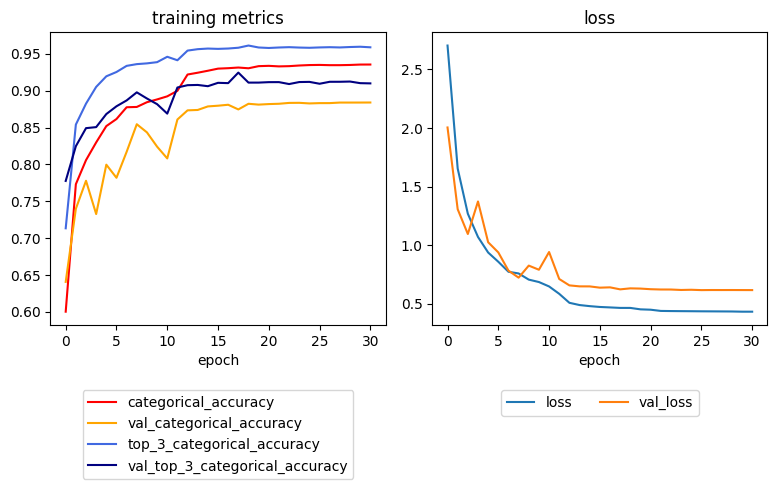

In [ ]:
log = pd.read_csv(log_path)

fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(20*cm, 15*cm))

ax1.plot(log['epoch'], log['categorical_accuracy'], label='categorical_accuracy', color='red')
ax1.plot(log['epoch'], log['val_categorical_accuracy'], label='val_categorical_accuracy', color='orange')
ax1.plot(log['epoch'], log[f'top_{top_k}_categorical_accuracy'], label=f'top_{top_k}_categorical_accuracy', color='royalblue')
ax1.plot(log['epoch'], log[f'val_top_{top_k}_categorical_accuracy'], label=f'val_top_{top_k}_categorical_accuracy', color='navy')
ax1.set_title('training metrics')
ax1.set_xlabel('epoch')
ax1.legend(loc='upper center', bbox_to_anchor=(0.5, -0.2), ncol=1)  # Legend below the plot

ax2.plot(log['epoch'], log['loss'], label='loss')
ax2.plot(log['epoch'], log['val_loss'], label='val_loss')
ax2.set_title('loss')
ax2.set_xlabel('epoch')
ax2.legend(loc='upper center', bbox_to_anchor=(0.5, -0.2), ncol=2)  # Legend below the plot

fig.tight_layout(rect=[0, 0.1, 1, 1])

plt.savefig(f'{checkpoint_path}/metrics_loss.svg')
plt.show()

In [ ]:
# load old model, if needed
try:
    model
except NameError:
    model = load_model(model_path)

In [ ]:
# evaluate model
score = model.evaluate(x=Generator(X_test, y_test, 128, max_sequence_length))


  1/407 ━━━━━━━━━━━━━━━━━━━━ 25s 63ms/step - categorical_accuracy: 0.8750 - loss: 0.3694 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.8750 - w_top_3_categorical_accuracy: 0.9219


  4/407 ━━━━━━━━━━━━━━━━━━━━ 7s 18ms/step - categorical_accuracy: 0.9066 - loss: 0.3146 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.9066 - w_top_3_categorical_accuracy: 0.9364 


  7/407 ━━━━━━━━━━━━━━━━━━━━ 7s 19ms/step - categorical_accuracy: 0.9103 - loss: 0.3060 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.9103 - w_top_3_categorical_accuracy: 0.9394


 10/407 ━━━━━━━━━━━━━━━━━━━━ 7s 19ms/step - categorical_accuracy: 0.9087 - loss: 0.3095 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.9087 - w_top_3_categorical_accuracy: 0.9386


 13/407 ━━━━━━━━━━━━━━━━━━━━ 7s 19ms/step - categorical_accuracy: 0.9083 - loss: 0.3108 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.9083 - w_top_3_categorical_accuracy: 0.9386


 16/407 ━━━━━━━━━━━━━━━━━━━━ 7s 19ms/step - categorical_accuracy: 0.9079 - loss: 0.3139 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.9079 - w_top_3_categorical_accuracy: 0.9384


 19/407 ━━━━━━━━━━━━━━━━━━━━ 7s 19ms/step - categorical_accuracy: 0.9082 - loss: 0.3149 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.9082 - w_top_3_categorical_accuracy: 0.9386


 22/407 ━━━━━━━━━━━━━━━━━━━━ 7s 19ms/step - categorical_accuracy: 0.9087 - loss: 0.3141 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.9087 - w_top_3_categorical_accuracy: 0.9388


 25/407 ━━━━━━━━━━━━━━━━━━━━ 7s 19ms/step - categorical_accuracy: 0.9091 - loss: 0.3140 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.9091 - w_top_3_categorical_accuracy: 0.9390


 28/407 ━━━━━━━━━━━━━━━━━━━━ 7s 19ms/step - categorical_accuracy: 0.9095 - loss: 0.3135 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.9095 - w_top_3_categorical_accuracy: 0.9392


 31/407 ━━━━━━━━━━━━━━━━━━━━ 7s 19ms/step - categorical_accuracy: 0.9098 - loss: 0.3132 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.9098 - w_top_3_categorical_accuracy: 0.9394


 34/407 ━━━━━━━━━━━━━━━━━━━━ 7s 19ms/step - categorical_accuracy: 0.9100 - loss: 0.3133 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.9100 - w_top_3_categorical_accuracy: 0.9395


 37/407 ━━━━━━━━━━━━━━━━━━━━ 7s 19ms/step - categorical_accuracy: 0.9101 - loss: 0.3133 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.9101 - w_top_3_categorical_accuracy: 0.9396


 40/407 ━━━━━━━━━━━━━━━━━━━━ 7s 19ms/step - categorical_accuracy: 0.9102 - loss: 0.3132 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.9102 - w_top_3_categorical_accuracy: 0.9397


 43/407 ━━━━━━━━━━━━━━━━━━━━ 7s 19ms/step - categorical_accuracy: 0.9104 - loss: 0.3129 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.9104 - w_top_3_categorical_accuracy: 0.9398


 46/407 ━━━━━━━━━━━━━━━━━━━━ 6s 19ms/step - categorical_accuracy: 0.9105 - loss: 0.3128 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.9105 - w_top_3_categorical_accuracy: 0.9398


 49/407 ━━━━━━━━━━━━━━━━━━━━ 6s 19ms/step - categorical_accuracy: 0.9106 - loss: 0.3128 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.9106 - w_top_3_categorical_accuracy: 0.9399


 52/407 ━━━━━━━━━━━━━━━━━━━━ 6s 19ms/step - categorical_accuracy: 0.9107 - loss: 0.3127 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.9107 - w_top_3_categorical_accuracy: 0.9399


 55/407 ━━━━━━━━━━━━━━━━━━━━ 6s 19ms/step - categorical_accuracy: 0.9108 - loss: 0.3126 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.9108 - w_top_3_categorical_accuracy: 0.9400


 58/407 ━━━━━━━━━━━━━━━━━━━━ 6s 19ms/step - categorical_accuracy: 0.9110 - loss: 0.3124 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.9110 - w_top_3_categorical_accuracy: 0.9401


 61/407 ━━━━━━━━━━━━━━━━━━━━ 6s 19ms/step - categorical_accuracy: 0.9111 - loss: 0.3123 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.9111 - w_top_3_categorical_accuracy: 0.9402


 64/407 ━━━━━━━━━━━━━━━━━━━━ 6s 19ms/step - categorical_accuracy: 0.9112 - loss: 0.3123 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.9112 - w_top_3_categorical_accuracy: 0.9403


 67/407 ━━━━━━━━━━━━━━━━━━━━ 6s 19ms/step - categorical_accuracy: 0.9113 - loss: 0.3120 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.9113 - w_top_3_categorical_accuracy: 0.9404


 70/407 ━━━━━━━━━━━━━━━━━━━━ 6s 19ms/step - categorical_accuracy: 0.9114 - loss: 0.3118 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.9114 - w_top_3_categorical_accuracy: 0.9405


 73/407 ━━━━━━━━━━━━━━━━━━━━ 6s 19ms/step - categorical_accuracy: 0.9116 - loss: 0.3115 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.9116 - w_top_3_categorical_accuracy: 0.9406


 76/407 ━━━━━━━━━━━━━━━━━━━━ 6s 19ms/step - categorical_accuracy: 0.9117 - loss: 0.3112 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.9117 - w_top_3_categorical_accuracy: 0.9407


 79/407 ━━━━━━━━━━━━━━━━━━━━ 6s 19ms/step - categorical_accuracy: 0.9118 - loss: 0.3110 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.9118 - w_top_3_categorical_accuracy: 0.9408


 82/407 ━━━━━━━━━━━━━━━━━━━━ 6s 19ms/step - categorical_accuracy: 0.9119 - loss: 0.3108 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.9119 - w_top_3_categorical_accuracy: 0.9408


 85/407 ━━━━━━━━━━━━━━━━━━━━ 6s 19ms/step - categorical_accuracy: 0.9120 - loss: 0.3105 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.9120 - w_top_3_categorical_accuracy: 0.9409


 88/407 ━━━━━━━━━━━━━━━━━━━━ 6s 19ms/step - categorical_accuracy: 0.9121 - loss: 0.3103 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.9121 - w_top_3_categorical_accuracy: 0.9409


 91/407 ━━━━━━━━━━━━━━━━━━━━ 6s 19ms/step - categorical_accuracy: 0.9121 - loss: 0.3102 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.9121 - w_top_3_categorical_accuracy: 0.9410


 94/407 ━━━━━━━━━━━━━━━━━━━━ 6s 19ms/step - categorical_accuracy: 0.9122 - loss: 0.3100 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.9122 - w_top_3_categorical_accuracy: 0.9410


 97/407 ━━━━━━━━━━━━━━━━━━━━ 6s 19ms/step - categorical_accuracy: 0.9123 - loss: 0.3099 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.9123 - w_top_3_categorical_accuracy: 0.9411


100/407 ━━━━━━━━━━━━━━━━━━━━ 5s 19ms/step - categorical_accuracy: 0.9124 - loss: 0.3097 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.9124 - w_top_3_categorical_accuracy: 0.9411


103/407 ━━━━━━━━━━━━━━━━━━━━ 5s 19ms/step - categorical_accuracy: 0.9124 - loss: 0.3096 - top_3_categorical_accuracy: 0.9412 - w_categorical_accuracy: 0.9124 - w_top_3_categorical_accuracy: 0.9412


106/407 ━━━━━━━━━━━━━━━━━━━━ 5s 19ms/step - categorical_accuracy: 0.9125 - loss: 0.3095 - top_3_categorical_accuracy: 0.9412 - w_categorical_accuracy: 0.9125 - w_top_3_categorical_accuracy: 0.9412


109/407 ━━━━━━━━━━━━━━━━━━━━ 5s 19ms/step - categorical_accuracy: 0.9125 - loss: 0.3094 - top_3_categorical_accuracy: 0.9412 - w_categorical_accuracy: 0.9125 - w_top_3_categorical_accuracy: 0.9412


112/407 ━━━━━━━━━━━━━━━━━━━━ 5s 19ms/step - categorical_accuracy: 0.9126 - loss: 0.3093 - top_3_categorical_accuracy: 0.9413 - w_categorical_accuracy: 0.9126 - w_top_3_categorical_accuracy: 0.9413


115/407 ━━━━━━━━━━━━━━━━━━━━ 5s 19ms/step - categorical_accuracy: 0.9127 - loss: 0.3091 - top_3_categorical_accuracy: 0.9413 - w_categorical_accuracy: 0.9127 - w_top_3_categorical_accuracy: 0.9413


118/407 ━━━━━━━━━━━━━━━━━━━━ 5s 19ms/step - categorical_accuracy: 0.9127 - loss: 0.3089 - top_3_categorical_accuracy: 0.9414 - w_categorical_accuracy: 0.9127 - w_top_3_categorical_accuracy: 0.9414


121/407 ━━━━━━━━━━━━━━━━━━━━ 5s 19ms/step - categorical_accuracy: 0.9128 - loss: 0.3087 - top_3_categorical_accuracy: 0.9415 - w_categorical_accuracy: 0.9128 - w_top_3_categorical_accuracy: 0.9415


124/407 ━━━━━━━━━━━━━━━━━━━━ 5s 19ms/step - categorical_accuracy: 0.9129 - loss: 0.3085 - top_3_categorical_accuracy: 0.9415 - w_categorical_accuracy: 0.9129 - w_top_3_categorical_accuracy: 0.9415


127/407 ━━━━━━━━━━━━━━━━━━━━ 5s 19ms/step - categorical_accuracy: 0.9130 - loss: 0.3083 - top_3_categorical_accuracy: 0.9416 - w_categorical_accuracy: 0.9130 - w_top_3_categorical_accuracy: 0.9416


130/407 ━━━━━━━━━━━━━━━━━━━━ 5s 19ms/step - categorical_accuracy: 0.9130 - loss: 0.3080 - top_3_categorical_accuracy: 0.9416 - w_categorical_accuracy: 0.9130 - w_top_3_categorical_accuracy: 0.9416


133/407 ━━━━━━━━━━━━━━━━━━━━ 5s 19ms/step - categorical_accuracy: 0.9131 - loss: 0.3078 - top_3_categorical_accuracy: 0.9417 - w_categorical_accuracy: 0.9131 - w_top_3_categorical_accuracy: 0.9417


136/407 ━━━━━━━━━━━━━━━━━━━━ 5s 19ms/step - categorical_accuracy: 0.9132 - loss: 0.3075 - top_3_categorical_accuracy: 0.9418 - w_categorical_accuracy: 0.9132 - w_top_3_categorical_accuracy: 0.9418


139/407 ━━━━━━━━━━━━━━━━━━━━ 5s 19ms/step - categorical_accuracy: 0.9133 - loss: 0.3073 - top_3_categorical_accuracy: 0.9418 - w_categorical_accuracy: 0.9133 - w_top_3_categorical_accuracy: 0.9418


142/407 ━━━━━━━━━━━━━━━━━━━━ 5s 19ms/step - categorical_accuracy: 0.9134 - loss: 0.3070 - top_3_categorical_accuracy: 0.9419 - w_categorical_accuracy: 0.9134 - w_top_3_categorical_accuracy: 0.9419


145/407 ━━━━━━━━━━━━━━━━━━━━ 5s 19ms/step - categorical_accuracy: 0.9135 - loss: 0.3067 - top_3_categorical_accuracy: 0.9419 - w_categorical_accuracy: 0.9135 - w_top_3_categorical_accuracy: 0.9419


148/407 ━━━━━━━━━━━━━━━━━━━━ 4s 19ms/step - categorical_accuracy: 0.9135 - loss: 0.3065 - top_3_categorical_accuracy: 0.9420 - w_categorical_accuracy: 0.9135 - w_top_3_categorical_accuracy: 0.9420


151/407 ━━━━━━━━━━━━━━━━━━━━ 4s 19ms/step - categorical_accuracy: 0.9136 - loss: 0.3063 - top_3_categorical_accuracy: 0.9420 - w_categorical_accuracy: 0.9136 - w_top_3_categorical_accuracy: 0.9420


154/407 ━━━━━━━━━━━━━━━━━━━━ 4s 19ms/step - categorical_accuracy: 0.9136 - loss: 0.3061 - top_3_categorical_accuracy: 0.9421 - w_categorical_accuracy: 0.9136 - w_top_3_categorical_accuracy: 0.9421


157/407 ━━━━━━━━━━━━━━━━━━━━ 4s 19ms/step - categorical_accuracy: 0.9137 - loss: 0.3059 - top_3_categorical_accuracy: 0.9421 - w_categorical_accuracy: 0.9137 - w_top_3_categorical_accuracy: 0.9421


160/407 ━━━━━━━━━━━━━━━━━━━━ 4s 19ms/step - categorical_accuracy: 0.9138 - loss: 0.3057 - top_3_categorical_accuracy: 0.9422 - w_categorical_accuracy: 0.9138 - w_top_3_categorical_accuracy: 0.9422


163/407 ━━━━━━━━━━━━━━━━━━━━ 4s 19ms/step - categorical_accuracy: 0.9138 - loss: 0.3055 - top_3_categorical_accuracy: 0.9422 - w_categorical_accuracy: 0.9138 - w_top_3_categorical_accuracy: 0.9422


166/407 ━━━━━━━━━━━━━━━━━━━━ 4s 19ms/step - categorical_accuracy: 0.9138 - loss: 0.3053 - top_3_categorical_accuracy: 0.9422 - w_categorical_accuracy: 0.9138 - w_top_3_categorical_accuracy: 0.9422


169/407 ━━━━━━━━━━━━━━━━━━━━ 4s 19ms/step - categorical_accuracy: 0.9139 - loss: 0.3052 - top_3_categorical_accuracy: 0.9423 - w_categorical_accuracy: 0.9139 - w_top_3_categorical_accuracy: 0.9423


172/407 ━━━━━━━━━━━━━━━━━━━━ 4s 19ms/step - categorical_accuracy: 0.9139 - loss: 0.3050 - top_3_categorical_accuracy: 0.9423 - w_categorical_accuracy: 0.9139 - w_top_3_categorical_accuracy: 0.9423


175/407 ━━━━━━━━━━━━━━━━━━━━ 4s 19ms/step - categorical_accuracy: 0.9139 - loss: 0.3048 - top_3_categorical_accuracy: 0.9423 - w_categorical_accuracy: 0.9139 - w_top_3_categorical_accuracy: 0.9423


178/407 ━━━━━━━━━━━━━━━━━━━━ 4s 19ms/step - categorical_accuracy: 0.9140 - loss: 0.3047 - top_3_categorical_accuracy: 0.9423 - w_categorical_accuracy: 0.9140 - w_top_3_categorical_accuracy: 0.9423


181/407 ━━━━━━━━━━━━━━━━━━━━ 4s 19ms/step - categorical_accuracy: 0.9140 - loss: 0.3046 - top_3_categorical_accuracy: 0.9424 - w_categorical_accuracy: 0.9140 - w_top_3_categorical_accuracy: 0.9424


184/407 ━━━━━━━━━━━━━━━━━━━━ 4s 19ms/step - categorical_accuracy: 0.9141 - loss: 0.3044 - top_3_categorical_accuracy: 0.9424 - w_categorical_accuracy: 0.9141 - w_top_3_categorical_accuracy: 0.9424


187/407 ━━━━━━━━━━━━━━━━━━━━ 4s 19ms/step - categorical_accuracy: 0.9141 - loss: 0.3043 - top_3_categorical_accuracy: 0.9424 - w_categorical_accuracy: 0.9141 - w_top_3_categorical_accuracy: 0.9424


190/407 ━━━━━━━━━━━━━━━━━━━━ 4s 19ms/step - categorical_accuracy: 0.9141 - loss: 0.3041 - top_3_categorical_accuracy: 0.9425 - w_categorical_accuracy: 0.9141 - w_top_3_categorical_accuracy: 0.9425


193/407 ━━━━━━━━━━━━━━━━━━━━ 4s 19ms/step - categorical_accuracy: 0.9142 - loss: 0.3040 - top_3_categorical_accuracy: 0.9425 - w_categorical_accuracy: 0.9142 - w_top_3_categorical_accuracy: 0.9425


196/407 ━━━━━━━━━━━━━━━━━━━━ 4s 19ms/step - categorical_accuracy: 0.9142 - loss: 0.3039 - top_3_categorical_accuracy: 0.9425 - w_categorical_accuracy: 0.9142 - w_top_3_categorical_accuracy: 0.9425


199/407 ━━━━━━━━━━━━━━━━━━━━ 4s 19ms/step - categorical_accuracy: 0.9143 - loss: 0.3037 - top_3_categorical_accuracy: 0.9425 - w_categorical_accuracy: 0.9143 - w_top_3_categorical_accuracy: 0.9425


202/407 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step - categorical_accuracy: 0.9143 - loss: 0.3036 - top_3_categorical_accuracy: 0.9425 - w_categorical_accuracy: 0.9143 - w_top_3_categorical_accuracy: 0.9425


205/407 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step - categorical_accuracy: 0.9143 - loss: 0.3035 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.9143 - w_top_3_categorical_accuracy: 0.9426


208/407 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step - categorical_accuracy: 0.9143 - loss: 0.3034 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.9143 - w_top_3_categorical_accuracy: 0.9426


211/407 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step - categorical_accuracy: 0.9144 - loss: 0.3033 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.9144 - w_top_3_categorical_accuracy: 0.9426


214/407 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step - categorical_accuracy: 0.9144 - loss: 0.3032 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.9144 - w_top_3_categorical_accuracy: 0.9426


217/407 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step - categorical_accuracy: 0.9144 - loss: 0.3032 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.9144 - w_top_3_categorical_accuracy: 0.9426


220/407 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step - categorical_accuracy: 0.9144 - loss: 0.3031 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.9144 - w_top_3_categorical_accuracy: 0.9426


223/407 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step - categorical_accuracy: 0.9145 - loss: 0.3030 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.9145 - w_top_3_categorical_accuracy: 0.9426


226/407 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step - categorical_accuracy: 0.9145 - loss: 0.3029 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.9145 - w_top_3_categorical_accuracy: 0.9426


229/407 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step - categorical_accuracy: 0.9145 - loss: 0.3028 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.9145 - w_top_3_categorical_accuracy: 0.9426


232/407 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step - categorical_accuracy: 0.9145 - loss: 0.3027 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.9145 - w_top_3_categorical_accuracy: 0.9426


235/407 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step - categorical_accuracy: 0.9146 - loss: 0.3026 - top_3_categorical_accuracy: 0.9427 - w_categorical_accuracy: 0.9146 - w_top_3_categorical_accuracy: 0.9427


238/407 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step - categorical_accuracy: 0.9146 - loss: 0.3026 - top_3_categorical_accuracy: 0.9427 - w_categorical_accuracy: 0.9146 - w_top_3_categorical_accuracy: 0.9427


241/407 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step - categorical_accuracy: 0.9146 - loss: 0.3025 - top_3_categorical_accuracy: 0.9427 - w_categorical_accuracy: 0.9146 - w_top_3_categorical_accuracy: 0.9427


244/407 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step - categorical_accuracy: 0.9146 - loss: 0.3024 - top_3_categorical_accuracy: 0.9427 - w_categorical_accuracy: 0.9146 - w_top_3_categorical_accuracy: 0.9427


247/407 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step - categorical_accuracy: 0.9147 - loss: 0.3023 - top_3_categorical_accuracy: 0.9427 - w_categorical_accuracy: 0.9147 - w_top_3_categorical_accuracy: 0.9427


250/407 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step - categorical_accuracy: 0.9147 - loss: 0.3023 - top_3_categorical_accuracy: 0.9427 - w_categorical_accuracy: 0.9147 - w_top_3_categorical_accuracy: 0.9427


253/407 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - categorical_accuracy: 0.9147 - loss: 0.3022 - top_3_categorical_accuracy: 0.9427 - w_categorical_accuracy: 0.9147 - w_top_3_categorical_accuracy: 0.9427


256/407 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - categorical_accuracy: 0.9147 - loss: 0.3021 - top_3_categorical_accuracy: 0.9427 - w_categorical_accuracy: 0.9147 - w_top_3_categorical_accuracy: 0.9427


259/407 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - categorical_accuracy: 0.9148 - loss: 0.3021 - top_3_categorical_accuracy: 0.9427 - w_categorical_accuracy: 0.9148 - w_top_3_categorical_accuracy: 0.9427


262/407 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - categorical_accuracy: 0.9148 - loss: 0.3020 - top_3_categorical_accuracy: 0.9428 - w_categorical_accuracy: 0.9148 - w_top_3_categorical_accuracy: 0.9428


265/407 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - categorical_accuracy: 0.9148 - loss: 0.3019 - top_3_categorical_accuracy: 0.9428 - w_categorical_accuracy: 0.9148 - w_top_3_categorical_accuracy: 0.9428


268/407 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - categorical_accuracy: 0.9148 - loss: 0.3018 - top_3_categorical_accuracy: 0.9428 - w_categorical_accuracy: 0.9148 - w_top_3_categorical_accuracy: 0.9428


271/407 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - categorical_accuracy: 0.9149 - loss: 0.3017 - top_3_categorical_accuracy: 0.9428 - w_categorical_accuracy: 0.9149 - w_top_3_categorical_accuracy: 0.9428


274/407 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - categorical_accuracy: 0.9149 - loss: 0.3016 - top_3_categorical_accuracy: 0.9428 - w_categorical_accuracy: 0.9149 - w_top_3_categorical_accuracy: 0.9428


277/407 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - categorical_accuracy: 0.9149 - loss: 0.3015 - top_3_categorical_accuracy: 0.9428 - w_categorical_accuracy: 0.9149 - w_top_3_categorical_accuracy: 0.9428


280/407 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - categorical_accuracy: 0.9149 - loss: 0.3015 - top_3_categorical_accuracy: 0.9428 - w_categorical_accuracy: 0.9149 - w_top_3_categorical_accuracy: 0.9428


283/407 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - categorical_accuracy: 0.9150 - loss: 0.3014 - top_3_categorical_accuracy: 0.9428 - w_categorical_accuracy: 0.9150 - w_top_3_categorical_accuracy: 0.9428


286/407 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - categorical_accuracy: 0.9150 - loss: 0.3013 - top_3_categorical_accuracy: 0.9428 - w_categorical_accuracy: 0.9150 - w_top_3_categorical_accuracy: 0.9428


289/407 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - categorical_accuracy: 0.9150 - loss: 0.3012 - top_3_categorical_accuracy: 0.9428 - w_categorical_accuracy: 0.9150 - w_top_3_categorical_accuracy: 0.9428


292/407 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - categorical_accuracy: 0.9150 - loss: 0.3011 - top_3_categorical_accuracy: 0.9429 - w_categorical_accuracy: 0.9150 - w_top_3_categorical_accuracy: 0.9429


295/407 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - categorical_accuracy: 0.9150 - loss: 0.3011 - top_3_categorical_accuracy: 0.9429 - w_categorical_accuracy: 0.9150 - w_top_3_categorical_accuracy: 0.9429


298/407 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - categorical_accuracy: 0.9151 - loss: 0.3010 - top_3_categorical_accuracy: 0.9429 - w_categorical_accuracy: 0.9151 - w_top_3_categorical_accuracy: 0.9429


301/407 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - categorical_accuracy: 0.9151 - loss: 0.3010 - top_3_categorical_accuracy: 0.9429 - w_categorical_accuracy: 0.9151 - w_top_3_categorical_accuracy: 0.9429


304/407 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - categorical_accuracy: 0.9151 - loss: 0.3009 - top_3_categorical_accuracy: 0.9429 - w_categorical_accuracy: 0.9151 - w_top_3_categorical_accuracy: 0.9429


307/407 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - categorical_accuracy: 0.9151 - loss: 0.3008 - top_3_categorical_accuracy: 0.9429 - w_categorical_accuracy: 0.9151 - w_top_3_categorical_accuracy: 0.9429


310/407 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - categorical_accuracy: 0.9151 - loss: 0.3007 - top_3_categorical_accuracy: 0.9429 - w_categorical_accuracy: 0.9151 - w_top_3_categorical_accuracy: 0.9429


313/407 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - categorical_accuracy: 0.9151 - loss: 0.3007 - top_3_categorical_accuracy: 0.9429 - w_categorical_accuracy: 0.9151 - w_top_3_categorical_accuracy: 0.9429


316/407 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - categorical_accuracy: 0.9152 - loss: 0.3006 - top_3_categorical_accuracy: 0.9429 - w_categorical_accuracy: 0.9152 - w_top_3_categorical_accuracy: 0.9429


319/407 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - categorical_accuracy: 0.9152 - loss: 0.3005 - top_3_categorical_accuracy: 0.9429 - w_categorical_accuracy: 0.9152 - w_top_3_categorical_accuracy: 0.9429


322/407 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - categorical_accuracy: 0.9152 - loss: 0.3005 - top_3_categorical_accuracy: 0.9429 - w_categorical_accuracy: 0.9152 - w_top_3_categorical_accuracy: 0.9429


325/407 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - categorical_accuracy: 0.9152 - loss: 0.3004 - top_3_categorical_accuracy: 0.9429 - w_categorical_accuracy: 0.9152 - w_top_3_categorical_accuracy: 0.9429


328/407 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - categorical_accuracy: 0.9152 - loss: 0.3003 - top_3_categorical_accuracy: 0.9429 - w_categorical_accuracy: 0.9152 - w_top_3_categorical_accuracy: 0.9429


331/407 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - categorical_accuracy: 0.9152 - loss: 0.3002 - top_3_categorical_accuracy: 0.9429 - w_categorical_accuracy: 0.9152 - w_top_3_categorical_accuracy: 0.9429


334/407 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - categorical_accuracy: 0.9153 - loss: 0.3002 - top_3_categorical_accuracy: 0.9430 - w_categorical_accuracy: 0.9153 - w_top_3_categorical_accuracy: 0.9430


337/407 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - categorical_accuracy: 0.9153 - loss: 0.3001 - top_3_categorical_accuracy: 0.9430 - w_categorical_accuracy: 0.9153 - w_top_3_categorical_accuracy: 0.9430


340/407 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - categorical_accuracy: 0.9153 - loss: 0.3000 - top_3_categorical_accuracy: 0.9430 - w_categorical_accuracy: 0.9153 - w_top_3_categorical_accuracy: 0.9430


343/407 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - categorical_accuracy: 0.9153 - loss: 0.3000 - top_3_categorical_accuracy: 0.9430 - w_categorical_accuracy: 0.9153 - w_top_3_categorical_accuracy: 0.9430


346/407 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - categorical_accuracy: 0.9153 - loss: 0.2999 - top_3_categorical_accuracy: 0.9430 - w_categorical_accuracy: 0.9153 - w_top_3_categorical_accuracy: 0.9430


349/407 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - categorical_accuracy: 0.9153 - loss: 0.2998 - top_3_categorical_accuracy: 0.9430 - w_categorical_accuracy: 0.9153 - w_top_3_categorical_accuracy: 0.9430


352/407 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - categorical_accuracy: 0.9154 - loss: 0.2997 - top_3_categorical_accuracy: 0.9430 - w_categorical_accuracy: 0.9154 - w_top_3_categorical_accuracy: 0.9430


355/407 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - categorical_accuracy: 0.9154 - loss: 0.2997 - top_3_categorical_accuracy: 0.9430 - w_categorical_accuracy: 0.9154 - w_top_3_categorical_accuracy: 0.9430


358/407 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - categorical_accuracy: 0.9154 - loss: 0.2996 - top_3_categorical_accuracy: 0.9430 - w_categorical_accuracy: 0.9154 - w_top_3_categorical_accuracy: 0.9430


361/407 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - categorical_accuracy: 0.9154 - loss: 0.2995 - top_3_categorical_accuracy: 0.9430 - w_categorical_accuracy: 0.9154 - w_top_3_categorical_accuracy: 0.9430


364/407 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - categorical_accuracy: 0.9154 - loss: 0.2995 - top_3_categorical_accuracy: 0.9430 - w_categorical_accuracy: 0.9154 - w_top_3_categorical_accuracy: 0.9430


367/407 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - categorical_accuracy: 0.9154 - loss: 0.2994 - top_3_categorical_accuracy: 0.9430 - w_categorical_accuracy: 0.9154 - w_top_3_categorical_accuracy: 0.9430


370/407 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - categorical_accuracy: 0.9155 - loss: 0.2994 - top_3_categorical_accuracy: 0.9431 - w_categorical_accuracy: 0.9155 - w_top_3_categorical_accuracy: 0.9431


373/407 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - categorical_accuracy: 0.9155 - loss: 0.2993 - top_3_categorical_accuracy: 0.9431 - w_categorical_accuracy: 0.9155 - w_top_3_categorical_accuracy: 0.9431


376/407 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - categorical_accuracy: 0.9155 - loss: 0.2993 - top_3_categorical_accuracy: 0.9431 - w_categorical_accuracy: 0.9155 - w_top_3_categorical_accuracy: 0.9431


379/407 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - categorical_accuracy: 0.9155 - loss: 0.2992 - top_3_categorical_accuracy: 0.9431 - w_categorical_accuracy: 0.9155 - w_top_3_categorical_accuracy: 0.9431


382/407 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - categorical_accuracy: 0.9155 - loss: 0.2992 - top_3_categorical_accuracy: 0.9431 - w_categorical_accuracy: 0.9155 - w_top_3_categorical_accuracy: 0.9431


385/407 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - categorical_accuracy: 0.9155 - loss: 0.2991 - top_3_categorical_accuracy: 0.9431 - w_categorical_accuracy: 0.9155 - w_top_3_categorical_accuracy: 0.9431


388/407 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - categorical_accuracy: 0.9155 - loss: 0.2991 - top_3_categorical_accuracy: 0.9431 - w_categorical_accuracy: 0.9155 - w_top_3_categorical_accuracy: 0.9431


391/407 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - categorical_accuracy: 0.9156 - loss: 0.2990 - top_3_categorical_accuracy: 0.9431 - w_categorical_accuracy: 0.9156 - w_top_3_categorical_accuracy: 0.9431


394/407 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - categorical_accuracy: 0.9156 - loss: 0.2990 - top_3_categorical_accuracy: 0.9431 - w_categorical_accuracy: 0.9156 - w_top_3_categorical_accuracy: 0.9431


397/407 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - categorical_accuracy: 0.9156 - loss: 0.2989 - top_3_categorical_accuracy: 0.9431 - w_categorical_accuracy: 0.9156 - w_top_3_categorical_accuracy: 0.9431


400/407 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - categorical_accuracy: 0.9156 - loss: 0.2989 - top_3_categorical_accuracy: 0.9431 - w_categorical_accuracy: 0.9156 - w_top_3_categorical_accuracy: 0.9431


403/407 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - categorical_accuracy: 0.9156 - loss: 0.2988 - top_3_categorical_accuracy: 0.9431 - w_categorical_accuracy: 0.9156 - w_top_3_categorical_accuracy: 0.9431


406/407 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - categorical_accuracy: 0.9156 - loss: 0.2988 - top_3_categorical_accuracy: 0.9431 - w_categorical_accuracy: 0.9156 - w_top_3_categorical_accuracy: 0.9431


407/407 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - categorical_accuracy: 0.9156 - loss: 0.2988 - top_3_categorical_accuracy: 0.9431 - w_categorical_accuracy: 0.9156 - w_top_3_categorical_accuracy: 0.9431


407/407 ━━━━━━━━━━━━━━━━━━━━ 8s 21ms/step - categorical_accuracy: 0.9156 - loss: 0.2988 - top_3_categorical_accuracy: 0.9431 - w_categorical_accuracy: 0.9156 - w_top_3_categorical_accuracy: 0.9431


In [ ]:
print(f'Test loss: {score[0]}')
print(f'Test accuracy: {score[1]}')

Test loss: 0.2937542498111725
Test accuracy: 0.9171146750450134


In [ ]:
# print classification report
y_pred = model.predict(x=Generator(X_test, y_test, 128, max_sequence_length))
y_pred = np.argmax(y_pred, axis=1)
y_true = np.argmax(y_test, axis=1)

distinct_labels = [labels_map[i] for i in range(labels_cardinality)]

report = classification_report(y_true, y_pred, target_names=distinct_labels, zero_division=np.nan)
report_dict = classification_report(y_true, y_pred, target_names=distinct_labels, zero_division=np.nan, output_dict=True)

print(report)

# save classification report to file
with open(f'{checkpoint_path}/classification_report.txt', 'w') as f:
    json.dump(report_dict, f)


  1/407 ━━━━━━━━━━━━━━━━━━━━ 4:05 604ms/step


  4/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step   


  7/407 ━━━━━━━━━━━━━━━━━━━━ 7s 18ms/step


 11/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step


 15/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step


 19/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step


 23/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step


 26/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step


 29/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step


 33/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step


 36/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step


 40/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step


 43/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step


 47/407 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step


 51/407 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step


 54/407 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step


 57/407 ━━━━━━━━━━━━━━━━━━━━ 5s 17ms/step


 61/407 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step


 65/407 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step


 69/407 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step


 73/407 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step


 77/407 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step


 81/407 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step


 84/407 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step


 88/407 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step


 91/407 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step


 95/407 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step


 98/407 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step


101/407 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step


105/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step


108/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step


111/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step


115/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step


119/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step


123/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step


127/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step


131/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step


134/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step


137/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step


140/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step


143/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step


146/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step


150/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step


155/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step


158/407 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step


162/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step


165/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step


169/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step


172/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step


176/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step


179/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step


182/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step


186/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step


190/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step


193/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step


197/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step


201/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step


205/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step


209/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step


214/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step


218/407 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step


222/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step


226/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step


230/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step


235/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step


240/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step


244/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step


248/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step


252/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step


256/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step


260/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step


263/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step


268/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step


272/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step


276/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step


279/407 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step


284/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step


287/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step


290/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step


294/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step


298/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step


301/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step


306/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step


310/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step


315/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step


319/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step


323/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step


329/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step


334/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step


337/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step


340/407 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step


344/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step


347/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step


351/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step


355/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step


358/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step


362/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step


366/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step


370/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step


374/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step


378/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step


381/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step


384/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step


388/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step


392/407 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step


397/407 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step


401/407 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step


405/407 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step


407/407 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


407/407 ━━━━━━━━━━━━━━━━━━━━ 8s 17ms/step


                 precision    recall  f1-score   support

      adjkerntz       0.46      1.00      0.63        11
         alpine       0.32      0.93      0.48       560
          anvil       0.23      0.46      0.30       378
          atrun       1.00      1.00      1.00       237
            awk       0.17      1.00      0.29         5
       basename       0.07      1.00      0.13         2
           bash       1.00      0.96      0.98     12512
            cat       0.59      0.92      0.72        26
        cleanup       0.86      0.64      0.73       276
            cmp       0.67      0.80      0.73         5
             cp       1.00      1.00      1.00        30
           cron       1.00      1.00      1.00       624
           date       0.96      1.00      0.98      1218
             dd       0.99      0.99      0.99       125
       dhclient       0.01      0.53      0.02        17
          dmesg       0.83      1.00      0.91        15
          egrep       0.20    

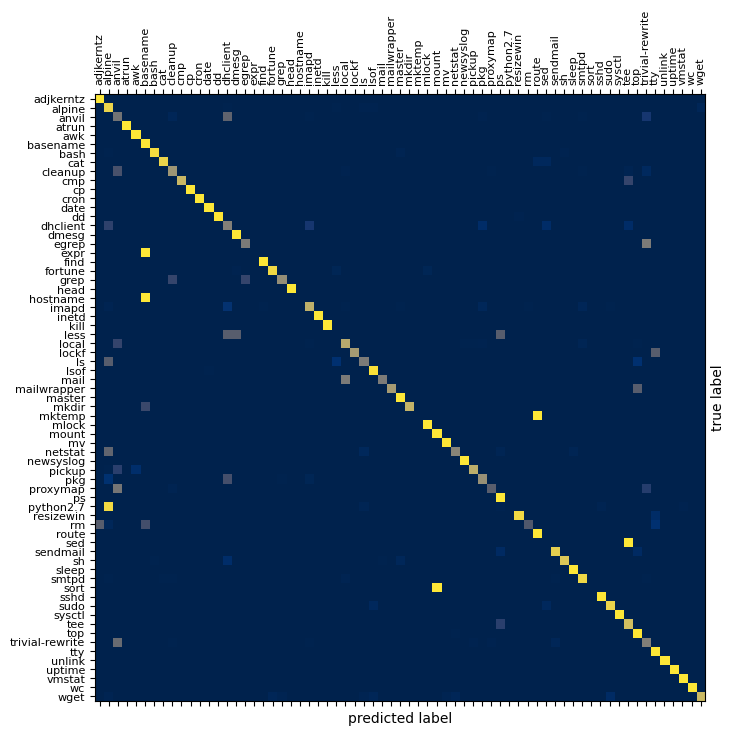

In [ ]:
# print confusion matrix
# labels explicitly set, because current model may not predict all labels
conf_matrix = confusion_matrix(y_true, y_pred, labels=range(labels_cardinality), normalize='true')

# Replace all NaN values with 0
conf_matrix = np.nan_to_num(conf_matrix)

# Verify the distinct labels align correctly
distinct_labels = [labels_map[i] for i in range(labels_cardinality)]

# Plot the confusion matrix
fig, ax = plt.subplots(figsize=(20*cm, 20*cm))

ax.matshow(conf_matrix, cmap='cividis', aspect='auto')

# Set class names on axes
ax.set_xticks(range(len(distinct_labels)))
ax.set_yticks(range(len(distinct_labels)))
ax.set_xticklabels(distinct_labels, rotation=90, fontsize=8)
ax.set_yticklabels(distinct_labels, fontsize=8)

# Set axis labels "predicted" and "actual"
ax.set_xlabel('predicted label')
ax.set_ylabel('true label')
# y-axis label right side
ax.yaxis.set_label_position('right')

# set figsize
plt.savefig(f'{checkpoint_path}/confusion_matrix.svg')
plt.show()

In [ ]:
unique_in_y_pred = [ labels_map[i] for i in np.unique(y_pred) ]
#print("Unique labels in y_pred:", unique_in_y_pred)

unique_not_in_y_pred = [ label for label in distinct_labels if label not in unique_in_y_pred ]
print("Unique labels not in y_pred:", unique_not_in_y_pred)

Unique labels not in y_pred: ['expr', 'hostname', 'python2.7']
